In [56]:
!pip install geopandas
!pip install tkinter
!pip install vega_datasets
!pip install "vegafusion[embed]"


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
ERROR: Could not find a version that satisfies the requirement tkinter (from versions: none)
ERROR: No matching distribution found for tkinter
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 616.3 kB/s eta 0:00:001m608.5 kB/s eta 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 25.1/25.1 MB 12.0 MB/s eta 0:00:00m eta 0:00:010:01:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.1/30.1 MB 37.5 MB/s eta 0:00:00m eta 0:00:010:00:01


In [ ]:
# =======================================================
# Imports
# =======================================================

import pandas as pd
import numpy as np
import streamlit as st
import altair as alt
from vega_datasets import data

import pandas as pd
import numpy as np
import streamlit as st
import altair as alt
import numpy as np
import json  
import random

import altair as alt
alt.data_transformers.enable("vegafusion")

DataTransformerRegistry.enable('vegafusion')

In [9]:
import altair as alt
from vega_datasets import data

# Since these data are each more than 5,000 rows we'll import from the URLs
airports = data.airports.url
flights_airport = data.flights_airport.url

data2 = data.us_10m.url
data2
#states = alt.topo_feature(data.us_10m.url, feature="states")

'https://cdn.jsdelivr.net/npm/vega-datasets@v1.29.0/data/us-10m.json'

In [1]:
import altair as alt
from vega_datasets import data

# Since these data are each more than 5,000 rows we'll import from the URLs
airports = data.airports.url
flights_airport = data.flights_airport.url

states = alt.topo_feature(data.us_10m.url, feature="states")

# Create pointerover selection
select_city = alt.selection_point(
    on="pointerover", nearest=True, fields=["origin"], empty=False
)

# Define which attributes to lookup from airports.csv
lookup_data = alt.LookupData(
    airports, key="iata", fields=["state", "latitude", "longitude"]
)

background = alt.Chart(states).mark_geoshape(
    fill="lightgray",
    stroke="white"
).properties(
    width=750,
    height=500
).project("albersUsa")

connections = alt.Chart(flights_airport).mark_rule(opacity=0.35).encode(
    latitude="latitude:Q",
    longitude="longitude:Q",
    latitude2="lat2:Q",
    longitude2="lon2:Q"
).transform_lookup(
    lookup="origin",
    from_=lookup_data
).transform_lookup(
    lookup="destination",
    from_=lookup_data,
    as_=["state", "lat2", "lon2"]
).transform_filter(
    select_city
)

points = alt.Chart(flights_airport).mark_circle().encode(
    latitude="latitude:Q",
    longitude="longitude:Q",
    size=alt.Size("routes:Q").legend(None).scale(range=[0, 1000]),
    order=alt.Order("routes:Q").sort("descending"),
    tooltip=["origin:N", "routes:Q"]
).transform_aggregate(
    routes="count()",
    groupby=["origin"]
).transform_lookup(
    lookup="origin",
    from_=lookup_data
).transform_filter(
    (alt.datum.state != "PR") & (alt.datum.state != "VI")
).add_params(
    select_city
)

(background + connections + points).configure_view(stroke=None)


alt.LayerChart(...)

In [9]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Carregar o arquivo SHP
gdf = gpd.read_file('202404A/SNV_202404A.shp')

# Plotar o mapa
gdf.plot(figsize=(10, 8))

# Adicionar um título
#plt.title('Mapa das BRs do Brasil')

# Salva a imagem
plt.savefig('mapa_brs_222.png')

# Mostrar o mapa
plt.show()



/tmp/ipykernel_781500/1687905532.py:17: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()


In [8]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Carregar o arquivo SHP
df_info = gpd.read_file('202404A/SNV_202404A.dbf')
df_info

df_info_filtrado = df_info[(df_info['ds_jurisdi'] == 'Federal')]
df_info_filtrado.info()
# Plotar o mapa
#gdf.plot(figsize=(10, 8))

# Adicionar um título
#plt.title('Mapa dos Estados Brasileiros')

# Mostrar o mapa
#plt.show()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 5989 entries, 0 to 7575
Data columns (total 29 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   id_trecho_  5989 non-null   int64   
 1   vl_br       5989 non-null   object  
 2   sg_uf       5989 non-null   object  
 3   nm_tipo_tr  5989 non-null   object  
 4   sg_tipo_tr  5989 non-null   object  
 5   desc_coinc  5989 non-null   object  
 6   vl_codigo   5989 non-null   object  
 7   ds_local_i  5989 non-null   object  
 8   ds_local_f  5989 non-null   object  
 9   vl_km_inic  5989 non-null   float64 
 10  vl_km_fina  5989 non-null   float64 
 11  vl_extensa  5989 non-null   float64 
 12  ds_sup_fed  5989 non-null   object  
 13  ds_obra     162 non-null    object  
 14  ul          5261 non-null   object  
 15  ds_coinc    5989 non-null   object  
 16  ds_tipo_ad  5989 non-null   object  
 17  ds_ato_leg  0 non-null      object  
 18  est_coinc   1 non-null      object  
 19  sup

In [11]:
df_info_filtrado.to_csv('resumo.csv',sep=';')

In [17]:
df_info_filtrado_br101 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == '101')]
df_info_filtrado_br101

,id_trecho_,vl_br,sg_uf,nm_tipo_tr,sg_tipo_tr,desc_coinc,vl_codigo,ds_local_i,ds_local_f,vl_km_inic,...,sup_est_co,ds_jurisdi,ds_superfi,ds_legenda,sg_legenda,leg_multim,versao_snv,id_versao,marcador,geometry
661,158715,101,ES,Acesso,A,-,101AES2005,ENTR BR-262(A) (COMPLEXO RODOVIÁRIO),ENTR BR-262(B)/ES-471,0.0,...,None,Federal,PAV,Duplicada,DUP,Duplicada,202404A,75,|,"LINESTRING (-40.40514 -20.34342, -40.40513 -20..."
662,158582,101,RJ,Acesso,A,-,101ARJ1005,AVENIDA SÃO BOAVENTURA (NITERÓI),ACESSO PONTE PRESIDENTE COSTA E SILVA,0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,"LINESTRING (-43.1147 -22.87869, -43.11423 -22...."
663,158585,101,RJ,Acesso,A,-,101ARJ1505,ACESSO PONTE PRESIDENTE COSTA E SILVA,ACESSO AVENIDA SÃO BOAVENTURA (NITERÓI),0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,"LINESTRING (-43.11387 -22.87965, -43.11375 -22..."
664,158583,101,RJ,Acesso,A,-,101ARJ2005,AVENIDA JANSEN DE MELO (NITERÓI),ACESSO PONTE PRESIDENTE COSTA E SILVA,0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,"LINESTRING (-43.1147 -22.87869, -43.11418 -22...."
665,158586,101,RJ,Acesso,A,-,101ARJ2505,ACESSO PONTE PRESIDENTE COSTA E SILVA,ACESSO AVENIDA JANSEN DE MELO,0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,"LINESTRING (-43.1147 -22.87869, -43.11443 -22...."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1098,162074,101,SC,Travessia Urbana,U,-,101USC1005,INÍCIO CONTORNO DE ARARANGUÁ,ENTR BR-285(A)/SC-447 (ARARANGUÁ),0.0,...,None,Federal,PAV,Duplicada,DUP,Duplicada,202404A,75,|,"LINESTRING (-49.49015 -28.91982, -49.49016 -28..."
1099,162075,101,SC,Travessia Urbana,U,-,101USC1010,ENTR BR-285(A)/SC-447 (ARARANGUÁ),FIM CONTORNO DE ARARANGUÁ,2.7,...,None,Federal,PAV,Duplicada,DUP,Duplicada,202404A,75,|,"LINESTRING (-49.49751 -28.93933, -49.49756 -28..."
1100,158541,101,RS,Variante,V,-,101VRS1005,INÍCIO PISTA INVERSA / VARIANTE DA GRUTA,FIM PISTA INVERSA / VARIANTE DA GRUTA,0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,"LINESTRING (-49.84734 -29.39633, -49.84748 -29..."
1101,164682,101,SC,Variante,V,-,101VSC1005,INÍCIO VARIANTE MORRO AGUDO,FIM VARIANTE MORRO AGUDO,0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,"LINESTRING (-48.6791 -27.98504, -48.6793 -27.9..."


In [18]:
df_info_filtrado_br101.to_csv('resumo_br101.csv',sep=';')

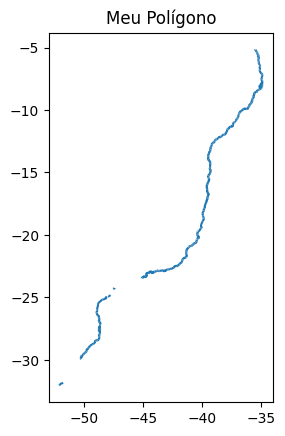

In [25]:

df_geometry = df_info_filtrado_br101['geometry']
df_geometry

# Carregar o shapefile (assumindo que contém um único polígono)
#gdf = gpd.read_file('meu_poligono.shp')

# Plotar o polígono
df_geometry.plot()

# Adicionar um título
plt.title('Meu Polígono - BR 101')

# Mostrar o plot
plt.show()

In [ ]:
|;LINESTRING (-49.10049073999994 -28.642913989999954, -49.09846921999997 -28.643939149999937, -49.097895609999966 -28.644358659999966, -49.09754506999997 -28.64480612999995, -49.09735385999994 -28.645253599999933, -49.09721841999993 -28.64548432999993, -49.09713875999995 -28.645861879999984, -49.09712281999998 -28.64629536999996, -49.097186559999955 -28.646882669999968, -49.09719451999996 -28.64737907999995, -49.097186559999955 -28.64770767999994, -49.09712281999998 -28.64803627999993, -49.09702721999997 -28.648287979999964, -49.096931619999964 -28.648490739999943, -49.096820079999986 -28.648756409999976, -49.09665277999994 -28.64905005999998, -49.09638189999998 -28.649385649999942, -49.09607915999993 -28.649742209999943, -49.093840469999975 -28.65208431999997, -49.09133091999996 -28.65462911999998, -49.091020209999954 -28.654978679999942, -49.09086086999997 -28.655209389999982, -49.090693569999985 -28.655461069999944, -49.09044658999994 -28.655887519999965, -49.09023148999995 -28.656286009999974, -49.09009604999994 -28.65649573999997, -49.08993671999997 -28.656684499999983, -49.08973753999993 -28.656894229999978, -49.08936309999996 -28.657278729999973, -49.087769729999934 -28.658858669999972, -49.08731561999997 -28.659278119999954, -49.08668623999995 -28.659900299999947, -49.08296570999994 -28.66356339999993, -49.07930892999997 -28.66729627999996, -49.078791079999974 -28.667792589999976, -49.076576289999934 -28.669973529999936, -49.07439336999994 -28.67214741999993, -49.07041790999995 -28.676096679999944, -49.069653089999974 -28.676837579999983, -49.06950171999995 -28.676984369999957, -49.068346529999985 -28.67768332999998)

In [35]:
import geopandas as gpd
import matplotlib.pyplot as plt

# =====================================
def retorna_resumo_geometria_br(br):
    
    # Carregar o arquivo SHP
    df_info = gpd.read_file('202404A/SNV_202404A.dbf')

    df_info_filtrado = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(br))]

    return df_info_filtrado
# =====================================
def salva_resumo_geometria_br(br, df):
    arquivo = f'geometrias-brs/resumo_geometria_br_{br}.csv'
    df.to_csv(arquivo ,sep=';')
    print(f'\n\nArquivo de geometria da BR {br} salvo - Arquivo: {arquivo}')
# =====================================
def plota_poligono_br(br, df):
    
    # Plotar o polígono
    df.plot()
    
    # Adicionar um título
    plt.title(f'Polígono da BR {br}')
    
    # Mostrar o plot
    plt.show()    
# =====================================




Arquivo de geometria da BR 101 salvo - Arquivo: resumo_geometria_br_101.csv


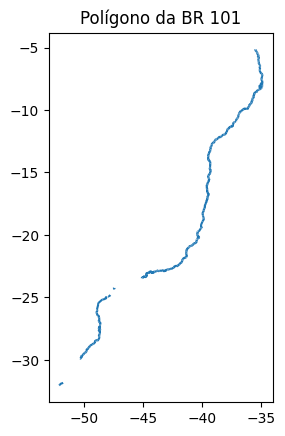

In [31]:
df = retorna_resumo_geometria_br('101')
salva_resumo_geometria_br('101', df)
plota_poligono_br('101', df)



Arquivo de geometria da BR 101 salvo - Arquivo: geometrias-brs/resumo_geometria_br_101.csv


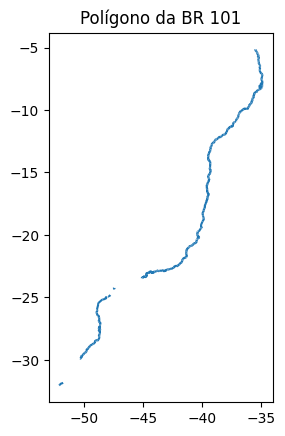



Arquivo de geometria da BR 116 salvo - Arquivo: geometrias-brs/resumo_geometria_br_116.csv


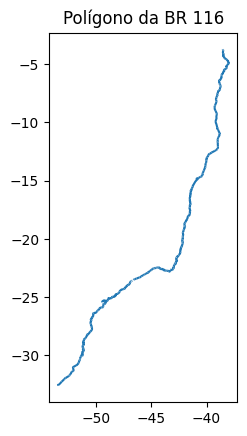



Arquivo de geometria da BR 381 salvo - Arquivo: geometrias-brs/resumo_geometria_br_381.csv


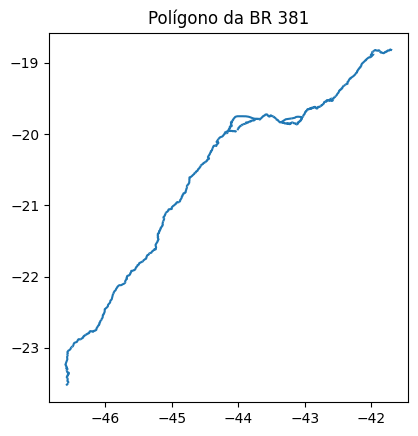



Arquivo de geometria da BR 040 salvo - Arquivo: geometrias-brs/resumo_geometria_br_040.csv


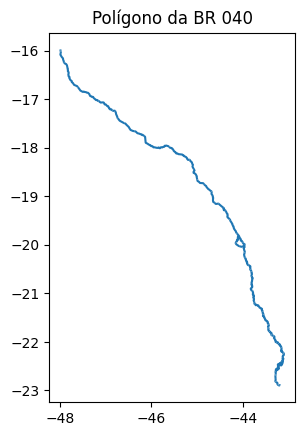



Arquivo de geometria da BR 153 salvo - Arquivo: geometrias-brs/resumo_geometria_br_153.csv


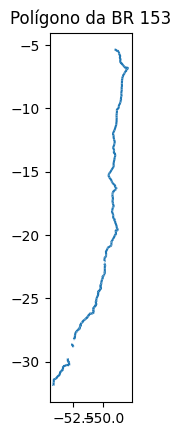



Arquivo de geometria da BR 163 salvo - Arquivo: geometrias-brs/resumo_geometria_br_163.csv


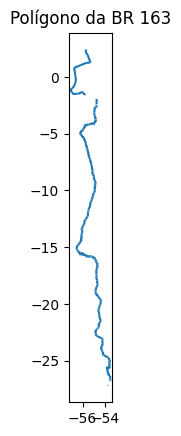



Arquivo de geometria da BR 364 salvo - Arquivo: geometrias-brs/resumo_geometria_br_364.csv


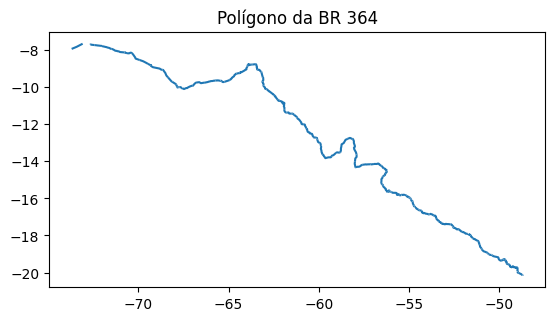



Arquivo de geometria da BR 376 salvo - Arquivo: geometrias-brs/resumo_geometria_br_376.csv


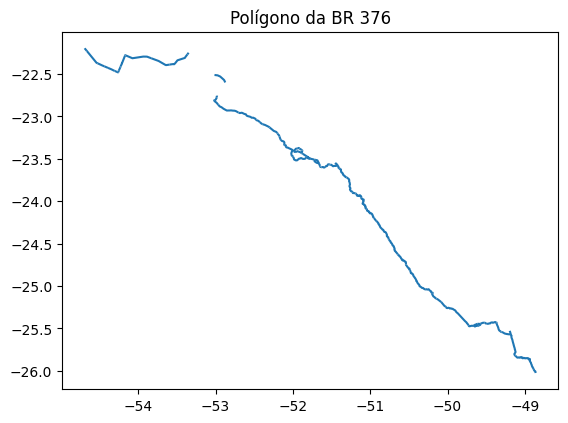



Arquivo de geometria da BR 262 salvo - Arquivo: geometrias-brs/resumo_geometria_br_262.csv


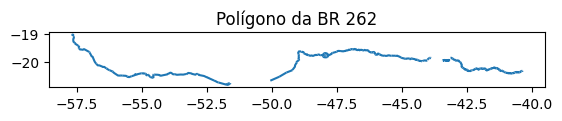



Arquivo de geometria da BR 230 salvo - Arquivo: geometrias-brs/resumo_geometria_br_230.csv


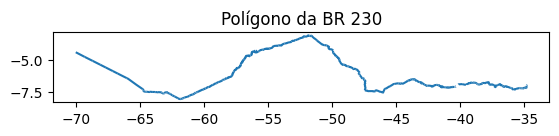



Arquivo de geometria da BR 470 salvo - Arquivo: geometrias-brs/resumo_geometria_br_470.csv


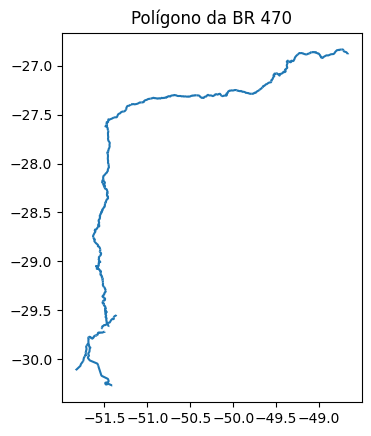



Arquivo de geometria da BR 316 salvo - Arquivo: geometrias-brs/resumo_geometria_br_316.csv


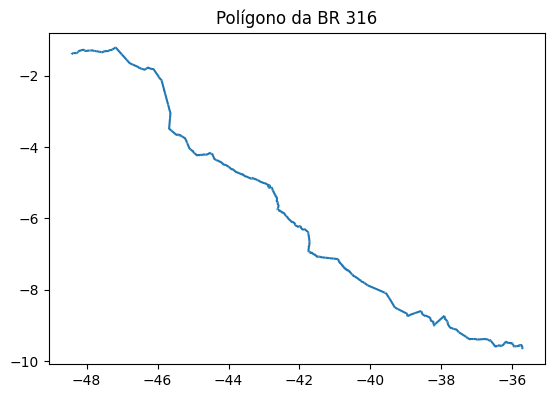



Arquivo de geometria da BR 282 salvo - Arquivo: geometrias-brs/resumo_geometria_br_282.csv


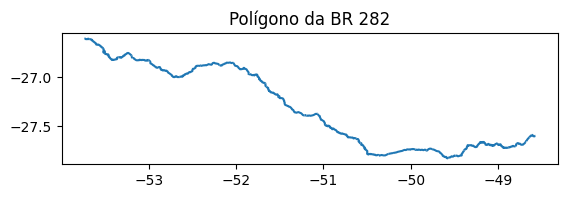



Arquivo de geometria da BR 070 salvo - Arquivo: geometrias-brs/resumo_geometria_br_070.csv


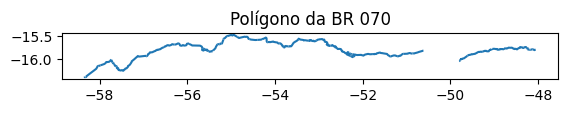



Arquivo de geometria da BR 060 salvo - Arquivo: geometrias-brs/resumo_geometria_br_060.csv


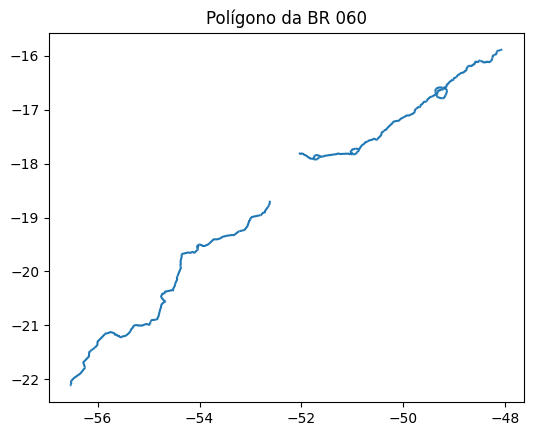



Arquivo de geometria da BR 020 salvo - Arquivo: geometrias-brs/resumo_geometria_br_020.csv


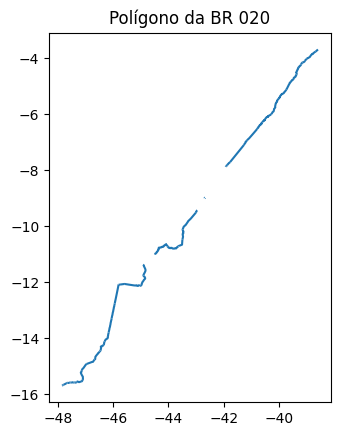



Arquivo de geometria da BR 158 salvo - Arquivo: geometrias-brs/resumo_geometria_br_158.csv


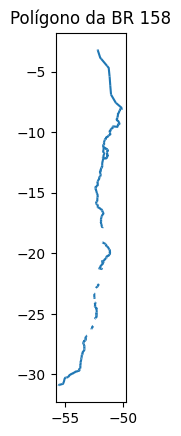



Arquivo de geometria da BR 369 salvo - Arquivo: geometrias-brs/resumo_geometria_br_369.csv


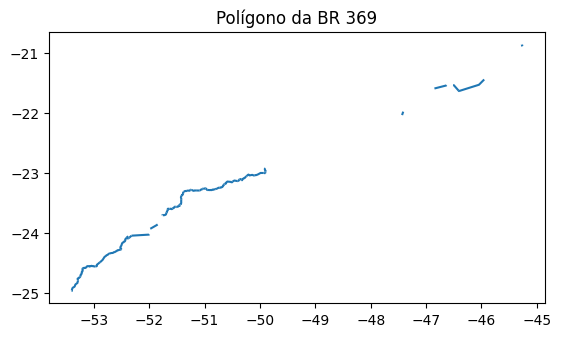



Arquivo de geometria da BR 050 salvo - Arquivo: geometrias-brs/resumo_geometria_br_050.csv


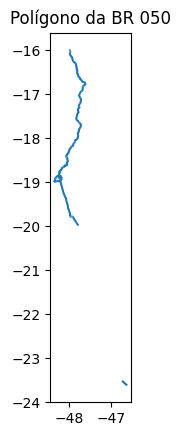

In [37]:
lista_brs = ['101', '116', '381',  '040', '153', '163', '364', '376', '262', '230', '470', '316', '282', '070',  '060',  '020', '158', '369',  '050']

for br in lista_brs:
    df = retorna_resumo_geometria_br(br)
    salva_resumo_geometria_br(br, df)
    plota_poligono_br(br, df)
    

In [46]:
df_pontos_br_101 = pd.read_csv("geometrias-brs/resumo_geometria_br_101.csv", sep=";")

pontos = df_pontos_br_101['geometry']
pontos

0      LINESTRING (-40.405141379999975 -20.3434174699...
1      LINESTRING (-43.114699549999955 -22.8786857199...
2      LINESTRING (-43.113873299999966 -22.8796469099...
3      LINESTRING (-43.114699549999955 -22.8786857199...
4      LINESTRING (-43.114699549999955 -22.8786857199...
                             ...                        
405    LINESTRING (-49.490154159999975 -28.9198223199...
406    LINESTRING (-49.497512849999964 -28.9393322699...
407    LINESTRING (-49.847338399999956 -29.3963259599...
408    LINESTRING (-48.679101429999946 -27.9850407799...
409    LINESTRING (-48.69525547999996 -28.01722666999...
Name: geometry, Length: 410, dtype: object

In [57]:
df_pontos_br_101 = pd.read_csv("geometrias-brs/resumo_geometria_br_101.csv", sep=";")

pontos = df_pontos_br_101['geometry']
registro1 = pontos.loc[0]
registro1

#'LINESTRING ( )'
#alt.Chart(pontos, width=500, height=300).mark_geoshape(
#    fill='lightgray',
#    stroke='gray'
#).project(
#    type=alt.expr(param_projection.name)
#).add_params(param_projection)

'LINESTRING (-40.405141379999975 -20.343417469999963, -40.40513354999996 -20.343416699999977, -40.405129649999935 -20.343416029999958, -40.405125089999956 -20.34341521999994, -40.40509853999998 -20.34340942999995, -40.40507863999994 -20.343402769999955, -40.405051209999954 -20.343392569999935, -40.405017219999934 -20.343380959999934, -40.40497660999995 -20.34336855999993, -40.404929709999976 -20.343356309999933, -40.40487996999997 -20.34334506999994, -40.40482698999995 -20.343333429999973, -40.404768769999976 -20.343319939999958, -40.404705959999944 -20.34330327999993, -40.40463872999993 -20.34328591999997, -40.404567389999954 -20.343268299999977, -40.40449118999993 -20.343249999999955, -40.404409699999974 -20.343231309999965, -40.40432346999995 -20.343212569999935, -40.40423446999995 -20.343194239999946, -40.40414412999996 -20.343176939999978, -40.40405111999996 -20.343161189999933, -40.40395287999996 -20.343148269999972, -40.403853899999945 -20.343133739999928, -40.40375095999997 -20

In [65]:
indice_ini = registro1.find('(')
sub = registro1[indice_ini+1:-1]
sub


'-40.405141379999975 -20.343417469999963, -40.40513354999996 -20.343416699999977, -40.405129649999935 -20.343416029999958, -40.405125089999956 -20.34341521999994, -40.40509853999998 -20.34340942999995, -40.40507863999994 -20.343402769999955, -40.405051209999954 -20.343392569999935, -40.405017219999934 -20.343380959999934, -40.40497660999995 -20.34336855999993, -40.404929709999976 -20.343356309999933, -40.40487996999997 -20.34334506999994, -40.40482698999995 -20.343333429999973, -40.404768769999976 -20.343319939999958, -40.404705959999944 -20.34330327999993, -40.40463872999993 -20.34328591999997, -40.404567389999954 -20.343268299999977, -40.40449118999993 -20.343249999999955, -40.404409699999974 -20.343231309999965, -40.40432346999995 -20.343212569999935, -40.40423446999995 -20.343194239999946, -40.40414412999996 -20.343176939999978, -40.40405111999996 -20.343161189999933, -40.40395287999996 -20.343148269999972, -40.403853899999945 -20.343133739999928, -40.40375095999997 -20.34311778999

In [67]:
lista_tokens = sub.split(',')
lista_tokens

lista
for item in lista_tokens:
    ponto = item.lstrip()
    ponto = ponto.split(' ')
    
    print(f' Ponto: Coord X {ponto[0]} - Ponto Y {ponto[1]}')

 Ponto: Coord X -40.405141379999975 - Ponto Y -20.343417469999963
 Ponto: Coord X -40.40513354999996 - Ponto Y -20.343416699999977
 Ponto: Coord X -40.405129649999935 - Ponto Y -20.343416029999958
 Ponto: Coord X -40.405125089999956 - Ponto Y -20.34341521999994
 Ponto: Coord X -40.40509853999998 - Ponto Y -20.34340942999995
 Ponto: Coord X -40.40507863999994 - Ponto Y -20.343402769999955
 Ponto: Coord X -40.405051209999954 - Ponto Y -20.343392569999935
 Ponto: Coord X -40.405017219999934 - Ponto Y -20.343380959999934
 Ponto: Coord X -40.40497660999995 - Ponto Y -20.34336855999993
 Ponto: Coord X -40.404929709999976 - Ponto Y -20.343356309999933
 Ponto: Coord X -40.40487996999997 - Ponto Y -20.34334506999994
 Ponto: Coord X -40.40482698999995 - Ponto Y -20.343333429999973
 Ponto: Coord X -40.404768769999976 - Ponto Y -20.343319939999958
 Ponto: Coord X -40.404705959999944 - Ponto Y -20.34330327999993
 Ponto: Coord X -40.40463872999993 - Ponto Y -20.34328591999997
 Ponto: Coord X -40.404

In [47]:
import altair as alt
from vega_datasets import data

source = alt.topo_feature(data.world_110m.url, 'countries')
source

UrlData({
  format: TopoDataFormat({
    feature: 'countries',
    type: 'topojson'
  }),
  url: 'https://cdn.jsdelivr.net/npm/vega-datasets@v1.29.0/data/world-110m.json'
})

In [43]:
import altair as alt
from vega_datasets import data

source = alt.topo_feature(data.world_110m.url, 'countries')

input_dropdown = alt.binding_select(options=[
    "albers",
    "albersUsa",
    "azimuthalEqualArea",
    "azimuthalEquidistant",
    "conicEqualArea",
    "conicEquidistant",
    "equalEarth",
    "equirectangular",
    "gnomonic",
    "mercator",
    "naturalEarth1",
    "orthographic",
    "stereographic",
    "transverseMercator"
], name='Projection ')
param_projection = alt.param(value="equalEarth", bind=input_dropdown)

alt.Chart(source, width=500, height=300).mark_geoshape(
    fill='lightgray',
    stroke='gray'
).project(
    type=alt.expr(param_projection.name)
).add_params(param_projection)

alt.Chart(...)

In [2]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Carregar o arquivo SHP
gdf = gpd.read_file('202404A/SNV_202404A.shp')

gdf

,id_trecho_,vl_br,sg_uf,nm_tipo_tr,sg_tipo_tr,desc_coinc,vl_codigo,ds_local_i,ds_local_f,vl_km_inic,...,sup_est_co,ds_jurisdi,ds_superfi,ds_legenda,sg_legenda,leg_multim,versao_snv,id_versao,marcador,geometry
0,151119,010,DF,Eixo Principal,B,-,010BDF0010,ENTR BR-020(A)/030(A)/450/DF-001 (BRASÍLIA),ENTR DF-440,0.0,...,None,Federal,PAV,Duplicada,DUP,Duplicada Concessão/Convênio,202404A,75,|,"LINESTRING (-47.85885 -15.68816, -47.85879 -15..."
1,151120,010,DF,Eixo Principal,B,-,010BDF0015,ENTR DF-440,ACESSO I SOBRADINHO,2.4,...,None,Federal,PAV,Duplicada,DUP,Duplicada Concessão/Convênio,202404A,75,|,"LINESTRING (-47.83735 -15.6818, -47.83719 -15...."
2,151121,010,DF,Eixo Principal,B,-,010BDF0016,ACESSO I SOBRADINHO,ACESSO II SOBRADINHO,6.0,...,None,Federal,PAV,Duplicada,DUP,Duplicada Concessão/Convênio,202404A,75,|,"LINESTRING (-47.8076 -15.66586, -47.80747 -15...."
3,151122,010,DF,Eixo Principal,B,-,010BDF0018,ACESSO II SOBRADINHO,ENTR DF-230,8.3,...,None,Federal,PAV,Duplicada,DUP,Duplicada Concessão/Convênio,202404A,75,|,"LINESTRING (-47.78774 -15.65664, -47.7876 -15...."
4,151123,010,DF,Eixo Principal,B,-,010BDF0020,ENTR DF-230,ENTR DF-128,18.2,...,None,Federal,PAV,Duplicada,DUP,Duplicada Concessão/Convênio,202404A,75,|,"LINESTRING (-47.70599 -15.61521, -47.70587 -15..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7572,157682,497,MS,Eixo Principal,B,Coinc,497BMS0095,ENTR BR-483(A),ENTR BR-158/483(B) (PARANAÍBA),13.0,...,PAV,Estadual,PLA,Planejada,PLA,Pavimentada,202404A,75,|,"LINESTRING (-51.14049 -19.65574, -51.14049 -19..."
7573,157683,498,BA,Eixo Principal,B,-,498BBA0010,MONTE PASCOAL,ENTR BR-101,0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada,202404A,75,|,"LINESTRING (-39.41645 -16.88769, -39.41645 -16..."
7574,158440,499,MG,Acesso,A,-,499AMG1005,R.FREI EDMAR PULMANN (ACESSO OESTE SANTOS DUMONT),ENTR BR-040,0.0,...,PAV,Estadual,PLA,Planejada,PLA,Pavimentada,202404A,75,|,"LINESTRING (-43.57588 -21.4627, -43.57539 -21...."
7575,157684,499,MG,Eixo Principal,B,-,499BMG0010,ENTR BR-040/499 (ACESSO NORTE SANTOS DUMONT),R.FREI EDMAR PULMANN (ACESSO OESTE SANTOS DUMONT),0.0,...,None,Federal,PAV,Pavimentada,PAV,Pavimentada,202404A,75,|,"LINESTRING (-43.5528 -21.43599, -43.55361 -21...."


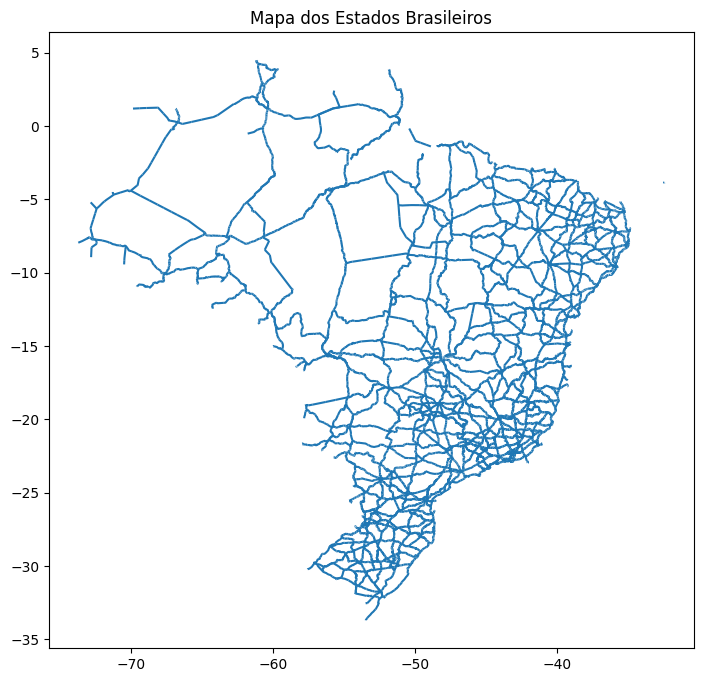

In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Carregar o arquivo SHP
gdf = gpd.read_file('202404A/SNV_202404A.shp')

# Plotar o mapa
gdf.plot(figsize=(10, 8))

# Adicionar um título
plt.title('Mapa dos Estados Brasileiros')

# Mostrar o mapa
plt.show()

In [ ]:
import geopandas as gpd
import folium

# Substitua 'brasil.geojson' pelo caminho correto para o seu arquivo
gdf = gpd.read_file('brazil_geo.json')

# Criando um mapa centrado no Brasil
m = folium.Map(location=[-15.7939, -47.8828], zoom_start=4)

# Adicionando a camada do Brasil ao mapa
folium.GeoJson(
    gdf,
    name='Brasil',
    style={'fillColor': 'blue', 'color': 'black', 'weight': 2, 'fillOpacity': 0.1}
).add_to(m)

# Adicionando uma legenda
folium.LayerControl().add_to(m)

# Salvando o mapa em um arquivo HTML
m.save('mapa_brasil.html')

In [35]:
# ==============================================
def ajusta_formato_geometria_registro(registro):
    #df_pontos_br_101 = pd.read_csv("geometrias-brs/resumo_geometria_br_101.csv", sep=";")
    
    #pontos = df_pontos_br_101['geometry']
    
    #registro1 = pontos.loc[0]
    
    indice_ini = registro.find('(')
    sub = registro[indice_ini+1:-1]
    
    lista_tokens = sub.split(',')
    lista_tokens
    
    lista_pontos = []
    for item in lista_tokens:
        ponto = item.lstrip()
        ponto = ponto.split(' ')
    
        #[-66.80619273559516,-9.814462991904888],[-66.64484784925106,-9.88338609230922]
        linha = f'[{ponto[0]},{ponto[1]}],'
        lista_pontos.append(linha)
    
    string_saida = ''.join(lista_pontos)
    string_saida = string_saida[:-1]

    #"coordinates":[[[[
    string_saida = '"coordinates":[[[['+string_saida+']]]]'
    string_saida

    return string_saida
# ==============================================
def gera_geometria_ajustada(df):

    novo_df = df
    
    for index, row in novo_df.iterrows():
        geometria_ajustada = ajusta_formato_geometria_registro(row['geometry'])
        geometria_ajustada
        novo_df['geometria_ajustada'] = geometria_ajustada
        
    novo_df.to_csv('geometrias-brs/saida-ajustada.csv',sep=';')
    
    return novo_df
# ==============================================

In [36]:
df_pontos_br_101 = pd.read_csv("geometrias-brs/resumo_geometria_br_101.csv", sep=";")

#pontos = df_pontos_br_101['geometry']
gera_geometria_ajustada(df_pontos_br_101)

,Unnamed: 0,id_trecho_,vl_br,sg_uf,nm_tipo_tr,sg_tipo_tr,desc_coinc,vl_codigo,ds_local_i,ds_local_f,...,ds_jurisdi,ds_superfi,ds_legenda,sg_legenda,leg_multim,versao_snv,id_versao,marcador,geometry,geometria_ajustada
0,661,158715,101,ES,Acesso,A,-,101AES2005,ENTR BR-262(A) (COMPLEXO RODOVIÁRIO),ENTR BR-262(B)/ES-471,...,Federal,PAV,Duplicada,DUP,Duplicada,202404A,75,|,LINESTRING (-40.405141379999975 -20.3434174699...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
1,662,158582,101,RJ,Acesso,A,-,101ARJ1005,AVENIDA SÃO BOAVENTURA (NITERÓI),ACESSO PONTE PRESIDENTE COSTA E SILVA,...,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,LINESTRING (-43.114699549999955 -22.8786857199...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
2,663,158585,101,RJ,Acesso,A,-,101ARJ1505,ACESSO PONTE PRESIDENTE COSTA E SILVA,ACESSO AVENIDA SÃO BOAVENTURA (NITERÓI),...,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,LINESTRING (-43.113873299999966 -22.8796469099...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
3,664,158583,101,RJ,Acesso,A,-,101ARJ2005,AVENIDA JANSEN DE MELO (NITERÓI),ACESSO PONTE PRESIDENTE COSTA E SILVA,...,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,LINESTRING (-43.114699549999955 -22.8786857199...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
4,665,158586,101,RJ,Acesso,A,-,101ARJ2505,ACESSO PONTE PRESIDENTE COSTA E SILVA,ACESSO AVENIDA JANSEN DE MELO,...,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,LINESTRING (-43.114699549999955 -22.8786857199...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
405,1098,162074,101,SC,Travessia Urbana,U,-,101USC1005,INÍCIO CONTORNO DE ARARANGUÁ,ENTR BR-285(A)/SC-447 (ARARANGUÁ),...,Federal,PAV,Duplicada,DUP,Duplicada,202404A,75,|,LINESTRING (-49.490154159999975 -28.9198223199...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
406,1099,162075,101,SC,Travessia Urbana,U,-,101USC1010,ENTR BR-285(A)/SC-447 (ARARANGUÁ),FIM CONTORNO DE ARARANGUÁ,...,Federal,PAV,Duplicada,DUP,Duplicada,202404A,75,|,LINESTRING (-49.497512849999964 -28.9393322699...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
407,1100,158541,101,RS,Variante,V,-,101VRS1005,INÍCIO PISTA INVERSA / VARIANTE DA GRUTA,FIM PISTA INVERSA / VARIANTE DA GRUTA,...,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,LINESTRING (-49.847338399999956 -29.3963259599...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."
408,1101,164682,101,SC,Variante,V,-,101VSC1005,INÍCIO VARIANTE MORRO AGUDO,FIM VARIANTE MORRO AGUDO,...,Federal,PAV,Pavimentada,PAV,Pavimentada Concessão/Convênio,202404A,75,|,LINESTRING (-48.679101429999946 -27.9850407799...,"""coordinates"":[[[[[-48.69525547999996,-28.0172..."


In [63]:
alt.data_transformers.enable("vegafusion")

# Carregar o arquivo SHP
df_info = gpd.read_file('202404A/SNV_202404A.dbf')

df_info_filtrado = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(101))]

# Criar o gráfico básico
base = alt.Chart(df_info_filtrado).mark_geoshape(
    filled=True,
    stroke='black'
).properties(
    width=600,
    height=400
).project(
    type='mercator'  # Altere para a projeção desejada
)

# Adicionar camadas e personalizações
chart = base.encode(
    #color='coluna_numerica:Q',  # Substitua por uma coluna numérica do seu DataFrame
    #tooltip=['nome_da_coluna']  # Adicione colunas para exibir no tooltip
).properties(
    title='BR - 101'
)

chart



alt.Chart(...)

In [35]:
alt.data_transformers.enable("vegafusion")

import pandas as pd
import geopandas as gpd
import altair as alt
from altair_saver import save
import altair_viewer
import json

# Carregando os dados do arquivo JSON
with open('br_states.json') as f:
    geojson = json.load(f)
    
# Convertendo para um GeoDataFrame
gdf = gpd.GeoDataFrame.from_features(geojson['features'])

#gdf['geometry'] = gdf['geometry'].simplify(tolerance=0.01)

# Criando o mapa
chart1 = alt.Chart(gdf).mark_geoshape(
    filled=True,
    stroke='black'
).properties(
    width=1024,
    height=768,
    title='Mapa do Brasil'
).project(
    type='mercator'  # Altere para a projeção desejada
)

# Adicionando camadas e personalizações (opcional)
#chart2 = chart1.encode(
#    #tooltip=['name']  # Exibir o nome do estado ao passar o mouse
#).properties(
#    title='Mapa do Brasil + BR '
#)

# Carregar o arquivo SHP
df_info = gpd.read_file('202404A/SNV_202404A.dbf')
df_info_filtrado_101 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(101))]
df_info_filtrado_116 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(116))]
df_info_filtrado_230 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(230))]
df_info_filtrado_316 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(316))]


df_info_filtrado = pd.concat([df_info_filtrado_101, df_info_filtrado_116, df_info_filtrado_230, df_info_filtrado_316], ignore_index=True)

df_info_filtrado_geometry = df_info_filtrado['geometry'].simplify(tolerance=0.01)

# Criar o gráfico básico
chart2 = alt.Chart(df_info_filtrado_geometry).mark_geoshape(
    filled=True,
    stroke='yellow'
).properties(
    width=1024,
    height=768,
    #title=f'Mapa do Brasil - BR 101'
).encode(
    tooltip=['vl_br:N']
).project(
    type='mercator'  # Altere para a projeção desejada
)

juntos = chart1 + chart2

juntos.save('meu_grafico.png')

juntos

alt.LayerChart(...)

In [ ]:
alt.data_transformers.enable("vegafusion")

import pandas as pd
import geopandas as gpd
import altair as alt
from altair_saver import save
import altair_viewer
import json

# Carregando os dados do arquivo JSON
with open('br_states.json') as f:
    geojson = json.load(f)
    
# Convertendo para um GeoDataFrame
gdf = gpd.GeoDataFrame.from_features(geojson['features'])

# Criando o mapa
chart1 = alt.Chart(gdf).mark_geoshape(
    filled=True,
    stroke='black'
).properties(
    width=1024,
    height=768,
    title='Mapa das BRs do Brasil'
).project(
    type='mercator'  # Altere para a projeção desejada
)

# Carregar o arquivo SHP
df_info = gpd.read_file('202404A/SNV_202404A.dbf')
df_info_filtrado_101 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(101))]
df_info_filtrado_116 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(116))]
df_info_filtrado_230 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(230))]
df_info_filtrado_316 = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(316))]

df_info_filtrado_101_geometry = df_info_filtrado_101[['geometry','vl_br']]
serie_101_geometry = df_info_filtrado_101['geometry'].simplify(tolerance=0.01)
df_info_filtrado_101_geometry['geometry'] = serie_101_geometry
df_info_filtrado_101_geometry['br'] = 'BR-101'
df_info_filtrado_101_geometry['cor'] = 'orange'

df_info_filtrado_116_geometry = df_info_filtrado_116[['geometry','vl_br']]
serie_116_geometry = df_info_filtrado_116['geometry'].simplify(tolerance=0.01)
df_info_filtrado_116_geometry['geometry'] = serie_116_geometry
df_info_filtrado_116_geometry['br'] = 'BR-116'
df_info_filtrado_116_geometry['cor'] = 'red'

df_info_filtrado_230_geometry = df_info_filtrado_230[['geometry','vl_br']]
serie_230_geometry = df_info_filtrado_230['geometry'].simplify(tolerance=0.01)
df_info_filtrado_230_geometry['geometry'] = serie_230_geometry
df_info_filtrado_230_geometry['br'] = 'BR-230'
df_info_filtrado_230_geometry['cor'] = 'yellow'

df_info_filtrado_316_geometry = df_info_filtrado_316[['geometry','vl_br']]
serie_316_geometry = df_info_filtrado_316['geometry'].simplify(tolerance=0.01)
df_info_filtrado_316_geometry['geometry'] = serie_316_geometry
df_info_filtrado_316_geometry['br'] = 'BR-316'
df_info_filtrado_316_geometry['cor'] = 'pink'

chart2 = alt.Chart(df_info_filtrado_101_geometry).mark_geoshape(
    filled=True,
    strokeWidth=1.5,
    stroke='orange',
).properties(
    width=1024,
    height=768,
).encode(
    color='br:N',
    tooltip=['br:N']
).project(
    type='mercator'  # Altere para a projeção desejada
)

chart3 = alt.Chart(df_info_filtrado_230_geometry).mark_geoshape(
    filled=True,
    strokeWidth=1.5,
    stroke='red',
).properties(
    width=1024,
    height=768,
).encode(
    tooltip=['br:N']
).project(
    type='mercator'  # Altere para a projeção desejada
)

chart4 = alt.Chart(df_info_filtrado_116_geometry).mark_geoshape(
    filled=True,
    strokeWidth=1.5,
    stroke='green',
).properties(
    width=1024,
    height=768,
).encode(
    tooltip=['br:N']
).project(
    type='mercator'  # Altere para a projeção desejada
)

chart5 = alt.Chart(df_info_filtrado_316_geometry).mark_geoshape(
    filled=True,
    strokeWidth=1.5,
    stroke='white',
).properties(
    width=1024,
    height=768,
).encode(
    tooltip=['br:N']
).project(
    type='mercator'  # Altere para a projeção desejada
)

juntos = chart1 + chart2 + chart3 + chart4 + chart5 

juntos.save('meu_grafico_juntos_teste.png')

juntos

/home/s037958714/.local/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/s037958714/.local/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/s037958714/.local/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

alt.LayerChart(...)

In [10]:
import streamlit as st
import altair as alt
import pandas as pd

# Load GeoJSON data
geojson_url = "https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json"
geojson = alt.Data(url=geojson_url, format=alt.DataFormat(property='features', type='json'))

# Create a basic map
chart = alt.Chart(geojson).mark_geoshape(
    fill='lightgray',
    stroke='black'
).properties(
    width=600,
    height=400
).project(
    type='albersUsa'
)

chart

# Display the chart in Streamlit
#st.altair_chart(chart)

ValueError: Internal error: Expected JSON array, not: {"type":"FeatureCollection","features":[{"type":"Feature","properties":{"GEO_ID":"0500000US01001","STATE":"01","COUNTY":"001","NAME":"Autauga","LSAD":"County","CENSUSAREA":594.436},"geometry":{"type":"Polygon","coordinates":[[[-86.496774,32.344437],[-86.717897,32.402814],[-86.814912,32.340803],[-86.890581,32.502974],[-86.917595,32.664169],[-86.71339,32.661732],[-86.714219,32.705694],[-86.413116,32.707386],[-86.411172,32.409937],[-86.496774,32.344437]]]},"id":"01001"},{"type":"Feature","properties":{"GEO_ID":"0500000US01009","STATE":"01","COUNTY":"009","NAME":"Blount","LSAD":"County","CENSUSAREA":644.776},"geometry":{"type":"Polygon","coordinates":[[[-86.577799,33.765316],[-86.759144,33.840617],[-86.953664,33.815297],[-86.954305,33.844862],[-86.96296,33.844865],[-86.963358,33.858221],[-86.924387,33.909222],[-86.793914,33.952059],[-86.685365,34.05914],[-86.692061,34.092654],[-86.599632,34.119914],[-86.514881,34.25437],[-86.45302,34.259317],[-86.303516,34.099073],[-86.332723,33.986109],[-86.370152,33.93977],[-86.325622,33.940147],[-86.377532,33.861706],[-86.577528,33.801977],[-86.577799,33.765316]]]},"id":"01009"},{"type":"Feature","properties":{"GEO_ID":"0500000US01017","STATE":"01","COUNTY":"017","NAME":"Chambers","LSAD":"County","CENSUSAREA":596.531},"geometry":{"type":"Polygon","coordinates":[[[-85.184131,32.870525],[-85.123421,32.772248],[-85.13204,32.764211],[-85.136776,32.746512],[-85.285043,32.730731],[-85.593151,32.72853],[-85.593177,33.10734],[-85.232378,33.108077],[-85.223261,33.06258],[-85.221868,33.055538],[-85.184131,32.870525]]]},"id":"01017"},{"type":"Feature","properties":{"GEO_ID":"0500000US01021","STATE":"01","COUNTY":"021","NAME":"Chilton","LSAD":"County","CENSUSAREA":692.854},"geometry":{"type":"Polygon","coordinates":[[[-86.517344,33.020566],[-86.515959,32.929361],[-86.457015,32.813899],[-86.374974,32.75358],[-86.413335,32.750591],[-86.413116,32.707386],[-86.714219,32.705694],[-86.71339,32.661732],[-86.917595,32.664169],[-87.01766,32.663269],[-87.017762,32.729532],[-87.019157,32.837034],[-86.876118,32.836264],[-86.881182,33.049901],[-86.881638,33.071861],[-86.610003,33.070003],[-86.517344,33.020566]]]},"id":"01021"},{"type":"Feature","properties":{"GEO_ID":"0500000US01033","STATE":"01","COUNTY":"033","NAME":"Colbert","LSAD":"County","CENSUSAREA":592.619},"geometry":{"type":"Polygon","coordinates":[[[-88.139988,34.581703],[-88.139246,34.587795],[-88.138719,34.589215],[-88.118407,34.724292],[-88.097888,34.892202],[-87.973222,34.88255],[-87.835833,34.741239],[-87.524363,34.832384],[-87.42651,34.800022],[-87.416484,34.767544],[-87.529667,34.567081],[-88.139988,34.581703]]]},"id":"01033"},{"type":"Feature","properties":{"GEO_ID":"0500000US01045","STATE":"01","COUNTY":"045","NAME":"Dale","LSAD":"County","CENSUSAREA":561.15},"geometry":{"type":"Polygon","coordinates":[[[-85.416437,31.619466],[-85.417434,31.314973],[-85.485854,31.246096],[-85.659985,31.270889],[-85.710866,31.195179],[-85.791402,31.196349],[-85.789142,31.617964],[-85.749941,31.617914],[-85.748251,31.618048],[-85.416437,31.619466]]]},"id":"01045"},{"type":"Feature","properties":{"GEO_ID":"0500000US01051","STATE":"01","COUNTY":"051","NAME":"Elmore","LSAD":"County","CENSUSAREA":618.485},"geometry":{"type":"Polygon","coordinates":[[[-86.336776,32.767469],[-86.31948,32.753698],[-86.007187,32.754984],[-85.87986,32.754528],[-85.886148,32.493053],[-85.89442,32.447578],[-86.023012,32.419978],[-86.192284,32.43613],[-86.237068,32.49498],[-86.411172,32.409937],[-86.413116,32.707386],[-86.413335,32.750591],[-86.374974,32.75358],[-86.336768,32.753783],[-86.336776,32.767469]]]},"id":"01051"},{"type":"Feature","properties":{"GEO_ID":"0500000US01065","STATE":"01","COUNTY":"065","NAME":"Hale","LSAD":"County","CENSUSAREA":643.943},"geometry":{"type":"Polygon","coordinates":[[[-87.4212,32.874508],[-87.472174,32.83062],[-87.473915,32.655867],[-87.525198,32.655713],[-87.524485,32.482028],[-87.728744,32.480918],[-87.812559,32.52456],[-87.736786,32.58919],[-87.813401,32.633875],[-87.796043,32.715632],[-87.828542,32.768903],[-87.870464,32.762442],[-87.715709,33.006824],[-87.421936,33.003379],[-87.420132,32.902605],[-87.4212,32.874508]]]},"id":"01065"},{"type":"Feature","properties":{"GEO_ID":"0500000US01079","STATE":"01","COUNTY":"079","NAME":"Lawrence","LSAD":"County","CENSUSAREA":690.678},"geometry":{"type":"Polygon","coordinates":[[[-87.105073,34.686037],[-87.105913,34.587643],[-87.110111,34.313799],[-87.109911,34.299299],[-87.529722,34.304598],[-87.529667,34.567081],[-87.416484,34.767544],[-87.42651,34.800022],[-87.260676,34.758626],[-87.105073,34.686037]]]},"id":"01079"},{"type":"Feature","properties":{"GEO_ID":"0500000US01083","STATE":"01","COUNTY":"083","NAME":"Limestone","LSAD":"County","CENSUSAREA":559.936},"geometry":{"type":"Polygon","coordinates":[[[-86.836306,34.991764],[-86.820657,34.991764],[-86.783648,34.991925],[-86.783628,34.991925],[-86.790056,34.55079],[-86.942899,34.598053],[-87.105073,34.686037],[-87.260676,34.758626],[-87.214914,34.816011],[-87.210759,34.999024],[-87.011174,34.995162],[-87.000007,34.995121],[-86.974412,34.994513],[-86.972613,34.99461],[-86.970236,34.994546],[-86.96712,34.9944],[-86.862147,34.991956],[-86.849794,34.991924],[-86.846466,34.99186],[-86.83637,34.991764],[-86.836306,34.991764]]]},"id":"01083"},{"type":"Feature","properties":{"GEO_ID":"0500000US01099","STATE":"01","COUNTY":"099","NAME":"Monroe","LSAD":"County","CENSUSAREA":1025.675},"geometry":{"type":"Polygon","coordinates":[[[-86.905899,31.753035],[-87.052284,31.716761],[-87.135051,31.642417],[-87.166581,31.519561],[-87.427455,31.260386],[-87.61589,31.244458],[-87.765152,31.297346],[-87.784796,31.324672],[-87.665572,31.423166],[-87.603137,31.409556],[-87.565413,31.553573],[-87.566841,31.697115],[-87.516131,31.697824],[-87.50093,31.829251],[-86.906899,31.830628],[-86.905899,31.753035]]]},"id":"01099"},{"type":"Feature","properties":{"GEO_ID":"0500000US01107","STATE":"01","COUNTY":"107","NAME":"Pickens","LSAD":"County","CENSUSAREA":881.408},"geometry":{"type":"Polygon","coordinates":[[[-88.291127,33.399061],[-88.277421,33.512436],[-88.276805,33.516463],[-88.274619,33.534008],[-87.946519,33.524065],[-87.85856,33.525326],[-87.840683,33.524839],[-87.837521,33.153637],[-88.026971,33.063602],[-88.171852,32.99586],[-88.340432,32.991199],[-88.304514,33.28832],[-88.291127,33.399061]]]},"id":"01107"},{"type":"Feature","properties":{"GEO_ID":"0500000US01121","STATE":"01","COUNTY":"121","NAME":"Talladega","LSAD":"County","CENSUSAREA":736.775},"geometry":{"type":"Polygon","coordinates":[[[-86.17437,33.104394],[-86.226271,33.104115],[-86.491029,33.102944],[-86.503127,33.179144],[-86.35734,33.296917],[-86.378665,33.390983],[-86.281999,33.509895],[-86.235328,33.494532],[-86.145562,33.679098],[-86.050669,33.67459],[-85.994935,33.586475],[-85.794559,33.585565],[-85.796054,33.55622],[-85.796852,33.541849],[-85.85189,33.498742],[-85.904909,33.498655],[-85.923762,33.396206],[-85.976525,33.38187],[-85.980293,33.29419],[-86.118198,33.29632],[-86.120567,33.194511],[-86.17283,33.195681],[-86.17437,33.104394]]]},"id":"01121"},{"type":"Feature","properties":{"GEO_ID":"0500000US02050","STATE":"02","COUNTY":"050","NAME":"Bethel","LSAD":"CA","CENSUSAREA":40570.004},"geometry":{"type":"MultiPolygon","coordinates":[[[[-173.116905,60.516005],[-173.098092,60.533367],[-173.098094,60.573993],[-173.041847,60.611497],[-172.999659,60.611498],[-172.97153,60.605249],[-172.915274,60.527122],[-172.915273,60.514621],[-172.895349,60.49975],[-172.715261,60.429864],[-172.706472,60.425179],[-172.480536,60.400184],[-172.352622,60.381435],[-172.341399,60.373145],[-172.333051,60.364359],[-172.269754,60.333887],[-172.254821,60.334082],[-172.254821,60.326466],[-172.291289,60.321193],[-172.435476,60.332653],[-172.491531,60.334874],[-172.505544,60.330428],[-172.519558,60.323758],[-172.547585,60.317088],[-172.589625,60.314863],[-172.612982,60.319309],[-172.622325,60.330424],[-172.757794,60.374881],[-172.811529,60.406621],[-172.951477,60.478649],[-172.959056,60.479695],[-172.966515,60.478167],[-172.990296,60.478702],[-173.119005,60.500067],[-173.120769,60.51301],[-173.116905,60.516005]]],[[[-165.721389,60.16962],[-165.723168,60.156603],[-165.71912,60.153521],[-165.702411,60.151285],[-165.697273,60.153592],[-165.683507,60.154221],[-165.675374,60.14936],[-165.667863,60.114676],[-165.671567,60.096877],[-165.680612,60.089962],[-165.684585,60.055237],[-165.649318,59.991837],[-165.588873,59.966005],[-165.539367,59.965175],[-165.534482,59.951276],[-165.543456,59.930376],[-165.550405,59.920007],[-165.575815,59.904672],[-165.695981,59.893513],[-165.712875,59.895364],[-165.717549,59.899137],[-165.722458,59.899813],[-165.751851,59.899947],[-165.905471,59.871937],[-166.010201,59.847061],[-166.060952,59.820508],[-166.072465,59.805462],[-166.058096,59.78711],[-166.042089,59.776212],[-166.032277,59.773729],[-166.030813,59.7706],[-166.036947,59.757859],[-166.062854,59.748586],[-166.157071,59.748886],[-166.18092,59.763728],[-166.176669,59.766495],[-166.17482,59.770681],[-166.184234,59.779432],[-166.203293,59.791676],[-166.251528,59.809807],[-166.381986,59.849087],[-166.40729,59.854604],[-166.439746,59.857816],[-166.512223,59.849939],[-166.583297,59.848705],[-166.616849,59.850711],[-166.621473,59.856438],[-166.648076,59.8711],[-166.6782,59.881248],[-166.716563,59.889011],[-166.764183,59.892061],[-166.801634,59.916321],[-166.86653,59.949544],[-166.89233,59.960507],[-166.995748,59.993495],[-167.067602,59.992295],[-167.111785,59.989349],[-167.124867,59.9917],[-167.133258,59.994695],[-167.22021,60.040133],[-167.247627,60.058862],[-167.281357,60.063892],[-167.310664,60.064874],[-167.339109,60.070159],[-167.342702,60.072395],[-167.342885,60.074979],[-167.33405,60.088609],[-167.33386,60.094065],[-167.343303,60.123181],[-167.347866,60.13114],[-167.362783,60.147556],[-167.423053,60.195072],[-167.421489,60.205431],[-167.369927,60.225496],[-167.312616,60.238454],[-167.20194,60.237822],[-167.105975,60.232895],[-167.081935,60.225765],[-167.04582,60.219088],[-166.93797,60.20587],[-166.909802,60.206513],[-166.847438,60.213592],[-166.812484,60.22778],[-166.803469,60.242802],[-166.809546,60.259658],[-166.826169,60.268644],[-166.834966,60.271406],[-166.832877,60.275449],[-166.814979,60.286283],[-166.762522,60.309837],[-166.738323,60.314301],[-166.662112,60.322993],[-166.608896,60.32125],[-166.578305,60.32185],[-166.569828,60.325955],[-166.562081,60.359022],[-166.493543,60.392389],[-166.41457,60.37187],[-166.408546,60.365899],[-166.387184,60.359671],[-166.366596,60.358227],[-166.310655,60.377611],[-166.200019,60.393404],[-166.174906,60.401003],[-166.171187,60.428854],[-166.163203,60.432641],[-166.135704,60.42451],[-166.124379,60.414253],[-166.124231,60.409953],[-166.134927,60.400129],[-166.123805,60.378116],[-166.084791,60.325288],[-166.012169,60.317691],[-165.987336,60.317833],[-165.927956,60.321592],[-165.92464,60.325249],[-165.923572,60.330503],[-165.920794,60.335398],[-165.916828,60.338002],[-165.883458,60.343902],[-165.786573,60.326821],[-165.71451,60.310496],[-165.697326,60.297238],[-165.685751,60.277564],[-165.686143,60.267811],[-165.698339,60.210676],[-165.708863,60.189125],[-165.721389,60.16962]]],[[[-160.534142,61.947257],[-159.265098,61.945564],[-159.26095,62.032026],[-158.531113,62.031708],[-158.532398,62.118595],[-157.51702,62.123543],[-157.074237,62.129913],[-157.073592,62.029567],[-155.107471,62.029371],[-153.735846,62.02937],[-153.740629,62.121565],[-153.395401,62.124776],[-153.39432,62.209115],[-153.070317,62.208517],[-153.067697,62.295211],[-153.001262,62.295331],[-153.001288,62.106276],[-153.002181,61.425686],[-153.469729,61.428123],[-153.475316,61.136887],[-153.430404,61.13574],[-153.436195,60.908538],[-154.422064,60.906969],[-155.9611,60.907602],[-157.168288,60.912221],[-157.169511,61.00017],[-157.522531,61.000515],[-157.521885,60.911337],[-157.700869,60.911315],[-157.697905,60.823585],[-157.880745,60.824769],[-157.883552,60.903711],[-158.944656,60.903462],[-158.948931,60.823175],[-159.014091,60.823452],[-159.01592,60.731938],[-159.182993,60.731079],[-159.185163,60.644578],[-159.367249,60.644339],[-159.369629,60.47113],[-159.432729,60.471029],[-159.437007,60.387176],[-159.613611,60.3878],[-159.613392,60.214585],[-159.78454,60.213265],[-159.78689,60.128139],[-159.850294,60.128439],[-159.855289,59.963691],[-160.015226,59.958912],[-160.019425,59.786831],[-160.248182,59.784524],[-160.250662,59.611298],[-160.42445,59.611507],[-160.424977,59.43591],[-160.481711,59.436228],[-160.480547,59.352217],[-160.650795,59.349182],[-160.650275,59.26223],[-160.820877,59.261519],[-160.819137,59.084859],[-160.875869,59.084046],[-160.874299,59.003658],[-161.034851,59.003419],[-161.03452,58.843894],[-161.094249,58.821979],[-161.18338,58.789276],[-161.337982,58.742912],[-161.345396,58.73545],[-161.372711,58.707958],[-161.372314,58.666172],[-161.521347,58.633141],[-161.550537,58.61116],[-161.62645,58.602581],[-161.682907,58.564671],[-161.751999,58.551842],[-161.766296,58.599224],[-161.871216,58.637478],[-162.066269,58.6208],[-162.171722,58.648441],[-161.994644,58.688828],[-161.939163,58.655613],[-161.877213,58.666138],[-161.859055,58.708637],[-161.769501,58.774937],[-161.756622,58.826477],[-161.783981,58.969421],[-161.828171,59.062702],[-161.981964,59.150997],[-162.048584,59.254177],[-162.018982,59.292278],[-161.942993,59.263828],[-161.956528,59.361771],[-161.904053,59.387341],[-161.837936,59.423836],[-161.828125,59.428188],[-161.790375,59.468197],[-161.738312,59.46701],[-161.70253,59.490906],[-161.75798,59.557152],[-161.854752,59.646214],[-161.911163,59.741741],[-162.017059,59.829426],[-162.092361,59.881104],[-162.100708,59.944675],[-162.10856,59.953861],[-162.121072,59.965241],[-162.143049,59.967506],[-162.171759,59.984163],[-162.190616,60.00203],[-162.207225,60.021834],[-162.228371,60.056313],[-162.234642,60.077333],[-162.234043,60.091345],[-162.231426,60.095297],[-162.220054,60.101078],[-162.202141,60.11645],[-162.186148,60.149605],[-162.188441,60.156509],[-162.216366,60.17419],[-162.239267,60.1801],[-162.252564,60.178623],[-162.258105,60.172713],[-162.257318,60.163353],[-162.258328,60.157939],[-162.287089,60.122173],[-162.29385,60.11658],[-162.30109,60.112146],[-162.316922,60.10759],[-162.321481,60.10797],[-162.360185,60.14736],[-162.371131,60.169019],[-162.37187,60.173451],[-162.371032,60.178616],[-162.40227,60.186425],[-162.426344,60.185331],[-162.445727,60.176448],[-162.447904,60.17048],[-162.463026,60.15302],[-162.476214,60.145536],[-162.484234,60.137964],[-162.492346,60.121804],[-162.494327,60.110675],[-162.481175,60.087544],[-162.476759,60.04769],[-162.503647,59.99923],[-162.530118,59.99011],[-162.585518,59.97723],[-162.622569,59.971809],[-162.644231,59.972954],[-162.682717,59.979432],[-162.738592,59.976321],[-162.740059,59.968797],[-162.748554,59.962664],[-162.760007,59.958013],[-162.828585,59.939142],[-162.90726,59.923682],[-162.974977,59.906443],[-163.033128,59.884135],[-163.109595,59.861633],[-163.172633,59.845058],[-163.349027,59.81989],[-163.38767,59.81588],[-163.559148,59.801391],[-163.662607,59.79571],[-163.704795,59.794805],[-163.772229,59.795624],[-163.930798,59.803853],[-164.079837,59.828034],[-164.115117,59.836688],[-164.133393,59.845612],[-164.160319,59.864679],[-164.201811,59.916119],[-164.208475,59.934461],[-164.209843,59.942874],[-164.208306,59.949046],[-164.198545,59.955109],[-164.178705,59.96181],[-164.161024,59.964076],[-164.12543,59.964626],[-164.11508,59.973166],[-164.13181,59.991177],[-164.1916,60.024496],[-164.302968,60.054233],[-164.336111,60.055527],[-164.385471,60.07719],[-164.461194,60.137824],[-164.498556,60.170546],[-164.493861,60.177397],[-164.494317,60.184833],[-164.505677,60.194304],[-164.517647,60.199493],[-164.541699,60.205279],[-164.558343,60.207042],[-164.59607,60.222874],[-164.619501,60.234938],[-164.634362,60.24298],[-164.646332,60.253303],[-164.651996,60.262745],[-164.653098,60.267902],[-164.698889,60.296298],[-164.72657,60.291475],[-164.777233,60.293833],[-164.850355,60.303615],[-164.899296,60.316787],[-164.962678,60.33966],[-165.005576,60.359812],[-165.057585,60.386287],[-165.129403,60.433707],[-165.132893,60.438867],[-165.124792,60.449191],[-165.120728,60.451196],[-165.069693,60.460893],[-165.04907,60.461516],[-165.015155,60.471414],[-164.99787,60.480459],[-164.961439,60.508391],[-164.956788,60.527837],[-164.960843,60.533845],[-164.965488,60.536701],[-164.97128,60.539558],[-164.986952,60.542406],[-165.05744,60.544631],[-165.190449,60.498001],[-165.244442,60.496298],[-165.362975,60.506866],[-165.377559,60.513164],[-165.405071,60.53465],[-165.420349,60.550692],[-165.419788,60.552418],[-165.415193,60.55816],[-165.381052,60.577987],[-165.367676,60.581158],[-165.346721,60.580603],[-165.312937,60.576313],[-165.289651,60.575755],[-165.268717,60.579488],[-165.178617,60.623927],[-165.170458,60.629091],[-165.147184,60.65116],[-165.063148,60.688645],[-165.052642,60.690068],[-165.0433,60.687468],[-165.027535,60.686008],[-164.991665,60.69884],[-164.97125,60.711434],[-164.966591,60.717438],[-164.96541,60.724306],[-164.971839,60.72973],[-165.010452,60.744789],[-165.023904,60.753128],[-165.032074,60.760022],[-165.040843,60.77266],[-165.042584,60.78443],[-165.037889,60.78901],[-165.032615,60.786704],[-165.020309,60.785539],[-164.977663,60.79036],[-164.944914,60.800379],[-164.92418,60.809331],[-164.939313,60.823463],[-165.009703,60.81506],[-165.02143,60.815086],[-165.02962,60.826001],[-165.030183,60.83805],[-165.003679,60.87558],[-164.945958,60.92106],[-164.939496,60.924774],[-164.925994,60.925063],[-164.917542,60.928144],[-164.903903,60.942213],[-164.921256,60.946509],[-164.940065,60.945369],[-165.007096,60.922058],[-165.03204,60.903986],[-165.016941,60.891071],[-165.080907,60.860224],[-165.132488,60.850145],[-165.176774,60.847149],[-165.177531,60.858865],[-165.22348,60.89645],[-165.216942,60.914322],[-165.157111,60.917363],[-164.797619,60.982487],[-164.616585,60.979049],[-164.529911,60.940796],[-164.234986,60.988241],[-164.154702,61.022625],[-164.211781,61.082262],[-164.201874,61.151613],[-164.121482,61.127],[-163.94742,61.205621],[-163.99276,61.371763],[-163.541623,61.349559],[-163.531412,61.401454],[-163.431258,61.484107],[-163.171354,61.449071],[-163.061999,61.479931],[-162.847199,61.498736],[-162.75398,61.542666],[-162.505761,61.556426],[-162.476189,61.503959],[-162.328294,61.518376],[-162.013438,61.477057],[-161.885286,61.48281],[-161.697058,61.530087],[-161.449611,61.568838],[-161.126812,61.59954],[-160.953961,61.685669],[-160.775244,61.738527],[-160.597733,61.760156],[-160.35014,61.819071],[-160.18666,61.831693],[-160.469477,61.869348],[-160.534142,61.947257]]]]},"id":"02050"},{"type":"Feature","properties":{"GEO_ID":"0500000US02105","STATE":"02","COUNTY":"105","NAME":"Hoonah-Angoon","LSAD":"CA","CENSUSAREA":7524.915},"geometry":{"type":"MultiPolygon","coordinates":[[[[-134.713987,58.220748],[-134.77272,58.164862],[-134.76194,58.07809],[-134.672702,58.027243],[-134.553923,58.053616],[-134.531804,58.096726],[-134.177467,58.15964],[-134.166332,58.132558],[-134.167257,58.128577],[-134.174352,58.125284],[-134.192724,58.107685],[-134.18937,58.083444],[-134.183983,58.077295],[-134.169743,58.066845],[-134.138231,58.047103],[-134.098652,58.018748],[-134.091885,58.010777],[-134.087461,58.001685],[-134.087572,57.996475],[-134.101549,57.988716],[-134.101125,57.98407],[-134.089575,57.974357],[-134.068949,57.961083],[-134.016873,57.930006],[-133.999948,57.91481],[-133.99634,57.904167],[-133.995977,57.895632],[-133.963791,57.854628],[-133.934735,57.837626],[-133.904874,57.807406],[-133.902695,57.797797],[-133.903854,57.794818],[-133.908085,57.79167],[-133.90989,57.780628],[-133.896846,57.685524],[-133.868134,57.660137],[-133.837424,57.638486],[-133.832895,57.635733],[-133.821673,57.633887],[-133.817662,57.629764],[-133.808285,57.609604],[-133.806003,57.583457],[-133.807133,57.57877],[-133.81164,57.572365],[-133.8176,57.568353],[-133.840838,57.576865],[-133.859635,57.605325],[-133.85801,57.61694],[-133.863112,57.623701],[-133.911329,57.663562],[-133.962582,57.689887],[-133.970087,57.695342],[-133.994964,57.719821],[-134.010728,57.759392],[-134.013144,57.789393],[-134.03082,57.818646],[-134.061833,57.829808],[-134.098628,57.85055],[-134.121337,57.871236],[-134.11921,57.872917],[-134.121904,57.88252],[-134.126105,57.89026],[-134.132146,57.896189],[-134.151127,57.903209],[-134.176606,57.909725],[-134.202353,57.90633],[-134.206874,57.895901],[-134.16312,57.848669],[-134.112948,57.809263],[-134.105408,57.795974],[-134.099782,57.780261],[-134.100899,57.776779],[-134.146342,57.760258],[-134.1277,57.739216],[-134.116097,57.727582],[-134.020169,57.656734],[-134.013367,57.655898],[-133.993974,57.649095],[-133.958454,57.629537],[-133.935976,57.614414],[-133.934361,57.601765],[-133.945156,57.569841],[-133.943417,57.561555],[-133.933216,57.54445],[-133.920557,57.530088],[-133.901074,57.517219],[-133.886269,57.504999],[-133.857368,57.463964],[-133.927539,57.46957],[-133.925527,57.45665],[-133.870327,57.381298],[-133.866931,57.367869],[-133.867279,57.36206],[-133.870657,57.358287],[-133.962897,57.305425],[-133.968495,57.303937],[-133.983501,57.302838],[-134.008394,57.317522],[-134.034563,57.327638],[-134.055618,57.330194],[-134.094891,57.326401],[-134.100587,57.321738],[-134.084374,57.303963],[-134.080495,57.297678],[-134.110315,57.249948],[-134.15539,57.208003],[-134.193629,57.184879],[-134.29276,57.137049],[-134.302721,57.136562],[-134.349602,57.124638],[-134.378359,57.115016],[-134.370797,57.099924],[-134.386052,57.087392],[-134.481167,57.046006],[-134.484288,57.036481],[-134.497718,57.031194],[-134.565687,57.023737],[-134.601407,57.033812],[-134.634565,57.109863],[-134.646773,57.226327],[-134.640169,57.239852],[-134.605032,57.273],[-134.570954,57.294624],[-134.517279,57.314567],[-134.543385,57.337414],[-134.559794,57.336138],[-134.574114,57.341172],[-134.575492,57.343694],[-134.578511,57.400291],[-134.55554,57.407428],[-134.527594,57.405331],[-134.525997,57.397845],[-134.527759,57.39394],[-134.527873,57.389874],[-134.486023,57.372492],[-134.47724,57.374401],[-134.464032,57.392184],[-134.544853,57.457872],[-134.607557,57.513042],[-134.598452,57.522395],[-134.595981,57.534107],[-134.611177,57.563137],[-134.665337,57.605701],[-134.674438,57.614409],[-134.695428,57.685335],[-134.700518,57.695966],[-134.704859,57.701457],[-134.720351,57.707052],[-134.731798,57.721921],[-134.728792,57.75664],[-134.709024,57.780498],[-134.705869,57.828929],[-134.727077,57.877098],[-134.737475,57.89079],[-134.746108,57.898529],[-134.758833,57.980212],[-134.76529,57.993762],[-134.777022,58.004679],[-134.796804,58.058855],[-134.783772,58.082292],[-134.784927,58.096793],[-134.820663,58.141465],[-134.857221,58.176288],[-134.864299,58.180489],[-134.877918,58.181535],[-134.885857,58.184031],[-134.899665,58.19432],[-134.914857,58.214932],[-134.948327,58.281316],[-134.969189,58.367542],[-134.960502,58.403758],[-134.955902,58.410297],[-134.897292,58.37689],[-134.806116,58.321284],[-134.803831,58.316567],[-134.802388,58.30107],[-134.779354,58.281279],[-134.760052,58.275251],[-134.729861,58.273512],[-134.724463,58.268277],[-134.713987,58.220748]]],[[[-132.367984,57.348685],[-132.487307,57.354227],[-132.64459,57.426343],[-132.986359,57.330823],[-133.029298,57.235539],[-133.126997,57.186322],[-133.299692,57.237727],[-133.517194,57.177775],[-133.517197,57.177776],[-133.544817,57.24257],[-133.542565,57.250682],[-133.522837,57.27858],[-133.489738,57.305192],[-133.47589,57.307982],[-133.455936,57.30397],[-133.444958,57.297729],[-133.442436,57.289978],[-133.425948,57.285995],[-133.371591,57.286713],[-133.307565,57.290052],[-133.287052,57.30292],[-133.274829,57.330625],[-133.28351,57.333119],[-133.34207,57.336798],[-133.35472,57.333253],[-133.403868,57.342685],[-133.442682,57.352845],[-133.453783,57.35624],[-133.468267,57.364217],[-133.472039,57.368651],[-133.475998,57.380394],[-133.472454,57.388446],[-133.461179,57.394577],[-133.503115,57.453528],[-133.52514,57.490344],[-133.52583,57.501777],[-133.516749,57.543911],[-133.510806,57.548139],[-133.496365,57.548772],[-133.488197,57.551387],[-133.478086,57.56173],[-133.481221,57.57147],[-133.505982,57.578459],[-133.528313,57.573944],[-133.531905,57.569466],[-133.53786,57.567292],[-133.565478,57.563095],[-133.578948,57.565094],[-133.62076,57.578919],[-133.66439,57.611707],[-133.676449,57.625192],[-133.680963,57.648265],[-133.65855,57.707924],[-133.65453,57.713689],[-133.582212,57.715095],[-133.543928,57.696454],[-133.530957,57.686914],[-133.522243,57.683663],[-133.489677,57.677141],[-133.441215,57.672013],[-133.40498,57.663783],[-133.234598,57.608749],[-133.188864,57.589071],[-133.179062,57.587147],[-133.162464,57.599796],[-133.174032,57.610062],[-133.251126,57.649966],[-133.278209,57.661859],[-133.291062,57.665358],[-133.322532,57.66583],[-133.485403,57.738677],[-133.545031,57.76797],[-133.559889,57.777457],[-133.556097,57.78883],[-133.569787,57.859365],[-133.602032,57.860394],[-133.56921,57.88535],[-133.176444,58.150151],[-133.076421,57.999762],[-132.869318,57.842941],[-132.756813,57.705093],[-132.658124,57.619486],[-132.559178,57.503927],[-132.367984,57.348685]]],[[[-135.587961,57.89732],[-135.899839,58.001387],[-135.906742,58.001266],[-136.026713,57.835869],[-136.370705,57.831668],[-136.372377,57.832587],[-136.391157,57.832653],[-136.458829,57.853901],[-136.474424,57.871648],[-136.484259,57.89646],[-136.534201,57.913938],[-136.557651,57.912135],[-136.572045,57.918469],[-136.573288,57.926844],[-136.563223,58.035052],[-136.559999,58.063358],[-136.556247,58.077019],[-136.538708,58.093482],[-136.500119,58.104787],[-136.475811,58.101294],[-136.469272,58.096868],[-136.420449,58.131857],[-136.375338,58.208714],[-136.387114,58.252414],[-136.377329,58.268328],[-136.311596,58.270388],[-136.287765,58.267373],[-136.286263,58.259741],[-136.289842,58.249086],[-136.283886,58.223685],[-136.277477,58.208856],[-136.235246,58.154416],[-136.190155,58.161301],[-136.190382,58.164473],[-136.194557,58.171811],[-136.199498,58.172086],[-136.203642,58.174416],[-136.199854,58.180871],[-136.162108,58.218724],[-136.139007,58.224393],[-136.03616,58.21921],[-136.03303,58.205462],[-135.976386,58.202029],[-135.966119,58.211386],[-135.914178,58.244073],[-135.823562,58.282975],[-135.801133,58.287716],[-135.78338,58.286709],[-135.764372,58.266276],[-135.7351,58.240213],[-135.712398,58.231892],[-135.630521,58.222933],[-135.589198,58.213677],[-135.522646,58.185909],[-135.504671,58.174914],[-135.497911,58.168882],[-135.524668,58.12075],[-135.540712,58.10175],[-135.58682,58.08167],[-135.651368,58.036484],[-135.63849,57.994508],[-135.621582,57.984623],[-135.593287,57.989636],[-135.581753,57.997568],[-135.564307,58.015007],[-135.567817,58.02342],[-135.565443,58.04112],[-135.563434,58.043491],[-135.544529,58.06088],[-135.496739,58.086212],[-135.451444,58.134348],[-135.420107,58.144202],[-135.411777,58.145473],[-135.397518,58.144155],[-135.275797,58.097024],[-135.260951,58.097323],[-135.108896,58.08827],[-135.084832,58.080869],[-135.082981,58.074737],[-135.0707,58.061242],[-134.977183,58.049943],[-134.967723,58.047625],[-134.950844,58.036993],[-134.935005,58.021639],[-134.912854,57.979287],[-134.921104,57.935298],[-134.926395,57.921919],[-135.004952,57.884338],[-135.140674,57.926114],[-135.173712,57.919399],[-135.16522,57.901524],[-135.146717,57.891656],[-135.131957,57.885241],[-135.06572,57.869451],[-134.991819,57.835436],[-134.954547,57.815785],[-134.949436,57.805027],[-135.02337,57.780537],[-135.19896,57.775092],[-135.225158,57.777783],[-135.313776,57.805739],[-135.343991,57.821444],[-135.389894,57.850991],[-135.418517,57.860506],[-135.514151,57.885371],[-135.552802,57.902711],[-135.581326,57.903056],[-135.587961,57.89732]]],[[[-135.447381,58.399891],[-135.461296,58.399884],[-135.466083,58.394328],[-135.512402,58.385759],[-135.521358,58.391449],[-135.556066,58.40774],[-135.622105,58.428186],[-135.630425,58.42858],[-135.728054,58.397067],[-135.826079,58.390246],[-135.90731,58.380839],[-135.917917,58.381237],[-135.921134,58.385772],[-135.920299,58.389084],[-135.897255,58.416132],[-135.897169,58.450001],[-135.916112,58.463858],[-135.923268,58.462919],[-135.934547,58.451953],[-135.939926,58.4516],[-135.987564,58.46442],[-135.997418,58.470375],[-135.99953,58.480281],[-135.990948,58.487315],[-135.968087,58.494669],[-135.955625,58.492765],[-135.945121,58.494836],[-135.906941,58.50581],[-135.893152,58.513929],[-135.895088,58.534077],[-135.914003,58.540583],[-135.928572,58.572925],[-135.912187,58.6188],[-136.012226,58.712247],[-136.015761,58.7226],[-136.008929,58.73191],[-136.011669,58.743276],[-136.046172,58.781796],[-136.082937,58.808383],[-136.089603,58.815729],[-136.077276,58.824983],[-136.045279,58.836074],[-136.050351,58.913433],[-136.060728,58.92758],[-136.120307,58.968418],[-136.145306,58.976705],[-136.162725,58.977261],[-136.163648,58.973204],[-136.160293,58.961999],[-136.1503,58.947111],[-136.124491,58.924542],[-136.106997,58.864441],[-136.150772,58.757266],[-136.161943,58.752171],[-136.21366,58.751153],[-136.247343,58.752935],[-136.397322,58.813019],[-136.431055,58.818416],[-136.474735,58.830788],[-136.493716,58.838963],[-136.528161,58.928484],[-136.52652,58.954523],[-136.544899,58.967314],[-136.559836,58.963414],[-136.572163,58.957292],[-136.575516,58.9466],[-136.575541,58.928941],[-136.586289,58.909364],[-136.630497,58.890256],[-136.670412,58.893224],[-136.676898,58.894973],[-136.6946,58.904081],[-136.704848,58.914395],[-136.724994,58.923514],[-136.750422,58.930439],[-136.782908,58.936659],[-136.78871,58.936318],[-136.802832,58.923118],[-136.840986,58.919742],[-136.860014,58.931997],[-136.857823,58.942868],[-136.877826,58.962392],[-136.91853,58.947217],[-136.915995,58.938384],[-136.932352,58.916252],[-136.934841,58.916345],[-136.933458,58.908558],[-136.928643,58.900131],[-136.868184,58.885243],[-136.76793,58.870608],[-136.744507,58.876626],[-136.676388,58.856348],[-136.612807,58.846227],[-136.58343,58.838826],[-136.538029,58.819777],[-136.463258,58.781607],[-136.356786,58.692581],[-136.354222,58.684304],[-136.372775,58.66741],[-136.396076,58.654421],[-136.409876,58.64925],[-136.422309,58.647412],[-136.449827,58.637816],[-136.482395,58.616739],[-136.459436,58.60788],[-136.383327,58.629987],[-136.342827,58.64503],[-136.331366,58.663545],[-136.317193,58.671231],[-136.246368,58.663185],[-136.232481,58.677144],[-136.223308,58.675028],[-136.213659,58.665054],[-136.194207,58.581731],[-136.181596,58.535019],[-136.170498,58.527323],[-136.100303,58.500673],[-136.103925,58.478001],[-136.083551,58.447115],[-136.062165,58.435795],[-136.053028,58.417375],[-136.041818,58.380161],[-136.092646,58.34899],[-136.11193,58.34253],[-136.265906,58.314499],[-136.276769,58.313894],[-136.288255,58.316144],[-136.296281,58.318447],[-136.304158,58.32345],[-136.305121,58.328691],[-136.303092,58.336277],[-136.298718,58.342941],[-136.290055,58.351447],[-136.281631,58.35309],[-136.273929,58.363409],[-136.282604,58.367261],[-136.288867,58.369649],[-136.336728,58.37757],[-136.382035,58.362694],[-136.365148,58.346663],[-136.360416,58.344077],[-136.357115,58.328838],[-136.370979,58.301643],[-136.376464,58.298625],[-136.389964,58.29707],[-136.47202,58.306356],[-136.532824,58.334072],[-136.550003,58.340371],[-136.593029,58.349793],[-136.6135,58.347889],[-136.630425,58.340607],[-136.638634,58.328458],[-136.626345,58.32059],[-136.576799,58.277951],[-136.569831,58.2687],[-136.567956,58.245153],[-136.591924,58.217886],[-136.597198,58.215006],[-136.619824,58.209899],[-136.658638,58.207323],[-136.70125,58.219416],[-136.723391,58.244926],[-136.730885,58.256496],[-136.717093,58.273508],[-136.730218,58.286153],[-136.762198,58.286765],[-136.784326,58.290497],[-136.857605,58.31636],[-136.848992,58.328994],[-136.946663,58.393185],[-136.986384,58.404043],[-137.009415,58.408877],[-137.018409,58.409141],[-137.078109,58.397474],[-137.111802,58.392594],[-137.134453,58.406596],[-137.180029,58.429939],[-137.239366,58.453159],[-137.25271,58.456338],[-137.278612,58.459484],[-137.295788,58.466179],[-137.408758,58.515822],[-137.497002,58.557721],[-137.568216,58.587989],[-137.608804,58.601234],[-137.632889,58.599982],[-137.67169,58.615523],[-137.680811,58.621835],[-137.676857,58.64677],[-137.683516,58.660267],[-137.687627,58.664989],[-137.795037,58.724855],[-137.87535,58.757232],[-137.901675,58.765316],[-137.928156,58.780533],[-137.941828,58.794322],[-137.944259,58.802349],[-137.525295,58.906872],[-137.447383,58.909513],[-137.264752,59.002352],[-136.863896,59.138472],[-136.826633,59.158389],[-136.581521,59.164909],[-136.486609,59.261108],[-136.36885,59.232652],[-136.122285,59.207775],[-136.053534,59.177538],[-135.892056,59.172783],[-135.701868,59.104076],[-135.688248,59.016726],[-135.585301,58.986033],[-135.604265,58.909481],[-135.522232,58.8894],[-135.682038,58.85819],[-135.757086,58.742314],[-135.548348,58.698345],[-135.52815,58.655985],[-135.401945,58.616146],[-135.413387,58.584665],[-135.318523,58.500523],[-135.496814,58.498602],[-135.447381,58.399891]]]]},"id":"02105"},{"type":"Feature","properties":{"GEO_ID":"0500000US02122","STATE":"02","COUNTY":"122","NAME":"Kenai Peninsula","LSAD":"Borough","CENSUSAREA":16075.331},"geometry":{"type":"MultiPolygon","coordinates":[[[[-148.745578,60.733881],[-148.655444,60.734542],[-148.666606,60.423056],[-148.562368,60.422593],[-148.58364,59.961477],[-148.673822,59.944828],[-148.676172,59.947216],[-148.675485,59.95207],[-148.664283,59.965128],[-148.661876,59.967436],[-148.66083,59.969735],[-148.662712,59.971825],[-148.668146,59.973497],[-148.674841,59.972699],[-148.688758,59.968006],[-148.715511,59.96212],[-148.725872,59.963727],[-148.727688,59.96505],[-148.729731,59.972376],[-148.737453,59.980879],[-148.743229,59.985389],[-148.749742,59.988497],[-148.755366,59.989237],[-148.759807,59.988941],[-148.763803,59.987905],[-148.766911,59.986869],[-148.769871,59.983464],[-148.797927,59.9774],[-148.801223,59.975844],[-148.810654,59.963105],[-148.838304,59.9499],[-148.872181,59.950321],[-148.884265,59.955388],[-148.888537,59.966362],[-148.901981,59.973319],[-148.913089,59.983207],[-148.914569,59.986891],[-148.912676,59.992894],[-148.917819,59.995595],[-148.938327,59.999074],[-148.957554,59.998371],[-148.977589,59.989881],[-148.990301,59.981013],[-149.01679,59.976134],[-149.028418,59.978821],[-149.029394,59.984098],[-149.027274,59.991698],[-149.031273,59.998492],[-149.043265,59.999115],[-149.067833,59.982177],[-149.09507,59.983019],[-149.100687,59.985727],[-149.101785,59.990943],[-149.102321,59.993149],[-149.101717,59.994155],[-149.098699,59.996167],[-149.095278,59.997374],[-149.090072,59.999445],[-149.089077,60.004504],[-149.072716,60.019653],[-149.041599,60.030726],[-149.037439,60.04053],[-149.040358,60.048744],[-149.04929,60.0587],[-149.0587,60.061419],[-149.096621,60.044631],[-149.133115,60.044918],[-149.204853,60.009212],[-149.223781,59.982763],[-149.23539,59.938792],[-149.287588,59.906506],[-149.327029,59.987029],[-149.325822,60.001033],[-149.341584,60.076762],[-149.360414,60.101665],[-149.393171,60.099845],[-149.416829,60.088926],[-149.416829,59.997934],[-149.427748,59.996114],[-149.435027,59.990655],[-149.462855,59.950151],[-149.475659,59.952698],[-149.507429,59.964519],[-149.549677,59.919681],[-149.584254,59.866905],[-149.542398,59.823229],[-149.511461,59.806851],[-149.527839,59.750436],[-149.598813,59.755895],[-149.640669,59.799571],[-149.666147,59.850527],[-149.706184,59.910582],[-149.7535,59.861446],[-149.738941,59.732237],[-149.75168,59.717678],[-149.75911,59.697825],[-149.778024,59.68593],[-149.798304,59.677545],[-149.842672,59.7013],[-149.839032,59.752255],[-149.889988,59.785013],[-149.97734,59.801391],[-150.028296,59.788652],[-150.042854,59.772274],[-150.015557,59.754075],[-149.97916,59.744976],[-149.948223,59.717678],[-149.962781,59.69766],[-150.002818,59.683101],[-150.022836,59.655804],[-150.031935,59.613947],[-150.068332,59.637605],[-150.09563,59.648524],[-150.108369,59.603028],[-150.168424,59.561172],[-150.223019,59.539334],[-150.253956,59.521136],[-150.310371,59.508397],[-150.343128,59.512036],[-150.334029,59.541154],[-150.315831,59.562992],[-150.317651,59.599389],[-150.347696,59.600928],[-150.355493,59.598412],[-150.412448,59.554628],[-150.431518,59.514287],[-150.478742,59.458498],[-150.4989,59.456298],[-150.516317,59.462326],[-150.521537,59.467924],[-150.521626,59.474672],[-150.518382,59.477136],[-150.515867,59.482167],[-150.516286,59.486778],[-150.522994,59.494744],[-150.536119,59.498457],[-150.543537,59.510256],[-150.550245,59.527026],[-150.549825,59.538764],[-150.533056,59.56308],[-150.537248,59.581108],[-150.54186,59.586977],[-150.547729,59.590331],[-150.556114,59.590331],[-150.575818,59.579431],[-150.589315,59.565154],[-150.594543,59.553167],[-150.60223,59.545891],[-150.614808,59.545472],[-150.631158,59.549245],[-150.639543,59.547149],[-150.638704,59.532056],[-150.631577,59.521575],[-150.615152,59.510199],[-150.595056,59.499777],[-150.589645,59.500083],[-150.584636,59.49451],[-150.579595,59.47954],[-150.579869,59.475709],[-150.584342,59.467715],[-150.585567,59.450057],[-150.581182,59.445233],[-150.601162,59.425657],[-150.650046,59.420885],[-150.651586,59.421751],[-150.65401,59.445458],[-150.656329,59.454437],[-150.667211,59.4579],[-150.683235,59.458541],[-150.716564,59.450849],[-150.729062,59.442197],[-150.739958,59.425211],[-150.745004,59.400729],[-150.769853,59.372966],[-150.79547,59.362845],[-150.819565,59.357276],[-150.834627,59.35198],[-150.877447,59.31812],[-150.911598,59.311614],[-150.912817,59.305214],[-150.895552,59.286227],[-150.887825,59.273526],[-150.887821,59.26792],[-150.897808,59.255648],[-150.942212,59.233136],[-150.959531,59.232537],[-150.975164,59.236141],[-150.988397,59.230549],[-150.995406,59.224149],[-151.001196,59.224149],[-151.006682,59.233292],[-151.008815,59.245787],[-151.007292,59.251577],[-150.996808,59.257739],[-150.999063,59.271082],[-151.023097,59.269045],[-151.03243,59.275762],[-151.044411,59.293611],[-151.0461,59.299359],[-151.057756,59.301721],[-151.070305,59.287852],[-151.068166,59.284102],[-151.071902,59.281058],[-151.087319,59.26879],[-151.091532,59.269187],[-151.105635,59.263143],[-151.101102,59.240605],[-151.102395,59.228713],[-151.107558,59.217792],[-151.126247,59.209923],[-151.163408,59.202636],[-151.186254,59.202813],[-151.190948,59.206632],[-151.192634,59.211208],[-151.206053,59.219319],[-151.223629,59.224347],[-151.261636,59.220304],[-151.273779,59.229663],[-151.280544,59.230476],[-151.28488,59.227586],[-151.287063,59.224789],[-151.287771,59.219417],[-151.292812,59.214273],[-151.305724,59.209544],[-151.341601,59.222231],[-151.379612,59.242024],[-151.387261,59.25045],[-151.390544,59.264917],[-151.399549,59.276005],[-151.407203,59.279349],[-151.429415,59.268552],[-151.437695,59.253989],[-151.449207,59.248457],[-151.488612,59.237714],[-151.509551,59.234395],[-151.518488,59.230309],[-151.525127,59.224947],[-151.520245,59.21693],[-151.504699,59.21269],[-151.499592,59.207839],[-151.497805,59.204264],[-151.498826,59.200178],[-151.502657,59.195071],[-151.521455,59.195483],[-151.558151,59.200085],[-151.574664,59.195327],[-151.579261,59.187666],[-151.576452,59.172601],[-151.580351,59.165233],[-151.590729,59.161725],[-151.698875,59.163081],[-151.710625,59.158097],[-151.720931,59.156078],[-151.739068,59.156005],[-151.748451,59.158601],[-151.764908,59.17551],[-151.761451,59.205235],[-151.75853,59.215743],[-151.761301,59.221327],[-151.838335,59.209135],[-151.874356,59.211931],[-151.915684,59.227522],[-151.917248,59.231254],[-151.910958,59.236707],[-151.906191,59.237963],[-151.905106,59.247075],[-151.925051,59.254428],[-151.952723,59.250447],[-151.959279,59.247625],[-151.978748,59.253779],[-151.991618,59.313617],[-151.96313,59.344958],[-151.952705,59.349413],[-151.924018,59.354417],[-151.903021,59.360454],[-151.890738,59.373156],[-151.887102,59.382532],[-151.908015,59.395274],[-151.905153,59.401035],[-151.886513,59.421033],[-151.826047,59.439049],[-151.770875,59.447917],[-151.75142,59.446554],[-151.740538,59.438432],[-151.728486,59.439679],[-151.720421,59.443117],[-151.706462,59.462811],[-151.694726,59.46837],[-151.634472,59.482443],[-151.570032,59.468945],[-151.542349,59.467061],[-151.528493,59.472338],[-151.50589,59.477048],[-151.485624,59.475459],[-151.470992,59.47225],[-151.466272,59.48405],[-151.46963,59.502811],[-151.436359,59.530329],[-151.420966,59.537728],[-151.365776,59.541255],[-151.32367,59.550943],[-151.272459,59.555823],[-151.266733,59.562632],[-151.264811,59.568598],[-151.271737,59.576468],[-151.278905,59.589029],[-151.278827,59.59298],[-151.274795,59.596986],[-151.201678,59.591503],[-151.203835,59.577961],[-151.20913,59.573623],[-151.208364,59.562061],[-151.192803,59.562432],[-151.164259,59.587013],[-151.158254,59.594141],[-151.165427,59.601329],[-151.188032,59.608687],[-151.205459,59.630284],[-151.207639,59.64067],[-151.203186,59.645989],[-151.173984,59.651793],[-151.126122,59.668336],[-151.121362,59.674735],[-151.122791,59.677782],[-151.11649,59.696132],[-151.098253,59.709442],[-151.018888,59.756593],[-150.927312,59.793431],[-150.948132,59.792194],[-150.982996,59.783543],[-151.001663,59.788391],[-151.006717,59.792986],[-151.027756,59.796196],[-151.063758,59.793146],[-151.113845,59.777231],[-151.172439,59.751346],[-151.214539,59.729847],[-151.329812,59.683644],[-151.377054,59.681313],[-151.42484,59.670521],[-151.43661,59.66636],[-151.439187,59.663247],[-151.441127,59.653543],[-151.448669,59.648171],[-151.461253,59.643039],[-151.503822,59.633662],[-151.643061,59.646966],[-151.686486,59.660864],[-151.746815,59.686234],[-151.7963,59.704156],[-151.829137,59.720151],[-151.850272,59.739035],[-151.859327,59.749567],[-151.869468,59.769159],[-151.867713,59.778411],[-151.857339,59.791145],[-151.83334,59.814129],[-151.813619,59.844297],[-151.803059,59.878533],[-151.792594,59.88881],[-151.777855,59.897493],[-151.757693,59.917637],[-151.742742,59.944626],[-151.71801,60.009473],[-151.702898,60.032253],[-151.661437,60.057139],[-151.623799,60.088033],[-151.606881,60.099558],[-151.545579,60.128394],[-151.517887,60.145008],[-151.488721,60.167616],[-151.421702,60.212931],[-151.406607,60.228183],[-151.387919,60.267066],[-151.381959,60.296951],[-151.383231,60.326348],[-151.381604,60.358728],[-151.377281,60.365522],[-151.366874,60.372655],[-151.30609,60.387257],[-151.301868,60.384712],[-151.299782,60.385481],[-151.293074,60.416163],[-151.286819,60.434648],[-151.283967,60.452196],[-151.280992,60.512627],[-151.27881,60.520107],[-151.264461,60.543263],[-151.268373,60.548977],[-151.303125,60.561326],[-151.323951,60.574135],[-151.330409,60.580539],[-151.339069,60.594244],[-151.344477,60.613458],[-151.345508,60.622954],[-151.350154,60.63466],[-151.362397,60.653526],[-151.387839,60.674501],[-151.404451,60.695004],[-151.410273,60.711023],[-151.40927,60.720558],[-151.3848,60.729946],[-151.370515,60.733572],[-151.30923,60.740724],[-151.279635,60.747676],[-151.270505,60.751286],[-151.261383,60.757768],[-151.259343,60.762896],[-151.261319,60.769801],[-151.252902,60.773993],[-151.212186,60.780342],[-151.106079,60.783749],[-151.062558,60.787429],[-151.037007,60.793649],[-151.025634,60.797497],[-151.024799,60.801787],[-151.012016,60.80934],[-150.895508,60.853166],[-150.886964,60.858187],[-150.883774,60.861865],[-150.845731,60.877893],[-150.808418,60.891336],[-150.770594,60.911362],[-150.705812,60.937792],[-150.678438,60.958267],[-150.603069,60.974434],[-150.582471,60.982095],[-150.515058,60.999443],[-150.511099,61.005145],[-150.501923,61.007957],[-150.454661,61.016566],[-150.431873,61.023939],[-150.401859,61.036227],[-150.377171,61.039144],[-150.353702,61.031822],[-150.341709,61.024201],[-150.310334,60.989547],[-150.286369,60.966696],[-150.262096,60.947839],[-150.244072,60.938585],[-150.217179,60.930001],[-150.187657,60.924796],[-150.085166,60.91402],[-150.070289,60.913679],[-150.04557,60.910004],[-150.049148,60.915816],[-150.047088,60.918924],[-150.039866,60.920777],[-149.952655,60.930393],[-149.912166,60.937843],[-149.875188,60.960244],[-149.853693,60.967395],[-149.83558,60.968855],[-149.816817,60.966947],[-149.770264,60.967607],[-149.764966,60.963412],[-149.753082,60.962059],[-149.735376,60.987813],[-149.736395,60.994692],[-149.373299,60.907624],[-149.188571,60.905486],[-149.038568,60.849342],[-149.042881,60.734797],[-148.745578,60.733881]]],[[[-153.002181,61.425686],[-151.334175,61.424601],[-151.332978,61.254634],[-150.972661,61.253489],[-150.971775,61.192041],[-150.990086,61.188907],[-151.01262,61.183258],[-151.024905,61.178391],[-151.072775,61.141669],[-151.0785,61.133381],[-151.119722,61.091117],[-151.121692,61.083574],[-151.127357,61.076896],[-151.142587,61.062778],[-151.166606,61.046404],[-151.190318,61.042737],[-151.252384,61.039968],[-151.293622,61.035715],[-151.307796,61.031008],[-151.312653,61.026364],[-151.33092,61.015124],[-151.349004,61.010004],[-151.362243,61.009412],[-151.42512,61.013107],[-151.467851,61.012423],[-151.4803,61.010902],[-151.538227,60.991835],[-151.573698,60.975876],[-151.621005,60.957453],[-151.637346,60.946727],[-151.641066,60.942177],[-151.679518,60.922491],[-151.692644,60.917743],[-151.713913,60.916546],[-151.720815,60.904257],[-151.736015,60.891507],[-151.783271,60.868713],[-151.791698,60.86306],[-151.800264,60.853672],[-151.796723,60.838734],[-151.787394,60.822307],[-151.77731,60.810461],[-151.751817,60.788729],[-151.703802,60.732376],[-151.702833,60.727778],[-151.705553,60.718052],[-151.710444,60.712657],[-151.716379,60.710415],[-151.744321,60.712403],[-151.749493,60.714175],[-151.760301,60.721441],[-151.784039,60.726814],[-151.803814,60.729004],[-151.811286,60.732222],[-151.822596,60.742352],[-151.831185,60.747303],[-151.851967,60.754074],[-151.860179,60.753282],[-151.864958,60.750458],[-151.849634,60.738286],[-151.847965,60.735694],[-151.848614,60.733976],[-151.870471,60.727284],[-151.916914,60.717916],[-151.917922,60.722809],[-151.915911,60.730245],[-151.918758,60.73227],[-151.923384,60.733735],[-151.944439,60.73305],[-151.944599,60.728176],[-151.948287,60.722476],[-151.961757,60.721431],[-151.968381,60.72834],[-152.079433,60.692804],[-152.11414,60.634069],[-152.13616,60.578475],[-152.148434,60.575977],[-152.163517,60.576934],[-152.195084,60.569675],[-152.261497,60.538237],[-152.309221,60.506384],[-152.315149,60.499824],[-152.331365,60.473525],[-152.333375,60.460641],[-152.330263,60.443134],[-152.325821,60.434806],[-152.312226,60.420397],[-152.30195,60.414328],[-152.234199,60.393888],[-152.300622,60.369604],[-152.307615,60.366489],[-152.315855,60.359071],[-152.352294,60.356101],[-152.366213,60.353304],[-152.371475,60.350176],[-152.376743,60.345613],[-152.386334,60.327889],[-152.385979,60.315845],[-152.392009,60.302108],[-152.411281,60.287864],[-152.42113,60.285331],[-152.444165,60.285717],[-152.456291,60.284042],[-152.481794,60.274681],[-152.528206,60.251346],[-152.539843,60.241644],[-152.549236,60.227631],[-152.556752,60.224217],[-152.624648,60.218687],[-152.626275,60.220852],[-152.626901,60.222728],[-152.627683,60.2257],[-152.642361,60.228766],[-152.660055,60.242004],[-152.670403,60.24432],[-152.698634,60.240661],[-152.715881,60.241274],[-152.747026,60.233311],[-152.743388,60.224323],[-152.754884,60.21091],[-152.754884,60.202901],[-152.749545,60.189552],[-152.734251,60.174801],[-152.699879,60.165272],[-152.688392,60.16582],[-152.678085,60.163504],[-152.674176,60.151731],[-152.687485,60.140305],[-152.686373,60.137717],[-152.658418,60.121591],[-152.634972,60.115799],[-152.596784,60.101071],[-152.575271,60.082363],[-152.569121,60.071748],[-152.575153,60.04826],[-152.590169,60.035978],[-152.608599,60.025429],[-152.612721,60.015115],[-152.611651,60.008521],[-152.649479,59.988253],[-152.679402,59.968054],[-152.693674,59.932773],[-152.700822,59.920309],[-152.706431,59.915284],[-152.745083,59.904232],[-152.793584,59.89672],[-152.806934,59.888029],[-152.810058,59.878322],[-152.860867,59.875033],[-152.875167,59.877471],[-152.882672,59.881986],[-152.900414,59.881812],[-152.920417,59.877741],[-152.950662,59.876759],[-152.967267,59.881494],[-153.002521,59.886726],[-153.019977,59.88623],[-153.046986,59.882425],[-153.079187,59.871103],[-153.144747,59.859829],[-153.212865,59.862784],[-153.225937,59.858343],[-153.228615,59.853355],[-153.256944,59.83649],[-153.278808,59.828066],[-153.285802,59.820535],[-153.285412,59.816755],[-153.278535,59.810924],[-153.257736,59.810807],[-153.236556,59.821867],[-153.217481,59.824721],[-153.197352,59.824827],[-153.182307,59.822389],[-153.144372,59.807616],[-153.113586,59.815631],[-153.088515,59.833376],[-153.021945,59.834133],[-153.009084,59.830643],[-153.003964,59.826747],[-152.992126,59.810027],[-152.994466,59.791261],[-153.031319,59.723625],[-153.051559,59.691562],[-153.10894,59.678316],[-153.12174,59.678009],[-153.155019,59.654344],[-153.214156,59.634271],[-153.240018,59.632426],[-153.253408,59.638415],[-153.26274,59.643426],[-153.275175,59.667303],[-153.286525,59.670251],[-153.301687,59.668717],[-153.314002,59.666336],[-153.315123,59.664896],[-153.315083,59.66249],[-153.307199,59.653954],[-153.298205,59.636345],[-153.298047,59.632502],[-153.302756,59.627679],[-153.308837,59.625706],[-153.342938,59.621312],[-153.366613,59.633729],[-153.381595,59.638032],[-153.392022,59.638856],[-153.409422,59.636328],[-153.414898,59.6386],[-153.418099,59.642147],[-153.415507,59.650918],[-153.393849,59.658847],[-153.384886,59.667188],[-153.378235,59.688936],[-153.374778,59.731587],[-153.439977,59.784652],[-153.454972,59.792099],[-153.458549,59.764467],[-153.44962,59.74381],[-153.445336,59.728865],[-153.442219,59.71742],[-153.441214,59.701316],[-153.444003,59.689957],[-153.464556,59.651712],[-153.476098,59.64273],[-153.542466,59.630236],[-153.563866,59.638903],[-153.586518,59.651541],[-153.604813,59.638734],[-153.610739,59.628341],[-153.609253,59.62164],[-153.592193,59.610842],[-153.558292,59.60579],[-153.553163,59.597046],[-153.555148,59.587858],[-153.577828,59.555991],[-153.585406,59.551475],[-153.618151,59.552571],[-153.635262,59.555694],[-153.650943,59.555427],[-153.719309,59.550264],[-153.76148,59.543411],[-153.766242,59.522342],[-153.733853,59.505754],[-153.706419,59.477994],[-153.699025,59.463603],[-153.727546,59.435346],[-153.747201,59.429657],[-153.807119,59.419466],[-153.823384,59.418035],[-153.862199,59.424124],[-153.896576,59.418486],[-153.911268,59.413732],[-153.925307,59.405254],[-153.945539,59.386061],[-153.951389,59.387017],[-153.954717,59.392532],[-153.959893,59.39685],[-153.990003,59.396777],[-153.993994,59.394049],[-153.996261,59.39082],[-153.998506,59.384723],[-154.007207,59.382528],[-154.025696,59.381521],[-154.035965,59.386362],[-154.044563,59.388295],[-154.05215,59.387138],[-154.062453,59.382753],[-154.087803,59.367967],[-154.100989,59.366016],[-154.117672,59.365508],[-154.121808,59.360544],[-154.121394,59.353099],[-154.103014,59.342719],[-154.033703,59.343999],[-154.028739,59.337381],[-154.030807,59.32704],[-154.077942,59.313364],[-154.113577,59.299627],[-154.122681,59.287622],[-154.13684,59.262666],[-154.141192,59.216598],[-154.130585,59.210503],[-154.172944,59.172496],[-154.214818,59.151562],[-154.24422,59.144161],[-154.260121,59.14302],[-154.263291,59.138462],[-154.256528,59.118462],[-154.251233,59.111239],[-154.243785,59.114868],[-154.239842,59.119324],[-154.227238,59.125407],[-154.180691,59.123235],[-154.173669,59.1202],[-154.166745,59.100548],[-154.166406,59.090582],[-154.171502,59.083423],[-154.195271,59.069491],[-154.197422,59.061155],[-154.18958,59.044207],[-154.171462,59.021963],[-154.159835,59.010595],[-154.158207,59.017853],[-154.132449,59.024745],[-154.108278,59.036827],[-154.063489,59.07214],[-154.031822,59.073681],[-154.008547,59.072904],[-153.949958,59.066782],[-153.932824,59.062677],[-153.850238,59.052917],[-153.83818,59.055296],[-153.815724,59.064851],[-153.809866,59.070797],[-153.802782,59.072224],[-153.793972,59.071416],[-153.750936,59.05284],[-153.74868,59.058729],[-153.746201,59.065199],[-153.704162,59.07578],[-153.695664,59.073994],[-153.648029,59.028924],[-153.616066,59.006737],[-153.547283,58.983716],[-153.523522,58.979221],[-153.505618,58.981734],[-153.479939,58.995286],[-153.463266,58.986903],[-153.450672,58.976119],[-153.438144,58.969911],[-153.422015,58.970648],[-153.398479,58.966056],[-153.393101,58.951097],[-153.388765,58.945337],[-153.365371,58.927753],[-153.352283,58.921705],[-153.33478,58.920521],[-153.322843,58.907849],[-153.304788,58.878919],[-153.305216,58.874637],[-153.302433,58.871212],[-153.294726,58.865432],[-153.286163,58.863077],[-153.267407,58.867218],[-153.254798,58.861756],[-153.25225,58.85585],[-153.252662,58.855797],[-153.455102,58.855665],[-153.452198,58.734773],[-153.816565,58.734254],[-153.815055,58.647216],[-154.305926,58.646822],[-154.63727,58.64681],[-154.63942,58.734693],[-154.692714,58.734598],[-154.692093,59.075956],[-154.745361,59.076992],[-154.747693,59.253095],[-154.409316,59.25464],[-154.414557,59.428681],[-154.121269,59.431295],[-154.124374,59.519551],[-153.954485,59.520073],[-153.955889,59.696099],[-153.783649,59.696598],[-153.782943,59.785049],[-153.654893,59.784914],[-153.656579,60.121433],[-153.531136,60.122545],[-153.528484,60.470611],[-153.394293,60.472296],[-153.395016,60.823291],[-153.436195,60.908538],[-153.430404,61.13574],[-153.475316,61.136887],[-153.469729,61.428123],[-153.002181,61.425686]]]]},"id":"02122"},{"type":"Feature","properties":{"GEO_ID":"0500000US02150","STATE":"02","COUNTY":"150","NAME":"Kodiak Island","LSAD":"Borough","CENSUSAREA":6549.579},"geometry":{"type":"MultiPolygon","coordinates":[[[[-156.355401,57.159679],[-156.750815,57.162878],[-156.75078,57.235795],[-156.672751,57.234909],[-156.617395,57.334942],[-156.502226,57.362606],[-156.508759,57.434831],[-156.458121,57.478905],[-156.370235,57.522368],[-156.132032,57.509692],[-156.071148,57.584424],[-155.952772,57.598213],[-155.921548,57.554334],[-155.87199,57.599963],[-155.898455,57.6681],[-155.768022,57.668261],[-155.693773,57.797987],[-155.53883,57.799806],[-155.446251,57.827094],[-155.44602,57.871459],[-155.330245,57.876343],[-155.331678,58.048211],[-155.280169,58.108591],[-155.331999,58.107967],[-155.331945,58.193283],[-155.221313,58.193193],[-155.221463,58.236408],[-155.057741,58.236209],[-155.008132,58.290905],[-154.730369,58.304669],[-154.729769,58.332837],[-154.570107,58.333055],[-154.465741,58.361356],[-154.432332,58.418998],[-154.303447,58.460385],[-154.305926,58.646822],[-153.815055,58.647216],[-153.816565,58.734254],[-153.452198,58.734773],[-153.455102,58.855665],[-153.252662,58.855797],[-153.317823,58.847441],[-153.326138,58.84932],[-153.336826,58.848878],[-153.34483,58.846953],[-153.350964,58.843551],[-153.358917,58.836767],[-153.369389,58.821255],[-153.37073,58.799301],[-153.385126,58.766173],[-153.402472,58.742607],[-153.426641,58.721127],[-153.445002,58.70931],[-153.458816,58.708561],[-153.468963,58.712234],[-153.477755,58.712767],[-153.55265,58.687176],[-153.577544,58.670532],[-153.587799,58.651742],[-153.591635,58.640084],[-153.601257,58.634633],[-153.677597,58.611603],[-153.771636,58.605639],[-153.806232,58.606595],[-153.832837,58.611671],[-153.851432,58.611872],[-153.897155,58.606237],[-153.902558,58.597377],[-153.919134,58.516659],[-153.909588,58.514562],[-153.930473,58.497482],[-153.934852,58.494414],[-153.96037,58.487831],[-153.97402,58.488348],[-153.977617,58.491931],[-154.001918,58.492346],[-154.056526,58.489222],[-154.065121,58.48643],[-154.073032,58.478259],[-154.075051,58.472188],[-154.075235,58.458106],[-154.073592,58.446866],[-154.07066,58.440018],[-154.055759,58.418782],[-154.040013,58.404297],[-154.034147,58.402638],[-154.023713,58.403952],[-154.007305,58.402187],[-153.985416,58.390877],[-153.999323,58.376372],[-154.097254,58.345322],[-154.133866,58.350632],[-154.139223,58.354108],[-154.150373,58.357581],[-154.167997,58.358378],[-154.175194,58.344527],[-154.177161,58.32147],[-154.174999,58.320107],[-154.166648,58.320569],[-154.149073,58.314539],[-154.103412,58.280161],[-154.145277,58.210931],[-154.177652,58.189832],[-154.219755,58.184631],[-154.241874,58.156328],[-154.21625,58.142849],[-154.210078,58.136062],[-154.222465,58.132566],[-154.269027,58.12877],[-154.291163,58.13568],[-154.340449,58.090921],[-154.384327,58.120823],[-154.42657,58.144901],[-154.436518,58.148294],[-154.460121,58.146067],[-154.466436,58.142328],[-154.459389,58.129089],[-154.452096,58.121582],[-154.449212,58.093218],[-154.462929,58.05835],[-154.477979,58.052379],[-154.501246,58.050112],[-154.539367,58.055887],[-154.568627,58.025787],[-154.581547,58.019285],[-154.643965,58.033147],[-154.650618,58.045387],[-154.644666,58.056433],[-154.646223,58.060141],[-154.653383,58.064037],[-154.668895,58.065272],[-154.676108,58.065114],[-154.716162,58.055256],[-154.721884,58.050544],[-154.72898,58.038455],[-154.731059,58.028454],[-154.730726,58.021837],[-154.745581,58.01222],[-154.765287,58.00371],[-154.774719,58.002168],[-154.807767,58.000939],[-154.819518,58.003494],[-154.823518,58.009348],[-154.825051,58.016586],[-154.82823,58.018849],[-154.876559,58.027722],[-154.891812,58.027676],[-154.990431,58.013424],[-155.026275,57.999302],[-155.118648,57.953925],[-155.094686,57.92928],[-155.072566,57.911968],[-155.064199,57.909294],[-155.061806,57.90433],[-155.068148,57.883773],[-155.082139,57.872248],[-155.097095,57.865356],[-155.15242,57.855375],[-155.237933,57.827131],[-155.272917,57.823981],[-155.298385,57.82602],[-155.303044,57.828454],[-155.326369,57.830545],[-155.338153,57.825384],[-155.341235,57.819644],[-155.334944,57.780692],[-155.310981,57.764811],[-155.302789,57.761658],[-155.285339,57.758726],[-155.284691,57.757388],[-155.291651,57.735809],[-155.305814,57.72405],[-155.37861,57.710766],[-155.468287,57.744637],[-155.506533,57.76097],[-155.533627,57.77688],[-155.539766,57.783942],[-155.545676,57.786769],[-155.568437,57.789511],[-155.585411,57.786981],[-155.596857,57.783539],[-155.609353,57.777699],[-155.617188,57.769715],[-155.635323,57.715441],[-155.634543,57.704764],[-155.626373,57.693623],[-155.615203,57.688074],[-155.629912,57.656376],[-155.699986,57.642085],[-155.724167,57.633445],[-155.735509,57.594149],[-155.730951,57.588562],[-155.731412,57.555546],[-155.732779,57.549732],[-155.786939,57.547007],[-155.877856,57.547173],[-155.915261,57.535331],[-155.945812,57.539249],[-155.96789,57.544429],[-155.985988,57.553721],[-155.988113,57.558328],[-156.010818,57.571379],[-156.033806,57.569883],[-156.044031,57.564455],[-156.048584,57.500808],[-156.045324,57.487037],[-156.036722,57.470941],[-156.014396,57.455285],[-156.012841,57.451394],[-156.021875,57.43966],[-156.091668,57.439829],[-156.099067,57.443691],[-156.13748,57.471734],[-156.183932,57.482112],[-156.19574,57.480059],[-156.210883,57.474409],[-156.211485,57.459475],[-156.220105,57.445295],[-156.226886,57.440667],[-156.254462,57.438961],[-156.339425,57.417641],[-156.362039,57.400474],[-156.377439,57.390865],[-156.481632,57.338705],[-156.511412,57.33502],[-156.533544,57.328527],[-156.539718,57.320059],[-156.551239,57.2908],[-156.538684,57.283041],[-156.507301,57.281164],[-156.420864,57.311142],[-156.336427,57.336081],[-156.32191,57.293369],[-156.332718,57.265192],[-156.342943,57.248056],[-156.358139,57.252188],[-156.376507,57.252284],[-156.399423,57.241627],[-156.401488,57.233169],[-156.398751,57.214756],[-156.388592,57.20662],[-156.355756,57.192844],[-156.3413,57.191857],[-156.33843,57.190325],[-156.334404,57.1823],[-156.355401,57.159679]]],[[[-155.62056,55.907509],[-155.568207,55.907509],[-155.560593,55.897041],[-155.559895,55.882898],[-155.584396,55.848499],[-155.564407,55.809475],[-155.566315,55.78949],[-155.589157,55.761887],[-155.611038,55.759983],[-155.649109,55.776165],[-155.718597,55.772358],[-155.728104,55.779018],[-155.75,55.82185],[-155.743125,55.831488],[-155.663374,55.860488],[-155.637695,55.894184],[-155.62056,55.907509]]],[[[-154.404015,56.572287],[-154.393868,56.562388],[-154.391294,56.557931],[-154.39248,56.554053],[-154.436794,56.534556],[-154.529507,56.502655],[-154.571701,56.494165],[-154.633586,56.471817],[-154.668517,56.452544],[-154.691485,56.436711],[-154.704129,56.42423],[-154.73655,56.403848],[-154.742887,56.401678],[-154.765021,56.401361],[-154.775766,56.404075],[-154.789003,56.411015],[-154.799907,56.419387],[-154.805481,56.427488],[-154.806114,56.434182],[-154.777505,56.462199],[-154.739644,56.496332],[-154.70614,56.521273],[-154.534726,56.60054],[-154.524629,56.603925],[-154.514078,56.604059],[-154.449965,56.600361],[-154.413435,56.586768],[-154.402289,56.580543],[-154.399389,56.576411],[-154.404015,56.572287]]],[[[-153.940505,56.558317],[-153.915288,56.564921],[-153.878764,56.565925],[-153.870804,56.558015],[-153.868461,56.551493],[-153.887678,56.533637],[-153.952958,56.507174],[-153.993909,56.501796],[-154.120244,56.501838],[-154.143711,56.506172],[-154.163987,56.507844],[-154.19728,56.502002],[-154.232464,56.491052],[-154.304371,56.502322],[-154.343096,56.510171],[-154.3474,56.512046],[-154.361378,56.52564],[-154.362361,56.542512],[-154.341401,56.563705],[-154.310913,56.585447],[-154.29002,56.595376],[-154.244234,56.609194],[-154.223759,56.612955],[-154.210336,56.609684],[-154.206001,56.606908],[-154.184819,56.603773],[-154.136739,56.60935],[-154.113397,56.616745],[-154.103243,56.617695],[-154.095833,56.617786],[-154.090014,56.614798],[-154.081829,56.603716],[-154.079016,56.589977],[-154.075187,56.583745],[-154.041572,56.556209],[-154.025334,56.551763],[-154.009274,56.551445],[-153.940505,56.558317]]],[[[-152.417424,57.815464],[-152.364079,57.829372],[-152.351152,57.834768],[-152.324284,57.824444],[-152.310927,57.783452],[-152.317267,57.771987],[-152.322172,57.768315],[-152.342674,57.762306],[-152.348644,57.764393],[-152.349169,57.76848],[-152.357233,57.773918],[-152.381076,57.776744],[-152.443786,57.776142],[-152.46555,57.767169],[-152.471,57.763466],[-152.497314,57.738596],[-152.497056,57.734387],[-152.467679,57.68139],[-152.44303,57.668049],[-152.401492,57.686513],[-152.398569,57.68721],[-152.394474,57.684665],[-152.428946,57.642162],[-152.461018,57.606311],[-152.468172,57.600996],[-152.467756,57.598221],[-152.459929,57.594373],[-152.439667,57.590399],[-152.426062,57.593357],[-152.40247,57.607981],[-152.38714,57.612428],[-152.361903,57.6188],[-152.322733,57.623402],[-152.265346,57.62643],[-152.179531,57.624809],[-152.161617,57.623287],[-152.152393,57.619485],[-152.159677,57.593614],[-152.163996,57.584607],[-152.259641,57.527156],[-152.29147,57.517103],[-152.314889,57.486065],[-152.323683,57.467861],[-152.326134,57.441514],[-152.361592,57.427761],[-152.416473,57.435293],[-152.495215,57.452379],[-152.517004,57.432184],[-152.570527,57.448909],[-152.600375,57.468833],[-152.646017,57.466134],[-152.662831,57.463679],[-152.684413,57.466597],[-152.716765,57.478467],[-152.720471,57.481572],[-152.719447,57.488028],[-152.722846,57.494087],[-152.743084,57.50571],[-152.770196,57.50429],[-152.798914,57.494255],[-152.809036,57.494505],[-152.825515,57.497048],[-152.838905,57.50227],[-152.886205,57.510697],[-152.939629,57.520088],[-152.954939,57.520449],[-152.9663,57.51217],[-152.967222,57.509993],[-152.94901,57.498212],[-152.939573,57.497763],[-152.921748,57.501397],[-152.890173,57.486705],[-152.762676,57.45756],[-152.742678,57.447852],[-152.722651,57.433352],[-152.67325,57.413246],[-152.630018,57.405573],[-152.620377,57.401601],[-152.601148,57.382165],[-152.606522,57.36366],[-152.630441,57.322668],[-152.657569,57.303551],[-152.695698,57.281318],[-152.707768,57.276046],[-152.712008,57.27812],[-152.774155,57.290432],[-152.787994,57.279905],[-152.818187,57.265368],[-152.886384,57.291337],[-152.900688,57.302976],[-152.909051,57.324222],[-152.984715,57.339918],[-153.008525,57.339733],[-153.056007,57.329229],[-153.079288,57.32196],[-153.09904,57.310513],[-153.11628,57.297312],[-153.101322,57.286901],[-153.096133,57.286866],[-153.039134,57.293314],[-153.017643,57.297715],[-153.015994,57.300231],[-153.012992,57.299453],[-152.97091,57.282624],[-152.944201,57.259083],[-152.943463,57.256956],[-152.950982,57.248991],[-152.997739,57.231176],[-153.056971,57.214756],[-153.077916,57.211444],[-153.125477,57.211841],[-153.163333,57.216713],[-153.169724,57.220236],[-153.201722,57.221679],[-153.209732,57.218773],[-153.215107,57.213356],[-153.215967,57.209297],[-153.213802,57.205059],[-153.166002,57.180643],[-153.123865,57.175445],[-153.097019,57.183289],[-153.073982,57.187091],[-152.949333,57.187346],[-152.880321,57.164798],[-152.874839,57.16095],[-152.869797,57.150849],[-152.90054,57.132076],[-152.911371,57.126813],[-152.950736,57.119788],[-152.997246,57.119491],[-153.118673,57.091033],[-153.128881,57.092571],[-153.132708,57.094936],[-153.133988,57.099351],[-153.146361,57.100883],[-153.18001,57.094523],[-153.21544,57.075943],[-153.220953,57.068239],[-153.22224,57.061798],[-153.221204,57.060367],[-153.213318,57.055891],[-153.205384,57.056148],[-153.200217,57.042039],[-153.204319,57.03364],[-153.235282,57.007398],[-153.301142,56.991192],[-153.312583,56.991486],[-153.348707,57.008373],[-153.349037,57.011196],[-153.320929,57.036838],[-153.324265,57.043308],[-153.365239,57.07208],[-153.396921,57.060399],[-153.402608,57.070092],[-153.404263,57.080511],[-153.384699,57.115354],[-153.380389,57.120468],[-153.345533,57.139565],[-153.328206,57.141993],[-153.284012,57.173867],[-153.282735,57.175815],[-153.286351,57.184288],[-153.310143,57.194426],[-153.350266,57.192339],[-153.36818,57.185337],[-153.368921,57.180832],[-153.366525,57.176708],[-153.48652,57.085915],[-153.4896,57.074702],[-153.49885,57.065363],[-153.535942,57.077988],[-153.563562,57.089769],[-153.577006,57.093177],[-153.654497,57.084602],[-153.675981,57.06983],[-153.675736,57.054778],[-153.66381,57.053694],[-153.601294,57.056656],[-153.595819,57.056309],[-153.580831,57.049048],[-153.543429,56.995245],[-153.556762,56.968862],[-153.600664,56.942629],[-153.627483,56.937127],[-153.671317,56.932926],[-153.701197,56.926394],[-153.730713,56.893996],[-153.715263,56.878442],[-153.704603,56.878046],[-153.695896,56.881009],[-153.688713,56.871975],[-153.696693,56.861519],[-153.714644,56.852925],[-153.778199,56.834386],[-153.796111,56.842655],[-153.800935,56.846894],[-153.807353,56.848584],[-153.817978,56.848651],[-153.849289,56.838915],[-153.854196,56.836412],[-153.90358,56.793418],[-153.924041,56.767216],[-153.963274,56.7476],[-153.97178,56.744861],[-153.990158,56.743263],[-154.016213,56.743466],[-154.02261,56.755946],[-154.037153,56.763414],[-154.050518,56.763523],[-154.064292,56.760091],[-154.085088,56.751193],[-154.106565,56.745572],[-154.129017,56.742168],[-154.136965,56.742359],[-154.148745,56.745677],[-154.125431,56.783298],[-154.072878,56.841099],[-154.067425,56.845303],[-154.055228,56.850465],[-154.040948,56.854135],[-154.030502,56.855052],[-153.984547,56.889626],[-153.935992,56.915772],[-153.894564,56.926986],[-153.862954,56.944374],[-153.850464,56.957278],[-153.873411,56.963403],[-153.902802,56.968445],[-153.913627,56.965391],[-153.917703,56.962169],[-153.934781,56.958928],[-153.976871,56.955144],[-153.979743,56.962189],[-153.976869,56.996831],[-153.932221,57.06297],[-153.887461,57.086958],[-153.875356,57.089802],[-153.858891,57.088844],[-153.804787,57.113158],[-153.783465,57.131822],[-153.776707,57.142858],[-153.779087,57.158821],[-153.788521,57.161381],[-153.80629,57.157424],[-153.822875,57.142372],[-153.823978,57.13979],[-153.861711,57.119224],[-153.982792,57.066277],[-153.993807,57.050502],[-154.024288,57.016608],[-154.055554,56.987209],[-154.076623,56.970589],[-154.123489,56.95617],[-154.145167,56.945034],[-154.159014,56.945323],[-154.165409,56.943244],[-154.21211,56.909749],[-154.22356,56.896064],[-154.227193,56.883026],[-154.226494,56.876257],[-154.231771,56.872294],[-154.276739,56.853648],[-154.298965,56.846479],[-154.305713,56.846871],[-154.300193,56.852023],[-154.298422,56.863176],[-154.300002,56.892252],[-154.306936,56.911783],[-154.312888,56.918673],[-154.385285,56.959767],[-154.40749,56.968334],[-154.476315,56.984204],[-154.511672,56.988548],[-154.524695,56.991623],[-154.528538,57.001892],[-154.516842,57.030312],[-154.515213,57.077985],[-154.529844,57.168882],[-154.533699,57.183513],[-154.539552,57.196351],[-154.574343,57.239919],[-154.594977,57.257161],[-154.613723,57.2678],[-154.691855,57.28411],[-154.698264,57.284294],[-154.740161,57.276517],[-154.777368,57.280008],[-154.792054,57.286696],[-154.79384,57.288862],[-154.751537,57.307781],[-154.74309,57.31477],[-154.700598,57.401162],[-154.699629,57.412873],[-154.702588,57.420528],[-154.69331,57.446085],[-154.629678,57.510197],[-154.618704,57.514972],[-154.602546,57.518751],[-154.591678,57.518597],[-154.540923,57.539621],[-154.52206,57.577786],[-154.511233,57.578646],[-154.500282,57.574423],[-154.468328,57.570339],[-154.431841,57.584783],[-154.411385,57.598452],[-154.344244,57.630901],[-154.22566,57.661366],[-154.196959,57.664639],[-154.186597,57.658578],[-154.08613,57.649054],[-154.056226,57.65243],[-154.031592,57.660854],[-153.994572,57.656905],[-153.983015,57.649835],[-153.982581,57.648251],[-153.984847,57.604595],[-153.982199,57.553156],[-153.971114,57.539436],[-153.94755,57.540244],[-153.939099,57.538271],[-153.929265,57.533253],[-153.925905,57.529051],[-153.922982,57.520153],[-153.922183,57.499036],[-153.919897,57.485202],[-153.909415,57.442413],[-153.8958,57.422108],[-153.802932,57.350896],[-153.795299,57.349047],[-153.774275,57.360243],[-153.773191,57.372442],[-153.811506,57.412375],[-153.872922,57.445743],[-153.874177,57.447817],[-153.888891,57.504682],[-153.87595,57.542769],[-153.869096,57.551844],[-153.848082,57.560589],[-153.824823,57.577617],[-153.813136,57.588581],[-153.823753,57.597651],[-153.846828,57.612648],[-153.852502,57.613517],[-153.877756,57.629529],[-153.879943,57.634072],[-153.874286,57.64611],[-153.868275,57.649688],[-153.858545,57.651138],[-153.749178,57.646224],[-153.705322,57.640923],[-153.667261,57.639008],[-153.663007,57.639858],[-153.648693,57.654125],[-153.658008,57.66148],[-153.676721,57.669663],[-153.797971,57.696508],[-153.862886,57.706943],[-153.888099,57.705447],[-153.918344,57.695663],[-153.930279,57.696791],[-153.932964,57.703778],[-153.93522,57.813047],[-153.823385,57.865013],[-153.755054,57.883565],[-153.721176,57.890615],[-153.648798,57.880103],[-153.571362,57.832101],[-153.550823,57.78689],[-153.551088,57.76311],[-153.553251,57.759512],[-153.557647,57.734741],[-153.554226,57.72245],[-153.549605,57.717967],[-153.515205,57.716505],[-153.493401,57.728316],[-153.469892,57.766536],[-153.462463,57.795292],[-153.480377,57.814665],[-153.48735,57.834274],[-153.479457,57.84202],[-153.45156,57.839284],[-153.406716,57.828663],[-153.35358,57.809731],[-153.343408,57.810866],[-153.324872,57.831048],[-153.322687,57.83619],[-153.324881,57.848421],[-153.328137,57.849851],[-153.395813,57.858772],[-153.446406,57.875035],[-153.462011,57.880588],[-153.512024,57.909156],[-153.528697,57.921717],[-153.536524,57.93077],[-153.533204,57.941117],[-153.520392,57.963387],[-153.513347,57.968751],[-153.484603,57.9765],[-153.469421,57.977282],[-153.461113,57.972769],[-153.452645,57.963509],[-153.273676,57.890408],[-153.268149,57.888741],[-153.236952,57.891818],[-153.127278,57.856748],[-153.122513,57.856639],[-153.09342,57.861569],[-153.089419,57.865233],[-153.198618,57.929923],[-153.233229,57.940993],[-153.270325,57.958566],[-153.299009,57.985626],[-153.302198,57.991706],[-153.297756,57.996425],[-153.276536,57.998447],[-153.23473,57.996972],[-153.221576,57.989319],[-153.217306,57.983659],[-153.129494,57.946551],[-153.069857,57.934428],[-153.052671,57.936711],[-153.050941,57.939998],[-153.024425,57.956954],[-152.876197,57.932446],[-152.871663,57.933279],[-152.856284,57.947385],[-152.852785,57.974583],[-152.855096,57.994501],[-152.840896,57.996759],[-152.723425,57.99172],[-152.722524,57.987364],[-152.739766,57.944798],[-152.751978,57.933466],[-152.804807,57.899175],[-152.823299,57.890928],[-152.892517,57.842525],[-152.902633,57.830146],[-152.909791,57.810405],[-152.916334,57.771216],[-152.904312,57.750825],[-152.892875,57.742012],[-152.881998,57.73832],[-152.874498,57.737961],[-152.850336,57.740041],[-152.847811,57.746625],[-152.852269,57.752318],[-152.854718,57.770271],[-152.849997,57.821462],[-152.841361,57.830221],[-152.822543,57.843203],[-152.790211,57.858058],[-152.758168,57.840272],[-152.753437,57.834452],[-152.725302,57.8354],[-152.650456,57.863721],[-152.625607,57.881232],[-152.626441,57.89045],[-152.639887,57.899688],[-152.641805,57.902499],[-152.639375,57.91422],[-152.635378,57.91861],[-152.587705,57.926961],[-152.585985,57.908101],[-152.567395,57.900358],[-152.549661,57.900137],[-152.526283,57.913266],[-152.487666,57.941968],[-152.470336,57.962099],[-152.432608,57.976029],[-152.421408,57.975683],[-152.415177,57.973081],[-152.411618,57.969282],[-152.422573,57.948662],[-152.437604,57.939834],[-152.437416,57.936978],[-152.426458,57.930851],[-152.388626,57.924486],[-152.362161,57.9262],[-152.324103,57.916604],[-152.333209,57.90255],[-152.364777,57.883921],[-152.377063,57.886728],[-152.38613,57.890706],[-152.39475,57.894602],[-152.4037,57.901146],[-152.414977,57.902231],[-152.44824,57.902605],[-152.468511,57.888621],[-152.433653,57.824314],[-152.429326,57.820114],[-152.417424,57.815464]]],[[[-152.24289,58.241192],[-152.280629,58.242344],[-152.311415,58.221115],[-152.265111,58.135732],[-152.273605,58.12563],[-152.343522,58.119174],[-152.401892,58.120755],[-152.425391,58.127614],[-152.482674,58.129813],[-152.514794,58.114321],[-152.529036,58.093779],[-152.530388,58.087766],[-152.541533,58.083666],[-152.554461,58.08462],[-152.557237,58.086462],[-152.569595,58.1148],[-152.557497,58.160683],[-152.559884,58.170941],[-152.562829,58.177979],[-152.584222,58.187477],[-152.597506,58.179686],[-152.615103,58.116224],[-152.631214,58.081924],[-152.656801,58.061049],[-152.706831,58.050577],[-152.771303,58.046883],[-152.777906,58.050364],[-152.779473,58.065269],[-152.792041,58.072665],[-152.809062,58.078917],[-152.882423,58.096074],[-152.95868,58.116441],[-152.973149,58.125427],[-152.983857,58.134358],[-152.99734,58.134341],[-153.075746,58.099571],[-153.076485,58.096077],[-153.057201,58.073576],[-153.036131,58.055619],[-153.020589,58.045202],[-152.9647,58.03465],[-152.876788,58.002307],[-152.871836,57.999275],[-152.871416,57.997157],[-152.947547,57.983519],[-152.982406,57.984697],[-153.097462,58.004516],[-153.202525,58.030122],[-153.209885,58.034925],[-153.214568,58.042418],[-153.218115,58.043909],[-153.289701,58.05033],[-153.344807,58.040619],[-153.365574,58.039052],[-153.419783,58.059638],[-153.418343,58.064053],[-153.412933,58.069811],[-153.316127,58.14039],[-153.281874,58.147555],[-153.274215,58.148102],[-153.262643,58.145099],[-153.227567,58.123364],[-153.199117,58.102005],[-153.168617,58.088385],[-153.156402,58.090087],[-153.14874,58.106121],[-153.167605,58.127818],[-153.209672,58.15035],[-153.223709,58.16212],[-153.202801,58.20808],[-153.170101,58.216704],[-153.073927,58.195107],[-153.060846,58.194502],[-153.036662,58.199235],[-153.000579,58.211768],[-152.998094,58.214122],[-153.006979,58.221847],[-153.061678,58.235649],[-153.082507,58.244495],[-153.101841,58.257938],[-153.10241,58.260344],[-153.099284,58.264065],[-153.044316,58.306336],[-153.00439,58.300135],[-152.993217,58.296254],[-152.982356,58.287495],[-152.94127,58.279614],[-152.888204,58.2831],[-152.878858,58.288533],[-152.869811,58.304906],[-152.884023,58.307087],[-152.91245,58.307191],[-152.921122,58.313268],[-152.936757,58.330513],[-152.93644,58.334923],[-152.925586,58.339686],[-152.895407,58.345305],[-152.870555,58.335743],[-152.821964,58.328501],[-152.804789,58.33951],[-152.774048,58.366826],[-152.78742,58.369015],[-152.839234,58.372477],[-152.883107,58.400443],[-152.88886,58.409384],[-152.886358,58.410585],[-152.864939,58.40434],[-152.844173,58.402842],[-152.812207,58.403464],[-152.787776,58.411313],[-152.774509,58.419721],[-152.771106,58.429515],[-152.733845,58.460662],[-152.723169,58.46208],[-152.68994,58.459861],[-152.610955,58.475775],[-152.601666,58.490423],[-152.600534,58.494946],[-152.60903,58.496167],[-152.619197,58.493674],[-152.622794,58.494189],[-152.653673,58.506572],[-152.66622,58.544087],[-152.665999,58.564493],[-152.638569,58.587448],[-152.61613,58.601852],[-152.56771,58.621304],[-152.560171,58.61968],[-152.550418,58.610996],[-152.549635,58.601024],[-152.545009,58.594253],[-152.50282,58.593451],[-152.453817,58.618515],[-152.354709,58.63828],[-152.337964,58.637404],[-152.329835,58.632102],[-152.337212,58.589095],[-152.372317,58.531175],[-152.38761,58.52287],[-152.418267,58.515244],[-152.467197,58.476609],[-152.498571,58.449538],[-152.505516,58.441876],[-152.512483,58.427349],[-152.493991,58.354684],[-152.476814,58.350955],[-152.387343,58.359499],[-152.364682,58.364613],[-152.34486,58.39163],[-152.348389,58.401502],[-152.355073,58.413052],[-152.358724,58.415585],[-152.35609,58.42347],[-152.328063,58.434372],[-152.320554,58.433829],[-152.301713,58.428697],[-152.279508,58.415872],[-152.227835,58.376424],[-152.234718,58.362024],[-152.224965,58.357372],[-152.200953,58.355332],[-152.129257,58.396414],[-152.125339,58.396396],[-152.090437,58.372628],[-152.08925,58.367644],[-152.11953,58.32977],[-152.138294,58.295712],[-152.147142,58.266992],[-152.146519,58.24912],[-152.116569,58.248537],[-152.107962,58.260525],[-152.107635,58.28024],[-152.082342,58.309945],[-151.986171,58.350413],[-151.981781,58.347971],[-151.966218,58.332737],[-151.963817,58.328999],[-151.964103,58.269049],[-151.972053,58.230702],[-151.986127,58.213774],[-152.081083,58.154275],[-152.112205,58.148559],[-152.194827,58.174128],[-152.223175,58.194794],[-152.224439,58.202365],[-152.219826,58.206289],[-152.207488,58.206284],[-152.203699,58.212055],[-152.23383,58.243329],[-152.24289,58.241192]]]]},"id":"02150"},{"type":"Feature","properties":{"GEO_ID":"0500000US02164","STATE":"02","COUNTY":"164","NAME":"Lake and Peninsula","LSAD":"Borough","CENSUSAREA":23652.009},"geometry":{"type":"MultiPolygon","coordinates":[[[[-157.02607,56.559757],[-156.990969,56.547939],[-156.975549,56.540446],[-156.972896,56.536505],[-156.98609,56.532749],[-157.003409,56.535639],[-157.006523,56.53891],[-157.017711,56.543081],[-157.053384,56.550425],[-157.113193,56.552658],[-157.121393,56.551963],[-157.142219,56.54239],[-157.150309,56.5336],[-157.168777,56.53021],[-157.326059,56.525169],[-157.328898,56.528155],[-157.32611,56.540375],[-157.298635,56.560051],[-157.288702,56.566039],[-157.250098,56.582142],[-157.146636,56.583651],[-157.091146,56.581134],[-157.077383,56.579035],[-157.02607,56.559757]]],[[[-154.305926,58.646822],[-154.303447,58.460385],[-154.432332,58.418998],[-154.465741,58.361356],[-154.570107,58.333055],[-154.729769,58.332837],[-154.730369,58.304669],[-155.008132,58.290905],[-155.057741,58.236209],[-155.221463,58.236408],[-155.221313,58.193193],[-155.331945,58.193283],[-155.331999,58.107967],[-155.280169,58.108591],[-155.331678,58.048211],[-155.330245,57.876343],[-155.44602,57.871459],[-155.446251,57.827094],[-155.53883,57.799806],[-155.693773,57.797987],[-155.768022,57.668261],[-155.898455,57.6681],[-155.87199,57.599963],[-155.921548,57.554334],[-155.952772,57.598213],[-156.071148,57.584424],[-156.132032,57.509692],[-156.370235,57.522368],[-156.458121,57.478905],[-156.508759,57.434831],[-156.502226,57.362606],[-156.617395,57.334942],[-156.672751,57.234909],[-156.75078,57.235795],[-156.750815,57.162878],[-156.355401,57.159679],[-156.357358,57.15757],[-156.368524,57.149986],[-156.43511,57.12743],[-156.456497,57.106041],[-156.44461,57.100087],[-156.441566,57.094698],[-156.441599,57.085158],[-156.509239,57.054911],[-156.535587,57.047905],[-156.562827,57.020314],[-156.547667,57.004629],[-156.5472,56.986488],[-156.55052,56.98461],[-156.555077,56.98355],[-156.63784,56.993905],[-156.753642,56.991225],[-156.762718,56.986342],[-156.781421,56.971879],[-156.7869,56.965035],[-156.788341,56.960693],[-156.786802,56.941443],[-156.79731,56.911717],[-156.804432,56.905881],[-156.825982,56.897667],[-156.839322,56.901854],[-156.876316,56.942828],[-156.885372,56.953284],[-156.885686,56.957965],[-156.882464,56.960072],[-156.882893,56.962582],[-156.886307,56.964869],[-156.893683,56.965965],[-156.909725,56.965581],[-156.918796,56.963583],[-156.935692,56.954873],[-156.935629,56.920087],[-156.986171,56.911131],[-157.00595,56.90422],[-157.015665,56.898486],[-157.034624,56.884487],[-157.073453,56.838345],[-157.159494,56.833477],[-157.163811,56.826066],[-157.163272,56.823542],[-157.14099,56.802275],[-157.140277,56.790874],[-157.161372,56.774134],[-157.183636,56.769079],[-157.201724,56.767511],[-157.283764,56.800766],[-157.290511,56.804713],[-157.291231,56.811077],[-157.298283,56.818567],[-157.332735,56.838398],[-157.378771,56.861696],[-157.394663,56.864426],[-157.405679,56.864216],[-157.436932,56.858522],[-157.45759,56.848204],[-157.472407,56.833356],[-157.469925,56.824889],[-157.462361,56.809603],[-157.457622,56.804291],[-157.447768,56.801246],[-157.436358,56.803781],[-157.42112,56.801691],[-157.41856,56.799821],[-157.411488,56.778351],[-157.41344,56.769185],[-157.517478,56.760839],[-157.530765,56.753775],[-157.544855,56.738945],[-157.551196,56.730314],[-157.563802,56.703426],[-157.550792,56.681029],[-157.542295,56.67532],[-157.507589,56.667169],[-157.498689,56.667285],[-157.48099,56.671419],[-157.479153,56.67008],[-157.45216,56.64322],[-157.452196,56.638863],[-157.45486,56.634748],[-157.462105,56.625685],[-157.466497,56.623266],[-157.496523,56.616897],[-157.536486,56.615317],[-157.546085,56.619025],[-157.589315,56.622262],[-157.605231,56.621315],[-157.615041,56.62002],[-157.636018,56.612838],[-157.674587,56.609507],[-157.705382,56.62878],[-157.71428,56.640575],[-157.715998,56.648492],[-157.719048,56.653084],[-157.736799,56.675616],[-157.754141,56.679468],[-157.763698,56.679247],[-157.920045,56.658636],[-157.933988,56.654571],[-158.042012,56.596744],[-158.042839,56.58185],[-158.039356,56.574884],[-158.001041,56.572097],[-157.975222,56.585722],[-157.958745,56.588304],[-157.906647,56.590925],[-157.83842,56.56076],[-157.828139,56.546332],[-157.817826,56.51421],[-157.823072,56.501982],[-157.859766,56.483668],[-157.865642,56.483285],[-157.886126,56.487805],[-157.954625,56.515845],[-158.027621,56.511779],[-158.112276,56.521322],[-158.11957,56.518346],[-158.131729,56.501944],[-158.123352,56.496457],[-158.113709,56.493001],[-158.111603,56.49011],[-158.118682,56.466558],[-158.12744,56.460805],[-158.246144,56.466124],[-158.284699,56.481089],[-158.328798,56.484208],[-158.402954,56.455193],[-158.498837,56.38011],[-158.501705,56.37586],[-158.50204,56.365178],[-158.489546,56.341865],[-158.432795,56.343505],[-158.397337,56.328921],[-158.338137,56.323923],[-158.329735,56.326028],[-158.322563,56.325242],[-158.207387,56.294354],[-158.203083,56.283833],[-158.21654,56.269451],[-158.253331,56.253125],[-158.276842,56.248698],[-158.334506,56.23294],[-158.339765,56.217807],[-158.331039,56.213609],[-158.264792,56.209597],[-158.19096,56.226407],[-158.17493,56.236227],[-158.119493,56.241995],[-158.115282,56.242102],[-158.112718,56.240286],[-158.117797,56.230742],[-158.237025,56.187387],[-158.314128,56.163697],[-158.374324,56.134522],[-158.395996,56.109834],[-158.394388,56.091949],[-158.394922,56.064721],[-158.398324,56.062957],[-158.424451,56.068899],[-158.438644,56.093672],[-158.438315,56.095702],[-158.431105,56.100264],[-158.432229,56.102881],[-158.439944,56.10778],[-158.455297,56.108742],[-158.46181,56.106644],[-158.475258,56.093405],[-158.472706,56.087583],[-158.448413,56.055278],[-158.417889,56.036796],[-158.407723,56.014521],[-158.413645,56.004951],[-158.431471,55.994452],[-158.43933,55.99362],[-158.445696,55.99758],[-158.467335,56.027219],[-158.475543,56.028366],[-158.501967,56.02517],[-158.50485,56.015544],[-158.496366,56.010601],[-158.494015,56.00732],[-158.495114,55.989207],[-158.49905,55.981685],[-158.50984,55.979617],[-158.59562,56.045252],[-158.598367,56.048822],[-158.594188,56.110445],[-158.584362,56.115657],[-158.574659,56.11864],[-158.575042,56.121129],[-158.600405,56.130444],[-158.628303,56.120943],[-158.640447,56.114079],[-158.659738,56.098553],[-158.666818,56.078415],[-158.660914,56.034928],[-158.651674,56.031358],[-158.643216,56.023415],[-158.638704,56.015932],[-158.636689,56.005007],[-158.639497,55.98607],[-158.653214,55.958615],[-158.673246,55.951485],[-158.737009,55.953313],[-158.74856,55.959365],[-158.751215,55.963759],[-158.735348,55.996208],[-158.729567,56.002854],[-158.747305,56.009908],[-158.854132,56.003343],[-158.898116,55.951041],[-158.909396,55.934887],[-158.999598,55.927011],[-159.138748,55.90932],[-159.271514,55.890704],[-159.347681,55.877802],[-159.374842,55.871522],[-159.3964,55.856767],[-159.400096,55.852357],[-159.406126,55.831956],[-159.40938,55.810434],[-159.404326,55.796992],[-159.411505,55.788911],[-159.423468,55.789025],[-159.434787,55.792909],[-159.470216,55.828911],[-159.472801,55.83905],[-159.471973,55.843506],[-159.465282,55.852845],[-159.453945,55.89682],[-159.482226,55.901826],[-159.493883,55.900109],[-159.528349,55.888458],[-159.534415,55.881299],[-159.498022,55.855299],[-159.494404,55.765798],[-159.503768,55.747878],[-159.521589,55.736021],[-159.537152,55.728459],[-159.551432,55.711543],[-159.552016,55.704794],[-159.535961,55.689831],[-159.530117,55.665394],[-159.545115,55.646517],[-159.564413,55.633045],[-159.564669,55.888484],[-159.868099,55.888481],[-159.867858,55.982594],[-159.805267,55.982595],[-159.809651,56.321694],[-159.903652,56.322594],[-159.899424,56.491981],[-159.59341,56.494524],[-159.592657,56.580917],[-159.275491,56.580921],[-159.275496,56.671762],[-159.028589,56.669419],[-159.028594,56.754058],[-158.891034,56.75422],[-158.893211,56.805788],[-158.868797,56.796648],[-158.853294,56.79262],[-158.78359,56.78075],[-158.660298,56.789015],[-158.642293,56.81285],[-158.642845,56.836608],[-158.646812,56.846992],[-158.663659,56.857055],[-158.699788,56.927362],[-158.679293,56.988625],[-158.659945,57.034585],[-158.637364,57.061364],[-158.518429,57.16055],[-158.453711,57.21179],[-158.376249,57.265542],[-158.355066,57.27485],[-158.229883,57.321534],[-158.14971,57.344916],[-158.06703,57.382915],[-158.060041,57.387456],[-158.049932,57.390141],[-158.034246,57.39023],[-158.010538,57.401456],[-157.99467,57.414234],[-157.956239,57.449383],[-157.937241,57.472048],[-157.931624,57.476208],[-157.786046,57.542189],[-157.772496,57.547055],[-157.703852,57.563455],[-157.678891,57.563888],[-157.684833,57.557746],[-157.680416,57.537727],[-157.649389,57.500331],[-157.615137,57.488691],[-157.58691,57.487156],[-157.573129,57.514525],[-157.573472,57.522732],[-157.588339,57.582152],[-157.599644,57.60795],[-157.607387,57.612537],[-157.652202,57.614794],[-157.684282,57.609974],[-157.691291,57.611131],[-157.710645,57.639946],[-157.703782,57.721768],[-157.671061,57.772866],[-157.642226,57.868777],[-157.623886,57.960502],[-157.611802,58.034263],[-157.596601,58.08867],[-157.583636,58.124307],[-157.580924,58.128096],[-157.556556,58.148445],[-157.533329,58.160335],[-157.514474,58.162978],[-157.493784,58.162148],[-157.39735,58.173383],[-157.383099,58.184607],[-157.352316,58.219097],[-157.366928,58.232669],[-157.374511,58.232117],[-157.389237,58.228091],[-157.407918,58.211871],[-157.423325,58.21136],[-157.442712,58.218875],[-157.515475,58.255638],[-157.541564,58.271883],[-157.547209,58.277535],[-157.556343,58.303749],[-157.556865,58.330715],[-157.536176,58.391597],[-157.524477,58.414506],[-157.488108,58.471705],[-157.481487,58.480771],[-157.46088,58.499693],[-157.451918,58.505618],[-157.397197,58.527333],[-157.380259,58.524398],[-157.358487,58.533876],[-157.330683,58.551516],[-157.313572,58.565043],[-157.281327,58.600236],[-157.267437,58.609794],[-156.317671,58.60961],[-156.318135,58.894948],[-156.985833,58.888654],[-156.980888,58.891031],[-156.966649,58.904074],[-156.975946,58.940896],[-157.029517,58.956203],[-157.039206,58.945921],[-157.040625,58.913391],[-157.070584,58.887816],[-157.070601,58.887808],[-157.116866,58.867533],[-157.158008,58.860227],[-157.244151,59.246208],[-157.074194,59.244404],[-157.073256,59.331538],[-156.729373,59.328803],[-156.731184,59.41617],[-156.635005,59.415108],[-156.634489,59.503988],[-156.464896,59.502988],[-156.464798,59.589388],[-156.123307,59.588205],[-156.12205,59.675185],[-155.95585,59.677305],[-155.953624,60.106238],[-155.9611,60.907602],[-154.422064,60.906969],[-153.436195,60.908538],[-153.395016,60.823291],[-153.394293,60.472296],[-153.528484,60.470611],[-153.531136,60.122545],[-153.656579,60.121433],[-153.654893,59.784914],[-153.782943,59.785049],[-153.783649,59.696598],[-153.955889,59.696099],[-153.954485,59.520073],[-154.124374,59.519551],[-154.121269,59.431295],[-154.414557,59.428681],[-154.409316,59.25464],[-154.747693,59.253095],[-154.745361,59.076992],[-154.692093,59.075956],[-154.692714,58.734598],[-154.63942,58.734693],[-154.63727,58.64681],[-154.305926,58.646822]]]]},"id":"02164"},{"type":"Feature","properties":{"GEO_ID":"0500000US02180","STATE":"02","COUNTY":"180","NAME":"Nome","LSAD":"CA","CENSUSAREA":22961.761},"geometry":{"type":"MultiPolygon","coordinates":[[[[-169.267598,63.343995],[-169.101961,63.338022],[-169.087914,63.340937],[-169.05195,63.343127],[-168.999241,63.341249],[-168.937385,63.333789],[-168.936333,63.330622],[-168.932623,63.32914],[-168.796086,63.308781],[-168.692939,63.302282],[-168.685145,63.296427],[-168.686675,63.293022],[-168.716872,63.256316],[-168.751537,63.217962],[-168.783239,63.184131],[-168.789266,63.179646],[-168.818344,63.163224],[-168.85875,63.146958],[-168.871465,63.146009],[-168.889683,63.147708],[-168.950091,63.160895],[-168.963577,63.167104],[-168.983024,63.169671],[-169.042674,63.176511],[-169.105808,63.178803],[-169.198398,63.176011],[-169.262039,63.169936],[-169.303477,63.164439],[-169.375667,63.151269],[-169.396308,63.136617],[-169.436748,63.113579],[-169.471949,63.098565],[-169.51365,63.084717],[-169.534984,63.074355],[-169.561131,63.055178],[-169.575873,63.03645],[-169.576965,63.027025],[-169.572777,63.022118],[-169.568016,62.976879],[-169.638309,62.937527],[-169.746736,62.955991],[-169.757249,62.960087],[-169.757514,62.963722],[-169.734938,62.974468],[-169.734938,62.976617],[-169.788466,63.043015],[-169.829912,63.07855],[-169.838511,63.084339],[-169.88123,63.105848],[-169.944056,63.13236],[-169.987936,63.142975],[-170.006196,63.14454],[-170.021208,63.1495],[-170.049622,63.163377],[-170.051062,63.167489],[-170.053402,63.168858],[-170.101301,63.1793],[-170.124354,63.183665],[-170.154072,63.186402],[-170.174421,63.185464],[-170.186485,63.181618],[-170.181985,63.178804],[-170.193695,63.177434],[-170.263032,63.179147],[-170.281388,63.186821],[-170.285648,63.19457],[-170.279881,63.197108],[-170.277915,63.200239],[-170.277721,63.208819],[-170.30363,63.238692],[-170.337275,63.266308],[-170.364806,63.285596],[-170.430656,63.314284],[-170.512102,63.341881],[-170.55895,63.354989],[-170.712572,63.385975],[-170.865412,63.414229],[-170.92345,63.420859],[-170.967475,63.42373],[-171.067663,63.424579],[-171.100855,63.42342],[-171.269249,63.385386],[-171.280185,63.381543],[-171.287157,63.376642],[-171.288265,63.374833],[-171.285411,63.366464],[-171.290324,63.355383],[-171.333089,63.335393],[-171.433319,63.307578],[-171.464455,63.306915],[-171.562263,63.334591],[-171.667115,63.356166],[-171.739321,63.366114],[-171.795297,63.407853],[-171.818259,63.429452],[-171.824872,63.437141],[-171.849984,63.485039],[-171.840382,63.547724],[-171.833681,63.580074],[-171.791881,63.620625],[-171.757081,63.640252],[-171.743979,63.654905],[-171.742338,63.665494],[-171.755552,63.701173],[-171.754336,63.71896],[-171.739918,63.717096],[-171.733206,63.720327],[-171.727986,63.726791],[-171.725748,63.734745],[-171.727986,63.744938],[-171.737432,63.76035],[-171.743398,63.782971],[-171.738178,63.784711],[-171.699647,63.781728],[-171.692686,63.782598],[-171.682494,63.78757],[-171.673296,63.788067],[-171.66733,63.785581],[-171.659873,63.775762],[-171.643963,63.770791],[-171.638991,63.759231],[-171.638246,63.749536],[-171.641477,63.745559],[-171.652912,63.73922],[-171.652664,63.73661],[-171.648935,63.73487],[-171.646692,63.729425],[-171.65263,63.708523],[-171.649923,63.70254],[-171.640027,63.69343],[-171.632194,63.688601],[-171.609439,63.679832],[-171.521859,63.658797],[-171.381677,63.630646],[-171.202557,63.606897],[-171.103558,63.589268],[-171.044486,63.580431],[-170.950817,63.570127],[-170.907197,63.572107],[-170.897581,63.574676],[-170.859032,63.587503],[-170.816581,63.606329],[-170.698156,63.646778],[-170.606282,63.672732],[-170.488192,63.696723],[-170.472181,63.698677],[-170.462947,63.698022],[-170.441066,63.691981],[-170.373871,63.687322],[-170.359363,63.687321],[-170.354527,63.691924],[-170.344855,63.694225],[-170.315839,63.691923],[-170.281988,63.68502],[-170.26748,63.675816],[-170.257808,63.666611],[-170.176413,63.625489],[-170.154754,63.619072],[-170.14004,63.616696],[-170.113066,63.616245],[-170.095833,63.612701],[-170.076689,63.587988],[-170.040919,63.523411],[-170.047114,63.490135],[-170.026953,63.480702],[-170.007943,63.475428],[-169.974858,63.470618],[-169.906304,63.457519],[-169.857078,63.441975],[-169.747634,63.432756],[-169.656474,63.429929],[-169.643167,63.427802],[-169.579892,63.40287],[-169.566562,63.388725],[-169.565439,63.385563],[-169.554375,63.377158],[-169.546934,63.372792],[-169.520524,63.365941],[-169.415329,63.355943],[-169.38408,63.356733],[-169.31297,63.353335],[-169.281422,63.348381],[-169.267598,63.343995]]],[[[-162.614621,63.621832],[-162.587527,63.625115],[-162.558234,63.634308],[-162.541389,63.635727],[-162.512298,63.629784],[-162.498175,63.622069],[-162.451929,63.62127],[-162.440229,63.622491],[-162.430304,63.625745],[-162.425419,63.62995],[-162.425265,63.631654],[-162.427696,63.633134],[-162.424205,63.636215],[-162.401203,63.634367],[-162.374243,63.626425],[-162.341892,63.594062],[-162.345179,63.551785],[-162.377988,63.543813],[-162.416802,63.547389],[-162.470029,63.5475],[-162.552701,63.540951],[-162.562007,63.537105],[-162.614949,63.540601],[-162.676581,63.555648],[-162.680973,63.556859],[-162.707559,63.577607],[-162.682629,63.584066],[-162.644513,63.602599],[-162.614621,63.621832]]],[[[-168.21012,64.99896],[-168.207906,65.003291],[-168.16909,65.024067],[-168.156162,65.029174],[-168.129109,65.034565],[-168.076108,65.043289],[-168.004872,65.038897],[-167.972262,65.030534],[-167.953076,65.023479],[-167.924296,65.002728],[-167.916447,64.988618],[-167.913829,64.969943],[-167.91906,64.960813],[-167.953094,64.932994],[-167.976149,64.922872],[-168.037032,64.909284],[-168.090879,64.911113],[-168.137033,64.918432],[-168.187035,64.934902],[-168.210114,64.951372],[-168.213962,64.967845],[-168.213963,64.984318],[-168.21012,64.99896]]],[[[-168.952766,65.758911],[-168.947278,65.763817],[-168.93724,65.767116],[-168.915518,65.770484],[-168.902235,65.769665],[-168.893219,65.744705],[-168.898754,65.739709],[-168.903439,65.738454],[-168.93122,65.73894],[-168.94076,65.742714],[-168.951388,65.749319],[-168.954515,65.757144],[-168.952766,65.758911]]],[[[-166.03187,66.264639],[-166.031342,66.264631],[-166.019921,66.252754],[-166.066397,66.246531],[-166.096969,66.237833],[-166.121659,66.214773],[-166.13839,66.210089],[-166.153012,66.212289],[-166.170909,66.218437],[-166.172071,66.219909],[-166.178474,66.228016],[-166.177606,66.234732],[-166.165412,66.239084],[-166.152374,66.246373],[-166.129652,66.252813],[-166.101781,66.258743],[-166.066097,66.263721],[-166.053153,66.264944],[-166.03187,66.264639]]],[[[-160.851144,63.012689],[-161.990906,63.012675],[-161.990032,63.096024],[-162.177514,63.096467],[-162.184665,63.186448],[-162.374087,63.186423],[-162.37771,63.272891],[-162.587754,63.275727],[-162.571695,63.285556],[-162.437059,63.377836],[-162.432169,63.382606],[-162.426095,63.393651],[-162.428744,63.401055],[-162.42153,63.409014],[-162.384625,63.435797],[-162.352274,63.454069],[-162.301869,63.473422],[-162.271089,63.487711],[-162.268242,63.490799],[-162.267833,63.495084],[-162.288532,63.526412],[-162.301471,63.53735],[-162.296731,63.540108],[-162.252411,63.541753],[-162.190145,63.529886],[-162.151574,63.517952],[-162.123249,63.512807],[-162.108597,63.511927],[-162.073156,63.513768],[-162.041687,63.48965],[-162.045709,63.475434],[-162.050132,63.47285],[-162.050543,63.470589],[-162.039444,63.45893],[-162.025552,63.447539],[-161.930714,63.444843],[-161.839897,63.447313],[-161.765832,63.453803],[-161.70563,63.464061],[-161.676526,63.465003],[-161.591632,63.454244],[-161.583772,63.447857],[-161.553077,63.449217],[-161.450463,63.457178],[-161.310181,63.471312],[-161.191163,63.490072],[-161.136758,63.504525],[-161.13423,63.506735],[-161.119964,63.532544],[-161.102721,63.5478],[-161.036049,63.579566],[-160.924877,63.644814],[-160.904353,63.658024],[-160.809089,63.731332],[-160.783304,63.752893],[-160.76556,63.773552],[-160.761974,63.793453],[-160.766291,63.835189],[-160.787624,63.869196],[-160.810798,63.904646],[-160.851979,63.954409],[-160.877686,63.977265],[-160.892455,63.985943],[-160.93374,64.049729],[-160.951641,64.090067],[-160.955132,64.13803],[-160.956425,64.191732],[-160.953596,64.197775],[-160.946857,64.204158],[-160.976038,64.235761],[-161.228941,64.370747],[-161.263519,64.398166],[-161.313668,64.400874],[-161.410382,64.422107],[-161.463026,64.420074],[-161.470182,64.418814],[-161.492926,64.407851],[-161.504903,64.423074],[-161.479093,64.486401],[-161.469046,64.506575],[-161.388621,64.532783],[-161.373572,64.535028],[-161.362901,64.526913],[-161.351145,64.521382],[-161.321343,64.513865],[-161.234092,64.500365],[-161.198029,64.496626],[-161.155518,64.494687],[-161.078031,64.494094],[-161.024185,64.499719],[-161.015095,64.502124],[-161.013228,64.507521],[-161.01714,64.517124],[-161.037534,64.522246],[-161.045947,64.524948],[-161.05306,64.528504],[-161.055549,64.532416],[-161.052348,64.537395],[-161.049148,64.540952],[-160.992894,64.541295],[-160.970555,64.543884],[-160.940493,64.55],[-160.802048,64.610352],[-160.793356,64.619317],[-160.791614,64.623055],[-160.78357,64.680581],[-160.783398,64.71716],[-160.869571,64.783797],[-160.935974,64.82237],[-160.986417,64.833984],[-161.079718,64.869549],[-161.102755,64.880661],[-161.133062,64.898219],[-161.149655,64.911985],[-161.149366,64.916558],[-161.145725,64.920534],[-161.176009,64.927161],[-161.19212,64.921366],[-161.195202,64.918178],[-161.200893,64.905796],[-161.200964,64.898659],[-161.198586,64.894403],[-161.213756,64.883324],[-161.264283,64.86197],[-161.293049,64.853243],[-161.327848,64.829836],[-161.357867,64.805922],[-161.366808,64.793777],[-161.364438,64.782099],[-161.367483,64.778907],[-161.376985,64.773036],[-161.413493,64.762723],[-161.42986,64.759027],[-161.518211,64.75325],[-161.595506,64.764478],[-161.630287,64.77129],[-161.64552,64.776452],[-161.667261,64.788981],[-161.878363,64.709476],[-161.902429,64.703851],[-161.939279,64.699119],[-162.096528,64.690983],[-162.138832,64.685934],[-162.168516,64.68029],[-162.188146,64.672395],[-162.21662,64.656213],[-162.219718,64.644176],[-162.234477,64.619336],[-162.270025,64.60871],[-162.290571,64.605496],[-162.342308,64.59224],[-162.539996,64.530931],[-162.554875,64.520341],[-162.61422,64.470702],[-162.615452,64.467077],[-162.602178,64.456869],[-162.60302,64.448666],[-162.632242,64.385734],[-162.645156,64.379783],[-162.66768,64.375356],[-162.719218,64.359971],[-162.768424,64.333516],[-162.790167,64.325182],[-162.795636,64.327716],[-162.805385,64.336023],[-162.810004,64.352647],[-162.807205,64.364643],[-162.80035,64.374695],[-162.802266,64.395327],[-162.806612,64.405608],[-162.83654,64.436702],[-162.858556,64.474864],[-162.857562,64.49978],[-162.940776,64.542417],[-162.96925,64.54687],[-163.030657,64.542353],[-163.042618,64.540046],[-163.032057,64.525608],[-163.028887,64.511908],[-163.027158,64.477945],[-163.091486,64.437736],[-163.107459,64.409192],[-163.11945,64.403808],[-163.150789,64.397249],[-163.175336,64.399334],[-163.229206,64.430019],[-163.249092,64.456223],[-163.253027,64.469501],[-163.350926,64.505859],[-163.4129,64.524986],[-163.451482,64.53482],[-163.597834,64.563356],[-163.651943,64.567299],[-163.829739,64.574965],[-163.875774,64.572935],[-163.89618,64.564483],[-163.974352,64.55137],[-163.994532,64.551742],[-164.044839,64.559167],[-164.071997,64.56128],[-164.147059,64.564552],[-164.260064,64.56422],[-164.307273,64.561488],[-164.421871,64.545256],[-164.491327,64.529824],[-164.548298,64.516738],[-164.807747,64.449432],[-164.835679,64.444917],[-164.874421,64.441195],[-165.001961,64.433917],[-165.016519,64.434392],[-165.214182,64.469726],[-165.413443,64.497939],[-165.550573,64.512235],[-165.751093,64.536437],[-165.819595,64.540171],[-165.919704,64.54866],[-166.189546,64.575798],[-166.236939,64.583558],[-166.392403,64.638161],[-166.413926,64.651229],[-166.451788,64.691761],[-166.474714,64.719267],[-166.483801,64.733419],[-166.481076,64.786156],[-166.478978,64.797036],[-166.430516,64.807715],[-166.417028,64.81874],[-166.410198,64.827968],[-166.407303,64.834278],[-166.407315,64.852281],[-166.409331,64.859755],[-166.415624,64.871928],[-166.432246,64.88316],[-166.530518,64.937114],[-166.586066,64.955712],[-166.61511,64.96433],[-166.636843,64.968113],[-166.690814,64.985372],[-166.70483,64.997051],[-166.705283,64.999846],[-166.695206,65.005184],[-166.688762,65.018029],[-166.692426,65.029629],[-166.696453,65.035857],[-166.732794,65.053498],[-166.82091,65.077053],[-166.860402,65.090866],[-166.885451,65.105856],[-166.911922,65.125965],[-166.910131,65.134024],[-166.906687,65.13632],[-166.89772,65.139028],[-166.886677,65.138763],[-166.872666,65.136928],[-166.837496,65.128146],[-166.826753,65.119778],[-166.81679,65.117089],[-166.755554,65.110585],[-166.67032,65.10972],[-166.638411,65.113586],[-166.634449,65.125873],[-166.60607,65.135992],[-166.521506,65.149242],[-166.509566,65.152719],[-166.479913,65.167249],[-166.464192,65.177086],[-166.459984,65.183284],[-166.46005,65.189897],[-166.465342,65.194818],[-166.474839,65.217663],[-166.475297,65.224335],[-166.451711,65.236178],[-166.386271,65.254143],[-166.347189,65.276341],[-166.360618,65.288631],[-166.377721,65.297983],[-166.439404,65.319058],[-166.485968,65.3309],[-166.51864,65.335824],[-166.551097,65.338406],[-166.572735,65.338155],[-166.596964,65.336246],[-166.625987,65.325121],[-166.655179,65.324938],[-166.679717,65.326856],[-166.796001,65.337184],[-166.851646,65.348485],[-166.899681,65.360642],[-167.026782,65.381967],[-167.10186,65.387737],[-167.170465,65.389269],[-167.398458,65.400259],[-167.474024,65.412744],[-167.574639,65.444979],[-167.620388,65.463463],[-167.621371,65.466589],[-167.710888,65.498524],[-167.841836,65.530249],[-167.851234,65.538181],[-167.909599,65.550876],[-167.967065,65.558599],[-167.997178,65.559346],[-168.04762,65.569149],[-168.0752,65.576355],[-168.099046,65.592239],[-168.099356,65.599045],[-168.09614,65.600882],[-168.100003,65.610972],[-168.127044,65.626584],[-168.134663,65.64084],[-168.12893,65.655744],[-168.103708,65.685552],[-167.979889,65.727972],[-167.857216,65.754341],[-167.73569,65.776124],[-167.539643,65.820836],[-167.314935,65.885039],[-167.246146,65.911408],[-167.139524,65.948095],[-166.977872,65.996247],[-166.956089,66.007711],[-166.827684,66.051277],[-166.597243,66.118919],[-166.526162,66.141849],[-166.330971,66.189514],[-166.308287,66.180287],[-166.282123,66.177089],[-166.245693,66.16992],[-166.223186,66.171033],[-166.190692,66.16741],[-166.181579,66.164626],[-166.143876,66.159265],[-166.127228,66.155204],[-166.122248,66.152622],[-166.122486,66.149417],[-166.139023,66.146991],[-166.14987,66.141303],[-166.148866,66.137747],[-166.138305,66.131966],[-166.101618,66.125198],[-166.087392,66.11961],[-166.085179,66.115369],[-166.080015,66.112602],[-166.046471,66.107833],[-166.009898,66.11075],[-165.959741,66.10941],[-165.925101,66.111066],[-165.892999,66.115767],[-165.87674,66.114802],[-165.845082,66.107971],[-165.799096,66.100823],[-165.76351,66.098885],[-165.758784,66.092915],[-165.733616,66.096231],[-165.697845,66.104041],[-165.693048,66.103303],[-165.661901,66.117944],[-165.649344,66.119562],[-165.646741,66.118152],[-165.65022,66.114746],[-165.647717,66.113487],[-165.630793,66.117643],[-165.607237,66.119397],[-165.599803,66.117686],[-165.588512,66.119695],[-165.584292,66.129489],[-165.544886,66.142901],[-165.54466,66.151933],[-165.551682,66.161584],[-165.578906,66.16327],[-165.594386,66.168083],[-165.620879,66.180572],[-165.653814,66.192453],[-165.690509,66.202029],[-165.760518,66.209561],[-165.813473,66.207174],[-165.848314,66.211367],[-165.853291,66.212684],[-165.867148,66.220871],[-165.874462,66.227999],[-165.877514,66.240309],[-165.866468,66.247073],[-165.853577,66.263185],[-165.859933,66.27422],[-165.872497,66.284271],[-165.880454,66.29516],[-165.882129,66.299766],[-165.882496,66.311603],[-165.869233,66.316112],[-165.80503,66.33331],[-165.6686,66.361971],[-165.407204,66.420441],[-165.187082,66.465154],[-165.124026,66.473179],[-164.711009,66.542541],[-164.400727,66.58111],[-164.396644,66.476291],[-164.319703,66.475975],[-164.31779,66.130579],[-164.244449,66.129158],[-164.246706,65.78244],[-163.970931,65.782923],[-163.971115,65.608348],[-163.758871,65.608055],[-163.758001,65.436206],[-162.032746,65.43839],[-159.804395,65.435857],[-159.801012,65.522686],[-159.593576,65.522689],[-159.386712,65.52314],[-159.384765,65.261674],[-159.578562,65.262692],[-159.576911,64.923743],[-159.777177,64.923088],[-159.773803,64.750296],[-159.978098,64.748491],[-159.956447,64.051022],[-159.731224,64.052366],[-159.699291,63.792346],[-159.930773,63.793808],[-159.929244,63.703494],[-160.103703,63.702263],[-160.097874,63.614393],[-160.493465,63.613655],[-160.494971,63.537148],[-160.692051,63.536618],[-160.671305,63.27083],[-160.847328,63.269229],[-160.851144,63.012689]]]]},"id":"02180"},{"type":"Feature","properties":{"GEO_ID":"0500000US02188","STATE":"02","COUNTY":"188","NAME":"Northwest Arctic","LSAD":"Borough","CENSUSAREA":35572.584},"geometry":{"type":"Polygon","coordinates":[[[-159.593576,65.522689],[-159.801012,65.522686],[-159.804395,65.435857],[-162.032746,65.43839],[-163.758001,65.436206],[-163.758871,65.608055],[-163.971115,65.608348],[-163.970931,65.782923],[-164.246706,65.78244],[-164.244449,66.129158],[-164.31779,66.130579],[-164.319703,66.475975],[-164.396644,66.476291],[-164.400727,66.58111],[-164.400724,66.58111],[-164.345015,66.580834],[-164.094554,66.592281],[-163.979581,66.593953],[-163.978095,66.592616],[-163.978492,66.591012],[-163.985713,66.576085],[-163.908341,66.55597],[-163.875235,66.558248],[-163.850476,66.563102],[-163.754171,66.551284],[-163.727179,66.516388],[-163.728308,66.498552],[-163.730247,66.491372],[-163.761967,66.454874],[-163.798687,66.436875],[-163.844221,66.418978],[-163.856359,66.409296],[-163.873106,66.389015],[-163.873096,66.32855],[-163.849163,66.307639],[-163.839825,66.304079],[-163.829977,66.280398],[-163.830077,66.272],[-163.843108,66.259869],[-163.904813,66.230303],[-163.955901,66.21717],[-164.046937,66.209404],[-164.078765,66.201764],[-164.092715,66.184537],[-164.089237,66.182338],[-164.078677,66.181019],[-164.007503,66.179386],[-163.916551,66.190494],[-163.878306,66.160279],[-163.861406,66.136665],[-163.847401,66.122106],[-163.80358,66.100059],[-163.772467,66.081922],[-163.768357,66.073662],[-163.76751,66.060803],[-163.623921,66.058281],[-163.540115,66.069921],[-163.502704,66.081165],[-163.495845,66.085388],[-163.344759,66.084937],[-163.313843,66.075287],[-163.287768,66.069229],[-163.168568,66.05929],[-163.146726,66.059487],[-163.093003,66.06296],[-163.04714,66.068327],[-162.997473,66.076845],[-162.876016,66.082833],[-162.791232,66.089138],[-162.750705,66.09016],[-162.681304,66.061574],[-162.680204,66.058129],[-162.673584,66.053685],[-162.635985,66.040366],[-162.622284,66.039526],[-162.530755,66.045062],[-162.45767,66.058579],[-162.423726,66.048984],[-162.413452,66.035085],[-162.391892,66.028724],[-162.372147,66.027985],[-162.331284,66.031403],[-162.26967,66.042104],[-162.205889,66.056753],[-162.139516,66.078819],[-162.137424,66.078547],[-162.129709,66.069487],[-162.121788,66.067391],[-162.025701,66.062829],[-161.950043,66.040302],[-161.838018,66.022582],[-161.817091,66.033089],[-161.812306,66.041688],[-161.798585,66.055317],[-161.775537,66.073732],[-161.680577,66.111588],[-161.6653,66.122177],[-161.627008,66.153194],[-161.623983,66.162082],[-161.613943,66.176693],[-161.548429,66.239912],[-161.484539,66.262426],[-161.367875,66.258653],[-161.341189,66.2551],[-161.337269,66.243163],[-161.33212,66.236431],[-161.320778,66.223591],[-161.313025,66.221051],[-161.263655,66.214154],[-161.198971,66.210949],[-161.145397,66.220179],[-161.087342,66.234208],[-161.067871,66.235164],[-161.052732,66.231018],[-161.035866,66.229437],[-161.000026,66.233126],[-160.993965,66.234444],[-160.991066,66.236816],[-160.990275,66.239715],[-160.995905,66.251962],[-160.99854,66.254935],[-161.061034,66.283804],[-161.079328,66.307126],[-161.089161,66.31514],[-161.107995,66.328367],[-161.129512,66.336248],[-161.1631,66.342291],[-161.219834,66.348918],[-161.360743,66.375943],[-161.525554,66.397046],[-161.694404,66.396174],[-161.817538,66.360815],[-161.912946,66.344436],[-161.916309,66.349481],[-161.8809,66.398763],[-161.872447,66.414132],[-161.863387,66.440783],[-161.864156,66.488195],[-161.87488,66.511446],[-162.029043,66.586504],[-162.091453,66.605963],[-162.09791,66.609863],[-162.105641,66.622584],[-162.113311,66.639596],[-162.124348,66.651291],[-162.140377,66.664737],[-162.175398,66.687789],[-162.228635,66.70977],[-162.268767,66.717905],[-162.349774,66.726713],[-162.422414,66.731581],[-162.501415,66.742503],[-162.50052,66.749751],[-162.502502,66.758875],[-162.512617,66.777733],[-162.544381,66.804872],[-162.572224,66.825364],[-162.594237,66.837647],[-162.614738,66.846476],[-162.621564,66.85086],[-162.624945,66.855031],[-162.626696,66.859572],[-162.623054,66.874325],[-162.61459,66.885941],[-162.601052,66.898455],[-162.582856,66.904292],[-162.497438,66.91986],[-162.346352,66.934792],[-162.281116,66.915679],[-162.271769,66.904144],[-162.228675,66.866623],[-162.117304,66.798482],[-162.096878,66.7885],[-162.073714,66.783324],[-162.049123,66.780639],[-162.013623,66.779406],[-162.011455,66.759063],[-162.029615,66.73458],[-162.041314,66.723764],[-162.058825,66.716253],[-162.068253,66.709857],[-162.074634,66.703681],[-162.081515,66.693052],[-162.07801,66.664048],[-162.07362,66.651217],[-162.069068,66.6457],[-162.033156,66.631585],[-161.968863,66.602611],[-161.953413,66.592365],[-161.932642,66.572547],[-161.92544,66.561215],[-161.915856,66.551339],[-161.877098,66.536877],[-161.765368,66.496934],[-161.624334,66.450143],[-161.574129,66.438566],[-161.516449,66.441839],[-161.435312,66.454162],[-161.326349,66.478371],[-161.279803,66.505179],[-161.29321,66.520591],[-161.399006,66.523529],[-161.454092,66.522205],[-161.469227,66.522843],[-161.483604,66.525626],[-161.493509,66.530977],[-161.494988,66.534443],[-161.486308,66.538037],[-161.482869,66.543724],[-161.4904,66.560844],[-161.541756,66.581379],[-161.598953,66.593181],[-161.665368,66.610433],[-161.693125,66.620562],[-161.86618,66.704978],[-161.881671,66.716796],[-161.86154,66.797076],[-161.846258,66.813647],[-161.82417,66.817889],[-161.796307,66.833126],[-161.785495,66.846547],[-161.782218,66.859956],[-161.719587,66.916898],[-161.692146,66.945033],[-161.685775,66.955794],[-161.688506,66.959799],[-161.68628,66.961367],[-161.674359,66.961965],[-161.566678,66.934775],[-161.489169,66.93695],[-161.485121,66.945647],[-161.485383,66.960818],[-161.505747,66.974314],[-161.530525,66.984951],[-161.62216,67.008146],[-161.697392,67.010849],[-161.711715,67.001044],[-161.759641,67.030572],[-161.799175,67.047502],[-161.810256,67.050281],[-161.836325,67.051777],[-161.850188,67.052186],[-161.893702,67.049075],[-162.123181,67.02579],[-162.211633,67.00671],[-162.233964,66.999568],[-162.234302,66.994581],[-162.23923,66.993814],[-162.353954,66.995128],[-162.385074,66.991235],[-162.415866,66.98471],[-162.432615,66.985089],[-162.449219,66.988391],[-162.462616,66.994323],[-162.466855,66.999339],[-162.461822,67.004426],[-162.465522,67.026629],[-162.472765,67.038368],[-162.481257,67.043113],[-162.490552,67.043331],[-162.504523,67.039629],[-162.514878,67.031069],[-162.519046,67.016552],[-162.603562,67.01049],[-162.64026,67.010869],[-162.654094,67.013099],[-162.661661,67.01889],[-162.660733,67.026771],[-162.658706,67.030335],[-162.66074,67.033884],[-162.676656,67.046789],[-162.699069,67.055476],[-162.782401,67.044467],[-162.83042,67.036173],[-162.839402,67.032956],[-162.850964,67.017922],[-162.865944,67.012543],[-162.901348,67.006833],[-163.097854,67.041191],[-163.299266,67.060748],[-163.399048,67.074167],[-163.441198,67.081459],[-163.495201,67.087503],[-163.57701,67.092491],[-163.624959,67.099391],[-163.69887,67.114443],[-163.730671,67.123774],[-163.741345,67.129123],[-163.737724,67.136802],[-163.736901,67.16323],[-163.737464,67.184754],[-163.74082,67.20996],[-163.758588,67.256439],[-163.822185,67.349812],[-163.853584,67.388101],[-163.878781,67.416125],[-164.007032,67.535699],[-164.079514,67.585856],[-164.108716,67.601993],[-164.14438,67.617228],[-164.209816,67.639079],[-164.533937,67.725606],[-164.778331,67.820866],[-164.907297,67.867844],[-165.057516,67.921694],[-165.129567,67.941833],[-165.190915,67.966071],[-165.227228,67.985322],[-165.23162,67.994512],[-165.240848,67.998714],[-165.35998,68.028054],[-164.494202,68.02433],[-164.499871,68.227513],[-163.04523,68.228721],[-162.719806,68.232729],[-162.720616,68.301027],[-161.995486,68.292164],[-161.993148,68.223274],[-161.516254,68.220812],[-161.519964,68.289554],[-161.095913,68.289368],[-161.089535,68.221231],[-160.11834,68.220066],[-160.127816,68.287308],[-159.722546,68.284089],[-159.716147,68.216796],[-158.274727,68.211915],[-158.100103,68.217807],[-157.155836,68.210442],[-157.150299,68.120781],[-156.238107,68.130761],[-156.235534,68.028751],[-155.299012,68.029941],[-155.29802,68.001771],[-155.306992,67.864033],[-155.352249,67.775553],[-155.129726,67.77497],[-155.132355,67.686612],[-154.904736,67.688032],[-154.911027,67.601857],[-154.686696,67.602173],[-154.688359,67.512481],[-154.747501,67.51268],[-154.748759,67.254419],[-154.306093,67.251225],[-154.302303,67.160767],[-154.14522,67.161925],[-154.141599,66.804853],[-154.201542,66.804621],[-154.202144,66.716586],[-154.862595,66.71691],[-154.865962,66.567723],[-155.513931,66.569279],[-155.554608,66.481912],[-155.56243,66.309487],[-155.981123,66.310448],[-155.981539,66.39803],[-156.197173,66.394758],[-156.196191,66.479446],[-156.624296,66.478785],[-156.626712,66.304931],[-157.05153,66.302054],[-157.051694,66.47875],[-157.892416,66.476795],[-157.894181,66.125284],[-158.965461,66.123439],[-158.966298,65.957306],[-159.595187,65.95809],[-159.593576,65.522689]]]},"id":"02188"},{"type":"Feature","properties":{"GEO_ID":"0500000US02198","STATE":"02","COUNTY":"198","NAME":"Prince of Wales-Hyder","LSAD":"CA","CENSUSAREA":3922.873},"geometry":{"type":"MultiPolygon","coordinates":[[[[-131.56956,55.284114],[-131.56265,55.284012],[-131.550916,55.280915],[-131.516651,55.261645],[-131.49264,55.257749],[-131.482252,55.25411],[-131.481522,55.244448],[-131.462701,55.223438],[-131.445293,55.216977],[-131.430501,55.218175],[-131.416951,55.217298],[-131.39769,55.210916],[-131.355642,55.182945],[-131.341407,55.165659],[-131.352654,55.164822],[-131.362319,55.155896],[-131.350575,55.067042],[-131.356314,55.041211],[-131.378572,55.017308],[-131.388569,55.012222],[-131.484995,55.010454],[-131.498863,55.016138],[-131.50759,55.025427],[-131.508449,55.029166],[-131.53214,55.037945],[-131.579882,55.017576],[-131.590063,55.007745],[-131.605661,55.004403],[-131.615632,55.006999],[-131.641035,55.026585],[-131.646276,55.035579],[-131.620745,55.049259],[-131.589387,55.08894],[-131.605302,55.107436],[-131.594978,55.125502],[-131.577773,55.131094],[-131.558603,55.125508],[-131.548093,55.143138],[-131.565677,55.155354],[-131.588368,55.169961],[-131.598454,55.179566],[-131.607383,55.240437],[-131.58907,55.273951],[-131.56956,55.284114]]],[[[-133.344847,55.569327],[-133.307406,55.542249],[-133.292346,55.539736],[-133.285317,55.535315],[-133.281917,55.524486],[-133.289854,55.50187],[-133.305747,55.484115],[-133.358993,55.453832],[-133.373595,55.460656],[-133.391243,55.471979],[-133.396511,55.473169],[-133.426516,55.466702],[-133.474054,55.437155],[-133.4653,55.42337],[-133.425823,55.425511],[-133.416649,55.422146],[-133.412524,55.41756],[-133.411582,55.406683],[-133.419384,55.386105],[-133.427366,55.381832],[-133.446281,55.382175],[-133.497028,55.368159],[-133.576808,55.324795],[-133.595805,55.293766],[-133.603491,55.271739],[-133.609073,55.241486],[-133.61278,55.239737],[-133.623457,55.242571],[-133.634509,55.250043],[-133.690174,55.304409],[-133.690944,55.308703],[-133.689159,55.320285],[-133.672243,55.326765],[-133.647725,55.34548],[-133.633006,55.361299],[-133.622422,55.396474],[-133.636291,55.428423],[-133.739077,55.472323],[-133.749371,55.471818],[-133.764347,55.468593],[-133.789055,55.457892],[-133.75913,55.537371],[-133.75287,55.544282],[-133.733029,55.558757],[-133.615623,55.550776],[-133.584326,55.539707],[-133.582005,55.537363],[-133.590163,55.507236],[-133.595632,55.501483],[-133.611671,55.495585],[-133.624912,55.494674],[-133.632978,55.491664],[-133.644202,55.470815],[-133.644565,55.46468],[-133.638673,55.458902],[-133.618367,55.457045],[-133.573698,55.472083],[-133.544088,55.491784],[-133.542322,55.507084],[-133.52912,55.5277],[-133.525646,55.529097],[-133.480965,55.512738],[-133.44367,55.518639],[-133.454576,55.532423],[-133.44266,55.553012],[-133.436102,55.560872],[-133.413499,55.570384],[-133.344847,55.569327]]],[[[-133.624918,56.343906],[-133.593728,56.352192],[-133.582116,56.352506],[-133.41837,56.332132],[-133.328577,56.332797],[-133.284826,56.327118],[-133.235354,56.324275],[-133.197009,56.333016],[-133.163212,56.317445],[-133.094977,56.250583],[-133.07823,56.246802],[-133.071435,56.238484],[-133.040979,56.184536],[-133.052004,56.155585],[-133.059994,56.150761],[-133.062175,56.141163],[-133.061465,56.135305],[-133.05552,56.125258],[-132.927305,56.034459],[-132.897675,56.020166],[-132.837592,56.024327],[-132.635291,55.921766],[-132.618464,55.911476],[-132.615103,55.908082],[-132.614757,55.899635],[-132.592085,55.877152],[-132.543398,55.845927],[-132.5048,55.815166],[-132.470697,55.782162],[-132.461281,55.6834],[-132.462531,55.673854],[-132.448855,55.667337],[-132.415237,55.667263],[-132.394266,55.669114],[-132.382505,55.665336],[-132.358558,55.648759],[-132.332401,55.595071],[-132.32928,55.578936],[-132.301119,55.55096],[-132.240921,55.526533],[-132.198289,55.513045],[-132.188771,55.508443],[-132.146062,55.470346],[-132.142649,55.460967],[-132.142945,55.457941],[-132.164757,55.451213],[-132.17861,55.452829],[-132.219413,55.472211],[-132.230752,55.479944],[-132.231936,55.48396],[-132.247327,55.492951],[-132.315773,55.514547],[-132.325728,55.515395],[-132.342101,55.50467],[-132.31857,55.469208],[-132.288585,55.451365],[-132.281269,55.444189],[-132.284442,55.442173],[-132.303329,55.438268],[-132.41934,55.432054],[-132.470036,55.427028],[-132.479688,55.420918],[-132.475532,55.418062],[-132.454974,55.4136],[-132.390782,55.401739],[-132.273503,55.419189],[-132.258056,55.416142],[-132.22596,55.374919],[-132.166857,55.363039],[-132.149864,55.328637],[-132.126398,55.288418],[-132.115561,55.281237],[-132.098531,55.28056],[-132.102716,55.268175],[-132.109531,55.26024],[-132.142742,55.238212],[-132.164031,55.237617],[-132.214912,55.2457],[-132.229963,55.23808],[-132.214353,55.222562],[-132.207431,55.218273],[-132.12737,55.19957],[-132.104376,55.200899],[-132.088127,55.206516],[-132.075095,55.22239],[-132.072751,55.233718],[-132.078869,55.240335],[-132.075924,55.246276],[-132.061625,55.260052],[-132.037122,55.275144],[-132.028163,55.27695],[-132.0035,55.265254],[-131.995908,55.259054],[-131.979818,55.211787],[-131.977397,55.180949],[-131.988815,55.165464],[-132.031417,55.151671],[-132.039009,55.14407],[-132.040874,55.127326],[-132.038978,55.125011],[-132.016932,55.120971],[-132.039002,55.086962],[-132.094024,55.039452],[-132.154061,55.018197],[-132.168076,55.015574],[-132.180334,55.015557],[-132.196215,55.008047],[-132.197614,55.005158],[-132.192581,54.989655],[-132.143263,54.984633],[-132.135544,54.985976],[-132.072544,55.016956],[-132.039217,55.036765],[-132.028288,55.038672],[-132.000449,55.035712],[-131.984592,55.027978],[-131.98289,54.853068],[-131.976847,54.848894],[-131.965904,54.835539],[-131.957382,54.804279],[-131.957914,54.791239],[-131.999591,54.731975],[-132.018657,54.710109],[-132.029747,54.701189],[-132.142277,54.691674],[-132.165182,54.69405],[-132.179635,54.705898],[-132.199566,54.715444],[-132.256092,54.734617],[-132.2631,54.734312],[-132.279597,54.72823],[-132.280701,54.726184],[-132.280103,54.715988],[-132.281803,54.71529],[-132.307943,54.718714],[-132.351004,54.818182],[-132.350629,54.821314],[-132.341009,54.826718],[-132.332661,54.826322],[-132.314146,54.83512],[-132.309213,54.847534],[-132.387494,54.913664],[-132.484579,54.899301],[-132.55839,54.932612],[-132.581367,54.946005],[-132.609786,54.965728],[-132.612531,54.969924],[-132.614836,54.980095],[-132.6099,54.991517],[-132.598557,54.990301],[-132.57783,54.994234],[-132.575001,54.998317],[-132.541802,55.097764],[-132.548994,55.113556],[-132.550502,55.114247],[-132.561819,55.114897],[-132.594568,55.105378],[-132.619912,55.069094],[-132.624575,55.061352],[-132.624296,55.056163],[-132.626687,55.053314],[-132.630865,55.052946],[-132.633305,55.054954],[-132.637866,55.073602],[-132.624518,55.114419],[-132.606895,55.141722],[-132.598675,55.150482],[-132.591084,55.155695],[-132.587868,55.155971],[-132.581133,55.166076],[-132.605219,55.194064],[-132.620123,55.199617],[-132.637926,55.186077],[-132.630049,55.177618],[-132.629643,55.174232],[-132.635758,55.152514],[-132.663719,55.143932],[-132.695227,55.137711],[-132.735645,55.134218],[-132.712195,55.098736],[-132.684005,55.045604],[-132.689667,55.027901],[-132.692917,55.02506],[-132.748854,54.996007],[-132.813743,55.010987],[-132.864117,55.024833],[-132.916414,55.044465],[-132.926772,55.055023],[-132.932293,55.070199],[-132.931172,55.074154],[-132.909355,55.081277],[-132.881083,55.110375],[-132.869827,55.124104],[-132.873408,55.134241],[-132.894283,55.169373],[-132.935449,55.209898],[-132.939845,55.211481],[-132.982166,55.215882],[-133.008156,55.2057],[-133.040748,55.232969],[-133.043938,55.248569],[-133.104708,55.2638],[-133.119294,55.251405],[-133.073381,55.184492],[-133.012275,55.128056],[-132.99086,55.079112],[-132.990395,55.06673],[-133.011351,55.056849],[-133.01974,55.048366],[-133.014178,55.035502],[-132.959508,55.021045],[-132.909706,54.923594],[-132.91465,54.914009],[-132.889474,54.896619],[-132.82834,54.868747],[-132.804525,54.870938],[-132.803014,54.873725],[-132.803742,54.897206],[-132.807952,54.904378],[-132.814282,54.909356],[-132.817385,54.92364],[-132.800784,54.933783],[-132.730931,54.939483],[-132.650001,54.904387],[-132.628612,54.883316],[-132.625563,54.807503],[-132.614851,54.77717],[-132.619024,54.766565],[-132.639032,54.753251],[-132.66725,54.763369],[-132.681165,54.773697],[-132.701203,54.798446],[-132.701153,54.811012],[-132.709267,54.817521],[-132.723538,54.825128],[-132.729369,54.826981],[-132.754875,54.821236],[-132.759779,54.816998],[-132.759364,54.808277],[-132.747451,54.800743],[-132.722011,54.763259],[-132.676226,54.680865],[-132.674324,54.674652],[-132.675868,54.672812],[-132.69397,54.669064],[-132.775733,54.674844],[-132.866355,54.700386],[-132.869604,54.702416],[-132.864084,54.716917],[-132.865598,54.728908],[-132.87721,54.753772],[-132.891553,54.768191],[-132.909517,54.780516],[-132.918751,54.783253],[-132.940485,54.783831],[-132.95025,54.788333],[-133.032752,54.855055],[-133.099047,54.919007],[-133.123941,54.940065],[-133.159756,54.95876],[-133.164788,54.976909],[-133.157326,55.000365],[-133.168931,55.030889],[-133.17236,55.032745],[-133.197719,55.033404],[-133.21042,55.040269],[-133.239695,55.092415],[-133.223923,55.099986],[-133.218101,55.101042],[-133.144954,55.099155],[-133.134987,55.099473],[-133.128705,55.101429],[-133.15478,55.12811],[-133.186809,55.136372],[-133.193242,55.134108],[-133.201053,55.134099],[-133.207702,55.13422],[-133.215086,55.136876],[-133.236908,55.183326],[-133.187745,55.193639],[-133.18252,55.201964],[-133.223791,55.229317],[-133.254478,55.231149],[-133.281979,55.217117],[-133.323021,55.20703],[-133.341259,55.205701],[-133.353719,55.221215],[-133.361562,55.22556],[-133.376615,55.228288],[-133.404497,55.214992],[-133.415257,55.212159],[-133.422869,55.210659],[-133.441074,55.211654],[-133.453777,55.218497],[-133.471938,55.247527],[-133.473593,55.255547],[-133.472866,55.267873],[-133.459753,55.30678],[-133.452818,55.31998],[-133.43635,55.330158],[-133.395371,55.341753],[-133.352083,55.347381],[-133.33236,55.345357],[-133.313491,55.331557],[-133.310529,55.320257],[-133.311114,55.317301],[-133.292402,55.291377],[-133.268999,55.286971],[-133.244343,55.291865],[-133.235129,55.304162],[-133.233572,55.308822],[-133.254639,55.318806],[-133.279271,55.333264],[-133.280701,55.341536],[-133.278443,55.349184],[-133.269068,55.359341],[-133.257734,55.367026],[-133.226844,55.38185],[-133.208794,55.384237],[-133.18328,55.379392],[-133.121513,55.414536],[-133.104304,55.426907],[-133.138129,55.458373],[-133.157704,55.497782],[-133.133293,55.502508],[-133.132409,55.513579],[-133.156566,55.563589],[-133.17676,55.586722],[-133.263042,55.568793],[-133.275972,55.580188],[-133.294158,55.58868],[-133.3869,55.619346],[-133.43818,55.643862],[-133.438933,55.645167],[-133.408432,55.667925],[-133.399885,55.665133],[-133.394486,55.666881],[-133.386432,55.693365],[-133.416549,55.739647],[-133.438619,55.748366],[-133.49143,55.764082],[-133.512632,55.755898],[-133.509704,55.744183],[-133.496509,55.733258],[-133.494087,55.733158],[-133.490882,55.726576],[-133.489253,55.713081],[-133.492438,55.706525],[-133.527387,55.695108],[-133.554504,55.698354],[-133.583297,55.705338],[-133.62512,55.719927],[-133.643324,55.729037],[-133.694546,55.780599],[-133.695749,55.783118],[-133.646377,55.823413],[-133.627534,55.83163],[-133.561973,55.835543],[-133.550028,55.832181],[-133.447875,55.791738],[-133.422064,55.788821],[-133.347915,55.803943],[-133.342058,55.805764],[-133.323664,55.818632],[-133.335139,55.866118],[-133.346569,55.875809],[-133.379472,55.880716],[-133.391026,55.878751],[-133.418797,55.883278],[-133.471044,55.947381],[-133.495052,56.017089],[-133.541041,55.977322],[-133.638122,55.920982],[-133.6999,55.912206],[-133.799931,55.925349],[-133.826236,55.94875],[-133.83437,55.963578],[-133.81277,55.974135],[-133.798092,55.975096],[-133.777846,55.982876],[-133.748803,56.009536],[-133.693765,56.070562],[-133.684209,56.075507],[-133.659241,56.083818],[-133.548802,56.14284],[-133.54283,56.160794],[-133.553454,56.169015],[-133.6015,56.191925],[-133.639282,56.198813],[-133.664218,56.310504],[-133.656415,56.326909],[-133.649916,56.326792],[-133.643182,56.324459],[-133.624658,56.33707],[-133.625121,56.339847],[-133.624918,56.343906]]],[[[-133.846128,55.904622],[-133.840833,55.892726],[-133.840298,55.88677],[-133.847565,55.869599],[-133.861039,55.848844],[-133.866988,55.845886],[-133.894706,55.845641],[-133.903184,55.848101],[-133.92025,55.860295],[-133.929325,55.869538],[-133.945619,55.896216],[-133.943499,55.912446],[-133.940298,55.917506],[-133.935016,55.920689],[-133.891851,55.93668],[-133.876494,55.937683],[-133.864099,55.936286],[-133.854291,55.931581],[-133.846763,55.91167],[-133.846128,55.904622]]],[[[-130.24554,56.096876],[-130.102761,56.116696],[-130.031573,56.036791],[-130.016874,56.017323],[-130.00426,55.993379],[-130.013198,55.916382],[-130.08451,55.823997],[-130.12372,55.80704],[-130.128538,55.802148],[-130.150595,55.767031],[-130.234649,55.81431],[-130.388737,55.943318],[-130.285132,55.997546],[-130.220064,55.998912],[-130.291117,56.054246],[-130.24554,56.096876]]]]},"id":"02198"},{"type":"Feature","properties":{"GEO_ID":"0500000US05141","STATE":"05","COUNTY":"141","NAME":"Van Buren","LSAD":"County","CENSUSAREA":708.143},"geometry":{"type":"Polygon","coordinates":[[[-92.850624,35.46295],[-92.813417,35.549],[-92.809763,35.722401],[-92.631207,35.718365],[-92.629837,35.790823],[-92.416719,35.78859],[-92.418408,35.716046],[-92.24052,35.71219],[-92.252759,35.363718],[-92.481469,35.368392],[-92.479268,35.455357],[-92.850624,35.46295]]]},"id":"05141"},{"type":"Feature","properties":{"GEO_ID":"0500000US05145","STATE":"05","COUNTY":"145","NAME":"White","LSAD":"County","CENSUSAREA":1035.075},"geometry":{"type":"Polygon","coordinates":[[[-91.465114,35.089454],[-91.584005,35.091584],[-91.5851,35.025234],[-91.695463,35.062344],[-91.802505,35.030425],[-91.87888,35.024577],[-92.013056,35.076317],[-92.119719,35.066493],[-92.111463,35.362725],[-91.851958,35.358287],[-91.850144,35.436442],[-91.795855,35.455574],[-91.793958,35.534114],[-91.58188,35.530447],[-91.584687,35.442311],[-91.347257,35.439106],[-91.438202,35.369378],[-91.390375,35.251624],[-91.371035,35.262981],[-91.465114,35.089454]]]},"id":"05145"},{"type":"Feature","properties":{"GEO_ID":"0500000US06005","STATE":"06","COUNTY":"005","NAME":"Amador","LSAD":"County","CENSUSAREA":594.583},"geometry":{"type":"Polygon","coordinates":[[[-120.995497,38.225405],[-121.027084,38.300252],[-121.027507,38.508292],[-120.813554,38.562193],[-120.627604,38.503143],[-120.510596,38.511467],[-120.301721,38.549109],[-120.098322,38.709029],[-120.072392,38.702767],[-120.072484,38.509869],[-120.380707,38.461042],[-120.423215,38.473322],[-120.893792,38.221277],[-120.995497,38.225405]]]},"id":"06005"},{"type":"Feature","properties":{"GEO_ID":"0500000US06021","STATE":"06","COUNTY":"021","NAME":"Glenn","LSAD":"County","CENSUSAREA":1313.947},"geometry":{"type":"Polygon","coordinates":[[[-122.937654,39.798156],[-122.046471,39.797648],[-121.950951,39.715004],[-121.994021,39.533926],[-121.856532,39.536904],[-121.890013,39.383864],[-122.136161,39.414499],[-122.136006,39.385494],[-122.739062,39.383266],[-122.735639,39.580668],[-122.885352,39.580108],[-122.892676,39.708898],[-122.937654,39.798156]]]},"id":"06021"},{"type":"Feature","properties":{"GEO_ID":"0500000US06033","STATE":"06","COUNTY":"033","NAME":"Lake","LSAD":"County","CENSUSAREA":1256.464},"geometry":{"type":"Polygon","coordinates":[[[-122.627396,38.667506],[-122.821592,38.85014],[-122.948865,38.90022],[-122.98664,38.997283],[-123.028035,38.996593],[-123.093013,39.071994],[-123.077812,39.173791],[-122.994839,39.235924],[-123.075114,39.407683],[-123.063181,39.503539],[-122.89031,39.529014],[-122.885352,39.580108],[-122.735639,39.580668],[-122.739062,39.383266],[-122.78509,39.382975],[-122.775043,39.311778],[-122.680927,39.238726],[-122.476083,39.172609],[-122.492215,39.054092],[-122.340172,38.924246],[-122.395056,38.864245],[-122.46389,38.705203],[-122.627396,38.667506]]]},"id":"06033"},{"type":"Feature","properties":{"GEO_ID":"0500000US06043","STATE":"06","COUNTY":"043","NAME":"Mariposa","LSAD":"County","CENSUSAREA":1448.816},"geometry":{"type":"Polygon","coordinates":[[[-120.38767,37.633364],[-120.387329,37.633499],[-120.387613,37.633704],[-120.391931,37.683559],[-120.325943,37.648966],[-120.345437,37.724787],[-120.127226,37.781566],[-120.079508,37.828808],[-119.907013,37.757926],[-119.809409,37.755025],[-119.667203,37.801224],[-119.646203,37.846823],[-119.535699,37.904122],[-119.308995,37.777986],[-119.583585,37.560335],[-119.58422,37.494696],[-119.651172,37.461351],[-119.651191,37.417832],[-119.761809,37.417114],[-120.052055,37.183108],[-120.143826,37.239192],[-120.26601,37.400607],[-120.38767,37.633364]]]},"id":"06043"},{"type":"Feature","properties":{"GEO_ID":"0500000US06055","STATE":"06","COUNTY":"055","NAME":"Napa","LSAD":"County","CENSUSAREA":748.362},"geometry":{"type":"Polygon","coordinates":[[[-122.103281,38.513348],[-122.088835,38.384151],[-122.064779,38.315912],[-122.205982,38.315713],[-122.19538,38.155017],[-122.406786,38.155632],[-122.378987,38.250714],[-122.543893,38.519966],[-122.646268,38.59912],[-122.627396,38.667506],[-122.46389,38.705203],[-122.395056,38.864245],[-122.287999,38.839932],[-122.164944,38.642462],[-122.168349,38.619297],[-122.151772,38.625297],[-122.128123,38.583697],[-122.111563,38.524051],[-122.103281,38.513348]]]},"id":"06055"},{"type":"Feature","properties":{"GEO_ID":"0500000US06089","STATE":"06","COUNTY":"089","NAME":"Shasta","LSAD":"County","CENSUSAREA":3775.402},"geometry":{"type":"Polygon","coordinates":[[[-123.065426,40.286971],[-123.068789,40.332233],[-122.998682,40.418142],[-122.903738,40.445071],[-122.845954,40.505181],[-122.695298,40.572514],[-122.752266,40.689642],[-122.445453,41.15793],[-122.498376,41.182675],[-122.376123,41.182904],[-121.446495,41.183484],[-121.331786,41.183886],[-121.319972,40.905886],[-121.327826,40.445367],[-121.497635,40.445591],[-121.64633,40.434726],[-121.806539,40.44495],[-121.940989,40.415331],[-122.010316,40.426558],[-122.310412,40.371064],[-122.445021,40.373398],[-122.523997,40.3945],[-122.651341,40.328288],[-122.872769,40.348848],[-122.918472,40.306758],[-123.065426,40.286971]]]},"id":"06089"},{"type":"Feature","properties":{"GEO_ID":"0500000US06099","STATE":"06","COUNTY":"099","NAME":"Stanislaus","LSAD":"County","CENSUSAREA":1494.827},"geometry":{"type":"Polygon","coordinates":[[[-120.931374,37.421753],[-120.964223,37.345782],[-121.226804,37.134774],[-121.282271,37.183675],[-121.404636,37.155989],[-121.459051,37.282739],[-121.405753,37.31099],[-121.472648,37.48217],[-121.471925,37.481783],[-121.333388,37.59105],[-121.273751,37.63833],[-121.258171,37.653495],[-121.155849,37.719844],[-120.995754,37.760152],[-120.920665,37.738392],[-120.926449,38.077421],[-120.652673,37.831422],[-120.387613,37.633704],[-120.387329,37.633499],[-120.38767,37.633364],[-120.931374,37.421753]]]},"id":"06099"},{"type":"Feature","properties":{"GEO_ID":"0500000US06115","STATE":"06","COUNTY":"115","NAME":"Yuba","LSAD":"County","CENSUSAREA":631.839},"geometry":{"type":"Polygon","coordinates":[[[-121.333427,39.468729],[-121.305122,39.519585],[-121.149907,39.526446],[-121.076695,39.597264],[-121.05267,39.612334],[-121.050922,39.613801],[-121.009477,39.639459],[-121.034406,39.514509],[-121.022085,39.391558],[-121.127481,39.380237],[-121.266911,39.271609],[-121.279533,39.034618],[-121.414885,38.996429],[-121.571297,38.938918],[-121.62376,39.295621],[-121.407527,39.339754],[-121.333427,39.468729]]]},"id":"06115"},{"type":"Feature","properties":{"GEO_ID":"0500000US08003","STATE":"08","COUNTY":"003","NAME":"Alamosa","LSAD":"County","CENSUSAREA":722.643},"geometry":{"type":"Polygon","coordinates":[[[-105.485516,37.577899],[-105.743339,37.356798],[-106.038912,37.356953],[-106.039331,37.400852],[-106.038413,37.748353],[-105.457255,37.751464],[-105.485516,37.577899]]]},"id":"08003"},{"type":"Feature","properties":{"GEO_ID":"0500000US08013","STATE":"08","COUNTY":"013","NAME":"Boulder","LSAD":"County","CENSUSAREA":726.289},"geometry":{"type":"Polygon","coordinates":[[[-105.055089,40.261793],[-105.055375,40.144929],[-105.055376,40.144692],[-105.055432,40.000251],[-105.052823,40.00026],[-105.052774,39.986398],[-105.052792,39.979489],[-105.052793,39.97879],[-105.052794,39.978581],[-105.052797,39.977574],[-105.054688,39.976889],[-105.057654,39.97586],[-105.05784,39.975787],[-105.058567,39.975502],[-105.060445,39.974768],[-105.060968,39.974563],[-105.063527,39.973444],[-105.066609,39.971925],[-105.06742,39.971289],[-105.069605,39.970227],[-105.070468,39.969721],[-105.071886,39.968544],[-105.073059,39.967308],[-105.074735,39.965752],[-105.0757,39.964623],[-105.078632,39.962182],[-105.079885,39.961657],[-105.07999,39.961613],[-105.080562,39.961373],[-105.081957,39.961003],[-105.082093,39.960967],[-105.084027,39.960454],[-105.085583,39.960123],[-105.085764,39.960084],[-105.085877,39.960061],[-105.085942,39.960055],[-105.08595,39.960055],[-105.085961,39.960054],[-105.085982,39.960052],[-105.086002,39.96005],[-105.086082,39.960043],[-105.086858,39.959972],[-105.086951,39.959741],[-105.087033,39.959538],[-105.08731,39.959551],[-105.087393,39.959555],[-105.087748,39.959571],[-105.087748,39.95888],[-105.087748,39.958707],[-105.087748,39.958197],[-105.088636,39.958182],[-105.088616,39.958052],[-105.088615,39.958042],[-105.088614,39.958037],[-105.088613,39.95803],[-105.088597,39.957919],[-105.088588,39.957865],[-105.088441,39.957858],[-105.088332,39.957853],[-105.088298,39.957851],[-105.08787,39.95784],[-105.087841,39.957839],[-105.087834,39.957839],[-105.087724,39.957838],[-105.087315,39.957833],[-105.086948,39.957843],[-105.086861,39.957849],[-105.085846,39.957893],[-105.085794,39.957938],[-105.085754,39.957971],[-105.085734,39.957988],[-105.085717,39.958003],[-105.085702,39.958016],[-105.085683,39.95802],[-105.085673,39.958022],[-105.085663,39.958024],[-105.08565,39.958027],[-105.085638,39.95803],[-105.085611,39.958036],[-105.08555,39.95805],[-105.085476,39.958066],[-105.08541,39.958081],[-105.085379,39.958088],[-105.084891,39.958201],[-105.083963,39.958302],[-105.083267,39.958267],[-105.083261,39.957915],[-105.082801,39.957912],[-105.082768,39.957912],[-105.082756,39.957912],[-105.082534,39.957911],[-105.082463,39.957908],[-105.082455,39.957908],[-105.082448,39.957908],[-105.080966,39.957839],[-105.080602,39.957822],[-105.080305,39.957808],[-105.080028,39.957847],[-105.079729,39.95784],[-105.079302,39.957829],[-105.079166,39.957826],[-105.077331,39.95781],[-105.076823,39.957805],[-105.076586,39.957805],[-105.075858,39.957803],[-105.075312,39.957802],[-105.074639,39.9578],[-105.072278,39.957787],[-105.071933,39.957785],[-105.071916,39.957785],[-105.071854,39.957785],[-105.07178,39.957785],[-105.071778,39.957502],[-105.071738,39.950585],[-105.071893,39.950585],[-105.072241,39.950586],[-105.072518,39.950586],[-105.075827,39.950592],[-105.076104,39.950592],[-105.076102,39.947539],[-105.076102,39.947048],[-105.076102,39.946892],[-105.076102,39.946353],[-105.076101,39.944607],[-105.076101,39.943904],[-105.076101,39.943726],[-105.076101,39.943456],[-105.076101,39.943185],[-105.085739,39.943185],[-105.090305,39.943137],[-105.090324,39.943137],[-105.090532,39.943137],[-105.090541,39.943137],[-105.090677,39.943135],[-105.090897,39.943134],[-105.090912,39.941583],[-105.090799,39.941546],[-105.090849,39.939979],[-105.090819,39.939971],[-105.090798,39.939966],[-105.090782,39.939962],[-105.090787,39.939887],[-105.090787,39.939879],[-105.09083,39.938827],[-105.090851,39.937836],[-105.090854,39.936386],[-105.090944,39.936387],[-105.09099,39.936387],[-105.09101,39.936386],[-105.093793,39.936385],[-105.102719,39.936386],[-105.102808,39.936386],[-105.107539,39.936386],[-105.107886,39.936411],[-105.107985,39.936417],[-105.10802,39.936419],[-105.108678,39.936461],[-105.108704,39.936463],[-105.108727,39.936464],[-105.108746,39.936465],[-105.10879,39.936468],[-105.109036,39.936484],[-105.109038,39.936134],[-105.109038,39.936124],[-105.109039,39.936119],[-105.109039,39.936114],[-105.109039,39.936095],[-105.109039,39.936061],[-105.109041,39.935754],[-105.109041,39.935664],[-105.109224,39.935546],[-105.109358,39.935463],[-105.109979,39.935062],[-105.110014,39.935039],[-105.112293,39.933567],[-105.112311,39.933555],[-105.112368,39.933518],[-105.112504,39.933426],[-105.112775,39.933219],[-105.112874,39.933133],[-105.112975,39.933034],[-105.113155,39.93283],[-105.113232,39.932731],[-105.113301,39.932627],[-105.113388,39.932479],[-105.113488,39.932275],[-105.113541,39.932126],[-105.113544,39.932118],[-105.113566,39.932055],[-105.113597,39.931942],[-105.113626,39.931805],[-105.113652,39.931597],[-105.113657,39.93144],[-105.11365,39.931279],[-105.113636,39.931163],[-105.113606,39.930994],[-105.113579,39.930895],[-105.113575,39.930882],[-105.113569,39.930862],[-105.113515,39.930702],[-105.113446,39.930541],[-105.113296,39.930249],[-105.112408,39.928626],[-105.112407,39.928625],[-105.112269,39.928399],[-105.11219,39.928284],[-105.112132,39.9282],[-105.11212,39.928185],[-105.111966,39.927989],[-105.111784,39.927785],[-105.111558,39.92756],[-105.111479,39.927488],[-105.111189,39.927252],[-105.110917,39.927058],[-105.110584,39.92685],[-105.109267,39.926027],[-105.109259,39.926022],[-105.109023,39.925874],[-105.109043,39.925744],[-105.109052,39.925619],[-105.109141,39.924586],[-105.109142,39.924356],[-105.109412,39.924438],[-105.109527,39.924473],[-105.109641,39.924507],[-105.109826,39.924575],[-105.109921,39.92462],[-105.109965,39.924641],[-105.10998,39.924648],[-105.110027,39.924671],[-105.110043,39.92468],[-105.110061,39.92469],[-105.11007,39.924695],[-105.110077,39.924698],[-105.110214,39.92477],[-105.110454,39.924908],[-105.110628,39.925009],[-105.110747,39.925082],[-105.110767,39.925094],[-105.110782,39.925103],[-105.110794,39.92511],[-105.1108,39.925114],[-105.11087,39.925157],[-105.110903,39.925177],[-105.110958,39.925211],[-105.110974,39.925221],[-105.110983,39.925227],[-105.110993,39.925233],[-105.111315,39.925433],[-105.111376,39.925471],[-105.111383,39.925475],[-105.111475,39.925532],[-105.111631,39.925636],[-105.111645,39.925645],[-105.111659,39.925654],[-105.111682,39.925669],[-105.111823,39.925771],[-105.111845,39.925787],[-105.111851,39.925791],[-105.111921,39.925841],[-105.112246,39.926106],[-105.112265,39.926122],[-105.112274,39.926129],[-105.112355,39.926195],[-105.112362,39.926201],[-105.112369,39.926207],[-105.112653,39.926453],[-105.112755,39.926541],[-105.112799,39.926579],[-105.112883,39.926656],[-105.112887,39.92666],[-105.112897,39.926669],[-105.112903,39.926674],[-105.112934,39.926702],[-105.11298,39.926744],[-105.112985,39.926748],[-105.113051,39.926808],[-105.113159,39.926912],[-105.113212,39.926969],[-105.113261,39.927021],[-105.113325,39.927097],[-105.113403,39.927204],[-105.113472,39.927321],[-105.113523,39.92743],[-105.113529,39.927449],[-105.113532,39.927457],[-105.113542,39.927488],[-105.113586,39.927621],[-105.113594,39.927659],[-105.113595,39.927665],[-105.113597,39.927673],[-105.113599,39.927681],[-105.113665,39.927993],[-105.11369,39.928108],[-105.113691,39.928115],[-105.113707,39.928188],[-105.113759,39.928362],[-105.113771,39.928394],[-105.113808,39.928493],[-105.113827,39.928538],[-105.11383,39.928545],[-105.113833,39.928551],[-105.113835,39.928556],[-105.113859,39.928611],[-105.113867,39.928629],[-105.113969,39.928841],[-105.114036,39.928981],[-105.114072,39.929052],[-105.114064,39.929181],[-105.114057,39.9294],[-105.114437,39.930166],[-105.116589,39.931964],[-105.116795,39.932137],[-105.116828,39.932164],[-105.117035,39.932337],[-105.118828,39.933841],[-105.118947,39.933783],[-105.118946,39.933833],[-105.118946,39.933841],[-105.118934,39.93394],[-105.118904,39.934077],[-105.118861,39.934198],[-105.118801,39.934323],[-105.11873,39.934449],[-105.118727,39.934454],[-105.118507,39.934844],[-105.118468,39.934947],[-105.118459,39.934996],[-105.118449,39.935048],[-105.118448,39.935068],[-105.118446,39.935113],[-105.118466,39.935216],[-105.11848,39.935249],[-105.118482,39.935254],[-105.118545,39.935402],[-105.118569,39.935451],[-105.118593,39.9355],[-105.118598,39.93551],[-105.118601,39.935517],[-105.118607,39.93553],[-105.118659,39.93564],[-105.118671,39.935671],[-105.118674,39.935679],[-105.118676,39.935685],[-105.118694,39.93573],[-105.118714,39.93578],[-105.118729,39.935834],[-105.11873,39.935839],[-105.118732,39.935845],[-105.118734,39.935851],[-105.118735,39.935856],[-105.118738,39.935874],[-105.118743,39.93591],[-105.118745,39.935979],[-105.118752,39.936194],[-105.118752,39.936199],[-105.118747,39.936383],[-105.118735,39.936811],[-105.118722,39.937324],[-105.118722,39.937527],[-105.118722,39.938463],[-105.118721,39.939033],[-105.118721,39.939174],[-105.118721,39.939248],[-105.118721,39.939269],[-105.118721,39.939338],[-105.118718,39.941225],[-105.118712,39.942004],[-105.118711,39.942011],[-105.118711,39.942018],[-105.118711,39.942029],[-105.118711,39.942047],[-105.118711,39.942071],[-105.118711,39.942096],[-105.118704,39.942904],[-105.118708,39.943013],[-105.118715,39.943061],[-105.118733,39.94311],[-105.11877,39.943165],[-105.118774,39.943169],[-105.118792,39.943187],[-105.118557,39.943213],[-105.118377,39.943213],[-105.110274,39.943204],[-105.110094,39.943204],[-105.109353,39.94319],[-105.109338,39.94319],[-105.109329,39.94319],[-105.109309,39.943189],[-105.109261,39.943188],[-105.109057,39.943184],[-105.10906,39.943255],[-105.109103,39.944125],[-105.10911,39.944152],[-105.109321,39.945021],[-105.109322,39.945026],[-105.109323,39.945031],[-105.109327,39.945048],[-105.109337,39.945088],[-105.109361,39.945185],[-105.10936,39.945481],[-105.10936,39.945571],[-105.109358,39.94605],[-105.109354,39.946216],[-105.109354,39.946225],[-105.109353,39.946231],[-105.109353,39.946244],[-105.109352,39.946282],[-105.10933,39.94721],[-105.109329,39.947465],[-105.109329,39.947478],[-105.109328,39.947569],[-105.109328,39.947658],[-105.109327,39.9478],[-105.109327,39.947889],[-105.109323,39.948834],[-105.109323,39.948924],[-105.109323,39.948953],[-105.109323,39.948989],[-105.109323,39.949032],[-105.109323,39.949082],[-105.109323,39.949137],[-105.109323,39.949194],[-105.109323,39.94922],[-105.109323,39.949235],[-105.109323,39.949242],[-105.109323,39.949247],[-105.10932,39.949529],[-105.109321,39.950183],[-105.109321,39.950264],[-105.109321,39.950311],[-105.109321,39.950341],[-105.109321,39.950363],[-105.109321,39.950379],[-105.109321,39.950391],[-105.109321,39.950401],[-105.109321,39.950409],[-105.109321,39.950415],[-105.109321,39.950421],[-105.109321,39.950426],[-105.109321,39.950433],[-105.109321,39.950439],[-105.109321,39.950445],[-105.109321,39.950451],[-105.109321,39.950456],[-105.109321,39.950461],[-105.109322,39.950485],[-105.109435,39.950486],[-105.109446,39.950486],[-105.115419,39.950539],[-105.11543,39.950539],[-105.117017,39.950553],[-105.118366,39.950566],[-105.118577,39.950568],[-105.118671,39.950569],[-105.118701,39.950569],[-105.118708,39.950569],[-105.118715,39.950569],[-105.118732,39.95057],[-105.118749,39.95057],[-105.118761,39.95057],[-105.118833,39.950571],[-105.118983,39.950572],[-105.120336,39.950585],[-105.120347,39.950585],[-105.120532,39.950569],[-105.120541,39.950568],[-105.120776,39.950548],[-105.121037,39.951248],[-105.121045,39.951269],[-105.121047,39.951275],[-105.12105,39.951283],[-105.121058,39.951305],[-105.121089,39.951387],[-105.120845,39.951538],[-105.120738,39.951613],[-105.120568,39.951732],[-105.119781,39.952167],[-105.11965,39.952223],[-105.119624,39.952234],[-105.119614,39.952238],[-105.119574,39.952255],[-105.119554,39.952264],[-105.119477,39.952297],[-105.119347,39.952353],[-105.11784,39.953034],[-105.11764,39.953104],[-105.116061,39.953657],[-105.113353,39.954548],[-105.111034,39.955378],[-105.109342,39.955974],[-105.109372,39.956506],[-105.109385,39.95674],[-105.109391,39.956849],[-105.109685,39.956752],[-105.109693,39.956749],[-105.110913,39.956348],[-105.111782,39.956051],[-105.11339,39.955583],[-105.114622,39.955152],[-105.115301,39.954903],[-105.117838,39.953889],[-105.117945,39.953849],[-105.118697,39.953543],[-105.118706,39.953539],[-105.119345,39.953279],[-105.120574,39.952709],[-105.121061,39.952481],[-105.121069,39.952477],[-105.121241,39.952397],[-105.121437,39.952305],[-105.122141,39.954166],[-105.122294,39.954571],[-105.127321,39.954533],[-105.127598,39.954533],[-105.127597,39.954179],[-105.127597,39.954062],[-105.127593,39.952407],[-105.127593,39.95229],[-105.127589,39.950717],[-105.127586,39.949522],[-105.127579,39.948868],[-105.127565,39.947484],[-105.127562,39.94685],[-105.127559,39.94628],[-105.127557,39.945758],[-105.127555,39.945459],[-105.127555,39.945363],[-105.127554,39.945143],[-105.127553,39.945138],[-105.127553,39.945133],[-105.127553,39.945123],[-105.127553,39.945108],[-105.127553,39.945089],[-105.127553,39.94507],[-105.127551,39.94461],[-105.127551,39.944596],[-105.127545,39.943301],[-105.127544,39.943283],[-105.127544,39.943266],[-105.127533,39.943045],[-105.127532,39.943025],[-105.127426,39.94091],[-105.127421,39.940817],[-105.127419,39.940795],[-105.12741,39.940716],[-105.127428,39.939981],[-105.127435,39.939818],[-105.127679,39.939823],[-105.127884,39.939823],[-105.136859,39.939855],[-105.137572,39.939858],[-105.137579,39.939688],[-105.137592,39.939543],[-105.137593,39.939443],[-105.137603,39.939249],[-105.137578,39.937109],[-105.137631,39.929825],[-105.137604,39.928931],[-105.138407,39.928938],[-105.138417,39.928938],[-105.138625,39.928935],[-105.138894,39.928935],[-105.139722,39.928935],[-105.141792,39.92893],[-105.141848,39.92893],[-105.142258,39.928929],[-105.14235,39.928929],[-105.142428,39.928929],[-105.142523,39.928929],[-105.143251,39.92893],[-105.143875,39.928931],[-105.146805,39.928937],[-105.147015,39.928938],[-105.14712,39.928939],[-105.147127,39.928939],[-105.147129,39.928817],[-105.147134,39.928479],[-105.147134,39.928467],[-105.147134,39.928453],[-105.147137,39.92823],[-105.147147,39.927419],[-105.147149,39.927309],[-105.147159,39.926641],[-105.147159,39.926636],[-105.147179,39.925204],[-105.147214,39.922788],[-105.14734,39.913991],[-105.147342,39.913886],[-105.397849,39.912886],[-105.397971,39.934867],[-105.675798,39.932445],[-105.638797,40.038787],[-105.653321,40.260457],[-105.196476,40.261085],[-105.055089,40.261793]]]},"id":"08013"},{"type":"Feature","properties":{"GEO_ID":"0500000US08014","STATE":"08","COUNTY":"014","NAME":"Broomfield","LSAD":"County","CENSUSAREA":33.034},"geometry":{"type":"Polygon","coordinates":[[[-105.147342,39.913886],[-105.14734,39.913991],[-105.147214,39.922788],[-105.147179,39.925204],[-105.147159,39.926636],[-105.147159,39.926641],[-105.147149,39.927309],[-105.147147,39.927419],[-105.147137,39.92823],[-105.147134,39.928453],[-105.147134,39.928467],[-105.147134,39.928479],[-105.147129,39.928817],[-105.147127,39.928939],[-105.14712,39.928939],[-105.147015,39.928938],[-105.146805,39.928937],[-105.143875,39.928931],[-105.143251,39.92893],[-105.142523,39.928929],[-105.142428,39.928929],[-105.14235,39.928929],[-105.142258,39.928929],[-105.141848,39.92893],[-105.141792,39.92893],[-105.139722,39.928935],[-105.138894,39.928935],[-105.138625,39.928935],[-105.138417,39.928938],[-105.138407,39.928938],[-105.137604,39.928931],[-105.137631,39.929825],[-105.137578,39.937109],[-105.137603,39.939249],[-105.137593,39.939443],[-105.137592,39.939543],[-105.137579,39.939688],[-105.137572,39.939858],[-105.136859,39.939855],[-105.127884,39.939823],[-105.127679,39.939823],[-105.127435,39.939818],[-105.127428,39.939981],[-105.12741,39.940716],[-105.127419,39.940795],[-105.127421,39.940817],[-105.127426,39.94091],[-105.127532,39.943025],[-105.127533,39.943045],[-105.127544,39.943266],[-105.127544,39.943283],[-105.127545,39.943301],[-105.127551,39.944596],[-105.127551,39.94461],[-105.127553,39.94507],[-105.127553,39.945089],[-105.127553,39.945108],[-105.127553,39.945123],[-105.127553,39.945133],[-105.127553,39.945138],[-105.127554,39.945143],[-105.127555,39.945363],[-105.127555,39.945459],[-105.127557,39.945758],[-105.127559,39.94628],[-105.127562,39.94685],[-105.127565,39.947484],[-105.127579,39.948868],[-105.127586,39.949522],[-105.127589,39.950717],[-105.127593,39.95229],[-105.127593,39.952407],[-105.127597,39.954062],[-105.127597,39.954179],[-105.127598,39.954533],[-105.127321,39.954533],[-105.122294,39.954571],[-105.122141,39.954166],[-105.121437,39.952305],[-105.121241,39.952397],[-105.121069,39.952477],[-105.121061,39.952481],[-105.120574,39.952709],[-105.119345,39.953279],[-105.118706,39.953539],[-105.118697,39.953543],[-105.117945,39.953849],[-105.117838,39.953889],[-105.115301,39.954903],[-105.114622,39.955152],[-105.11339,39.955583],[-105.111782,39.956051],[-105.110913,39.956348],[-105.109693,39.956749],[-105.109685,39.956752],[-105.109391,39.956849],[-105.109385,39.95674],[-105.109372,39.956506],[-105.109342,39.955974],[-105.111034,39.955378],[-105.113353,39.954548],[-105.116061,39.953657],[-105.11764,39.953104],[-105.11784,39.953034],[-105.119347,39.952353],[-105.119477,39.952297],[-105.119554,39.952264],[-105.119574,39.952255],[-105.119614,39.952238],[-105.119624,39.952234],[-105.11965,39.952223],[-105.119781,39.952167],[-105.120568,39.951732],[-105.120738,39.951613],[-105.120845,39.951538],[-105.121089,39.951387],[-105.121058,39.951305],[-105.12105,39.951283],[-105.121047,39.951275],[-105.121045,39.951269],[-105.121037,39.951248],[-105.120776,39.950548],[-105.120541,39.950568],[-105.120532,39.950569],[-105.120347,39.950585],[-105.120336,39.950585],[-105.118983,39.950572],[-105.118833,39.950571],[-105.118761,39.95057],[-105.118749,39.95057],[-105.118732,39.95057],[-105.118715,39.950569],[-105.118708,39.950569],[-105.118701,39.950569],[-105.118671,39.950569],[-105.118577,39.950568],[-105.118366,39.950566],[-105.117017,39.950553],[-105.11543,39.950539],[-105.115419,39.950539],[-105.109446,39.950486],[-105.109435,39.950486],[-105.109322,39.950485],[-105.109321,39.950461],[-105.109321,39.950456],[-105.109321,39.950451],[-105.109321,39.950445],[-105.109321,39.950439],[-105.109321,39.950433],[-105.109321,39.950426],[-105.109321,39.950421],[-105.109321,39.950415],[-105.109321,39.950409],[-105.109321,39.950401],[-105.109321,39.950391],[-105.109321,39.950379],[-105.109321,39.950363],[-105.109321,39.950341],[-105.109321,39.950311],[-105.109321,39.950264],[-105.109321,39.950183],[-105.10932,39.949529],[-105.109323,39.949247],[-105.109323,39.949242],[-105.109323,39.949235],[-105.109323,39.94922],[-105.109323,39.949194],[-105.109323,39.949137],[-105.109323,39.949082],[-105.109323,39.949032],[-105.109323,39.948989],[-105.109323,39.948953],[-105.109323,39.948924],[-105.109323,39.948834],[-105.109327,39.947889],[-105.109327,39.9478],[-105.109328,39.947658],[-105.109328,39.947569],[-105.109329,39.947478],[-105.109329,39.947465],[-105.10933,39.94721],[-105.109352,39.946282],[-105.109353,39.946244],[-105.109353,39.946231],[-105.109354,39.946225],[-105.109354,39.946216],[-105.109358,39.94605],[-105.10936,39.945571],[-105.10936,39.945481],[-105.109361,39.945185],[-105.109337,39.945088],[-105.109327,39.945048],[-105.109323,39.945031],[-105.109322,39.945026],[-105.109321,39.945021],[-105.10911,39.944152],[-105.109103,39.944125],[-105.10906,39.943255],[-105.109057,39.943184],[-105.109261,39.943188],[-105.109309,39.943189],[-105.109329,39.94319],[-105.109338,39.94319],[-105.109353,39.94319],[-105.110094,39.943204],[-105.110274,39.943204],[-105.118377,39.943213],[-105.118557,39.943213],[-105.118792,39.943187],[-105.118774,39.943169],[-105.11877,39.943165],[-105.118733,39.94311],[-105.118715,39.943061],[-105.118708,39.943013],[-105.118704,39.942904],[-105.118711,39.942096],[-105.118711,39.942071],[-105.118711,39.942047],[-105.118711,39.942029],[-105.118711,39.942018],[-105.118711,39.942011],[-105.118712,39.942004],[-105.118718,39.941225],[-105.118721,39.939338],[-105.118721,39.939269],[-105.118721,39.939248],[-105.118721,39.939174],[-105.118721,39.939033],[-105.118722,39.938463],[-105.118722,39.937527],[-105.118722,39.937324],[-105.118735,39.936811],[-105.118747,39.936383],[-105.118752,39.936199],[-105.118752,39.936194],[-105.118745,39.935979],[-105.118743,39.93591],[-105.118738,39.935874],[-105.118735,39.935856],[-105.118734,39.935851],[-105.118732,39.935845],[-105.11873,39.935839],[-105.118729,39.935834],[-105.118714,39.93578],[-105.118694,39.93573],[-105.118676,39.935685],[-105.118674,39.935679],[-105.118671,39.935671],[-105.118659,39.93564],[-105.118607,39.93553],[-105.118601,39.935517],[-105.118598,39.93551],[-105.118593,39.9355],[-105.118569,39.935451],[-105.118545,39.935402],[-105.118482,39.935254],[-105.11848,39.935249],[-105.118466,39.935216],[-105.118446,39.935113],[-105.118448,39.935068],[-105.118449,39.935048],[-105.118459,39.934996],[-105.118468,39.934947],[-105.118507,39.934844],[-105.118727,39.934454],[-105.11873,39.934449],[-105.118801,39.934323],[-105.118861,39.934198],[-105.118904,39.934077],[-105.118934,39.93394],[-105.118946,39.933841],[-105.118946,39.933833],[-105.118947,39.933783],[-105.118828,39.933841],[-105.117035,39.932337],[-105.116828,39.932164],[-105.116795,39.932137],[-105.116589,39.931964],[-105.114437,39.930166],[-105.114057,39.9294],[-105.114064,39.929181],[-105.114072,39.929052],[-105.114036,39.928981],[-105.113969,39.928841],[-105.113867,39.928629],[-105.113859,39.928611],[-105.113835,39.928556],[-105.113833,39.928551],[-105.11383,39.928545],[-105.113827,39.928538],[-105.113808,39.928493],[-105.113771,39.928394],[-105.113759,39.928362],[-105.113707,39.928188],[-105.113691,39.928115],[-105.11369,39.928108],[-105.113665,39.927993],[-105.113599,39.927681],[-105.113597,39.927673],[-105.113595,39.927665],[-105.113594,39.927659],[-105.113586,39.927621],[-105.113542,39.927488],[-105.113532,39.927457],[-105.113529,39.927449],[-105.113523,39.92743],[-105.113472,39.927321],[-105.113403,39.927204],[-105.113325,39.927097],[-105.113261,39.927021],[-105.113212,39.926969],[-105.113159,39.926912],[-105.113051,39.926808],[-105.112985,39.926748],[-105.11298,39.926744],[-105.112934,39.926702],[-105.112903,39.926674],[-105.112897,39.926669],[-105.112887,39.92666],[-105.112883,39.926656],[-105.112799,39.926579],[-105.112755,39.926541],[-105.112653,39.926453],[-105.112369,39.926207],[-105.112362,39.926201],[-105.112355,39.926195],[-105.112274,39.926129],[-105.112265,39.926122],[-105.112246,39.926106],[-105.111921,39.925841],[-105.111851,39.925791],[-105.111845,39.925787],[-105.111823,39.925771],[-105.111682,39.925669],[-105.111659,39.925654],[-105.111645,39.925645],[-105.111631,39.925636],[-105.111475,39.925532],[-105.111383,39.925475],[-105.111376,39.925471],[-105.111315,39.925433],[-105.110993,39.925233],[-105.110983,39.925227],[-105.110974,39.925221],[-105.110958,39.925211],[-105.110903,39.925177],[-105.11087,39.925157],[-105.1108,39.925114],[-105.110794,39.92511],[-105.110782,39.925103],[-105.110767,39.925094],[-105.110747,39.925082],[-105.110628,39.925009],[-105.110454,39.924908],[-105.110214,39.92477],[-105.110077,39.924698],[-105.11007,39.924695],[-105.110061,39.92469],[-105.110043,39.92468],[-105.110027,39.924671],[-105.10998,39.924648],[-105.109965,39.924641],[-105.109921,39.92462],[-105.109826,39.924575],[-105.109641,39.924507],[-105.109527,39.924473],[-105.109412,39.924438],[-105.109142,39.924356],[-105.109141,39.924586],[-105.109052,39.925619],[-105.109043,39.925744],[-105.109023,39.925874],[-105.109259,39.926022],[-105.109267,39.926027],[-105.110584,39.92685],[-105.110917,39.927058],[-105.111189,39.927252],[-105.111479,39.927488],[-105.111558,39.92756],[-105.111784,39.927785],[-105.111966,39.927989],[-105.11212,39.928185],[-105.112132,39.9282],[-105.11219,39.928284],[-105.112269,39.928399],[-105.112407,39.928625],[-105.112408,39.928626],[-105.113296,39.930249],[-105.113446,39.930541],[-105.113515,39.930702],[-105.113569,39.930862],[-105.113575,39.930882],[-105.113579,39.930895],[-105.113606,39.930994],[-105.113636,39.931163],[-105.11365,39.931279],[-105.113657,39.93144],[-105.113652,39.931597],[-105.113626,39.931805],[-105.113597,39.931942],[-105.113566,39.932055],[-105.113544,39.932118],[-105.113541,39.932126],[-105.113488,39.932275],[-105.113388,39.932479],[-105.113301,39.932627],[-105.113232,39.932731],[-105.113155,39.93283],[-105.112975,39.933034],[-105.112874,39.933133],[-105.112775,39.933219],[-105.112504,39.933426],[-105.112368,39.933518],[-105.112311,39.933555],[-105.112293,39.933567],[-105.110014,39.935039],[-105.109979,39.935062],[-105.109358,39.935463],[-105.109224,39.935546],[-105.109041,39.935664],[-105.109041,39.935754],[-105.109039,39.936061],[-105.109039,39.936095],[-105.109039,39.936114],[-105.109039,39.936119],[-105.109038,39.936124],[-105.109038,39.936134],[-105.109036,39.936484],[-105.10879,39.936468],[-105.108746,39.936465],[-105.108727,39.936464],[-105.108704,39.936463],[-105.108678,39.936461],[-105.10802,39.936419],[-105.107985,39.936417],[-105.107886,39.936411],[-105.107539,39.936386],[-105.102808,39.936386],[-105.102719,39.936386],[-105.093793,39.936385],[-105.09101,39.936386],[-105.09099,39.936387],[-105.090944,39.936387],[-105.090854,39.936386],[-105.090851,39.937836],[-105.09083,39.938827],[-105.090787,39.939879],[-105.090787,39.939887],[-105.090782,39.939962],[-105.090798,39.939966],[-105.090819,39.939971],[-105.090849,39.939979],[-105.090799,39.941546],[-105.090912,39.941583],[-105.090897,39.943134],[-105.090677,39.943135],[-105.090541,39.943137],[-105.090532,39.943137],[-105.090324,39.943137],[-105.090305,39.943137],[-105.085739,39.943185],[-105.076101,39.943185],[-105.076101,39.943456],[-105.076101,39.943726],[-105.076101,39.943904],[-105.076101,39.944607],[-105.076102,39.946353],[-105.076102,39.946892],[-105.076102,39.947048],[-105.076102,39.947539],[-105.076104,39.950592],[-105.075827,39.950592],[-105.072518,39.950586],[-105.072241,39.950586],[-105.071893,39.950585],[-105.071738,39.950585],[-105.071778,39.957502],[-105.07178,39.957785],[-105.071854,39.957785],[-105.071916,39.957785],[-105.071933,39.957785],[-105.072278,39.957787],[-105.074639,39.9578],[-105.075312,39.957802],[-105.075858,39.957803],[-105.076586,39.957805],[-105.076823,39.957805],[-105.077331,39.95781],[-105.079166,39.957826],[-105.079302,39.957829],[-105.079729,39.95784],[-105.080028,39.957847],[-105.080305,39.957808],[-105.080602,39.957822],[-105.080966,39.957839],[-105.082448,39.957908],[-105.082455,39.957908],[-105.082463,39.957908],[-105.082534,39.957911],[-105.082756,39.957912],[-105.082768,39.957912],[-105.082801,39.957912],[-105.083261,39.957915],[-105.083267,39.958267],[-105.083963,39.958302],[-105.084891,39.958201],[-105.085379,39.958088],[-105.08541,39.958081],[-105.085476,39.958066],[-105.08555,39.95805],[-105.085611,39.958036],[-105.085638,39.95803],[-105.08565,39.958027],[-105.085663,39.958024],[-105.085673,39.958022],[-105.085683,39.95802],[-105.085702,39.958016],[-105.085717,39.958003],[-105.085734,39.957988],[-105.085754,39.957971],[-105.085794,39.957938],[-105.085846,39.957893],[-105.086861,39.957849],[-105.086948,39.957843],[-105.087315,39.957833],[-105.087724,39.957838],[-105.087834,39.957839],[-105.087841,39.957839],[-105.08787,39.95784],[-105.088298,39.957851],[-105.088332,39.957853],[-105.088441,39.957858],[-105.088588,39.957865],[-105.088597,39.957919],[-105.088613,39.95803],[-105.088614,39.958037],[-105.088615,39.958042],[-105.088616,39.958052],[-105.088636,39.958182],[-105.087748,39.958197],[-105.087748,39.958707],[-105.087748,39.95888],[-105.087748,39.959571],[-105.087393,39.959555],[-105.08731,39.959551],[-105.087033,39.959538],[-105.086951,39.959741],[-105.086858,39.959972],[-105.086082,39.960043],[-105.086002,39.96005],[-105.085982,39.960052],[-105.085961,39.960054],[-105.08595,39.960055],[-105.085942,39.960055],[-105.085877,39.960061],[-105.085764,39.960084],[-105.085583,39.960123],[-105.084027,39.960454],[-105.082093,39.960967],[-105.081957,39.961003],[-105.080562,39.961373],[-105.07999,39.961613],[-105.079885,39.961657],[-105.078632,39.962182],[-105.0757,39.964623],[-105.074735,39.965752],[-105.073059,39.967308],[-105.071886,39.968544],[-105.070468,39.969721],[-105.069605,39.970227],[-105.06742,39.971289],[-105.066609,39.971925],[-105.063527,39.973444],[-105.060968,39.974563],[-105.060445,39.974768],[-105.058567,39.975502],[-105.05784,39.975787],[-105.057654,39.97586],[-105.054688,39.976889],[-105.052797,39.977574],[-105.052794,39.978581],[-105.052793,39.97879],[-105.052792,39.979489],[-105.052774,39.986398],[-105.052823,40.00026],[-105.052809,40.00026],[-105.047106,40.000264],[-105.046237,40.000265],[-105.046049,40.000265],[-105.045672,40.000266],[-105.044051,40.000267],[-105.04392,40.000267],[-105.041853,40.000267],[-105.038601,40.000268],[-105.037075,40.00028],[-105.02762,40.000263],[-105.022384,40.000286],[-105.017772,40.000307],[-105.017365,40.000307],[-105.016009,40.000308],[-105.015186,40.00029],[-105.014591,40.000285],[-105.01179,40.000292],[-105.011684,40.000292],[-105.011008,40.000294],[-105.010347,40.000289],[-105.010221,40.000288],[-105.009432,40.000289],[-105.008903,40.00029],[-105.008926,40.002527],[-105.008928,40.002694],[-105.00893,40.002954],[-105.008944,40.00426],[-105.008961,40.005764],[-105.008979,40.007435],[-105.008555,40.007444],[-105.008475,40.007445],[-105.008426,40.005772],[-105.008402,40.002531],[-105.008402,40.00029],[-105.007904,40.000292],[-105.007929,40.002536],[-105.007954,40.00578],[-105.007999,40.007455],[-104.999082,40.007648],[-104.998528,40.007646],[-104.998519,40.007646],[-104.998486,40.007646],[-104.996945,40.007653],[-104.996885,40.007653],[-104.996879,40.007653],[-104.996858,40.007653],[-104.996849,40.007653],[-104.996841,40.007654],[-104.996822,40.007654],[-104.99681,40.007654],[-104.996801,40.007654],[-104.996779,40.007654],[-104.996716,40.007654],[-104.996653,40.007654],[-104.996609,40.007654],[-104.996576,40.007654],[-104.996551,40.007654],[-104.996532,40.007654],[-104.996517,40.007654],[-104.996506,40.007654],[-104.996497,40.007654],[-104.99649,40.007654],[-104.996484,40.007654],[-104.995974,40.007651],[-104.995175,40.007656],[-104.994335,40.007655],[-104.992009,40.007666],[-104.989819,40.007681],[-104.989727,40.00768],[-104.989647,40.007679],[-104.989645,40.007971],[-104.989614,40.01489],[-104.992735,40.014899],[-104.997215,40.014887],[-104.999065,40.014887],[-104.999073,40.015907],[-104.999073,40.015939],[-104.999001,40.015997],[-104.99899,40.016004],[-104.998787,40.016129],[-104.998566,40.016393],[-104.998452,40.016519],[-104.998016,40.016789],[-104.997888,40.016943],[-104.997874,40.017107],[-104.997788,40.017333],[-104.997746,40.017668],[-104.997603,40.017832],[-104.997389,40.017986],[-104.996989,40.018283],[-104.996868,40.018393],[-104.996718,40.01864],[-104.996611,40.018745],[-104.996404,40.018981],[-104.996225,40.019157],[-104.996118,40.019366],[-104.995983,40.019553],[-104.995897,40.019761],[-104.995819,40.019926],[-104.995719,40.020052],[-104.995633,40.020195],[-104.995683,40.020437],[-104.995826,40.020574],[-104.995984,40.020624],[-104.996248,40.02064],[-104.996627,40.020585],[-104.997168,40.020598],[-104.997284,40.0206],[-104.997312,40.020601],[-104.997391,40.020625],[-104.997415,40.020633],[-104.997816,40.020631],[-104.999047,40.020627],[-104.99911,40.020633],[-104.999109,40.021002],[-104.998729,40.021001],[-104.998587,40.020911],[-104.997427,40.020935],[-104.997428,40.020946],[-104.997391,40.020936],[-104.996769,40.02095],[-104.996753,40.022423],[-104.996742,40.023509],[-104.997354,40.023511],[-104.997537,40.02351],[-104.999116,40.023509],[-104.999116,40.023657],[-104.999117,40.023998],[-104.999117,40.025288],[-104.999122,40.025928],[-104.994836,40.025954],[-104.994802,40.025954],[-104.994559,40.025956],[-104.994316,40.025958],[-104.991594,40.025973],[-104.991419,40.025974],[-104.991244,40.025975],[-104.989739,40.025984],[-104.986513,40.026003],[-104.986523,40.028536],[-104.986482,40.028536],[-104.986503,40.029405],[-104.986048,40.029406],[-104.98542,40.029407],[-104.981995,40.029412],[-104.980994,40.029409],[-104.980653,40.029406],[-104.980629,40.029406],[-104.98033,40.029407],[-104.980196,40.029409],[-104.980048,40.029411],[-104.980049,40.029647],[-104.980051,40.029704],[-104.980071,40.03042],[-104.980072,40.031203],[-104.980059,40.03242],[-104.980058,40.032708],[-104.980058,40.032882],[-104.980054,40.035048],[-104.980054,40.035136],[-104.980054,40.035179],[-104.980051,40.036828],[-104.98005,40.037516],[-104.980048,40.038342],[-104.980047,40.038969],[-104.980046,40.039173],[-104.980044,40.03956],[-104.980041,40.040316],[-104.980037,40.041142],[-104.980037,40.041206],[-104.980028,40.041676],[-104.980001,40.041976],[-104.979967,40.04216],[-104.979914,40.042353],[-104.979427,40.043679],[-104.979344,40.043951],[-104.976919,40.043987],[-104.976435,40.043994],[-104.973879,40.044033],[-104.973448,40.044039],[-104.972908,40.04404],[-104.971161,40.044061],[-104.970727,40.044069],[-104.969589,40.044089],[-104.968129,40.044096],[-104.967371,40.044109],[-104.966526,40.044123],[-104.964109,40.044169],[-104.961158,40.044227],[-104.961156,40.043999],[-104.961151,40.043651],[-104.961195,40.041298],[-104.961207,40.040774],[-104.961233,40.039603],[-104.961249,40.039093],[-104.961296,40.037638],[-104.961342,40.035757],[-104.961358,40.034687],[-104.961375,40.033481],[-104.961392,40.030224],[-104.961401,40.029459],[-104.961394,40.028348],[-104.961393,40.026667],[-104.961401,40.026273],[-104.961404,40.024959],[-104.961389,40.023669],[-104.961388,40.023611],[-104.961385,40.021967],[-104.961373,40.015292],[-104.96136,40.01523],[-104.961325,40.015151],[-104.96132,40.014982],[-104.961315,40.01477],[-104.961313,40.014677],[-104.961312,40.014644],[-104.961306,40.014533],[-104.9613,40.014321],[-104.961291,40.014055],[-104.961291,40.014052],[-104.961265,40.013729],[-104.961296,40.013687],[-104.961344,40.013606],[-104.961375,40.013511],[-104.961391,40.013431],[-104.961399,40.013205],[-104.961402,40.012901],[-104.961398,40.012227],[-104.961411,40.010341],[-104.961415,40.009766],[-104.961416,40.00761],[-104.961426,40.006441],[-104.961426,40.005019],[-104.961427,40.002654],[-104.961427,40.001777],[-104.961413,40.000939],[-104.961408,40.000337],[-105.052884,39.913795],[-105.147342,39.913886]]]},"id":"08014"},{"type":"Feature","properties":{"GEO_ID":"0500000US08025","STATE":"08","COUNTY":"025","NAME":"Crowley","LSAD":"County","CENSUSAREA":787.421},"geometry":{"type":"Polygon","coordinates":[[[-103.501764,38.265016],[-103.509364,38.172514],[-103.619283,38.171455],[-103.619172,38.113355],[-103.835616,38.11334],[-104.058242,38.146492],[-104.053921,38.522393],[-103.504666,38.516409],[-103.501764,38.265016]]]},"id":"08025"},{"type":"Feature","properties":{"GEO_ID":"0500000US08031","STATE":"08","COUNTY":"031","NAME":"Denver","LSAD":"County","CENSUSAREA":153.0},"geometry":{"type":"Polygon","coordinates":[[[-105.053439,39.621423],[-105.059305,39.614337],[-105.096909,39.614423],[-105.092839,39.618327],[-105.092543,39.618328],[-105.091657,39.618333],[-105.091362,39.618336],[-105.091123,39.618331],[-105.090115,39.618312],[-105.087826,39.618319],[-105.087252,39.618317],[-105.087031,39.618339],[-105.08682,39.618412],[-105.08668,39.618478],[-105.086553,39.61858],[-105.086314,39.618808],[-105.086115,39.618979],[-105.085928,39.618668],[-105.085262,39.618283],[-105.084839,39.618411],[-105.084573,39.618526],[-105.084221,39.618568],[-105.084043,39.618568],[-105.083827,39.618569],[-105.083616,39.618569],[-105.082983,39.618571],[-105.082773,39.618573],[-105.082643,39.618574],[-105.082476,39.618504],[-105.079398,39.618473],[-105.077553,39.618485],[-105.075873,39.618508],[-105.074796,39.618511],[-105.074518,39.61852],[-105.073364,39.618559],[-105.073332,39.618559],[-105.072844,39.618555],[-105.072819,39.618549],[-105.072799,39.618546],[-105.072783,39.618546],[-105.072763,39.618548],[-105.072746,39.618552],[-105.072703,39.618568],[-105.072687,39.618573],[-105.072673,39.618576],[-105.072655,39.618577],[-105.072638,39.618577],[-105.072626,39.618576],[-105.072611,39.618573],[-105.072508,39.618549],[-105.069229,39.618571],[-105.068107,39.618589],[-105.06788,39.61859],[-105.066937,39.618585],[-105.066206,39.618575],[-105.065638,39.61859],[-105.065572,39.618592],[-105.065519,39.618592],[-105.065492,39.618588],[-105.065467,39.618588],[-105.06542,39.618583],[-105.065141,39.618585],[-105.065115,39.61943],[-105.065086,39.619588],[-105.06505,39.619779],[-105.065039,39.619842],[-105.064966,39.620238],[-105.065739,39.620586],[-105.065746,39.620588],[-105.066141,39.620731],[-105.075952,39.624143],[-105.076578,39.624365],[-105.076594,39.624378],[-105.076072,39.624426],[-105.075132,39.62451],[-105.07594,39.625274],[-105.07624,39.625587],[-105.08024,39.630402],[-105.080309,39.630486],[-105.08145,39.631858],[-105.081514,39.631863],[-105.081639,39.631873],[-105.081685,39.631872],[-105.081779,39.631873],[-105.083556,39.631872],[-105.083546,39.631387],[-105.083535,39.630848],[-105.083529,39.630155],[-105.083274,39.630154],[-105.08251,39.630153],[-105.082256,39.630153],[-105.082176,39.630152],[-105.081936,39.63015],[-105.081856,39.63015],[-105.081693,39.630149],[-105.081693,39.630115],[-105.081695,39.630037],[-105.081701,39.629738],[-105.08173,39.628225],[-105.08173,39.628168],[-105.081733,39.627999],[-105.081735,39.627943],[-105.081735,39.627879],[-105.081738,39.627687],[-105.08174,39.627624],[-105.08174,39.627612],[-105.08174,39.627579],[-105.081741,39.627568],[-105.082334,39.627571],[-105.083897,39.627582],[-105.083881,39.627799],[-105.08384,39.628391],[-105.083894,39.628877],[-105.083939,39.629282],[-105.084999,39.629237],[-105.085489,39.629217],[-105.085496,39.628501],[-105.085508,39.627488],[-105.0855,39.626465],[-105.085608,39.626465],[-105.086324,39.626468],[-105.086449,39.626467],[-105.086823,39.626465],[-105.086949,39.626465],[-105.087395,39.626463],[-105.087647,39.626463],[-105.087662,39.627143],[-105.087666,39.62732],[-105.087894,39.627308],[-105.08834,39.627287],[-105.08869,39.627287],[-105.089354,39.627286],[-105.089654,39.627287],[-105.089902,39.627287],[-105.089988,39.627286],[-105.090745,39.627288],[-105.09121,39.627291],[-105.091214,39.625898],[-105.091216,39.624983],[-105.091243,39.624593],[-105.091253,39.624341],[-105.091256,39.624198],[-105.092998,39.624197],[-105.093213,39.624197],[-105.093228,39.624196],[-105.094461,39.624195],[-105.094598,39.624195],[-105.094649,39.624196],[-105.09491,39.624197],[-105.095563,39.624202],[-105.095694,39.624203],[-105.095956,39.624205],[-105.096253,39.624207],[-105.097144,39.624213],[-105.097441,39.624215],[-105.097656,39.624216],[-105.098301,39.62422],[-105.098516,39.624222],[-105.0987,39.624222],[-105.099252,39.624222],[-105.099437,39.624222],[-105.099738,39.624222],[-105.100642,39.624222],[-105.100944,39.624223],[-105.10117,39.624223],[-105.101848,39.624223],[-105.102075,39.624224],[-105.102129,39.624224],[-105.102291,39.624224],[-105.102346,39.624224],[-105.102373,39.624224],[-105.102454,39.624224],[-105.102482,39.624224],[-105.102524,39.624224],[-105.10265,39.624224],[-105.102693,39.624224],[-105.10302,39.624223],[-105.104002,39.624222],[-105.10433,39.624222],[-105.104612,39.624221],[-105.105458,39.62422],[-105.105741,39.62422],[-105.106931,39.624218],[-105.107496,39.624218],[-105.107537,39.624218],[-105.107894,39.624208],[-105.107924,39.624208],[-105.107942,39.624208],[-105.108374,39.624205],[-105.108376,39.624205],[-105.108377,39.624205],[-105.1086,39.624208],[-105.108599,39.624262],[-105.108597,39.624914],[-105.10859,39.626987],[-105.10874,39.626987],[-105.109192,39.626988],[-105.109343,39.626989],[-105.109927,39.626988],[-105.109926,39.62708],[-105.109925,39.6271],[-105.109922,39.627345],[-105.109885,39.629741],[-105.109883,39.629897],[-105.109889,39.631412],[-105.109893,39.632105],[-105.109893,39.632676],[-105.109901,39.63404],[-105.109902,39.634263],[-105.109901,39.634272],[-105.109887,39.634485],[-105.109875,39.635069],[-105.109875,39.63507],[-105.109875,39.635072],[-105.109874,39.635186],[-105.109814,39.635188],[-105.101427,39.635187],[-105.100841,39.635187],[-105.100611,39.635148],[-105.100541,39.635136],[-105.099958,39.635038],[-105.099708,39.635011],[-105.099641,39.634987],[-105.099019,39.635037],[-105.098527,39.635075],[-105.097052,39.635108],[-105.095546,39.635121],[-105.095462,39.635121],[-105.093134,39.635158],[-105.091582,39.635178],[-105.091617,39.635458],[-105.091609,39.636546],[-105.0916,39.637331],[-105.091598,39.637574],[-105.091593,39.638086],[-105.091577,39.638729],[-105.091258,39.638722],[-105.0911,39.638719],[-105.091023,39.638718],[-105.088969,39.638703],[-105.08849,39.6387],[-105.088349,39.638698],[-105.088094,39.638696],[-105.087975,39.638696],[-105.087853,39.638695],[-105.087804,39.638695],[-105.087597,39.638694],[-105.087553,39.638693],[-105.087423,39.638692],[-105.08738,39.638692],[-105.086885,39.638696],[-105.08622,39.638703],[-105.085402,39.638698],[-105.084908,39.638695],[-105.084809,39.638694],[-105.084512,39.638693],[-105.084414,39.638693],[-105.083866,39.638705],[-105.082223,39.638745],[-105.081676,39.638759],[-105.081578,39.638667],[-105.081589,39.638469],[-105.081646,39.637479],[-105.081646,39.637475],[-105.081682,39.637145],[-105.081683,39.637127],[-105.081688,39.637076],[-105.08169,39.637059],[-105.081693,39.637031],[-105.081702,39.636953],[-105.081702,39.63695],[-105.081706,39.636924],[-105.081716,39.636867],[-105.081657,39.636302],[-105.081507,39.636377],[-105.080629,39.6368],[-105.078087,39.636644],[-105.07724,39.636593],[-105.073951,39.636831],[-105.073985,39.638739],[-105.074358,39.638742],[-105.074846,39.638744],[-105.074866,39.638745],[-105.076313,39.638737],[-105.076803,39.638735],[-105.076807,39.638967],[-105.076797,39.639153],[-105.076773,39.639353],[-105.076722,39.639549],[-105.076653,39.639713],[-105.076546,39.639906],[-105.076098,39.640739],[-105.07601,39.640913],[-105.075946,39.641058],[-105.075897,39.64118],[-105.075897,39.641182],[-105.075872,39.641277],[-105.075857,39.641359],[-105.075837,39.641689],[-105.075819,39.641842],[-105.075789,39.641968],[-105.07576,39.64205],[-105.075679,39.642203],[-105.075393,39.642666],[-105.075363,39.642709],[-105.07486,39.64346],[-105.07469,39.643727],[-105.074563,39.643945],[-105.074454,39.644104],[-105.074292,39.644274],[-105.074145,39.644403],[-105.073998,39.644513],[-105.073816,39.644628],[-105.073665,39.644709],[-105.073285,39.644872],[-105.072902,39.645038],[-105.072523,39.64522],[-105.072434,39.645271],[-105.072326,39.64535],[-105.072189,39.645493],[-105.072133,39.645574],[-105.072093,39.645647],[-105.07206,39.645751],[-105.072053,39.645789],[-105.072049,39.645815],[-105.072044,39.646033],[-105.072042,39.64609],[-105.06894,39.646087],[-105.063539,39.645988],[-105.063539,39.646188],[-105.063532,39.646404],[-105.063522,39.646672],[-105.06352,39.646749],[-105.063503,39.647236],[-105.063454,39.648699],[-105.063439,39.649187],[-105.063435,39.649273],[-105.063425,39.649532],[-105.063422,39.649619],[-105.063399,39.65008],[-105.062614,39.650086],[-105.061679,39.650068],[-105.061578,39.650066],[-105.061452,39.650063],[-105.057345,39.649984],[-105.057257,39.651723],[-105.055521,39.651737],[-105.054513,39.65176],[-105.054654,39.651798],[-105.054703,39.651812],[-105.054882,39.651895],[-105.055042,39.652003],[-105.055061,39.652016],[-105.055136,39.652115],[-105.057266,39.652086],[-105.057336,39.652085],[-105.057319,39.652201],[-105.05724,39.652759],[-105.057215,39.652946],[-105.05782,39.652948],[-105.057873,39.652948],[-105.058031,39.652959],[-105.058311,39.652979],[-105.058399,39.652982],[-105.058543,39.652979],[-105.058527,39.652781],[-105.058465,39.652008],[-105.058439,39.651687],[-105.058939,39.651687],[-105.058839,39.651387],[-105.059209,39.651386],[-105.059977,39.651386],[-105.060321,39.651385],[-105.060648,39.651385],[-105.060692,39.651385],[-105.061555,39.651385],[-105.062137,39.651384],[-105.062133,39.651791],[-105.062586,39.651899],[-105.062586,39.651859],[-105.062606,39.651077],[-105.062606,39.65107],[-105.06261,39.650598],[-105.063938,39.650486],[-105.063939,39.649887],[-105.063926,39.64962],[-105.063924,39.649566],[-105.071029,39.649579],[-105.071034,39.649731],[-105.07104,39.649887],[-105.070953,39.650411],[-105.07094,39.650486],[-105.070352,39.650413],[-105.07014,39.650386],[-105.06884,39.651587],[-105.068137,39.652364],[-105.067979,39.652444],[-105.067921,39.652471],[-105.067681,39.652589],[-105.067481,39.652641],[-105.067307,39.652752],[-105.067283,39.652785],[-105.067144,39.652981],[-105.06714,39.652987],[-105.067137,39.652996],[-105.067089,39.65314],[-105.067057,39.653233],[-105.067026,39.653327],[-105.06697,39.653494],[-105.066941,39.653594],[-105.066956,39.654029],[-105.067045,39.656587],[-105.068556,39.656591],[-105.069183,39.656591],[-105.069505,39.656592],[-105.070727,39.656594],[-105.070768,39.65822],[-105.070793,39.65917],[-105.070923,39.659193],[-105.071314,39.659265],[-105.071445,39.659289],[-105.071479,39.65943],[-105.071582,39.659853],[-105.071617,39.659995],[-105.07324,39.659787],[-105.074427,39.659515],[-105.075423,39.659286],[-105.076255,39.659096],[-105.077642,39.658779],[-105.077479,39.659644],[-105.077342,39.660374],[-105.077338,39.660389],[-105.077863,39.661004],[-105.07907,39.661521],[-105.079071,39.661521],[-105.079086,39.661526],[-105.079534,39.661814],[-105.079733,39.662061],[-105.079771,39.662163],[-105.079822,39.66216],[-105.079822,39.662164],[-105.081454,39.662074],[-105.081454,39.662896],[-105.081454,39.664987],[-105.081449,39.665055],[-105.081455,39.665498],[-105.081455,39.665551],[-105.081451,39.667743],[-105.081454,39.668215],[-105.081457,39.668577],[-105.081434,39.669103],[-105.081389,39.669628],[-105.08135,39.670099],[-105.081192,39.670074],[-105.080948,39.67001],[-105.080528,39.669902],[-105.080157,39.669826],[-105.079876,39.669782],[-105.079739,39.669765],[-105.079651,39.669755],[-105.079345,39.66974],[-105.079329,39.669739],[-105.079299,39.669738],[-105.079212,39.669738],[-105.079183,39.669738],[-105.079175,39.669601],[-105.079164,39.669358],[-105.0775,39.66933],[-105.076938,39.66932],[-105.076939,39.66952],[-105.076939,39.669523],[-105.076939,39.669686],[-105.076039,39.669587],[-105.07614,39.669987],[-105.07494,39.670687],[-105.07334,39.670013],[-105.07328,39.669987],[-105.073253,39.669976],[-105.0731,39.669912],[-105.07304,39.669887],[-105.072872,39.669813],[-105.072371,39.669594],[-105.072204,39.669521],[-105.072203,39.669499],[-105.072202,39.669435],[-105.072202,39.669414],[-105.072197,39.669083],[-105.072197,39.669058],[-105.072186,39.66828],[-105.072183,39.668093],[-105.072179,39.667763],[-105.072044,39.667763],[-105.071643,39.667763],[-105.071509,39.667764],[-105.071483,39.667764],[-105.07145,39.667764],[-105.071406,39.667764],[-105.071381,39.667764],[-105.070805,39.667765],[-105.06908,39.667769],[-105.068505,39.667771],[-105.068263,39.667771],[-105.067538,39.667774],[-105.067297,39.667775],[-105.067149,39.667775],[-105.066705,39.667775],[-105.066558,39.667776],[-105.06648,39.667776],[-105.066247,39.667776],[-105.06617,39.667777],[-105.066151,39.667777],[-105.066097,39.667777],[-105.066079,39.667777],[-105.065885,39.667777],[-105.065304,39.667777],[-105.065111,39.667778],[-105.064897,39.667778],[-105.064257,39.667779],[-105.064044,39.66778],[-105.064027,39.66778],[-105.063976,39.66778],[-105.063959,39.66778],[-105.063759,39.66778],[-105.063161,39.667782],[-105.062962,39.667783],[-105.062534,39.667782],[-105.06125,39.66778],[-105.060844,39.66778],[-105.060823,39.66778],[-105.06068,39.66778],[-105.060252,39.66778],[-105.06011,39.66778],[-105.059894,39.667779],[-105.059248,39.667778],[-105.059033,39.667778],[-105.058821,39.667778],[-105.058185,39.667782],[-105.057974,39.667784],[-105.057765,39.667784],[-105.05714,39.667784],[-105.056932,39.667785],[-105.056725,39.667784],[-105.056104,39.667781],[-105.055898,39.667781],[-105.055691,39.667781],[-105.055072,39.667784],[-105.054866,39.667785],[-105.054676,39.667785],[-105.054106,39.667785],[-105.053916,39.667785],[-105.053784,39.667785],[-105.053388,39.667785],[-105.053256,39.667785],[-105.053257,39.668604],[-105.053257,39.669076],[-105.05326,39.671063],[-105.053262,39.671883],[-105.053262,39.671896],[-105.053262,39.671935],[-105.053262,39.671949],[-105.053262,39.672255],[-105.053251,39.673116],[-105.053261,39.673271],[-105.053261,39.67328],[-105.053255,39.673483],[-105.053247,39.673778],[-105.053239,39.674095],[-105.053234,39.674299],[-105.053237,39.674437],[-105.053246,39.674851],[-105.05325,39.674989],[-105.054053,39.674969],[-105.056462,39.674909],[-105.057265,39.674889],[-105.057573,39.674888],[-105.0585,39.674887],[-105.058809,39.674887],[-105.058955,39.674887],[-105.059393,39.674887],[-105.059539,39.674887],[-105.060047,39.674903],[-105.061573,39.674952],[-105.062082,39.674969],[-105.062245,39.674973],[-105.062638,39.674985],[-105.062734,39.674985],[-105.062898,39.674987],[-105.062897,39.675082],[-105.062894,39.675369],[-105.062894,39.675465],[-105.062891,39.675853],[-105.062887,39.676224],[-105.062772,39.677608],[-105.062835,39.678446],[-105.062907,39.679223],[-105.062929,39.679259],[-105.062991,39.679363],[-105.063177,39.679681],[-105.062777,39.679441],[-105.06258,39.679293],[-105.062442,39.67919],[-105.062086,39.679063],[-105.060732,39.678279],[-105.058505,39.678615],[-105.058175,39.678666],[-105.05806,39.680649],[-105.058049,39.681817],[-105.058054,39.681825],[-105.058044,39.68227],[-105.058034,39.682275],[-105.058033,39.682275],[-105.057913,39.682277],[-105.057912,39.682276],[-105.057783,39.682272],[-105.057265,39.682272],[-105.0572,39.682271],[-105.056518,39.682265],[-105.055588,39.68226],[-105.053221,39.682291],[-105.053191,39.682397],[-105.053183,39.683498],[-105.053183,39.683528],[-105.053195,39.68438],[-105.053197,39.685563],[-105.053196,39.68565],[-105.053194,39.685911],[-105.053194,39.685999],[-105.053193,39.686347],[-105.053193,39.686873],[-105.053208,39.687353],[-105.053212,39.68739],[-105.053248,39.687654],[-105.053254,39.687736],[-105.053264,39.687883],[-105.053264,39.6881],[-105.053265,39.689194],[-105.053266,39.689559],[-105.053251,39.689919],[-105.053208,39.691002],[-105.053194,39.691364],[-105.053198,39.691586],[-105.05321,39.692252],[-105.053215,39.692475],[-105.053212,39.692542],[-105.053207,39.692745],[-105.053205,39.692813],[-105.053202,39.692885],[-105.053196,39.693103],[-105.053194,39.693176],[-105.053198,39.693538],[-105.053213,39.694625],[-105.053218,39.694988],[-105.053219,39.695344],[-105.053223,39.696412],[-105.053225,39.696769],[-105.053225,39.696779],[-105.053225,39.696809],[-105.053225,39.69682],[-105.053225,39.696889],[-105.053236,39.699078],[-105.053241,39.69991],[-105.053245,39.700438],[-105.053245,39.702269],[-105.053249,39.702562],[-105.053247,39.702703],[-105.053245,39.703126],[-105.053245,39.703268],[-105.053247,39.703985],[-105.053252,39.704542],[-105.053258,39.70505],[-105.053246,39.705814],[-105.053246,39.705921],[-105.053246,39.706029],[-105.053249,39.706674],[-105.05325,39.706889],[-105.05325,39.707054],[-105.053251,39.70755],[-105.053252,39.707716],[-105.053253,39.707902],[-105.053258,39.708463],[-105.05326,39.70865],[-105.053259,39.708841],[-105.053257,39.709416],[-105.053257,39.709608],[-105.053258,39.709746],[-105.053262,39.710161],[-105.053264,39.7103],[-105.05325,39.711343],[-105.053263,39.713181],[-105.053271,39.715004],[-105.05327,39.71663],[-105.05327,39.716647],[-105.053279,39.718233],[-105.053278,39.718627],[-105.053276,39.718984],[-105.053275,39.719071],[-105.053272,39.720056],[-105.053271,39.720414],[-105.05327,39.720544],[-105.05327,39.720933],[-105.05327,39.721064],[-105.053268,39.721477],[-105.053264,39.722719],[-105.053263,39.723133],[-105.053259,39.724083],[-105.05324,39.725441],[-105.053253,39.7258],[-105.053253,39.725828],[-105.053253,39.725899],[-105.053253,39.725951],[-105.053252,39.726112],[-105.053252,39.726184],[-105.053254,39.727233],[-105.053254,39.727349],[-105.053252,39.727772],[-105.053251,39.728522],[-105.053246,39.728968],[-105.053244,39.729539],[-105.053242,39.72989],[-105.053239,39.730942],[-105.053238,39.731294],[-105.053235,39.731657],[-105.053228,39.732746],[-105.053227,39.73311],[-105.053404,39.733108],[-105.053935,39.733104],[-105.054113,39.733103],[-105.05417,39.733102],[-105.05434,39.733102],[-105.054398,39.733102],[-105.0544,39.733172],[-105.054406,39.733384],[-105.054409,39.733455],[-105.054411,39.733541],[-105.054418,39.73372],[-105.054499,39.733706],[-105.054585,39.733693],[-105.054587,39.733734],[-105.054593,39.73386],[-105.054595,39.733902],[-105.054671,39.7339],[-105.054903,39.733897],[-105.05498,39.733896],[-105.054979,39.733854],[-105.054977,39.733728],[-105.054977,39.733687],[-105.054975,39.733569],[-105.054969,39.733217],[-105.054968,39.7331],[-105.055082,39.733099],[-105.055424,39.733098],[-105.055539,39.733098],[-105.055539,39.733215],[-105.055539,39.733569],[-105.055539,39.733687],[-105.055574,39.734508],[-105.055585,39.734707],[-105.055586,39.73474],[-105.055567,39.734977],[-105.053228,39.734965],[-105.053231,39.735161],[-105.05323,39.735185],[-105.053227,39.735259],[-105.053227,39.735284],[-105.053227,39.735349],[-105.053227,39.735544],[-105.053227,39.735609],[-105.053227,39.735841],[-105.053227,39.736537],[-105.053227,39.73677],[-105.053223,39.737115],[-105.05321,39.738152],[-105.053207,39.738498],[-105.053206,39.73887],[-105.053206,39.739987],[-105.053206,39.74036],[-105.053201,39.741935],[-105.0532,39.741935],[-105.053195,39.741938],[-105.053199,39.742204],[-105.053204,39.742203],[-105.053209,39.742697],[-105.053209,39.742781],[-105.05321,39.743339],[-105.053211,39.743486],[-105.053211,39.743584],[-105.053211,39.743881],[-105.053212,39.74398],[-105.053214,39.745187],[-105.053226,39.74568],[-105.053219,39.747616],[-105.053219,39.747687],[-105.053217,39.748157],[-105.053213,39.749458],[-105.053215,39.749816],[-105.053224,39.75089],[-105.053227,39.751249],[-105.053227,39.751608],[-105.05323,39.752686],[-105.053231,39.753046],[-105.053236,39.754848],[-105.053236,39.755553],[-105.053237,39.755787],[-105.053238,39.756939],[-105.053238,39.757245],[-105.053238,39.758165],[-105.053239,39.758472],[-105.053239,39.758836],[-105.05324,39.759928],[-105.053241,39.760293],[-105.053241,39.760651],[-105.053243,39.761725],[-105.053244,39.762084],[-105.053243,39.762265],[-105.053241,39.762807],[-105.053241,39.762989],[-105.053241,39.763171],[-105.053241,39.76372],[-105.053241,39.763903],[-105.053241,39.764085],[-105.053242,39.764631],[-105.053243,39.764814],[-105.05324,39.764991],[-105.053232,39.765521],[-105.05323,39.765699],[-105.053242,39.766622],[-105.053243,39.767278],[-105.053241,39.767409],[-105.053241,39.767512],[-105.05324,39.767876],[-105.05324,39.768968],[-105.05324,39.769333],[-105.053241,39.769435],[-105.053245,39.769741],[-105.053247,39.769844],[-105.05325,39.770102],[-105.053261,39.770876],[-105.053265,39.771134],[-105.05326,39.771494],[-105.053245,39.772577],[-105.053241,39.772938],[-105.053241,39.773303],[-105.053241,39.774398],[-105.053241,39.774763],[-105.053241,39.775127],[-105.053244,39.776219],[-105.053245,39.776583],[-105.053244,39.776943],[-105.053242,39.778023],[-105.053242,39.778384],[-105.053235,39.778748],[-105.053214,39.77984],[-105.053208,39.780205],[-105.053214,39.780502],[-105.053235,39.781393],[-105.053243,39.78169],[-105.053243,39.781732],[-105.053243,39.781861],[-105.053243,39.781904],[-105.053243,39.782075],[-105.053243,39.78219],[-105.053211,39.782588],[-105.053198,39.782759],[-105.053196,39.782852],[-105.05319,39.783134],[-105.053189,39.783228],[-105.053187,39.783288],[-105.053185,39.783435],[-105.053184,39.783471],[-105.053184,39.783533],[-105.053184,39.783585],[-105.053184,39.783687],[-105.053183,39.783744],[-105.053183,39.783797],[-105.054442,39.783814],[-105.055588,39.783818],[-105.056742,39.783821],[-105.05675,39.783822],[-105.057894,39.78383],[-105.057912,39.783831],[-105.058863,39.78383],[-105.059054,39.78383],[-105.059628,39.78383],[-105.05982,39.78383],[-105.060009,39.783832],[-105.060346,39.783836],[-105.060576,39.783839],[-105.060765,39.783842],[-105.061711,39.783845],[-105.061848,39.783845],[-105.062176,39.783846],[-105.062425,39.783847],[-105.062659,39.783847],[-105.062659,39.7839],[-105.062659,39.784059],[-105.062659,39.784112],[-105.062656,39.785666],[-105.062655,39.785822],[-105.062655,39.786187],[-105.062653,39.787],[-105.062653,39.787193],[-105.062556,39.787408],[-105.062546,39.787425],[-105.062451,39.787597],[-105.062865,39.788011],[-105.062944,39.788087],[-105.065083,39.788086],[-105.065106,39.788813],[-105.065123,39.789269],[-105.065115,39.78968],[-105.064777,39.789691],[-105.064559,39.789695],[-105.064552,39.789999],[-105.064545,39.790686],[-105.064542,39.790989],[-105.064541,39.79108],[-105.064243,39.791079],[-105.064203,39.791079],[-105.064161,39.791079],[-105.063382,39.791077],[-105.063306,39.791077],[-105.063304,39.790775],[-105.063303,39.790737],[-105.063302,39.790568],[-105.063302,39.790494],[-105.063301,39.790476],[-105.063301,39.790445],[-105.063298,39.790081],[-105.063059,39.790084],[-105.062966,39.790086],[-105.061917,39.790083],[-105.061899,39.790083],[-105.061722,39.790582],[-105.061608,39.790928],[-105.06148,39.791075],[-105.060678,39.791073],[-105.060417,39.791073],[-105.059696,39.791072],[-105.059338,39.791072],[-105.05663,39.791067],[-105.056162,39.791067],[-105.055627,39.791066],[-105.055272,39.791065],[-105.055083,39.791065],[-105.053246,39.791063],[-104.79091,39.79825],[-104.692934,39.914183],[-104.600435,39.899459],[-104.619906,39.826633],[-104.76247,39.82298],[-104.734601,39.769181],[-104.856377,39.768673],[-104.884646,39.740156],[-104.848332,39.659161],[-104.848336,39.657891],[-104.848048,39.657842],[-104.84794,39.657824],[-104.84773,39.657789],[-104.84773,39.657239],[-104.847731,39.656927],[-104.847733,39.656788],[-104.847604,39.656786],[-104.847536,39.656785],[-104.847449,39.656783],[-104.847119,39.65678],[-104.847639,39.656712],[-104.847697,39.656704],[-104.84812,39.656648],[-104.848967,39.656538],[-104.849397,39.656482],[-104.850762,39.656305],[-104.852944,39.655706],[-104.854474,39.655011],[-104.854747,39.654888],[-104.856038,39.654178],[-104.856753,39.653456],[-104.85683,39.653419],[-104.857203,39.653246],[-104.875552,39.644617],[-104.876224,39.644301],[-104.87613,39.646499],[-104.876149,39.647004],[-104.876151,39.647061],[-104.876195,39.648583],[-104.876195,39.6486],[-104.87624,39.65011],[-104.876281,39.651459],[-104.876297,39.652021],[-104.876306,39.652295],[-104.877218,39.652875],[-104.877497,39.653052],[-104.877498,39.653051],[-104.878034,39.653051],[-104.880078,39.653055],[-104.88014,39.653057],[-104.880086,39.650773],[-104.880228,39.647994],[-104.880246,39.647751],[-104.880246,39.64653],[-104.880239,39.646068],[-104.880239,39.645993],[-104.880313,39.645902],[-104.880313,39.643949],[-104.880372,39.642605],[-104.880381,39.642475],[-104.880368,39.642193],[-104.88034,39.641993],[-104.880338,39.641955],[-104.880326,39.641819],[-104.880326,39.64173],[-104.880322,39.641651],[-104.880329,39.641491],[-104.880929,39.641216],[-104.882827,39.640345],[-104.882917,39.640301],[-104.88368,39.639939],[-104.884765,39.639425],[-104.884936,39.639344],[-104.885112,39.639262],[-104.885119,39.638961],[-104.885129,39.638788],[-104.885128,39.638637],[-104.885124,39.638444],[-104.885121,39.638283],[-104.885132,39.638093],[-104.885167,39.636493],[-104.885173,39.636268],[-104.885156,39.633467],[-104.885231,39.631345],[-104.885218,39.629513],[-104.885213,39.629087],[-104.88528,39.627128],[-104.885282,39.624129],[-104.887773,39.624116],[-104.888331,39.624143],[-104.888758,39.624165],[-104.889037,39.624176],[-104.889661,39.6242],[-104.889813,39.624191],[-104.891733,39.624115],[-104.892667,39.624135],[-104.894522,39.624175],[-104.894642,39.624173],[-104.897084,39.624127],[-104.898639,39.624099],[-104.899263,39.624097],[-104.899339,39.624097],[-104.899371,39.624097],[-104.900933,39.623906],[-104.901561,39.623905],[-104.901719,39.623905],[-104.901763,39.623907],[-104.902451,39.623939],[-104.90403,39.623995],[-104.90549,39.624158],[-104.906394,39.624259],[-104.906942,39.624268],[-104.908587,39.624297],[-104.908862,39.624301],[-104.911686,39.624342],[-104.911935,39.624346],[-104.913341,39.624213],[-104.931703,39.653044],[-105.015696,39.678684],[-105.032038,39.657087],[-105.034822,39.627809],[-105.053411,39.631586],[-105.053439,39.621423]],[[-105.081564,39.634728],[-105.080803,39.634723],[-105.080907,39.635605],[-105.081959,39.63517],[-105.081564,39.634728]]]},"id":"08031"},{"type":"Feature","properties":{"GEO_ID":"0500000US08035","STATE":"08","COUNTY":"035","NAME":"Douglas","LSAD":"County","CENSUSAREA":840.248},"geometry":{"type":"Polygon","coordinates":[[[-105.04874,39.566088],[-104.660626,39.565909],[-104.662896,39.129527],[-105.033544,39.129819],[-105.32922,39.129689],[-105.260054,39.210445],[-105.04874,39.566088]]]},"id":"08035"},{"type":"Feature","properties":{"GEO_ID":"0500000US08047","STATE":"08","COUNTY":"047","NAME":"Gilpin","LSAD":"County","CENSUSAREA":149.896},"geometry":{"type":"Polygon","coordinates":[[[-105.397849,39.912886],[-105.397649,39.883187],[-105.398043,39.872186],[-105.397568,39.866061],[-105.397949,39.860387],[-105.39745,39.853697],[-105.397934,39.841137],[-105.397949,39.747087],[-105.545076,39.773635],[-105.690348,39.851996],[-105.675798,39.932445],[-105.397971,39.934867],[-105.397849,39.912886]]]},"id":"08047"},{"type":"Feature","properties":{"GEO_ID":"0500000US12083","STATE":"12","COUNTY":"083","NAME":"Marion","LSAD":"County","CENSUSAREA":1584.546},"geometry":{"type":"Polygon","coordinates":[[[-82.311697,28.960391],[-82.426997,29.021385],[-82.535591,29.044855],[-82.53486,29.21468],[-82.403237,29.215623],[-82.404594,29.27886],[-82.405152,29.33026],[-82.40662,29.485048],[-82.22501,29.484298],[-82.213245,29.431764],[-82.105688,29.435966],[-82.055899,29.471232],[-81.843009,29.521004],[-81.776205,29.487448],[-81.741422,29.371049],[-81.680903,29.32443],[-81.675523,29.310628],[-81.667885,29.301488],[-81.655677,29.29994],[-81.648438,29.290173],[-81.641916,29.276766],[-81.640517,29.1316],[-81.639151,29.06288],[-81.658698,28.960345],[-81.842194,28.961024],[-81.843025,28.959884],[-81.95419,28.960053],[-82.311697,28.960391]]]},"id":"12083"},{"type":"Feature","properties":{"GEO_ID":"0500000US12087","STATE":"12","COUNTY":"087","NAME":"Monroe","LSAD":"County","CENSUSAREA":983.282},"geometry":{"type":"MultiPolygon","coordinates":[[[[-80.250581,25.34193],[-80.254916,25.336336],[-80.260137,25.324641],[-80.268138,25.320675],[-80.288184,25.282835],[-80.307584,25.257561],[-80.351399,25.190615],[-80.354019,25.184306],[-80.349855,25.168825],[-80.35857,25.154073],[-80.377084,25.130487],[-80.399767,25.108536],[-80.428318,25.095547],[-80.431032,25.08925],[-80.443375,25.076084],[-80.462011,25.069935],[-80.47387,25.060253],[-80.493881,25.038502],[-80.48912,25.031301],[-80.494781,25.023019],[-80.537995,24.990244],[-80.565831,24.958155],[-80.571668,24.953659],[-80.588272,24.951153],[-80.596073,24.948173],[-80.611693,24.93842],[-80.635571,24.913003],[-80.659395,24.897433],[-80.66128,24.899704],[-80.660198,24.90498],[-80.650765,24.908121],[-80.641306,24.914311],[-80.623866,24.931236],[-80.622896,24.935587],[-80.624172,24.939058],[-80.621658,24.944265],[-80.597074,24.958492],[-80.581131,24.964738],[-80.578185,24.962811],[-80.570813,24.962215],[-80.558785,24.971505],[-80.54411,24.999916],[-80.543254,25.007337],[-80.545971,25.01477],[-80.524498,25.016945],[-80.509136,25.028317],[-80.501326,25.041436],[-80.495569,25.047497],[-80.4889,25.05011],[-80.481197,25.056604],[-80.460652,25.078904],[-80.465496,25.086609],[-80.470211,25.089438],[-80.481763,25.091905],[-80.494715,25.102269],[-80.484188,25.10943],[-80.47748,25.107407],[-80.476174,25.099454],[-80.463987,25.09321],[-80.450399,25.088751],[-80.444887,25.092966],[-80.433575,25.106317],[-80.433499,25.114665],[-80.447659,25.147729],[-80.446473,25.151287],[-80.41326,25.137053],[-80.403177,25.141798],[-80.395467,25.150694],[-80.387164,25.170859],[-80.38835,25.182721],[-80.391909,25.19221],[-80.387164,25.198141],[-80.369965,25.206444],[-80.358696,25.207037],[-80.3498,25.210595],[-80.337345,25.231353],[-80.333787,25.253891],[-80.336159,25.261601],[-80.342683,25.268125],[-80.368186,25.282359],[-80.364034,25.28651],[-80.339421,25.290069],[-80.334676,25.285917],[-80.328746,25.28651],[-80.315698,25.29422],[-80.292567,25.314385],[-80.289602,25.325061],[-80.275961,25.344039],[-80.264614,25.354322],[-80.256982,25.361239],[-80.25461,25.38081],[-80.251052,25.391486],[-80.246307,25.398603],[-80.226142,25.406313],[-80.219025,25.411058],[-80.21428,25.416988],[-80.20657,25.434188],[-80.199453,25.458504],[-80.192336,25.473331],[-80.189964,25.485786],[-80.191743,25.495275],[-80.188778,25.50773],[-80.179288,25.518999],[-80.174544,25.518406],[-80.173951,25.482821],[-80.184033,25.468587],[-80.204198,25.412244],[-80.221991,25.397417],[-80.238004,25.361832],[-80.240376,25.347005],[-80.249865,25.342853],[-80.250581,25.34193]]],[[[-81.582923,24.658732],[-81.580534,24.66914],[-81.562917,24.692912],[-81.55761,24.692488],[-81.542116,24.681026],[-81.535323,24.67954],[-81.51898,24.687818],[-81.516433,24.700341],[-81.5124,24.703737],[-81.490962,24.710105],[-81.476642,24.711244],[-81.474186,24.706332],[-81.469275,24.704286],[-81.459043,24.707355],[-81.454132,24.710834],[-81.451881,24.714518],[-81.4527,24.736209],[-81.456588,24.740097],[-81.451267,24.747464],[-81.440831,24.73539],[-81.43858,24.727],[-81.435715,24.723931],[-81.432032,24.722908],[-81.423028,24.731911],[-81.421595,24.737641],[-81.427121,24.745827],[-81.430599,24.747259],[-81.431009,24.751761],[-81.425483,24.752989],[-81.402769,24.749101],[-81.392947,24.743371],[-81.390287,24.73846],[-81.389468,24.731298],[-81.38558,24.726182],[-81.36041,24.708788],[-81.345881,24.70756],[-81.319282,24.701238],[-81.314787,24.691764],[-81.313933,24.680707],[-81.309664,24.665017],[-81.298028,24.656774],[-81.298369,24.654326],[-81.303113,24.651665],[-81.332831,24.639528],[-81.395096,24.621062],[-81.401946,24.623564],[-81.403319,24.640294],[-81.414187,24.647167],[-81.432315,24.645949],[-81.448623,24.640172],[-81.470411,24.641985],[-81.480951,24.645121],[-81.48183,24.647369],[-81.477915,24.649893],[-81.47641,24.653197],[-81.480504,24.659757],[-81.49858,24.66498],[-81.502992,24.660877],[-81.505585,24.654609],[-81.50874,24.64421],[-81.509028,24.631516],[-81.511165,24.625135],[-81.518595,24.620304],[-81.54645,24.614895],[-81.602998,24.586444],[-81.664209,24.573143],[-81.674694,24.564359],[-81.685278,24.558739],[-81.691575,24.559886],[-81.732511,24.556423],[-81.765993,24.552103],[-81.786157,24.54658],[-81.810333,24.544701],[-81.81289,24.546468],[-81.814446,24.56358],[-81.811386,24.56975],[-81.800676,24.570989],[-81.794057,24.586],[-81.773808,24.584977],[-81.748071,24.590199],[-81.739241,24.589973],[-81.734573,24.584148],[-81.730473,24.58196],[-81.715944,24.587956],[-81.71548,24.592498],[-81.705364,24.597647],[-81.699349,24.597647],[-81.694235,24.591932],[-81.687017,24.592534],[-81.678595,24.597647],[-81.66897,24.607873],[-81.655735,24.616295],[-81.637087,24.621408],[-81.614829,24.642764],[-81.614529,24.650584],[-81.597685,24.655397],[-81.587759,24.655998],[-81.582923,24.658732]]],[[[-82.15068,24.576331],[-82.143075,24.593395],[-82.135423,24.596879],[-82.125268,24.597426],[-82.104187,24.588256],[-82.101051,24.584679],[-82.099417,24.572522],[-82.104429,24.561167],[-82.116787,24.549144],[-82.159439,24.548212],[-82.165206,24.552159],[-82.164426,24.563375],[-82.15068,24.576331]]],[[[-81.249799,24.673357],[-81.246095,24.675832],[-81.243232,24.673998],[-81.244761,24.669202],[-81.281778,24.65375],[-81.278312,24.660448],[-81.260006,24.674848],[-81.249799,24.673357]]],[[[-80.909954,24.781154],[-80.906288,24.769867],[-80.912042,24.76505],[-80.938543,24.767535],[-81.015933,24.719881],[-81.023794,24.716901],[-81.028616,24.720618],[-81.032447,24.727323],[-81.03429,24.727341],[-81.064554,24.715453],[-81.071034,24.711722],[-81.075855,24.704266],[-81.078716,24.696557],[-81.078439,24.692382],[-81.108041,24.688592],[-81.124094,24.704873],[-81.125371,24.708291],[-81.107355,24.71276],[-81.105287,24.71128],[-81.099135,24.711993],[-81.066816,24.723926],[-81.05057,24.737581],[-81.041797,24.742965],[-81.036698,24.742827],[-81.035192,24.739982],[-81.02217,24.733091],[-81.016918,24.734676],[-80.994426,24.743991],[-80.986454,24.752749],[-80.960129,24.764226],[-80.910431,24.782324],[-80.909954,24.781154]]],[[[-81.317673,24.75729],[-81.305468,24.756612],[-81.290801,24.736862],[-81.288259,24.720881],[-81.302984,24.714199],[-81.310744,24.727068],[-81.318505,24.729477],[-81.326844,24.728375],[-81.350162,24.746524],[-81.357417,24.756834],[-81.342695,24.75625],[-81.327555,24.762315],[-81.324637,24.76721],[-81.317673,24.75729]]],[[[-80.89054,24.791678],[-80.884572,24.791561],[-80.88402,24.790414],[-80.892649,24.785991],[-80.906874,24.783744],[-80.89054,24.791678]]],[[[-80.788263,24.824218],[-80.790497,24.817789],[-80.796053,24.81194],[-80.822342,24.812629],[-80.846191,24.802968],[-80.850338,24.8026],[-80.850866,24.803701],[-80.846142,24.807488],[-80.830158,24.81428],[-80.814551,24.827953],[-80.79278,24.843918],[-80.780564,24.84052],[-80.788263,24.824218]]],[[[-80.729275,24.865361],[-80.719977,24.864644],[-80.703028,24.880873],[-80.691762,24.885759],[-80.690354,24.881539],[-80.703176,24.869495],[-80.71185,24.863323],[-80.761359,24.836225],[-80.766966,24.836158],[-80.745468,24.850652],[-80.740611,24.857421],[-80.732343,24.86481],[-80.729275,24.865361]]],[[[-80.873096,25.805377],[-80.87319,25.363993],[-80.858167,25.176576],[-80.858801,25.176493],[-80.874323,25.174469],[-80.874815,25.174405],[-80.87546,25.174321],[-80.875731,25.174185],[-80.878982,25.172562],[-80.879235,25.172436],[-80.891681,25.166221],[-80.899459,25.162337],[-80.900066,25.162034],[-80.900124,25.161726],[-80.90111,25.156496],[-80.901592,25.153933],[-80.901617,25.153803],[-80.90022,25.150627],[-80.898911,25.147652],[-80.900559,25.139755],[-80.900577,25.139669],[-80.900668,25.139679],[-80.902311,25.139853],[-80.906578,25.140307],[-80.915924,25.141301],[-80.915965,25.141291],[-80.931353,25.137424],[-80.93675,25.136068],[-80.939272,25.135434],[-80.940988,25.135003],[-80.943164,25.134456],[-80.943216,25.134443],[-80.954567,25.13545],[-80.955577,25.13554],[-80.95615,25.135591],[-80.957427,25.135704],[-80.958727,25.135546],[-80.967465,25.134482],[-80.967506,25.134477],[-80.96774,25.134448],[-80.967832,25.134437],[-80.970185,25.13415],[-80.970727,25.134084],[-80.970797,25.134076],[-80.971585,25.13398],[-80.971664,25.13397],[-80.971765,25.133958],[-80.973129,25.133473],[-80.977198,25.132028],[-80.991949,25.126789],[-80.994096,25.126026],[-80.999176,25.124222],[-80.999772,25.12429],[-81.009598,25.125403],[-81.022989,25.129393],[-81.025154,25.129305],[-81.033404,25.128969],[-81.038021,25.128781],[-81.049308,25.128322],[-81.049344,25.12832],[-81.049445,25.128316],[-81.049896,25.128298],[-81.050505,25.128273],[-81.079859,25.118797],[-81.094524,25.127054],[-81.111943,25.14547],[-81.120616,25.152302],[-81.133567,25.156295],[-81.141024,25.163868],[-81.142278,25.183],[-81.142471,25.18344],[-81.142897,25.184406],[-81.146737,25.193139],[-81.155252,25.207706],[-81.155481,25.208098],[-81.15582,25.208389],[-81.168046,25.218854],[-81.171265,25.221609],[-81.172044,25.222276],[-81.171978,25.223648],[-81.171455,25.234483],[-81.171369,25.236268],[-81.170953,25.244898],[-81.170907,25.245857],[-81.169709,25.249231],[-81.169509,25.249795],[-81.169294,25.250398],[-81.168307,25.253178],[-81.16207,25.289833],[-81.159293,25.298595],[-81.1523,25.305543],[-81.148915,25.318067],[-81.151916,25.324766],[-81.148103,25.332793],[-81.140099,25.341117],[-81.133913,25.342996],[-81.12141,25.33875],[-81.118208,25.34522],[-81.117265,25.354953],[-81.128492,25.380511],[-81.141395,25.381358],[-81.150508,25.387255],[-81.150656,25.399206],[-81.147144,25.404297],[-81.146765,25.407577],[-81.168652,25.463848],[-81.179406,25.475427],[-81.191924,25.484745],[-81.208201,25.504937],[-81.210149,25.516888],[-81.203175,25.53416],[-81.204389,25.538908],[-81.209321,25.548611],[-81.225557,25.55847],[-81.232705,25.573366],[-81.233051,25.586587],[-81.240519,25.599041],[-81.240677,25.613629],[-81.253951,25.638181],[-81.268924,25.656927],[-81.277374,25.66498],[-81.290328,25.687506],[-81.328935,25.717233],[-81.335037,25.715649],[-81.346078,25.721473],[-81.345972,25.736536],[-81.343984,25.747668],[-81.346767,25.754029],[-81.355116,25.76039],[-81.359489,25.766354],[-81.361875,25.772715],[-81.344779,25.782257],[-81.340406,25.786631],[-81.341598,25.794582],[-81.344564,25.803322],[-80.873096,25.805377]]]]},"id":"12087"},{"type":"Feature","properties":{"GEO_ID":"0500000US12095","STATE":"12","COUNTY":"095","NAME":"Orange","LSAD":"County","CENSUSAREA":903.429},"geometry":{"type":"Polygon","coordinates":[[[-81.65739,28.553122],[-81.658114,28.68271],[-81.624731,28.785927],[-81.592971,28.78597],[-81.414446,28.784955],[-81.459695,28.644475],[-81.459501,28.640285],[-81.457975,28.640336],[-81.365289,28.640468],[-81.357965,28.639187],[-81.331099,28.639581],[-81.32865,28.639334],[-81.327911,28.611268],[-81.326991,28.610298],[-80.98725,28.612997],[-80.88089,28.503633],[-80.862908,28.347487],[-81.309571,28.348051],[-81.513859,28.347374],[-81.531837,28.347384],[-81.657268,28.347098],[-81.65739,28.553122]]]},"id":"12095"},{"type":"Feature","properties":{"GEO_ID":"0500000US12111","STATE":"12","COUNTY":"111","NAME":"St. Lucie","LSAD":"County","CENSUSAREA":571.926},"geometry":{"type":"Polygon","coordinates":[[[-80.677862,27.205988],[-80.678609,27.448598],[-80.679288,27.455697],[-80.679821,27.55847],[-80.321271,27.557378],[-80.311757,27.524625],[-80.30117,27.500314],[-80.293171,27.500314],[-80.265535,27.420542],[-80.253665,27.37979],[-80.233538,27.341307],[-80.226753,27.322736],[-80.199288,27.263022],[-80.284771,27.263723],[-80.28551,27.206025],[-80.481413,27.20637],[-80.481534,27.20637],[-80.677862,27.205988]]]},"id":"12111"},{"type":"Feature","properties":{"GEO_ID":"0500000US12119","STATE":"12","COUNTY":"119","NAME":"Sumter","LSAD":"County","CENSUSAREA":546.933},"geometry":{"type":"Polygon","coordinates":[[[-81.95419,28.960053],[-81.95358,28.82094],[-81.957641,28.34518],[-82.055819,28.312794],[-82.054694,28.478397],[-82.054469,28.521367],[-82.208184,28.572054],[-82.263052,28.667634],[-82.170848,28.79019],[-82.311697,28.960391],[-81.95419,28.960053]]]},"id":"12119"},{"type":"Feature","properties":{"GEO_ID":"0500000US12125","STATE":"12","COUNTY":"125","NAME":"Union","LSAD":"County","CENSUSAREA":243.556},"geometry":{"type":"Polygon","coordinates":[[[-82.418728,29.923093],[-82.529705,29.940881],[-82.57601,29.991468],[-82.458364,30.136449],[-82.142578,30.143117],[-82.307409,29.956156],[-82.418728,29.923093]]]},"id":"12125"},{"type":"Feature","properties":{"GEO_ID":"0500000US13001","STATE":"13","COUNTY":"001","NAME":"Appling","LSAD":"County","CENSUSAREA":507.081},"geometry":{"type":"Polygon","coordinates":[[[-82.52142,31.710796],[-82.520251,31.838388],[-82.431362,31.837993],[-82.431531,31.966182],[-82.225042,31.913074],[-82.142843,31.8993],[-82.048582,31.827075],[-82.133013,31.773404],[-82.132794,31.471262],[-82.226585,31.530699],[-82.52142,31.710796]]]},"id":"13001"},{"type":"Feature","properties":{"GEO_ID":"0500000US13013","STATE":"13","COUNTY":"013","NAME":"Barrow","LSAD":"County","CENSUSAREA":160.309},"geometry":{"type":"Polygon","coordinates":[[[-83.647031,33.906198],[-83.763835,33.896682],[-83.799104,33.929844],[-83.869115,34.004316],[-83.817682,34.127493],[-83.767532,34.066448],[-83.563215,34.031757],[-83.537385,33.965912],[-83.647031,33.906198]]]},"id":"13013"},{"type":"Feature","properties":{"GEO_ID":"0500000US13029","STATE":"13","COUNTY":"029","NAME":"Bryan","LSAD":"County","CENSUSAREA":435.967},"geometry":{"type":"Polygon","coordinates":[[[-81.391698,32.095886],[-81.323529,32.019854],[-81.285467,31.942994],[-81.138533,31.855921],[-81.177027,31.816113],[-81.154686,31.726203],[-81.16067,31.728144],[-81.192784,31.733245],[-81.198394,31.72607],[-81.355837,31.8149],[-81.407737,31.944302],[-81.475761,31.974255],[-81.593429,31.97135],[-81.604431,32.010948],[-81.718658,32.089351],[-81.780858,32.15289],[-81.43583,32.241289],[-81.391698,32.095886]]]},"id":"13029"},{"type":"Feature","properties":{"GEO_ID":"0500000US13043","STATE":"13","COUNTY":"043","NAME":"Candler","LSAD":"County","CENSUSAREA":243.044},"geometry":{"type":"Polygon","coordinates":[[[-81.969069,32.268783],[-81.999843,32.276189],[-82.025339,32.278883],[-82.232788,32.318838],[-82.252757,32.35331],[-82.148338,32.520429],[-82.030233,32.53877],[-81.918671,32.41541],[-81.969069,32.268783]]]},"id":"13043"},{"type":"Feature","properties":{"GEO_ID":"0500000US13055","STATE":"13","COUNTY":"055","NAME":"Chattooga","LSAD":"County","CENSUSAREA":313.338},"geometry":{"type":"Polygon","coordinates":[[[-85.513699,34.524133],[-85.513709,34.52417],[-85.51393,34.525192],[-85.527127,34.588684],[-85.107748,34.587483],[-85.180548,34.435996],[-85.334881,34.369748],[-85.387351,34.286097],[-85.462304,34.286365],[-85.502316,34.473954],[-85.502454,34.474527],[-85.508384,34.501212],[-85.512108,34.518252],[-85.513699,34.524133]]]},"id":"13055"},{"type":"Feature","properties":{"GEO_ID":"0500000US13059","STATE":"13","COUNTY":"059","NAME":"Clarke","LSAD":"County","CENSUSAREA":119.2},"geometry":{"type":"Polygon","coordinates":[[[-83.360028,34.040572],[-83.258413,33.999098],[-83.24086,33.90443],[-83.275933,33.847977],[-83.537385,33.965912],[-83.360028,34.040572]]]},"id":"13059"},{"type":"Feature","properties":{"GEO_ID":"0500000US13071","STATE":"13","COUNTY":"071","NAME":"Colquitt","LSAD":"County","CENSUSAREA":544.153},"geometry":{"type":"Polygon","coordinates":[[[-83.99943,31.334966],[-83.65409,31.330661],[-83.512607,31.327405],[-83.50981,31.206181],[-83.574857,31.078135],[-83.573959,31.033875],[-83.736158,31.037679],[-84.003876,31.041582],[-84.003627,31.07729],[-83.99943,31.334966]]]},"id":"13071"},{"type":"Feature","properties":{"GEO_ID":"0500000US13079","STATE":"13","COUNTY":"079","NAME":"Crawford","LSAD":"County","CENSUSAREA":324.888},"geometry":{"type":"Polygon","coordinates":[[[-83.70109,32.691598],[-83.766787,32.692622],[-84.003363,32.529927],[-84.104966,32.673385],[-84.202628,32.690018],[-84.124275,32.849562],[-83.891922,32.848351],[-83.824398,32.741861],[-83.701152,32.692169],[-83.70109,32.691598]]]},"id":"13079"},{"type":"Feature","properties":{"GEO_ID":"0500000US13091","STATE":"13","COUNTY":"091","NAME":"Dodge","LSAD":"County","CENSUSAREA":495.89},"geometry":{"type":"Polygon","coordinates":[[[-83.346528,32.272489],[-83.30475,32.341958],[-83.173252,32.452533],[-83.138991,32.423069],[-82.990967,32.147274],[-82.884803,32.196072],[-82.87179,32.18273],[-82.927865,32.135274],[-82.934566,32.153274],[-82.955466,32.135274],[-82.942066,32.124074],[-83.205739,31.900325],[-83.292061,31.984506],[-83.337313,32.105885],[-83.291106,32.178825],[-83.346528,32.272489]]]},"id":"13091"},{"type":"Feature","properties":{"GEO_ID":"0500000US13107","STATE":"13","COUNTY":"107","NAME":"Emanuel","LSAD":"County","CENSUSAREA":680.604},"geometry":{"type":"Polygon","coordinates":[[[-82.647733,32.512507],[-82.594439,32.579158],[-82.465065,32.646833],[-82.499431,32.68634],[-82.434149,32.762258],[-82.316512,32.835772],[-82.144977,32.812741],[-82.08244,32.663061],[-82.001236,32.60691],[-82.026842,32.555163],[-82.030233,32.53877],[-82.148338,32.520429],[-82.252757,32.35331],[-82.232788,32.318838],[-82.354546,32.292194],[-82.409118,32.35383],[-82.38194,32.440596],[-82.488941,32.49183],[-82.647733,32.512507]]]},"id":"13107"},{"type":"Feature","properties":{"GEO_ID":"0500000US13113","STATE":"13","COUNTY":"113","NAME":"Fayette","LSAD":"County","CENSUSAREA":194.342},"geometry":{"type":"Polygon","coordinates":[[[-84.497527,33.257422],[-84.62722,33.440078],[-84.60954,33.502511],[-84.458665,33.550933],[-84.381759,33.463414],[-84.388118,33.352465],[-84.432907,33.2565],[-84.497527,33.257422]]]},"id":"13113"},{"type":"Feature","properties":{"GEO_ID":"0500000US13123","STATE":"13","COUNTY":"123","NAME":"Gilmer","LSAD":"County","CENSUSAREA":426.54},"geometry":{"type":"Polygon","coordinates":[[[-84.654366,34.548946],[-84.654523,34.583187],[-84.657098,34.728905],[-84.582306,34.825141],[-84.618637,34.855398],[-84.429093,34.855036],[-84.314653,34.807328],[-84.196754,34.617924],[-84.255112,34.568333],[-84.345553,34.562735],[-84.654366,34.548946]]]},"id":"13123"},{"type":"Feature","properties":{"GEO_ID":"0500000US08053","STATE":"08","COUNTY":"053","NAME":"Hinsdale","LSAD":"County","CENSUSAREA":1117.251},"geometry":{"type":"Polygon","coordinates":[[[-107.482131,37.422673],[-107.482179,37.639501],[-107.468843,37.809726],[-107.516547,37.826451],[-107.568875,37.965015],[-107.51088,38.060877],[-107.56862,38.147267],[-107.001119,38.147072],[-107.000602,37.956041],[-107.138191,37.938848],[-107.145138,37.675497],[-107.123868,37.675029],[-107.12868,37.422942],[-107.482131,37.422673]]]},"id":"08053"},{"type":"Feature","properties":{"GEO_ID":"0500000US08057","STATE":"08","COUNTY":"057","NAME":"Jackson","LSAD":"County","CENSUSAREA":1613.723},"geometry":{"type":"Polygon","coordinates":[[[-106.321165,40.999123],[-106.19055,40.998056],[-106.185307,40.933973],[-106.057715,40.81712],[-105.854926,40.486252],[-105.891754,40.476661],[-105.959659,40.348149],[-106.018622,40.373295],[-106.230074,40.323382],[-106.353758,40.357536],[-106.44342,40.346533],[-106.489842,40.411578],[-106.612321,40.379383],[-106.652112,40.445231],[-106.706149,40.616597],[-106.636922,40.789489],[-106.654541,40.849117],[-106.82503,40.932119],[-106.852349,40.925183],[-106.857772,41.003082],[-106.453859,41.002057],[-106.439563,41.001978],[-106.437419,41.001795],[-106.43095,41.001752],[-106.391852,41.001176],[-106.386356,41.001144],[-106.321165,40.999123]]]},"id":"08057"},{"type":"Feature","properties":{"GEO_ID":"0500000US08059","STATE":"08","COUNTY":"059","NAME":"Jefferson","LSAD":"County","CENSUSAREA":764.208},"geometry":{"type":"MultiPolygon","coordinates":[[[[-105.081564,39.634728],[-105.081959,39.63517],[-105.080907,39.635605],[-105.080803,39.634723],[-105.081564,39.634728]]],[[[-105.092839,39.618327],[-105.096909,39.614423],[-105.059305,39.614337],[-105.053439,39.621423],[-105.05414,39.566088],[-105.04874,39.566088],[-105.260054,39.210445],[-105.32922,39.129689],[-105.330444,39.129685],[-105.397875,39.129564],[-105.398453,39.363516],[-105.398949,39.566056],[-105.397949,39.747087],[-105.397934,39.841137],[-105.39745,39.853697],[-105.397949,39.860387],[-105.397568,39.866061],[-105.398043,39.872186],[-105.397649,39.883187],[-105.397849,39.912886],[-105.147342,39.913886],[-105.052884,39.913795],[-105.053245,39.860018],[-105.0529,39.852042],[-105.05319,39.849251],[-105.05327,39.820028],[-105.053256,39.806497],[-105.052829,39.803874],[-105.053162,39.799239],[-105.053246,39.791063],[-105.055083,39.791065],[-105.055272,39.791065],[-105.055627,39.791066],[-105.056162,39.791067],[-105.05663,39.791067],[-105.059338,39.791072],[-105.059696,39.791072],[-105.060417,39.791073],[-105.060678,39.791073],[-105.06148,39.791075],[-105.061608,39.790928],[-105.061722,39.790582],[-105.061899,39.790083],[-105.061917,39.790083],[-105.062966,39.790086],[-105.063059,39.790084],[-105.063298,39.790081],[-105.063301,39.790445],[-105.063301,39.790476],[-105.063302,39.790494],[-105.063302,39.790568],[-105.063303,39.790737],[-105.063304,39.790775],[-105.063306,39.791077],[-105.063382,39.791077],[-105.064161,39.791079],[-105.064203,39.791079],[-105.064243,39.791079],[-105.064541,39.79108],[-105.064542,39.790989],[-105.064545,39.790686],[-105.064552,39.789999],[-105.064559,39.789695],[-105.064777,39.789691],[-105.065115,39.78968],[-105.065123,39.789269],[-105.065106,39.788813],[-105.065083,39.788086],[-105.062944,39.788087],[-105.062865,39.788011],[-105.062451,39.787597],[-105.062546,39.787425],[-105.062556,39.787408],[-105.062653,39.787193],[-105.062653,39.787],[-105.062655,39.786187],[-105.062655,39.785822],[-105.062656,39.785666],[-105.062659,39.784112],[-105.062659,39.784059],[-105.062659,39.7839],[-105.062659,39.783847],[-105.062425,39.783847],[-105.062176,39.783846],[-105.061848,39.783845],[-105.061711,39.783845],[-105.060765,39.783842],[-105.060576,39.783839],[-105.060346,39.783836],[-105.060009,39.783832],[-105.05982,39.78383],[-105.059628,39.78383],[-105.059054,39.78383],[-105.058863,39.78383],[-105.057912,39.783831],[-105.057894,39.78383],[-105.05675,39.783822],[-105.056742,39.783821],[-105.055588,39.783818],[-105.054442,39.783814],[-105.053183,39.783797],[-105.053183,39.783744],[-105.053184,39.783687],[-105.053184,39.783585],[-105.053184,39.783533],[-105.053184,39.783471],[-105.053185,39.783435],[-105.053187,39.783288],[-105.053189,39.783228],[-105.05319,39.783134],[-105.053196,39.782852],[-105.053198,39.782759],[-105.053211,39.782588],[-105.053243,39.78219],[-105.053243,39.782075],[-105.053243,39.781904],[-105.053243,39.781861],[-105.053243,39.781732],[-105.053243,39.78169],[-105.053235,39.781393],[-105.053214,39.780502],[-105.053208,39.780205],[-105.053214,39.77984],[-105.053235,39.778748],[-105.053242,39.778384],[-105.053242,39.778023],[-105.053244,39.776943],[-105.053245,39.776583],[-105.053244,39.776219],[-105.053241,39.775127],[-105.053241,39.774763],[-105.053241,39.774398],[-105.053241,39.773303],[-105.053241,39.772938],[-105.053245,39.772577],[-105.05326,39.771494],[-105.053265,39.771134],[-105.053261,39.770876],[-105.05325,39.770102],[-105.053247,39.769844],[-105.053245,39.769741],[-105.053241,39.769435],[-105.05324,39.769333],[-105.05324,39.768968],[-105.05324,39.767876],[-105.053241,39.767512],[-105.053241,39.767409],[-105.053243,39.767278],[-105.053242,39.766622],[-105.05323,39.765699],[-105.053232,39.765521],[-105.05324,39.764991],[-105.053243,39.764814],[-105.053242,39.764631],[-105.053241,39.764085],[-105.053241,39.763903],[-105.053241,39.76372],[-105.053241,39.763171],[-105.053241,39.762989],[-105.053241,39.762807],[-105.053243,39.762265],[-105.053244,39.762084],[-105.053243,39.761725],[-105.053241,39.760651],[-105.053241,39.760293],[-105.05324,39.759928],[-105.053239,39.758836],[-105.053239,39.758472],[-105.053238,39.758165],[-105.053238,39.757245],[-105.053238,39.756939],[-105.053237,39.755787],[-105.053236,39.755553],[-105.053236,39.754848],[-105.053231,39.753046],[-105.05323,39.752686],[-105.053227,39.751608],[-105.053227,39.751249],[-105.053224,39.75089],[-105.053215,39.749816],[-105.053213,39.749458],[-105.053217,39.748157],[-105.053219,39.747687],[-105.053219,39.747616],[-105.053226,39.74568],[-105.053214,39.745187],[-105.053212,39.74398],[-105.053211,39.743881],[-105.053211,39.743584],[-105.053211,39.743486],[-105.05321,39.743339],[-105.053209,39.742781],[-105.053209,39.742697],[-105.053204,39.742203],[-105.053199,39.742204],[-105.053195,39.741938],[-105.0532,39.741935],[-105.053201,39.741935],[-105.053206,39.74036],[-105.053206,39.739987],[-105.053206,39.73887],[-105.053207,39.738498],[-105.05321,39.738152],[-105.053223,39.737115],[-105.053227,39.73677],[-105.053227,39.736537],[-105.053227,39.735841],[-105.053227,39.735609],[-105.053227,39.735544],[-105.053227,39.735349],[-105.053227,39.735284],[-105.053227,39.735259],[-105.05323,39.735185],[-105.053231,39.735161],[-105.053228,39.734965],[-105.055567,39.734977],[-105.055586,39.73474],[-105.055585,39.734707],[-105.055574,39.734508],[-105.055539,39.733687],[-105.055539,39.733569],[-105.055539,39.733215],[-105.055539,39.733098],[-105.055424,39.733098],[-105.055082,39.733099],[-105.054968,39.7331],[-105.054969,39.733217],[-105.054975,39.733569],[-105.054977,39.733687],[-105.054977,39.733728],[-105.054979,39.733854],[-105.05498,39.733896],[-105.054903,39.733897],[-105.054671,39.7339],[-105.054595,39.733902],[-105.054593,39.73386],[-105.054587,39.733734],[-105.054585,39.733693],[-105.054499,39.733706],[-105.054418,39.73372],[-105.054411,39.733541],[-105.054409,39.733455],[-105.054406,39.733384],[-105.0544,39.733172],[-105.054398,39.733102],[-105.05434,39.733102],[-105.05417,39.733102],[-105.054113,39.733103],[-105.053935,39.733104],[-105.053404,39.733108],[-105.053227,39.73311],[-105.053228,39.732746],[-105.053235,39.731657],[-105.053238,39.731294],[-105.053239,39.730942],[-105.053242,39.72989],[-105.053244,39.729539],[-105.053246,39.728968],[-105.053251,39.728522],[-105.053252,39.727772],[-105.053254,39.727349],[-105.053254,39.727233],[-105.053252,39.726184],[-105.053252,39.726112],[-105.053253,39.725951],[-105.053253,39.725899],[-105.053253,39.725828],[-105.053253,39.7258],[-105.05324,39.725441],[-105.053259,39.724083],[-105.053263,39.723133],[-105.053264,39.722719],[-105.053268,39.721477],[-105.05327,39.721064],[-105.05327,39.720933],[-105.05327,39.720544],[-105.053271,39.720414],[-105.053272,39.720056],[-105.053275,39.719071],[-105.053276,39.718984],[-105.053278,39.718627],[-105.053279,39.718233],[-105.05327,39.716647],[-105.05327,39.71663],[-105.053271,39.715004],[-105.053263,39.713181],[-105.05325,39.711343],[-105.053264,39.7103],[-105.053262,39.710161],[-105.053258,39.709746],[-105.053257,39.709608],[-105.053257,39.709416],[-105.053259,39.708841],[-105.05326,39.70865],[-105.053258,39.708463],[-105.053253,39.707902],[-105.053252,39.707716],[-105.053251,39.70755],[-105.05325,39.707054],[-105.05325,39.706889],[-105.053249,39.706674],[-105.053246,39.706029],[-105.053246,39.705921],[-105.053246,39.705814],[-105.053258,39.70505],[-105.053252,39.704542],[-105.053247,39.703985],[-105.053245,39.703268],[-105.053245,39.703126],[-105.053247,39.702703],[-105.053249,39.702562],[-105.053245,39.702269],[-105.053245,39.700438],[-105.053241,39.69991],[-105.053236,39.699078],[-105.053225,39.696889],[-105.053225,39.69682],[-105.053225,39.696809],[-105.053225,39.696779],[-105.053225,39.696769],[-105.053223,39.696412],[-105.053219,39.695344],[-105.053218,39.694988],[-105.053213,39.694625],[-105.053198,39.693538],[-105.053194,39.693176],[-105.053196,39.693103],[-105.053202,39.692885],[-105.053205,39.692813],[-105.053207,39.692745],[-105.053212,39.692542],[-105.053215,39.692475],[-105.05321,39.692252],[-105.053198,39.691586],[-105.053194,39.691364],[-105.053208,39.691002],[-105.053251,39.689919],[-105.053266,39.689559],[-105.053265,39.689194],[-105.053264,39.6881],[-105.053264,39.687883],[-105.053254,39.687736],[-105.053248,39.687654],[-105.053212,39.68739],[-105.053208,39.687353],[-105.053193,39.686873],[-105.053193,39.686347],[-105.053194,39.685999],[-105.053194,39.685911],[-105.053196,39.68565],[-105.053197,39.685563],[-105.053195,39.68438],[-105.053183,39.683528],[-105.053183,39.683498],[-105.053191,39.682397],[-105.053221,39.682291],[-105.055588,39.68226],[-105.056518,39.682265],[-105.0572,39.682271],[-105.057265,39.682272],[-105.057783,39.682272],[-105.057912,39.682276],[-105.057913,39.682277],[-105.058033,39.682275],[-105.058034,39.682275],[-105.058044,39.68227],[-105.058054,39.681825],[-105.058049,39.681817],[-105.05806,39.680649],[-105.058175,39.678666],[-105.058505,39.678615],[-105.060732,39.678279],[-105.062086,39.679063],[-105.062442,39.67919],[-105.06258,39.679293],[-105.062777,39.679441],[-105.063177,39.679681],[-105.062991,39.679363],[-105.062929,39.679259],[-105.062907,39.679223],[-105.062835,39.678446],[-105.062772,39.677608],[-105.062887,39.676224],[-105.062891,39.675853],[-105.062894,39.675465],[-105.062894,39.675369],[-105.062897,39.675082],[-105.062898,39.674987],[-105.062734,39.674985],[-105.062638,39.674985],[-105.062245,39.674973],[-105.062082,39.674969],[-105.061573,39.674952],[-105.060047,39.674903],[-105.059539,39.674887],[-105.059393,39.674887],[-105.058955,39.674887],[-105.058809,39.674887],[-105.0585,39.674887],[-105.057573,39.674888],[-105.057265,39.674889],[-105.056462,39.674909],[-105.054053,39.674969],[-105.05325,39.674989],[-105.053246,39.674851],[-105.053237,39.674437],[-105.053234,39.674299],[-105.053239,39.674095],[-105.053247,39.673778],[-105.053255,39.673483],[-105.053261,39.67328],[-105.053261,39.673271],[-105.053251,39.673116],[-105.053262,39.672255],[-105.053262,39.671949],[-105.053262,39.671935],[-105.053262,39.671896],[-105.053262,39.671883],[-105.05326,39.671063],[-105.053257,39.669076],[-105.053257,39.668604],[-105.053256,39.667785],[-105.053388,39.667785],[-105.053784,39.667785],[-105.053916,39.667785],[-105.054106,39.667785],[-105.054676,39.667785],[-105.054866,39.667785],[-105.055072,39.667784],[-105.055691,39.667781],[-105.055898,39.667781],[-105.056104,39.667781],[-105.056725,39.667784],[-105.056932,39.667785],[-105.05714,39.667784],[-105.057765,39.667784],[-105.057974,39.667784],[-105.058185,39.667782],[-105.058821,39.667778],[-105.059033,39.667778],[-105.059248,39.667778],[-105.059894,39.667779],[-105.06011,39.66778],[-105.060252,39.66778],[-105.06068,39.66778],[-105.060823,39.66778],[-105.060844,39.66778],[-105.06125,39.66778],[-105.062534,39.667782],[-105.062962,39.667783],[-105.063161,39.667782],[-105.063759,39.66778],[-105.063959,39.66778],[-105.063976,39.66778],[-105.064027,39.66778],[-105.064044,39.66778],[-105.064257,39.667779],[-105.064897,39.667778],[-105.065111,39.667778],[-105.065304,39.667777],[-105.065885,39.667777],[-105.066079,39.667777],[-105.066097,39.667777],[-105.066151,39.667777],[-105.06617,39.667777],[-105.066247,39.667776],[-105.06648,39.667776],[-105.066558,39.667776],[-105.066705,39.667775],[-105.067149,39.667775],[-105.067297,39.667775],[-105.067538,39.667774],[-105.068263,39.667771],[-105.068505,39.667771],[-105.06908,39.667769],[-105.070805,39.667765],[-105.071381,39.667764],[-105.071406,39.667764],[-105.07145,39.667764],[-105.071483,39.667764],[-105.071509,39.667764],[-105.071643,39.667763],[-105.072044,39.667763],[-105.072179,39.667763],[-105.072183,39.668093],[-105.072186,39.66828],[-105.072197,39.669058],[-105.072197,39.669083],[-105.072202,39.669414],[-105.072202,39.669435],[-105.072203,39.669499],[-105.072204,39.669521],[-105.072371,39.669594],[-105.072872,39.669813],[-105.07304,39.669887],[-105.0731,39.669912],[-105.073253,39.669976],[-105.07328,39.669987],[-105.07334,39.670013],[-105.07494,39.670687],[-105.07614,39.669987],[-105.076039,39.669587],[-105.076939,39.669686],[-105.076939,39.669523],[-105.076939,39.66952],[-105.076938,39.66932],[-105.0775,39.66933],[-105.079164,39.669358],[-105.079175,39.669601],[-105.079183,39.669738],[-105.079212,39.669738],[-105.079299,39.669738],[-105.079329,39.669739],[-105.079345,39.66974],[-105.079651,39.669755],[-105.079739,39.669765],[-105.079876,39.669782],[-105.080157,39.669826],[-105.080528,39.669902],[-105.080948,39.67001],[-105.081192,39.670074],[-105.08135,39.670099],[-105.081389,39.669628],[-105.081434,39.669103],[-105.081457,39.668577],[-105.081454,39.668215],[-105.081451,39.667743],[-105.081455,39.665551],[-105.081455,39.665498],[-105.081449,39.665055],[-105.081454,39.664987],[-105.081454,39.662896],[-105.081454,39.662074],[-105.079822,39.662164],[-105.079822,39.66216],[-105.079771,39.662163],[-105.079733,39.662061],[-105.079534,39.661814],[-105.079086,39.661526],[-105.079071,39.661521],[-105.07907,39.661521],[-105.077863,39.661004],[-105.077338,39.660389],[-105.077342,39.660374],[-105.077479,39.659644],[-105.077642,39.658779],[-105.076255,39.659096],[-105.075423,39.659286],[-105.074427,39.659515],[-105.07324,39.659787],[-105.071617,39.659995],[-105.071582,39.659853],[-105.071479,39.65943],[-105.071445,39.659289],[-105.071314,39.659265],[-105.070923,39.659193],[-105.070793,39.65917],[-105.070768,39.65822],[-105.070727,39.656594],[-105.069505,39.656592],[-105.069183,39.656591],[-105.068556,39.656591],[-105.067045,39.656587],[-105.066956,39.654029],[-105.066941,39.653594],[-105.06697,39.653494],[-105.067026,39.653327],[-105.067057,39.653233],[-105.067089,39.65314],[-105.067137,39.652996],[-105.06714,39.652987],[-105.067144,39.652981],[-105.067283,39.652785],[-105.067307,39.652752],[-105.067481,39.652641],[-105.067681,39.652589],[-105.067921,39.652471],[-105.067979,39.652444],[-105.068137,39.652364],[-105.06884,39.651587],[-105.07014,39.650386],[-105.070352,39.650413],[-105.07094,39.650486],[-105.070953,39.650411],[-105.07104,39.649887],[-105.071034,39.649731],[-105.071029,39.649579],[-105.063924,39.649566],[-105.063926,39.64962],[-105.063939,39.649887],[-105.063938,39.650486],[-105.06261,39.650598],[-105.062606,39.65107],[-105.062606,39.651077],[-105.062586,39.651859],[-105.062586,39.651899],[-105.062133,39.651791],[-105.062137,39.651384],[-105.061555,39.651385],[-105.060692,39.651385],[-105.060648,39.651385],[-105.060321,39.651385],[-105.059977,39.651386],[-105.059209,39.651386],[-105.058839,39.651387],[-105.058939,39.651687],[-105.058439,39.651687],[-105.058465,39.652008],[-105.058527,39.652781],[-105.058543,39.652979],[-105.058399,39.652982],[-105.058311,39.652979],[-105.058031,39.652959],[-105.057873,39.652948],[-105.05782,39.652948],[-105.057215,39.652946],[-105.05724,39.652759],[-105.057319,39.652201],[-105.057336,39.652085],[-105.057266,39.652086],[-105.055136,39.652115],[-105.055061,39.652016],[-105.055042,39.652003],[-105.054882,39.651895],[-105.054703,39.651812],[-105.054654,39.651798],[-105.054513,39.65176],[-105.055521,39.651737],[-105.057257,39.651723],[-105.057345,39.649984],[-105.061452,39.650063],[-105.061578,39.650066],[-105.061679,39.650068],[-105.062614,39.650086],[-105.063399,39.65008],[-105.063422,39.649619],[-105.063425,39.649532],[-105.063435,39.649273],[-105.063439,39.649187],[-105.063454,39.648699],[-105.063503,39.647236],[-105.06352,39.646749],[-105.063522,39.646672],[-105.063532,39.646404],[-105.063539,39.646188],[-105.063539,39.645988],[-105.06894,39.646087],[-105.072042,39.64609],[-105.072044,39.646033],[-105.072049,39.645815],[-105.072053,39.645789],[-105.07206,39.645751],[-105.072093,39.645647],[-105.072133,39.645574],[-105.072189,39.645493],[-105.072326,39.64535],[-105.072434,39.645271],[-105.072523,39.64522],[-105.072902,39.645038],[-105.073285,39.644872],[-105.073665,39.644709],[-105.073816,39.644628],[-105.073998,39.644513],[-105.074145,39.644403],[-105.074292,39.644274],[-105.074454,39.644104],[-105.074563,39.643945],[-105.07469,39.643727],[-105.07486,39.64346],[-105.075363,39.642709],[-105.075393,39.642666],[-105.075679,39.642203],[-105.07576,39.64205],[-105.075789,39.641968],[-105.075819,39.641842],[-105.075837,39.641689],[-105.075857,39.641359],[-105.075872,39.641277],[-105.075897,39.641182],[-105.075897,39.64118],[-105.075946,39.641058],[-105.07601,39.640913],[-105.076098,39.640739],[-105.076546,39.639906],[-105.076653,39.639713],[-105.076722,39.639549],[-105.076773,39.639353],[-105.076797,39.639153],[-105.076807,39.638967],[-105.076803,39.638735],[-105.076313,39.638737],[-105.074866,39.638745],[-105.074846,39.638744],[-105.074358,39.638742],[-105.073985,39.638739],[-105.073951,39.636831],[-105.07724,39.636593],[-105.078087,39.636644],[-105.080629,39.6368],[-105.081507,39.636377],[-105.081657,39.636302],[-105.081716,39.636867],[-105.081706,39.636924],[-105.081702,39.63695],[-105.081702,39.636953],[-105.081693,39.637031],[-105.08169,39.637059],[-105.081688,39.637076],[-105.081683,39.637127],[-105.081682,39.637145],[-105.081646,39.637475],[-105.081646,39.637479],[-105.081589,39.638469],[-105.081578,39.638667],[-105.081676,39.638759],[-105.082223,39.638745],[-105.083866,39.638705],[-105.084414,39.638693],[-105.084512,39.638693],[-105.084809,39.638694],[-105.084908,39.638695],[-105.085402,39.638698],[-105.08622,39.638703],[-105.086885,39.638696],[-105.08738,39.638692],[-105.087423,39.638692],[-105.087553,39.638693],[-105.087597,39.638694],[-105.087804,39.638695],[-105.087853,39.638695],[-105.087975,39.638696],[-105.088094,39.638696],[-105.088349,39.638698],[-105.08849,39.6387],[-105.088969,39.638703],[-105.091023,39.638718],[-105.0911,39.638719],[-105.091258,39.638722],[-105.091577,39.638729],[-105.091593,39.638086],[-105.091598,39.637574],[-105.0916,39.637331],[-105.091609,39.636546],[-105.091617,39.635458],[-105.091582,39.635178],[-105.093134,39.635158],[-105.095462,39.635121],[-105.095546,39.635121],[-105.097052,39.635108],[-105.098527,39.635075],[-105.099019,39.635037],[-105.099641,39.634987],[-105.099708,39.635011],[-105.099958,39.635038],[-105.100541,39.635136],[-105.100611,39.635148],[-105.100841,39.635187],[-105.101427,39.635187],[-105.109814,39.635188],[-105.109874,39.635186],[-105.109875,39.635072],[-105.109875,39.63507],[-105.109875,39.635069],[-105.109887,39.634485],[-105.109901,39.634272],[-105.109902,39.634263],[-105.109901,39.63404],[-105.109893,39.632676],[-105.109893,39.632105],[-105.109889,39.631412],[-105.109883,39.629897],[-105.109885,39.629741],[-105.109922,39.627345],[-105.109925,39.6271],[-105.109926,39.62708],[-105.109927,39.626988],[-105.109343,39.626989],[-105.109192,39.626988],[-105.10874,39.626987],[-105.10859,39.626987],[-105.108597,39.624914],[-105.108599,39.624262],[-105.1086,39.624208],[-105.108377,39.624205],[-105.108376,39.624205],[-105.108374,39.624205],[-105.107942,39.624208],[-105.107924,39.624208],[-105.107894,39.624208],[-105.107537,39.624218],[-105.107496,39.624218],[-105.106931,39.624218],[-105.105741,39.62422],[-105.105458,39.62422],[-105.104612,39.624221],[-105.10433,39.624222],[-105.104002,39.624222],[-105.10302,39.624223],[-105.102693,39.624224],[-105.10265,39.624224],[-105.102524,39.624224],[-105.102482,39.624224],[-105.102454,39.624224],[-105.102373,39.624224],[-105.102346,39.624224],[-105.102291,39.624224],[-105.102129,39.624224],[-105.102075,39.624224],[-105.101848,39.624223],[-105.10117,39.624223],[-105.100944,39.624223],[-105.100642,39.624222],[-105.099738,39.624222],[-105.099437,39.624222],[-105.099252,39.624222],[-105.0987,39.624222],[-105.098516,39.624222],[-105.098301,39.62422],[-105.097656,39.624216],[-105.097441,39.624215],[-105.097144,39.624213],[-105.096253,39.624207],[-105.095956,39.624205],[-105.095694,39.624203],[-105.095563,39.624202],[-105.09491,39.624197],[-105.094649,39.624196],[-105.094598,39.624195],[-105.094461,39.624195],[-105.093228,39.624196],[-105.093213,39.624197],[-105.092998,39.624197],[-105.091256,39.624198],[-105.091253,39.624341],[-105.091243,39.624593],[-105.091216,39.624983],[-105.091214,39.625898],[-105.09121,39.627291],[-105.090745,39.627288],[-105.089988,39.627286],[-105.089902,39.627287],[-105.089654,39.627287],[-105.089354,39.627286],[-105.08869,39.627287],[-105.08834,39.627287],[-105.087894,39.627308],[-105.087666,39.62732],[-105.087662,39.627143],[-105.087647,39.626463],[-105.087395,39.626463],[-105.086949,39.626465],[-105.086823,39.626465],[-105.086449,39.626467],[-105.086324,39.626468],[-105.085608,39.626465],[-105.0855,39.626465],[-105.085508,39.627488],[-105.085496,39.628501],[-105.085489,39.629217],[-105.084999,39.629237],[-105.083939,39.629282],[-105.083894,39.628877],[-105.08384,39.628391],[-105.083881,39.627799],[-105.083897,39.627582],[-105.082334,39.627571],[-105.081741,39.627568],[-105.08174,39.627579],[-105.08174,39.627612],[-105.08174,39.627624],[-105.081738,39.627687],[-105.081735,39.627879],[-105.081735,39.627943],[-105.081733,39.627999],[-105.08173,39.628168],[-105.08173,39.628225],[-105.081701,39.629738],[-105.081695,39.630037],[-105.081693,39.630115],[-105.081693,39.630149],[-105.081856,39.63015],[-105.081936,39.63015],[-105.082176,39.630152],[-105.082256,39.630153],[-105.08251,39.630153],[-105.083274,39.630154],[-105.083529,39.630155],[-105.083535,39.630848],[-105.083546,39.631387],[-105.083556,39.631872],[-105.081779,39.631873],[-105.081685,39.631872],[-105.081639,39.631873],[-105.081514,39.631863],[-105.08145,39.631858],[-105.080309,39.630486],[-105.08024,39.630402],[-105.07624,39.625587],[-105.07594,39.625274],[-105.075132,39.62451],[-105.076072,39.624426],[-105.076594,39.624378],[-105.076578,39.624365],[-105.075952,39.624143],[-105.066141,39.620731],[-105.065746,39.620588],[-105.065739,39.620586],[-105.064966,39.620238],[-105.065039,39.619842],[-105.06505,39.619779],[-105.065086,39.619588],[-105.065115,39.61943],[-105.065141,39.618585],[-105.06542,39.618583],[-105.065467,39.618588],[-105.065492,39.618588],[-105.065519,39.618592],[-105.065572,39.618592],[-105.065638,39.61859],[-105.066206,39.618575],[-105.066937,39.618585],[-105.06788,39.61859],[-105.068107,39.618589],[-105.069229,39.618571],[-105.072508,39.618549],[-105.072611,39.618573],[-105.072626,39.618576],[-105.072638,39.618577],[-105.072655,39.618577],[-105.072673,39.618576],[-105.072687,39.618573],[-105.072703,39.618568],[-105.072746,39.618552],[-105.072763,39.618548],[-105.072783,39.618546],[-105.072799,39.618546],[-105.072819,39.618549],[-105.072844,39.618555],[-105.073332,39.618559],[-105.073364,39.618559],[-105.074518,39.61852],[-105.074796,39.618511],[-105.075873,39.618508],[-105.077553,39.618485],[-105.079398,39.618473],[-105.082476,39.618504],[-105.082643,39.618574],[-105.082773,39.618573],[-105.082983,39.618571],[-105.083616,39.618569],[-105.083827,39.618569],[-105.084043,39.618568],[-105.084221,39.618568],[-105.084573,39.618526],[-105.084839,39.618411],[-105.085262,39.618283],[-105.085928,39.618668],[-105.086115,39.618979],[-105.086314,39.618808],[-105.086553,39.61858],[-105.08668,39.618478],[-105.08682,39.618412],[-105.087031,39.618339],[-105.087252,39.618317],[-105.087826,39.618319],[-105.090115,39.618312],[-105.091123,39.618331],[-105.091362,39.618336],[-105.091657,39.618333],[-105.092543,39.618328],[-105.092839,39.618327]]]]},"id":"08059"},{"type":"Feature","properties":{"GEO_ID":"0500000US08073","STATE":"08","COUNTY":"073","NAME":"Lincoln","LSAD":"County","CENSUSAREA":2577.626},"geometry":{"type":"Polygon","coordinates":[[[-103.504666,38.516409],[-104.053921,38.522393],[-104.055528,38.868868],[-103.719664,38.866827],[-103.722007,39.084085],[-103.715254,39.128246],[-103.714355,39.566331],[-103.707072,39.566295],[-103.154955,39.565949],[-103.154376,39.565654],[-103.163025,39.03761],[-103.172943,38.61245],[-103.172878,38.525315],[-103.504666,38.516409]]]},"id":"08073"},{"type":"Feature","properties":{"GEO_ID":"0500000US08083","STATE":"08","COUNTY":"083","NAME":"Montezuma","LSAD":"County","CENSUSAREA":2029.527},"geometry":{"type":"Polygon","coordinates":[[[-109.04581,37.374993],[-109.043053,37.485161],[-108.917081,37.631902],[-107.970086,37.639587],[-108.023006,37.590999],[-108.038409,37.451931],[-108.197197,37.355475],[-108.379203,36.999459],[-108.619689,36.999249],[-108.620309,36.999287],[-108.954404,36.998906],[-108.958868,36.998913],[-109.045223,36.999084],[-109.045166,37.072742],[-109.045058,37.074661],[-109.044995,37.086429],[-109.045189,37.096271],[-109.045173,37.109464],[-109.045203,37.111958],[-109.045156,37.112064],[-109.04581,37.374993]]]},"id":"08083"},{"type":"Feature","properties":{"GEO_ID":"0500000US08095","STATE":"08","COUNTY":"095","NAME":"Phillips","LSAD":"County","CENSUSAREA":687.928},"geometry":{"type":"Polygon","coordinates":[[[-102.051398,40.697542],[-102.051725,40.537839],[-102.051519,40.520094],[-102.051465,40.440008],[-102.664804,40.438473],[-102.65131,40.749402],[-102.051292,40.749586],[-102.051398,40.697542]]]},"id":"08095"},{"type":"Feature","properties":{"GEO_ID":"0500000US08105","STATE":"08","COUNTY":"105","NAME":"Rio Grande","LSAD":"County","CENSUSAREA":911.958},"geometry":{"type":"Polygon","coordinates":[[[-106.710775,37.404228],[-106.711624,37.664273],[-106.693845,37.835244],[-106.587139,37.834426],[-106.586374,37.747809],[-106.038413,37.748353],[-106.039331,37.400852],[-106.678373,37.403596],[-106.710775,37.404228]]]},"id":"08105"},{"type":"Feature","properties":{"GEO_ID":"0500000US08111","STATE":"08","COUNTY":"111","NAME":"San Juan","LSAD":"County","CENSUSAREA":387.488},"geometry":{"type":"Polygon","coordinates":[[[-107.738283,37.905432],[-107.568875,37.965015],[-107.516547,37.826451],[-107.468843,37.809726],[-107.482179,37.639501],[-107.970086,37.639587],[-107.968875,37.696485],[-107.860845,37.775517],[-107.738283,37.905432]]]},"id":"08111"},{"type":"Feature","properties":{"GEO_ID":"0500000US08123","STATE":"08","COUNTY":"123","NAME":"Weld","LSAD":"County","CENSUSAREA":3987.238},"geometry":{"type":"Polygon","coordinates":[[[-104.882452,40.998186],[-104.497149,41.001828],[-104.497058,41.001805],[-104.214692,41.001657],[-104.214191,41.001568],[-104.211473,41.001591],[-104.123586,41.001626],[-104.10459,41.001543],[-104.086068,41.001563],[-104.066961,41.001504],[-104.053249,41.001406],[-104.039238,41.001502],[-104.023383,41.001887],[-104.018223,41.001617],[-103.972642,41.001615],[-103.971373,41.001524],[-103.953525,41.001596],[-103.896207,41.00175],[-103.877967,41.001673],[-103.858449,41.001681],[-103.574522,41.001721],[-103.581795,40.52335],[-104.147901,40.524348],[-104.147536,40.350245],[-104.150494,40.350245],[-104.150332,40.000856],[-104.922153,40.00033],[-104.923689,40.000327],[-104.961408,40.000337],[-104.961413,40.000939],[-104.961427,40.001777],[-104.961427,40.002654],[-104.961426,40.005019],[-104.961426,40.006441],[-104.961416,40.00761],[-104.961415,40.009766],[-104.961411,40.010341],[-104.961398,40.012227],[-104.961402,40.012901],[-104.961399,40.013205],[-104.961391,40.013431],[-104.961375,40.013511],[-104.961344,40.013606],[-104.961296,40.013687],[-104.961265,40.013729],[-104.961291,40.014052],[-104.961291,40.014055],[-104.9613,40.014321],[-104.961306,40.014533],[-104.961312,40.014644],[-104.961313,40.014677],[-104.961315,40.01477],[-104.96132,40.014982],[-104.961325,40.015151],[-104.96136,40.01523],[-104.961373,40.015292],[-104.961385,40.021967],[-104.961388,40.023611],[-104.961389,40.023669],[-104.961404,40.024959],[-104.961401,40.026273],[-104.961393,40.026667],[-104.961394,40.028348],[-104.961401,40.029459],[-104.961392,40.030224],[-104.961375,40.033481],[-104.961358,40.034687],[-104.961342,40.035757],[-104.961296,40.037638],[-104.961249,40.039093],[-104.961233,40.039603],[-104.961207,40.040774],[-104.961195,40.041298],[-104.961151,40.043651],[-104.961156,40.043999],[-104.961158,40.044227],[-104.964109,40.044169],[-104.966526,40.044123],[-104.967371,40.044109],[-104.968129,40.044096],[-104.969589,40.044089],[-104.970727,40.044069],[-104.971161,40.044061],[-104.972908,40.04404],[-104.973448,40.044039],[-104.973879,40.044033],[-104.976435,40.043994],[-104.976919,40.043987],[-104.979344,40.043951],[-104.979427,40.043679],[-104.979914,40.042353],[-104.979967,40.04216],[-104.980001,40.041976],[-104.980028,40.041676],[-104.980037,40.041206],[-104.980037,40.041142],[-104.980041,40.040316],[-104.980044,40.03956],[-104.980046,40.039173],[-104.980047,40.038969],[-104.980048,40.038342],[-104.98005,40.037516],[-104.980051,40.036828],[-104.980054,40.035179],[-104.980054,40.035136],[-104.980054,40.035048],[-104.980058,40.032882],[-104.980058,40.032708],[-104.980059,40.03242],[-104.980072,40.031203],[-104.980071,40.03042],[-104.980051,40.029704],[-104.980049,40.029647],[-104.980048,40.029411],[-104.980196,40.029409],[-104.98033,40.029407],[-104.980629,40.029406],[-104.980653,40.029406],[-104.980994,40.029409],[-104.981995,40.029412],[-104.98542,40.029407],[-104.986048,40.029406],[-104.986503,40.029405],[-104.986482,40.028536],[-104.986523,40.028536],[-104.986513,40.026003],[-104.989739,40.025984],[-104.991244,40.025975],[-104.991419,40.025974],[-104.991594,40.025973],[-104.994316,40.025958],[-104.994559,40.025956],[-104.994802,40.025954],[-104.994836,40.025954],[-104.999122,40.025928],[-104.999117,40.025288],[-104.999117,40.023998],[-104.999116,40.023657],[-104.999116,40.023509],[-104.997537,40.02351],[-104.997354,40.023511],[-104.996742,40.023509],[-104.996753,40.022423],[-104.996769,40.02095],[-104.997391,40.020936],[-104.997428,40.020946],[-104.997427,40.020935],[-104.998587,40.020911],[-104.998729,40.021001],[-104.999109,40.021002],[-104.99911,40.020633],[-104.999047,40.020627],[-104.997816,40.020631],[-104.997415,40.020633],[-104.997391,40.020625],[-104.997312,40.020601],[-104.997284,40.0206],[-104.997168,40.020598],[-104.996627,40.020585],[-104.996248,40.02064],[-104.995984,40.020624],[-104.995826,40.020574],[-104.995683,40.020437],[-104.995633,40.020195],[-104.995719,40.020052],[-104.995819,40.019926],[-104.995897,40.019761],[-104.995983,40.019553],[-104.996118,40.019366],[-104.996225,40.019157],[-104.996404,40.018981],[-104.996611,40.018745],[-104.996718,40.01864],[-104.996868,40.018393],[-104.996989,40.018283],[-104.997389,40.017986],[-104.997603,40.017832],[-104.997746,40.017668],[-104.997788,40.017333],[-104.997874,40.017107],[-104.997888,40.016943],[-104.998016,40.016789],[-104.998452,40.016519],[-104.998566,40.016393],[-104.998787,40.016129],[-104.99899,40.016004],[-104.999001,40.015997],[-104.999073,40.015939],[-104.999073,40.015907],[-104.999065,40.014887],[-104.997215,40.014887],[-104.992735,40.014899],[-104.989614,40.01489],[-104.989645,40.007971],[-104.989647,40.007679],[-104.989727,40.00768],[-104.989819,40.007681],[-104.992009,40.007666],[-104.994335,40.007655],[-104.995175,40.007656],[-104.995974,40.007651],[-104.996484,40.007654],[-104.99649,40.007654],[-104.996497,40.007654],[-104.996506,40.007654],[-104.996517,40.007654],[-104.996532,40.007654],[-104.996551,40.007654],[-104.996576,40.007654],[-104.996609,40.007654],[-104.996653,40.007654],[-104.996716,40.007654],[-104.996779,40.007654],[-104.996801,40.007654],[-104.99681,40.007654],[-104.996822,40.007654],[-104.996841,40.007654],[-104.996849,40.007653],[-104.996858,40.007653],[-104.996879,40.007653],[-104.996885,40.007653],[-104.996945,40.007653],[-104.998486,40.007646],[-104.998519,40.007646],[-104.998528,40.007646],[-104.999082,40.007648],[-105.007999,40.007455],[-105.007954,40.00578],[-105.007929,40.002536],[-105.007904,40.000292],[-105.008402,40.00029],[-105.008402,40.002531],[-105.008426,40.005772],[-105.008475,40.007445],[-105.008555,40.007444],[-105.008979,40.007435],[-105.008961,40.005764],[-105.008944,40.00426],[-105.00893,40.002954],[-105.008928,40.002694],[-105.008926,40.002527],[-105.008903,40.00029],[-105.009432,40.000289],[-105.010221,40.000288],[-105.010347,40.000289],[-105.011008,40.000294],[-105.011684,40.000292],[-105.01179,40.000292],[-105.014591,40.000285],[-105.015186,40.00029],[-105.016009,40.000308],[-105.017365,40.000307],[-105.017772,40.000307],[-105.022384,40.000286],[-105.02762,40.000263],[-105.037075,40.00028],[-105.038601,40.000268],[-105.041853,40.000267],[-105.04392,40.000267],[-105.044051,40.000267],[-105.045672,40.000266],[-105.046049,40.000265],[-105.046237,40.000265],[-105.047106,40.000264],[-105.052809,40.00026],[-105.052823,40.00026],[-105.055432,40.000251],[-105.055376,40.144692],[-105.055375,40.144929],[-105.055089,40.261793],[-105.05672,40.349281],[-104.945551,40.349099],[-104.943371,40.99819],[-104.882452,40.998186]]]},"id":"08123"},{"type":"Feature","properties":{"GEO_ID":"0500000US09015","STATE":"09","COUNTY":"015","NAME":"Windham","LSAD":"County","CENSUSAREA":512.91},"geometry":{"type":"Polygon","coordinates":[[[-72.099229,41.958948],[-72.10216,42.028962],[-72.059752,42.027339],[-71.80065,42.023569],[-71.799242,42.008065],[-71.796822,41.928552],[-71.796089,41.904468],[-71.794161,41.841101],[-71.794161,41.840141],[-71.792786,41.80867],[-71.792767,41.807001],[-71.789678,41.724734],[-71.789678,41.724568],[-71.789465,41.640017],[-71.954983,41.634799],[-72.062051,41.652239],[-72.103523,41.659305],[-72.105651,41.659528],[-72.120328,41.661925],[-72.153391,41.665643],[-72.157546,41.657627],[-72.186651,41.676283],[-72.237947,41.713167],[-72.239559,41.714191],[-72.156321,41.753491],[-72.156893,41.753818],[-72.164558,41.834913],[-72.217719,41.835184],[-72.21698,41.958161],[-72.151654,41.959302],[-72.12452,41.95905],[-72.123632,41.95898],[-72.099229,41.958948]]]},"id":"09015"},{"type":"Feature","properties":{"GEO_ID":"0500000US12001","STATE":"12","COUNTY":"001","NAME":"Alachua","LSAD":"County","CENSUSAREA":875.02},"geometry":{"type":"Polygon","coordinates":[[[-82.556511,29.511982],[-82.656301,29.564811],[-82.658128,29.828068],[-82.658554,29.830144],[-82.529705,29.940881],[-82.418728,29.923093],[-82.272563,29.843011],[-82.133126,29.835949],[-82.055625,29.718232],[-82.050829,29.716098],[-82.050291,29.709735],[-82.055027,29.669608],[-82.055899,29.471232],[-82.105688,29.435966],[-82.213245,29.431764],[-82.22501,29.484298],[-82.40662,29.485048],[-82.556766,29.480055],[-82.556511,29.511982]]]},"id":"12001"},{"type":"Feature","properties":{"GEO_ID":"0500000US12013","STATE":"12","COUNTY":"013","NAME":"Calhoun","LSAD":"County","CENSUSAREA":567.334},"geometry":{"type":"Polygon","coordinates":[[[-85.389679,30.200973],[-85.383948,30.566856],[-85.171891,30.564336],[-85.167713,30.608026],[-84.932519,30.606393],[-84.990017,30.524795],[-84.983203,30.441837],[-85.059092,30.263229],[-85.11566,30.199976],[-85.386263,30.201385],[-85.389679,30.200973]]]},"id":"12013"},{"type":"Feature","properties":{"GEO_ID":"0500000US12023","STATE":"12","COUNTY":"023","NAME":"Columbia","LSAD":"County","CENSUSAREA":797.574},"geometry":{"type":"Polygon","coordinates":[[[-82.584002,30.591796],[-82.569237,30.590965],[-82.565476,30.590622],[-82.553159,30.589934],[-82.545055,30.589361],[-82.536233,30.588885],[-82.524899,30.588189],[-82.459792,30.584287],[-82.458364,30.136449],[-82.57601,29.991468],[-82.529705,29.940881],[-82.658554,29.830144],[-82.800477,29.932126],[-82.794594,30.337024],[-82.681473,30.342805],[-82.645768,30.407992],[-82.726583,30.559486],[-82.689539,30.597734],[-82.689271,30.597719],[-82.584002,30.591796]]]},"id":"12023"},{"type":"Feature","properties":{"GEO_ID":"0500000US12039","STATE":"12","COUNTY":"039","NAME":"Gadsden","LSAD":"County","CENSUSAREA":516.332},"geometry":{"type":"Polygon","coordinates":[[[-84.864693,30.711542],[-84.863465,30.711487],[-84.606386,30.699865],[-84.606249,30.699872],[-84.53937,30.696775],[-84.535042,30.696523],[-84.380719,30.689673],[-84.282562,30.685316],[-84.378384,30.573467],[-84.420474,30.463905],[-84.646408,30.388281],[-84.781111,30.459794],[-84.781813,30.518693],[-84.882616,30.533094],[-84.932519,30.606393],[-84.864693,30.711542]]]},"id":"12039"},{"type":"Feature","properties":{"GEO_ID":"0500000US12055","STATE":"12","COUNTY":"055","NAME":"Highlands","LSAD":"County","CENSUSAREA":1016.615},"geometry":{"type":"Polygon","coordinates":[[[-80.943186,27.210599],[-81.169138,27.209585],[-81.168281,27.121734],[-81.267677,27.121097],[-81.267152,27.032461],[-81.562202,27.033836],[-81.563696,27.34068],[-81.563318,27.646647],[-81.142164,27.643238],[-81.213717,27.528654],[-80.970916,27.217698],[-80.951656,27.224825],[-80.943186,27.210599]]]},"id":"12055"},{"type":"Feature","properties":{"GEO_ID":"0500000US12059","STATE":"12","COUNTY":"059","NAME":"Holmes","LSAD":"County","CENSUSAREA":478.777},"geometry":{"type":"Polygon","coordinates":[[[-85.599934,30.830552],[-85.619011,30.743868],[-85.736051,30.74637],[-85.821616,30.790775],[-85.844421,30.70313],[-86.037591,30.704572],[-86.035039,30.99332],[-85.498272,30.996928],[-85.497992,30.996931],[-85.599934,30.830552]]]},"id":"12059"},{"type":"Feature","properties":{"GEO_ID":"0500000US12073","STATE":"12","COUNTY":"073","NAME":"Leon","LSAD":"County","CENSUSAREA":666.852},"geometry":{"type":"Polygon","coordinates":[[[-84.039707,30.673819],[-84.007454,30.6721],[-83.977165,30.521987],[-84.041192,30.483967],[-84.041197,30.483827],[-84.041488,30.463308],[-84.074691,30.434302],[-84.074892,30.413106],[-84.075191,30.381902],[-84.075819,30.369819],[-84.075539,30.273617],[-84.241222,30.274244],[-84.247673,30.303493],[-84.713351,30.30017],[-84.646408,30.388281],[-84.420474,30.463905],[-84.378384,30.573467],[-84.282562,30.685316],[-84.28121,30.685256],[-84.083753,30.675954],[-84.057228,30.674705],[-84.046605,30.6742],[-84.04181,30.673878],[-84.039707,30.673819]]]},"id":"12073"},{"type":"Feature","properties":{"GEO_ID":"0500000US02261","STATE":"02","COUNTY":"261","NAME":"Valdez-Cordova","LSAD":"CA","CENSUSAREA":34239.88},"geometry":{"type":"MultiPolygon","coordinates":[[[[-147.562801,60.579821],[-147.555392,60.574059],[-147.551709,60.559612],[-147.565775,60.534713],[-147.607756,60.50692],[-147.623835,60.465878],[-147.619972,60.436821],[-147.674351,60.41443],[-147.690773,60.405054],[-147.681888,60.388167],[-147.630081,60.38955],[-147.62202,60.383794],[-147.618906,60.368848],[-147.639474,60.340579],[-147.671135,60.308929],[-147.703599,60.285589],[-147.698608,60.245552],[-147.704731,60.227874],[-147.720124,60.202002],[-147.760681,60.156396],[-147.766484,60.15418],[-147.783583,60.161073],[-147.820159,60.179555],[-147.845681,60.195434],[-147.832285,60.197855],[-147.827991,60.20063],[-147.828962,60.207442],[-147.855453,60.216419],[-147.908985,60.224359],[-147.945158,60.222324],[-147.956228,60.228667],[-147.950532,60.243791],[-147.933269,60.273632],[-147.837456,60.414452],[-147.792822,60.476193],[-147.782548,60.4833],[-147.778269,60.484007],[-147.765825,60.476505],[-147.779329,60.457078],[-147.750864,60.440981],[-147.738151,60.441277],[-147.715312,60.447915],[-147.70916,60.451883],[-147.717097,60.467282],[-147.726642,60.472216],[-147.72646,60.502533],[-147.721824,60.508635],[-147.613843,60.565906],[-147.566372,60.580849],[-147.562801,60.579821]]],[[[-147.444468,60.699654],[-147.384779,60.710017],[-147.308537,60.666793],[-147.302915,60.660673],[-147.337429,60.632685],[-147.344494,60.628544],[-147.457407,60.61909],[-147.486045,60.619348],[-147.501603,60.654772],[-147.486484,60.686582],[-147.479814,60.693593],[-147.449559,60.700046],[-147.444468,60.699654]]],[[[-147.952039,60.741879],[-147.906021,60.735515],[-147.848176,60.698116],[-147.846103,60.694509],[-147.860057,60.677233],[-147.868067,60.670825],[-147.932931,60.655714],[-147.970684,60.673799],[-148.020259,60.72495],[-147.965419,60.751996],[-147.957239,60.747706],[-147.952039,60.741879]]],[[[-147.131319,60.912932],[-147.115336,60.911938],[-147.077772,60.899503],[-147.071788,60.893833],[-147.089645,60.874693],[-147.126799,60.858011],[-147.141802,60.853991],[-147.192354,60.861635],[-147.217749,60.869741],[-147.253128,60.872969],[-147.309086,60.873924],[-147.32564,60.877153],[-147.321084,60.880198],[-147.226303,60.910421],[-147.210324,60.908776],[-147.193399,60.902949],[-147.178969,60.903704],[-147.131319,60.912932]]],[[[-147.217704,60.293504],[-147.19494,60.304563],[-147.183277,60.32068],[-147.185243,60.323083],[-147.195608,60.326224],[-147.211625,60.324936],[-147.215312,60.327109],[-147.218799,60.334726],[-147.214679,60.343793],[-147.211582,60.34626],[-147.147514,60.37247],[-147.112667,60.380982],[-147.098703,60.378697],[-147.091897,60.374969],[-147.089363,60.369126],[-147.092717,60.363396],[-147.10401,60.356727],[-147.095483,60.341964],[-147.073932,60.338982],[-147.013164,60.343863],[-147.006138,60.343119],[-147.003839,60.34031],[-147.004091,60.334348],[-147.015307,60.322548],[-147.089866,60.292106],[-147.103118,60.28019],[-147.104107,60.277155],[-147.080463,60.265355],[-147.064768,60.270188],[-146.962633,60.311911],[-146.944024,60.31602],[-146.916164,60.314898],[-146.911772,60.309807],[-146.911377,60.297593],[-146.948089,60.269974],[-147.002067,60.232453],[-147.139641,60.179058],[-147.202416,60.151128],[-147.253868,60.113852],[-147.365424,60.042867],[-147.388508,60.011116],[-147.388686,60.004301],[-147.438369,59.97468],[-147.493235,59.955388],[-147.499783,59.951069],[-147.505311,59.937494],[-147.499625,59.926296],[-147.494317,59.922756],[-147.483056,59.920873],[-147.476312,59.921563],[-147.448681,59.915892],[-147.443678,59.913543],[-147.45236,59.880518],[-147.46692,59.8701],[-147.533041,59.852401],[-147.541643,59.853282],[-147.540437,59.857264],[-147.542664,59.861336],[-147.571278,59.868709],[-147.596339,59.868872],[-147.62198,59.866484],[-147.651738,59.851223],[-147.657015,59.844035],[-147.657048,59.839497],[-147.660388,59.832248],[-147.677139,59.821368],[-147.693869,59.81907],[-147.727499,59.81978],[-147.738538,59.822949],[-147.745417,59.821844],[-147.810788,59.802233],[-147.831008,59.790043],[-147.874097,59.78326],[-147.912883,59.79224],[-147.924906,59.799712],[-147.928064,59.803496],[-147.908247,59.852832],[-147.895411,59.869145],[-147.877936,59.879678],[-147.856693,59.886661],[-147.808272,59.888148],[-147.797213,59.909477],[-147.809035,59.92348],[-147.804252,59.936497],[-147.739635,59.968008],[-147.728869,59.969509],[-147.707445,59.964151],[-147.690642,59.963236],[-147.68628,59.964476],[-147.659569,59.980064],[-147.662645,59.986676],[-147.647042,60.005649],[-147.555529,60.051131],[-147.479543,60.076653],[-147.45149,60.08792],[-147.433254,60.096159],[-147.406,60.112631],[-147.388701,60.126473],[-147.319715,60.190581],[-147.315691,60.202891],[-147.322841,60.214784],[-147.312081,60.222871],[-147.281373,60.226812],[-147.249786,60.228589],[-147.24431,60.231298],[-147.219108,60.253513],[-147.20615,60.269508],[-147.217704,60.293504]]],[[[-141.00185,60.391688],[-141.213615,60.392456],[-141.213691,60.435809],[-141.763696,60.435027],[-141.765581,60.527746],[-141.963079,60.521376],[-142.817324,60.515849],[-143.167061,60.518816],[-143.889952,60.0423],[-143.885474,59.996787],[-143.891429,59.995798],[-143.931211,59.998343],[-143.978568,60.006347],[-143.989235,60.00883],[-143.988639,60.013993],[-143.991356,60.017725],[-144.001244,60.020906],[-144.013823,60.024398],[-144.043536,60.025174],[-144.055365,60.037003],[-144.052424,60.047001],[-144.033324,60.059533],[-144.140503,60.1144],[-144.204654,60.137301],[-144.229803,60.142788],[-144.253878,60.165894],[-144.253979,60.182934],[-144.318856,60.189295],[-144.358774,60.188132],[-144.369311,60.185659],[-144.379225,60.16909],[-144.441936,60.163069],[-144.453957,60.166004],[-144.47816,60.181595],[-144.501059,60.189815],[-144.534892,60.18942],[-144.545101,60.186999],[-144.553786,60.181914],[-144.555093,60.178485],[-144.558163,60.177797],[-144.596256,60.181666],[-144.654899,60.204882],[-144.666556,60.222572],[-144.662685,60.229296],[-144.662364,60.23948],[-144.666134,60.243885],[-144.715474,60.271215],[-144.75345,60.283515],[-144.782521,60.291972],[-144.892815,60.292821],[-144.914016,60.280934],[-144.942134,60.289728],[-144.912707,60.363178],[-144.871428,60.407269],[-144.855457,60.416886],[-144.834059,60.443751],[-144.848662,60.455192],[-144.874451,60.457304],[-144.887342,60.456048],[-144.903296,60.442581],[-144.964135,60.444466],[-144.983585,60.446902],[-145.012409,60.44792],[-145.12555,60.429389],[-145.152365,60.421558],[-145.181041,60.407531],[-145.191183,60.395239],[-145.202891,60.374915],[-145.169934,60.329987],[-145.112199,60.2962],[-145.122441,60.289876],[-145.222896,60.297911],[-145.364296,60.335961],[-145.503315,60.387954],[-145.510457,60.408988],[-145.50393,60.410607],[-145.501549,60.416799],[-145.502351,60.420811],[-145.536942,60.430533],[-145.561523,60.443124],[-145.594158,60.45183],[-145.668841,60.465431],[-145.735938,60.47466],[-145.799318,60.462031],[-145.853469,60.44563],[-145.882293,60.444633],[-145.9469,60.455395],[-145.957404,60.461101],[-145.96106,60.465017],[-145.960508,60.46751],[-145.914403,60.49235],[-145.863092,60.501821],[-145.802387,60.520173],[-145.712891,60.583249],[-145.736494,60.59521],[-145.764045,60.591588],[-145.780628,60.579182],[-145.798819,60.561918],[-145.820659,60.550051],[-145.828622,60.549746],[-145.964543,60.513557],[-146.039209,60.492968],[-146.074409,60.480085],[-146.109713,60.470345],[-146.216786,60.450228],[-146.247144,60.451188],[-146.312552,60.457438],[-146.317354,60.460608],[-146.351292,60.454293],[-146.355334,60.449349],[-146.356252,60.425527],[-146.350104,60.40778],[-146.330118,60.407098],[-146.308784,60.414246],[-146.284201,60.417656],[-146.133957,60.431523],[-146.127029,60.430815],[-146.123595,60.428031],[-146.126199,60.42429],[-146.094249,60.410296],[-146.133058,60.383774],[-146.19868,60.359928],[-146.268052,60.347958],[-146.302167,60.349234],[-146.392859,60.327476],[-146.458322,60.30725],[-146.490407,60.294939],[-146.539897,60.270968],[-146.607295,60.241182],[-146.62798,60.239633],[-146.64103,60.240897],[-146.650455,60.242982],[-146.689126,60.271279],[-146.693637,60.279608],[-146.693149,60.284593],[-146.68147,60.292247],[-146.649855,60.305063],[-146.594979,60.321203],[-146.571617,60.321755],[-146.540306,60.338811],[-146.524194,60.350667],[-146.542704,60.357974],[-146.575438,60.357272],[-146.607038,60.351673],[-146.624217,60.341407],[-146.655894,60.340462],[-146.717151,60.349598],[-146.725114,60.359939],[-146.723671,60.387606],[-146.721082,60.396416],[-146.637386,60.467178],[-146.610443,60.485613],[-146.590633,60.491039],[-146.528853,60.492135],[-146.523866,60.487332],[-146.505445,60.476961],[-146.455047,60.465318],[-146.368003,60.480671],[-146.316364,60.497499],[-146.289686,60.515692],[-146.155893,60.526296],[-146.079963,60.543056],[-145.95134,60.576779],[-145.886523,60.585713],[-145.872572,60.584836],[-145.844229,60.586509],[-145.800411,60.593996],[-145.794744,60.601121],[-145.795287,60.603151],[-145.815708,60.612217],[-145.83232,60.614851],[-145.856046,60.610936],[-145.88835,60.610304],[-145.896266,60.611789],[-145.897785,60.613653],[-145.89616,60.628684],[-145.895243,60.629213],[-145.897145,60.651214],[-145.883904,60.658185],[-145.86777,60.666784],[-145.841345,60.685893],[-145.841418,60.689787],[-145.84454,60.690169],[-145.851783,60.689858],[-145.85816,60.688484],[-145.87582,60.683453],[-145.894257,60.674164],[-145.899208,60.671118],[-145.922006,60.651954],[-145.924923,60.648898],[-145.936921,60.632053],[-145.937067,60.63049],[-145.965559,60.622748],[-146.002533,60.615082],[-146.004621,60.616231],[-146.005755,60.616854],[-146.007675,60.619742],[-146.007747,60.625326],[-145.999198,60.640832],[-145.968734,60.668235],[-145.937031,60.682822],[-145.931436,60.685478],[-145.911538,60.696647],[-145.899162,60.705642],[-145.901279,60.715373],[-145.905477,60.715045],[-145.978105,60.684712],[-146.016402,60.667222],[-146.02502,60.665311],[-146.05567,60.658685],[-146.086293,60.65203],[-146.116912,60.643327],[-146.130941,60.639181],[-146.143249,60.633869],[-146.147236,60.631407],[-146.187676,60.624521],[-146.253074,60.622315],[-146.25838,60.626288],[-146.263142,60.631932],[-146.268684,60.64124],[-146.270257,60.644928],[-146.27025,60.648035],[-146.262982,60.651569],[-146.188159,60.687333],[-146.178676,60.691483],[-146.14064,60.707652],[-146.124073,60.712417],[-146.101061,60.719277],[-146.043736,60.743636],[-146.045326,60.75404],[-146.048704,60.76377],[-146.064557,60.776944],[-146.067221,60.773918],[-146.070967,60.770956],[-146.085107,60.761063],[-146.08978,60.758156],[-146.12039,60.741981],[-146.16022,60.726383],[-146.168059,60.72535],[-146.191156,60.73199],[-146.199026,60.734359],[-146.201912,60.735912],[-146.2001,60.743081],[-146.20874,60.74439],[-146.216811,60.7417],[-146.22825,60.735643],[-146.230706,60.722008],[-146.239512,60.716889],[-146.257663,60.713068],[-146.303398,60.713214],[-146.313858,60.717926],[-146.3173,60.721124],[-146.317949,60.723817],[-146.312283,60.734401],[-146.346573,60.735747],[-146.386892,60.714598],[-146.402873,60.693084],[-146.41252,60.69045],[-146.474142,60.681539],[-146.499849,60.680134],[-146.517848,60.688102],[-146.532396,60.689748],[-146.578813,60.690212],[-146.607153,60.686377],[-146.623266,60.68042],[-146.649059,60.683438],[-146.667754,60.692761],[-146.699219,60.732176],[-146.703597,60.741903],[-146.605008,60.758608],[-146.566731,60.751198],[-146.500678,60.772113],[-146.464824,60.770722],[-146.358618,60.786193],[-146.304445,60.798038],[-146.255415,60.809962],[-146.183158,60.846969],[-146.171897,60.862823],[-146.173131,60.866071],[-146.188185,60.869374],[-146.262572,60.867787],[-146.268659,60.863842],[-146.290202,60.842694],[-146.313757,60.827833],[-146.333424,60.821921],[-146.394369,60.812271],[-146.550577,60.809402],[-146.555964,60.810066],[-146.620419,60.869019],[-146.664368,60.870854],[-146.700741,60.848345],[-146.718132,60.835667],[-146.719532,60.830166],[-146.714748,60.820385],[-146.71979,60.814475],[-146.724844,60.81212],[-146.754847,60.807882],[-146.800612,60.80516],[-146.819018,60.816346],[-146.819008,60.841568],[-146.816305,60.855628],[-146.787431,60.865597],[-146.774155,60.876225],[-146.757004,60.878454],[-146.727226,60.86627],[-146.69769,60.872534],[-146.711287,60.896465],[-146.736025,60.910301],[-146.746758,60.935454],[-146.745543,60.957582],[-146.701356,60.987009],[-146.65343,61.047752],[-146.661518,61.060776],[-146.690552,61.064076],[-146.78373,61.042936],[-146.848112,61.000587],[-146.862709,60.982523],[-146.861961,60.976177],[-146.868826,60.971448],[-146.879853,60.965161],[-146.929789,60.944263],[-146.973072,60.934835],[-147.038952,60.942079],[-147.055754,60.945468],[-147.070552,60.963312],[-147.06323,60.974057],[-147.047088,60.991209],[-147.062671,61.004336],[-147.094863,61.010189],[-147.112607,61.002974],[-147.136884,60.980968],[-147.144639,60.963492],[-147.135571,60.946248],[-147.143314,60.939831],[-147.171624,60.932877],[-147.181257,60.933099],[-147.20493,60.94266],[-147.215273,60.948077],[-147.220809,60.953121],[-147.226487,60.96216],[-147.219575,60.969505],[-147.220325,60.981702],[-147.221616,60.983541],[-147.252984,60.979621],[-147.273646,60.974595],[-147.278004,60.961063],[-147.280437,60.916963],[-147.378086,60.877845],[-147.451569,60.894219],[-147.452904,60.897366],[-147.451699,60.92588],[-147.453406,60.941468],[-147.47309,60.957552],[-147.491546,60.957998],[-147.507268,60.927235],[-147.50601,60.92117],[-147.502365,60.920429],[-147.493812,60.912379],[-147.517424,60.894819],[-147.525056,60.896057],[-147.543002,60.903331],[-147.549756,60.908009],[-147.536798,61.019346],[-147.534034,61.03109],[-147.515782,61.061408],[-147.502323,61.072056],[-147.513776,61.096127],[-147.525097,61.101176],[-147.558201,61.099797],[-147.554439,61.091719],[-147.557226,61.081402],[-147.59126,61.016591],[-147.6188,60.97004],[-147.613846,60.951496],[-147.597749,60.913905],[-147.587309,60.874463],[-147.602405,60.849978],[-147.626585,60.845065],[-147.668593,60.841563],[-147.671928,60.845283],[-147.677292,60.86996],[-147.66296,60.874951],[-147.665855,60.883774],[-147.730391,60.911256],[-147.760843,60.913227],[-147.787115,60.873511],[-147.779717,60.863435],[-147.766961,60.853544],[-147.750212,60.852141],[-147.732124,60.824711],[-147.729421,60.818252],[-147.733252,60.816975],[-147.743256,60.813887],[-147.777157,60.811018],[-147.828765,60.815947],[-147.85592,60.820882],[-147.913399,60.825152],[-147.915116,60.818955],[-147.920445,60.812442],[-148.033953,60.783198],[-148.098148,60.786556],[-148.133987,60.791268],[-148.144355,60.797089],[-148.151597,60.818122],[-148.148298,60.828701],[-148.101841,60.899347],[-148.08522,60.918613],[-148.065132,60.937963],[-148.017276,60.971807],[-147.950619,61.029211],[-147.947785,61.040625],[-147.961969,61.059537],[-147.973392,61.067391],[-147.982673,61.070246],[-147.991241,61.069533],[-148.001637,61.060103],[-148.003216,61.053797],[-148.065505,61.003979],[-148.09009,61.00511],[-148.095004,61.011384],[-148.105388,61.035123],[-148.125128,61.070698],[-148.149024,61.076672],[-148.165969,61.069277],[-148.164452,61.042665],[-148.177649,60.999608],[-148.19897,60.971584],[-148.218954,60.953573],[-148.241664,60.937738],[-148.265584,60.936331],[-148.281248,60.917792],[-148.294475,60.862751],[-148.30971,60.837737],[-148.340711,60.809072],[-148.35046,60.803991],[-148.375416,60.80347],[-148.389517,60.805622],[-148.396614,60.813694],[-148.426555,60.827113],[-148.446278,60.808705],[-148.450122,60.796405],[-148.45089,60.789487],[-148.441666,60.777956],[-148.431078,60.771842],[-148.405576,60.780301],[-148.395962,60.779701],[-148.381999,60.775768],[-148.366407,60.765833],[-148.365314,60.740969],[-148.384094,60.687754],[-148.374018,60.67264],[-148.347881,60.680327],[-148.326357,60.709539],[-148.280136,60.753337],[-148.269523,60.757389],[-148.229756,60.76414],[-148.147662,60.758536],[-148.120366,60.748952],[-148.106987,60.73977],[-148.091315,60.676249],[-148.093732,60.661533],[-148.142596,60.622632],[-148.229961,60.595062],[-148.237828,60.600206],[-148.254852,60.595124],[-148.292837,60.565496],[-148.306123,60.550702],[-148.328167,60.531913],[-148.333245,60.530464],[-148.345627,60.502973],[-148.346378,60.48873],[-148.328987,60.476182],[-148.293534,60.483001],[-148.255425,60.49341],[-148.247867,60.500504],[-148.250132,60.507573],[-148.238554,60.521443],[-148.192033,60.557371],[-148.114766,60.596029],[-148.102747,60.598026],[-148.086378,60.595518],[-147.979019,60.519146],[-147.963617,60.50275],[-147.971198,60.486479],[-147.97725,60.480937],[-147.941709,60.444029],[-147.992939,60.352596],[-148.025597,60.279029],[-148.064494,60.276233],[-148.115864,60.279522],[-148.150132,60.29621],[-148.153122,60.303062],[-148.153624,60.3116],[-148.150109,60.320739],[-148.150231,60.324182],[-148.170881,60.335266],[-148.192669,60.339103],[-148.216921,60.331594],[-148.215848,60.318269],[-148.211194,60.306961],[-148.215152,60.301014],[-148.284807,60.270971],[-148.312625,60.263084],[-148.325572,60.261824],[-148.3621,60.221849],[-148.339155,60.21335],[-148.332652,60.214],[-148.321208,60.218469],[-148.275752,60.24927],[-148.216863,60.260006],[-148.208328,60.259342],[-148.192,60.2525],[-148.188298,60.248574],[-148.192569,60.241826],[-148.200779,60.236711],[-148.228931,60.235911],[-148.234227,60.223689],[-148.19053,60.206957],[-148.165099,60.206173],[-148.158947,60.211675],[-148.153775,60.226236],[-148.153037,60.235528],[-148.139869,60.241081],[-148.090238,60.215863],[-148.1173,60.191335],[-148.133624,60.18839],[-148.13499,60.184596],[-148.130641,60.169789],[-148.126291,60.167063],[-148.090876,60.168649],[-148.080188,60.171568],[-148.079884,60.184234],[-148.085791,60.190041],[-148.082874,60.192357],[-148.061865,60.200094],[-148.051918,60.202062],[-148.003433,60.176167],[-148.006656,60.168461],[-148.018404,60.157419],[-148.02887,60.150518],[-148.032495,60.148423],[-148.064401,60.148508],[-148.09723,60.12012],[-148.121797,60.073548],[-148.095719,60.065935],[-148.079466,60.073251],[-148.053431,60.090762],[-148.040178,60.112361],[-148.01227,60.124734],[-147.961701,60.1409],[-147.912824,60.132576],[-147.89232,60.119515],[-147.887734,60.109683],[-147.892576,60.101161],[-147.973112,60.064636],[-147.998659,60.062305],[-148.013551,60.038159],[-148.023817,60.007108],[-148.016035,59.999344],[-147.986164,59.999344],[-147.924401,60.03623],[-147.892229,60.063265],[-147.879679,60.069593],[-147.860607,60.076356],[-147.848072,60.078962],[-147.822043,60.066955],[-147.816451,60.061824],[-147.815238,60.058562],[-147.823738,60.045035],[-147.863929,60.006619],[-147.917538,59.985997],[-148.005827,59.961542],[-148.03177,59.955862],[-148.036776,59.956664],[-148.050706,59.968908],[-148.050143,59.976767],[-148.056373,59.990423],[-148.069919,59.989098],[-148.08582,59.977512],[-148.104818,59.969237],[-148.135095,59.959055],[-148.153742,59.954643],[-148.224838,59.950195],[-148.251099,59.952416],[-148.252869,59.955614],[-148.213497,59.994643],[-148.193842,59.998979],[-148.179545,59.996653],[-148.147614,59.994952],[-148.1323,59.997697],[-148.128693,60.003442],[-148.138918,60.012416],[-148.175808,60.026337],[-148.212668,60.018101],[-148.273844,60.013318],[-148.317941,60.028731],[-148.305725,60.054468],[-148.290367,60.059995],[-148.292816,60.151289],[-148.305868,60.161607],[-148.316849,60.165437],[-148.346535,60.162108],[-148.358188,60.15651],[-148.369109,60.120922],[-148.382325,60.063299],[-148.401204,59.9976],[-148.429106,59.969158],[-148.445588,59.963755],[-148.470205,59.973708],[-148.480171,59.979653],[-148.482505,59.983308],[-148.476974,59.989515],[-148.480436,59.999394],[-148.508825,60.002875],[-148.544134,60.002809],[-148.556294,59.984931],[-148.555253,59.980657],[-148.599121,59.950889],[-148.635842,59.939661],[-148.673822,59.944828],[-148.58364,59.961477],[-148.562368,60.422593],[-148.666606,60.423056],[-148.655444,60.734542],[-148.745578,60.733881],[-148.746023,60.84614],[-148.473461,60.85063],[-148.479587,61.165059],[-148.460007,61.426972],[-147.206028,61.425265],[-147.205707,61.475073],[-146.945124,61.474349],[-146.941834,61.811907],[-146.961638,62.160211],[-146.981731,62.248681],[-146.426334,62.247221],[-146.428648,62.863288],[-146.484119,63.173325],[-146.32926,63.190562],[-146.140827,63.184013],[-146.111233,63.22125],[-145.148881,63.222211],[-145.148422,63.133568],[-144.575427,63.133381],[-144.576439,63.117871],[-143.876857,63.113153],[-143.126854,63.115888],[-143.088616,63.008567],[-143.001212,62.993787],[-143.027483,62.935424],[-143.196314,62.826152],[-143.007728,62.766011],[-143.138459,62.691159],[-143.159193,62.636952],[-143.104753,62.613456],[-142.842155,62.597198],[-142.736106,62.702023],[-142.629088,62.683657],[-142.314531,62.683952],[-142.320598,62.598671],[-141.963703,62.510628],[-141.978417,62.165011],[-142.017011,62.127586],[-141.830194,62.12758],[-141.828648,61.90103],[-141.00202,61.901922],[-141.00185,60.391688]]]]},"id":"02261"},{"type":"Feature","properties":{"GEO_ID":"0500000US02270","STATE":"02","COUNTY":"270","NAME":"Wade Hampton","LSAD":"CA","CENSUSAREA":17081.433},"geometry":{"type":"Polygon","coordinates":[[[-160.534142,61.947257],[-160.469477,61.869348],[-160.18666,61.831693],[-160.35014,61.819071],[-160.597733,61.760156],[-160.775244,61.738527],[-160.953961,61.685669],[-161.126812,61.59954],[-161.449611,61.568838],[-161.697058,61.530087],[-161.885286,61.48281],[-162.013438,61.477057],[-162.328294,61.518376],[-162.476189,61.503959],[-162.505761,61.556426],[-162.75398,61.542666],[-162.847199,61.498736],[-163.061999,61.479931],[-163.171354,61.449071],[-163.431258,61.484107],[-163.531412,61.401454],[-163.541623,61.349559],[-163.99276,61.371763],[-163.94742,61.205621],[-164.121482,61.127],[-164.201874,61.151613],[-164.211781,61.082262],[-164.154702,61.022625],[-164.234986,60.988241],[-164.529911,60.940796],[-164.616585,60.979049],[-164.797619,60.982487],[-165.157111,60.917363],[-165.155232,60.929186],[-165.172467,60.940328],[-165.194945,60.9739],[-165.194964,60.979915],[-165.190271,60.983073],[-165.133937,61.01125],[-165.115681,61.016097],[-165.097425,61.016658],[-165.096828,61.014944],[-165.083282,61.012933],[-165.020265,61.011153],[-164.998172,61.013826],[-164.961527,61.024166],[-164.951103,61.03102],[-164.950573,61.048079],[-164.927825,61.084392],[-164.902245,61.077902],[-164.87045,61.079564],[-164.868009,61.096394],[-164.883441,61.105924],[-164.891286,61.108246],[-164.941253,61.110863],[-164.981718,61.109691],[-164.991273,61.107232],[-164.997636,61.10443],[-164.998547,61.079492],[-164.993599,61.076241],[-164.991227,61.072192],[-164.995695,61.058035],[-165.011271,61.051984],[-165.029551,61.05401],[-165.057842,61.059746],[-165.119781,61.07864],[-165.167636,61.113502],[-165.175321,61.120926],[-165.17711,61.125494],[-165.167072,61.133487],[-165.165857,61.136567],[-165.16886,61.144913],[-165.172994,61.146919],[-165.203757,61.150341],[-165.2897,61.181714],[-165.307976,61.181823],[-165.325552,61.169306],[-165.344389,61.123691],[-165.350154,61.104545],[-165.350113,61.097407],[-165.347082,61.084847],[-165.342321,61.079994],[-165.336996,61.077709],[-165.338136,61.073432],[-165.343442,61.070564],[-165.370544,61.066821],[-165.403007,61.06706],[-165.498726,61.079149],[-165.549613,61.088162],[-165.578127,61.100361],[-165.590682,61.111169],[-165.631996,61.220708],[-165.634048,61.237557],[-165.627549,61.258125],[-165.620589,61.268586],[-165.623317,61.278431],[-165.635791,61.285456],[-165.662892,61.29457],[-165.787442,61.310063],[-165.809373,61.306827],[-165.816434,61.303363],[-165.831365,61.306719],[-165.858993,61.318865],[-165.879599,61.335044],[-165.915445,61.387686],[-165.921194,61.40308],[-165.92195,61.409638],[-165.918612,61.419087],[-165.844525,61.440601],[-165.800525,61.449657],[-165.791085,61.449852],[-165.767226,61.45695],[-165.748503,61.476446],[-165.746352,61.489304],[-165.754317,61.498704],[-165.807627,61.529171],[-165.912496,61.5562],[-165.964035,61.555919],[-165.981879,61.551249],[-165.985948,61.54665],[-165.999535,61.53972],[-166.034748,61.535221],[-166.075524,61.532672],[-166.08868,61.522885],[-166.079983,61.513464],[-166.058242,61.500419],[-166.075398,61.49298],[-166.108269,61.492475],[-166.124202,61.504645],[-166.158345,61.541537],[-166.165232,61.550618],[-166.178627,61.574807],[-166.18185,61.581342],[-166.182688,61.588481],[-166.158976,61.700437],[-166.153178,61.714931],[-166.143757,61.724352],[-166.134285,61.723919],[-166.13302,61.721918],[-166.134402,61.709068],[-166.138684,61.667101],[-166.140133,61.639562],[-166.139409,61.632315],[-166.132162,61.63159],[-166.053983,61.638201],[-166.031834,61.641199],[-166.015134,61.645866],[-165.967894,61.654432],[-165.903783,61.663632],[-165.82214,61.67061],[-165.809933,61.673029],[-165.81,61.68936],[-165.856791,61.690734],[-165.934968,61.706299],[-165.993851,61.723105],[-166.006693,61.729879],[-166.092081,61.800733],[-166.094045,61.805296],[-166.094312,61.813859],[-166.085334,61.816498],[-165.955265,61.832408],[-165.870982,61.826013],[-165.758413,61.825444],[-165.74709,61.82772],[-165.736904,61.832901],[-165.736429,61.839188],[-165.730439,61.842075],[-165.696038,61.847055],[-165.640216,61.848041],[-165.608427,61.855892],[-165.600043,61.859663],[-165.612337,61.871907],[-165.667939,61.900275],[-165.703482,61.921572],[-165.725818,61.947184],[-165.741481,61.971392],[-165.756806,62.006337],[-165.756386,62.014032],[-165.748641,62.047145],[-165.743522,62.06228],[-165.734117,62.076873],[-165.706155,62.108365],[-165.672037,62.13989],[-165.620746,62.172616],[-165.500322,62.255451],[-165.373713,62.338196],[-165.337722,62.359031],[-165.311967,62.378812],[-165.294962,62.403353],[-165.26927,62.427352],[-165.199804,62.469637],[-165.096155,62.522452],[-165.046045,62.54042],[-164.868059,62.571142],[-164.770232,62.592082],[-164.777244,62.609083],[-164.796056,62.611486],[-164.842846,62.604504],[-164.89374,62.599671],[-164.914064,62.60253],[-164.928813,62.608992],[-164.935992,62.613456],[-164.940464,62.618431],[-164.942068,62.624956],[-164.932145,62.651071],[-164.91291,62.657496],[-164.865896,62.645817],[-164.857109,62.635513],[-164.837337,62.631446],[-164.81711,62.636697],[-164.857182,62.76883],[-164.86364,62.77262],[-164.870348,62.774135],[-164.8773,62.78432],[-164.877773,62.797774],[-164.87564,62.806254],[-164.850838,62.83951],[-164.836318,62.852168],[-164.795229,62.858486],[-164.768253,62.871331],[-164.751982,62.893169],[-164.742134,62.920144],[-164.745514,62.944865],[-164.765769,62.954907],[-164.766117,62.958228],[-164.716841,63.006264],[-164.685213,63.022191],[-164.583735,63.058457],[-164.580201,63.070127],[-164.611616,63.077673],[-164.641186,63.07268],[-164.643672,63.074975],[-164.644886,63.079268],[-164.640324,63.091257],[-164.633943,63.09782],[-164.493118,63.17767],[-164.423449,63.211977],[-164.363592,63.22628],[-164.209475,63.251472],[-164.140096,63.259336],[-164.066991,63.262276],[-164.036565,63.261204],[-163.970266,63.248291],[-163.909405,63.232514],[-163.885059,63.222308],[-163.788882,63.217482],[-163.755283,63.217461],[-163.73265,63.213257],[-163.725805,63.21062],[-163.724072,63.206592],[-163.70398,63.188107],[-163.650294,63.157564],[-163.616272,63.141213],[-163.590122,63.146091],[-163.529938,63.1354],[-163.520806,63.12328],[-163.507217,63.113685],[-163.474794,63.099053],[-163.433968,63.089296],[-163.417683,63.083874],[-163.364979,63.055805],[-163.316203,63.037763],[-163.130853,63.049387],[-163.053996,63.058334],[-163.0405,63.062151],[-162.998302,63.089286],[-162.919727,63.120153],[-162.901643,63.125597],[-162.844559,63.154191],[-162.83785,63.159224],[-162.834926,63.164621],[-162.840187,63.187579],[-162.839167,63.193004],[-162.834354,63.198076],[-162.821122,63.205596],[-162.769536,63.217069],[-162.758741,63.217187],[-162.747621,63.213572],[-162.72408,63.214615],[-162.688083,63.220608],[-162.662614,63.229906],[-162.587754,63.275727],[-162.37771,63.272891],[-162.374087,63.186423],[-162.184665,63.186448],[-162.177514,63.096467],[-161.990032,63.096024],[-161.990906,63.012675],[-160.851144,63.012689],[-160.941899,62.998883],[-160.942287,62.898827],[-160.993241,62.897962],[-161.000397,62.551764],[-161.04528,62.550449],[-161.047821,62.206673],[-160.910169,62.204383],[-160.913973,61.949378],[-160.534142,61.947257]]]},"id":"02270"},{"type":"Feature","properties":{"GEO_ID":"0500000US04003","STATE":"04","COUNTY":"003","NAME":"Cochise","LSAD":"County","CENSUSAREA":6165.69},"geometry":{"type":"Polygon","coordinates":[[[-109.047926,32.426376],[-109.048286,32.089114],[-109.048296,32.084093],[-109.048731,32.028174],[-109.048599,32.013651],[-109.04859,31.870791],[-109.048769,31.861383],[-109.048763,31.810776],[-109.049195,31.796551],[-109.049813,31.499528],[-109.049843,31.499515],[-109.050044,31.332502],[-109.426931,31.334033],[-110.460172,31.333051],[-110.451736,31.731267],[-110.451503,32.427354],[-109.227815,32.424475],[-109.113987,32.426177],[-109.047926,32.426376]]]},"id":"04003"},{"type":"Feature","properties":{"GEO_ID":"0500000US04013","STATE":"04","COUNTY":"013","NAME":"Maricopa","LSAD":"County","CENSUSAREA":9200.143},"geometry":{"type":"Polygon","coordinates":[[[-111.580626,33.465902],[-111.583047,33.20545],[-111.686035,33.204637],[-111.893085,33.204811],[-112.083488,33.20456],[-112.191784,33.265039],[-112.203288,33.310533],[-112.203719,32.50676],[-113.333897,32.504938],[-113.333212,33.22721],[-113.33392,33.377425],[-113.333313,33.56571],[-113.333823,33.911661],[-113.333753,33.999227],[-112.743951,33.999898],[-112.341876,33.898958],[-112.27604,33.882312],[-112.264425,33.899094],[-112.26047,33.903592],[-112.256668,33.905526],[-112.164758,34.04817],[-111.861997,34.015108],[-111.72531,33.999849],[-111.494778,33.999817],[-111.433271,33.983321],[-111.450904,33.919877],[-111.372317,33.823924],[-111.389444,33.776663],[-111.26283,33.623157],[-111.222055,33.602446],[-111.153354,33.677606],[-111.039905,33.466104],[-111.250681,33.464902],[-111.26976,33.465538],[-111.580626,33.465902]]]},"id":"04013"},{"type":"Feature","properties":{"GEO_ID":"0500000US05001","STATE":"05","COUNTY":"001","NAME":"Arkansas","LSAD":"County","CENSUSAREA":988.77},"geometry":{"type":"Polygon","coordinates":[[[-91.056276,34.336605],[-91.060626,34.216766],[-91.117905,34.119105],[-91.194278,34.070938],[-91.132686,33.955221],[-91.347628,33.954941],[-91.421715,34.014472],[-91.431239,34.020363],[-91.437131,34.034663],[-91.434621,34.052702],[-91.435887,34.06844],[-91.445614,34.080147],[-91.540178,34.224599],[-91.711795,34.233919],[-91.705185,34.48267],[-91.678037,34.48192],[-91.59552,34.48051],[-91.594429,34.56805],[-91.37782,34.56348],[-91.209161,34.483221],[-91.107762,34.353404],[-91.056276,34.336605]]]},"id":"05001"},{"type":"Feature","properties":{"GEO_ID":"0500000US05009","STATE":"05","COUNTY":"009","NAME":"Boone","LSAD":"County","CENSUSAREA":590.231},"geometry":{"type":"Polygon","coordinates":[[[-93.296117,36.498389],[-93.088988,36.498184],[-93.087635,36.498239],[-93.069512,36.498242],[-93.068455,36.49825],[-93.013742,36.49813],[-92.894336,36.497867],[-92.894001,36.49785],[-92.854049,36.497983],[-92.884954,36.490891],[-92.890695,36.114132],[-92.944666,36.115123],[-92.948256,36.115526],[-93.300072,36.121264],[-93.300828,36.125038],[-93.296117,36.498389]]]},"id":"05009"},{"type":"Feature","properties":{"GEO_ID":"0500000US05019","STATE":"05","COUNTY":"019","NAME":"Clark","LSAD":"County","CENSUSAREA":866.074},"geometry":{"type":"Polygon","coordinates":[[[-93.373406,33.95707],[-93.434165,34.049739],[-93.478646,34.340851],[-93.439996,34.340048],[-93.439461,34.340212],[-93.433178,34.339866],[-93.408124,34.339527],[-93.35684,34.280306],[-93.198278,34.277337],[-93.199428,34.248057],[-93.035039,34.236664],[-93.042025,34.159852],[-92.886285,34.155877],[-92.893116,33.983284],[-92.961185,33.97482],[-92.89314,33.902751],[-92.893534,33.809943],[-93.10429,33.777011],[-93.290571,33.845133],[-93.373406,33.95707]]]},"id":"05019"},{"type":"Feature","properties":{"GEO_ID":"0500000US05029","STATE":"05","COUNTY":"029","NAME":"Conway","LSAD":"County","CENSUSAREA":552.25},"geometry":{"type":"Polygon","coordinates":[[[-93.040525,35.076923],[-92.896109,35.170678],[-92.855,35.172777],[-92.850624,35.46295],[-92.479268,35.455357],[-92.481469,35.368392],[-92.484259,35.280706],[-92.554685,35.113277],[-92.716331,35.071742],[-93.040525,35.076923]]]},"id":"05029"},{"type":"Feature","properties":{"GEO_ID":"0500000US05043","STATE":"05","COUNTY":"043","NAME":"Drew","LSAD":"County","CENSUSAREA":828.356},"geometry":{"type":"Polygon","coordinates":[[[-91.975844,33.704414],[-91.975974,33.791787],[-91.663738,33.792246],[-91.557648,33.783384],[-91.450325,33.780415],[-91.453438,33.563703],[-91.45737,33.388974],[-91.990167,33.398214],[-92.00785,33.529396],[-91.97608,33.529687],[-91.975844,33.704414]]]},"id":"05043"},{"type":"Feature","properties":{"GEO_ID":"0500000US05051","STATE":"05","COUNTY":"051","NAME":"Garland","LSAD":"County","CENSUSAREA":677.781},"geometry":{"type":"Polygon","coordinates":[[[-93.394289,34.743393],[-93.394456,34.772355],[-93.287785,34.773193],[-93.269886,34.771993],[-93.075178,34.771892],[-92.96925,34.772266],[-92.979902,34.637222],[-92.875456,34.635124],[-92.808028,34.590406],[-92.793197,34.503606],[-92.915079,34.506114],[-92.948071,34.389255],[-93.407227,34.396853],[-93.394289,34.743393]]]},"id":"05051"},{"type":"Feature","properties":{"GEO_ID":"0500000US05061","STATE":"05","COUNTY":"061","NAME":"Howard","LSAD":"County","CENSUSAREA":588.554},"geometry":{"type":"Polygon","coordinates":[[[-93.935371,34.350097],[-93.92583,34.186496],[-93.820722,34.183802],[-93.823076,34.008893],[-93.831452,33.747709],[-93.957315,33.75094],[-93.958828,33.750994],[-93.964699,33.796211],[-94.070085,33.926994],[-94.090096,34.187141],[-94.243739,34.192501],[-94.254668,34.355481],[-93.935371,34.350097]]]},"id":"05061"},{"type":"Feature","properties":{"GEO_ID":"0500000US05071","STATE":"05","COUNTY":"071","NAME":"Johnson","LSAD":"County","CENSUSAREA":659.804},"geometry":{"type":"Polygon","coordinates":[[[-93.710076,35.375242],[-93.695981,35.768649],[-93.519204,35.763521],[-93.519575,35.734422],[-93.164452,35.728831],[-93.1678,35.597695],[-93.22117,35.598938],[-93.223633,35.468593],[-93.29591,35.469915],[-93.299014,35.327425],[-93.417895,35.326779],[-93.43041,35.423737],[-93.710076,35.375242]]]},"id":"05071"},{"type":"Feature","properties":{"GEO_ID":"0500000US05085","STATE":"05","COUNTY":"085","NAME":"Lonoke","LSAD":"County","CENSUSAREA":770.728},"geometry":{"type":"Polygon","coordinates":[[[-92.121336,35.01221],[-92.119719,35.066493],[-92.013056,35.076317],[-91.87888,35.024577],[-91.802505,35.030425],[-91.803703,34.921524],[-91.693705,34.919605],[-91.700828,34.672029],[-91.638531,34.626093],[-91.678037,34.48192],[-91.705185,34.48267],[-92.029996,34.489352],[-92.02954,34.621403],[-92.113313,34.622966],[-92.078711,34.729983],[-92.070805,35.011802],[-92.121336,35.01221]]]},"id":"05085"},{"type":"Feature","properties":{"GEO_ID":"0500000US05097","STATE":"05","COUNTY":"097","NAME":"Montgomery","LSAD":"County","CENSUSAREA":779.88},"geometry":{"type":"Polygon","coordinates":[[[-93.710297,34.745296],[-93.394289,34.743393],[-93.407227,34.396853],[-93.408124,34.339527],[-93.433178,34.339866],[-93.439461,34.340212],[-93.439996,34.340048],[-93.478646,34.340851],[-93.935371,34.350097],[-93.930509,34.665608],[-93.870197,34.712699],[-93.710297,34.745296]]]},"id":"05097"},{"type":"Feature","properties":{"GEO_ID":"0500000US05101","STATE":"05","COUNTY":"101","NAME":"Newton","LSAD":"County","CENSUSAREA":820.896},"geometry":{"type":"Polygon","coordinates":[[[-92.944666,36.115123],[-92.951315,35.724663],[-93.164452,35.728831],[-93.519575,35.734422],[-93.519204,35.763521],[-93.523639,35.881592],[-93.450715,35.967493],[-93.479528,36.125072],[-93.300072,36.121264],[-92.948256,36.115526],[-92.944666,36.115123]]]},"id":"05101"},{"type":"Feature","properties":{"GEO_ID":"0500000US05111","STATE":"05","COUNTY":"111","NAME":"Poinsett","LSAD":"County","CENSUSAREA":758.389},"geometry":{"type":"Polygon","coordinates":[[[-91.036967,35.708418],[-90.286736,35.699914],[-90.287039,35.439933],[-90.286899,35.438573],[-90.500104,35.441763],[-90.502429,35.441726],[-91.03923,35.444717],[-91.036967,35.708418]]]},"id":"05111"},{"type":"Feature","properties":{"GEO_ID":"0500000US05123","STATE":"05","COUNTY":"123","NAME":"St. Francis","LSAD":"County","CENSUSAREA":634.771},"geometry":{"type":"Polygon","coordinates":[[[-90.40854,34.904121],[-91.099201,34.911796],[-91.099961,34.86712],[-91.152457,34.911847],[-91.149842,35.00247],[-91.04543,35.00104],[-91.04267,35.148189],[-90.502993,35.144214],[-90.400434,35.148196],[-90.40854,34.904121]]]},"id":"05123"},{"type":"Feature","properties":{"GEO_ID":"0500000US05129","STATE":"05","COUNTY":"129","NAME":"Searcy","LSAD":"County","CENSUSAREA":666.095},"geometry":{"type":"Polygon","coordinates":[[[-92.414324,35.975865],[-92.416719,35.78859],[-92.629837,35.790823],[-92.631207,35.718365],[-92.809763,35.722401],[-92.951315,35.724663],[-92.944666,36.115123],[-92.890695,36.114132],[-92.837776,36.070124],[-92.411502,36.062756],[-92.412542,36.027228],[-92.414324,35.975865]]]},"id":"05129"},{"type":"Feature","properties":{"GEO_ID":"0500000US13309","STATE":"13","COUNTY":"309","NAME":"Wheeler","LSAD":"County","CENSUSAREA":295.484},"geometry":{"type":"Polygon","coordinates":[[[-82.655486,32.297561],[-82.612876,32.161549],[-82.598068,32.014429],[-82.543655,31.958914],[-82.645659,31.918883],[-82.729112,32.006878],[-82.887657,32.079891],[-82.927865,32.135274],[-82.87179,32.18273],[-82.884803,32.196072],[-82.721964,32.309283],[-82.655486,32.297561]]]},"id":"13309"},{"type":"Feature","properties":{"GEO_ID":"0500000US13313","STATE":"13","COUNTY":"313","NAME":"Whitfield","LSAD":"County","CENSUSAREA":290.464},"geometry":{"type":"Polygon","coordinates":[[[-84.97986,34.987647],[-84.976973,34.987669],[-84.955623,34.98783],[-84.94442,34.987864],[-84.939306,34.987916],[-84.861314,34.987791],[-84.858032,34.987746],[-84.831799,34.988004],[-84.82401,34.987707],[-84.820478,34.987913],[-84.817279,34.987753],[-84.810742,34.987615],[-84.810477,34.987607],[-84.818715,34.87695],[-84.878499,34.77961],[-84.864945,34.707356],[-84.933722,34.706799],[-84.913456,34.634128],[-85.050446,34.622482],[-85.050847,34.71998],[-85.168851,34.720279],[-85.144789,34.767639],[-85.061648,34.819478],[-84.97986,34.987647]]]},"id":"13313"},{"type":"Feature","properties":{"GEO_ID":"0500000US13319","STATE":"13","COUNTY":"319","NAME":"Wilkinson","LSAD":"County","CENSUSAREA":447.308},"geometry":{"type":"Polygon","coordinates":[[[-83.357685,32.926141],[-83.159585,33.002803],[-83.073648,32.946562],[-82.946966,32.759358],[-82.946366,32.741258],[-82.957066,32.708318],[-82.95757,32.708198],[-83.226536,32.584201],[-83.40699,32.89822],[-83.40682,32.898446],[-83.357685,32.926141]]]},"id":"13319"},{"type":"Feature","properties":{"GEO_ID":"0500000US15009","STATE":"15","COUNTY":"009","NAME":"Maui","LSAD":"County","CENSUSAREA":1161.521},"geometry":{"type":"MultiPolygon","coordinates":[[[[-157.014553,21.185503],[-156.942135,21.160173],[-156.918072,21.129479],[-156.898876,21.147604],[-156.918248,21.168279],[-156.903466,21.16421],[-156.898174,21.16594],[-156.89613,21.169561],[-156.896537,21.172208],[-156.867944,21.16452],[-156.841592,21.167926],[-156.821944,21.174693],[-156.771495,21.180053],[-156.742231,21.176214],[-156.738341,21.17202],[-156.736648,21.16188],[-156.719386,21.163911],[-156.712696,21.161547],[-156.714158,21.152238],[-156.726033,21.13236],[-156.748932,21.1086],[-156.775995,21.089751],[-156.790815,21.081686],[-156.794136,21.075796],[-156.835351,21.06336],[-156.865795,21.057801],[-156.877137,21.0493],[-156.891946,21.051831],[-156.89517,21.055771],[-156.953719,21.067761],[-157.00295,21.083282],[-157.02617,21.089015],[-157.032045,21.091094],[-157.037667,21.097864],[-157.079696,21.105835],[-157.095373,21.10636],[-157.125,21.1026],[-157.143483,21.096632],[-157.254061,21.090601],[-157.298054,21.096917],[-157.313343,21.105755],[-157.299187,21.132488],[-157.299471,21.135972],[-157.293774,21.146127],[-157.284346,21.157755],[-157.276474,21.163175],[-157.274504,21.162762],[-157.259911,21.174875],[-157.254709,21.181376],[-157.251007,21.190952],[-157.25026,21.207739],[-157.256935,21.215665],[-157.261457,21.217661],[-157.263163,21.220873],[-157.26069,21.225684],[-157.257085,21.227268],[-157.241534,21.220969],[-157.226445,21.220185],[-157.212082,21.221848],[-157.202125,21.219298],[-157.192439,21.207644],[-157.185553,21.205602],[-157.157103,21.200706],[-157.148125,21.200745],[-157.144627,21.202555],[-157.128207,21.201488],[-157.113438,21.197375],[-157.097971,21.198012],[-157.064264,21.189076],[-157.053053,21.188754],[-157.047757,21.190739],[-157.039987,21.190909],[-157.014553,21.185503]]],[[[-156.544169,20.522802],[-156.550016,20.520273],[-156.559994,20.521892],[-156.586238,20.511711],[-156.603844,20.524372],[-156.631143,20.514943],[-156.642347,20.508285],[-156.647464,20.512017],[-156.668809,20.504738],[-156.682939,20.506775],[-156.703673,20.527237],[-156.702265,20.532451],[-156.696662,20.541646],[-156.6801,20.557021],[-156.651567,20.565574],[-156.614598,20.587109],[-156.610734,20.59377],[-156.576871,20.60657],[-156.56714,20.604895],[-156.553604,20.594729],[-156.543034,20.580115],[-156.542808,20.573674],[-156.548909,20.56859],[-156.556021,20.542657],[-156.553018,20.539382],[-156.540189,20.534741],[-156.539643,20.527644],[-156.544169,20.522802]]],[[[-156.612012,21.02477],[-156.612065,21.027273],[-156.606238,21.034371],[-156.592256,21.03288],[-156.580448,21.020172],[-156.562773,21.016167],[-156.549813,21.004939],[-156.546291,21.005082],[-156.528246,20.967757],[-156.518707,20.954662],[-156.512226,20.95128],[-156.510391,20.940358],[-156.507913,20.937886],[-156.49948,20.934577],[-156.495883,20.928005],[-156.493263,20.916011],[-156.481055,20.898199],[-156.474796,20.894546],[-156.422668,20.911631],[-156.386045,20.919563],[-156.374297,20.927616],[-156.370729,20.932669],[-156.352649,20.941414],[-156.345655,20.941596],[-156.342365,20.938737],[-156.332817,20.94645],[-156.324578,20.950184],[-156.307198,20.942739],[-156.286332,20.947701],[-156.275116,20.937361],[-156.263107,20.940888],[-156.242555,20.937838],[-156.230159,20.931936],[-156.230089,20.917864],[-156.226757,20.916677],[-156.222062,20.918309],[-156.217953,20.916573],[-156.216341,20.907035],[-156.173103,20.876926],[-156.170458,20.874605],[-156.166746,20.865646],[-156.132669,20.861369],[-156.129381,20.847513],[-156.115735,20.827301],[-156.100123,20.828502],[-156.090291,20.831872],[-156.059788,20.81054],[-156.033287,20.808246],[-156.003532,20.795545],[-156.002947,20.789418],[-155.987944,20.776552],[-155.984587,20.767496],[-155.986851,20.758577],[-155.985413,20.744245],[-155.987216,20.722717],[-155.991534,20.713654],[-156.00187,20.698064],[-156.01415,20.685681],[-156.020044,20.686857],[-156.030702,20.682452],[-156.040341,20.672719],[-156.043786,20.664902],[-156.053385,20.65432],[-156.059753,20.652044],[-156.081472,20.654387],[-156.089365,20.648519],[-156.120985,20.633685],[-156.129898,20.627523],[-156.142665,20.623605],[-156.144588,20.624032],[-156.148085,20.629067],[-156.156772,20.629639],[-156.169732,20.627358],[-156.173393,20.6241],[-156.184556,20.629719],[-156.192938,20.631769],[-156.210258,20.628518],[-156.225338,20.62294],[-156.236145,20.61595],[-156.265921,20.601629],[-156.284391,20.596488],[-156.288037,20.59203],[-156.293454,20.588783],[-156.302692,20.586199],[-156.322944,20.588273],[-156.351716,20.58697],[-156.359634,20.581977],[-156.370725,20.57876],[-156.377633,20.578427],[-156.415313,20.586099],[-156.417523,20.589728],[-156.415746,20.594044],[-156.417799,20.598682],[-156.423141,20.602079],[-156.427708,20.598873],[-156.431872,20.598143],[-156.438385,20.601337],[-156.444242,20.607941],[-156.442884,20.613842],[-156.450651,20.642212],[-156.445894,20.64927],[-156.443673,20.656018],[-156.448656,20.704739],[-156.451038,20.725469],[-156.452895,20.731287],[-156.458438,20.736676],[-156.462242,20.753952],[-156.462058,20.772571],[-156.464043,20.781667],[-156.473562,20.790756],[-156.489496,20.798339],[-156.501688,20.799933],[-156.506026,20.799463],[-156.515994,20.794234],[-156.525215,20.780821],[-156.537752,20.778408],[-156.631794,20.82124],[-156.678634,20.870541],[-156.688969,20.888673],[-156.687804,20.89072],[-156.688132,20.906325],[-156.691334,20.91244],[-156.697418,20.916368],[-156.69989,20.920629],[-156.69411,20.952708],[-156.680905,20.980262],[-156.665514,21.007054],[-156.652419,21.008994],[-156.645966,21.014416],[-156.642592,21.019936],[-156.644167,21.022312],[-156.642809,21.027583],[-156.619581,21.027793],[-156.612012,21.02477]]],[[[-157.010001,20.929757],[-156.989813,20.932127],[-156.971604,20.926254],[-156.937529,20.925274],[-156.91845,20.922546],[-156.897169,20.915395],[-156.837047,20.863575],[-156.825237,20.850731],[-156.809576,20.826036],[-156.808469,20.820396],[-156.809463,20.809169],[-156.817427,20.794606],[-156.838321,20.764575],[-156.846413,20.760201],[-156.851481,20.760069],[-156.869753,20.754701],[-156.890295,20.744855],[-156.909081,20.739533],[-156.949009,20.738997],[-156.96789,20.73508],[-156.984747,20.756677],[-156.994001,20.786671],[-156.988933,20.815496],[-156.991834,20.826603],[-157.006243,20.849603],[-157.010911,20.854476],[-157.054552,20.877219],[-157.059663,20.884634],[-157.061128,20.890635],[-157.062511,20.904385],[-157.05913,20.913407],[-157.035789,20.927078],[-157.025626,20.929528],[-157.010001,20.929757]]]]},"id":"15009"},{"type":"Feature","properties":{"GEO_ID":"0500000US16015","STATE":"16","COUNTY":"015","NAME":"Boise","LSAD":"County","CENSUSAREA":1899.237},"geometry":{"type":"Polygon","coordinates":[[[-115.975767,43.591338],[-116.122476,43.691256],[-116.281687,43.806937],[-116.273069,44.151227],[-116.212132,44.151354],[-116.112427,44.147834],[-116.103075,44.236624],[-115.52015,44.235196],[-115.401528,44.259374],[-115.294462,44.339411],[-115.178952,44.29638],[-115.167118,44.202711],[-115.026206,44.158417],[-115.04647,44.056242],[-114.99075,43.949725],[-115.067174,43.94035],[-115.147722,44.002364],[-115.182416,44.092262],[-115.230685,44.098685],[-115.197061,44.068328],[-115.287258,43.935501],[-115.513842,43.880723],[-115.54754,43.792655],[-115.59297,43.798087],[-115.645864,43.700272],[-115.698219,43.665088],[-115.975767,43.591338]]]},"id":"16015"},{"type":"Feature","properties":{"GEO_ID":"0500000US16021","STATE":"16","COUNTY":"021","NAME":"Boundary","LSAD":"County","CENSUSAREA":1268.56},"geometry":{"type":"Polygon","coordinates":[[[-117.032351,48.999188],[-116.757185,48.999791],[-116.757234,48.999943],[-116.049193,49.000912],[-116.049025,48.958351],[-116.049023,48.957947],[-116.049226,48.502058],[-116.784843,48.500617],[-116.785141,48.847428],[-117.033177,48.846563],[-117.032351,48.999188]]]},"id":"16021"},{"type":"Feature","properties":{"GEO_ID":"0500000US16045","STATE":"16","COUNTY":"045","NAME":"Gem","LSAD":"County","CENSUSAREA":560.9},"geometry":{"type":"Polygon","coordinates":[[[-116.157096,44.498966],[-116.152289,44.324388],[-116.212071,44.324277],[-116.212132,44.151354],[-116.273069,44.151227],[-116.281687,43.806937],[-116.512559,43.807216],[-116.707332,43.807279],[-116.712672,43.807161],[-116.712591,43.981259],[-116.572245,43.980334],[-116.532176,44.06606],[-116.452526,44.065345],[-116.452012,44.151417],[-116.358532,44.151066],[-116.299757,44.444107],[-116.157096,44.498966]]]},"id":"16045"},{"type":"Feature","properties":{"GEO_ID":"0500000US16051","STATE":"16","COUNTY":"051","NAME":"Jefferson","LSAD":"County","CENSUSAREA":1093.501},"geometry":{"type":"Polygon","coordinates":[[[-111.976833,43.927431],[-111.983381,43.754138],[-111.932811,43.766845],[-111.626438,43.626748],[-112.519945,43.62656],[-112.697408,43.623011],[-112.695027,43.97194],[-112.694674,44.058454],[-112.15595,44.057677],[-112.15637,43.971382],[-111.97709,43.970929],[-111.976833,43.927431]]]},"id":"16051"},{"type":"Feature","properties":{"GEO_ID":"0500000US16057","STATE":"16","COUNTY":"057","NAME":"Latah","LSAD":"County","CENSUSAREA":1075.996},"geometry":{"type":"Polygon","coordinates":[[[-117.039783,46.541785],[-117.039828,46.815443],[-117.039657,46.825798],[-117.039821,47.127265],[-116.835438,47.032576],[-116.329586,47.022442],[-116.329587,46.934502],[-116.329279,46.6279],[-116.455881,46.629097],[-116.625985,46.628041],[-116.719183,46.542789],[-117.039783,46.541785]]]},"id":"16057"},{"type":"Feature","properties":{"GEO_ID":"0500000US16067","STATE":"16","COUNTY":"067","NAME":"Minidoka","LSAD":"County","CENSUSAREA":757.591},"geometry":{"type":"Polygon","coordinates":[[[-113.931799,42.535275],[-113.932904,42.765032],[-113.763862,42.764508],[-113.713928,42.849733],[-113.714701,43.20003],[-113.413693,43.199785],[-113.413026,42.84925],[-113.472155,42.849218],[-113.472177,42.669251],[-113.557609,42.656416],[-113.655338,42.535663],[-113.779811,42.55687],[-113.931799,42.535275]]]},"id":"16067"},{"type":"Feature","properties":{"GEO_ID":"0500000US16081","STATE":"16","COUNTY":"081","NAME":"Teton","LSAD":"County","CENSUSAREA":449.456},"geometry":{"type":"Polygon","coordinates":[[[-111.048107,43.983096],[-111.046715,43.815832],[-111.04634,43.726957],[-111.046435,43.726545],[-111.046421,43.722059],[-111.04611,43.687848],[-111.046051,43.685812],[-111.046118,43.684902],[-111.04588,43.681033],[-111.045706,43.659112],[-111.045205,43.501136],[-111.199111,43.539686],[-111.243885,43.621694],[-111.399915,43.622015],[-111.398883,43.923086],[-111.18711,43.932202],[-111.048107,43.983096]]]},"id":"16081"},{"type":"Feature","properties":{"GEO_ID":"0500000US17005","STATE":"17","COUNTY":"005","NAME":"Bond","LSAD":"County","CENSUSAREA":380.279},"geometry":{"type":"Polygon","coordinates":[[[-89.250447,39.028145],[-89.254237,38.742019],[-89.481642,38.740532],[-89.597321,38.743236],[-89.599593,38.87453],[-89.636874,38.874278],[-89.639265,38.999129],[-89.586088,39.028246],[-89.250447,39.028145]]]},"id":"17005"},{"type":"Feature","properties":{"GEO_ID":"0500000US17009","STATE":"17","COUNTY":"009","NAME":"Brown","LSAD":"County","CENSUSAREA":305.607},"geometry":{"type":"Polygon","coordinates":[[[-90.513747,39.987891],[-90.536721,39.923027],[-90.583534,39.87675],[-90.582435,39.854574],[-90.571754,39.839326],[-90.893651,39.84092],[-90.916609,39.845075],[-90.913616,40.104452],[-90.695884,40.103794],[-90.607134,39.981658],[-90.513747,39.987891]]]},"id":"17009"},{"type":"Feature","properties":{"GEO_ID":"0500000US17019","STATE":"17","COUNTY":"019","NAME":"Champaign","LSAD":"County","CENSUSAREA":996.266},"geometry":{"type":"Polygon","coordinates":[[[-88.459957,40.39885],[-87.932858,40.399401],[-87.937645,39.879803],[-88.462207,39.879092],[-88.460418,40.281935],[-88.459957,40.39885]]]},"id":"17019"},{"type":"Feature","properties":{"GEO_ID":"0500000US17029","STATE":"17","COUNTY":"029","NAME":"Coles","LSAD":"County","CENSUSAREA":508.291},"geometry":{"type":"Polygon","coordinates":[[[-88.472073,39.651588],[-88.063437,39.652555],[-87.9666,39.685928],[-87.960179,39.481309],[-88.014205,39.480762],[-88.012121,39.378968],[-88.47083,39.374515],[-88.470505,39.447041],[-88.472073,39.651588]]]},"id":"17029"},{"type":"Feature","properties":{"GEO_ID":"0500000US17035","STATE":"17","COUNTY":"035","NAME":"Cumberland","LSAD":"County","CENSUSAREA":346.024},"geometry":{"type":"Polygon","coordinates":[[[-88.012121,39.378968],[-88.007766,39.173925],[-88.360654,39.171118],[-88.470865,39.171463],[-88.470906,39.215029],[-88.471147,39.220615],[-88.47083,39.374515],[-88.012121,39.378968]]]},"id":"17035"},{"type":"Feature","properties":{"GEO_ID":"0500000US17049","STATE":"17","COUNTY":"049","NAME":"Effingham","LSAD":"County","CENSUSAREA":478.777},"geometry":{"type":"Polygon","coordinates":[[[-88.360654,39.171118],[-88.361745,38.910847],[-88.620486,38.915303],[-88.693531,38.914617],[-88.806794,38.911656],[-88.805325,39.216263],[-88.804484,39.216131],[-88.470906,39.215029],[-88.470865,39.171463],[-88.360654,39.171118]]]},"id":"17049"},{"type":"Feature","properties":{"GEO_ID":"0500000US17055","STATE":"17","COUNTY":"055","NAME":"Franklin","LSAD":"County","CENSUSAREA":408.889},"geometry":{"type":"Polygon","coordinates":[[[-89.151176,37.861999],[-89.150834,37.950196],[-89.177597,37.950311],[-89.129637,38.124747],[-88.704606,38.125195],[-88.706622,37.906797],[-88.706665,37.888866],[-88.706747,37.887706],[-88.706688,37.886951],[-88.70676,37.863338],[-89.151176,37.861999]]]},"id":"17055"},{"type":"Feature","properties":{"GEO_ID":"0500000US17065","STATE":"17","COUNTY":"065","NAME":"Hamilton","LSAD":"County","CENSUSAREA":434.665},"geometry":{"type":"Polygon","coordinates":[[[-88.485265,37.907032],[-88.706622,37.906797],[-88.704606,38.125195],[-88.702391,38.256661],[-88.370491,38.255413],[-88.37452,37.908432],[-88.37453,37.907678],[-88.375019,37.90775],[-88.484314,37.906945],[-88.485265,37.907032]]]},"id":"17065"},{"type":"Feature","properties":{"GEO_ID":"0500000US18051","STATE":"18","COUNTY":"051","NAME":"Gibson","LSAD":"County","CENSUSAREA":487.486},"geometry":{"type":"Polygon","coordinates":[[[-87.462892,38.533519],[-87.407583,38.375501],[-87.31596,38.375293],[-87.316893,38.246077],[-87.31703,38.201753],[-87.466744,38.201286],[-87.467284,38.165403],[-87.688374,38.168419],[-87.799169,38.22858],[-87.955344,38.230008],[-87.951715,38.239632],[-87.923958,38.258409],[-87.863032,38.280172],[-87.750028,38.403027],[-87.740001,38.415698],[-87.599317,38.450721],[-87.462892,38.533519]]]},"id":"18051"},{"type":"Feature","properties":{"GEO_ID":"0500000US18059","STATE":"18","COUNTY":"059","NAME":"Hancock","LSAD":"County","CENSUSAREA":306.016},"geometry":{"type":"Polygon","coordinates":[[[-85.938077,39.887183],[-85.938084,39.923196],[-85.937587,39.927137],[-85.862395,39.928943],[-85.862489,39.943618],[-85.576192,39.945756],[-85.596916,39.786519],[-85.633491,39.786177],[-85.633228,39.698462],[-85.951721,39.697136],[-85.951699,39.726419],[-85.938077,39.887183]]]},"id":"18059"},{"type":"Feature","properties":{"GEO_ID":"0500000US18069","STATE":"18","COUNTY":"069","NAME":"Huntington","LSAD":"County","CENSUSAREA":382.651},"geometry":{"type":"Polygon","coordinates":[[[-85.643841,41.002305],[-85.335643,41.00525],[-85.335374,41.002047],[-85.33603,40.917082],[-85.334667,40.654413],[-85.448825,40.653607],[-85.638587,40.653129],[-85.643841,41.002305]]]},"id":"18069"},{"type":"Feature","properties":{"GEO_ID":"0500000US18079","STATE":"18","COUNTY":"079","NAME":"Jennings","LSAD":"County","CENSUSAREA":376.583},"geometry":{"type":"Polygon","coordinates":[[[-85.683839,38.815406],[-85.795357,38.807508],[-85.798804,39.068536],[-85.799834,39.128897],[-85.686783,39.130859],[-85.56632,39.132761],[-85.440054,39.195617],[-85.444897,38.912998],[-85.683839,38.815406]]]},"id":"18079"},{"type":"Feature","properties":{"GEO_ID":"0500000US18085","STATE":"18","COUNTY":"085","NAME":"Kosciusko","LSAD":"County","CENSUSAREA":531.381},"geometry":{"type":"Polygon","coordinates":[[[-85.651928,41.294776],[-85.686574,41.178376],[-85.684181,41.046716],[-85.927265,41.042574],[-85.945561,41.042876],[-86.075939,41.084878],[-86.077551,41.172868],[-86.054047,41.173147],[-86.05923,41.435812],[-85.653507,41.436856],[-85.651928,41.294776]]]},"id":"18085"},{"type":"Feature","properties":{"GEO_ID":"0500000US18095","STATE":"18","COUNTY":"095","NAME":"Madison","LSAD":"County","CENSUSAREA":451.915},"geometry":{"type":"Polygon","coordinates":[[[-85.576192,39.945756],[-85.862489,39.943618],[-85.861903,40.218936],[-85.86116,40.22531],[-85.862296,40.378367],[-85.587859,40.379757],[-85.578589,40.379524],[-85.576197,40.077143],[-85.576192,39.945756]]]},"id":"18095"},{"type":"Feature","properties":{"GEO_ID":"0500000US18105","STATE":"18","COUNTY":"105","NAME":"Monroe","LSAD":"County","CENSUSAREA":394.509},"geometry":{"type":"Polygon","coordinates":[[[-86.573548,38.992147],[-86.682277,38.992404],[-86.683002,39.165746],[-86.68561,39.336043],[-86.630818,39.346948],[-86.630844,39.340755],[-86.57428,39.339681],[-86.381395,39.339752],[-86.370066,39.048375],[-86.318133,39.04881],[-86.317799,39.002733],[-86.31738,39.00005],[-86.317474,38.99087],[-86.573548,38.992147]]]},"id":"18105"},{"type":"Feature","properties":{"GEO_ID":"0500000US18115","STATE":"18","COUNTY":"115","NAME":"Ohio","LSAD":"County","CENSUSAREA":86.14},"geometry":{"type":"Polygon","coordinates":[[[-84.849445,39.000923],[-84.813182,38.930583],[-84.870749,38.900905],[-85.140312,38.903194],[-85.135832,38.929578],[-85.132508,38.948055],[-84.878614,39.030296],[-84.849445,39.000923]]]},"id":"18115"},{"type":"Feature","properties":{"GEO_ID":"0500000US18125","STATE":"18","COUNTY":"125","NAME":"Pike","LSAD":"County","CENSUSAREA":334.238},"geometry":{"type":"Polygon","coordinates":[[[-87.316893,38.246077],[-87.31596,38.375293],[-87.407583,38.375501],[-87.462892,38.533519],[-87.242097,38.54493],[-87.072369,38.5147],[-87.073067,38.232596],[-87.316893,38.246077]]]},"id":"18125"},{"type":"Feature","properties":{"GEO_ID":"0500000US18131","STATE":"18","COUNTY":"131","NAME":"Pulaski","LSAD":"County","CENSUSAREA":433.649},"geometry":{"type":"Polygon","coordinates":[[[-86.77585,40.91246],[-86.930759,40.912418],[-86.930314,41.170899],[-86.93017,41.172318],[-86.467046,41.171442],[-86.468509,40.909889],[-86.581532,40.910925],[-86.77585,40.91246]]]},"id":"18131"},{"type":"Feature","properties":{"GEO_ID":"0500000US18139","STATE":"18","COUNTY":"139","NAME":"Rush","LSAD":"County","CENSUSAREA":408.124},"geometry":{"type":"Polygon","coordinates":[[[-85.29811,39.525476],[-85.298623,39.520258],[-85.297575,39.453275],[-85.629327,39.45275],[-85.632525,39.697504],[-85.633228,39.698462],[-85.633491,39.786177],[-85.596916,39.786519],[-85.301584,39.787579],[-85.29811,39.525476]]]},"id":"18139"},{"type":"Feature","properties":{"GEO_ID":"0500000US18153","STATE":"18","COUNTY":"153","NAME":"Sullivan","LSAD":"County","CENSUSAREA":447.142},"geometry":{"type":"Polygon","coordinates":[[[-87.52791,38.908209],[-87.518826,38.923205],[-87.512187,38.954417],[-87.572588,39.057286],[-87.614881,39.102655],[-87.658746,39.135997],[-87.651719,39.150602],[-87.642174,39.157097],[-87.628727,39.157427],[-87.605173,39.185897],[-87.587507,39.249282],[-87.593486,39.247452],[-87.604076,39.259459],[-87.240379,39.259064],[-87.240737,39.171773],[-87.241027,38.907874],[-87.528108,38.908027],[-87.52791,38.908209]]]},"id":"18153"},{"type":"Feature","properties":{"GEO_ID":"0500000US18173","STATE":"18","COUNTY":"173","NAME":"Warrick","LSAD":"County","CENSUSAREA":384.815},"geometry":{"type":"Polygon","coordinates":[[[-87.269561,37.877155],[-87.302324,37.898445],[-87.380247,37.935596],[-87.402632,37.942267],[-87.418585,37.944763],[-87.436859,37.944192],[-87.450458,37.941451],[-87.451185,37.941034],[-87.467284,38.165403],[-87.466744,38.201286],[-87.31703,38.201753],[-87.316893,38.246077],[-87.073067,38.232596],[-87.073141,38.203821],[-87.01749,38.20358],[-87.017453,38.118301],[-87.072332,38.11828],[-87.268003,37.924766],[-87.269561,37.877155]]]},"id":"18173"},{"type":"Feature","properties":{"GEO_ID":"0500000US18179","STATE":"18","COUNTY":"179","NAME":"Wells","LSAD":"County","CENSUSAREA":368.087},"geometry":{"type":"Polygon","coordinates":[[[-85.33603,40.917082],[-85.167063,40.916585],[-85.073861,40.917823],[-85.068479,40.56824],[-85.201146,40.567242],[-85.447014,40.566929],[-85.448993,40.651271],[-85.448825,40.653607],[-85.334667,40.654413],[-85.33603,40.917082]]]},"id":"18179"},{"type":"Feature","properties":{"GEO_ID":"0500000US18183","STATE":"18","COUNTY":"183","NAME":"Whitley","LSAD":"County","CENSUSAREA":335.569},"geometry":{"type":"Polygon","coordinates":[[[-85.651928,41.294776],[-85.53718,41.266157],[-85.307781,41.264158],[-85.338552,41.17912],[-85.335643,41.00525],[-85.643841,41.002305],[-85.683198,41.001909],[-85.684181,41.046716],[-85.686574,41.178376],[-85.651928,41.294776]]]},"id":"18183"},{"type":"Feature","properties":{"GEO_ID":"0500000US19009","STATE":"19","COUNTY":"009","NAME":"Audubon","LSAD":"County","CENSUSAREA":442.961},"geometry":{"type":"Polygon","coordinates":[[[-94.700629,41.504148],[-95.04077,41.50469],[-95.040748,41.602152],[-95.09252,41.602055],[-95.092861,41.863374],[-94.744876,41.862394],[-94.744204,41.602185],[-94.700629,41.504148]]]},"id":"19009"},{"type":"Feature","properties":{"GEO_ID":"0500000US19017","STATE":"19","COUNTY":"017","NAME":"Bremer","LSAD":"County","CENSUSAREA":435.477},"geometry":{"type":"Polygon","coordinates":[[[-92.554211,42.907112],[-92.081568,42.907013],[-92.081661,42.642056],[-92.554492,42.642314],[-92.554211,42.907112]]]},"id":"19017"},{"type":"Feature","properties":{"GEO_ID":"0500000US19021","STATE":"19","COUNTY":"021","NAME":"Buena Vista","LSAD":"County","CENSUSAREA":574.915},"geometry":{"type":"Polygon","coordinates":[[[-94.91389,42.9097],[-94.914485,42.560309],[-95.38801,42.561742],[-95.388182,42.909897],[-94.91389,42.9097]]]},"id":"19021"},{"type":"Feature","properties":{"GEO_ID":"0500000US19031","STATE":"19","COUNTY":"031","NAME":"Cedar","LSAD":"County","CENSUSAREA":579.436},"geometry":{"type":"Polygon","coordinates":[[[-91.366079,41.860068],[-91.365789,41.94741],[-90.898484,41.946245],[-90.898373,41.771392],[-90.899853,41.597133],[-91.366448,41.598373],[-91.366079,41.860068]]]},"id":"19031"},{"type":"Feature","properties":{"GEO_ID":"0500000US19039","STATE":"19","COUNTY":"039","NAME":"Clarke","LSAD":"County","CENSUSAREA":431.167},"geometry":{"type":"Polygon","coordinates":[[[-94.014189,41.156762],[-93.898813,41.15661],[-93.789196,41.162035],[-93.557556,41.161271],[-93.55654,40.898295],[-94.014803,40.897031],[-94.014189,41.156762]]]},"id":"19039"},{"type":"Feature","properties":{"GEO_ID":"0500000US17073","STATE":"17","COUNTY":"073","NAME":"Henry","LSAD":"County","CENSUSAREA":822.985},"geometry":{"type":"Polygon","coordinates":[[[-89.856902,41.408836],[-89.856619,41.320956],[-89.857571,41.234768],[-89.857798,41.234483],[-89.868384,41.148955],[-89.984559,41.149366],[-90.323178,41.151288],[-90.437657,41.151252],[-90.433771,41.326983],[-90.43213,41.456234],[-90.332657,41.514001],[-90.196535,41.540126],[-90.185609,41.584653],[-89.862351,41.584005],[-89.856902,41.408836]]]},"id":"17073"},{"type":"Feature","properties":{"GEO_ID":"0500000US17077","STATE":"17","COUNTY":"077","NAME":"Jackson","LSAD":"County","CENSUSAREA":584.081},"geometry":{"type":"Polygon","coordinates":[[[-89.521407,37.572143],[-89.521274,37.578971],[-89.518007,37.583962],[-89.511936,37.584564],[-89.506563,37.62505],[-89.515436,37.67137],[-89.671255,37.801144],[-89.674304,37.803179],[-89.595084,37.95531],[-89.177597,37.950311],[-89.150834,37.950196],[-89.151176,37.861999],[-89.153668,37.600469],[-89.450594,37.600022],[-89.521407,37.572143]]]},"id":"17077"},{"type":"Feature","properties":{"GEO_ID":"0500000US17079","STATE":"17","COUNTY":"079","NAME":"Jasper","LSAD":"County","CENSUSAREA":494.51},"geometry":{"type":"Polygon","coordinates":[[[-88.007766,39.173925],[-87.950385,39.174882],[-87.945923,38.850108],[-88.258608,38.847521],[-88.36176,38.851949],[-88.361745,38.910847],[-88.360654,39.171118],[-88.007766,39.173925]]]},"id":"17079"},{"type":"Feature","properties":{"GEO_ID":"0500000US17089","STATE":"17","COUNTY":"089","NAME":"Kane","LSAD":"County","CENSUSAREA":520.058},"geometry":{"type":"Polygon","coordinates":[[[-88.263068,41.81229],[-88.263071,41.799328],[-88.26267,41.779629],[-88.26247,41.777429],[-88.261952,41.724652],[-88.601933,41.719563],[-88.601291,41.981336],[-88.588657,42.15359],[-88.238369,42.154253],[-88.262876,41.986227],[-88.263068,41.81229]]]},"id":"17089"},{"type":"Feature","properties":{"GEO_ID":"0500000US17103","STATE":"17","COUNTY":"103","NAME":"Lee","LSAD":"County","CENSUSAREA":724.896},"geometry":{"type":"Polygon","coordinates":[[[-89.628371,41.585014],[-89.631494,41.584949],[-89.631368,41.771297],[-89.62933,41.901617],[-89.360682,41.88807],[-88.941279,41.891752],[-88.938618,41.628319],[-89.1672,41.628707],[-89.166561,41.585289],[-89.628371,41.585014]]]},"id":"17103"},{"type":"Feature","properties":{"GEO_ID":"0500000US17107","STATE":"17","COUNTY":"107","NAME":"Logan","LSAD":"County","CENSUSAREA":618.059},"geometry":{"type":"Polygon","coordinates":[[[-89.26374,40.325344],[-89.26265,40.280919],[-89.148764,40.282038],[-89.144764,40.048853],[-89.143457,39.91792],[-89.217846,39.91699],[-89.483419,39.93314],[-89.578289,39.976127],[-89.601604,40.122432],[-89.602979,40.320129],[-89.26374,40.325344]]]},"id":"17107"},{"type":"Feature","properties":{"GEO_ID":"0500000US17121","STATE":"17","COUNTY":"121","NAME":"Marion","LSAD":"County","CENSUSAREA":572.363},"geometry":{"type":"Polygon","coordinates":[[[-89.144388,38.473878],[-89.144258,38.474861],[-89.143898,38.503088],[-89.138393,38.736331],[-89.138138,38.824244],[-88.695165,38.826299],[-88.698457,38.606304],[-88.698961,38.474914],[-89.144388,38.473878]]]},"id":"17121"},{"type":"Feature","properties":{"GEO_ID":"0500000US17129","STATE":"17","COUNTY":"129","NAME":"Menard","LSAD":"County","CENSUSAREA":314.437},"geometry":{"type":"Polygon","coordinates":[[[-89.994724,40.108373],[-89.97049,40.142082],[-89.749196,40.126852],[-89.638262,40.15487],[-89.601604,40.122432],[-89.578289,39.976127],[-89.698259,39.975309],[-89.701864,39.916787],[-89.994506,39.901925],[-89.994724,40.108373]]]},"id":"17129"},{"type":"Feature","properties":{"GEO_ID":"0500000US17139","STATE":"17","COUNTY":"139","NAME":"Moultrie","LSAD":"County","CENSUSAREA":335.943},"geometry":{"type":"Polygon","coordinates":[[[-88.473182,39.791837],[-88.472073,39.651588],[-88.470505,39.447041],[-88.584273,39.447582],[-88.641468,39.520958],[-88.716875,39.521209],[-88.717539,39.579299],[-88.809051,39.580241],[-88.810575,39.653222],[-88.812709,39.740486],[-88.745671,39.792146],[-88.473182,39.791837]]]},"id":"17139"},{"type":"Feature","properties":{"GEO_ID":"0500000US17145","STATE":"17","COUNTY":"145","NAME":"Perry","LSAD":"County","CENSUSAREA":441.761},"geometry":{"type":"Polygon","coordinates":[[[-89.592797,38.219271],[-89.147416,38.212896],[-89.149739,38.124945],[-89.129637,38.124747],[-89.177597,37.950311],[-89.595084,37.95531],[-89.592797,38.219271]]]},"id":"17145"},{"type":"Feature","properties":{"GEO_ID":"0500000US17155","STATE":"17","COUNTY":"155","NAME":"Putnam","LSAD":"County","CENSUSAREA":160.161},"geometry":{"type":"Polygon","coordinates":[[[-89.466421,41.148558],[-89.466534,41.233873],[-89.356671,41.233235],[-89.334901,41.300877],[-89.163705,41.310187],[-89.162238,41.10408],[-89.358597,41.103665],[-89.32927,41.147931],[-89.466421,41.148558]]]},"id":"17155"},{"type":"Feature","properties":{"GEO_ID":"0500000US17169","STATE":"17","COUNTY":"169","NAME":"Schuyler","LSAD":"County","CENSUSAREA":437.273},"geometry":{"type":"Polygon","coordinates":[[[-90.909756,40.284394],[-90.450227,40.276335],[-90.451502,40.188892],[-90.199556,40.183945],[-90.355198,40.124245],[-90.433523,40.024001],[-90.513747,39.987891],[-90.607134,39.981658],[-90.695884,40.103794],[-90.913616,40.104452],[-90.911969,40.193088],[-90.909756,40.284394]]]},"id":"17169"},{"type":"Feature","properties":{"GEO_ID":"0500000US17175","STATE":"17","COUNTY":"175","NAME":"Stark","LSAD":"County","CENSUSAREA":288.079},"geometry":{"type":"Polygon","coordinates":[[[-89.638864,41.233862],[-89.638597,41.14976],[-89.638429,41.148591],[-89.638727,40.973707],[-89.982549,40.974707],[-89.985479,40.974495],[-89.984559,41.149366],[-89.868384,41.148955],[-89.857798,41.234483],[-89.638864,41.233862]]]},"id":"17175"},{"type":"Feature","properties":{"GEO_ID":"0500000US17179","STATE":"17","COUNTY":"179","NAME":"Tazewell","LSAD":"County","CENSUSAREA":648.974},"geometry":{"type":"Polygon","coordinates":[[[-89.26939,40.594329],[-89.26374,40.325344],[-89.602979,40.320129],[-89.714927,40.319218],[-89.717104,40.435655],[-89.92468,40.435921],[-89.872463,40.513127],[-89.658003,40.567438],[-89.554994,40.747637],[-89.330167,40.748257],[-89.327343,40.615566],[-89.26939,40.594329]]]},"id":"17179"},{"type":"Feature","properties":{"GEO_ID":"0500000US17189","STATE":"17","COUNTY":"189","NAME":"Washington","LSAD":"County","CENSUSAREA":562.572},"geometry":{"type":"Polygon","coordinates":[[[-89.704417,38.415667],[-89.615212,38.472072],[-89.481556,38.468465],[-89.360248,38.516522],[-89.143898,38.503088],[-89.144258,38.474861],[-89.144388,38.473878],[-89.147416,38.212896],[-89.592797,38.219271],[-89.703256,38.219404],[-89.704417,38.415667]]]},"id":"17189"},{"type":"Feature","properties":{"GEO_ID":"0500000US17203","STATE":"17","COUNTY":"203","NAME":"Woodford","LSAD":"County","CENSUSAREA":527.799},"geometry":{"type":"Polygon","coordinates":[[[-88.986896,40.752297],[-88.9847,40.664954],[-89.145649,40.662057],[-89.155175,40.596417],[-89.26939,40.594329],[-89.327343,40.615566],[-89.330167,40.748257],[-89.554994,40.747637],[-89.552766,40.810469],[-89.47233,40.921206],[-89.047718,40.925749],[-88.93139,40.92774],[-88.929331,40.753337],[-88.986896,40.752297]]]},"id":"17203"},{"type":"Feature","properties":{"GEO_ID":"0500000US18009","STATE":"18","COUNTY":"009","NAME":"Blackford","LSAD":"County","CENSUSAREA":165.08},"geometry":{"type":"Polygon","coordinates":[[[-85.219901,40.379034],[-85.44433,40.37914],[-85.447014,40.566929],[-85.201146,40.567242],[-85.206831,40.379182],[-85.219901,40.379034]]]},"id":"18009"},{"type":"Feature","properties":{"GEO_ID":"0500000US18011","STATE":"18","COUNTY":"011","NAME":"Boone","LSAD":"County","CENSUSAREA":422.913},"geometry":{"type":"Polygon","coordinates":[[[-86.242365,40.180778],[-86.239739,39.926055],[-86.24109,39.926092],[-86.263305,39.924889],[-86.326293,39.924029],[-86.695071,39.92277],[-86.695804,40.178657],[-86.39885,40.17719],[-86.242365,40.180778]]]},"id":"18011"},{"type":"Feature","properties":{"GEO_ID":"0500000US18021","STATE":"18","COUNTY":"021","NAME":"Clay","LSAD":"County","CENSUSAREA":357.542},"geometry":{"type":"Polygon","coordinates":[[[-87.240737,39.171773],[-87.240379,39.259064],[-87.238964,39.52062],[-87.199012,39.607137],[-87.013062,39.604787],[-87.014533,39.473572],[-86.939981,39.473345],[-86.942473,39.342043],[-87.053646,39.342621],[-87.054578,39.168086],[-87.068341,39.167965],[-87.240737,39.171773]]]},"id":"18021"},{"type":"Feature","properties":{"GEO_ID":"0500000US18033","STATE":"18","COUNTY":"033","NAME":"DeKalb","LSAD":"County","CENSUSAREA":362.824},"geometry":{"type":"Polygon","coordinates":[[[-84.803956,41.426044],[-84.804015,41.411655],[-84.804046,41.408361],[-84.804133,41.408292],[-84.803926,41.367959],[-84.803582,41.271273],[-84.806471,41.270904],[-85.192094,41.264209],[-85.194084,41.526437],[-84.804729,41.530135],[-84.804729,41.530092],[-84.804551,41.500364],[-84.804457,41.488224],[-84.803919,41.435531],[-84.803956,41.426128],[-84.803956,41.426044]]]},"id":"18033"},{"type":"Feature","properties":{"GEO_ID":"0500000US13125","STATE":"13","COUNTY":"125","NAME":"Glascock","LSAD":"County","CENSUSAREA":143.74},"geometry":{"type":"Polygon","coordinates":[[[-82.431957,33.27483],[-82.661917,33.126331],[-82.748311,33.238348],[-82.747238,33.247663],[-82.755846,33.25344],[-82.559753,33.32727],[-82.431957,33.27483]]]},"id":"13125"},{"type":"Feature","properties":{"GEO_ID":"0500000US13129","STATE":"13","COUNTY":"129","NAME":"Gordon","LSAD":"County","CENSUSAREA":355.808},"geometry":{"type":"Polygon","coordinates":[[[-84.654523,34.583187],[-84.654366,34.548946],[-84.653232,34.41259],[-84.862863,34.396601],[-85.005775,34.392446],[-85.086761,34.401264],[-85.069159,34.587184],[-85.060499,34.587184],[-85.06038,34.62245],[-85.055206,34.622383],[-85.055095,34.62239],[-85.050446,34.622482],[-84.913456,34.634128],[-84.863793,34.608597],[-84.716498,34.6229],[-84.654523,34.583187]]]},"id":"13129"},{"type":"Feature","properties":{"GEO_ID":"0500000US13131","STATE":"13","COUNTY":"131","NAME":"Grady","LSAD":"County","CENSUSAREA":454.527},"geometry":{"type":"Polygon","coordinates":[[[-84.380719,30.689673],[-84.376612,31.078883],[-84.116644,31.077971],[-84.119058,30.980956],[-84.076964,30.91557],[-84.083753,30.675954],[-84.28121,30.685256],[-84.282562,30.685316],[-84.380719,30.689673]]]},"id":"13131"},{"type":"Feature","properties":{"GEO_ID":"0500000US13139","STATE":"13","COUNTY":"139","NAME":"Hall","LSAD":"County","CENSUSAREA":392.782},"geometry":{"type":"Polygon","coordinates":[[[-84.062841,34.167873],[-83.989059,34.195732],[-83.927284,34.279399],[-83.957077,34.334011],[-83.980649,34.418389],[-83.843405,34.505494],[-83.666413,34.503598],[-83.615251,34.431748],[-83.669473,34.366689],[-83.620115,34.295276],[-83.817682,34.127493],[-83.86803,34.098281],[-84.062841,34.167873]]]},"id":"13139"},{"type":"Feature","properties":{"GEO_ID":"0500000US13157","STATE":"13","COUNTY":"157","NAME":"Jackson","LSAD":"County","CENSUSAREA":339.663},"geometry":{"type":"Polygon","coordinates":[[[-83.360028,34.040572],[-83.537385,33.965912],[-83.563215,34.031757],[-83.767532,34.066448],[-83.817682,34.127493],[-83.620115,34.295276],[-83.480361,34.262038],[-83.402428,34.197499],[-83.360028,34.040572]]]},"id":"13157"},{"type":"Feature","properties":{"GEO_ID":"0500000US13169","STATE":"13","COUNTY":"169","NAME":"Jones","LSAD":"County","CENSUSAREA":393.933},"geometry":{"type":"Polygon","coordinates":[[[-83.357685,32.926141],[-83.40682,32.898446],[-83.40699,32.89822],[-83.407668,32.897822],[-83.513511,32.844868],[-83.658211,32.887913],[-83.710685,32.952792],[-83.747004,33.063373],[-83.816048,33.131816],[-83.545876,33.171944],[-83.42909,33.185352],[-83.414997,33.112833],[-83.380383,32.998077],[-83.357685,32.926141]]]},"id":"13169"},{"type":"Feature","properties":{"GEO_ID":"0500000US13175","STATE":"13","COUNTY":"175","NAME":"Laurens","LSAD":"County","CENSUSAREA":807.296},"geometry":{"type":"Polygon","coordinates":[[[-83.226536,32.584201],[-82.95757,32.708198],[-82.957066,32.708318],[-82.862763,32.71576],[-82.668557,32.612164],[-82.647733,32.512507],[-82.737137,32.33803],[-82.721964,32.309283],[-82.884803,32.196072],[-82.990967,32.147274],[-83.138991,32.423069],[-83.226536,32.584201]]]},"id":"13175"},{"type":"Feature","properties":{"GEO_ID":"0500000US13187","STATE":"13","COUNTY":"187","NAME":"Lumpkin","LSAD":"County","CENSUSAREA":282.933},"geometry":{"type":"Polygon","coordinates":[[[-83.843405,34.505494],[-83.980649,34.418389],[-84.102037,34.464544],[-84.19104,34.539181],[-84.188557,34.602692],[-84.158035,34.648243],[-84.03651,34.641934],[-83.939007,34.740859],[-83.856506,34.722191],[-83.877276,34.629597],[-83.843405,34.505494]]]},"id":"13187"},{"type":"Feature","properties":{"GEO_ID":"0500000US13197","STATE":"13","COUNTY":"197","NAME":"Marion","LSAD":"County","CENSUSAREA":366.003},"geometry":{"type":"Polygon","coordinates":[[[-84.649319,32.232953],[-84.65892,32.232852],[-84.657325,32.49494],[-84.637323,32.534855],[-84.444353,32.562083],[-84.392316,32.414046],[-84.430215,32.166257],[-84.431214,32.134058],[-84.527117,32.134556],[-84.649319,32.232953]]]},"id":"13197"},{"type":"Feature","properties":{"GEO_ID":"0500000US13201","STATE":"13","COUNTY":"201","NAME":"Miller","LSAD":"County","CENSUSAREA":282.421},"geometry":{"type":"Polygon","coordinates":[[[-84.922423,31.07259],[-84.91743,31.25599],[-84.641673,31.258967],[-84.537101,31.255932],[-84.542653,31.079029],[-84.730855,31.06919],[-84.922423,31.07259]]]},"id":"13201"},{"type":"Feature","properties":{"GEO_ID":"0500000US13217","STATE":"13","COUNTY":"217","NAME":"Newton","LSAD":"County","CENSUSAREA":272.161},"geometry":{"type":"Polygon","coordinates":[[[-83.682196,33.52622],[-83.674644,33.487225],[-83.824922,33.437263],[-83.863058,33.368278],[-83.923913,33.444194],[-84.044493,33.525776],[-84.024854,33.547507],[-84.024279,33.548226],[-83.972655,33.605482],[-83.914823,33.744203],[-83.77735,33.658301],[-83.680896,33.596919],[-83.687386,33.588559],[-83.687085,33.582375],[-83.681443,33.577913],[-83.677669,33.571176],[-83.682196,33.52622]]]},"id":"13217"},{"type":"Feature","properties":{"GEO_ID":"0500000US13225","STATE":"13","COUNTY":"225","NAME":"Peach","LSAD":"County","CENSUSAREA":150.267},"geometry":{"type":"Polygon","coordinates":[[[-83.846676,32.468514],[-84.00849,32.521769],[-84.001069,32.520586],[-84.003363,32.529927],[-83.766787,32.692622],[-83.70109,32.691598],[-83.719859,32.53176],[-83.846676,32.468514]]]},"id":"13225"},{"type":"Feature","properties":{"GEO_ID":"0500000US13233","STATE":"13","COUNTY":"233","NAME":"Polk","LSAD":"County","CENSUSAREA":310.331},"geometry":{"type":"Polygon","coordinates":[[[-84.922742,34.082497],[-84.978683,33.951393],[-85.05031,33.904488],[-85.386693,33.901697],[-85.398837,33.964129],[-85.421731,34.080821],[-85.257624,34.100668],[-85.046871,34.096412],[-84.922742,34.082497]]]},"id":"13233"},{"type":"Feature","properties":{"GEO_ID":"0500000US13243","STATE":"13","COUNTY":"243","NAME":"Randolph","LSAD":"County","CENSUSAREA":428.236},"geometry":{"type":"Polygon","coordinates":[[[-84.95864,31.777854],[-84.910338,31.776841],[-84.907006,31.924465],[-84.65582,31.920308],[-84.599776,31.920171],[-84.603086,31.772001],[-84.535527,31.681828],[-84.546854,31.621199],[-84.817843,31.619771],[-84.942353,31.618669],[-84.95864,31.777854]]]},"id":"13243"},{"type":"Feature","properties":{"GEO_ID":"0500000US13253","STATE":"13","COUNTY":"253","NAME":"Seminole","LSAD":"County","CENSUSAREA":235.226},"geometry":{"type":"Polygon","coordinates":[[[-85.022121,31.07548],[-85.001928,31.074983],[-84.999869,31.074736],[-84.922423,31.07259],[-84.730855,31.06919],[-84.755917,30.88527],[-84.863465,30.711487],[-84.864693,30.711542],[-84.896122,30.750591],[-84.941925,30.887988],[-84.959626,30.910587],[-84.983527,30.935486],[-84.998628,30.971386],[-85.002368,31.000682],[-84.999428,31.013843],[-85.022121,31.07548]]]},"id":"13253"},{"type":"Feature","properties":{"GEO_ID":"0500000US13265","STATE":"13","COUNTY":"265","NAME":"Taliaferro","LSAD":"County","CENSUSAREA":194.608},"geometry":{"type":"Polygon","coordinates":[[[-82.679975,33.599792],[-82.751275,33.510143],[-82.815315,33.521137],[-82.851954,33.443543],[-83.012853,33.469178],[-83.014038,33.580383],[-82.951142,33.658032],[-82.995602,33.693583],[-82.98888,33.706315],[-82.949046,33.733333],[-82.890599,33.632877],[-82.812958,33.655836],[-82.679975,33.599792]]]},"id":"13265"},{"type":"Feature","properties":{"GEO_ID":"0500000US13277","STATE":"13","COUNTY":"277","NAME":"Tift","LSAD":"County","CENSUSAREA":258.915},"geometry":{"type":"Polygon","coordinates":[[[-83.338728,31.475991],[-83.434492,31.350361],[-83.460644,31.326263],[-83.512607,31.327405],[-83.65409,31.330661],[-83.649384,31.567977],[-83.648972,31.596466],[-83.500702,31.59399],[-83.338728,31.475991]]]},"id":"13277"},{"type":"Feature","properties":{"GEO_ID":"0500000US13285","STATE":"13","COUNTY":"285","NAME":"Troup","LSAD":"County","CENSUSAREA":413.988},"geometry":{"type":"Polygon","coordinates":[[[-85.236509,33.129562],[-84.939015,33.224693],[-84.862359,33.191173],[-84.861768,32.872495],[-85.184131,32.870525],[-85.221868,33.055538],[-85.223261,33.06258],[-85.232378,33.108077],[-85.236509,33.129562]]]},"id":"13285"},{"type":"Feature","properties":{"GEO_ID":"0500000US13293","STATE":"13","COUNTY":"293","NAME":"Upson","LSAD":"County","CENSUSAREA":323.437},"geometry":{"type":"Polygon","coordinates":[[[-84.202628,32.690018],[-84.286246,32.747626],[-84.391017,32.786956],[-84.506888,32.881788],[-84.52702,32.970548],[-84.489708,32.993729],[-84.27014,32.991011],[-84.122361,32.989576],[-84.12334,32.932184],[-84.124275,32.849562],[-84.202628,32.690018]]]},"id":"13293"},{"type":"Feature","properties":{"GEO_ID":"0500000US13303","STATE":"13","COUNTY":"303","NAME":"Washington","LSAD":"County","CENSUSAREA":678.452},"geometry":{"type":"Polygon","coordinates":[[[-82.661917,33.126331],[-82.550197,33.019247],[-82.510851,32.917754],[-82.521052,32.822356],[-82.768365,32.769108],[-82.802456,32.809756],[-82.946966,32.759358],[-83.073648,32.946562],[-83.052197,33.080682],[-82.888866,33.138603],[-82.855046,33.196427],[-82.748311,33.238348],[-82.661917,33.126331]]]},"id":"13303"},{"type":"Feature","properties":{"GEO_ID":"0500000US20027","STATE":"20","COUNTY":"027","NAME":"Clay","LSAD":"County","CENSUSAREA":645.301},"geometry":{"type":"Polygon","coordinates":[[[-97.368574,39.567018],[-96.958859,39.5664],[-96.961387,39.220073],[-96.96138,39.132325],[-96.963177,39.1323],[-97.371154,39.131961],[-97.369839,39.306011],[-97.368574,39.567018]]]},"id":"20027"},{"type":"Feature","properties":{"GEO_ID":"0500000US20029","STATE":"20","COUNTY":"029","NAME":"Cloud","LSAD":"County","CENSUSAREA":715.342},"geometry":{"type":"Polygon","coordinates":[[[-97.368574,39.567018],[-97.369839,39.306011],[-97.926096,39.306517],[-97.929097,39.306397],[-97.928462,39.566915],[-97.931844,39.566921],[-97.931482,39.653767],[-97.36867,39.654043],[-97.368653,39.583833],[-97.368374,39.577145],[-97.368635,39.575926],[-97.368574,39.567018]]]},"id":"20029"},{"type":"Feature","properties":{"GEO_ID":"0500000US20039","STATE":"20","COUNTY":"039","NAME":"Decatur","LSAD":"County","CENSUSAREA":893.517},"geometry":{"type":"Polygon","coordinates":[[[-100.738826,40.002228],[-100.733296,40.00227],[-100.729904,40.002111],[-100.721128,40.002069],[-100.683435,40.002234],[-100.66023,40.002162],[-100.645445,40.001883],[-100.600945,40.001906],[-100.594757,40.001977],[-100.567238,40.001889],[-100.551886,40.001889],[-100.511065,40.00184],[-100.487159,40.001767],[-100.477018,40.001752],[-100.475854,40.001768],[-100.468773,40.001724],[-100.447072,40.001795],[-100.439081,40.001774],[-100.39008,40.001809],[-100.231652,40.001623],[-100.229479,40.001693],[-100.215406,40.001629],[-100.196959,40.001494],[-100.193597,40.001573],[-100.19359,40.001573],[-100.190323,40.001586],[-100.188181,40.001541],[-100.177823,40.001593],[-100.177795,40.001593],[-100.178276,39.998801],[-100.180351,39.56689],[-100.720213,39.568034],[-100.740873,39.568043],[-100.738826,40.002228]]]},"id":"20039"},{"type":"Feature","properties":{"GEO_ID":"0500000US20049","STATE":"20","COUNTY":"049","NAME":"Elk","LSAD":"County","CENSUSAREA":644.265},"geometry":{"type":"Polygon","coordinates":[[[-96.52569,37.476405],[-96.5253,37.607015],[-95.961002,37.603761],[-95.961605,37.386636],[-95.964666,37.386656],[-95.964399,37.299232],[-96.524873,37.30273],[-96.52569,37.476405]]]},"id":"20049"},{"type":"Feature","properties":{"GEO_ID":"0500000US20065","STATE":"20","COUNTY":"065","NAME":"Graham","LSAD":"County","CENSUSAREA":898.522},"geometry":{"type":"Polygon","coordinates":[[[-99.605187,39.132481],[-100.14794,39.132179],[-100.162393,39.131926],[-100.1642,39.132071],[-100.161667,39.567277],[-99.627953,39.567437],[-99.602255,39.567328],[-99.605187,39.132481]]]},"id":"20065"},{"type":"Feature","properties":{"GEO_ID":"0500000US20075","STATE":"20","COUNTY":"075","NAME":"Hamilton","LSAD":"County","CENSUSAREA":996.508},"geometry":{"type":"Polygon","coordinates":[[[-101.567482,38.263145],[-101.561294,38.263179],[-101.560373,38.263122],[-101.542312,38.263207],[-101.542757,37.827594],[-101.527063,37.736314],[-102.04199,37.738541],[-102.042158,37.760164],[-102.042668,37.788758],[-102.042953,37.803535],[-102.043033,37.824146],[-102.043219,37.867929],[-102.043845,37.926135],[-102.043844,37.928102],[-102.044398,38.250015],[-102.04451,38.262412],[-101.567482,38.263145]]]},"id":"20075"},{"type":"Feature","properties":{"GEO_ID":"0500000US20085","STATE":"20","COUNTY":"085","NAME":"Jackson","LSAD":"County","CENSUSAREA":656.217},"geometry":{"type":"Polygon","coordinates":[[[-95.788941,39.653001],[-95.564126,39.652872],[-95.570351,39.41905],[-95.589295,39.419086],[-95.589472,39.216081],[-96.035573,39.21652],[-96.035952,39.5661],[-95.789101,39.565916],[-95.788941,39.653001]]]},"id":"20085"},{"type":"Feature","properties":{"GEO_ID":"0500000US20095","STATE":"20","COUNTY":"095","NAME":"Kingman","LSAD":"County","CENSUSAREA":863.363},"geometry":{"type":"Polygon","coordinates":[[[-97.8076,37.474184],[-97.807576,37.473888],[-97.807057,37.386293],[-98.349804,37.384056],[-98.464951,37.384086],[-98.464663,37.471013],[-98.464804,37.732675],[-97.807823,37.733855],[-97.8076,37.474184]]]},"id":"20095"},{"type":"Feature","properties":{"GEO_ID":"0500000US20105","STATE":"20","COUNTY":"105","NAME":"Lincoln","LSAD":"County","CENSUSAREA":719.396},"geometry":{"type":"Polygon","coordinates":[[[-97.92856,38.958395],[-97.928702,38.886208],[-97.928967,38.882176],[-97.928595,38.871102],[-98.484861,38.870791],[-98.483748,39.132671],[-98.489997,39.132697],[-98.490011,39.213048],[-98.489893,39.213515],[-98.489864,39.21465],[-98.490063,39.215379],[-98.490161,39.218033],[-98.490149,39.21978],[-97.929746,39.219273],[-97.92856,38.958395]]]},"id":"20105"},{"type":"Feature","properties":{"GEO_ID":"0500000US20115","STATE":"20","COUNTY":"115","NAME":"Marion","LSAD":"County","CENSUSAREA":944.29},"geometry":{"type":"Polygon","coordinates":[[[-96.819723,38.522464],[-96.840772,38.085622],[-97.152913,38.087704],[-97.153093,38.174634],[-97.37175,38.173673],[-97.371911,38.609353],[-97.364088,38.609146],[-96.930286,38.609362],[-96.929969,38.522412],[-96.819723,38.522464]]]},"id":"20115"},{"type":"Feature","properties":{"GEO_ID":"0500000US20127","STATE":"20","COUNTY":"127","NAME":"Morris","LSAD":"County","CENSUSAREA":695.279},"geometry":{"type":"Polygon","coordinates":[[[-96.501556,38.869704],[-96.501397,38.826188],[-96.390398,38.825858],[-96.352613,38.739021],[-96.35378,38.521657],[-96.81783,38.522396],[-96.819723,38.522464],[-96.929969,38.522412],[-96.930286,38.609362],[-96.927234,38.81216],[-96.890245,38.870067],[-96.501556,38.869704]]]},"id":"20127"},{"type":"Feature","properties":{"GEO_ID":"0500000US20135","STATE":"20","COUNTY":"135","NAME":"Ness","LSAD":"County","CENSUSAREA":1074.75},"geometry":{"type":"Polygon","coordinates":[[[-99.584207,38.262179],[-100.227137,38.262237],[-100.244393,38.26229],[-100.2472,38.698165],[-100.153823,38.697341],[-99.598323,38.696514],[-99.585087,38.696537],[-99.584794,38.349386],[-99.584207,38.262179]]]},"id":"20135"},{"type":"Feature","properties":{"GEO_ID":"0500000US20145","STATE":"20","COUNTY":"145","NAME":"Pawnee","LSAD":"County","CENSUSAREA":754.263},"geometry":{"type":"Polygon","coordinates":[[[-98.912583,38.261088],[-98.913136,38.000451],[-99.022136,38.000236],[-99.350289,38.000745],[-99.350359,38.087594],[-99.569533,38.087372],[-99.570543,38.261957],[-99.584207,38.262179],[-99.584794,38.349386],[-99.032408,38.348334],[-99.032309,38.261227],[-98.912583,38.261088]]]},"id":"20145"},{"type":"Feature","properties":{"GEO_ID":"0500000US20155","STATE":"20","COUNTY":"155","NAME":"Reno","LSAD":"County","CENSUSAREA":1255.346},"geometry":{"type":"Polygon","coordinates":[[[-98.472257,37.824497],[-98.472794,38.172757],[-97.922136,38.173713],[-97.701841,38.173814],[-97.701969,37.911325],[-97.698692,37.735056],[-97.807823,37.733855],[-98.464804,37.732675],[-98.464899,37.824512],[-98.472257,37.824497]]]},"id":"20155"},{"type":"Feature","properties":{"GEO_ID":"0500000US20163","STATE":"20","COUNTY":"163","NAME":"Rooks","LSAD":"County","CENSUSAREA":890.533},"geometry":{"type":"Polygon","coordinates":[[[-99.591776,39.132357],[-99.593688,39.13244],[-99.605187,39.132481],[-99.602255,39.567328],[-99.066203,39.568093],[-99.044398,39.568035],[-99.047687,39.133014],[-99.591776,39.132357]]]},"id":"20163"},{"type":"Feature","properties":{"GEO_ID":"0500000US20173","STATE":"20","COUNTY":"173","NAME":"Sedgwick","LSAD":"County","CENSUSAREA":997.512},"geometry":{"type":"Polygon","coordinates":[[[-97.8076,37.474184],[-97.807823,37.733855],[-97.698692,37.735056],[-97.701969,37.911325],[-97.152476,37.912733],[-97.153331,37.475544],[-97.8076,37.474184]]]},"id":"20173"},{"type":"Feature","properties":{"GEO_ID":"0500000US20185","STATE":"20","COUNTY":"185","NAME":"Stafford","LSAD":"County","CENSUSAREA":792.046},"geometry":{"type":"Polygon","coordinates":[[[-98.472257,37.824497],[-99.013318,37.825336],[-99.022627,37.825358],[-99.022136,38.000236],[-98.913136,38.000451],[-98.912583,38.261088],[-98.479841,38.26079],[-98.472794,38.172757],[-98.472257,37.824497]]]},"id":"20185"},{"type":"Feature","properties":{"GEO_ID":"0500000US20195","STATE":"20","COUNTY":"195","NAME":"Trego","LSAD":"County","CENSUSAREA":889.478},"geometry":{"type":"Polygon","coordinates":[[[-99.598323,38.696514],[-100.153823,38.697341],[-100.14794,39.132179],[-99.605187,39.132481],[-99.593688,39.13244],[-99.591776,39.132357],[-99.598323,38.696514]]]},"id":"20195"},{"type":"Feature","properties":{"GEO_ID":"0500000US20203","STATE":"20","COUNTY":"203","NAME":"Wichita","LSAD":"County","CENSUSAREA":718.568},"geometry":{"type":"Polygon","coordinates":[[[-101.567094,38.699669],[-101.484383,38.700166],[-101.128379,38.700603],[-101.125438,38.264509],[-101.542312,38.263207],[-101.560373,38.263122],[-101.561294,38.263179],[-101.567482,38.263145],[-101.567094,38.699669]]]},"id":"20203"},{"type":"Feature","properties":{"GEO_ID":"0500000US20205","STATE":"20","COUNTY":"205","NAME":"Wilson","LSAD":"County","CENSUSAREA":570.418},"geometry":{"type":"Polygon","coordinates":[[[-95.961605,37.386636],[-95.961002,37.603761],[-95.960876,37.734304],[-95.525499,37.732759],[-95.52556,37.383979],[-95.961605,37.386636]]]},"id":"20205"},{"type":"Feature","properties":{"GEO_ID":"0500000US21183","STATE":"21","COUNTY":"183","NAME":"Ohio","LSAD":"County","CENSUSAREA":587.274},"geometry":{"type":"Polygon","coordinates":[[[-86.618233,37.391348],[-86.759533,37.304099],[-86.817168,37.327616],[-86.899268,37.212313],[-87.099803,37.416042],[-87.103111,37.4809],[-87.049376,37.55186],[-87.03826,37.560803],[-86.94876,37.630548],[-86.817514,37.673814],[-86.823429,37.737754],[-86.638935,37.661877],[-86.59281,37.56436],[-86.664055,37.546105],[-86.612095,37.395123],[-86.618233,37.391348]]]},"id":"21183"},{"type":"Feature","properties":{"GEO_ID":"0500000US21187","STATE":"21","COUNTY":"187","NAME":"Owen","LSAD":"County","CENSUSAREA":351.103},"geometry":{"type":"Polygon","coordinates":[[[-84.740594,38.352415],[-84.870482,38.356751],[-84.880248,38.41618],[-84.963265,38.437358],[-84.977166,38.512989],[-85.074583,38.596838],[-84.934536,38.66213],[-84.785788,38.720459],[-84.774322,38.618594],[-84.580539,38.473039],[-84.740594,38.352415]]]},"id":"21187"},{"type":"Feature","properties":{"GEO_ID":"0500000US21189","STATE":"21","COUNTY":"189","NAME":"Owsley","LSAD":"County","CENSUSAREA":197.407},"geometry":{"type":"Polygon","coordinates":[[[-83.526907,37.258529],[-83.65394,37.358061],[-83.784975,37.348717],[-83.885262,37.517688],[-83.82934,37.486821],[-83.630412,37.53746],[-83.579186,37.506249],[-83.547628,37.334418],[-83.526907,37.258529]]]},"id":"21189"},{"type":"Feature","properties":{"GEO_ID":"0500000US21199","STATE":"21","COUNTY":"199","NAME":"Pulaski","LSAD":"County","CENSUSAREA":658.408},"geometry":{"type":"Polygon","coordinates":[[[-84.720712,37.238328],[-84.648083,37.290416],[-84.556461,37.355729],[-84.502932,37.328801],[-84.289076,37.15174],[-84.358024,36.9594],[-84.578158,36.867133],[-84.679165,36.980914],[-84.770172,36.957735],[-84.835712,36.997612],[-84.905778,37.047187],[-84.901112,37.116297],[-84.809338,37.175034],[-84.720712,37.238328]]]},"id":"21199"},{"type":"Feature","properties":{"GEO_ID":"0500000US21209","STATE":"21","COUNTY":"209","NAME":"Scott","LSAD":"County","CENSUSAREA":281.766},"geometry":{"type":"Polygon","coordinates":[[[-84.725168,38.195426],[-84.730289,38.208302],[-84.739684,38.338035],[-84.740594,38.352415],[-84.580539,38.473039],[-84.560674,38.492378],[-84.557375,38.492917],[-84.443756,38.32431],[-84.432831,38.299442],[-84.440725,38.296385],[-84.442661,38.283236],[-84.401847,38.207889],[-84.62065,38.129527],[-84.625079,38.116397],[-84.725168,38.195426]]]},"id":"21209"},{"type":"Feature","properties":{"GEO_ID":"0500000US21219","STATE":"21","COUNTY":"219","NAME":"Todd","LSAD":"County","CENSUSAREA":374.496},"geometry":{"type":"Polygon","coordinates":[[[-87.114983,36.642414],[-87.23053,36.641895],[-87.231037,36.641888],[-87.247655,36.641841],[-87.278398,36.641718],[-87.281506,36.641761],[-87.33598,36.641543],[-87.259371,37.072401],[-87.250256,37.040557],[-87.053164,37.061019],[-87.060843,36.643412],[-87.114976,36.642414],[-87.114983,36.642414]]]},"id":"21219"},{"type":"Feature","properties":{"GEO_ID":"0500000US21229","STATE":"21","COUNTY":"229","NAME":"Washington","LSAD":"County","CENSUSAREA":297.266},"geometry":{"type":"Polygon","coordinates":[[[-85.401784,37.730658],[-85.299042,37.831214],[-85.152797,37.897661],[-85.030528,37.891538],[-85.000529,37.854642],[-85.025021,37.678854],[-85.030172,37.63127],[-85.257298,37.630903],[-85.373639,37.673343],[-85.401784,37.730658]]]},"id":"21229"},{"type":"Feature","properties":{"GEO_ID":"0500000US22001","STATE":"22","COUNTY":"001","NAME":"Acadia","LSAD":"Parish","CENSUSAREA":655.119},"geometry":{"type":"Polygon","coordinates":[[[-92.284675,30.147443],[-92.426039,30.049369],[-92.534638,30.107852],[-92.625484,30.09233],[-92.591129,30.182365],[-92.626612,30.230272],[-92.631987,30.481147],[-92.629063,30.480614],[-92.493259,30.480499],[-92.244795,30.480193],[-92.176444,30.436852],[-92.142184,30.298817],[-92.284675,30.147443]]]},"id":"22001"},{"type":"Feature","properties":{"GEO_ID":"0500000US22013","STATE":"22","COUNTY":"013","NAME":"Bienville","LSAD":"Parish","CENSUSAREA":811.268},"geometry":{"type":"Polygon","coordinates":[[[-93.42819,32.235897],[-93.372781,32.410153],[-93.236656,32.410071],[-93.147193,32.455173],[-93.178767,32.584916],[-92.880805,32.585277],[-92.879268,32.454118],[-92.777197,32.453455],[-92.774936,32.237055],[-92.814737,32.146907],[-92.93908,32.147942],[-93.187162,32.148412],[-93.213988,32.236065],[-93.42819,32.235897]]]},"id":"22013"},{"type":"Feature","properties":{"GEO_ID":"0500000US22033","STATE":"22","COUNTY":"033","NAME":"East Baton Rouge","LSAD":"Parish","CENSUSAREA":455.374},"geometry":{"type":"Polygon","coordinates":[[[-91.021014,30.321489],[-91.142305,30.319893],[-91.142332,30.320437],[-91.142088,30.322028],[-91.142042,30.322718],[-91.142105,30.323293],[-91.241508,30.357592],[-91.197208,30.507088],[-91.262734,30.505238],[-91.297658,30.649548],[-91.254419,30.705294],[-90.849041,30.719311],[-90.910701,30.649385],[-90.980939,30.589988],[-90.991529,30.461818],[-90.891728,30.345244],[-91.021014,30.321489]]]},"id":"22033"},{"type":"Feature","properties":{"GEO_ID":"0500000US22053","STATE":"22","COUNTY":"053","NAME":"Jefferson Davis","LSAD":"Parish","CENSUSAREA":651.328},"geometry":{"type":"Polygon","coordinates":[[[-93.131155,30.423612],[-93.065543,30.438569],[-92.775554,30.437656],[-92.722339,30.488208],[-92.630347,30.487873],[-92.629285,30.486869],[-92.629471,30.485586],[-92.630212,30.485105],[-92.630028,30.483569],[-92.63069,30.48334],[-92.631933,30.483707],[-92.633839,30.483319],[-92.633495,30.482287],[-92.631987,30.481147],[-92.626612,30.230272],[-92.591129,30.182365],[-92.625484,30.09233],[-92.738604,30.037323],[-92.756546,30.039326],[-92.996371,30.038479],[-92.887605,30.082475],[-92.893324,30.156314],[-92.9963,30.156955],[-93.030955,30.37939],[-93.131109,30.403057],[-93.131155,30.423612]]]},"id":"22053"},{"type":"Feature","properties":{"GEO_ID":"0500000US22073","STATE":"22","COUNTY":"073","NAME":"Ouachita","LSAD":"Parish","CENSUSAREA":610.406},"geometry":{"type":"Polygon","coordinates":[[[-92.065179,32.723003],[-91.910952,32.661119],[-91.913057,32.505902],[-92.00434,32.380499],[-92.034397,32.277068],[-92.311851,32.277441],[-92.311829,32.320755],[-92.415418,32.407812],[-92.41535,32.495486],[-92.415071,32.582845],[-92.272313,32.580975],[-92.065179,32.723003]]]},"id":"22073"},{"type":"Feature","properties":{"GEO_ID":"0500000US22077","STATE":"22","COUNTY":"077","NAME":"Pointe Coupee","LSAD":"Parish","CENSUSAREA":557.346},"geometry":{"type":"Polygon","coordinates":[[[-91.414924,30.535166],[-91.485089,30.497138],[-91.700933,30.497433],[-91.756193,30.497738],[-91.733673,30.70173],[-91.815258,30.848107],[-91.805963,30.972558],[-91.750119,31.018814],[-91.662506,30.970362],[-91.661372,30.857099],[-91.515626,30.861378],[-91.553019,30.730798],[-91.38062,30.758804],[-91.353092,30.72177],[-91.340652,30.670238],[-91.33087,30.658677],[-91.414924,30.535166]]]},"id":"22077"},{"type":"Feature","properties":{"GEO_ID":"0500000US22089","STATE":"22","COUNTY":"089","NAME":"St. Charles","LSAD":"Parish","CENSUSAREA":279.083},"geometry":{"type":"Polygon","coordinates":[[[-90.173202,29.827524],[-90.228157,29.692028],[-90.346191,29.693302],[-90.371978,29.759239],[-90.475418,29.81221],[-90.541943,29.891522],[-90.538132,30.016884],[-90.449133,30.032863],[-90.277855,30.230888],[-90.27922,30.049118],[-90.279739,30.013338],[-90.27951,30.006448],[-90.280143,29.992744],[-90.280296,29.972618],[-90.279533,29.967971],[-90.240173,29.862117],[-90.173202,29.827524]]]},"id":"22089"},{"type":"Feature","properties":{"GEO_ID":"0500000US22105","STATE":"22","COUNTY":"105","NAME":"Tangipahoa","LSAD":"Parish","CENSUSAREA":791.275},"geometry":{"type":"Polygon","coordinates":[[[-90.369371,31.000335],[-90.347241,31.000359],[-90.255648,30.711905],[-90.243034,30.224447],[-90.277855,30.230888],[-90.297375,30.293658],[-90.401254,30.285534],[-90.546118,30.430283],[-90.567165,30.650023],[-90.565857,30.663902],[-90.567195,30.999733],[-90.547615,30.999723],[-90.486749,30.999693],[-90.485876,30.99974],[-90.477284,30.999717],[-90.475928,30.99974],[-90.474094,30.999798],[-90.442479,30.999722],[-90.441725,30.999729],[-90.437351,30.99973],[-90.426849,30.999776],[-90.422117,30.99981],[-90.369371,31.000335]]]},"id":"22105"},{"type":"Feature","properties":{"GEO_ID":"0500000US22115","STATE":"22","COUNTY":"115","NAME":"Vernon","LSAD":"Parish","CENSUSAREA":1327.91},"geometry":{"type":"Polygon","coordinates":[[[-93.554576,30.87747],[-93.530936,30.924534],[-93.540354,31.008135],[-93.527644,31.074509],[-93.531744,31.180817],[-93.535097,31.185614],[-93.548931,31.186601],[-93.55254,31.185605],[-93.534919,31.276579],[-93.442554,31.276716],[-93.390495,31.364147],[-93.236104,31.364507],[-92.981464,31.346644],[-92.879756,31.317373],[-92.829651,31.252281],[-92.823932,30.89],[-92.978453,30.878175],[-93.554576,30.87747]]]},"id":"22115"},{"type":"Feature","properties":{"GEO_ID":"0500000US21003","STATE":"21","COUNTY":"003","NAME":"Allen","LSAD":"County","CENSUSAREA":344.338},"geometry":{"type":"Polygon","coordinates":[[[-85.976421,36.6284],[-86.03277,36.630367],[-86.033139,36.630413],[-86.038366,36.630804],[-86.080666,36.63394],[-86.081944,36.633848],[-86.197573,36.639363],[-86.204859,36.639741],[-86.205468,36.639783],[-86.216183,36.640527],[-86.21641,36.640595],[-86.219081,36.640824],[-86.222151,36.640891],[-86.333051,36.648778],[-86.411387,36.65055],[-86.405769,36.776187],[-86.16674,36.934015],[-85.97691,36.722722],[-85.976421,36.6284]]]},"id":"21003"},{"type":"Feature","properties":{"GEO_ID":"0500000US21009","STATE":"21","COUNTY":"009","NAME":"Barren","LSAD":"County","CENSUSAREA":487.541},"geometry":{"type":"Polygon","coordinates":[[[-86.113512,37.061072],[-86.074267,37.053285],[-86.056443,37.167208],[-85.906336,37.148377],[-85.744221,37.169813],[-85.739255,36.841476],[-85.97691,36.722722],[-86.16674,36.934015],[-86.113512,37.061072]]]},"id":"21009"},{"type":"Feature","properties":{"GEO_ID":"0500000US21017","STATE":"21","COUNTY":"017","NAME":"Bourbon","LSAD":"County","CENSUSAREA":289.719},"geometry":{"type":"Polygon","coordinates":[[[-84.19405,38.37175],[-84.120185,38.275516],[-83.977924,38.192118],[-84.080527,38.115118],[-84.286461,38.067028],[-84.380928,38.113563],[-84.401847,38.207889],[-84.442661,38.283236],[-84.345476,38.285099],[-84.19405,38.37175]]]},"id":"21017"},{"type":"Feature","properties":{"GEO_ID":"0500000US21025","STATE":"21","COUNTY":"025","NAME":"Breathitt","LSAD":"County","CENSUSAREA":492.413},"geometry":{"type":"Polygon","coordinates":[[[-83.124348,37.404973],[-83.214735,37.443538],[-83.38165,37.338266],[-83.449454,37.378853],[-83.547628,37.334418],[-83.579186,37.506249],[-83.522308,37.638516],[-83.418474,37.690729],[-83.248692,37.669616],[-83.134949,37.606812],[-83.089796,37.632167],[-82.948544,37.503167],[-83.062266,37.526231],[-83.134711,37.457181],[-83.124348,37.404973]]]},"id":"21025"},{"type":"Feature","properties":{"GEO_ID":"0500000US21031","STATE":"21","COUNTY":"031","NAME":"Butler","LSAD":"County","CENSUSAREA":426.088},"geometry":{"type":"Polygon","coordinates":[[[-86.618233,37.391348],[-86.612095,37.395123],[-86.487152,37.362501],[-86.469126,37.321099],[-86.399165,37.169896],[-86.618158,37.183906],[-86.674462,36.999766],[-86.84535,37.056513],[-86.941391,37.068981],[-86.893911,37.088478],[-86.899268,37.212313],[-86.817168,37.327616],[-86.759533,37.304099],[-86.618233,37.391348]]]},"id":"21031"},{"type":"Feature","properties":{"GEO_ID":"0500000US21043","STATE":"21","COUNTY":"043","NAME":"Carter","LSAD":"County","CENSUSAREA":409.496},"geometry":{"type":"Polygon","coordinates":[[[-83.341347,38.319521],[-83.23068,38.339286],[-83.237181,38.426246],[-83.166419,38.503965],[-83.051751,38.465404],[-82.97859,38.398857],[-82.817454,38.373935],[-82.771737,38.362588],[-82.794206,38.243772],[-82.924805,38.175114],[-83.053081,38.189545],[-83.159191,38.264537],[-83.244306,38.19238],[-83.306662,38.225241],[-83.341347,38.319521]]]},"id":"21043"},{"type":"Feature","properties":{"GEO_ID":"0500000US21053","STATE":"21","COUNTY":"053","NAME":"Clinton","LSAD":"County","CENSUSAREA":197.246},"geometry":{"type":"Polygon","coordinates":[[[-84.974888,36.614327],[-85.086415,36.621913],[-85.096128,36.622483],[-85.276284,36.626511],[-85.276289,36.626511],[-85.29599,36.625488],[-85.246357,36.744294],[-85.215405,36.854467],[-85.118411,36.827334],[-85.064307,36.858743],[-85.004099,36.756237],[-84.974888,36.614327]]]},"id":"21053"},{"type":"Feature","properties":{"GEO_ID":"0500000US21063","STATE":"21","COUNTY":"063","NAME":"Elliott","LSAD":"County","CENSUSAREA":234.315},"geometry":{"type":"Polygon","coordinates":[[[-82.924805,38.175114],[-82.889059,38.111587],[-83.022115,38.007047],[-83.194445,38.010649],[-83.263289,38.115386],[-83.244306,38.19238],[-83.159191,38.264537],[-83.053081,38.189545],[-82.924805,38.175114]]]},"id":"21063"},{"type":"Feature","properties":{"GEO_ID":"0500000US21077","STATE":"21","COUNTY":"077","NAME":"Gallatin","LSAD":"County","CENSUSAREA":101.234},"geometry":{"type":"Polygon","coordinates":[[[-84.660107,38.777293],[-84.780766,38.765208],[-84.785788,38.720459],[-84.934536,38.66213],[-85.024205,38.763311],[-84.995939,38.776756],[-84.984627,38.779072],[-84.973432,38.778847],[-84.944296,38.775184],[-84.844412,38.787078],[-84.81335,38.79833],[-84.791078,38.855859],[-84.660107,38.777293]]]},"id":"21077"},{"type":"Feature","properties":{"GEO_ID":"0500000US21087","STATE":"21","COUNTY":"087","NAME":"Green","LSAD":"County","CENSUSAREA":286.034},"geometry":{"type":"Polygon","coordinates":[[[-85.657332,37.421996],[-85.583497,37.469917],[-85.584477,37.432091],[-85.478081,37.363673],[-85.352771,37.192432],[-85.380258,37.168314],[-85.526881,37.10945],[-85.632313,37.125056],[-85.686482,37.182427],[-85.697325,37.301838],[-85.657332,37.421996]]]},"id":"21087"},{"type":"Feature","properties":{"GEO_ID":"0500000US21099","STATE":"21","COUNTY":"099","NAME":"Hart","LSAD":"County","CENSUSAREA":412.086},"geometry":{"type":"Polygon","coordinates":[[[-86.047598,37.449933],[-85.892804,37.440308],[-85.657332,37.421996],[-85.697325,37.301838],[-85.686482,37.182427],[-85.743919,37.169861],[-85.744221,37.169813],[-85.906336,37.148377],[-86.056443,37.167208],[-86.049133,37.215285],[-86.157589,37.335649],[-86.064554,37.348613],[-86.072351,37.381071],[-86.019089,37.394537],[-86.047598,37.449933]]]},"id":"21099"},{"type":"Feature","properties":{"GEO_ID":"0500000US21103","STATE":"21","COUNTY":"103","NAME":"Henry","LSAD":"County","CENSUSAREA":286.276},"geometry":{"type":"Polygon","coordinates":[[[-84.870482,38.356751],[-84.997667,38.335586],[-85.283082,38.358054],[-85.34608,38.45954],[-85.314006,38.492592],[-85.16827,38.585448],[-85.074583,38.596838],[-84.977166,38.512989],[-84.963265,38.437358],[-84.880248,38.41618],[-84.870482,38.356751]]]},"id":"21103"},{"type":"Feature","properties":{"GEO_ID":"0500000US21115","STATE":"21","COUNTY":"115","NAME":"Johnson","LSAD":"County","CENSUSAREA":261.953},"geometry":{"type":"Polygon","coordinates":[[[-82.940763,37.716338],[-83.004649,37.859247],[-82.989014,37.963968],[-82.947936,38.000431],[-82.612393,37.879272],[-82.670887,37.851823],[-82.64075,37.720182],[-82.763313,37.75612],[-82.940763,37.716338]]]},"id":"21115"},{"type":"Feature","properties":{"GEO_ID":"0500000US21121","STATE":"21","COUNTY":"121","NAME":"Knox","LSAD":"County","CENSUSAREA":386.297},"geometry":{"type":"Polygon","coordinates":[[[-83.589521,36.955786],[-83.581094,36.904667],[-83.798248,36.785197],[-83.877503,36.687259],[-83.958534,36.727245],[-84.065755,36.853961],[-84.091853,36.955992],[-83.959385,36.977128],[-83.871315,37.054919],[-83.589521,36.955786]]]},"id":"21121"},{"type":"Feature","properties":{"GEO_ID":"0500000US21137","STATE":"21","COUNTY":"137","NAME":"Lincoln","LSAD":"County","CENSUSAREA":334.095},"geometry":{"type":"Polygon","coordinates":[[[-84.648083,37.290416],[-84.720712,37.238328],[-84.722826,37.360043],[-84.850816,37.427143],[-84.847326,37.547894],[-84.801112,37.568776],[-84.658296,37.634501],[-84.446719,37.485893],[-84.502932,37.328801],[-84.556461,37.355729],[-84.648083,37.290416]]]},"id":"21137"},{"type":"Feature","properties":{"GEO_ID":"0500000US21143","STATE":"21","COUNTY":"143","NAME":"Lyon","LSAD":"County","CENSUSAREA":213.84},"geometry":{"type":"Polygon","coordinates":[[[-88.095781,37.179684],[-88.042142,37.174756],[-87.876996,36.960116],[-88.157347,36.867183],[-88.240371,36.981911],[-88.209221,36.999976],[-88.231145,37.081575],[-88.193519,37.147256],[-88.095781,37.179684]]]},"id":"21143"},{"type":"Feature","properties":{"GEO_ID":"0500000US21151","STATE":"21","COUNTY":"151","NAME":"Madison","LSAD":"County","CENSUSAREA":437.293},"geometry":{"type":"Polygon","coordinates":[[[-84.347805,37.539064],[-84.525643,37.769497],[-84.43572,37.847202],[-84.337393,37.892007],[-84.080337,37.853066],[-84.090364,37.566227],[-84.199489,37.522858],[-84.347805,37.539064]]]},"id":"21151"},{"type":"Feature","properties":{"GEO_ID":"0500000US21157","STATE":"21","COUNTY":"157","NAME":"Marshall","LSAD":"County","CENSUSAREA":301.253},"geometry":{"type":"Polygon","coordinates":[[[-88.485697,36.750328],[-88.484103,36.942096],[-88.485254,37.001109],[-88.482957,37.022566],[-88.365595,37.064183],[-88.240371,36.981911],[-88.157347,36.867183],[-88.110831,36.74715],[-88.485697,36.750328]]]},"id":"21157"},{"type":"Feature","properties":{"GEO_ID":"0500000US21169","STATE":"21","COUNTY":"169","NAME":"Metcalfe","LSAD":"County","CENSUSAREA":289.645},"geometry":{"type":"Polygon","coordinates":[[[-85.744221,37.169813],[-85.743919,37.169861],[-85.686482,37.182427],[-85.632313,37.125056],[-85.526881,37.10945],[-85.45183,36.938138],[-85.596214,36.818039],[-85.739255,36.841476],[-85.744221,37.169813]]]},"id":"21169"},{"type":"Feature","properties":{"GEO_ID":"0500000US21175","STATE":"21","COUNTY":"175","NAME":"Morgan","LSAD":"County","CENSUSAREA":381.127},"geometry":{"type":"Polygon","coordinates":[[[-83.022115,38.007047],[-83.016058,37.974221],[-82.989014,37.963968],[-83.004649,37.859247],[-83.113277,37.864121],[-83.269662,37.766012],[-83.262172,37.712657],[-83.49508,37.861906],[-83.433942,38.033974],[-83.263289,38.115386],[-83.194445,38.010649],[-83.022115,38.007047]]]},"id":"21175"},{"type":"Feature","properties":{"GEO_ID":"0500000US19045","STATE":"19","COUNTY":"045","NAME":"Clinton","LSAD":"County","CENSUSAREA":694.915},"geometry":{"type":"Polygon","coordinates":[[[-90.152104,41.928947],[-90.181973,41.80707],[-90.187969,41.803163],[-90.20844,41.797176],[-90.222263,41.793133],[-90.242747,41.783767],[-90.278633,41.767358],[-90.302782,41.750031],[-90.309826,41.743321],[-90.31522,41.734264],[-90.317041,41.729104],[-90.473617,41.773465],[-90.898373,41.771392],[-90.898484,41.946245],[-90.898373,42.033548],[-90.154221,42.033073],[-90.150916,42.02944],[-90.141167,42.008931],[-90.140613,41.995999],[-90.1516,41.931002],[-90.152104,41.928947]]]},"id":"19045"},{"type":"Feature","properties":{"GEO_ID":"0500000US19047","STATE":"19","COUNTY":"047","NAME":"Crawford","LSAD":"County","CENSUSAREA":714.19},"geometry":{"type":"Polygon","coordinates":[[[-95.092861,41.863374],[-95.557277,41.863449],[-95.672771,41.863147],[-95.670822,42.211408],[-95.323497,42.210932],[-95.090851,42.210405],[-95.092861,41.863374]]]},"id":"19047"},{"type":"Feature","properties":{"GEO_ID":"0500000US19055","STATE":"19","COUNTY":"055","NAME":"Delaware","LSAD":"County","CENSUSAREA":577.756},"geometry":{"type":"Polygon","coordinates":[[[-91.363263,42.296445],[-91.596981,42.296408],[-91.607059,42.643973],[-91.132766,42.645844],[-91.130079,42.295761],[-91.363263,42.296445]]]},"id":"19055"},{"type":"Feature","properties":{"GEO_ID":"0500000US19063","STATE":"19","COUNTY":"063","NAME":"Emmet","LSAD":"County","CENSUSAREA":395.883},"geometry":{"type":"Polygon","coordinates":[[[-94.854555,43.500614],[-94.615916,43.500544],[-94.565665,43.50033],[-94.560838,43.500377],[-94.47042,43.50034],[-94.447048,43.500639],[-94.442848,43.500583],[-94.443137,43.255014],[-94.913723,43.255054],[-94.914843,43.499103],[-94.914634,43.50045],[-94.914523,43.50045],[-94.887291,43.500502],[-94.874235,43.500557],[-94.872725,43.500564],[-94.860192,43.500546],[-94.857867,43.500615],[-94.854555,43.500614]]]},"id":"19063"},{"type":"Feature","properties":{"GEO_ID":"0500000US19067","STATE":"19","COUNTY":"067","NAME":"Floyd","LSAD":"County","CENSUSAREA":500.632},"geometry":{"type":"Polygon","coordinates":[[[-93.025144,42.907549],[-93.024092,43.212812],[-92.554381,43.212813],[-92.554211,42.907112],[-93.025144,42.907549]]]},"id":"19067"},{"type":"Feature","properties":{"GEO_ID":"0500000US19079","STATE":"19","COUNTY":"079","NAME":"Hamilton","LSAD":"County","CENSUSAREA":576.751},"geometry":{"type":"Polygon","coordinates":[[[-93.69839,42.209339],[-93.931581,42.210095],[-93.931684,42.472011],[-93.971583,42.558139],[-93.500212,42.557836],[-93.499485,42.5577],[-93.462635,42.470802],[-93.463043,42.209302],[-93.69839,42.209339]]]},"id":"19079"},{"type":"Feature","properties":{"GEO_ID":"0500000US19087","STATE":"19","COUNTY":"087","NAME":"Henry","LSAD":"County","CENSUSAREA":434.328},"geometry":{"type":"Polygon","coordinates":[[[-91.37071,41.074112],[-91.372095,40.812631],[-91.409324,40.812682],[-91.718787,40.813544],[-91.718268,40.900805],[-91.715893,41.162822],[-91.485717,41.162405],[-91.370298,41.161247],[-91.37071,41.074112]]]},"id":"19087"},{"type":"Feature","properties":{"GEO_ID":"0500000US19095","STATE":"19","COUNTY":"095","NAME":"Iowa","LSAD":"County","CENSUSAREA":586.457},"geometry":{"type":"Polygon","coordinates":[[[-92.297494,41.50979],[-92.298164,41.862779],[-91.831379,41.861851],[-91.829231,41.511457],[-91.946043,41.510749],[-92.297494,41.50979]]]},"id":"19095"},{"type":"Feature","properties":{"GEO_ID":"0500000US19105","STATE":"19","COUNTY":"105","NAME":"Jones","LSAD":"County","CENSUSAREA":575.621},"geometry":{"type":"Polygon","coordinates":[[[-91.365789,41.94741],[-91.363263,42.296445],[-91.130079,42.295761],[-90.89802,42.295236],[-90.898373,42.033548],[-90.898484,41.946245],[-91.365789,41.94741]]]},"id":"19105"},{"type":"Feature","properties":{"GEO_ID":"0500000US19113","STATE":"19","COUNTY":"113","NAME":"Linn","LSAD":"County","CENSUSAREA":716.88},"geometry":{"type":"Polygon","coordinates":[[[-91.365789,41.94741],[-91.366079,41.860068],[-91.831379,41.861851],[-91.831089,42.299063],[-91.596981,42.296408],[-91.363263,42.296445],[-91.365789,41.94741]]]},"id":"19113"},{"type":"Feature","properties":{"GEO_ID":"0500000US19121","STATE":"19","COUNTY":"121","NAME":"Madison","LSAD":"County","CENSUSAREA":561.006},"geometry":{"type":"Polygon","coordinates":[[[-94.241637,41.157134],[-94.241593,41.503679],[-93.896807,41.503098],[-93.790612,41.511916],[-93.789196,41.162035],[-93.898813,41.15661],[-94.014189,41.156762],[-94.241637,41.157134]]]},"id":"19121"},{"type":"Feature","properties":{"GEO_ID":"0500000US19125","STATE":"19","COUNTY":"125","NAME":"Marion","LSAD":"County","CENSUSAREA":554.534},"geometry":{"type":"Polygon","coordinates":[[[-93.327886,41.160659],[-93.328407,41.490921],[-93.328486,41.49134],[-93.328614,41.507824],[-92.871421,41.508522],[-92.869771,41.161066],[-93.099217,41.160867],[-93.327886,41.160659]]]},"id":"19125"},{"type":"Feature","properties":{"GEO_ID":"0500000US19137","STATE":"19","COUNTY":"137","NAME":"Montgomery","LSAD":"County","CENSUSAREA":424.097},"geometry":{"type":"Polygon","coordinates":[[[-94.927587,41.158508],[-94.928459,40.900653],[-95.384964,40.90155],[-95.384349,41.160011],[-95.155851,41.159236],[-95.154115,41.159145],[-94.927587,41.158508]]]},"id":"19137"},{"type":"Feature","properties":{"GEO_ID":"0500000US19141","STATE":"19","COUNTY":"141","NAME":"O'Brien","LSAD":"County","CENSUSAREA":573.035},"geometry":{"type":"Polygon","coordinates":[[[-95.388078,43.255221],[-95.388182,42.909897],[-95.859377,42.909097],[-95.861914,43.257566],[-95.388078,43.255221]]]},"id":"19141"},{"type":"Feature","properties":{"GEO_ID":"0500000US19151","STATE":"19","COUNTY":"151","NAME":"Pocahontas","LSAD":"County","CENSUSAREA":577.241},"geometry":{"type":"Polygon","coordinates":[[[-94.443083,42.645164],[-94.443024,42.558843],[-94.914485,42.560309],[-94.91389,42.9097],[-94.442954,42.908073],[-94.443083,42.645164]]]},"id":"19151"},{"type":"Feature","properties":{"GEO_ID":"0500000US19161","STATE":"19","COUNTY":"161","NAME":"Sac","LSAD":"County","CENSUSAREA":575.012},"geometry":{"type":"Polygon","coordinates":[[[-94.914485,42.560309],[-94.914487,42.47419],[-94.856702,42.473967],[-94.858412,42.209692],[-95.090851,42.210405],[-95.323497,42.210932],[-95.322357,42.474737],[-95.387445,42.474796],[-95.38801,42.561742],[-94.914485,42.560309]]]},"id":"19161"},{"type":"Feature","properties":{"GEO_ID":"0500000US19169","STATE":"19","COUNTY":"169","NAME":"Story","LSAD":"County","CENSUSAREA":572.818},"geometry":{"type":"Polygon","coordinates":[[[-93.231858,41.862711],[-93.347933,41.863104],[-93.698032,41.86337],[-93.69839,42.209339],[-93.463043,42.209302],[-93.231722,42.208886],[-93.231858,41.862711]]]},"id":"19169"},{"type":"Feature","properties":{"GEO_ID":"0500000US19175","STATE":"19","COUNTY":"175","NAME":"Union","LSAD":"County","CENSUSAREA":423.645},"geometry":{"type":"Polygon","coordinates":[[[-94.241637,41.157134],[-94.014189,41.156762],[-94.014803,40.897031],[-94.470779,40.899502],[-94.470603,41.157566],[-94.241637,41.157134]]]},"id":"19175"},{"type":"Feature","properties":{"GEO_ID":"0500000US19181","STATE":"19","COUNTY":"181","NAME":"Warren","LSAD":"County","CENSUSAREA":569.827},"geometry":{"type":"Polygon","coordinates":[[[-93.327886,41.160659],[-93.557556,41.161271],[-93.789196,41.162035],[-93.790612,41.511916],[-93.41226,41.505549],[-93.328407,41.490921],[-93.327886,41.160659]]]},"id":"19181"},{"type":"Feature","properties":{"GEO_ID":"0500000US19195","STATE":"19","COUNTY":"195","NAME":"Worth","LSAD":"County","CENSUSAREA":400.123},"geometry":{"type":"Polygon","coordinates":[[[-93.049192,43.499571],[-93.024429,43.499572],[-93.024348,43.499572],[-93.024143,43.255538],[-93.497635,43.255468],[-93.49735,43.499456],[-93.488261,43.499417],[-93.482009,43.499482],[-93.472804,43.4994],[-93.468563,43.499473],[-93.428509,43.499478],[-93.399035,43.499485],[-93.2718,43.499356],[-93.228861,43.499567],[-93.049192,43.499571]]]},"id":"19195"},{"type":"Feature","properties":{"GEO_ID":"0500000US20005","STATE":"20","COUNTY":"005","NAME":"Atchison","LSAD":"County","CENSUSAREA":431.172},"geometry":{"type":"Polygon","coordinates":[[[-95.069592,39.615106],[-95.107454,39.573843],[-95.113077,39.559133],[-95.113557,39.553941],[-95.109304,39.542285],[-95.102888,39.533347],[-94.969061,39.418876],[-95.180891,39.419218],[-95.570351,39.41905],[-95.564126,39.652872],[-95.33974,39.65298],[-95.115189,39.652549],[-95.069592,39.615106]]]},"id":"20005"},{"type":"Feature","properties":{"GEO_ID":"0500000US20015","STATE":"20","COUNTY":"015","NAME":"Butler","LSAD":"County","CENSUSAREA":1429.863},"geometry":{"type":"Polygon","coordinates":[[[-96.522782,38.08637],[-96.523755,37.955899],[-96.5253,37.607015],[-96.52569,37.476405],[-97.153331,37.475544],[-97.152476,37.912733],[-97.152913,38.087704],[-96.840772,38.085622],[-96.522782,38.08637]]]},"id":"20015"},{"type":"Feature","properties":{"GEO_ID":"0500000US27073","STATE":"27","COUNTY":"073","NAME":"Lac qui Parle","LSAD":"County","CENSUSAREA":765.021},"geometry":{"type":"Polygon","coordinates":[[[-96.452092,44.977494],[-96.45224,45.042347],[-96.452177,45.050185],[-96.45221,45.051602],[-96.452219,45.093836],[-96.452026,45.095138],[-96.452418,45.122677],[-96.452353,45.124071],[-96.452304,45.178563],[-96.452162,45.203109],[-96.452152,45.204849],[-96.452315,45.208986],[-96.452948,45.268925],[-96.28347,45.246972],[-96.103614,45.176675],[-96.084646,45.165762],[-96.075686,45.165935],[-96.053511,45.156453],[-96.048217,45.15843],[-96.036698,45.152206],[-95.737015,44.93618],[-95.737309,44.891479],[-95.847452,44.891799],[-95.849009,44.805347],[-96.45156,44.805569],[-96.452009,44.89008],[-96.451853,44.906672],[-96.452047,44.910695],[-96.452347,44.962734],[-96.452092,44.977475],[-96.452092,44.977494]]]},"id":"27073"},{"type":"Feature","properties":{"GEO_ID":"0500000US27083","STATE":"27","COUNTY":"083","NAME":"Lyon","LSAD":"County","CENSUSAREA":714.559},"geometry":{"type":"Polygon","coordinates":[[[-96.063778,44.196425],[-96.07858,44.19662],[-96.09295,44.630486],[-95.604001,44.629945],[-95.594817,44.542305],[-95.59357,44.19553],[-96.063778,44.196425]]]},"id":"27083"},{"type":"Feature","properties":{"GEO_ID":"0500000US27085","STATE":"27","COUNTY":"085","NAME":"McLeod","LSAD":"County","CENSUSAREA":491.471},"geometry":{"type":"Polygon","coordinates":[[[-94.502395,44.892295],[-94.501885,44.979695],[-94.256074,44.979465],[-94.012236,44.978712],[-94.010494,44.717464],[-94.254076,44.717855],[-94.254719,44.630311],[-94.497835,44.629921],[-94.498074,44.717171],[-94.49773,44.892334],[-94.502395,44.892295]]]},"id":"27085"},{"type":"Feature","properties":{"GEO_ID":"0500000US27093","STATE":"27","COUNTY":"093","NAME":"Meeker","LSAD":"County","CENSUSAREA":608.178},"geometry":{"type":"Polygon","coordinates":[[[-94.256074,44.979465],[-94.501885,44.979695],[-94.502395,44.892295],[-94.758189,44.892097],[-94.76308,45.3261],[-94.383556,45.326705],[-94.383449,45.282797],[-94.260821,45.283941],[-94.256074,44.979465]]]},"id":"27093"},{"type":"Feature","properties":{"GEO_ID":"0500000US27103","STATE":"27","COUNTY":"103","NAME":"Nicollet","LSAD":"County","CENSUSAREA":448.494},"geometry":{"type":"Polygon","coordinates":[[[-94.78063,44.45665],[-94.6242,44.45603],[-93.92955,44.45664],[-93.932685,44.344885],[-94.011834,44.239192],[-94.055349,44.154018],[-94.371731,44.264448],[-94.522958,44.365391],[-94.666062,44.394048],[-94.78063,44.45665]]]},"id":"27103"},{"type":"Feature","properties":{"GEO_ID":"0500000US27113","STATE":"27","COUNTY":"113","NAME":"Pennington","LSAD":"County","CENSUSAREA":616.57},"geometry":{"type":"Polygon","coordinates":[[[-96.500843,48.174108],[-95.593788,48.172916],[-95.592487,48.020558],[-95.582887,48.020557],[-95.582155,47.933966],[-95.709619,47.935805],[-95.70984,47.96433],[-96.48255,47.963595],[-96.500843,48.174108]]]},"id":"27113"},{"type":"Feature","properties":{"GEO_ID":"0500000US27121","STATE":"27","COUNTY":"121","NAME":"Pope","LSAD":"County","CENSUSAREA":669.713},"geometry":{"type":"Polygon","coordinates":[[[-95.747402,45.412313],[-95.758508,45.759932],[-95.13967,45.758891],[-95.13173,45.412402],[-95.255206,45.412525],[-95.747402,45.412313]]]},"id":"27121"},{"type":"Feature","properties":{"GEO_ID":"0500000US27127","STATE":"27","COUNTY":"127","NAME":"Redwood","LSAD":"County","CENSUSAREA":878.572},"geometry":{"type":"Polygon","coordinates":[[[-94.865824,44.498218],[-94.866259,44.282372],[-95.10748,44.281768],[-95.108777,44.195044],[-95.462547,44.195942],[-95.59357,44.19553],[-95.594817,44.542305],[-95.3604,44.541762],[-95.360177,44.69854],[-95.132652,44.596443],[-94.865824,44.498218]]]},"id":"27127"},{"type":"Feature","properties":{"GEO_ID":"0500000US27147","STATE":"27","COUNTY":"147","NAME":"Steele","LSAD":"County","CENSUSAREA":429.645},"geometry":{"type":"Polygon","coordinates":[[[-93.04591,44.196716],[-93.04557,43.850021],[-93.045966,43.848467],[-93.049413,43.848454],[-93.049524,43.848443],[-93.406642,43.84812],[-93.406565,44.196377],[-93.04591,44.196716]]]},"id":"27147"},{"type":"Feature","properties":{"GEO_ID":"0500000US27153","STATE":"27","COUNTY":"153","NAME":"Todd","LSAD":"County","CENSUSAREA":944.982},"geometry":{"type":"Polygon","coordinates":[[[-94.64399,45.77395],[-94.766899,45.773911],[-95.139731,45.773416],[-95.14588,46.106761],[-95.15557,46.36888],[-94.731442,46.368605],[-94.722769,46.352321],[-94.653462,46.348678],[-94.64399,45.77395]]]},"id":"27153"},{"type":"Feature","properties":{"GEO_ID":"0500000US27161","STATE":"27","COUNTY":"161","NAME":"Waseca","LSAD":"County","CENSUSAREA":423.356},"geometry":{"type":"Polygon","coordinates":[[[-93.767971,44.195836],[-93.727389,44.196104],[-93.646696,44.195993],[-93.52523,44.195975],[-93.406565,44.196377],[-93.406642,43.84812],[-93.64829,43.848139],[-93.767761,43.847956],[-93.767971,44.195836]]]},"id":"27161"},{"type":"Feature","properties":{"GEO_ID":"0500000US28003","STATE":"28","COUNTY":"003","NAME":"Alcorn","LSAD":"County","CENSUSAREA":400.038},"geometry":{"type":"Polygon","coordinates":[[[-88.786612,34.995252],[-88.469877,34.996033],[-88.469801,34.996052],[-88.380508,34.99561],[-88.363531,34.99559],[-88.365472,34.755604],[-88.718508,34.756781],[-88.752956,34.858775],[-88.823473,34.858629],[-88.823049,34.995157],[-88.786612,34.995252]]]},"id":"28003"},{"type":"Feature","properties":{"GEO_ID":"0500000US28013","STATE":"28","COUNTY":"013","NAME":"Calhoun","LSAD":"County","CENSUSAREA":586.573},"geometry":{"type":"Polygon","coordinates":[[[-89.507135,33.721819],[-89.507353,33.867469],[-89.509748,34.162082],[-89.250072,34.161022],[-89.245485,34.161186],[-89.244436,34.073942],[-89.139158,34.074116],[-89.137876,33.812144],[-89.191781,33.738602],[-89.191924,33.722158],[-89.507135,33.721819]]]},"id":"28013"},{"type":"Feature","properties":{"GEO_ID":"0500000US28017","STATE":"28","COUNTY":"017","NAME":"Chickasaw","LSAD":"County","CENSUSAREA":501.779},"geometry":{"type":"Polygon","coordinates":[[[-88.824523,34.074948],[-88.725125,34.074815],[-88.718964,34.074521],[-88.719979,33.81133],[-88.931176,33.812374],[-88.931604,33.754312],[-89.034498,33.73943],[-89.191781,33.738602],[-89.137876,33.812144],[-89.139158,34.074116],[-88.824523,34.074948]]]},"id":"28017"},{"type":"Feature","properties":{"GEO_ID":"0500000US28029","STATE":"28","COUNTY":"029","NAME":"Copiah","LSAD":"County","CENSUSAREA":777.244},"geometry":{"type":"Polygon","coordinates":[[[-90.736824,31.698491],[-90.736282,31.786134],[-90.716785,31.844583],[-90.718297,32.048352],[-90.230331,32.049728],[-90.132552,31.856923],[-90.122565,31.75268],[-90.245191,31.717524],[-90.279953,31.699865],[-90.736824,31.698491]]]},"id":"28029"},{"type":"Feature","properties":{"GEO_ID":"0500000US28037","STATE":"28","COUNTY":"037","NAME":"Franklin","LSAD":"County","CENSUSAREA":563.779},"geometry":{"type":"Polygon","coordinates":[[[-90.73733,31.611124],[-90.633231,31.611409],[-90.633302,31.349306],[-91.018012,31.347502],[-91.095398,31.320975],[-91.15815,31.346695],[-91.153864,31.610068],[-90.73733,31.611124]]]},"id":"28037"},{"type":"Feature","properties":{"GEO_ID":"0500000US28049","STATE":"28","COUNTY":"049","NAME":"Hinds","LSAD":"County","CENSUSAREA":869.741},"geometry":{"type":"Polygon","coordinates":[[[-90.450037,32.573783],[-90.44978,32.487983],[-90.243641,32.487533],[-90.243764,32.400059],[-90.146688,32.399859],[-90.141232,32.399495],[-90.065697,32.399529],[-90.160477,32.30834],[-90.24538,32.171396],[-90.230331,32.049728],[-90.718297,32.048352],[-90.728622,32.225119],[-90.694517,32.352996],[-90.636162,32.374498],[-90.553821,32.507574],[-90.450037,32.573783]]]},"id":"28049"},{"type":"Feature","properties":{"GEO_ID":"0500000US28061","STATE":"28","COUNTY":"061","NAME":"Jasper","LSAD":"County","CENSUSAREA":676.243},"geometry":{"type":"Polygon","coordinates":[[[-89.321127,31.885149],[-89.322692,32.223472],[-89.117675,32.223972],[-88.913847,32.224186],[-88.910459,31.826649],[-88.926058,31.825658],[-88.932017,31.825472],[-88.943355,31.824565],[-89.31656,31.80209],[-89.317086,31.874305],[-89.321127,31.885149]]]},"id":"28061"},{"type":"Feature","properties":{"GEO_ID":"0500000US28065","STATE":"28","COUNTY":"065","NAME":"Jefferson Davis","LSAD":"County","CENSUSAREA":408.443},"geometry":{"type":"Polygon","coordinates":[[[-89.95894,31.390489],[-89.976052,31.522477],[-89.974586,31.761655],[-89.755103,31.774654],[-89.755614,31.609751],[-89.586919,31.513444],[-89.586819,31.433688],[-89.654212,31.433805],[-89.824236,31.434093],[-89.823332,31.390021],[-89.95894,31.390489]]]},"id":"28065"},{"type":"Feature","properties":{"GEO_ID":"0500000US28075","STATE":"28","COUNTY":"075","NAME":"Lauderdale","LSAD":"County","CENSUSAREA":703.634},"geometry":{"type":"Polygon","coordinates":[[[-88.914516,32.576955],[-88.388739,32.578116],[-88.403789,32.449885],[-88.403789,32.44977],[-88.421453,32.30868],[-88.431707,32.227662],[-88.913847,32.224186],[-88.914516,32.576955]]]},"id":"28075"},{"type":"Feature","properties":{"GEO_ID":"0500000US22121","STATE":"22","COUNTY":"121","NAME":"West Baton Rouge","LSAD":"Parish","CENSUSAREA":192.394},"geometry":{"type":"Polygon","coordinates":[[[-91.414924,30.535166],[-91.33087,30.658677],[-91.322256,30.656025],[-91.310061,30.653961],[-91.309395,30.651996],[-91.303767,30.652029],[-91.301179,30.651572],[-91.298918,30.650462],[-91.297658,30.649548],[-91.262734,30.505238],[-91.197208,30.507088],[-91.241508,30.357592],[-91.142105,30.323293],[-91.31166,30.322471],[-91.485089,30.497138],[-91.414924,30.535166]]]},"id":"22121"},{"type":"Feature","properties":{"GEO_ID":"0500000US22127","STATE":"22","COUNTY":"127","NAME":"Winn","LSAD":"Parish","CENSUSAREA":950.086},"geometry":{"type":"Polygon","coordinates":[[[-92.362608,31.796633],[-92.619224,31.797149],[-92.619976,31.709572],[-92.973529,31.708922],[-92.9668,31.781299],[-92.872174,31.945856],[-92.93908,32.147942],[-92.814737,32.146907],[-92.312218,32.146123],[-92.312623,31.927382],[-92.362608,31.796633]]]},"id":"22127"},{"type":"Feature","properties":{"GEO_ID":"0500000US23009","STATE":"23","COUNTY":"009","NAME":"Hancock","LSAD":"County","CENSUSAREA":1586.893},"geometry":{"type":"MultiPolygon","coordinates":[[[[-68.499465,44.12419],[-68.492892,44.116921],[-68.491521,44.109833],[-68.502942,44.099722],[-68.51706,44.10341],[-68.518703,44.113222],[-68.511266,44.125082],[-68.506979,44.127237],[-68.499465,44.12419]]],[[[-68.358388,44.125082],[-68.35301,44.127884],[-68.346724,44.127749],[-68.330716,44.110598],[-68.331032,44.10758],[-68.338012,44.101473],[-68.365176,44.101464],[-68.376593,44.112207],[-68.376591,44.113762],[-68.375382,44.11646],[-68.365514,44.124079],[-68.358388,44.125082]]],[[[-68.453236,44.189998],[-68.437789,44.188216],[-68.424441,44.190753],[-68.416434,44.187047],[-68.408207,44.176298],[-68.384903,44.154955],[-68.396634,44.14069],[-68.427534,44.119266],[-68.438518,44.11618],[-68.448646,44.125581],[-68.447505,44.133493],[-68.456813,44.145268],[-68.479934,44.1478],[-68.484696,44.146495],[-68.496639,44.146855],[-68.502096,44.152388],[-68.500817,44.160026],[-68.495511,44.162429],[-68.474365,44.181875],[-68.453236,44.189998]]],[[[-68.680773,44.279242],[-68.675416,44.279753],[-68.668213,44.276511],[-68.658849,44.268588],[-68.623554,44.255622],[-68.611669,44.244818],[-68.605906,44.230772],[-68.612749,44.207722],[-68.624994,44.197637],[-68.625715,44.194756],[-68.619592,44.189354],[-68.618511,44.186472],[-68.618872,44.18107],[-68.643002,44.15766],[-68.652366,44.153698],[-68.670014,44.151537],[-68.671454,44.138572],[-68.675056,44.137131],[-68.681899,44.138212],[-68.686581,44.147216],[-68.692343,44.153698],[-68.700987,44.15838],[-68.709631,44.158741],[-68.713232,44.160541],[-68.716474,44.162702],[-68.720435,44.169185],[-68.718995,44.183231],[-68.715033,44.191154],[-68.714313,44.20376],[-68.721156,44.212404],[-68.722956,44.219607],[-68.722956,44.223568],[-68.718635,44.228611],[-68.711792,44.228971],[-68.700627,44.234013],[-68.694144,44.248779],[-68.680458,44.262105],[-68.677577,44.268948],[-68.677577,44.275431],[-68.680773,44.279242]]],[[[-68.355279,44.199096],[-68.333227,44.207308],[-68.32423,44.205732],[-68.31606,44.200244],[-68.314789,44.197157],[-68.318476,44.196608],[-68.321178,44.199032],[-68.332639,44.192131],[-68.339029,44.171839],[-68.347416,44.169459],[-68.378872,44.184222],[-68.371235,44.193003],[-68.364469,44.197534],[-68.355279,44.199096]]],[[[-68.472831,44.219767],[-68.460205,44.212498],[-68.453843,44.201683],[-68.454224,44.199534],[-68.459182,44.197681],[-68.48452,44.202886],[-68.487227,44.209517],[-68.482726,44.227058],[-68.480565,44.228591],[-68.470323,44.22832],[-68.468572,44.223999],[-68.472831,44.219767]]],[[[-68.792139,44.237819],[-68.769833,44.222787],[-68.769047,44.213351],[-68.780055,44.203129],[-68.789884,44.203915],[-68.801285,44.208633],[-68.809149,44.212565],[-68.815439,44.214137],[-68.822909,44.216496],[-68.829593,44.21689],[-68.837849,44.227112],[-68.839422,44.236547],[-68.833524,44.240872],[-68.827627,44.242838],[-68.825631,44.242556],[-68.792139,44.237819]]],[[[-68.23638,44.266254],[-68.214641,44.263156],[-68.211329,44.257074],[-68.212474,44.255405],[-68.221383,44.257254],[-68.231469,44.256016],[-68.23713,44.25343],[-68.24031,44.251622],[-68.241545,44.247543],[-68.240806,44.239723],[-68.248913,44.235443],[-68.266669,44.234033],[-68.274427,44.237099],[-68.276857,44.240794],[-68.274719,44.258675],[-68.262128,44.260774],[-68.254153,44.257836],[-68.246598,44.257836],[-68.241142,44.260354],[-68.23638,44.266254]]],[[[-68.498637,44.369686],[-68.478785,44.319563],[-68.489641,44.313705],[-68.515173,44.324797],[-68.530394,44.333583],[-68.528635,44.344605],[-68.520671,44.358357],[-68.52193,44.367591],[-68.518573,44.381022],[-68.512697,44.384799],[-68.50766,44.385219],[-68.501364,44.382281],[-68.498637,44.369686]]],[[[-68.841821,44.611062],[-68.846945,44.625307],[-68.822416,44.664005],[-68.811815,44.670465],[-68.815793,44.683754],[-68.69093,44.721668],[-68.647134,44.703636],[-68.616673,44.740992],[-68.528542,44.752167],[-68.445219,44.763014],[-68.454889,44.80155],[-68.477952,44.889091],[-68.501095,44.980718],[-68.375892,44.997373],[-68.396903,45.083296],[-68.270497,45.100121],[-68.295438,45.190443],[-68.303714,45.221531],[-68.054985,45.252577],[-67.981851,44.955885],[-68.105017,44.939088],[-67.993551,44.592162],[-67.957089,44.415408],[-67.961613,44.4125],[-67.961613,44.39907],[-67.978876,44.387034],[-67.985668,44.386917],[-67.997288,44.399909],[-68.000646,44.406624],[-68.006102,44.409562],[-68.010719,44.407464],[-68.019533,44.396971],[-68.01399,44.390255],[-68.034223,44.360456],[-68.039679,44.360876],[-68.044296,44.357938],[-68.044716,44.351222],[-68.043037,44.343667],[-68.049334,44.33073],[-68.060356,44.331988],[-68.067047,44.335692],[-68.076066,44.347925],[-68.077873,44.373047],[-68.086268,44.376405],[-68.090045,44.371369],[-68.092983,44.370949],[-68.103818,44.385111],[-68.11229,44.401588],[-68.11271,44.421314],[-68.116487,44.429289],[-68.119845,44.445658],[-68.119425,44.459508],[-68.115228,44.467903],[-68.117746,44.475038],[-68.123203,44.478815],[-68.150904,44.482383],[-68.159298,44.479445],[-68.162656,44.477346],[-68.163075,44.473149],[-68.17105,44.470211],[-68.194554,44.47189],[-68.189517,44.478605],[-68.189937,44.484901],[-68.192036,44.487419],[-68.213861,44.492456],[-68.223934,44.487],[-68.227292,44.479865],[-68.224354,44.464335],[-68.22939,44.463496],[-68.2445,44.471051],[-68.252474,44.483222],[-68.261708,44.484062],[-68.268004,44.47147],[-68.270522,44.459718],[-68.281015,44.451324],[-68.298223,44.449225],[-68.299063,44.437893],[-68.294865,44.432857],[-68.268423,44.440411],[-68.247438,44.433276],[-68.2445,44.429919],[-68.24366,44.420685],[-68.249956,44.417747],[-68.249956,44.414809],[-68.21554,44.390466],[-68.209664,44.392984],[-68.20354,44.392365],[-68.196937,44.386352],[-68.184532,44.369145],[-68.174687,44.343604],[-68.173608,44.328397],[-68.191924,44.306675],[-68.233435,44.288578],[-68.275139,44.288895],[-68.289409,44.283858],[-68.298223,44.276303],[-68.298643,44.26665],[-68.297641,44.263035],[-68.295265,44.261722],[-68.290818,44.247673],[-68.317588,44.225101],[-68.339498,44.222893],[-68.343132,44.229505],[-68.365364,44.237871],[-68.369759,44.243311],[-68.377982,44.247563],[-68.389848,44.247066],[-68.401268,44.252244],[-68.41965,44.274612],[-68.421302,44.284468],[-68.426107,44.295102],[-68.430946,44.298624],[-68.430853,44.312609],[-68.411965,44.322262],[-68.409027,44.32562],[-68.409867,44.329397],[-68.421619,44.336113],[-68.421471,44.337754],[-68.409867,44.356259],[-68.406089,44.356679],[-68.396552,44.363941],[-68.395516,44.369561],[-68.398035,44.376191],[-68.367565,44.39071],[-68.36372,44.388935],[-68.360318,44.389674],[-68.3581,44.392337],[-68.359082,44.402847],[-68.372445,44.42369],[-68.3791,44.430049],[-68.387678,44.430936],[-68.390932,44.427387],[-68.392559,44.41807],[-68.416412,44.397973],[-68.421783,44.396411],[-68.427874,44.3968],[-68.433901,44.401534],[-68.432556,44.426594],[-68.429648,44.439136],[-68.439281,44.448043],[-68.448006,44.449497],[-68.455095,44.447498],[-68.460003,44.443317],[-68.46382,44.436592],[-68.458849,44.412141],[-68.464106,44.398078],[-68.464262,44.391081],[-68.461072,44.385639],[-68.461072,44.378504],[-68.466109,44.377245],[-68.47828,44.378084],[-68.483317,44.388157],[-68.480798,44.397391],[-68.472824,44.404106],[-68.480379,44.432647],[-68.485415,44.434326],[-68.494649,44.429709],[-68.499686,44.414179],[-68.505562,44.411661],[-68.51452,44.41334],[-68.529905,44.39907],[-68.534522,44.397811],[-68.555088,44.403687],[-68.560964,44.402847],[-68.565161,44.39907],[-68.56642,44.394453],[-68.564741,44.385219],[-68.559285,44.374307],[-68.550051,44.371788],[-68.545434,44.355],[-68.553873,44.346256],[-68.563209,44.333039],[-68.566936,44.317603],[-68.566203,44.313007],[-68.564005,44.308022],[-68.556236,44.300819],[-68.538595,44.299902],[-68.531532,44.290388],[-68.532266,44.28634],[-68.528611,44.276117],[-68.519516,44.265046],[-68.519819,44.260209],[-68.529802,44.249594],[-68.528153,44.241263],[-68.52348,44.235819],[-68.525302,44.227554],[-68.534595,44.229331],[-68.550802,44.236534],[-68.551162,44.238335],[-68.562687,44.248059],[-68.572772,44.252741],[-68.603385,44.27471],[-68.61563,44.275431],[-68.626075,44.280473],[-68.627515,44.284435],[-68.630036,44.286235],[-68.682979,44.299201],[-68.725657,44.321591],[-68.733004,44.328388],[-68.746164,44.331148],[-68.762021,44.329597],[-68.766197,44.327015],[-68.771489,44.320523],[-68.795063,44.30786],[-68.827197,44.31216],[-68.828377,44.316549],[-68.825419,44.334547],[-68.821311,44.349594],[-68.817647,44.353093],[-68.814811,44.362194],[-68.818703,44.375077],[-68.821767,44.40894],[-68.815325,44.42808],[-68.801634,44.434803],[-68.785898,44.462611],[-68.783679,44.473879],[-68.796206,44.471437],[-68.841821,44.611062]]]]},"id":"23009"},{"type":"Feature","properties":{"GEO_ID":"0500000US23029","STATE":"23","COUNTY":"029","NAME":"Washington","LSAD":"County","CENSUSAREA":2562.66},"geometry":{"type":"MultiPolygon","coordinates":[[[[-67.619761,44.519754],[-67.61541,44.521973],[-67.587738,44.516196],[-67.582113,44.513459],[-67.589259,44.50084],[-67.590627,44.49415],[-67.580288,44.488068],[-67.562651,44.472104],[-67.569189,44.455531],[-67.571774,44.453403],[-67.574206,44.45173],[-67.588346,44.449754],[-67.592755,44.458572],[-67.604919,44.502056],[-67.607199,44.503576],[-67.614954,44.503576],[-67.619211,44.506009],[-67.619761,44.519754]]],[[[-67.805483,45.680241],[-67.803313,45.677886],[-67.754245,45.667791],[-67.64581,45.613597],[-67.561359,45.594906],[-67.51858,45.587925],[-67.499444,45.587014],[-67.490923,45.591488],[-67.488452,45.594643],[-67.491061,45.598917],[-67.489793,45.60118],[-67.476704,45.604157],[-67.455406,45.604665],[-67.449674,45.60286],[-67.425452,45.579086],[-67.423646,45.572153],[-67.420875,45.55056],[-67.425674,45.502917],[-67.448729,45.510576],[-67.463481,45.508516],[-67.503771,45.488522],[-67.473366,45.425328],[-67.460281,45.419594],[-67.430001,45.392965],[-67.422153,45.379661],[-67.429161,45.344247],[-67.460101,45.301179],[-67.465833,45.297223],[-67.485683,45.291433],[-67.489333,45.281282],[-67.46357,45.244097],[-67.405208,45.165686],[-67.354306,45.129886],[-67.345004,45.12621],[-67.339869,45.125594],[-67.305472,45.144826],[-67.302568,45.161348],[-67.290603,45.187589],[-67.283619,45.192022],[-67.271076,45.191081],[-67.161247,45.162879],[-67.128935,45.132168],[-67.112414,45.112323],[-67.090786,45.068721],[-67.105899,45.065786],[-67.117688,45.05673],[-67.099749,45.04501],[-67.082074,45.029608],[-67.074914,45.019254],[-67.072753,45.008329],[-67.068274,45.001014],[-67.05461,44.986764],[-67.038299,44.945433],[-67.033474,44.939923],[-67.002118,44.918836],[-66.990937,44.917835],[-66.984466,44.912557],[-66.983558,44.903277],[-66.985901,44.89715],[-66.989235,44.89648],[-66.990351,44.882551],[-66.981008,44.862813],[-66.978142,44.856963],[-66.99296,44.849181],[-66.996523,44.844654],[-66.986318,44.820657],[-66.975009,44.815495],[-66.966468,44.819063],[-66.952112,44.82007],[-66.949895,44.817419],[-66.950569,44.814539],[-66.961068,44.807269],[-66.970026,44.805713],[-66.97626,44.808315],[-66.979708,44.80736],[-66.989351,44.79878],[-66.995154,44.791073],[-67.01995,44.771427],[-67.02615,44.768199],[-67.04335,44.765071],[-67.05516,44.771442],[-67.062239,44.769543],[-67.063308,44.758238],[-67.073439,44.741957],[-67.083477,44.739899],[-67.092542,44.742693],[-67.098931,44.741311],[-67.103957,44.717444],[-67.128792,44.695421],[-67.139209,44.693849],[-67.148061,44.684114],[-67.155119,44.66944],[-67.154479,44.668114],[-67.169857,44.662105],[-67.181785,44.663699],[-67.186612,44.66265],[-67.192068,44.655515],[-67.191438,44.64775],[-67.189427,44.645533],[-67.213025,44.63922],[-67.234275,44.637201],[-67.24726,44.641664],[-67.251247,44.640825],[-67.274122,44.626345],[-67.27706,44.61795],[-67.273076,44.610873],[-67.27916,44.606782],[-67.293403,44.599265],[-67.302427,44.597323],[-67.314938,44.598215],[-67.32297,44.609394],[-67.322491,44.612458],[-67.310745,44.613212],[-67.293665,44.634316],[-67.292462,44.648455],[-67.298449,44.654377],[-67.309627,44.659316],[-67.307909,44.691295],[-67.300144,44.696752],[-67.299176,44.705705],[-67.308538,44.707454],[-67.347782,44.69948],[-67.355966,44.69906],[-67.376742,44.681852],[-67.381149,44.66947],[-67.37905,44.665483],[-67.374014,44.662965],[-67.367298,44.652472],[-67.363158,44.631825],[-67.368269,44.624672],[-67.377554,44.619757],[-67.386605,44.626974],[-67.388704,44.626554],[-67.395839,44.612914],[-67.398987,44.602631],[-67.405492,44.594236],[-67.411815,44.596954],[-67.418923,44.60347],[-67.420602,44.607877],[-67.428367,44.609136],[-67.443686,44.605779],[-67.447464,44.60326],[-67.448513,44.600322],[-67.457747,44.598014],[-67.492373,44.61795],[-67.493632,44.628863],[-67.505804,44.636837],[-67.522802,44.63306],[-67.524061,44.626554],[-67.530777,44.621938],[-67.533925,44.621518],[-67.54022,44.626345],[-67.543368,44.626554],[-67.551133,44.621938],[-67.552392,44.619629],[-67.575056,44.560659],[-67.569836,44.556788],[-67.562321,44.539435],[-67.568159,44.531117],[-67.648506,44.525403],[-67.653123,44.525823],[-67.656901,44.535896],[-67.660678,44.537575],[-67.685861,44.537155],[-67.696354,44.533798],[-67.702649,44.527922],[-67.698872,44.51575],[-67.703489,44.504837],[-67.71419,44.495238],[-67.722876,44.498524],[-67.733986,44.496252],[-67.743353,44.497418],[-67.742789,44.506176],[-67.740076,44.508944],[-67.742942,44.526453],[-67.753854,44.543661],[-67.758891,44.546599],[-67.767285,44.548278],[-67.774001,44.547438],[-67.779457,44.543661],[-67.781975,44.534008],[-67.781556,44.520577],[-67.79726,44.520685],[-67.802541,44.523934],[-67.805479,44.52981],[-67.805479,44.536946],[-67.808837,44.544081],[-67.829823,44.557512],[-67.839896,44.558771],[-67.844513,44.556252],[-67.845772,44.551636],[-67.843254,44.542822],[-67.856684,44.523934],[-67.853746,44.497492],[-67.851228,44.492456],[-67.851648,44.484901],[-67.855579,44.478676],[-67.860994,44.477576],[-67.866801,44.471812],[-67.868774,44.465272],[-67.868875,44.456881],[-67.851764,44.428695],[-67.851697,44.424282],[-67.855108,44.419434],[-67.868856,44.424672],[-67.878509,44.435585],[-67.887323,44.433066],[-67.887323,44.426351],[-67.892033,44.409668],[-67.899571,44.394078],[-67.911667,44.419216],[-67.913346,44.430128],[-67.92132,44.433066],[-67.926357,44.431807],[-67.930554,44.428869],[-67.927616,44.421314],[-67.931453,44.411848],[-67.936531,44.411187],[-67.947342,44.415858],[-67.955737,44.416278],[-67.957089,44.415408],[-67.993551,44.592162],[-68.105017,44.939088],[-67.981851,44.955885],[-68.054985,45.252577],[-67.93976,45.267845],[-68.048012,45.639897],[-67.805483,45.680241]]]]},"id":"23029"},{"type":"Feature","properties":{"GEO_ID":"0500000US24001","STATE":"24","COUNTY":"001","NAME":"Allegany","LSAD":"County","CENSUSAREA":424.158},"geometry":{"type":"Polygon","coordinates":[[[-78.468639,39.516789],[-78.565929,39.519444],[-78.655984,39.534695],[-78.657324,39.535087],[-78.676219,39.540622],[-78.689455,39.54577],[-78.760196,39.582154],[-78.76749,39.587487],[-78.772048,39.593833],[-78.769029,39.599871],[-78.760497,39.609984],[-78.787461,39.627492],[-78.824788,39.590233],[-78.874744,39.522611],[-78.968996,39.441543],[-79.025681,39.465539],[-79.04244,39.479339],[-79.067072,39.474658],[-79.067933,39.479189],[-78.931175,39.722775],[-78.808387,39.722726],[-78.380599,39.722554],[-78.342834,39.722539],[-78.334044,39.63577],[-78.355218,39.640576],[-78.43025,39.62329],[-78.457187,39.587379],[-78.458456,39.581158],[-78.454376,39.574319],[-78.450207,39.570889],[-78.432033,39.561053],[-78.436939,39.538959],[-78.468639,39.516789]]]},"id":"24001"},{"type":"Feature","properties":{"GEO_ID":"0500000US24003","STATE":"24","COUNTY":"003","NAME":"Anne Arundel","LSAD":"County","CENSUSAREA":414.902},"geometry":{"type":"Polygon","coordinates":[[[-76.438845,39.0529],[-76.438928,39.052788],[-76.437044,39.051698],[-76.422933,39.043536],[-76.407398,39.034551],[-76.407213,39.034444],[-76.407205,39.034439],[-76.405338,39.03336],[-76.405081,39.033211],[-76.405021,39.033124],[-76.4026,39.029609],[-76.39778,39.022611],[-76.397738,39.022482],[-76.396417,39.018449],[-76.396395,39.01838],[-76.395639,39.016074],[-76.395338,39.015154],[-76.394699,39.0132],[-76.394358,39.01216],[-76.39408,39.011311],[-76.412326,38.996832],[-76.414631,38.995002],[-76.421535,38.989524],[-76.422181,38.989011],[-76.427301,38.987827],[-76.448928,38.982823],[-76.448981,38.982811],[-76.449188,38.982092],[-76.450152,38.978751],[-76.450481,38.977612],[-76.451599,38.976767],[-76.454581,38.974512],[-76.474198,38.972647],[-76.474198,38.972646],[-76.47445,38.970683],[-76.474882,38.967312],[-76.474743,38.966895],[-76.473243,38.962397],[-76.471281,38.956512],[-76.463081,38.948612],[-76.460234,38.948505],[-76.457781,38.948412],[-76.457229,38.947875],[-76.451695,38.94249],[-76.45028,38.941113],[-76.450756,38.940412],[-76.46188,38.924013],[-76.461747,38.923674],[-76.460272,38.919909],[-76.458991,38.916639],[-76.458759,38.916045],[-76.45808,38.914313],[-76.459479,38.907113],[-76.460253,38.907152],[-76.460716,38.907175],[-76.462312,38.907256],[-76.46528,38.907406],[-76.46938,38.907613],[-76.46948,38.911513],[-76.475761,38.914469],[-76.49368,38.910013],[-76.493791,38.904225],[-76.493798,38.903865],[-76.493806,38.903443],[-76.493856,38.900846],[-76.49388,38.899614],[-76.49278,38.895614],[-76.49088,38.894514],[-76.490403,38.892254],[-76.490339,38.891955],[-76.489933,38.890031],[-76.489713,38.888991],[-76.489675,38.888811],[-76.489667,38.888772],[-76.48938,38.887414],[-76.49068,38.884814],[-76.491107,38.884492],[-76.491442,38.884239],[-76.4944,38.88201],[-76.494588,38.881868],[-76.494858,38.881665],[-76.498467,38.878944],[-76.507858,38.871866],[-76.511135,38.869396],[-76.519442,38.863135],[-76.516944,38.851157],[-76.516582,38.851026],[-76.509285,38.848388],[-76.509211,38.848416],[-76.499158,38.852156],[-76.497562,38.852749],[-76.496579,38.853115],[-76.496474,38.852953],[-76.493639,38.848595],[-76.492761,38.847246],[-76.492017,38.846102],[-76.491581,38.845433],[-76.491494,38.845299],[-76.489919,38.842878],[-76.489878,38.842815],[-76.489878,38.838715],[-76.490107,38.838176],[-76.491387,38.835161],[-76.491606,38.834644],[-76.491684,38.834462],[-76.491831,38.834116],[-76.496965,38.822022],[-76.497692,38.820309],[-76.498878,38.817516],[-76.499056,38.817258],[-76.50291,38.811648],[-76.50653,38.80638],[-76.506876,38.805875],[-76.509314,38.802328],[-76.510078,38.801216],[-76.51113,38.800769],[-76.514296,38.799425],[-76.51583,38.798774],[-76.523405,38.795557],[-76.524679,38.795016],[-76.524806,38.794871],[-76.524999,38.79465],[-76.525039,38.794605],[-76.52521,38.794409],[-76.525531,38.794043],[-76.527455,38.791844],[-76.527479,38.791816],[-76.527463,38.791667],[-76.527372,38.790788],[-76.52737,38.790774],[-76.527105,38.788223],[-76.527045,38.787645],[-76.526979,38.787016],[-76.527315,38.78666],[-76.528136,38.78579],[-76.532487,38.781181],[-76.533975,38.779604],[-76.535207,38.778298],[-76.535352,38.778145],[-76.535379,38.778116],[-76.535426,38.778095],[-76.535642,38.778],[-76.536284,38.777719],[-76.536819,38.777484],[-76.536849,38.777471],[-76.53723,38.777304],[-76.539088,38.776488],[-76.542973,38.774783],[-76.544372,38.774169],[-76.544413,38.774151],[-76.554443,38.769749],[-76.554693,38.769639],[-76.559697,38.767443],[-76.559884,38.767361],[-76.559778,38.766342],[-76.558933,38.758177],[-76.557535,38.744687],[-76.5573,38.744229],[-76.557091,38.743823],[-76.556954,38.743554],[-76.553978,38.737756],[-76.552743,38.73535],[-76.551971,38.734636],[-76.544561,38.727784],[-76.544475,38.727705],[-76.543853,38.727736],[-76.54357,38.72775],[-76.543435,38.727757],[-76.542053,38.727826],[-76.539769,38.72794],[-76.529868,38.728435],[-76.529284,38.728137],[-76.52718,38.727062],[-76.526655,38.72443],[-76.529237,38.713561],[-76.615902,38.720804],[-76.623079,38.767278],[-76.686203,38.74861],[-76.686358,38.748475],[-76.710639,38.815694],[-76.693286,38.951416],[-76.840362,39.103142],[-76.824608,39.117217],[-76.786966,39.128782],[-76.776962,39.150883],[-76.763738,39.166229],[-76.740631,39.179221],[-76.722606,39.182857],[-76.719217,39.19148],[-76.697085,39.214092],[-76.69675,39.217399],[-76.687745,39.221292],[-76.680177,39.220163],[-76.668744,39.228989],[-76.66173,39.231135],[-76.647219,39.229036],[-76.639404,39.224029],[-76.630674,39.224187],[-76.618612,39.237398],[-76.611695,39.2344],[-76.582386,39.207151],[-76.550086,39.197207],[-76.533103,39.20763],[-76.533085,39.207608],[-76.533349,39.207172],[-76.53476,39.204841],[-76.535385,39.203808],[-76.534185,39.190608],[-76.525785,39.177908],[-76.525454,39.177746],[-76.525031,39.17754],[-76.524221,39.177144],[-76.52027,39.175214],[-76.519292,39.174736],[-76.511834,39.171093],[-76.508384,39.169408],[-76.500926,39.161286],[-76.500512,39.161362],[-76.484023,39.164407],[-76.483845,39.164334],[-76.475983,39.161109],[-76.474807,39.159436],[-76.473802,39.158007],[-76.471483,39.154709],[-76.468898,39.153161],[-76.459119,39.147304],[-76.458873,39.147157],[-76.458649,39.147023],[-76.45835,39.146844],[-76.458192,39.146749],[-76.452782,39.143509],[-76.44011,39.137305],[-76.430946,39.132818],[-76.43013,39.132419],[-76.428681,39.131709],[-76.432481,39.126709],[-76.432702,39.120752],[-76.432981,39.113209],[-76.432942,39.113098],[-76.427196,39.096685],[-76.427065,39.096309],[-76.426456,39.094571],[-76.426283,39.094076],[-76.426276,39.094057],[-76.423609,39.086438],[-76.423321,39.085615],[-76.423271,39.085473],[-76.422714,39.083881],[-76.422212,39.082448],[-76.42208,39.08207],[-76.42186,39.081442],[-76.423081,39.07421],[-76.432374,39.061648],[-76.438845,39.0529]]]},"id":"24003"},{"type":"Feature","properties":{"GEO_ID":"0500000US24009","STATE":"24","COUNTY":"009","NAME":"Calvert","LSAD":"County","CENSUSAREA":213.152},"geometry":{"type":"Polygon","coordinates":[[[-76.403101,38.343157],[-76.40494,38.341089],[-76.409291,38.325891],[-76.405716,38.317794],[-76.406617,38.317455],[-76.41326,38.315356],[-76.41578,38.314559],[-76.418789,38.313609],[-76.42179,38.312661],[-76.421816,38.312653],[-76.423408,38.31215],[-76.425005,38.311646],[-76.425033,38.311636],[-76.434128,38.308763],[-76.444886,38.305363],[-76.445334,38.30521],[-76.445622,38.305205],[-76.447132,38.305176],[-76.447253,38.305174],[-76.447913,38.305162],[-76.448019,38.30516],[-76.448074,38.305159],[-76.44808,38.305159],[-76.448084,38.305159],[-76.448085,38.305158],[-76.448087,38.305158],[-76.448089,38.305158],[-76.4481,38.305158],[-76.448107,38.305158],[-76.448146,38.305157],[-76.448365,38.305153],[-76.448846,38.305144],[-76.449024,38.305141],[-76.453453,38.305057],[-76.454295,38.305332],[-76.458306,38.306641],[-76.461609,38.30854],[-76.464047,38.310946],[-76.464365,38.31126],[-76.464481,38.311437],[-76.465623,38.313162],[-76.465981,38.313702],[-76.466434,38.314833],[-76.466882,38.315947],[-76.467101,38.316494],[-76.467104,38.316501],[-76.46711,38.316516],[-76.467111,38.316518],[-76.467155,38.316628],[-76.467165,38.316653],[-76.467185,38.316703],[-76.467329,38.317061],[-76.4676,38.317736],[-76.467872,38.318412],[-76.467959,38.318628],[-76.468045,38.318844],[-76.46848,38.319928],[-76.46962,38.322367],[-76.469869,38.3229],[-76.471712,38.324867],[-76.47247,38.325256],[-76.472557,38.325299],[-76.472644,38.325342],[-76.473026,38.32553],[-76.473581,38.325804],[-76.475027,38.326516],[-76.476192,38.326726],[-76.478044,38.32706],[-76.483167,38.326668],[-76.487575,38.326257],[-76.488421,38.3267],[-76.48852,38.326752],[-76.488976,38.327163],[-76.489211,38.327375],[-76.489232,38.327453],[-76.489381,38.328005],[-76.489029,38.328874],[-76.486925,38.332422],[-76.486431,38.333335],[-76.486084,38.333977],[-76.485737,38.334619],[-76.485678,38.33473],[-76.485618,38.33484],[-76.485047,38.335895],[-76.484336,38.33721],[-76.483481,38.340093],[-76.483432,38.340415],[-76.483375,38.340797],[-76.48313,38.342446],[-76.483154,38.342668],[-76.483223,38.34329],[-76.483449,38.34531],[-76.483575,38.345855],[-76.484085,38.34807],[-76.485188,38.351097],[-76.485755,38.352265],[-76.48606,38.352891],[-76.486364,38.353517],[-76.486618,38.354038],[-76.489235,38.358393],[-76.491157,38.361246],[-76.493466,38.363996],[-76.495675,38.3666],[-76.497293,38.368347],[-76.498484,38.369633],[-76.499675,38.370919],[-76.499675,38.370906],[-76.500449,38.371635],[-76.501475,38.372497],[-76.502376,38.372889],[-76.503802,38.373359],[-76.50504,38.373947],[-76.505576,38.374403],[-76.506041,38.374799],[-76.506271,38.375096],[-76.506542,38.37575],[-76.507042,38.376553],[-76.507399,38.376983],[-76.507831,38.377503],[-76.510057,38.378903],[-76.510961,38.379188],[-76.511296,38.379294],[-76.511631,38.379399],[-76.512609,38.379708],[-76.51356,38.380413],[-76.514949,38.380835],[-76.516663,38.381668],[-76.518939,38.383363],[-76.52002,38.38433],[-76.520078,38.384382],[-76.521153,38.385704],[-76.522594,38.387997],[-76.523635,38.389211],[-76.524138,38.389775],[-76.524645,38.390343],[-76.525826,38.39113],[-76.526904,38.392012],[-76.527968,38.39308],[-76.528305,38.393406],[-76.529924,38.394972],[-76.53127,38.395934],[-76.533073,38.397223],[-76.534075,38.397766],[-76.53566,38.397727],[-76.536028,38.397661],[-76.536676,38.397545],[-76.537325,38.397429],[-76.537701,38.397361],[-76.54027,38.396631],[-76.542273,38.396144],[-76.545623,38.395695],[-76.548842,38.395409],[-76.550652,38.395248],[-76.551129,38.395212],[-76.553435,38.395043],[-76.554929,38.395035],[-76.556652,38.395295],[-76.558388,38.395861],[-76.559227,38.396378],[-76.559957,38.397321],[-76.560617,38.398707],[-76.561353,38.400376],[-76.562002,38.402286],[-76.562054,38.402409],[-76.562178,38.4027],[-76.562179,38.402702],[-76.562185,38.402716],[-76.562362,38.403133],[-76.562669,38.403858],[-76.563902,38.406002],[-76.565615,38.407051],[-76.567296,38.407494],[-76.568129,38.407713],[-76.571807,38.408823],[-76.573311,38.409365],[-76.573981,38.409607],[-76.574427,38.409768],[-76.575543,38.41017],[-76.578631,38.411283],[-76.584586,38.414739],[-76.586742,38.415991],[-76.588899,38.417243],[-76.591674,38.418854],[-76.593918,38.420952],[-76.595223,38.422172],[-76.597528,38.423425],[-76.599445,38.423896],[-76.600651,38.424018],[-76.601125,38.424066],[-76.601599,38.424113],[-76.60219,38.424173],[-76.605265,38.423833],[-76.606263,38.423973],[-76.607855,38.424197],[-76.608373,38.424445],[-76.608893,38.42503],[-76.610135,38.426486],[-76.610605,38.42702],[-76.610799,38.427239],[-76.61146,38.427991],[-76.612999,38.428837],[-76.613984,38.429863],[-76.614797,38.431355],[-76.61582,38.433591],[-76.616427,38.434612],[-76.617222,38.43533],[-76.61782,38.435602],[-76.618428,38.436054],[-76.618831,38.436354],[-76.619985,38.437575],[-76.621546,38.438921],[-76.622068,38.440152],[-76.622486,38.441366],[-76.623616,38.442869],[-76.624192,38.443498],[-76.624681,38.44367],[-76.626272,38.444648],[-76.627864,38.445625],[-76.628002,38.445707],[-76.628951,38.446264],[-76.630009,38.44729],[-76.632226,38.449313],[-76.632348,38.449425],[-76.632387,38.44946],[-76.632388,38.449461],[-76.632397,38.449469],[-76.632398,38.44947],[-76.632399,38.449471],[-76.632402,38.449474],[-76.632409,38.449481],[-76.632415,38.449486],[-76.632427,38.449497],[-76.63245,38.449518],[-76.63252,38.449582],[-76.632601,38.449659],[-76.634487,38.451457],[-76.635464,38.452173],[-76.636393,38.452855],[-76.639174,38.454969],[-76.639263,38.455037],[-76.639814,38.455456],[-76.644319,38.458268],[-76.64648,38.459593],[-76.649131,38.460822],[-76.651307,38.461829],[-76.652588,38.462422],[-76.653783,38.463294],[-76.653872,38.463359],[-76.654146,38.463908],[-76.654345,38.465174],[-76.653656,38.466988],[-76.653007,38.468051],[-76.652977,38.468101],[-76.652095,38.469519],[-76.651956,38.471261],[-76.652142,38.473753],[-76.65265,38.474552],[-76.652894,38.474958],[-76.653383,38.475774],[-76.65343,38.475852],[-76.653906,38.476645],[-76.653909,38.47665],[-76.653967,38.476746],[-76.656646,38.48121],[-76.659326,38.485675],[-76.660341,38.487368],[-76.66112,38.488356],[-76.661214,38.488476],[-76.661309,38.488596],[-76.663333,38.491153],[-76.66536,38.493657],[-76.665949,38.494389],[-76.666427,38.494785],[-76.667081,38.495172],[-76.672663,38.49816],[-76.67305,38.498548],[-76.673584,38.499085],[-76.674118,38.499622],[-76.662995,38.526616],[-76.675457,38.535876],[-76.672642,38.546818],[-76.672274,38.552846],[-76.675468,38.558824],[-76.678891,38.567954],[-76.677799,38.572374],[-76.680702,38.580499],[-76.67948,38.585211],[-76.675166,38.592106],[-76.672557,38.599271],[-76.673479,38.607249],[-76.672334,38.617533],[-76.677562,38.626234],[-76.679355,38.627949],[-76.686138,38.630182],[-76.692021,38.634932],[-76.692853,38.636437],[-76.69163,38.648506],[-76.685127,38.654771],[-76.683186,38.658813],[-76.683329,38.661178],[-76.68737,38.663793],[-76.694236,38.663841],[-76.700381,38.667022],[-76.700667,38.670131],[-76.690461,38.673683],[-76.687424,38.678746],[-76.687147,38.681371],[-76.69549,38.685781],[-76.698429,38.690443],[-76.697932,38.694782],[-76.694983,38.700307],[-76.694946,38.702468],[-76.697743,38.70703],[-76.70196,38.710864],[-76.693589,38.724761],[-76.695555,38.731544],[-76.694996,38.735075],[-76.687009,38.735897],[-76.684018,38.738348],[-76.686358,38.748475],[-76.686203,38.74861],[-76.623079,38.767278],[-76.615902,38.720804],[-76.529237,38.713561],[-76.529532,38.712317],[-76.529721,38.711523],[-76.530575,38.707929],[-76.530799,38.706983],[-76.530824,38.706881],[-76.532465,38.699974],[-76.532537,38.699669],[-76.532527,38.698207],[-76.532432,38.6836],[-76.532409,38.680064],[-76.532398,38.678363],[-76.532056,38.676936],[-76.530454,38.670263],[-76.52785,38.659416],[-76.527428,38.657655],[-76.525007,38.647568],[-76.52462,38.645956],[-76.524122,38.645044],[-76.517862,38.633586],[-76.516988,38.631985],[-76.515554,38.629361],[-76.511278,38.615745],[-76.512452,38.609827],[-76.512583,38.609168],[-76.514812,38.59793],[-76.515741,38.593248],[-76.51576,38.593154],[-76.515764,38.593131],[-76.51634,38.590229],[-76.515106,38.555763],[-76.515376,38.553895],[-76.515409,38.553667],[-76.515415,38.553623],[-76.51552,38.5529],[-76.517506,38.539149],[-76.515754,38.52926],[-76.515706,38.528988],[-76.51535,38.528093],[-76.507489,38.5083],[-76.50686,38.506716],[-76.506023,38.50461],[-76.499256,38.493559],[-76.498792,38.4928],[-76.498222,38.491869],[-76.492699,38.482849],[-76.491642,38.481944],[-76.473372,38.46629],[-76.471253,38.464474],[-76.467342,38.461123],[-76.467194,38.460996],[-76.467186,38.46099],[-76.46401,38.458268],[-76.461078,38.455756],[-76.455799,38.451233],[-76.456002,38.447891],[-76.45414,38.44588],[-76.450937,38.442422],[-76.445376,38.439012],[-76.442441,38.437212],[-76.442431,38.437206],[-76.44118,38.436439],[-76.438919,38.435053],[-76.436271,38.433429],[-76.435674,38.432893],[-76.415384,38.414682],[-76.40271,38.396003],[-76.393378,38.389477],[-76.388348,38.387781],[-76.388328,38.387727],[-76.386229,38.382013],[-76.386243,38.381631],[-76.386931,38.363184],[-76.386957,38.362462],[-76.387002,38.361267],[-76.387408,38.360811],[-76.388806,38.359238],[-76.388915,38.359115],[-76.398261,38.348602],[-76.400871,38.345666],[-76.401532,38.344923],[-76.402043,38.344348],[-76.403101,38.343157]]]},"id":"24009"},{"type":"Feature","properties":{"GEO_ID":"0500000US24017","STATE":"24","COUNTY":"017","NAME":"Charles","LSAD":"County","CENSUSAREA":457.749},"geometry":{"type":"Polygon","coordinates":[[[-77.125191,38.619096],[-77.12463,38.619778],[-77.1302,38.635017],[-77.135901,38.649817],[-77.132501,38.673816],[-77.121101,38.686616],[-77.1059,38.696815],[-77.086113,38.705792],[-77.078599,38.694114],[-77.077027,38.690168],[-77.011028,38.651975],[-76.862955,38.658649],[-76.747335,38.616677],[-76.675457,38.535876],[-76.662995,38.526616],[-76.674118,38.499622],[-76.68382,38.495251],[-76.699317,38.497125],[-76.700122,38.497634],[-76.700275,38.49794],[-76.700012,38.499129],[-76.701033,38.499646],[-76.701475,38.500195],[-76.702203,38.501668],[-76.703316,38.502401],[-76.703727,38.502297],[-76.704443,38.501835],[-76.705353,38.502019],[-76.705541,38.502959],[-76.70652,38.50425],[-76.708448,38.504838],[-76.708441,38.505545],[-76.709169,38.50736],[-76.70995,38.508065],[-76.710413,38.507453],[-76.71053,38.50917],[-76.71184,38.509871],[-76.713459,38.5095],[-76.713835,38.510482],[-76.71526,38.509498],[-76.71592,38.509474],[-76.716407,38.510112],[-76.717758,38.51038],[-76.718537,38.509784],[-76.719146,38.509825],[-76.720401,38.510692],[-76.72265,38.510684],[-76.726627,38.511769],[-76.730088,38.51183],[-76.733669,38.512464],[-76.734922,38.512189],[-76.738652,38.51234],[-76.740048,38.512576],[-76.742151,38.512487],[-76.744138,38.512191],[-76.745861,38.512627],[-76.748052,38.512469],[-76.752051,38.513733],[-76.753855,38.513525],[-76.756546,38.513532],[-76.758,38.513088],[-76.759769,38.513023],[-76.760202,38.513292],[-76.762551,38.513172],[-76.764753,38.513382],[-76.766899,38.513278],[-76.768654,38.512614],[-76.770193,38.510478],[-76.771045,38.509889],[-76.774924,38.50892],[-76.87181,38.388973],[-76.849933,38.365815],[-76.853623,38.3401],[-76.834046,38.29968],[-76.845846,38.297783],[-76.846118,38.297739],[-76.846252,38.297718],[-76.846221,38.29196],[-76.84622,38.291768],[-76.841703,38.289768],[-76.841241,38.289564],[-76.840383,38.289184],[-76.838539,38.28417],[-76.834908,38.274299],[-76.834803,38.274012],[-76.835136,38.272628],[-76.837697,38.26199],[-76.837789,38.261609],[-76.842038,38.254657],[-76.842139,38.254491],[-76.843422,38.254925],[-76.844221,38.255195],[-76.844885,38.25542],[-76.846036,38.255809],[-76.847074,38.25616],[-76.864292,38.268945],[-76.866302,38.269673],[-76.866416,38.269715],[-76.886535,38.277004],[-76.908506,38.28843],[-76.920778,38.291529],[-76.920932,38.291568],[-76.922161,38.311086],[-76.922177,38.311339],[-76.923629,38.314932],[-76.924668,38.316011],[-76.927019,38.318454],[-76.929554,38.321088],[-76.942132,38.329601],[-76.953928,38.333282],[-76.966349,38.341372],[-76.975092,38.347067],[-76.975492,38.347327],[-76.983582,38.362999],[-76.986464,38.382618],[-76.986699,38.384213],[-76.986996,38.386237],[-76.987838,38.391965],[-76.98828,38.394975],[-76.989271,38.396352],[-76.989306,38.396401],[-76.990305,38.397788],[-76.993839,38.402699],[-76.996663,38.406623],[-76.996724,38.406708],[-76.998585,38.409294],[-76.998843,38.410362],[-77.000997,38.419293],[-77.001541,38.421548],[-77.001638,38.421952],[-77.001902,38.422376],[-77.00257,38.423447],[-77.006495,38.429738],[-77.006767,38.430176],[-77.016371,38.445572],[-77.016674,38.44556],[-77.040638,38.444618],[-77.042046,38.443983],[-77.042879,38.443607],[-77.044188,38.443016],[-77.053187,38.437753],[-77.05329,38.437693],[-77.053445,38.437602],[-77.053663,38.437475],[-77.053979,38.43729],[-77.054972,38.436709],[-77.055162,38.436598],[-77.05532,38.436505],[-77.056892,38.435586],[-77.057277,38.435361],[-77.05746,38.435254],[-77.057684,38.435123],[-77.062607,38.432244],[-77.074174,38.425479],[-77.074339,38.425382],[-77.074703,38.42517],[-77.075489,38.42471],[-77.081252,38.419449],[-77.081418,38.419297],[-77.086393,38.414755],[-77.091073,38.407546],[-77.106571,38.406237],[-77.106968,38.406531],[-77.107631,38.407022],[-77.107881,38.407207],[-77.109055,38.408076],[-77.109171,38.408162],[-77.110586,38.40921],[-77.110623,38.409214],[-77.123325,38.410646],[-77.125933,38.404845],[-77.127392,38.4016],[-77.127737,38.400833],[-77.128377,38.40019],[-77.128649,38.399917],[-77.128823,38.399742],[-77.128872,38.399692],[-77.12909,38.399474],[-77.130287,38.398271],[-77.135224,38.393311],[-77.136434,38.392094],[-77.136728,38.391799],[-77.136947,38.391684],[-77.139968,38.390102],[-77.143152,38.388435],[-77.147541,38.386136],[-77.163531,38.377761],[-77.168697,38.375055],[-77.177,38.370706],[-77.1798,38.369239],[-77.182638,38.367753],[-77.183268,38.367423],[-77.184917,38.366559],[-77.18668,38.365636],[-77.189412,38.364872],[-77.205009,38.360511],[-77.207214,38.359894],[-77.207312,38.359867],[-77.207371,38.359888],[-77.208334,38.360224],[-77.212189,38.361572],[-77.216729,38.363159],[-77.216834,38.363221],[-77.236231,38.374601],[-77.250172,38.382781],[-77.250862,38.384325],[-77.25122,38.385127],[-77.253202,38.389567],[-77.256412,38.396755],[-77.257177,38.39847],[-77.261937,38.409131],[-77.264238,38.414282],[-77.26129,38.42367],[-77.259962,38.427902],[-77.259962,38.435821],[-77.26076,38.438394],[-77.263682,38.44781],[-77.266845,38.458004],[-77.269474,38.466476],[-77.274021,38.481127],[-77.27417,38.481608],[-77.27422,38.48177],[-77.274125,38.482044],[-77.271099,38.490753],[-77.263599,38.512344],[-77.257378,38.521847],[-77.254882,38.52566],[-77.246089,38.539093],[-77.242736,38.544214],[-77.237724,38.55187],[-77.236728,38.552071],[-77.226465,38.554139],[-77.221117,38.555217],[-77.209905,38.56887],[-77.205261,38.574525],[-77.183767,38.600699],[-77.175969,38.604113],[-77.169968,38.60674],[-77.169671,38.60687],[-77.167523,38.60674],[-77.163945,38.606524],[-77.163409,38.606492],[-77.16316,38.606477],[-77.162649,38.606446],[-77.161585,38.606381],[-77.148651,38.6056],[-77.146087,38.606748],[-77.135539,38.611473],[-77.129213,38.614306],[-77.129084,38.614364],[-77.128841,38.61466],[-77.12634,38.6177],[-77.125191,38.619096]]]},"id":"24017"},{"type":"Feature","properties":{"GEO_ID":"0500000US24019","STATE":"24","COUNTY":"019","NAME":"Dorchester","LSAD":"County","CENSUSAREA":540.765},"geometry":{"type":"MultiPolygon","coordinates":[[[[-76.048373,38.12055],[-76.056811,38.125123],[-76.061,38.127002],[-76.061111,38.126963],[-76.06147,38.126839],[-76.063661,38.126078],[-76.064683,38.125723],[-76.081127,38.120014],[-76.081587,38.119854],[-76.08523,38.118589],[-76.085311,38.118561],[-76.085542,38.117869],[-76.085885,38.116844],[-76.085947,38.116658],[-76.086224,38.116534],[-76.089018,38.115287],[-76.089166,38.115221],[-76.090872,38.11446],[-76.095548,38.125123],[-76.090649,38.131185],[-76.09064,38.13124],[-76.090527,38.131919],[-76.089017,38.141033],[-76.089918,38.143837],[-76.090216,38.144765],[-76.092334,38.151355],[-76.088639,38.192649],[-76.07147,38.203502],[-76.067797,38.203539],[-76.0671,38.203546],[-76.066994,38.203547],[-76.061906,38.203599],[-76.059731,38.203621],[-76.059562,38.203622],[-76.059218,38.203626],[-76.059158,38.203626],[-76.05902,38.203628],[-76.058925,38.203629],[-76.053753,38.203681],[-76.052165,38.203697],[-76.050511,38.203714],[-76.048945,38.203729],[-76.048786,38.203731],[-76.046539,38.201549],[-76.046273,38.20129],[-76.042691,38.197811],[-76.042615,38.197737],[-76.042385,38.197515],[-76.04228,38.197412],[-76.041952,38.197094],[-76.040718,38.195896],[-76.038929,38.194158],[-76.036757,38.192049],[-76.02858,38.184107],[-76.028411,38.183943],[-76.0269,38.182476],[-76.025899,38.181504],[-76.02217,38.177882],[-76.021941,38.171976],[-76.025892,38.170946],[-76.032767,38.169154],[-76.032816,38.169141],[-76.034038,38.157902],[-76.033978,38.157636],[-76.031945,38.148631],[-76.031868,38.148288],[-76.031442,38.147612],[-76.048373,38.12055]]],[[[-75.925492,38.26667],[-75.938577,38.272329],[-75.940302,38.271611],[-75.942462,38.270711],[-75.942703,38.270611],[-75.948346,38.268261],[-75.95136,38.267006],[-75.951497,38.266949],[-75.951512,38.266936],[-75.951563,38.266892],[-75.951647,38.266819],[-75.954483,38.264366],[-75.954568,38.264293],[-75.954701,38.264177],[-75.954737,38.264146],[-75.954824,38.264071],[-75.954908,38.263998],[-75.954908,38.263997],[-75.95481,38.261016],[-75.954582,38.254108],[-75.954561,38.253476],[-75.954542,38.252894],[-75.950056,38.249699],[-75.949458,38.249273],[-75.948796,38.248802],[-75.947876,38.248875],[-75.945678,38.249051],[-75.9445,38.249145],[-75.943032,38.248279],[-75.942465,38.247945],[-75.942263,38.247826],[-75.940697,38.246902],[-75.94119,38.246211],[-75.942804,38.243949],[-75.946414,38.23889],[-75.948197,38.238504],[-75.951156,38.237862],[-75.955164,38.236994],[-75.955833,38.236849],[-75.958338,38.236306],[-75.958794,38.236208],[-75.961972,38.235519],[-75.962111,38.235489],[-75.962729,38.235355],[-75.962931,38.235311],[-75.970514,38.233668],[-75.971487,38.233457],[-75.972212,38.2333],[-75.9704,38.235043],[-75.970115,38.235317],[-75.969383,38.236021],[-75.969326,38.236076],[-75.964528,38.240692],[-75.964119,38.241085],[-75.963969,38.241598],[-75.962235,38.24754],[-75.963453,38.251793],[-75.984274,38.265155],[-75.985815,38.276466],[-75.987814,38.279287],[-75.988731,38.280581],[-75.990385,38.282915],[-75.991162,38.283894],[-75.991687,38.284555],[-75.992669,38.285792],[-75.992829,38.285994],[-75.993391,38.286702],[-76.000241,38.295331],[-76.00401,38.300079],[-76.007118,38.303994],[-76.007254,38.304165],[-76.007375,38.304318],[-76.007478,38.304351],[-76.011245,38.305572],[-76.011458,38.30564],[-76.016291,38.307206],[-76.016314,38.307247],[-76.016514,38.3076],[-76.017308,38.309007],[-76.017364,38.309106],[-76.009377,38.311997],[-76.008647,38.312261],[-75.991151,38.31411],[-75.990485,38.314181],[-75.986025,38.314652],[-75.984784,38.314783],[-75.984433,38.314821],[-75.983186,38.314952],[-75.983171,38.314954],[-75.982523,38.315022],[-75.981345,38.315147],[-75.969577,38.320044],[-75.96929,38.320164],[-75.96888,38.320498],[-75.964237,38.324285],[-75.961944,38.332572],[-75.961945,38.33583],[-75.961946,38.336018],[-75.961948,38.341431],[-75.965366,38.348429],[-75.966397,38.35054],[-75.968881,38.355623],[-75.969161,38.356197],[-75.97084,38.359635],[-75.971019,38.360002],[-75.971541,38.361069],[-75.97191,38.361826],[-75.972174,38.362365],[-75.972281,38.362584],[-75.973876,38.36585],[-75.979727,38.367627],[-75.98018,38.367765],[-75.980829,38.367962],[-75.995706,38.37248],[-76.001839,38.374343],[-76.002156,38.374439],[-76.002282,38.374477],[-76.004946,38.372045],[-76.006949,38.370216],[-76.011869,38.360582],[-76.012149,38.357077],[-76.011033,38.354844],[-76.010737,38.354251],[-76.010255,38.353287],[-76.010217,38.353211],[-76.010366,38.352732],[-76.010437,38.352504],[-76.016682,38.332429],[-76.033947,38.323211],[-76.041431,38.322163],[-76.041618,38.322137],[-76.041659,38.322097],[-76.04318,38.32061],[-76.043923,38.319884],[-76.044649,38.319175],[-76.045057,38.318776],[-76.045599,38.318246],[-76.045964,38.317452],[-76.046367,38.316576],[-76.047401,38.314329],[-76.047992,38.313044],[-76.048637,38.311643],[-76.048965,38.31093],[-76.049207,38.310404],[-76.049523,38.309718],[-76.04958,38.309594],[-76.049609,38.309348],[-76.049647,38.309017],[-76.05022,38.304101],[-76.047147,38.301582],[-76.040019,38.295738],[-76.030532,38.28796],[-76.028234,38.282035],[-76.027557,38.280288],[-76.027487,38.280108],[-76.032595,38.268875],[-76.032664,38.268722],[-76.032771,38.268487],[-76.032998,38.267989],[-76.03361,38.266644],[-76.033737,38.266363],[-76.038935,38.254932],[-76.039738,38.254093],[-76.043927,38.249712],[-76.044251,38.249373],[-76.044141,38.243447],[-76.044108,38.241682],[-76.043814,38.241294],[-76.03796,38.233551],[-76.037109,38.232426],[-76.037103,38.232418],[-76.036102,38.231094],[-76.035695,38.230556],[-76.033455,38.222046],[-76.033338,38.221599],[-76.032044,38.216684],[-76.05801,38.227079],[-76.069502,38.238455],[-76.070831,38.241836],[-76.071154,38.242657],[-76.073493,38.248609],[-76.073725,38.2492],[-76.074491,38.251148],[-76.074515,38.251208],[-76.074568,38.251344],[-76.074607,38.251443],[-76.074726,38.251745],[-76.07476,38.251832],[-76.074897,38.252181],[-76.082268,38.252616],[-76.082549,38.252633],[-76.089797,38.253061],[-76.092417,38.253216],[-76.092723,38.253234],[-76.094689,38.25335],[-76.09972,38.253647],[-76.107592,38.262525],[-76.102549,38.277153],[-76.111296,38.286946],[-76.12694,38.283751],[-76.131085,38.282904],[-76.137238,38.281648],[-76.137442,38.281606],[-76.138479,38.281394],[-76.138524,38.281385],[-76.138596,38.281406],[-76.140674,38.282006],[-76.140947,38.282085],[-76.143127,38.282714],[-76.149398,38.284525],[-76.149876,38.284663],[-76.160474,38.290983],[-76.160838,38.290948],[-76.161348,38.290898],[-76.166154,38.290431],[-76.173418,38.285326],[-76.173555,38.28523],[-76.173844,38.284869],[-76.174011,38.284659],[-76.174104,38.284543],[-76.174152,38.284483],[-76.174484,38.284068],[-76.174598,38.283924],[-76.174683,38.283818],[-76.180115,38.277019],[-76.180165,38.276956],[-76.180103,38.276739],[-76.179123,38.273291],[-76.178282,38.270336],[-76.175783,38.261551],[-76.171254,38.256984],[-76.164388,38.250061],[-76.163249,38.248913],[-76.146297,38.249678],[-76.135169,38.245872],[-76.13498,38.245807],[-76.132544,38.244974],[-76.130952,38.24443],[-76.126623,38.242949],[-76.126453,38.242046],[-76.125856,38.23888],[-76.125756,38.238348],[-76.128452,38.235704],[-76.128898,38.235267],[-76.131332,38.23288],[-76.140068,38.231305],[-76.151035,38.234215],[-76.17335,38.247037],[-76.188644,38.267434],[-76.189627,38.272487],[-76.189655,38.272633],[-76.190531,38.277139],[-76.197155,38.28522],[-76.197693,38.285877],[-76.197871,38.286094],[-76.201591,38.290633],[-76.201603,38.290647],[-76.202334,38.291539],[-76.202628,38.291898],[-76.202897,38.292226],[-76.20343,38.292876],[-76.203909,38.293461],[-76.211446,38.302656],[-76.216266,38.305023],[-76.217616,38.305686],[-76.218051,38.305899],[-76.226376,38.309988],[-76.226408,38.309989],[-76.243897,38.310313],[-76.254473,38.31512],[-76.258189,38.318373],[-76.266602,38.339502],[-76.264186,38.346436],[-76.259286,38.341619],[-76.259261,38.341595],[-76.259235,38.341603],[-76.258383,38.341865],[-76.257898,38.342014],[-76.238452,38.347986],[-76.238478,38.348355],[-76.238541,38.349238],[-76.238611,38.350233],[-76.23901,38.350738],[-76.239056,38.350795],[-76.239601,38.351486],[-76.239902,38.351866],[-76.240196,38.352238],[-76.24041,38.352508],[-76.24735,38.361285],[-76.248766,38.363076],[-76.249666,38.364214],[-76.256788,38.366712],[-76.257479,38.366702],[-76.258022,38.366695],[-76.273003,38.366483],[-76.278722,38.382919],[-76.278813,38.383179],[-76.280749,38.388743],[-76.281214,38.390079],[-76.28132,38.390384],[-76.281396,38.390604],[-76.281697,38.39147],[-76.282144,38.392754],[-76.282271,38.393118],[-76.280551,38.403143],[-76.28302,38.413512],[-76.290681,38.424404],[-76.300186,38.437916],[-76.301488,38.439767],[-76.3116,38.450266],[-76.311767,38.450439],[-76.320843,38.459862],[-76.331383,38.473323],[-76.331469,38.473432],[-76.331559,38.473548],[-76.331758,38.474324],[-76.33199,38.475225],[-76.33636,38.492235],[-76.327257,38.500121],[-76.318054,38.498199],[-76.289507,38.503906],[-76.283595,38.504157],[-76.281761,38.502165],[-76.263968,38.503452],[-76.262133,38.504874],[-76.26035,38.506255],[-76.247894,38.523019],[-76.2473,38.523818],[-76.244396,38.536966],[-76.248885,38.539023],[-76.250265,38.539131],[-76.251033,38.539191],[-76.253624,38.539393],[-76.274057,38.531207],[-76.278106,38.532468],[-76.281047,38.53613],[-76.277461,38.541851],[-76.275913,38.548809],[-76.27964,38.557231],[-76.283189,38.5613],[-76.283632,38.561807],[-76.289017,38.567982],[-76.290043,38.569158],[-76.290667,38.569247],[-76.296469,38.570076],[-76.299301,38.57048],[-76.308321,38.571769],[-76.305172,38.575293],[-76.291998,38.581988],[-76.290895,38.582548],[-76.273496,38.59139],[-76.268633,38.597753],[-76.272584,38.601997],[-76.274611,38.604174],[-76.274888,38.604471],[-76.275246,38.604856],[-76.275282,38.604895],[-76.275658,38.605298],[-76.279589,38.60952],[-76.278146,38.610662],[-76.276734,38.611779],[-76.271827,38.615661],[-76.264155,38.615109],[-76.263577,38.615475],[-76.262791,38.615973],[-76.261135,38.617021],[-76.260317,38.617539],[-76.253926,38.621586],[-76.247896,38.625404],[-76.24651,38.626282],[-76.23665,38.628598],[-76.235987,38.626827],[-76.234929,38.624002],[-76.231187,38.61401],[-76.229358,38.613301],[-76.229159,38.613224],[-76.22882,38.613093],[-76.222982,38.61083],[-76.220701,38.609945],[-76.212427,38.606738],[-76.212414,38.606744],[-76.203065,38.610741],[-76.202598,38.613011],[-76.190902,38.621092],[-76.174969,38.628791],[-76.170066,38.629225],[-76.160148,38.625452],[-76.152885,38.631819],[-76.023445,38.573875],[-75.991127,38.592483],[-75.945243,38.674114],[-75.76268,38.686222],[-75.707352,38.635359],[-75.707346,38.63528],[-75.706585,38.626125],[-75.706235,38.621296],[-75.70586,38.616268],[-75.705774,38.61474],[-75.703981,38.592066],[-75.703445,38.58512],[-75.701565,38.560736],[-75.70734,38.559524],[-75.711893,38.550876],[-75.718793,38.546184],[-75.72449,38.54123],[-75.72976,38.538704],[-75.737763,38.537649],[-75.740586,38.538364],[-75.746515,38.536785],[-75.749655,38.531688],[-75.753636,38.5281],[-75.756022,38.515316],[-75.759754,38.510122],[-75.764994,38.506479],[-75.782064,38.501596],[-75.784972,38.500115],[-75.79466,38.492373],[-75.800496,38.49102],[-75.815193,38.488794],[-75.823706,38.481022],[-75.824765,38.479095],[-75.822902,38.47601],[-75.818709,38.472332],[-75.815772,38.469373],[-75.814901,38.466459],[-75.81669,38.463307],[-75.821994,38.460959],[-75.828492,38.459614],[-75.83316,38.45762],[-75.835728,38.45329],[-75.836743,38.448088],[-75.835994,38.445207],[-75.833127,38.443443],[-75.826639,38.442231],[-75.821342,38.439261],[-75.819829,38.435886],[-75.821287,38.430135],[-75.82496,38.425372],[-75.828869,38.423417],[-75.843343,38.422745],[-75.845573,38.421868],[-75.847281,38.417287],[-75.850952,38.404536],[-75.851258,38.400348],[-75.846741,38.397058],[-75.842399,38.393082],[-75.838369,38.387476],[-75.838282,38.385878],[-75.840348,38.384784],[-75.846202,38.384405],[-75.85529,38.385345],[-75.860851,38.383577],[-75.865397,38.379064],[-75.867311,38.375118],[-75.866042,38.373053],[-75.859499,38.36675],[-75.857656,38.363498],[-75.857207,38.359942],[-75.857673,38.357011],[-75.860258,38.353868],[-75.864213,38.350782],[-75.928628,38.297272],[-75.925492,38.26667]]]]},"id":"24019"},{"type":"Feature","properties":{"GEO_ID":"0500000US24029","STATE":"24","COUNTY":"029","NAME":"Kent","LSAD":"County","CENSUSAREA":277.03},"geometry":{"type":"Polygon","coordinates":[[[-75.867722,39.259483],[-75.874084,39.249798],[-75.925022,39.244108],[-75.930708,39.239023],[-75.937902,39.235502],[-75.953404,39.235264],[-75.967236,39.239318],[-75.976744,39.240519],[-75.989844,39.238367],[-75.998411,39.234773],[-76.012797,39.234453],[-76.014792,39.234152],[-76.020454,39.227401],[-76.027191,39.226722],[-76.056556,39.210338],[-76.068794,39.192345],[-76.065186,39.185204],[-76.046661,39.180751],[-76.039726,39.174102],[-76.04763,39.162666],[-76.081596,39.147659],[-76.072418,39.138206],[-76.117058,39.107098],[-76.15809,39.093998],[-76.167347,39.094839],[-76.169087,39.094997],[-76.169414,39.095027],[-76.169891,39.09507],[-76.183908,39.096344],[-76.189907,39.093042],[-76.194703,39.090403],[-76.203333,39.085654],[-76.203383,39.085626],[-76.203548,39.085101],[-76.205108,39.080129],[-76.207604,39.072176],[-76.210041,39.06441],[-76.210251,39.062511],[-76.210876,39.056874],[-76.211838,39.048184],[-76.212563,39.041641],[-76.212602,39.041288],[-76.212616,39.041158],[-76.21204,39.03887],[-76.211589,39.03708],[-76.210477,39.032664],[-76.209827,39.030081],[-76.209517,39.028848],[-76.208502,39.024818],[-76.208346,39.024614],[-76.206852,39.022649],[-76.206796,39.022575],[-76.205958,39.021475],[-76.200666,39.01452],[-76.201005,39.014339],[-76.202176,39.013714],[-76.209114,39.01001],[-76.209285,39.010074],[-76.21685,39.012916],[-76.221148,39.01453],[-76.223671,39.015478],[-76.231765,39.018518],[-76.240226,39.026581],[-76.241932,39.028206],[-76.242687,39.028926],[-76.240905,39.039798],[-76.239443,39.041977],[-76.2375,39.044872],[-76.237065,39.045521],[-76.231212,39.060769],[-76.231117,39.061017],[-76.231427,39.071714],[-76.231748,39.082826],[-76.233457,39.091385],[-76.240603,39.106856],[-76.24505,39.116484],[-76.252946,39.133577],[-76.252968,39.133626],[-76.260343,39.142722],[-76.260894,39.143402],[-76.264417,39.143874],[-76.26654,39.144158],[-76.268096,39.144367],[-76.274907,39.145279],[-76.276721,39.145522],[-76.278527,39.145764],[-76.276807,39.154484],[-76.27566,39.160304],[-76.274741,39.164961],[-76.274637,39.16549],[-76.274303,39.166115],[-76.269467,39.175163],[-76.268631,39.176727],[-76.266963,39.179848],[-76.266602,39.180523],[-76.255831,39.191595],[-76.251032,39.199214],[-76.248741,39.203333],[-76.232612,39.232333],[-76.232051,39.233341],[-76.22622,39.246485],[-76.220475,39.259433],[-76.219338,39.261997],[-76.219312,39.262022],[-76.218339,39.262963],[-76.21752,39.263754],[-76.211306,39.269761],[-76.211253,39.269812],[-76.211179,39.269813],[-76.210748,39.269816],[-76.203031,39.269871],[-76.20259,39.270265],[-76.193029,39.278801],[-76.191285,39.280358],[-76.189868,39.281623],[-76.185909,39.285157],[-76.185674,39.285367],[-76.181496,39.291797],[-76.181478,39.291829],[-76.177712,39.298686],[-76.177704,39.298701],[-76.177178,39.303099],[-76.176804,39.306229],[-76.176778,39.306447],[-76.176865,39.306584],[-76.178983,39.309926],[-76.179092,39.310098],[-76.186024,39.312462],[-76.186637,39.315426],[-76.186647,39.315475],[-76.186001,39.317814],[-76.185581,39.319334],[-76.185507,39.319396],[-76.170588,39.331954],[-76.170541,39.331994],[-76.170422,39.332094],[-76.169411,39.332453],[-76.168365,39.332824],[-76.159673,39.335909],[-76.157163,39.335641],[-76.152722,39.335167],[-76.145524,39.334399],[-76.133225,39.340491],[-76.135105,39.34246],[-76.136971,39.344414],[-76.13495,39.35107],[-76.129983,39.353702],[-76.116698,39.360744],[-76.116356,39.360925],[-76.115935,39.361744],[-76.113215,39.367032],[-76.110598,39.372119],[-76.110527,39.372257],[-76.108942,39.372215],[-76.108373,39.3722],[-76.074992,39.371312],[-76.065887,39.37107],[-76.065716,39.371066],[-76.061504,39.370954],[-76.059335,39.370896],[-76.05872,39.37088],[-76.057876,39.370857],[-76.054157,39.370759],[-76.049846,39.370644],[-76.032923,39.367414],[-76.031767,39.366772],[-76.030064,39.365826],[-76.02299,39.361896],[-76.019091,39.362958],[-76.006546,39.366374],[-76.002408,39.367501],[-76.002463,39.37644],[-76.002361,39.376448],[-76.002197,39.376462],[-76.001704,39.376507],[-76.001541,39.376522],[-76.001113,39.376579],[-76.000221,39.376651],[-75.999397,39.376636],[-75.99855,39.376453],[-75.996147,39.376235],[-75.995094,39.376106],[-75.994178,39.375904],[-75.993932,39.375848],[-75.993125,39.375667],[-75.992317,39.375347],[-75.992193,39.375263],[-75.991996,39.375129],[-75.990951,39.37471],[-75.988998,39.373771],[-75.987136,39.372577],[-75.985267,39.370807],[-75.984054,39.36927],[-75.983985,39.369182],[-75.982696,39.367492],[-75.981506,39.36684],[-75.981109,39.366569],[-75.980539,39.366571],[-75.979034,39.366577],[-75.977714,39.366874],[-75.976249,39.367458],[-75.974418,39.368621],[-75.97364,39.369632],[-75.972793,39.370891],[-75.971952,39.371644],[-75.970603,39.372852],[-75.96941,39.373424],[-75.968269,39.373973],[-75.966011,39.374504],[-75.964388,39.374688],[-75.964065,39.374725],[-75.961448,39.374694],[-75.960143,39.374697],[-75.960083,39.374698],[-75.958488,39.374553],[-75.95697,39.374603],[-75.954299,39.374145],[-75.95182,39.373638],[-75.951219,39.373432],[-75.950401,39.373153],[-75.94934,39.372509],[-75.949246,39.372421],[-75.947769,39.371032],[-75.94683,39.369842],[-75.946425,39.369494],[-75.94616,39.369266],[-75.945365,39.368583],[-75.944429,39.368272],[-75.943893,39.368095],[-75.94375,39.368064],[-75.942337,39.367752],[-75.941032,39.367675],[-75.939849,39.367786],[-75.93779,39.368715],[-75.937728,39.368743],[-75.936424,39.369544],[-75.934112,39.370857],[-75.932022,39.371505],[-75.930638,39.371623],[-75.929962,39.371681],[-75.92794,39.371456],[-75.927154,39.371187],[-75.926589,39.370994],[-75.925285,39.36975],[-75.92395,39.368011],[-75.923884,39.367968],[-75.922775,39.367248],[-75.92115,39.367057],[-75.919914,39.366958],[-75.919789,39.366948],[-75.918914,39.366878],[-75.918515,39.366868],[-75.917606,39.366844],[-75.916699,39.366821],[-75.916557,39.366817],[-75.915029,39.366587],[-75.915008,39.366584],[-75.913581,39.366096],[-75.912002,39.365413],[-75.911805,39.365367],[-75.910202,39.364999],[-75.909337,39.3648],[-75.90847,39.364601],[-75.908035,39.364501],[-75.903793,39.364345],[-75.902687,39.364478],[-75.90036,39.364757],[-75.899827,39.364914],[-75.898292,39.365367],[-75.898187,39.36539],[-75.897782,39.365478],[-75.897376,39.365567],[-75.89598,39.365871],[-75.894911,39.3657],[-75.894855,39.365691],[-75.894523,39.365638],[-75.892288,39.36462],[-75.891222,39.363808],[-75.890174,39.36301],[-75.888874,39.362131],[-75.888542,39.361907],[-75.888499,39.361889],[-75.885864,39.360797],[-75.885101,39.360843],[-75.884391,39.361354],[-75.883628,39.362251],[-75.882827,39.363452],[-75.882141,39.364322],[-75.882131,39.364327],[-75.880935,39.364929],[-75.879839,39.365329],[-75.879463,39.365467],[-75.877965,39.36558],[-75.877952,39.365581],[-75.877848,39.36559],[-75.876636,39.365707],[-75.875801,39.365787],[-75.875024,39.365789],[-75.874412,39.365791],[-75.873341,39.366043],[-75.872575,39.366223],[-75.872062,39.366344],[-75.868377,39.367721],[-75.868066,39.367759],[-75.867614,39.367813],[-75.867355,39.367644],[-75.86678,39.367268],[-75.866206,39.366893],[-75.865669,39.366542],[-75.864978,39.366503],[-75.863754,39.366436],[-75.862518,39.36737],[-75.861415,39.367549],[-75.861038,39.36761],[-75.860832,39.367466],[-75.859169,39.366306],[-75.858592,39.36593],[-75.857246,39.365055],[-75.856646,39.364892],[-75.85543,39.364562],[-75.853652,39.365333],[-75.853064,39.36589],[-75.852394,39.366527],[-75.851468,39.366866],[-75.849392,39.367627],[-75.84897,39.367902],[-75.848845,39.367984],[-75.84872,39.368065],[-75.848501,39.368208],[-75.847037,39.367584],[-75.846901,39.367526],[-75.846776,39.367541],[-75.846694,39.367551],[-75.846611,39.367561],[-75.846048,39.367628],[-75.845476,39.367698],[-75.84432,39.369544],[-75.844304,39.369571],[-75.843785,39.369951],[-75.842385,39.370978],[-75.841727,39.371213],[-75.841682,39.37123],[-75.840283,39.371734],[-75.839605,39.371978],[-75.836611,39.372763],[-75.836593,39.37277],[-75.835719,39.373103],[-75.835534,39.373174],[-75.834014,39.373757],[-75.8334,39.373834],[-75.832316,39.37397],[-75.831533,39.374109],[-75.831173,39.374173],[-75.8308,39.374469],[-75.830661,39.374579],[-75.830523,39.374689],[-75.830023,39.375086],[-75.830183,39.375337],[-75.830062,39.375659],[-75.830031,39.375742],[-75.829736,39.376173],[-75.829513,39.376499],[-75.829369,39.376632],[-75.828161,39.377762],[-75.827991,39.377921],[-75.82742,39.378236],[-75.825426,39.379846],[-75.824458,39.380961],[-75.824392,39.380998],[-75.823761,39.381354],[-75.823658,39.381413],[-75.822289,39.381609],[-75.821266,39.381755],[-75.819956,39.382061],[-75.819576,39.382141],[-75.818829,39.382299],[-75.818696,39.382239],[-75.818345,39.382081],[-75.817975,39.381916],[-75.817925,39.381874],[-75.817646,39.381638],[-75.817365,39.3814],[-75.816968,39.381064],[-75.816356,39.380681],[-75.816313,39.380654],[-75.814614,39.38027],[-75.812984,39.380026],[-75.811537,39.379984],[-75.810108,39.37983],[-75.809989,39.379806],[-75.809817,39.379768],[-75.809634,39.379758],[-75.809452,39.379749],[-75.809259,39.379521],[-75.809237,39.379495],[-75.809359,39.378894],[-75.809425,39.378832],[-75.809396,39.378425],[-75.8092,39.378101],[-75.808879,39.378048],[-75.808741,39.378066],[-75.808631,39.378081],[-75.808087,39.377991],[-75.807976,39.377972],[-75.807898,39.37796],[-75.807696,39.377804],[-75.807608,39.377737],[-75.807564,39.377703],[-75.807435,39.377604],[-75.807392,39.377571],[-75.807328,39.377522],[-75.807139,39.377376],[-75.807076,39.377328],[-75.806992,39.377264],[-75.806958,39.377254],[-75.806552,39.377135],[-75.806417,39.377096],[-75.806165,39.376799],[-75.806184,39.37673],[-75.806333,39.376206],[-75.806229,39.375897],[-75.806318,39.375583],[-75.806472,39.375483],[-75.806498,39.375467],[-75.806484,39.375384],[-75.806378,39.375274],[-75.806201,39.375198],[-75.806073,39.375258],[-75.805925,39.375439],[-75.805861,39.375467],[-75.805741,39.3755],[-75.805684,39.375505],[-75.805514,39.375483],[-75.805141,39.375464],[-75.804955,39.375456],[-75.804757,39.375417],[-75.804686,39.375434],[-75.804495,39.375609],[-75.804354,39.375818],[-75.804311,39.375939],[-75.804304,39.376291],[-75.804162,39.376576],[-75.803794,39.376972],[-75.80337,39.377219],[-75.802917,39.377318],[-75.802874,39.377334],[-75.802761,39.377488],[-75.802752,39.377493],[-75.802605,39.377592],[-75.802237,39.377653],[-75.80182,39.377922],[-75.801695,39.377912],[-75.801098,39.377867],[-75.800907,39.377746],[-75.800701,39.377691],[-75.800588,39.377608],[-75.800617,39.377317],[-75.800567,39.377229],[-75.800461,39.377202],[-75.800263,39.377224],[-75.799852,39.377361],[-75.799678,39.377368],[-75.799605,39.377372],[-75.799222,39.377224],[-75.798847,39.377119],[-75.798748,39.37713],[-75.798607,39.37724],[-75.798225,39.377279],[-75.797998,39.377251],[-75.797779,39.377141],[-75.797566,39.377268],[-75.79729,39.377273],[-75.796965,39.377295],[-75.79666,39.377564],[-75.796547,39.377586],[-75.796483,39.377575],[-75.796441,39.377542],[-75.796356,39.377229],[-75.79625,39.377229],[-75.796038,39.377322],[-75.795825,39.377245],[-75.795726,39.37724],[-75.795606,39.377317],[-75.795443,39.377586],[-75.795216,39.377701],[-75.795018,39.377789],[-75.79482,39.378009],[-75.794664,39.378756],[-75.794494,39.378959],[-75.794423,39.379102],[-75.794381,39.379541],[-75.79431,39.379641],[-75.794239,39.379744],[-75.793907,39.379936],[-75.7938,39.37998],[-75.792994,39.380129],[-75.79295,39.380116],[-75.79288,39.380096],[-75.792534,39.379843],[-75.792484,39.379826],[-75.792357,39.379804],[-75.792279,39.379799],[-75.792043,39.379822],[-75.791833,39.379843],[-75.791182,39.379925],[-75.790996,39.380043],[-75.790531,39.380342],[-75.789971,39.380815],[-75.789865,39.380891],[-75.789667,39.381012],[-75.78949,39.381095],[-75.789398,39.381128],[-75.788768,39.381111],[-75.788584,39.381061],[-75.788478,39.380919],[-75.788381,39.38061],[-75.788351,39.380512],[-75.78823,39.380424],[-75.788032,39.380353],[-75.78741,39.380296],[-75.78731,39.380287],[-75.787202,39.380267],[-75.786585,39.380158],[-75.786567,39.380155],[-75.786383,39.380105],[-75.786036,39.380061],[-75.785732,39.380094],[-75.78538,39.380091],[-75.784968,39.380088],[-75.784656,39.380165],[-75.784415,39.380363],[-75.78433,39.380687],[-75.784309,39.38094],[-75.78433,39.381385],[-75.784486,39.382143],[-75.784465,39.38231],[-75.784443,39.3825],[-75.784415,39.382527],[-75.784224,39.382549],[-75.783891,39.382505],[-75.78365,39.382439],[-75.782957,39.382164],[-75.782235,39.381856],[-75.782023,39.381867],[-75.781846,39.38195],[-75.781753,39.381954],[-75.781548,39.381966],[-75.781131,39.382125],[-75.781095,39.382125],[-75.780473,39.381944],[-75.780409,39.381889],[-75.780331,39.381653],[-75.780126,39.381471],[-75.779503,39.381169],[-75.77922,39.380916],[-75.77806,39.38029],[-75.777918,39.380246],[-75.777671,39.38024],[-75.776998,39.380405],[-75.776757,39.3803],[-75.776503,39.380306],[-75.776355,39.380268],[-75.776304,39.380256],[-75.776248,39.38019],[-75.776213,39.380026],[-75.776369,39.379059],[-75.776312,39.378993],[-75.776093,39.378971],[-75.775909,39.379015],[-75.775668,39.37896],[-75.775449,39.37896],[-75.775088,39.37907],[-75.775045,39.37907],[-75.774635,39.379042],[-75.774387,39.378921],[-75.774253,39.378916],[-75.77414,39.379003],[-75.773962,39.379294],[-75.77387,39.379371],[-75.773651,39.379486],[-75.773508,39.379549],[-75.773451,39.379515],[-75.773305,39.37945],[-75.773171,39.379497],[-75.773112,39.379544],[-75.772688,39.379525],[-75.772462,39.379431],[-75.77199,39.37915],[-75.771968,39.379143],[-75.77187,39.379115],[-75.77187,39.379002],[-75.771845,39.378927],[-75.771699,39.378899],[-75.771578,39.378833],[-75.77148,39.378739],[-75.771334,39.378664],[-75.771116,39.378693],[-75.770994,39.378684],[-75.770836,39.378647],[-75.770545,39.378657],[-75.770485,39.378724],[-75.770388,39.378743],[-75.770047,39.37864],[-75.769865,39.378622],[-75.769792,39.378622],[-75.769695,39.378603],[-75.769621,39.378546],[-75.769535,39.37857],[-75.769474,39.37857],[-75.769437,39.378532],[-75.769443,39.378489],[-75.769461,39.378461],[-75.769455,39.378394],[-75.769423,39.378294],[-75.769386,39.378237],[-75.769331,39.378194],[-75.769294,39.378213],[-75.769233,39.378228],[-75.769165,39.378209],[-75.769116,39.378166],[-75.768999,39.378114],[-75.7689,39.378086],[-75.768783,39.378043],[-75.768691,39.378034],[-75.768642,39.378053],[-75.768569,39.378106],[-75.768526,39.378111],[-75.768489,39.378101],[-75.768439,39.37804],[-75.768365,39.377968],[-75.768304,39.377978],[-75.768249,39.378007],[-75.768102,39.378117],[-75.768059,39.378126],[-75.767985,39.378079],[-75.767831,39.377937],[-75.767769,39.377875],[-75.767665,39.377913],[-75.767542,39.377937],[-75.767413,39.3779],[-75.767358,39.377871],[-75.767253,39.377833],[-75.767105,39.377796],[-75.767044,39.377739],[-75.7668,39.377586],[-75.766731,39.377537],[-75.766714,39.377537],[-75.766693,39.377537],[-75.766667,39.377216],[-75.760104,39.296817],[-75.755962,39.246069],[-75.867722,39.259483]]]},"id":"24029"},{"type":"Feature","properties":{"GEO_ID":"0500000US24035","STATE":"24","COUNTY":"035","NAME":"Queen Anne's","LSAD":"County","CENSUSAREA":371.908},"geometry":{"type":"Polygon","coordinates":[[[-76.15809,39.093998],[-76.117058,39.107098],[-76.072418,39.138206],[-76.081596,39.147659],[-76.04763,39.162666],[-76.039726,39.174102],[-76.046661,39.180751],[-76.065186,39.185204],[-76.068794,39.192345],[-76.056556,39.210338],[-76.027191,39.226722],[-76.020454,39.227401],[-76.014792,39.234152],[-76.012797,39.234453],[-75.998411,39.234773],[-75.989844,39.238367],[-75.976744,39.240519],[-75.967236,39.239318],[-75.953404,39.235264],[-75.937902,39.235502],[-75.930708,39.239023],[-75.925022,39.244108],[-75.874084,39.249798],[-75.867722,39.259483],[-75.755962,39.246069],[-75.755953,39.245958],[-75.747671,39.143345],[-75.834948,39.108437],[-75.929729,38.990654],[-75.949335,38.918333],[-76.096956,38.944259],[-76.103512,38.882308],[-76.199544,38.850817],[-76.200728,38.855389],[-76.202598,38.862616],[-76.202314,38.864906],[-76.200082,38.882885],[-76.205063,38.892726],[-76.204544,38.905715],[-76.204129,38.916096],[-76.204122,38.916269],[-76.204091,38.917058],[-76.203638,38.928382],[-76.207695,38.931954],[-76.213731,38.937269],[-76.213842,38.937366],[-76.22813,38.941412],[-76.228405,38.941489],[-76.232038,38.942518],[-76.233895,38.942123],[-76.234681,38.941956],[-76.250157,38.938667],[-76.250868,38.92825],[-76.250838,38.928204],[-76.249622,38.926297],[-76.249246,38.925707],[-76.248896,38.925159],[-76.248844,38.925076],[-76.248702,38.924855],[-76.248574,38.924655],[-76.248472,38.924494],[-76.248023,38.92379],[-76.249163,38.9218],[-76.249285,38.921587],[-76.249355,38.921465],[-76.249674,38.920907],[-76.249889,38.920841],[-76.255819,38.919008],[-76.25619,38.918893],[-76.256397,38.918829],[-76.25808,38.91916],[-76.258206,38.919185],[-76.262226,38.919976],[-76.264683,38.924576],[-76.264692,38.924764],[-76.264943,38.930297],[-76.265772,38.931482],[-76.26626,38.932179],[-76.269179,38.936349],[-76.270954,38.938886],[-76.271625,38.939844],[-76.273022,38.94184],[-76.273083,38.941927],[-76.273258,38.941826],[-76.276033,38.940213],[-76.284227,38.935452],[-76.288813,38.932787],[-76.291211,38.931394],[-76.29558,38.928855],[-76.295911,38.928663],[-76.298208,38.92206],[-76.299431,38.918542],[-76.299406,38.918505],[-76.298492,38.917121],[-76.293963,38.910266],[-76.293867,38.910121],[-76.293843,38.909826],[-76.293829,38.909649],[-76.293794,38.909222],[-76.293492,38.905499],[-76.293358,38.903854],[-76.293341,38.903635],[-76.293328,38.903479],[-76.293309,38.903244],[-76.293255,38.902582],[-76.293254,38.902568],[-76.308425,38.898404],[-76.317947,38.911312],[-76.317977,38.911311],[-76.31853,38.911299],[-76.319272,38.911282],[-76.322715,38.911205],[-76.323252,38.911193],[-76.324097,38.911174],[-76.324102,38.911172],[-76.336104,38.905977],[-76.336116,38.905907],[-76.336827,38.901905],[-76.336966,38.901118],[-76.337097,38.90038],[-76.337227,38.899653],[-76.337358,38.898915],[-76.338047,38.895034],[-76.338123,38.894601],[-76.338416,38.892954],[-76.338501,38.892474],[-76.337946,38.891332],[-76.336986,38.889357],[-76.33656,38.888481],[-76.336326,38.888001],[-76.335681,38.886673],[-76.335364,38.886021],[-76.335341,38.885907],[-76.333801,38.878194],[-76.333258,38.875478],[-76.333211,38.875241],[-76.332651,38.872438],[-76.331103,38.864686],[-76.33103,38.86432],[-76.334019,38.860238],[-76.337901,38.857579],[-76.338136,38.857418],[-76.339667,38.85637],[-76.340587,38.85574],[-76.348826,38.857134],[-76.35039,38.857399],[-76.356361,38.854396],[-76.35996,38.852586],[-76.360095,38.852518],[-76.361141,38.851992],[-76.36132,38.851589],[-76.366501,38.839936],[-76.368164,38.836194],[-76.368195,38.836125],[-76.368359,38.836205],[-76.372719,38.838324],[-76.373122,38.838519],[-76.375086,38.839474],[-76.375138,38.839981],[-76.375303,38.841611],[-76.375443,38.842988],[-76.376031,38.848777],[-76.376202,38.850461],[-76.376183,38.8505],[-76.375874,38.851126],[-76.372553,38.85786],[-76.367549,38.868009],[-76.367344,38.868424],[-76.364678,38.873831],[-76.365225,38.892614],[-76.365388,38.898219],[-76.365658,38.907477],[-76.36513,38.911736],[-76.36478,38.914553],[-76.364523,38.916632],[-76.36205,38.936568],[-76.361727,38.939175],[-76.359669,38.94388],[-76.357933,38.947848],[-76.357752,38.948262],[-76.354949,38.954672],[-76.353828,38.957234],[-76.351637,38.960214],[-76.343672,38.971048],[-76.333703,38.984607],[-76.33129,38.98789],[-76.323293,38.998767],[-76.322679,38.999602],[-76.322346,39.005488],[-76.322296,39.006375],[-76.323557,39.008961],[-76.32259,39.0131],[-76.320277,39.022998],[-76.320274,39.023013],[-76.320269,39.02302],[-76.311766,39.035257],[-76.302029,39.039571],[-76.301847,39.039651],[-76.301645,39.037663],[-76.301506,39.036298],[-76.301054,39.031862],[-76.30104,39.031721],[-76.301027,39.031595],[-76.302846,39.025828],[-76.30265,39.025346],[-76.29409,39.004263],[-76.293962,39.003948],[-76.2919,39.001264],[-76.289326,38.997914],[-76.286484,38.994215],[-76.284893,38.992143],[-76.28328,38.990044],[-76.280355,38.986236],[-76.278058,38.983246],[-76.277478,38.982492],[-76.277457,38.982493],[-76.275964,38.982587],[-76.258813,38.983664],[-76.258724,38.983646],[-76.246049,38.981035],[-76.243619,38.980534],[-76.229993,38.977728],[-76.229277,38.97758],[-76.228748,38.97722],[-76.218929,38.970538],[-76.218773,38.970562],[-76.20236,38.973079],[-76.202081,38.973272],[-76.187165,38.983558],[-76.182461,38.986802],[-76.180663,38.988042],[-76.168332,38.996546],[-76.164004,38.99953],[-76.163988,38.999541],[-76.163988,38.999542],[-76.163956,39.000437],[-76.163898,39.002096],[-76.163616,39.010057],[-76.167574,39.018273],[-76.173393,39.02555],[-76.174633,39.0271],[-76.177832,39.031102],[-76.178115,39.031456],[-76.178281,39.031663],[-76.184207,39.046264],[-76.179456,39.052941],[-76.177046,39.056329],[-76.175284,39.058805],[-76.16906,39.062787],[-76.15896,39.065486],[-76.156572,39.069433],[-76.153465,39.074568],[-76.150528,39.079421],[-76.145174,39.092824],[-76.15809,39.093998]]]},"id":"24035"},{"type":"Feature","properties":{"GEO_ID":"0500000US24037","STATE":"24","COUNTY":"037","NAME":"St. Mary's","LSAD":"County","CENSUSAREA":357.18},"geometry":{"type":"Polygon","coordinates":[[[-76.469795,38.119061],[-76.469787,38.118606],[-76.469784,38.118381],[-76.46976,38.116874],[-76.46974,38.115653],[-76.469738,38.115534],[-76.467333,38.112546],[-76.466973,38.112099],[-76.466568,38.111596],[-76.466404,38.111392],[-76.466387,38.111302],[-76.466364,38.111183],[-76.465892,38.108738],[-76.465479,38.106603],[-76.46533,38.10583],[-76.467879,38.104932],[-76.473266,38.103035],[-76.475448,38.104271],[-76.476222,38.104709],[-76.478168,38.109221],[-76.47861,38.110247],[-76.478797,38.11068],[-76.478817,38.110726],[-76.479056,38.111281],[-76.479799,38.113005],[-76.481,38.115789],[-76.481036,38.115873],[-76.48105,38.115889],[-76.481073,38.115915],[-76.482007,38.116974],[-76.48403,38.119266],[-76.485149,38.120535],[-76.485961,38.121456],[-76.486274,38.12181],[-76.48632,38.121862],[-76.492029,38.128333],[-76.49504,38.131746],[-76.497081,38.134059],[-76.497866,38.13495],[-76.499018,38.136255],[-76.499842,38.137189],[-76.499923,38.137221],[-76.500332,38.137381],[-76.501258,38.137744],[-76.502306,38.138156],[-76.508825,38.140713],[-76.514824,38.141219],[-76.522418,38.139391],[-76.52899,38.134708],[-76.529439,38.134388],[-76.529868,38.134083],[-76.54038,38.152991],[-76.545335,38.165373],[-76.547333,38.175673],[-76.547455,38.175923],[-76.547902,38.176839],[-76.548256,38.177566],[-76.548946,38.178982],[-76.552957,38.187209],[-76.566297,38.198492],[-76.57444,38.203751],[-76.588683,38.21295],[-76.590637,38.214212],[-76.624387,38.223429],[-76.625659,38.223777],[-76.628078,38.224437],[-76.629703,38.224881],[-76.629893,38.224933],[-76.631958,38.225497],[-76.631997,38.225508],[-76.632464,38.225635],[-76.632544,38.225657],[-76.643929,38.22508],[-76.643999,38.225102],[-76.645034,38.225429],[-76.645166,38.22547],[-76.659182,38.229894],[-76.673462,38.234401],[-76.678687,38.234259],[-76.687075,38.23403],[-76.712594,38.233334],[-76.716139,38.233237],[-76.716376,38.233231],[-76.717537,38.233329],[-76.719602,38.233503],[-76.740055,38.235227],[-76.744265,38.230716],[-76.749384,38.225231],[-76.752017,38.222409],[-76.752085,38.222336],[-76.752286,38.222121],[-76.769988,38.226388],[-76.778625,38.22847],[-76.779865,38.229026],[-76.791932,38.234441],[-76.79659,38.236531],[-76.797452,38.236918],[-76.811647,38.250129],[-76.811815,38.251318],[-76.811927,38.252115],[-76.809009,38.252193],[-76.80888,38.252197],[-76.808411,38.252209],[-76.805949,38.252275],[-76.80577,38.252615],[-76.805224,38.253648],[-76.802947,38.275094],[-76.802347,38.280743],[-76.804922,38.2833],[-76.805037,38.283414],[-76.805363,38.283738],[-76.80547,38.283844],[-76.806596,38.284962],[-76.810596,38.288934],[-76.811182,38.289516],[-76.815098,38.293404],[-76.816323,38.29462],[-76.820799,38.299064],[-76.821569,38.299829],[-76.82167,38.299869],[-76.824834,38.30113],[-76.824889,38.301152],[-76.834046,38.29968],[-76.853623,38.3401],[-76.849933,38.365815],[-76.87181,38.388973],[-76.774924,38.50892],[-76.771045,38.509889],[-76.770193,38.510478],[-76.768654,38.512614],[-76.766899,38.513278],[-76.764753,38.513382],[-76.762551,38.513172],[-76.760202,38.513292],[-76.759769,38.513023],[-76.758,38.513088],[-76.756546,38.513532],[-76.753855,38.513525],[-76.752051,38.513733],[-76.748052,38.512469],[-76.745861,38.512627],[-76.744138,38.512191],[-76.742151,38.512487],[-76.740048,38.512576],[-76.738652,38.51234],[-76.734922,38.512189],[-76.733669,38.512464],[-76.730088,38.51183],[-76.726627,38.511769],[-76.72265,38.510684],[-76.720401,38.510692],[-76.719146,38.509825],[-76.718537,38.509784],[-76.717758,38.51038],[-76.716407,38.510112],[-76.71592,38.509474],[-76.71526,38.509498],[-76.713835,38.510482],[-76.713459,38.5095],[-76.71184,38.509871],[-76.71053,38.50917],[-76.710413,38.507453],[-76.70995,38.508065],[-76.709169,38.50736],[-76.708441,38.505545],[-76.708448,38.504838],[-76.70652,38.50425],[-76.705541,38.502959],[-76.705353,38.502019],[-76.704443,38.501835],[-76.703727,38.502297],[-76.703316,38.502401],[-76.702203,38.501668],[-76.701475,38.500195],[-76.701033,38.499646],[-76.700012,38.499129],[-76.700275,38.49794],[-76.700122,38.497634],[-76.699317,38.497125],[-76.68382,38.495251],[-76.674118,38.499622],[-76.673584,38.499085],[-76.67305,38.498548],[-76.672663,38.49816],[-76.667081,38.495172],[-76.666427,38.494785],[-76.665949,38.494389],[-76.66536,38.493657],[-76.663333,38.491153],[-76.661309,38.488596],[-76.661214,38.488476],[-76.66112,38.488356],[-76.660341,38.487368],[-76.659326,38.485675],[-76.656646,38.48121],[-76.653967,38.476746],[-76.653909,38.47665],[-76.653906,38.476645],[-76.65343,38.475852],[-76.653383,38.475774],[-76.652894,38.474958],[-76.65265,38.474552],[-76.652142,38.473753],[-76.651956,38.471261],[-76.652095,38.469519],[-76.652977,38.468101],[-76.653007,38.468051],[-76.653656,38.466988],[-76.654345,38.465174],[-76.654146,38.463908],[-76.653872,38.463359],[-76.653783,38.463294],[-76.652588,38.462422],[-76.651307,38.461829],[-76.649131,38.460822],[-76.64648,38.459593],[-76.644319,38.458268],[-76.639814,38.455456],[-76.639263,38.455037],[-76.639174,38.454969],[-76.636393,38.452855],[-76.635464,38.452173],[-76.634487,38.451457],[-76.632601,38.449659],[-76.63252,38.449582],[-76.63245,38.449518],[-76.632427,38.449497],[-76.632415,38.449486],[-76.632409,38.449481],[-76.632402,38.449474],[-76.632399,38.449471],[-76.632398,38.44947],[-76.632397,38.449469],[-76.632388,38.449461],[-76.632387,38.44946],[-76.632348,38.449425],[-76.632226,38.449313],[-76.630009,38.44729],[-76.628951,38.446264],[-76.628002,38.445707],[-76.627864,38.445625],[-76.626272,38.444648],[-76.624681,38.44367],[-76.624192,38.443498],[-76.623616,38.442869],[-76.622486,38.441366],[-76.622068,38.440152],[-76.621546,38.438921],[-76.619985,38.437575],[-76.618831,38.436354],[-76.618428,38.436054],[-76.61782,38.435602],[-76.617222,38.43533],[-76.616427,38.434612],[-76.61582,38.433591],[-76.614797,38.431355],[-76.613984,38.429863],[-76.612999,38.428837],[-76.61146,38.427991],[-76.610799,38.427239],[-76.610605,38.42702],[-76.610135,38.426486],[-76.608893,38.42503],[-76.608373,38.424445],[-76.607855,38.424197],[-76.606263,38.423973],[-76.605265,38.423833],[-76.60219,38.424173],[-76.601599,38.424113],[-76.601125,38.424066],[-76.600651,38.424018],[-76.599445,38.423896],[-76.597528,38.423425],[-76.595223,38.422172],[-76.593918,38.420952],[-76.591674,38.418854],[-76.588899,38.417243],[-76.586742,38.415991],[-76.584586,38.414739],[-76.578631,38.411283],[-76.575543,38.41017],[-76.574427,38.409768],[-76.573981,38.409607],[-76.573311,38.409365],[-76.571807,38.408823],[-76.568129,38.407713],[-76.567296,38.407494],[-76.565615,38.407051],[-76.563902,38.406002],[-76.562669,38.403858],[-76.562362,38.403133],[-76.562185,38.402716],[-76.562179,38.402702],[-76.562178,38.4027],[-76.562054,38.402409],[-76.562002,38.402286],[-76.561353,38.400376],[-76.560617,38.398707],[-76.559957,38.397321],[-76.559227,38.396378],[-76.558388,38.395861],[-76.556652,38.395295],[-76.554929,38.395035],[-76.553435,38.395043],[-76.551129,38.395212],[-76.550652,38.395248],[-76.548842,38.395409],[-76.545623,38.395695],[-76.542273,38.396144],[-76.54027,38.396631],[-76.537701,38.397361],[-76.537325,38.397429],[-76.536676,38.397545],[-76.536028,38.397661],[-76.53566,38.397727],[-76.534075,38.397766],[-76.533073,38.397223],[-76.53127,38.395934],[-76.529924,38.394972],[-76.528305,38.393406],[-76.527968,38.39308],[-76.526904,38.392012],[-76.525826,38.39113],[-76.524645,38.390343],[-76.524138,38.389775],[-76.523635,38.389211],[-76.522594,38.387997],[-76.521153,38.385704],[-76.520078,38.384382],[-76.52002,38.38433],[-76.518939,38.383363],[-76.516663,38.381668],[-76.514949,38.380835],[-76.51356,38.380413],[-76.512609,38.379708],[-76.511631,38.379399],[-76.511296,38.379294],[-76.510961,38.379188],[-76.510057,38.378903],[-76.507831,38.377503],[-76.507399,38.376983],[-76.507042,38.376553],[-76.506542,38.37575],[-76.506271,38.375096],[-76.506041,38.374799],[-76.505576,38.374403],[-76.50504,38.373947],[-76.503802,38.373359],[-76.502376,38.372889],[-76.501475,38.372497],[-76.500449,38.371635],[-76.499675,38.370906],[-76.499675,38.370919],[-76.498484,38.369633],[-76.497293,38.368347],[-76.495675,38.3666],[-76.493466,38.363996],[-76.491157,38.361246],[-76.489235,38.358393],[-76.486618,38.354038],[-76.486364,38.353517],[-76.48606,38.352891],[-76.485755,38.352265],[-76.485188,38.351097],[-76.484085,38.34807],[-76.483575,38.345855],[-76.483449,38.34531],[-76.483223,38.34329],[-76.483154,38.342668],[-76.48313,38.342446],[-76.483375,38.340797],[-76.483432,38.340415],[-76.483481,38.340093],[-76.484336,38.33721],[-76.485047,38.335895],[-76.485618,38.33484],[-76.485678,38.33473],[-76.485737,38.334619],[-76.486084,38.333977],[-76.486431,38.333335],[-76.486925,38.332422],[-76.489029,38.328874],[-76.489381,38.328005],[-76.489232,38.327453],[-76.489211,38.327375],[-76.488976,38.327163],[-76.48852,38.326752],[-76.488421,38.3267],[-76.487575,38.326257],[-76.483167,38.326668],[-76.478044,38.32706],[-76.476192,38.326726],[-76.475027,38.326516],[-76.473581,38.325804],[-76.473026,38.32553],[-76.472644,38.325342],[-76.472557,38.325299],[-76.47247,38.325256],[-76.471712,38.324867],[-76.469869,38.3229],[-76.46962,38.322367],[-76.46848,38.319928],[-76.468045,38.318844],[-76.467959,38.318628],[-76.467872,38.318412],[-76.4676,38.317736],[-76.467329,38.317061],[-76.467185,38.316703],[-76.467165,38.316653],[-76.467155,38.316628],[-76.467111,38.316518],[-76.46711,38.316516],[-76.467104,38.316501],[-76.467101,38.316494],[-76.466882,38.315947],[-76.466434,38.314833],[-76.465981,38.313702],[-76.465623,38.313162],[-76.464481,38.311437],[-76.464365,38.31126],[-76.464047,38.310946],[-76.461609,38.30854],[-76.458306,38.306641],[-76.454295,38.305332],[-76.453453,38.305057],[-76.449024,38.305141],[-76.448846,38.305144],[-76.448365,38.305153],[-76.448146,38.305157],[-76.448107,38.305158],[-76.4481,38.305158],[-76.448089,38.305158],[-76.448087,38.305158],[-76.448085,38.305158],[-76.448084,38.305159],[-76.44808,38.305159],[-76.448074,38.305159],[-76.448019,38.30516],[-76.447913,38.305162],[-76.447253,38.305174],[-76.447132,38.305176],[-76.445622,38.305205],[-76.445334,38.30521],[-76.444886,38.305363],[-76.434128,38.308763],[-76.425033,38.311636],[-76.425005,38.311646],[-76.423408,38.31215],[-76.421816,38.312653],[-76.42179,38.312661],[-76.418789,38.313609],[-76.41578,38.314559],[-76.41326,38.315356],[-76.406617,38.317455],[-76.405716,38.317794],[-76.402894,38.311402],[-76.382163,38.303389],[-76.381493,38.30313],[-76.38012,38.302343],[-76.37531,38.299583],[-76.375023,38.299419],[-76.374517,38.296556],[-76.374481,38.296348],[-76.376607,38.294393],[-76.382051,38.289384],[-76.394171,38.278233],[-76.396913,38.27165],[-76.398852,38.266997],[-76.399013,38.264338],[-76.399049,38.263753],[-76.399078,38.263275],[-76.399313,38.259398],[-76.39932,38.259284],[-76.399078,38.258569],[-76.392464,38.239055],[-76.39228,38.238511],[-76.391659,38.23668],[-76.391623,38.236573],[-76.385244,38.217751],[-76.378104,38.209897],[-76.377693,38.209445],[-76.372535,38.203771],[-76.364135,38.194532],[-76.361877,38.192048],[-76.359887,38.188737],[-76.353799,38.178606],[-76.353516,38.178135],[-76.352561,38.177214],[-76.352395,38.177054],[-76.347983,38.172802],[-76.343517,38.168497],[-76.337611,38.162805],[-76.336106,38.161353],[-76.329711,38.15519],[-76.329705,38.155184],[-76.329688,38.155155],[-76.328864,38.153703],[-76.328805,38.1536],[-76.328778,38.153552],[-76.328419,38.152921],[-76.327124,38.150641],[-76.320492,38.138966],[-76.320136,38.138339],[-76.324108,38.134266],[-76.330982,38.127217],[-76.331812,38.126366],[-76.335243,38.122848],[-76.335637,38.122444],[-76.337342,38.120696],[-76.338161,38.119856],[-76.338535,38.119472],[-76.337411,38.110888],[-76.337402,38.11082],[-76.331807,38.101092],[-76.331484,38.100531],[-76.33124,38.100106],[-76.330807,38.099354],[-76.330794,38.099331],[-76.330787,38.099201],[-76.329433,38.073986],[-76.329308,38.07166],[-76.329165,38.071247],[-76.325044,38.059368],[-76.320592,38.046531],[-76.319476,38.043315],[-76.321499,38.03805],[-76.32195,38.036874],[-76.322093,38.036503],[-76.326994,38.045105],[-76.332812,38.049938],[-76.341172,38.053596],[-76.341404,38.053697],[-76.344327,38.053565],[-76.345697,38.053502],[-76.350656,38.053277],[-76.35275,38.053182],[-76.361237,38.059542],[-76.361538,38.060114],[-76.361668,38.06036],[-76.361779,38.06057],[-76.369306,38.074853],[-76.370204,38.076556],[-76.370845,38.077771],[-76.37179,38.079565],[-76.378292,38.086949],[-76.380991,38.090014],[-76.381298,38.090362],[-76.381752,38.090878],[-76.381842,38.090981],[-76.383896,38.093312],[-76.384886,38.094437],[-76.390917,38.101286],[-76.391823,38.102315],[-76.392058,38.102581],[-76.392335,38.102896],[-76.393121,38.103142],[-76.394006,38.103419],[-76.396478,38.104192],[-76.397656,38.104561],[-76.398067,38.10469],[-76.405368,38.106974],[-76.405972,38.106967],[-76.41316,38.106884],[-76.414475,38.105943],[-76.414994,38.105572],[-76.41655,38.104459],[-76.421066,38.105989],[-76.421214,38.106039],[-76.421896,38.107026],[-76.429384,38.117875],[-76.429471,38.118001],[-76.430425,38.119383],[-76.430412,38.119488],[-76.43013,38.121753],[-76.429744,38.124856],[-76.429581,38.126165],[-76.437242,38.135699],[-76.439841,38.138933],[-76.459236,38.139471],[-76.459689,38.139484],[-76.460072,38.138717],[-76.460673,38.137515],[-76.465727,38.127408],[-76.469798,38.119264],[-76.469795,38.119061]]]},"id":"24037"},{"type":"Feature","properties":{"GEO_ID":"0500000US24039","STATE":"24","COUNTY":"039","NAME":"Somerset","LSAD":"County","CENSUSAREA":319.723},"geometry":{"type":"MultiPolygon","coordinates":[[[[-76.031442,38.147612],[-76.022515,38.133453],[-76.020982,38.132776],[-76.020476,38.132553],[-76.019637,38.132183],[-76.018574,38.131713],[-76.01779,38.131367],[-76.015155,38.131548],[-76.013903,38.131634],[-76.012487,38.131731],[-76.011916,38.122214],[-76.013363,38.121342],[-76.014698,38.120537],[-76.015702,38.119933],[-76.020496,38.117044],[-76.021305,38.108608],[-76.021353,38.108108],[-76.02137,38.107934],[-76.020996,38.107578],[-76.017394,38.104154],[-76.015477,38.102332],[-76.008168,38.095385],[-76.005904,38.07717],[-76.011544,38.072312],[-76.012701,38.072159],[-76.015235,38.071825],[-76.0233,38.07076],[-76.036676,38.076509],[-76.052207,38.089716],[-76.05831,38.094906],[-76.059304,38.095751],[-76.050156,38.107758],[-76.047291,38.108505],[-76.046494,38.108712],[-76.045279,38.109029],[-76.044482,38.109237],[-76.042083,38.109862],[-76.041083,38.110726],[-76.040874,38.110906],[-76.03962,38.11199],[-76.039696,38.112108],[-76.040665,38.113606],[-76.043423,38.117868],[-76.048373,38.12055],[-76.031442,38.147612]]],[[[-75.624341,37.994211],[-75.626129,37.9925],[-75.630222,37.988584],[-75.635502,37.983531],[-75.639786,37.979432],[-75.644545,37.974877],[-75.644591,37.974833],[-75.644665,37.974763],[-75.645096,37.97435],[-75.645251,37.974202],[-75.646289,37.973209],[-75.646507,37.973],[-75.660956,37.959174],[-75.669711,37.950796],[-75.665057,37.956282],[-75.663095,37.961195],[-75.66502,37.962401],[-75.669374,37.96513],[-75.671681,37.966576],[-75.685995,37.967607],[-75.686525,37.967783],[-75.708179,37.974972],[-75.71315,37.976623],[-75.722085,37.973416],[-75.722662,37.97131],[-75.724692,37.969754],[-75.72533,37.969266],[-75.727952,37.967256],[-75.735125,37.964592],[-75.737514,37.963705],[-75.737997,37.963526],[-75.750244,37.968873],[-75.759091,37.970663],[-75.776773,37.972044],[-75.778975,37.972216],[-75.783444,37.972565],[-75.783815,37.972594],[-75.785007,37.971714],[-75.785209,37.971564],[-75.785273,37.971517],[-75.785487,37.971359],[-75.788351,37.969244],[-75.789943,37.968068],[-75.806147,37.9561],[-75.80693,37.955522],[-75.807755,37.954912],[-75.819088,37.946542],[-75.820774,37.945297],[-75.822901,37.943726],[-75.824242,37.942736],[-75.824448,37.942584],[-75.829901,37.938556],[-75.830154,37.938028],[-75.831707,37.934789],[-75.831836,37.934519],[-75.832414,37.933313],[-75.832793,37.933112],[-75.843768,37.927297],[-75.845992,37.926118],[-75.846621,37.925785],[-75.847207,37.925474],[-75.847473,37.925333],[-75.847817,37.925151],[-75.847933,37.925089],[-75.848133,37.924983],[-75.849103,37.92447],[-75.860727,37.91831],[-75.881913,37.912563],[-75.883708,37.912076],[-75.885032,37.911717],[-75.892686,37.916848],[-75.895791,37.921406],[-75.89594,37.921625],[-75.898316,37.925114],[-75.894065,37.93079],[-75.893655,37.933879],[-75.89281,37.940239],[-75.890871,37.954847],[-75.898956,37.974514],[-75.882768,38.002995],[-75.875297,38.011965],[-75.875399,38.028241],[-75.87319,38.034375],[-75.869513,38.035407],[-75.865912,38.036418],[-75.864648,38.036773],[-75.858891,38.03839],[-75.857507,38.038778],[-75.856854,38.038583],[-75.855468,38.03817],[-75.854711,38.037944],[-75.852655,38.037331],[-75.850531,38.036697],[-75.850343,38.035877],[-75.84998,38.034294],[-75.847922,38.03437],[-75.847716,38.034468],[-75.836018,38.040007],[-75.834643,38.040657],[-75.833657,38.041125],[-75.833418,38.041238],[-75.830023,38.042845],[-75.829375,38.043152],[-75.829276,38.043247],[-75.826492,38.045915],[-75.825987,38.0464],[-75.812913,38.058932],[-75.813378,38.059481],[-75.813468,38.059587],[-75.819415,38.066606],[-75.819479,38.066682],[-75.819591,38.066814],[-75.830017,38.06912],[-75.831103,38.069361],[-75.832742,38.069723],[-75.839935,38.071314],[-75.841057,38.071562],[-75.841206,38.071595],[-75.844265,38.072272],[-75.84718,38.071289],[-75.852305,38.069561],[-75.858944,38.067323],[-75.859026,38.067208],[-75.859568,38.066448],[-75.860072,38.065743],[-75.859717,38.064073],[-75.85944,38.062769],[-75.859281,38.062018],[-75.859005,38.060717],[-75.858881,38.060135],[-75.860629,38.05996],[-75.860946,38.059928],[-75.861033,38.059919],[-75.86153,38.05987],[-75.866194,38.059402],[-75.867267,38.059295],[-75.867511,38.05927],[-75.868899,38.059131],[-75.871503,38.05887],[-75.874189,38.060288],[-75.880515,38.075011],[-75.871394,38.089183],[-75.870282,38.090911],[-75.865697,38.098036],[-75.865146,38.098893],[-75.86381,38.100968],[-75.842604,38.113111],[-75.837563,38.113753],[-75.837204,38.114468],[-75.837165,38.114546],[-75.837048,38.114777],[-75.827993,38.132803],[-75.827892,38.133004],[-75.827674,38.133438],[-75.827712,38.133464],[-75.843862,38.144599],[-75.849919,38.144414],[-75.854507,38.142567],[-75.858667,38.140893],[-75.85954,38.140542],[-75.866,38.134886],[-75.868636,38.134381],[-75.870056,38.134684],[-75.871037,38.134893],[-75.880707,38.136957],[-75.880978,38.137015],[-75.900355,38.14115],[-75.901058,38.140826],[-75.902004,38.14039],[-75.903442,38.139726],[-75.905599,38.138732],[-75.906497,38.138317],[-75.907264,38.137964],[-75.923797,38.130339],[-75.932738,38.126216],[-75.936773,38.124355],[-75.937089,38.124209],[-75.937055,38.123077],[-75.937015,38.121749],[-75.936866,38.116745],[-75.936663,38.109956],[-75.938484,38.109976],[-75.945297,38.113091],[-75.949557,38.118127],[-75.956428,38.131115],[-75.956434,38.131126],[-75.958786,38.135572],[-75.959496,38.136915],[-75.959616,38.137141],[-75.952411,38.158513],[-75.951425,38.161436],[-75.951273,38.161887],[-75.949752,38.164486],[-75.947534,38.168274],[-75.947487,38.168736],[-75.947417,38.169439],[-75.94728,38.170792],[-75.948129,38.171778],[-75.94822,38.171884],[-75.948566,38.172285],[-75.948709,38.172451],[-75.951812,38.176053],[-75.951972,38.176239],[-75.95185,38.176794],[-75.951583,38.178014],[-75.951566,38.178093],[-75.949575,38.180037],[-75.94942,38.180188],[-75.948891,38.180704],[-75.948738,38.180854],[-75.946586,38.182955],[-75.945419,38.184094],[-75.942375,38.187066],[-75.941448,38.187352],[-75.933932,38.18967],[-75.888073,38.203813],[-75.886217,38.203309],[-75.88494,38.200493],[-75.884603,38.199751],[-75.884544,38.199739],[-75.878293,38.198407],[-75.877751,38.198292],[-75.87725,38.198386],[-75.870975,38.199566],[-75.86847,38.200037],[-75.864104,38.200858],[-75.862444,38.201759],[-75.85696,38.204734],[-75.854406,38.20612],[-75.852258,38.207286],[-75.848473,38.20934],[-75.847299,38.209977],[-75.847032,38.210122],[-75.846713,38.210295],[-75.846377,38.210477],[-75.851396,38.226432],[-75.851528,38.22655],[-75.85916,38.233407],[-75.864628,38.23832],[-75.768671,38.285183],[-75.612764,38.278626],[-75.545898,38.17874],[-75.54087,38.08948],[-75.661827,38.041853],[-75.624341,37.994211]]],[[[-75.993905,37.953489],[-75.994739,37.953501],[-76.005888,37.953662],[-76.017686,37.953832],[-76.020796,37.953877],[-76.020932,37.953879],[-76.021714,37.953887],[-76.022325,37.953878],[-76.029405,37.953776],[-76.029463,37.953775],[-76.030122,37.953655],[-76.038026,37.953901],[-76.041402,37.954006],[-76.041691,37.954],[-76.045561,37.953669],[-76.04653,37.953586],[-76.049608,37.983628],[-76.049562,37.985065],[-76.049549,37.985495],[-76.049527,37.986184],[-76.049396,37.990315],[-76.048617,38.014843],[-76.046213,38.025533],[-76.041668,38.032148],[-76.020827,38.039124],[-76.013128,38.039762],[-76.008835,38.038275],[-76.008695,38.038226],[-76.004592,38.036805],[-75.991846,38.025497],[-75.981195,38.02246],[-75.977246,38.021334],[-75.975494,38.020834],[-75.975487,38.020827],[-75.973432,38.018841],[-75.972304,38.01775],[-75.970172,38.015688],[-75.970168,38.015685],[-75.970168,38.015683],[-75.970178,38.01526],[-75.970345,38.008222],[-75.97039,38.006327],[-75.970917,38.006239],[-75.979879,38.004738],[-75.980683,38.004603],[-75.98288,38.004236],[-75.984251,38.004006],[-75.984479,38.003369],[-75.984675,38.002821],[-75.98502,38.001855],[-75.985723,37.999889],[-75.986249,37.998416],[-75.986571,37.997516],[-75.988541,37.992006],[-75.988719,37.991509],[-75.989101,37.99044],[-75.992468,37.981021],[-75.99473,37.974694],[-75.99473,37.974693],[-75.992789,37.969932],[-75.991543,37.966874],[-75.988879,37.960337],[-75.993905,37.953489]]]]},"id":"24039"},{"type":"Feature","properties":{"GEO_ID":"0500000US24041","STATE":"24","COUNTY":"041","NAME":"Talbot","LSAD":"County","CENSUSAREA":268.538},"geometry":{"type":"Polygon","coordinates":[[[-76.147577,38.637893],[-76.148202,38.639463],[-76.148559,38.640362],[-76.148955,38.641356],[-76.149353,38.642356],[-76.152554,38.6504],[-76.152603,38.650523],[-76.152622,38.650572],[-76.15299,38.651495],[-76.153414,38.652562],[-76.153769,38.653455],[-76.154093,38.654269],[-76.154581,38.655495],[-76.154604,38.655553],[-76.154889,38.656268],[-76.154924,38.656358],[-76.155611,38.658083],[-76.160539,38.661903],[-76.164465,38.664946],[-76.168824,38.668325],[-76.174611,38.672811],[-76.175159,38.673236],[-76.196716,38.67286],[-76.199722,38.671127],[-76.199948,38.670997],[-76.200334,38.670774],[-76.212808,38.681892],[-76.226343,38.698057],[-76.229242,38.701519],[-76.231392,38.704088],[-76.231758,38.704524],[-76.232127,38.704964],[-76.232365,38.705249],[-76.232535,38.705452],[-76.232814,38.705785],[-76.232845,38.705823],[-76.232875,38.705859],[-76.232893,38.70588],[-76.234249,38.707499],[-76.234379,38.707655],[-76.234392,38.70767],[-76.234828,38.708191],[-76.237818,38.711762],[-76.237916,38.711879],[-76.238077,38.712071],[-76.238172,38.712185],[-76.238306,38.712344],[-76.238725,38.712845],[-76.239377,38.71688],[-76.239427,38.717191],[-76.239841,38.719756],[-76.23704,38.724518],[-76.238685,38.735434],[-76.255093,38.736476],[-76.255348,38.736273],[-76.257335,38.734691],[-76.257423,38.734621],[-76.257437,38.734609],[-76.257851,38.73428],[-76.258738,38.733573],[-76.259238,38.733176],[-76.259665,38.732836],[-76.259741,38.732775],[-76.259867,38.732675],[-76.259876,38.732667],[-76.260001,38.732568],[-76.260976,38.731791],[-76.261863,38.731085],[-76.268288,38.725969],[-76.268739,38.725609],[-76.26937,38.725107],[-76.26952,38.724988],[-76.270277,38.724385],[-76.271243,38.716209],[-76.271447,38.71448],[-76.271553,38.713576],[-76.271596,38.713216],[-76.275015,38.712714],[-76.275019,38.712715],[-76.298499,38.718005],[-76.299171,38.719287],[-76.296603,38.723183],[-76.296537,38.723283],[-76.295957,38.724162],[-76.298186,38.726255],[-76.29935,38.727347],[-76.299401,38.727395],[-76.312756,38.730708],[-76.316146,38.729586],[-76.321803,38.723565],[-76.321885,38.723478],[-76.322019,38.723335],[-76.322028,38.723326],[-76.322663,38.72265],[-76.322705,38.722605],[-76.322706,38.722604],[-76.32273,38.722578],[-76.322807,38.722496],[-76.32286,38.722439],[-76.322975,38.722317],[-76.323214,38.722063],[-76.32353,38.721727],[-76.326135,38.718954],[-76.327162,38.717861],[-76.328035,38.716932],[-76.328338,38.716609],[-76.330149,38.714682],[-76.331479,38.713266],[-76.332517,38.709118],[-76.333066,38.706927],[-76.333532,38.705063],[-76.333777,38.704086],[-76.334017,38.703127],[-76.333862,38.702953],[-76.332079,38.700956],[-76.321865,38.689512],[-76.321881,38.689217],[-76.321898,38.688902],[-76.321905,38.688768],[-76.321915,38.688584],[-76.322418,38.679304],[-76.33861,38.672023],[-76.340065,38.671369],[-76.340341,38.671245],[-76.34322,38.67688],[-76.343277,38.676992],[-76.343784,38.677985],[-76.344199,38.678798],[-76.347998,38.686234],[-76.345072,38.703546],[-76.344597,38.706352],[-76.340543,38.730338],[-76.340567,38.731008],[-76.340608,38.732179],[-76.340618,38.732464],[-76.340628,38.732756],[-76.340632,38.732857],[-76.340635,38.73296],[-76.340637,38.733003],[-76.340641,38.733123],[-76.340645,38.733225],[-76.340677,38.734136],[-76.340715,38.735215],[-76.340732,38.735712],[-76.340739,38.735894],[-76.34074,38.735932],[-76.341093,38.745959],[-76.341096,38.746058],[-76.3411,38.746148],[-76.341288,38.751505],[-76.341293,38.751654],[-76.341297,38.751756],[-76.341302,38.751901],[-76.334619,38.772911],[-76.333752,38.77342],[-76.329721,38.775789],[-76.323768,38.779287],[-76.3227,38.780657],[-76.312886,38.793247],[-76.310743,38.795996],[-76.310664,38.796098],[-76.310626,38.796147],[-76.310556,38.796237],[-76.310081,38.796846],[-76.308922,38.813346],[-76.308306,38.814331],[-76.308294,38.814349],[-76.308127,38.814618],[-76.307267,38.815993],[-76.301886,38.824595],[-76.300889,38.82619],[-76.300886,38.826192],[-76.298956,38.827519],[-76.2978,38.828314],[-76.296564,38.828186],[-76.296471,38.828176],[-76.296394,38.828168],[-76.296364,38.828165],[-76.296329,38.828162],[-76.29632,38.828161],[-76.296259,38.828155],[-76.295992,38.828127],[-76.29555,38.828081],[-76.295454,38.828071],[-76.295436,38.828069],[-76.293648,38.827884],[-76.292144,38.827729],[-76.288455,38.827347],[-76.284768,38.828706],[-76.277854,38.831256],[-76.277748,38.831295],[-76.277411,38.831419],[-76.27742,38.831468],[-76.278151,38.835494],[-76.27804,38.835768],[-76.274405,38.844766],[-76.271575,38.851771],[-76.267175,38.851652],[-76.265999,38.85162],[-76.264221,38.851572],[-76.265759,38.847638],[-76.265808,38.847512],[-76.265678,38.847326],[-76.262179,38.842325],[-76.261907,38.841936],[-76.261627,38.841536],[-76.257353,38.835428],[-76.255787,38.833189],[-76.255343,38.832554],[-76.255322,38.832525],[-76.250364,38.825438],[-76.250296,38.825389],[-76.245886,38.822232],[-76.23877,38.81959],[-76.229199,38.816036],[-76.228071,38.815617],[-76.221162,38.813052],[-76.219328,38.812371],[-76.198138,38.81444],[-76.197432,38.815541],[-76.196488,38.817015],[-76.196426,38.817111],[-76.19537,38.818759],[-76.19343,38.821787],[-76.193272,38.822319],[-76.193073,38.822989],[-76.19302,38.823165],[-76.192924,38.823489],[-76.192865,38.823687],[-76.192765,38.824024],[-76.192537,38.82479],[-76.19109,38.82966],[-76.191172,38.829834],[-76.192874,38.83345],[-76.192946,38.833603],[-76.192973,38.833661],[-76.197705,38.843712],[-76.197736,38.84383],[-76.199544,38.850817],[-76.103512,38.882308],[-76.096956,38.944259],[-75.949335,38.918333],[-75.944256,38.916517],[-75.943976,38.914294],[-75.948243,38.914515],[-75.948726,38.912037],[-75.943145,38.907257],[-75.943862,38.906204],[-75.94812,38.90456],[-75.948677,38.902389],[-75.944908,38.900348],[-75.944358,38.897548],[-75.945945,38.893913],[-75.948616,38.89225],[-75.94831,38.891323],[-75.944587,38.890068],[-75.940399,38.88507],[-75.941535,38.884075],[-75.94548,38.884029],[-75.949638,38.884807],[-75.950904,38.884143],[-75.951469,38.880237],[-75.948753,38.878444],[-75.943847,38.879344],[-75.941482,38.881179],[-75.939224,38.881332],[-75.937644,38.879802],[-75.937583,38.877994],[-75.938919,38.876392],[-75.943572,38.87638],[-75.944396,38.875087],[-75.943077,38.870494],[-75.941551,38.868022],[-75.939292,38.866558],[-75.934707,38.867511],[-75.932914,38.866035],[-75.930229,38.861286],[-75.924331,38.860389],[-75.922187,38.857257],[-75.922431,38.856369],[-75.922797,38.854785],[-75.928336,38.852428],[-75.930373,38.850872],[-75.929312,38.849021],[-75.926772,38.847038],[-75.919455,38.846897],[-75.918975,38.846084],[-75.919348,38.845016],[-75.928099,38.841068],[-75.927771,38.838893],[-75.919432,38.835205],[-75.915183,38.834835],[-75.913711,38.832965],[-75.912918,38.829532],[-75.904341,38.826431],[-75.901267,38.824737],[-75.901747,38.822883],[-75.905494,38.821567],[-75.906455,38.819705],[-75.903251,38.816764],[-75.896774,38.815109],[-75.903778,38.806934],[-75.911369,38.806285],[-75.920799,38.802635],[-75.927963,38.799201],[-75.932518,38.796138],[-75.937347,38.787242],[-75.949455,38.778419],[-75.954551,38.777496],[-75.966369,38.779762],[-75.968238,38.777729],[-75.96775,38.774398],[-75.976409,38.765506],[-75.979965,38.76371],[-75.993759,38.759284],[-75.996902,38.757507],[-75.998947,38.755596],[-75.999336,38.752075],[-75.99459,38.741886],[-75.995376,38.736679],[-75.999671,38.734836],[-76.007354,38.736751],[-76.009979,38.736034],[-76.013206,38.733291],[-76.015045,38.728687],[-75.945243,38.674114],[-75.991127,38.592483],[-76.023445,38.573875],[-76.152885,38.631819],[-76.147158,38.63684],[-76.147577,38.637893]]]},"id":"24041"},{"type":"Feature","properties":{"GEO_ID":"0500000US25011","STATE":"25","COUNTY":"011","NAME":"Franklin","LSAD":"County","CENSUSAREA":699.319},"geometry":{"type":"Polygon","coordinates":[[[-72.876948,42.541213],[-72.975379,42.555933],[-72.951039,42.641006],[-72.949742,42.705103],[-73.022903,42.741133],[-73.018646,42.741025],[-72.930271,42.738789],[-72.927291,42.738714],[-72.86418,42.737117],[-72.458519,42.726853],[-72.451257,42.726653],[-72.412011,42.725569],[-72.282968,42.722008],[-72.224839,42.638981],[-72.244952,42.513552],[-72.314599,42.343526],[-72.356583,42.303275],[-72.355396,42.340678],[-72.375022,42.420819],[-72.54421,42.427081],[-72.581106,42.422504],[-72.704345,42.405536],[-72.763746,42.46361],[-72.871157,42.484173],[-72.876948,42.541213]]]},"id":"25011"},{"type":"Feature","properties":{"GEO_ID":"0500000US26009","STATE":"26","COUNTY":"009","NAME":"Antrim","LSAD":"County","CENSUSAREA":475.703},"geometry":{"type":"Polygon","coordinates":[[[-85.332836,44.812372],[-85.44225,44.859817],[-85.425804,44.881646],[-85.423003,44.895019],[-85.406173,44.911773],[-85.3958,44.931018],[-85.378286,44.998587],[-85.381654,45.018407],[-85.380659,45.046319],[-85.377586,45.055713],[-85.366412,45.069023],[-85.366908,45.116938],[-85.372571,45.126241],[-85.376948,45.142881],[-85.380464,45.180876],[-85.386726,45.189497],[-85.387463,45.207565],[-85.222705,45.205551],[-85.223679,45.117751],[-84.857452,45.116707],[-84.847309,44.858037],[-85.291716,44.859608],[-85.332836,44.812372]]]},"id":"26009"},{"type":"Feature","properties":{"GEO_ID":"0500000US26015","STATE":"26","COUNTY":"015","NAME":"Barry","LSAD":"County","CENSUSAREA":553.092},"geometry":{"type":"Polygon","coordinates":[[[-85.074245,42.770784],[-85.071609,42.421428],[-85.298879,42.419849],[-85.543191,42.421433],[-85.545564,42.768139],[-85.309626,42.769878],[-85.074245,42.770784]]]},"id":"26015"},{"type":"Feature","properties":{"GEO_ID":"0500000US26023","STATE":"26","COUNTY":"023","NAME":"Branch","LSAD":"County","CENSUSAREA":506.369},"geometry":{"type":"Polygon","coordinates":[[[-85.259847,42.071851],[-84.826491,42.072468],[-84.82513,41.759991],[-84.825196,41.75999],[-84.932484,41.759691],[-84.96086,41.759438],[-84.961562,41.759552],[-84.971551,41.759527],[-84.972803,41.759366],[-85.037817,41.759801],[-85.039436,41.759985],[-85.117267,41.7597],[-85.123102,41.759743],[-85.17223,41.759618],[-85.196637,41.759735],[-85.196774,41.759735],[-85.232835,41.759839],[-85.272216,41.759999],[-85.272951,41.759911],[-85.273713,41.75977],[-85.292099,41.759962],[-85.292178,41.759963],[-85.293626,42.071553],[-85.259847,42.071851]]]},"id":"26023"},{"type":"Feature","properties":{"GEO_ID":"0500000US26035","STATE":"26","COUNTY":"035","NAME":"Clare","LSAD":"County","CENSUSAREA":564.315},"geometry":{"type":"Polygon","coordinates":[[[-84.608104,44.160482],[-84.608001,44.15859],[-84.606035,43.815218],[-85.088811,43.813676],[-85.08704,44.164239],[-84.851705,44.161375],[-84.608104,44.160482]]]},"id":"26035"},{"type":"Feature","properties":{"GEO_ID":"0500000US26037","STATE":"26","COUNTY":"037","NAME":"Clinton","LSAD":"County","CENSUSAREA":566.408},"geometry":{"type":"Polygon","coordinates":[[[-84.367795,43.117938],[-84.365712,42.95512],[-84.363659,42.775778],[-84.36366,42.769971],[-84.602761,42.76988],[-84.837085,42.770479],[-84.836889,43.118851],[-84.367795,43.117938]]]},"id":"26037"},{"type":"Feature","properties":{"GEO_ID":"0500000US26045","STATE":"26","COUNTY":"045","NAME":"Eaton","LSAD":"County","CENSUSAREA":575.175},"geometry":{"type":"Polygon","coordinates":[[[-84.600403,42.421984],[-84.718493,42.42152],[-85.071609,42.421428],[-85.074245,42.770784],[-84.837085,42.770479],[-84.602761,42.76988],[-84.600403,42.421984]]]},"id":"26045"},{"type":"Feature","properties":{"GEO_ID":"0500000US26057","STATE":"26","COUNTY":"057","NAME":"Gratiot","LSAD":"County","CENSUSAREA":568.464},"geometry":{"type":"Polygon","coordinates":[[[-84.60754,43.466006],[-84.369876,43.466044],[-84.367891,43.128452],[-84.367893,43.124671],[-84.367863,43.124456],[-84.367795,43.117938],[-84.836889,43.118851],[-84.845962,43.466158],[-84.60754,43.466006]]]},"id":"26057"},{"type":"Feature","properties":{"GEO_ID":"0500000US26061","STATE":"26","COUNTY":"061","NAME":"Houghton","LSAD":"County","CENSUSAREA":1009.099},"geometry":{"type":"Polygon","coordinates":[[[-88.450823,46.939038],[-88.4512,46.938976],[-88.552185,46.938533],[-88.551943,46.851795],[-88.678983,46.851822],[-88.679392,46.420139],[-88.991236,46.419704],[-88.989529,46.680119],[-88.864474,46.679245],[-88.863906,46.765013],[-88.93248,46.764787],[-88.933329,47.0322],[-88.925586,47.040923],[-88.924492,47.042156],[-88.923458,47.043872],[-88.914976,47.05794],[-88.914189,47.059246],[-88.908288,47.074396],[-88.903933,47.085579],[-88.903706,47.086161],[-88.899857,47.089969],[-88.890708,47.099024],[-88.890422,47.099306],[-88.890122,47.099603],[-88.88914,47.100575],[-88.885418,47.102084],[-88.885361,47.102107],[-88.872087,47.107487],[-88.855372,47.114263],[-88.855126,47.11429],[-88.854656,47.114343],[-88.848176,47.115065],[-88.826028,47.132558],[-88.825619,47.132881],[-88.825475,47.132994],[-88.816684,47.139938],[-88.816553,47.140042],[-88.815403,47.14095],[-88.815355,47.140987],[-88.814834,47.141399],[-88.813748,47.141813],[-88.798779,47.147511],[-88.789813,47.150925],[-88.784612,47.150722],[-88.783821,47.150691],[-88.779188,47.15051],[-88.778022,47.150465],[-88.764351,47.155762],[-88.750496,47.167782],[-88.746724,47.171055],[-88.74665,47.171118],[-88.729688,47.185834],[-88.728541,47.18656],[-88.728327,47.186695],[-88.712138,47.196937],[-88.702086,47.203296],[-88.702029,47.203333],[-88.700047,47.204586],[-88.69966,47.204831],[-88.698919,47.20522],[-88.698282,47.205554],[-88.676624,47.216918],[-88.674917,47.217814],[-88.673771,47.218415],[-88.673172,47.218729],[-88.672395,47.219137],[-88.666614,47.221475],[-88.657496,47.225164],[-88.656359,47.225624],[-88.648001,47.226229],[-88.642047,47.226659],[-88.640323,47.226784],[-88.633915,47.228915],[-88.625119,47.23184],[-88.623579,47.232352],[-88.623302,47.232484],[-88.618613,47.234715],[-88.609867,47.238877],[-88.60983,47.238894],[-88.608087,47.239137],[-88.598622,47.240454],[-88.585196,47.242321],[-88.584912,47.242361],[-88.584652,47.242447],[-88.573997,47.245989],[-88.573326,47.246424],[-88.573301,47.246441],[-88.57172,47.247466],[-88.526764,47.276641],[-88.518091,47.282269],[-88.515276,47.284096],[-88.514786,47.284414],[-88.512421,47.285948],[-88.298992,47.286097],[-88.298436,47.199782],[-88.227552,47.199938],[-88.228987,47.199042],[-88.229132,47.198862],[-88.235041,47.191532],[-88.236892,47.189236],[-88.237024,47.188862],[-88.240295,47.179609],[-88.242006,47.174767],[-88.242109,47.172184],[-88.242142,47.171358],[-88.242157,47.170988],[-88.242561,47.160902],[-88.24266,47.158426],[-88.242062,47.157059],[-88.239487,47.151176],[-88.23947,47.151137],[-88.238408,47.150423],[-88.236961,47.149449],[-88.236721,47.149287],[-88.236566,47.149297],[-88.234295,47.149446],[-88.231797,47.149609],[-88.232164,47.145975],[-88.239895,47.139436],[-88.247628,47.135981],[-88.249571,47.136231],[-88.249838,47.137106],[-88.250645,47.139752],[-88.250785,47.140209],[-88.250814,47.140231],[-88.253834,47.142524],[-88.254205,47.142807],[-88.254267,47.142853],[-88.255303,47.14364],[-88.255676,47.143715],[-88.262537,47.145087],[-88.262972,47.145174],[-88.263292,47.145115],[-88.272017,47.143511],[-88.281652,47.138239],[-88.281701,47.138212],[-88.281743,47.138163],[-88.288994,47.129743],[-88.28904,47.129689],[-88.289058,47.129581],[-88.289543,47.126604],[-88.28865,47.125947],[-88.288481,47.125823],[-88.28787,47.125374],[-88.287792,47.124822],[-88.28726,47.121041],[-88.287173,47.12042],[-88.287313,47.119721],[-88.287822,47.117174],[-88.287901,47.116779],[-88.287981,47.116376],[-88.288309,47.114738],[-88.288347,47.114547],[-88.28869,47.113954],[-88.28893,47.113539],[-88.289005,47.11341],[-88.289534,47.112494],[-88.290598,47.110655],[-88.290708,47.110465],[-88.291217,47.109585],[-88.291688,47.10877],[-88.294082,47.10463],[-88.296645,47.100199],[-88.297547,47.098639],[-88.297625,47.098505],[-88.297772,47.098443],[-88.313033,47.091964],[-88.315051,47.091108],[-88.333076,47.083455],[-88.337406,47.081617],[-88.340052,47.080494],[-88.344658,47.079718],[-88.346501,47.079407],[-88.346709,47.079372],[-88.347197,47.078921],[-88.349952,47.076377],[-88.353191,47.069063],[-88.353952,47.058047],[-88.354011,47.057835],[-88.356884,47.047524],[-88.357556,47.045113],[-88.357661,47.044739],[-88.358201,47.042798],[-88.35855,47.041546],[-88.358873,47.040389],[-88.359054,47.039739],[-88.359139,47.039536],[-88.367624,47.019213],[-88.368062,47.018733],[-88.368358,47.018408],[-88.373966,47.012262],[-88.374238,47.012081],[-88.379268,47.008736],[-88.384442,47.005296],[-88.385338,47.0047],[-88.385507,47.004588],[-88.385606,47.004522],[-88.386153,47.003909],[-88.386538,47.003477],[-88.387612,47.002275],[-88.388564,47.001208],[-88.389698,46.999937],[-88.404498,46.983353],[-88.405352,46.982663],[-88.406229,46.981955],[-88.410157,46.978782],[-88.41089,46.97819],[-88.411145,46.977984],[-88.41616,46.977106],[-88.416364,46.977071],[-88.443901,46.972251],[-88.44857,46.946769],[-88.450823,46.939038]]]},"id":"26061"},{"type":"Feature","properties":{"GEO_ID":"0500000US26073","STATE":"26","COUNTY":"073","NAME":"Isabella","LSAD":"County","CENSUSAREA":572.677},"geometry":{"type":"Polygon","coordinates":[[[-85.084996,43.46619],[-85.088811,43.813676],[-84.606035,43.815218],[-84.60754,43.466006],[-84.845962,43.466158],[-85.084996,43.46619]]]},"id":"26073"},{"type":"Feature","properties":{"GEO_ID":"0500000US26077","STATE":"26","COUNTY":"077","NAME":"Kalamazoo","LSAD":"County","CENSUSAREA":561.658},"geometry":{"type":"Polygon","coordinates":[[[-85.298879,42.419849],[-85.29948,42.416794],[-85.296996,42.246071],[-85.293626,42.071553],[-85.762943,42.069327],[-85.764352,42.420669],[-85.543191,42.421433],[-85.298879,42.419849]]]},"id":"26077"},{"type":"Feature","properties":{"GEO_ID":"0500000US26083","STATE":"26","COUNTY":"083","NAME":"Keweenaw","LSAD":"County","CENSUSAREA":540.112},"geometry":{"type":"MultiPolygon","coordinates":[[[[-88.684434,48.115785],[-88.675628,48.120444],[-88.676395,48.124876],[-88.674192,48.127165],[-88.656915,48.139225],[-88.614026,48.154797],[-88.578413,48.16237],[-88.547033,48.174891],[-88.524753,48.165291],[-88.501088,48.168181],[-88.491961,48.175466],[-88.482039,48.179915],[-88.459735,48.183807],[-88.447236,48.182916],[-88.422601,48.190975],[-88.418244,48.18037],[-88.419875,48.170731],[-88.427373,48.166764],[-88.449502,48.163312],[-88.459697,48.158551],[-88.469573,48.152879],[-88.4857,48.137683],[-88.511902,48.121699],[-88.566938,48.093719],[-88.578053,48.084373],[-88.578395,48.078003],[-88.575869,48.075166],[-88.573924,48.068861],[-88.575048,48.064154],[-88.579784,48.058669],[-88.670073,48.011446],[-88.718555,47.995134],[-88.772357,47.981126],[-88.791959,47.978938],[-88.832063,47.965213],[-88.852923,47.965322],[-88.899184,47.9533],[-88.918029,47.945605],[-88.923573,47.937976],[-88.962664,47.923512],[-88.968903,47.909474],[-88.968903,47.901675],[-88.957985,47.895436],[-88.942387,47.895436],[-88.899698,47.902445],[-88.898986,47.900685],[-88.911665,47.891344],[-88.998939,47.86749],[-89.022736,47.858532],[-89.044463,47.85575],[-89.056412,47.852598],[-89.107991,47.835705],[-89.124134,47.828616],[-89.157738,47.824015],[-89.19017,47.831603],[-89.192681,47.83343],[-89.192207,47.84106],[-89.201812,47.850243],[-89.234533,47.851718],[-89.235552,47.853774],[-89.234535,47.855373],[-89.228507,47.858039],[-89.246774,47.871016],[-89.250936,47.870377],[-89.255202,47.876102],[-89.247127,47.888503],[-89.226327,47.895438],[-89.22071,47.90085],[-89.221332,47.908069],[-89.214499,47.913895],[-89.179154,47.93503],[-89.095207,47.967922],[-89.018303,47.992525],[-88.994163,48.00229],[-88.940886,48.01959],[-88.931487,48.021637],[-88.927529,48.019615],[-88.915032,48.020681],[-88.895069,48.029059],[-88.896327,48.031801],[-88.893701,48.03477],[-88.835714,48.056752],[-88.816084,48.057006],[-88.810461,48.055247],[-88.787556,48.063035],[-88.772077,48.070502],[-88.77183,48.079457],[-88.764256,48.085189],[-88.744458,48.092769],[-88.728198,48.101914],[-88.705586,48.111013],[-88.695353,48.110549],[-88.684434,48.115785]]],[[[-88.512421,47.285948],[-88.504898,47.290831],[-88.50116,47.293256],[-88.50078,47.293503],[-88.498756,47.295256],[-88.487116,47.305335],[-88.478951,47.312405],[-88.477733,47.31346],[-88.471103,47.326442],[-88.470484,47.327653],[-88.465888,47.33267],[-88.465089,47.333542],[-88.459262,47.339903],[-88.458952,47.340142],[-88.432162,47.360791],[-88.431753,47.361106],[-88.431446,47.361343],[-88.418841,47.371058],[-88.418673,47.371188],[-88.400224,47.379551],[-88.399726,47.379777],[-88.394239,47.382264],[-88.39144,47.383533],[-88.389459,47.384431],[-88.378917,47.387513],[-88.360313,47.392951],[-88.324083,47.403542],[-88.303447,47.412204],[-88.301214,47.413451],[-88.285635,47.422146],[-88.285195,47.422392],[-88.28406,47.422579],[-88.274709,47.424118],[-88.23944,47.429923],[-88.239161,47.429969],[-88.238091,47.430437],[-88.228645,47.434568],[-88.227446,47.435093],[-88.225797,47.436279],[-88.218424,47.441585],[-88.216977,47.445493],[-88.217822,47.448738],[-88.217662,47.448778],[-88.213141,47.449898],[-88.213059,47.449918],[-88.207853,47.451208],[-88.207239,47.45136],[-88.206036,47.451658],[-88.18182,47.457657],[-88.181763,47.457661],[-88.179998,47.457799],[-88.169383,47.458627],[-88.167703,47.458758],[-88.167009,47.458812],[-88.15076,47.460078],[-88.150571,47.460093],[-88.150437,47.460125],[-88.143573,47.461759],[-88.140537,47.462482],[-88.139651,47.462693],[-88.137698,47.462918],[-88.129274,47.463889],[-88.12848,47.46398],[-88.090299,47.46838],[-88.089966,47.468418],[-88.085252,47.468961],[-88.08485,47.468906],[-88.08358,47.468733],[-88.081892,47.468503],[-88.081277,47.468419],[-88.080916,47.46837],[-88.080796,47.468353],[-88.080271,47.468282],[-88.079183,47.468133],[-88.076388,47.467752],[-88.074681,47.46788],[-88.073982,47.467933],[-88.07358,47.467963],[-88.067043,47.468454],[-88.049326,47.469785],[-88.048226,47.470008],[-88.048077,47.474973],[-88.047857,47.475002],[-88.046665,47.475159],[-88.040291,47.475999],[-88.040242,47.476002],[-88.03659,47.476205],[-88.03113,47.47651],[-88.031089,47.476512],[-88.027085,47.476735],[-88.021555,47.477044],[-88.017268,47.477283],[-88.015502,47.477381],[-88.014516,47.477436],[-88.01083,47.477642],[-88.010415,47.477665],[-88.009704,47.477704],[-87.982227,47.479236],[-87.98174,47.479264],[-87.978934,47.47942],[-87.978121,47.479409],[-87.962546,47.479195],[-87.959166,47.479148],[-87.958042,47.479133],[-87.957582,47.479126],[-87.95669,47.479114],[-87.955374,47.479096],[-87.954672,47.479086],[-87.954458,47.479083],[-87.951912,47.479048],[-87.948287,47.478999],[-87.929672,47.478743],[-87.929269,47.478737],[-87.928726,47.478703],[-87.928137,47.478666],[-87.927548,47.478629],[-87.922224,47.478293],[-87.921103,47.478222],[-87.920321,47.478173],[-87.920259,47.478169],[-87.902416,47.477045],[-87.898036,47.474872],[-87.816958,47.471998],[-87.801184,47.473301],[-87.756739,47.460717],[-87.730804,47.449112],[-87.715942,47.439816],[-87.710471,47.4062],[-87.712421,47.4014],[-87.721274,47.401032],[-87.742417,47.405823],[-87.75138,47.405066],[-87.759057,47.403013],[-87.765019,47.398652],[-87.800294,47.392148],[-87.815371,47.38479],[-87.827115,47.38616],[-87.834822,47.390478],[-87.848252,47.394864],[-87.8567,47.395387],[-87.882245,47.395588],[-87.941613,47.390073],[-87.957058,47.38726],[-87.965063,47.37443],[-87.965598,47.368645],[-87.962567,47.362543],[-87.954796,47.356809],[-87.947397,47.355461],[-87.938787,47.346777],[-87.93825,47.342299],[-87.94336,47.335899],[-87.946352,47.334254],[-87.958386,47.334435],[-87.968604,47.332582],[-87.989133,47.322633],[-88.016478,47.306275],[-88.054849,47.29824],[-88.06009,47.295796],[-88.071476,47.286768],[-88.096851,47.261351],[-88.108833,47.259131],[-88.117456,47.255174],[-88.131943,47.239554],[-88.163059,47.216278],[-88.194218,47.209242],[-88.204849,47.210498],[-88.212361,47.209423],[-88.227552,47.199938],[-88.298436,47.199782],[-88.298992,47.286097],[-88.512421,47.285948]]]]},"id":"26083"},{"type":"Feature","properties":{"GEO_ID":"0500000US26085","STATE":"26","COUNTY":"085","NAME":"Lake","LSAD":"County","CENSUSAREA":567.37},"geometry":{"type":"Polygon","coordinates":[[[-86.041988,44.167091],[-85.821186,44.164197],[-85.819811,44.164301],[-85.564554,44.164893],[-85.562439,43.815634],[-86.037884,43.815611],[-86.038948,43.818977],[-86.041988,44.167091]]]},"id":"26085"},{"type":"Feature","properties":{"GEO_ID":"0500000US26091","STATE":"26","COUNTY":"091","NAME":"Lenawee","LSAD":"County","CENSUSAREA":749.555},"geometry":{"type":"Polygon","coordinates":[[[-83.880539,41.720081],[-84.360419,41.706925],[-84.363297,42.073456],[-84.131963,42.071577],[-83.773922,42.08243],[-83.763155,41.72391],[-83.880387,41.720086],[-83.880539,41.720081]]]},"id":"26091"},{"type":"Feature","properties":{"GEO_ID":"0500000US26097","STATE":"26","COUNTY":"097","NAME":"Mackinac","LSAD":"County","CENSUSAREA":1021.569},"geometry":{"type":"MultiPolygon","coordinates":[[[[-84.593232,45.817389],[-84.594241,45.818776],[-84.597043,45.822629],[-84.61184,45.833429],[-84.611893,45.833487],[-84.612845,45.834528],[-84.623863,45.846579],[-84.629239,45.850014],[-84.6397,45.852624],[-84.650783,45.85921],[-84.651336,45.862844],[-84.646876,45.884642],[-84.641804,45.885486],[-84.629437,45.882578],[-84.622515,45.87753],[-84.6082,45.861631],[-84.602922,45.85164],[-84.589272,45.825795],[-84.578328,45.820092],[-84.538395,45.807843],[-84.514441,45.81012],[-84.492951,45.805343],[-84.432472,45.786732],[-84.426724,45.788194],[-84.421267,45.792694],[-84.419696,45.799823],[-84.42159,45.805651],[-84.419335,45.806747],[-84.41091,45.797217],[-84.403208,45.784394],[-84.35602,45.771895],[-84.356312,45.769495],[-84.370241,45.75619],[-84.372248,45.745784],[-84.394292,45.735301],[-84.3956,45.732925],[-84.394038,45.727623],[-84.405852,45.722417],[-84.418902,45.721712],[-84.430026,45.726307],[-84.45104,45.727952],[-84.469183,45.732246],[-84.484128,45.73071],[-84.500892,45.737259],[-84.507476,45.744644],[-84.509301,45.754336],[-84.52506,45.764168],[-84.549902,45.789859],[-84.561562,45.796213],[-84.58195,45.802633],[-84.587572,45.8067],[-84.590198,45.813217],[-84.593232,45.817389]]],[[[-84.114284,45.978322],[-84.140461,45.975348],[-84.140816,45.975308],[-84.169368,45.966919],[-84.17225,45.966072],[-84.174763,45.967414],[-84.175244,45.967671],[-84.17806,45.969175],[-84.203135,45.968516],[-84.213885,45.968233],[-84.218951,45.9681],[-84.238174,45.967595],[-84.253993,45.956727],[-84.254952,45.956068],[-84.2613,45.956083],[-84.261858,45.956084],[-84.266673,45.956096],[-84.281663,45.956132],[-84.317422,45.956217],[-84.319565,45.956222],[-84.320017,45.956223],[-84.320494,45.956224],[-84.324647,45.956234],[-84.325115,45.956235],[-84.325787,45.956237],[-84.326413,45.956238],[-84.327177,45.95624],[-84.330021,45.956247],[-84.330346,45.956043],[-84.331572,45.955274],[-84.345451,45.946569],[-84.353259,45.941671],[-84.353272,45.941663],[-84.353714,45.941478],[-84.357525,45.939881],[-84.376429,45.931962],[-84.376431,45.931963],[-84.387383,45.937497],[-84.391464,45.93956],[-84.398007,45.942866],[-84.398323,45.943026],[-84.39854,45.943136],[-84.399134,45.943436],[-84.39946,45.9436],[-84.399582,45.943662],[-84.411212,45.949539],[-84.428239,45.958144],[-84.428689,45.958371],[-84.436454,45.971722],[-84.436574,45.97193],[-84.437633,45.97375],[-84.443086,45.977825],[-84.443138,45.977863],[-84.44314,45.977862],[-84.443336,45.977775],[-84.459956,45.970343],[-84.463128,45.968925],[-84.473694,45.974321],[-84.478576,45.976814],[-84.480436,45.977764],[-84.4808,45.978385],[-84.482563,45.981391],[-84.483062,45.982242],[-84.482506,45.985109],[-84.482442,45.985441],[-84.482773,45.986035],[-84.484009,45.98825],[-84.485625,45.988453],[-84.488536,45.98882],[-84.507201,45.991169],[-84.514123,45.987242],[-84.514071,45.971292],[-84.525052,45.968578],[-84.532392,45.969448],[-84.534422,45.972762],[-84.534648,45.978132],[-84.530444,45.991385],[-84.533426,46.00572],[-84.540995,46.019501],[-84.544405,46.02286],[-84.563891,46.032459],[-84.581081,46.031041],[-84.586592,46.026584],[-84.609063,46.026418],[-84.647609,46.049704],[-84.656567,46.052654],[-84.66671,46.050486],[-84.675835,46.046009],[-84.687322,46.03488],[-84.692735,46.027019],[-84.6927,46.016963],[-84.686269,45.979144],[-84.684368,45.977499],[-84.685254,45.973454],[-84.687712,45.97126],[-84.703948,45.970901],[-84.723039,45.967279],[-84.730179,45.961198],[-84.738849,45.945792],[-84.73937,45.941816],[-84.733041,45.932837],[-84.718955,45.927449],[-84.713614,45.920366],[-84.713251,45.916047],[-84.734002,45.907026],[-84.730252,45.897267],[-84.729482,45.895263],[-84.721277,45.873911],[-84.721276,45.873908],[-84.715501,45.865962],[-84.715481,45.865934],[-84.715365,45.86583],[-84.709727,45.860766],[-84.702122,45.853935],[-84.701594,45.853461],[-84.701183,45.853092],[-84.702256,45.850557],[-84.702295,45.850464],[-84.704647,45.849425],[-84.705036,45.849253],[-84.705923,45.848861],[-84.705978,45.848837],[-84.706383,45.848658],[-84.707676,45.848609],[-84.709261,45.848548],[-84.720609,45.848116],[-84.720836,45.848107],[-84.721011,45.847972],[-84.721468,45.84762],[-84.722764,45.846621],[-84.723005,45.845845],[-84.723552,45.84408],[-84.725734,45.837045],[-84.726921,45.836964],[-84.746985,45.835597],[-84.747033,45.835621],[-84.751507,45.837878],[-84.754672,45.839475],[-84.758333,45.841322],[-84.773761,45.849105],[-84.7754,45.849932],[-84.792763,45.858691],[-84.820557,45.868293],[-84.828996,45.871209],[-84.831396,45.872038],[-84.831947,45.872776],[-84.834213,45.87581],[-84.834236,45.875841],[-84.835147,45.87706],[-84.838282,45.881258],[-84.838427,45.881452],[-84.838472,45.881512],[-84.838228,45.883685],[-84.837841,45.887123],[-84.837717,45.888226],[-84.837624,45.889054],[-84.837635,45.889075],[-84.839639,45.893042],[-84.840666,45.895074],[-84.842147,45.898005],[-84.842243,45.898194],[-84.843087,45.898346],[-84.844615,45.89862],[-84.846035,45.898875],[-84.850592,45.899694],[-84.852916,45.900111],[-84.853303,45.900296],[-84.855982,45.901574],[-84.859025,45.903026],[-84.860544,45.903751],[-84.861494,45.904204],[-84.867851,45.907237],[-84.870355,45.908432],[-84.873254,45.909815],[-84.873273,45.909832],[-84.877253,45.91348],[-84.878969,45.915053],[-84.879507,45.915546],[-84.879835,45.915847],[-84.902572,45.923557],[-84.902913,45.923673],[-84.917288,45.930576],[-84.917484,45.93067],[-84.936565,45.955217],[-84.936953,45.955716],[-84.937134,45.955949],[-84.971232,45.984208],[-84.973556,45.986134],[-84.974668,45.986874],[-84.974714,45.986905],[-84.992511,45.998751],[-85.003597,46.00613],[-85.010208,46.009084],[-85.010941,46.009412],[-85.01399,46.010774],[-85.020951,46.012845],[-85.047028,46.020603],[-85.047974,46.020885],[-85.048972,46.021182],[-85.054297,46.022766],[-85.055581,46.023148],[-85.081934,46.027295],[-85.088345,46.028304],[-85.088818,46.028378],[-85.102862,46.032477],[-85.102899,46.032488],[-85.105148,46.033598],[-85.106684,46.034356],[-85.113601,46.037769],[-85.124796,46.043294],[-85.125243,46.043515],[-85.127046,46.044404],[-85.127202,46.044481],[-85.130433,46.046076],[-85.133704,46.047184],[-85.13765,46.048522],[-85.139572,46.049173],[-85.140835,46.049601],[-85.142456,46.049764],[-85.14516,46.050035],[-85.147103,46.05023],[-85.151738,46.050696],[-85.151825,46.050705],[-85.152027,46.050725],[-85.19063,46.047622],[-85.194724,46.045992],[-85.195201,46.045802],[-85.197523,46.044878],[-85.210834,46.053301],[-85.214657,46.055719],[-85.217705,46.057648],[-85.220289,46.059283],[-85.221206,46.059864],[-85.222416,46.060629],[-85.222511,46.060689],[-85.222959,46.060741],[-85.225052,46.060984],[-85.248414,46.063694],[-85.255375,46.064502],[-85.266385,46.065779],[-85.268308,46.066365],[-85.278345,46.069426],[-85.287693,46.072276],[-85.287936,46.072398],[-85.290046,46.073456],[-85.295321,46.076103],[-85.304238,46.080576],[-85.310613,46.083773],[-85.316264,46.086608],[-85.335466,46.092459],[-85.335911,46.092595],[-85.33628,46.092586],[-85.3561,46.092089],[-85.356214,46.092086],[-85.356339,46.092022],[-85.366622,46.086778],[-85.367158,46.086606],[-85.381263,46.082086],[-85.381394,46.082044],[-85.382312,46.083035],[-85.382781,46.08354],[-85.382927,46.083698],[-85.390047,46.091381],[-85.393832,46.095465],[-85.404194,46.098859],[-85.409463,46.100585],[-85.412064,46.101437],[-85.426916,46.101964],[-85.42921,46.101021],[-85.429533,46.100888],[-85.432064,46.099848],[-85.437352,46.097675],[-85.437768,46.097504],[-85.44157,46.095942],[-85.441879,46.095815],[-85.441932,46.095793],[-85.441934,46.095783],[-85.442112,46.094867],[-85.442293,46.093941],[-85.442255,46.093916],[-85.440908,46.093053],[-85.440191,46.092593],[-85.445835,46.086426],[-85.445976,46.086272],[-85.44699,46.085164],[-85.45315,46.087219],[-85.466828,46.091783],[-85.468899,46.092474],[-85.476097,46.094876],[-85.480315,46.096283],[-85.480603,46.096379],[-85.48072,46.096382],[-85.486316,46.096543],[-85.499422,46.09692],[-85.5001,46.09694],[-85.50024,46.096915],[-85.512696,46.094727],[-85.521424,46.091314],[-85.52157,46.091257],[-85.521636,46.091217],[-85.528403,46.087121],[-85.528947,46.086791],[-85.529058,46.086724],[-85.533341,46.084131],[-85.539479,46.080416],[-85.540858,46.079581],[-85.542974,46.077926],[-85.54595,46.075598],[-85.561097,46.063751],[-85.563567,46.06182],[-85.603785,46.030363],[-85.615661,46.01168],[-85.617577,46.008665],[-85.617709,46.008458],[-85.625118,46.002515],[-85.628293,45.999968],[-85.628998,45.999403],[-85.62933,45.999136],[-85.646279,45.985541],[-85.646359,45.985477],[-85.64743,45.984619],[-85.647554,45.984519],[-85.648581,45.983695],[-85.648942,45.983103],[-85.650434,45.980656],[-85.650942,45.979824],[-85.654686,45.973686],[-85.654738,45.973648],[-85.663966,45.967013],[-85.664609,45.96688],[-85.688149,45.962025],[-85.697203,45.960158],[-85.697609,45.960237],[-85.701627,45.961017],[-85.704237,45.961524],[-85.704951,45.961662],[-85.706548,45.961973],[-85.716228,45.963852],[-85.724246,45.965409],[-85.725153,45.965398],[-85.731776,45.965317],[-85.74353,45.965174],[-85.743618,45.965173],[-85.760165,45.968914],[-85.770938,45.971349],[-85.774055,45.972337],[-85.790279,45.97748],[-85.790639,45.977594],[-85.791841,45.977745],[-85.8092,45.979931],[-85.810442,45.980087],[-85.811054,45.980032],[-85.817066,45.979491],[-85.817558,45.979447],[-85.818006,45.979276],[-85.820721,45.978239],[-85.825819,45.976292],[-85.826034,45.976021],[-85.826278,45.975714],[-85.82978,45.9713],[-85.832261,45.968172],[-85.832603,45.967742],[-85.834504,45.967258],[-85.835217,45.967077],[-85.835456,45.967016],[-85.838133,45.966334],[-85.838366,45.966275],[-85.839025,45.966107],[-85.842404,45.965247],[-85.843016,45.965342],[-85.86019,45.968016],[-85.861157,45.968167],[-85.865402,45.968257],[-85.865025,46.244631],[-85.237839,46.245421],[-85.113126,46.245667],[-85.112438,46.158191],[-84.363503,46.157984],[-84.36309,46.071581],[-84.238836,46.071457],[-84.239313,45.98488],[-84.114284,45.978322]]]]},"id":"26097"},{"type":"Feature","properties":{"GEO_ID":"0500000US26103","STATE":"26","COUNTY":"103","NAME":"Marquette","LSAD":"County","CENSUSAREA":1808.401},"geometry":{"type":"Polygon","coordinates":[[[-88.044551,46.912473],[-88.032911,46.909038],[-88.032408,46.90889],[-88.030053,46.90873],[-88.029373,46.908684],[-88.004298,46.906982],[-88.003693,46.906948],[-87.98629,46.905967],[-87.986113,46.905957],[-87.98334,46.906242],[-87.982258,46.906353],[-87.97549,46.907048],[-87.958255,46.908819],[-87.957115,46.908936],[-87.956,46.909051],[-87.955745,46.909054],[-87.954687,46.909066],[-87.915943,46.909508],[-87.914489,46.909525],[-87.911474,46.909559],[-87.910624,46.909569],[-87.908791,46.90959],[-87.900695,46.909682],[-87.900339,46.909686],[-87.90007,46.909508],[-87.88792,46.901451],[-87.875051,46.892918],[-87.874538,46.892578],[-87.873893,46.892381],[-87.847037,46.884163],[-87.846195,46.883905],[-87.844637,46.884049],[-87.841228,46.884363],[-87.838889,46.885252],[-87.830204,46.888556],[-87.827162,46.889713],[-87.816794,46.891154],[-87.81412,46.888808],[-87.813228,46.888025],[-87.813226,46.888023],[-87.793194,46.880822],[-87.788186,46.880373],[-87.783216,46.879927],[-87.782461,46.879859],[-87.781969,46.87958],[-87.777749,46.87719],[-87.777527,46.877064],[-87.777156,46.876854],[-87.77693,46.876726],[-87.776672,46.874999],[-87.776567,46.874293],[-87.776313,46.872591],[-87.776346,46.872562],[-87.778289,46.870834],[-87.778752,46.870422],[-87.776804,46.866823],[-87.766243,46.861446],[-87.765989,46.861316],[-87.765835,46.861303],[-87.755937,46.860459],[-87.755868,46.860453],[-87.755748,46.860518],[-87.754448,46.861219],[-87.748498,46.864428],[-87.746646,46.865427],[-87.745665,46.865396],[-87.744893,46.865371],[-87.744403,46.865355],[-87.741857,46.865274],[-87.741014,46.865247],[-87.740917,46.865007],[-87.740846,46.864834],[-87.73487,46.85012],[-87.735039,46.849856],[-87.735106,46.849751],[-87.736732,46.847216],[-87.736539,46.846393],[-87.736469,46.846096],[-87.734325,46.836955],[-87.731522,46.831196],[-87.727358,46.827656],[-87.72588,46.827426],[-87.725649,46.82739],[-87.713737,46.825534],[-87.69459,46.827182],[-87.685787,46.832477],[-87.685698,46.83253],[-87.685735,46.832639],[-87.68793,46.839159],[-87.687875,46.839343],[-87.68728,46.841351],[-87.687164,46.841742],[-87.68672,46.841794],[-87.681561,46.842392],[-87.680668,46.842496],[-87.679573,46.841507],[-87.675046,46.83742],[-87.674541,46.836964],[-87.673469,46.829598],[-87.673433,46.82935],[-87.673177,46.827593],[-87.673274,46.8273],[-87.673973,46.825179],[-87.674345,46.82405],[-87.672015,46.820415],[-87.662261,46.815157],[-87.65151,46.812411],[-87.646539,46.813094],[-87.642789,46.813609],[-87.641887,46.813733],[-87.640839,46.813534],[-87.6333,46.812107],[-87.628786,46.806096],[-87.628284,46.805428],[-87.628081,46.805157],[-87.627356,46.804553],[-87.627124,46.80436],[-87.619747,46.79821],[-87.617852,46.796631],[-87.6168,46.795753],[-87.613654,46.793131],[-87.613586,46.793074],[-87.610582,46.790571],[-87.609008,46.789258],[-87.607988,46.788408],[-87.595307,46.78295],[-87.595276,46.782745],[-87.594384,46.776863],[-87.593148,46.768713],[-87.592227,46.762635],[-87.59222,46.762594],[-87.591973,46.760965],[-87.591907,46.760525],[-87.591455,46.757544],[-87.591362,46.756932],[-87.591082,46.755087],[-87.590865,46.753653],[-87.590767,46.753009],[-87.590502,46.752267],[-87.589671,46.749937],[-87.587755,46.744568],[-87.587626,46.744206],[-87.584568,46.735637],[-87.58357,46.732839],[-87.582745,46.730527],[-87.581674,46.729399],[-87.573203,46.720471],[-87.567343,46.716714],[-87.557436,46.710364],[-87.553048,46.707551],[-87.551989,46.706872],[-87.549097,46.705019],[-87.54392,46.7017],[-87.534504,46.695664],[-87.533529,46.69504],[-87.532638,46.694469],[-87.523308,46.688488],[-87.523361,46.687977],[-87.523744,46.6843],[-87.524419,46.67783],[-87.524444,46.677586],[-87.519176,46.670186],[-87.506657,46.652599],[-87.503238,46.647796],[-87.503025,46.647497],[-87.501511,46.646762],[-87.493405,46.642826],[-87.49286,46.642561],[-87.492409,46.642435],[-87.469023,46.635918],[-87.467965,46.635623],[-87.466537,46.631555],[-87.467563,46.626228],[-87.464108,46.614811],[-87.451368,46.605923],[-87.442612,46.602776],[-87.411167,46.601669],[-87.403275,46.595215],[-87.383961,46.59307],[-87.381649,46.580059],[-87.392974,46.572523],[-87.392828,46.570852],[-87.382206,46.553681],[-87.375613,46.54714],[-87.3903,46.542577],[-87.393985,46.533183],[-87.38929,46.524472],[-87.381349,46.517292],[-87.366767,46.507303],[-87.352448,46.501324],[-87.351071,46.500749],[-87.312109,46.49231],[-87.310755,46.492017],[-87.309402,46.491919],[-87.259116,46.488283],[-87.258732,46.488255],[-87.258145,46.488282],[-87.205147,46.490702],[-87.202404,46.490827],[-87.200147,46.491382],[-87.175105,46.497538],[-87.175065,46.497548],[-87.145946,46.495387],[-87.12744,46.494014],[-87.116618,46.495163],[-87.11608,46.158945],[-87.241555,46.158901],[-87.242885,45.985087],[-87.367843,45.985313],[-87.617039,45.986006],[-87.615914,46.246794],[-88.117407,46.246618],[-88.116571,46.419951],[-88.115843,46.678381],[-87.991546,46.679113],[-88.044709,46.765353],[-88.044551,46.912473]]]},"id":"26103"},{"type":"Feature","properties":{"GEO_ID":"0500000US26107","STATE":"26","COUNTY":"107","NAME":"Mecosta","LSAD":"County","CENSUSAREA":555.071},"geometry":{"type":"Polygon","coordinates":[[[-85.562392,43.468247],[-85.562439,43.815634],[-85.088811,43.813676],[-85.084996,43.46619],[-85.562392,43.468247]]]},"id":"26107"},{"type":"Feature","properties":{"GEO_ID":"0500000US26111","STATE":"26","COUNTY":"111","NAME":"Midland","LSAD":"County","CENSUSAREA":516.253},"geometry":{"type":"Polygon","coordinates":[[[-84.369876,43.466044],[-84.60754,43.466006],[-84.606035,43.815218],[-84.167318,43.825902],[-84.168127,43.568899],[-84.170576,43.481969],[-84.369876,43.466044]]]},"id":"26111"},{"type":"Feature","properties":{"GEO_ID":"0500000US26117","STATE":"26","COUNTY":"117","NAME":"Montcalm","LSAD":"County","CENSUSAREA":705.399},"geometry":{"type":"Polygon","coordinates":[[[-85.312513,43.118793],[-85.312376,43.294205],[-85.562538,43.294271],[-85.562392,43.468247],[-85.084996,43.46619],[-84.845962,43.466158],[-84.836889,43.118851],[-85.312513,43.118793]]]},"id":"26117"},{"type":"Feature","properties":{"GEO_ID":"0500000US26123","STATE":"26","COUNTY":"123","NAME":"Newaygo","LSAD":"County","CENSUSAREA":813.204},"geometry":{"type":"Polygon","coordinates":[[[-85.562538,43.294271],[-85.571636,43.294252],[-85.790448,43.293003],[-86.038953,43.293519],[-86.039491,43.467447],[-86.037884,43.815611],[-85.562439,43.815634],[-85.562392,43.468247],[-85.562538,43.294271]]]},"id":"26123"},{"type":"Feature","properties":{"GEO_ID":"0500000US26133","STATE":"26","COUNTY":"133","NAME":"Osceola","LSAD":"County","CENSUSAREA":566.391},"geometry":{"type":"Polygon","coordinates":[[[-85.08704,44.164239],[-85.088811,43.813676],[-85.562439,43.815634],[-85.564554,44.164893],[-85.334777,44.165118],[-85.08704,44.164239]]]},"id":"26133"},{"type":"Feature","properties":{"GEO_ID":"0500000US26143","STATE":"26","COUNTY":"143","NAME":"Roscommon","LSAD":"County","CENSUSAREA":519.636},"geometry":{"type":"Polygon","coordinates":[[[-84.608104,44.160482],[-84.851705,44.161375],[-84.855795,44.421984],[-84.850929,44.511069],[-84.370643,44.507223],[-84.366324,44.175508],[-84.368039,44.160538],[-84.608104,44.160482]]]},"id":"26143"},{"type":"Feature","properties":{"GEO_ID":"0500000US26155","STATE":"26","COUNTY":"155","NAME":"Shiawassee","LSAD":"County","CENSUSAREA":530.668},"geometry":{"type":"Polygon","coordinates":[[[-84.365712,42.95512],[-84.367795,43.117938],[-84.367863,43.124456],[-84.367893,43.124671],[-84.367891,43.128452],[-83.929079,43.132782],[-83.927555,42.88075],[-83.922516,42.780821],[-84.158189,42.776639],[-84.363659,42.775778],[-84.365712,42.95512]]]},"id":"26155"},{"type":"Feature","properties":{"GEO_ID":"0500000US26161","STATE":"26","COUNTY":"161","NAME":"Washtenaw","LSAD":"County","CENSUSAREA":705.965},"geometry":{"type":"Polygon","coordinates":[[[-83.542102,42.174344],[-83.539396,42.085598],[-83.773922,42.08243],[-84.131963,42.071577],[-84.131136,42.424567],[-83.94465,42.424149],[-83.664808,42.431179],[-83.551907,42.435166],[-83.547548,42.349217],[-83.542102,42.174344]]]},"id":"26161"},{"type":"Feature","properties":{"GEO_ID":"0500000US26165","STATE":"26","COUNTY":"165","NAME":"Wexford","LSAD":"County","CENSUSAREA":565.002},"geometry":{"type":"Polygon","coordinates":[[[-85.334777,44.165118],[-85.564554,44.164893],[-85.819811,44.164301],[-85.821186,44.164197],[-85.817802,44.512969],[-85.334,44.512303],[-85.334777,44.165118]]]},"id":"26165"},{"type":"Feature","properties":{"GEO_ID":"0500000US27009","STATE":"27","COUNTY":"009","NAME":"Benton","LSAD":"County","CENSUSAREA":408.301},"geometry":{"type":"Polygon","coordinates":[[[-93.759435,45.559646],[-94.149467,45.559066],[-94.203666,45.619556],[-94.215712,45.72656],[-94.271776,45.775208],[-94.353165,45.822131],[-93.763948,45.822143],[-93.763316,45.815872],[-93.759435,45.559646]]]},"id":"27009"},{"type":"Feature","properties":{"GEO_ID":"0500000US27019","STATE":"27","COUNTY":"019","NAME":"Carver","LSAD":"County","CENSUSAREA":354.325},"geometry":{"type":"Polygon","coordinates":[[[-93.767367,44.977964],[-93.767041,44.890862],[-93.520706,44.891502],[-93.520632,44.864108],[-93.520725,44.861999],[-93.520632,44.858473],[-93.520431,44.804263],[-93.621967,44.760281],[-93.618141,44.707096],[-93.768039,44.640303],[-93.888636,44.717044],[-94.010494,44.717464],[-94.012236,44.978712],[-93.767367,44.977964]]]},"id":"27019"},{"type":"Feature","properties":{"GEO_ID":"0500000US27029","STATE":"27","COUNTY":"029","NAME":"Clearwater","LSAD":"County","CENSUSAREA":998.94},"geometry":{"type":"Polygon","coordinates":[[[-95.582155,47.933966],[-95.582887,48.020557],[-95.229133,48.019958],[-95.277834,47.925346],[-95.193705,47.872544],[-95.183216,47.412773],[-95.169172,47.152515],[-95.551186,47.151453],[-95.551458,47.50002],[-95.554248,47.499893],[-95.578839,47.673677],[-95.582155,47.933966]]]},"id":"27029"},{"type":"Feature","properties":{"GEO_ID":"0500000US27039","STATE":"27","COUNTY":"039","NAME":"Dodge","LSAD":"County","CENSUSAREA":439.276},"geometry":{"type":"Polygon","coordinates":[[[-92.678717,44.195516],[-92.678412,43.848487],[-92.689391,43.84857],[-93.045966,43.848467],[-93.04557,43.850021],[-93.04591,44.196716],[-93.041159,44.196726],[-92.678717,44.195516]]]},"id":"27039"},{"type":"Feature","properties":{"GEO_ID":"0500000US27051","STATE":"27","COUNTY":"051","NAME":"Grant","LSAD":"County","CENSUSAREA":548.16},"geometry":{"type":"Polygon","coordinates":[[[-96.26614,46.02161],[-96.26603,46.05742],[-96.266048,46.057771],[-96.26608,46.05796],[-96.265366,46.10861],[-95.76975,46.10745],[-95.758508,45.759932],[-96.254022,45.75982],[-96.26614,46.02161]]]},"id":"27051"},{"type":"Feature","properties":{"GEO_ID":"0500000US27057","STATE":"27","COUNTY":"057","NAME":"Hubbard","LSAD":"County","CENSUSAREA":925.675},"geometry":{"type":"Polygon","coordinates":[[[-95.183216,47.412773],[-94.799934,47.409848],[-94.78893,47.40979],[-94.760529,47.410452],[-94.718396,47.409542],[-94.670214,47.410151],[-94.659942,46.803716],[-94.787126,46.803943],[-95.16301,46.80472],[-95.169172,47.152515],[-95.183216,47.412773]]]},"id":"27057"},{"type":"Feature","properties":{"GEO_ID":"0500000US27067","STATE":"27","COUNTY":"067","NAME":"Kandiyohi","LSAD":"County","CENSUSAREA":796.785},"geometry":{"type":"Polygon","coordinates":[[[-95.13173,45.412402],[-94.762934,45.412861],[-94.76308,45.3261],[-94.758189,44.892097],[-95.24852,44.89131],[-95.24649,45.152384],[-95.255206,45.412525],[-95.13173,45.412402]]]},"id":"27067"},{"type":"Feature","properties":{"GEO_ID":"0500000US29097","STATE":"29","COUNTY":"097","NAME":"Jasper","LSAD":"County","CENSUSAREA":638.487},"geometry":{"type":"Polygon","coordinates":[[[-94.082083,37.349291],[-94.083833,37.290851],[-94.052313,37.290078],[-94.059211,37.048127],[-94.617875,37.056797],[-94.617875,37.056798],[-94.617982,37.075077],[-94.61812,37.085934],[-94.618082,37.086432],[-94.61809,37.093494],[-94.618088,37.093671],[-94.618059,37.096676],[-94.618151,37.103968],[-94.618212,37.113169],[-94.618075,37.129755],[-94.618072,37.132345],[-94.618351,37.160211],[-94.618473,37.174782],[-94.618505,37.181184],[-94.618319,37.188774],[-94.618305,37.207337],[-94.618219,37.207772],[-94.61815,37.228121],[-94.618123,37.229334],[-94.618158,37.237597],[-94.618075,37.240436],[-94.617648,37.323589],[-94.617695,37.336842],[-94.617636,37.338415],[-94.617636,37.338417],[-94.617538,37.364167],[-94.082083,37.349291]]]},"id":"29097"},{"type":"Feature","properties":{"GEO_ID":"0500000US29103","STATE":"29","COUNTY":"103","NAME":"Knox","LSAD":"County","CENSUSAREA":504.011},"geometry":{"type":"Polygon","coordinates":[[[-92.345064,40.03721],[-92.347801,40.302756],[-91.949747,40.300832],[-91.950812,40.25721],[-91.952726,39.949426],[-92.177328,39.954494],[-92.287882,39.95249],[-92.344708,39.953297],[-92.345064,40.03721]]]},"id":"29103"},{"type":"Feature","properties":{"GEO_ID":"0500000US29109","STATE":"29","COUNTY":"109","NAME":"Lawrence","LSAD":"County","CENSUSAREA":611.737},"geometry":{"type":"Polygon","coordinates":[[[-94.059211,37.048127],[-94.052313,37.290078],[-93.625844,37.282011],[-93.605095,37.281482],[-93.608899,37.098153],[-93.610126,36.99581],[-93.611003,36.922831],[-94.06274,36.931775],[-94.059211,37.048127]]]},"id":"29109"},{"type":"Feature","properties":{"GEO_ID":"0500000US29117","STATE":"29","COUNTY":"117","NAME":"Livingston","LSAD":"County","CENSUSAREA":532.329},"geometry":{"type":"Polygon","coordinates":[[[-93.761973,39.959552],[-93.361957,39.967606],[-93.364808,39.703803],[-93.266968,39.703562],[-93.278098,39.615632],[-93.758357,39.611407],[-93.758992,39.784674],[-93.761973,39.959552]]]},"id":"29117"},{"type":"Feature","properties":{"GEO_ID":"0500000US29131","STATE":"29","COUNTY":"131","NAME":"Miller","LSAD":"County","CENSUSAREA":592.595},"geometry":{"type":"Polygon","coordinates":[[[-92.604976,38.156815],[-92.695886,38.222031],[-92.689834,38.348472],[-92.633756,38.348082],[-92.625189,38.430778],[-92.623858,38.430639],[-92.495185,38.427829],[-92.403484,38.425331],[-92.408407,38.341344],[-92.194476,38.335536],[-92.195675,38.292237],[-92.18537,38.016338],[-92.406275,38.021179],[-92.515979,38.022336],[-92.604976,38.156815]]]},"id":"29131"},{"type":"Feature","properties":{"GEO_ID":"0500000US29137","STATE":"29","COUNTY":"137","NAME":"Monroe","LSAD":"County","CENSUSAREA":647.653},"geometry":{"type":"Polygon","coordinates":[[[-91.715247,39.657644],[-91.717968,39.339122],[-92.310028,39.347795],[-92.300871,39.605348],[-92.299316,39.605344],[-92.186691,39.604082],[-92.184986,39.662932],[-91.846743,39.658513],[-91.715247,39.657644]]]},"id":"29137"},{"type":"Feature","properties":{"GEO_ID":"0500000US29151","STATE":"29","COUNTY":"151","NAME":"Osage","LSAD":"County","CENSUSAREA":604.346},"geometry":{"type":"Polygon","coordinates":[[[-91.644729,38.28851],[-92.195675,38.292237],[-92.194476,38.335536],[-92.114977,38.401937],[-92.168883,38.466812],[-92.043489,38.466479],[-92.025857,38.552017],[-91.944238,38.596925],[-91.869489,38.66394],[-91.647171,38.703396],[-91.645546,38.703678],[-91.641376,38.703939],[-91.640372,38.703792],[-91.644729,38.28851]]]},"id":"29151"},{"type":"Feature","properties":{"GEO_ID":"0500000US29159","STATE":"29","COUNTY":"159","NAME":"Pettis","LSAD":"County","CENSUSAREA":682.222},"geometry":{"type":"Polygon","coordinates":[[[-93.497278,38.92843],[-93.496377,38.942837],[-93.069819,38.930042],[-93.050453,38.928244],[-93.059974,38.693077],[-93.067294,38.529995],[-93.290454,38.535388],[-93.291851,38.506321],[-93.512743,38.512476],[-93.511303,38.548565],[-93.511364,38.548889],[-93.51103,38.55621],[-93.497278,38.92843]]]},"id":"29159"},{"type":"Feature","properties":{"GEO_ID":"0500000US29169","STATE":"29","COUNTY":"169","NAME":"Pulaski","LSAD":"County","CENSUSAREA":547.099},"geometry":{"type":"Polygon","coordinates":[[[-92.406872,37.977802],[-92.406275,38.021179],[-92.18537,38.016338],[-92.18537,38.015138],[-92.021165,38.010639],[-92.029258,37.602542],[-92.249463,37.604543],[-92.248865,37.648442],[-92.413669,37.713941],[-92.409231,37.85918],[-92.406872,37.977802]]]},"id":"29169"},{"type":"Feature","properties":{"GEO_ID":"0500000US29179","STATE":"29","COUNTY":"179","NAME":"Reynolds","LSAD":"County","CENSUSAREA":808.478},"geometry":{"type":"Polygon","coordinates":[[[-90.779553,37.050324],[-90.964466,37.053584],[-91.017766,37.095677],[-91.034346,37.169343],[-91.159323,37.254936],[-91.175405,37.414805],[-91.211863,37.415277],[-91.210984,37.501911],[-91.314236,37.505132],[-91.312458,37.592824],[-91.155073,37.588092],[-90.768695,37.603011],[-90.772949,37.373659],[-90.735453,37.27104],[-90.737146,37.166413],[-90.779553,37.050324]]]},"id":"29179"},{"type":"Feature","properties":{"GEO_ID":"0500000US29195","STATE":"29","COUNTY":"195","NAME":"Saline","LSAD":"County","CENSUSAREA":755.504},"geometry":{"type":"Polygon","coordinates":[[[-92.849224,39.226218],[-92.94165,39.125892],[-92.934569,39.064547],[-93.048471,38.972418],[-93.050453,38.928244],[-93.069819,38.930042],[-93.496377,38.942837],[-93.477233,39.292796],[-93.333337,39.250012],[-93.332252,39.309606],[-93.230079,39.327877],[-93.200708,39.401787],[-93.104485,39.383656],[-93.072915,39.33552],[-92.959801,39.312526],[-92.906142,39.222339],[-92.849224,39.226218]]]},"id":"29195"},{"type":"Feature","properties":{"GEO_ID":"0500000US29205","STATE":"29","COUNTY":"205","NAME":"Shelby","LSAD":"County","CENSUSAREA":500.864},"geometry":{"type":"Polygon","coordinates":[[[-92.299316,39.605344],[-92.287882,39.95249],[-92.177328,39.954494],[-91.952726,39.949426],[-91.840353,39.948235],[-91.846743,39.658513],[-92.184986,39.662932],[-92.186691,39.604082],[-92.299316,39.605344]]]},"id":"29205"},{"type":"Feature","properties":{"GEO_ID":"0500000US29211","STATE":"29","COUNTY":"211","NAME":"Sullivan","LSAD":"County","CENSUSAREA":647.981},"geometry":{"type":"Polygon","coordinates":[[[-93.367214,40.266314],[-93.366935,40.382999],[-92.855313,40.385894],[-92.855629,40.342736],[-92.856191,40.037253],[-93.361951,40.033098],[-93.366556,40.033099],[-93.367214,40.266314]]]},"id":"29211"},{"type":"Feature","properties":{"GEO_ID":"0500000US29221","STATE":"29","COUNTY":"221","NAME":"Washington","LSAD":"County","CENSUSAREA":759.913},"geometry":{"type":"Polygon","coordinates":[[[-90.63998,38.076548],[-90.645135,37.734813],[-91.100017,37.740012],[-91.095765,38.204083],[-90.780185,38.204112],[-90.63998,38.076548]]]},"id":"29221"},{"type":"Feature","properties":{"GEO_ID":"0500000US29229","STATE":"29","COUNTY":"229","NAME":"Wright","LSAD":"County","CENSUSAREA":681.771},"geometry":{"type":"Polygon","coordinates":[[[-92.252261,37.472944],[-92.251359,37.059653],[-92.685867,37.067051],[-92.686671,37.481545],[-92.252261,37.472944]]]},"id":"29229"},{"type":"Feature","properties":{"GEO_ID":"0500000US30013","STATE":"30","COUNTY":"013","NAME":"Cascade","LSAD":"County","CENSUSAREA":2698.158},"geometry":{"type":"Polygon","coordinates":[[[-111.409117,47.698277],[-110.976382,47.698605],[-111.049832,47.598325],[-110.863942,47.52506],[-110.768771,47.524837],[-110.769218,47.445996],[-110.639934,47.445332],[-110.639564,47.416259],[-110.63928,47.358998],[-110.767125,47.359128],[-110.772254,47.095871],[-110.645353,47.095735],[-110.652877,46.823626],[-110.751665,46.844681],[-110.761016,46.900286],[-110.85718,46.922879],[-110.913285,46.980853],[-111.104738,47.029105],[-111.080855,47.088138],[-111.158602,47.088184],[-111.158518,47.011501],[-111.539141,47.000386],[-111.539341,46.913427],[-111.658131,46.913364],[-111.790092,46.91393],[-111.789326,47.128993],[-112.044923,47.19271],[-112.047308,47.516028],[-111.92253,47.505078],[-111.922936,47.611231],[-111.6668,47.611241],[-111.667035,47.697885],[-111.409117,47.698277]]]},"id":"30013"},{"type":"Feature","properties":{"GEO_ID":"0500000US30037","STATE":"30","COUNTY":"037","NAME":"Golden Valley","LSAD":"County","CENSUSAREA":1175.342},"geometry":{"type":"Polygon","coordinates":[[[-108.78014,46.132402],[-108.924129,46.132211],[-109.415506,46.132261],[-109.417297,46.044485],[-109.604968,46.045377],[-109.654304,46.219402],[-109.402906,46.219706],[-109.389163,46.693661],[-109.388963,46.751009],[-109.009802,46.750432],[-108.988585,46.578572],[-108.904779,46.577394],[-108.861315,46.364825],[-108.779115,46.27672],[-108.78014,46.132402]]]},"id":"30037"},{"type":"Feature","properties":{"GEO_ID":"0500000US30043","STATE":"30","COUNTY":"043","NAME":"Jefferson","LSAD":"County","CENSUSAREA":1656.257},"geometry":{"type":"Polygon","coordinates":[[[-111.659995,45.833512],[-111.805134,45.798018],[-111.930144,45.857148],[-112.106378,45.841188],[-112.190269,45.748503],[-112.399399,45.831089],[-112.504818,46.183767],[-112.57685,46.178859],[-112.558457,46.265925],[-112.31061,46.421006],[-112.17579,46.456606],[-112.188399,46.499211],[-112.029312,46.569096],[-111.787875,46.568998],[-111.784333,46.050004],[-111.660441,46.049449],[-111.659995,45.833512]]]},"id":"30043"},{"type":"Feature","properties":{"GEO_ID":"0500000US31121","STATE":"31","COUNTY":"121","NAME":"Merrick","LSAD":"County","CENSUSAREA":484.881},"geometry":{"type":"Polygon","coordinates":[[[-97.703765,41.394876],[-97.598461,41.395068],[-97.598253,41.333119],[-97.828243,41.17375],[-97.892531,41.111496],[-98.019385,41.066392],[-98.282569,40.872296],[-98.282359,41.046355],[-98.287168,41.046363],[-98.286584,41.393898],[-98.275408,41.264341],[-98.101546,41.264041],[-98.053137,41.293123],[-97.705497,41.309134],[-97.703765,41.394876]]]},"id":"31121"},{"type":"Feature","properties":{"GEO_ID":"0500000US31125","STATE":"31","COUNTY":"125","NAME":"Nance","LSAD":"County","CENSUSAREA":441.633},"geometry":{"type":"Polygon","coordinates":[[[-97.703765,41.394876],[-97.705497,41.309134],[-98.053137,41.293123],[-98.101546,41.264041],[-98.275408,41.264341],[-98.286584,41.393898],[-98.291419,41.393894],[-98.291344,41.480727],[-98.099523,41.480777],[-98.041328,41.510534],[-97.829846,41.526174],[-97.703627,41.526796],[-97.703765,41.394876]]]},"id":"31125"},{"type":"Feature","properties":{"GEO_ID":"0500000US31135","STATE":"31","COUNTY":"135","NAME":"Perkins","LSAD":"County","CENSUSAREA":883.335},"geometry":{"type":"Polygon","coordinates":[[[-102.051761,41.00389],[-101.249975,41.00395],[-101.247963,40.697802],[-101.345365,40.698093],[-102.051398,40.697542],[-102.051292,40.749586],[-102.051292,40.749591],[-102.051614,41.002377],[-102.051718,41.002377],[-102.051761,41.00389]]]},"id":"31135"},{"type":"Feature","properties":{"GEO_ID":"0500000US31137","STATE":"31","COUNTY":"137","NAME":"Phelps","LSAD":"County","CENSUSAREA":539.79},"geometry":{"type":"Polygon","coordinates":[[[-99.417316,40.670825],[-99.179248,40.660541],[-99.179403,40.350681],[-99.630459,40.35112],[-99.630619,40.351206],[-99.642209,40.3512],[-99.64328,40.682639],[-99.643462,40.684911],[-99.417316,40.670825]]]},"id":"31137"},{"type":"Feature","properties":{"GEO_ID":"0500000US31147","STATE":"31","COUNTY":"147","NAME":"Richardson","LSAD":"County","CENSUSAREA":551.84},"geometry":{"type":"Polygon","coordinates":[[[-96.010176,40.261482],[-95.552473,40.261904],[-95.521925,40.24947],[-95.312211,40.009395],[-95.30829,39.999998],[-95.339896,39.999999],[-95.375257,40.0],[-95.784575,40.000463],[-95.788024,40.000452],[-95.788111,40.000452],[-95.882524,40.00047],[-95.958139,40.000521],[-96.010678,40.000638],[-96.01068,40.000638],[-96.010176,40.261482]]]},"id":"31147"},{"type":"Feature","properties":{"GEO_ID":"0500000US31159","STATE":"31","COUNTY":"159","NAME":"Seward","LSAD":"County","CENSUSAREA":571.428},"geometry":{"type":"Polygon","coordinates":[[[-96.91094,41.046116],[-96.911116,40.697975],[-96.913493,40.697948],[-97.368401,40.698625],[-97.368118,41.046947],[-96.91094,41.046116]]]},"id":"31159"},{"type":"Feature","properties":{"GEO_ID":"0500000US31163","STATE":"31","COUNTY":"163","NAME":"Sherman","LSAD":"County","CENSUSAREA":565.828},"geometry":{"type":"Polygon","coordinates":[[[-98.748526,41.04664],[-99.207564,41.047003],[-99.203261,41.39414],[-98.751558,41.394084],[-98.74433,41.394178],[-98.748526,41.04664]]]},"id":"31163"},{"type":"Feature","properties":{"GEO_ID":"0500000US31171","STATE":"31","COUNTY":"171","NAME":"Thomas","LSAD":"County","CENSUSAREA":713.236},"geometry":{"type":"Polygon","coordinates":[[[-100.846129,42.088166],[-100.267622,42.086147],[-100.268125,42.07219],[-100.265474,41.739856],[-100.711711,41.739761],[-100.842459,41.740404],[-100.846129,42.088166]]]},"id":"31171"},{"type":"Feature","properties":{"GEO_ID":"0500000US31183","STATE":"31","COUNTY":"183","NAME":"Wheeler","LSAD":"County","CENSUSAREA":575.182},"geometry":{"type":"Polygon","coordinates":[[[-98.29576,41.741178],[-98.752225,41.740372],[-98.759133,41.740382],[-98.761155,42.088518],[-98.300592,42.088853],[-98.295438,42.088873],[-98.295602,41.914954],[-98.29576,41.741178]]]},"id":"31183"},{"type":"Feature","properties":{"GEO_ID":"0500000US32009","STATE":"32","COUNTY":"009","NAME":"Esmeralda","LSAD":"County","CENSUSAREA":3581.876},"geometry":{"type":"Polygon","coordinates":[[[-117.691021,38.473797],[-117.24091,38.069902],[-117.241063,38.050116],[-117.219264,38.050348],[-117.165612,38.001692],[-117.166187,36.970862],[-117.500909,37.220282],[-117.832726,37.464929],[-118.039849,37.615245],[-118.039798,37.615273],[-118.428581,37.895613],[-118.351484,37.893705],[-117.691021,38.473797]]]},"id":"32009"},{"type":"Feature","properties":{"GEO_ID":"0500000US32021","STATE":"32","COUNTY":"021","NAME":"Mineral","LSAD":"County","CENSUSAREA":3752.844},"geometry":{"type":"Polygon","coordinates":[[[-117.691021,38.473797],[-118.351484,37.893705],[-118.428581,37.895613],[-118.746598,38.124926],[-119.125982,38.39317],[-119.156863,38.414743],[-118.906861,38.414677],[-118.902124,38.852158],[-119.014528,38.8513],[-119.014837,38.943323],[-118.929737,39.073698],[-118.753835,39.07463],[-117.865116,39.073654],[-118.196274,38.999926],[-118.196235,38.919058],[-117.691021,38.473797]]]},"id":"32021"},{"type":"Feature","properties":{"GEO_ID":"0500000US32033","STATE":"32","COUNTY":"033","NAME":"White Pine","LSAD":"County","CENSUSAREA":8875.648},"geometry":{"type":"Polygon","coordinates":[[[-114.046555,40.116931],[-114.047134,39.906037],[-114.047728,39.542742],[-114.049893,38.677365],[-115.000846,38.677322],[-115.601585,38.999933],[-115.907071,39.161848],[-115.907659,39.464432],[-115.898339,39.45389],[-115.813476,39.593521],[-115.834969,40.127842],[-115.263729,40.122543],[-114.046555,40.116931]]]},"id":"32033"},{"type":"Feature","properties":{"GEO_ID":"0500000US34007","STATE":"34","COUNTY":"007","NAME":"Camden","LSAD":"County","CENSUSAREA":221.263},"geometry":{"type":"Polygon","coordinates":[[[-75.13322,39.922512],[-75.085754,39.967572],[-75.072017,39.980612],[-75.056039,39.991795],[-75.035461,39.995951],[-75.010146,39.979768],[-75.019212,39.967462],[-75.018723,39.963664],[-75.017468,39.963509],[-75.016653,39.960623],[-75.017537,39.959087],[-75.013114,39.956433],[-75.01345,39.954188],[-75.014966,39.946546],[-74.994442,39.939266],[-74.988925,39.94105],[-74.974879,39.938382],[-74.984549,39.931238],[-74.983717,39.92694],[-74.964146,39.920683],[-74.951823,39.90147],[-74.932174,39.887532],[-74.926935,39.873839],[-74.903267,39.791247],[-74.902546,39.790797],[-74.889062,39.781804],[-74.876499,39.781647],[-74.845183,39.79],[-74.812471,39.785269],[-74.791478,39.772119],[-74.772894,39.750929],[-74.758064,39.743695],[-74.736309,39.729909],[-74.801051,39.674102],[-74.877189,39.608288],[-74.930585,39.69085],[-75.08707,39.779576],[-75.153925,39.906144],[-75.13322,39.922512]]]},"id":"34007"},{"type":"Feature","properties":{"GEO_ID":"0500000US34015","STATE":"34","COUNTY":"015","NAME":"Gloucester","LSAD":"County","CENSUSAREA":322.005},"geometry":{"type":"Polygon","coordinates":[[[-75.210972,39.865706],[-75.210425,39.865913],[-75.184952,39.881615],[-75.153925,39.906144],[-75.08707,39.779576],[-74.930585,39.69085],[-74.877189,39.608288],[-74.911566,39.57862],[-74.985223,39.514802],[-75.061973,39.568643],[-75.199706,39.666912],[-75.326452,39.689992],[-75.378232,39.745763],[-75.440623,39.780926],[-75.437938,39.783413],[-75.416095,39.79583],[-75.415041,39.801786],[-75.390169,39.816549],[-75.374635,39.82577],[-75.3065,39.849812],[-75.271159,39.84944],[-75.235026,39.856613],[-75.210972,39.865706]]]},"id":"34015"},{"type":"Feature","properties":{"GEO_ID":"0500000US34031","STATE":"34","COUNTY":"031","NAME":"Passaic","LSAD":"County","CENSUSAREA":184.593},"geometry":{"type":"Polygon","coordinates":[[[-74.234473,41.142883],[-74.213373,41.133828],[-74.270521,41.022131],[-74.170988,40.976997],[-74.17021,40.983865],[-74.141048,40.966348],[-74.146429,40.948441],[-74.148158,40.942339],[-74.148059,40.94159],[-74.130031,40.819962],[-74.246691,40.880799],[-74.259813,40.883769],[-74.270702,40.89692],[-74.300327,41.002743],[-74.309838,40.998484],[-74.315226,41.001991],[-74.334605,41.003719],[-74.502892,41.085904],[-74.365897,41.202894],[-74.365664,41.2034],[-74.234473,41.142883]]]},"id":"34031"},{"type":"Feature","properties":{"GEO_ID":"0500000US35001","STATE":"35","COUNTY":"001","NAME":"Bernalillo","LSAD":"County","CENSUSAREA":1160.828},"geometry":{"type":"Polygon","coordinates":[[[-106.414475,34.892225],[-106.685889,34.90615],[-106.720666,34.870053],[-107.024784,34.870254],[-107.066694,34.957189],[-107.19617,35.219323],[-106.962038,35.218392],[-106.763162,35.218141],[-106.729852,35.218073],[-106.598652,35.217939],[-106.244827,35.215204],[-106.243683,35.041219],[-106.243866,35.040088],[-106.243866,34.953293],[-106.150155,34.953449],[-106.149575,34.870142],[-106.410977,34.870254],[-106.410974,34.889494],[-106.414475,34.892225]]]},"id":"35001"},{"type":"Feature","properties":{"GEO_ID":"0500000US35006","STATE":"35","COUNTY":"006","NAME":"Cibola","LSAD":"County","CENSUSAREA":4539.48},"geometry":{"type":"Polygon","coordinates":[[[-109.045851,34.959718],[-108.469264,34.958972],[-108.468585,35.299239],[-108.468586,35.306755],[-107.734212,35.304934],[-107.734079,35.348332],[-107.62821,35.348333],[-107.628344,35.304766],[-107.310041,35.305192],[-107.23916,35.305368],[-107.19617,35.219323],[-107.066694,34.957189],[-107.203039,34.958064],[-107.20441,34.578813],[-107.724854,34.57806],[-109.046156,34.579291],[-109.045851,34.959718]]]},"id":"35006"},{"type":"Feature","properties":{"GEO_ID":"0500000US30051","STATE":"30","COUNTY":"051","NAME":"Liberty","LSAD":"County","CENSUSAREA":1430.045},"geometry":{"type":"Polygon","coordinates":[[[-111.270702,48.997895],[-110.887459,48.998087],[-110.886706,48.998124],[-110.743209,48.998363],[-110.755649,48.219671],[-110.827034,48.219669],[-110.827168,48.133173],[-111.409097,48.132218],[-111.409005,48.21838],[-111.408922,48.219476],[-111.274733,48.219444],[-111.270702,48.997895]]]},"id":"30051"},{"type":"Feature","properties":{"GEO_ID":"0500000US30059","STATE":"30","COUNTY":"059","NAME":"Meagher","LSAD":"County","CENSUSAREA":2391.913},"geometry":{"type":"Polygon","coordinates":[[[-110.28186,46.18421],[-110.783982,46.192408],[-110.790022,46.192567],[-111.06256,46.192897],[-111.12707,46.273754],[-111.057211,46.40345],[-111.126362,46.441322],[-111.246288,46.437997],[-111.276801,46.516821],[-111.34497,46.545832],[-111.330541,46.633458],[-111.412842,46.646878],[-111.497961,46.762469],[-111.645393,46.841937],[-111.658131,46.913364],[-111.539341,46.913427],[-111.539141,47.000386],[-111.158518,47.011501],[-111.158602,47.088184],[-111.080855,47.088138],[-111.104738,47.029105],[-110.913285,46.980853],[-110.85718,46.922879],[-110.761016,46.900286],[-110.751665,46.844681],[-110.652877,46.823626],[-110.620062,46.771547],[-110.457163,46.67872],[-110.273374,46.71064],[-110.281858,46.220519],[-110.28186,46.18421]]]},"id":"30059"},{"type":"Feature","properties":{"GEO_ID":"0500000US30069","STATE":"30","COUNTY":"069","NAME":"Petroleum","LSAD":"County","CENSUSAREA":1654.871},"geometry":{"type":"Polygon","coordinates":[[[-108.63095,46.749414],[-108.608546,47.097826],[-108.736711,47.098196],[-108.719223,47.270267],[-108.590492,47.270463],[-108.590901,47.306262],[-108.314955,47.314908],[-108.312615,47.583452],[-108.065418,47.598294],[-107.931105,47.569073],[-107.908907,47.450638],[-107.962875,47.354368],[-107.968483,47.250033],[-107.919544,47.017133],[-107.882588,47.000151],[-107.939113,46.876459],[-107.892117,46.851537],[-107.827755,46.755986],[-108.63095,46.749414]]]},"id":"30069"},{"type":"Feature","properties":{"GEO_ID":"0500000US30093","STATE":"30","COUNTY":"093","NAME":"Silver Bow","LSAD":"County","CENSUSAREA":718.477},"geometry":{"type":"Polygon","coordinates":[[[-112.190269,45.748503],[-112.515453,45.746702],[-112.549534,45.684317],[-112.687054,45.624854],[-112.759339,45.748209],[-113.085474,45.860586],[-112.923572,45.935524],[-112.938373,45.993224],[-112.777105,46.048363],[-112.777685,46.135807],[-112.57685,46.178859],[-112.504818,46.183767],[-112.399399,45.831089],[-112.190269,45.748503]]]},"id":"30093"},{"type":"Feature","properties":{"GEO_ID":"0500000US30099","STATE":"30","COUNTY":"099","NAME":"Teton","LSAD":"County","CENSUSAREA":2272.375},"geometry":{"type":"Polygon","coordinates":[[[-111.408495,47.987045],[-111.409117,47.698277],[-111.667035,47.697885],[-111.6668,47.611241],[-111.922936,47.611231],[-111.92253,47.505078],[-112.047308,47.516028],[-112.278406,47.505955],[-112.55231,47.652231],[-112.818574,47.607849],[-112.91422,47.694958],[-112.913256,47.826216],[-112.984705,47.953982],[-112.878615,47.975766],[-113.016894,48.13246],[-112.177757,48.130932],[-112.177751,48.087466],[-112.047253,48.086892],[-111.9835,48.043204],[-111.983753,47.984771],[-111.408495,47.987045]]]},"id":"30099"},{"type":"Feature","properties":{"GEO_ID":"0500000US30107","STATE":"30","COUNTY":"107","NAME":"Wheatland","LSAD":"County","CENSUSAREA":1423.195},"geometry":{"type":"Polygon","coordinates":[[[-109.654304,46.219402],[-110.281858,46.220519],[-110.273374,46.71064],[-109.969223,46.752655],[-109.746006,46.693744],[-109.389163,46.693661],[-109.402906,46.219706],[-109.654304,46.219402]]]},"id":"30107"},{"type":"Feature","properties":{"GEO_ID":"0500000US31003","STATE":"31","COUNTY":"003","NAME":"Antelope","LSAD":"County","CENSUSAREA":857.218},"geometry":{"type":"Polygon","coordinates":[[[-98.300592,42.088853],[-98.300235,42.436913],[-97.834431,42.437684],[-97.834699,42.091108],[-97.834536,42.08975],[-97.834336,42.088987],[-97.833288,41.916286],[-98.295602,41.914954],[-98.295438,42.088873],[-98.300592,42.088853]]]},"id":"31003"},{"type":"Feature","properties":{"GEO_ID":"0500000US31009","STATE":"31","COUNTY":"009","NAME":"Blaine","LSAD":"County","CENSUSAREA":710.874},"geometry":{"type":"Polygon","coordinates":[[[-99.686959,42.086075],[-99.686834,41.740326],[-100.251224,41.739817],[-100.265474,41.739856],[-100.268125,42.07219],[-100.267622,42.086147],[-100.167605,42.085848],[-99.686959,42.086075]]]},"id":"31009"},{"type":"Feature","properties":{"GEO_ID":"0500000US31023","STATE":"31","COUNTY":"023","NAME":"Butler","LSAD":"County","CENSUSAREA":584.907},"geometry":{"type":"Polygon","coordinates":[[[-96.90591,41.456436],[-96.905898,41.455074],[-96.905859,41.454625],[-96.905862,41.453389],[-96.908507,41.046091],[-96.91094,41.046116],[-97.368118,41.046947],[-97.368186,41.396416],[-97.253519,41.384212],[-97.175613,41.377083],[-96.90591,41.456436]]]},"id":"31023"},{"type":"Feature","properties":{"GEO_ID":"0500000US31035","STATE":"31","COUNTY":"035","NAME":"Clay","LSAD":"County","CENSUSAREA":572.289},"geometry":{"type":"Polygon","coordinates":[[[-98.273571,40.350359],[-98.27809,40.350347],[-98.278103,40.698291],[-97.825723,40.698555],[-97.82478,40.698537],[-97.824114,40.350541],[-98.273571,40.350359]]]},"id":"31035"},{"type":"Feature","properties":{"GEO_ID":"0500000US31037","STATE":"31","COUNTY":"037","NAME":"Colfax","LSAD":"County","CENSUSAREA":411.66},"geometry":{"type":"Polygon","coordinates":[[[-96.90591,41.456436],[-97.175613,41.377083],[-97.253519,41.384212],[-97.252425,41.743085],[-97.019911,41.74298],[-96.905922,41.742763],[-96.90591,41.456436]]]},"id":"31037"},{"type":"Feature","properties":{"GEO_ID":"0500000US31047","STATE":"31","COUNTY":"047","NAME":"Dawson","LSAD":"County","CENSUSAREA":1013.096},"geometry":{"type":"Polygon","coordinates":[[[-100.223311,40.700254],[-100.224235,41.046597],[-99.425986,41.046471],[-99.417316,40.670825],[-99.643462,40.684911],[-99.981743,40.700003],[-100.223311,40.700254]]]},"id":"31047"},{"type":"Feature","properties":{"GEO_ID":"0500000US31053","STATE":"31","COUNTY":"053","NAME":"Dodge","LSAD":"County","CENSUSAREA":528.706},"geometry":{"type":"Polygon","coordinates":[[[-96.90591,41.456436],[-96.905922,41.742763],[-96.555172,41.742018],[-96.444217,41.741775],[-96.444785,41.683633],[-96.443898,41.523933],[-96.329012,41.393136],[-96.47072,41.393239],[-96.570351,41.433426],[-96.905862,41.453389],[-96.905859,41.454625],[-96.905898,41.455074],[-96.90591,41.456436]]]},"id":"31053"},{"type":"Feature","properties":{"GEO_ID":"0500000US31063","STATE":"31","COUNTY":"063","NAME":"Frontier","LSAD":"County","CENSUSAREA":974.592},"geometry":{"type":"Polygon","coordinates":[[[-100.197807,40.350027],[-100.758435,40.349507],[-100.777372,40.349447],[-100.777376,40.349466],[-100.779227,40.692008],[-100.777833,40.700135],[-100.223311,40.700254],[-99.981743,40.700003],[-99.981193,40.438291],[-100.095095,40.438656],[-100.094798,40.351245],[-100.197807,40.350027]]]},"id":"31063"},{"type":"Feature","properties":{"GEO_ID":"0500000US31073","STATE":"31","COUNTY":"073","NAME":"Gosper","LSAD":"County","CENSUSAREA":458.155},"geometry":{"type":"Polygon","coordinates":[[[-99.642209,40.3512],[-100.094798,40.351245],[-100.095095,40.438656],[-99.981193,40.438291],[-99.981743,40.700003],[-99.643462,40.684911],[-99.64328,40.682639],[-99.642209,40.3512]]]},"id":"31073"},{"type":"Feature","properties":{"GEO_ID":"0500000US31085","STATE":"31","COUNTY":"085","NAME":"Hayes","LSAD":"County","CENSUSAREA":713.062},"geometry":{"type":"Polygon","coordinates":[[[-100.777376,40.349466],[-101.323353,40.350553],[-101.342788,40.350444],[-101.345365,40.698093],[-101.247963,40.697802],[-100.777833,40.700135],[-100.779227,40.692008],[-100.777376,40.349466]]]},"id":"31085"},{"type":"Feature","properties":{"GEO_ID":"0500000US31093","STATE":"31","COUNTY":"093","NAME":"Howard","LSAD":"County","CENSUSAREA":569.337},"geometry":{"type":"Polygon","coordinates":[[[-98.291419,41.393894],[-98.286584,41.393898],[-98.287168,41.046363],[-98.721975,41.046674],[-98.74076,41.046702],[-98.740957,41.046651],[-98.748526,41.04664],[-98.74433,41.394178],[-98.291419,41.393894]]]},"id":"31093"},{"type":"Feature","properties":{"GEO_ID":"0500000US31097","STATE":"31","COUNTY":"097","NAME":"Johnson","LSAD":"County","CENSUSAREA":376.051},"geometry":{"type":"Polygon","coordinates":[[[-96.067012,40.523148],[-96.066736,40.262038],[-96.463667,40.262173],[-96.463632,40.523013],[-96.455766,40.522803],[-96.067012,40.523148]]]},"id":"31097"},{"type":"Feature","properties":{"GEO_ID":"0500000US31117","STATE":"31","COUNTY":"117","NAME":"McPherson","LSAD":"County","CENSUSAREA":858.976},"geometry":{"type":"Polygon","coordinates":[[[-101.269695,41.394934],[-101.40726,41.395416],[-101.406466,41.7432],[-100.842459,41.740404],[-100.711711,41.739761],[-100.713132,41.394575],[-100.713243,41.393511],[-101.269695,41.394934]]]},"id":"31117"},{"type":"Feature","properties":{"GEO_ID":"0500000US28079","STATE":"28","COUNTY":"079","NAME":"Leake","LSAD":"County","CENSUSAREA":583.0},"geometry":{"type":"Polygon","coordinates":[[[-89.730304,32.634228],[-89.73014,32.685119],[-89.730016,32.884773],[-89.730154,32.929924],[-89.473311,32.931115],[-89.319163,32.931654],[-89.317588,32.576458],[-89.322598,32.576433],[-89.730152,32.577248],[-89.730304,32.634228]]]},"id":"28079"},{"type":"Feature","properties":{"GEO_ID":"0500000US28083","STATE":"28","COUNTY":"083","NAME":"Leflore","LSAD":"County","CENSUSAREA":592.539},"geometry":{"type":"Polygon","coordinates":[[[-90.136787,33.721648],[-90.137011,33.676944],[-90.127775,33.676956],[-90.101401,33.45894],[-90.174756,33.417003],[-90.174614,33.333378],[-90.321513,33.375121],[-90.331589,33.302825],[-90.3735,33.242209],[-90.453801,33.267302],[-90.453233,33.329484],[-90.451643,33.81139],[-90.182584,33.809322],[-90.185599,33.765514],[-90.294502,33.750981],[-90.269105,33.697208],[-90.136787,33.721648]]]},"id":"28083"},{"type":"Feature","properties":{"GEO_ID":"0500000US28095","STATE":"28","COUNTY":"095","NAME":"Monroe","LSAD":"County","CENSUSAREA":765.094},"geometry":{"type":"Polygon","coordinates":[[[-88.719979,33.81133],[-88.718964,34.074521],[-88.718693,34.08934],[-88.543352,34.089044],[-88.203597,34.08653],[-88.207229,34.058333],[-88.226428,33.912875],[-88.226517,33.911665],[-88.226517,33.911551],[-88.24839,33.744908],[-88.325119,33.745591],[-88.37033,33.685918],[-88.513917,33.650209],[-88.496414,33.680075],[-88.719626,33.680253],[-88.719979,33.81133]]]},"id":"28095"},{"type":"Feature","properties":{"GEO_ID":"0500000US28099","STATE":"28","COUNTY":"099","NAME":"Neshoba","LSAD":"County","CENSUSAREA":570.141},"geometry":{"type":"Polygon","coordinates":[[[-88.914413,32.9266],[-88.914516,32.576955],[-89.317588,32.576458],[-89.319163,32.931654],[-88.914413,32.9266]]]},"id":"28099"},{"type":"Feature","properties":{"GEO_ID":"0500000US28103","STATE":"28","COUNTY":"103","NAME":"Noxubee","LSAD":"County","CENSUSAREA":695.138},"geometry":{"type":"Polygon","coordinates":[[[-88.669076,33.286922],[-88.304514,33.28832],[-88.340432,32.991199],[-88.347692,32.929059],[-88.812782,32.925973],[-88.813053,33.286424],[-88.669076,33.286922]]]},"id":"28103"},{"type":"Feature","properties":{"GEO_ID":"0500000US28115","STATE":"28","COUNTY":"115","NAME":"Pontotoc","LSAD":"County","CENSUSAREA":497.689},"geometry":{"type":"Polygon","coordinates":[[[-88.824966,34.364759],[-88.824523,34.074948],[-89.139158,34.074116],[-89.244436,34.073942],[-89.245485,34.161186],[-89.246339,34.379344],[-88.928901,34.379361],[-88.824966,34.364759]]]},"id":"28115"},{"type":"Feature","properties":{"GEO_ID":"0500000US28117","STATE":"28","COUNTY":"117","NAME":"Prentiss","LSAD":"County","CENSUSAREA":414.98},"geometry":{"type":"Polygon","coordinates":[[[-88.736465,34.50891],[-88.73544,34.596483],[-88.717794,34.596472],[-88.718508,34.756781],[-88.365472,34.755604],[-88.330699,34.740721],[-88.329193,34.463571],[-88.542079,34.465276],[-88.541749,34.509192],[-88.736465,34.50891]]]},"id":"28117"},{"type":"Feature","properties":{"GEO_ID":"0500000US28127","STATE":"28","COUNTY":"127","NAME":"Simpson","LSAD":"County","CENSUSAREA":589.163},"geometry":{"type":"Polygon","coordinates":[[[-89.730066,32.047072],[-89.662086,32.047239],[-89.653025,31.780653],[-89.755103,31.774654],[-89.974586,31.761655],[-90.122565,31.75268],[-90.132552,31.856923],[-90.230331,32.049728],[-89.730066,32.047072]]]},"id":"28127"},{"type":"Feature","properties":{"GEO_ID":"0500000US28139","STATE":"28","COUNTY":"139","NAME":"Tippah","LSAD":"County","CENSUSAREA":457.815},"geometry":{"type":"Polygon","coordinates":[[[-89.017128,34.994649],[-88.823049,34.995157],[-88.823473,34.858629],[-88.752956,34.858775],[-88.718508,34.756781],[-88.717794,34.596472],[-88.73544,34.596483],[-89.088488,34.598247],[-89.088065,34.815307],[-89.017551,34.858723],[-89.017128,34.994649]]]},"id":"28139"},{"type":"Feature","properties":{"GEO_ID":"0500000US28151","STATE":"28","COUNTY":"151","NAME":"Washington","LSAD":"County","CENSUSAREA":724.741},"geometry":{"type":"Polygon","coordinates":[[[-90.716277,33.270032],[-90.680319,33.201971],[-90.701845,33.096294],[-90.914465,33.097417],[-90.914337,33.007697],[-91.157662,33.011217],[-91.125656,33.038276],[-91.087589,33.145177],[-91.085984,33.221644],[-91.110561,33.24593],[-91.141216,33.298397],[-91.184427,33.419576],[-91.131885,33.430063],[-91.118495,33.449116],[-91.125109,33.472842],[-91.215671,33.529423],[-90.763509,33.529389],[-90.763773,33.270359],[-90.716277,33.270032]]]},"id":"28151"},{"type":"Feature","properties":{"GEO_ID":"0500000US29001","STATE":"29","COUNTY":"001","NAME":"Adair","LSAD":"County","CENSUSAREA":567.324},"geometry":{"type":"Polygon","coordinates":[[[-92.345064,40.03721],[-92.847477,40.037301],[-92.856191,40.037253],[-92.855629,40.342736],[-92.684167,40.343466],[-92.349975,40.346505],[-92.349897,40.302733],[-92.347801,40.302756],[-92.345064,40.03721]]]},"id":"29001"},{"type":"Feature","properties":{"GEO_ID":"0500000US29009","STATE":"29","COUNTY":"009","NAME":"Barry","LSAD":"County","CENSUSAREA":778.251},"geometry":{"type":"Polygon","coordinates":[[[-94.068898,36.747818],[-94.06274,36.931775],[-93.611003,36.922831],[-93.5738,36.820032],[-93.584282,36.498896],[-93.700171,36.499135],[-93.709956,36.499179],[-93.718893,36.499178],[-93.727552,36.499055],[-93.728022,36.499037],[-93.866758,36.498789],[-93.906128,36.498718],[-93.92184,36.498718],[-93.95919,36.498717],[-93.96392,36.498717],[-94.077089,36.49873],[-94.068898,36.747818]]]},"id":"29009"},{"type":"Feature","properties":{"GEO_ID":"0500000US29021","STATE":"29","COUNTY":"021","NAME":"Buchanan","LSAD":"County","CENSUSAREA":408.027},"geometry":{"type":"Polygon","coordinates":[[[-94.602257,39.747195],[-94.601246,39.530372],[-94.601326,39.532138],[-95.102888,39.533347],[-95.109304,39.542285],[-95.113557,39.553941],[-95.113077,39.559133],[-95.107454,39.573843],[-95.069592,39.615106],[-95.01531,39.674262],[-95.011103,39.677572],[-94.937924,39.725471],[-94.916932,39.728186],[-94.895268,39.76321],[-94.908267,39.812172],[-94.876544,39.820594],[-94.602819,39.819608],[-94.602257,39.747195]]]},"id":"29021"},{"type":"Feature","properties":{"GEO_ID":"0500000US29033","STATE":"29","COUNTY":"033","NAME":"Carroll","LSAD":"County","CENSUSAREA":694.621},"geometry":{"type":"Polygon","coordinates":[[[-93.758357,39.611407],[-93.278098,39.615632],[-93.275932,39.484371],[-93.104485,39.383656],[-93.200708,39.401787],[-93.230079,39.327877],[-93.332252,39.309606],[-93.333337,39.250012],[-93.477233,39.292796],[-93.487885,39.228875],[-93.650526,39.248214],[-93.758463,39.207021],[-93.758651,39.209623],[-93.759183,39.524558],[-93.758357,39.611407]]]},"id":"29033"},{"type":"Feature","properties":{"GEO_ID":"0500000US29043","STATE":"29","COUNTY":"043","NAME":"Christian","LSAD":"County","CENSUSAREA":562.645},"geometry":{"type":"Polygon","coordinates":[[[-92.909336,36.809178],[-93.146854,36.81382],[-93.304359,36.816866],[-93.342041,36.817301],[-93.337451,36.992494],[-93.610126,36.99581],[-93.608899,37.098153],[-93.065274,37.088694],[-92.903273,37.070651],[-92.909336,36.809178]]]},"id":"29043"},{"type":"Feature","properties":{"GEO_ID":"0500000US29053","STATE":"29","COUNTY":"053","NAME":"Cooper","LSAD":"County","CENSUSAREA":564.765},"geometry":{"type":"Polygon","coordinates":[[[-93.050453,38.928244],[-93.048471,38.972418],[-92.934569,39.064547],[-92.841617,38.979821],[-92.558086,38.970692],[-92.544946,38.959691],[-92.540118,38.953718],[-92.526437,38.944776],[-92.514987,38.938114],[-92.508657,38.93271],[-92.498377,38.922084],[-92.617147,38.680013],[-92.839837,38.683974],[-92.950502,38.686028],[-93.059974,38.693077],[-93.050453,38.928244]]]},"id":"29053"},{"type":"Feature","properties":{"GEO_ID":"0500000US29065","STATE":"29","COUNTY":"065","NAME":"Dent","LSAD":"County","CENSUSAREA":752.79},"geometry":{"type":"Polygon","coordinates":[[[-91.528797,37.788989],[-91.308311,37.787186],[-91.310655,37.700048],[-91.153345,37.69734],[-91.155073,37.588092],[-91.312458,37.592824],[-91.314236,37.505132],[-91.210984,37.501911],[-91.211863,37.415277],[-91.646626,37.422731],[-91.75504,37.42411],[-91.754795,37.598768],[-91.809105,37.598863],[-91.806219,37.791286],[-91.528797,37.788989]]]},"id":"29065"},{"type":"Feature","properties":{"GEO_ID":"0500000US29075","STATE":"29","COUNTY":"075","NAME":"Gentry","LSAD":"County","CENSUSAREA":491.422},"geometry":{"type":"Polygon","coordinates":[[[-94.216696,40.136626],[-94.216494,40.12503],[-94.2188,40.034885],[-94.605377,40.039217],[-94.606575,40.042049],[-94.605942,40.126127],[-94.605593,40.127767],[-94.598487,40.386714],[-94.214278,40.384254],[-94.216696,40.136626]]]},"id":"29075"},{"type":"Feature","properties":{"GEO_ID":"0500000US29085","STATE":"29","COUNTY":"085","NAME":"Hickory","LSAD":"County","CENSUSAREA":399.091},"geometry":{"type":"Polygon","coordinates":[[[-93.065199,38.062479],[-93.072447,37.902627],[-93.182706,37.904144],[-93.187915,37.802737],[-93.574103,37.813336],[-93.573202,37.828035],[-93.568709,37.914918],[-93.512103,37.913535],[-93.504025,38.071757],[-93.497132,38.072573],[-93.065199,38.062479]]]},"id":"29085"},{"type":"Feature","properties":{"GEO_ID":"0500000US37001","STATE":"37","COUNTY":"001","NAME":"Alamance","LSAD":"County","CENSUSAREA":423.943},"geometry":{"type":"Polygon","coordinates":[[[-79.259481,36.137273],[-79.249475,35.876788],[-79.318849,35.844078],[-79.54249,35.843399],[-79.541978,35.899627],[-79.541622,35.902097],[-79.532365,36.241342],[-79.532329,36.241427],[-79.532096,36.248584],[-79.523399,36.249851],[-79.365366,36.246411],[-79.315828,36.245331],[-79.256964,36.243866],[-79.259481,36.137273]]]},"id":"37001"},{"type":"Feature","properties":{"GEO_ID":"0500000US37005","STATE":"37","COUNTY":"005","NAME":"Alleghany","LSAD":"County","CENSUSAREA":235.059},"geometry":{"type":"Polygon","coordinates":[[[-81.353169,36.574724],[-81.307511,36.575024],[-81.061866,36.56702],[-81.058844,36.566976],[-80.945988,36.563196],[-80.944338,36.563058],[-80.901836,36.561754],[-80.974619,36.452846],[-80.967066,36.4016],[-81.013615,36.371271],[-81.094829,36.440433],[-81.253482,36.365351],[-81.353169,36.574724]]]},"id":"37005"},{"type":"Feature","properties":{"GEO_ID":"0500000US37017","STATE":"37","COUNTY":"017","NAME":"Bladen","LSAD":"County","CENSUSAREA":874.328},"geometry":{"type":"Polygon","coordinates":[[[-78.256316,34.399763],[-78.337248,34.367089],[-78.44623,34.376839],[-78.677447,34.469435],[-78.87153,34.482668],[-78.805744,34.689267],[-78.901096,34.834789],[-78.49461,34.856464],[-78.254556,34.553963],[-78.176496,34.465264],[-78.256316,34.399763]]]},"id":"37017"},{"type":"Feature","properties":{"GEO_ID":"0500000US37021","STATE":"37","COUNTY":"021","NAME":"Buncombe","LSAD":"County","CENSUSAREA":656.672},"geometry":{"type":"Polygon","coordinates":[[[-82.169018,35.527841],[-82.266847,35.465854],[-82.570269,35.431255],[-82.672392,35.459534],[-82.744383,35.423342],[-82.800276,35.470536],[-82.766726,35.566764],[-82.883665,35.67819],[-82.806917,35.685686],[-82.514519,35.803194],[-82.408728,35.818061],[-82.34816,35.810581],[-82.275394,35.704423],[-82.290797,35.591288],[-82.169018,35.527841]]]},"id":"37021"},{"type":"Feature","properties":{"GEO_ID":"0500000US37027","STATE":"37","COUNTY":"027","NAME":"Caldwell","LSAD":"County","CENSUSAREA":471.566},"geometry":{"type":"Polygon","coordinates":[[[-81.334255,35.79646],[-81.34634,35.794072],[-81.355709,35.780385],[-81.353862,35.768895],[-81.364055,35.767865],[-81.55596,35.777332],[-81.80712,35.962057],[-81.735974,36.066826],[-81.81152,36.111544],[-81.545455,36.117398],[-81.328385,35.99655],[-81.334255,35.79646]]]},"id":"37027"},{"type":"Feature","properties":{"GEO_ID":"0500000US37055","STATE":"37","COUNTY":"055","NAME":"Dare","LSAD":"County","CENSUSAREA":383.42},"geometry":{"type":"MultiPolygon","coordinates":[[[[-75.753765,35.199612],[-75.74522,35.20303],[-75.734171,35.204347],[-75.718015,35.209377],[-75.708947,35.213912],[-75.698972,35.221166],[-75.694437,35.22298],[-75.68749,35.231171],[-75.684006,35.232913],[-75.681916,35.232913],[-75.675394,35.228421],[-75.664512,35.227514],[-75.640934,35.233862],[-75.630358,35.238487],[-75.615378,35.248938],[-75.599005,35.256253],[-75.598312,35.261067],[-75.59796,35.266704],[-75.596915,35.269491],[-75.585419,35.266356],[-75.581935,35.263917],[-75.561033,35.266008],[-75.535741,35.272856],[-75.529393,35.288272],[-75.523952,35.318198],[-75.518511,35.336335],[-75.51261,35.362853],[-75.506722,35.387118],[-75.500374,35.424298],[-75.494933,35.454224],[-75.487678,35.485056],[-75.488585,35.497752],[-75.489618,35.508471],[-75.487528,35.525889],[-75.482237,35.53856],[-75.47861,35.553069],[-75.47861,35.599318],[-75.48133,35.622896],[-75.487678,35.648287],[-75.498675,35.666281],[-75.507385,35.680564],[-75.515745,35.721671],[-75.515397,35.73038],[-75.533512,35.773577],[-75.528992,35.776289],[-75.522232,35.774178],[-75.502427,35.742913],[-75.496086,35.728515],[-75.479128,35.678634],[-75.458659,35.596597],[-75.460061,35.581314],[-75.462491,35.553556],[-75.471355,35.479615],[-75.486771,35.391652],[-75.502188,35.320012],[-75.52592,35.233839],[-75.533627,35.225825],[-75.544809,35.228421],[-75.560225,35.232048],[-75.580176,35.231142],[-75.610101,35.227514],[-75.635493,35.22026],[-75.672673,35.208471],[-75.728897,35.190334],[-75.749406,35.185207],[-75.757916,35.183079],[-75.769705,35.180359],[-75.789655,35.172197],[-75.840438,35.15134],[-75.912985,35.1196],[-75.944725,35.105091],[-75.963768,35.092395],[-75.982812,35.081513],[-76.00151,35.06723],[-76.013145,35.061855],[-76.014954,35.065349],[-76.013561,35.068832],[-76.000949,35.084234],[-75.99188,35.092395],[-75.989175,35.100882],[-75.990569,35.108546],[-75.989175,35.115165],[-75.98395,35.120042],[-75.973499,35.121087],[-75.966489,35.117787],[-75.9547,35.1196],[-75.923867,35.135017],[-75.910265,35.142271],[-75.893942,35.150433],[-75.839531,35.172197],[-75.819172,35.176826],[-75.812902,35.178568],[-75.801444,35.183079],[-75.793283,35.18852],[-75.785729,35.194244],[-75.754289,35.199402],[-75.753765,35.199612]]],[[[-75.773329,36.231529],[-75.77251,36.22944],[-75.759637,36.204705],[-75.738431,36.154282],[-75.71831,36.113674],[-75.696742,36.077497],[-75.658537,36.02043],[-75.569794,35.863301],[-75.552299,35.822173],[-75.538739,35.797396],[-75.533012,35.787377],[-75.536428,35.780118],[-75.543259,35.779691],[-75.546675,35.787377],[-75.553934,35.799332],[-75.566238,35.813072],[-75.573083,35.828867],[-75.588878,35.844926],[-75.60125,35.867302],[-75.619151,35.889415],[-75.617045,35.906],[-75.617552,35.914186],[-75.620114,35.925288],[-75.631215,35.941512],[-75.648899,35.965758],[-75.668379,35.978394],[-75.671801,35.985238],[-75.678909,35.993925],[-75.723662,36.003139],[-75.727084,36.01051],[-75.726558,36.02104],[-75.722082,36.03236],[-75.722609,36.037362],[-75.726821,36.040521],[-75.737088,36.040784],[-75.74051,36.046839],[-75.741563,36.055526],[-75.739457,36.066846],[-75.73972,36.07527],[-75.75025,36.121076],[-75.750479,36.131208],[-75.752226,36.140817],[-75.75572,36.153922],[-75.775814,36.201097],[-75.783676,36.215949],[-75.793286,36.226432],[-75.794371,36.227336],[-75.773329,36.231529]]],[[[-75.675245,35.929024],[-75.65954,35.919564],[-75.662938,35.916166],[-75.662019,35.906522],[-75.653478,35.904686],[-75.648519,35.906982],[-75.64512,35.905788],[-75.62767,35.883149],[-75.616833,35.856331],[-75.619772,35.847606],[-75.614361,35.815659],[-75.620454,35.809253],[-75.624235,35.809387],[-75.63898,35.818639],[-75.667891,35.82354],[-75.675054,35.830204],[-75.660086,35.83861],[-75.660598,35.862541],[-75.663356,35.869835],[-75.67283,35.882423],[-75.681415,35.88398],[-75.697672,35.901639],[-75.696871,35.909556],[-75.702165,35.915428],[-75.723782,35.925569],[-75.727251,35.93362],[-75.726807,35.935844],[-75.718266,35.939714],[-75.705323,35.939403],[-75.69115,35.936932],[-75.686358,35.932973],[-75.675245,35.929024]]],[[[-75.999386,35.903521],[-75.97783,35.897181],[-75.966247,35.899287],[-75.962562,35.901393],[-75.94782,35.920347],[-75.934131,35.928244],[-75.929919,35.928771],[-75.927286,35.93193],[-75.92676,35.940354],[-75.937816,35.950884],[-75.943608,35.952464],[-75.946767,35.955623],[-75.947293,35.959835],[-75.938343,35.9651],[-75.899382,35.977209],[-75.879374,35.978789],[-75.86042,35.978262],[-75.84989,35.976156],[-75.80935,35.959308],[-75.805138,35.954043],[-75.800926,35.944566],[-75.782498,35.935615],[-75.782498,35.928244],[-75.778813,35.918241],[-75.768809,35.901393],[-75.751961,35.878227],[-75.753014,35.871382],[-75.748276,35.852428],[-75.734587,35.839266],[-75.727216,35.822703],[-75.726689,35.811361],[-75.732612,35.790666],[-75.738233,35.778301],[-75.739357,35.770994],[-75.735422,35.767622],[-75.724743,35.742892],[-75.719123,35.714227],[-75.715188,35.708045],[-75.71294,35.69849],[-75.713502,35.693993],[-75.741605,35.672073],[-75.742167,35.655212],[-75.737109,35.63835],[-75.729802,35.628795],[-75.729802,35.625985],[-75.747225,35.610248],[-75.762963,35.603503],[-75.778138,35.592262],[-75.775328,35.579335],[-75.797248,35.574276],[-75.837154,35.570904],[-75.851767,35.578773],[-75.859636,35.586641],[-75.869869,35.582743],[-75.901164,35.668998],[-76.045987,35.666117],[-75.999386,35.903521]]]]},"id":"37055"},{"type":"Feature","properties":{"GEO_ID":"0500000US37057","STATE":"37","COUNTY":"057","NAME":"Davidson","LSAD":"County","CENSUSAREA":552.675},"geometry":{"type":"Polygon","coordinates":[[[-80.395389,35.97321],[-80.26692,35.996552],[-80.213906,35.996876],[-80.213833,36.026772],[-80.149775,36.026697],[-80.137549,36.024857],[-80.043272,36.01061],[-80.045563,35.956436],[-80.04575,35.955596],[-80.046663,35.935236],[-80.046709,35.920663],[-80.046923,35.916808],[-80.066842,35.505661],[-80.182682,35.504335],[-80.208176,35.580401],[-80.326578,35.675475],[-80.332228,35.719047],[-80.339465,35.721385],[-80.369852,35.716236],[-80.391729,35.722258],[-80.413844,35.722471],[-80.458904,35.742811],[-80.464086,35.827538],[-80.365681,35.895787],[-80.395389,35.97321]]]},"id":"37057"},{"type":"Feature","properties":{"GEO_ID":"0500000US37067","STATE":"37","COUNTY":"067","NAME":"Forsyth","LSAD":"County","CENSUSAREA":408.148},"geometry":{"type":"Polygon","coordinates":[[[-80.137549,36.024857],[-80.149775,36.026697],[-80.213833,36.026772],[-80.213906,35.996876],[-80.26692,35.996552],[-80.395389,35.97321],[-80.496403,36.046536],[-80.516138,36.092619],[-80.439622,36.136552],[-80.452319,36.241222],[-80.452452,36.241356],[-80.452379,36.241957],[-80.451954,36.261635],[-80.03554,36.257351],[-80.043272,36.01061],[-80.137549,36.024857]]]},"id":"37067"},{"type":"Feature","properties":{"GEO_ID":"0500000US37081","STATE":"37","COUNTY":"081","NAME":"Guilford","LSAD":"County","CENSUSAREA":645.704},"geometry":{"type":"Polygon","coordinates":[[[-80.03554,36.257351],[-80.027352,36.257507],[-79.808899,36.249619],[-79.797538,36.248806],[-79.700569,36.246043],[-79.532365,36.241342],[-79.541622,35.902097],[-79.541978,35.899627],[-80.020377,35.919611],[-80.046709,35.920663],[-80.046663,35.935236],[-80.04575,35.955596],[-80.045563,35.956436],[-80.043272,36.01061],[-80.03554,36.257351]]]},"id":"37081"},{"type":"Feature","properties":{"GEO_ID":"0500000US37091","STATE":"37","COUNTY":"091","NAME":"Hertford","LSAD":"County","CENSUSAREA":353.06},"geometry":{"type":"Polygon","coordinates":[[[-76.706556,36.243869],[-77.183194,36.242692],[-77.20879,36.246875],[-77.119577,36.474139],[-77.1645,36.54633],[-76.916048,36.543815],[-76.916001,36.543818],[-76.931821,36.40107],[-76.762156,36.352687],[-76.696601,36.296211],[-76.690392,36.267269],[-76.706556,36.243869]]]},"id":"37091"},{"type":"Feature","properties":{"GEO_ID":"0500000US37103","STATE":"37","COUNTY":"103","NAME":"Jones","LSAD":"County","CENSUSAREA":470.708},"geometry":{"type":"Polygon","coordinates":[[[-77.473716,35.228983],[-77.339077,35.155076],[-77.125021,35.077561],[-77.108813,34.887572],[-77.090323,34.802755],[-77.165803,34.784945],[-77.221606,34.887088],[-77.328398,34.938317],[-77.367414,34.906631],[-77.452144,34.946963],[-77.675373,34.973417],[-77.68338,34.979123],[-77.73103,35.00814],[-77.730784,35.008259],[-77.601831,35.071193],[-77.506638,35.172177],[-77.527206,35.243433],[-77.52321,35.241725],[-77.478741,35.230011],[-77.473716,35.228983]]]},"id":"37103"},{"type":"Feature","properties":{"GEO_ID":"0500000US37117","STATE":"37","COUNTY":"117","NAME":"Martin","LSAD":"County","CENSUSAREA":461.217},"geometry":{"type":"Polygon","coordinates":[[[-77.327686,36.074512],[-77.206169,36.004737],[-77.196689,35.937433],[-77.043684,35.943146],[-77.004306,35.858714],[-76.918531,35.895647],[-76.888624,35.812287],[-76.830195,35.885922],[-76.760842,35.864822],[-76.845119,35.705409],[-76.985749,35.658485],[-77.174034,35.733026],[-77.350602,35.819214],[-77.342462,35.905346],[-77.402701,36.004933],[-77.339263,36.064681],[-77.327686,36.074512]]]},"id":"37117"},{"type":"Feature","properties":{"GEO_ID":"0500000US37127","STATE":"37","COUNTY":"127","NAME":"Nash","LSAD":"County","CENSUSAREA":540.407},"geometry":{"type":"Polygon","coordinates":[[[-77.915581,35.83659],[-77.927859,35.831508],[-77.931355,35.830165],[-78.19207,35.730443],[-78.254903,35.81773],[-78.172179,35.956301],[-78.006554,36.202663],[-77.887083,36.14384],[-77.697879,36.152981],[-77.774125,35.998742],[-77.777751,35.984635],[-77.8091,35.909272],[-77.822385,35.878216],[-77.828444,35.867208],[-77.915581,35.83659]]]},"id":"37127"},{"type":"Feature","properties":{"GEO_ID":"0500000US37141","STATE":"37","COUNTY":"141","NAME":"Pender","LSAD":"County","CENSUSAREA":869.795},"geometry":{"type":"Polygon","coordinates":[[[-77.51796,34.440483],[-77.556943,34.417218],[-77.582323,34.400506],[-77.635034,34.359555],[-77.661673,34.341868],[-77.687226,34.320444],[-77.713322,34.294879],[-77.715916,34.292719],[-77.822995,34.389359],[-78.029922,34.331768],[-78.16235,34.357007],[-78.256316,34.399763],[-78.176496,34.465264],[-78.254556,34.553963],[-78.113208,34.721969],[-77.68056,34.72064],[-77.576411,34.478737],[-77.51796,34.440483]]]},"id":"37141"},{"type":"Feature","properties":{"GEO_ID":"0500000US37151","STATE":"37","COUNTY":"151","NAME":"Randolph","LSAD":"County","CENSUSAREA":782.517},"geometry":{"type":"Polygon","coordinates":[[[-80.046923,35.916808],[-80.046709,35.920663],[-80.020377,35.919611],[-79.541978,35.899627],[-79.54249,35.843399],[-79.555896,35.515085],[-79.769285,35.511457],[-80.066842,35.505661],[-80.046923,35.916808]]]},"id":"37151"},{"type":"Feature","properties":{"GEO_ID":"0500000US37165","STATE":"37","COUNTY":"165","NAME":"Scotland","LSAD":"County","CENSUSAREA":318.845},"geometry":{"type":"Polygon","coordinates":[[[-79.461754,34.630432],[-79.468717,34.635323],[-79.471599,34.6372],[-79.479305,34.64464],[-79.490201,34.653819],[-79.519043,34.677321],[-79.520269,34.678327],[-79.554454,34.706363],[-79.561691,34.711996],[-79.631577,34.768835],[-79.634216,34.771012],[-79.688088,34.804897],[-79.690201,34.804937],[-79.692948,34.804973],[-79.561826,34.910363],[-79.572684,34.991968],[-79.459176,35.043096],[-79.354278,34.945641],[-79.349143,34.838476],[-79.359305,34.743079],[-79.364296,34.737549],[-79.461754,34.630432]]]},"id":"37165"},{"type":"Feature","properties":{"GEO_ID":"0500000US37167","STATE":"37","COUNTY":"167","NAME":"Stanly","LSAD":"County","CENSUSAREA":395.086},"geometry":{"type":"Polygon","coordinates":[[[-80.428251,35.167347],[-80.438682,35.161758],[-80.468247,35.166815],[-80.48259,35.180278],[-80.505334,35.184048],[-80.295236,35.502947],[-80.182682,35.504335],[-80.051739,35.372585],[-80.098185,35.255173],[-80.07539,35.143081],[-80.174176,35.147992],[-80.277052,35.196136],[-80.428251,35.167347]]]},"id":"37167"},{"type":"Feature","properties":{"GEO_ID":"0500000US39055","STATE":"39","COUNTY":"055","NAME":"Geauga","LSAD":"County","CENSUSAREA":400.164},"geometry":{"type":"Polygon","coordinates":[[[-81.003066,41.425928],[-81.003194,41.424482],[-81.003319,41.34786],[-81.391694,41.348272],[-81.391005,41.569716],[-81.29588,41.56995],[-81.294669,41.640889],[-81.101422,41.641457],[-81.102258,41.714307],[-81.003631,41.715137],[-81.00299,41.700009],[-81.003125,41.501685],[-81.003066,41.425928]]]},"id":"39055"},{"type":"Feature","properties":{"GEO_ID":"0500000US39063","STATE":"39","COUNTY":"063","NAME":"Hancock","LSAD":"County","CENSUSAREA":531.358},"geometry":{"type":"Polygon","coordinates":[[[-83.421054,41.16678],[-83.420319,40.991889],[-83.515883,40.818134],[-83.880063,40.819919],[-83.880423,40.920429],[-83.881149,41.167824],[-83.421054,41.16678]]]},"id":"39063"},{"type":"Feature","properties":{"GEO_ID":"0500000US39065","STATE":"39","COUNTY":"065","NAME":"Hardin","LSAD":"County","CENSUSAREA":470.405},"geometry":{"type":"Polygon","coordinates":[[[-83.520227,40.504077],[-83.879932,40.538708],[-83.880194,40.64469],[-83.880063,40.819919],[-83.515883,40.818134],[-83.495799,40.701617],[-83.419836,40.686823],[-83.415303,40.515495],[-83.418378,40.505232],[-83.520227,40.504077]]]},"id":"39065"},{"type":"Feature","properties":{"GEO_ID":"0500000US39075","STATE":"39","COUNTY":"075","NAME":"Holmes","LSAD":"County","CENSUSAREA":422.533},"geometry":{"type":"Polygon","coordinates":[[[-82.126199,40.668229],[-81.650045,40.668117],[-81.650048,40.65526],[-81.649199,40.635106],[-81.669654,40.443866],[-81.709132,40.444775],[-82.184607,40.45628],[-82.179069,40.573112],[-82.22011,40.568206],[-82.220665,40.66758],[-82.126199,40.668229]]]},"id":"39075"},{"type":"Feature","properties":{"GEO_ID":"0500000US39089","STATE":"39","COUNTY":"089","NAME":"Licking","LSAD":"County","CENSUSAREA":682.5},"geometry":{"type":"Polygon","coordinates":[[[-82.581813,39.930156],[-82.782495,39.939662],[-82.761827,40.125855],[-82.750747,40.276996],[-82.476114,40.264703],[-82.364344,40.240957],[-82.326025,40.239725],[-82.195911,40.239071],[-82.182823,40.238624],[-82.187105,40.16688],[-82.198772,39.95014],[-82.233974,39.91326],[-82.462813,39.93038],[-82.473423,39.925065],[-82.581813,39.930156]]]},"id":"39089"},{"type":"Feature","properties":{"GEO_ID":"0500000US39097","STATE":"39","COUNTY":"097","NAME":"Madison","LSAD":"County","CENSUSAREA":465.875},"geometry":{"type":"Polygon","coordinates":[[[-83.503714,40.111468],[-83.206273,40.107733],[-83.25383,40.049218],[-83.243702,39.812503],[-83.252435,39.695438],[-83.65333,39.716876],[-83.648882,39.761115],[-83.648641,39.768478],[-83.647169,39.773029],[-83.588041,39.768778],[-83.516155,40.010188],[-83.503714,40.111468]]]},"id":"39097"},{"type":"Feature","properties":{"GEO_ID":"0500000US39109","STATE":"39","COUNTY":"109","NAME":"Miami","LSAD":"County","CENSUSAREA":406.58},"geometry":{"type":"Polygon","coordinates":[[[-84.157223,39.88563],[-84.157671,39.92297],[-84.425902,39.919622],[-84.432575,40.197037],[-84.022919,40.183945],[-84.036069,40.040182],[-84.051039,39.879807],[-84.056413,39.879875],[-84.098237,39.882529],[-84.10483,39.882652],[-84.154452,39.885587],[-84.157223,39.88563]]]},"id":"39109"},{"type":"Feature","properties":{"GEO_ID":"0500000US39121","STATE":"39","COUNTY":"121","NAME":"Noble","LSAD":"County","CENSUSAREA":398.012},"geometry":{"type":"Polygon","coordinates":[[[-81.588185,39.586973],[-81.586132,39.663993],[-81.6432,39.665681],[-81.639886,39.75342],[-81.697442,39.755572],[-81.694146,39.842636],[-81.580313,39.839104],[-81.57859,39.897683],[-81.464108,39.89455],[-81.386006,39.950694],[-81.234053,39.95127],[-81.237316,39.867828],[-81.313591,39.869471],[-81.319125,39.70736],[-81.283075,39.605796],[-81.394934,39.601547],[-81.47316,39.645976],[-81.473471,39.583318],[-81.588185,39.586973]]]},"id":"39121"},{"type":"Feature","properties":{"GEO_ID":"0500000US39131","STATE":"39","COUNTY":"131","NAME":"Pike","LSAD":"County","CENSUSAREA":440.282},"geometry":{"type":"Polygon","coordinates":[[[-83.04362,38.956939],[-83.212107,38.960148],[-83.270817,39.015791],[-83.385637,39.055197],[-83.353531,39.197585],[-82.785891,39.168769],[-82.80709,38.948073],[-83.04362,38.956939]]]},"id":"39131"},{"type":"Feature","properties":{"GEO_ID":"0500000US39143","STATE":"39","COUNTY":"143","NAME":"Sandusky","LSAD":"County","CENSUSAREA":408.453},"geometry":{"type":"Polygon","coordinates":[[[-83.414626,41.500228],[-83.338196,41.457508],[-82.952224,41.458239],[-82.847713,41.430326],[-82.841475,41.290023],[-82.840087,41.255337],[-83.419843,41.254003],[-83.414626,41.500228]]]},"id":"39143"},{"type":"Feature","properties":{"GEO_ID":"0500000US39147","STATE":"39","COUNTY":"147","NAME":"Seneca","LSAD":"County","CENSUSAREA":551.017},"geometry":{"type":"Polygon","coordinates":[[[-83.305004,40.992787],[-83.420319,40.991889],[-83.421054,41.16678],[-83.419843,41.254003],[-82.840087,41.255337],[-82.829512,40.996624],[-83.112737,40.993447],[-83.305004,40.992787]]]},"id":"39147"},{"type":"Feature","properties":{"GEO_ID":"0500000US39159","STATE":"39","COUNTY":"159","NAME":"Union","LSAD":"County","CENSUSAREA":431.73},"geometry":{"type":"Polygon","coordinates":[[[-83.551338,40.22937],[-83.520227,40.504077],[-83.418378,40.505232],[-83.248183,40.507034],[-83.248595,40.443989],[-83.248428,40.244466],[-83.17233,40.244257],[-83.169981,40.143087],[-83.170208,40.106927],[-83.206273,40.107733],[-83.503714,40.111468],[-83.494498,40.225467],[-83.551338,40.22937]]]},"id":"39159"},{"type":"Feature","properties":{"GEO_ID":"0500000US39169","STATE":"39","COUNTY":"169","NAME":"Wayne","LSAD":"County","CENSUSAREA":554.929},"geometry":{"type":"Polygon","coordinates":[[[-82.1279,40.900902],[-82.128544,40.929977],[-82.127904,40.937321],[-82.129334,40.991807],[-81.688491,40.98859],[-81.647736,40.914386],[-81.650045,40.668117],[-82.126199,40.668229],[-82.12501,40.886263],[-82.1279,40.900902]]]},"id":"39169"},{"type":"Feature","properties":{"GEO_ID":"0500000US39173","STATE":"39","COUNTY":"173","NAME":"Wood","LSAD":"County","CENSUSAREA":617.205},"geometry":{"type":"Polygon","coordinates":[[[-83.703336,41.528952],[-83.569934,41.61715],[-83.415919,41.618938],[-83.414626,41.500228],[-83.419843,41.254003],[-83.421054,41.16678],[-83.881149,41.167824],[-83.883234,41.414503],[-83.712432,41.492856],[-83.703336,41.528952]]]},"id":"39173"},{"type":"Feature","properties":{"GEO_ID":"0500000US40009","STATE":"40","COUNTY":"009","NAME":"Beckham","LSAD":"County","CENSUSAREA":901.805},"geometry":{"type":"Polygon","coordinates":[[[-100.000385,35.182702],[-100.000389,35.422364],[-99.57582,35.421655],[-99.575598,35.508861],[-99.364141,35.508793],[-99.364217,35.465328],[-99.360226,35.116738],[-99.409268,35.116493],[-99.409291,35.114509],[-99.782727,35.11678],[-99.782949,35.030111],[-99.888571,35.030262],[-100.000384,35.030385],[-100.000385,35.182702]]]},"id":"40009"},{"type":"Feature","properties":{"GEO_ID":"0500000US40019","STATE":"40","COUNTY":"019","NAME":"Carter","LSAD":"County","CENSUSAREA":822.175},"geometry":{"type":"Polygon","coordinates":[[[-96.933671,34.172553],[-96.969627,34.07102],[-97.560764,34.071089],[-97.562616,34.082921],[-97.562575,34.289182],[-97.562323,34.507036],[-97.35211,34.506788],[-97.352158,34.376227],[-97.036488,34.375415],[-96.933457,34.332661],[-96.933671,34.172553]]]},"id":"40019"},{"type":"Feature","properties":{"GEO_ID":"0500000US40031","STATE":"40","COUNTY":"031","NAME":"Comanche","LSAD":"County","CENSUSAREA":1069.287},"geometry":{"type":"Polygon","coordinates":[[[-98.142148,34.506994],[-98.24412,34.507121],[-98.295928,34.449043],[-98.504958,34.449414],[-98.504988,34.420452],[-98.661956,34.405948],[-98.661982,34.50746],[-98.82607,34.50737],[-98.826008,34.594413],[-98.826124,34.855466],[-98.619816,34.854953],[-98.092645,34.854919],[-98.089558,34.854929],[-98.089098,34.681119],[-98.141799,34.681158],[-98.142148,34.506994]]]},"id":"40031"},{"type":"Feature","properties":{"GEO_ID":"0500000US40043","STATE":"40","COUNTY":"043","NAME":"Dewey","LSAD":"County","CENSUSAREA":999.476},"geometry":{"type":"Polygon","coordinates":[[[-99.381022,36.012925],[-99.382074,36.164301],[-98.955849,36.161577],[-98.636899,36.164894],[-98.631985,35.812402],[-99.375817,35.812188],[-99.381022,36.012925]]]},"id":"40043"},{"type":"Feature","properties":{"GEO_ID":"0500000US40053","STATE":"40","COUNTY":"053","NAME":"Grant","LSAD":"County","CENSUSAREA":1000.871},"geometry":{"type":"Polygon","coordinates":[[[-97.462459,36.593627],[-98.104286,36.593578],[-98.109311,36.593588],[-98.111985,36.998133],[-98.045342,36.998327],[-98.03989,36.998349],[-98.033955,36.998366],[-97.802313,36.998713],[-97.802298,36.998713],[-97.783489,36.998847],[-97.783432,36.998961],[-97.768704,36.99875],[-97.697104,36.998826],[-97.650466,36.999004],[-97.637137,36.99909],[-97.606549,36.998682],[-97.564536,36.998711],[-97.546498,36.998747],[-97.5459,36.998709],[-97.527292,36.99875],[-97.472861,36.998721],[-97.462346,36.998685],[-97.462459,36.593627]]]},"id":"40053"},{"type":"Feature","properties":{"GEO_ID":"0500000US37181","STATE":"37","COUNTY":"181","NAME":"Vance","LSAD":"County","CENSUSAREA":253.517},"geometry":{"type":"Polygon","coordinates":[[[-78.496474,36.175217],[-78.508635,36.183152],[-78.510319,36.240763],[-78.5113,36.267521],[-78.510658,36.309712],[-78.511276,36.430753],[-78.45697,36.542474],[-78.441199,36.542687],[-78.436333,36.542666],[-78.323912,36.543809],[-78.28767,36.358369],[-78.307012,36.266159],[-78.422426,36.16416],[-78.496474,36.175217]]]},"id":"37181"},{"type":"Feature","properties":{"GEO_ID":"0500000US37191","STATE":"37","COUNTY":"191","NAME":"Wayne","LSAD":"County","CENSUSAREA":553.087},"geometry":{"type":"Polygon","coordinates":[[[-77.805564,35.369768],[-77.831055,35.23344],[-77.83425,35.177814],[-77.893043,35.14656],[-78.043617,35.192769],[-78.163539,35.18937],[-78.304662,35.286097],[-78.153233,35.351421],[-78.154889,35.417627],[-78.064603,35.585419],[-77.823471,35.585523],[-77.824291,35.498663],[-77.826207,35.476813],[-77.827,35.431151],[-77.818414,35.415911],[-77.80559,35.407469],[-77.799961,35.382462],[-77.802742,35.372945],[-77.805258,35.370218],[-77.805564,35.369768]]]},"id":"37191"},{"type":"Feature","properties":{"GEO_ID":"0500000US37197","STATE":"37","COUNTY":"197","NAME":"Yadkin","LSAD":"County","CENSUSAREA":334.829},"geometry":{"type":"Polygon","coordinates":[[[-80.496403,36.046536],[-80.693198,36.051114],[-80.88218,36.055731],[-80.873259,36.236383],[-80.652865,36.252571],[-80.547478,36.285246],[-80.452319,36.241222],[-80.439622,36.136552],[-80.516138,36.092619],[-80.496403,36.046536]]]},"id":"37197"},{"type":"Feature","properties":{"GEO_ID":"0500000US38007","STATE":"38","COUNTY":"007","NAME":"Billings","LSAD":"County","CENSUSAREA":1148.853},"geometry":{"type":"Polygon","coordinates":[[[-103.60921,46.629797],[-103.609545,46.979902],[-103.666986,46.979789],[-103.666723,47.329354],[-103.099197,47.328714],[-103.032569,47.328692],[-103.032681,46.98058],[-103.230991,46.980296],[-103.231566,46.629918],[-103.60921,46.629797]]]},"id":"38007"},{"type":"Feature","properties":{"GEO_ID":"0500000US38019","STATE":"38","COUNTY":"019","NAME":"Cavalier","LSAD":"County","CENSUSAREA":1488.751},"geometry":{"type":"Polygon","coordinates":[[[-98.999819,48.999769],[-97.950205,49.000459],[-97.949577,48.717693],[-97.927154,48.543124],[-98.318098,48.543773],[-98.970392,48.544232],[-98.970368,48.718089],[-98.99989,48.718129],[-98.999819,48.999769]]]},"id":"38019"},{"type":"Feature","properties":{"GEO_ID":"0500000US38031","STATE":"38","COUNTY":"031","NAME":"Foster","LSAD":"County","CENSUSAREA":635.453},"geometry":{"type":"Polygon","coordinates":[[[-99.265846,47.587618],[-98.500085,47.587228],[-98.499246,47.326538],[-99.250392,47.326894],[-99.26628,47.327194],[-99.265846,47.587618]]]},"id":"38031"},{"type":"Feature","properties":{"GEO_ID":"0500000US38035","STATE":"38","COUNTY":"035","NAME":"Grand Forks","LSAD":"County","CENSUSAREA":1436.376},"geometry":{"type":"Polygon","coordinates":[[[-97.903434,48.194897],[-97.147401,48.193779],[-97.147498,48.173227],[-97.14751,48.170572],[-97.123135,48.109497],[-97.098275,48.07131],[-97.088158,48.059515],[-97.023156,47.873978],[-97.000356,47.860915],[-96.980391,47.815662],[-96.890671,47.672153],[-97.472745,47.672051],[-97.882405,47.672179],[-97.882179,48.020803],[-97.903434,48.194897]]]},"id":"38035"},{"type":"Feature","properties":{"GEO_ID":"0500000US38045","STATE":"38","COUNTY":"045","NAME":"LaMoure","LSAD":"County","CENSUSAREA":1145.943},"geometry":{"type":"Polygon","coordinates":[[[-98.034573,46.282796],[-99.003118,46.282898],[-99.037367,46.283151],[-99.036639,46.630575],[-98.439056,46.63112],[-98.033862,46.630727],[-98.034573,46.282796]]]},"id":"38045"},{"type":"Feature","properties":{"GEO_ID":"0500000US38061","STATE":"38","COUNTY":"061","NAME":"Mountrail","LSAD":"County","CENSUSAREA":1825.298},"geometry":{"type":"Polygon","coordinates":[[[-102.385758,47.758008],[-102.561965,47.780111],[-102.642266,47.823713],[-102.644764,47.906715],[-102.552981,47.998646],[-102.663487,48.076651],[-102.828477,48.123664],[-102.828061,48.37292],[-102.885737,48.372578],[-102.885763,48.54639],[-102.233892,48.546339],[-101.973322,48.547133],[-101.973399,48.372095],[-101.922237,48.37233],[-101.922123,48.023173],[-101.871537,48.023176],[-101.871862,47.847589],[-102.385565,47.84775],[-102.385758,47.758008]]]},"id":"38061"},{"type":"Feature","properties":{"GEO_ID":"0500000US38073","STATE":"38","COUNTY":"073","NAME":"Ransom","LSAD":"County","CENSUSAREA":862.357},"geometry":{"type":"Polygon","coordinates":[[[-98.006715,46.282626],[-98.029816,46.282636],[-98.034573,46.282796],[-98.033862,46.630727],[-97.682006,46.629928],[-97.279948,46.629348],[-97.280568,46.282321],[-98.006715,46.282626]]]},"id":"38073"},{"type":"Feature","properties":{"GEO_ID":"0500000US38079","STATE":"38","COUNTY":"079","NAME":"Rolette","LSAD":"County","CENSUSAREA":903.079},"geometry":{"type":"Polygon","coordinates":[[[-99.5257,48.999423],[-99.525895,48.718384],[-99.493002,48.718359],[-99.493189,48.544834],[-100.145858,48.545211],[-100.145494,48.718875],[-100.183034,48.718909],[-100.182707,48.99923],[-99.91378,48.999049],[-99.913705,48.999049],[-99.861488,48.999156],[-99.861454,48.999202],[-99.5257,48.999423]]]},"id":"38079"},{"type":"Feature","properties":{"GEO_ID":"0500000US38091","STATE":"38","COUNTY":"091","NAME":"Steele","LSAD":"County","CENSUSAREA":712.215},"geometry":{"type":"Polygon","coordinates":[[[-97.706034,47.239978],[-97.961208,47.240512],[-97.986585,47.3261],[-97.98481,47.6723],[-97.882405,47.672179],[-97.472745,47.672051],[-97.474337,47.324776],[-97.451512,47.239061],[-97.706034,47.239978]]]},"id":"38091"},{"type":"Feature","properties":{"GEO_ID":"0500000US38103","STATE":"38","COUNTY":"103","NAME":"Wells","LSAD":"County","CENSUSAREA":1271.047},"geometry":{"type":"Polygon","coordinates":[[[-99.265846,47.587618],[-99.26628,47.327194],[-99.480726,47.327076],[-100.033292,47.327192],[-100.032849,47.673621],[-100.069514,47.67365],[-100.069206,47.847301],[-99.812167,47.847257],[-99.297204,47.846811],[-99.297318,47.673004],[-99.265846,47.587618]]]},"id":"38103"},{"type":"Feature","properties":{"GEO_ID":"0500000US39003","STATE":"39","COUNTY":"003","NAME":"Allen","LSAD":"County","CENSUSAREA":402.496},"geometry":{"type":"Polygon","coordinates":[[[-84.340531,40.859099],[-84.109586,40.860994],[-84.109516,40.90473],[-83.880423,40.920429],[-83.880063,40.819919],[-83.880194,40.64469],[-84.107787,40.643069],[-84.222799,40.685957],[-84.396778,40.684926],[-84.397374,40.815941],[-84.340531,40.859099]]]},"id":"39003"},{"type":"Feature","properties":{"GEO_ID":"0500000US39015","STATE":"39","COUNTY":"015","NAME":"Brown","LSAD":"County","CENSUSAREA":490.016},"geometry":{"type":"Polygon","coordinates":[[[-83.903918,38.76815],[-83.903971,38.76816],[-83.943978,38.783616],[-83.962123,38.787384],[-83.978814,38.787104],[-84.044486,38.770572],[-84.052707,38.770542],[-83.995284,39.228189],[-83.99312,39.254235],[-83.865679,39.247333],[-83.872214,39.021304],[-83.673018,39.02043],[-83.705311,38.639853],[-83.706043,38.637101],[-83.762445,38.652103],[-83.769347,38.65522],[-83.773682,38.661309],[-83.777823,38.674453],[-83.85333,38.752572],[-83.859028,38.756793],[-83.870443,38.761608],[-83.903918,38.76815]]]},"id":"39015"},{"type":"Feature","properties":{"GEO_ID":"0500000US39027","STATE":"39","COUNTY":"027","NAME":"Clinton","LSAD":"County","CENSUSAREA":408.684},"geometry":{"type":"Polygon","coordinates":[[[-83.988613,39.444397],[-83.977005,39.569169],[-83.670196,39.550254],[-83.576286,39.544547],[-83.590878,39.378736],[-83.784793,39.262888],[-83.865679,39.247333],[-83.99312,39.254235],[-84.006782,39.255068],[-83.988613,39.444397]]]},"id":"39027"},{"type":"Feature","properties":{"GEO_ID":"0500000US39039","STATE":"39","COUNTY":"039","NAME":"Defiance","LSAD":"County","CENSUSAREA":411.46},"geometry":{"type":"Polygon","coordinates":[[[-84.803926,41.367959],[-84.804133,41.408292],[-84.804046,41.408361],[-84.804015,41.411655],[-84.803956,41.426044],[-84.341664,41.427568],[-84.228454,41.42781],[-84.228222,41.165862],[-84.341602,41.165524],[-84.341878,41.209197],[-84.457059,41.209434],[-84.457217,41.253485],[-84.803492,41.252562],[-84.80358,41.270942],[-84.803581,41.271079],[-84.803582,41.271273],[-84.803926,41.367959]]]},"id":"39039"},{"type":"Feature","properties":{"GEO_ID":"0500000US39047","STATE":"39","COUNTY":"047","NAME":"Fayette","LSAD":"County","CENSUSAREA":406.357},"geometry":{"type":"Polygon","coordinates":[[[-83.266737,39.516249],[-83.317496,39.449993],[-83.372714,39.377416],[-83.375389,39.377521],[-83.590878,39.378736],[-83.576286,39.544547],[-83.670196,39.550254],[-83.65333,39.716876],[-83.252435,39.695438],[-83.266737,39.516249]]]},"id":"39047"},{"type":"Feature","properties":{"GEO_ID":"0500000US35015","STATE":"35","COUNTY":"015","NAME":"Eddy","LSAD":"County","CENSUSAREA":4175.726},"geometry":{"type":"Polygon","coordinates":[[[-104.024521,32.00001],[-104.531756,32.000117],[-104.531937,32.000311],[-104.640918,32.000396],[-104.643526,32.000443],[-104.847757,32.000482],[-104.851525,32.520505],[-104.842026,32.520705],[-104.841229,32.963303],[-103.828855,32.96546],[-103.8146,32.965203],[-103.813959,32.522464],[-103.722938,32.522587],[-103.722853,32.000221],[-103.980179,32.000125],[-104.024521,32.00001]]]},"id":"35015"},{"type":"Feature","properties":{"GEO_ID":"0500000US35027","STATE":"35","COUNTY":"027","NAME":"Lincoln","LSAD":"County","CENSUSAREA":4831.091},"geometry":{"type":"Polygon","coordinates":[[[-105.312968,34.34672],[-104.89185,34.346989],[-104.893141,34.088304],[-104.885186,33.306267],[-104.90382,33.306184],[-104.905762,33.138626],[-105.316882,33.132218],[-105.319045,33.30509],[-105.725957,33.304834],[-105.727343,33.390524],[-106.345851,33.390815],[-106.372235,33.390883],[-106.373082,33.480116],[-106.373929,33.660411],[-106.052794,33.650301],[-106.052804,33.825862],[-105.924667,33.82559],[-105.923959,34.259991],[-105.313218,34.260015],[-105.312968,34.34672]]]},"id":"35027"},{"type":"Feature","properties":{"GEO_ID":"0500000US35028","STATE":"35","COUNTY":"028","NAME":"Los Alamos","LSAD":"County","CENSUSAREA":109.167},"geometry":{"type":"Polygon","coordinates":[[[-106.24825,35.755739],[-106.4007,35.807567],[-106.399644,35.960055],[-106.247949,35.966335],[-106.248096,35.959386],[-106.245466,35.959346],[-106.245439,35.93093],[-106.248257,35.839178],[-106.171656,35.828176],[-106.24825,35.755739]]]},"id":"35028"},{"type":"Feature","properties":{"GEO_ID":"0500000US35045","STATE":"35","COUNTY":"045","NAME":"San Juan","LSAD":"County","CENSUSAREA":5513.067},"geometry":{"type":"Polygon","coordinates":[[[-107.62425,36.219799],[-107.62651,36.00032],[-109.045973,36.002338],[-109.045433,36.874589],[-109.045407,36.874998],[-109.045272,36.968871],[-109.045244,36.969489],[-109.045223,36.999084],[-108.958868,36.998913],[-108.954404,36.998906],[-108.620309,36.999287],[-108.619689,36.999249],[-108.379203,36.999459],[-108.320721,36.99951],[-108.320464,36.999499],[-108.2884,36.99952],[-108.288086,36.999555],[-107.481737,36.999973],[-107.420915,37.000005],[-107.451445,36.904036],[-107.605517,36.798039],[-107.618348,36.804739],[-107.62425,36.219799]]]},"id":"35045"},{"type":"Feature","properties":{"GEO_ID":"0500000US35053","STATE":"35","COUNTY":"053","NAME":"Socorro","LSAD":"County","CENSUSAREA":6646.679},"geometry":{"type":"Polygon","coordinates":[[[-107.20441,34.578813],[-106.882561,34.579457],[-106.77306,34.53329],[-106.41699,34.439797],[-106.415861,34.259715],[-105.923959,34.259991],[-105.924667,33.82559],[-106.052804,33.825862],[-106.052794,33.650301],[-106.373929,33.660411],[-106.373082,33.480116],[-106.474295,33.475786],[-107.712713,33.476892],[-107.716301,34.259856],[-107.725461,34.259775],[-107.724854,34.57806],[-107.20441,34.578813]]]},"id":"35053"},{"type":"Feature","properties":{"GEO_ID":"0500000US36003","STATE":"36","COUNTY":"003","NAME":"Allegany","LSAD":"County","CENSUSAREA":1029.308},"geometry":{"type":"Polygon","coordinates":[[[-78.206606,41.999989],[-78.308128,41.999415],[-78.308839,42.521217],[-78.040241,42.520968],[-78.038261,42.521522],[-77.840901,42.517767],[-77.840231,42.474576],[-77.722964,42.471216],[-77.749931,41.998782],[-77.822799,41.998547],[-77.83203,41.998524],[-78.030963,41.999392],[-78.031177,41.999415],[-78.12473,42.000452],[-78.206606,41.999989]]]},"id":"36003"},{"type":"Feature","properties":{"GEO_ID":"0500000US36021","STATE":"36","COUNTY":"021","NAME":"Columbia","LSAD":"County","CENSUSAREA":634.705},"geometry":{"type":"Polygon","coordinates":[[[-73.929626,42.078778],[-73.921465,42.110025],[-73.910675,42.127293],[-73.789502,42.267738],[-73.783721,42.464231],[-73.352527,42.510002],[-73.410647,42.351738],[-73.508142,42.086257],[-73.496879,42.049675],[-73.527072,41.97798],[-73.71093,42.005488],[-73.929626,42.078778]]]},"id":"36021"},{"type":"Feature","properties":{"GEO_ID":"0500000US36037","STATE":"36","COUNTY":"037","NAME":"Genesee","LSAD":"County","CENSUSAREA":492.936},"geometry":{"type":"Polygon","coordinates":[[[-78.464381,42.867461],[-78.463887,42.924325],[-78.464449,43.088703],[-78.464306,43.091514],[-78.465505,43.128619],[-78.410876,43.130643],[-77.99729,43.132981],[-77.905934,43.133561],[-77.951044,43.039544],[-77.909832,42.987762],[-77.954964,42.862754],[-78.464381,42.867461]]]},"id":"36037"},{"type":"Feature","properties":{"GEO_ID":"0500000US36043","STATE":"36","COUNTY":"043","NAME":"Herkimer","LSAD":"County","CENSUSAREA":1411.47},"geometry":{"type":"Polygon","coordinates":[[[-75.212158,42.879973],[-75.219106,43.052469],[-75.069165,43.227333],[-75.16035,43.255805],[-75.076581,43.330705],[-75.086851,43.41701],[-75.11016,43.615229],[-75.170159,44.096959],[-75.062779,44.0504],[-74.854171,44.070089],[-74.775617,43.486677],[-74.867712,43.339826],[-74.712615,43.286143],[-74.696333,43.173515],[-74.759895,43.047423],[-74.763303,42.863237],[-74.878822,42.898274],[-74.906738,42.824943],[-75.100999,42.908363],[-75.13987,42.85976],[-75.212158,42.879973]]]},"id":"36043"},{"type":"Feature","properties":{"GEO_ID":"0500000US36057","STATE":"36","COUNTY":"057","NAME":"Montgomery","LSAD":"County","CENSUSAREA":403.043},"geometry":{"type":"Polygon","coordinates":[[[-74.289304,42.984415],[-74.097467,42.982934],[-74.093814,42.959378],[-74.09298,42.955868],[-74.083883,42.897354],[-74.263314,42.796534],[-74.454911,42.772979],[-74.648298,42.829558],[-74.650213,42.829941],[-74.702054,42.845305],[-74.763303,42.863237],[-74.759895,43.047423],[-74.542367,42.98553],[-74.488844,42.985118],[-74.289304,42.984415]]]},"id":"36057"},{"type":"Feature","properties":{"GEO_ID":"0500000US36069","STATE":"36","COUNTY":"069","NAME":"Ontario","LSAD":"County","CENSUSAREA":644.065},"geometry":{"type":"Polygon","coordinates":[[[-76.971392,42.764223],[-77.018626,42.7638],[-77.313004,42.761265],[-77.367106,42.667866],[-77.366505,42.576368],[-77.490889,42.577288],[-77.486875,42.670279],[-77.598815,42.671965],[-77.61167,42.763169],[-77.580377,42.943963],[-77.482517,42.943164],[-77.485418,43.034564],[-77.371478,43.034696],[-77.134335,43.039926],[-77.133397,43.012463],[-76.963926,43.013157],[-76.96335,42.90302],[-76.971392,42.764223]]]},"id":"36069"},{"type":"Feature","properties":{"GEO_ID":"0500000US36083","STATE":"36","COUNTY":"083","NAME":"Rensselaer","LSAD":"County","CENSUSAREA":652.431},"geometry":{"type":"Polygon","coordinates":[[[-73.659663,42.818978],[-73.68461,42.892399],[-73.635463,42.94129],[-73.274294,42.943652],[-73.274393,42.942482],[-73.274466,42.940361],[-73.278673,42.83341],[-73.285388,42.834093],[-73.290944,42.80192],[-73.276421,42.746019],[-73.264957,42.74594],[-73.307004,42.632653],[-73.352527,42.510002],[-73.783721,42.464231],[-73.784594,42.489947],[-73.773161,42.509377],[-73.761265,42.610379],[-73.676762,42.783277],[-73.673463,42.790276],[-73.672355,42.795791],[-73.661362,42.802977],[-73.659663,42.818978]]]},"id":"36083"},{"type":"Feature","properties":{"GEO_ID":"0500000US36095","STATE":"36","COUNTY":"095","NAME":"Schoharie","LSAD":"County","CENSUSAREA":621.819},"geometry":{"type":"Polygon","coordinates":[[[-74.443506,42.355017],[-74.618895,42.424389],[-74.71158,42.517799],[-74.630631,42.626674],[-74.667512,42.75071],[-74.648298,42.829558],[-74.454911,42.772979],[-74.263314,42.796534],[-74.272295,42.71427],[-74.180274,42.729979],[-74.169725,42.667426],[-74.241572,42.550802],[-74.254303,42.408207],[-74.244692,42.377159],[-74.443506,42.355017]]]},"id":"36095"},{"type":"Feature","properties":{"GEO_ID":"0500000US36109","STATE":"36","COUNTY":"109","NAME":"Tompkins","LSAD":"County","CENSUSAREA":474.649},"geometry":{"type":"Polygon","coordinates":[[[-76.253359,42.407568],[-76.250149,42.296676],[-76.39465,42.318509],[-76.415305,42.318368],[-76.416199,42.262976],[-76.538349,42.281755],[-76.561601,42.281986],[-76.619303,42.282853],[-76.691406,42.284307],[-76.696655,42.54679],[-76.585989,42.54991],[-76.666543,42.623457],[-76.265584,42.623588],[-76.253359,42.407568]]]},"id":"36109"},{"type":"Feature","properties":{"GEO_ID":"0500000US36121","STATE":"36","COUNTY":"121","NAME":"Wyoming","LSAD":"County","CENSUSAREA":592.746},"geometry":{"type":"Polygon","coordinates":[[[-78.46394,42.536332],[-78.464381,42.867461],[-77.954964,42.862754],[-77.956334,42.667322],[-78.048247,42.579306],[-78.038261,42.521522],[-78.040241,42.520968],[-78.308839,42.521217],[-78.464556,42.519166],[-78.46394,42.536332]]]},"id":"36121"},{"type":"Feature","properties":{"GEO_ID":"0500000US36123","STATE":"36","COUNTY":"123","NAME":"Yates","LSAD":"County","CENSUSAREA":338.143},"geometry":{"type":"Polygon","coordinates":[[[-77.366505,42.576368],[-77.367106,42.667866],[-77.313004,42.761265],[-77.018626,42.7638],[-76.971392,42.764223],[-76.895349,42.656255],[-76.895596,42.541537],[-76.889805,42.463054],[-77.107203,42.483771],[-77.143795,42.576869],[-77.366505,42.576368]]]},"id":"36123"},{"type":"Feature","properties":{"GEO_ID":"0500000US42013","STATE":"42","COUNTY":"013","NAME":"Blair","LSAD":"County","CENSUSAREA":525.8},"geometry":{"type":"Polygon","coordinates":[[[-78.542303,40.468851],[-78.35043,40.724827],[-78.359912,40.732592],[-78.131834,40.743017],[-78.116521,40.739127],[-78.22197,40.674539],[-78.197083,40.558444],[-78.130081,40.48199],[-78.257305,40.297883],[-78.288764,40.242107],[-78.434288,40.302301],[-78.447895,40.244395],[-78.620383,40.327025],[-78.564085,40.370609],[-78.542303,40.468851]]]},"id":"42013"},{"type":"Feature","properties":{"GEO_ID":"0500000US42015","STATE":"42","COUNTY":"015","NAME":"Bradford","LSAD":"County","CENSUSAREA":1147.399},"geometry":{"type":"Polygon","coordinates":[[[-76.874714,41.596919],[-76.878699,41.620344],[-76.883511,41.666314],[-76.893201,41.748463],[-76.927084,42.001674],[-76.921884,42.001674],[-76.920784,42.001774],[-76.835079,42.001773],[-76.815878,42.001673],[-76.558118,42.000155],[-76.557624,42.000149],[-76.46654,41.999025],[-76.462155,41.998934],[-76.349898,41.99841],[-76.343722,41.998346],[-76.145519,41.998913],[-76.115172,41.651825],[-76.197998,41.647823],[-76.220139,41.541285],[-76.813731,41.590034],[-76.874714,41.596919]]]},"id":"42015"},{"type":"Feature","properties":{"GEO_ID":"0500000US42021","STATE":"42","COUNTY":"021","NAME":"Cambria","LSAD":"County","CENSUSAREA":688.351},"geometry":{"type":"Polygon","coordinates":[[[-78.768593,40.243441],[-78.884862,40.244631],[-78.927601,40.285041],[-79.055983,40.285089],[-78.974649,40.395972],[-78.922748,40.48377],[-78.896938,40.53316],[-78.860105,40.604665],[-78.846656,40.635638],[-78.801697,40.724539],[-78.712747,40.72435],[-78.513712,40.725968],[-78.35043,40.724827],[-78.542303,40.468851],[-78.564085,40.370609],[-78.620383,40.327025],[-78.658409,40.242933],[-78.760311,40.243171],[-78.768593,40.243441]]]},"id":"42021"},{"type":"Feature","properties":{"GEO_ID":"0500000US42031","STATE":"42","COUNTY":"031","NAME":"Clarion","LSAD":"County","CENSUSAREA":600.834},"geometry":{"type":"Polygon","coordinates":[[[-79.604161,41.321478],[-79.47814,41.335708],[-79.477822,41.386479],[-79.400269,41.436145],[-79.207196,41.430922],[-79.208878,41.331861],[-79.215214,41.050515],[-79.284998,41.009295],[-79.618352,40.974142],[-79.690711,41.170691],[-79.69235,41.172028],[-79.694984,41.172865],[-79.604161,41.321478]]]},"id":"42031"},{"type":"Feature","properties":{"GEO_ID":"0500000US42047","STATE":"42","COUNTY":"047","NAME":"Elk","LSAD":"County","CENSUSAREA":827.358},"geometry":{"type":"Polygon","coordinates":[[[-78.956042,41.623402],[-78.956056,41.623863],[-78.483409,41.629898],[-78.419118,41.602188],[-78.420028,41.405046],[-78.253959,41.404721],[-78.236817,41.230475],[-78.646666,41.253778],[-78.710248,41.201859],[-78.73528,41.262915],[-78.974478,41.375476],[-79.095096,41.340658],[-79.06352,41.453207],[-78.958957,41.437061],[-78.956042,41.623402]]]},"id":"42047"},{"type":"Feature","properties":{"GEO_ID":"0500000US42063","STATE":"42","COUNTY":"063","NAME":"Indiana","LSAD":"County","CENSUSAREA":827.03},"geometry":{"type":"Polygon","coordinates":[[[-78.846656,40.635638],[-78.860105,40.604665],[-78.896938,40.53316],[-78.922748,40.48377],[-78.974649,40.395972],[-79.058481,40.380868],[-79.192722,40.414862],[-79.199233,40.41078],[-79.206513,40.415032],[-79.214783,40.424458],[-79.233203,40.430741],[-79.240175,40.429991],[-79.247568,40.43208],[-79.250605,40.428726],[-79.454011,40.485507],[-79.450176,40.530149],[-79.251517,40.737758],[-79.215215,40.775942],[-79.21531,40.911346],[-78.805167,40.90598],[-78.806363,40.845035],[-78.801697,40.724539],[-78.846656,40.635638]]]},"id":"42063"},{"type":"Feature","properties":{"GEO_ID":"0500000US42069","STATE":"42","COUNTY":"069","NAME":"Lackawanna","LSAD":"County","CENSUSAREA":459.078},"geometry":{"type":"Polygon","coordinates":[[[-75.687244,41.339216],[-75.741539,41.348179],[-75.760518,41.360942],[-75.76786,41.365841],[-75.795286,41.378127],[-75.832631,41.399934],[-75.834695,41.427246],[-75.719887,41.642263],[-75.469259,41.64141],[-75.462411,41.641587],[-75.441421,41.260053],[-75.505607,41.232539],[-75.600736,41.161497],[-75.649257,41.190951],[-75.687244,41.339216]]]},"id":"42069"},{"type":"Feature","properties":{"GEO_ID":"0500000US42087","STATE":"42","COUNTY":"087","NAME":"Mifflin","LSAD":"County","CENSUSAREA":411.031},"geometry":{"type":"Polygon","coordinates":[[[-77.667819,40.735335],[-77.36418,40.846937],[-77.357113,40.844484],[-77.356628,40.807334],[-77.354097,40.701667],[-77.287941,40.693595],[-77.323053,40.683082],[-77.36069,40.669991],[-77.49776,40.609484],[-77.611315,40.515017],[-77.75212,40.378545],[-77.913844,40.398679],[-77.816513,40.500074],[-77.841827,40.550035],[-77.68708,40.67675],[-77.681334,40.729758],[-77.667819,40.735335]]]},"id":"42087"},{"type":"Feature","properties":{"GEO_ID":"0500000US42093","STATE":"42","COUNTY":"093","NAME":"Montour","LSAD":"County","CENSUSAREA":130.242},"geometry":{"type":"Polygon","coordinates":[[[-76.640767,41.155718],[-76.618971,41.063759],[-76.514951,40.958959],[-76.528034,40.882515],[-76.557013,40.938617],[-76.661348,40.967996],[-76.792878,40.946583],[-76.732672,41.17204],[-76.678776,41.154172],[-76.640767,41.155718]]]},"id":"42093"},{"type":"Feature","properties":{"GEO_ID":"0500000US42105","STATE":"42","COUNTY":"105","NAME":"Potter","LSAD":"County","CENSUSAREA":1081.323},"geometry":{"type":"Polygon","coordinates":[[[-77.599278,41.542271],[-77.598129,41.478576],[-77.989194,41.474822],[-78.050442,41.475462],[-78.203422,41.618157],[-78.206606,41.999989],[-78.12473,42.000452],[-78.031177,41.999415],[-78.030963,41.999392],[-77.83203,41.998524],[-77.822799,41.998547],[-77.749931,41.998782],[-77.610028,41.999519],[-77.599278,41.542271]]]},"id":"42105"},{"type":"Feature","properties":{"GEO_ID":"0500000US42113","STATE":"42","COUNTY":"113","NAME":"Sullivan","LSAD":"County","CENSUSAREA":449.94},"geometry":{"type":"Polygon","coordinates":[[[-76.447597,41.275629],[-76.592532,41.304332],[-76.749497,41.405572],[-76.813731,41.590034],[-76.220139,41.541285],[-76.223866,41.524544],[-76.2831,41.376517],[-76.284865,41.372724],[-76.310133,41.310199],[-76.407934,41.308418],[-76.447597,41.275629]]]},"id":"42113"},{"type":"Feature","properties":{"GEO_ID":"0500000US42123","STATE":"42","COUNTY":"123","NAME":"Warren","LSAD":"County","CENSUSAREA":884.135},"geometry":{"type":"Polygon","coordinates":[[[-79.402653,41.625968],[-79.51207,41.624559],[-79.612873,41.623858],[-79.612598,41.77503],[-79.612072,41.850056],[-79.610839,41.998989],[-79.551385,41.998666],[-79.538445,41.998527],[-79.061265,41.999259],[-79.052473,41.999179],[-78.918854,41.997961],[-78.948689,41.83048],[-78.956056,41.623863],[-78.956042,41.623402],[-79.402653,41.625968]]]},"id":"42123"},{"type":"Feature","properties":{"GEO_ID":"0500000US45005","STATE":"45","COUNTY":"005","NAME":"Allendale","LSAD":"County","CENSUSAREA":408.09},"geometry":{"type":"Polygon","coordinates":[[[-81.082291,33.02663],[-81.236956,32.940244],[-81.261662,32.839139],[-81.405134,32.744964],[-81.404949,32.747027],[-81.423772,32.810514],[-81.49983,32.963816],[-81.494736,32.978998],[-81.491495,32.998572],[-81.496637,33.010224],[-81.51169,33.024506],[-81.541831,33.045654],[-81.615756,33.092534],[-81.541881,33.158279],[-81.364857,33.108061],[-81.193099,33.118668],[-81.082291,33.02663]]]},"id":"45005"},{"type":"Feature","properties":{"GEO_ID":"0500000US45009","STATE":"45","COUNTY":"009","NAME":"Bamberg","LSAD":"County","CENSUSAREA":393.37},"geometry":{"type":"Polygon","coordinates":[[[-81.22011,33.439493],[-80.948756,33.308047],[-80.797912,33.176944],[-81.082291,33.02663],[-81.193099,33.118668],[-81.227804,33.160697],[-81.222673,33.44],[-81.22155,33.439044],[-81.22011,33.439493]]]},"id":"45009"},{"type":"Feature","properties":{"GEO_ID":"0500000US45027","STATE":"45","COUNTY":"027","NAME":"Clarendon","LSAD":"County","CENSUSAREA":606.936},"geometry":{"type":"Polygon","coordinates":[[[-80.534085,33.643911],[-80.478709,33.714265],[-80.392003,33.71555],[-80.397131,33.767821],[-80.255904,33.803708],[-79.974601,33.946527],[-79.945584,33.885717],[-79.87562,33.885245],[-79.995638,33.767906],[-79.974382,33.72159],[-80.101697,33.496891],[-80.222267,33.443716],[-80.354539,33.430408],[-80.496273,33.558481],[-80.534085,33.643911]]]},"id":"45027"},{"type":"Feature","properties":{"GEO_ID":"0500000US45039","STATE":"45","COUNTY":"039","NAME":"Fairfield","LSAD":"County","CENSUSAREA":686.277},"geometry":{"type":"Polygon","coordinates":[[[-80.825921,34.26876],[-81.095863,34.213872],[-81.178293,34.174552],[-81.316911,34.239458],[-81.423241,34.494379],[-81.421139,34.503224],[-81.424907,34.524073],[-81.427545,34.529482],[-81.424304,34.55599],[-81.419829,34.566588],[-81.422706,34.572029],[-80.949774,34.545341],[-80.877491,34.543146],[-80.879227,34.457776],[-80.769926,34.377111],[-80.825921,34.26876]]]},"id":"45039"},{"type":"Feature","properties":{"GEO_ID":"0500000US47005","STATE":"47","COUNTY":"005","NAME":"Benton","LSAD":"County","CENSUSAREA":394.142},"geometry":{"type":"Polygon","coordinates":[[[-87.98074,36.353307],[-87.949603,36.24316],[-87.919043,36.130049],[-88.000809,36.028089],[-88.012932,35.946648],[-87.925835,35.930432],[-87.96274,35.840921],[-87.968987,35.828827],[-87.970738,35.815705],[-88.177859,35.845841],[-88.217436,35.846582],[-88.212559,36.12029],[-88.083157,36.256724],[-88.087674,36.359166],[-87.99092,36.360133],[-87.988562,36.359746],[-87.982743,36.356083],[-87.98074,36.353307]]]},"id":"47005"},{"type":"Feature","properties":{"GEO_ID":"0500000US47007","STATE":"47","COUNTY":"007","NAME":"Bledsoe","LSAD":"County","CENSUSAREA":406.425},"geometry":{"type":"Polygon","coordinates":[[[-85.423804,35.567422],[-85.265387,35.721237],[-85.254062,35.765611],[-84.916062,35.761939],[-85.107762,35.571359],[-85.135191,35.458649],[-85.225877,35.354276],[-85.403298,35.49228],[-85.423804,35.567422]]]},"id":"47007"},{"type":"Feature","properties":{"GEO_ID":"0500000US47013","STATE":"47","COUNTY":"013","NAME":"Campbell","LSAD":"County","CENSUSAREA":480.191},"geometry":{"type":"Polygon","coordinates":[[[-84.004317,36.270378],[-84.069918,36.230378],[-84.227527,36.244879],[-84.241825,36.177578],[-84.372731,36.216778],[-84.329927,36.285086],[-84.349939,36.466292],[-84.259593,36.513985],[-84.261333,36.591981],[-84.227295,36.591685],[-83.987842,36.5896],[-83.987612,36.589595],[-83.905638,36.419979],[-84.004317,36.270378]]]},"id":"47013"},{"type":"Feature","properties":{"GEO_ID":"0500000US47027","STATE":"47","COUNTY":"027","NAME":"Clay","LSAD":"County","CENSUSAREA":236.536},"geometry":{"type":"Polygon","coordinates":[[[-85.813885,36.499473],[-85.788613,36.621845],[-85.552017,36.615782],[-85.551483,36.615727],[-85.508605,36.61502],[-85.471338,36.61638],[-85.436418,36.618194],[-85.29599,36.625488],[-85.276289,36.626511],[-85.276284,36.626511],[-85.284878,36.531293],[-85.438808,36.501102],[-85.495422,36.403074],[-85.704075,36.522395],[-85.813885,36.499473]]]},"id":"47027"},{"type":"Feature","properties":{"GEO_ID":"0500000US47031","STATE":"47","COUNTY":"031","NAME":"Coffee","LSAD":"County","CENSUSAREA":428.957},"geometry":{"type":"Polygon","coordinates":[[[-85.876962,35.524095],[-85.913593,35.289189],[-86.158018,35.362607],[-86.261489,35.333579],[-86.25759,35.412476],[-86.245165,35.631913],[-86.207147,35.70379],[-86.143652,35.661747],[-85.985062,35.660108],[-85.876962,35.524095]]]},"id":"47031"},{"type":"Feature","properties":{"GEO_ID":"0500000US47045","STATE":"47","COUNTY":"045","NAME":"Dyer","LSAD":"County","CENSUSAREA":512.327},"geometry":{"type":"Polygon","coordinates":[[[-89.482971,36.212659],[-89.154464,36.204678],[-89.163406,36.026044],[-89.188844,35.99976],[-89.280188,35.886416],[-89.342829,35.880934],[-89.406965,35.946599],[-89.687939,35.905384],[-89.686924,35.947716],[-89.71997,35.97462],[-89.733095,36.000608],[-89.706932,36.000981],[-89.690306,36.024835],[-89.687254,36.034048],[-89.684439,36.051719],[-89.624235,36.108626],[-89.601936,36.11947],[-89.594,36.12719],[-89.591605,36.144096],[-89.594397,36.155457],[-89.607004,36.171179],[-89.618228,36.179966],[-89.629452,36.185382],[-89.482971,36.212659]]]},"id":"47045"},{"type":"Feature","properties":{"GEO_ID":"0500000US47057","STATE":"47","COUNTY":"057","NAME":"Grainger","LSAD":"County","CENSUSAREA":280.6},"geometry":{"type":"Polygon","coordinates":[[[-83.66746,36.080587],[-83.732704,36.164583],[-83.667408,36.344381],[-83.532504,36.353385],[-83.3868,36.413186],[-83.280595,36.394689],[-83.255292,36.289092],[-83.321695,36.29459],[-83.467097,36.174688],[-83.541099,36.181987],[-83.674688,36.124463],[-83.674454,36.116399],[-83.659387,36.085533],[-83.66746,36.080587]]]},"id":"47057"},{"type":"Feature","properties":{"GEO_ID":"0500000US47069","STATE":"47","COUNTY":"069","NAME":"Hardeman","LSAD":"County","CENSUSAREA":667.768},"geometry":{"type":"Polygon","coordinates":[[[-89.017128,34.994649],[-89.138997,34.99433],[-89.139136,34.994307],[-89.198288,34.994484],[-89.183944,35.397126],[-89.182551,35.432816],[-89.078876,35.431428],[-88.841607,35.427826],[-88.781768,35.247587],[-88.786924,35.115809],[-88.786612,34.995252],[-88.823049,34.995157],[-89.017128,34.994649]]]},"id":"47069"},{"type":"Feature","properties":{"GEO_ID":"0500000US47081","STATE":"47","COUNTY":"081","NAME":"Hickman","LSAD":"County","CENSUSAREA":612.499},"geometry":{"type":"Polygon","coordinates":[[[-87.710185,35.70861],[-87.71676,35.83875],[-87.70696,35.905884],[-87.53453,35.993074],[-87.204242,35.959186],[-87.205665,35.940967],[-87.201426,35.940579],[-87.202092,35.936075],[-87.20507,35.914639],[-87.215099,35.850651],[-87.234143,35.724691],[-87.339232,35.65911],[-87.459587,35.615124],[-87.586867,35.653304],[-87.658189,35.609349],[-87.74375,35.663952],[-87.710185,35.70861]]]},"id":"47081"},{"type":"Feature","properties":{"GEO_ID":"0500000US47093","STATE":"47","COUNTY":"093","NAME":"Knox","LSAD":"County","CENSUSAREA":508.215},"geometry":{"type":"Polygon","coordinates":[[[-83.732704,36.164583],[-83.66746,36.080587],[-83.673297,36.038486],[-83.654605,35.971937],[-83.794275,35.887125],[-83.853457,35.841138],[-83.994677,35.883749],[-84.166267,35.805106],[-84.263383,35.89694],[-84.268393,35.902563],[-84.271587,35.910165],[-84.195151,35.993008],[-84.058585,36.036304],[-84.094011,36.068911],[-83.941711,36.186378],[-83.732704,36.164583]]]},"id":"47093"},{"type":"Feature","properties":{"GEO_ID":"0500000US47105","STATE":"47","COUNTY":"105","NAME":"Loudon","LSAD":"County","CENSUSAREA":229.216},"geometry":{"type":"Polygon","coordinates":[[[-84.166267,35.805106],[-84.133072,35.660733],[-84.188319,35.610549],[-84.423549,35.671735],[-84.52585,35.624186],[-84.525984,35.628113],[-84.534006,35.629555],[-84.535386,35.633696],[-84.547603,35.641327],[-84.54923,35.636896],[-84.557926,35.636973],[-84.557872,35.629651],[-84.566934,35.629773],[-84.566915,35.63324],[-84.584296,35.633086],[-84.584472,35.644424],[-84.263383,35.89694],[-84.166267,35.805106]]]},"id":"47105"},{"type":"Feature","properties":{"GEO_ID":"0500000US47117","STATE":"47","COUNTY":"117","NAME":"Marshall","LSAD":"County","CENSUSAREA":375.46},"geometry":{"type":"Polygon","coordinates":[[[-86.828301,35.263677],[-86.906451,35.314075],[-86.960804,35.417021],[-86.849573,35.525515],[-86.782016,35.706595],[-86.686193,35.710051],[-86.682628,35.704097],[-86.673683,35.703306],[-86.674255,35.696962],[-86.641978,35.689037],[-86.639436,35.6859],[-86.658247,35.435281],[-86.599478,35.36495],[-86.602613,35.327013],[-86.746899,35.252878],[-86.828301,35.263677]]]},"id":"47117"},{"type":"Feature","properties":{"GEO_ID":"0500000US47129","STATE":"47","COUNTY":"129","NAME":"Morgan","LSAD":"County","CENSUSAREA":522.18},"geometry":{"type":"Polygon","coordinates":[[[-84.700785,36.370824],[-84.611042,36.270377],[-84.441034,36.163478],[-84.341812,36.048977],[-84.446054,35.985984],[-84.606659,35.951145],[-84.680633,35.908454],[-84.720727,35.994914],[-84.907753,36.156293],[-84.878553,36.280204],[-84.797861,36.296894],[-84.700785,36.370824]]]},"id":"47129"},{"type":"Feature","properties":{"GEO_ID":"0500000US47139","STATE":"47","COUNTY":"139","NAME":"Polk","LSAD":"County","CENSUSAREA":434.676},"geometry":{"type":"Polygon","coordinates":[[[-84.495529,35.285472],[-84.292321,35.206677],[-84.308437,35.093173],[-84.308576,35.092761],[-84.321869,34.988408],[-84.393935,34.988068],[-84.394903,34.98803],[-84.509052,34.988033],[-84.509886,34.98801],[-84.621483,34.988329],[-84.727434,34.98802],[-84.731022,34.988088],[-84.775852,34.9878],[-84.699937,35.170974],[-84.703607,35.241043],[-84.495529,35.285472]]]},"id":"47139"},{"type":"Feature","properties":{"GEO_ID":"0500000US47151","STATE":"47","COUNTY":"151","NAME":"Scott","LSAD":"County","CENSUSAREA":532.297},"geometry":{"type":"Polygon","coordinates":[[[-84.785341,36.603372],[-84.778455,36.603222],[-84.261333,36.591981],[-84.259593,36.513985],[-84.349939,36.466292],[-84.329927,36.285086],[-84.372731,36.216778],[-84.441034,36.163478],[-84.611042,36.270377],[-84.700785,36.370824],[-84.659082,36.395227],[-84.731839,36.524674],[-84.74994,36.553523],[-84.785399,36.603374],[-84.785341,36.603372]]]},"id":"47151"},{"type":"Feature","properties":{"GEO_ID":"0500000US47173","STATE":"47","COUNTY":"173","NAME":"Union","LSAD":"County","CENSUSAREA":223.549},"geometry":{"type":"Polygon","coordinates":[[[-83.667408,36.344381],[-83.732704,36.164583],[-83.941711,36.186378],[-84.004317,36.270378],[-83.905638,36.419979],[-83.805515,36.435879],[-83.73301,36.34498],[-83.667408,36.344381]]]},"id":"47173"},{"type":"Feature","properties":{"GEO_ID":"0500000US47179","STATE":"47","COUNTY":"179","NAME":"Washington","LSAD":"County","CENSUSAREA":326.465},"geometry":{"type":"Polygon","coordinates":[[[-82.34046,36.252807],[-82.437251,36.154709],[-82.527605,36.148951],[-82.595065,36.096205],[-82.647769,36.146404],[-82.629641,36.41154],[-82.702566,36.410412],[-82.676177,36.4234],[-82.680677,36.4318],[-82.438266,36.445703],[-82.299859,36.396505],[-82.34046,36.252807]]]},"id":"47179"},{"type":"Feature","properties":{"GEO_ID":"0500000US45049","STATE":"45","COUNTY":"049","NAME":"Hampton","LSAD":"County","CENSUSAREA":559.896},"geometry":{"type":"Polygon","coordinates":[[[-80.826309,32.704321],[-80.837033,32.700038],[-80.869705,32.660935],[-80.902448,32.621561],[-81.014625,32.753058],[-81.286776,32.544831],[-81.318255,32.559722],[-81.328753,32.561228],[-81.348155,32.569294],[-81.389258,32.595385],[-81.389338,32.595436],[-81.411906,32.61841],[-81.41866,32.629392],[-81.418431,32.634704],[-81.414761,32.63744],[-81.405134,32.744964],[-81.261662,32.839139],[-81.236956,32.940244],[-81.082291,33.02663],[-80.900196,32.832813],[-80.826309,32.704321]]]},"id":"45049"},{"type":"Feature","properties":{"GEO_ID":"0500000US45053","STATE":"45","COUNTY":"053","NAME":"Jasper","LSAD":"County","CENSUSAREA":655.318},"geometry":{"type":"Polygon","coordinates":[[[-80.878111,32.079792],[-80.905378,32.051943],[-80.892344,32.043764],[-80.885517,32.0346],[-81.004115,32.072225],[-81.042833,32.084508],[-81.06185,32.087935],[-81.113334,32.113205],[-81.117234,32.117605],[-81.122034,32.161803],[-81.125457,32.22713],[-81.128034,32.276297],[-81.120333,32.285796],[-81.122333,32.305395],[-81.134332,32.341693],[-81.140932,32.349393],[-81.168032,32.368391],[-81.199029,32.467286],[-81.275415,32.539457],[-81.286776,32.544831],[-81.014625,32.753058],[-80.902448,32.621561],[-80.869705,32.660935],[-80.829489,32.411836],[-80.934935,32.300369],[-81.006432,32.306196],[-81.016341,32.241923],[-80.878111,32.079792]]]},"id":"45053"},{"type":"Feature","properties":{"GEO_ID":"0500000US45075","STATE":"45","COUNTY":"075","NAME":"Orangeburg","LSAD":"County","CENSUSAREA":1106.101},"geometry":{"type":"Polygon","coordinates":[[[-81.22011,33.439493],[-81.22155,33.439044],[-81.222673,33.44],[-81.372931,33.490417],[-81.373494,33.49051],[-81.187271,33.652937],[-81.086803,33.695315],[-81.042854,33.707131],[-80.93979,33.608798],[-80.879528,33.619285],[-80.807631,33.604081],[-80.65902,33.470982],[-80.552272,33.565414],[-80.496273,33.558481],[-80.354539,33.430408],[-80.222267,33.443716],[-80.253836,33.29926],[-80.361851,33.257443],[-80.484578,33.280034],[-80.50279,33.334496],[-80.790296,33.18084],[-80.791667,33.181077],[-80.793002,33.17984],[-80.793711,33.178648],[-80.795864,33.17693],[-80.797912,33.176944],[-80.948756,33.308047],[-81.22011,33.439493]]]},"id":"45075"},{"type":"Feature","properties":{"GEO_ID":"0500000US45081","STATE":"45","COUNTY":"081","NAME":"Saluda","LSAD":"County","CENSUSAREA":452.778},"geometry":{"type":"Polygon","coordinates":[[[-81.571485,33.87723],[-81.651759,33.81451],[-81.836803,33.866501],[-81.894595,33.975415],[-82.008298,33.961646],[-81.870084,34.135357],[-81.86064,34.17933],[-81.731614,34.187613],[-81.538899,34.081744],[-81.471972,34.076552],[-81.571485,33.87723]]]},"id":"45081"},{"type":"Feature","properties":{"GEO_ID":"0500000US46003","STATE":"46","COUNTY":"003","NAME":"Aurora","LSAD":"County","CENSUSAREA":708.425},"geometry":{"type":"Polygon","coordinates":[[[-98.331508,43.937708],[-98.331484,43.850988],[-98.325242,43.851058],[-98.320595,43.498651],[-98.705782,43.499319],[-98.714946,43.499121],[-98.794588,43.499187],[-98.807771,43.935223],[-98.331508,43.937708]]]},"id":"46003"},{"type":"Feature","properties":{"GEO_ID":"0500000US46007","STATE":"46","COUNTY":"007","NAME":"Bennett","LSAD":"County","CENSUSAREA":1184.709},"geometry":{"type":"Polygon","coordinates":[[[-101.228104,42.997874],[-101.229203,42.997854],[-101.230325,42.997899],[-101.625424,42.996238],[-101.875424,42.999298],[-102.082486,42.999356],[-102.108892,43.129258],[-102.110819,43.389902],[-101.228179,43.389185],[-101.227749,43.002087],[-101.228104,42.997874]]]},"id":"46007"},{"type":"Feature","properties":{"GEO_ID":"0500000US46017","STATE":"46","COUNTY":"017","NAME":"Buffalo","LSAD":"County","CENSUSAREA":471.384},"geometry":{"type":"Polygon","coordinates":[[[-99.576571,44.192421],[-99.30018,44.19483],[-98.925953,44.196575],[-98.926997,43.935143],[-99.350695,43.933752],[-99.355864,43.934371],[-99.353717,43.995321],[-99.562536,44.101519],[-99.576571,44.192421]]]},"id":"46017"},{"type":"Feature","properties":{"GEO_ID":"0500000US46029","STATE":"46","COUNTY":"029","NAME":"Codington","LSAD":"County","CENSUSAREA":688.495},"geometry":{"type":"Polygon","coordinates":[[[-96.882345,44.97687],[-96.88457,44.804436],[-97.491346,44.804035],[-97.494254,45.151631],[-97.226281,45.151826],[-96.883948,45.150224],[-96.882345,44.97687]]]},"id":"46029"},{"type":"Feature","properties":{"GEO_ID":"0500000US46035","STATE":"46","COUNTY":"035","NAME":"Davison","LSAD":"County","CENSUSAREA":435.555},"geometry":{"type":"Polygon","coordinates":[[[-97.965012,43.49904],[-98.114758,43.498297],[-98.320595,43.498651],[-98.325242,43.851058],[-97.967279,43.850686],[-97.967444,43.849325],[-97.965012,43.49904]]]},"id":"46035"},{"type":"Feature","properties":{"GEO_ID":"0500000US46043","STATE":"46","COUNTY":"043","NAME":"Douglas","LSAD":"County","CENSUSAREA":431.802},"geometry":{"type":"Polygon","coordinates":[[[-98.705782,43.499319],[-98.320595,43.498651],[-98.114758,43.498297],[-98.113196,43.484439],[-98.109492,43.196838],[-98.680688,43.373157],[-98.705782,43.499319]]]},"id":"46043"},{"type":"Feature","properties":{"GEO_ID":"0500000US46055","STATE":"46","COUNTY":"055","NAME":"Haakon","LSAD":"County","CENSUSAREA":1810.534},"geometry":{"type":"Polygon","coordinates":[[[-101.136838,44.747126],[-101.154516,44.689947],[-101.166753,44.168085],[-101.046916,44.168484],[-101.046786,43.99497],[-101.064068,43.994929],[-102.007336,43.99453],[-102.001068,44.510926],[-102.000841,44.511259],[-102.000432,44.511663],[-101.889038,44.538458],[-101.811198,44.522373],[-101.715038,44.579483],[-101.531035,44.567875],[-101.359893,44.689019],[-101.235139,44.690574],[-101.136838,44.747126]]]},"id":"46055"},{"type":"Feature","properties":{"GEO_ID":"0500000US46061","STATE":"46","COUNTY":"061","NAME":"Hanson","LSAD":"County","CENSUSAREA":434.513},"geometry":{"type":"Polygon","coordinates":[[[-97.608517,43.849059],[-97.607012,43.499826],[-97.965012,43.49904],[-97.967444,43.849325],[-97.967279,43.850686],[-97.85111,43.849857],[-97.608517,43.849059]]]},"id":"46061"},{"type":"Feature","properties":{"GEO_ID":"0500000US46087","STATE":"46","COUNTY":"087","NAME":"McCook","LSAD":"County","CENSUSAREA":574.204},"geometry":{"type":"Polygon","coordinates":[[[-97.369463,43.848526],[-97.129089,43.847973],[-97.129478,43.499683],[-97.40145,43.499783],[-97.607012,43.499826],[-97.608517,43.849059],[-97.369463,43.848526]]]},"id":"46087"},{"type":"Feature","properties":{"GEO_ID":"0500000US46095","STATE":"46","COUNTY":"095","NAME":"Mellette","LSAD":"County","CENSUSAREA":1307.306},"geometry":{"type":"Polygon","coordinates":[[[-100.33897,43.716942],[-100.230845,43.713856],[-100.214221,43.390321],[-101.228179,43.389185],[-101.228264,43.788844],[-101.064326,43.84109],[-101.031377,43.857896],[-100.795732,43.754055],[-100.789635,43.725438],[-100.735003,43.707621],[-100.58338,43.768012],[-100.473105,43.720891],[-100.33897,43.716942]]]},"id":"46095"},{"type":"Feature","properties":{"GEO_ID":"0500000US46103","STATE":"46","COUNTY":"103","NAME":"Pennington","LSAD":"County","CENSUSAREA":2776.553},"geometry":{"type":"Polygon","coordinates":[[[-104.055104,43.853478],[-104.055077,43.936535],[-104.05495,43.93809],[-104.054562,44.141081],[-103.452453,44.140772],[-102.388045,44.140183],[-102.306223,44.434085],[-102.164179,44.427466],[-102.001068,44.510926],[-102.007336,43.99453],[-102.018887,43.708618],[-102.139158,43.700948],[-102.175231,43.687756],[-102.810419,43.688132],[-102.817114,43.689658],[-102.695526,43.79815],[-102.687192,43.855415],[-104.055104,43.853478]]]},"id":"46103"},{"type":"Feature","properties":{"GEO_ID":"0500000US46111","STATE":"46","COUNTY":"111","NAME":"Sanborn","LSAD":"County","CENSUSAREA":569.321},"geometry":{"type":"Polygon","coordinates":[[[-97.85366,44.195233],[-97.85315,44.19522],[-97.849492,44.195235],[-97.85111,43.849857],[-97.967279,43.850686],[-98.325242,43.851058],[-98.331484,43.850988],[-98.331508,43.937708],[-98.332042,44.19662],[-97.85366,44.195233]]]},"id":"46111"},{"type":"Feature","properties":{"GEO_ID":"0500000US46125","STATE":"46","COUNTY":"125","NAME":"Turner","LSAD":"County","CENSUSAREA":617.057},"geometry":{"type":"Polygon","coordinates":[[[-96.924841,43.500007],[-96.924142,43.083733],[-97.160543,43.083145],[-97.160544,43.169978],[-97.399191,43.169419],[-97.40145,43.499783],[-97.129478,43.499683],[-96.924841,43.500007]]]},"id":"46125"},{"type":"Feature","properties":{"GEO_ID":"0500000US46137","STATE":"46","COUNTY":"137","NAME":"Ziebach","LSAD":"County","CENSUSAREA":1961.272},"geometry":{"type":"Polygon","coordinates":[[[-101.99979,45.472414],[-101.47019,45.472416],[-101.486348,45.38559],[-101.500988,44.993649],[-101.136162,44.994074],[-101.136838,44.747126],[-101.235139,44.690574],[-101.359893,44.689019],[-101.531035,44.567875],[-101.715038,44.579483],[-101.811198,44.522373],[-101.889038,44.538458],[-102.000432,44.511663],[-101.999993,45.037999],[-101.99979,45.472414]]]},"id":"46137"},{"type":"Feature","properties":{"GEO_ID":"0500000US40059","STATE":"40","COUNTY":"059","NAME":"Harper","LSAD":"County","CENSUSAREA":1039.017},"geometry":{"type":"Polygon","coordinates":[[[-100.002563,37.001706],[-100.001286,37.001699],[-99.995201,37.001631],[-99.786016,37.000931],[-99.774816,37.000841],[-99.774255,37.000837],[-99.657658,37.000197],[-99.625399,36.999671],[-99.558068,36.999528],[-99.541116,36.999573],[-99.508574,36.999658],[-99.504093,36.999648],[-99.502665,36.999645],[-99.500395,36.999637],[-99.500395,36.999576],[-99.484333,36.999626],[-99.456203,36.999471],[-99.372996,36.87861],[-99.295186,36.819566],[-99.295257,36.595123],[-99.605565,36.592753],[-100.00316,36.59325],[-100.002866,37.000029],[-100.002563,37.001706]]]},"id":"40059"},{"type":"Feature","properties":{"GEO_ID":"0500000US40063","STATE":"40","COUNTY":"063","NAME":"Hughes","LSAD":"County","CENSUSAREA":804.647},"geometry":{"type":"Polygon","coordinates":[[[-96.490786,34.910585],[-96.490434,35.115858],[-96.441401,35.11577],[-96.441368,35.290122],[-95.981376,35.289899],[-95.98371,35.151557],[-96.088843,35.049863],[-96.092001,34.767479],[-96.406483,34.76759],[-96.406187,34.908371],[-96.490786,34.910585]]]},"id":"40063"},{"type":"Feature","properties":{"GEO_ID":"0500000US40073","STATE":"40","COUNTY":"073","NAME":"Kingfisher","LSAD":"County","CENSUSAREA":898.161},"geometry":{"type":"Polygon","coordinates":[[[-98.103904,36.164877],[-97.675617,36.164663],[-97.674026,35.72597],[-98.207104,35.72514],[-98.210544,36.16489],[-98.103904,36.164877]]]},"id":"40073"},{"type":"Feature","properties":{"GEO_ID":"0500000US40081","STATE":"40","COUNTY":"081","NAME":"Lincoln","LSAD":"County","CENSUSAREA":952.314},"geometry":{"type":"Polygon","coordinates":[[[-96.620648,35.639005],[-96.624865,35.462706],[-97.14149,35.463977],[-97.141072,35.724441],[-97.140583,35.941991],[-96.621097,35.941519],[-96.620648,35.639005]]]},"id":"40081"},{"type":"Feature","properties":{"GEO_ID":"0500000US40087","STATE":"40","COUNTY":"087","NAME":"McClain","LSAD":"County","CENSUSAREA":570.701},"geometry":{"type":"Polygon","coordinates":[[[-97.671595,35.335934],[-97.671529,35.337508],[-97.556987,35.28844],[-97.54146,35.214165],[-97.354192,35.076656],[-97.341509,34.964001],[-97.142349,34.928176],[-97.01593,34.907348],[-96.930586,34.964364],[-96.930872,34.854632],[-96.932471,34.854455],[-97.668099,34.855164],[-97.671595,35.335934]]]},"id":"40087"},{"type":"Feature","properties":{"GEO_ID":"0500000US40097","STATE":"40","COUNTY":"097","NAME":"Mayes","LSAD":"County","CENSUSAREA":655.386},"geometry":{"type":"Polygon","coordinates":[[[-95.43997,36.0752],[-95.43561,36.51016],[-95.32817,36.51024],[-95.00573,36.50989],[-95.011303,36.161815],[-95.1185,36.16163],[-95.118377,36.074544],[-95.207946,36.074708],[-95.43997,36.0752]]]},"id":"40097"},{"type":"Feature","properties":{"GEO_ID":"0500000US40109","STATE":"40","COUNTY":"109","NAME":"Oklahoma","LSAD":"County","CENSUSAREA":708.819},"geometry":{"type":"Polygon","coordinates":[[[-97.264992,35.377368],[-97.423566,35.377316],[-97.671369,35.377151],[-97.671319,35.464338],[-97.674026,35.72597],[-97.141072,35.724441],[-97.14149,35.463977],[-97.142114,35.37686],[-97.264992,35.377368]]]},"id":"40109"},{"type":"Feature","properties":{"GEO_ID":"0500000US40123","STATE":"40","COUNTY":"123","NAME":"Pontotoc","LSAD":"County","CENSUSAREA":720.435},"geometry":{"type":"Polygon","coordinates":[[[-96.930586,34.964364],[-96.821488,34.946112],[-96.775681,34.899958],[-96.722891,34.856782],[-96.556889,34.914184],[-96.490786,34.910585],[-96.406187,34.908371],[-96.406483,34.76759],[-96.406357,34.680023],[-96.512171,34.680065],[-96.513865,34.505389],[-96.827288,34.505989],[-96.82729,34.59322],[-96.932423,34.593261],[-96.932328,34.636811],[-96.932471,34.854455],[-96.930872,34.854632],[-96.930586,34.964364]]]},"id":"40123"},{"type":"Feature","properties":{"GEO_ID":"0500000US40127","STATE":"40","COUNTY":"127","NAME":"Pushmataha","LSAD":"County","CENSUSAREA":1395.836},"geometry":{"type":"Polygon","coordinates":[[[-95.779376,34.156699],[-95.779425,34.506556],[-95.6717,34.506799],[-95.671976,34.593852],[-95.514315,34.594153],[-95.514514,34.681142],[-95.059616,34.680736],[-94.937752,34.680877],[-94.937605,34.506831],[-95.046746,34.507229],[-95.046585,34.243671],[-95.151233,34.243906],[-95.156521,34.156965],[-95.779376,34.156699]]]},"id":"40127"},{"type":"Feature","properties":{"GEO_ID":"0500000US40147","STATE":"40","COUNTY":"147","NAME":"Washington","LSAD":"County","CENSUSAREA":415.454},"geometry":{"type":"Polygon","coordinates":[[[-96.001171,36.423686],[-96.00081,36.99886],[-95.96427,36.999094],[-95.936992,36.999268],[-95.928122,36.999245],[-95.91018,36.999336],[-95.877151,36.999304],[-95.875257,36.999302],[-95.873944,36.9993],[-95.866899,36.999261],[-95.80798,36.999124],[-95.786762,36.99931],[-95.80982,36.94193],[-95.809617,36.597476],[-95.812449,36.597516],[-95.81268,36.42356],[-96.001171,36.423686]]]},"id":"40147"},{"type":"Feature","properties":{"GEO_ID":"0500000US40153","STATE":"40","COUNTY":"153","NAME":"Woodward","LSAD":"County","CENSUSAREA":1242.399},"geometry":{"type":"Polygon","coordinates":[[[-99.605565,36.592753],[-99.295257,36.595123],[-99.295186,36.819566],[-99.139855,36.78304],[-98.959973,36.598991],[-98.960334,36.506914],[-98.955849,36.161577],[-99.382074,36.164301],[-99.596079,36.164061],[-99.605565,36.592753]]]},"id":"40153"},{"type":"Feature","properties":{"GEO_ID":"0500000US41017","STATE":"41","COUNTY":"017","NAME":"Deschutes","LSAD":"County","CENSUSAREA":3018.186},"geometry":{"type":"Polygon","coordinates":[[[-121.799359,44.258138],[-121.842667,44.39244],[-121.107344,44.390542],[-121.102637,44.138042],[-120.987333,44.133843],[-120.986527,43.960943],[-120.748317,43.957068],[-120.747946,43.871266],[-120.3789,43.871955],[-120.378508,43.785033],[-120.257893,43.785259],[-120.258018,43.698762],[-119.898172,43.698323],[-119.896365,43.610259],[-120.368029,43.611472],[-120.378194,43.611059],[-120.378194,43.615452],[-121.332982,43.616629],[-122.002675,43.615228],[-121.964854,43.626826],[-121.986187,43.661633],[-121.960872,43.763805],[-121.975479,43.856875],[-121.92018,43.913816],[-121.869269,43.911893],[-121.76855,44.101437],[-121.799359,44.258138]]]},"id":"41017"},{"type":"Feature","properties":{"GEO_ID":"0500000US41031","STATE":"41","COUNTY":"031","NAME":"Jefferson","LSAD":"County","CENSUSAREA":1780.785},"geometry":{"type":"Polygon","coordinates":[[[-121.794077,44.68394],[-121.75948,44.82564],[-120.371422,44.821568],[-120.385526,44.563954],[-120.827342,44.562849],[-120.827177,44.476633],[-120.988721,44.476444],[-120.98854,44.390045],[-121.107344,44.390542],[-121.842667,44.39244],[-121.794077,44.68394]]]},"id":"41031"},{"type":"Feature","properties":{"GEO_ID":"0500000US41037","STATE":"41","COUNTY":"037","NAME":"Lake","LSAD":"County","CENSUSAREA":8138.984},"geometry":{"type":"Polygon","coordinates":[[[-121.332982,43.616629],[-120.378194,43.615452],[-120.378194,43.611059],[-120.368029,43.611472],[-119.896365,43.610259],[-119.896776,43.179006],[-119.932439,43.178982],[-119.943888,42.74632],[-119.365284,42.749038],[-119.360177,41.994384],[-119.790087,41.997544],[-119.986678,41.995842],[-119.999168,41.99454],[-120.286424,41.993058],[-120.326005,41.993122],[-120.692219,41.993677],[-120.693941,41.993676],[-120.879481,41.993781],[-120.88334,42.743883],[-121.34988,42.746671],[-121.348576,43.356691],[-121.332708,43.43857],[-121.332982,43.616629]]]},"id":"41037"},{"type":"Feature","properties":{"GEO_ID":"0500000US41053","STATE":"41","COUNTY":"053","NAME":"Polk","LSAD":"County","CENSUSAREA":740.787},"geometry":{"type":"Polygon","coordinates":[[[-123.149058,44.720277],[-123.347514,44.720105],[-123.580757,44.719441],[-123.602566,44.721191],[-123.724916,44.73908],[-123.725389,45.043987],[-123.724213,45.076098],[-123.069955,45.075108],[-123.039507,44.951741],[-123.113081,44.928577],[-123.178687,44.833551],[-123.092503,44.813538],[-123.143556,44.74967],[-123.133529,44.738662],[-123.150429,44.727611],[-123.149058,44.720277]]]},"id":"41053"},{"type":"Feature","properties":{"GEO_ID":"0500000US41069","STATE":"41","COUNTY":"069","NAME":"Wheeler","LSAD":"County","CENSUSAREA":1714.749},"geometry":{"type":"Polygon","coordinates":[[[-120.371422,44.821568],[-120.455389,44.866046],[-120.495247,45.068549],[-119.790426,45.067761],[-119.791055,44.994636],[-119.671987,44.994424],[-119.652128,44.823171],[-119.655586,44.306964],[-119.898796,44.306662],[-119.89901,44.389537],[-120.020663,44.389651],[-120.021841,44.438558],[-120.385823,44.437556],[-120.385526,44.563954],[-120.371422,44.821568]]]},"id":"41069"},{"type":"Feature","properties":{"GEO_ID":"0500000US42005","STATE":"42","COUNTY":"005","NAME":"Armstrong","LSAD":"County","CENSUSAREA":653.203},"geometry":{"type":"Polygon","coordinates":[[[-79.21531,40.911346],[-79.215215,40.775942],[-79.251517,40.737758],[-79.450176,40.530149],[-79.56111,40.564113],[-79.638137,40.665601],[-79.692587,40.669732],[-79.69293,40.669744],[-79.692357,40.672857],[-79.692794,40.674604],[-79.692615,40.688784],[-79.692331,40.716656],[-79.689994,40.741362],[-79.690711,41.170691],[-79.618352,40.974142],[-79.284998,41.009295],[-79.215214,41.050515],[-79.21531,40.911346]]]},"id":"42005"},{"type":"Feature","properties":{"GEO_ID":"0500000US48357","STATE":"48","COUNTY":"357","NAME":"Ochiltree","LSAD":"County","CENSUSAREA":917.627},"geometry":{"type":"Polygon","coordinates":[[[-100.936058,36.499602],[-100.918513,36.499621],[-100.884174,36.499682],[-100.88408,36.499682],[-100.859657,36.499687],[-100.85084,36.4997],[-100.824236,36.499618],[-100.824218,36.499618],[-100.80619,36.499674],[-100.806172,36.499634],[-100.802909,36.499621],[-100.802886,36.499621],[-100.761811,36.499618],[-100.761811,36.49958],[-100.724362,36.49958],[-100.724361,36.499558],[-100.708626,36.499553],[-100.708628,36.499521],[-100.657763,36.499483],[-100.657763,36.4995],[-100.648343,36.499495],[-100.648344,36.499463],[-100.592614,36.499469],[-100.592556,36.499469],[-100.592551,36.499429],[-100.583539,36.499483],[-100.583379,36.499443],[-100.578114,36.499463],[-100.578114,36.499439],[-100.546145,36.499343],[-100.546724,36.056536],[-101.085716,36.057572],[-101.085156,36.499244],[-101.052418,36.499563],[-101.045331,36.49954],[-100.977088,36.499595],[-100.954153,36.499599],[-100.936058,36.499602]]]},"id":"48357"},{"type":"Feature","properties":{"GEO_ID":"0500000US48359","STATE":"48","COUNTY":"359","NAME":"Oldham","LSAD":"County","CENSUSAREA":1500.533},"geometry":{"type":"Polygon","coordinates":[[[-103.042377,35.183156],[-103.042497,35.211862],[-103.041554,35.622487],[-102.162809,35.627515],[-102.162808,35.625044],[-102.162752,35.620035],[-102.167471,35.183233],[-103.042377,35.183156]]]},"id":"48359"},{"type":"Feature","properties":{"GEO_ID":"0500000US48367","STATE":"48","COUNTY":"367","NAME":"Parker","LSAD":"County","CENSUSAREA":903.478},"geometry":{"type":"Polygon","coordinates":[[[-97.544181,32.994177],[-97.550368,32.580323],[-97.550582,32.555391],[-97.617066,32.555484],[-98.066836,32.558822],[-98.056094,33.003332],[-97.921642,33.001284],[-97.545383,32.994662],[-97.544181,32.994177]]]},"id":"48367"},{"type":"Feature","properties":{"GEO_ID":"0500000US48379","STATE":"48","COUNTY":"379","NAME":"Rains","LSAD":"County","CENSUSAREA":229.452},"geometry":{"type":"Polygon","coordinates":[[[-95.665389,32.960434],[-95.635017,32.72038],[-95.829581,32.766967],[-95.934433,32.837217],[-95.987259,32.876415],[-95.9453,32.979877],[-95.862521,32.979571],[-95.665389,32.960434]]]},"id":"48379"},{"type":"Feature","properties":{"GEO_ID":"0500000US48381","STATE":"48","COUNTY":"381","NAME":"Randall","LSAD":"County","CENSUSAREA":911.544},"geometry":{"type":"Polygon","coordinates":[[[-102.168839,34.747417],[-102.167471,35.183233],[-101.622941,35.183117],[-101.629396,34.750056],[-101.629257,34.747649],[-101.998493,34.74819],[-102.168839,34.747417]]]},"id":"48381"},{"type":"Feature","properties":{"GEO_ID":"0500000US48393","STATE":"48","COUNTY":"393","NAME":"Roberts","LSAD":"County","CENSUSAREA":924.058},"geometry":{"type":"Polygon","coordinates":[[[-100.540158,35.619296],[-101.085935,35.619102],[-101.086068,35.625267],[-101.085735,36.055276],[-101.085716,36.057572],[-100.546724,36.056536],[-100.540221,36.056491],[-100.540158,35.619296]]]},"id":"48393"},{"type":"Feature","properties":{"GEO_ID":"0500000US48397","STATE":"48","COUNTY":"397","NAME":"Rockwall","LSAD":"County","CENSUSAREA":127.036},"geometry":{"type":"Polygon","coordinates":[[[-96.51897,32.813616],[-96.518586,32.873389],[-96.518314,32.877153],[-96.518273,32.891534],[-96.516866,32.982308],[-96.297227,32.981752],[-96.297322,32.841723],[-96.297376,32.814185],[-96.51897,32.813616]]]},"id":"48397"},{"type":"Feature","properties":{"GEO_ID":"0500000US48411","STATE":"48","COUNTY":"411","NAME":"San Saba","LSAD":"County","CENSUSAREA":1135.297},"geometry":{"type":"Polygon","coordinates":[[[-98.439687,31.029537],[-98.445782,30.921439],[-98.964612,30.921368],[-99.092431,30.921968],[-99.092317,30.941002],[-99.090622,31.460927],[-98.991608,31.484071],[-98.967159,31.435903],[-98.8725,31.444299],[-98.854292,31.413425],[-98.773,31.410926],[-98.762589,31.375282],[-98.726094,31.428278],[-98.562739,31.230582],[-98.510341,31.155666],[-98.523459,31.088886],[-98.439687,31.029537]]]},"id":"48411"},{"type":"Feature","properties":{"GEO_ID":"0500000US48425","STATE":"48","COUNTY":"425","NAME":"Somervell","LSAD":"County","CENSUSAREA":186.463},"geometry":{"type":"Polygon","coordinates":[[[-97.864864,32.087328],[-97.940474,32.221738],[-97.945625,32.233468],[-97.78276,32.316493],[-97.615286,32.318618],[-97.615055,32.203581],[-97.864864,32.087328]]]},"id":"48425"},{"type":"Feature","properties":{"GEO_ID":"0500000US48429","STATE":"48","COUNTY":"429","NAME":"Stephens","LSAD":"County","CENSUSAREA":896.719},"geometry":{"type":"Polygon","coordinates":[[[-98.575616,32.954349],[-98.576256,32.515163],[-99.09605,32.514768],[-99.096016,32.957037],[-98.950875,32.956918],[-98.575616,32.954349]]]},"id":"48429"},{"type":"Feature","properties":{"GEO_ID":"0500000US48433","STATE":"48","COUNTY":"433","NAME":"Stonewall","LSAD":"County","CENSUSAREA":916.313},"geometry":{"type":"Polygon","coordinates":[[[-99.988827,32.960121],[-100.144224,32.959978],[-100.519208,32.962926],[-100.517449,33.397866],[-99.99098,33.397404],[-99.988827,32.960121]]]},"id":"48433"},{"type":"Feature","properties":{"GEO_ID":"0500000US48445","STATE":"48","COUNTY":"445","NAME":"Terry","LSAD":"County","CENSUSAREA":888.839},"geometry":{"type":"Polygon","coordinates":[[[-102.20852,32.958956],[-102.595023,32.958831],[-102.594836,33.388489],[-102.075929,33.389586],[-102.076214,32.959702],[-102.20852,32.958956]]]},"id":"48445"},{"type":"Feature","properties":{"GEO_ID":"0500000US48449","STATE":"48","COUNTY":"449","NAME":"Titus","LSAD":"County","CENSUSAREA":406.054},"geometry":{"type":"Polygon","coordinates":[[[-95.125451,33.389454],[-94.808783,33.363636],[-94.819828,32.982886],[-94.926546,33.069287],[-95.12613,33.034581],[-95.125451,33.389454]]]},"id":"48449"},{"type":"Feature","properties":{"GEO_ID":"0500000US48459","STATE":"48","COUNTY":"459","NAME":"Upshur","LSAD":"County","CENSUSAREA":582.947},"geometry":{"type":"Polygon","coordinates":[[[-95.15341,32.570115],[-95.15211,32.902641],[-94.719942,32.904502],[-94.720065,32.90045],[-94.705177,32.892062],[-94.705878,32.879177],[-94.70214,32.793088],[-94.70179,32.652209],[-94.986935,32.537246],[-95.15341,32.570115]]]},"id":"48459"},{"type":"Feature","properties":{"GEO_ID":"0500000US48463","STATE":"48","COUNTY":"463","NAME":"Uvalde","LSAD":"County","CENSUSAREA":1551.946},"geometry":{"type":"Polygon","coordinates":[[[-100.112098,29.623263],[-100.014188,29.623495],[-99.60313,29.627181],[-99.411817,29.627514],[-99.41388,29.091335],[-100.111406,29.086318],[-100.112098,29.623263]]]},"id":"48463"},{"type":"Feature","properties":{"GEO_ID":"0500000US48475","STATE":"48","COUNTY":"475","NAME":"Ward","LSAD":"County","CENSUSAREA":835.602},"geometry":{"type":"Polygon","coordinates":[[[-102.798939,31.651783],[-102.767246,31.651714],[-102.767688,31.640496],[-102.767365,31.293803],[-102.827087,31.267909],[-103.01104,31.371306],[-103.459426,31.428494],[-103.530927,31.642284],[-103.57489,31.632662],[-103.610887,31.651802],[-103.327538,31.65142],[-102.801793,31.651306],[-102.798939,31.651783]]]},"id":"48475"},{"type":"Feature","properties":{"GEO_ID":"0500000US48491","STATE":"48","COUNTY":"491","NAME":"Williamson","LSAD":"County","CENSUSAREA":1118.303},"geometry":{"type":"Polygon","coordinates":[[[-97.369539,30.419563],[-97.576167,30.501799],[-97.775211,30.429993],[-97.956734,30.628249],[-98.049886,30.624155],[-97.96286,30.785641],[-97.828512,30.906188],[-97.625288,30.87043],[-97.315507,30.752371],[-97.271418,30.735692],[-97.155219,30.457344],[-97.334463,30.402843],[-97.369539,30.419563]]]},"id":"48491"},{"type":"Feature","properties":{"GEO_ID":"0500000US48497","STATE":"48","COUNTY":"497","NAME":"Wise","LSAD":"County","CENSUSAREA":904.422},"geometry":{"type":"Polygon","coordinates":[[[-97.487065,33.433681],[-97.383015,33.43289],[-97.383095,33.43045],[-97.39848,32.990839],[-97.414843,32.992029],[-97.544181,32.994177],[-97.545383,32.994662],[-97.921642,33.001284],[-97.918189,33.433873],[-97.500154,33.434057],[-97.487065,33.433681]]]},"id":"48497"},{"type":"Feature","properties":{"GEO_ID":"0500000US48507","STATE":"48","COUNTY":"507","NAME":"Zavala","LSAD":"County","CENSUSAREA":1297.406},"geometry":{"type":"Polygon","coordinates":[[[-99.41388,29.091335],[-99.409021,28.640566],[-100.114336,28.648122],[-100.111406,29.086318],[-99.41388,29.091335]]]},"id":"48507"},{"type":"Feature","properties":{"GEO_ID":"0500000US49011","STATE":"49","COUNTY":"011","NAME":"Davis","LSAD":"County","CENSUSAREA":298.778},"geometry":{"type":"Polygon","coordinates":[[[-111.738575,40.861055],[-111.915865,40.822045],[-112.006597,40.921845],[-112.26351,40.77345],[-112.493393,41.076735],[-112.189578,41.152741],[-111.856305,41.139118],[-111.815186,40.957533],[-111.738575,40.861055]]]},"id":"49011"},{"type":"Feature","properties":{"GEO_ID":"0500000US47185","STATE":"47","COUNTY":"185","NAME":"White","LSAD":"County","CENSUSAREA":376.673},"geometry":{"type":"Polygon","coordinates":[[[-85.602876,35.794996],[-85.607594,35.803246],[-85.622195,35.80181],[-85.634845,35.808616],[-85.641655,35.816717],[-85.653072,35.816431],[-85.671427,35.820708],[-85.682602,35.827246],[-85.682095,35.831254],[-85.637327,35.881824],[-85.644604,36.015053],[-85.509323,36.081937],[-85.309363,36.031592],[-85.264206,35.979154],[-85.213115,35.910379],[-85.269359,35.793388],[-85.474213,35.822656],[-85.602876,35.794996]]]},"id":"47185"},{"type":"Feature","properties":{"GEO_ID":"0500000US47189","STATE":"47","COUNTY":"189","NAME":"Wilson","LSAD":"County","CENSUSAREA":570.826},"geometry":{"type":"Polygon","coordinates":[[[-86.153214,35.954399],[-86.310363,35.978563],[-86.417189,36.041517],[-86.515589,36.10061],[-86.594286,36.245105],[-86.543434,36.320602],[-86.451721,36.335629],[-86.298452,36.313634],[-86.283256,36.3475],[-86.174666,36.328],[-86.164045,36.320899],[-86.144659,36.304502],[-86.136803,36.295859],[-86.059706,36.086024],[-86.014849,35.96106],[-86.153214,35.954399]]]},"id":"47189"},{"type":"Feature","properties":{"GEO_ID":"0500000US48009","STATE":"48","COUNTY":"009","NAME":"Archer","LSAD":"County","CENSUSAREA":903.11},"geometry":{"type":"Polygon","coordinates":[[[-98.953088,33.834],[-98.742358,33.834552],[-98.423577,33.836047],[-98.423145,33.610163],[-98.421419,33.466797],[-98.420666,33.396195],[-98.953938,33.397534],[-98.953088,33.834]]]},"id":"48009"},{"type":"Feature","properties":{"GEO_ID":"0500000US48011","STATE":"48","COUNTY":"011","NAME":"Armstrong","LSAD":"County","CENSUSAREA":909.109},"geometry":{"type":"Polygon","coordinates":[[[-101.471562,34.747462],[-101.629257,34.747649],[-101.629396,34.750056],[-101.622941,35.183117],[-101.086281,35.18214],[-101.090749,34.748246],[-101.471562,34.747462]]]},"id":"48011"},{"type":"Feature","properties":{"GEO_ID":"0500000US48021","STATE":"48","COUNTY":"021","NAME":"Bastrop","LSAD":"County","CENSUSAREA":888.15},"geometry":{"type":"Polygon","coordinates":[[[-97.04821,30.137947],[-97.024461,30.051435],[-97.315823,29.786541],[-97.648043,30.067262],[-97.649449,30.067866],[-97.492679,30.209946],[-97.486329,30.220528],[-97.409875,30.351329],[-97.377227,30.407086],[-97.369539,30.419563],[-97.334463,30.402843],[-97.081834,30.259357],[-97.04821,30.137947]]]},"id":"48021"},{"type":"Feature","properties":{"GEO_ID":"0500000US48031","STATE":"48","COUNTY":"031","NAME":"Blanco","LSAD":"County","CENSUSAREA":709.251},"geometry":{"type":"Polygon","coordinates":[[[-98.59167,30.499875],[-98.411462,30.502095],[-98.351041,30.486096],[-98.125556,30.426186],[-98.172977,30.356312],[-98.2976,30.037994],[-98.414018,29.937557],[-98.587897,30.138954],[-98.59167,30.499875]]]},"id":"48031"},{"type":"Feature","properties":{"GEO_ID":"0500000US48047","STATE":"48","COUNTY":"047","NAME":"Brooks","LSAD":"County","CENSUSAREA":943.364},"geometry":{"type":"Polygon","coordinates":[[[-98.232464,27.262487],[-98.058078,27.260981],[-97.985887,27.209308],[-97.985494,26.780917],[-98.32067,26.783081],[-98.422616,26.783535],[-98.417883,27.055285],[-98.466542,27.054711],[-98.492943,27.235012],[-98.523723,27.265115],[-98.232464,27.262487]]]},"id":"48047"},{"type":"Feature","properties":{"GEO_ID":"0500000US48053","STATE":"48","COUNTY":"053","NAME":"Burnet","LSAD":"County","CENSUSAREA":994.258},"geometry":{"type":"Polygon","coordinates":[[[-97.911684,31.034919],[-97.840365,30.929318],[-97.828512,30.906188],[-97.96286,30.785641],[-98.049886,30.624155],[-98.123111,30.484723],[-98.125556,30.426186],[-98.351041,30.486096],[-98.438995,30.673285],[-98.371905,30.740485],[-98.432098,30.78631],[-98.376877,30.83489],[-98.445782,30.921439],[-98.439687,31.029537],[-97.911684,31.034919]]]},"id":"48053"},{"type":"Feature","properties":{"GEO_ID":"0500000US48063","STATE":"48","COUNTY":"063","NAME":"Camp","LSAD":"County","CENSUSAREA":195.826},"geometry":{"type":"Polygon","coordinates":[[[-95.15211,32.902641],[-95.152206,33.01345],[-95.147452,33.020871],[-95.138714,33.026226],[-95.137213,33.030938],[-95.131884,33.029809],[-95.12613,33.034581],[-94.926546,33.069287],[-94.819828,32.982886],[-94.719942,32.904502],[-95.15211,32.902641]]]},"id":"48063"},{"type":"Feature","properties":{"GEO_ID":"0500000US48069","STATE":"48","COUNTY":"069","NAME":"Castro","LSAD":"County","CENSUSAREA":894.434},"geometry":{"type":"Polygon","coordinates":[[[-102.168839,34.747417],[-101.998493,34.74819],[-101.99802,34.313039],[-102.090415,34.313132],[-102.525631,34.313034],[-102.525184,34.746931],[-102.168839,34.747417]]]},"id":"48069"},{"type":"Feature","properties":{"GEO_ID":"0500000US48079","STATE":"48","COUNTY":"079","NAME":"Cochran","LSAD":"County","CENSUSAREA":775.15},"geometry":{"type":"Polygon","coordinates":[[[-103.047346,33.824675],[-102.615447,33.825121],[-102.594836,33.388489],[-103.056655,33.388416],[-103.056655,33.388438],[-103.05261,33.570599],[-103.051664,33.629489],[-103.051363,33.64195],[-103.051535,33.650487],[-103.051087,33.658186],[-103.050532,33.672408],[-103.050148,33.701971],[-103.049096,33.74627],[-103.047346,33.824675]]]},"id":"48079"},{"type":"Feature","properties":{"GEO_ID":"0500000US48095","STATE":"48","COUNTY":"095","NAME":"Concho","LSAD":"County","CENSUSAREA":983.799},"geometry":{"type":"Polygon","coordinates":[[[-100.111234,31.580267],[-99.721698,31.576759],[-99.60185,31.49195],[-99.603223,31.087296],[-100.115216,31.087994],[-100.111234,31.580267]]]},"id":"48095"},{"type":"Feature","properties":{"GEO_ID":"0500000US48099","STATE":"48","COUNTY":"099","NAME":"Coryell","LSAD":"County","CENSUSAREA":1052.066},"geometry":{"type":"Polygon","coordinates":[[[-97.766431,31.672461],[-97.689834,31.711019],[-97.60523,31.587762],[-97.418606,31.320202],[-97.9071,31.069374],[-98.180006,31.463717],[-97.766431,31.672461]]]},"id":"48099"},{"type":"Feature","properties":{"GEO_ID":"0500000US48103","STATE":"48","COUNTY":"103","NAME":"Crane","LSAD":"County","CENSUSAREA":785.069},"geometry":{"type":"Polygon","coordinates":[[[-102.767246,31.651714],[-102.31805,31.651327],[-102.301212,31.086212],[-102.388804,31.087156],[-102.429545,31.193557],[-102.676497,31.326823],[-102.767365,31.293803],[-102.767688,31.640496],[-102.767246,31.651714]]]},"id":"48103"},{"type":"Feature","properties":{"GEO_ID":"0500000US48115","STATE":"48","COUNTY":"115","NAME":"Dawson","LSAD":"County","CENSUSAREA":900.306},"geometry":{"type":"Polygon","coordinates":[[[-102.20852,32.958956],[-102.076214,32.959702],[-101.691284,32.961838],[-101.68874,32.525222],[-102.202703,32.523271],[-102.20852,32.958956]]]},"id":"48115"},{"type":"Feature","properties":{"GEO_ID":"0500000US48123","STATE":"48","COUNTY":"123","NAME":"DeWitt","LSAD":"County","CENSUSAREA":908.975},"geometry":{"type":"Polygon","coordinates":[[[-97.574639,28.8133],[-97.75511,29.007113],[-97.613132,29.109765],[-97.240108,29.384488],[-96.976378,29.104046],[-97.305916,28.864037],[-97.41734,28.925228],[-97.574639,28.8133]]]},"id":"48123"},{"type":"Feature","properties":{"GEO_ID":"0500000US48127","STATE":"48","COUNTY":"127","NAME":"Dimmit","LSAD":"County","CENSUSAREA":1328.884},"geometry":{"type":"Polygon","coordinates":[[[-100.114336,28.648122],[-99.409021,28.640566],[-99.395736,28.640784],[-99.394177,28.204627],[-100.113719,28.197819],[-100.114336,28.648122]]]},"id":"48127"},{"type":"Feature","properties":{"GEO_ID":"0500000US48137","STATE":"48","COUNTY":"137","NAME":"Edwards","LSAD":"County","CENSUSAREA":2117.858},"geometry":{"type":"Polygon","coordinates":[[[-100.381329,30.288984],[-100.116461,30.290296],[-99.754142,30.290698],[-99.757621,30.074132],[-99.967626,30.082356],[-100.03088,29.848273],[-100.014188,29.623495],[-100.112098,29.623263],[-100.699932,29.623897],[-100.700393,30.288276],[-100.381329,30.288984]]]},"id":"48137"},{"type":"Feature","properties":{"GEO_ID":"0500000US48149","STATE":"48","COUNTY":"149","NAME":"Fayette","LSAD":"County","CENSUSAREA":950.008},"geometry":{"type":"Polygon","coordinates":[[[-97.317893,29.784658],[-97.315823,29.786541],[-97.024461,30.051435],[-97.019163,30.032],[-96.794552,30.160545],[-96.647223,30.145174],[-96.62198,30.044283],[-96.569844,29.961516],[-96.754307,29.755502],[-96.874222,29.632706],[-97.142643,29.628101],[-97.130517,29.643296],[-97.317893,29.784658]]]},"id":"48149"},{"type":"Feature","properties":{"GEO_ID":"0500000US48159","STATE":"48","COUNTY":"159","NAME":"Franklin","LSAD":"County","CENSUSAREA":284.391},"geometry":{"type":"Polygon","coordinates":[[[-95.125451,33.389454],[-95.12613,33.034581],[-95.131884,33.029809],[-95.137213,33.030938],[-95.138714,33.026226],[-95.147452,33.020871],[-95.152206,33.01345],[-95.172947,32.961829],[-95.308957,32.962572],[-95.308593,33.37719],[-95.30777,33.377769],[-95.30664,33.378027],[-95.125451,33.389454]]]},"id":"48159"},{"type":"Feature","properties":{"GEO_ID":"0500000US48169","STATE":"48","COUNTY":"169","NAME":"Garza","LSAD":"County","CENSUSAREA":893.412},"geometry":{"type":"Polygon","coordinates":[[[-101.03866,32.970225],[-101.173378,32.963597],[-101.557434,32.961025],[-101.556884,33.39476],[-101.038788,33.397214],[-101.03866,32.970225]]]},"id":"48169"},{"type":"Feature","properties":{"GEO_ID":"0500000US48177","STATE":"48","COUNTY":"177","NAME":"Gonzales","LSAD":"County","CENSUSAREA":1066.688},"geometry":{"type":"Polygon","coordinates":[[[-97.240108,29.384488],[-97.613132,29.109765],[-97.728443,29.221748],[-97.858782,29.35289],[-97.840383,29.376791],[-97.633176,29.649863],[-97.597743,29.630718],[-97.317893,29.784658],[-97.130517,29.643296],[-97.142643,29.628101],[-97.204087,29.580613],[-97.240108,29.384488]]]},"id":"48177"},{"type":"Feature","properties":{"GEO_ID":"0500000US48179","STATE":"48","COUNTY":"179","NAME":"Gray","LSAD":"County","CENSUSAREA":925.974},"geometry":{"type":"Polygon","coordinates":[[[-101.085935,35.619102],[-100.540158,35.619296],[-100.538978,35.183144],[-101.086281,35.18214],[-101.085935,35.619102]]]},"id":"48179"},{"type":"Feature","properties":{"GEO_ID":"0500000US48185","STATE":"48","COUNTY":"185","NAME":"Grimes","LSAD":"County","CENSUSAREA":787.459},"geometry":{"type":"Polygon","coordinates":[[[-95.804306,30.24557],[-95.804872,30.245645],[-95.842138,30.243445],[-95.871864,30.241108],[-95.872022,30.241097],[-96.093165,30.225187],[-96.085893,30.288983],[-96.15463,30.330288],[-96.147255,30.38284],[-96.079969,30.43003],[-96.121806,30.443426],[-96.187765,30.598737],[-96.16837,30.822997],[-95.863059,30.864125],[-95.83024,30.630284],[-95.804351,30.3378],[-95.804306,30.24557]]]},"id":"48185"},{"type":"Feature","properties":{"GEO_ID":"0500000US48191","STATE":"48","COUNTY":"191","NAME":"Hall","LSAD":"County","CENSUSAREA":883.492},"geometry":{"type":"Polygon","coordinates":[[[-100.415895,34.747525],[-100.417783,34.313524],[-100.498193,34.313527],[-100.500398,34.314074],[-100.51734,34.314102],[-100.946132,34.312759],[-100.944939,34.748281],[-100.540703,34.747723],[-100.415895,34.747525]]]},"id":"48191"},{"type":"Feature","properties":{"GEO_ID":"0500000US48195","STATE":"48","COUNTY":"195","NAME":"Hansford","LSAD":"County","CENSUSAREA":919.81},"geometry":{"type":"Polygon","coordinates":[[[-101.085156,36.499244],[-101.085716,36.057572],[-101.085735,36.055276],[-101.623466,36.055405],[-101.623915,36.499528],[-101.085156,36.499244]]]},"id":"48195"},{"type":"Feature","properties":{"GEO_ID":"0500000US48217","STATE":"48","COUNTY":"217","NAME":"Hill","LSAD":"County","CENSUSAREA":958.864},"geometry":{"type":"Polygon","coordinates":[[[-96.719114,31.814887],[-96.735543,31.806667],[-96.932215,31.708887],[-97.037266,31.863079],[-97.277265,31.745492],[-97.32653,31.78836],[-97.28206,31.843152],[-97.382848,31.870788],[-97.438765,31.933506],[-97.379992,31.97274],[-97.485968,32.017611],[-97.476086,32.17346],[-97.086191,32.265451],[-96.940656,32.052087],[-96.896209,32.073977],[-96.719114,31.814887]]]},"id":"48217"},{"type":"Feature","properties":{"GEO_ID":"0500000US48227","STATE":"48","COUNTY":"227","NAME":"Howard","LSAD":"County","CENSUSAREA":900.791},"geometry":{"type":"Polygon","coordinates":[[[-101.68874,32.525222],[-101.174571,32.524112],[-101.183997,32.087208],[-101.264216,32.087136],[-101.695011,32.087532],[-101.68874,32.525222]]]},"id":"48227"},{"type":"Feature","properties":{"GEO_ID":"0500000US48233","STATE":"48","COUNTY":"233","NAME":"Hutchinson","LSAD":"County","CENSUSAREA":887.419},"geometry":{"type":"Polygon","coordinates":[[[-101.086068,35.625267],[-101.622831,35.624057],[-101.623466,36.055405],[-101.085735,36.055276],[-101.086068,35.625267]]]},"id":"48233"},{"type":"Feature","properties":{"GEO_ID":"0500000US48247","STATE":"48","COUNTY":"247","NAME":"Jim Hogg","LSAD":"County","CENSUSAREA":1136.138},"geometry":{"type":"Polygon","coordinates":[[[-98.95423,26.785694],[-98.954669,27.269397],[-98.798087,27.268012],[-98.798323,27.354029],[-98.522293,27.343284],[-98.523723,27.265115],[-98.492943,27.235012],[-98.466542,27.054711],[-98.417883,27.055285],[-98.422616,26.783535],[-98.95423,26.785694]]]},"id":"48247"},{"type":"Feature","properties":{"GEO_ID":"0500000US48251","STATE":"48","COUNTY":"251","NAME":"Johnson","LSAD":"County","CENSUSAREA":724.692},"geometry":{"type":"Polygon","coordinates":[[[-97.476086,32.17346],[-97.516121,32.133612],[-97.615055,32.203581],[-97.615286,32.318618],[-97.617066,32.555484],[-97.550582,32.555391],[-97.086834,32.549428],[-97.086191,32.265451],[-97.476086,32.17346]]]},"id":"48251"},{"type":"Feature","properties":{"GEO_ID":"0500000US48263","STATE":"48","COUNTY":"263","NAME":"Kent","LSAD":"County","CENSUSAREA":902.507},"geometry":{"type":"Polygon","coordinates":[[[-100.65587,32.963469],[-101.03866,32.970225],[-101.038788,33.397214],[-100.517449,33.397866],[-100.519208,32.962926],[-100.65587,32.963469]]]},"id":"48263"},{"type":"Feature","properties":{"GEO_ID":"0500000US48265","STATE":"48","COUNTY":"265","NAME":"Kerr","LSAD":"County","CENSUSAREA":1103.318},"geometry":{"type":"Polygon","coordinates":[[[-99.757621,30.074132],[-99.754142,30.290698],[-99.301718,30.286653],[-99.300988,30.134298],[-98.920147,30.13829],[-98.917725,29.781398],[-99.176988,29.895063],[-99.600862,29.907662],[-99.691215,29.908582],[-99.689879,30.073948],[-99.757621,30.074132]]]},"id":"48265"},{"type":"Feature","properties":{"GEO_ID":"0500000US48275","STATE":"48","COUNTY":"275","NAME":"Knox","LSAD":"County","CENSUSAREA":850.621},"geometry":{"type":"Polygon","coordinates":[[[-99.474498,33.733849],[-99.472444,33.399023],[-99.99098,33.397404],[-99.996434,33.835967],[-99.835143,33.8358],[-99.599863,33.787634],[-99.474498,33.733849]]]},"id":"48275"},{"type":"Feature","properties":{"GEO_ID":"0500000US48283","STATE":"48","COUNTY":"283","NAME":"La Salle","LSAD":"County","CENSUSAREA":1486.691},"geometry":{"type":"Polygon","coordinates":[[[-98.803325,28.05748],[-99.388946,28.030419],[-99.394177,28.204627],[-99.395736,28.640784],[-98.800841,28.647487],[-98.800848,28.647306],[-98.803325,28.05748]]]},"id":"48283"},{"type":"Feature","properties":{"GEO_ID":"0500000US48297","STATE":"48","COUNTY":"297","NAME":"Live Oak","LSAD":"County","CENSUSAREA":1039.696},"geometry":{"type":"Polygon","coordinates":[[[-97.883148,28.0569],[-98.235497,28.057966],[-98.334323,28.0578],[-98.335031,28.612658],[-98.098315,28.786949],[-98.005252,28.690239],[-98.089764,28.662979],[-97.808774,28.183415],[-97.817716,28.176848],[-97.904081,28.114228],[-97.883148,28.0569]]]},"id":"48297"},{"type":"Feature","properties":{"GEO_ID":"0500000US48303","STATE":"48","COUNTY":"303","NAME":"Lubbock","LSAD":"County","CENSUSAREA":895.599},"geometry":{"type":"Polygon","coordinates":[[[-101.56358,33.830451],[-101.556884,33.39476],[-102.075929,33.389586],[-102.085733,33.824675],[-101.56358,33.830451]]]},"id":"48303"},{"type":"Feature","properties":{"GEO_ID":"0500000US48309","STATE":"48","COUNTY":"309","NAME":"McLennan","LSAD":"County","CENSUSAREA":1037.101},"geometry":{"type":"Polygon","coordinates":[[[-96.801123,31.522269],[-97.278113,31.279799],[-97.343426,31.244215],[-97.418606,31.320202],[-97.60523,31.587762],[-97.580232,31.598796],[-97.277265,31.745492],[-97.037266,31.863079],[-96.932215,31.708887],[-96.801123,31.522269]]]},"id":"48309"},{"type":"Feature","properties":{"GEO_ID":"0500000US48319","STATE":"48","COUNTY":"319","NAME":"Mason","LSAD":"County","CENSUSAREA":928.803},"geometry":{"type":"Polygon","coordinates":[[[-98.964612,30.921368],[-98.964112,30.500742],[-98.964232,30.498482],[-99.303996,30.499832],[-99.484493,30.499641],[-99.483869,30.710771],[-99.484755,30.940605],[-99.092317,30.941002],[-99.092431,30.921968],[-98.964612,30.921368]]]},"id":"48319"},{"type":"Feature","properties":{"GEO_ID":"0500000US48329","STATE":"48","COUNTY":"329","NAME":"Midland","LSAD":"County","CENSUSAREA":900.299},"geometry":{"type":"Polygon","coordinates":[[[-101.775802,31.651319],[-102.287345,31.651276],[-102.287048,32.086991],[-102.211249,32.0868],[-101.776085,32.086925],[-101.775802,31.651319]]]},"id":"48329"},{"type":"Feature","properties":{"GEO_ID":"0500000US48339","STATE":"48","COUNTY":"339","NAME":"Montgomery","LSAD":"County","CENSUSAREA":1041.735},"geometry":{"type":"Polygon","coordinates":[[[-95.096708,30.167214],[-95.264013,30.032217],[-95.505125,30.145153],[-95.551421,30.170606],[-95.65543,30.108994],[-95.80333,30.090096],[-95.804306,30.24557],[-95.804351,30.3378],[-95.83024,30.630284],[-95.598971,30.509002],[-95.359156,30.504369],[-95.308395,30.40575],[-95.165897,30.344976],[-95.096708,30.167214]]]},"id":"48339"},{"type":"Feature","properties":{"GEO_ID":"0500000US48349","STATE":"48","COUNTY":"349","NAME":"Navarro","LSAD":"County","CENSUSAREA":1009.627},"geometry":{"type":"Polygon","coordinates":[[[-96.896209,32.073977],[-96.383082,32.328851],[-96.115693,32.160915],[-96.05478,32.012526],[-96.496713,31.796191],[-96.719114,31.814887],[-96.896209,32.073977]]]},"id":"48349"},{"type":"Feature","properties":{"GEO_ID":"0500000US48353","STATE":"48","COUNTY":"353","NAME":"Nolan","LSAD":"County","CENSUSAREA":911.997},"geometry":{"type":"Polygon","coordinates":[[[-100.665353,32.085407],[-100.662215,32.380297],[-100.660626,32.525312],[-100.379054,32.523798],[-100.146543,32.522793],[-100.151911,32.082638],[-100.235137,32.082372],[-100.665353,32.085407]]]},"id":"48353"},{"type":"Feature","properties":{"GEO_ID":"0500000US51121","STATE":"51","COUNTY":"121","NAME":"Montgomery","LSAD":"County","CENSUSAREA":387.014},"geometry":{"type":"Polygon","coordinates":[[[-80.261984,37.340694],[-80.25852,37.308344],[-80.205224,37.248042],[-80.178032,37.113435],[-80.347447,37.021842],[-80.543933,36.984639],[-80.580067,37.089603],[-80.55626,37.099551],[-80.555171,37.11742],[-80.532631,37.118064],[-80.507317,37.135752],[-80.524885,37.14836],[-80.527625,37.134427],[-80.529678,37.134066],[-80.606874,37.244911],[-80.433361,37.314901],[-80.327898,37.366792],[-80.261984,37.340694]]]},"id":"51121"},{"type":"Feature","properties":{"GEO_ID":"0500000US51125","STATE":"51","COUNTY":"125","NAME":"Nelson","LSAD":"County","CENSUSAREA":470.856},"geometry":{"type":"Polygon","coordinates":[[[-79.171926,37.803135],[-79.157423,37.890995],[-79.062454,37.9176],[-79.005129,37.88169],[-78.907278,37.945959],[-78.839211,38.047565],[-78.644036,37.733143],[-78.739437,37.631542],[-78.82124,37.631842],[-78.825238,37.552542],[-78.830938,37.535642],[-78.869245,37.542095],[-78.986017,37.695546],[-79.067355,37.720255],[-79.071417,37.778303],[-79.171926,37.803135]]]},"id":"51125"},{"type":"Feature","properties":{"GEO_ID":"0500000US51141","STATE":"51","COUNTY":"141","NAME":"Patrick","LSAD":"County","CENSUSAREA":483.096},"geometry":{"type":"Polygon","coordinates":[[[-80.235455,36.87213],[-80.066449,36.841057],[-80.041493,36.794365],[-80.094389,36.779552],[-80.053455,36.542623],[-80.169535,36.54319],[-80.171636,36.543219],[-80.225408,36.543748],[-80.228263,36.543867],[-80.431605,36.550219],[-80.432628,36.550302],[-80.4401,36.55063],[-80.612158,36.558127],[-80.578148,36.662118],[-80.525522,36.644114],[-80.46418,36.708718],[-80.386909,36.797676],[-80.235455,36.87213]]]},"id":"51141"},{"type":"Feature","properties":{"GEO_ID":"0500000US51145","STATE":"51","COUNTY":"145","NAME":"Powhatan","LSAD":"County","CENSUSAREA":260.221},"geometry":{"type":"Polygon","coordinates":[[[-78.072256,37.657357],[-77.957822,37.624882],[-77.923063,37.691369],[-77.814415,37.606375],[-77.653987,37.562631],[-77.855148,37.418363],[-77.899761,37.475422],[-78.014437,37.492081],[-78.132048,37.454686],[-78.072256,37.657357]]]},"id":"51145"},{"type":"Feature","properties":{"GEO_ID":"0500000US51155","STATE":"51","COUNTY":"155","NAME":"Pulaski","LSAD":"County","CENSUSAREA":319.858},"geometry":{"type":"Polygon","coordinates":[[[-80.529678,37.134066],[-80.548837,37.146557],[-80.573087,37.139876],[-80.592875,37.127866],[-80.596389,37.118897],[-80.590406,37.102],[-80.580067,37.089603],[-80.543933,36.984639],[-80.633987,36.93178],[-80.740483,36.879001],[-80.912674,37.073349],[-80.854627,37.147482],[-80.606874,37.244911],[-80.529678,37.134066]]]},"id":"51155"},{"type":"Feature","properties":{"GEO_ID":"0500000US51157","STATE":"51","COUNTY":"157","NAME":"Rappahannock","LSAD":"County","CENSUSAREA":266.227},"geometry":{"type":"Polygon","coordinates":[[[-78.028075,38.759293],[-77.935454,38.695853],[-78.168792,38.523809],[-78.231978,38.53255],[-78.33832,38.627282],[-78.284877,38.759229],[-78.130209,38.862118],[-78.129874,38.862807],[-78.130574,38.864865],[-78.12361,38.864902],[-78.122166,38.856607],[-78.028075,38.759293]]]},"id":"51157"},{"type":"Feature","properties":{"GEO_ID":"0500000US51173","STATE":"51","COUNTY":"173","NAME":"Smyth","LSAD":"County","CENSUSAREA":450.928},"geometry":{"type":"Polygon","coordinates":[[[-81.780539,36.958614],[-81.683038,36.933014],[-81.576936,36.989515],[-81.437182,37.010091],[-81.379427,36.952417],[-81.26162,36.76312],[-81.544536,36.701617],[-81.605835,36.638717],[-81.699441,36.789614],[-81.836842,36.929013],[-81.819041,36.947513],[-81.780539,36.958614]]]},"id":"51173"},{"type":"Feature","properties":{"GEO_ID":"0500000US51187","STATE":"51","COUNTY":"187","NAME":"Warren","LSAD":"County","CENSUSAREA":213.465},"geometry":{"type":"Polygon","coordinates":[[[-78.130209,38.862118],[-78.284877,38.759229],[-78.386682,38.830152],[-78.300544,38.94353],[-78.314196,39.007977],[-78.151981,39.036277],[-78.004167,38.979479],[-78.130574,38.864865],[-78.129874,38.862807],[-78.130209,38.862118]]]},"id":"51187"},{"type":"Feature","properties":{"GEO_ID":"0500000US51197","STATE":"51","COUNTY":"197","NAME":"Wythe","LSAD":"County","CENSUSAREA":461.824},"geometry":{"type":"Polygon","coordinates":[[[-81.379427,36.952417],[-81.224613,37.04784],[-81.114319,37.022612],[-80.912674,37.073349],[-80.740483,36.879001],[-81.042406,36.806422],[-81.08851,36.767422],[-81.26162,36.76312],[-81.379427,36.952417]]]},"id":"51197"},{"type":"Feature","properties":{"GEO_ID":"0500000US51510","STATE":"51","COUNTY":"510","NAME":"Alexandria","LSAD":"city","CENSUSAREA":15.027},"geometry":{"type":"Polygon","coordinates":[[[-77.039239,38.7852],[-77.088047,38.824973],[-77.087931,38.82745],[-77.085609,38.84419],[-77.063871,38.845011],[-77.05455,38.840995],[-77.032986,38.8395],[-77.038598,38.791513],[-77.039239,38.7852]]]},"id":"51510"},{"type":"Feature","properties":{"GEO_ID":"0500000US51530","STATE":"51","COUNTY":"530","NAME":"Buena Vista","LSAD":"city","CENSUSAREA":6.704},"geometry":{"type":"Polygon","coordinates":[[[-79.366811,37.72722],[-79.380389,37.743771],[-79.328768,37.760576],[-79.359875,37.702359],[-79.382642,37.706345],[-79.366811,37.72722]]]},"id":"51530"},{"type":"Feature","properties":{"GEO_ID":"0500000US51540","STATE":"51","COUNTY":"540","NAME":"Charlottesville","LSAD":"city","CENSUSAREA":10.238},"geometry":{"type":"Polygon","coordinates":[[[-78.520375,38.018355],[-78.495034,38.065337],[-78.44905,38.058728],[-78.469733,38.011439],[-78.520375,38.018355]]]},"id":"51540"},{"type":"Feature","properties":{"GEO_ID":"0500000US51595","STATE":"51","COUNTY":"595","NAME":"Emporia","LSAD":"city","CENSUSAREA":6.894},"geometry":{"type":"Polygon","coordinates":[[[-77.556524,36.674874],[-77.557359,36.713166],[-77.511921,36.719122],[-77.509246,36.682998],[-77.556524,36.674874]]]},"id":"51595"},{"type":"Feature","properties":{"GEO_ID":"0500000US51660","STATE":"51","COUNTY":"660","NAME":"Harrisonburg","LSAD":"city","CENSUSAREA":17.418},"geometry":{"type":"Polygon","coordinates":[[[-78.870651,38.482606],[-78.824253,38.435631],[-78.914591,38.389755],[-78.872978,38.48851],[-78.870651,38.482606]]]},"id":"51660"},{"type":"Feature","properties":{"GEO_ID":"0500000US51670","STATE":"51","COUNTY":"670","NAME":"Hopewell","LSAD":"city","CENSUSAREA":10.278},"geometry":{"type":"Polygon","coordinates":[[[-77.284019,37.313012],[-77.310532,37.261595],[-77.334549,37.312468],[-77.322813,37.308792],[-77.30988,37.311556],[-77.284019,37.313012]]]},"id":"51670"},{"type":"Feature","properties":{"GEO_ID":"0500000US51760","STATE":"51","COUNTY":"760","NAME":"Richmond","LSAD":"city","CENSUSAREA":59.805},"geometry":{"type":"Polygon","coordinates":[[[-77.420849,37.447079],[-77.459219,37.46427],[-77.486388,37.459024],[-77.500745,37.463831],[-77.514425,37.478934],[-77.59611,37.55572],[-77.483092,37.573832],[-77.413196,37.579928],[-77.420849,37.447079]]]},"id":"51760"},{"type":"Feature","properties":{"GEO_ID":"0500000US51775","STATE":"51","COUNTY":"775","NAME":"Salem","LSAD":"city","CENSUSAREA":14.437},"geometry":{"type":"Polygon","coordinates":[[[-80.022428,37.308156],[-80.01876,37.264336],[-80.033476,37.262811],[-80.12049,37.287053],[-80.022428,37.308156]]]},"id":"51775"},{"type":"Feature","properties":{"GEO_ID":"0500000US51820","STATE":"51","COUNTY":"820","NAME":"Waynesboro","LSAD":"city","CENSUSAREA":15.039},"geometry":{"type":"Polygon","coordinates":[[[-78.949568,38.057183],[-78.903534,38.099978],[-78.855796,38.074375],[-78.872163,38.039587],[-78.949568,38.057183]]]},"id":"51820"},{"type":"Feature","properties":{"GEO_ID":"0500000US53013","STATE":"53","COUNTY":"013","NAME":"Columbia","LSAD":"County","CENSUSAREA":868.629},"geometry":{"type":"Polygon","coordinates":[[[-118.228928,46.593606],[-118.224468,46.591022],[-118.21566,46.588924],[-118.172552,46.556947],[-117.851844,46.624772],[-117.863261,46.470935],[-117.737301,46.471366],[-117.675113,46.337628],[-117.611815,46.338496],[-117.603163,45.998887],[-117.977766,46.000695],[-117.996911,46.000787],[-117.991292,46.207843],[-118.116493,46.207912],[-118.116139,46.295455],[-118.241611,46.295072],[-118.228928,46.593606]]]},"id":"53013"},{"type":"Feature","properties":{"GEO_ID":"0500000US53021","STATE":"53","COUNTY":"021","NAME":"Franklin","LSAD":"County","CENSUSAREA":1242.171},"geometry":{"type":"Polygon","coordinates":[[[-119.081621,46.738019],[-118.209807,46.738938],[-118.249122,46.734138],[-118.21566,46.588924],[-118.224468,46.591022],[-118.228928,46.593606],[-118.452637,46.596973],[-118.615592,46.504543],[-118.633826,46.414022],[-118.746199,46.359512],[-118.777228,46.290177],[-118.972827,46.238705],[-119.041418,46.192856],[-119.268928,46.277957],[-119.258292,46.489457],[-119.45322,46.679243],[-119.368939,46.678204],[-119.369387,46.737696],[-119.081621,46.738019]]]},"id":"53021"},{"type":"Feature","properties":{"GEO_ID":"0500000US55029","STATE":"55","COUNTY":"029","NAME":"Door","LSAD":"County","CENSUSAREA":481.978},"geometry":{"type":"MultiPolygon","coordinates":[[[[-86.945964,45.407673],[-86.943041,45.41525],[-86.942901,45.415392],[-86.941237,45.417075],[-86.937393,45.420966],[-86.936224,45.421035],[-86.934724,45.421123],[-86.934276,45.421149],[-86.934091,45.420972],[-86.930511,45.417536],[-86.929028,45.41377],[-86.928246,45.411784],[-86.928045,45.411273],[-86.927768,45.411183],[-86.917686,45.40789],[-86.914004,45.408052],[-86.909743,45.408239],[-86.902739,45.408547],[-86.898049,45.408753],[-86.892893,45.40898],[-86.883364,45.412076],[-86.880629,45.412965],[-86.877502,45.413981],[-86.865002,45.412489],[-86.862174,45.412151],[-86.861472,45.412067],[-86.861317,45.411946],[-86.859922,45.410853],[-86.855993,45.407777],[-86.853145,45.405547],[-86.853082,45.405562],[-86.830353,45.410852],[-86.830331,45.410955],[-86.829741,45.413705],[-86.829352,45.415516],[-86.829143,45.41649],[-86.829905,45.420623],[-86.830123,45.421805],[-86.830175,45.422092],[-86.8309,45.426023],[-86.830755,45.426186],[-86.828731,45.428461],[-86.828661,45.428539],[-86.828071,45.428459],[-86.82177,45.427602],[-86.817069,45.426963],[-86.816741,45.42676],[-86.81551,45.425998],[-86.810055,45.422619],[-86.80991,45.422283],[-86.805978,45.413159],[-86.805868,45.412903],[-86.805843,45.412592],[-86.805767,45.411661],[-86.805652,45.410247],[-86.805415,45.407324],[-86.808303,45.406067],[-86.808658,45.406143],[-86.814956,45.407483],[-86.815881,45.40768],[-86.817148,45.40795],[-86.818073,45.408147],[-86.81954,45.407679],[-86.822083,45.406868],[-86.824383,45.406135],[-86.82473,45.405798],[-86.837482,45.393432],[-86.841432,45.389601],[-86.853103,45.370861],[-86.853182,45.370816],[-86.857308,45.36846],[-86.858384,45.367846],[-86.863367,45.365],[-86.863563,45.364888],[-86.8636,45.364783],[-86.863694,45.364518],[-86.863719,45.364446],[-86.864314,45.362764],[-86.867743,45.353065],[-86.86771,45.35289],[-86.866244,45.344992],[-86.866126,45.344356],[-86.865528,45.341136],[-86.865499,45.340981],[-86.865634,45.340686],[-86.866054,45.339765],[-86.869031,45.333244],[-86.869041,45.333223],[-86.86951,45.333041],[-86.872296,45.331962],[-86.874685,45.331037],[-86.874761,45.331008],[-86.875117,45.33087],[-86.879361,45.331335],[-86.880572,45.331467],[-86.887802,45.332259],[-86.895055,45.329035],[-86.899488,45.322588],[-86.896667,45.307275],[-86.896922,45.298521],[-86.896928,45.2983],[-86.899891,45.295185],[-86.900636,45.295431],[-86.901602,45.29575],[-86.904362,45.296662],[-86.904898,45.296839],[-86.913995,45.31211],[-86.925681,45.3242],[-86.937368,45.333065],[-86.940715,45.333762],[-86.94107,45.333836],[-86.946796,45.335027],[-86.946943,45.335058],[-86.948087,45.335296],[-86.95155,45.338298],[-86.95499,45.34128],[-86.955456,45.341684],[-86.955577,45.341788],[-86.955691,45.341888],[-86.956054,45.342202],[-86.956129,45.342267],[-86.95614,45.343785],[-86.956192,45.351179],[-86.956198,45.352006],[-86.954435,45.353706],[-86.953389,45.354715],[-86.95336,45.35472],[-86.948272,45.355682],[-86.946297,45.35869],[-86.946475,45.359826],[-86.946503,45.360004],[-86.946791,45.361845],[-86.947142,45.364085],[-86.94751,45.366434],[-86.947604,45.366645],[-86.947684,45.366825],[-86.948731,45.369178],[-86.948743,45.369205],[-86.948803,45.369338],[-86.95497,45.383194],[-86.955204,45.383721],[-86.954329,45.385989],[-86.953773,45.38743],[-86.951866,45.392373],[-86.951176,45.394162],[-86.947346,45.40409],[-86.947074,45.404796],[-86.946837,45.40541],[-86.945964,45.407673]]],[[[-87.736058,44.677025],[-87.733701,44.678916],[-87.729836,44.682015],[-87.71978,44.693246],[-87.718413,44.707765],[-87.718409,44.707811],[-87.718427,44.70787],[-87.720248,44.713833],[-87.720599,44.714984],[-87.721816,44.718969],[-87.721252,44.722361],[-87.721059,44.723522],[-87.720889,44.724548],[-87.720312,44.725073],[-87.714401,44.730449],[-87.705852,44.738225],[-87.705733,44.738364],[-87.704653,44.73963],[-87.703557,44.740914],[-87.701022,44.743882],[-87.700778,44.744169],[-87.700539,44.744448],[-87.698653,44.746657],[-87.698584,44.746738],[-87.698246,44.747133],[-87.698167,44.747226],[-87.688207,44.758892],[-87.687497,44.759567],[-87.679709,44.766973],[-87.678368,44.768247],[-87.677995,44.768602],[-87.662056,44.783758],[-87.647764,44.797347],[-87.6463,44.798739],[-87.645229,44.800466],[-87.644646,44.801407],[-87.644637,44.801423],[-87.644545,44.801571],[-87.637104,44.813575],[-87.635416,44.815124],[-87.635265,44.815263],[-87.634476,44.815986],[-87.63439,44.816065],[-87.634381,44.816073],[-87.634059,44.816369],[-87.633418,44.816956],[-87.632977,44.817361],[-87.632892,44.817439],[-87.632699,44.817616],[-87.622014,44.827419],[-87.616384,44.832585],[-87.616242,44.832715],[-87.611852,44.836743],[-87.611118,44.837416],[-87.610245,44.838217],[-87.610063,44.838384],[-87.610018,44.838405],[-87.609784,44.838514],[-87.581635,44.851638],[-87.581306,44.851791],[-87.573175,44.853118],[-87.570851,44.852932],[-87.560183,44.85208],[-87.550288,44.85129],[-87.550003,44.851381],[-87.534723,44.85625],[-87.530999,44.857437],[-87.530794,44.857594],[-87.515142,44.869596],[-87.51459,44.86938],[-87.513775,44.869061],[-87.513413,44.868919],[-87.512129,44.868416],[-87.504868,44.865573],[-87.504405,44.865392],[-87.504303,44.865352],[-87.502431,44.864619],[-87.501578,44.864285],[-87.499063,44.864207],[-87.478489,44.863572],[-87.472639,44.86769],[-87.456688,44.878918],[-87.441339,44.889723],[-87.437084,44.892718],[-87.433128,44.892741],[-87.433005,44.892691],[-87.428144,44.890738],[-87.421007,44.887869],[-87.420327,44.887596],[-87.419106,44.885378],[-87.419114,44.885285],[-87.419135,44.885052],[-87.419951,44.87594],[-87.419253,44.87496],[-87.410919,44.863259],[-87.410015,44.86199],[-87.408779,44.861453],[-87.405658,44.860098],[-87.405541,44.860047],[-87.384821,44.865532],[-87.384593,44.869277],[-87.383874,44.881116],[-87.383839,44.881685],[-87.383833,44.881788],[-87.38367,44.884475],[-87.383655,44.884723],[-87.383631,44.885115],[-87.385396,44.889964],[-87.386111,44.890699],[-87.386375,44.890972],[-87.386396,44.890993],[-87.38649,44.89109],[-87.390604,44.895323],[-87.390651,44.895372],[-87.3908,44.895524],[-87.39107,44.895803],[-87.39198,44.896739],[-87.39227,44.897037],[-87.393399,44.898199],[-87.396972,44.899955],[-87.397184,44.900059],[-87.397359,44.900145],[-87.400488,44.901683],[-87.401947,44.9024],[-87.406199,44.90449],[-87.405361,44.909626],[-87.405005,44.911806],[-87.398368,44.925226],[-87.393752,44.933751],[-87.393672,44.933899],[-87.393405,44.934393],[-87.393058,44.934677],[-87.389006,44.937988],[-87.387253,44.939421],[-87.385066,44.942445],[-87.384669,44.942993],[-87.382436,44.94608],[-87.374805,44.956631],[-87.373046,44.960388],[-87.372599,44.961343],[-87.372568,44.96141],[-87.371854,44.962935],[-87.370075,44.966736],[-87.363492,44.980798],[-87.360288,44.987643],[-87.351487,44.997203],[-87.345091,45.004151],[-87.336548,45.013431],[-87.336457,45.01353],[-87.322117,45.034201],[-87.322022,45.03429],[-87.315879,45.040103],[-87.307394,45.04813],[-87.303475,45.051838],[-87.30342,45.05189],[-87.303149,45.052146],[-87.302831,45.052447],[-87.30247,45.052666],[-87.300887,45.053625],[-87.300724,45.053724],[-87.300146,45.054075],[-87.28428,45.063694],[-87.284208,45.06376],[-87.269231,45.077396],[-87.268737,45.077847],[-87.268695,45.077884],[-87.264877,45.081361],[-87.260631,45.092355],[-87.260542,45.092585],[-87.260595,45.106007],[-87.257449,45.121644],[-87.254072,45.126323],[-87.250487,45.131289],[-87.240813,45.137559],[-87.240308,45.137886],[-87.242331,45.146773],[-87.242924,45.149377],[-87.238426,45.166492],[-87.238229,45.167238],[-87.238224,45.167259],[-87.23822,45.167262],[-87.231925,45.172316],[-87.231214,45.172887],[-87.224065,45.174551],[-87.222316,45.174959],[-87.221971,45.175039],[-87.221707,45.174716],[-87.220937,45.173773],[-87.21437,45.165735],[-87.213483,45.165614],[-87.207963,45.164857],[-87.200385,45.163819],[-87.195876,45.163201],[-87.195213,45.16311],[-87.17517,45.173],[-87.175068,45.17305],[-87.173722,45.17485],[-87.171272,45.178123],[-87.171233,45.178175],[-87.170266,45.179468],[-87.170062,45.179741],[-87.168298,45.182099],[-87.168252,45.18216],[-87.167179,45.183594],[-87.163169,45.185331],[-87.147709,45.190711],[-87.147657,45.190719],[-87.142708,45.191437],[-87.13303,45.192843],[-87.132874,45.192794],[-87.12981,45.191825],[-87.128597,45.191441],[-87.124549,45.190162],[-87.123689,45.18989],[-87.119972,45.191103],[-87.119971,45.191125],[-87.119968,45.191198],[-87.119925,45.19228],[-87.119921,45.192386],[-87.119894,45.193071],[-87.119887,45.193242],[-87.119876,45.193527],[-87.119874,45.193581],[-87.119868,45.193724],[-87.119864,45.193843],[-87.119825,45.194814],[-87.119822,45.194908],[-87.119784,45.195866],[-87.11978,45.195965],[-87.119768,45.196271],[-87.119534,45.202184],[-87.119522,45.202488],[-87.119511,45.202754],[-87.119413,45.205237],[-87.119405,45.20544],[-87.11945,45.205529],[-87.119654,45.20593],[-87.121541,45.209649],[-87.121566,45.209698],[-87.121609,45.209783],[-87.122098,45.215121],[-87.122194,45.216168],[-87.122226,45.216519],[-87.122248,45.216764],[-87.122364,45.218023],[-87.122708,45.221786],[-87.122819,45.222997],[-87.121667,45.226337],[-87.121288,45.227438],[-87.121266,45.2275],[-87.117391,45.23874],[-87.116456,45.24145],[-87.116432,45.24152],[-87.109541,45.255397],[-87.109014,45.256458],[-87.108743,45.257003],[-87.10843,45.257093],[-87.101681,45.259027],[-87.078316,45.265723],[-87.071035,45.280355],[-87.070845,45.280532],[-87.057627,45.292838],[-87.053417,45.287901],[-87.052927,45.287326],[-87.052872,45.287262],[-87.051979,45.286215],[-87.0517,45.285888],[-87.050796,45.285758],[-87.048745,45.285464],[-87.043895,45.284767],[-87.043724,45.28482],[-87.043497,45.28489],[-87.04313,45.285003],[-87.041463,45.285518],[-87.034206,45.287758],[-87.034077,45.287844],[-87.021088,45.296541],[-87.017036,45.299254],[-87.015797,45.29919],[-86.994112,45.298061],[-86.993528,45.297915],[-86.993201,45.297833],[-86.984223,45.295585],[-86.98388,45.295499],[-86.983355,45.295368],[-86.983227,45.29526],[-86.980058,45.292598],[-86.97778,45.290684],[-86.977714,45.290575],[-86.970355,45.278455],[-86.972786,45.274591],[-86.973227,45.27389],[-86.974346,45.272113],[-86.974528,45.271823],[-86.974622,45.271752],[-86.977355,45.269687],[-86.983597,45.264971],[-86.984398,45.264366],[-86.984495,45.263409],[-86.984938,45.259036],[-86.984975,45.258674],[-86.984172,45.255346],[-86.983066,45.250764],[-86.982669,45.249117],[-86.982393,45.24898],[-86.976711,45.246146],[-86.973287,45.246381],[-86.973022,45.246399],[-86.973453,45.244966],[-86.97346,45.244944],[-86.973483,45.244867],[-86.973651,45.244308],[-86.974086,45.242864],[-86.978697,45.227538],[-86.978759,45.227333],[-86.98108,45.223646],[-86.981956,45.222254],[-86.983001,45.220593],[-86.983708,45.21947],[-86.985973,45.215872],[-86.988075,45.21536],[-86.995804,45.213478],[-86.997316,45.21311],[-87.000112,45.212429],[-87.002806,45.211773],[-87.005243,45.213607],[-87.005359,45.213694],[-87.005468,45.214114],[-87.00754,45.222127],[-87.007583,45.222127],[-87.032521,45.222274],[-87.032546,45.222274],[-87.032576,45.222235],[-87.034524,45.219734],[-87.040909,45.211535],[-87.040924,45.211421],[-87.041063,45.210375],[-87.041075,45.210283],[-87.041106,45.210052],[-87.045899,45.173902],[-87.045883,45.173543],[-87.045701,45.169351],[-87.045687,45.169016],[-87.045681,45.168889],[-87.04566,45.168403],[-87.04548,45.164271],[-87.045242,45.158798],[-87.045225,45.158401],[-87.044176,45.15763],[-87.041145,45.155404],[-87.038479,45.153445],[-87.036716,45.15215],[-87.034083,45.150216],[-87.030225,45.147382],[-87.029164,45.146603],[-87.02898,45.146467],[-87.028847,45.14637],[-87.028957,45.14625],[-87.030105,45.145009],[-87.030126,45.144986],[-87.031167,45.14386],[-87.031307,45.143709],[-87.032194,45.142748],[-87.032344,45.142586],[-87.032461,45.14246],[-87.03292,45.141963],[-87.033114,45.141753],[-87.033117,45.141752],[-87.033546,45.141522],[-87.03355,45.141519],[-87.034621,45.140946],[-87.034667,45.140921],[-87.035465,45.140494],[-87.035838,45.140294],[-87.040175,45.137972],[-87.041564,45.137228],[-87.042114,45.136933],[-87.042286,45.136841],[-87.045748,45.134987],[-87.054282,45.120074],[-87.054342,45.119968],[-87.051049,45.116172],[-87.05075,45.115111],[-87.049346,45.110122],[-87.049268,45.109845],[-87.049231,45.109712],[-87.048951,45.108718],[-87.048911,45.107665],[-87.048406,45.094259],[-87.048346,45.092647],[-87.048213,45.089124],[-87.048359,45.089098],[-87.05078,45.088663],[-87.057415,45.087472],[-87.057444,45.087467],[-87.058259,45.086304],[-87.061966,45.081015],[-87.063129,45.079356],[-87.063157,45.079316],[-87.063376,45.079202],[-87.064864,45.078427],[-87.079552,45.070783],[-87.079555,45.07077],[-87.080271,45.067154],[-87.080755,45.06471],[-87.081866,45.059103],[-87.082419,45.058879],[-87.086351,45.057287],[-87.090849,45.055465],[-87.091639,45.055145],[-87.091761,45.055158],[-87.092177,45.055203],[-87.096387,45.055654],[-87.097479,45.055771],[-87.121156,45.058311],[-87.124701,45.052936],[-87.124722,45.050833],[-87.124727,45.050344],[-87.124737,45.049268],[-87.124744,45.048608],[-87.124788,45.044141],[-87.124797,45.043262],[-87.124808,45.042167],[-87.132344,45.026862],[-87.134354,45.02278],[-87.138024,45.015327],[-87.139384,45.012565],[-87.141048,45.012175],[-87.154084,45.009117],[-87.163477,45.004913],[-87.163529,45.00489],[-87.163561,45.004848],[-87.167474,44.999736],[-87.16797,44.999088],[-87.169494,44.997096],[-87.169676,44.99686],[-87.169694,44.996836],[-87.181428,44.981505],[-87.181901,44.980887],[-87.182922,44.979221],[-87.187585,44.971606],[-87.189134,44.969078],[-87.189407,44.968632],[-87.189402,44.968524],[-87.189383,44.968164],[-87.188582,44.952193],[-87.188399,44.94856],[-87.188375,44.948077],[-87.188074,44.947886],[-87.179974,44.942753],[-87.17524,44.939753],[-87.1717,44.931476],[-87.17492,44.927749],[-87.182421,44.926297],[-87.185858,44.925632],[-87.186732,44.925463],[-87.187984,44.924845],[-87.204238,44.916819],[-87.215808,44.906744],[-87.215977,44.906597],[-87.216059,44.906009],[-87.216074,44.9059],[-87.216146,44.905379],[-87.217171,44.898013],[-87.217195,44.897839],[-87.217149,44.897789],[-87.21671,44.897309],[-87.212587,44.892809],[-87.209265,44.889182],[-87.206285,44.885928],[-87.206184,44.885329],[-87.204815,44.877199],[-87.204809,44.877159],[-87.204545,44.875593],[-87.204904,44.875429],[-87.211398,44.872461],[-87.224891,44.866295],[-87.246171,44.856571],[-87.267061,44.847025],[-87.267441,44.846851],[-87.267564,44.846655],[-87.274769,44.835187],[-87.27603,44.83318],[-87.282561,44.814729],[-87.294869,44.809131],[-87.304824,44.804603],[-87.307482,44.801377],[-87.313363,44.794237],[-87.313692,44.793838],[-87.313751,44.793766],[-87.31388,44.793595],[-87.314247,44.793109],[-87.315813,44.791034],[-87.320397,44.784963],[-87.319796,44.77917],[-87.319169,44.773135],[-87.31903,44.771794],[-87.319013,44.771632],[-87.318982,44.771335],[-87.319903,44.769672],[-87.320855,44.767953],[-87.337584,44.737751],[-87.339155,44.732839],[-87.339904,44.730498],[-87.341226,44.726364],[-87.341491,44.725535],[-87.343508,44.719228],[-87.348082,44.711526],[-87.349559,44.709039],[-87.353789,44.701915],[-87.354172,44.701445],[-87.354249,44.70135],[-87.36115,44.692876],[-87.367992,44.684474],[-87.368263,44.684141],[-87.373228,44.675593],[-87.375091,44.675601],[-87.736058,44.677025]]]]},"id":"55029"},{"type":"Feature","properties":{"GEO_ID":"0500000US55033","STATE":"55","COUNTY":"033","NAME":"Dunn","LSAD":"County","CENSUSAREA":850.105},"geometry":{"type":"Polygon","coordinates":[[[-92.136348,44.857848],[-92.136113,45.121432],[-92.156465,45.209554],[-91.665647,45.207991],[-91.650455,44.855951],[-91.650361,44.683633],[-92.135202,44.684363],[-92.136348,44.857848]]]},"id":"55033"},{"type":"Feature","properties":{"GEO_ID":"0500000US55039","STATE":"55","COUNTY":"039","NAME":"Fond du Lac","LSAD":"County","CENSUSAREA":719.553},"geometry":{"type":"Polygon","coordinates":[[[-88.46757,43.893415],[-88.403195,43.892977],[-88.404187,43.9382],[-88.314948,43.937665],[-88.161654,43.937683],[-88.162274,43.891511],[-88.160873,43.542943],[-88.400426,43.543532],[-88.401041,43.630933],[-88.886052,43.63354],[-88.885697,43.895184],[-88.46757,43.893415]]]},"id":"55039"},{"type":"Feature","properties":{"GEO_ID":"0500000US55045","STATE":"55","COUNTY":"045","NAME":"Green","LSAD":"County","CENSUSAREA":583.957},"geometry":{"type":"Polygon","coordinates":[[[-89.838167,42.857397],[-89.369069,42.856471],[-89.369127,42.845046],[-89.366031,42.500274],[-89.401416,42.500433],[-89.401432,42.500433],[-89.420991,42.500589],[-89.422567,42.50068],[-89.423926,42.500818],[-89.425162,42.500726],[-89.4843,42.501426],[-89.492612,42.501514],[-89.493216,42.501514],[-89.522542,42.501889],[-89.564407,42.502628],[-89.594779,42.503468],[-89.600001,42.503672],[-89.603523,42.503557],[-89.61341,42.503942],[-89.644176,42.50452],[-89.650324,42.504613],[-89.667596,42.50496],[-89.690088,42.505191],[-89.693487,42.505099],[-89.742395,42.505382],[-89.769643,42.505322],[-89.780302,42.505349],[-89.793957,42.505466],[-89.799704,42.505421],[-89.801897,42.505444],[-89.837587,42.505543],[-89.83841,42.813799],[-89.838167,42.857397]]]},"id":"55045"},{"type":"Feature","properties":{"GEO_ID":"0500000US55063","STATE":"55","COUNTY":"063","NAME":"La Crosse","LSAD":"County","CENSUSAREA":451.686},"geometry":{"type":"Polygon","coordinates":[[[-91.151843,44.079656],[-90.972764,44.070775],[-90.912918,44.071522],[-90.910467,43.725342],[-91.268198,43.726571],[-91.262436,43.792166],[-91.284138,43.847065],[-91.298815,43.856555],[-91.310991,43.867381],[-91.363242,43.926563],[-91.420114,43.984243],[-91.322143,43.984462],[-91.337329,44.037499],[-91.151843,44.079656]]]},"id":"55063"},{"type":"Feature","properties":{"GEO_ID":"0500000US55069","STATE":"55","COUNTY":"069","NAME":"Lincoln","LSAD":"County","CENSUSAREA":878.973},"geometry":{"type":"Polygon","coordinates":[[[-90.043414,45.555082],[-89.428258,45.555353],[-89.424824,45.467257],[-89.425971,45.119098],[-90.043685,45.120214],[-90.046143,45.340309],[-90.042273,45.381866],[-90.043414,45.555082]]]},"id":"55069"},{"type":"Feature","properties":{"GEO_ID":"0500000US55073","STATE":"55","COUNTY":"073","NAME":"Marathon","LSAD":"County","CENSUSAREA":1544.983},"geometry":{"type":"Polygon","coordinates":[[[-90.316253,44.685154],[-90.31618,44.840775],[-90.315919,44.844187],[-90.315038,45.033829],[-90.197514,45.03364],[-90.197765,45.120604],[-90.043685,45.120214],[-89.425971,45.119098],[-89.224214,45.118567],[-89.223814,45.029246],[-89.223745,44.681365],[-89.844931,44.684945],[-90.316253,44.685154]]]},"id":"55073"},{"type":"Feature","properties":{"GEO_ID":"0500000US55081","STATE":"55","COUNTY":"081","NAME":"Monroe","LSAD":"County","CENSUSAREA":900.776},"geometry":{"type":"Polygon","coordinates":[[[-90.972764,44.070775],[-90.906152,44.158316],[-90.312575,44.155284],[-90.312195,43.731312],[-90.910467,43.725342],[-90.912918,44.071522],[-90.972764,44.070775]]]},"id":"55081"},{"type":"Feature","properties":{"GEO_ID":"0500000US55095","STATE":"55","COUNTY":"095","NAME":"Polk","LSAD":"County","CENSUSAREA":913.962},"geometry":{"type":"Polygon","coordinates":[[[-92.732594,45.304224],[-92.704794,45.326526],[-92.664102,45.393309],[-92.680234,45.464344],[-92.72623,45.531085],[-92.803432,45.5625],[-92.823309,45.560934],[-92.871082,45.567581],[-92.883749,45.575483],[-92.886421,45.594881],[-92.888114,45.628377],[-92.885661,45.644126],[-92.529111,45.642171],[-92.528198,45.72868],[-92.154443,45.725616],[-92.154888,45.639742],[-92.156465,45.209554],[-92.765898,45.210173],[-92.760615,45.278827],[-92.751735,45.292667],[-92.746139,45.296046],[-92.732594,45.304224]]]},"id":"55095"},{"type":"Feature","properties":{"GEO_ID":"0500000US55103","STATE":"55","COUNTY":"103","NAME":"Richland","LSAD":"County","CENSUSAREA":586.151},"geometry":{"type":"Polygon","coordinates":[[[-90.429825,43.20094],[-90.545408,43.211455],[-90.666786,43.171778],[-90.668561,43.422994],[-90.671654,43.552969],[-90.311069,43.553991],[-90.191964,43.554996],[-90.193814,43.164464],[-90.292534,43.206859],[-90.429825,43.20094]]]},"id":"55103"},{"type":"Feature","properties":{"GEO_ID":"0500000US55115","STATE":"55","COUNTY":"115","NAME":"Shawano","LSAD":"County","CENSUSAREA":893.057},"geometry":{"type":"Polygon","coordinates":[[[-89.223814,45.029246],[-89.102069,45.029499],[-88.98168,45.028917],[-88.981432,44.942841],[-88.735548,44.943178],[-88.736194,44.856376],[-88.489149,44.855445],[-88.248213,44.852739],[-88.242687,44.679631],[-88.245204,44.584746],[-88.577163,44.59063],[-88.606083,44.590515],[-88.605159,44.678331],[-89.223745,44.681365],[-89.223814,45.029246]]]},"id":"55115"},{"type":"Feature","properties":{"GEO_ID":"0500000US55129","STATE":"55","COUNTY":"129","NAME":"Washburn","LSAD":"County","CENSUSAREA":797.113},"geometry":{"type":"Polygon","coordinates":[[[-91.540294,45.637605],[-92.031417,45.639928],[-92.033404,45.98387],[-92.049636,46.157597],[-91.551282,46.157045],[-91.540294,45.637605]]]},"id":"55129"},{"type":"Feature","properties":{"GEO_ID":"0500000US55141","STATE":"55","COUNTY":"141","NAME":"Wood","LSAD":"County","CENSUSAREA":793.116},"geometry":{"type":"Polygon","coordinates":[[[-89.902565,44.24947],[-90.312035,44.248758],[-90.31605,44.424673],[-90.316253,44.685154],[-89.844931,44.684945],[-89.84441,44.511542],[-89.726622,44.511191],[-89.724746,44.247678],[-89.726235,44.247943],[-89.902565,44.24947]]]},"id":"55141"},{"type":"Feature","properties":{"GEO_ID":"0500000US56025","STATE":"56","COUNTY":"025","NAME":"Natrona","LSAD":"County","CENSUSAREA":5340.352},"geometry":{"type":"Polygon","coordinates":[[[-106.075852,42.433218],[-106.654781,42.431094],[-107.522923,42.434356],[-107.542025,42.434356],[-107.543526,42.781558],[-107.501425,42.781458],[-107.502327,43.12806],[-107.516728,43.12796],[-107.517031,43.472659],[-107.535032,43.472759],[-107.534897,43.501362],[-107.110734,43.500286],[-107.11092,43.492362],[-106.078068,43.494471],[-106.072669,42.778165],[-106.075852,42.433218]]]},"id":"56025"},{"type":"Feature","properties":{"GEO_ID":"0500000US56031","STATE":"56","COUNTY":"031","NAME":"Platte","LSAD":"County","CENSUSAREA":2084.208},"geometry":{"type":"Polygon","coordinates":[[[-104.653338,41.653007],[-105.278236,41.656655],[-105.27375,42.088824],[-105.28391,42.431402],[-105.286511,42.605826],[-104.892437,42.608939],[-104.655639,42.609468],[-104.655027,42.216785],[-104.653338,41.653007]]]},"id":"56031"},{"type":"Feature","properties":{"GEO_ID":"0500000US56033","STATE":"56","COUNTY":"033","NAME":"Sheridan","LSAD":"County","CENSUSAREA":2523.993},"geometry":{"type":"Polygon","coordinates":[[[-106.009676,44.563981],[-106.428897,44.556777],[-107.369621,44.559837],[-107.615891,44.701297],[-107.741543,44.714352],[-107.832319,44.790161],[-107.911495,45.000948],[-107.608854,45.00086],[-107.607824,45.000929],[-107.13418,45.000109],[-107.080624,44.996791],[-106.892875,44.995947],[-106.888773,44.995885],[-106.263586,44.993788],[-106.024814,44.993688],[-106.009676,44.563981]]]},"id":"56033"},{"type":"Feature","properties":{"GEO_ID":"0500000US56045","STATE":"56","COUNTY":"045","NAME":"Weston","LSAD":"County","CENSUSAREA":2398.089},"geometry":{"type":"Polygon","coordinates":[[[-104.055077,43.936535],[-104.055104,43.853478],[-104.055138,43.750421],[-104.055133,43.747105],[-104.054902,43.583852],[-104.054885,43.583512],[-104.05484,43.579368],[-104.055032,43.558603],[-104.054787,43.503328],[-104.899941,43.49964],[-105.079797,43.498445],[-105.079281,44.176182],[-104.054487,44.180381],[-104.054562,44.141081],[-104.05495,43.93809],[-104.055077,43.936535]]]},"id":"56045"},{"type":"Feature","properties":{"GEO_ID":"0500000US72013","STATE":"72","COUNTY":"013","NAME":"Arecibo","LSAD":"Muno","CENSUSAREA":125.947},"geometry":{"type":"Polygon","coordinates":[[[-66.586778,18.484948],[-66.588181,18.389408],[-66.588305,18.37414],[-66.582374,18.374238],[-66.583014,18.363218],[-66.590785,18.33806],[-66.600229,18.339603],[-66.606989,18.328186],[-66.770072,18.325013],[-66.768129,18.477654],[-66.764893,18.484097],[-66.749301,18.476701],[-66.742067,18.474681],[-66.733986,18.473457],[-66.710743,18.472611],[-66.683719,18.481367],[-66.679876,18.484944],[-66.664364,18.487809],[-66.645839,18.488777],[-66.624618,18.494199],[-66.586778,18.484948]]]},"id":"72013"},{"type":"Feature","properties":{"GEO_ID":"0500000US53041","STATE":"53","COUNTY":"041","NAME":"Lewis","LSAD":"County","CENSUSAREA":2402.802},"geometry":{"type":"Polygon","coordinates":[[[-121.523556,46.388221],[-122.241011,46.386371],[-122.241696,46.385292],[-123.091305,46.387929],[-123.217841,46.385128],[-123.358247,46.384227],[-123.370775,46.792449],[-123.202826,46.794392],[-123.160588,46.793383],[-123.160909,46.76433],[-122.202721,46.762628],[-121.83259,46.729721],[-121.758941,46.783734],[-121.456356,46.783744],[-121.35232,46.712366],[-121.451194,46.533537],[-121.386557,46.410601],[-121.523556,46.388221]]]},"id":"53041"},{"type":"Feature","properties":{"GEO_ID":"0500000US53045","STATE":"53","COUNTY":"045","NAME":"Mason","LSAD":"County","CENSUSAREA":959.417},"geometry":{"type":"Polygon","coordinates":[[[-122.905659,47.155614],[-122.936716,47.190246],[-123.075101,47.084503],[-123.202066,47.084895],[-123.489031,47.082716],[-123.50438,47.517609],[-123.504385,47.60701],[-122.950473,47.606266],[-123.037766,47.520214],[-122.872192,47.521495],[-122.80015,47.520165],[-122.801451,47.404016],[-122.85005,47.272917],[-122.821426,47.194211],[-122.881717,47.156285],[-122.905659,47.155614]]]},"id":"53045"},{"type":"Feature","properties":{"GEO_ID":"0500000US53065","STATE":"53","COUNTY":"065","NAME":"Stevens","LSAD":"County","CENSUSAREA":2477.765},"geometry":{"type":"Polygon","coordinates":[[[-118.196891,49.000094],[-117.429539,48.999957],[-117.430203,48.923068],[-117.498868,48.922786],[-117.498577,48.836813],[-117.563619,48.836699],[-117.563527,48.742464],[-117.629512,48.742683],[-117.629241,48.655848],[-117.499695,48.656227],[-117.502314,48.134864],[-117.437521,48.134631],[-117.436903,48.047206],[-117.535039,48.047865],[-117.535661,47.795111],[-117.699097,47.856089],[-117.820784,47.825188],[-117.882083,47.847152],[-118.078212,47.800161],[-118.213025,47.945298],[-118.340925,47.894395],[-118.402407,48.026382],[-118.238198,48.058184],[-118.248606,48.134255],[-118.191298,48.159888],[-118.1945,48.212889],[-118.141475,48.259951],[-118.175602,48.319492],[-118.206507,48.470296],[-118.149709,48.520568],[-118.10496,48.653503],[-118.131002,48.777653],[-118.195508,48.840725],[-118.221669,48.937098],[-118.196891,49.000094]]]},"id":"53065"},{"type":"Feature","properties":{"GEO_ID":"0500000US54001","STATE":"54","COUNTY":"001","NAME":"Barbour","LSAD":"County","CENSUSAREA":341.059},"geometry":{"type":"Polygon","coordinates":[[[-80.166387,39.242283],[-80.023411,39.247892],[-79.895536,39.299584],[-79.809729,39.230526],[-79.825092,39.115803],[-79.896094,38.973404],[-80.085062,38.947236],[-80.05582,39.03716],[-80.128198,39.037795],[-80.227173,39.112792],[-80.224687,39.170977],[-80.166387,39.242283]]]},"id":"54001"},{"type":"Feature","properties":{"GEO_ID":"0500000US54007","STATE":"54","COUNTY":"007","NAME":"Braxton","LSAD":"County","CENSUSAREA":510.812},"geometry":{"type":"Polygon","coordinates":[[[-80.881232,38.507045],[-81.031677,38.667839],[-80.98495,38.717898],[-80.701836,38.87886],[-80.605799,38.904167],[-80.446148,38.777514],[-80.457332,38.739169],[-80.508655,38.645553],[-80.650786,38.52659],[-80.785177,38.557649],[-80.881232,38.507045]]]},"id":"54007"},{"type":"Feature","properties":{"GEO_ID":"0500000US54013","STATE":"54","COUNTY":"013","NAME":"Calhoun","LSAD":"County","CENSUSAREA":279.249},"geometry":{"type":"Polygon","coordinates":[[[-80.98495,38.717898],[-81.031677,38.667839],[-81.08371,38.611982],[-81.158837,38.644494],[-81.171819,38.739805],[-81.278412,38.914867],[-81.162455,39.030608],[-81.033632,39.009584],[-81.002777,38.846025],[-81.056714,38.793322],[-80.98495,38.717898]]]},"id":"54013"},{"type":"Feature","properties":{"GEO_ID":"0500000US54021","STATE":"54","COUNTY":"021","NAME":"Gilmer","LSAD":"County","CENSUSAREA":338.503},"geometry":{"type":"Polygon","coordinates":[[[-80.605799,38.904167],[-80.701836,38.87886],[-80.98495,38.717898],[-81.056714,38.793322],[-81.002777,38.846025],[-81.033632,39.009584],[-80.81297,39.109401],[-80.749214,39.099843],[-80.728326,39.095679],[-80.716815,39.00843],[-80.605799,38.904167]]]},"id":"54021"},{"type":"Feature","properties":{"GEO_ID":"0500000US54039","STATE":"54","COUNTY":"039","NAME":"Kanawha","LSAD":"County","CENSUSAREA":901.587},"geometry":{"type":"Polygon","coordinates":[[[-81.522166,38.612746],[-81.465372,38.549898],[-81.194113,38.527634],[-81.283872,38.472029],[-81.231434,38.263716],[-81.231636,38.263514],[-81.331503,38.167578],[-81.380829,37.969109],[-81.414331,37.973508],[-81.438531,37.968008],[-81.456632,37.987307],[-81.515836,38.11236],[-81.643685,38.220401],[-81.83347,38.20957],[-81.818234,38.316751],[-81.915197,38.325597],[-81.900222,38.398572],[-81.725801,38.46662],[-81.750547,38.591014],[-81.696348,38.626427],[-81.632836,38.55437],[-81.522166,38.612746]]]},"id":"54039"},{"type":"Feature","properties":{"GEO_ID":"0500000US54049","STATE":"54","COUNTY":"049","NAME":"Marion","LSAD":"County","CENSUSAREA":308.735},"geometry":{"type":"Polygon","coordinates":[[[-80.494085,39.469599],[-80.498163,39.563327],[-80.39581,39.637347],[-80.153532,39.610426],[-79.938878,39.452465],[-80.086785,39.386463],[-80.197286,39.393186],[-80.293693,39.434312],[-80.494085,39.469599]]]},"id":"54049"},{"type":"Feature","properties":{"GEO_ID":"0500000US54061","STATE":"54","COUNTY":"061","NAME":"Monongalia","LSAD":"County","CENSUSAREA":360.062},"geometry":{"type":"Polygon","coordinates":[[[-80.39581,39.637347],[-80.421388,39.721189],[-80.309457,39.721264],[-80.308651,39.721283],[-79.916266,39.720792],[-79.853131,39.720713],[-79.852904,39.720713],[-79.763774,39.720776],[-79.789277,39.623781],[-79.899744,39.48194],[-79.894688,39.435588],[-79.938878,39.452465],[-80.153532,39.610426],[-80.39581,39.637347]]]},"id":"54061"},{"type":"Feature","properties":{"GEO_ID":"0500000US54079","STATE":"54","COUNTY":"079","NAME":"Putnam","LSAD":"County","CENSUSAREA":345.669},"geometry":{"type":"Polygon","coordinates":[[[-81.696348,38.626427],[-81.750547,38.591014],[-81.725801,38.46662],[-81.900222,38.398572],[-81.915197,38.325597],[-81.991774,38.269085],[-82.048589,38.290138],[-82.047128,38.374432],[-82.055127,38.474547],[-82.064562,38.607985],[-81.955791,38.657355],[-81.772843,38.680843],[-81.747683,38.684134],[-81.696348,38.626427]]]},"id":"54079"},{"type":"Feature","properties":{"GEO_ID":"0500000US54089","STATE":"54","COUNTY":"089","NAME":"Summers","LSAD":"County","CENSUSAREA":360.46},"geometry":{"type":"Polygon","coordinates":[[[-80.94509,37.819121],[-80.806316,37.868915],[-80.663348,37.731696],[-80.660446,37.714563],[-80.858473,37.428301],[-80.859556,37.429568],[-80.859558,37.429555],[-81.09463,37.588658],[-80.947017,37.715449],[-80.882316,37.680766],[-80.94509,37.819121]]]},"id":"54089"},{"type":"Feature","properties":{"GEO_ID":"0500000US54101","STATE":"54","COUNTY":"101","NAME":"Webster","LSAD":"County","CENSUSAREA":553.468},"geometry":{"type":"Polygon","coordinates":[[[-80.436514,38.267334],[-80.609378,38.358606],[-80.678291,38.503492],[-80.650786,38.52659],[-80.508655,38.645553],[-80.457332,38.739169],[-80.444673,38.726729],[-80.426641,38.731004],[-80.404748,38.723439],[-80.393063,38.727571],[-80.280059,38.694867],[-80.183931,38.525386],[-80.245518,38.388457],[-80.352171,38.345337],[-80.360048,38.225845],[-80.436514,38.267334]]]},"id":"54101"},{"type":"Feature","properties":{"GEO_ID":"0500000US55003","STATE":"55","COUNTY":"003","NAME":"Ashland","LSAD":"County","CENSUSAREA":1045.035},"geometry":{"type":"MultiPolygon","coordinates":[[[[-90.456677,47.016737],[-90.4553,47.02375],[-90.455251,47.024],[-90.456008,47.032085],[-90.45638,47.036062],[-90.457076,47.043506],[-90.457128,47.044058],[-90.455502,47.051331],[-90.455113,47.053071],[-90.455024,47.05347],[-90.449572,47.064965],[-90.449083,47.065995],[-90.449075,47.066013],[-90.449024,47.066045],[-90.448439,47.066415],[-90.441968,47.070511],[-90.438734,47.072557],[-90.437271,47.073483],[-90.435387,47.073868],[-90.434762,47.073996],[-90.434543,47.07404],[-90.42837,47.075302],[-90.427087,47.075564],[-90.425277,47.075934],[-90.417272,47.07757],[-90.400234,47.077263],[-90.398913,47.077239],[-90.395367,47.077175],[-90.39517,47.077017],[-90.39495,47.076841],[-90.393848,47.075956],[-90.39383,47.075941],[-90.393723,47.074859],[-90.393115,47.068687],[-90.393111,47.068644],[-90.393077,47.068304],[-90.393035,47.067877],[-90.393241,47.066753],[-90.393277,47.066557],[-90.393342,47.066204],[-90.393351,47.066153],[-90.393507,47.065302],[-90.394212,47.061452],[-90.394312,47.060909],[-90.395988,47.056972],[-90.396177,47.056528],[-90.396275,47.056299],[-90.400067,47.047391],[-90.400219,47.047034],[-90.400365,47.046691],[-90.400409,47.046588],[-90.400427,47.046463],[-90.403306,47.026693],[-90.403321,47.02659],[-90.403499,47.025366],[-90.403908,47.024864],[-90.405033,47.023482],[-90.409437,47.018072],[-90.411972,47.014958],[-90.412886,47.013836],[-90.413133,47.013533],[-90.413428,47.01317],[-90.425351,47.007526],[-90.42732,47.006593],[-90.428273,47.006142],[-90.428438,47.006064],[-90.429397,47.00561],[-90.429539,47.005565],[-90.448857,46.999452],[-90.453619,46.997946],[-90.457445,46.996735],[-90.464079,46.994636],[-90.464087,46.994681],[-90.465465,47.002593],[-90.465321,47.002777],[-90.457688,47.012484],[-90.457453,47.012783],[-90.457315,47.013488],[-90.457272,47.013707],[-90.456677,47.016737]]],[[[-90.636718,46.861323],[-90.636386,46.861705],[-90.634048,46.864396],[-90.622048,46.872872],[-90.616452,46.874466],[-90.602619,46.872715],[-90.602552,46.872706],[-90.601924,46.872099],[-90.593899,46.864344],[-90.58819,46.858827],[-90.587392,46.858056],[-90.587306,46.858015],[-90.570006,46.849696],[-90.569868,46.849398],[-90.568938,46.847391],[-90.568874,46.847252],[-90.569108,46.847112],[-90.570652,46.846192],[-90.578263,46.841653],[-90.57839,46.841616],[-90.582347,46.840454],[-90.584489,46.839825],[-90.58505,46.839789],[-90.589921,46.839476],[-90.601288,46.838747],[-90.60329,46.838618],[-90.609501,46.838219],[-90.610306,46.838168],[-90.613569,46.837958],[-90.613822,46.837942],[-90.61424,46.837815],[-90.62548,46.834395],[-90.658031,46.824493],[-90.673838,46.819684],[-90.676133,46.818986],[-90.683356,46.813275],[-90.685753,46.805003],[-90.670438,46.799633],[-90.670049,46.799496],[-90.665389,46.799394],[-90.65531,46.799173],[-90.654861,46.798907],[-90.65455,46.798723],[-90.652916,46.797755],[-90.652906,46.797707],[-90.652343,46.795088],[-90.652236,46.794589],[-90.652219,46.794511],[-90.652591,46.794083],[-90.653417,46.793131],[-90.654103,46.792342],[-90.655339,46.790919],[-90.655375,46.790877],[-90.655483,46.790753],[-90.655611,46.790606],[-90.655682,46.790524],[-90.656358,46.789745],[-90.657179,46.7888],[-90.65892,46.7885],[-90.660541,46.788221],[-90.661154,46.788116],[-90.661517,46.788054],[-90.66326,46.787754],[-90.679469,46.784964],[-90.68763,46.78356],[-90.688602,46.783393],[-90.689259,46.78328],[-90.691473,46.782899],[-90.692974,46.782641],[-90.696465,46.78204],[-90.696934,46.782119],[-90.706594,46.783752],[-90.716456,46.785418],[-90.723938,46.781737],[-90.734915,46.772015],[-90.73884,46.768539],[-90.739425,46.768021],[-90.758019,46.757969],[-90.7625,46.755547],[-90.763647,46.754927],[-90.765221,46.754534],[-90.766611,46.754187],[-90.771228,46.753034],[-90.774436,46.753086],[-90.787751,46.753301],[-90.78781,46.753302],[-90.788304,46.75331],[-90.788515,46.753313],[-90.78843,46.753619],[-90.788285,46.754145],[-90.787554,46.756786],[-90.785415,46.76452],[-90.783086,46.772939],[-90.788926,46.779191],[-90.789243,46.779529],[-90.790965,46.781373],[-90.790992,46.781534],[-90.791085,46.782097],[-90.791358,46.783752],[-90.791392,46.783955],[-90.791517,46.784713],[-90.791562,46.784983],[-90.790231,46.786103],[-90.781682,46.788835],[-90.759119,46.796044],[-90.758586,46.796214],[-90.74572,46.798228],[-90.740603,46.799029],[-90.736609,46.799654],[-90.733231,46.800183],[-90.733001,46.800219],[-90.732823,46.800385],[-90.729581,46.803395],[-90.728546,46.804356],[-90.728384,46.805707],[-90.727952,46.809319],[-90.727818,46.810434],[-90.720932,46.815897],[-90.712381,46.820743],[-90.704619,46.823508],[-90.694496,46.827114],[-90.682954,46.831225],[-90.675364,46.833929],[-90.672908,46.835202],[-90.656946,46.843476],[-90.656109,46.844108],[-90.655873,46.844286],[-90.655691,46.844424],[-90.654497,46.845325],[-90.654472,46.845344],[-90.651804,46.847359],[-90.651231,46.847792],[-90.650914,46.848031],[-90.647486,46.85062],[-90.646982,46.851001],[-90.643218,46.853844],[-90.637885,46.859981],[-90.637091,46.860895],[-90.636718,46.861323]]],[[[-90.579568,46.91823],[-90.592933,46.915558],[-90.623547,46.909438],[-90.624635,46.909221],[-90.625685,46.909011],[-90.637124,46.906724],[-90.64412,46.908373],[-90.644144,46.908379],[-90.644218,46.908455],[-90.654796,46.919249],[-90.654805,46.919259],[-90.654797,46.919276],[-90.651834,46.925267],[-90.651043,46.926074],[-90.646351,46.93086],[-90.64534,46.931893],[-90.64479,46.932453],[-90.643966,46.933294],[-90.643328,46.933944],[-90.634507,46.942944],[-90.633915,46.943113],[-90.601876,46.952251],[-90.601153,46.952457],[-90.572383,46.958835],[-90.530597,46.968099],[-90.528804,46.968497],[-90.528182,46.968396],[-90.524874,46.96786],[-90.523298,46.967604],[-90.521791,46.966804],[-90.514782,46.963084],[-90.514616,46.962996],[-90.513328,46.962312],[-90.512884,46.962076],[-90.512211,46.961719],[-90.511623,46.961407],[-90.50988,46.959108],[-90.509372,46.958438],[-90.508157,46.956836],[-90.511124,46.952885],[-90.524018,46.935714],[-90.524056,46.935664],[-90.532652,46.932489],[-90.535368,46.931486],[-90.539947,46.92785],[-90.543583,46.923002],[-90.543852,46.918289],[-90.545105,46.917287],[-90.545872,46.916673],[-90.549104,46.915461],[-90.550371,46.915829],[-90.55328,46.916674],[-90.557319,46.918693],[-90.569169,46.920309],[-90.579568,46.91823]]],[[[-90.927387,46.585132],[-90.92356,46.584267],[-90.923438,46.584239],[-90.921483,46.583797],[-90.920411,46.583555],[-90.920132,46.583492],[-90.91992,46.583444],[-90.918414,46.583103],[-90.918352,46.583089],[-90.918266,46.58307],[-90.916982,46.583014],[-90.909815,46.582703],[-90.906058,46.58343],[-90.905572,46.583524],[-90.901918,46.585519],[-90.901725,46.585624],[-90.891944,46.590964],[-90.886197,46.594102],[-90.885103,46.5947],[-90.885007,46.594752],[-90.873154,46.601223],[-90.86712,46.601911],[-90.864284,46.602965],[-90.858725,46.605031],[-90.856811,46.605742],[-90.856244,46.605953],[-90.85609,46.60601],[-90.854575,46.606573],[-90.85338,46.607017],[-90.852153,46.607473],[-90.851889,46.607571],[-90.849684,46.608391],[-90.843225,46.610791],[-90.843189,46.610805],[-90.842058,46.611225],[-90.841708,46.611355],[-90.837306,46.612991],[-90.834259,46.614123],[-90.831868,46.615012],[-90.831226,46.61525],[-90.830011,46.615702],[-90.82907,46.616051],[-90.829031,46.616066],[-90.794775,46.624941],[-90.792583,46.625938],[-90.772455,46.635097],[-90.770192,46.636127],[-90.768381,46.637362],[-90.755381,46.646225],[-90.755287,46.646289],[-90.755289,46.646323],[-90.756312,46.66182],[-90.756495,46.664591],[-90.74809,46.669817],[-90.748026,46.669968],[-90.739565,46.689943],[-90.739549,46.689981],[-90.73726,46.692267],[-90.724924,46.684186],[-90.705375,46.671381],[-90.694721,46.664402],[-90.654497,46.63999],[-90.650949,46.637837],[-90.627885,46.623839],[-90.607649,46.612186],[-90.60672,46.611651],[-90.606177,46.611339],[-90.599602,46.607552],[-90.599375,46.607422],[-90.59585,46.605392],[-90.595583,46.605238],[-90.591894,46.603114],[-90.590811,46.60249],[-90.590712,46.602433],[-90.586249,46.599863],[-90.581408,46.597541],[-90.580191,46.596958],[-90.579422,46.596589],[-90.563668,46.589034],[-90.561966,46.588218],[-90.561126,46.587816],[-90.558141,46.586384],[-90.556224,46.58588],[-90.549596,46.584138],[-90.55218,46.240851],[-90.425978,46.24045],[-90.426274,46.15405],[-90.303072,46.154849],[-90.302063,45.981349],[-90.676968,45.981554],[-90.925174,45.981055],[-90.924583,46.154616],[-90.927387,46.585132]]]]},"id":"55003"},{"type":"Feature","properties":{"GEO_ID":"0500000US55005","STATE":"55","COUNTY":"005","NAME":"Barron","LSAD":"County","CENSUSAREA":862.711},"geometry":{"type":"Polygon","coordinates":[[[-91.665647,45.207991],[-92.156465,45.209554],[-92.154888,45.639742],[-92.031417,45.639928],[-91.540294,45.637605],[-91.541322,45.292015],[-91.542234,45.206538],[-91.665647,45.207991]]]},"id":"55005"},{"type":"Feature","properties":{"GEO_ID":"0500000US55007","STATE":"55","COUNTY":"007","NAME":"Bayfield","LSAD":"County","CENSUSAREA":1477.863},"geometry":{"type":"Polygon","coordinates":[[[-90.833091,46.954686],[-90.805028,46.937987],[-90.786595,46.927019],[-90.786502,46.926964],[-90.78601,46.926672],[-90.785606,46.926431],[-90.760095,46.903296],[-90.759364,46.902634],[-90.75563,46.899247],[-90.754552,46.89827],[-90.754388,46.898037],[-90.752725,46.89568],[-90.751329,46.893702],[-90.751048,46.893305],[-90.750858,46.893035],[-90.750871,46.892643],[-90.750889,46.892136],[-90.750952,46.890293],[-90.751031,46.887963],[-90.751151,46.887863],[-90.754692,46.884915],[-90.754734,46.88488],[-90.754753,46.884875],[-90.761295,46.883238],[-90.761567,46.88317],[-90.77017,46.876296],[-90.77024,46.876184],[-90.780972,46.858989],[-90.781011,46.858911],[-90.78804,46.844886],[-90.792034,46.836916],[-90.793713,46.833566],[-90.795693,46.829614],[-90.795957,46.829087],[-90.796437,46.828129],[-90.797404,46.8262],[-90.798545,46.823922],[-90.798936,46.823143],[-90.801041,46.821626],[-90.80137,46.821389],[-90.80927,46.815695],[-90.821967,46.806545],[-90.825696,46.803858],[-90.826337,46.80211],[-90.82735,46.799345],[-90.828057,46.797415],[-90.829048,46.79641],[-90.829933,46.795513],[-90.830094,46.795349],[-90.831645,46.793777],[-90.835008,46.790366],[-90.835028,46.790346],[-90.835319,46.790051],[-90.835607,46.789759],[-90.847214,46.789274],[-90.854916,46.788952],[-90.855472,46.788929],[-90.855746,46.788918],[-90.856317,46.788894],[-90.856531,46.788885],[-90.856677,46.788712],[-90.859999,46.784769],[-90.863542,46.780565],[-90.859724,46.774433],[-90.859445,46.773985],[-90.86088,46.771079],[-90.862333,46.768135],[-90.866337,46.764626],[-90.866586,46.764408],[-90.866694,46.764361],[-90.874598,46.760902],[-90.875925,46.760321],[-90.885021,46.756341],[-90.883443,46.747255],[-90.883396,46.746987],[-90.882099,46.744622],[-90.881622,46.743753],[-90.87881,46.738629],[-90.878343,46.737777],[-90.876538,46.734487],[-90.876426,46.734284],[-90.876334,46.734115],[-90.876039,46.733577],[-90.875829,46.733195],[-90.871612,46.725509],[-90.870577,46.723623],[-90.870396,46.723293],[-90.869461,46.722039],[-90.868607,46.720896],[-90.868531,46.720794],[-90.868273,46.720448],[-90.868024,46.720115],[-90.863864,46.714539],[-90.861353,46.711173],[-90.860897,46.710562],[-90.859797,46.709088],[-90.859601,46.708826],[-90.853225,46.70028],[-90.852916,46.699866],[-90.852704,46.699582],[-90.852731,46.699437],[-90.853644,46.694464],[-90.853807,46.693579],[-90.853829,46.693457],[-90.853927,46.693369],[-90.854539,46.692822],[-90.854692,46.692686],[-90.865494,46.683033],[-90.865745,46.682808],[-90.867423,46.681309],[-90.867823,46.680952],[-90.867981,46.68081],[-90.868376,46.680457],[-90.868468,46.680375],[-90.870079,46.679449],[-90.870532,46.679189],[-90.870739,46.67907],[-90.870956,46.678945],[-90.885869,46.670374],[-90.885943,46.670353],[-90.896529,46.667315],[-90.905273,46.664807],[-90.905567,46.664722],[-90.909176,46.663687],[-90.909688,46.66354],[-90.911281,46.663083],[-90.911353,46.662996],[-90.914619,46.659054],[-90.915152,46.65841],[-90.915367,46.657615],[-90.920813,46.637432],[-90.920835,46.637351],[-90.92085,46.636492],[-90.920867,46.635515],[-90.920936,46.631606],[-90.920936,46.631584],[-90.924487,46.625417],[-90.924489,46.625415],[-90.926745,46.622698],[-90.931623,46.616822],[-90.93212,46.616223],[-90.933208,46.614913],[-90.93831,46.608768],[-90.938617,46.608398],[-90.93868,46.608322],[-90.949532,46.603019],[-90.949621,46.602975],[-90.950215,46.602248],[-90.950544,46.601845],[-90.951418,46.600774],[-90.951543,46.600621],[-90.951528,46.599827],[-90.951476,46.597033],[-90.947572,46.59351],[-90.947287,46.593253],[-90.947159,46.593138],[-90.942101,46.588573],[-90.94193,46.588419],[-90.941374,46.588293],[-90.941102,46.588232],[-90.927387,46.585132],[-90.924583,46.154616],[-91.551282,46.157045],[-91.551408,46.755666],[-91.543057,46.755153],[-91.537583,46.754817],[-91.537115,46.754788],[-91.535764,46.754926],[-91.524766,46.756052],[-91.517712,46.756774],[-91.511077,46.757453],[-91.510595,46.757614],[-91.507819,46.758538],[-91.507586,46.758615],[-91.50716,46.758757],[-91.500042,46.761128],[-91.499696,46.761243],[-91.493643,46.765757],[-91.493037,46.76621],[-91.492493,46.766615],[-91.492429,46.766663],[-91.491744,46.766732],[-91.489125,46.766997],[-91.488247,46.767086],[-91.472097,46.768717],[-91.470181,46.768911],[-91.470124,46.768923],[-91.467168,46.769546],[-91.462774,46.770471],[-91.44957,46.773252],[-91.449327,46.773303],[-91.436955,46.777586],[-91.428526,46.780504],[-91.426491,46.781208],[-91.423713,46.78217],[-91.411799,46.78964],[-91.398256,46.791213],[-91.39714,46.791047],[-91.396959,46.79102],[-91.396261,46.790917],[-91.394764,46.790694],[-91.391469,46.790205],[-91.390774,46.790316],[-91.386155,46.791057],[-91.380577,46.791951],[-91.369387,46.793745],[-91.368819,46.793836],[-91.367498,46.794545],[-91.366888,46.794872],[-91.365974,46.795362],[-91.365536,46.795597],[-91.365277,46.795736],[-91.363644,46.796612],[-91.360804,46.798136],[-91.359434,46.799612],[-91.35533,46.804035],[-91.352191,46.807417],[-91.33825,46.817704],[-91.33757,46.817969],[-91.330463,46.820735],[-91.330433,46.820746],[-91.328848,46.821363],[-91.326045,46.822454],[-91.322202,46.82395],[-91.32101,46.824414],[-91.315061,46.826729],[-91.314815,46.826825],[-91.30705,46.829007],[-91.305487,46.829446],[-91.304512,46.82972],[-91.303594,46.829978],[-91.302295,46.830343],[-91.301879,46.830384],[-91.289541,46.831604],[-91.278558,46.832689],[-91.266404,46.833891],[-91.265866,46.833944],[-91.265816,46.83396],[-91.263725,46.834632],[-91.263445,46.834722],[-91.256873,46.836833],[-91.256705,46.836887],[-91.256563,46.836989],[-91.250806,46.841135],[-91.249471,46.842531],[-91.23773,46.854809],[-91.235283,46.857368],[-91.232733,46.860035],[-91.226796,46.86361],[-91.214886,46.866137],[-91.211647,46.866824],[-91.211113,46.866696],[-91.207524,46.865835],[-91.204839,46.859727],[-91.204439,46.858816],[-91.200107,46.854017],[-91.178292,46.844259],[-91.168297,46.844727],[-91.167601,46.84476],[-91.156108,46.855414],[-91.148026,46.862906],[-91.147837,46.863082],[-91.144266,46.870301],[-91.143877,46.870576],[-91.14385,46.870595],[-91.140301,46.873105],[-91.140165,46.873201],[-91.139758,46.873148],[-91.134668,46.87249],[-91.133772,46.871043],[-91.133337,46.870341],[-91.133674,46.869348],[-91.134184,46.867843],[-91.134724,46.86625],[-91.134882,46.865784],[-91.136512,46.860975],[-91.134977,46.859023],[-91.134948,46.858986],[-91.134732,46.858935],[-91.12353,46.856273],[-91.123109,46.856173],[-91.11854,46.856548],[-91.107323,46.857469],[-91.10549,46.85762],[-91.09878,46.86056],[-91.098346,46.86075],[-91.098125,46.860847],[-91.09755,46.861098],[-91.096565,46.86153],[-91.096342,46.862965],[-91.096028,46.864987],[-91.095058,46.871234],[-91.094828,46.872714],[-91.094724,46.873383],[-91.09462,46.87405],[-91.094498,46.874837],[-91.094096,46.877423],[-91.093714,46.879882],[-91.090916,46.88267],[-91.088721,46.882877],[-91.085077,46.88322],[-91.080951,46.883609],[-91.072584,46.880126],[-91.069331,46.878772],[-91.06822,46.878309],[-91.066193,46.87871],[-91.056258,46.880678],[-91.052991,46.881325],[-91.050153,46.883037],[-91.049232,46.883593],[-91.04922,46.8836],[-91.042992,46.887358],[-91.03989,46.88923],[-91.036622,46.893594],[-91.036193,46.895523],[-91.035936,46.896679],[-91.034518,46.903053],[-91.033447,46.903642],[-91.032508,46.904158],[-91.030583,46.905215],[-91.024009,46.908827],[-91.023976,46.908845],[-91.021538,46.910185],[-91.01967,46.911211],[-91.019141,46.911502],[-91.018045,46.911872],[-91.018024,46.911879],[-91.016237,46.912481],[-91.016184,46.912499],[-91.010689,46.914352],[-91.007997,46.915259],[-91.005872,46.915976],[-91.005199,46.916203],[-91.004892,46.916192],[-91.004752,46.916187],[-90.998848,46.915975],[-90.997943,46.916367],[-90.996825,46.916851],[-90.995149,46.917577],[-90.987013,46.923776],[-90.985815,46.924689],[-90.984617,46.925602],[-90.983192,46.927662],[-90.980235,46.931937],[-90.973755,46.941304],[-90.968419,46.94391],[-90.964865,46.94378],[-90.964072,46.943369],[-90.954612,46.938468],[-90.954537,46.938429],[-90.953865,46.938283],[-90.953685,46.938244],[-90.94056,46.935394],[-90.92204,46.931372],[-90.921811,46.931322],[-90.921382,46.931434],[-90.914044,46.933346],[-90.913838,46.9334],[-90.908654,46.941221],[-90.908598,46.941305],[-90.880358,46.957661],[-90.879621,46.958088],[-90.877324,46.95891],[-90.877165,46.958967],[-90.877092,46.958993],[-90.876778,46.959106],[-90.876544,46.959189],[-90.876213,46.959308],[-90.876211,46.959309],[-90.876006,46.959382],[-90.875995,46.959386],[-90.875635,46.959515],[-90.871126,46.961129],[-90.855874,46.962232],[-90.855165,46.962045],[-90.838814,46.957728],[-90.837973,46.957506],[-90.837716,46.957438],[-90.837617,46.957379],[-90.833091,46.954686]]]},"id":"55007"},{"type":"Feature","properties":{"GEO_ID":"0500000US55017","STATE":"55","COUNTY":"017","NAME":"Chippewa","LSAD":"County","CENSUSAREA":1008.373},"geometry":{"type":"Polygon","coordinates":[[[-90.923362,45.031143],[-90.922838,44.999966],[-90.923393,44.99552],[-90.922395,44.954816],[-90.922669,44.944459],[-90.922247,44.857309],[-91.650455,44.855951],[-91.665647,45.207991],[-91.542234,45.206538],[-91.541322,45.292015],[-90.925223,45.291965],[-90.923362,45.031143]]]},"id":"55017"},{"type":"Feature","properties":{"GEO_ID":"0500000US55025","STATE":"55","COUNTY":"025","NAME":"Dane","LSAD":"County","CENSUSAREA":1197.239},"geometry":{"type":"Polygon","coordinates":[[[-89.369127,42.845046],[-89.369069,42.856471],[-89.838167,42.857397],[-89.838135,43.206057],[-89.720295,43.292928],[-89.009139,43.28483],[-89.00892,43.197721],[-89.013489,42.847347],[-89.369127,42.845046]]]},"id":"55025"},{"type":"Feature","properties":{"GEO_ID":"0500000US49029","STATE":"49","COUNTY":"029","NAME":"Morgan","LSAD":"County","CENSUSAREA":609.196},"geometry":{"type":"Polygon","coordinates":[[[-111.26482,41.144253],[-111.508646,41.062763],[-111.593025,40.993044],[-111.479647,40.858366],[-111.519624,40.791758],[-111.641022,40.799084],[-111.738575,40.861055],[-111.815186,40.957533],[-111.856305,41.139118],[-111.858392,41.197383],[-111.67819,41.181028],[-111.595856,41.239139],[-111.49663,41.226877],[-111.42056,41.36137],[-111.331662,41.357364],[-111.221378,41.212852],[-111.26482,41.144253]]]},"id":"49029"},{"type":"Feature","properties":{"GEO_ID":"0500000US49031","STATE":"49","COUNTY":"031","NAME":"Piute","LSAD":"County","CENSUSAREA":757.791},"geometry":{"type":"Polygon","coordinates":[[[-112.518504,38.509852],[-111.766741,38.501977],[-111.848871,38.425001],[-111.8428,38.15128],[-112.443821,38.149942],[-112.356853,38.22475],[-112.335369,38.332955],[-112.518504,38.509852]]]},"id":"49031"},{"type":"Feature","properties":{"GEO_ID":"0500000US49035","STATE":"49","COUNTY":"035","NAME":"Salt Lake","LSAD":"County","CENSUSAREA":742.282},"geometry":{"type":"Polygon","coordinates":[[[-111.913848,40.452454],[-111.91912,40.443191],[-111.931555,40.433548],[-111.978236,40.41727],[-112.173208,40.466923],[-112.175465,40.604476],[-112.222654,40.72214],[-112.22736,40.72518],[-112.26351,40.77345],[-112.006597,40.921845],[-111.915865,40.822045],[-111.738575,40.861055],[-111.641022,40.799084],[-111.553105,40.609362],[-111.564507,40.584767],[-111.59393,40.577071],[-111.913848,40.452454]]]},"id":"49035"},{"type":"Feature","properties":{"GEO_ID":"0500000US49051","STATE":"49","COUNTY":"051","NAME":"Wasatch","LSAD":"County","CENSUSAREA":1175.501},"geometry":{"type":"Polygon","coordinates":[[[-111.611734,40.431466],[-111.59393,40.577071],[-111.564507,40.584767],[-111.553105,40.609362],[-111.489582,40.599157],[-111.393697,40.690384],[-111.374868,40.632703],[-111.15136,40.548352],[-111.024396,40.577504],[-110.901931,40.67817],[-110.891872,39.899146],[-111.082455,39.900155],[-111.083061,39.943198],[-111.205772,40.047368],[-111.246207,40.047466],[-111.225507,40.167324],[-111.278846,40.258671],[-111.31483,40.287566],[-111.426482,40.286906],[-111.480337,40.362169],[-111.555235,40.362696],[-111.611734,40.431466]]]},"id":"49051"},{"type":"Feature","properties":{"GEO_ID":"0500000US50005","STATE":"50","COUNTY":"005","NAME":"Caledonia","LSAD":"County","CENSUSAREA":648.864},"geometry":{"type":"Polygon","coordinates":[[[-72.042087,44.157633],[-72.17026,44.192053],[-72.30498,44.183149],[-72.368353,44.204057],[-72.223689,44.424573],[-72.434315,44.506098],[-72.374786,44.584125],[-72.262965,44.542336],[-72.114503,44.749624],[-72.012504,44.698821],[-71.939936,44.769032],[-71.837294,44.716637],[-71.910282,44.647038],[-71.842732,44.611165],[-71.908657,44.54708],[-71.856637,44.496178],[-71.933288,44.441174],[-71.849465,44.359295],[-72.002314,44.324871],[-72.012173,44.321408],[-72.05888,44.28624],[-72.065434,44.277235],[-72.067774,44.270976],[-72.064285,44.187888],[-72.053021,44.167903],[-72.042087,44.157633]]]},"id":"50005"},{"type":"Feature","properties":{"GEO_ID":"0500000US50019","STATE":"50","COUNTY":"019","NAME":"Orleans","LSAD":"County","CENSUSAREA":693.268},"geometry":{"type":"Polygon","coordinates":[[[-72.578161,44.781578],[-72.532638,44.833346],[-72.554253,45.011794],[-72.342453,45.005354],[-72.103058,45.005598],[-71.897622,45.009172],[-71.92851,44.907298],[-71.874433,44.876382],[-71.974318,44.786519],[-71.939936,44.769032],[-72.012504,44.698821],[-72.114503,44.749624],[-72.262965,44.542336],[-72.374786,44.584125],[-72.482302,44.633928],[-72.417315,44.722893],[-72.578161,44.781578]]]},"id":"50019"},{"type":"Feature","properties":{"GEO_ID":"0500000US51007","STATE":"51","COUNTY":"007","NAME":"Amelia","LSAD":"County","CENSUSAREA":355.269},"geometry":{"type":"Polygon","coordinates":[[[-77.855148,37.418363],[-77.851804,37.354867],[-77.75862,37.268717],[-77.65061,37.265112],[-77.795926,37.192592],[-77.856209,37.209958],[-78.231234,37.29622],[-78.235039,37.368102],[-78.132048,37.454686],[-78.014437,37.492081],[-77.899761,37.475422],[-77.855148,37.418363]]]},"id":"51007"},{"type":"Feature","properties":{"GEO_ID":"0500000US51017","STATE":"51","COUNTY":"017","NAME":"Bath","LSAD":"County","CENSUSAREA":529.158},"geometry":{"type":"Polygon","coordinates":[[[-80.055278,37.951702],[-80.002507,37.992767],[-79.978427,38.029082],[-79.959844,38.063697],[-79.933911,38.099168],[-79.931034,38.101402],[-79.938394,38.130563],[-79.933751,38.135508],[-79.928747,38.144436],[-79.928683,38.144928],[-79.925512,38.150237],[-79.925251,38.150465],[-79.921026,38.179954],[-79.921196,38.180378],[-79.917061,38.183741],[-79.916174,38.184386],[-79.892345,38.202397],[-79.891999,38.203378],[-79.794568,38.264856],[-79.706196,38.221192],[-79.512158,38.180419],[-79.436942,38.163243],[-79.482405,38.086105],[-79.650757,37.871566],[-79.881433,37.892026],[-79.935356,37.954365],[-80.055278,37.951702]]]},"id":"51017"},{"type":"Feature","properties":{"GEO_ID":"0500000US51029","STATE":"51","COUNTY":"029","NAME":"Buckingham","LSAD":"County","CENSUSAREA":579.657},"geometry":{"type":"Polygon","coordinates":[[[-78.491567,37.796712],[-78.405596,37.735263],[-78.239748,37.690495],[-78.249021,37.635546],[-78.465089,37.339677],[-78.594436,37.397974],[-78.825238,37.552542],[-78.82124,37.631842],[-78.739437,37.631542],[-78.644036,37.733143],[-78.510971,37.757594],[-78.491567,37.796712]]]},"id":"51029"},{"type":"Feature","properties":{"GEO_ID":"0500000US51043","STATE":"51","COUNTY":"043","NAME":"Clarke","LSAD":"County","CENSUSAREA":176.177},"geometry":{"type":"Polygon","coordinates":[[[-78.033183,39.264624],[-78.032841,39.264403],[-77.828157,39.132329],[-77.961956,39.013841],[-77.965138,39.008927],[-77.990379,38.996331],[-77.98978,38.993834],[-78.004167,38.979479],[-78.151981,39.036277],[-78.033183,39.264624]]]},"id":"51043"},{"type":"Feature","properties":{"GEO_ID":"0500000US51047","STATE":"51","COUNTY":"047","NAME":"Culpeper","LSAD":"County","CENSUSAREA":379.234},"geometry":{"type":"Polygon","coordinates":[[[-77.935454,38.695853],[-77.877169,38.584891],[-77.735536,38.413116],[-77.634835,38.409713],[-77.632438,38.40737],[-77.634216,38.398366],[-77.63271,38.392627],[-77.62141,38.388727],[-77.618727,38.367835],[-77.703189,38.360598],[-77.891822,38.388953],[-78.094571,38.311361],[-78.096413,38.404632],[-78.231978,38.53255],[-78.168792,38.523809],[-77.935454,38.695853]]]},"id":"51047"},{"type":"Feature","properties":{"GEO_ID":"0500000US51063","STATE":"51","COUNTY":"063","NAME":"Floyd","LSAD":"County","CENSUSAREA":380.42},"geometry":{"type":"Polygon","coordinates":[[[-80.235455,36.87213],[-80.386909,36.797676],[-80.46418,36.708718],[-80.633987,36.93178],[-80.543933,36.984639],[-80.347447,37.021842],[-80.178032,37.113435],[-80.172264,37.108156],[-80.128119,37.122912],[-80.121479,36.991428],[-80.235455,36.87213]]]},"id":"51063"},{"type":"Feature","properties":{"GEO_ID":"0500000US51075","STATE":"51","COUNTY":"075","NAME":"Goochland","LSAD":"County","CENSUSAREA":281.415},"geometry":{"type":"Polygon","coordinates":[[[-78.159278,37.748528],[-78.151822,37.770443],[-78.06331,37.905108],[-77.948552,37.846338],[-77.888908,37.760808],[-77.79692,37.729069],[-77.630145,37.706985],[-77.653987,37.562631],[-77.814415,37.606375],[-77.923063,37.691369],[-77.957822,37.624882],[-78.072256,37.657357],[-78.159278,37.748528]]]},"id":"51075"},{"type":"Feature","properties":{"GEO_ID":"0500000US51101","STATE":"51","COUNTY":"101","NAME":"King William","LSAD":"County","CENSUSAREA":273.941},"geometry":{"type":"Polygon","coordinates":[[[-77.345229,37.789388],[-77.243162,37.900241],[-77.181418,37.891654],[-77.033273,37.720809],[-76.915586,37.693325],[-76.777729,37.554446],[-76.792184,37.517594],[-76.853577,37.572627],[-76.981158,37.567113],[-77.123675,37.626881],[-77.29247,37.714682],[-77.345229,37.789388]]]},"id":"51101"},{"type":"Feature","properties":{"GEO_ID":"0500000US51111","STATE":"51","COUNTY":"111","NAME":"Lunenburg","LSAD":"County","CENSUSAREA":431.683},"geometry":{"type":"Polygon","coordinates":[[[-78.443319,37.0794],[-78.239354,37.120089],[-78.082652,37.016406],[-78.003639,37.022756],[-78.027411,36.777858],[-78.241509,36.807958],[-78.493028,36.89122],[-78.443319,37.0794]]]},"id":"51111"},{"type":"Feature","properties":{"GEO_ID":"0500000US51113","STATE":"51","COUNTY":"113","NAME":"Madison","LSAD":"County","CENSUSAREA":320.683},"geometry":{"type":"Polygon","coordinates":[[[-78.452918,38.475508],[-78.33832,38.627282],[-78.231978,38.53255],[-78.096413,38.404632],[-78.094571,38.311361],[-78.220645,38.230308],[-78.286968,38.271533],[-78.430031,38.36715],[-78.452918,38.475508]]]},"id":"51113"},{"type":"Feature","properties":{"GEO_ID":"0500000US01023","STATE":"01","COUNTY":"023","NAME":"Choctaw","LSAD":"County","CENSUSAREA":913.5},"geometry":{"type":"Polygon","coordinates":[[[-88.43865,32.172806],[-88.431707,32.227662],[-88.421453,32.30868],[-87.930661,32.310574],[-88.019145,32.28524],[-88.007077,32.185313],[-88.070615,32.0617],[-88.07349,31.990182],[-88.121414,31.950256],[-88.180384,31.814546],[-88.088288,31.699303],[-88.464428,31.697952],[-88.471106,31.850949],[-88.471214,31.851385],[-88.46996,31.893759],[-88.468879,31.930262],[-88.46866,31.933173],[-88.455039,32.039719],[-88.454959,32.040576],[-88.43871,32.172078],[-88.43865,32.172806]]]},"id":"01023"},{"type":"Feature","properties":{"GEO_ID":"0500000US01025","STATE":"01","COUNTY":"025","NAME":"Clarke","LSAD":"County","CENSUSAREA":1238.465},"geometry":{"type":"Polygon","coordinates":[[[-87.944233,31.989872],[-87.667769,31.991355],[-87.667488,31.958459],[-87.620112,31.827123],[-87.50093,31.829251],[-87.516131,31.697824],[-87.566841,31.697115],[-87.565413,31.553573],[-87.603137,31.409556],[-87.665572,31.423166],[-87.784796,31.324672],[-87.765152,31.297346],[-87.913637,31.187356],[-87.946588,31.19293],[-87.959619,31.316206],[-87.908068,31.323041],[-87.906143,31.491752],[-88.072234,31.5945],[-88.078711,31.669618],[-88.080629,31.67785],[-88.086946,31.686181],[-88.088288,31.699303],[-88.180384,31.814546],[-88.121414,31.950256],[-88.07349,31.990182],[-87.944233,31.989872]]]},"id":"01025"},{"type":"Feature","properties":{"GEO_ID":"0500000US01029","STATE":"01","COUNTY":"029","NAME":"Cleburne","LSAD":"County","CENSUSAREA":560.1},"geometry":{"type":"Polygon","coordinates":[[[-85.337974,33.653111],[-85.322497,33.574167],[-85.314994,33.535898],[-85.314091,33.530218],[-85.313999,33.529807],[-85.304439,33.482884],[-85.643482,33.495885],[-85.765427,33.498593],[-85.782735,33.469349],[-85.887782,33.469427],[-85.85189,33.498742],[-85.796852,33.541849],[-85.796054,33.55622],[-85.638579,33.648413],[-85.638049,33.773339],[-85.532482,33.889152],[-85.530094,33.941423],[-85.398837,33.964129],[-85.386693,33.901697],[-85.361844,33.773951],[-85.360491,33.767958],[-85.337974,33.653111]]]},"id":"01029"},{"type":"Feature","properties":{"GEO_ID":"0500000US01031","STATE":"01","COUNTY":"031","NAME":"Coffee","LSAD":"County","CENSUSAREA":678.972},"geometry":{"type":"Polygon","coordinates":[[[-85.791402,31.196349],[-86.193476,31.192213],[-86.196365,31.425431],[-86.193951,31.440072],[-86.194784,31.529949],[-86.14395,31.537675],[-86.145895,31.617741],[-85.789142,31.617964],[-85.791402,31.196349]]]},"id":"01031"},{"type":"Feature","properties":{"GEO_ID":"0500000US01037","STATE":"01","COUNTY":"037","NAME":"Coosa","LSAD":"County","CENSUSAREA":650.926},"geometry":{"type":"Polygon","coordinates":[[[-86.336776,32.767469],[-86.336768,32.753783],[-86.374974,32.75358],[-86.457015,32.813899],[-86.515959,32.929361],[-86.517344,33.020566],[-86.491029,33.102944],[-86.226271,33.104115],[-86.17437,33.104394],[-86.00917,33.09026],[-86.007187,32.754984],[-86.31948,32.753698],[-86.336776,32.767469]]]},"id":"01037"},{"type":"Feature","properties":{"GEO_ID":"0500000US01047","STATE":"01","COUNTY":"047","NAME":"Dallas","LSAD":"County","CENSUSAREA":978.695},"geometry":{"type":"Polygon","coordinates":[[[-86.906956,32.04797],[-87.178071,32.047514],[-87.262853,32.147007],[-87.472206,32.264919],[-87.47308,32.307614],[-87.421744,32.308101],[-87.423153,32.482965],[-87.116515,32.487659],[-87.017762,32.729532],[-87.01766,32.663269],[-86.917595,32.664169],[-86.890581,32.502974],[-86.814912,32.340803],[-86.864367,32.274918],[-86.810313,32.224747],[-86.908302,32.225028],[-86.906956,32.04797]]]},"id":"01047"},{"type":"Feature","properties":{"GEO_ID":"0500000US01055","STATE":"01","COUNTY":"055","NAME":"Etowah","LSAD":"County","CENSUSAREA":534.991},"geometry":{"type":"Polygon","coordinates":[[[-85.843617,34.200006],[-85.738975,33.96846],[-85.96917,33.914598],[-85.96917,33.892898],[-85.98647,33.893698],[-85.98637,33.879198],[-85.99497,33.879598],[-85.995169,33.864897],[-86.021471,33.866098],[-86.021271,33.851498],[-86.048772,33.852698],[-86.049072,33.841598],[-86.065272,33.842198],[-86.199164,33.988918],[-86.325622,33.940147],[-86.370152,33.93977],[-86.332723,33.986109],[-86.303516,34.099073],[-86.206107,34.17265],[-86.106086,34.200756],[-85.843617,34.200006]]]},"id":"01055"},{"type":"Feature","properties":{"GEO_ID":"0500000US01059","STATE":"01","COUNTY":"059","NAME":"Franklin","LSAD":"County","CENSUSAREA":633.821},"geometry":{"type":"Polygon","coordinates":[[[-88.155305,34.463087],[-88.139988,34.581703],[-87.529667,34.567081],[-87.529722,34.304598],[-87.634725,34.306997],[-88.173632,34.321054],[-88.16591,34.380926],[-88.165634,34.383102],[-88.155305,34.463087]]]},"id":"01059"},{"type":"Feature","properties":{"GEO_ID":"0500000US01061","STATE":"01","COUNTY":"061","NAME":"Geneva","LSAD":"County","CENSUSAREA":574.408},"geometry":{"type":"Polygon","coordinates":[[[-85.497992,30.996931],[-85.498272,30.996928],[-86.035039,30.99332],[-86.052462,30.993247],[-86.056213,30.993133],[-86.162886,30.993682],[-86.168979,30.993706],[-86.175204,30.993798],[-86.180232,30.994005],[-86.187246,30.993992],[-86.193476,31.192213],[-85.791402,31.196349],[-85.710866,31.195179],[-85.48576,31.199886],[-85.488298,30.997041],[-85.497992,30.996931]]]},"id":"01061"},{"type":"Feature","properties":{"GEO_ID":"0500000US01067","STATE":"01","COUNTY":"067","NAME":"Henry","LSAD":"County","CENSUSAREA":561.75},"geometry":{"type":"Polygon","coordinates":[[[-85.046859,31.517451],[-85.068065,31.427586],[-85.087651,31.308677],[-85.179131,31.307675],[-85.417434,31.314973],[-85.416437,31.619466],[-85.416038,31.706664],[-85.216076,31.702409],[-85.124501,31.763081],[-85.11893,31.732664],[-85.12223,31.722764],[-85.12653,31.716764],[-85.12553,31.694965],[-85.087029,31.640966],[-85.065236,31.624351],[-85.059534,31.621717],[-85.057473,31.618624],[-85.041305,31.540987],[-85.046859,31.517451]]]},"id":"01067"},{"type":"Feature","properties":{"GEO_ID":"0500000US01071","STATE":"01","COUNTY":"071","NAME":"Jackson","LSAD":"County","CENSUSAREA":1077.868},"geometry":{"type":"Polygon","coordinates":[[[-85.863935,34.988379],[-85.828724,34.988165],[-85.824411,34.988142],[-85.605165,34.984678],[-85.595191,34.924331],[-85.595163,34.924171],[-85.583145,34.860371],[-85.785471,34.624584],[-86.00384,34.480031],[-86.057712,34.475994],[-86.139846,34.533296],[-86.148464,34.599069],[-86.16753,34.599264],[-86.172856,34.599318],[-86.174103,34.599336],[-86.175324,34.599354],[-86.178649,34.599392],[-86.179053,34.599396],[-86.182976,34.599438],[-86.18299,34.599438],[-86.199778,34.59962],[-86.218086,34.599817],[-86.218962,34.599827],[-86.218975,34.599827],[-86.221192,34.599851],[-86.224237,34.599884],[-86.233777,34.599987],[-86.235077,34.600001],[-86.237028,34.600023],[-86.245611,34.600116],[-86.24568,34.600116],[-86.249983,34.6001],[-86.252434,34.600125],[-86.254082,34.600143],[-86.257783,34.600122],[-86.266148,34.600075],[-86.269123,34.600059],[-86.275775,34.600023],[-86.27814,34.600009],[-86.279503,34.600004],[-86.284617,34.599974],[-86.300533,34.599888],[-86.305591,34.59986],[-86.311677,34.599827],[-86.316026,34.599802],[-86.316036,34.599802],[-86.317146,34.599796],[-86.318251,34.59979],[-86.318265,34.59979],[-86.326958,34.599744],[-86.326906,34.599573],[-86.326853,34.599403],[-86.359034,34.63261],[-86.311274,34.991098],[-85.863935,34.988379]]]},"id":"01071"},{"type":"Feature","properties":{"GEO_ID":"0500000US01081","STATE":"01","COUNTY":"081","NAME":"Lee","LSAD":"County","CENSUSAREA":607.536},"geometry":{"type":"Polygon","coordinates":[[[-85.080288,32.603577],[-85.079935,32.602889],[-85.069583,32.58393],[-85.044606,32.559499],[-85.022509,32.542923],[-85.0071,32.523868],[-85.001324,32.512973],[-85.001052,32.510477],[-85.00103,32.510157],[-85.059294,32.472909],[-85.333843,32.468639],[-85.330143,32.410842],[-85.434045,32.40984],[-85.438575,32.49709],[-85.489348,32.496937],[-85.695854,32.595933],[-85.696755,32.697429],[-85.593151,32.72853],[-85.285043,32.730731],[-85.136776,32.746512],[-85.137136,32.745168],[-85.114737,32.685634],[-85.10479,32.642542],[-85.082454,32.607022],[-85.080288,32.603577]]]},"id":"01081"},{"type":"Feature","properties":{"GEO_ID":"0500000US01085","STATE":"01","COUNTY":"085","NAME":"Lowndes","LSAD":"County","CENSUSAREA":715.911},"geometry":{"type":"Polygon","coordinates":[[[-86.857583,31.962167],[-86.856576,32.048352],[-86.906956,32.04797],[-86.908302,32.225028],[-86.810313,32.224747],[-86.864367,32.274918],[-86.814912,32.340803],[-86.717897,32.402814],[-86.496774,32.344437],[-86.408816,32.240851],[-86.406276,32.050731],[-86.448198,31.964629],[-86.857583,31.962167]]]},"id":"01085"},{"type":"Feature","properties":{"GEO_ID":"0500000US01087","STATE":"01","COUNTY":"087","NAME":"Macon","LSAD":"County","CENSUSAREA":608.885},"geometry":{"type":"Polygon","coordinates":[[[-85.886148,32.493053],[-85.797156,32.494236],[-85.798585,32.581089],[-85.695854,32.595933],[-85.489348,32.496937],[-85.438575,32.49709],[-85.434045,32.40984],[-85.433543,32.234648],[-85.856218,32.231975],[-85.919293,32.274382],[-86.023012,32.419978],[-85.89442,32.447578],[-85.886148,32.493053]]]},"id":"01087"},{"type":"Feature","properties":{"GEO_ID":"0500000US01089","STATE":"01","COUNTY":"089","NAME":"Madison","LSAD":"County","CENSUSAREA":801.593},"geometry":{"type":"Polygon","coordinates":[[[-86.783628,34.991925],[-86.677616,34.99207],[-86.676726,34.99207],[-86.67436,34.992001],[-86.670853,34.992],[-86.65961,34.991792],[-86.641212,34.99174],[-86.600039,34.99124],[-86.588962,34.991197],[-86.571217,34.991011],[-86.555864,34.990971],[-86.528485,34.990677],[-86.467798,34.990692],[-86.433927,34.991085],[-86.397203,34.99166],[-86.318761,34.991147],[-86.311274,34.991098],[-86.359034,34.63261],[-86.326853,34.599403],[-86.338181,34.510103],[-86.423914,34.479581],[-86.533445,34.502795],[-86.550166,34.545963],[-86.689353,34.586425],[-86.790056,34.55079],[-86.783628,34.991925]]]},"id":"01089"},{"type":"Feature","properties":{"GEO_ID":"0500000US02070","STATE":"02","COUNTY":"070","NAME":"Dillingham","LSAD":"CA","CENSUSAREA":18568.778},"geometry":{"type":"Polygon","coordinates":[[[-155.9611,60.907602],[-155.953624,60.106238],[-155.95585,59.677305],[-156.12205,59.675185],[-156.123307,59.588205],[-156.464798,59.589388],[-156.464896,59.502988],[-156.634489,59.503988],[-156.635005,59.415108],[-156.731184,59.41617],[-156.729373,59.328803],[-157.073256,59.331538],[-157.074194,59.244404],[-157.244151,59.246208],[-157.158008,58.860227],[-157.116866,58.867533],[-157.189554,58.847724],[-157.200998,58.845012],[-157.21571,58.841526],[-157.241396,58.837558],[-157.259663,58.835665],[-157.275451,58.836136],[-157.353132,58.817729],[-157.429531,58.791071],[-157.484062,58.785962],[-157.532654,58.772638],[-157.537543,58.768542],[-157.542326,58.760962],[-157.550603,58.754514],[-157.696472,58.729975],[-157.721786,58.723212],[-157.753583,58.711924],[-157.799597,58.69559],[-157.855396,58.678277],[-158.001016,58.642893],[-158.036593,58.634248],[-158.101646,58.62109],[-158.140307,58.61502],[-158.190283,58.61371],[-158.213861,58.615828],[-158.232276,58.619902],[-158.273036,58.63347],[-158.297189,58.643147],[-158.327038,58.659835],[-158.332093,58.665313],[-158.33286,58.669274],[-158.330216,58.675043],[-158.332394,58.686814],[-158.343545,58.713634],[-158.351481,58.727693],[-158.376873,58.748043],[-158.400475,58.761182],[-158.423828,58.769847],[-158.45521,58.776972],[-158.512547,58.78311],[-158.538516,58.788394],[-158.550626,58.792915],[-158.564833,58.802715],[-158.566397,58.807137],[-158.56587,58.815429],[-158.559499,58.841819],[-158.559132,58.860776],[-158.565718,58.875828],[-158.598645,58.90123],[-158.619684,58.911048],[-158.717436,58.872462],[-158.729581,58.871218],[-158.745305,58.874098],[-158.767748,58.864264],[-158.789632,58.814257],[-158.790786,58.808424],[-158.790378,58.804712],[-158.782365,58.791157],[-158.774626,58.778593],[-158.7698,58.774141],[-158.771246,58.765109],[-158.784886,58.747739],[-158.800959,58.732842],[-158.812116,58.727845],[-158.827105,58.724495],[-158.848225,58.722736],[-158.861207,58.69558],[-158.827852,58.626432],[-158.769131,58.54865],[-158.721173,58.497971],[-158.704052,58.482759],[-158.795316,58.408032],[-158.830598,58.397095],[-158.880927,58.39067],[-158.896067,58.390065],[-158.944154,58.396885],[-159.046105,58.417466],[-159.063346,58.423139],[-159.080496,58.444256],[-159.187347,58.555609],[-159.24229,58.619067],[-159.357625,58.73452],[-159.390664,58.762362],[-159.450831,58.797736],[-159.501768,58.824304],[-159.532347,58.833609],[-159.556355,58.837414],[-159.580287,58.840691],[-159.643549,58.845063],[-159.601899,58.884671],[-159.589811,58.890359],[-159.586966,58.900314],[-159.594788,58.912402],[-159.60261,58.920935],[-159.61612,58.931601],[-159.64243,58.938712],[-159.657362,58.938712],[-159.691493,58.931601],[-159.712114,58.929468],[-159.723491,58.932312],[-159.732932,58.930739],[-159.753754,58.855724],[-159.808777,58.861542],[-159.792923,58.823971],[-159.806305,58.805595],[-159.908386,58.779903],[-159.995667,58.848301],[-159.985352,58.870464],[-160.054047,58.887001],[-160.093109,58.860798],[-160.150528,58.866062],[-160.15448,58.916874],[-160.232788,58.901127],[-160.286346,58.945007],[-160.322922,58.953953],[-160.256592,58.99448],[-160.31778,59.070477],[-160.476578,59.026047],[-160.641785,58.964489],[-160.753067,58.910431],[-160.835358,58.823494],[-160.855194,58.882523],[-160.999741,58.856655],[-161.03452,58.843894],[-161.034851,59.003419],[-160.874299,59.003658],[-160.875869,59.084046],[-160.819137,59.084859],[-160.820877,59.261519],[-160.650275,59.26223],[-160.650795,59.349182],[-160.480547,59.352217],[-160.481711,59.436228],[-160.424977,59.43591],[-160.42445,59.611507],[-160.250662,59.611298],[-160.248182,59.784524],[-160.019425,59.786831],[-160.015226,59.958912],[-159.855289,59.963691],[-159.850294,60.128439],[-159.78689,60.128139],[-159.78454,60.213265],[-159.613392,60.214585],[-159.613611,60.3878],[-159.437007,60.387176],[-159.432729,60.471029],[-159.369629,60.47113],[-159.367249,60.644339],[-159.185163,60.644578],[-159.182993,60.731079],[-159.01592,60.731938],[-159.014091,60.823452],[-158.948931,60.823175],[-158.944656,60.903462],[-157.883552,60.903711],[-157.880745,60.824769],[-157.697905,60.823585],[-157.700869,60.911315],[-157.521885,60.911337],[-157.522531,61.000515],[-157.169511,61.00017],[-157.168288,60.912221],[-155.9611,60.907602]]]},"id":"02070"},{"type":"Feature","properties":{"GEO_ID":"0500000US02110","STATE":"02","COUNTY":"110","NAME":"Juneau","LSAD":"Cty&Bor","CENSUSAREA":2701.931},"geometry":{"type":"MultiPolygon","coordinates":[[[[-134.713987,58.220748],[-134.712801,58.215369],[-134.710513,58.192557],[-134.703727,58.166794],[-134.699956,58.161494],[-134.689515,58.158825],[-134.682812,58.158843],[-134.631434,58.162198],[-134.608911,58.171637],[-134.608358,58.173472],[-134.594804,58.183511],[-134.559241,58.195121],[-134.541609,58.184327],[-134.519644,58.175771],[-134.50074,58.172546],[-134.47981,58.171199],[-134.462633,58.173851],[-134.446657,58.173583],[-134.413953,58.167546],[-134.401512,58.163427],[-134.371445,58.148966],[-134.32736,58.14388],[-134.317037,58.14544],[-134.306483,58.15249],[-134.259705,58.157712],[-134.215981,58.162128],[-134.177467,58.15964],[-134.531804,58.096726],[-134.553923,58.053616],[-134.672702,58.027243],[-134.76194,58.07809],[-134.77272,58.164862],[-134.713987,58.220748]]],[[[-133.602032,57.860394],[-133.610178,57.860654],[-133.631303,57.846766],[-133.633931,57.838029],[-133.641996,57.811215],[-133.638899,57.803323],[-133.635578,57.7999],[-133.637054,57.792203],[-133.639675,57.790361],[-133.658113,57.786368],[-133.677433,57.786593],[-133.696784,57.795075],[-133.703097,57.792152],[-133.709141,57.792739],[-133.814706,57.832979],[-133.999331,57.999016],[-134.057521,58.039471],[-134.07172,58.054636],[-134.089207,58.082534],[-134.144813,58.171242],[-134.587101,58.205802],[-134.703351,58.276537],[-134.839307,58.359261],[-135.074096,58.502123],[-135.196338,58.907875],[-135.219128,58.974972],[-135.17576,58.973867],[-134.363773,58.963891],[-134.328964,58.919593],[-134.250526,58.858046],[-133.992081,58.774581],[-133.840392,58.727991],[-133.723635,58.626004],[-133.699835,58.60729],[-133.559942,58.522318],[-133.443373,58.442415],[-133.436075,58.391324],[-133.437696,58.358074],[-133.359691,58.284789],[-133.343725,58.270915],[-133.222898,58.186368],[-133.176444,58.150151],[-133.56921,57.88535],[-133.602032,57.860394]]]]},"id":"02110"},{"type":"Feature","properties":{"GEO_ID":"0500000US02130","STATE":"02","COUNTY":"130","NAME":"Ketchikan Gateway","LSAD":"Borough","CENSUSAREA":4858.414},"geometry":{"type":"MultiPolygon","coordinates":[[[[-131.246018,54.989555],[-131.257421,54.97901],[-131.242771,54.929639],[-131.233001,54.926814],[-131.217805,54.927423],[-131.197924,54.921489],[-131.195197,54.919767],[-131.195411,54.918249],[-131.200161,54.910169],[-131.253671,54.866779],[-131.266049,54.859369],[-131.353233,54.859009],[-131.469097,54.913153],[-131.491504,54.930392],[-131.486616,54.950394],[-131.482676,54.952659],[-131.409738,54.971152],[-131.266084,54.998806],[-131.248909,54.99719],[-131.246018,54.989555]]],[[[-131.759896,55.381845],[-131.71614,55.34957],[-131.685192,55.333501],[-131.666738,55.327492],[-131.647236,55.30614],[-131.65813,55.292512],[-131.688644,55.282113],[-131.694487,55.223739],[-131.718468,55.200099],[-131.748334,55.128588],[-131.798943,55.162351],[-131.829585,55.191916],[-131.830718,55.194991],[-131.828395,55.198482],[-131.850839,55.274364],[-131.862162,55.289284],[-131.870568,55.364553],[-131.854297,55.421074],[-131.85233,55.423782],[-131.833218,55.422014],[-131.811697,55.414048],[-131.809721,55.412555],[-131.80679,55.405175],[-131.798555,55.399386],[-131.759896,55.381845]]],[[[-132.199549,55.638593],[-132.091178,55.660703],[-132.058825,55.71093],[-131.962744,55.700757],[-131.935635,55.798431],[-132.011037,55.854788],[-131.871938,55.948883],[-131.904613,55.972972],[-131.829608,56.056307],[-131.692693,56.050604],[-131.653403,56.103851],[-131.498849,56.019097],[-131.371853,56.013252],[-131.369226,56.06991],[-131.437095,56.140004],[-131.253358,56.20685],[-131.238566,56.170968],[-131.106699,56.195124],[-130.998654,56.274041],[-131.09623,56.335166],[-131.087433,56.40742],[-131.085704,56.40654],[-130.782231,56.367511],[-130.740619,56.342953],[-130.622482,56.267939],[-130.541173,56.248017],[-130.466874,56.239789],[-130.425575,56.140676],[-130.24554,56.096876],[-130.291117,56.054246],[-130.220064,55.998912],[-130.285132,55.997546],[-130.388737,55.943318],[-130.234649,55.81431],[-130.150595,55.767031],[-130.151509,55.746029],[-130.150061,55.727099],[-130.14804,55.715041],[-130.129518,55.699806],[-130.111677,55.682051],[-130.126743,55.581282],[-130.120132,55.563919],[-130.085413,55.491517],[-130.044303,55.45197],[-130.030182,55.367696],[-130.023558,55.338259],[-129.982348,55.302079],[-129.980487,55.296334],[-129.980058,55.28423],[-129.985379,55.27776],[-130.001735,55.264557],[-130.030162,55.246592],[-130.096546,55.197953],[-130.118919,55.176074],[-130.144723,55.146038],[-130.158117,55.117104],[-130.187541,55.064665],[-130.221512,55.02599],[-130.259079,54.987642],[-130.27556,54.97293],[-130.339504,54.921376],[-130.474605,54.838102],[-130.569366,54.790869],[-130.636745,54.778456],[-130.657754,54.761828],[-130.62807,54.739341],[-130.644479,54.736897],[-130.685213,54.720091],[-130.686192,54.71691],[-130.695817,54.719346],[-130.737423,54.753545],[-130.747227,54.7726],[-130.733209,54.77961],[-130.732201,54.78262],[-130.736295,54.794798],[-130.742316,54.801914],[-130.773606,54.820845],[-130.787444,54.822905],[-130.78857,54.794643],[-130.792122,54.784784],[-130.806815,54.776862],[-130.836853,54.765437],[-130.854966,54.766341],[-130.866866,54.769068],[-130.901801,54.780876],[-130.915936,54.789617],[-130.932454,54.806938],[-130.947098,54.826047],[-130.941029,54.841587],[-130.947338,54.886733],[-130.959732,54.918678],[-130.9604,54.933685],[-130.949104,54.967846],[-130.953507,54.972102],[-130.97503,54.974853],[-131.007787,54.9913],[-131.012061,54.996238],[-131.004216,55.029605],[-130.986802,55.065222],[-130.98373,55.068946],[-130.984157,55.08441],[-131.013215,55.090069],[-131.029676,55.099478],[-131.052298,55.11816],[-131.070692,55.138143],[-131.076646,55.146178],[-131.085579,55.158233],[-131.087497,55.163036],[-131.093806,55.191335],[-131.092605,55.192711],[-130.985304,55.247286],[-130.952956,55.273092],[-130.951572,55.291648],[-130.925069,55.300713],[-130.909948,55.299878],[-130.871329,55.29378],[-130.864918,55.298367],[-130.864918,55.309469],[-130.871857,55.313991],[-130.882146,55.358831],[-130.9208,55.428721],[-130.922985,55.435113],[-130.920295,55.446085],[-130.910744,55.459982],[-130.898129,55.470177],[-130.881297,55.495582],[-130.870524,55.533768],[-130.880013,55.598954],[-130.901872,55.69738],[-130.939017,55.754831],[-130.984774,55.799349],[-131.093956,55.895675],[-131.171406,55.942952],[-131.187429,55.95601],[-131.216475,55.984342],[-131.229971,55.984342],[-131.236936,55.982293],[-131.243491,55.973689],[-131.245949,55.965905],[-131.241704,55.955069],[-131.156834,55.901147],[-131.070138,55.828551],[-131.053217,55.799843],[-131.043527,55.766997],[-131.040966,55.762837],[-130.998638,55.723538],[-130.965994,55.688974],[-130.94683,55.650716],[-130.927651,55.576585],[-130.945177,55.557731],[-130.978917,55.550835],[-130.987103,55.539872],[-130.994376,55.472396],[-130.969588,55.393281],[-130.947498,55.380823],[-130.928172,55.339426],[-130.933399,55.331906],[-130.946597,55.322396],[-130.959772,55.315892],[-130.968326,55.316626],[-130.964088,55.332664],[-131.000594,55.398012],[-131.008726,55.404818],[-131.029045,55.408395],[-131.033054,55.393118],[-131.034191,55.379358],[-131.030521,55.376917],[-131.027301,55.371392],[-131.019881,55.347905],[-131.031357,55.284785],[-131.072348,55.253822],[-131.160492,55.197481],[-131.188747,55.192745],[-131.21123,55.192379],[-131.235516,55.197574],[-131.263089,55.208318],[-131.297162,55.235046],[-131.302697,55.250217],[-131.278302,55.260319],[-131.24019,55.287156],[-131.230432,55.297802],[-131.191595,55.360527],[-131.191933,55.368334],[-131.197489,55.391051],[-131.202477,55.392834],[-131.272447,55.387774],[-131.292102,55.383946],[-131.293043,55.378684],[-131.287016,55.35826],[-131.264608,55.345639],[-131.254461,55.329698],[-131.255107,55.322104],[-131.284986,55.286437],[-131.291203,55.281751],[-131.326989,55.265911],[-131.402931,55.238065],[-131.424502,55.238764],[-131.428234,55.239416],[-131.437857,55.248407],[-131.444799,55.264491],[-131.463532,55.283389],[-131.475602,55.303263],[-131.462968,55.312648],[-131.471976,55.323386],[-131.494146,55.33231],[-131.509811,55.33231],[-131.515257,55.327938],[-131.528201,55.295349],[-131.53651,55.292352],[-131.550044,55.293389],[-131.566677,55.306068],[-131.584842,55.309588],[-131.639031,55.339481],[-131.698743,55.354873],[-131.732441,55.377553],[-131.735939,55.381905],[-131.736654,55.392206],[-131.741834,55.398074],[-131.828446,55.445214],[-131.844157,55.456742],[-131.845542,55.522119],[-131.841683,55.526748],[-131.793717,55.541682],[-131.766373,55.54005],[-131.733052,55.548559],[-131.664629,55.581525],[-131.654172,55.592431],[-131.671471,55.606573],[-131.682849,55.610488],[-131.701091,55.613684],[-131.724359,55.632559],[-131.726322,55.63593],[-131.726615,55.641],[-131.719546,55.650282],[-131.712102,55.665797],[-131.701147,55.69696],[-131.706744,55.706435],[-131.726467,55.720826],[-131.733408,55.730832],[-131.719308,55.749099],[-131.704907,55.755541],[-131.649626,55.768728],[-131.640294,55.785274],[-131.640141,55.789355],[-131.653124,55.795735],[-131.678213,55.799837],[-131.691058,55.797561],[-131.697211,55.793768],[-131.700951,55.788977],[-131.705259,55.789939],[-131.710448,55.80662],[-131.713742,55.853263],[-131.701487,55.860943],[-131.689044,55.875488],[-131.687317,55.886772],[-131.689509,55.890232],[-131.720384,55.894659],[-131.776737,55.878784],[-131.828176,55.877284],[-131.836962,55.875472],[-131.830547,55.856616],[-131.81631,55.837449],[-131.777033,55.823261],[-131.771248,55.810028],[-131.779908,55.791904],[-131.814759,55.73135],[-131.82616,55.71858],[-131.831407,55.681342],[-131.828887,55.667148],[-131.865395,55.63068],[-131.897413,55.603914],[-131.939318,55.623844],[-131.963121,55.615263],[-131.962642,55.608708],[-131.945303,55.572441],[-131.936689,55.535151],[-131.971792,55.498279],[-131.986493,55.500619],[-132.014613,55.515238],[-132.043772,55.535742],[-132.060504,55.54303],[-132.098521,55.550015],[-132.114654,55.550623],[-132.141118,55.55901],[-132.148383,55.562481],[-132.183207,55.588128],[-132.198652,55.615721],[-132.2015,55.626376],[-132.197869,55.633967],[-132.199549,55.638593]]]]},"id":"02130"},{"type":"Feature","properties":{"GEO_ID":"0500000US02185","STATE":"02","COUNTY":"185","NAME":"North Slope","LSAD":"Borough","CENSUSAREA":88695.413},"geometry":{"type":"Polygon","coordinates":[[[-165.35998,68.028054],[-165.430442,68.045408],[-165.49355,68.059283],[-165.66169,68.075999],[-165.749518,68.077694],[-165.792146,68.080867],[-165.863428,68.093367],[-165.965534,68.12192],[-165.973621,68.125986],[-165.987929,68.142738],[-165.994377,68.147305],[-166.245281,68.245275],[-166.307977,68.264948],[-166.368546,68.28177],[-166.474608,68.305273],[-166.56722,68.323288],[-166.680842,68.340911],[-166.784578,68.340431],[-166.829715,68.336324],[-166.846456,68.332508],[-166.85064,68.333089],[-166.838178,68.339714],[-166.811836,68.348136],[-166.706139,68.371783],[-166.377564,68.422406],[-166.362135,68.42624],[-166.342381,68.433966],[-166.328459,68.442261],[-166.305962,68.46154],[-166.303464,68.464683],[-166.30203,68.470413],[-166.295343,68.5109],[-166.24449,68.553888],[-166.23378,68.564263],[-166.226111,68.576186],[-166.225567,68.579015],[-166.231432,68.587338],[-166.229761,68.613771],[-166.213635,68.664324],[-166.199826,68.678556],[-166.197365,68.690019],[-166.187795,68.778706],[-166.190209,68.790437],[-166.195374,68.80399],[-166.20375,68.818221],[-166.222496,68.860441],[-166.224187,68.873175],[-166.214433,68.879524],[-165.814938,68.864158],[-165.666566,68.855387],[-165.572483,68.852946],[-165.522358,68.855839],[-165.327043,68.858111],[-164.967542,68.88303],[-164.883745,68.891649],[-164.812671,68.893542],[-164.655317,68.90936],[-164.526887,68.917909],[-164.299092,68.927569],[-164.253157,68.930938],[-164.161249,68.944773],[-164.130742,68.951001],[-164.069362,68.969651],[-163.973678,68.985044],[-163.893881,69.011962],[-163.858069,69.02886],[-163.827447,69.040632],[-163.724184,69.066713],[-163.655864,69.090567],[-163.574034,69.124077],[-163.535314,69.141656],[-163.452685,69.19463],[-163.297956,69.274725],[-163.236121,69.282661],[-163.230902,69.284464],[-163.137614,69.352178],[-163.110318,69.375343],[-163.103166,69.392261],[-163.104387,69.40135],[-163.100569,69.414222],[-163.070341,69.459872],[-163.052068,69.481971],[-163.046961,69.482892],[-163.036311,69.489028],[-163.02617,69.50689],[-163.016456,69.538142],[-163.020001,69.545145],[-163.03029,69.556591],[-163.074128,69.570272],[-163.118176,69.589156],[-163.116622,69.593416],[-163.111605,69.596605],[-163.02459,69.608609],[-162.916958,69.692512],[-162.922009,69.700372],[-162.961086,69.717165],[-163.010545,69.728109],[-163.018175,69.729074],[-163.03539,69.727406],[-163.012595,69.757462],[-162.960245,69.783328],[-162.911869,69.799471],[-162.877165,69.804411],[-162.840602,69.811763],[-162.76721,69.852179],[-162.70955,69.879126],[-162.616345,69.916997],[-162.606297,69.918988],[-162.601284,69.914568],[-162.593773,69.914096],[-162.587906,69.915637],[-162.481016,69.975242],[-162.471549,69.983132],[-162.462304,70.002438],[-162.468339,70.015784],[-162.462778,70.042217],[-162.454541,70.043958],[-162.394531,70.044574],[-162.350558,70.0588],[-162.35474,70.065479],[-162.356469,70.076391],[-162.312491,70.109281],[-162.158156,70.16153],[-162.098377,70.187045],[-162.019265,70.224044],[-161.984888,70.247681],[-161.959603,70.268873],[-161.922949,70.291599],[-161.859745,70.308048],[-161.849998,70.30943],[-161.844213,70.30853],[-161.842162,70.304429],[-161.844688,70.300054],[-161.847403,70.295877],[-161.848909,70.282183],[-161.834651,70.272504],[-161.801603,70.260634],[-161.779794,70.255411],[-161.769496,70.262498],[-161.767838,70.268337],[-161.759176,70.272443],[-161.692195,70.267092],[-161.67622,70.258021],[-161.663593,70.246187],[-161.633888,70.240693],[-161.522941,70.236888],[-161.396757,70.240606],[-161.309118,70.248091],[-161.254723,70.256612],[-161.080282,70.306679],[-161.016416,70.327744],[-160.992764,70.316226],[-160.979126,70.317661],[-160.839536,70.344534],[-160.732703,70.374382],[-160.530362,70.440751],[-160.489778,70.454463],[-160.48553,70.457121],[-160.480062,70.465971],[-160.214828,70.559087],[-160.056727,70.632834],[-159.913805,70.690673],[-159.798514,70.731226],[-159.648383,70.794368],[-159.585714,70.809475],[-159.528682,70.820849],[-159.209082,70.870067],[-159.17181,70.875103],[-159.147634,70.876653],[-159.156511,70.859221],[-159.152026,70.849543],[-159.132483,70.828359],[-159.160836,70.81796],[-159.290577,70.811262],[-159.331021,70.807394],[-159.335837,70.800079],[-159.343075,70.783115],[-159.299304,70.760012],[-159.275634,70.759531],[-159.13779,70.758609],[-159.000676,70.764336],[-158.976647,70.766973],[-158.954571,70.772712],[-158.9656,70.786852],[-158.976456,70.789864],[-158.976615,70.796377],[-158.656101,70.787955],[-158.60732,70.789099],[-158.3895,70.799729],[-158.385792,70.811468],[-158.389269,70.822048],[-158.385816,70.825704],[-158.25032,70.817734],[-158.157725,70.820806],[-158.032397,70.832263],[-157.884086,70.853468],[-157.840997,70.861025],[-157.768452,70.875842],[-157.708782,70.89139],[-157.502459,70.948659],[-157.421001,70.976805],[-157.392802,70.987908],[-157.249083,71.052537],[-157.119621,71.128682],[-157.072487,71.154521],[-156.962555,71.211885],[-156.809653,71.286886],[-156.773937,71.299506],[-156.645615,71.338012],[-156.62014,71.344209],[-156.56865,71.352561],[-156.566383,71.334016],[-156.561512,71.316809],[-156.556496,71.311795],[-156.531124,71.296338],[-156.524499,71.294469],[-156.402659,71.267945],[-156.356736,71.261273],[-156.320702,71.258952],[-156.301938,71.260566],[-156.2142,71.259392],[-156.074411,71.242489],[-156.029205,71.203209],[-156.038116,71.196506],[-156.044754,71.18677],[-156.044615,71.184701],[-156.018574,71.172041],[-155.957961,71.186211],[-155.920202,71.207157],[-155.895105,71.193899],[-155.88418,71.190057],[-155.829034,71.192088],[-155.803853,71.19642],[-155.760802,71.194662],[-155.657178,71.182471],[-155.587702,71.17256],[-155.566925,71.165139],[-155.567765,71.14113],[-155.561772,71.128458],[-155.520737,71.102476],[-155.513987,71.096794],[-155.511125,71.090348],[-155.510637,71.081152],[-155.533347,71.067683],[-155.548283,71.060685],[-155.638994,71.04236],[-155.705487,71.020153],[-155.711852,71.012473],[-155.762068,70.985644],[-155.830881,70.965584],[-155.878946,70.967684],[-155.95205,70.964831],[-155.978405,70.962197],[-155.995681,70.947796],[-156.014769,70.903133],[-156.014425,70.898644],[-156.013512,70.895983],[-155.968559,70.862931],[-155.969194,70.827982],[-155.978421,70.825558],[-155.980975,70.817355],[-155.978978,70.80875],[-155.971935,70.806828],[-155.927958,70.80601],[-155.906615,70.809988],[-155.882145,70.822056],[-155.875096,70.828895],[-155.731842,70.83116],[-155.643516,70.824209],[-155.543031,70.847175],[-155.504202,70.860303],[-155.489811,70.87174],[-155.48798,70.875299],[-155.485915,70.885905],[-155.487574,70.902679],[-155.493044,70.917371],[-155.47594,70.943547],[-155.454991,70.94749],[-155.404225,70.967477],[-155.382646,70.978973],[-155.36416,70.994195],[-155.343871,71.004449],[-155.260042,71.015227],[-155.260084,71.011281],[-155.256177,71.004762],[-155.211434,70.978023],[-155.201466,70.974306],[-155.192246,70.974056],[-155.182779,70.978218],[-155.168934,70.987947],[-155.161735,70.995715],[-155.159922,71.002775],[-155.163938,71.013801],[-155.177,71.02745],[-155.273764,71.064728],[-155.275814,71.067042],[-155.275989,71.070464],[-155.262602,71.079149],[-155.25686,71.081119],[-155.150524,71.11205],[-155.146948,71.110959],[-155.146931,71.103459],[-155.142858,71.097254],[-155.125994,71.077495],[-155.120317,71.073416],[-155.108509,71.070475],[-155.075362,71.072042],[-155.064004,71.083912],[-155.061428,71.091999],[-155.064558,71.108006],[-155.085782,71.127572],[-155.060764,71.145422],[-155.03174,71.146473],[-154.942864,71.126264],[-154.777335,71.083231],[-154.61605,71.026182],[-154.604413,71.021502],[-154.581129,71.007321],[-154.567593,70.989929],[-154.594048,70.976993],[-154.608294,70.961716],[-154.654375,70.903318],[-154.645793,70.869167],[-154.577386,70.835335],[-154.51904,70.822799],[-154.501866,70.821765],[-154.4857,70.825304],[-154.430229,70.831258],[-154.352604,70.834828],[-154.260799,70.815164],[-154.228627,70.802417],[-154.223307,70.79523],[-154.239166,70.776866],[-154.181863,70.768325],[-154.169631,70.768604],[-154.127487,70.778133],[-154.069982,70.793703],[-153.995579,70.821876],[-153.976014,70.833925],[-153.95137,70.854028],[-153.93545,70.869728],[-153.932949,70.874201],[-153.934351,70.876609],[-153.932921,70.878677],[-153.89048,70.885719],[-153.774169,70.894584],[-153.747253,70.895017],[-153.525976,70.8855],[-153.485989,70.885873],[-153.426265,70.890131],[-153.359112,70.898292],[-153.326202,70.904111],[-153.253386,70.920775],[-153.23848,70.922467],[-153.137311,70.925438],[-153.049207,70.913102],[-153.017038,70.904004],[-152.774415,70.885279],[-152.735892,70.884545],[-152.590148,70.886933],[-152.45695,70.871788],[-152.259966,70.84282],[-152.226464,70.831043],[-152.187197,70.801546],[-152.188649,70.79814],[-152.19246,70.795294],[-152.239344,70.793416],[-152.263346,70.790777],[-152.283763,70.7856],[-152.370808,70.730068],[-152.377274,70.714682],[-152.471531,70.68884],[-152.473348,70.683669],[-152.460505,70.646107],[-152.433781,70.616926],[-152.420775,70.608983],[-152.365736,70.601242],[-152.355679,70.603794],[-152.341592,70.612193],[-152.332608,70.612871],[-152.264049,70.592655],[-152.200644,70.58607],[-152.169944,70.585219],[-152.146165,70.586754],[-152.060684,70.574935],[-152.064546,70.568542],[-152.065748,70.563074],[-152.02607,70.559345],[-151.975785,70.563215],[-151.880141,70.554869],[-151.816701,70.545698],[-151.774703,70.547925],[-151.745047,70.554041],[-151.718215,70.555286],[-151.701467,70.55322],[-151.695162,70.549675],[-151.697258,70.547741],[-151.709462,70.54649],[-151.722711,70.541608],[-151.751558,70.524105],[-151.760248,70.516711],[-151.734287,70.503492],[-151.728579,70.495375],[-151.775537,70.485353],[-151.824111,70.484011],[-151.91921,70.472686],[-151.936783,70.463564],[-151.946384,70.452523],[-151.900033,70.434135],[-151.876122,70.430761],[-151.844375,70.434959],[-151.785657,70.436935],[-151.653184,70.4348],[-151.605581,70.437332],[-151.554647,70.435895],[-151.444897,70.425405],[-151.343202,70.408877],[-151.297598,70.400748],[-151.229919,70.37984],[-151.187394,70.384775],[-151.188592,70.401755],[-151.186516,70.418208],[-151.180436,70.430401],[-151.123105,70.439374],[-151.118601,70.438088],[-151.114352,70.432886],[-151.116099,70.422403],[-151.06043,70.418734],[-151.026337,70.441455],[-150.957813,70.45261],[-150.895452,70.458158],[-150.877322,70.455182],[-150.834973,70.460171],[-150.787069,70.477117],[-150.780029,70.485986],[-150.762035,70.497219],[-150.719845,70.494998],[-150.651175,70.494928],[-150.614734,70.498292],[-150.429915,70.498172],[-150.357384,70.493738],[-150.354056,70.492724],[-150.338851,70.471075],[-150.370283,70.447858],[-150.350541,70.435998],[-150.296287,70.441136],[-150.245325,70.441658],[-150.185078,70.43537],[-150.112899,70.431372],[-150.104388,70.432091],[-150.074461,70.439333],[-149.866698,70.510769],[-149.81974,70.491428],[-149.810924,70.490477],[-149.790427,70.49119],[-149.740188,70.498151],[-149.728247,70.502793],[-149.716075,70.504968],[-149.661165,70.509203],[-149.656806,70.508713],[-149.649556,70.504757],[-149.581348,70.495891],[-149.565278,70.49645],[-149.536891,70.499397],[-149.524235,70.502128],[-149.509854,70.508746],[-149.461755,70.518271],[-149.432083,70.50375],[-149.418727,70.492257],[-149.400623,70.489931],[-149.314473,70.495325],[-149.179148,70.4857],[-149.082079,70.464894],[-148.959443,70.423944],[-148.928979,70.426835],[-148.858069,70.422917],[-148.789577,70.402746],[-148.728082,70.413035],[-148.69877,70.425878],[-148.696768,70.42916],[-148.667017,70.430084],[-148.610566,70.422588],[-148.590007,70.416956],[-148.580356,70.412546],[-148.477044,70.359068],[-148.464543,70.340159],[-148.477028,70.320872],[-148.46615,70.313609],[-148.450639,70.308437],[-148.411253,70.302627],[-148.363196,70.302627],[-148.351437,70.304453],[-148.2698,70.329617],[-148.2582,70.336996],[-148.203477,70.348188],[-148.152676,70.347148],[-148.107231,70.342801],[-148.09058,70.337432],[-148.089576,70.335423],[-148.089676,70.332812],[-148.089174,70.331005],[-148.076865,70.32751],[-147.9615,70.314201],[-147.863719,70.293317],[-147.817637,70.276938],[-147.789357,70.247972],[-147.765104,70.219806],[-147.681722,70.199954],[-147.648,70.203299],[-147.585678,70.203398],[-147.50527,70.200384],[-147.431532,70.188826],[-147.402283,70.185273],[-147.385271,70.185256],[-147.350145,70.187683],[-147.244119,70.218963],[-147.233327,70.207553],[-147.231008,70.195398],[-147.21921,70.178826],[-147.182123,70.16035],[-147.161601,70.155612],[-146.991109,70.14761],[-146.973212,70.151857],[-146.909516,70.173259],[-146.885771,70.185917],[-146.734021,70.175475],[-146.713053,70.175398],[-146.624761,70.182398],[-146.508133,70.186044],[-146.44886,70.183398],[-146.413197,70.17825],[-146.335147,70.176235],[-146.309558,70.178907],[-146.272965,70.176944],[-146.172672,70.165894],[-146.129579,70.158948],[-146.114124,70.154956],[-146.096827,70.145151],[-146.006411,70.140402],[-145.955164,70.140199],[-145.917674,70.142525],[-145.872923,70.148829],[-145.858297,70.165996],[-145.842689,70.164102],[-145.790386,70.148569],[-145.783327,70.139454],[-145.767092,70.128717],[-145.760443,70.126113],[-145.623306,70.084375],[-145.579972,70.076804],[-145.522384,70.077465],[-145.505682,70.074528],[-145.469508,70.059136],[-145.468856,70.048336],[-145.43483,70.036994],[-145.408182,70.031572],[-145.331553,70.022596],[-145.247167,70.017891],[-145.218593,70.00728],[-145.197331,69.994954],[-145.175073,69.991707],[-145.011711,69.981144],[-144.990131,69.97768],[-144.966761,69.964362],[-144.953637,69.959262],[-144.902304,69.96451],[-144.867623,69.972266],[-144.863111,69.973524],[-144.856954,69.985987],[-144.854539,69.986364],[-144.792614,69.979796],[-144.738976,69.970112],[-144.672305,69.966876],[-144.618671,69.969315],[-144.589172,69.977611],[-144.512258,70.004478],[-144.463286,70.025735],[-144.344073,70.034374],[-144.328391,70.032555],[-144.231051,70.035912],[-144.178194,70.041742],[-144.130283,70.057951],[-144.122641,70.059138],[-144.079634,70.058961],[-144.053709,70.073182],[-143.911494,70.129837],[-143.887688,70.130736],[-143.839879,70.125827],[-143.782213,70.124668],[-143.769015,70.135066],[-143.753065,70.137242],[-143.66225,70.142517],[-143.617407,70.139915],[-143.595181,70.142521],[-143.597879,70.147204],[-143.593813,70.152604],[-143.574986,70.154598],[-143.54323,70.149742],[-143.498058,70.1401],[-143.497982,70.136875],[-143.511617,70.125191],[-143.516098,70.116362],[-143.517248,70.104293],[-143.510081,70.096436],[-143.503487,70.093458],[-143.455354,70.092934],[-143.357961,70.09497],[-143.327114,70.103127],[-143.3179,70.111145],[-143.265892,70.119286],[-143.255576,70.11933],[-143.200147,70.110323],[-143.159929,70.099203],[-143.140019,70.092997],[-143.112951,70.078271],[-143.051291,70.078188],[-143.0381,70.093888],[-142.939555,70.07438],[-142.746807,70.042531],[-142.498036,69.973611],[-142.452927,69.958125],[-142.409962,69.933646],[-142.404366,69.916511],[-142.272156,69.907044],[-142.239873,69.896598],[-142.112714,69.862162],[-142.081696,69.855498],[-142.075612,69.853319],[-142.073063,69.846625],[-142.058734,69.83533],[-142.009321,69.800726],[-141.960753,69.799876],[-141.937176,69.804805],[-141.919828,69.811308],[-141.866738,69.813005],[-141.842843,69.811927],[-141.713369,69.789497],[-141.606229,69.761695],[-141.528197,69.736025],[-141.43084,69.695144],[-141.434872,69.675245],[-141.428856,69.662658],[-141.394082,69.640846],[-141.377718,69.634631],[-141.280849,69.631025],[-141.258558,69.632247],[-141.254547,69.637053],[-141.243946,69.652482],[-141.210456,69.68419],[-141.119233,69.673527],[-141.002672,69.645609],[-141.002694,68.498391],[-142.360513,68.489642],[-144.297052,68.507297],[-145.998216,68.489871],[-145.994865,68.001285],[-147.389781,68.001041],[-149.620648,67.99894],[-151.606277,68.006862],[-155.29802,68.001771],[-155.299012,68.029941],[-156.235534,68.028751],[-156.238107,68.130761],[-157.150299,68.120781],[-157.155836,68.210442],[-158.100103,68.217807],[-158.274727,68.211915],[-159.716147,68.216796],[-159.722546,68.284089],[-160.127816,68.287308],[-160.11834,68.220066],[-161.089535,68.221231],[-161.095913,68.289368],[-161.519964,68.289554],[-161.516254,68.220812],[-161.993148,68.223274],[-161.995486,68.292164],[-162.720616,68.301027],[-162.719806,68.232729],[-163.04523,68.228721],[-164.499871,68.227513],[-164.494202,68.02433],[-165.35998,68.028054]]]},"id":"02185"},{"type":"Feature","properties":{"GEO_ID":"0500000US02195","STATE":"02","COUNTY":"195","NAME":"Petersburg","LSAD":"CA","CENSUSAREA":3281.982},"geometry":{"type":"MultiPolygon","coordinates":[[[[-134.283312,55.925175],[-134.265872,55.917371],[-134.230613,55.905629],[-134.173104,55.918519],[-134.152216,55.920916],[-134.122839,55.918654],[-134.118062,55.914642],[-134.125521,55.902095],[-134.130544,55.897512],[-134.136647,55.895393],[-134.145803,55.896713],[-134.168363,55.892319],[-134.208251,55.876709],[-134.231157,55.864747],[-134.240537,55.853922],[-134.273156,55.833058],[-134.282453,55.828667],[-134.327238,55.83644],[-134.344418,55.843198],[-134.348153,55.892817],[-134.336063,55.926614],[-134.315782,55.923003],[-134.283312,55.925175]]],[[[-134.121514,56.069847],[-134.107218,56.048156],[-134.118132,56.016922],[-134.126903,56.003592],[-134.130907,56.000104],[-134.134181,56.000971],[-134.156721,56.02108],[-134.171731,56.040227],[-134.190863,56.05654],[-134.224073,56.065223],[-134.230449,56.068341],[-134.259913,56.121275],[-134.262217,56.133222],[-134.238264,56.140863],[-134.227942,56.162835],[-134.257478,56.221411],[-134.246307,56.267768],[-134.281387,56.286218],[-134.295634,56.289228],[-134.298292,56.291993],[-134.292353,56.352644],[-134.238139,56.382806],[-134.193922,56.409906],[-134.190494,56.429749],[-134.196394,56.4398],[-134.210968,56.450498],[-134.236978,56.452363],[-134.246627,56.457135],[-134.246179,56.463511],[-134.244667,56.4651],[-134.222814,56.475402],[-134.200909,56.463297],[-134.186476,56.450571],[-134.179214,56.440305],[-134.146136,56.411069],[-134.067466,56.390987],[-134.046227,56.402275],[-134.042704,56.407697],[-134.040938,56.42153],[-134.089604,56.472582],[-134.133892,56.487825],[-134.252386,56.560861],[-134.281093,56.585555],[-134.276735,56.62029],[-134.309869,56.650509],[-134.369035,56.678022],[-134.401407,56.725419],[-134.419791,56.838385],[-134.41894,56.846524],[-134.411471,56.855837],[-134.376975,56.880055],[-134.339168,56.90183],[-134.316868,56.909091],[-134.294362,56.908714],[-134.286818,56.906534],[-134.19095,56.861675],[-134.187063,56.856714],[-134.171675,56.851218],[-134.14716,56.859357],[-134.141933,56.874188],[-134.150935,56.884958],[-134.181383,56.892572],[-134.220002,56.905084],[-134.273113,56.933823],[-134.271664,56.935928],[-134.249327,56.937374],[-134.223939,56.932553],[-134.178507,56.914018],[-134.158108,56.915029],[-134.13624,56.928842],[-134.141236,56.942081],[-134.141385,56.950887],[-134.126562,56.947381],[-134.083291,56.931579],[-134.03514,56.89451],[-133.972257,56.826934],[-133.946767,56.798924],[-133.925648,56.758912],[-133.944663,56.736433],[-133.941801,56.733493],[-133.907795,56.72184],[-133.880781,56.721396],[-133.869334,56.734081],[-133.862981,56.75565],[-133.865056,56.77324],[-133.867616,56.782025],[-133.87225,56.786186],[-133.877395,56.789192],[-133.884755,56.788656],[-133.890005,56.792468],[-133.893861,56.802526],[-133.890805,56.80798],[-133.861472,56.808837],[-133.837925,56.801788],[-133.818194,56.791453],[-133.76778,56.780469],[-133.748129,56.773919],[-133.743376,56.762291],[-133.744002,56.749772],[-133.766143,56.728886],[-133.766143,56.718242],[-133.762049,56.696135],[-133.76278,56.68718],[-133.75965,56.675913],[-133.745673,56.674028],[-133.728479,56.642915],[-133.727728,56.630846],[-133.713331,56.598298],[-133.713331,56.592664],[-133.723142,56.583962],[-133.731617,56.572304],[-133.848207,56.573057],[-133.895746,56.511217],[-133.898589,56.489877],[-133.88108,56.480803],[-133.868625,56.470919],[-133.839117,56.434885],[-133.839238,56.432018],[-133.859104,56.430348],[-133.869729,56.431796],[-133.89304,56.427364],[-133.933512,56.375428],[-133.894358,56.360989],[-133.850314,56.347417],[-133.839099,56.335467],[-133.834671,56.322382],[-133.89094,56.234467],[-133.912992,56.208351],[-133.92342,56.211725],[-133.942205,56.20946],[-133.953825,56.206661],[-133.957471,56.202584],[-133.957575,56.199887],[-133.937349,56.166129],[-133.956411,56.095484],[-133.971228,56.083293],[-133.989359,56.081347],[-134.01392,56.085374],[-134.021028,56.088745],[-134.038695,56.105807],[-134.041765,56.116337],[-134.029643,56.134864],[-134.024495,56.148164],[-134.024356,56.160382],[-134.030964,56.193214],[-134.054411,56.224854],[-134.058499,56.227214],[-134.087317,56.225424],[-134.095013,56.214751],[-134.105098,56.180941],[-134.153663,56.1697],[-134.161971,56.170153],[-134.180057,56.161635],[-134.190371,56.152571],[-134.166141,56.144564],[-134.125902,56.139804],[-134.110755,56.141053],[-134.109236,56.078732],[-134.121514,56.069847]]],[[[-132.546463,56.606563],[-132.539698,56.593199],[-132.541282,56.584573],[-132.61083,56.556252],[-132.627435,56.552428],[-132.628511,56.553553],[-132.65091,56.552127],[-132.701275,56.52958],[-132.724189,56.515371],[-132.796627,56.496471],[-132.818043,56.494934],[-132.874282,56.509108],[-132.984751,56.51264],[-132.986907,56.510784],[-133.041726,56.518356],[-133.071828,56.553483],[-133.075496,56.578684],[-133.025091,56.605048],[-133.110329,56.669727],[-133.143198,56.682979],[-133.184363,56.706526],[-133.212185,56.736822],[-133.225298,56.755591],[-133.233331,56.771095],[-133.235251,56.775639],[-133.233646,56.779447],[-133.244689,56.792649],[-133.264047,56.814544],[-133.277352,56.816432],[-133.325392,56.791864],[-133.334308,56.773402],[-133.332845,56.761663],[-133.31986,56.737693],[-133.303752,56.729879],[-133.272958,56.733653],[-133.266844,56.734882],[-133.265608,56.738237],[-133.266768,56.741943],[-133.261381,56.747459],[-133.250686,56.751431],[-133.219681,56.706887],[-133.221517,56.697886],[-133.232516,56.681336],[-133.233684,56.649286],[-133.214228,56.649592],[-133.151444,56.637672],[-133.106316,56.618393],[-133.103363,56.614645],[-133.089388,56.535474],[-133.089215,56.523916],[-133.112907,56.529295],[-133.138307,56.532923],[-133.142099,56.528591],[-133.142482,56.519697],[-133.139228,56.515994],[-133.124726,56.511439],[-133.122245,56.49202],[-133.14873,56.467357],[-133.160996,56.460257],[-133.203584,56.447657],[-133.348504,56.469568],[-133.3563,56.471794],[-133.361615,56.486073],[-133.371889,56.493689],[-133.376245,56.495592],[-133.401797,56.496355],[-133.417795,56.494147],[-133.428585,56.479247],[-133.460634,56.45412],[-133.512684,56.437015],[-133.532969,56.434751],[-133.603669,56.435413],[-133.638349,56.438881],[-133.655468,56.442279],[-133.663094,56.448073],[-133.671653,56.487656],[-133.675836,56.522714],[-133.675696,56.538672],[-133.672262,56.544152],[-133.664509,56.550727],[-133.662631,56.555735],[-133.663064,56.56207],[-133.667639,56.57639],[-133.662631,56.598924],[-133.667639,56.607687],[-133.673621,56.611801],[-133.679352,56.633089],[-133.689178,56.643734],[-133.698309,56.649624],[-133.70582,56.658387],[-133.709576,56.683424],[-133.706372,56.696954],[-133.699822,56.710054],[-133.696547,56.744443],[-133.689996,56.761637],[-133.686416,56.779817],[-133.68099,56.795207],[-133.679352,56.810764],[-133.689996,56.839421],[-133.699822,56.839421],[-133.712922,56.827958],[-133.741579,56.81322],[-133.765324,56.807489],[-133.772302,56.809495],[-133.787484,56.821366],[-133.795364,56.824586],[-133.86904,56.845938],[-133.887426,56.868391],[-133.916358,56.914447],[-133.903634,56.927269],[-133.921451,56.961511],[-133.96706,56.988044],[-134.049218,57.029203],[-134.033979,57.063281],[-134.008856,57.074578],[-133.887957,57.097744],[-133.773464,57.078676],[-133.702925,57.065206],[-133.613908,57.057978],[-133.536258,57.0387],[-133.446204,57.020124],[-133.362502,57.007424],[-133.346321,57.004118],[-133.344217,57.001834],[-133.334272,57.002442],[-133.325058,57.011711],[-133.308317,57.014762],[-133.104611,57.005701],[-132.99743,56.942201],[-132.98137,56.92738],[-132.947081,56.870963],[-132.935933,56.839963],[-132.935258,56.822941],[-132.903211,56.80361],[-132.872512,56.798144],[-132.85315,56.79781],[-132.820556,56.793787],[-132.762964,56.753227],[-132.741709,56.724278],[-132.743207,56.71372],[-132.665874,56.680241],[-132.628129,56.66883],[-132.622788,56.66871],[-132.619258,56.660778],[-132.62545,56.65321],[-132.628201,56.645642],[-132.62545,56.642202],[-132.616506,56.63945],[-132.605498,56.623627],[-132.595179,56.613308],[-132.57454,56.61262],[-132.56078,56.607804],[-132.553213,56.608492],[-132.546463,56.606563]]],[[[-132.080112,56.924153],[-132.234041,56.881504],[-132.322505,56.738582],[-132.522398,56.716256],[-132.517127,56.728632],[-132.432385,56.782385],[-132.371032,56.816413],[-132.373615,56.820353],[-132.390129,56.825837],[-132.404564,56.825506],[-132.43833,56.821117],[-132.505513,56.785485],[-132.519457,56.775455],[-132.520712,56.760116],[-132.532002,56.757141],[-132.556758,56.757242],[-132.637458,56.78091],[-132.770404,56.837486],[-132.792089,56.856152],[-132.797107,56.864922],[-132.793601,56.866364],[-132.792727,56.871673],[-132.796999,56.87779],[-132.81789,56.896901],[-132.829346,56.903573],[-132.846744,56.910635],[-132.87034,56.925682],[-132.91197,56.966651],[-132.918967,56.993673],[-132.892388,56.993016],[-132.853636,57.005343],[-132.813684,57.030218],[-132.83222,57.070408],[-132.853284,57.080077],[-132.870116,57.078424],[-132.875197,57.069577],[-132.916487,57.040086],[-132.93752,57.048321],[-132.984307,57.054845],[-132.993944,57.032353],[-133.02505,57.057322],[-133.076481,57.081733],[-133.125306,57.088891],[-133.161448,57.086264],[-133.188074,57.088973],[-133.208726,57.109699],[-133.210261,57.118453],[-133.206655,57.123834],[-133.224656,57.136522],[-133.23488,57.137937],[-133.247414,57.136802],[-133.322359,57.112727],[-133.466932,57.159356],[-133.517194,57.177775],[-133.299692,57.237727],[-133.126997,57.186322],[-133.029298,57.235539],[-132.986359,57.330823],[-132.64459,57.426343],[-132.487307,57.354227],[-132.367984,57.348685],[-132.252187,57.215655],[-132.214442,57.108167],[-132.115075,57.045602],[-132.080112,56.924153]]]]},"id":"02195"},{"type":"Feature","properties":{"GEO_ID":"0500000US02220","STATE":"02","COUNTY":"220","NAME":"Sitka","LSAD":"Cty&Bor","CENSUSAREA":2870.339},"geometry":{"type":"MultiPolygon","coordinates":[[[[-136.370705,57.831668],[-136.026713,57.835869],[-135.906742,58.001266],[-135.899839,58.001387],[-135.587961,57.89732],[-135.596769,57.889705],[-135.58917,57.886409],[-135.575718,57.883548],[-135.518882,57.857383],[-135.503498,57.84086],[-135.469477,57.834466],[-135.377758,57.802212],[-135.376444,57.792039],[-135.364221,57.775347],[-135.328887,57.74842],[-135.29156,57.737468],[-135.201461,57.728171],[-135.151475,57.738296],[-135.098422,57.754898],[-135.063972,57.750847],[-135.024837,57.74299],[-135.012577,57.746105],[-134.97812,57.763125],[-134.939924,57.763612],[-134.929726,57.759203],[-134.921604,57.742376],[-134.91479,57.705821],[-134.918167,57.682272],[-134.867433,57.623439],[-134.856386,57.598967],[-134.824891,57.500067],[-134.83712,57.482761],[-134.874346,57.464406],[-134.90268,57.459349],[-135.025148,57.454315],[-135.084338,57.464671],[-135.091216,57.466352],[-135.096818,57.469916],[-135.134063,57.497681],[-135.242855,57.546302],[-135.325849,57.577178],[-135.392499,57.599909],[-135.474703,57.631381],[-135.514801,57.650349],[-135.571606,57.674397],[-135.593447,57.663795],[-135.650701,57.65252],[-135.684951,57.677508],[-135.712317,57.672648],[-135.704444,57.658361],[-135.697422,57.649711],[-135.660902,57.629196],[-135.592778,57.602474],[-135.571186,57.605367],[-135.546143,57.613826],[-135.526303,57.606388],[-135.511012,57.595906],[-135.519471,57.588615],[-135.52761,57.589003],[-135.557812,57.583449],[-135.570574,57.579613],[-135.587475,57.568829],[-135.588477,57.552081],[-135.575724,57.522874],[-135.577831,57.52053],[-135.578215,57.516445],[-135.565271,57.510209],[-135.549627,57.482016],[-135.55031,57.470141],[-135.553903,57.45487],[-135.557765,57.451966],[-135.610454,57.442232],[-135.613576,57.438173],[-135.611786,57.431154],[-135.612882,57.424907],[-135.621725,57.419245],[-135.626558,57.409961],[-135.647179,57.406132],[-135.664449,57.407229],[-135.667985,57.405124],[-135.669837,57.400578],[-135.670267,57.396215],[-135.668153,57.392832],[-135.669416,57.389296],[-135.691043,57.383518],[-135.6924,57.375267],[-135.711401,57.36776],[-135.720478,57.373663],[-135.768018,57.383435],[-135.84381,57.390896],[-135.892131,57.408048],[-135.900816,57.418181],[-135.896979,57.440719],[-135.943766,57.45878],[-135.966986,57.472759],[-136.014529,57.506227],[-136.030458,57.52154],[-136.021283,57.531551],[-136.001717,57.544499],[-136.061747,57.592068],[-136.106796,57.616567],[-136.130611,57.624607],[-136.187897,57.62573],[-136.207876,57.638107],[-136.280809,57.717379],[-136.314631,57.758703],[-136.304684,57.771051],[-136.309429,57.779465],[-136.365052,57.828561],[-136.370705,57.831668]]],[[[-134.666587,56.169947],[-134.668151,56.167026],[-134.674028,56.166925],[-134.705007,56.175722],[-134.806163,56.235533],[-134.824902,56.279692],[-134.839411,56.309403],[-134.915911,56.360555],[-134.945704,56.38971],[-134.990763,56.457998],[-135.02378,56.499977],[-135.054049,56.527658],[-135.058238,56.529453],[-135.060878,56.541965],[-135.056756,56.570611],[-135.045054,56.583392],[-135.02674,56.594625],[-135.005249,56.602252],[-134.997669,56.597272],[-134.985881,56.595844],[-134.967164,56.603026],[-134.969842,56.615392],[-134.979386,56.627676],[-134.998369,56.630017],[-135.029747,56.628918],[-135.036432,56.619628],[-135.065693,56.607852],[-135.091611,56.600068],[-135.103271,56.597927],[-135.118709,56.597728],[-135.123389,56.602823],[-135.148836,56.648915],[-135.147761,56.651932],[-135.175826,56.677876],[-135.224142,56.687858],[-135.27491,56.701633],[-135.305077,56.726382],[-135.317429,56.743311],[-135.318082,56.748688],[-135.29643,56.756294],[-135.281608,56.758528],[-135.280875,56.768357],[-135.310159,56.778093],[-135.352176,56.771196],[-135.398678,56.779201],[-135.412989,56.810079],[-135.408542,56.826014],[-135.368899,56.892589],[-135.347244,56.89998],[-135.332356,56.913951],[-135.35409,56.9365],[-135.379725,56.953039],[-135.383376,56.981544],[-135.360232,57.002231],[-135.342801,57.001874],[-135.329492,57.004507],[-135.325216,57.010866],[-135.31278,57.044984],[-135.333998,57.050403],[-135.349229,57.041535],[-135.3741,57.045391],[-135.377763,57.05291],[-135.369858,57.057923],[-135.36571,57.066062],[-135.378337,57.081622],[-135.384617,57.087725],[-135.388859,57.089026],[-135.401721,57.098654],[-135.40414,57.109318],[-135.405293,57.114508],[-135.406158,57.119697],[-135.405293,57.138149],[-135.409703,57.148861],[-135.422746,57.167724],[-135.399312,57.185003],[-135.372441,57.198063],[-135.37758,57.206302],[-135.372021,57.228003],[-135.361771,57.233591],[-135.358715,57.243776],[-135.366177,57.248852],[-135.406086,57.251678],[-135.414799,57.251324],[-135.429229,57.247213],[-135.449073,57.248104],[-135.470189,57.255752],[-135.477683,57.256824],[-135.503121,57.253809],[-135.511241,57.247077],[-135.552574,57.233194],[-135.561883,57.241868],[-135.561853,57.244067],[-135.568954,57.255186],[-135.602297,57.285707],[-135.604161,57.290437],[-135.600688,57.294074],[-135.601782,57.300772],[-135.631415,57.311568],[-135.637423,57.315276],[-135.638209,57.320278],[-135.674687,57.336747],[-135.684597,57.350328],[-135.695563,57.35746],[-135.69512,57.363077],[-135.687696,57.367477],[-135.659614,57.373907],[-135.639556,57.371883],[-135.630627,57.379595],[-135.628016,57.383393],[-135.627022,57.388207],[-135.633573,57.394211],[-135.633654,57.399102],[-135.626007,57.399578],[-135.604184,57.409932],[-135.585395,57.416811],[-135.570872,57.417459],[-135.554548,57.426636],[-135.555321,57.436738],[-135.557806,57.438236],[-135.56099,57.437455],[-135.561916,57.438505],[-135.562234,57.440413],[-135.562234,57.44272],[-135.558496,57.444788],[-135.556109,57.446458],[-135.540158,57.446241],[-135.534221,57.450252],[-135.532069,57.481117],[-135.548794,57.508977],[-135.526036,57.509697],[-135.491537,57.531687],[-135.443404,57.556876],[-135.419205,57.564159],[-135.355749,57.553568],[-135.347597,57.550232],[-135.322925,57.533476],[-135.294491,57.510836],[-135.294837,57.50872],[-135.308458,57.495201],[-135.297784,57.483721],[-135.265557,57.48086],[-135.246114,57.483598],[-135.227293,57.489838],[-135.209123,57.488753],[-135.161017,57.460713],[-135.168056,57.454212],[-135.159206,57.445568],[-135.145949,57.439049],[-135.06505,57.418972],[-135.039634,57.418131],[-135.026566,57.420497],[-134.926516,57.422267],[-134.89344,57.420044],[-134.849477,57.40967],[-134.806352,57.341888],[-134.812769,57.299765],[-134.829365,57.294098],[-134.835211,57.300315],[-134.88478,57.330003],[-134.921651,57.330713],[-134.951267,57.32866],[-134.953951,57.323723],[-134.955014,57.309433],[-134.953011,57.306131],[-134.946626,57.303164],[-134.922329,57.303708],[-134.879535,57.288177],[-134.854948,57.264766],[-134.841774,57.248588],[-134.755886,57.058035],[-134.73788,57.009935],[-134.7383,56.968059],[-134.740135,56.948481],[-134.719275,56.929031],[-134.695735,56.900791],[-134.699099,56.850864],[-134.674238,56.825177],[-134.663434,56.804687],[-134.633997,56.728722],[-134.619799,56.665888],[-134.615955,56.637289],[-134.626943,56.553868],[-134.634207,56.540968],[-134.639732,56.538835],[-134.671047,56.5412],[-134.669778,56.524129],[-134.663839,56.503183],[-134.658622,56.494676],[-134.655174,56.492033],[-134.645308,56.472215],[-134.636506,56.405625],[-134.63401,56.31584],[-134.634411,56.285341],[-134.634668,56.265832],[-134.653827,56.198385],[-134.65987,56.182494],[-134.666587,56.169947]]],[[[-135.703464,57.32204],[-135.702919,57.315582],[-135.705483,57.308557],[-135.688233,57.276143],[-135.657272,57.262027],[-135.655008,57.25824],[-135.654898,57.254742],[-135.658859,57.247964],[-135.6586,57.245541],[-135.656363,57.243036],[-135.637289,57.236124],[-135.621346,57.223693],[-135.620735,57.217885],[-135.604953,57.184204],[-135.596921,57.161196],[-135.602057,57.149161],[-135.5986,57.14536],[-135.592379,57.142683],[-135.581473,57.150599],[-135.575674,57.15053],[-135.565707,57.147312],[-135.565756,57.137344],[-135.575722,57.104231],[-135.574693,57.094339],[-135.635347,57.022411],[-135.65054,57.015139],[-135.68052,57.017342],[-135.753682,57.008258],[-135.764949,57.006094],[-135.767654,57.000428],[-135.772432,56.997301],[-135.821915,56.988215],[-135.854131,56.995043],[-135.857028,56.997287],[-135.852146,57.029699],[-135.841819,57.070899],[-135.83489,57.091387],[-135.805945,57.106778],[-135.776975,57.112555],[-135.755997,57.121225],[-135.735559,57.151755],[-135.735405,57.155403],[-135.752591,57.168834],[-135.762241,57.173341],[-135.785583,57.177929],[-135.800824,57.173655],[-135.824388,57.192862],[-135.833896,57.254233],[-135.828831,57.301981],[-135.840359,57.314342],[-135.855849,57.31996],[-135.859572,57.323108],[-135.860558,57.330854],[-135.851162,57.336916],[-135.838568,57.338756],[-135.761471,57.342631],[-135.730323,57.337286],[-135.715233,57.330722],[-135.703464,57.32204]]]]},"id":"02220"},{"type":"Feature","properties":{"GEO_ID":"0500000US02230","STATE":"02","COUNTY":"230","NAME":"Skagway","LSAD":"Muny","CENSUSAREA":452.325},"geometry":{"type":"Polygon","coordinates":[[[-135.00518,59.357217],[-135.029245,59.345364],[-135.37582,59.340621],[-135.72246,59.729526],[-135.477436,59.799626],[-135.284921,59.714893],[-135.166736,59.63224],[-135.153113,59.625159],[-135.114588,59.623415],[-135.027456,59.563692],[-135.029769,59.482444],[-135.040037,59.444792],[-135.029769,59.40714],[-135.00518,59.357217]]]},"id":"02230"},{"type":"Feature","properties":{"GEO_ID":"0500000US05143","STATE":"05","COUNTY":"143","NAME":"Washington","LSAD":"County","CENSUSAREA":941.966},"geometry":{"type":"Polygon","coordinates":[[[-93.962892,35.76093],[-94.124871,35.750426],[-94.492932,35.759166],[-94.493362,35.761892],[-94.494549,35.768303],[-94.499045,35.79346],[-94.499647,35.79691],[-94.500526,35.802642],[-94.500764,35.80382],[-94.501162,35.80643],[-94.503011,35.81721],[-94.504438,35.826369],[-94.505642,35.833628],[-94.507631,35.845901],[-94.522658,35.93425],[-94.522658,35.934799],[-94.522634,35.934892],[-94.52291,35.936127],[-94.524344,35.94405],[-94.52464,35.945727],[-94.528162,35.965665],[-94.528305,35.966054],[-94.532071,35.987852],[-94.533646,35.996804],[-94.534852,36.002678],[-94.535724,36.007807],[-94.547715,36.077271],[-94.547871,36.078281],[-94.552184,36.102235],[-94.391125,36.099396],[-94.333565,36.214727],[-93.973298,36.203852],[-93.887775,36.235046],[-93.944177,36.091103],[-93.962892,35.76093]]]},"id":"05143"},{"type":"Feature","properties":{"GEO_ID":"0500000US05147","STATE":"05","COUNTY":"147","NAME":"Woodruff","LSAD":"County","CENSUSAREA":586.791},"geometry":{"type":"Polygon","coordinates":[[[-91.36856,34.912735],[-91.363778,35.051891],[-91.465114,35.089454],[-91.371035,35.262981],[-91.390375,35.251624],[-91.438202,35.369378],[-91.347257,35.439106],[-91.252927,35.445845],[-91.251555,35.357561],[-91.039783,35.354256],[-91.04267,35.148189],[-91.04543,35.00104],[-91.149842,35.00247],[-91.293111,34.985091],[-91.29479,34.912452],[-91.36856,34.912735]]]},"id":"05147"},{"type":"Feature","properties":{"GEO_ID":"0500000US06003","STATE":"06","COUNTY":"003","NAME":"Alpine","LSAD":"County","CENSUSAREA":738.332},"geometry":{"type":"Polygon","coordinates":[[[-120.072392,38.702767],[-119.880303,38.864776],[-119.904315,38.933324],[-119.587679,38.714734],[-119.587066,38.714345],[-119.585437,38.713212],[-119.619066,38.603529],[-119.542862,38.499694],[-119.639205,38.32688],[-119.753481,38.416759],[-119.884749,38.356185],[-120.019951,38.433521],[-120.072484,38.509869],[-120.072392,38.702767]]]},"id":"06003"},{"type":"Feature","properties":{"GEO_ID":"0500000US06007","STATE":"06","COUNTY":"007","NAME":"Butte","LSAD":"County","CENSUSAREA":1636.464},"geometry":{"type":"Polygon","coordinates":[[[-121.076695,39.597264],[-121.149907,39.526446],[-121.305122,39.519585],[-121.333427,39.468729],[-121.407527,39.339754],[-121.62376,39.295621],[-121.908269,39.303878],[-121.890013,39.383864],[-121.856532,39.536904],[-121.994021,39.533926],[-121.950951,39.715004],[-122.046471,39.797648],[-122.044865,39.883771],[-121.804041,39.884344],[-121.703241,39.98423],[-121.646032,39.982527],[-121.586407,40.100522],[-121.436886,40.151905],[-121.366818,40.086054],[-121.430012,39.914833],[-121.360516,39.84074],[-121.076695,39.597264]]]},"id":"06007"},{"type":"Feature","properties":{"GEO_ID":"0500000US01093","STATE":"01","COUNTY":"093","NAME":"Marion","LSAD":"County","CENSUSAREA":742.292},"geometry":{"type":"Polygon","coordinates":[[[-88.203597,34.08653],[-88.176889,34.293858],[-88.175867,34.302171],[-88.173632,34.321054],[-87.634725,34.306997],[-87.636118,34.002203],[-87.635932,33.915251],[-87.951785,33.91993],[-87.98693,34.052102],[-88.207229,34.058333],[-88.203597,34.08653]]]},"id":"01093"},{"type":"Feature","properties":{"GEO_ID":"0500000US01095","STATE":"01","COUNTY":"095","NAME":"Marshall","LSAD":"County","CENSUSAREA":565.842},"geometry":{"type":"Polygon","coordinates":[[[-86.550166,34.545963],[-86.533445,34.502795],[-86.423914,34.479581],[-86.338181,34.510103],[-86.326853,34.599403],[-86.326906,34.599573],[-86.326958,34.599744],[-86.318265,34.59979],[-86.318251,34.59979],[-86.317146,34.599796],[-86.316036,34.599802],[-86.316026,34.599802],[-86.311677,34.599827],[-86.305591,34.59986],[-86.300533,34.599888],[-86.284617,34.599974],[-86.279503,34.600004],[-86.27814,34.600009],[-86.275775,34.600023],[-86.269123,34.600059],[-86.266148,34.600075],[-86.257783,34.600122],[-86.254082,34.600143],[-86.252434,34.600125],[-86.249983,34.6001],[-86.24568,34.600116],[-86.245611,34.600116],[-86.237028,34.600023],[-86.235077,34.600001],[-86.233777,34.599987],[-86.224237,34.599884],[-86.221192,34.599851],[-86.218975,34.599827],[-86.218962,34.599827],[-86.218086,34.599817],[-86.199778,34.59962],[-86.18299,34.599438],[-86.182976,34.599438],[-86.179053,34.599396],[-86.178649,34.599392],[-86.175324,34.599354],[-86.174103,34.599336],[-86.172856,34.599318],[-86.16753,34.599264],[-86.148464,34.599069],[-86.139846,34.533296],[-86.057712,34.475994],[-86.110362,34.427797],[-86.106086,34.200756],[-86.206107,34.17265],[-86.303516,34.099073],[-86.45302,34.259317],[-86.581936,34.304694],[-86.550166,34.545963]]]},"id":"01095"},{"type":"Feature","properties":{"GEO_ID":"0500000US01097","STATE":"01","COUNTY":"097","NAME":"Mobile","LSAD":"County","CENSUSAREA":1229.435},"geometry":{"type":"MultiPolygon","coordinates":[[[[-88.124658,30.28364],[-88.086812,30.259864],[-88.074854,30.249119],[-88.075856,30.246139],[-88.078786,30.245039],[-88.109432,30.242097],[-88.120151,30.246149],[-88.137083,30.249179],[-88.166569,30.249255],[-88.20854,30.244807],[-88.280571,30.230274],[-88.304773,30.228031],[-88.313323,30.230024],[-88.310025,30.233233],[-88.299705,30.231812],[-88.280781,30.233781],[-88.25837,30.239595],[-88.224615,30.245559],[-88.17335,30.252418],[-88.158303,30.252393],[-88.141143,30.255024],[-88.130631,30.262125],[-88.124722,30.273541],[-88.124658,30.28364]]],[[[-88.008396,30.684956],[-88.012444,30.68319],[-88.022076,30.673873],[-88.026706,30.66149],[-88.034588,30.653715],[-88.044339,30.652568],[-88.061998,30.644891],[-88.059598,30.619091],[-88.053998,30.612491],[-88.064898,30.588292],[-88.074898,30.578892],[-88.085493,30.563258],[-88.081617,30.546317],[-88.082792,30.528713],[-88.090734,30.52357],[-88.100874,30.50975],[-88.103768,30.500903],[-88.102988,30.493029],[-88.096867,30.471053],[-88.100646,30.46122],[-88.106437,30.452738],[-88.10407,30.4273],[-88.107274,30.377246],[-88.115432,30.35657],[-88.124611,30.341623],[-88.128052,30.338509],[-88.136173,30.320729],[-88.155775,30.327184],[-88.171967,30.324679],[-88.191542,30.317002],[-88.195664,30.321242],[-88.198361,30.338819],[-88.196353,30.343586],[-88.188532,30.345053],[-88.188527,30.348124],[-88.200065,30.362378],[-88.204495,30.362102],[-88.260695,30.382381],[-88.282635,30.382876],[-88.290649,30.370741],[-88.311608,30.368908],[-88.316525,30.369985],[-88.319599,30.380334],[-88.332277,30.38844],[-88.341345,30.38947],[-88.364022,30.388006],[-88.374671,30.385608],[-88.395023,30.369425],[-88.402283,30.510852],[-88.403547,30.5331],[-88.403931,30.543359],[-88.404013,30.54506],[-88.407484,30.622736],[-88.407462,30.631653],[-88.40807,30.63697],[-88.409571,30.668731],[-88.411339,30.706334],[-88.41155,30.712956],[-88.412209,30.730395],[-88.41227,30.731771],[-88.412462,30.735598],[-88.425635,30.998301],[-88.425729,31.000183],[-88.425807,31.001123],[-88.432007,31.114298],[-88.329782,31.143821],[-88.022649,31.144267],[-87.972869,31.162694],[-87.941152,31.048161],[-87.981261,30.886895],[-87.944546,30.827046],[-88.026319,30.753358],[-88.008396,30.684956]]]]},"id":"01097"},{"type":"Feature","properties":{"GEO_ID":"0500000US01101","STATE":"01","COUNTY":"101","NAME":"Montgomery","LSAD":"County","CENSUSAREA":784.247},"geometry":{"type":"Polygon","coordinates":[[[-86.411172,32.409937],[-86.237068,32.49498],[-86.192284,32.43613],[-86.023012,32.419978],[-85.919293,32.274382],[-85.999157,32.250543],[-85.996853,32.051049],[-85.995563,31.967554],[-86.191379,31.966453],[-86.302217,31.965065],[-86.303616,32.051664],[-86.406276,32.050731],[-86.408816,32.240851],[-86.496774,32.344437],[-86.411172,32.409937]]]},"id":"01101"},{"type":"Feature","properties":{"GEO_ID":"0500000US01117","STATE":"01","COUNTY":"117","NAME":"Shelby","LSAD":"County","CENSUSAREA":784.93},"geometry":{"type":"Polygon","coordinates":[[[-87.023586,33.246422],[-86.830597,33.332015],[-86.674418,33.466521],[-86.60451,33.467053],[-86.516783,33.545896],[-86.481939,33.502544],[-86.378222,33.502411],[-86.378665,33.390983],[-86.35734,33.296917],[-86.503127,33.179144],[-86.491029,33.102944],[-86.517344,33.020566],[-86.610003,33.070003],[-86.881638,33.071861],[-86.881182,33.049901],[-87.025596,33.165795],[-87.026846,33.246459],[-87.023586,33.246422]]]},"id":"01117"},{"type":"Feature","properties":{"GEO_ID":"0500000US01119","STATE":"01","COUNTY":"119","NAME":"Sumter","LSAD":"County","CENSUSAREA":903.887},"geometry":{"type":"Polygon","coordinates":[[[-88.403789,32.44977],[-88.403789,32.449885],[-88.388739,32.578116],[-88.383039,32.626679],[-88.382985,32.626954],[-88.347692,32.929059],[-88.340432,32.991199],[-88.171852,32.99586],[-88.207316,32.924782],[-88.079338,32.772948],[-88.109633,32.770989],[-88.057333,32.593441],[-87.928689,32.632284],[-87.840858,32.605036],[-87.897913,32.600046],[-87.85342,32.532086],[-88.031623,32.43361],[-88.046335,32.377087],[-87.930661,32.310574],[-88.421453,32.30868],[-88.403789,32.44977]]]},"id":"01119"},{"type":"Feature","properties":{"GEO_ID":"0500000US01125","STATE":"01","COUNTY":"125","NAME":"Tuscaloosa","LSAD":"County","CENSUSAREA":1321.755},"geometry":{"type":"Polygon","coordinates":[[[-87.266923,33.512929],[-87.330816,33.491501],[-87.194841,33.343069],[-87.180006,33.342979],[-87.179754,33.32801],[-87.179638,33.321112],[-87.162175,33.321012],[-87.162007,33.306587],[-87.127142,33.306013],[-87.126756,33.290844],[-87.087497,33.290675],[-87.087546,33.279666],[-87.074602,33.279682],[-87.074634,33.276018],[-87.065754,33.275937],[-87.065738,33.246907],[-87.199153,33.196554],[-87.199317,33.130657],[-87.281945,33.13306],[-87.318539,33.006179],[-87.421936,33.003379],[-87.715709,33.006824],[-87.832233,33.017258],[-87.838047,33.136864],[-87.837521,33.153637],[-87.840683,33.524839],[-87.666661,33.521667],[-87.631718,33.609833],[-87.423701,33.602096],[-87.318532,33.587393],[-87.266923,33.512929]]]},"id":"01125"},{"type":"Feature","properties":{"GEO_ID":"0500000US01131","STATE":"01","COUNTY":"131","NAME":"Wilcox","LSAD":"County","CENSUSAREA":888.498},"geometry":{"type":"Polygon","coordinates":[[[-87.50093,31.829251],[-87.620112,31.827123],[-87.667488,31.958459],[-87.667769,31.991355],[-87.622756,32.005482],[-87.624005,32.132345],[-87.521946,32.132816],[-87.523405,32.25483],[-87.472206,32.264919],[-87.262853,32.147007],[-87.178071,32.047514],[-86.906956,32.04797],[-86.856576,32.048352],[-86.857583,31.962167],[-86.908939,31.961673],[-86.906899,31.830628],[-87.50093,31.829251]]]},"id":"01131"},{"type":"Feature","properties":{"GEO_ID":"0500000US02020","STATE":"02","COUNTY":"020","NAME":"Anchorage","LSAD":"Muny","CENSUSAREA":1704.683},"geometry":{"type":"Polygon","coordinates":[[[-149.736395,60.994692],[-149.739692,61.016961],[-149.751943,61.024072],[-149.784393,61.038147],[-149.785126,61.040798],[-149.805816,61.058641],[-149.831922,61.076197],[-149.857168,61.07902],[-149.915666,61.101428],[-149.9601,61.115346],[-150.039304,61.144291],[-150.065646,61.151079],[-150.075451,61.156269],[-150.068004,61.166132],[-150.009941,61.203637],[-149.987002,61.222753],[-149.986576,61.228323],[-149.897888,61.267043],[-149.792423,61.388896],[-149.359442,61.483938],[-149.237556,61.483144],[-149.187447,61.425285],[-148.460007,61.426972],[-148.479587,61.165059],[-148.473461,60.85063],[-148.746023,60.84614],[-148.745578,60.733881],[-149.042881,60.734797],[-149.038568,60.849342],[-149.188571,60.905486],[-149.373299,60.907624],[-149.736395,60.994692]]]},"id":"02020"},{"type":"Feature","properties":{"GEO_ID":"0500000US02068","STATE":"02","COUNTY":"068","NAME":"Denali","LSAD":"Borough","CENSUSAREA":12751.411},"geometry":{"type":"Polygon","coordinates":[[[-153.001339,62.72744],[-152.434247,63.169794],[-152.434625,63.305936],[-152.812007,63.351232],[-152.85343,63.65171],[-152.241918,63.656679],[-152.233557,63.823684],[-152.055519,63.823679],[-152.047377,64.000576],[-151.825058,64.005365],[-151.790558,64.08229],[-151.579286,64.08538],[-151.525111,64.032465],[-151.301289,64.009971],[-151.136195,64.133084],[-150.749736,64.365138],[-149.667993,64.357813],[-149.119968,64.358796],[-149.120704,64.343615],[-147.995157,64.341691],[-147.761557,64.257854],[-147.003185,64.258928],[-146.972014,63.911791],[-146.975489,63.479746],[-148.032727,63.469757],[-148.035867,63.330788],[-149.506984,63.332164],[-151.387904,62.910327],[-151.888963,62.795348],[-151.893149,62.722992],[-153.001339,62.72744]]]},"id":"02068"},{"type":"Feature","properties":{"GEO_ID":"0500000US72019","STATE":"72","COUNTY":"019","NAME":"Barranquitas","LSAD":"Muno","CENSUSAREA":34.253},"geometry":{"type":"Polygon","coordinates":[[[-66.314848,18.152088],[-66.322323,18.165503],[-66.351258,18.165488],[-66.373768,18.173694],[-66.350793,18.241235],[-66.340121,18.238689],[-66.327034,18.244191],[-66.326297,18.247884],[-66.313299,18.249324],[-66.306488,18.240967],[-66.293176,18.245902],[-66.266466,18.24527],[-66.24046,18.184794],[-66.242623,18.183408],[-66.242735,18.180248],[-66.314848,18.152088]]]},"id":"72019"},{"type":"Feature","properties":{"GEO_ID":"0500000US72025","STATE":"72","COUNTY":"025","NAME":"Caguas","LSAD":"Muno","CENSUSAREA":58.597},"geometry":{"type":"Polygon","coordinates":[[[-66.066103,18.303321],[-66.052729,18.303647],[-66.045336,18.299418],[-66.047827,18.306885],[-66.041535,18.312344],[-66.031631,18.308877],[-66.027073,18.310201],[-66.021747,18.305034],[-65.99765,18.206992],[-66.052555,18.113069],[-66.060761,18.116315],[-66.06949,18.142397],[-66.065968,18.148411],[-66.080343,18.152146],[-66.095099,18.169077],[-66.096813,18.168197],[-66.100635,18.169824],[-66.102177,18.169419],[-66.105096,18.171544],[-66.101673,18.183082],[-66.109374,18.200934],[-66.117774,18.209949],[-66.066103,18.303321]]]},"id":"72025"},{"type":"Feature","properties":{"GEO_ID":"0500000US72031","STATE":"72","COUNTY":"031","NAME":"Carolina","LSAD":"Muno","CENSUSAREA":45.321},"geometry":{"type":"Polygon","coordinates":[[[-66.036559,18.450216],[-66.036491,18.450117],[-66.023221,18.443875],[-66.006523,18.444347],[-65.99718,18.449895],[-65.992935,18.457489],[-65.992793,18.458102],[-65.919278,18.402993],[-65.918535,18.27013],[-65.924175,18.272622],[-65.939296,18.286771],[-65.942429,18.293469],[-65.999556,18.380065],[-66.036559,18.450216]]]},"id":"72031"},{"type":"Feature","properties":{"GEO_ID":"0500000US72045","STATE":"72","COUNTY":"045","NAME":"Comerío","LSAD":"Muno","CENSUSAREA":28.401},"geometry":{"type":"Polygon","coordinates":[[[-66.169126,18.22429],[-66.24046,18.184794],[-66.266466,18.24527],[-66.242185,18.254632],[-66.227615,18.254673],[-66.228952,18.262801],[-66.218205,18.27471],[-66.206135,18.27666],[-66.20128,18.27628],[-66.200802,18.271477],[-66.193248,18.268138],[-66.190676,18.25884],[-66.187298,18.25379],[-66.179052,18.246969],[-66.178855,18.23754],[-66.174947,18.233095],[-66.176409,18.230251],[-66.169141,18.226013],[-66.169126,18.22429]]]},"id":"72045"},{"type":"Feature","properties":{"GEO_ID":"0500000US72054","STATE":"72","COUNTY":"054","NAME":"Florida","LSAD":"Muno","CENSUSAREA":15.209},"geometry":{"type":"Polygon","coordinates":[[[-66.543079,18.405422],[-66.531299,18.382165],[-66.533623,18.351333],[-66.552734,18.340438],[-66.573822,18.342517],[-66.590785,18.33806],[-66.583014,18.363218],[-66.582374,18.374238],[-66.588305,18.37414],[-66.588181,18.389408],[-66.564313,18.413309],[-66.543079,18.405422]]]},"id":"72054"},{"type":"Feature","properties":{"GEO_ID":"0500000US72061","STATE":"72","COUNTY":"061","NAME":"Guaynabo","LSAD":"Muno","CENSUSAREA":27.579},"geometry":{"type":"Polygon","coordinates":[[[-66.108281,18.438902],[-66.080475,18.297295],[-66.086465,18.285094],[-66.107787,18.277874],[-66.143861,18.27959],[-66.13158,18.424656],[-66.115647,18.439973],[-66.108281,18.438902]]]},"id":"72061"},{"type":"Feature","properties":{"GEO_ID":"0500000US72069","STATE":"72","COUNTY":"069","NAME":"Humacao","LSAD":"Muno","CENSUSAREA":44.755},"geometry":{"type":"Polygon","coordinates":[[[-65.739125,18.173453],[-65.743632,18.163957],[-65.758728,18.156601],[-65.766919,18.148424],[-65.777584,18.129239],[-65.796711,18.083746],[-65.796289,18.079835],[-65.794686,18.078607],[-65.795028,18.073561],[-65.796711,18.069842],[-65.877615,18.118167],[-65.826063,18.200408],[-65.739125,18.173453]]]},"id":"72069"},{"type":"Feature","properties":{"GEO_ID":"0500000US72083","STATE":"72","COUNTY":"083","NAME":"Las Marías","LSAD":"Muno","CENSUSAREA":46.36},"geometry":{"type":"Polygon","coordinates":[[[-66.907236,18.25309],[-66.912859,18.233009],[-66.897964,18.187744],[-67.019836,18.195471],[-67.082002,18.254946],[-67.061828,18.270082],[-67.040228,18.271985],[-67.037935,18.289705],[-66.907236,18.25309]]]},"id":"72083"},{"type":"Feature","properties":{"GEO_ID":"0500000US72093","STATE":"72","COUNTY":"093","NAME":"Maricao","LSAD":"Muno","CENSUSAREA":36.623},"geometry":{"type":"Polygon","coordinates":[[[-66.977855,18.143799],[-66.994529,18.154774],[-67.0096,18.158915],[-67.013844,18.165874],[-67.044039,18.169202],[-67.051461,18.174053],[-67.034521,18.185519],[-67.024372,18.184668],[-67.019836,18.195471],[-66.897964,18.187744],[-66.863848,18.18661],[-66.862832,18.174808],[-66.850765,18.170357],[-66.83676,18.170553],[-66.926517,18.151267],[-66.939065,18.147855],[-66.943554,18.148979],[-66.952093,18.146112],[-66.960424,18.145907],[-66.963939,18.148212],[-66.971866,18.14154],[-66.97554,18.143395],[-66.977855,18.143799]]]},"id":"72093"},{"type":"Feature","properties":{"GEO_ID":"0500000US72105","STATE":"72","COUNTY":"105","NAME":"Naranjito","LSAD":"Muno","CENSUSAREA":27.401},"geometry":{"type":"Polygon","coordinates":[[[-66.204734,18.316035],[-66.205908,18.306921],[-66.213072,18.307003],[-66.206135,18.27666],[-66.218205,18.27471],[-66.228952,18.262801],[-66.227615,18.254673],[-66.242185,18.254632],[-66.266466,18.24527],[-66.293176,18.245902],[-66.306488,18.240967],[-66.313299,18.249324],[-66.278076,18.329975],[-66.204734,18.316035]]]},"id":"72105"},{"type":"Feature","properties":{"GEO_ID":"0500000US72115","STATE":"72","COUNTY":"115","NAME":"Quebradillas","LSAD":"Muno","CENSUSAREA":22.683},"geometry":{"type":"Polygon","coordinates":[[[-66.8989,18.366108],[-66.919497,18.378578],[-66.92202,18.393204],[-66.957517,18.489171],[-66.944636,18.491693],[-66.906872,18.483556],[-66.90143,18.484552],[-66.8989,18.366108]]]},"id":"72115"},{"type":"Feature","properties":{"GEO_ID":"0500000US72129","STATE":"72","COUNTY":"129","NAME":"San Lorenzo","LSAD":"Muno","CENSUSAREA":53.108},"geometry":{"type":"Polygon","coordinates":[[[-66.010245,18.075565],[-66.019443,18.083723],[-66.019442,18.102576],[-66.051788,18.109878],[-66.051162,18.111088],[-66.052555,18.113069],[-65.99765,18.206992],[-65.988847,18.220472],[-65.971036,18.229239],[-65.951019,18.229292],[-65.928341,18.142845],[-65.924448,18.135673],[-65.927429,18.121821],[-65.926227,18.119963],[-66.010245,18.075565]]]},"id":"72129"},{"type":"Feature","properties":{"GEO_ID":"0500000US72135","STATE":"72","COUNTY":"135","NAME":"Toa Alta","LSAD":"Muno","CENSUSAREA":27.016},"geometry":{"type":"Polygon","coordinates":[[[-66.318764,18.367411],[-66.314158,18.380801],[-66.303663,18.384077],[-66.271288,18.383718],[-66.252554,18.394187],[-66.234345,18.401464],[-66.19698,18.389289],[-66.199568,18.369616],[-66.197293,18.360199],[-66.203616,18.336673],[-66.201531,18.328983],[-66.204734,18.316035],[-66.278076,18.329975],[-66.289035,18.353719],[-66.306194,18.369688],[-66.318764,18.367411]]]},"id":"72135"},{"type":"Feature","properties":{"GEO_ID":"0500000US72145","STATE":"72","COUNTY":"145","NAME":"Vega Baja","LSAD":"Muno","CENSUSAREA":45.856},"geometry":{"type":"Polygon","coordinates":[[[-66.438813,18.485713],[-66.420921,18.488639],[-66.410344,18.489886],[-66.394287,18.489748],[-66.377286,18.488044],[-66.37282,18.487726],[-66.349647,18.486335],[-66.377058,18.344246],[-66.4438,18.371027],[-66.438813,18.485713]]]},"id":"72145"},{"type":"Feature","properties":{"GEO_ID":"0500000US01007","STATE":"01","COUNTY":"007","NAME":"Bibb","LSAD":"County","CENSUSAREA":622.582},"geometry":{"type":"Polygon","coordinates":[[[-87.4212,32.874508],[-87.420132,32.902605],[-87.421936,33.003379],[-87.318539,33.006179],[-87.281945,33.13306],[-87.199317,33.130657],[-87.199153,33.196554],[-87.065738,33.246907],[-87.026846,33.246459],[-87.025596,33.165795],[-86.881182,33.049901],[-86.876118,32.836264],[-87.019157,32.837034],[-87.319184,32.831522],[-87.319473,32.875124],[-87.4212,32.874508]]]},"id":"01007"},{"type":"Feature","properties":{"GEO_ID":"0500000US01011","STATE":"01","COUNTY":"011","NAME":"Bullock","LSAD":"County","CENSUSAREA":622.805},"geometry":{"type":"Polygon","coordinates":[[[-85.410241,32.146651],[-85.428476,32.014951],[-85.587344,31.997355],[-85.657668,31.880275],[-85.791047,31.880357],[-85.790048,31.967254],[-85.88435,31.967253],[-85.893652,32.047351],[-85.996853,32.051049],[-85.999157,32.250543],[-85.919293,32.274382],[-85.856218,32.231975],[-85.433543,32.234648],[-85.427442,32.146551],[-85.410241,32.146651]]]},"id":"01011"},{"type":"Feature","properties":{"GEO_ID":"0500000US01015","STATE":"01","COUNTY":"015","NAME":"Calhoun","LSAD":"County","CENSUSAREA":605.868},"geometry":{"type":"Polygon","coordinates":[[[-86.145562,33.679098],[-86.043993,33.763595],[-86.066972,33.839198],[-86.066439,33.841094],[-86.065272,33.842198],[-86.049072,33.841598],[-86.048772,33.852698],[-86.021271,33.851498],[-86.021471,33.866098],[-85.995169,33.864897],[-85.99497,33.879598],[-85.98637,33.879198],[-85.98647,33.893698],[-85.96917,33.892898],[-85.96917,33.914598],[-85.738975,33.96846],[-85.529432,33.95598],[-85.530094,33.941423],[-85.532482,33.889152],[-85.638049,33.773339],[-85.638579,33.648413],[-85.796054,33.55622],[-85.794559,33.585565],[-85.994935,33.586475],[-86.050669,33.67459],[-86.145562,33.679098]]]},"id":"01015"},{"type":"Feature","properties":{"GEO_ID":"0500000US06045","STATE":"06","COUNTY":"045","NAME":"Mendocino","LSAD":"County","CENSUSAREA":3506.343},"geometry":{"type":"Polygon","coordinates":[[[-122.821592,38.85014],[-123.080997,38.852438],[-123.136253,38.809136],[-123.26871,38.808369],[-123.533535,38.768408],[-123.541837,38.776764],[-123.571987,38.798189],[-123.579856,38.802835],[-123.58638,38.802857],[-123.600221,38.814115],[-123.601569,38.81899],[-123.605317,38.822765],[-123.638637,38.843865],[-123.642676,38.844005],[-123.647387,38.845472],[-123.652212,38.854582],[-123.654696,38.865638],[-123.659846,38.872529],[-123.688099,38.893594],[-123.71054,38.91323],[-123.725367,38.917438],[-123.72763,38.9295],[-123.726315,38.936367],[-123.738886,38.95412],[-123.732892,38.954994],[-123.729053,38.956667],[-123.721347,38.963879],[-123.711149,38.977316],[-123.6969,39.004401],[-123.69074,39.021293],[-123.690095,39.031157],[-123.693969,39.057363],[-123.713392,39.108422],[-123.721505,39.125327],[-123.735936,39.139644],[-123.737913,39.143442],[-123.742221,39.164885],[-123.76101,39.191595],[-123.765891,39.193657],[-123.774998,39.212083],[-123.777368,39.237214],[-123.787893,39.264327],[-123.798991,39.271355],[-123.803848,39.278771],[-123.801757,39.28353],[-123.803081,39.291747],[-123.811387,39.312825],[-123.808772,39.324368],[-123.817369,39.3388],[-123.822085,39.343857],[-123.825331,39.360814],[-123.826306,39.36871],[-123.822325,39.379987],[-123.821887,39.406809],[-123.81469,39.446538],[-123.795639,39.492215],[-123.78417,39.509419],[-123.778521,39.521478],[-123.766475,39.552803],[-123.76721,39.559852],[-123.787417,39.604552],[-123.78354,39.609517],[-123.782322,39.621486],[-123.78636,39.659932],[-123.792659,39.684122],[-123.808208,39.710715],[-123.824744,39.718128],[-123.829545,39.723071],[-123.831599,39.730629],[-123.835092,39.738768],[-123.838089,39.752409],[-123.83715,39.776232],[-123.839797,39.795637],[-123.851714,39.832041],[-123.853764,39.8341],[-123.881458,39.845422],[-123.907664,39.863028],[-123.915142,39.875313],[-123.915853,39.881114],[-123.930047,39.909697],[-123.954952,39.922373],[-123.962655,39.937635],[-123.980031,39.962458],[-123.99586,39.973045],[-124.023938,40.001284],[-123.544458,40.001923],[-123.544563,39.977015],[-122.934013,39.978131],[-122.937654,39.798156],[-122.892676,39.708898],[-122.885352,39.580108],[-122.89031,39.529014],[-123.063181,39.503539],[-123.075114,39.407683],[-122.994839,39.235924],[-123.077812,39.173791],[-123.093013,39.071994],[-123.028035,38.996593],[-122.98664,38.997283],[-122.948865,38.90022],[-122.821592,38.85014]]]},"id":"06045"},{"type":"Feature","properties":{"GEO_ID":"0500000US06049","STATE":"06","COUNTY":"049","NAME":"Modoc","LSAD":"County","CENSUSAREA":3917.77},"geometry":{"type":"Polygon","coordinates":[[[-121.44754,41.997169],[-121.43961,41.99708],[-121.434977,41.997022],[-121.376101,41.997026],[-121.360253,41.99668],[-121.340517,41.99622],[-121.335734,41.996518],[-121.334385,41.996655],[-121.154347,41.996352],[-121.035195,41.993323],[-120.879481,41.993781],[-120.693941,41.993676],[-120.692219,41.993677],[-120.326005,41.993122],[-120.286424,41.993058],[-119.999168,41.99454],[-119.999866,41.183974],[-121.331786,41.183886],[-121.446495,41.183484],[-121.44754,41.997169]]]},"id":"06049"},{"type":"Feature","properties":{"GEO_ID":"0500000US06051","STATE":"06","COUNTY":"051","NAME":"Mono","LSAD":"County","CENSUSAREA":3048.982},"geometry":{"type":"Polygon","coordinates":[[[-119.156863,38.414743],[-119.125982,38.39317],[-118.746598,38.124926],[-118.428581,37.895613],[-118.039798,37.615273],[-118.039849,37.615245],[-117.832726,37.464929],[-118.775014,37.463052],[-119.022363,37.585737],[-119.124312,37.733944],[-119.268979,37.73923],[-119.20128,37.804329],[-119.200283,37.885827],[-119.308389,37.946824],[-119.30459,38.023891],[-119.345922,38.083113],[-119.632671,38.198858],[-119.639205,38.32688],[-119.542862,38.499694],[-119.619066,38.603529],[-119.585437,38.713212],[-119.494183,38.649852],[-119.494022,38.649734],[-119.450612,38.619964],[-119.450623,38.619965],[-119.328498,38.534648],[-119.156863,38.414743]]]},"id":"06051"},{"type":"Feature","properties":{"GEO_ID":"0500000US06057","STATE":"06","COUNTY":"057","NAME":"Nevada","LSAD":"County","CENSUSAREA":957.772},"geometry":{"type":"Polygon","coordinates":[[[-121.279533,39.034618],[-121.266911,39.271609],[-121.127481,39.380237],[-121.022085,39.391558],[-120.755729,39.452663],[-120.654332,39.526889],[-120.575059,39.52228],[-120.505445,39.446117],[-120.003117,39.445045],[-120.005318,39.316479],[-120.645795,39.315155],[-120.691606,39.303981],[-120.857909,39.206235],[-120.986348,39.102234],[-121.068788,39.005177],[-121.137397,39.037858],[-121.279533,39.034618]]]},"id":"06057"},{"type":"Feature","properties":{"GEO_ID":"0500000US06059","STATE":"06","COUNTY":"059","NAME":"Orange","LSAD":"County","CENSUSAREA":790.568},"geometry":{"type":"Polygon","coordinates":[[[-118.093008,33.786289],[-118.084597,33.803216],[-118.072597,33.815115],[-118.063162,33.81961],[-118.063268,33.82422],[-117.976586,33.906225],[-117.976588,33.909757],[-117.976692,33.910614],[-117.976571,33.911205],[-117.976498,33.919171],[-117.97653,33.928034],[-117.783287,33.946411],[-117.680289,33.877412],[-117.673749,33.870831],[-117.533999,33.710355],[-117.474573,33.703811],[-117.459817,33.691714],[-117.412987,33.659045],[-117.509722,33.505019],[-117.59588,33.386629],[-117.607905,33.406317],[-117.631682,33.430528],[-117.645582,33.440728],[-117.645592,33.440733],[-117.684584,33.461927],[-117.689284,33.460155],[-117.691984,33.456627],[-117.691384,33.454028],[-117.715349,33.460556],[-117.726486,33.483427],[-117.761387,33.516326],[-117.784888,33.541525],[-117.801288,33.546324],[-117.814188,33.552224],[-117.840289,33.573523],[-117.87679,33.592322],[-117.89979,33.599622],[-117.927091,33.605521],[-117.940591,33.620021],[-117.957114,33.629466],[-118.000593,33.654319],[-118.029694,33.676418],[-118.064895,33.711018],[-118.088896,33.729817],[-118.101097,33.734117],[-118.116703,33.743549],[-118.09197,33.758472],[-118.099107,33.776518],[-118.093008,33.786289]]]},"id":"06059"},{"type":"Feature","properties":{"GEO_ID":"0500000US06065","STATE":"06","COUNTY":"065","NAME":"Riverside","LSAD":"County","CENSUSAREA":7206.48},"geometry":{"type":"Polygon","coordinates":[[[-117.284475,34.019015],[-117.225372,34.004314],[-116.929357,34.004914],[-116.929558,34.034113],[-116.457775,34.032881],[-115.316212,34.03411],[-115.316065,34.077843],[-114.435429,34.079727],[-114.434949,34.037784],[-114.438266,34.022609],[-114.46361,33.993431],[-114.499883,33.961789],[-114.518434,33.917518],[-114.525539,33.838614],[-114.523365,33.80612],[-114.50434,33.756381],[-114.494197,33.707922],[-114.496489,33.696901],[-114.519113,33.688473],[-114.523959,33.685879],[-114.530348,33.679245],[-114.540617,33.591412],[-114.5403,33.580615],[-114.535965,33.569154],[-114.535664,33.568788],[-114.558898,33.531819],[-114.594534,33.495059],[-114.622918,33.456561],[-114.627125,33.433554],[-115.467506,33.426992],[-116.085165,33.425932],[-116.197591,33.428893],[-116.617687,33.427354],[-117.079721,33.43033],[-117.241271,33.431993],[-117.370925,33.490549],[-117.509722,33.505019],[-117.412987,33.659045],[-117.459817,33.691714],[-117.474573,33.703811],[-117.533999,33.710355],[-117.673749,33.870831],[-117.600066,33.975316],[-117.558312,34.033451],[-117.336161,34.019378],[-117.284475,34.019015]]]},"id":"06065"},{"type":"Feature","properties":{"GEO_ID":"0500000US06069","STATE":"06","COUNTY":"069","NAME":"San Benito","LSAD":"County","CENSUSAREA":1388.71},"geometry":{"type":"Polygon","coordinates":[[[-121.581354,36.899152],[-121.501488,36.971895],[-121.215406,36.961248],[-121.141523,36.836656],[-120.918731,36.740381],[-120.603706,36.488242],[-120.596562,36.328488],[-120.678582,36.267319],[-120.75834,36.308604],[-120.718169,36.196848],[-120.761483,36.20358],[-120.86508,36.292578],[-120.920551,36.311012],[-121.02724,36.259893],[-121.040797,36.323969],[-121.193465,36.445751],[-121.244091,36.506911],[-121.311788,36.502736],[-121.318373,36.610026],[-121.350092,36.648357],[-121.468086,36.685518],[-121.45134,36.724793],[-121.597698,36.83735],[-121.644001,36.893996],[-121.629489,36.911681],[-121.607354,36.899452],[-121.581354,36.899152]]]},"id":"06069"},{"type":"Feature","properties":{"GEO_ID":"0500000US06073","STATE":"06","COUNTY":"073","NAME":"San Diego","LSAD":"County","CENSUSAREA":4206.63},"geometry":{"type":"Polygon","coordinates":[[[-116.106159,32.618328],[-116.390091,32.59602],[-117.118865,32.534661],[-117.124862,32.534156],[-117.133363,32.575625],[-117.132963,32.597054],[-117.136664,32.618754],[-117.139464,32.627054],[-117.159865,32.660652],[-117.168866,32.671952],[-117.180366,32.681652],[-117.192967,32.687751],[-117.196767,32.688851],[-117.213068,32.687751],[-117.223868,32.683051],[-117.236239,32.671353],[-117.246069,32.669352],[-117.255169,32.700051],[-117.25757,32.72605],[-117.25537,32.745449],[-117.25257,32.752949],[-117.25497,32.786948],[-117.26107,32.803148],[-117.280971,32.822247],[-117.28217,32.839547],[-117.28117,32.843047],[-117.27387,32.851447],[-117.26497,32.848947],[-117.26067,32.852647],[-117.25617,32.859447],[-117.25167,32.874346],[-117.25447,32.900146],[-117.26047,32.931245],[-117.262547,32.939542],[-117.28077,33.012343],[-117.29337,33.034642],[-117.309771,33.07454],[-117.315278,33.093504],[-117.328359,33.121842],[-117.359484,33.164231],[-117.362572,33.168437],[-117.39148,33.202762],[-117.401926,33.213598],[-117.445583,33.268517],[-117.469794,33.296417],[-117.50565,33.334063],[-117.547693,33.365491],[-117.571722,33.378988],[-117.59588,33.386629],[-117.509722,33.505019],[-117.370925,33.490549],[-117.241271,33.431993],[-117.079721,33.43033],[-116.617687,33.427354],[-116.197591,33.428893],[-116.085165,33.425932],[-116.08109,33.074833],[-116.103137,32.904115],[-116.106159,32.618328]]]},"id":"06073"},{"type":"Feature","properties":{"GEO_ID":"0500000US06075","STATE":"06","COUNTY":"075","NAME":"San Francisco","LSAD":"County","CENSUSAREA":46.873},"geometry":{"type":"MultiPolygon","coordinates":[[[[-122.418698,37.852717],[-122.434403,37.852434],[-122.443302,37.855448],[-122.446316,37.861046],[-122.438565,37.868367],[-122.430958,37.872242],[-122.421439,37.869969],[-122.421341,37.869946],[-122.41847,37.861764],[-122.41847,37.852721],[-122.418698,37.852717]]],[[[-123.013916,37.700355],[-123.013897,37.704478],[-123.012194,37.706749],[-123.004489,37.706262],[-123.00019,37.702937],[-122.997189,37.697909],[-123.000677,37.690203],[-123.005543,37.689392],[-123.011464,37.691907],[-123.014303,37.696205],[-123.013916,37.700355]]],[[[-122.3785,37.826505],[-122.377879,37.830648],[-122.369941,37.832137],[-122.363244,37.823951],[-122.358779,37.814278],[-122.362661,37.807577],[-122.372422,37.811301],[-122.37267,37.81651],[-122.3785,37.826505]]],[[[-122.502427,37.708133],[-122.506483,37.723731],[-122.509397,37.748841],[-122.511983,37.77113],[-122.514483,37.780829],[-122.50531,37.788312],[-122.492883,37.787929],[-122.485783,37.790629],[-122.478083,37.810828],[-122.470336,37.808671],[-122.463793,37.804653],[-122.425942,37.810979],[-122.407452,37.811441],[-122.398139,37.80563],[-122.385323,37.790724],[-122.375854,37.734979],[-122.370094,37.732331],[-122.367697,37.734943],[-122.365478,37.734621],[-122.356784,37.729505],[-122.361749,37.71501],[-122.370411,37.717572],[-122.391374,37.708331],[-122.393782,37.708231],[-122.471319,37.708305],[-122.471837,37.708332],[-122.481083,37.708232],[-122.484883,37.708332],[-122.485382,37.708231],[-122.502427,37.708133]]]]},"id":"06075"},{"type":"Feature","properties":{"GEO_ID":"0500000US06113","STATE":"06","COUNTY":"113","NAME":"Yolo","LSAD":"County","CENSUSAREA":1014.689},"geometry":{"type":"Polygon","coordinates":[[[-121.504139,38.466563],[-121.521641,38.360104],[-121.593273,38.313089],[-121.693697,38.313732],[-121.694679,38.52705],[-121.940285,38.533384],[-122.011673,38.488991],[-122.103281,38.513348],[-122.111563,38.524051],[-122.128123,38.583697],[-122.151772,38.625297],[-122.168349,38.619297],[-122.164944,38.642462],[-122.287999,38.839932],[-122.395056,38.864245],[-122.340172,38.924246],[-122.337967,38.923945],[-121.835488,38.924481],[-121.723149,38.851306],[-121.685998,38.763371],[-121.602894,38.735838],[-121.605774,38.718319],[-121.630446,38.697571],[-121.62576,38.673133],[-121.594069,38.644106],[-121.576068,38.648604],[-121.549869,38.599405],[-121.527667,38.604604],[-121.506269,38.586305],[-121.520965,38.566205],[-121.51129,38.54629],[-121.559167,38.498007],[-121.538766,38.474707],[-121.504139,38.466563]]]},"id":"06113"},{"type":"Feature","properties":{"GEO_ID":"0500000US08001","STATE":"08","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":1167.653},"geometry":{"type":"Polygon","coordinates":[[[-103.706547,39.739894],[-104.734969,39.740302],[-104.884646,39.740156],[-104.856377,39.768673],[-104.734601,39.769181],[-104.76247,39.82298],[-104.619906,39.826633],[-104.600435,39.899459],[-104.692934,39.914183],[-104.79091,39.79825],[-105.053246,39.791063],[-105.053162,39.799239],[-105.052829,39.803874],[-105.053256,39.806497],[-105.05327,39.820028],[-105.05319,39.849251],[-105.0529,39.852042],[-105.053245,39.860018],[-105.052884,39.913795],[-104.961408,40.000337],[-104.923689,40.000327],[-104.922153,40.00033],[-104.150332,40.000856],[-103.705701,40.001366],[-103.705826,39.999984],[-103.706547,39.739894]]]},"id":"08001"},{"type":"Feature","properties":{"GEO_ID":"0500000US08007","STATE":"08","COUNTY":"007","NAME":"Archuleta","LSAD":"County","CENSUSAREA":1350.175},"geometry":{"type":"Polygon","coordinates":[[[-106.476228,36.993472],[-106.617159,36.992967],[-106.617125,36.993004],[-106.628652,36.993175],[-106.628733,36.993161],[-106.661344,36.993243],[-106.675626,36.993123],[-106.869796,36.992426],[-107.000592,37.000009],[-107.420913,37.000005],[-107.420915,37.000005],[-107.481737,36.999973],[-107.482131,37.422673],[-107.12868,37.422942],[-107.128737,37.392409],[-106.710775,37.404228],[-106.678373,37.403596],[-106.678354,37.228566],[-106.476228,36.993472]]]},"id":"08007"},{"type":"Feature","properties":{"GEO_ID":"0500000US08009","STATE":"08","COUNTY":"009","NAME":"Baca","LSAD":"County","CENSUSAREA":2554.967},"geometry":{"type":"Polygon","coordinates":[[[-102.04224,36.993083],[-102.054503,36.993109],[-102.184271,36.993593],[-102.208316,36.99373],[-102.355288,36.994506],[-102.355367,36.994575],[-102.570896,36.995136],[-102.875481,36.999628],[-102.979613,36.998549],[-102.985807,36.998571],[-102.986976,36.998524],[-103.002199,37.000104],[-103.086105,36.999864],[-103.075938,37.64342],[-102.747615,37.643642],[-102.041585,37.644282],[-102.041618,37.607868],[-102.041894,37.557977],[-102.041899,37.541186],[-102.042016,37.535261],[-102.041786,37.506066],[-102.041801,37.469488],[-102.041755,37.434855],[-102.041669,37.43474],[-102.041676,37.409898],[-102.041826,37.389191],[-102.042089,37.352819],[-102.041974,37.352613],[-102.041817,37.30949],[-102.041664,37.29765],[-102.041963,37.258164],[-102.042002,37.141744],[-102.042135,37.125021],[-102.042092,37.125021],[-102.041809,37.111973],[-102.041983,37.106551],[-102.04192,37.035083],[-102.041749,37.034397],[-102.041921,37.032178],[-102.04195,37.030805],[-102.041952,37.024742],[-102.04224,36.993083]]]},"id":"08009"},{"type":"Feature","properties":{"GEO_ID":"0500000US08015","STATE":"08","COUNTY":"015","NAME":"Chaffee","LSAD":"County","CENSUSAREA":1013.403},"geometry":{"type":"Polygon","coordinates":[[[-106.577966,39.057908],[-106.191006,39.056073],[-106.110995,38.940099],[-106.028138,38.942849],[-105.925123,38.872178],[-105.906587,38.806962],[-105.96975,38.693551],[-105.879176,38.607312],[-105.908717,38.505631],[-106.010751,38.446566],[-106.24694,38.422768],[-106.452126,38.698777],[-106.326099,38.911004],[-106.465032,38.910354],[-106.599214,38.997994],[-106.591692,39.024923],[-106.597233,39.044821],[-106.58073,39.048717],[-106.577966,39.057908]]]},"id":"08015"},{"type":"Feature","properties":{"GEO_ID":"0500000US08017","STATE":"08","COUNTY":"017","NAME":"Cheyenne","LSAD":"County","CENSUSAREA":1778.276},"geometry":{"type":"Polygon","coordinates":[[[-102.046571,39.047038],[-102.045388,38.813392],[-102.045334,38.799463],[-102.045448,38.783453],[-102.045371,38.770064],[-102.045287,38.755528],[-102.045375,38.754339],[-102.045212,38.697567],[-102.045156,38.688555],[-102.045127,38.686725],[-102.04516,38.675221],[-102.045102,38.674946],[-102.045074,38.669617],[-102.045288,38.615249],[-102.045288,38.615168],[-103.172943,38.61245],[-103.163025,39.03761],[-102.046571,39.047038]]]},"id":"08017"},{"type":"Feature","properties":{"GEO_ID":"0500000US08021","STATE":"08","COUNTY":"021","NAME":"Conejos","LSAD":"County","CENSUSAREA":1287.391},"geometry":{"type":"Polygon","coordinates":[[[-105.71847,36.995846],[-105.996159,36.995418],[-105.997472,36.995417],[-106.006634,36.995343],[-106.247705,36.994266],[-106.248675,36.994288],[-106.476228,36.993472],[-106.678354,37.228566],[-106.678373,37.403596],[-106.039331,37.400852],[-106.038912,37.356953],[-105.743339,37.356798],[-105.729755,37.180506],[-105.770171,37.061166],[-105.71847,36.995846]]]},"id":"08021"},{"type":"Feature","properties":{"GEO_ID":"0500000US08023","STATE":"08","COUNTY":"023","NAME":"Costilla","LSAD":"County","CENSUSAREA":1226.952},"geometry":{"type":"Polygon","coordinates":[[[-105.155042,36.995339],[-105.220613,36.995169],[-105.41931,36.995856],[-105.442459,36.995994],[-105.447255,36.996017],[-105.465182,36.995991],[-105.508836,36.995895],[-105.512485,36.995777],[-105.533922,36.995875],[-105.62747,36.995679],[-105.66472,36.995874],[-105.716471,36.995849],[-105.71847,36.995846],[-105.770171,37.061166],[-105.729755,37.180506],[-105.743339,37.356798],[-105.485516,37.577899],[-105.295587,37.654416],[-105.187549,37.619669],[-105.154176,37.293129],[-105.155042,36.995339]]]},"id":"08023"},{"type":"Feature","properties":{"GEO_ID":"0500000US08029","STATE":"08","COUNTY":"029","NAME":"Delta","LSAD":"County","CENSUSAREA":1142.05},"geometry":{"type":"Polygon","coordinates":[[[-107.500655,38.668553],[-108.378698,38.668097],[-108.378953,38.829108],[-107.85824,39.079804],[-107.76549,39.043294],[-107.500606,39.217916],[-107.500655,38.668553]]]},"id":"08029"},{"type":"Feature","properties":{"GEO_ID":"0500000US08037","STATE":"08","COUNTY":"037","NAME":"Eagle","LSAD":"County","CENSUSAREA":1684.53},"geometry":{"type":"Polygon","coordinates":[[[-106.206732,39.379636],[-106.426487,39.361871],[-107.113446,39.366066],[-107.113672,39.919112],[-107.033968,39.918913],[-106.626555,39.918671],[-106.626569,39.924785],[-106.434508,39.924914],[-106.385478,39.767164],[-106.177604,39.609056],[-106.251638,39.465039],[-106.206732,39.379636]]]},"id":"08037"},{"type":"Feature","properties":{"GEO_ID":"0500000US08043","STATE":"08","COUNTY":"043","NAME":"Fremont","LSAD":"County","CENSUSAREA":1533.068},"geometry":{"type":"Polygon","coordinates":[[[-104.941533,38.519569],[-104.940366,38.258275],[-105.049215,38.257973],[-105.796897,38.265047],[-106.010751,38.446566],[-105.908717,38.505631],[-105.879176,38.607312],[-105.96975,38.693551],[-105.329134,38.697205],[-105.237792,38.696901],[-105.240362,38.647595],[-104.942426,38.649882],[-104.941533,38.519569]]]},"id":"08043"},{"type":"Feature","properties":{"GEO_ID":"0500000US06081","STATE":"06","COUNTY":"081","NAME":"San Mateo","LSAD":"County","CENSUSAREA":448.408},"geometry":{"type":"Polygon","coordinates":[[[-122.292974,37.107318],[-122.306139,37.116383],[-122.313907,37.118161],[-122.322971,37.11546],[-122.330463,37.115338],[-122.337071,37.117382],[-122.338856,37.120854],[-122.337085,37.130795],[-122.337833,37.135936],[-122.344029,37.144099],[-122.359791,37.155574],[-122.36179,37.163593],[-122.367085,37.172817],[-122.37927,37.181128],[-122.390599,37.182988],[-122.397065,37.187249],[-122.405073,37.195791],[-122.407181,37.219465],[-122.408982,37.225258],[-122.415822,37.232839],[-122.419113,37.24147],[-122.418452,37.248521],[-122.411686,37.265844],[-122.401323,37.337009],[-122.40085,37.359225],[-122.409258,37.374805],[-122.423286,37.392542],[-122.443687,37.435941],[-122.445987,37.461541],[-122.452087,37.48054],[-122.467888,37.49814],[-122.472388,37.50054],[-122.476443,37.498768],[-122.482351,37.496187],[-122.485888,37.494641],[-122.486749,37.49439],[-122.487139,37.494277],[-122.493789,37.492341],[-122.494429,37.49269],[-122.499289,37.495341],[-122.516689,37.52134],[-122.519533,37.537302],[-122.516589,37.544939],[-122.514789,37.546139],[-122.513688,37.552239],[-122.518088,37.576138],[-122.517187,37.590637],[-122.501386,37.599637],[-122.496786,37.612136],[-122.494085,37.644035],[-122.496784,37.686433],[-122.502427,37.708133],[-122.485382,37.708231],[-122.484883,37.708332],[-122.481083,37.708232],[-122.471837,37.708332],[-122.471319,37.708305],[-122.393782,37.708231],[-122.391374,37.708331],[-122.39319,37.707531],[-122.387626,37.67906],[-122.374291,37.662206],[-122.3756,37.652389],[-122.37789,37.650425],[-122.387381,37.648462],[-122.386072,37.637662],[-122.365455,37.626208],[-122.35531,37.615736],[-122.358583,37.611155],[-122.370364,37.614427],[-122.373309,37.613773],[-122.378545,37.605592],[-122.360219,37.592501],[-122.317676,37.590865],[-122.315385,37.587265],[-122.315713,37.583666],[-122.305895,37.575484],[-122.262698,37.572866],[-122.251898,37.566321],[-122.244372,37.55814],[-122.242832,37.557136],[-122.236323,37.552891],[-122.225135,37.545594],[-122.214264,37.538505],[-122.196593,37.537196],[-122.194957,37.522469],[-122.168449,37.504143],[-122.155686,37.501198],[-122.149632,37.502671],[-122.140142,37.507907],[-122.130979,37.503652],[-122.127706,37.500053],[-122.116112,37.505386],[-122.109574,37.497637],[-122.081473,37.477838],[-122.190402,37.431472],[-122.152278,37.286055],[-122.152774,37.215444],[-122.317682,37.186945],[-122.292974,37.107318]]]},"id":"06081"},{"type":"Feature","properties":{"GEO_ID":"0500000US06083","STATE":"06","COUNTY":"083","NAME":"Santa Barbara","LSAD":"County","CENSUSAREA":2735.085},"geometry":{"type":"MultiPolygon","coordinates":[[[[-120.248484,33.999329],[-120.247393,34.001911],[-120.238657,34.007592],[-120.230001,34.010136],[-120.221287,34.010367],[-120.208478,34.005655],[-120.19578,34.004284],[-120.167306,34.008219],[-120.151663,34.018126],[-120.147647,34.024831],[-120.140362,34.025974],[-120.135853,34.026087],[-120.115058,34.019866],[-120.090182,34.019806],[-120.073609,34.024477],[-120.062778,34.031161],[-120.061953,34.033976],[-120.057637,34.03734],[-120.055107,34.037729],[-120.043259,34.035806],[-120.044004,34.02482],[-120.047798,34.021227],[-120.050382,34.013331],[-120.048926,34.009898],[-120.046575,34.000002],[-120.041311,33.994507],[-120.025653,33.985553],[-120.011123,33.979894],[-120.003815,33.979547],[-119.984316,33.983948],[-119.978876,33.983081],[-119.979913,33.969623],[-119.976857,33.956693],[-119.971141,33.950401],[-119.97026,33.944359],[-119.973691,33.942481],[-120.00096,33.941554],[-120.017715,33.936366],[-120.046881,33.919597],[-120.048315,33.917625],[-120.048611,33.915775],[-120.049682,33.914563],[-120.077793,33.908886],[-120.098601,33.907853],[-120.105489,33.90428],[-120.109137,33.899129],[-120.121817,33.895712],[-120.168974,33.91909],[-120.179049,33.927994],[-120.18984,33.947703],[-120.192339,33.950266],[-120.198602,33.952211],[-120.200085,33.956904],[-120.209372,33.972376],[-120.224461,33.989059],[-120.248484,33.999329]]],[[[-119.789798,34.05726],[-119.770729,34.055051],[-119.766081,34.05537],[-119.763688,34.057155],[-119.755521,34.056716],[-119.739472,34.049299],[-119.726437,34.047908],[-119.712576,34.043265],[-119.704628,34.037681],[-119.686507,34.019805],[-119.637742,34.013178],[-119.619343,34.016468],[-119.612226,34.021256],[-119.604287,34.031561],[-119.608798,34.035245],[-119.609239,34.03735],[-119.59324,34.049625],[-119.57341,34.05011],[-119.5667,34.053452],[-119.529603,34.041155],[-119.52064,34.034262],[-119.52177,34.032247],[-119.532413,34.024949],[-119.538847,34.023988],[-119.542449,34.021082],[-119.54828,34.009819],[-119.547072,34.005469],[-119.554472,33.99782],[-119.560464,33.99553],[-119.575636,33.996009],[-119.5902,33.989712],[-119.596877,33.988611],[-119.619082,33.987228],[-119.621117,33.98899],[-119.64771,33.987786],[-119.662825,33.985889],[-119.69011,33.972225],[-119.706952,33.969178],[-119.712363,33.965422],[-119.714696,33.961439],[-119.721206,33.959583],[-119.742966,33.963877],[-119.750438,33.963759],[-119.758141,33.959212],[-119.795938,33.962929],[-119.842748,33.97034],[-119.873358,33.980375],[-119.877057,33.985757],[-119.883033,34.000802],[-119.884896,34.008814],[-119.882531,34.011674],[-119.876916,34.023527],[-119.876329,34.032087],[-119.892821,34.045529],[-119.916216,34.058351],[-119.923337,34.069361],[-119.919155,34.07728],[-119.912857,34.077508],[-119.89113,34.072856],[-119.857304,34.071298],[-119.825865,34.059794],[-119.818742,34.052997],[-119.807825,34.052127],[-119.789798,34.05726]]],[[[-120.46258,34.042627],[-120.440248,34.036918],[-120.418768,34.052093],[-120.415287,34.05496],[-120.411314,34.052869],[-120.403613,34.050442],[-120.396188,34.050187],[-120.390906,34.051994],[-120.374211,34.062658],[-120.368813,34.06778],[-120.368584,34.071214],[-120.370176,34.074907],[-120.368278,34.076465],[-120.362251,34.073056],[-120.354982,34.059256],[-120.36029,34.05582],[-120.358608,34.050235],[-120.346946,34.046576],[-120.331161,34.049097],[-120.319032,34.041979],[-120.313175,34.036576],[-120.302122,34.023574],[-120.304543,34.021171],[-120.317052,34.018837],[-120.347706,34.020114],[-120.35532,34.017914],[-120.35793,34.015029],[-120.375143,34.018775],[-120.409368,34.032198],[-120.415225,34.032245],[-120.419021,34.028949],[-120.427408,34.025425],[-120.454134,34.028081],[-120.459635,34.031537],[-120.465329,34.038448],[-120.46258,34.042627]]],[[[-120.355343,34.941265],[-120.311498,34.903764],[-120.334548,35.006315],[-120.188383,35.030378],[-120.093376,35.114102],[-119.980122,35.057573],[-119.928419,35.059794],[-119.745566,34.973676],[-119.672963,34.973375],[-119.535757,34.897576],[-119.472754,34.901174],[-119.442352,34.901274],[-119.442278,34.465509],[-119.440414,34.441842],[-119.444717,34.42951],[-119.453423,34.42861],[-119.454277,34.418166],[-119.445411,34.408881],[-119.454101,34.395568],[-119.472481,34.38383],[-119.473793,34.379115],[-119.478265,34.377197],[-119.510655,34.386295],[-119.536957,34.395495],[-119.559459,34.413395],[-119.616862,34.420995],[-119.638864,34.415696],[-119.648664,34.417396],[-119.671866,34.416096],[-119.688167,34.412497],[-119.684666,34.408297],[-119.691749,34.403154],[-119.709067,34.395397],[-119.729369,34.395897],[-119.74547,34.402898],[-119.785871,34.415997],[-119.794771,34.417597],[-119.835771,34.415796],[-119.853771,34.407996],[-119.873971,34.408795],[-119.925227,34.433931],[-119.956433,34.435288],[-119.971951,34.444641],[-120.008077,34.460447],[-120.038828,34.463434],[-120.050682,34.461651],[-120.088591,34.460208],[-120.097212,34.461809],[-120.118411,34.469927],[-120.141165,34.473405],[-120.183505,34.470372],[-120.225498,34.470587],[-120.238002,34.468098],[-120.25777,34.467451],[-120.283001,34.468354],[-120.295051,34.470623],[-120.299169,34.469731],[-120.301822,34.467077],[-120.341369,34.458789],[-120.441975,34.451512],[-120.451425,34.447094],[-120.471376,34.447846],[-120.47661,34.475131],[-120.480372,34.481059],[-120.490523,34.490075],[-120.511421,34.522953],[-120.524776,34.531291],[-120.581293,34.556959],[-120.608355,34.556656],[-120.612005,34.553564],[-120.622575,34.554017],[-120.637805,34.56622],[-120.645739,34.581035],[-120.640244,34.604406],[-120.625127,34.634489],[-120.60197,34.692095],[-120.60045,34.70464],[-120.601672,34.709721],[-120.614852,34.730709],[-120.62632,34.738072],[-120.637415,34.755895],[-120.62297,34.7933],[-120.616296,34.816308],[-120.609898,34.842751],[-120.610266,34.85818],[-120.616325,34.866739],[-120.639283,34.880413],[-120.642212,34.894145],[-120.647328,34.901133],[-120.662889,34.901183],[-120.670835,34.904115],[-120.648905,34.974393],[-120.513924,34.989276],[-120.355343,34.941265]]]]},"id":"06083"},{"type":"Feature","properties":{"GEO_ID":"0500000US06087","STATE":"06","COUNTY":"087","NAME":"Santa Cruz","LSAD":"County","CENSUSAREA":445.17},"geometry":{"type":"Polygon","coordinates":[[[-122.015966,37.165658],[-121.7576,37.04963],[-121.654038,36.950584],[-121.581354,36.899152],[-121.607354,36.899452],[-121.629489,36.911681],[-121.644001,36.893996],[-121.745288,36.909341],[-121.810552,36.850648],[-121.827664,36.879353],[-121.862266,36.931552],[-121.880167,36.950151],[-121.894667,36.961851],[-121.906468,36.96895],[-121.930069,36.97815],[-121.93947,36.97805],[-121.95167,36.97145],[-121.972771,36.954151],[-121.975871,36.954051],[-121.983896,36.958727],[-122.012373,36.96455],[-122.023373,36.96215],[-122.027174,36.95115],[-122.050122,36.948523],[-122.066421,36.948271],[-122.079356,36.950783],[-122.105976,36.955951],[-122.140578,36.97495],[-122.155078,36.98085],[-122.186879,37.00345],[-122.20618,37.013949],[-122.252181,37.059448],[-122.260481,37.072548],[-122.284882,37.101747],[-122.292974,37.107318],[-122.317682,37.186945],[-122.152774,37.215444],[-122.152278,37.286055],[-122.015966,37.165658]]]},"id":"06087"},{"type":"Feature","properties":{"GEO_ID":"0500000US06095","STATE":"06","COUNTY":"095","NAME":"Solano","LSAD":"County","CENSUSAREA":821.765},"geometry":{"type":"Polygon","coordinates":[[[-122.088835,38.384151],[-122.103281,38.513348],[-122.011673,38.488991],[-121.940285,38.533384],[-121.694679,38.52705],[-121.693697,38.313732],[-121.593273,38.313089],[-121.605258,38.295352],[-121.60073,38.278375],[-121.60401,38.270103],[-121.600249,38.257817],[-121.601993,38.252426],[-121.602121,38.241674],[-121.603208,38.237283],[-121.602763,38.230219],[-121.688233,38.145421],[-121.713926,38.084542],[-121.862462,38.06603],[-121.865189,38.059909],[-121.869469,38.054519],[-122.050386,38.060198],[-122.123973,38.035717],[-122.266669,38.06007],[-122.273006,38.07438],[-122.282824,38.082889],[-122.301804,38.105142],[-122.314567,38.115287],[-122.366273,38.141467],[-122.39638,38.149976],[-122.403514,38.150624],[-122.406978,38.155663],[-122.406786,38.155632],[-122.19538,38.155017],[-122.205982,38.315713],[-122.064779,38.315912],[-122.088835,38.384151]]]},"id":"06095"},{"type":"Feature","properties":{"GEO_ID":"0500000US06101","STATE":"06","COUNTY":"101","NAME":"Sutter","LSAD":"County","CENSUSAREA":602.41},"geometry":{"type":"Polygon","coordinates":[[[-121.484396,38.734598],[-121.521767,38.736401],[-121.602894,38.735838],[-121.685998,38.763371],[-121.723149,38.851306],[-121.835488,38.924481],[-121.847964,39.070817],[-121.945509,39.180959],[-121.908269,39.303878],[-121.62376,39.295621],[-121.571297,38.938918],[-121.414885,38.996429],[-121.469356,38.925992],[-121.484396,38.734598]]]},"id":"06101"},{"type":"Feature","properties":{"GEO_ID":"0500000US06103","STATE":"06","COUNTY":"103","NAME":"Tehama","LSAD":"County","CENSUSAREA":2949.709},"geometry":{"type":"Polygon","coordinates":[[[-122.934013,39.978131],[-122.989623,40.145496],[-122.989015,40.250145],[-123.065426,40.286971],[-122.918472,40.306758],[-122.872769,40.348848],[-122.651341,40.328288],[-122.523997,40.3945],[-122.445021,40.373398],[-122.310412,40.371064],[-122.010316,40.426558],[-121.940989,40.415331],[-121.806539,40.44495],[-121.64633,40.434726],[-121.497635,40.445591],[-121.470395,40.350213],[-121.345571,40.312667],[-121.368395,40.21223],[-121.436886,40.151905],[-121.586407,40.100522],[-121.646032,39.982527],[-121.703241,39.98423],[-121.804041,39.884344],[-122.044865,39.883771],[-122.046471,39.797648],[-122.937654,39.798156],[-122.934013,39.978131]]]},"id":"06103"},{"type":"Feature","properties":{"GEO_ID":"0500000US06109","STATE":"06","COUNTY":"109","NAME":"Tuolumne","LSAD":"County","CENSUSAREA":2220.884},"geometry":{"type":"Polygon","coordinates":[[[-120.652673,37.831422],[-120.514952,37.95339],[-120.534814,37.991174],[-120.504516,37.991144],[-120.176177,38.374014],[-120.019951,38.433521],[-119.884749,38.356185],[-119.753481,38.416759],[-119.639205,38.32688],[-119.632671,38.198858],[-119.345922,38.083113],[-119.30459,38.023891],[-119.308389,37.946824],[-119.200283,37.885827],[-119.20128,37.804329],[-119.268979,37.73923],[-119.288381,37.74503],[-119.293382,37.767929],[-119.308995,37.777986],[-119.535699,37.904122],[-119.646203,37.846823],[-119.667203,37.801224],[-119.809409,37.755025],[-119.907013,37.757926],[-120.079508,37.828808],[-120.127226,37.781566],[-120.345437,37.724787],[-120.325943,37.648966],[-120.391931,37.683559],[-120.387613,37.633704],[-120.652673,37.831422]]]},"id":"06109"},{"type":"Feature","properties":{"GEO_ID":"0500000US06009","STATE":"06","COUNTY":"009","NAME":"Calaveras","LSAD":"County","CENSUSAREA":1020.012},"geometry":{"type":"Polygon","coordinates":[[[-120.652673,37.831422],[-120.926449,38.077421],[-120.93885,38.088321],[-120.995497,38.225405],[-120.893792,38.221277],[-120.423215,38.473322],[-120.380707,38.461042],[-120.072484,38.509869],[-120.019951,38.433521],[-120.176177,38.374014],[-120.504516,37.991144],[-120.534814,37.991174],[-120.514952,37.95339],[-120.652673,37.831422]]]},"id":"06009"},{"type":"Feature","properties":{"GEO_ID":"0500000US06013","STATE":"06","COUNTY":"013","NAME":"Contra Costa","LSAD":"County","CENSUSAREA":715.937},"geometry":{"type":"Polygon","coordinates":[[[-121.910138,37.73046],[-121.96077,37.718629],[-121.977999,37.729579],[-122.001071,37.739028],[-122.010771,37.755127],[-122.004228,37.770058],[-122.185977,37.820726],[-122.30618,37.898225],[-122.310881,37.897825],[-122.313496,37.897211],[-122.32373,37.905845],[-122.33453,37.908791],[-122.35711,37.908791],[-122.362346,37.904209],[-122.367582,37.903882],[-122.378709,37.905191],[-122.385908,37.908136],[-122.389181,37.9101],[-122.39049,37.922535],[-122.395071,37.927117],[-122.401289,37.928426],[-122.413725,37.937262],[-122.417371,37.943513],[-122.430087,37.963115],[-122.42976,37.965405],[-122.415361,37.963115],[-122.411761,37.960497],[-122.408383,37.957544],[-122.399832,37.956009],[-122.367582,37.978168],[-122.361905,37.989991],[-122.363001,37.994375],[-122.366928,37.998458],[-122.368891,38.007948],[-122.367909,38.01253],[-122.363655,38.014166],[-122.359493,38.009941],[-122.340093,38.003694],[-122.331912,38.00533],[-122.321112,38.012857],[-122.315549,38.013511],[-122.300823,38.010893],[-122.283478,38.022674],[-122.262861,38.0446],[-122.262861,38.051473],[-122.266669,38.06007],[-122.123973,38.035717],[-122.050386,38.060198],[-121.869469,38.054519],[-121.865189,38.059909],[-121.862462,38.06603],[-121.737824,38.02663],[-121.679265,38.089319],[-121.580022,38.094414],[-121.579943,37.976113],[-121.574823,37.973025],[-121.569889,37.957495],[-121.56364,37.94611],[-121.561937,37.937612],[-121.55987,37.920862],[-121.569113,37.901521],[-121.574849,37.885021],[-121.575463,37.863118],[-121.56937,37.858881],[-121.561813,37.857135],[-121.549517,37.856986],[-121.538026,37.849622],[-121.536595,37.844723],[-121.538931,37.839563],[-121.550971,37.831155],[-121.556936,37.817218],[-121.55916,37.818927],[-121.623724,37.799291],[-121.881567,37.737328],[-121.910138,37.73046]]]},"id":"06013"},{"type":"Feature","properties":{"GEO_ID":"0500000US06015","STATE":"06","COUNTY":"015","NAME":"Del Norte","LSAD":"County","CENSUSAREA":1006.373},"geometry":{"type":"Polygon","coordinates":[[[-124.065521,41.464739],[-124.066057,41.470258],[-124.075917,41.501757],[-124.081427,41.511228],[-124.081987,41.547761],[-124.092404,41.553615],[-124.101123,41.569192],[-124.101403,41.578524],[-124.097385,41.585251],[-124.100961,41.602499],[-124.114413,41.616768],[-124.116037,41.628849],[-124.120225,41.640354],[-124.135552,41.657307],[-124.139354,41.671652],[-124.138373,41.678881],[-124.143479,41.709284],[-124.147412,41.717955],[-124.154246,41.728801],[-124.164716,41.740126],[-124.17739,41.745756],[-124.185363,41.739351],[-124.19104,41.736079],[-124.194953,41.736778],[-124.203843,41.747035],[-124.23972,41.7708],[-124.242288,41.772034],[-124.248704,41.771459],[-124.255994,41.783014],[-124.245027,41.7923],[-124.230678,41.818681],[-124.219592,41.846432],[-124.208439,41.888192],[-124.203402,41.940964],[-124.204948,41.983441],[-124.211605,41.99846],[-124.100921,41.996956],[-124.100216,41.996842],[-124.087827,41.996891],[-124.086661,41.996869],[-123.821472,41.995473],[-123.624554,41.999837],[-123.518075,42.000436],[-123.565442,41.903141],[-123.642812,41.889353],[-123.703768,41.829117],[-123.660205,41.714055],[-123.719089,41.595258],[-123.612395,41.448954],[-123.661363,41.38209],[-123.770239,41.380776],[-123.770551,41.464193],[-124.065521,41.464739]]]},"id":"06015"},{"type":"Feature","properties":{"GEO_ID":"0500000US02013","STATE":"02","COUNTY":"013","NAME":"Aleutians East","LSAD":"Borough","CENSUSAREA":6981.943},"geometry":{"type":"MultiPolygon","coordinates":[[[[-162.255031,54.978353],[-162.249682,54.9759],[-162.235675,54.962601],[-162.232962,54.890984],[-162.236806,54.88163],[-162.275316,54.845565],[-162.282944,54.841216],[-162.30058,54.832594],[-162.321094,54.827928],[-162.349315,54.836049],[-162.41737,54.877491],[-162.425244,54.885021],[-162.437501,54.927627],[-162.435473,54.929249],[-162.337431,54.981636],[-162.326811,54.98533],[-162.266743,54.982133],[-162.255031,54.978353]]],[[[-159.324364,54.928329],[-159.317681,54.933707],[-159.278696,54.948514],[-159.20567,54.927438],[-159.202857,54.9255],[-159.203228,54.914842],[-159.212627,54.896066],[-159.236066,54.87648],[-159.272354,54.864204],[-159.305864,54.863698],[-159.309681,54.865813],[-159.327873,54.884749],[-159.320732,54.897269],[-159.313528,54.903388],[-159.31206,54.909601],[-159.312733,54.918686],[-159.324364,54.928329]]],[[[-160.0179,55.15613],[-160.047358,55.180879],[-160.061469,55.200378],[-160.052941,55.203035],[-160.025257,55.203914],[-160.002155,55.19448],[-159.994027,55.185247],[-159.983499,55.180379],[-159.95435,55.189291],[-159.93124,55.22006],[-159.889174,55.287138],[-159.87969,55.290183],[-159.870591,55.284889],[-159.848619,55.267548],[-159.843859,55.249367],[-159.844622,55.243828],[-159.855302,55.230378],[-159.860991,55.227884],[-159.866624,55.231202],[-159.886523,55.229149],[-159.895326,55.217872],[-159.905365,55.164689],[-159.901569,55.156858],[-159.884997,55.145598],[-159.860891,55.149337],[-159.859568,55.164912],[-159.861308,55.171748],[-159.860786,55.177086],[-159.846264,55.180834],[-159.816419,55.178051],[-159.82371,55.14413],[-159.83089,55.126467],[-159.855444,55.100758],[-159.86858,55.094888],[-159.886109,55.102558],[-159.886476,55.107087],[-159.906609,55.112544],[-159.947575,55.105215],[-159.951281,55.100644],[-159.94541,55.087939],[-159.951127,55.066642],[-160.052093,55.005777],[-160.080659,54.994425],[-160.115775,54.985078],[-160.183466,54.91568],[-160.181636,54.902992],[-160.200831,54.875282],[-160.226967,54.864075],[-160.254765,54.895974],[-160.250814,54.929816],[-160.244253,54.933532],[-160.223411,54.939124],[-160.177607,54.981446],[-160.132168,55.013743],[-160.106837,55.027002],[-160.082168,55.033578],[-160.077872,55.0376],[-160.087574,55.049967],[-160.094288,55.052996],[-160.133416,55.043947],[-160.174366,55.052577],[-160.191392,55.108574],[-160.187261,55.118376],[-160.109864,55.160777],[-160.077308,55.146495],[-160.059599,55.133663],[-160.052545,55.121716],[-160.05282,55.119373],[-160.057033,55.118488],[-160.057797,55.115353],[-160.055642,55.11158],[-160.03033,55.116109],[-160.01222,55.122946],[-160.00517,55.129378],[-160.004129,55.134482],[-160.0179,55.15613]]],[[[-159.455311,55.061452],[-159.448473,55.064343],[-159.381841,55.064032],[-159.345276,55.059397],[-159.33847,55.046683],[-159.328791,54.980598],[-159.330164,54.976378],[-159.33177,54.974598],[-159.426615,54.942266],[-159.447982,54.941374],[-159.457995,54.94573],[-159.459551,54.948652],[-159.451251,54.975285],[-159.440057,54.988502],[-159.416786,55.000296],[-159.417987,55.022013],[-159.455434,55.035809],[-159.455311,55.061452]]],[[[-159.533457,55.184761],[-159.504325,55.176822],[-159.499502,55.173991],[-159.493398,55.155055],[-159.494772,55.13605],[-159.503592,55.131373],[-159.509361,55.130206],[-159.530302,55.106194],[-159.53363,55.083987],[-159.524444,55.077358],[-159.4842,55.057695],[-159.48498,55.05405],[-159.489589,55.049229],[-159.509674,55.041408],[-159.517824,55.044735],[-159.535465,55.058735],[-159.572365,55.060122],[-159.597824,55.047],[-159.635226,55.037294],[-159.638905,55.038745],[-159.644029,55.042597],[-159.649062,55.049532],[-159.650859,55.06579],[-159.63541,55.116654],[-159.616961,55.127666],[-159.586075,55.157652],[-159.573144,55.187562],[-159.521096,55.253393],[-159.519196,55.253693],[-159.503196,55.234993],[-159.50527,55.222269],[-159.51235,55.208353],[-159.533457,55.184761]]],[[[-161.718614,55.154166],[-161.697097,55.137133],[-161.678389,55.131747],[-161.663618,55.13026],[-161.651563,55.130916],[-161.608634,55.116906],[-161.576643,55.103831],[-161.570523,55.100493],[-161.549901,55.082564],[-161.548924,55.080115],[-161.550357,55.065734],[-161.557315,55.061193],[-161.565036,55.058874],[-161.582584,55.058224],[-161.591069,55.060818],[-161.606359,55.070264],[-161.606482,55.074208],[-161.598303,55.081341],[-161.596951,55.086584],[-161.602514,55.098267],[-161.615867,55.104388],[-161.632391,55.104896],[-161.654918,55.103244],[-161.674539,55.095912],[-161.678537,55.092829],[-161.678171,55.087741],[-161.690346,55.0785],[-161.737922,55.054054],[-161.764169,55.059509],[-161.791606,55.077307],[-161.814984,55.098639],[-161.816482,55.111319],[-161.819869,55.113965],[-161.851152,55.126378],[-161.862504,55.127598],[-161.886278,55.126933],[-161.897846,55.135768],[-161.900685,55.142139],[-161.888936,55.160724],[-161.850057,55.17526],[-161.82784,55.178473],[-161.73781,55.161935],[-161.718614,55.154166]]],[[[-160.506927,55.32773],[-160.528864,55.343501],[-160.534943,55.343537],[-160.564427,55.332504],[-160.57969,55.314292],[-160.580668,55.307196],[-160.580088,55.302503],[-160.565929,55.273137],[-160.550759,55.264302],[-160.527617,55.256374],[-160.486174,55.193617],[-160.486511,55.181951],[-160.496306,55.166399],[-160.525226,55.129871],[-160.655577,55.160261],[-160.675871,55.173622],[-160.688372,55.195588],[-160.690293,55.210474],[-160.756587,55.195143],[-160.767393,55.185399],[-160.765229,55.176716],[-160.794198,55.134399],[-160.806009,55.12567],[-160.821381,55.117851],[-160.824468,55.120153],[-160.815862,55.141556],[-160.807468,55.155579],[-160.807558,55.168161],[-160.819487,55.187457],[-160.841917,55.20444],[-160.841221,55.293957],[-160.856621,55.318488],[-160.840251,55.339777],[-160.797147,55.381521],[-160.7778,55.388639],[-160.710298,55.403075],[-160.687442,55.402198],[-160.665927,55.399025],[-160.649234,55.38878],[-160.646214,55.383142],[-160.646156,55.357689],[-160.651011,55.34365],[-160.614256,55.348019],[-160.572716,55.388978],[-160.567384,55.390078],[-160.545227,55.387911],[-160.517513,55.379378],[-160.522063,55.374369],[-160.522399,55.370371],[-160.522307,55.364367],[-160.518955,55.361552],[-160.425658,55.338883],[-160.408614,55.341677],[-160.40335,55.346299],[-160.361758,55.36323],[-160.344369,55.362962],[-160.333692,55.360139],[-160.326463,55.353189],[-160.317665,55.338533],[-160.30655,55.303275],[-160.330722,55.261045],[-160.341217,55.251799],[-160.372603,55.25991],[-160.378887,55.266692],[-160.380472,55.272803],[-160.390421,55.286576],[-160.441896,55.298264],[-160.449799,55.297081],[-160.457765,55.291893],[-160.468262,55.288925],[-160.475493,55.28923],[-160.481536,55.291779],[-160.518148,55.309102],[-160.526945,55.319044],[-160.506927,55.32773]]],[[[-160.21178,55.455862],[-160.137032,55.450709],[-160.141834,55.387154],[-160.142505,55.383491],[-160.147993,55.377576],[-160.154038,55.377518],[-160.20361,55.391739],[-160.27997,55.395905],[-160.308921,55.393174],[-160.321132,55.393677],[-160.339858,55.409692],[-160.349526,55.420477],[-160.347609,55.426187],[-160.323237,55.444633],[-160.266834,55.462789],[-160.260565,55.463674],[-160.227504,55.46034],[-160.21178,55.455862]]],[[[-165.790523,54.171758],[-165.747893,54.161297],[-165.742613,54.158352],[-165.732602,54.148121],[-165.714198,54.120815],[-165.667323,54.132123],[-165.661379,54.130935],[-165.655573,54.1191],[-165.671477,54.096235],[-165.767173,54.065935],[-165.810747,54.074764],[-165.875129,54.03642],[-165.896308,54.055714],[-165.897261,54.060634],[-165.901649,54.06287],[-165.916235,54.065708],[-165.930242,54.066554],[-165.984415,54.061722],[-166.019861,54.051441],[-166.027733,54.045917],[-166.046438,54.044186],[-166.098255,54.103538],[-166.112242,54.122528],[-166.101402,54.144148],[-166.082028,54.175184],[-166.002465,54.213629],[-165.9832,54.221175],[-165.94463,54.220855],[-165.873076,54.216455],[-165.868192,54.214884],[-165.86514,54.21216],[-165.865872,54.200014],[-165.871973,54.189783],[-165.880456,54.183648],[-165.868076,54.168731],[-165.863518,54.166162],[-165.837274,54.161028],[-165.832421,54.161333],[-165.825159,54.164499],[-165.797147,54.183246],[-165.793781,54.183433],[-165.792569,54.181605],[-165.790523,54.171758]]],[[[-165.271048,54.095665],[-165.267012,54.095467],[-165.234364,54.065423],[-165.235149,54.062767],[-165.24583,54.05611],[-165.324415,54.063907],[-165.336836,54.070126],[-165.365768,54.073317],[-165.458179,54.066313],[-165.482747,54.072218],[-165.483373,54.075036],[-165.468221,54.079641],[-165.438972,54.084136],[-165.322268,54.094634],[-165.271048,54.095665]]],[[[-164.976199,54.134595],[-164.937766,54.136682],[-164.921307,54.128569],[-164.919689,54.11608],[-164.921464,54.111083],[-164.953165,54.078056],[-164.960581,54.076026],[-165.044322,54.066629],[-165.203413,54.087752],[-165.212264,54.090158],[-165.220871,54.101574],[-165.198746,54.116474],[-165.140978,54.131079],[-165.088486,54.128005],[-165.067428,54.123174],[-165.050155,54.121708],[-165.023065,54.121919],[-165.00791,54.134934],[-164.976199,54.134595]]],[[[-165.523466,54.299895],[-165.502775,54.299469],[-165.478452,54.295333],[-165.47775,54.283707],[-165.479981,54.281838],[-165.5137,54.274086],[-165.557581,54.254138],[-165.558835,54.250763],[-165.55795,54.246826],[-165.553251,54.239601],[-165.512782,54.212929],[-165.496279,54.210938],[-165.478816,54.21331],[-165.405377,54.212837],[-165.391441,54.204253],[-165.383719,54.196731],[-165.399985,54.177741],[-165.412925,54.179221],[-165.422356,54.182799],[-165.47619,54.182701],[-165.481317,54.179962],[-165.536004,54.129606],[-165.549217,54.112196],[-165.565422,54.108122],[-165.575645,54.108618],[-165.613214,54.120908],[-165.629725,54.132558],[-165.637081,54.199436],[-165.621854,54.208105],[-165.593656,54.218375],[-165.585782,54.223067],[-165.579801,54.229575],[-165.587157,54.238166],[-165.595732,54.242713],[-165.612082,54.246537],[-165.615629,54.244834],[-165.625609,54.233756],[-165.640013,54.229673],[-165.669383,54.229036],[-165.681458,54.236914],[-165.685823,54.243406],[-165.684114,54.249907],[-165.675447,54.264639],[-165.636383,54.297567],[-165.62555,54.298964],[-165.61557,54.297445],[-165.605225,54.294219],[-165.586509,54.284361],[-165.523466,54.299895]]],[[[-162.801865,54.48944],[-162.79629,54.492254],[-162.728415,54.475354],[-162.588883,54.450064],[-162.556667,54.424621],[-162.552718,54.416113],[-162.551618,54.392217],[-162.562726,54.38284],[-162.611891,54.368077],[-162.722797,54.40034],[-162.760396,54.373254],[-162.759472,54.371116],[-162.781239,54.375085],[-162.86005,54.425452],[-162.827621,54.490859],[-162.801865,54.48944]]],[[[-158.893211,56.805788],[-158.891034,56.75422],[-159.028594,56.754058],[-159.028589,56.669419],[-159.275496,56.671762],[-159.275491,56.580921],[-159.592657,56.580917],[-159.59341,56.494524],[-159.899424,56.491981],[-159.903652,56.322594],[-159.809651,56.321694],[-159.805267,55.982595],[-159.867858,55.982594],[-159.868099,55.888481],[-159.564669,55.888484],[-159.564413,55.633045],[-159.61777,55.595798],[-159.696713,55.573306],[-159.729333,55.56965],[-159.733899,55.569985],[-159.744495,55.600018],[-159.743282,55.603624],[-159.735196,55.610933],[-159.72415,55.614549],[-159.673432,55.61735],[-159.667511,55.614825],[-159.639619,55.617915],[-159.626772,55.629412],[-159.635866,55.644398],[-159.644656,55.652469],[-159.679201,55.655895],[-159.680635,55.68134],[-159.676761,55.737357],[-159.673191,55.750961],[-159.627482,55.803248],[-159.624884,55.804694],[-159.602148,55.805004],[-159.607973,55.8129],[-159.643739,55.830424],[-159.712816,55.846392],[-159.81107,55.85657],[-159.838981,55.852412],[-159.853255,55.847162],[-159.858456,55.841793],[-159.85075,55.824076],[-159.847359,55.80253],[-159.862484,55.787629],[-159.875994,55.784608],[-159.892319,55.785096],[-159.937089,55.803306],[-160.010322,55.797087],[-160.026282,55.792295],[-160.048711,55.772061],[-160.052525,55.76643],[-160.051945,55.760594],[-160.049417,55.757588],[-160.058443,55.721734],[-160.130445,55.681419],[-160.185712,55.658644],[-160.279827,55.641384],[-160.325419,55.644207],[-160.353494,55.649731],[-160.410823,55.66538],[-160.416452,55.665302],[-160.421853,55.662701],[-160.429727,55.658046],[-160.433602,55.648975],[-160.433022,55.639979],[-160.392587,55.602771],[-160.435859,55.573692],[-160.448277,55.559049],[-160.464301,55.533243],[-160.465186,55.527361],[-160.459815,55.514986],[-160.462745,55.506654],[-160.481633,55.489068],[-160.501346,55.478518],[-160.521335,55.47442],[-160.536654,55.474938],[-160.544224,55.502351],[-160.554173,55.522965],[-160.580083,55.564385],[-160.595771,55.57554],[-160.615305,55.575516],[-160.638371,55.557426],[-160.652775,55.548668],[-160.666966,55.544417],[-160.706883,55.556066],[-160.737095,55.555448],[-160.75104,55.552907],[-160.766237,55.547559],[-160.77295,55.538998],[-160.771433,55.52943],[-160.73215,55.523596],[-160.660117,55.518475],[-160.654117,55.512596],[-160.647464,55.500862],[-160.646304,55.492851],[-160.651523,55.474174],[-160.666917,55.459776],[-160.781401,55.45178],[-160.795988,55.454946],[-160.836725,55.473135],[-160.843407,55.489782],[-160.836023,55.497259],[-160.821773,55.506216],[-160.82081,55.507974],[-160.828273,55.516111],[-160.849145,55.523916],[-160.86538,55.526968],[-160.909625,55.52414],[-160.922934,55.5193],[-160.944265,55.507825],[-160.976551,55.472736],[-160.979298,55.466274],[-160.977376,55.461185],[-160.982717,55.454326],[-160.997335,55.440265],[-161.013662,55.431002],[-161.231535,55.357452],[-161.280675,55.354038],[-161.325325,55.359855],[-161.317545,55.362758],[-161.311989,55.372836],[-161.314949,55.379231],[-161.34608,55.385782],[-161.364577,55.384194],[-161.445196,55.368103],[-161.460392,55.35907],[-161.486114,55.359322],[-161.507657,55.362786],[-161.514211,55.385254],[-161.509306,55.390626],[-161.496123,55.396967],[-161.484588,55.417994],[-161.478303,55.4406],[-161.471468,55.478588],[-161.477114,55.485195],[-161.469271,55.49683],[-161.376102,55.569794],[-161.367405,55.579484],[-161.355686,55.606378],[-161.35767,55.612603],[-161.363378,55.618478],[-161.392613,55.628221],[-161.416235,55.632324],[-161.482064,55.633979],[-161.526162,55.630498],[-161.587047,55.62006],[-161.602825,55.613811],[-161.612926,55.606158],[-161.69886,55.5194],[-161.700069,55.51439],[-161.696719,55.423307],[-161.688357,55.41638],[-161.686495,55.408041],[-161.720096,55.37669],[-161.827543,55.287872],[-161.833891,55.2844],[-161.845473,55.281249],[-161.853418,55.277634],[-161.863339,55.266989],[-161.875606,55.249921],[-161.879542,55.240804],[-161.875759,55.232592],[-161.875238,55.227224],[-161.878076,55.223599],[-161.903407,55.204941],[-161.919519,55.208209],[-161.957455,55.227999],[-161.978788,55.236131],[-162.029636,55.239492],[-162.041236,55.236806],[-162.045694,55.232775],[-162.046242,55.225605],[-162.001711,55.169236],[-161.966974,55.154831],[-161.949882,55.126686],[-161.956595,55.112174],[-161.960866,55.106734],[-162.053281,55.074212],[-162.11874,55.102911],[-162.131878,55.122776],[-162.119033,55.141116],[-162.126369,55.153408],[-162.141084,55.157339],[-162.177427,55.154403],[-162.218192,55.118903],[-162.224047,55.108658],[-162.223528,55.102211],[-162.2068,55.082391],[-162.190348,55.066981],[-162.189247,55.06026],[-162.219326,55.028975],[-162.247946,55.020439],[-162.2535,55.020454],[-162.267754,55.021553],[-162.280512,55.026207],[-162.292511,55.033429],[-162.299619,55.040152],[-162.300378,55.042927],[-162.361969,55.042679],[-162.41351,55.03656],[-162.471364,55.051932],[-162.489735,55.064849],[-162.512104,55.086227],[-162.521688,55.104011],[-162.520986,55.115417],[-162.506887,55.118927],[-162.460958,55.12584],[-162.453451,55.123948],[-162.442556,55.118226],[-162.437368,55.112122],[-162.424796,55.104813],[-162.4168,55.104096],[-162.410574,55.105614],[-162.406191,55.120498],[-162.445182,55.151521],[-162.48098,55.161271],[-162.49447,55.183915],[-162.49792,55.199052],[-162.499019,55.21377],[-162.510435,55.250177],[-162.513121,55.252374],[-162.584872,55.298386],[-162.626101,55.304085],[-162.649173,55.299118],[-162.66196,55.294295],[-162.682405,55.27645],[-162.702851,55.252775],[-162.714607,55.231611],[-162.718077,55.219911],[-162.711128,55.211267],[-162.692309,55.197313],[-162.668346,55.193445],[-162.644734,55.197115],[-162.638791,55.19477],[-162.614497,55.174735],[-162.579765,55.136939],[-162.582908,55.13024],[-162.585533,55.1286],[-162.595603,55.124846],[-162.604454,55.126028],[-162.618918,55.097096],[-162.599812,55.054806],[-162.569292,55.015874],[-162.569289,54.97124],[-162.587967,54.97201],[-162.615159,54.987841],[-162.646472,54.997163],[-162.688131,54.996126],[-162.707083,54.991159],[-162.716177,54.986679],[-162.720404,54.980223],[-162.707203,54.972023],[-162.705096,54.96601],[-162.708453,54.95848],[-162.770983,54.932736],[-162.834245,54.926851],[-162.845475,54.926989],[-162.881639,54.934785],[-162.913684,54.950273],[-162.970632,55.001039],[-162.965872,55.017374],[-162.958975,55.020151],[-162.957826,55.031826],[-162.964897,55.042201],[-163.00155,55.080043],[-163.051631,55.103267],[-163.071468,55.110477],[-163.079006,55.111652],[-163.111507,55.109705],[-163.165036,55.099214],[-163.188428,55.090903],[-163.213009,55.066742],[-163.225092,55.049683],[-163.226313,55.042694],[-163.219018,55.030281],[-163.213281,55.026138],[-163.189447,55.016678],[-163.17483,55.0131],[-163.148615,55.014023],[-163.067008,54.979302],[-163.050467,54.969071],[-163.036062,54.942544],[-163.065602,54.926172],[-163.14958,54.885906],[-163.214398,54.847487],[-163.299809,54.829232],[-163.352997,54.810174],[-163.373207,54.800841],[-163.372806,54.790936],[-163.342655,54.765104],[-163.322849,54.75028],[-163.228391,54.753513],[-163.219765,54.755072],[-163.188853,54.773717],[-163.184295,54.774912],[-163.144089,54.761499],[-163.107558,54.732752],[-163.057228,54.688101],[-163.05097,54.672263],[-163.059085,54.661072],[-163.096744,54.661597],[-163.125738,54.66818],[-163.140925,54.694829],[-163.185401,54.700398],[-163.194952,54.699025],[-163.208775,54.693136],[-163.280633,54.695367],[-163.317996,54.719938],[-163.327457,54.743414],[-163.331516,54.747518],[-163.344791,54.751211],[-163.364626,54.749464],[-163.380618,54.746176],[-163.39197,54.74198],[-163.423067,54.720426],[-163.428377,54.714819],[-163.425477,54.710081],[-163.439361,54.655928],[-163.472016,54.656468],[-163.488861,54.65511],[-163.572383,54.623211],[-163.581481,54.616863],[-163.585967,54.611644],[-163.670838,54.627825],[-163.747316,54.635011],[-163.80359,54.636498],[-163.861206,54.632911],[-163.952391,54.630461],[-163.966307,54.631681],[-164.084894,54.620131],[-164.179617,54.599188],[-164.23247,54.585494],[-164.257585,54.572722],[-164.331404,54.530431],[-164.337538,54.524259],[-164.341474,54.495266],[-164.336042,54.484509],[-164.33653,54.480977],[-164.352704,54.465023],[-164.41682,54.431713],[-164.456554,54.419856],[-164.499034,54.414225],[-164.51997,54.414652],[-164.582778,54.405702],[-164.601607,54.402451],[-164.640457,54.391166],[-164.743977,54.394216],[-164.789357,54.402012],[-164.844931,54.417583],[-164.876075,54.443495],[-164.877373,54.449908],[-164.904077,54.499195],[-164.910059,54.507542],[-164.936122,54.521253],[-164.944636,54.532903],[-164.949781,54.575697],[-164.948789,54.579877],[-164.932187,54.598745],[-164.91876,54.605306],[-164.831936,54.629028],[-164.761347,54.640634],[-164.741815,54.645441],[-164.727654,54.650957],[-164.709465,54.661518],[-164.629661,54.756031],[-164.576896,54.824564],[-164.561546,54.850835],[-164.56405,54.875539],[-164.550256,54.888785],[-164.48678,54.922441],[-164.43528,54.933126],[-164.427303,54.932849],[-164.373441,54.915349],[-164.361631,54.907391],[-164.35333,54.898327],[-164.343534,54.894139],[-164.295033,54.902122],[-164.20707,54.927578],[-164.204897,54.93124],[-164.164342,54.953532],[-164.119196,54.969416],[-164.109333,54.963999],[-164.086798,54.963396],[-164.061164,54.964708],[-164.030708,54.969818],[-163.994179,54.983315],[-163.96473,54.997337],[-163.930369,55.017646],[-163.909222,55.032089],[-163.894695,55.039115],[-163.884869,55.039909],[-163.872144,55.037399],[-163.85426,55.037796],[-163.815779,55.044625],[-163.790733,55.052583],[-163.774093,55.05578],[-163.740737,55.048266],[-163.646834,55.044467],[-163.568159,55.049145],[-163.532962,55.048881],[-163.527109,55.040871],[-163.534638,55.025305],[-163.530087,55.01666],[-163.4615,54.982511],[-163.442854,54.969875],[-163.429548,54.954759],[-163.418042,54.938499],[-163.398294,54.902371],[-163.399292,54.894012],[-163.408027,54.88458],[-163.415872,54.859652],[-163.414691,54.85609],[-163.410594,54.854576],[-163.391397,54.855331],[-163.334234,54.872948],[-163.318885,54.88012],[-163.319161,54.899026],[-163.319956,54.903085],[-163.336739,54.91749],[-163.344402,54.919333],[-163.34773,54.925093],[-163.343735,54.950416],[-163.338395,54.956191],[-163.323106,54.959929],[-163.314592,54.958862],[-163.290908,54.945977],[-163.279586,54.944849],[-163.2399,54.954617],[-163.237414,54.959292],[-163.240008,54.962885],[-163.293205,55.006865],[-163.297876,55.057619],[-163.310694,55.105612],[-163.314069,55.105146],[-163.318731,55.110811],[-163.319873,55.119622],[-163.314652,55.126312],[-163.268767,55.145465],[-163.200867,55.166057],[-163.157532,55.17551],[-163.105011,55.183979],[-163.081634,55.180409],[-163.080719,55.176861],[-163.070494,55.174114],[-163.032256,55.172147],[-162.957182,55.171271],[-162.882292,55.183251],[-162.86152,55.198339],[-162.84014,55.224043],[-162.843172,55.242564],[-162.851839,55.247317],[-162.8566,55.248721],[-162.869478,55.248086],[-162.880892,55.239564],[-162.89402,55.243046],[-162.900454,55.246416],[-162.901644,55.247652],[-162.900027,55.252466],[-162.888118,55.270424],[-162.881779,55.273776],[-162.750371,55.307623],[-162.731816,55.307829],[-162.704747,55.320296],[-162.680487,55.337004],[-162.64991,55.364151],[-162.619883,55.40867],[-162.580524,55.446514],[-162.575826,55.446833],[-162.533216,55.467625],[-162.504041,55.482556],[-162.483687,55.495237],[-162.403581,55.557465],[-162.326436,55.613918],[-162.286002,55.649288],[-162.246972,55.680013],[-162.193078,55.702178],[-162.147059,55.718415],[-162.090664,55.753427],[-162.079678,55.7634],[-161.972624,55.800526],[-161.898956,55.833464],[-161.85843,55.865402],[-161.816225,55.888993],[-161.807833,55.891954],[-161.773409,55.89731],[-161.712283,55.904232],[-161.640007,55.919503],[-161.585604,55.937324],[-161.450442,55.954485],[-161.380557,55.965618],[-161.290777,55.98313],[-161.280307,55.979323],[-161.27833,55.974912],[-161.262763,55.958734],[-161.230444,55.947467],[-161.211273,55.951712],[-161.096617,55.954752],[-161.076383,55.942079],[-161.049162,55.945407],[-161.027739,55.954554],[-161.023376,55.959468],[-160.898682,55.999014],[-160.873229,56.001448],[-160.86325,55.996237],[-160.814205,55.953834],[-160.812893,55.950858],[-160.814113,55.930633],[-160.818201,55.910749],[-160.835077,55.915747],[-160.849665,55.916227],[-160.923856,55.900574],[-160.95156,55.852772],[-160.9464,55.834881],[-160.940845,55.822529],[-160.930591,55.814358],[-160.806014,55.738241],[-160.765228,55.757174],[-160.730726,55.747664],[-160.668102,55.723556],[-160.661205,55.723427],[-160.65556,55.730041],[-160.655468,55.739868],[-160.663037,55.745491],[-160.675794,55.751411],[-160.695227,55.755075],[-160.751236,55.779364],[-160.757705,55.785841],[-160.769155,55.858268],[-160.734182,55.870995],[-160.697591,55.862396],[-160.639088,55.8583],[-160.564014,55.863719],[-160.550343,55.867549],[-160.532582,55.869891],[-160.508433,55.869379],[-160.494678,55.864193],[-160.477892,55.841099],[-160.479355,55.822361],[-160.438735,55.789608],[-160.385878,55.796445],[-160.342876,55.778166],[-160.293924,55.765556],[-160.277382,55.765861],[-160.264568,55.775723],[-160.26893,55.784278],[-160.293498,55.801788],[-160.315655,55.814544],[-160.317826,55.818983],[-160.272533,55.831673],[-160.273176,55.856881],[-160.325637,55.867858],[-160.380573,55.889456],[-160.420735,55.90862],[-160.486594,55.924168],[-160.535759,55.939617],[-160.533685,55.95995],[-160.527094,55.973011],[-160.526362,55.982433],[-160.529292,55.986103],[-160.534541,55.989498],[-160.559597,55.996838],[-160.567604,55.99167],[-160.570895,55.988929],[-160.574397,55.986552],[-160.576655,55.985416],[-160.58084,55.984079],[-160.583491,55.986468],[-160.568356,56.004062],[-160.488708,56.077214],[-160.482208,56.085234],[-160.451417,56.125564],[-160.411381,56.194138],[-160.396338,56.231775],[-160.383094,56.251352],[-160.357156,56.279582],[-160.340249,56.291271],[-160.315896,56.302227],[-160.274604,56.317151],[-160.222878,56.346868],[-160.208383,56.358022],[-160.196329,56.37255],[-160.146252,56.400176],[-160.082592,56.411094],[-160.001477,56.442201],[-159.976758,56.453951],[-159.938337,56.474192],[-159.828049,56.543935],[-159.815477,56.548941],[-159.636156,56.59739],[-159.534961,56.626529],[-159.43938,56.641332],[-159.369434,56.657073],[-159.324421,56.670356],[-159.264871,56.703136],[-159.279894,56.715667],[-159.263113,56.723321],[-159.156455,56.763324],[-159.106652,56.781126],[-159.093468,56.783704],[-159.038354,56.806006],[-159.018304,56.815094],[-158.957471,56.851184],[-158.955338,56.849762],[-158.953543,56.843418],[-158.933589,56.827905],[-158.91073,56.814797],[-158.893212,56.805788],[-158.893211,56.805788]]]]},"id":"02013"},{"type":"Feature","properties":{"GEO_ID":"0500000US13149","STATE":"13","COUNTY":"149","NAME":"Heard","LSAD":"County","CENSUSAREA":296.03},"geometry":{"type":"Polygon","coordinates":[[[-85.293902,33.428079],[-85.015358,33.425506],[-84.939015,33.224693],[-85.236509,33.129562],[-85.293902,33.428079]]]},"id":"13149"},{"type":"Feature","properties":{"GEO_ID":"0500000US20059","STATE":"20","COUNTY":"059","NAME":"Franklin","LSAD":"County","CENSUSAREA":571.756},"geometry":{"type":"Polygon","coordinates":[[[-95.508267,38.433933],[-95.500738,38.738808],[-95.056412,38.738587],[-95.065831,38.389945],[-95.508328,38.390278],[-95.508267,38.433933]]]},"id":"20059"},{"type":"Feature","properties":{"GEO_ID":"0500000US06025","STATE":"06","COUNTY":"025","NAME":"Imperial","LSAD":"County","CENSUSAREA":4176.603},"geometry":{"type":"Polygon","coordinates":[[[-116.103137,32.904115],[-116.08109,33.074833],[-116.085165,33.425932],[-115.467506,33.426992],[-114.627125,33.433554],[-114.665278,33.415358],[-114.721233,33.396912],[-114.700103,33.341045],[-114.672088,33.258499],[-114.67536,33.185489],[-114.679359,33.159519],[-114.687074,33.142196],[-114.696829,33.131209],[-114.706175,33.105335],[-114.707819,33.091102],[-114.675104,33.047532],[-114.62387,33.02872],[-114.606282,33.025703],[-114.589778,33.026228],[-114.584765,33.028231],[-114.578287,33.035375],[-114.571653,33.036624],[-114.523578,33.030961],[-114.516912,33.026871],[-114.511343,33.023455],[-114.468605,32.971649],[-114.46289,32.905797],[-114.465715,32.87942],[-114.465715,32.879191],[-114.496284,32.822326],[-114.496827,32.822119],[-114.615733,32.729427],[-114.615585,32.728446],[-114.65826,32.733799],[-114.65884,32.73383],[-114.677091,32.736218],[-114.678632,32.736614],[-114.719633,32.718763],[-115.465164,32.6671],[-115.875842,32.636424],[-116.106159,32.618328],[-116.103137,32.904115]]]},"id":"06025"},{"type":"Feature","properties":{"GEO_ID":"0500000US06029","STATE":"06","COUNTY":"029","NAME":"Kern","LSAD":"County","CENSUSAREA":8131.916},"geometry":{"type":"Polygon","coordinates":[[[-117.667292,34.822526],[-118.140074,34.82078],[-118.854253,34.817772],[-118.881364,34.790629],[-118.976721,34.812199],[-119.243645,34.814178],[-119.276946,34.879675],[-119.442352,34.901274],[-119.472754,34.901174],[-119.472719,35.076885],[-119.560975,35.087673],[-119.553641,35.179975],[-119.667056,35.174809],[-119.666663,35.262527],[-119.809449,35.263584],[-119.809346,35.350865],[-119.880172,35.351211],[-119.880045,35.439133],[-119.997392,35.439495],[-119.997382,35.468702],[-120.086674,35.526554],[-120.085922,35.614524],[-120.193918,35.614359],[-120.193892,35.726513],[-120.193934,35.749393],[-120.194053,35.749964],[-120.194146,35.789204],[-119.538116,35.789567],[-119.534559,35.789758],[-119.214033,35.790489],[-118.270456,35.790009],[-118.008043,35.789161],[-117.632996,35.797251],[-117.651986,35.709934],[-117.616195,35.680856],[-117.630126,35.564071],[-117.632011,34.82227],[-117.667292,34.822526]]]},"id":"06029"},{"type":"Feature","properties":{"GEO_ID":"0500000US06031","STATE":"06","COUNTY":"031","NAME":"Kings","LSAD":"County","CENSUSAREA":1389.42},"geometry":{"type":"Polygon","coordinates":[[[-119.905119,36.401741],[-119.66629,36.41896],[-119.573194,36.488835],[-119.528792,36.401465],[-119.474892,36.400953],[-119.474607,36.269025],[-119.529358,36.26985],[-119.538116,35.789567],[-120.194146,35.789204],[-120.213979,35.789276],[-120.243275,35.877669],[-120.315068,35.907186],[-119.95921,36.181403],[-119.959227,36.400975],[-119.905119,36.401741]]]},"id":"06031"},{"type":"Feature","properties":{"GEO_ID":"0500000US06039","STATE":"06","COUNTY":"039","NAME":"Madera","LSAD":"County","CENSUSAREA":2137.069},"geometry":{"type":"Polygon","coordinates":[[[-119.733852,36.948558],[-119.823421,36.848333],[-119.932551,36.84299],[-120.013334,36.828228],[-120.027775,36.814505],[-120.079458,36.825345],[-120.132898,36.809841],[-120.229179,36.769687],[-120.422187,36.840139],[-120.541696,37.044505],[-120.400758,37.117764],[-120.052055,37.183108],[-119.761809,37.417114],[-119.651191,37.417832],[-119.651172,37.461351],[-119.58422,37.494696],[-119.583585,37.560335],[-119.308995,37.777986],[-119.293382,37.767929],[-119.288381,37.74503],[-119.268979,37.73923],[-119.124312,37.733944],[-119.022363,37.585737],[-119.286658,37.374943],[-119.335189,37.310774],[-119.330573,37.205791],[-119.361916,37.167849],[-119.43306,37.161516],[-119.470844,37.110548],[-119.559412,37.143619],[-119.537677,37.104019],[-119.733852,36.948558]]]},"id":"06039"},{"type":"Feature","properties":{"GEO_ID":"0500000US13067","STATE":"13","COUNTY":"067","NAME":"Cobb","LSAD":"County","CENSUSAREA":339.549},"geometry":{"type":"Polygon","coordinates":[[[-84.724435,33.881859],[-84.737836,34.079399],[-84.729235,34.079199],[-84.722636,34.079199],[-84.721936,34.079099],[-84.687222,34.0785],[-84.684745,34.0785],[-84.682835,34.078399],[-84.676415,34.078298],[-84.674935,34.078199],[-84.673935,34.078299],[-84.672635,34.078199],[-84.659234,34.077999],[-84.521992,34.075399],[-84.418927,34.073298],[-84.383027,33.9638],[-84.442708,33.901543],[-84.480134,33.817319],[-84.578132,33.743507],[-84.619892,33.805024],[-84.724139,33.80617],[-84.723969,33.815306],[-84.725181,33.816995],[-84.725035,33.819905],[-84.724435,33.881859]]]},"id":"13067"},{"type":"Feature","properties":{"GEO_ID":"0500000US13069","STATE":"13","COUNTY":"069","NAME":"Coffee","LSAD":"County","CENSUSAREA":575.097},"geometry":{"type":"Polygon","coordinates":[[[-82.627342,31.672672],[-82.597509,31.469293],[-82.628181,31.469351],[-82.628975,31.36393],[-82.817544,31.364486],[-82.844093,31.403328],[-83.140483,31.420395],[-83.138998,31.427784],[-83.135927,31.43051],[-83.139448,31.436466],[-83.138618,31.441528],[-83.144891,31.454633],[-83.150474,31.456787],[-83.150846,31.462262],[-83.145874,31.468926],[-83.145587,31.472276],[-82.99836,31.673164],[-82.995698,31.780983],[-82.86309,31.783005],[-82.836366,31.816154],[-82.836633,31.671398],[-82.627342,31.672672]]]},"id":"13069"},{"type":"Feature","properties":{"GEO_ID":"0500000US13073","STATE":"13","COUNTY":"073","NAME":"Columbia","LSAD":"County","CENSUSAREA":290.09},"geometry":{"type":"Polygon","coordinates":[[[-82.11663,33.589723],[-82.098816,33.586358],[-82.069039,33.575382],[-82.046335,33.56383],[-82.028238,33.544934],[-82.294179,33.354635],[-82.436814,33.549658],[-82.425328,33.650629],[-82.306414,33.700644],[-82.218649,33.686299],[-82.196583,33.630582],[-82.179854,33.615945],[-82.135046,33.591044],[-82.12908,33.589925],[-82.124841,33.591274],[-82.11663,33.589723]]]},"id":"13073"},{"type":"Feature","properties":{"GEO_ID":"0500000US13077","STATE":"13","COUNTY":"077","NAME":"Coweta","LSAD":"County","CENSUSAREA":440.892},"geometry":{"type":"Polygon","coordinates":[[[-84.939015,33.224693],[-85.015358,33.425506],[-84.850713,33.511457],[-84.60954,33.502511],[-84.62722,33.440078],[-84.497527,33.257422],[-84.508926,33.245222],[-84.50029,33.233444],[-84.502352,33.221055],[-84.85236,33.22359],[-84.862359,33.191173],[-84.939015,33.224693]]]},"id":"13077"},{"type":"Feature","properties":{"GEO_ID":"0500000US13081","STATE":"13","COUNTY":"081","NAME":"Crisp","LSAD":"County","CENSUSAREA":272.583},"geometry":{"type":"Polygon","coordinates":[[[-83.961278,32.030595],[-83.609663,32.027938],[-83.612256,31.854089],[-83.612642,31.804128],[-83.802223,31.803495],[-83.939437,31.847929],[-83.938192,31.849489],[-83.9378,31.854805],[-83.936736,31.858043],[-83.932321,31.859235],[-83.926524,31.863292],[-83.928694,31.871849],[-83.931152,31.876984],[-83.934061,31.88139],[-83.932091,31.884632],[-83.928689,31.886864],[-83.932301,31.893801],[-83.932021,31.898759],[-83.927383,31.904142],[-83.925103,31.905668],[-83.922494,31.909653],[-83.961278,32.030595]]]},"id":"13081"},{"type":"Feature","properties":{"GEO_ID":"0500000US13087","STATE":"13","COUNTY":"087","NAME":"Decatur","LSAD":"County","CENSUSAREA":597.14},"geometry":{"type":"Polygon","coordinates":[[[-84.508078,31.0784],[-84.376612,31.078883],[-84.380719,30.689673],[-84.535042,30.696523],[-84.53937,30.696775],[-84.606249,30.699872],[-84.606386,30.699865],[-84.863465,30.711487],[-84.755917,30.88527],[-84.730855,31.06919],[-84.542653,31.079029],[-84.508078,31.0784]]]},"id":"13087"},{"type":"Feature","properties":{"GEO_ID":"0500000US13093","STATE":"13","COUNTY":"093","NAME":"Dooly","LSAD":"County","CENSUSAREA":391.94},"geometry":{"type":"Polygon","coordinates":[[[-84.027853,32.171083],[-83.965121,32.248005],[-83.848379,32.29097],[-83.615579,32.288556],[-83.608547,32.118405],[-83.608407,32.116466],[-83.609663,32.027938],[-83.961278,32.030595],[-84.027853,32.171083]]]},"id":"13093"},{"type":"Feature","properties":{"GEO_ID":"0500000US13095","STATE":"13","COUNTY":"095","NAME":"Dougherty","LSAD":"County","CENSUSAREA":328.689},"geometry":{"type":"Polygon","coordinates":[[[-84.450398,31.621868],[-84.297801,31.621951],[-84.043213,31.623573],[-84.018404,31.650274],[-83.982569,31.46348],[-83.997679,31.462773],[-83.997796,31.443753],[-84.141124,31.440179],[-84.429876,31.436661],[-84.450398,31.621868]]]},"id":"13095"},{"type":"Feature","properties":{"GEO_ID":"0500000US13101","STATE":"13","COUNTY":"101","NAME":"Echols","LSAD":"County","CENSUSAREA":414.894},"geometry":{"type":"Polygon","coordinates":[[[-83.136616,30.624346],[-83.136236,30.775229],[-83.088082,30.848658],[-83.019419,30.849453],[-83.013962,30.844709],[-83.006577,30.85947],[-82.993866,30.860786],[-82.982155,30.872249],[-82.971336,30.869392],[-82.846353,30.834988],[-82.766159,30.732404],[-82.604005,30.713676],[-82.584002,30.591796],[-82.689271,30.597719],[-82.689539,30.597734],[-82.698618,30.598232],[-82.698902,30.598271],[-82.877259,30.609024],[-82.878779,30.609082],[-83.136616,30.624346]]]},"id":"13101"},{"type":"Feature","properties":{"GEO_ID":"0500000US13103","STATE":"13","COUNTY":"103","NAME":"Effingham","LSAD":"County","CENSUSAREA":477.7},"geometry":{"type":"Polygon","coordinates":[[[-81.348155,32.569294],[-81.328753,32.561228],[-81.318255,32.559722],[-81.286776,32.544831],[-81.275415,32.539457],[-81.199029,32.467286],[-81.168032,32.368391],[-81.140932,32.349393],[-81.134332,32.341693],[-81.122333,32.305395],[-81.120333,32.285796],[-81.128034,32.276297],[-81.125457,32.22713],[-81.195634,32.237499],[-81.391698,32.095886],[-81.43583,32.241289],[-81.542716,32.417446],[-81.548006,32.489286],[-81.538558,32.509059],[-81.389258,32.595385],[-81.348155,32.569294]]]},"id":"13103"},{"type":"Feature","properties":{"GEO_ID":"0500000US13109","STATE":"13","COUNTY":"109","NAME":"Evans","LSAD":"County","CENSUSAREA":182.853},"geometry":{"type":"Polygon","coordinates":[[[-81.969069,32.268783],[-81.81628,32.23747],[-81.780858,32.15289],[-81.718658,32.089351],[-81.761735,32.0479],[-81.980041,32.081502],[-82.025339,32.278883],[-81.999843,32.276189],[-81.969069,32.268783]]]},"id":"13109"},{"type":"Feature","properties":{"GEO_ID":"0500000US13115","STATE":"13","COUNTY":"115","NAME":"Floyd","LSAD":"County","CENSUSAREA":509.911},"geometry":{"type":"Polygon","coordinates":[[[-85.069159,34.587184],[-85.086761,34.401264],[-85.005775,34.392446],[-85.046871,34.096412],[-85.257624,34.100668],[-85.421731,34.080821],[-85.455057,34.250689],[-85.455371,34.252854],[-85.458071,34.265736],[-85.458693,34.269437],[-85.462304,34.286365],[-85.387351,34.286097],[-85.334881,34.369748],[-85.180548,34.435996],[-85.107748,34.587483],[-85.069159,34.587184]]]},"id":"13115"},{"type":"Feature","properties":{"GEO_ID":"0500000US13119","STATE":"13","COUNTY":"119","NAME":"Franklin","LSAD":"County","CENSUSAREA":261.497},"geometry":{"type":"Polygon","coordinates":[[[-83.355269,34.22373],[-83.393915,34.324801],[-83.398396,34.460883],[-83.177838,34.477017],[-83.106874,34.534053],[-83.087189,34.515939],[-83.072746,34.504349],[-83.052161,34.493062],[-83.094238,34.415901],[-83.11336,34.27353],[-83.172745,34.238522],[-83.297317,34.264587],[-83.355269,34.22373]]]},"id":"13119"},{"type":"Feature","properties":{"GEO_ID":"0500000US08061","STATE":"08","COUNTY":"061","NAME":"Kiowa","LSAD":"County","CENSUSAREA":1767.767},"geometry":{"type":"Polygon","coordinates":[[[-102.045211,38.581609],[-102.045189,38.558732],[-102.045223,38.543797],[-102.045112,38.523784],[-102.045262,38.505532],[-102.045263,38.505395],[-102.044944,38.384419],[-102.044613,38.312324],[-102.044568,38.268819],[-102.044567,38.268749],[-102.74233,38.266971],[-103.399938,38.265435],[-103.501764,38.265016],[-103.504666,38.516409],[-103.172878,38.525315],[-103.172943,38.61245],[-102.045288,38.615168],[-102.045211,38.581609]]]},"id":"08061"},{"type":"Feature","properties":{"GEO_ID":"0500000US08063","STATE":"08","COUNTY":"063","NAME":"Kit Carson","LSAD":"County","CENSUSAREA":2160.822},"geometry":{"type":"Polygon","coordinates":[[[-102.049806,39.574058],[-102.049764,39.56818],[-102.049554,39.538932],[-102.049673,39.536691],[-102.049679,39.506183],[-102.049369,39.423333],[-102.04937,39.41821],[-102.049167,39.403597],[-102.04896,39.373712],[-102.048449,39.303138],[-102.04725,39.13702],[-102.047189,39.133147],[-102.047134,39.129701],[-102.046571,39.047038],[-103.163025,39.03761],[-103.154376,39.565654],[-102.802932,39.567841],[-102.049806,39.574058]]]},"id":"08063"},{"type":"Feature","properties":{"GEO_ID":"0500000US08069","STATE":"08","COUNTY":"069","NAME":"Larimer","LSAD":"County","CENSUSAREA":2596.002},"geometry":{"type":"Polygon","coordinates":[[[-105.27686,40.998173],[-105.256527,40.998191],[-105.254779,40.99821],[-104.943371,40.99819],[-104.945551,40.349099],[-105.05672,40.349281],[-105.055089,40.261793],[-105.196476,40.261085],[-105.653321,40.260457],[-105.854926,40.486252],[-106.057715,40.81712],[-106.185307,40.933973],[-106.19055,40.998056],[-106.061181,40.996999],[-105.730421,40.996886],[-105.724804,40.99691],[-105.277138,40.998173],[-105.27686,40.998173]]]},"id":"08069"},{"type":"Feature","properties":{"GEO_ID":"0500000US12089","STATE":"12","COUNTY":"089","NAME":"Nassau","LSAD":"County","CENSUSAREA":648.639},"geometry":{"type":"Polygon","coordinates":[[[-81.906014,30.822176],[-81.868608,30.792754],[-81.840375,30.786384],[-81.827014,30.788933],[-81.806652,30.789683],[-81.759338,30.771377],[-81.741278,30.762681],[-81.732627,30.749934],[-81.719927,30.744634],[-81.637222,30.733835],[-81.624298,30.736194],[-81.606221,30.718135],[-81.544618,30.712636],[-81.444124,30.709714],[-81.432725,30.703017],[-81.42742,30.69802],[-81.430843,30.669393],[-81.443099,30.600938],[-81.442564,30.555189],[-81.434064,30.522569],[-81.442784,30.50992],[-81.499575,30.563793],[-81.543018,30.523889],[-81.624513,30.586232],[-81.72163,30.571968],[-81.791665,30.50561],[-82.049236,30.273432],[-82.050031,30.36249],[-82.016103,30.497355],[-82.01699,30.519358],[-82.005477,30.563495],[-82.01329,30.595665],[-82.037609,30.633271],[-82.049401,30.655296],[-82.050432,30.676266],[-82.023213,30.781987],[-81.999836,30.788348],[-81.906014,30.822176]]]},"id":"12089"},{"type":"Feature","properties":{"GEO_ID":"0500000US12091","STATE":"12","COUNTY":"091","NAME":"Okaloosa","LSAD":"County","CENSUSAREA":930.247},"geometry":{"type":"Polygon","coordinates":[[[-86.393551,30.493444],[-86.394174,30.46674],[-86.395383,30.433336],[-86.397325,30.378553],[-86.400403,30.378927],[-86.412076,30.380346],[-86.429322,30.381389],[-86.454731,30.382925],[-86.456197,30.383014],[-86.457045,30.383065],[-86.470849,30.3839],[-86.47399,30.383758],[-86.50615,30.3823],[-86.529067,30.386896],[-86.632953,30.396299],[-86.750906,30.391881],[-86.800283,30.386477],[-86.785692,30.996977],[-86.728392,30.996739],[-86.727293,30.996882],[-86.725379,30.996872],[-86.688294,30.995029],[-86.678383,30.994537],[-86.664681,30.994534],[-86.567586,30.995109],[-86.563436,30.995223],[-86.519938,30.993245],[-86.512834,30.9937],[-86.458319,30.993998],[-86.454704,30.993791],[-86.404912,30.994049],[-86.391937,30.994172],[-86.388647,30.994181],[-86.388646,30.994181],[-86.393551,30.493444]]]},"id":"12091"},{"type":"Feature","properties":{"GEO_ID":"0500000US12097","STATE":"12","COUNTY":"097","NAME":"Osceola","LSAD":"County","CENSUSAREA":1327.453},"geometry":{"type":"Polygon","coordinates":[[[-80.862908,28.347487],[-80.862881,28.347439],[-80.862815,28.347221],[-80.868881,27.822522],[-80.87315,27.642288],[-81.142164,27.643238],[-81.131495,27.6494],[-81.208124,27.821125],[-81.301862,27.862081],[-81.308696,27.92188],[-81.378718,28.011743],[-81.375467,28.0851],[-81.455315,28.085367],[-81.455647,28.142894],[-81.524227,28.142805],[-81.524083,28.201012],[-81.551345,28.249045],[-81.657189,28.259217],[-81.657268,28.347098],[-81.531837,28.347384],[-81.513859,28.347374],[-81.309571,28.348051],[-80.862908,28.347487]]]},"id":"12097"},{"type":"Feature","properties":{"GEO_ID":"0500000US12099","STATE":"12","COUNTY":"099","NAME":"Palm Beach","LSAD":"County","CENSUSAREA":1969.763},"geometry":{"type":"Polygon","coordinates":[[[-80.116782,26.327845],[-80.121329,26.32774],[-80.130164,26.327858],[-80.13125,26.327821],[-80.134037,26.327905],[-80.15377,26.327766],[-80.296935,26.334356],[-80.297471,26.334356],[-80.881233,26.333806],[-80.886099,26.72548],[-80.885639,26.958919],[-80.38469,26.958382],[-80.374523,26.958386],[-80.246728,26.957189],[-80.079531,26.9705],[-80.066697,26.927579],[-80.046263,26.859238],[-80.031362,26.796339],[-80.03212,26.77153],[-80.036362,26.77124],[-80.037462,26.76634],[-80.032862,26.715242],[-80.032862,26.700842],[-80.035763,26.676043],[-80.035363,26.612346],[-80.038863,26.569347],[-80.050363,26.509549],[-80.060564,26.444652],[-80.070564,26.336455],[-80.072264,26.335356],[-80.074837,26.321032],[-80.087905,26.320756],[-80.088999,26.324357],[-80.091929,26.326352],[-80.098268,26.322599],[-80.099747,26.327668],[-80.116782,26.327845]]]},"id":"12099"},{"type":"Feature","properties":{"GEO_ID":"0500000US12101","STATE":"12","COUNTY":"101","NAME":"Pasco","LSAD":"County","CENSUSAREA":746.886},"geometry":{"type":"Polygon","coordinates":[[[-82.678743,28.433456],[-82.600636,28.43391],[-82.253439,28.434824],[-82.253293,28.478491],[-82.054694,28.478397],[-82.055819,28.312794],[-82.106206,28.25924],[-82.105853,28.17165],[-82.643968,28.173301],[-82.649725,28.173314],[-82.651165,28.173266],[-82.805097,28.172181],[-82.797762,28.187789],[-82.762643,28.219013],[-82.76446,28.220069],[-82.764103,28.244345],[-82.759072,28.25402],[-82.746188,28.261192],[-82.732792,28.291933],[-82.735463,28.30039],[-82.73146,28.325075],[-82.715822,28.345501],[-82.706112,28.368057],[-82.706322,28.401325],[-82.697433,28.420166],[-82.684137,28.428019],[-82.678743,28.433456]]]},"id":"12101"},{"type":"Feature","properties":{"GEO_ID":"0500000US12107","STATE":"12","COUNTY":"107","NAME":"Putnam","LSAD":"County","CENSUSAREA":727.622},"geometry":{"type":"Polygon","coordinates":[[[-81.523866,29.631538],[-81.523691,29.624995],[-81.52366,29.622432],[-81.520596,29.500249],[-81.478793,29.399052],[-81.433992,29.398552],[-81.450892,29.378464],[-81.507989,29.364511],[-81.518045,29.361868],[-81.521764,29.362194],[-81.540873,29.356556],[-81.561194,29.351686],[-81.680903,29.32443],[-81.741422,29.371049],[-81.776205,29.487448],[-81.843009,29.521004],[-82.055899,29.471232],[-82.055027,29.669608],[-82.050291,29.709735],[-82.050829,29.716098],[-82.055625,29.718232],[-82.049244,29.71867],[-81.939427,29.747497],[-81.797218,29.836649],[-81.581207,29.840176],[-81.52523,29.759497],[-81.523866,29.631538]]]},"id":"12107"},{"type":"Feature","properties":{"GEO_ID":"0500000US12109","STATE":"12","COUNTY":"109","NAME":"St. Johns","LSAD":"County","CENSUSAREA":600.655},"geometry":{"type":"Polygon","coordinates":[[[-81.601212,30.130541],[-81.433737,30.106028],[-81.436929,30.252335],[-81.379879,30.252914],[-81.355591,30.162563],[-81.308978,29.96944],[-81.295268,29.928614],[-81.288955,29.91518],[-81.27654,29.90046],[-81.270442,29.883106],[-81.264693,29.858212],[-81.263396,29.820663],[-81.256711,29.784693],[-81.240924,29.739218],[-81.229015,29.714693],[-81.212878,29.670667],[-81.324059,29.62561],[-81.52366,29.622432],[-81.523691,29.624995],[-81.523866,29.631538],[-81.52523,29.759497],[-81.581207,29.840176],[-81.60099,29.956017],[-81.688876,30.028566],[-81.680215,30.12124],[-81.650514,30.121541],[-81.623813,30.133641],[-81.601212,30.130541]]]},"id":"12109"},{"type":"Feature","properties":{"GEO_ID":"0500000US12113","STATE":"12","COUNTY":"113","NAME":"Santa Rosa","LSAD":"County","CENSUSAREA":1011.605},"geometry":{"type":"Polygon","coordinates":[[[-86.919292,30.370675],[-87.23297,30.348999],[-87.1344,30.420294],[-87.124968,30.500196],[-87.258884,30.611281],[-87.269407,30.711687],[-87.308502,30.72691],[-87.313611,30.847266],[-87.286882,30.925441],[-87.163084,30.999051],[-87.162614,30.999055],[-87.068633,30.999143],[-87.064063,30.999191],[-87.053737,30.999131],[-87.039989,30.999594],[-87.036366,30.999348],[-87.027107,30.999255],[-86.888135,30.997577],[-86.872989,30.997631],[-86.831934,30.997378],[-86.830497,30.997401],[-86.785918,30.996978],[-86.785692,30.996977],[-86.800283,30.386477],[-86.850625,30.380967],[-86.909679,30.372423],[-86.919292,30.370675]]]},"id":"12113"},{"type":"Feature","properties":{"GEO_ID":"0500000US12115","STATE":"12","COUNTY":"115","NAME":"Sarasota","LSAD":"County","CENSUSAREA":555.868},"geometry":{"type":"Polygon","coordinates":[[[-82.171655,27.032769],[-82.255237,27.032975],[-82.255521,26.945264],[-82.299896,26.945564],[-82.322536,26.945627],[-82.326294,26.945846],[-82.339027,26.945912],[-82.340238,26.94556],[-82.375737,26.946041],[-82.400618,26.984937],[-82.419218,27.020736],[-82.445718,27.060634],[-82.460319,27.099933],[-82.465319,27.110732],[-82.46889,27.113612],[-82.477019,27.141231],[-82.512319,27.207528],[-82.539719,27.254326],[-82.54512,27.261026],[-82.55902,27.268826],[-82.569754,27.279452],[-82.569248,27.298588],[-82.57602,27.309324],[-82.597629,27.335754],[-82.623863,27.362206],[-82.642821,27.38972],[-82.642837,27.389737],[-82.252264,27.386243],[-82.253596,27.208916],[-82.056497,27.207769],[-82.057469,27.032119],[-82.171655,27.032769]]]},"id":"12115"},{"type":"Feature","properties":{"GEO_ID":"0500000US12117","STATE":"12","COUNTY":"117","NAME":"Seminole","LSAD":"County","CENSUSAREA":309.221},"geometry":{"type":"Polygon","coordinates":[[[-81.210452,28.802453],[-81.195021,28.792302],[-81.183198,28.797468],[-81.178936,28.781886],[-81.10575,28.828541],[-80.98725,28.612997],[-81.326991,28.610298],[-81.327911,28.611268],[-81.32865,28.639334],[-81.331099,28.639581],[-81.357965,28.639187],[-81.365289,28.640468],[-81.457975,28.640336],[-81.459501,28.640285],[-81.459695,28.644475],[-81.414446,28.784955],[-81.375088,28.863366],[-81.376006,28.865901],[-81.373491,28.87025],[-81.372009,28.869039],[-81.369692,28.870536],[-81.368608,28.872921],[-81.366705,28.87325],[-81.366158,28.874744],[-81.366764,28.876619],[-81.367052,28.878315],[-81.36694,28.879227],[-81.24997,28.833106],[-81.229881,28.832621],[-81.226003,28.83263],[-81.222874,28.826862],[-81.224596,28.822039],[-81.215898,28.814423],[-81.216345,28.808302],[-81.210452,28.802453]]]},"id":"12117"},{"type":"Feature","properties":{"GEO_ID":"0500000US12127","STATE":"12","COUNTY":"127","NAME":"Volusia","LSAD":"County","CENSUSAREA":1101.032},"geometry":{"type":"Polygon","coordinates":[[[-81.178936,28.781886],[-81.183198,28.797468],[-81.195021,28.792302],[-81.210452,28.802453],[-81.216345,28.808302],[-81.215898,28.814423],[-81.224596,28.822039],[-81.222874,28.826862],[-81.226003,28.83263],[-81.229881,28.832621],[-81.24997,28.833106],[-81.36694,28.879227],[-81.354554,28.984375],[-81.502055,29.097802],[-81.531262,29.176621],[-81.61234,29.202943],[-81.641916,29.276766],[-81.648438,29.290173],[-81.655677,29.29994],[-81.667885,29.301488],[-81.675523,29.310628],[-81.680903,29.32443],[-81.561194,29.351686],[-81.540873,29.356556],[-81.521764,29.362194],[-81.518045,29.361868],[-81.507989,29.364511],[-81.450892,29.378464],[-81.433992,29.398552],[-81.41729,29.261156],[-81.150081,29.265957],[-81.155881,29.410954],[-81.101923,29.427055],[-81.046678,29.307856],[-80.995423,29.206052],[-80.966176,29.14796],[-80.944376,29.110861],[-80.907275,29.064262],[-80.893675,29.036163],[-80.878275,29.010563],[-80.787021,28.875266],[-80.732244,28.791237],[-80.967895,28.790197],[-80.964466,28.612992],[-80.98725,28.612997],[-81.10575,28.828541],[-81.178936,28.781886]]]},"id":"12127"},{"type":"Feature","properties":{"GEO_ID":"0500000US12131","STATE":"12","COUNTY":"131","NAME":"Walton","LSAD":"County","CENSUSAREA":1037.625},"geometry":{"type":"Polygon","coordinates":[[[-85.992736,30.38932],[-85.994712,30.311702],[-85.99459,30.290853],[-85.996083,30.269148],[-85.999937,30.27078],[-86.089963,30.303569],[-86.222561,30.343585],[-86.2987,30.363049],[-86.364175,30.374524],[-86.397325,30.378553],[-86.395383,30.433336],[-86.394174,30.46674],[-86.393551,30.493444],[-86.388646,30.994181],[-86.374545,30.994474],[-86.36927,30.994477],[-86.364907,30.994455],[-86.304596,30.994029],[-86.289247,30.993798],[-86.187246,30.993992],[-86.180232,30.994005],[-86.175204,30.993798],[-86.168979,30.993706],[-86.162886,30.993682],[-86.056213,30.993133],[-86.052462,30.993247],[-86.035039,30.99332],[-86.037591,30.704572],[-85.844421,30.70313],[-85.915297,30.636427],[-85.858001,30.496905],[-85.992736,30.38932]]]},"id":"12131"},{"type":"Feature","properties":{"GEO_ID":"0500000US13003","STATE":"13","COUNTY":"003","NAME":"Atkinson","LSAD":"County","CENSUSAREA":339.382},"geometry":{"type":"Polygon","coordinates":[[[-82.971247,31.183988],[-83.046885,31.18368],[-83.033531,31.27467],[-83.140483,31.420395],[-82.844093,31.403328],[-82.817544,31.364486],[-82.628975,31.36393],[-82.629622,31.274726],[-82.699206,31.278104],[-82.671669,31.183739],[-82.971247,31.183988]]]},"id":"13003"},{"type":"Feature","properties":{"GEO_ID":"0500000US13005","STATE":"13","COUNTY":"005","NAME":"Bacon","LSAD":"County","CENSUSAREA":258.576},"geometry":{"type":"Polygon","coordinates":[[[-82.52142,31.710796],[-82.226585,31.530699],[-82.344843,31.43013],[-82.417246,31.417119],[-82.494718,31.46869],[-82.597509,31.469293],[-82.627342,31.672672],[-82.521393,31.672512],[-82.52142,31.710796]]]},"id":"13005"},{"type":"Feature","properties":{"GEO_ID":"0500000US13009","STATE":"13","COUNTY":"009","NAME":"Baldwin","LSAD":"County","CENSUSAREA":257.844},"geometry":{"type":"Polygon","coordinates":[[[-83.159585,33.002803],[-83.357685,32.926141],[-83.380383,32.998077],[-83.414997,33.112833],[-83.42909,33.185352],[-83.274108,33.187238],[-83.097507,33.15141],[-83.100834,33.049849],[-83.052197,33.080682],[-83.073648,32.946562],[-83.159585,33.002803]]]},"id":"13009"},{"type":"Feature","properties":{"GEO_ID":"0500000US13015","STATE":"13","COUNTY":"015","NAME":"Bartow","LSAD":"County","CENSUSAREA":459.544},"geometry":{"type":"Polygon","coordinates":[[[-85.005775,34.392446],[-84.862863,34.396601],[-84.653232,34.41259],[-84.659234,34.077999],[-84.672635,34.078199],[-84.673935,34.078299],[-84.674935,34.078199],[-84.676415,34.078298],[-84.682835,34.078399],[-84.684745,34.0785],[-84.687222,34.0785],[-84.721936,34.079099],[-84.722636,34.079199],[-84.729235,34.079199],[-84.737836,34.079399],[-84.922742,34.082497],[-85.046871,34.096412],[-85.005775,34.392446]]]},"id":"13015"},{"type":"Feature","properties":{"GEO_ID":"0500000US13023","STATE":"13","COUNTY":"023","NAME":"Bleckley","LSAD":"County","CENSUSAREA":215.87},"geometry":{"type":"Polygon","coordinates":[[[-83.226536,32.584201],[-83.138991,32.423069],[-83.173252,32.452533],[-83.30475,32.341958],[-83.346528,32.272489],[-83.498039,32.401715],[-83.482648,32.424536],[-83.497923,32.452198],[-83.226536,32.584201]]]},"id":"13023"},{"type":"Feature","properties":{"GEO_ID":"0500000US13025","STATE":"13","COUNTY":"025","NAME":"Brantley","LSAD":"County","CENSUSAREA":442.362},"geometry":{"type":"Polygon","coordinates":[[[-81.936006,31.047993],[-82.06087,31.075809],[-82.131698,31.010714],[-82.208262,31.084768],[-82.208732,31.170938],[-82.284561,31.224449],[-82.194824,31.20759],[-82.100067,31.27671],[-82.006775,31.277063],[-82.041129,31.373721],[-81.923238,31.345875],[-81.801052,31.363737],[-81.731694,31.330048],[-81.766322,31.169595],[-81.936006,31.047993]]]},"id":"13025"},{"type":"Feature","properties":{"GEO_ID":"0500000US13031","STATE":"13","COUNTY":"031","NAME":"Bulloch","LSAD":"County","CENSUSAREA":672.809},"geometry":{"type":"Polygon","coordinates":[[[-81.780858,32.15289],[-81.81628,32.23747],[-81.969069,32.268783],[-81.918671,32.41541],[-82.030233,32.53877],[-82.026842,32.555163],[-82.001236,32.60691],[-81.841005,32.649093],[-81.689643,32.54629],[-81.548006,32.489286],[-81.542716,32.417446],[-81.43583,32.241289],[-81.780858,32.15289]]]},"id":"13031"},{"type":"Feature","properties":{"GEO_ID":"0500000US13037","STATE":"13","COUNTY":"037","NAME":"Calhoun","LSAD":"County","CENSUSAREA":280.367},"geometry":{"type":"Polygon","coordinates":[[[-84.546854,31.621199],[-84.450416,31.621255],[-84.450398,31.621868],[-84.429876,31.436661],[-84.637579,31.433926],[-84.789032,31.436356],[-84.819807,31.501192],[-84.817843,31.619771],[-84.546854,31.621199]]]},"id":"13037"},{"type":"Feature","properties":{"GEO_ID":"0500000US13049","STATE":"13","COUNTY":"049","NAME":"Charlton","LSAD":"County","CENSUSAREA":773.576},"geometry":{"type":"Polygon","coordinates":[[[-82.131698,31.010714],[-82.06087,31.075809],[-81.936006,31.047993],[-81.892028,30.960474],[-81.906014,30.822176],[-81.999836,30.788348],[-82.023213,30.781987],[-82.050432,30.676266],[-82.049401,30.655296],[-82.037609,30.633271],[-82.01329,30.595665],[-82.005477,30.563495],[-82.01699,30.519358],[-82.016103,30.497355],[-82.050031,30.36249],[-82.050069,30.362338],[-82.124835,30.366564],[-82.165192,30.358035],[-82.171508,30.359869],[-82.189583,30.376213],[-82.204151,30.40133],[-82.210291,30.42459],[-82.20604,30.455507],[-82.21233,30.499558],[-82.214385,30.566958],[-82.214847,30.567009],[-82.149872,30.784336],[-82.420442,30.795229],[-82.415603,31.01359],[-82.131698,31.010714]]]},"id":"13049"},{"type":"Feature","properties":{"GEO_ID":"0500000US13053","STATE":"13","COUNTY":"053","NAME":"Chattahoochee","LSAD":"County","CENSUSAREA":248.736},"geometry":{"type":"Polygon","coordinates":[[[-84.923638,32.231539],[-84.92165,32.233306],[-84.909052,32.26354],[-84.916611,32.281177],[-84.93868,32.300708],[-85.001874,32.322015],[-85.007103,32.328362],[-85.008096,32.336677],[-84.987386,32.381201],[-84.987278,32.381623],[-84.848664,32.41464],[-84.844216,32.413248],[-84.83436,32.413216],[-84.823992,32.413967],[-84.814632,32.414448],[-84.811384,32.418608],[-84.809432,32.420864],[-84.805175,32.418912],[-84.798647,32.415968],[-84.791463,32.414783],[-84.788471,32.418031],[-84.782983,32.421711],[-84.781559,32.422863],[-84.778359,32.423054],[-84.774567,32.421839],[-84.769431,32.422319],[-84.69451,32.518732],[-84.686265,32.519624],[-84.678157,32.518915],[-84.661721,32.529148],[-84.658017,32.528759],[-84.648977,32.534956],[-84.637323,32.534855],[-84.657325,32.49494],[-84.65892,32.232852],[-84.923638,32.231539]]]},"id":"13053"},{"type":"Feature","properties":{"GEO_ID":"0500000US13057","STATE":"13","COUNTY":"057","NAME":"Cherokee","LSAD":"County","CENSUSAREA":421.674},"geometry":{"type":"Polygon","coordinates":[[[-84.258075,34.335156],[-84.258743,34.185909],[-84.328263,34.186144],[-84.418927,34.073298],[-84.521992,34.075399],[-84.659234,34.077999],[-84.653232,34.41259],[-84.58263,34.381492],[-84.257586,34.380992],[-84.257652,34.375111],[-84.257812,34.372631],[-84.258075,34.335156]]]},"id":"13057"},{"type":"Feature","properties":{"GEO_ID":"0500000US13063","STATE":"13","COUNTY":"063","NAME":"Clayton","LSAD":"County","CENSUSAREA":141.57},"geometry":{"type":"Polygon","coordinates":[[[-84.388118,33.352465],[-84.381759,33.463414],[-84.458665,33.550933],[-84.458579,33.556242],[-84.458924,33.559759],[-84.458927,33.565911],[-84.45863,33.572107],[-84.458399,33.572743],[-84.458627,33.586456],[-84.458514,33.608625],[-84.457726,33.64887],[-84.365325,33.647809],[-84.360224,33.647909],[-84.350224,33.647908],[-84.282619,33.647009],[-84.281273,33.647411],[-84.283518,33.502514],[-84.353584,33.436165],[-84.3544,33.352514],[-84.388118,33.352465]]]},"id":"13063"},{"type":"Feature","properties":{"GEO_ID":"0500000US09013","STATE":"09","COUNTY":"013","NAME":"Tolland","LSAD":"County","CENSUSAREA":410.214},"geometry":{"type":"Polygon","coordinates":[[[-72.10216,42.028962],[-72.099229,41.958948],[-72.123632,41.95898],[-72.12452,41.95905],[-72.151654,41.959302],[-72.21698,41.958161],[-72.217719,41.835184],[-72.164558,41.834913],[-72.156893,41.753818],[-72.156321,41.753491],[-72.239559,41.714191],[-72.410629,41.601798],[-72.463899,41.745572],[-72.51733,41.869897],[-72.51363,41.942997],[-72.51333,41.945401],[-72.503065,41.946608],[-72.492729,41.947497],[-72.498928,41.977893],[-72.49973,41.984295],[-72.509081,42.033539],[-72.509187,42.034607],[-72.397428,42.033302],[-72.198828,42.030982],[-72.135715,42.030245],[-72.135687,42.030245],[-72.10216,42.028962]]]},"id":"09013"},{"type":"Feature","properties":{"GEO_ID":"0500000US10005","STATE":"10","COUNTY":"005","NAME":"Sussex","LSAD":"County","CENSUSAREA":936.079},"geometry":{"type":"Polygon","coordinates":[[[-75.311923,38.945917],[-75.311882,38.945698],[-75.311542,38.944633],[-75.302552,38.939002],[-75.312282,38.924594],[-75.304078,38.91316],[-75.263115,38.877351],[-75.232029,38.844254],[-75.205329,38.823386],[-75.190552,38.806861],[-75.160748,38.791224],[-75.159022,38.790193],[-75.134022,38.782242],[-75.113331,38.782998],[-75.097103,38.788703],[-75.093654,38.793992],[-75.097197,38.803101],[-75.093805,38.803812],[-75.089473,38.797198],[-75.082153,38.772157],[-75.080217,38.750112],[-75.079221,38.738238],[-75.06551,38.66103],[-75.065217,38.632394],[-75.06192,38.608869],[-75.061259,38.608602],[-75.060478,38.608012],[-75.060032,38.607709],[-75.049748,38.486387],[-75.048939,38.451263],[-75.049268,38.451264],[-75.05251,38.451273],[-75.053483,38.451274],[-75.066327,38.451291],[-75.069909,38.451276],[-75.070356,38.451276],[-75.085814,38.451258],[-75.088281,38.451256],[-75.089649,38.451254],[-75.141894,38.451196],[-75.185413,38.451013],[-75.252723,38.451397],[-75.26035,38.451492],[-75.341247,38.45197],[-75.34125,38.45197],[-75.355797,38.452008],[-75.371054,38.452107],[-75.393563,38.452114],[-75.394786,38.45216],[-75.410884,38.4524],[-75.424831,38.45261],[-75.428728,38.452671],[-75.47915,38.453699],[-75.500142,38.454144],[-75.502961,38.45422],[-75.521304,38.454657],[-75.52273,38.454657],[-75.533763,38.454958],[-75.559212,38.455563],[-75.559934,38.455579],[-75.57411,38.455991],[-75.583601,38.456424],[-75.589307,38.456286],[-75.593082,38.456404],[-75.598069,38.456855],[-75.630457,38.457904],[-75.662843,38.458759],[-75.665585,38.4589],[-75.693521,38.460128],[-75.696369,38.492373],[-75.696688,38.496467],[-75.698777,38.522001],[-75.700179,38.542717],[-75.701465,38.559433],[-75.701565,38.560736],[-75.703445,38.58512],[-75.703981,38.592066],[-75.705774,38.61474],[-75.70586,38.616268],[-75.706235,38.621296],[-75.706585,38.626125],[-75.707346,38.63528],[-75.707352,38.635359],[-75.722028,38.822078],[-75.722599,38.829859],[-75.555013,38.835649],[-75.381339,38.961285],[-75.311923,38.945917]]]},"id":"10005"},{"type":"Feature","properties":{"GEO_ID":"0500000US11001","STATE":"11","COUNTY":"001","NAME":"District of Columbia","LSAD":"","CENSUSAREA":61.048},"geometry":{"type":"Polygon","coordinates":[[[-77.032986,38.8395],[-77.031698,38.850512],[-77.040599,38.871212],[-77.068199,38.899811],[-77.0902,38.904211],[-77.1012,38.911111],[-77.119863,38.934265],[-77.1199,38.934311],[-77.1007,38.94891],[-77.054299,38.98511],[-77.040999,38.99511],[-77.036299,38.99171],[-77.015598,38.97591],[-77.013798,38.97441],[-77.008298,38.97011],[-77.002636,38.965521],[-77.002498,38.96541],[-76.941722,38.918019],[-76.909395,38.892812],[-76.910795,38.891712],[-76.919295,38.885112],[-76.920195,38.884412],[-76.949696,38.861312],[-76.953696,38.858512],[-77.001397,38.821513],[-77.024392,38.80297],[-77.038598,38.791513],[-77.032986,38.8395]]]},"id":"11001"},{"type":"Feature","properties":{"GEO_ID":"0500000US12003","STATE":"12","COUNTY":"003","NAME":"Baker","LSAD":"County","CENSUSAREA":585.231},"geometry":{"type":"Polygon","coordinates":[[[-82.050031,30.36249],[-82.049236,30.273432],[-82.049411,30.186933],[-82.049425,30.143136],[-82.142578,30.143117],[-82.458364,30.136449],[-82.459792,30.584287],[-82.459544,30.584272],[-82.418915,30.581745],[-82.374844,30.579004],[-82.287343,30.573458],[-82.2581,30.571559],[-82.249841,30.570863],[-82.214847,30.567009],[-82.214385,30.566958],[-82.21233,30.499558],[-82.20604,30.455507],[-82.210291,30.42459],[-82.204151,30.40133],[-82.189583,30.376213],[-82.171508,30.359869],[-82.165192,30.358035],[-82.124835,30.366564],[-82.050069,30.362338],[-82.050031,30.36249]]]},"id":"12003"},{"type":"Feature","properties":{"GEO_ID":"0500000US12005","STATE":"12","COUNTY":"005","NAME":"Bay","LSAD":"County","CENSUSAREA":758.459},"geometry":{"type":"Polygon","coordinates":[[[-85.996083,30.269148],[-85.99459,30.290853],[-85.994712,30.311702],[-85.992736,30.38932],[-85.8535,30.440623],[-85.487968,30.436655],[-85.486358,30.567574],[-85.434782,30.56756],[-85.383948,30.566856],[-85.389679,30.200973],[-85.388374,29.926919],[-85.388677,29.924355],[-85.405052,29.938487],[-85.425956,29.949888],[-85.460488,29.959579],[-85.469425,29.957788],[-85.487764,29.961227],[-85.509148,29.971466],[-85.541176,29.995791],[-85.571907,30.02644],[-85.58139,30.037783],[-85.588242,30.055543],[-85.601178,30.056342],[-85.618254,30.065481],[-85.637285,30.073319],[-85.653251,30.077839],[-85.69681,30.09689],[-85.730054,30.118153],[-85.74993,30.136537],[-85.775405,30.15629],[-85.811219,30.17832],[-85.878138,30.215619],[-85.9226,30.238024],[-85.996083,30.269148]]]},"id":"12005"},{"type":"Feature","properties":{"GEO_ID":"0500000US12011","STATE":"12","COUNTY":"011","NAME":"Broward","LSAD":"County","CENSUSAREA":1209.785},"geometry":{"type":"Polygon","coordinates":[[[-80.278764,25.970968],[-80.295187,25.97057],[-80.294972,25.95677],[-80.326712,25.957118],[-80.44049,25.956861],[-80.680016,25.956857],[-80.680038,25.978749],[-80.872932,25.979434],[-80.872748,26.00037],[-80.879809,26.259455],[-80.881233,26.333806],[-80.297471,26.334356],[-80.296935,26.334356],[-80.15377,26.327766],[-80.134037,26.327905],[-80.13125,26.327821],[-80.130164,26.327858],[-80.121329,26.32774],[-80.116782,26.327845],[-80.099747,26.327668],[-80.098268,26.322599],[-80.091929,26.326352],[-80.088999,26.324357],[-80.087905,26.320756],[-80.074837,26.321032],[-80.075264,26.318656],[-80.079865,26.264358],[-80.085565,26.249259],[-80.089365,26.231859],[-80.101366,26.147762],[-80.105266,26.096264],[-80.106813,26.092991],[-80.108995,26.088372],[-80.109566,26.087165],[-80.112334,26.053193],[-80.117778,25.986369],[-80.117798,25.975152],[-80.118078,25.975158],[-80.123874,25.974484],[-80.133862,25.97411],[-80.133867,25.974868],[-80.142227,25.974674],[-80.143501,25.974511],[-80.246763,25.971874],[-80.278764,25.970968]]]},"id":"12011"},{"type":"Feature","properties":{"GEO_ID":"0500000US12015","STATE":"12","COUNTY":"015","NAME":"Charlotte","LSAD":"County","CENSUSAREA":680.279},"geometry":{"type":"Polygon","coordinates":[[[-82.375737,26.946041],[-82.340238,26.94556],[-82.339027,26.945912],[-82.326294,26.945846],[-82.322536,26.945627],[-82.299896,26.945564],[-82.255521,26.945264],[-82.255237,27.032975],[-82.171655,27.032769],[-82.057469,27.032119],[-81.562202,27.033836],[-81.565931,26.769552],[-82.062029,26.770439],[-82.061401,26.774279],[-82.061401,26.789228],[-82.055076,26.802452],[-82.057951,26.822],[-82.058526,26.838674],[-82.056801,26.858797],[-82.059101,26.876621],[-82.066575,26.88237],[-82.090723,26.888694],[-82.093023,26.906518],[-82.090148,26.923191],[-82.083249,26.927791],[-82.067725,26.927791],[-82.061976,26.931241],[-82.061401,26.938715],[-82.063126,26.950214],[-82.076349,26.958263],[-82.107972,26.957688],[-82.113039,26.955788],[-82.117171,26.954239],[-82.124645,26.945615],[-82.137294,26.926066],[-82.162017,26.925491],[-82.169491,26.923191],[-82.175241,26.916867],[-82.172941,26.897319],[-82.156267,26.851898],[-82.147068,26.789803],[-82.151093,26.783479],[-82.172941,26.778879],[-82.17869,26.772555],[-82.209329,26.772146],[-82.221812,26.77198],[-82.232193,26.78288],[-82.233311,26.784054],[-82.234019,26.783251],[-82.241935,26.774279],[-82.251134,26.755881],[-82.259867,26.717398],[-82.263804,26.725644],[-82.264682,26.756836],[-82.269499,26.784674],[-82.271699,26.789516],[-82.281552,26.811203],[-82.289086,26.827784],[-82.301736,26.841588],[-82.351649,26.908384],[-82.375737,26.946041]]]},"id":"12015"},{"type":"Feature","properties":{"GEO_ID":"0500000US12071","STATE":"12","COUNTY":"071","NAME":"Lee","LSAD":"County","CENSUSAREA":784.513},"geometry":{"type":"MultiPolygon","coordinates":[[[[-82.255777,26.703437],[-82.255159,26.70816],[-82.246535,26.706435],[-82.24251,26.694361],[-82.24596,26.688612],[-82.246535,26.683437],[-82.23744,26.661976],[-82.218342,26.626407],[-82.214337,26.602944],[-82.196514,26.559823],[-82.187315,26.527626],[-82.177541,26.502328],[-82.166042,26.489679],[-82.149368,26.477605],[-82.131545,26.47703],[-82.120046,26.473581],[-82.088423,26.455182],[-82.076924,26.466106],[-82.062551,26.470131],[-82.038403,26.456907],[-82.015607,26.454858],[-82.013713,26.454258],[-82.013913,26.452058],[-82.063114,26.425459],[-82.075015,26.422059],[-82.082915,26.422059],[-82.098115,26.424959],[-82.126671,26.436279],[-82.148716,26.455458],[-82.172917,26.467658],[-82.177017,26.471558],[-82.180717,26.476257],[-82.186441,26.489221],[-82.201402,26.55631],[-82.205523,26.566536],[-82.222131,26.590402],[-82.238872,26.636433],[-82.248659,26.654337],[-82.263008,26.673388],[-82.268007,26.682791],[-82.264351,26.698496],[-82.255777,26.703437]]],[[[-81.690494,26.317334],[-81.845834,26.330378],[-81.868983,26.378648],[-81.90191,26.410859],[-81.90271,26.416159],[-81.91171,26.427158],[-81.923611,26.436658],[-81.938411,26.445058],[-81.956611,26.452358],[-81.964212,26.457957],[-81.967112,26.462857],[-81.966212,26.465057],[-81.969509,26.476505],[-81.980712,26.480957],[-81.997012,26.484856],[-82.008961,26.484052],[-82.01368,26.490829],[-82.00908,26.505203],[-82.024604,26.512677],[-82.043577,26.519577],[-82.06715,26.513252],[-82.07175,26.492554],[-82.094748,26.48393],[-82.105672,26.48393],[-82.111996,26.54085],[-82.118896,26.560973],[-82.122345,26.579371],[-82.137869,26.637441],[-82.149943,26.654115],[-82.181565,26.681712],[-82.17984,26.696661],[-82.173516,26.701836],[-82.151668,26.704136],[-82.139019,26.702986],[-82.125795,26.699536],[-82.118896,26.690912],[-82.106247,26.667339],[-82.099922,26.662739],[-82.093023,26.665614],[-82.086698,26.685162],[-82.084974,26.702411],[-82.079799,26.716784],[-82.066575,26.742657],[-82.062029,26.770439],[-81.565931,26.769552],[-81.563763,26.513324],[-81.56218,26.422625],[-81.659506,26.421077],[-81.690494,26.317334]]]]},"id":"12071"},{"type":"Feature","properties":{"GEO_ID":"0500000US12079","STATE":"12","COUNTY":"079","NAME":"Madison","LSAD":"County","CENSUSAREA":695.948},"geometry":{"type":"Polygon","coordinates":[[[-83.309455,30.634417],[-83.30925,30.634405],[-83.272612,30.627687],[-83.243766,30.473132],[-83.170969,30.385225],[-83.247253,30.26067],[-83.249862,30.260353],[-83.36726,30.26044],[-83.469267,30.260351],[-83.468768,30.304212],[-83.820235,30.30354],[-83.806667,30.371689],[-83.72172,30.434354],[-83.731107,30.492315],[-83.604186,30.581916],[-83.61172,30.651258],[-83.611667,30.651255],[-83.448895,30.64241],[-83.440021,30.642023],[-83.429584,30.641496],[-83.429477,30.641519],[-83.390062,30.639333],[-83.37946,30.63868],[-83.357703,30.637359],[-83.341011,30.636346],[-83.340852,30.636336],[-83.311647,30.634577],[-83.309455,30.634417]]]},"id":"12079"},{"type":"Feature","properties":{"GEO_ID":"0500000US12081","STATE":"12","COUNTY":"081","NAME":"Manatee","LSAD":"County","CENSUSAREA":742.931},"geometry":{"type":"Polygon","coordinates":[[[-82.642837,27.389737],[-82.675121,27.424318],[-82.691821,27.437218],[-82.691004,27.444331],[-82.707821,27.487615],[-82.714521,27.500415],[-82.724522,27.513614],[-82.743017,27.531086],[-82.745748,27.538834],[-82.742437,27.53936],[-82.708121,27.523514],[-82.710621,27.501715],[-82.706821,27.498415],[-82.690421,27.496415],[-82.686421,27.497215],[-82.686921,27.508015],[-82.683621,27.513115],[-82.674621,27.519614],[-82.66202,27.522814],[-82.65072,27.523115],[-82.646014,27.53354],[-82.632053,27.551908],[-82.612019,27.571231],[-82.613003,27.582837],[-82.612749,27.583319],[-82.611717,27.585283],[-82.596488,27.594045],[-82.584629,27.596021],[-82.570607,27.608882],[-82.565667,27.615713],[-82.558538,27.638678],[-82.554499,27.645145],[-82.549548,27.645557],[-82.524947,27.645422],[-82.52475,27.645422],[-82.054349,27.646382],[-82.055753,27.338264],[-82.056497,27.207769],[-82.253596,27.208916],[-82.252264,27.386243],[-82.642837,27.389737]]]},"id":"12081"},{"type":"Feature","properties":{"GEO_ID":"0500000US02275","STATE":"02","COUNTY":"275","NAME":"Wrangell","LSAD":"Cty&Bor","CENSUSAREA":2541.483},"geometry":{"type":"MultiPolygon","coordinates":[[[[-132.199549,55.638593],[-132.215409,55.68227],[-132.224167,55.701766],[-132.237532,55.711347],[-132.260119,55.732293],[-132.283594,55.761774],[-132.280431,55.765599],[-132.265071,55.762174],[-132.251732,55.756247],[-132.229647,55.740488],[-132.206951,55.736987],[-132.190479,55.742501],[-132.185478,55.753161],[-132.184982,55.778776],[-132.187494,55.785595],[-132.183163,55.80083],[-132.130413,55.811419],[-132.113361,55.812718],[-132.08605,55.832436],[-132.067412,55.875078],[-132.041795,55.958795],[-132.07034,56.046733],[-132.038364,56.091297],[-132.033368,56.095572],[-132.011297,56.077359],[-131.970294,56.114042],[-131.935728,56.177207],[-131.943402,56.192557],[-131.958838,56.194762],[-131.993894,56.193351],[-132.01813,56.183155],[-132.034849,56.133432],[-132.060993,56.129355],[-132.10402,56.108109],[-132.176955,56.055706],[-132.129697,55.957855],[-132.135474,55.941626],[-132.159064,55.92256],[-132.170198,55.919231],[-132.191893,55.921717],[-132.224241,55.930421],[-132.279962,55.924839],[-132.320487,55.887648],[-132.319799,55.874347],[-132.309306,55.865059],[-132.309949,55.862301],[-132.323242,55.851878],[-132.372298,55.850359],[-132.376518,55.853377],[-132.397304,55.878867],[-132.398349,55.884052],[-132.39708,55.905546],[-132.401192,55.950467],[-132.446166,56.018666],[-132.492795,56.066436],[-132.522076,56.077035],[-132.573677,56.0707],[-132.621793,56.05614],[-132.621492,56.049174],[-132.629155,56.037425],[-132.640079,56.033194],[-132.68462,56.082323],[-132.708697,56.112124],[-132.723396,56.145814],[-132.718342,56.217704],[-132.689888,56.238744],[-132.672471,56.239439],[-132.664212,56.236332],[-132.64425,56.232807],[-132.615797,56.234172],[-132.601495,56.240065],[-132.58207,56.278816],[-132.582033,56.285456],[-132.575023,56.296468],[-132.543076,56.332276],[-132.52936,56.338555],[-132.441839,56.353983],[-132.431631,56.352163],[-132.422041,56.349341],[-132.403678,56.334811],[-132.381766,56.310756],[-132.380574,56.307785],[-132.382793,56.299203],[-132.363966,56.287126],[-132.35871,56.2908],[-132.349149,56.304456],[-132.340678,56.341754],[-132.361132,56.380627],[-132.394268,56.485579],[-132.38938,56.491367],[-132.382379,56.491972],[-132.362556,56.487904],[-132.253393,56.449539],[-132.245479,56.441215],[-132.233927,56.416736],[-132.242,56.41366],[-132.238473,56.398706],[-132.223136,56.384017],[-132.204367,56.372086],[-132.199269,56.371054],[-132.181158,56.387128],[-132.17935,56.390823],[-132.181647,56.399336],[-132.208568,56.457125],[-132.239043,56.476671],[-132.259611,56.48763],[-132.279753,56.485881],[-132.290475,56.487017],[-132.357564,56.529008],[-132.361293,56.534232],[-132.367088,56.574578],[-132.363836,56.588613],[-132.35841,56.595266],[-132.319303,56.607116],[-132.297288,56.629819],[-132.284216,56.636699],[-132.280089,56.651834],[-132.281464,56.665593],[-132.298664,56.677977],[-132.313799,56.676601],[-132.324807,56.673849],[-132.348886,56.664217],[-132.371589,56.672473],[-132.389476,56.672473],[-132.403923,56.669721],[-132.452081,56.672473],[-132.467904,56.680729],[-132.528446,56.702056],[-132.522398,56.716256],[-132.322505,56.738582],[-132.234041,56.881504],[-132.080112,56.924153],[-132.005107,56.84292],[-131.936582,56.817425],[-131.8865,56.776083],[-131.818813,56.664694],[-131.736007,56.61317],[-131.581221,56.613275],[-131.428413,56.537135],[-131.167925,56.448361],[-131.087433,56.40742],[-131.09623,56.335166],[-130.998654,56.274041],[-131.106699,56.195124],[-131.238566,56.170968],[-131.253358,56.20685],[-131.437095,56.140004],[-131.369226,56.06991],[-131.371853,56.013252],[-131.498849,56.019097],[-131.653403,56.103851],[-131.692693,56.050604],[-131.829608,56.056307],[-131.904613,55.972972],[-131.871938,55.948883],[-132.011037,55.854788],[-131.935635,55.798431],[-131.962744,55.700757],[-132.058825,55.71093],[-132.091178,55.660703],[-132.199549,55.638593]]],[[[-132.977163,56.439673],[-132.957364,56.448963],[-132.927663,56.456859],[-132.896342,56.457978],[-132.871919,56.457038],[-132.843184,56.444827],[-132.819256,56.439511],[-132.808145,56.440801],[-132.791872,56.449169],[-132.782864,56.45153],[-132.734466,56.458515],[-132.716056,56.454861],[-132.668127,56.440279],[-132.634335,56.422174],[-132.628592,56.416284],[-132.620608,56.3912],[-132.65238,56.375879],[-132.662178,56.369134],[-132.679401,56.354299],[-132.684112,56.345671],[-132.676553,56.333105],[-132.662478,56.320451],[-132.655467,56.303756],[-132.655513,56.295575],[-132.662081,56.274795],[-132.721254,56.258464],[-132.776045,56.254585],[-132.843716,56.238933],[-132.877582,56.240322],[-133.010587,56.309492],[-133.045383,56.320783],[-133.067556,56.333573],[-133.070863,56.354194],[-133.069441,56.356426],[-133.060361,56.358378],[-133.045714,56.371451],[-133.006575,56.415881],[-133.006314,56.417778],[-133.010871,56.421404],[-133.010817,56.424264],[-133.002357,56.430655],[-132.977163,56.439673]]]]},"id":"02275"},{"type":"Feature","properties":{"GEO_ID":"0500000US08085","STATE":"08","COUNTY":"085","NAME":"Montrose","LSAD":"County","CENSUSAREA":2240.695},"geometry":{"type":"Polygon","coordinates":[[[-109.042062,38.15549],[-109.060062,38.275489],[-109.059962,38.499987],[-108.379136,38.499987],[-108.378698,38.668097],[-107.500655,38.668553],[-107.50002,38.301926],[-107.63504,38.301896],[-107.635697,38.332148],[-108.13238,38.331573],[-108.086604,38.255202],[-107.937588,38.218992],[-107.965789,38.152328],[-109.042074,38.153023],[-109.042062,38.15549]]]},"id":"08085"},{"type":"Feature","properties":{"GEO_ID":"0500000US12017","STATE":"12","COUNTY":"017","NAME":"Citrus","LSAD":"County","CENSUSAREA":581.696},"geometry":{"type":"Polygon","coordinates":[[[-82.535591,29.044855],[-82.426997,29.021385],[-82.311697,28.960391],[-82.170848,28.79019],[-82.263052,28.667634],[-82.417684,28.665897],[-82.418353,28.694859],[-82.646411,28.694434],[-82.645482,28.697553],[-82.652926,28.705618],[-82.656028,28.712443],[-82.652926,28.719267],[-82.656028,28.727952],[-82.662232,28.737258],[-82.651065,28.747184],[-82.645482,28.767037],[-82.643,28.782546],[-82.643,28.789991],[-82.648584,28.796195],[-82.650445,28.80488],[-82.652926,28.830936],[-82.638657,28.843344],[-82.643,28.860094],[-82.639898,28.876224],[-82.644861,28.889252],[-82.656028,28.899179],[-82.673399,28.900419],[-82.688864,28.905609],[-82.702618,28.932955],[-82.708793,28.935979],[-82.723861,28.953506],[-82.735754,28.973709],[-82.737872,28.995703],[-82.758906,28.993277],[-82.689814,29.033962],[-82.612653,29.009271],[-82.535591,29.044855]]]},"id":"12017"},{"type":"Feature","properties":{"GEO_ID":"0500000US12029","STATE":"12","COUNTY":"029","NAME":"Dixie","LSAD":"County","CENSUSAREA":705.053},"geometry":{"type":"Polygon","coordinates":[[[-83.412278,29.666922],[-83.373351,29.665951],[-83.318859,29.822623],[-82.920608,29.824143],[-82.949707,29.754409],[-82.937374,29.591312],[-82.984371,29.471004],[-83.068522,29.343953],[-83.166091,29.28888],[-83.169576,29.290355],[-83.176736,29.31422],[-83.17826,29.327916],[-83.176852,29.329269],[-83.175518,29.34469],[-83.189581,29.363417],[-83.200702,29.373855],[-83.202446,29.394422],[-83.218075,29.420492],[-83.240509,29.433178],[-83.263965,29.435806],[-83.272019,29.432256],[-83.294747,29.437923],[-83.307094,29.459651],[-83.307828,29.468861],[-83.311546,29.475666],[-83.323214,29.476789],[-83.33113,29.475594],[-83.350067,29.489358],[-83.356722,29.499901],[-83.370288,29.499901],[-83.379254,29.503558],[-83.383973,29.512995],[-83.400252,29.517242],[-83.401552,29.523291],[-83.39983,29.533042],[-83.405256,29.578319],[-83.405068,29.59557],[-83.39948,29.612956],[-83.404081,29.640798],[-83.412278,29.666922]]]},"id":"12029"},{"type":"Feature","properties":{"GEO_ID":"0500000US12031","STATE":"12","COUNTY":"031","NAME":"Duval","LSAD":"County","CENSUSAREA":762.192},"geometry":{"type":"Polygon","coordinates":[[[-82.049236,30.273432],[-81.791665,30.50561],[-81.72163,30.571968],[-81.624513,30.586232],[-81.543018,30.523889],[-81.499575,30.563793],[-81.442784,30.50992],[-81.447087,30.503679],[-81.440108,30.497678],[-81.42601,30.496739],[-81.410809,30.482039],[-81.407008,30.42204],[-81.397422,30.400626],[-81.396407,30.34004],[-81.391606,30.303441],[-81.385505,30.273841],[-81.379879,30.252914],[-81.436929,30.252335],[-81.433737,30.106028],[-81.601212,30.130541],[-81.623813,30.133641],[-81.650514,30.121541],[-81.680215,30.12124],[-81.711348,30.191193],[-82.049411,30.186933],[-82.049236,30.273432]]]},"id":"12031"},{"type":"Feature","properties":{"GEO_ID":"0500000US12041","STATE":"12","COUNTY":"041","NAME":"Gilchrist","LSAD":"County","CENSUSAREA":349.677},"geometry":{"type":"Polygon","coordinates":[[[-82.658554,29.830144],[-82.658128,29.828068],[-82.656301,29.564811],[-82.937374,29.591312],[-82.949707,29.754409],[-82.920608,29.824143],[-82.892872,29.82746],[-82.875616,29.866527],[-82.879802,29.886847],[-82.864246,29.909836],[-82.800477,29.932126],[-82.658554,29.830144]]]},"id":"12041"},{"type":"Feature","properties":{"GEO_ID":"0500000US12043","STATE":"12","COUNTY":"043","NAME":"Glades","LSAD":"County","CENSUSAREA":806.009},"geometry":{"type":"Polygon","coordinates":[[[-80.943186,27.210599],[-80.871169,27.154951],[-80.885639,26.958919],[-80.945354,26.769049],[-81.565931,26.769552],[-81.562202,27.033836],[-81.267152,27.032461],[-81.267677,27.121097],[-81.168281,27.121734],[-81.169138,27.209585],[-80.943186,27.210599]]]},"id":"12043"},{"type":"Feature","properties":{"GEO_ID":"0500000US12045","STATE":"12","COUNTY":"045","NAME":"Gulf","LSAD":"County","CENSUSAREA":564.012},"geometry":{"type":"Polygon","coordinates":[[[-85.11566,30.199976],[-85.153773,30.091294],[-85.113691,30.023173],[-85.025439,29.971399],[-85.012191,29.873167],[-85.040078,29.779346],[-85.109401,29.776793],[-85.217355,29.694953],[-85.22745,29.693633],[-85.259719,29.681296],[-85.29074,29.684081],[-85.319215,29.681494],[-85.343619,29.672004],[-85.347711,29.66719],[-85.344768,29.654793],[-85.352615,29.659787],[-85.369419,29.681048],[-85.380303,29.698485],[-85.397871,29.740498],[-85.413983,29.799865],[-85.417971,29.828855],[-85.416548,29.842628],[-85.413575,29.85294],[-85.405815,29.865817],[-85.392469,29.870914],[-85.39874,29.859267],[-85.405011,29.830151],[-85.405907,29.80193],[-85.395528,29.762368],[-85.37796,29.709621],[-85.3638,29.693526],[-85.353885,29.684765],[-85.344986,29.685015],[-85.317661,29.691286],[-85.31139,29.697557],[-85.301331,29.797117],[-85.302591,29.808094],[-85.304877,29.811096],[-85.31142,29.814373],[-85.314547,29.822279],[-85.314783,29.830575],[-85.312911,29.832273],[-85.317464,29.838894],[-85.325008,29.844966],[-85.332289,29.845905],[-85.336654,29.849295],[-85.347044,29.871981],[-85.363731,29.898915],[-85.38473,29.920949],[-85.388677,29.924355],[-85.388374,29.926919],[-85.389679,30.200973],[-85.386263,30.201385],[-85.11566,30.199976]]]},"id":"12045"},{"type":"Feature","properties":{"GEO_ID":"0500000US12049","STATE":"12","COUNTY":"049","NAME":"Hardee","LSAD":"County","CENSUSAREA":637.783},"geometry":{"type":"Polygon","coordinates":[[[-82.054349,27.646382],[-81.563318,27.646647],[-81.563696,27.34068],[-82.055753,27.338264],[-82.054349,27.646382]]]},"id":"12049"},{"type":"Feature","properties":{"GEO_ID":"0500000US12051","STATE":"12","COUNTY":"051","NAME":"Hendry","LSAD":"County","CENSUSAREA":1152.75},"geometry":{"type":"Polygon","coordinates":[[[-80.879809,26.259455],[-81.26855,26.253045],[-81.271721,26.422651],[-81.271768,26.517069],[-81.563763,26.513324],[-81.565931,26.769552],[-80.945354,26.769049],[-80.885639,26.958919],[-80.886099,26.72548],[-80.881233,26.333806],[-80.879809,26.259455]]]},"id":"12051"},{"type":"Feature","properties":{"GEO_ID":"0500000US12053","STATE":"12","COUNTY":"053","NAME":"Hernando","LSAD":"County","CENSUSAREA":472.539},"geometry":{"type":"Polygon","coordinates":[[[-82.054694,28.478397],[-82.253293,28.478491],[-82.253439,28.434824],[-82.600636,28.43391],[-82.678743,28.433456],[-82.677839,28.434367],[-82.674787,28.441956],[-82.680396,28.457194],[-82.67241,28.464746],[-82.665055,28.484434],[-82.66447,28.488788],[-82.66639,28.49733],[-82.670146,28.500769],[-82.669416,28.519879],[-82.66804,28.528199],[-82.663705,28.530193],[-82.656694,28.544814],[-82.661729,28.549743],[-82.66165,28.554143],[-82.65705,28.568028],[-82.654138,28.590837],[-82.664055,28.606584],[-82.656649,28.623727],[-82.65851,28.636756],[-82.654167,28.668395],[-82.646411,28.694434],[-82.418353,28.694859],[-82.417684,28.665897],[-82.263052,28.667634],[-82.208184,28.572054],[-82.054469,28.521367],[-82.054694,28.478397]]]},"id":"12053"},{"type":"Feature","properties":{"GEO_ID":"0500000US12061","STATE":"12","COUNTY":"061","NAME":"Indian River","LSAD":"County","CENSUSAREA":502.872},"geometry":{"type":"Polygon","coordinates":[[[-80.868881,27.822522],[-80.509075,27.822058],[-80.447084,27.860755],[-80.447179,27.859731],[-80.383695,27.740045],[-80.351717,27.642623],[-80.350553,27.628361],[-80.34437,27.616226],[-80.330956,27.597541],[-80.324699,27.569178],[-80.321271,27.557378],[-80.679821,27.55847],[-80.777166,27.558733],[-80.778047,27.643195],[-80.87315,27.642288],[-80.868881,27.822522]]]},"id":"12061"},{"type":"Feature","properties":{"GEO_ID":"0500000US12063","STATE":"12","COUNTY":"063","NAME":"Jackson","LSAD":"County","CENSUSAREA":917.76},"geometry":{"type":"Polygon","coordinates":[[[-85.154452,31.000835],[-85.152218,31.000834],[-85.152085,31.000888],[-85.145835,31.000695],[-85.057534,31.000585],[-85.054802,31.000585],[-85.052088,31.000585],[-85.031155,31.000647],[-85.030107,31.000653],[-85.027512,31.00067],[-85.024108,31.000681],[-85.002368,31.000682],[-84.998628,30.971386],[-84.983527,30.935486],[-84.959626,30.910587],[-84.941925,30.887988],[-84.896122,30.750591],[-84.864693,30.711542],[-84.932519,30.606393],[-85.167713,30.608026],[-85.171891,30.564336],[-85.383948,30.566856],[-85.434782,30.56756],[-85.432274,30.785457],[-85.482276,30.829509],[-85.599934,30.830552],[-85.497992,30.996931],[-85.488298,30.997041],[-85.154452,31.000835]]]},"id":"12063"},{"type":"Feature","properties":{"GEO_ID":"0500000US12069","STATE":"12","COUNTY":"069","NAME":"Lake","LSAD":"County","CENSUSAREA":938.381},"geometry":{"type":"Polygon","coordinates":[[[-81.657268,28.347098],[-81.818903,28.361712],[-81.957641,28.34518],[-81.95358,28.82094],[-81.95419,28.960053],[-81.843025,28.959884],[-81.842194,28.961024],[-81.658698,28.960345],[-81.639151,29.06288],[-81.640517,29.1316],[-81.641916,29.276766],[-81.61234,29.202943],[-81.531262,29.176621],[-81.502055,29.097802],[-81.354554,28.984375],[-81.36694,28.879227],[-81.367052,28.878315],[-81.366764,28.876619],[-81.366158,28.874744],[-81.366705,28.87325],[-81.368608,28.872921],[-81.369692,28.870536],[-81.372009,28.869039],[-81.373491,28.87025],[-81.376006,28.865901],[-81.375088,28.863366],[-81.414446,28.784955],[-81.592971,28.78597],[-81.624731,28.785927],[-81.658114,28.68271],[-81.65739,28.553122],[-81.657268,28.347098]]]},"id":"12069"},{"type":"Feature","properties":{"GEO_ID":"0500000US08075","STATE":"08","COUNTY":"075","NAME":"Logan","LSAD":"County","CENSUSAREA":1838.547},"geometry":{"type":"Polygon","coordinates":[[[-103.574522,41.001721],[-103.497447,41.001635],[-103.486697,41.001914],[-103.421975,41.002007],[-103.421925,41.001969],[-103.382493,41.001883],[-103.365314,41.001846],[-103.362979,41.001844],[-103.077804,41.002298],[-103.076536,41.002253],[-103.059538,41.002368],[-103.057998,41.002368],[-103.043444,41.002344],[-103.038704,41.002251],[-103.002026,41.002486],[-103.000102,41.0024],[-102.98269,41.002157],[-102.981483,41.002112],[-102.963669,41.002186],[-102.962522,41.002072],[-102.960706,41.002059],[-102.959624,41.002095],[-102.94483,41.002303],[-102.943109,41.002051],[-102.925568,41.00228],[-102.924029,41.002142],[-102.906547,41.002276],[-102.904796,41.002207],[-102.887407,41.002178],[-102.885746,41.002131],[-102.867822,41.002183],[-102.865784,41.001988],[-102.849263,41.002301],[-102.846455,41.002256],[-102.830303,41.002351],[-102.82728,41.002143],[-102.773546,41.002414],[-102.766723,41.002275],[-102.754617,41.002361],[-102.739624,41.00223],[-102.653463,41.002332],[-102.65131,40.749402],[-102.664804,40.438473],[-102.77996,40.438446],[-103.465377,40.436346],[-103.4672,40.523253],[-103.581795,40.52335],[-103.574522,41.001721]]]},"id":"08075"},{"type":"Feature","properties":{"GEO_ID":"0500000US08077","STATE":"08","COUNTY":"077","NAME":"Mesa","LSAD":"County","CENSUSAREA":3328.974},"geometry":{"type":"Polygon","coordinates":[[[-109.059962,38.499987],[-109.059541,38.719888],[-109.053943,38.904414],[-109.053797,38.905284],[-109.053233,38.942467],[-109.053292,38.942878],[-109.051516,39.124982],[-109.051417,39.366677],[-108.875659,39.366531],[-108.874002,39.366269],[-108.865465,39.366251],[-107.430949,39.366178],[-107.465957,39.32212],[-107.394486,39.256299],[-107.500606,39.217916],[-107.76549,39.043294],[-107.85824,39.079804],[-108.378953,38.829108],[-108.378698,38.668097],[-108.379136,38.499987],[-109.059962,38.499987]]]},"id":"08077"},{"type":"Feature","properties":{"GEO_ID":"0500000US08081","STATE":"08","COUNTY":"081","NAME":"Moffat","LSAD":"County","CENSUSAREA":4743.29},"geometry":{"type":"Polygon","coordinates":[[[-109.050076,41.000659],[-108.250649,41.000114],[-107.918421,41.002036],[-107.317794,41.002957],[-107.314153,40.600281],[-107.428813,40.542207],[-107.439386,40.223379],[-107.439372,40.220454],[-107.644175,40.224238],[-107.653987,40.223452],[-109.050854,40.222662],[-109.049955,40.539901],[-109.050074,40.540358],[-109.048249,40.653601],[-109.048296,40.662602],[-109.050076,41.000659]]]},"id":"08081"},{"type":"Feature","properties":{"GEO_ID":"0500000US08087","STATE":"08","COUNTY":"087","NAME":"Morgan","LSAD":"County","CENSUSAREA":1280.433},"geometry":{"type":"Polygon","coordinates":[[[-104.150332,40.000856],[-104.150494,40.350245],[-104.147536,40.350245],[-104.147901,40.524348],[-103.581795,40.52335],[-103.4672,40.523253],[-103.465377,40.436346],[-103.47199,40.001502],[-103.705701,40.001366],[-104.150332,40.000856]]]},"id":"08087"},{"type":"Feature","properties":{"GEO_ID":"0500000US08091","STATE":"08","COUNTY":"091","NAME":"Ouray","LSAD":"County","CENSUSAREA":541.593},"geometry":{"type":"Polygon","coordinates":[[[-107.738283,37.905432],[-107.795469,37.98852],[-107.900193,38.026249],[-107.891469,38.115957],[-107.965789,38.152328],[-107.937588,38.218992],[-108.086604,38.255202],[-108.13238,38.331573],[-107.635697,38.332148],[-107.63504,38.301896],[-107.56862,38.147267],[-107.51088,38.060877],[-107.568875,37.965015],[-107.738283,37.905432]]]},"id":"08091"},{"type":"Feature","properties":{"GEO_ID":"0500000US08097","STATE":"08","COUNTY":"097","NAME":"Pitkin","LSAD":"County","CENSUSAREA":970.697},"geometry":{"type":"Polygon","coordinates":[[[-107.394486,39.256299],[-107.465957,39.32212],[-107.430949,39.366178],[-107.113446,39.366066],[-106.426487,39.361871],[-106.485121,39.312566],[-106.508614,39.166681],[-106.577966,39.057908],[-106.58073,39.048717],[-106.597233,39.044821],[-106.591692,39.024923],[-106.599214,38.997994],[-106.694969,39.055667],[-106.801874,38.978303],[-106.906422,38.992091],[-107.001622,39.042273],[-107.06632,39.118805],[-107.28249,39.118718],[-107.375608,39.197931],[-107.394486,39.256299]]]},"id":"08097"},{"type":"Feature","properties":{"GEO_ID":"0500000US08103","STATE":"08","COUNTY":"103","NAME":"Rio Blanco","LSAD":"County","CENSUSAREA":3220.934},"geometry":{"type":"Polygon","coordinates":[[[-109.050873,40.058915],[-109.050813,40.059579],[-109.050944,40.180712],[-109.050973,40.180849],[-109.050854,40.222662],[-107.653987,40.223452],[-107.644175,40.224238],[-107.439372,40.220454],[-107.439386,40.223379],[-107.037928,40.225372],[-107.037363,40.091538],[-107.316993,40.090765],[-107.318751,39.914968],[-107.431665,39.917725],[-107.43177,39.828377],[-107.938502,39.824996],[-107.938546,39.694464],[-109.051221,39.660472],[-109.050873,40.058915]]]},"id":"08103"},{"type":"Feature","properties":{"GEO_ID":"0500000US08109","STATE":"08","COUNTY":"109","NAME":"Saguache","LSAD":"County","CENSUSAREA":3168.525},"geometry":{"type":"Polygon","coordinates":[[[-106.24694,38.422768],[-106.010751,38.446566],[-105.796897,38.265047],[-105.67627,38.146173],[-105.604355,38.008745],[-105.473204,37.89597],[-105.428893,37.851733],[-105.457255,37.751464],[-106.038413,37.748353],[-106.586374,37.747809],[-106.587139,37.834426],[-106.693845,37.835244],[-106.693523,37.873519],[-106.879167,37.96111],[-107.000602,37.956041],[-107.001119,38.147072],[-107.000601,38.425619],[-106.24694,38.422768]]]},"id":"08109"},{"type":"Feature","properties":{"GEO_ID":"0500000US08119","STATE":"08","COUNTY":"119","NAME":"Teller","LSAD":"County","CENSUSAREA":557.055},"geometry":{"type":"Polygon","coordinates":[[[-105.330444,39.129685],[-105.32922,39.129689],[-105.033544,39.129819],[-105.028903,38.868907],[-105.072184,38.799382],[-104.938994,38.796884],[-104.942426,38.649882],[-105.240362,38.647595],[-105.237792,38.696901],[-105.329134,38.697205],[-105.330444,39.129685]]]},"id":"08119"},{"type":"Feature","properties":{"GEO_ID":"0500000US08121","STATE":"08","COUNTY":"121","NAME":"Washington","LSAD":"County","CENSUSAREA":2518.031},"geometry":{"type":"Polygon","coordinates":[[[-103.705701,40.001366],[-103.47199,40.001502],[-103.465377,40.436346],[-102.77996,40.438446],[-102.803767,40.002554],[-102.802932,39.567841],[-103.154376,39.565654],[-103.154955,39.565949],[-103.707072,39.566295],[-103.706547,39.739894],[-103.705826,39.999984],[-103.705701,40.001366]]]},"id":"08121"},{"type":"Feature","properties":{"GEO_ID":"0500000US08125","STATE":"08","COUNTY":"125","NAME":"Yuma","LSAD":"County","CENSUSAREA":2364.405},"geometry":{"type":"Polygon","coordinates":[[[-102.051465,40.440008],[-102.05184,40.396396],[-102.051572,40.39308],[-102.051669,40.349213],[-102.051922,40.235344],[-102.051894,40.229193],[-102.051909,40.162674],[-102.052001,40.148359],[-102.051744,40.003078],[-102.051569,39.849805],[-102.051363,39.843471],[-102.051318,39.833311],[-102.051254,39.818992],[-102.050594,39.675594],[-102.049954,39.592331],[-102.049806,39.574058],[-102.802932,39.567841],[-102.803767,40.002554],[-102.77996,40.438446],[-102.664804,40.438473],[-102.051465,40.440008]]]},"id":"08125"},{"type":"Feature","properties":{"GEO_ID":"0500000US09003","STATE":"09","COUNTY":"003","NAME":"Hartford","LSAD":"County","CENSUSAREA":735.097},"geometry":{"type":"Polygon","coordinates":[[[-72.752181,41.578894],[-72.94635,41.556797],[-72.98325,41.639598],[-72.99855,41.712498],[-73.012256,41.775132],[-73.012534,41.77541],[-73.012633,41.777457],[-73.016534,41.795655],[-73.016936,41.798183],[-72.949024,41.806431],[-72.905945,41.921696],[-72.88706,41.973121],[-73.029537,41.966606],[-73.008745,42.038854],[-73.008739,42.039356],[-72.863733,42.03771],[-72.863619,42.037709],[-72.813541,42.036494],[-72.816741,41.997595],[-72.774757,42.002129],[-72.766739,42.002995],[-72.766139,42.007695],[-72.758151,42.020865],[-72.757467,42.020947],[-72.755838,42.036195],[-72.714134,42.036608],[-72.695927,42.036788],[-72.509187,42.034607],[-72.509081,42.033539],[-72.49973,41.984295],[-72.498928,41.977893],[-72.492729,41.947497],[-72.503065,41.946608],[-72.51333,41.945401],[-72.51363,41.942997],[-72.51733,41.869897],[-72.463899,41.745572],[-72.410629,41.601798],[-72.417229,41.590598],[-72.46673,41.583899],[-72.54423,41.642696],[-72.630524,41.633282],[-72.627836,41.640199],[-72.714538,41.60431],[-72.731671,41.595779],[-72.752941,41.592497],[-72.752181,41.578894]]]},"id":"09003"},{"type":"Feature","properties":{"GEO_ID":"0500000US09007","STATE":"09","COUNTY":"007","NAME":"Middlesex","LSAD":"County","CENSUSAREA":369.301},"geometry":{"type":"Polygon","coordinates":[[[-72.322931,41.518119],[-72.305531,41.436282],[-72.43371,41.423995],[-72.34146,41.28011],[-72.348643,41.277446],[-72.348068,41.269698],[-72.386629,41.261798],[-72.398688,41.278172],[-72.40593,41.278398],[-72.451925,41.278885],[-72.472539,41.270103],[-72.485693,41.270881],[-72.499534,41.265866],[-72.506634,41.260099],[-72.51866,41.261253],[-72.521312,41.2656],[-72.529416,41.264421],[-72.533247,41.26269],[-72.536746,41.256207],[-72.537776,41.255646],[-72.678739,41.433797],[-72.682539,41.433797],[-72.708343,41.429443],[-72.746141,41.423297],[-72.733886,41.485368],[-72.74333,41.483114],[-72.744742,41.497698],[-72.752181,41.578894],[-72.752941,41.592497],[-72.731671,41.595779],[-72.714538,41.60431],[-72.627836,41.640199],[-72.630524,41.633282],[-72.54423,41.642696],[-72.46673,41.583899],[-72.430767,41.524567],[-72.322931,41.518119]]]},"id":"09007"},{"type":"Feature","properties":{"GEO_ID":"0500000US05015","STATE":"05","COUNTY":"015","NAME":"Carroll","LSAD":"County","CENSUSAREA":630.087},"geometry":{"type":"Polygon","coordinates":[[[-93.866758,36.498789],[-93.728022,36.499037],[-93.727552,36.499055],[-93.718893,36.499178],[-93.709956,36.499179],[-93.700171,36.499135],[-93.584282,36.498896],[-93.584281,36.498896],[-93.514512,36.498881],[-93.507408,36.498911],[-93.426989,36.498585],[-93.396079,36.498669],[-93.394718,36.498519],[-93.315337,36.498408],[-93.315324,36.498408],[-93.296117,36.498389],[-93.300828,36.125038],[-93.300072,36.121264],[-93.479528,36.125072],[-93.551135,36.126271],[-93.619974,36.201208],[-93.657689,36.303082],[-93.815605,36.306563],[-93.861698,36.339266],[-93.866758,36.498789]]]},"id":"05015"},{"type":"Feature","properties":{"GEO_ID":"0500000US05017","STATE":"05","COUNTY":"017","NAME":"Chicot","LSAD":"County","CENSUSAREA":644.304},"geometry":{"type":"Polygon","coordinates":[[[-91.215671,33.529423],[-91.125109,33.472842],[-91.118495,33.449116],[-91.131885,33.430063],[-91.184427,33.419576],[-91.141216,33.298397],[-91.110561,33.24593],[-91.085984,33.221644],[-91.087589,33.145177],[-91.125656,33.038276],[-91.157662,33.011217],[-91.166073,33.004106],[-91.265018,33.005084],[-91.284398,33.005007],[-91.312016,33.005262],[-91.322506,33.005341],[-91.325037,33.005364],[-91.326396,33.005376],[-91.329767,33.005421],[-91.333011,33.005529],[-91.376016,33.005794],[-91.425466,33.006016],[-91.435782,33.006099],[-91.46037,33.006246],[-91.45737,33.388974],[-91.453438,33.563703],[-91.34954,33.563646],[-91.35081,33.519476],[-91.24576,33.517148],[-91.244582,33.561425],[-91.228287,33.559937],[-91.232295,33.552788],[-91.215671,33.529423]]]},"id":"05017"},{"type":"Feature","properties":{"GEO_ID":"0500000US05025","STATE":"05","COUNTY":"025","NAME":"Cleveland","LSAD":"County","CENSUSAREA":597.783},"geometry":{"type":"Polygon","coordinates":[[[-91.953799,34.064141],[-91.976439,33.977297],[-91.975974,33.791787],[-91.975844,33.704414],[-92.330839,33.707806],[-92.334249,33.795065],[-92.400798,33.91356],[-92.475602,33.972696],[-92.471667,34.057054],[-92.336765,34.059633],[-92.233376,34.062312],[-91.953799,34.064141]]]},"id":"05025"},{"type":"Feature","properties":{"GEO_ID":"0500000US05027","STATE":"05","COUNTY":"027","NAME":"Columbia","LSAD":"County","CENSUSAREA":766.053},"geometry":{"type":"Polygon","coordinates":[[[-93.238607,33.017992],[-93.308181,33.018156],[-93.308398,33.018179],[-93.340353,33.018337],[-93.377134,33.018234],[-93.467042,33.018611],[-93.489506,33.018443],[-93.49052,33.018442],[-93.48176,33.259991],[-93.442019,33.258165],[-93.365585,33.444459],[-93.116361,33.452909],[-93.119014,33.380293],[-92.978469,33.37728],[-92.988708,33.017298],[-93.070686,33.017792],[-93.073167,33.017898],[-93.081428,33.017928],[-93.100981,33.017786],[-93.101443,33.01774],[-93.154351,33.017856],[-93.197402,33.017951],[-93.238607,33.017992]]]},"id":"05027"},{"type":"Feature","properties":{"GEO_ID":"0500000US05033","STATE":"05","COUNTY":"033","NAME":"Crawford","LSAD":"County","CENSUSAREA":593.094},"geometry":{"type":"Polygon","coordinates":[[[-94.431789,35.397659],[-94.463318,35.58266],[-94.464097,35.587265],[-94.464457,35.588909],[-94.465272,35.594037],[-94.472647,35.638556],[-94.487585,35.726147],[-94.48821,35.72924],[-94.492932,35.759166],[-94.124871,35.750426],[-93.962892,35.76093],[-93.910836,35.759752],[-93.984204,35.660783],[-94.073703,35.662463],[-94.076209,35.575489],[-94.023014,35.574204],[-94.074895,35.445403],[-94.223751,35.353694],[-94.321186,35.357476],[-94.403468,35.449994],[-94.431789,35.397659]]]},"id":"05033"},{"type":"Feature","properties":{"GEO_ID":"0500000US05045","STATE":"05","COUNTY":"045","NAME":"Faulkner","LSAD":"County","CENSUSAREA":647.884},"geometry":{"type":"Polygon","coordinates":[[[-92.119719,35.066493],[-92.121336,35.01221],[-92.227541,35.014484],[-92.229893,34.927558],[-92.544341,34.953319],[-92.593585,35.011761],[-92.554685,35.113277],[-92.484259,35.280706],[-92.481469,35.368392],[-92.252759,35.363718],[-92.111463,35.362725],[-92.119719,35.066493]]]},"id":"05045"},{"type":"Feature","properties":{"GEO_ID":"0500000US05047","STATE":"05","COUNTY":"047","NAME":"Franklin","LSAD":"County","CENSUSAREA":608.857},"geometry":{"type":"Polygon","coordinates":[[[-93.910836,35.759752],[-93.910588,35.774246],[-93.695981,35.768649],[-93.710076,35.375242],[-93.806849,35.430011],[-93.810087,35.313095],[-93.917127,35.319046],[-93.920167,35.229427],[-94.028547,35.213826],[-94.082798,35.215913],[-94.074895,35.445403],[-94.023014,35.574204],[-94.076209,35.575489],[-94.073703,35.662463],[-93.984204,35.660783],[-93.910836,35.759752]]]},"id":"05047"},{"type":"Feature","properties":{"GEO_ID":"0500000US05053","STATE":"05","COUNTY":"053","NAME":"Grant","LSAD":"County","CENSUSAREA":631.809},"geometry":{"type":"Polygon","coordinates":[[[-92.245818,34.493506],[-92.208041,34.492765],[-92.212906,34.2304],[-92.233376,34.062312],[-92.336765,34.059633],[-92.493672,34.144234],[-92.678383,34.149622],[-92.668711,34.414237],[-92.589418,34.455641],[-92.40468,34.451916],[-92.403557,34.495795],[-92.245818,34.493506]]]},"id":"05053"},{"type":"Feature","properties":{"GEO_ID":"0500000US05059","STATE":"05","COUNTY":"059","NAME":"Hot Spring","LSAD":"County","CENSUSAREA":615.202},"geometry":{"type":"Polygon","coordinates":[[[-92.793197,34.503606],[-92.685284,34.473105],[-92.668711,34.414237],[-92.678383,34.149622],[-92.813986,34.15166],[-92.886285,34.155877],[-93.042025,34.159852],[-93.035039,34.236664],[-93.199428,34.248057],[-93.198278,34.277337],[-93.35684,34.280306],[-93.408124,34.339527],[-93.407227,34.396853],[-92.948071,34.389255],[-92.915079,34.506114],[-92.793197,34.503606]]]},"id":"05059"},{"type":"Feature","properties":{"GEO_ID":"0500000US05067","STATE":"05","COUNTY":"067","NAME":"Jackson","LSAD":"County","CENSUSAREA":633.938},"geometry":{"type":"Polygon","coordinates":[[[-91.58188,35.530447],[-91.36957,35.526362],[-91.348281,35.719127],[-91.232392,35.812664],[-91.198556,35.890024],[-91.169061,35.889794],[-91.032499,35.88507],[-91.036967,35.708418],[-91.03923,35.444717],[-91.039783,35.354256],[-91.251555,35.357561],[-91.252927,35.445845],[-91.347257,35.439106],[-91.584687,35.442311],[-91.58188,35.530447]]]},"id":"05067"},{"type":"Feature","properties":{"GEO_ID":"0500000US05073","STATE":"05","COUNTY":"073","NAME":"Lafayette","LSAD":"County","CENSUSAREA":528.268},"geometry":{"type":"Polygon","coordinates":[[[-93.49052,33.018442],[-93.490893,33.018442],[-93.520971,33.018616],[-93.520994,33.018616],[-93.524916,33.018637],[-93.531499,33.018643],[-93.80493,33.019347],[-93.860409,33.092602],[-93.850076,33.145343],[-93.734079,33.155551],[-93.750177,33.183949],[-93.665518,33.327021],[-93.733317,33.42088],[-93.722867,33.481963],[-93.483097,33.476075],[-93.483974,33.447223],[-93.365585,33.444459],[-93.442019,33.258165],[-93.48176,33.259991],[-93.49052,33.018442]]]},"id":"05073"},{"type":"Feature","properties":{"GEO_ID":"0500000US05081","STATE":"05","COUNTY":"081","NAME":"Little River","LSAD":"County","CENSUSAREA":532.253},"geometry":{"type":"Polygon","coordinates":[[[-94.04345,33.552253],[-94.066846,33.568909],[-94.085243,33.575546],[-94.181805,33.593217],[-94.252656,33.586144],[-94.257801,33.582508],[-94.355945,33.54318],[-94.409329,33.568265],[-94.464336,33.598819],[-94.470963,33.60594],[-94.478366,33.620847],[-94.485875,33.637867],[-94.485577,33.65331],[-94.485528,33.663388],[-94.48452,33.687909],[-94.484616,33.691592],[-94.48384,33.711332],[-94.483874,33.716733],[-94.48287,33.750564],[-94.482862,33.75078],[-94.482777,33.753638],[-94.482682,33.756286],[-94.481842,33.789008],[-94.481543,33.795719],[-94.481361,33.802649],[-94.481355,33.802887],[-94.480574,33.830166],[-94.479954,33.85133],[-94.478994,33.881197],[-94.478842,33.881485],[-94.477387,33.937759],[-94.477318,33.940932],[-94.237445,33.802074],[-94.040849,33.782046],[-93.958828,33.750994],[-93.957315,33.75094],[-93.965637,33.669736],[-93.825884,33.609853],[-93.951474,33.549282],[-94.04345,33.552253]]]},"id":"05081"},{"type":"Feature","properties":{"GEO_ID":"0500000US05083","STATE":"05","COUNTY":"083","NAME":"Logan","LSAD":"County","CENSUSAREA":708.125},"geometry":{"type":"Polygon","coordinates":[[[-93.704885,35.019715],[-94.074347,35.026585],[-94.140571,35.099678],[-94.139307,35.143361],[-94.031236,35.140857],[-94.028547,35.213826],[-93.920167,35.229427],[-93.917127,35.319046],[-93.810087,35.313095],[-93.806849,35.430011],[-93.710076,35.375242],[-93.43041,35.423737],[-93.417895,35.326779],[-93.299014,35.327425],[-93.294201,35.325319],[-93.282758,35.318273],[-93.278293,35.317402],[-93.279959,35.212552],[-93.457022,35.215782],[-93.529838,35.145441],[-93.706692,35.134943],[-93.704885,35.019715]]]},"id":"05083"},{"type":"Feature","properties":{"GEO_ID":"0500000US05087","STATE":"05","COUNTY":"087","NAME":"Madison","LSAD":"County","CENSUSAREA":834.255},"geometry":{"type":"Polygon","coordinates":[[[-93.962892,35.76093],[-93.944177,36.091103],[-93.887775,36.235046],[-93.815605,36.306563],[-93.657689,36.303082],[-93.619974,36.201208],[-93.551135,36.126271],[-93.479528,36.125072],[-93.450715,35.967493],[-93.523639,35.881592],[-93.519204,35.763521],[-93.695981,35.768649],[-93.910588,35.774246],[-93.910836,35.759752],[-93.962892,35.76093]]]},"id":"05087"},{"type":"Feature","properties":{"GEO_ID":"0500000US15001","STATE":"15","COUNTY":"001","NAME":"Hawaii","LSAD":"County","CENSUSAREA":4028.417},"geometry":{"type":"Polygon","coordinates":[[[-155.778234,20.245743],[-155.772734,20.245409],[-155.746893,20.232325],[-155.737004,20.222773],[-155.735822,20.212417],[-155.732704,20.205392],[-155.653966,20.16736],[-155.630382,20.146916],[-155.624565,20.145911],[-155.607797,20.137987],[-155.600909,20.126573],[-155.598033,20.124539],[-155.590923,20.122497],[-155.58168,20.123617],[-155.568368,20.130545],[-155.558933,20.13157],[-155.523661,20.120028],[-155.516795,20.11523],[-155.502561,20.114155],[-155.468211,20.104296],[-155.443957,20.095318],[-155.405459,20.078772],[-155.4024,20.075541],[-155.387578,20.067119],[-155.33021,20.038517],[-155.29548,20.024438],[-155.282629,20.021969],[-155.270316,20.014525],[-155.240933,19.990173],[-155.204486,19.969438],[-155.194593,19.958368],[-155.179939,19.949372],[-155.149215,19.922872],[-155.144394,19.920523],[-155.131235,19.906801],[-155.124618,19.897288],[-155.12175,19.886099],[-155.107541,19.872467],[-155.098716,19.867811],[-155.095032,19.867882],[-155.086341,19.855399],[-155.084357,19.849736],[-155.085674,19.838584],[-155.088979,19.826656],[-155.094414,19.81491],[-155.09207,19.799409],[-155.091216,19.776368],[-155.093517,19.771832],[-155.093387,19.737751],[-155.087118,19.728013],[-155.079426,19.726193],[-155.063972,19.728917],[-155.045382,19.739824],[-155.006423,19.739286],[-154.997278,19.72858],[-154.987168,19.708524],[-154.981102,19.690687],[-154.984718,19.672161],[-154.983778,19.641647],[-154.974342,19.633201],[-154.963933,19.627605],[-154.950359,19.626461],[-154.947874,19.62425],[-154.947718,19.621947],[-154.951014,19.613614],[-154.947106,19.604856],[-154.93394,19.597505],[-154.928205,19.592702],[-154.924422,19.586553],[-154.903542,19.570622],[-154.875,19.556797],[-154.852618,19.549172],[-154.837384,19.538354],[-154.826732,19.537626],[-154.814417,19.53009],[-154.809561,19.522377],[-154.809379,19.519086],[-154.822968,19.48129],[-154.838545,19.463642],[-154.86854,19.438126],[-154.887817,19.426425],[-154.928772,19.397646],[-154.944185,19.381852],[-154.964619,19.365646],[-154.980861,19.349291],[-155.020537,19.331317],[-155.061729,19.316636],[-155.113272,19.290613],[-155.1337,19.276099],[-155.159635,19.268375],[-155.172413,19.26906],[-155.187427,19.266156],[-155.19626,19.261295],[-155.205892,19.260907],[-155.243961,19.271313],[-155.264619,19.274213],[-155.296761,19.266289],[-155.303808,19.261835],[-155.31337,19.250698],[-155.341268,19.234039],[-155.349148,19.217756],[-155.360631,19.20893],[-155.378638,19.202435],[-155.390701,19.201171],[-155.417369,19.187858],[-155.427093,19.179546],[-155.432519,19.170623],[-155.453516,19.151952],[-155.465663,19.146964],[-155.505281,19.137908],[-155.51474,19.132501],[-155.51214,19.128174],[-155.512137,19.124296],[-155.519652,19.117025],[-155.526136,19.115889],[-155.528902,19.11371],[-155.544806,19.091059],[-155.551129,19.08878],[-155.557817,19.08213],[-155.555326,19.069377],[-155.555177,19.053932],[-155.557371,19.046565],[-155.566446,19.032531],[-155.576599,19.027412],[-155.581903,19.02224],[-155.596032,18.998833],[-155.596521,18.980654],[-155.601866,18.971572],[-155.613966,18.970399],[-155.625256,18.961951],[-155.625,18.959934],[-155.638054,18.941723],[-155.658486,18.924835],[-155.672005,18.917466],[-155.681825,18.918694],[-155.687716,18.923358],[-155.690171,18.932195],[-155.693117,18.940542],[-155.726043,18.969437],[-155.763598,18.981837],[-155.806109,19.013967],[-155.853943,19.023762],[-155.88155,19.036644],[-155.884077,19.039266],[-155.886278,19.05576],[-155.903693,19.080777],[-155.908355,19.081138],[-155.921389,19.121183],[-155.917292,19.155963],[-155.903339,19.217792],[-155.90491,19.230147],[-155.902565,19.258427],[-155.895435,19.274639],[-155.890842,19.298905],[-155.887356,19.337101],[-155.888701,19.348031],[-155.898792,19.377984],[-155.913849,19.401107],[-155.909087,19.415455],[-155.921707,19.43055],[-155.924269,19.438794],[-155.925166,19.468081],[-155.922609,19.478611],[-155.924124,19.481406],[-155.930523,19.484921],[-155.935641,19.485628],[-155.936403,19.481905],[-155.939145,19.481577],[-155.95149,19.486649],[-155.952897,19.488805],[-155.953663,19.510003],[-155.960457,19.546612],[-155.962264,19.551779],[-155.965211,19.554745],[-155.96935,19.555963],[-155.970969,19.586328],[-155.978206,19.608159],[-155.997728,19.642816],[-156.028982,19.650098],[-156.032928,19.653905],[-156.034994,19.65936],[-156.033326,19.66923],[-156.027427,19.672154],[-156.029281,19.678908],[-156.036079,19.690252],[-156.04796,19.698938],[-156.051652,19.703649],[-156.052485,19.718667],[-156.064364,19.730766],[-156.05722,19.742536],[-156.052315,19.756836],[-156.049651,19.780452],[-156.021732,19.8022],[-156.006267,19.81758],[-155.982821,19.845651],[-155.976651,19.85053],[-155.964817,19.855183],[-155.949251,19.857034],[-155.945297,19.853443],[-155.940311,19.852305],[-155.925843,19.858928],[-155.926938,19.870221],[-155.92549,19.875],[-155.915662,19.887126],[-155.901987,19.912081],[-155.894099,19.923135],[-155.894474,19.926927],[-155.892533,19.932162],[-155.866919,19.954172],[-155.856588,19.968885],[-155.840708,19.976952],[-155.838692,19.975527],[-155.835312,19.976078],[-155.831948,19.982775],[-155.828965,19.995542],[-155.825473,20.025944],[-155.828182,20.035424],[-155.850385,20.062506],[-155.866931,20.078652],[-155.88419,20.10675],[-155.899149,20.145728],[-155.906035,20.205157],[-155.901452,20.235787],[-155.890663,20.25524],[-155.882631,20.263026],[-155.873921,20.267744],[-155.853293,20.271548],[-155.811459,20.26032],[-155.783242,20.246395],[-155.778234,20.245743]]]},"id":"15001"},{"type":"Feature","properties":{"GEO_ID":"0500000US15007","STATE":"15","COUNTY":"007","NAME":"Kauai","LSAD":"County","CENSUSAREA":619.956},"geometry":{"type":"MultiPolygon","coordinates":[[[[-160.555771,21.668287],[-160.551041,21.670101],[-160.54332,21.667128],[-160.542404,21.648081],[-160.549316,21.645353],[-160.554123,21.649546],[-160.555771,21.668287]]],[[[-160.125,21.95909],[-160.122262,21.962881],[-160.112746,21.995245],[-160.09645,22.001489],[-160.072123,22.003334],[-160.058543,21.99638],[-160.051992,21.983681],[-160.052729,21.980321],[-160.056336,21.977939],[-160.060549,21.976729],[-160.063349,21.978354],[-160.065811,21.976562],[-160.078393,21.955153],[-160.085787,21.927295],[-160.080012,21.910808],[-160.079065,21.89608],[-160.098897,21.884711],[-160.124283,21.876789],[-160.147609,21.872814],[-160.16162,21.864746],[-160.174796,21.846923],[-160.189782,21.82245],[-160.205211,21.789053],[-160.200427,21.786479],[-160.205851,21.779518],[-160.218044,21.783755],[-160.23478,21.795418],[-160.24961,21.815145],[-160.244943,21.848943],[-160.231028,21.886263],[-160.228965,21.889117],[-160.21383,21.899193],[-160.205528,21.907507],[-160.202716,21.912422],[-160.190158,21.923592],[-160.167471,21.932863],[-160.13705,21.948632],[-160.127302,21.955508],[-160.125,21.95909]]],[[[-159.431707,22.220015],[-159.40732,22.230555],[-159.388119,22.223252],[-159.385977,22.220009],[-159.367563,22.214906],[-159.359842,22.214831],[-159.357227,22.217744],[-159.353795,22.217669],[-159.339964,22.208519],[-159.315613,22.186817],[-159.308855,22.155555],[-159.297808,22.149748],[-159.295875,22.144547],[-159.295271,22.13039],[-159.297143,22.113815],[-159.317451,22.080944],[-159.321667,22.063411],[-159.324775,22.05867],[-159.333267,22.054639],[-159.337996,22.046575],[-159.341401,22.028978],[-159.333224,21.973005],[-159.333109,21.964176],[-159.334714,21.961099],[-159.350828,21.950817],[-159.356613,21.939546],[-159.382349,21.924479],[-159.408284,21.897781],[-159.425862,21.884527],[-159.446599,21.871647],[-159.471962,21.88292],[-159.490914,21.888898],[-159.517973,21.890996],[-159.555415,21.891355],[-159.574991,21.896585],[-159.577784,21.900486],[-159.584272,21.899038],[-159.610241,21.898356],[-159.637849,21.917166],[-159.648132,21.93297],[-159.671872,21.957038],[-159.681493,21.960054],[-159.705255,21.963427],[-159.72014,21.970789],[-159.758218,21.980694],[-159.765735,21.986593],[-159.788139,22.018411],[-159.790932,22.031177],[-159.786543,22.06369],[-159.780096,22.072567],[-159.748159,22.100388],[-159.741223,22.115666],[-159.733457,22.142756],[-159.726043,22.152171],[-159.699978,22.165252],[-159.66984,22.170782],[-159.608794,22.207878],[-159.591596,22.219456],[-159.583965,22.22668],[-159.559643,22.229185],[-159.554166,22.228212],[-159.548594,22.226263],[-159.54115,22.216764],[-159.534594,22.219403],[-159.523769,22.217602],[-159.51941,22.215646],[-159.518348,22.211182],[-159.515574,22.208008],[-159.507811,22.205987],[-159.501055,22.211064],[-159.500821,22.225538],[-159.488558,22.23317],[-159.480158,22.232715],[-159.467007,22.226529],[-159.45619,22.228811],[-159.441809,22.226321],[-159.431707,22.220015]]]]},"id":"15007"},{"type":"Feature","properties":{"GEO_ID":"0500000US16001","STATE":"16","COUNTY":"001","NAME":"Ada","LSAD":"County","CENSUSAREA":1052.576},"geometry":{"type":"Polygon","coordinates":[[[-115.974946,43.365081],[-115.978695,43.113421],[-116.266168,43.112553],[-116.385964,43.193445],[-116.433111,43.296436],[-116.511722,43.290253],[-116.513364,43.45932],[-116.473713,43.459216],[-116.473492,43.634103],[-116.513123,43.634183],[-116.512559,43.807216],[-116.281687,43.806937],[-116.122476,43.691256],[-115.975767,43.591338],[-115.974946,43.365081]]]},"id":"16001"},{"type":"Feature","properties":{"GEO_ID":"0500000US16003","STATE":"16","COUNTY":"003","NAME":"Adams","LSAD":"County","CENSUSAREA":1363.056},"geometry":{"type":"Polygon","coordinates":[[[-116.891463,44.840531],[-116.852427,44.887577],[-116.83199,44.933007],[-116.835702,44.940633],[-116.844653,44.949338],[-116.850737,44.958113],[-116.858277,44.978008],[-116.845369,45.017059],[-116.783902,45.079022],[-116.729607,45.142091],[-116.709536,45.203015],[-116.696047,45.254679],[-116.691197,45.269245],[-116.343081,45.268043],[-116.28263,45.134682],[-116.144531,45.107619],[-116.089397,45.063748],[-116.186161,44.887793],[-116.205988,44.767155],[-116.157064,44.703291],[-116.157096,44.498966],[-116.299757,44.444107],[-116.407496,44.443849],[-116.527157,44.490695],[-116.528382,44.614886],[-116.624297,44.662852],[-116.624783,44.837841],[-116.891463,44.840531]]]},"id":"16003"},{"type":"Feature","properties":{"GEO_ID":"0500000US16009","STATE":"16","COUNTY":"009","NAME":"Benewah","LSAD":"County","CENSUSAREA":776.617},"geometry":{"type":"Polygon","coordinates":[[[-117.040019,47.259272],[-117.039843,47.347201],[-117.039857,47.366093],[-116.629147,47.371701],[-116.586576,47.414662],[-116.329496,47.413781],[-116.329586,47.022442],[-116.835438,47.032576],[-117.039821,47.127265],[-117.039836,47.154734],[-117.039871,47.181858],[-117.039888,47.203282],[-117.039899,47.225515],[-117.040019,47.259272]]]},"id":"16009"},{"type":"Feature","properties":{"GEO_ID":"0500000US16017","STATE":"16","COUNTY":"017","NAME":"Bonner","LSAD":"County","CENSUSAREA":1734.573},"geometry":{"type":"Polygon","coordinates":[[[-117.041874,47.977387],[-117.041676,48.04556],[-117.041401,48.0855],[-117.039552,48.17396],[-117.039413,48.17725],[-117.039618,48.178142],[-117.039583,48.180313],[-117.039582,48.180853],[-117.039582,48.181124],[-117.039615,48.184015],[-117.039599,48.184387],[-117.035178,48.370878],[-117.035178,48.371221],[-117.035289,48.422732],[-117.035254,48.423144],[-117.035285,48.429816],[-117.035285,48.430113],[-117.034499,48.620769],[-117.034358,48.628523],[-117.033177,48.846563],[-116.785141,48.847428],[-116.784843,48.500617],[-116.049226,48.502058],[-116.049353,48.21546],[-116.049415,48.07722],[-116.049398,48.075395],[-116.049368,48.072134],[-116.04932,48.066644],[-116.048424,47.977126],[-116.229606,48.067682],[-116.329066,48.017791],[-116.322825,47.890342],[-116.505028,47.890188],[-116.504214,47.991479],[-116.633095,47.977147],[-117.041874,47.977387]]]},"id":"16017"},{"type":"Feature","properties":{"GEO_ID":"0500000US16019","STATE":"16","COUNTY":"019","NAME":"Bonneville","LSAD":"County","CENSUSAREA":1866.077},"geometry":{"type":"Polygon","coordinates":[[[-111.045205,43.501136],[-111.044617,43.31572],[-111.044229,43.195579],[-111.044168,43.189244],[-111.044232,43.18444],[-111.044266,43.177236],[-111.044235,43.177121],[-111.044143,43.072364],[-111.044162,43.068222],[-111.04415,43.066172],[-111.044117,43.060309],[-111.044086,43.054819],[-111.044063,43.046302],[-111.044058,43.04464],[-111.043997,43.041415],[-111.044094,43.02927],[-111.044033,43.026411],[-111.044034,43.024844],[-111.044034,43.024581],[-111.044206,43.022614],[-111.044156,43.020052],[-111.589615,43.020052],[-111.587795,43.28163],[-111.822742,43.2822],[-111.822589,43.366135],[-112.043821,43.366708],[-112.103298,43.425057],[-112.520024,43.425099],[-112.519945,43.62656],[-111.626438,43.626748],[-111.399915,43.622015],[-111.243885,43.621694],[-111.199111,43.539686],[-111.045205,43.501136]]]},"id":"16019"},{"type":"Feature","properties":{"GEO_ID":"0500000US05089","STATE":"05","COUNTY":"089","NAME":"Marion","LSAD":"County","CENSUSAREA":597.009},"geometry":{"type":"Polygon","coordinates":[[[-92.854049,36.497983],[-92.838876,36.498033],[-92.838621,36.498079],[-92.772341,36.497772],[-92.772333,36.497772],[-92.529145,36.497739],[-92.533175,36.386563],[-92.593128,36.358337],[-92.543034,36.269342],[-92.469262,36.250904],[-92.411852,36.162123],[-92.411502,36.062756],[-92.837776,36.070124],[-92.890695,36.114132],[-92.884954,36.490891],[-92.854049,36.497983]]]},"id":"05089"},{"type":"Feature","properties":{"GEO_ID":"0500000US05091","STATE":"05","COUNTY":"091","NAME":"Miller","LSAD":"County","CENSUSAREA":625.578},"geometry":{"type":"Polygon","coordinates":[[[-94.043036,33.079485],[-94.04287,33.092727],[-94.043007,33.13389],[-94.043077,33.138162],[-94.043185,33.143476],[-94.042875,33.199785],[-94.042892,33.202666],[-94.042876,33.215219],[-94.04273,33.241823],[-94.043004,33.250128],[-94.04305,33.260904],[-94.04299,33.271227],[-94.04299,33.271243],[-94.043067,33.330498],[-94.043067,33.347351],[-94.043067,33.352097],[-94.043128,33.358757],[-94.042869,33.37117],[-94.043053,33.377716],[-94.042887,33.420225],[-94.042988,33.431024],[-94.042988,33.435824],[-94.043188,33.470324],[-94.043279,33.49103],[-94.043009,33.493039],[-94.043375,33.542315],[-94.043428,33.551425],[-94.04345,33.552253],[-93.951474,33.549282],[-93.825884,33.609853],[-93.822178,33.613548],[-93.816087,33.610843],[-93.812503,33.603351],[-93.817579,33.586153],[-93.823259,33.580544],[-93.827726,33.57162],[-93.814202,33.56475],[-93.798272,33.552493],[-93.803789,33.549384],[-93.807741,33.545243],[-93.79833,33.542149],[-93.792725,33.547109],[-93.792725,33.541963],[-93.792415,33.535869],[-93.778832,33.524717],[-93.780289,33.519624],[-93.773641,33.504671],[-93.772686,33.498513],[-93.722867,33.481963],[-93.733317,33.42088],[-93.665518,33.327021],[-93.750177,33.183949],[-93.734079,33.155551],[-93.850076,33.145343],[-93.860409,33.092602],[-93.80493,33.019347],[-93.814553,33.019372],[-94.024475,33.019207],[-94.027983,33.019139],[-94.035839,33.019145],[-94.041444,33.019188],[-94.042964,33.019219],[-94.043036,33.079485]]]},"id":"05091"},{"type":"Feature","properties":{"GEO_ID":"0500000US05093","STATE":"05","COUNTY":"093","NAME":"Mississippi","LSAD":"County","CENSUSAREA":900.574},"geometry":{"type":"Polygon","coordinates":[[[-89.933572,35.533299],[-89.957347,35.528683],[-90.017312,35.555996],[-90.02862,35.555249],[-90.032938,35.55344],[-90.039744,35.548041],[-90.034976,35.480705],[-90.034014,35.468821],[-90.04768,35.459255],[-90.059068,35.457889],[-90.067798,35.466224],[-90.072154,35.470752],[-90.07442,35.472518],[-90.107723,35.476935],[-90.152386,35.436789],[-90.286899,35.438573],[-90.287039,35.439933],[-90.286736,35.699914],[-90.288947,35.996418],[-90.2888,35.996419],[-90.158812,35.997375],[-90.127331,35.997635],[-90.12635,35.997596],[-89.972563,35.998994],[-89.965327,35.998813],[-89.961075,35.999135],[-89.959893,35.99902],[-89.959377,35.99902],[-89.959375,35.99902],[-89.901183,35.999365],[-89.896508,35.999432],[-89.875586,35.999562],[-89.875085,35.999578],[-89.87459,35.999575],[-89.86901,35.99964],[-89.770255,36.000524],[-89.769973,36.000536],[-89.737648,36.000567],[-89.737564,36.000522],[-89.733095,36.000608],[-89.71997,35.97462],[-89.686924,35.947716],[-89.687939,35.905384],[-89.688141,35.896946],[-89.714934,35.906247],[-89.73361,35.904699],[-89.756036,35.896817],[-89.765689,35.891299],[-89.771726,35.879724],[-89.773564,35.871697],[-89.772467,35.865098],[-89.769413,35.861558],[-89.749424,35.852955],[-89.729517,35.847632],[-89.709261,35.838911],[-89.702883,35.834153],[-89.701045,35.828227],[-89.703875,35.820281],[-89.821216,35.756716],[-89.865631,35.746577],[-89.889023,35.750558],[-89.905538,35.759063],[-89.909996,35.759396],[-89.950278,35.738493],[-89.956254,35.733386],[-89.958882,35.723834],[-89.955753,35.690621],[-89.937383,35.665711],[-89.922749,35.655293],[-89.906147,35.651145],[-89.89051,35.652408],[-89.884932,35.655107],[-89.909797,35.537914],[-89.933572,35.533299]]]},"id":"05093"},{"type":"Feature","properties":{"GEO_ID":"0500000US05099","STATE":"05","COUNTY":"099","NAME":"Nevada","LSAD":"County","CENSUSAREA":617.837},"geometry":{"type":"Polygon","coordinates":[[[-93.365585,33.444459],[-93.483974,33.447223],[-93.483097,33.476075],[-93.456709,33.956837],[-93.373406,33.95707],[-93.290571,33.845133],[-93.10429,33.777011],[-93.116361,33.452909],[-93.365585,33.444459]]]},"id":"05099"},{"type":"Feature","properties":{"GEO_ID":"0500000US05103","STATE":"05","COUNTY":"103","NAME":"Ouachita","LSAD":"County","CENSUSAREA":732.783},"geometry":{"type":"Polygon","coordinates":[[[-92.567156,33.3672],[-92.660238,33.355613],[-92.978469,33.37728],[-93.119014,33.380293],[-93.116361,33.452909],[-93.10429,33.777011],[-92.893534,33.809943],[-92.583054,33.802198],[-92.58503,33.736514],[-92.647931,33.663785],[-92.735657,33.624295],[-92.717454,33.552444],[-92.776729,33.537648],[-92.705093,33.431215],[-92.653211,33.433968],[-92.567156,33.3672]]]},"id":"05103"},{"type":"Feature","properties":{"GEO_ID":"0500000US05113","STATE":"05","COUNTY":"113","NAME":"Polk","LSAD":"County","CENSUSAREA":857.679},"geometry":{"type":"Polygon","coordinates":[[[-94.465847,34.352073],[-94.465425,34.359548],[-94.464176,34.402713],[-94.463816,34.414465],[-94.463671,34.419585],[-94.461149,34.507457],[-94.460058,34.545264],[-94.460052,34.547869],[-94.4575,34.634945],[-94.45753,34.642961],[-94.454576,34.728962],[-94.317659,34.697408],[-94.018168,34.692469],[-93.930509,34.665608],[-93.935371,34.350097],[-94.254668,34.355481],[-94.243739,34.192501],[-94.470292,34.189864],[-94.465847,34.352073]]]},"id":"05113"},{"type":"Feature","properties":{"GEO_ID":"0500000US05115","STATE":"05","COUNTY":"115","NAME":"Pope","LSAD":"County","CENSUSAREA":812.548},"geometry":{"type":"Polygon","coordinates":[[[-92.896109,35.170678],[-93.084678,35.12739],[-93.156078,35.235307],[-93.278293,35.317402],[-93.282758,35.318273],[-93.294201,35.325319],[-93.299014,35.327425],[-93.29591,35.469915],[-93.223633,35.468593],[-93.22117,35.598938],[-93.1678,35.597695],[-93.164452,35.728831],[-92.951315,35.724663],[-92.809763,35.722401],[-92.813417,35.549],[-92.850624,35.46295],[-92.855,35.172777],[-92.896109,35.170678]]]},"id":"05115"},{"type":"Feature","properties":{"GEO_ID":"0500000US05121","STATE":"05","COUNTY":"121","NAME":"Randolph","LSAD":"County","CENSUSAREA":652.191},"geometry":{"type":"Polygon","coordinates":[[[-91.407137,36.497112],[-91.405141,36.497165],[-91.404915,36.49712],[-91.227398,36.497617],[-91.218645,36.497564],[-91.21736,36.497511],[-91.126529,36.497712],[-91.096277,36.497893],[-91.09588,36.49787],[-91.017974,36.498062],[-91.008558,36.49827],[-90.963063,36.498418],[-90.960648,36.498426],[-90.87922,36.498378],[-90.876867,36.498423],[-90.876567,36.498313],[-90.873775,36.498074],[-90.850434,36.498548],[-90.784398,36.498524],[-90.748637,36.412764],[-90.751803,36.27996],[-90.806615,36.266865],[-90.809816,36.149567],[-91.082681,36.150871],[-91.25892,36.25788],[-91.308733,36.420363],[-91.407137,36.497112]]]},"id":"05121"},{"type":"Feature","properties":{"GEO_ID":"0500000US05133","STATE":"05","COUNTY":"133","NAME":"Sevier","LSAD":"County","CENSUSAREA":565.126},"geometry":{"type":"Polygon","coordinates":[[[-94.477318,33.940932],[-94.477038,33.953838],[-94.476957,33.957365],[-94.474895,34.019655],[-94.474896,34.021838],[-94.474896,34.021877],[-94.470292,34.189864],[-94.243739,34.192501],[-94.090096,34.187141],[-94.070085,33.926994],[-93.964699,33.796211],[-93.958828,33.750994],[-94.040849,33.782046],[-94.237445,33.802074],[-94.477318,33.940932]]]},"id":"05133"},{"type":"Feature","properties":{"GEO_ID":"0500000US05137","STATE":"05","COUNTY":"137","NAME":"Stone","LSAD":"County","CENSUSAREA":606.405},"geometry":{"type":"Polygon","coordinates":[[[-92.19543,36.132798],[-92.063576,36.024372],[-92.108622,35.931328],[-91.95302,35.931644],[-91.849448,35.867411],[-91.870983,35.810562],[-91.837179,35.704932],[-92.24052,35.71219],[-92.418408,35.716046],[-92.416719,35.78859],[-92.414324,35.975865],[-92.30722,35.974022],[-92.304951,36.06108],[-92.197649,36.059287],[-92.19543,36.132798]]]},"id":"05137"},{"type":"Feature","properties":{"GEO_ID":"0500000US13317","STATE":"13","COUNTY":"317","NAME":"Wilkes","LSAD":"County","CENSUSAREA":469.49},"geometry":{"type":"Polygon","coordinates":[[[-82.645451,33.984195],[-82.593527,33.827322],[-82.479518,33.639535],[-82.649705,33.608768],[-82.652439,33.611202],[-82.655937,33.60661],[-82.652208,33.596718],[-82.656606,33.596812],[-82.65912,33.603048],[-82.670284,33.604138],[-82.679975,33.599792],[-82.812958,33.655836],[-82.890599,33.632877],[-82.949046,33.733333],[-82.987286,33.78071],[-82.874587,33.921767],[-82.779506,33.971124],[-82.645451,33.984195]]]},"id":"13317"},{"type":"Feature","properties":{"GEO_ID":"0500000US13321","STATE":"13","COUNTY":"321","NAME":"Worth","LSAD":"County","CENSUSAREA":570.702},"geometry":{"type":"Polygon","coordinates":[[[-83.939437,31.847929],[-83.802223,31.803495],[-83.78688,31.62281],[-83.649384,31.567977],[-83.65409,31.330661],[-83.99943,31.334966],[-83.997796,31.443753],[-83.997679,31.462773],[-83.982569,31.46348],[-84.018404,31.650274],[-84.032344,31.716772],[-83.939437,31.847929]]]},"id":"13321"},{"type":"Feature","properties":{"GEO_ID":"0500000US04005","STATE":"04","COUNTY":"005","NAME":"Coconino","LSAD":"County","CENSUSAREA":18618.885},"geometry":{"type":"Polygon","coordinates":[[[-112.538593,37.000674],[-112.534545,37.000684],[-112.368946,37.001125],[-112.35769,37.001025],[-111.412784,37.001478],[-111.405869,37.001481],[-111.405517,37.001497],[-111.189888,37.000959],[-110.75069,37.003197],[-110.750698,36.409949],[-110.750692,35.814879],[-110.750693,35.500008],[-110.750678,34.263314],[-110.788078,34.30906],[-110.848059,34.267205],[-111.096661,34.396431],[-111.147094,34.375185],[-111.250878,34.453301],[-111.397229,34.426062],[-111.427266,34.386149],[-111.423066,34.437225],[-111.550328,34.419057],[-111.472046,34.462265],[-111.502415,34.498057],[-111.555124,34.472196],[-111.552106,34.80252],[-111.77791,34.803318],[-111.777815,34.981315],[-111.809215,34.976215],[-112.334536,34.973024],[-112.335716,35.148279],[-112.4423,35.149408],[-112.440751,35.260468],[-112.4727,35.238312],[-112.577399,35.243394],[-112.694846,35.311586],[-112.754838,35.306301],[-112.95341,35.35611],[-112.975855,35.392904],[-113.148055,35.478595],[-113.174458,35.506445],[-113.301303,35.531118],[-113.320367,35.53057],[-113.329569,35.528108],[-113.334161,35.528037],[-113.333922,35.800736],[-113.310523,35.86435],[-113.317122,35.961385],[-113.354176,36.040368],[-113.319971,36.096769],[-113.231146,36.089524],[-113.19923,36.151389],[-113.13708,36.166424],[-113.009038,36.23904],[-112.792436,36.285036],[-112.723991,36.345992],[-112.681571,36.341662],[-112.629727,36.392322],[-112.645121,36.457311],[-112.621855,36.485017],[-112.660326,36.539631],[-112.538593,37.000674]]]},"id":"04005"},{"type":"Feature","properties":{"GEO_ID":"0500000US04009","STATE":"04","COUNTY":"009","NAME":"Graham","LSAD":"County","CENSUSAREA":4622.597},"geometry":{"type":"Polygon","coordinates":[[[-110.449021,33.194526],[-110.401536,33.196612],[-110.457194,33.295268],[-110.441544,33.38167],[-110.340949,33.427066],[-110.000646,33.465916],[-110.000649,33.57693],[-109.891759,33.567829],[-109.799782,33.488314],[-109.49544,33.652697],[-109.49574,33.078409],[-109.213829,32.680661],[-109.22607,32.529096],[-109.113987,32.426177],[-109.227815,32.424475],[-110.451503,32.427354],[-110.451228,32.504408],[-110.451221,32.513807],[-110.449164,32.513792],[-110.449021,33.194526]]]},"id":"04009"},{"type":"Feature","properties":{"GEO_ID":"0500000US04011","STATE":"04","COUNTY":"011","NAME":"Greenlee","LSAD":"County","CENSUSAREA":1843.126},"geometry":{"type":"Polygon","coordinates":[[[-109.047117,32.777569],[-109.047638,32.693439],[-109.047645,32.689988],[-109.047653,32.686327],[-109.047653,32.681379],[-109.047926,32.426376],[-109.113987,32.426177],[-109.22607,32.529096],[-109.213829,32.680661],[-109.49574,33.078409],[-109.49544,33.652697],[-109.348062,33.77752],[-109.046627,33.778233],[-109.04687,33.372654],[-109.047045,33.36928],[-109.046909,33.36557],[-109.046827,33.365272],[-109.047237,33.208965],[-109.047116,33.137995],[-109.047117,33.137559],[-109.047013,33.092917],[-109.046905,33.091931],[-109.047453,33.069427],[-109.04748,33.06842],[-109.047117,32.77757],[-109.047117,32.777569]]]},"id":"04011"},{"type":"Feature","properties":{"GEO_ID":"0500000US04012","STATE":"04","COUNTY":"012","NAME":"La Paz","LSAD":"County","CENSUSAREA":4499.629},"geometry":{"type":"Polygon","coordinates":[[[-114.627125,33.433554],[-114.622918,33.456561],[-114.594534,33.495059],[-114.558898,33.531819],[-114.535664,33.568788],[-114.535965,33.569154],[-114.5403,33.580615],[-114.540617,33.591412],[-114.530348,33.679245],[-114.523959,33.685879],[-114.519113,33.688473],[-114.496489,33.696901],[-114.494197,33.707922],[-114.50434,33.756381],[-114.523365,33.80612],[-114.525539,33.838614],[-114.518434,33.917518],[-114.499883,33.961789],[-114.46361,33.993431],[-114.438266,34.022609],[-114.434949,34.037784],[-114.435429,34.079727],[-114.43338,34.088413],[-114.420499,34.103466],[-114.411681,34.110031],[-114.401352,34.111652],[-114.390565,34.110084],[-114.366521,34.118575],[-114.321618,34.138093],[-114.312592,34.144453],[-114.244191,34.179625],[-114.225861,34.201774],[-114.164476,34.251667],[-114.133264,34.258462],[-114.131489,34.260387],[-114.138282,34.30323],[-114.031132,34.259819],[-113.603079,34.231049],[-113.539524,34.306377],[-113.370507,34.291968],[-113.333508,34.317877],[-113.333316,34.00103],[-113.333753,33.999227],[-113.333823,33.911661],[-113.333313,33.56571],[-113.33392,33.377425],[-113.958046,33.377578],[-113.958042,33.464655],[-114.267815,33.463574],[-114.268748,33.029815],[-114.516912,33.026871],[-114.523578,33.030961],[-114.571653,33.036624],[-114.578287,33.035375],[-114.584765,33.028231],[-114.589778,33.026228],[-114.606282,33.025703],[-114.62387,33.02872],[-114.675104,33.047532],[-114.707819,33.091102],[-114.706175,33.105335],[-114.696829,33.131209],[-114.687074,33.142196],[-114.679359,33.159519],[-114.67536,33.185489],[-114.672088,33.258499],[-114.700103,33.341045],[-114.721233,33.396912],[-114.665278,33.415358],[-114.627125,33.433554]]]},"id":"04012"},{"type":"Feature","properties":{"GEO_ID":"0500000US04017","STATE":"04","COUNTY":"017","NAME":"Navajo","LSAD":"County","CENSUSAREA":9950.422},"geometry":{"type":"Polygon","coordinates":[[[-110.000674,35.662657],[-109.826936,35.662484],[-109.843764,35.517875],[-109.844624,34.822562],[-109.865231,34.559689],[-109.848246,34.473435],[-109.849387,34.125945],[-109.859274,33.777683],[-109.891766,33.777777],[-109.891759,33.567829],[-110.000649,33.57693],[-110.00066,34.000046],[-110.750672,34.000048],[-110.750678,34.263314],[-110.750693,35.500008],[-110.750692,35.814879],[-110.750698,36.409949],[-110.75069,37.003197],[-110.495259,37.003875],[-110.33105,36.998216],[-110.000677,36.997968],[-109.999188,36.695911],[-110.000673,35.844269],[-110.000674,35.662657]]]},"id":"04017"},{"type":"Feature","properties":{"GEO_ID":"0500000US04021","STATE":"04","COUNTY":"021","NAME":"Pinal","LSAD":"County","CENSUSAREA":5365.612},"geometry":{"type":"Polygon","coordinates":[[[-111.27061,32.501366],[-111.792534,32.506779],[-112.203719,32.50676],[-112.203288,33.310533],[-112.191784,33.265039],[-112.083488,33.20456],[-111.893085,33.204811],[-111.686035,33.204637],[-111.583047,33.20545],[-111.580626,33.465902],[-111.26976,33.465538],[-111.250681,33.464902],[-111.039905,33.466104],[-110.974706,33.342095],[-110.946684,33.250053],[-110.780811,32.983722],[-110.678006,33.111182],[-110.525952,33.159198],[-110.449021,33.194526],[-110.449164,32.513792],[-110.451221,32.513807],[-110.785444,32.513539],[-110.844923,32.513767],[-110.844943,32.511211],[-110.925567,32.511391],[-111.27061,32.501366]]]},"id":"04021"},{"type":"Feature","properties":{"GEO_ID":"0500000US04023","STATE":"04","COUNTY":"023","NAME":"Santa Cruz","LSAD":"County","CENSUSAREA":1236.916},"geometry":{"type":"Polygon","coordinates":[[[-111.163995,31.618687],[-111.164183,31.725983],[-111.158299,31.726007],[-110.451736,31.731267],[-110.460172,31.333051],[-110.760997,31.332765],[-110.976828,31.33256],[-111.098097,31.339836],[-111.366635,31.42588],[-111.366613,31.521291],[-111.163725,31.521826],[-111.163995,31.618687]]]},"id":"04023"},{"type":"Feature","properties":{"GEO_ID":"0500000US04027","STATE":"04","COUNTY":"027","NAME":"Yuma","LSAD":"County","CENSUSAREA":5513.992},"geometry":{"type":"Polygon","coordinates":[[[-114.719633,32.718763],[-114.678632,32.736614],[-114.677091,32.736218],[-114.65884,32.73383],[-114.65826,32.733799],[-114.615585,32.728446],[-114.615733,32.729427],[-114.496827,32.822119],[-114.496284,32.822326],[-114.465715,32.879191],[-114.465715,32.87942],[-114.46289,32.905797],[-114.468605,32.971649],[-114.511343,33.023455],[-114.516912,33.026871],[-114.268748,33.029815],[-114.267815,33.463574],[-113.958042,33.464655],[-113.958046,33.377578],[-113.33392,33.377425],[-113.333212,33.22721],[-113.333897,32.504938],[-113.333794,32.038521],[-113.493196,32.088943],[-114.250775,32.32391],[-114.813613,32.494277],[-114.809393,32.617119],[-114.80739,32.621332],[-114.799302,32.625115],[-114.781872,32.62505],[-114.753111,32.658304],[-114.748,32.664184],[-114.719633,32.718763]]]},"id":"04027"},{"type":"Feature","properties":{"GEO_ID":"0500000US05003","STATE":"05","COUNTY":"003","NAME":"Ashley","LSAD":"County","CENSUSAREA":925.349},"geometry":{"type":"Polygon","coordinates":[[[-91.46037,33.006246],[-91.559494,33.00684],[-91.572326,33.006908],[-91.579639,33.006472],[-91.579802,33.006518],[-91.609001,33.006556],[-91.617615,33.006717],[-91.62667,33.006639],[-91.950001,33.00752],[-91.951958,33.007428],[-92.069105,33.008163],[-92.109611,33.034054],[-92.137527,33.162956],[-92.128464,33.208775],[-91.977284,33.302026],[-91.990167,33.398214],[-91.45737,33.388974],[-91.46037,33.006246]]]},"id":"05003"},{"type":"Feature","properties":{"GEO_ID":"0500000US05013","STATE":"05","COUNTY":"013","NAME":"Calhoun","LSAD":"County","CENSUSAREA":628.581},"geometry":{"type":"Polygon","coordinates":[[[-92.350432,33.298941],[-92.445399,33.274859],[-92.567156,33.3672],[-92.653211,33.433968],[-92.705093,33.431215],[-92.776729,33.537648],[-92.717454,33.552444],[-92.735657,33.624295],[-92.647931,33.663785],[-92.58503,33.736514],[-92.583054,33.802198],[-92.334249,33.795065],[-92.330839,33.707806],[-92.311079,33.499782],[-92.374467,33.37865],[-92.350432,33.298941]]]},"id":"05013"},{"type":"Feature","properties":{"GEO_ID":"0500000US16071","STATE":"16","COUNTY":"071","NAME":"Oneida","LSAD":"County","CENSUSAREA":1200.061},"geometry":{"type":"Polygon","coordinates":[[[-112.109528,41.997105],[-112.163956,41.996708],[-112.239107,42.001217],[-112.264936,42.000991],[-112.38617,42.001126],[-112.450567,42.001092],[-112.450814,42.000953],[-112.648019,42.000307],[-112.709375,42.000309],[-112.788542,41.999681],[-112.833084,41.999305],[-112.833125,41.999345],[-112.880619,41.998921],[-112.882367,41.998922],[-112.909587,41.998791],[-112.979218,41.998263],[-113.00082,41.998223],[-113.000823,42.327483],[-112.65399,42.328869],[-112.653989,42.415978],[-112.49779,42.41598],[-112.498169,42.503046],[-112.419995,42.502857],[-112.297202,42.454097],[-112.327029,42.323854],[-112.190692,42.3512],[-112.126286,42.28533],[-112.071014,42.238475],[-112.10921,42.169781],[-112.109528,41.997105]]]},"id":"16071"},{"type":"Feature","properties":{"GEO_ID":"0500000US16077","STATE":"16","COUNTY":"077","NAME":"Power","LSAD":"County","CENSUSAREA":1404.244},"geometry":{"type":"Polygon","coordinates":[[[-113.236952,42.625281],[-113.179038,42.675543],[-113.178978,42.762283],[-113.236927,42.762359],[-113.24351,43.111109],[-113.007657,43.111027],[-113.00776,42.863051],[-112.816427,42.863253],[-112.750503,42.951443],[-112.737583,42.905549],[-112.558535,42.961101],[-112.515974,42.910003],[-112.496937,42.733053],[-112.37961,42.646225],[-112.419995,42.502857],[-112.498169,42.503046],[-112.49779,42.41598],[-112.653989,42.415978],[-112.65399,42.328869],[-113.000823,42.327483],[-113.002807,42.588022],[-113.175702,42.58935],[-113.236952,42.625281]]]},"id":"16077"},{"type":"Feature","properties":{"GEO_ID":"0500000US16079","STATE":"16","COUNTY":"079","NAME":"Shoshone","LSAD":"County","CENSUSAREA":2629.665},"geometry":{"type":"Polygon","coordinates":[[[-116.048424,47.977126],[-116.048421,47.97682],[-116.007254,47.944968],[-115.919291,47.857406],[-115.729123,47.703102],[-115.72377,47.696671],[-115.706284,47.637864],[-115.718072,47.592675],[-115.721207,47.576323],[-115.735755,47.555346],[-115.739684,47.537663],[-115.729861,47.518016],[-115.712178,47.488546],[-115.725931,47.466934],[-115.729861,47.447287],[-115.721084,47.42235],[-115.69057,47.415059],[-115.661341,47.402663],[-115.576836,47.366825],[-115.561439,47.351887],[-115.551309,47.333856],[-115.52369,47.298919],[-115.479255,47.282089],[-115.421645,47.271736],[-115.339201,47.261623],[-115.320184,47.255717],[-115.294785,47.220914],[-115.29211,47.209861],[-115.266723,47.181101],[-115.200547,47.139154],[-115.193221,47.133026],[-115.099178,47.048129],[-115.072985,47.01376],[-114.975789,46.932865],[-116.329587,46.934502],[-116.329586,47.022442],[-116.329496,47.413781],[-116.322825,47.890342],[-116.329066,48.017791],[-116.229606,48.067682],[-116.048424,47.977126]]]},"id":"16079"},{"type":"Feature","properties":{"GEO_ID":"0500000US16083","STATE":"16","COUNTY":"083","NAME":"Twin Falls","LSAD":"County","CENSUSAREA":1921.213},"geometry":{"type":"Polygon","coordinates":[[[-114.498243,41.994636],[-114.498259,41.994599],[-114.598267,41.994511],[-114.763825,41.999909],[-114.914187,41.999909],[-115.031783,41.996008],[-115.038256,41.996025],[-115.037694,42.749936],[-115.037716,42.76848],[-115.037262,42.911931],[-114.901359,42.858678],[-114.928714,42.764961],[-114.850557,42.749904],[-114.821582,42.671582],[-114.616535,42.649367],[-114.375289,42.598227],[-114.130292,42.494975],[-114.045718,42.528766],[-114.000691,42.526434],[-114.06708,42.51452],[-114.069053,42.417124],[-114.285363,42.417332],[-114.281854,41.994264],[-114.498243,41.994636]]]},"id":"16083"},{"type":"Feature","properties":{"GEO_ID":"0500000US17003","STATE":"17","COUNTY":"003","NAME":"Alexander","LSAD":"County","CENSUSAREA":235.509},"geometry":{"type":"Polygon","coordinates":[[[-89.132685,36.9822],[-89.170008,36.970298],[-89.185491,36.973518],[-89.207013,36.982437],[-89.226247,36.985287],[-89.245481,36.98315],[-89.261154,36.982437],[-89.271127,36.985287],[-89.278628,36.98867],[-89.29213,36.992189],[-89.322733,37.009033],[-89.378277,37.039605],[-89.383937,37.046441],[-89.385434,37.05513],[-89.414471,37.12505],[-89.467631,37.2182],[-89.491222,37.248629],[-89.517032,37.28192],[-89.518393,37.289354],[-89.511842,37.310825],[-89.489005,37.333368],[-89.484598,37.334832],[-89.248439,37.335109],[-89.273631,37.126968],[-89.171881,37.068184],[-89.175725,37.062069],[-89.181369,37.046305],[-89.182509,37.037275],[-89.178975,37.020928],[-89.173595,37.011409],[-89.166447,37.003337],[-89.132685,36.9822]]]},"id":"17003"},{"type":"Feature","properties":{"GEO_ID":"0500000US17007","STATE":"17","COUNTY":"007","NAME":"Boone","LSAD":"County","CENSUSAREA":280.719},"geometry":{"type":"Polygon","coordinates":[[[-88.70738,42.493587],[-88.707378,42.493587],[-88.705633,42.153561],[-88.939732,42.15232],[-88.940388,42.495046],[-88.776496,42.49402],[-88.70738,42.493587]]]},"id":"17007"},{"type":"Feature","properties":{"GEO_ID":"0500000US17011","STATE":"17","COUNTY":"011","NAME":"Bureau","LSAD":"County","CENSUSAREA":869.031},"geometry":{"type":"Polygon","coordinates":[[[-89.857798,41.234483],[-89.857571,41.234768],[-89.856619,41.320956],[-89.856902,41.408836],[-89.862351,41.584005],[-89.631494,41.584949],[-89.628371,41.585014],[-89.166561,41.585289],[-89.163705,41.310187],[-89.334901,41.300877],[-89.356671,41.233235],[-89.466534,41.233873],[-89.466421,41.148558],[-89.638429,41.148591],[-89.638597,41.14976],[-89.638864,41.233862],[-89.857798,41.234483]]]},"id":"17011"},{"type":"Feature","properties":{"GEO_ID":"0500000US17015","STATE":"17","COUNTY":"015","NAME":"Carroll","LSAD":"County","CENSUSAREA":444.807},"geometry":{"type":"Polygon","coordinates":[[[-90.152104,41.928947],[-90.1516,41.931002],[-90.140613,41.995999],[-90.141167,42.008931],[-90.150916,42.02944],[-90.154221,42.033073],[-90.164537,42.045007],[-90.166495,42.054543],[-90.168358,42.075779],[-90.163405,42.087613],[-90.161119,42.104404],[-90.162225,42.11488],[-90.167533,42.122475],[-90.211328,42.15401],[-90.234919,42.165431],[-90.306531,42.190439],[-90.316269,42.1936],[-90.304913,42.194073],[-89.919657,42.196305],[-89.688486,42.199112],[-89.686549,41.937493],[-89.685366,41.93034],[-90.152104,41.928947]]]},"id":"17015"},{"type":"Feature","properties":{"GEO_ID":"0500000US17023","STATE":"17","COUNTY":"023","NAME":"Clark","LSAD":"County","CENSUSAREA":501.418},"geometry":{"type":"Polygon","coordinates":[[[-87.531663,39.47711],[-87.531624,39.469378],[-87.531608,39.466225],[-87.531489,39.449474],[-87.531355,39.437732],[-87.531355,39.436656],[-87.531646,39.347888],[-87.537271,39.352089],[-87.544013,39.352907],[-87.584852,39.337329],[-87.589084,39.333831],[-87.604043,39.313526],[-87.61005,39.282232],[-87.605543,39.261122],[-87.604076,39.259459],[-87.593486,39.247452],[-87.587507,39.249282],[-87.605173,39.185897],[-87.628727,39.157427],[-87.746174,39.17922],[-87.950385,39.174882],[-88.007766,39.173925],[-88.012121,39.378968],[-88.014205,39.480762],[-87.960179,39.481309],[-87.531663,39.47711]]]},"id":"17023"},{"type":"Feature","properties":{"GEO_ID":"0500000US17033","STATE":"17","COUNTY":"033","NAME":"Crawford","LSAD":"County","CENSUSAREA":443.629},"geometry":{"type":"Polygon","coordinates":[[[-87.528108,38.908027],[-87.540804,38.896385],[-87.553384,38.863344],[-87.550515,38.85956],[-87.537248,38.853592],[-87.532064,38.852503],[-87.759592,38.849514],[-87.908113,38.850107],[-87.945923,38.850108],[-87.950385,39.174882],[-87.746174,39.17922],[-87.628727,39.157427],[-87.642174,39.157097],[-87.651719,39.150602],[-87.658746,39.135997],[-87.614881,39.102655],[-87.572588,39.057286],[-87.512187,38.954417],[-87.518826,38.923205],[-87.52791,38.908209],[-87.528108,38.908027]]]},"id":"17033"},{"type":"Feature","properties":{"GEO_ID":"0500000US17037","STATE":"17","COUNTY":"037","NAME":"DeKalb","LSAD":"County","CENSUSAREA":631.307},"geometry":{"type":"Polygon","coordinates":[[[-88.588657,42.15359],[-88.601291,41.981336],[-88.601933,41.719563],[-88.60362,41.719546],[-88.60224,41.631389],[-88.818462,41.631352],[-88.938618,41.628319],[-88.941279,41.891752],[-88.939732,42.15232],[-88.705633,42.153561],[-88.588657,42.15359]]]},"id":"17037"},{"type":"Feature","properties":{"GEO_ID":"0500000US17041","STATE":"17","COUNTY":"041","NAME":"Douglas","LSAD":"County","CENSUSAREA":416.665},"geometry":{"type":"Polygon","coordinates":[[[-87.937645,39.879803],[-87.9666,39.685928],[-88.063437,39.652555],[-88.472073,39.651588],[-88.473182,39.791837],[-88.462328,39.79182],[-88.462207,39.879092],[-87.937645,39.879803]]]},"id":"17041"},{"type":"Feature","properties":{"GEO_ID":"0500000US17043","STATE":"17","COUNTY":"043","NAME":"DuPage","LSAD":"County","CENSUSAREA":327.499},"geometry":{"type":"Polygon","coordinates":[[[-88.080223,41.990752],[-87.92067,41.994031],[-87.92,41.958151],[-87.920441,41.906869],[-87.920082,41.862199],[-87.919872,41.859781],[-87.91964,41.852621],[-87.919532,41.851854],[-87.919333,41.847679],[-87.914265,41.716746],[-88.02916,41.68553],[-88.030561,41.72893],[-88.261468,41.724529],[-88.261952,41.724652],[-88.26247,41.777429],[-88.26267,41.779629],[-88.263071,41.799328],[-88.263068,41.81229],[-88.262876,41.986227],[-88.233475,41.986727],[-88.232275,41.986627],[-88.217875,41.987027],[-88.216575,41.987127],[-88.210764,41.987023],[-88.207356,41.987127],[-88.080223,41.990752]]]},"id":"17043"},{"type":"Feature","properties":{"GEO_ID":"0500000US18117","STATE":"18","COUNTY":"117","NAME":"Orange","LSAD":"County","CENSUSAREA":398.387},"geometry":{"type":"Polygon","coordinates":[[[-86.308674,38.422875],[-86.308868,38.394069],[-86.681424,38.394767],[-86.682359,38.526378],[-86.683102,38.686561],[-86.308701,38.688101],[-86.307894,38.672977],[-86.308674,38.422875]]]},"id":"18117"},{"type":"Feature","properties":{"GEO_ID":"0500000US18121","STATE":"18","COUNTY":"121","NAME":"Parke","LSAD":"County","CENSUSAREA":444.663},"geometry":{"type":"Polygon","coordinates":[[[-87.420221,39.952452],[-87.204129,39.953279],[-87.190288,39.953379],[-87.190124,39.953069],[-87.179415,39.953033],[-87.178717,39.953301],[-87.126051,39.952985],[-87.125902,39.953149],[-87.091006,39.953009],[-87.091542,39.867265],[-87.009477,39.866705],[-87.013062,39.604787],[-87.199012,39.607137],[-87.382418,39.607937],[-87.395625,39.65295],[-87.353863,39.862077],[-87.420221,39.952452]]]},"id":"18121"},{"type":"Feature","properties":{"GEO_ID":"0500000US18127","STATE":"18","COUNTY":"127","NAME":"Porter","LSAD":"County","CENSUSAREA":418.153},"geometry":{"type":"Polygon","coordinates":[[[-86.932747,41.71104],[-86.929364,41.463209],[-86.930056,41.449692],[-86.930079,41.236798],[-86.968125,41.219658],[-87.131653,41.286155],[-87.218862,41.242027],[-87.222644,41.624161],[-87.22066,41.624356],[-87.187651,41.629653],[-87.160625,41.637266],[-87.160784,41.645385],[-87.125835,41.650302],[-87.120322,41.645701],[-87.066033,41.661845],[-87.027888,41.674661],[-87.00964,41.68152],[-86.93483,41.709638],[-86.932747,41.71104]]]},"id":"18127"},{"type":"Feature","properties":{"GEO_ID":"0500000US18135","STATE":"18","COUNTY":"135","NAME":"Randolph","LSAD":"County","CENSUSAREA":452.379},"geometry":{"type":"Polygon","coordinates":[[[-84.803918,40.310094],[-84.804098,40.302498],[-84.805627,40.223659],[-84.806175,40.197995],[-84.80634,40.192327],[-84.806347,40.192252],[-84.806766,40.180128],[-84.808291,40.129027],[-84.808305,40.127018],[-84.808706,40.107216],[-84.809737,40.048929],[-84.810099,40.034214],[-84.81067,40.005074],[-85.201473,40.004521],[-85.213496,40.00438],[-85.214386,40.076889],[-85.218758,40.306706],[-84.803918,40.310094]]]},"id":"18135"},{"type":"Feature","properties":{"GEO_ID":"0500000US18137","STATE":"18","COUNTY":"137","NAME":"Ripley","LSAD":"County","CENSUSAREA":446.426},"geometry":{"type":"Polygon","coordinates":[[[-85.29654,39.268291],[-85.217883,39.308474],[-85.065574,39.307232],[-85.132508,38.948055],[-85.135832,38.929578],[-85.202849,38.928523],[-85.203166,38.913803],[-85.444897,38.912998],[-85.440054,39.195617],[-85.43791,39.197132],[-85.29654,39.268291]]]},"id":"18137"},{"type":"Feature","properties":{"GEO_ID":"0500000US18141","STATE":"18","COUNTY":"141","NAME":"St. Joseph","LSAD":"County","CENSUSAREA":457.85},"geometry":{"type":"Polygon","coordinates":[[[-86.524223,41.759456],[-86.519318,41.759447],[-86.501773,41.759553],[-86.265496,41.760207],[-86.226097,41.760016],[-86.22607,41.760016],[-86.21759,41.760016],[-86.127844,41.760592],[-86.12546,41.76056],[-86.12506,41.760576],[-86.062572,41.760283],[-86.060516,41.608959],[-86.060652,41.6084],[-86.059451,41.479154],[-86.467108,41.476459],[-86.466603,41.432968],[-86.488895,41.43302],[-86.490753,41.43291],[-86.519007,41.432872],[-86.519751,41.432792],[-86.524711,41.432886],[-86.486433,41.570545],[-86.526682,41.65044],[-86.524223,41.759456]]]},"id":"18141"},{"type":"Feature","properties":{"GEO_ID":"0500000US18149","STATE":"18","COUNTY":"149","NAME":"Starke","LSAD":"County","CENSUSAREA":309.134},"geometry":{"type":"Polygon","coordinates":[[[-86.93017,41.172318],[-86.929646,41.229711],[-86.930079,41.236798],[-86.783473,41.285465],[-86.70063,41.401982],[-86.524711,41.432886],[-86.519751,41.432792],[-86.519007,41.432872],[-86.490753,41.43291],[-86.488895,41.43302],[-86.466603,41.432968],[-86.467046,41.171442],[-86.93017,41.172318]]]},"id":"18149"},{"type":"Feature","properties":{"GEO_ID":"0500000US18151","STATE":"18","COUNTY":"151","NAME":"Steuben","LSAD":"County","CENSUSAREA":308.939},"geometry":{"type":"Polygon","coordinates":[[[-84.82513,41.759991],[-84.818873,41.760059],[-84.806134,41.743115],[-84.806074,41.737603],[-84.806065,41.732909],[-84.806042,41.720544],[-84.806018,41.707485],[-84.806082,41.696089],[-84.80621,41.67455],[-84.805673,41.632342],[-84.805696,41.631398],[-84.805812,41.61304],[-84.804729,41.530231],[-84.804729,41.530135],[-85.194084,41.526437],[-85.196774,41.759735],[-85.196637,41.759735],[-85.17223,41.759618],[-85.123102,41.759743],[-85.117267,41.7597],[-85.039436,41.759985],[-85.037817,41.759801],[-84.972803,41.759366],[-84.971551,41.759527],[-84.961562,41.759552],[-84.96086,41.759438],[-84.932484,41.759691],[-84.825196,41.75999],[-84.82513,41.759991]]]},"id":"18151"},{"type":"Feature","properties":{"GEO_ID":"0500000US18159","STATE":"18","COUNTY":"159","NAME":"Tipton","LSAD":"County","CENSUSAREA":260.541},"geometry":{"type":"Polygon","coordinates":[[[-85.862117,40.406889],[-85.862296,40.378367],[-85.86116,40.22531],[-85.861903,40.218936],[-86.242743,40.215834],[-86.242992,40.373661],[-86.242812,40.402914],[-85.862117,40.406889]]]},"id":"18159"},{"type":"Feature","properties":{"GEO_ID":"0500000US18161","STATE":"18","COUNTY":"161","NAME":"Union","LSAD":"County","CENSUSAREA":161.224},"geometry":{"type":"Polygon","coordinates":[[[-84.814129,39.72662],[-84.814129,39.726556],[-84.81453,39.680429],[-84.814619,39.669174],[-84.814705,39.628854],[-84.815156,39.568351],[-84.815036,39.567695],[-84.814955,39.567251],[-84.814955,39.566251],[-84.815155,39.548051],[-84.815355,39.521951],[-84.815355,39.52195],[-85.036087,39.526213],[-85.034575,39.714764],[-84.814129,39.72662]]]},"id":"18161"},{"type":"Feature","properties":{"GEO_ID":"0500000US18167","STATE":"18","COUNTY":"167","NAME":"Vigo","LSAD":"County","CENSUSAREA":403.313},"geometry":{"type":"Polygon","coordinates":[[[-87.240379,39.259064],[-87.604076,39.259459],[-87.605543,39.261122],[-87.61005,39.282232],[-87.604043,39.313526],[-87.589084,39.333831],[-87.584852,39.337329],[-87.544013,39.352907],[-87.537271,39.352089],[-87.531646,39.347888],[-87.531355,39.436656],[-87.531355,39.437732],[-87.531489,39.449474],[-87.531608,39.466225],[-87.531624,39.469378],[-87.531663,39.47711],[-87.531663,39.47712],[-87.531627,39.491698],[-87.531692,39.495516],[-87.531965,39.526937],[-87.531939,39.545853],[-87.532008,39.564013],[-87.532196,39.607306],[-87.382418,39.607937],[-87.199012,39.607137],[-87.238964,39.52062],[-87.240379,39.259064]]]},"id":"18167"},{"type":"Feature","properties":{"GEO_ID":"0500000US18169","STATE":"18","COUNTY":"169","NAME":"Wabash","LSAD":"County","CENSUSAREA":412.434},"geometry":{"type":"Polygon","coordinates":[[[-85.945561,41.042876],[-85.927265,41.042574],[-85.684181,41.046716],[-85.683198,41.001909],[-85.643841,41.002305],[-85.638587,40.653129],[-85.857147,40.651364],[-85.864791,40.651693],[-85.939525,40.650991],[-85.946436,40.999195],[-85.9454,41.000149],[-85.945561,41.042876]]]},"id":"18169"},{"type":"Feature","properties":{"GEO_ID":"0500000US18175","STATE":"18","COUNTY":"175","NAME":"Washington","LSAD":"County","CENSUSAREA":513.725},"geometry":{"type":"Polygon","coordinates":[[[-85.99462,38.418345],[-86.014139,38.419079],[-86.014446,38.418683],[-86.032817,38.417898],[-86.255045,38.422685],[-86.308674,38.422875],[-86.307894,38.672977],[-86.308701,38.688101],[-86.275281,38.763795],[-86.091705,38.783399],[-85.888334,38.734443],[-85.885643,38.575412],[-85.847893,38.561269],[-85.884776,38.503469],[-85.993317,38.48854],[-85.99462,38.418345]]]},"id":"18175"},{"type":"Feature","properties":{"GEO_ID":"0500000US18181","STATE":"18","COUNTY":"181","NAME":"White","LSAD":"County","CENSUSAREA":505.125},"geometry":{"type":"Polygon","coordinates":[[[-86.697099,40.737102],[-86.747764,40.73754],[-86.771293,40.562082],[-87.095357,40.562895],[-87.09682,40.736491],[-87.09839,40.736541],[-87.099793,40.837607],[-86.986438,40.837921],[-86.930759,40.912418],[-86.77585,40.91246],[-86.581532,40.910925],[-86.581739,40.735765],[-86.677986,40.736752],[-86.678148,40.736897],[-86.697099,40.737102]]]},"id":"18181"},{"type":"Feature","properties":{"GEO_ID":"0500000US19001","STATE":"19","COUNTY":"001","NAME":"Adair","LSAD":"County","CENSUSAREA":569.271},"geometry":{"type":"Polygon","coordinates":[[[-94.241637,41.157134],[-94.470603,41.157566],[-94.700589,41.158085],[-94.700629,41.504148],[-94.241593,41.503679],[-94.241637,41.157134]]]},"id":"19001"},{"type":"Feature","properties":{"GEO_ID":"0500000US17047","STATE":"17","COUNTY":"047","NAME":"Edwards","LSAD":"County","CENSUSAREA":222.416},"geometry":{"type":"Polygon","coordinates":[[[-88.058472,38.255747],[-88.1509,38.256097],[-88.147814,38.569086],[-87.953898,38.570094],[-87.977034,38.379374],[-87.972855,38.364565],[-87.969656,38.361933],[-87.967298,38.353556],[-87.957878,38.347675],[-87.954445,38.339733],[-87.954798,38.335308],[-87.9906,38.259715],[-88.02768,38.259771],[-88.027749,38.255661],[-88.058472,38.255747]]]},"id":"17047"},{"type":"Feature","properties":{"GEO_ID":"0500000US17051","STATE":"17","COUNTY":"051","NAME":"Fayette","LSAD":"County","CENSUSAREA":716.482},"geometry":{"type":"Polygon","coordinates":[[[-89.250658,39.086442],[-89.250513,39.217512],[-89.140076,39.217907],[-89.139305,39.217192],[-89.122992,39.217303],[-89.025698,39.215536],[-88.917477,39.216545],[-88.838197,39.216273],[-88.836967,39.216548],[-88.83481,39.21637],[-88.80672,39.216402],[-88.805325,39.216263],[-88.806794,38.911656],[-88.693531,38.914617],[-88.695165,38.826299],[-89.138138,38.824244],[-89.138393,38.736331],[-89.254237,38.742019],[-89.250447,39.028145],[-89.250335,39.029942],[-89.250658,39.086442]]]},"id":"17051"},{"type":"Feature","properties":{"GEO_ID":"0500000US17053","STATE":"17","COUNTY":"053","NAME":"Ford","LSAD":"County","CENSUSAREA":485.616},"geometry":{"type":"Polygon","coordinates":[[[-87.935309,40.485923],[-87.931758,40.400187],[-87.932858,40.399401],[-88.459957,40.39885],[-88.459475,40.617345],[-88.234949,40.618166],[-88.2473,40.99456],[-88.245975,40.994607],[-88.236498,40.995218],[-88.133741,40.997605],[-88.131938,40.997839],[-88.117905,40.488086],[-87.935309,40.485923]]]},"id":"17053"},{"type":"Feature","properties":{"GEO_ID":"0500000US17057","STATE":"17","COUNTY":"057","NAME":"Fulton","LSAD":"County","CENSUSAREA":865.595},"geometry":{"type":"Polygon","coordinates":[[[-90.215267,40.713598],[-89.986068,40.712257],[-89.989018,40.625835],[-89.873506,40.624588],[-89.872463,40.513127],[-89.92468,40.435921],[-90.033026,40.377806],[-90.118966,40.235263],[-90.199556,40.183945],[-90.451502,40.188892],[-90.450227,40.276335],[-90.445506,40.627843],[-90.445217,40.65687],[-90.445084,40.657202],[-90.445009,40.662406],[-90.444877,40.663944],[-90.44475,40.677479],[-90.444875,40.677784],[-90.444606,40.695505],[-90.444429,40.697371],[-90.444343,40.714667],[-90.215267,40.713598]]]},"id":"17057"},{"type":"Feature","properties":{"GEO_ID":"0500000US17063","STATE":"17","COUNTY":"063","NAME":"Grundy","LSAD":"County","CENSUSAREA":418.043},"geometry":{"type":"Polygon","coordinates":[[[-88.36314,41.11158],[-88.58624,41.108293],[-88.59596,41.457034],[-88.254972,41.462768],[-88.252098,41.463096],[-88.244155,41.201546],[-88.240889,41.114383],[-88.251995,41.114229],[-88.36314,41.11158]]]},"id":"17063"},{"type":"Feature","properties":{"GEO_ID":"0500000US18055","STATE":"18","COUNTY":"055","NAME":"Greene","LSAD":"County","CENSUSAREA":542.495},"geometry":{"type":"Polygon","coordinates":[[[-87.241027,38.907874],[-87.240737,39.171773],[-87.068341,39.167965],[-87.054578,39.168086],[-86.683002,39.165746],[-86.682277,38.992404],[-86.682853,38.904697],[-86.904252,38.904204],[-87.031263,38.902516],[-87.098771,38.903974],[-87.241027,38.907874]]]},"id":"18055"},{"type":"Feature","properties":{"GEO_ID":"0500000US18057","STATE":"18","COUNTY":"057","NAME":"Hamilton","LSAD":"County","CENSUSAREA":394.267},"geometry":{"type":"Polygon","coordinates":[[[-86.172237,39.926895],[-86.239739,39.926055],[-86.242365,40.180778],[-86.242743,40.215834],[-85.861903,40.218936],[-85.862489,39.943618],[-85.862395,39.928943],[-85.937587,39.927137],[-86.172237,39.926895]]]},"id":"18057"},{"type":"Feature","properties":{"GEO_ID":"0500000US18065","STATE":"18","COUNTY":"065","NAME":"Henry","LSAD":"County","CENSUSAREA":391.876},"geometry":{"type":"Polygon","coordinates":[[[-85.576192,39.945756],[-85.576197,40.077143],[-85.216033,40.076828],[-85.214386,40.076889],[-85.213496,40.00438],[-85.201473,40.004521],[-85.221118,39.788449],[-85.301584,39.787579],[-85.596916,39.786519],[-85.576192,39.945756]]]},"id":"18065"},{"type":"Feature","properties":{"GEO_ID":"0500000US18067","STATE":"18","COUNTY":"067","NAME":"Howard","LSAD":"County","CENSUSAREA":293.057},"geometry":{"type":"Polygon","coordinates":[[[-86.184044,40.562459],[-86.165024,40.562649],[-86.127424,40.563098],[-85.863641,40.565525],[-85.862117,40.406889],[-86.242812,40.402914],[-86.242992,40.373661],[-86.375762,40.431851],[-86.374417,40.561361],[-86.184044,40.562459]]]},"id":"18067"},{"type":"Feature","properties":{"GEO_ID":"0500000US18071","STATE":"18","COUNTY":"071","NAME":"Jackson","LSAD":"County","CENSUSAREA":509.312},"geometry":{"type":"Polygon","coordinates":[[[-85.888334,38.734443],[-86.091705,38.783399],[-86.275281,38.763795],[-86.280389,38.991028],[-86.317474,38.99087],[-86.31738,39.00005],[-86.317799,39.002733],[-86.318133,39.04881],[-86.080272,39.05027],[-85.860573,39.04091],[-85.798804,39.068536],[-85.795357,38.807508],[-85.888334,38.734443]]]},"id":"18071"},{"type":"Feature","properties":{"GEO_ID":"0500000US18077","STATE":"18","COUNTY":"077","NAME":"Jefferson","LSAD":"County","CENSUSAREA":360.631},"geometry":{"type":"Polygon","coordinates":[[[-85.439351,38.610388],[-85.427467,38.586735],[-85.56998,38.606155],[-85.57093,38.678706],[-85.683338,38.736731],[-85.683839,38.815406],[-85.444897,38.912998],[-85.203166,38.913803],[-85.201498,38.691575],[-85.213257,38.695446],[-85.226062,38.705456],[-85.246505,38.731821],[-85.258846,38.737754],[-85.275454,38.741172],[-85.289226,38.74241],[-85.333285,38.74048],[-85.410925,38.73708],[-85.422021,38.734834],[-85.434065,38.729455],[-85.452114,38.709348],[-85.456978,38.689135],[-85.439351,38.610388]]]},"id":"18077"},{"type":"Feature","properties":{"GEO_ID":"0500000US18087","STATE":"18","COUNTY":"087","NAME":"LaGrange","LSAD":"County","CENSUSAREA":379.624},"geometry":{"type":"Polygon","coordinates":[[[-85.65975,41.759101],[-85.650738,41.759103],[-85.647683,41.759125],[-85.632714,41.759164],[-85.624987,41.759093],[-85.622608,41.759049],[-85.608312,41.759193],[-85.607548,41.759079],[-85.518251,41.759513],[-85.515959,41.759352],[-85.432471,41.759684],[-85.427553,41.759706],[-85.379133,41.759875],[-85.350174,41.759908],[-85.330623,41.759982],[-85.318129,41.759983],[-85.30814,41.760097],[-85.298365,41.760028],[-85.292178,41.759963],[-85.292099,41.759962],[-85.273713,41.75977],[-85.272951,41.759911],[-85.272216,41.759999],[-85.232835,41.759839],[-85.196774,41.759735],[-85.194084,41.526437],[-85.654747,41.523347],[-85.65975,41.759101]]]},"id":"18087"},{"type":"Feature","properties":{"GEO_ID":"0500000US18091","STATE":"18","COUNTY":"091","NAME":"LaPorte","LSAD":"County","CENSUSAREA":598.299},"geometry":{"type":"Polygon","coordinates":[[[-86.824828,41.76024],[-86.823628,41.76024],[-86.804427,41.76024],[-86.801578,41.76024],[-86.800707,41.76024],[-86.800611,41.760251],[-86.748096,41.759967],[-86.746521,41.759982],[-86.641186,41.759633],[-86.640044,41.759671],[-86.524223,41.759456],[-86.526682,41.65044],[-86.486433,41.570545],[-86.524711,41.432886],[-86.70063,41.401982],[-86.783473,41.285465],[-86.930079,41.236798],[-86.930056,41.449692],[-86.929364,41.463209],[-86.932747,41.71104],[-86.90913,41.726938],[-86.875429,41.737939],[-86.824828,41.76024]]]},"id":"18091"},{"type":"Feature","properties":{"GEO_ID":"0500000US18097","STATE":"18","COUNTY":"097","NAME":"Marion","LSAD":"County","CENSUSAREA":396.298},"geometry":{"type":"Polygon","coordinates":[[[-85.937587,39.927137],[-85.938084,39.923196],[-85.938077,39.887183],[-85.951699,39.726419],[-85.951721,39.697136],[-85.95208,39.638345],[-86.044705,39.637219],[-86.242924,39.633744],[-86.249885,39.633645],[-86.268501,39.633047],[-86.269239,39.633267],[-86.326341,39.632177],[-86.326576,39.682896],[-86.326293,39.924029],[-86.263305,39.924889],[-86.24109,39.926092],[-86.239739,39.926055],[-86.172237,39.926895],[-85.937587,39.927137]]]},"id":"18097"},{"type":"Feature","properties":{"GEO_ID":"0500000US18101","STATE":"18","COUNTY":"101","NAME":"Martin","LSAD":"County","CENSUSAREA":335.737},"geometry":{"type":"Polygon","coordinates":[[[-86.682359,38.526378],[-86.924186,38.505358],[-86.922943,38.817238],[-86.904252,38.904204],[-86.682853,38.904697],[-86.683102,38.686561],[-86.682359,38.526378]]]},"id":"18101"},{"type":"Feature","properties":{"GEO_ID":"0500000US18103","STATE":"18","COUNTY":"103","NAME":"Miami","LSAD":"County","CENSUSAREA":373.842},"geometry":{"type":"Polygon","coordinates":[[[-85.864791,40.651693],[-85.863641,40.565525],[-86.127424,40.563098],[-86.165024,40.562649],[-86.169012,40.909836],[-86.168459,40.996097],[-85.946436,40.999195],[-85.939525,40.650991],[-85.864791,40.651693]]]},"id":"18103"},{"type":"Feature","properties":{"GEO_ID":"0500000US18109","STATE":"18","COUNTY":"109","NAME":"Morgan","LSAD":"County","CENSUSAREA":403.969},"geometry":{"type":"Polygon","coordinates":[[[-86.249885,39.633645],[-86.25131,39.430595],[-86.251684,39.341672],[-86.381395,39.339752],[-86.57428,39.339681],[-86.630844,39.340755],[-86.630818,39.346948],[-86.632206,39.470214],[-86.68571,39.470063],[-86.65665,39.601395],[-86.465605,39.600769],[-86.326341,39.632177],[-86.269239,39.633267],[-86.268501,39.633047],[-86.249885,39.633645]]]},"id":"18109"},{"type":"Feature","properties":{"GEO_ID":"0500000US16023","STATE":"16","COUNTY":"023","NAME":"Butte","LSAD":"County","CENSUSAREA":2231.667},"geometry":{"type":"Polygon","coordinates":[[[-113.798031,43.568818],[-113.412487,43.81684],[-113.361529,43.797376],[-113.453713,43.873739],[-113.457929,44.059209],[-113.416344,44.059209],[-113.416796,44.233311],[-113.320672,44.232998],[-112.995379,44.233956],[-112.994195,43.972403],[-112.695027,43.97194],[-112.697408,43.623011],[-112.69908,43.540244],[-112.816193,43.535869],[-112.816659,43.449048],[-112.936835,43.449386],[-112.947187,43.284725],[-113.00729,43.284801],[-113.361905,43.284655],[-113.36191,43.367232],[-113.635446,43.367556],[-113.63526,43.452266],[-113.593503,43.467251],[-113.70057,43.584762],[-113.798031,43.568818]]]},"id":"16023"},{"type":"Feature","properties":{"GEO_ID":"0500000US16025","STATE":"16","COUNTY":"025","NAME":"Camas","LSAD":"County","CENSUSAREA":1074.493},"geometry":{"type":"Polygon","coordinates":[[[-114.374877,43.199603],[-114.594685,43.198302],[-115.08648,43.198436],[-115.083089,43.604292],[-115.008925,43.697398],[-115.042177,43.745451],[-114.989384,43.858611],[-114.828915,43.788027],[-114.714849,43.814844],[-114.666283,43.73801],[-114.682225,43.590431],[-114.586574,43.558902],[-114.507786,43.480804],[-114.546987,43.436603],[-114.53456,43.333337],[-114.39458,43.325804],[-114.374877,43.199603]]]},"id":"16025"},{"type":"Feature","properties":{"GEO_ID":"0500000US16029","STATE":"16","COUNTY":"029","NAME":"Caribou","LSAD":"County","CENSUSAREA":1764.146},"geometry":{"type":"Polygon","coordinates":[[[-111.044156,43.020052],[-111.044129,43.018702],[-111.043924,42.975063],[-111.043957,42.969482],[-111.043959,42.96445],[-111.046249,42.513116],[-111.170956,42.473299],[-111.234734,42.478378],[-111.241365,42.602078],[-111.280054,42.553042],[-111.364809,42.590462],[-111.603999,42.590757],[-111.634939,42.570117],[-111.579321,42.43051],[-111.598597,42.415821],[-111.875573,42.416335],[-111.969449,42.718039],[-112.105476,42.699195],[-112.14114,42.763051],[-112.120692,42.831618],[-112.149792,42.895603],[-112.082064,42.950516],[-112.063055,43.022364],[-111.589615,43.020052],[-111.044156,43.020052]]]},"id":"16029"},{"type":"Feature","properties":{"GEO_ID":"0500000US16033","STATE":"16","COUNTY":"033","NAME":"Clark","LSAD":"County","CENSUSAREA":1764.185},"geometry":{"type":"Polygon","coordinates":[[[-112.829247,44.385427],[-112.824701,44.393611],[-112.823373,44.406225],[-112.822046,44.420831],[-112.822046,44.434109],[-112.812087,44.45137],[-112.781294,44.484888],[-112.71911,44.504344],[-112.68816,44.49885],[-112.544224,44.483763],[-112.473207,44.480027],[-112.410345,44.462968],[-112.38708,44.460476],[-112.371294,44.472108],[-112.358926,44.48628],[-112.3566,44.493127],[-112.347199,44.520298],[-112.339721,44.538577],[-112.299009,44.559348],[-112.274083,44.564334],[-112.258297,44.564334],[-112.246665,44.56101],[-112.235864,44.555194],[-112.229477,44.549494],[-112.221698,44.543519],[-112.187115,44.534452],[-112.078471,44.533551],[-111.947941,44.556776],[-111.870504,44.564033],[-111.849293,44.539837],[-111.843295,44.528225],[-111.806528,44.515459],[-111.737191,44.54306],[-111.704218,44.560205],[-111.631505,44.552022],[-111.617502,44.553035],[-111.617773,44.401585],[-111.791624,44.401488],[-111.791456,44.316956],[-111.852351,44.316949],[-111.857973,44.1878],[-111.913513,44.144092],[-112.033664,44.144049],[-112.034268,44.05735],[-112.15595,44.057677],[-112.694674,44.058454],[-112.695027,43.97194],[-112.994195,43.972403],[-112.995379,44.233956],[-112.813907,44.230439],[-112.829247,44.385427]]]},"id":"16033"},{"type":"Feature","properties":{"GEO_ID":"0500000US16041","STATE":"16","COUNTY":"041","NAME":"Franklin","LSAD":"County","CENSUSAREA":663.645},"geometry":{"type":"Polygon","coordinates":[[[-111.507264,41.999518],[-111.876491,41.998528],[-111.915622,41.998496],[-111.915837,41.998519],[-112.109528,41.997105],[-112.10921,42.169781],[-112.071014,42.238475],[-112.126286,42.28533],[-111.897244,42.256646],[-111.875573,42.416335],[-111.598597,42.415821],[-111.552231,42.351514],[-111.626162,42.208613],[-111.594446,42.093548],[-111.507264,41.999518]]]},"id":"16041"},{"type":"Feature","properties":{"GEO_ID":"0500000US16043","STATE":"16","COUNTY":"043","NAME":"Fremont","LSAD":"County","CENSUSAREA":1863.525},"geometry":{"type":"Polygon","coordinates":[[[-111.048974,44.474072],[-111.049194,44.438058],[-111.049216,44.435811],[-111.048633,44.062903],[-111.048751,44.060838],[-111.048751,44.060403],[-111.048107,43.983096],[-111.18711,43.932202],[-111.398883,43.923086],[-111.501009,43.929272],[-111.558833,43.883305],[-111.837795,43.898332],[-111.976833,43.927431],[-111.97709,43.970929],[-112.15637,43.971382],[-112.15595,44.057677],[-112.034268,44.05735],[-112.033664,44.144049],[-111.913513,44.144092],[-111.857973,44.1878],[-111.852351,44.316949],[-111.791456,44.316956],[-111.791624,44.401488],[-111.617773,44.401585],[-111.617502,44.553035],[-111.601249,44.55421],[-111.525764,44.604883],[-111.516588,44.643707],[-111.489008,44.705553],[-111.481536,44.709186],[-111.394815,44.751351],[-111.377682,44.751744],[-111.323669,44.724474],[-111.219236,44.622616],[-111.139455,44.517112],[-111.131379,44.499925],[-111.122654,44.493659],[-111.106574,44.48633],[-111.048974,44.474072]]]},"id":"16043"},{"type":"Feature","properties":{"GEO_ID":"0500000US16047","STATE":"16","COUNTY":"047","NAME":"Gooding","LSAD":"County","CENSUSAREA":728.973},"geometry":{"type":"Polygon","coordinates":[[[-114.594685,43.198302],[-114.594375,42.850826],[-114.6174,42.850811],[-114.616535,42.649367],[-114.821582,42.671582],[-114.850557,42.749904],[-114.928714,42.764961],[-114.901359,42.858678],[-115.037262,42.911931],[-115.086808,42.914691],[-115.08648,43.198436],[-114.594685,43.198302]]]},"id":"16047"},{"type":"Feature","properties":{"GEO_ID":"0500000US16053","STATE":"16","COUNTY":"053","NAME":"Jerome","LSAD":"County","CENSUSAREA":597.185},"geometry":{"type":"Polygon","coordinates":[[[-113.931799,42.535275],[-113.956046,42.530243],[-113.959446,42.53502],[-113.985215,42.534136],[-114.000691,42.526434],[-114.045718,42.528766],[-114.130292,42.494975],[-114.375289,42.598227],[-114.616535,42.649367],[-114.6174,42.850811],[-114.594375,42.850826],[-114.365366,42.85079],[-114.345659,42.809055],[-114.04987,42.808521],[-114.049868,42.765121],[-113.932904,42.765032],[-113.931799,42.535275]]]},"id":"16053"},{"type":"Feature","properties":{"GEO_ID":"0500000US16055","STATE":"16","COUNTY":"055","NAME":"Kootenai","LSAD":"County","CENSUSAREA":1244.125},"geometry":{"type":"Polygon","coordinates":[[[-117.039857,47.366093],[-117.039882,47.399085],[-117.03995,47.412412],[-117.039948,47.434885],[-117.039971,47.463309],[-117.039945,47.477823],[-117.040514,47.522351],[-117.040545,47.527562],[-117.040745,47.532909],[-117.041276,47.55821],[-117.041174,47.55853],[-117.041431,47.67814],[-117.041431,47.678185],[-117.041431,47.68],[-117.041532,47.683194],[-117.041633,47.7064],[-117.041678,47.72271],[-117.042135,47.7441],[-117.042059,47.7451],[-117.042657,47.760857],[-117.042623,47.761223],[-117.042521,47.764896],[-117.042485,47.766525],[-117.041874,47.977387],[-116.633095,47.977147],[-116.504214,47.991479],[-116.505028,47.890188],[-116.322825,47.890342],[-116.329496,47.413781],[-116.586576,47.414662],[-116.629147,47.371701],[-117.039857,47.366093]]]},"id":"16055"},{"type":"Feature","properties":{"GEO_ID":"0500000US16061","STATE":"16","COUNTY":"061","NAME":"Lewis","LSAD":"County","CENSUSAREA":478.795},"geometry":{"type":"Polygon","coordinates":[[[-116.369247,46.466921],[-116.308539,46.412998],[-116.170422,46.371589],[-116.012665,46.225747],[-116.133369,46.215189],[-116.189977,46.154379],[-116.427985,46.202578],[-116.514484,46.131828],[-116.529919,46.000809],[-116.638651,46.036076],[-116.701977,45.996177],[-116.713153,46.325521],[-116.489852,46.325334],[-116.362266,46.352336],[-116.369247,46.466921]]]},"id":"16061"},{"type":"Feature","properties":{"GEO_ID":"0500000US16065","STATE":"16","COUNTY":"065","NAME":"Madison","LSAD":"County","CENSUSAREA":469.206},"geometry":{"type":"Polygon","coordinates":[[[-111.398883,43.923086],[-111.399915,43.622015],[-111.626438,43.626748],[-111.932811,43.766845],[-111.983381,43.754138],[-111.976833,43.927431],[-111.837795,43.898332],[-111.558833,43.883305],[-111.501009,43.929272],[-111.398883,43.923086]]]},"id":"16065"},{"type":"Feature","properties":{"GEO_ID":"0500000US16069","STATE":"16","COUNTY":"069","NAME":"Nez Perce","LSAD":"County","CENSUSAREA":848.092},"geometry":{"type":"Polygon","coordinates":[[[-116.915989,45.995413],[-116.94353,46.062173],[-116.925621,46.158888],[-116.958801,46.24232],[-116.985333,46.294617],[-116.987939,46.298031],[-117.047469,46.342884],[-117.061045,46.367747],[-117.046915,46.379577],[-117.039813,46.425425],[-117.039741,46.462704],[-117.039763,46.46957],[-117.039771,46.471779],[-117.039783,46.541785],[-116.719183,46.542789],[-116.625985,46.628041],[-116.455881,46.629097],[-116.448618,46.497056],[-116.369352,46.49975],[-116.369247,46.466921],[-116.362266,46.352336],[-116.489852,46.325334],[-116.713153,46.325521],[-116.701977,45.996177],[-116.796418,45.853807],[-116.857254,45.904159],[-116.866544,45.916958],[-116.875125,45.9422],[-116.915989,45.995413]]]},"id":"16069"},{"type":"Feature","properties":{"GEO_ID":"0500000US18007","STATE":"18","COUNTY":"007","NAME":"Benton","LSAD":"County","CENSUSAREA":406.418},"geometry":{"type":"Polygon","coordinates":[[[-87.09839,40.736541],[-87.09682,40.736491],[-87.095357,40.562895],[-87.093676,40.475745],[-87.526511,40.476879],[-87.526502,40.477158],[-87.526379,40.491237],[-87.526376,40.491574],[-87.526352,40.535111],[-87.526292,40.535409],[-87.526129,40.736885],[-87.2673,40.736582],[-87.09839,40.736541]]]},"id":"18007"},{"type":"Feature","properties":{"GEO_ID":"0500000US18013","STATE":"18","COUNTY":"013","NAME":"Brown","LSAD":"County","CENSUSAREA":311.981},"geometry":{"type":"Polygon","coordinates":[[[-86.085601,39.344189],[-86.080294,39.152543],[-86.080272,39.05027],[-86.318133,39.04881],[-86.370066,39.048375],[-86.381395,39.339752],[-86.251684,39.341672],[-86.085601,39.344189]]]},"id":"18013"},{"type":"Feature","properties":{"GEO_ID":"0500000US18015","STATE":"18","COUNTY":"015","NAME":"Carroll","LSAD":"County","CENSUSAREA":372.224},"geometry":{"type":"Polygon","coordinates":[[[-86.771293,40.562082],[-86.747764,40.73754],[-86.697099,40.737102],[-86.678148,40.736897],[-86.677986,40.736752],[-86.581739,40.735765],[-86.525164,40.692419],[-86.373521,40.69246],[-86.374417,40.561361],[-86.375762,40.431851],[-86.694665,40.432156],[-86.695353,40.561874],[-86.771293,40.562082]]]},"id":"18015"},{"type":"Feature","properties":{"GEO_ID":"0500000US18019","STATE":"18","COUNTY":"019","NAME":"Clark","LSAD":"County","CENSUSAREA":372.855},"geometry":{"type":"Polygon","coordinates":[[[-85.638044,38.38027],[-85.638777,38.361443],[-85.653641,38.327108],[-85.675017,38.301317],[-85.683561,38.295469],[-85.744862,38.26717],[-85.750962,38.26787],[-85.761062,38.27257],[-85.766563,38.27767],[-85.765963,38.280469],[-85.773363,38.286169],[-85.780963,38.288469],[-85.791563,38.288569],[-85.791575,38.288566],[-85.760844,38.350218],[-85.807704,38.404443],[-85.99462,38.418345],[-85.993317,38.48854],[-85.884776,38.503469],[-85.847893,38.561269],[-85.793584,38.604814],[-85.56998,38.606155],[-85.427467,38.586735],[-85.415821,38.563558],[-85.4156,38.546341],[-85.417322,38.540763],[-85.423077,38.531581],[-85.432928,38.524072],[-85.433136,38.523914],[-85.462518,38.512602],[-85.607629,38.439295],[-85.620521,38.423105],[-85.632937,38.395666],[-85.638041,38.380338],[-85.638044,38.38027]]]},"id":"18019"},{"type":"Feature","properties":{"GEO_ID":"0500000US18025","STATE":"18","COUNTY":"025","NAME":"Crawford","LSAD":"County","CENSUSAREA":305.643},"geometry":{"type":"Polygon","coordinates":[[[-86.323453,38.139032],[-86.326788,38.134604],[-86.332567,38.130131],[-86.398661,38.106238],[-86.426508,38.081784],[-86.460425,38.206825],[-86.571677,38.207531],[-86.570136,38.266328],[-86.679511,38.263086],[-86.681424,38.394767],[-86.308868,38.394069],[-86.308674,38.422875],[-86.255045,38.422685],[-86.314292,38.14261],[-86.323453,38.139032]]]},"id":"18025"},{"type":"Feature","properties":{"GEO_ID":"0500000US18031","STATE":"18","COUNTY":"031","NAME":"Decatur","LSAD":"County","CENSUSAREA":372.568},"geometry":{"type":"Polygon","coordinates":[[[-85.686783,39.130859],[-85.687294,39.185605],[-85.687161,39.189026],[-85.687295,39.190076],[-85.684515,39.350049],[-85.63063,39.350205],[-85.629327,39.45275],[-85.297575,39.453275],[-85.29654,39.268291],[-85.43791,39.197132],[-85.440054,39.195617],[-85.56632,39.132761],[-85.686783,39.130859]]]},"id":"18031"},{"type":"Feature","properties":{"GEO_ID":"0500000US18035","STATE":"18","COUNTY":"035","NAME":"Delaware","LSAD":"County","CENSUSAREA":392.124},"geometry":{"type":"Polygon","coordinates":[[[-85.44433,40.37914],[-85.219901,40.379034],[-85.220028,40.375043],[-85.218758,40.306706],[-85.214386,40.076889],[-85.216033,40.076828],[-85.576197,40.077143],[-85.578589,40.379524],[-85.552303,40.378666],[-85.44433,40.37914]]]},"id":"18035"},{"type":"Feature","properties":{"GEO_ID":"0500000US18045","STATE":"18","COUNTY":"045","NAME":"Fountain","LSAD":"County","CENSUSAREA":395.656},"geometry":{"type":"Polygon","coordinates":[[[-87.091957,40.171253],[-87.090022,39.953571],[-87.091006,39.953009],[-87.125902,39.953149],[-87.126051,39.952985],[-87.178717,39.953301],[-87.179415,39.953033],[-87.190124,39.953069],[-87.190288,39.953379],[-87.204129,39.953279],[-87.420221,39.952452],[-87.406667,40.127508],[-87.438755,40.165694],[-87.339273,40.223173],[-87.311889,40.250036],[-87.294191,40.257966],[-87.244898,40.309252],[-87.092148,40.366612],[-87.092563,40.214806],[-87.091957,40.171253]]]},"id":"18045"},{"type":"Feature","properties":{"GEO_ID":"0500000US13137","STATE":"13","COUNTY":"137","NAME":"Habersham","LSAD":"County","CENSUSAREA":276.74},"geometry":{"type":"Polygon","coordinates":[[[-83.352485,34.715993],[-83.351392,34.714456],[-83.350976,34.713243],[-83.351293,34.701703],[-83.338194,34.687924],[-83.337867,34.687681],[-83.45977,34.481142],[-83.537538,34.491725],[-83.615251,34.431748],[-83.666413,34.503598],[-83.61554,34.552864],[-83.662819,34.659801],[-83.623296,34.732194],[-83.681596,34.800593],[-83.666855,34.806528],[-83.657921,34.813682],[-83.652194,34.822993],[-83.586897,34.819991],[-83.548988,34.749451],[-83.352422,34.716111],[-83.352485,34.715993]]]},"id":"13137"},{"type":"Feature","properties":{"GEO_ID":"0500000US13141","STATE":"13","COUNTY":"141","NAME":"Hancock","LSAD":"County","CENSUSAREA":471.841},"geometry":{"type":"Polygon","coordinates":[[[-83.052197,33.080682],[-83.100834,33.049849],[-83.097507,33.15141],[-83.274108,33.187238],[-83.253461,33.25929],[-83.145774,33.312084],[-83.164207,33.35503],[-83.012853,33.469178],[-82.851954,33.443543],[-82.755846,33.25344],[-82.747238,33.247663],[-82.748311,33.238348],[-82.855046,33.196427],[-82.888866,33.138603],[-83.052197,33.080682]]]},"id":"13141"},{"type":"Feature","properties":{"GEO_ID":"0500000US13147","STATE":"13","COUNTY":"147","NAME":"Hart","LSAD":"County","CENSUSAREA":232.394},"geometry":{"type":"Polygon","coordinates":[[[-82.992215,34.479198],[-82.979568,34.482702],[-82.939067,34.486202],[-82.902665,34.485902],[-82.882864,34.479003],[-82.873831,34.471508],[-82.874864,34.468891],[-82.848651,34.423844],[-82.766078,34.293509],[-82.980905,34.211505],[-83.078004,34.223606],[-83.115646,34.262111],[-83.11336,34.27353],[-83.094238,34.415901],[-83.052161,34.493062],[-83.034712,34.483495],[-83.006848,34.474376],[-82.995284,34.474549],[-82.992671,34.479072],[-82.992215,34.479198]]]},"id":"13147"},{"type":"Feature","properties":{"GEO_ID":"0500000US13155","STATE":"13","COUNTY":"155","NAME":"Irwin","LSAD":"County","CENSUSAREA":354.343},"geometry":{"type":"Polygon","coordinates":[[[-83.500702,31.59399],[-83.453634,31.757861],[-83.325296,31.756584],[-83.325617,31.680603],[-83.177218,31.651691],[-83.176376,31.678382],[-82.99836,31.673164],[-83.145587,31.472276],[-83.146085,31.472088],[-83.338728,31.475991],[-83.500702,31.59399]]]},"id":"13155"},{"type":"Feature","properties":{"GEO_ID":"0500000US13159","STATE":"13","COUNTY":"159","NAME":"Jasper","LSAD":"County","CENSUSAREA":368.165},"geometry":{"type":"Polygon","coordinates":[[[-83.816048,33.131816],[-83.817268,33.14154],[-83.814056,33.14846],[-83.822929,33.157856],[-83.824585,33.17564],[-83.822261,33.180238],[-83.814103,33.242134],[-83.863058,33.368278],[-83.824922,33.437263],[-83.674644,33.487225],[-83.682196,33.52622],[-83.586817,33.465577],[-83.533736,33.434472],[-83.537811,33.393803],[-83.545876,33.171944],[-83.816048,33.131816]]]},"id":"13159"},{"type":"Feature","properties":{"GEO_ID":"0500000US13165","STATE":"13","COUNTY":"165","NAME":"Jenkins","LSAD":"County","CENSUSAREA":347.279},"geometry":{"type":"Polygon","coordinates":[[[-81.767553,32.909411],[-81.867938,32.68115],[-81.841005,32.649093],[-82.001236,32.60691],[-82.08244,32.663061],[-82.144977,32.812741],[-82.081331,32.916782],[-81.857976,32.953882],[-81.767553,32.909411]]]},"id":"13165"},{"type":"Feature","properties":{"GEO_ID":"0500000US13171","STATE":"13","COUNTY":"171","NAME":"Lamar","LSAD":"County","CENSUSAREA":183.5},"geometry":{"type":"Polygon","coordinates":[[[-84.27014,32.991011],[-84.248185,33.189019],[-84.123767,33.202824],[-84.041498,33.202629],[-84.044113,32.947874],[-84.12334,32.932184],[-84.122361,32.989576],[-84.27014,32.991011]]]},"id":"13171"},{"type":"Feature","properties":{"GEO_ID":"0500000US13173","STATE":"13","COUNTY":"173","NAME":"Lanier","LSAD":"County","CENSUSAREA":185.261},"geometry":{"type":"Polygon","coordinates":[[[-83.019419,30.849453],[-83.042924,30.947296],[-83.179465,30.950128],[-83.197971,31.025405],[-83.165072,31.147198],[-83.038246,31.146705],[-83.046885,31.18368],[-82.971247,31.183988],[-82.971336,30.869392],[-82.982155,30.872249],[-82.993866,30.860786],[-83.006577,30.85947],[-83.013962,30.844709],[-83.019419,30.849453]]]},"id":"13173"},{"type":"Feature","properties":{"GEO_ID":"0500000US20091","STATE":"20","COUNTY":"091","NAME":"Johnson","LSAD":"County","CENSUSAREA":473.375},"geometry":{"type":"Polygon","coordinates":[[[-94.608033,38.847207],[-94.608041,38.811064],[-94.609039,38.760611],[-94.609399,38.74244],[-94.609456,38.7407],[-94.609509,38.738102],[-95.056412,38.738587],[-95.056207,38.811432],[-95.056258,38.98212],[-94.908765,38.991401],[-94.872442,39.059088],[-94.607391,39.044086],[-94.608134,38.942006],[-94.608134,38.940006],[-94.607866,38.937398],[-94.607978,38.93687],[-94.608033,38.883807],[-94.608033,38.869207],[-94.608033,38.868107],[-94.607993,38.867271],[-94.608033,38.861207],[-94.608033,38.855007],[-94.608033,38.847207]]]},"id":"20091"},{"type":"Feature","properties":{"GEO_ID":"0500000US20097","STATE":"20","COUNTY":"097","NAME":"Kiowa","LSAD":"County","CENSUSAREA":722.639},"geometry":{"type":"Polygon","coordinates":[[[-99.543189,37.381124],[-99.555774,37.381112],[-99.556119,37.467722],[-99.55958,37.734888],[-99.557681,37.734925],[-99.01355,37.73297],[-99.012598,37.470421],[-99.012186,37.436186],[-99.011755,37.431042],[-99.011499,37.384263],[-99.543189,37.381124]]]},"id":"20097"},{"type":"Feature","properties":{"GEO_ID":"0500000US20099","STATE":"20","COUNTY":"099","NAME":"Labette","LSAD":"County","CENSUSAREA":645.295},"geometry":{"type":"Polygon","coordinates":[[[-95.407572,36.999241],[-95.407683,36.999241],[-95.511578,36.999235],[-95.522415,36.999281],[-95.517976,37.266376],[-95.52113,37.38399],[-95.088189,37.383837],[-95.074972,37.383823],[-95.075166,37.339937],[-95.073504,36.999509],[-95.073509,36.999509],[-95.155187,36.999539],[-95.155372,36.99954],[-95.177301,36.99952],[-95.195307,36.999565],[-95.322565,36.999358],[-95.328058,36.999365],[-95.328327,36.999366],[-95.33121,36.99938],[-95.407572,36.999241]]]},"id":"20099"},{"type":"Feature","properties":{"GEO_ID":"0500000US20103","STATE":"20","COUNTY":"103","NAME":"Leavenworth","LSAD":"County","CENSUSAREA":462.831},"geometry":{"type":"Polygon","coordinates":[[[-94.969061,39.418876],[-94.946662,39.399717],[-94.909954,39.367459],[-94.908337,39.355647],[-94.910641,39.348335],[-94.907569,39.320623],[-94.901009,39.30168],[-94.832399,39.227218],[-94.793948,39.201276],[-94.900191,39.202911],[-94.908765,38.991401],[-95.056258,38.98212],[-95.164123,38.98163],[-95.187103,39.044109],[-95.180891,39.419218],[-94.969061,39.418876]]]},"id":"20103"},{"type":"Feature","properties":{"GEO_ID":"0500000US20109","STATE":"20","COUNTY":"109","NAME":"Logan","LSAD":"County","CENSUSAREA":1072.994},"geometry":{"type":"Polygon","coordinates":[[[-100.811858,39.13336],[-100.818698,38.699861],[-101.128379,38.700603],[-101.484383,38.700166],[-101.478195,39.134761],[-101.391717,39.135117],[-100.811858,39.13336]]]},"id":"20109"},{"type":"Feature","properties":{"GEO_ID":"0500000US20113","STATE":"20","COUNTY":"113","NAME":"McPherson","LSAD":"County","CENSUSAREA":898.274},"geometry":{"type":"Polygon","coordinates":[[[-97.922136,38.173713],[-97.924269,38.522755],[-97.924795,38.60988],[-97.371911,38.609353],[-97.37175,38.173673],[-97.701841,38.173814],[-97.922136,38.173713]]]},"id":"20113"},{"type":"Feature","properties":{"GEO_ID":"0500000US20119","STATE":"20","COUNTY":"119","NAME":"Meade","LSAD":"County","CENSUSAREA":978.088},"geometry":{"type":"Polygon","coordinates":[[[-100.089484,37.002092],[-100.115722,37.002206],[-100.187547,37.002082],[-100.192371,37.002036],[-100.193754,37.002133],[-100.201676,37.002081],[-100.551598,37.00062],[-100.552683,37.000735],[-100.591328,37.000376],[-100.591413,37.000399],[-100.62977,37.000025],[-100.633323,36.999936],[-100.633831,37.387577],[-100.652728,37.387627],[-100.652642,37.474848],[-100.216229,37.47519],[-100.161075,37.475021],[-100.15822,37.474854],[-100.155812,37.475016],[-100.107248,37.474836],[-100.091529,37.386892],[-100.089484,37.002092]]]},"id":"20119"},{"type":"Feature","properties":{"GEO_ID":"0500000US20125","STATE":"20","COUNTY":"125","NAME":"Montgomery","LSAD":"County","CENSUSAREA":643.527},"geometry":{"type":"Polygon","coordinates":[[[-95.522415,36.999281],[-95.534401,36.999332],[-95.573598,36.99931],[-95.61214,36.999321],[-95.615934,36.999365],[-95.62435,36.99936],[-95.630079,36.99932],[-95.664301,36.999322],[-95.686452,36.999349],[-95.696659,36.999215],[-95.71038,36.999371],[-95.714887,36.999279],[-95.718054,36.999255],[-95.741908,36.999244],[-95.759905,36.999271],[-95.768719,36.999205],[-95.786762,36.99931],[-95.80798,36.999124],[-95.866899,36.999261],[-95.873944,36.9993],[-95.875257,36.999302],[-95.877151,36.999304],[-95.91018,36.999336],[-95.928122,36.999245],[-95.936992,36.999268],[-95.96427,36.999094],[-95.964399,37.299232],[-95.964666,37.386656],[-95.961605,37.386636],[-95.52556,37.383979],[-95.52113,37.38399],[-95.517976,37.266376],[-95.522415,36.999281]]]},"id":"20125"},{"type":"Feature","properties":{"GEO_ID":"0500000US20131","STATE":"20","COUNTY":"131","NAME":"Nemaha","LSAD":"County","CENSUSAREA":717.427},"geometry":{"type":"Polygon","coordinates":[[[-96.239208,40.000691],[-96.239172,40.000691],[-96.223839,40.000729],[-96.220171,40.00072],[-96.154365,40.000495],[-96.154246,40.00045],[-96.147167,40.000479],[-96.125937,40.000432],[-96.125788,40.000467],[-96.089781,40.000519],[-96.081395,40.000603],[-96.051691,40.000727],[-96.02409,40.000719],[-96.01068,40.000638],[-96.010678,40.000638],[-95.958139,40.000521],[-95.882524,40.00047],[-95.788111,40.000452],[-95.788315,39.883502],[-95.788941,39.653001],[-95.789101,39.565916],[-96.035952,39.5661],[-96.037537,39.566159],[-96.238969,39.56622],[-96.239583,39.827119],[-96.239208,40.000691]]]},"id":"20131"},{"type":"Feature","properties":{"GEO_ID":"0500000US20141","STATE":"20","COUNTY":"141","NAME":"Osborne","LSAD":"County","CENSUSAREA":892.504},"geometry":{"type":"Polygon","coordinates":[[[-99.0375,39.133121],[-99.047687,39.133014],[-99.044398,39.568035],[-98.505266,39.567603],[-98.503592,39.567515],[-98.487384,39.567492],[-98.490149,39.21978],[-98.490161,39.218033],[-98.490063,39.215379],[-98.489864,39.21465],[-98.489893,39.213515],[-98.490011,39.213048],[-98.489997,39.132697],[-99.0375,39.133121]]]},"id":"20141"},{"type":"Feature","properties":{"GEO_ID":"0500000US20143","STATE":"20","COUNTY":"143","NAME":"Ottawa","LSAD":"County","CENSUSAREA":720.733},"geometry":{"type":"Polygon","coordinates":[[[-97.929097,39.306397],[-97.926096,39.306517],[-97.369839,39.306011],[-97.371154,39.131961],[-97.371614,38.957852],[-97.92856,38.958395],[-97.929746,39.219273],[-97.931614,39.277094],[-97.929097,39.306397]]]},"id":"20143"},{"type":"Feature","properties":{"GEO_ID":"0500000US20157","STATE":"20","COUNTY":"157","NAME":"Republic","LSAD":"County","CENSUSAREA":717.371},"geometry":{"type":"Polygon","coordinates":[[[-97.821496,40.002002],[-97.819426,40.001958],[-97.777155,40.002167],[-97.770776,40.001977],[-97.769204,40.001995],[-97.767746,40.001994],[-97.515308,40.001901],[-97.511381,40.001899],[-97.510264,40.001835],[-97.463285,40.002047],[-97.444662,40.001958],[-97.425443,40.002048],[-97.417826,40.002024],[-97.415833,40.002001],[-97.369199,40.00206],[-97.36867,39.654043],[-97.931482,39.653767],[-97.931826,40.00205],[-97.931811,40.00205],[-97.876261,40.002102],[-97.85745,40.002065],[-97.838379,40.00191],[-97.821598,40.002004],[-97.821496,40.002002]]]},"id":"20157"},{"type":"Feature","properties":{"GEO_ID":"0500000US20165","STATE":"20","COUNTY":"165","NAME":"Rush","LSAD":"County","CENSUSAREA":717.763},"geometry":{"type":"Polygon","coordinates":[[[-99.585087,38.696537],[-99.042626,38.696807],[-99.032971,38.696759],[-99.032408,38.348334],[-99.584794,38.349386],[-99.585087,38.696537]]]},"id":"20165"},{"type":"Feature","properties":{"GEO_ID":"0500000US20167","STATE":"20","COUNTY":"167","NAME":"Russell","LSAD":"County","CENSUSAREA":886.26},"geometry":{"type":"Polygon","coordinates":[[[-99.032971,38.696759],[-99.042626,38.696807],[-99.0375,39.133121],[-98.489997,39.132697],[-98.483748,39.132671],[-98.484861,38.870791],[-98.486108,38.696878],[-99.032971,38.696759]]]},"id":"20167"},{"type":"Feature","properties":{"GEO_ID":"0500000US20171","STATE":"20","COUNTY":"171","NAME":"Scott","LSAD":"County","CENSUSAREA":717.544},"geometry":{"type":"Polygon","coordinates":[[[-101.125438,38.264509],[-101.128379,38.700603],[-100.818698,38.699861],[-100.688006,38.700021],[-100.684637,38.271122],[-100.687836,38.26415],[-101.103268,38.264557],[-101.125438,38.264509]]]},"id":"20171"},{"type":"Feature","properties":{"GEO_ID":"0500000US20177","STATE":"20","COUNTY":"177","NAME":"Shawnee","LSAD":"County","CENSUSAREA":544.016},"geometry":{"type":"Polygon","coordinates":[[[-95.500254,39.056656],[-95.500724,38.869815],[-95.946587,38.869973],[-95.946754,39.098685],[-96.03906,39.126527],[-96.035573,39.21652],[-95.589472,39.216081],[-95.596759,39.064672],[-95.500254,39.056656]]]},"id":"20177"},{"type":"Feature","properties":{"GEO_ID":"0500000US22057","STATE":"22","COUNTY":"057","NAME":"Lafourche","LSAD":"Parish","CENSUSAREA":1068.214},"geometry":{"type":"Polygon","coordinates":[[[-90.029466,29.432015],[-90.032298,29.427005],[-90.031536,29.412545],[-90.033295,29.393274],[-90.029468,29.388136],[-90.029614,29.386658],[-90.029967,29.383087],[-90.030761,29.375043],[-90.030764,29.375008],[-90.030855,29.374876],[-90.033604,29.370851],[-90.035415,29.368201],[-90.036374,29.363661],[-90.032842,29.348624],[-90.031815,29.344251],[-90.034275,29.322661],[-90.028536,29.307083],[-90.013778,29.30271],[-90.009678,29.294785],[-90.016288,29.284257],[-90.019517,29.282213],[-90.032088,29.280027],[-90.043293,29.282487],[-90.057094,29.281331],[-90.061057,29.276748],[-90.059691,29.272648],[-90.060511,29.267729],[-90.070622,29.262537],[-90.086747,29.259257],[-90.091119,29.261443],[-90.097678,29.26199],[-90.101231,29.259804],[-90.096038,29.240673],[-90.073355,29.227282],[-90.073355,29.210611],[-90.070622,29.208698],[-90.06361,29.209474],[-90.04291,29.211765],[-90.019772,29.231903],[-90.005718,29.240627],[-89.969981,29.255753],[-89.965667,29.259126],[-89.959509,29.267677],[-89.951175,29.266124],[-89.949925,29.263154],[-89.950756,29.260801],[-89.95646,29.253744],[-90.022029,29.216065],[-90.058512,29.183687],[-90.079276,29.16997],[-90.088684,29.162574],[-90.104162,29.150407],[-90.174273,29.105301],[-90.223587,29.085075],[-90.231984,29.08773],[-90.245283,29.085824],[-90.343293,29.057062],[-90.348768,29.057817],[-90.349891,29.063681],[-90.325514,29.075138],[-90.304129,29.077332],[-90.29293,29.078761],[-90.282983,29.082326],[-90.26629,29.089421],[-90.258145,29.091627],[-90.253141,29.093772],[-90.249806,29.100919],[-90.250044,29.108067],[-90.243849,29.11045],[-90.234235,29.110268],[-90.234405,29.128824],[-90.243435,29.136311],[-90.248629,29.13837],[-90.26901,29.139242],[-90.280516,29.142521],[-90.27832,29.150691],[-90.297,29.171317],[-90.302846,29.175098],[-90.302948,29.187948],[-90.300885,29.196171],[-90.293183,29.199789],[-90.2828,29.192545],[-90.275851,29.193668],[-90.271251,29.204639],[-90.286621,29.225694],[-90.300304,29.231241],[-90.311663,29.237954],[-90.311523,29.256374],[-90.316093,29.264777],[-90.332796,29.276956],[-90.367166,29.274128],[-90.368154,29.270736],[-90.367012,29.264956],[-90.372565,29.258923],[-90.387924,29.252786],[-90.383857,29.235606],[-90.399465,29.201046],[-90.408578,29.196421],[-90.409416,29.196135],[-90.376666,29.302883],[-90.384285,29.365755],[-90.574611,29.559141],[-90.766849,29.695477],[-90.807692,29.775908],[-90.880194,29.716809],[-91.006743,29.714771],[-90.885589,29.905353],[-90.785659,29.921592],[-90.656312,29.889246],[-90.541943,29.891522],[-90.475418,29.81221],[-90.371978,29.759239],[-90.346191,29.693302],[-90.228157,29.692028],[-90.155807,29.67753],[-90.186172,29.563341],[-90.137504,29.477163],[-90.029466,29.432015]]]},"id":"22057"},{"type":"Feature","properties":{"GEO_ID":"0500000US22061","STATE":"22","COUNTY":"061","NAME":"Lincoln","LSAD":"Parish","CENSUSAREA":471.742},"geometry":{"type":"Polygon","coordinates":[[[-92.415071,32.582845],[-92.41535,32.495486],[-92.622335,32.496406],[-92.621678,32.452999],[-92.777197,32.453455],[-92.879268,32.454118],[-92.880805,32.585277],[-92.828535,32.758814],[-92.725439,32.75954],[-92.571295,32.748579],[-92.518356,32.67072],[-92.41505,32.670056],[-92.415071,32.582845]]]},"id":"22061"},{"type":"Feature","properties":{"GEO_ID":"0500000US22063","STATE":"22","COUNTY":"063","NAME":"Livingston","LSAD":"Parish","CENSUSAREA":648.169},"geometry":{"type":"Polygon","coordinates":[[[-90.774577,30.249808],[-90.891728,30.345244],[-90.991529,30.461818],[-90.980939,30.589988],[-90.910701,30.649385],[-90.567165,30.650023],[-90.546118,30.430283],[-90.401254,30.285534],[-90.497899,30.255946],[-90.558638,30.193737],[-90.632811,30.221409],[-90.689821,30.176589],[-90.774577,30.249808]]]},"id":"22063"},{"type":"Feature","properties":{"GEO_ID":"0500000US22069","STATE":"22","COUNTY":"069","NAME":"Natchitoches","LSAD":"Parish","CENSUSAREA":1252.25},"geometry":{"type":"Polygon","coordinates":[[[-93.441171,31.845233],[-93.44057,31.91373],[-93.355452,31.932222],[-93.239501,31.90352],[-93.23847,31.972781],[-93.122686,31.972728],[-93.187162,32.148412],[-92.93908,32.147942],[-92.872174,31.945856],[-92.9668,31.781299],[-92.973529,31.708922],[-92.908313,31.625169],[-92.806206,31.598548],[-92.718983,31.517594],[-92.913019,31.368236],[-92.981464,31.346644],[-93.236104,31.364507],[-93.236662,31.538339],[-93.337456,31.53811],[-93.338972,31.714259],[-93.441743,31.714485],[-93.441171,31.845233]]]},"id":"22069"},{"type":"Feature","properties":{"GEO_ID":"0500000US22075","STATE":"22","COUNTY":"075","NAME":"Plaquemines","LSAD":"Parish","CENSUSAREA":779.911},"geometry":{"type":"Polygon","coordinates":[[[-89.911037,29.868543],[-89.86972,29.795451],[-89.721045,29.757652],[-89.628181,29.680682],[-89.5186,29.649117],[-89.486709,29.621003],[-89.486931,29.620447],[-89.504738,29.631508],[-89.523018,29.639427],[-89.535202,29.648567],[-89.583336,29.652834],[-89.608925,29.657707],[-89.621109,29.657101],[-89.62355,29.662584],[-89.632698,29.671724],[-89.644272,29.675381],[-89.64975,29.672941],[-89.641228,29.647961],[-89.641228,29.635773],[-89.647324,29.625414],[-89.657677,29.624195],[-89.674736,29.626633],[-89.684486,29.624804],[-89.688141,29.615055],[-89.684486,29.602867],[-89.671082,29.588243],[-89.668648,29.580322],[-89.684486,29.563263],[-89.684486,29.551073],[-89.681092,29.534487],[-89.69623,29.525004],[-89.699698,29.523423],[-89.700845,29.520785],[-89.700501,29.515967],[-89.693877,29.508559],[-89.665813,29.49002],[-89.644039,29.492343],[-89.63533,29.489294],[-89.617558,29.468298],[-89.596533,29.456303],[-89.592474,29.449822],[-89.589536,29.437662],[-89.577096,29.433692],[-89.574635,29.435734],[-89.574653,29.4411],[-89.548686,29.465723],[-89.528429,29.454702],[-89.53215,29.434567],[-89.531943,29.425679],[-89.518368,29.40023],[-89.508551,29.386168],[-89.505038,29.38604],[-89.487308,29.393346],[-89.484354,29.397471],[-89.482318,29.406222],[-89.47714,29.411241],[-89.470142,29.401471],[-89.457303,29.393148],[-89.42238,29.390628],[-89.380001,29.391785],[-89.373109,29.387175],[-89.355528,29.381569],[-89.340304,29.381412],[-89.336589,29.378228],[-89.347615,29.365],[-89.350694,29.349544],[-89.32317,29.343982],[-89.303766,29.357455],[-89.283028,29.356467],[-89.272543,29.351195],[-89.2653,29.345352],[-89.257852,29.336872],[-89.253545,29.322802],[-89.24087,29.310081],[-89.224192,29.313792],[-89.223444,29.318066],[-89.219734,29.324412],[-89.204703,29.338674],[-89.200389,29.344418],[-89.200599,29.347672],[-89.189354,29.345061],[-89.179547,29.339608],[-89.177351,29.33521],[-89.178221,29.32697],[-89.165015,29.303039],[-89.157593,29.296691],[-89.140275,29.291085],[-89.134337,29.27934],[-89.136979,29.275239],[-89.129688,29.265632],[-89.100106,29.25022],[-89.096173,29.24293],[-89.095544,29.238028],[-89.098389,29.232963],[-89.105833,29.231608],[-89.106244,29.215912],[-89.10065,29.206314],[-89.090724,29.199992],[-89.068265,29.204166],[-89.067371,29.208636],[-89.029103,29.220956],[-89.02185,29.218162],[-89.015192,29.211561],[-89.000674,29.180091],[-89.00529,29.164949],[-89.013254,29.16328],[-89.018344,29.165046],[-89.024269,29.170043],[-89.043919,29.162528],[-89.047233,29.157833],[-89.03873,29.14238],[-89.032004,29.144747],[-89.024149,29.137298],[-89.023942,29.1337],[-89.026031,29.130126],[-89.051953,29.106554],[-89.055475,29.084167],[-89.062335,29.070234],[-89.09126,29.066931],[-89.098068,29.067984],[-89.105009,29.073641],[-89.121542,29.069074],[-89.143453,29.047591],[-89.156339,29.028782],[-89.162,29.01586],[-89.162326,29.011713],[-89.164788,29.008703],[-89.16985,29.008703],[-89.175732,29.012123],[-89.186061,29.017993],[-89.18215,29.025486],[-89.189893,29.032635],[-89.197871,29.029701],[-89.202563,29.031603],[-89.211144,29.040813],[-89.216101,29.056371],[-89.215531,29.06141],[-89.217201,29.067275],[-89.225865,29.07866],[-89.23631,29.084605],[-89.254726,29.083261],[-89.257283,29.081086],[-89.256869,29.0738],[-89.25364,29.064954],[-89.259354,29.058358],[-89.283215,29.053325],[-89.29109,29.053097],[-89.304888,29.046379],[-89.315389,29.039081],[-89.318102,29.035342],[-89.315182,29.032662],[-89.32485,29.013805],[-89.335228,29.015003],[-89.338249,29.012935],[-89.383814,28.947434],[-89.41148,28.925011],[-89.419865,28.929709],[-89.412388,28.957504],[-89.408157,28.965341],[-89.398104,28.977016],[-89.382106,28.981525],[-89.375049,28.985368],[-89.334735,29.040335],[-89.339828,29.052221],[-89.354798,29.072543],[-89.374522,29.084174],[-89.405654,29.086936],[-89.411154,29.105838],[-89.409371,29.127855],[-89.417718,29.13869],[-89.428965,29.14451],[-89.432932,29.149023],[-89.447472,29.178576],[-89.455829,29.190991],[-89.47231,29.20755],[-89.482844,29.215053],[-89.5366,29.236212],[-89.606651,29.252023],[-89.671781,29.289028],[-89.697258,29.296679],[-89.726162,29.304026],[-89.782149,29.311132],[-89.819859,29.310241],[-89.850305,29.311768],[-89.855109,29.334997],[-89.853699,29.34064],[-89.847124,29.349186],[-89.835,29.359043],[-89.820824,29.377486],[-89.816916,29.384385],[-89.816155,29.393518],[-89.816916,29.398845],[-89.819199,29.404173],[-89.822243,29.4095],[-89.826049,29.415589],[-89.835392,29.418538],[-89.843553,29.421677],[-89.845075,29.434615],[-89.836773,29.45404],[-89.833659,29.456686],[-89.833659,29.459731],[-89.832898,29.463536],[-89.833659,29.467341],[-89.83442,29.470386],[-89.840509,29.47343],[-89.849642,29.477996],[-89.86258,29.476474],[-89.876224,29.472168],[-89.902179,29.460011],[-89.918999,29.444254],[-89.932598,29.429288],[-89.95543,29.428527],[-89.96195,29.432874],[-89.980018,29.607582],[-90.075683,29.77185],[-90.008056,29.895528],[-89.911037,29.868543]]]},"id":"22075"},{"type":"Feature","properties":{"GEO_ID":"0500000US22079","STATE":"22","COUNTY":"079","NAME":"Rapides","LSAD":"Parish","CENSUSAREA":1317.962},"geometry":{"type":"Polygon","coordinates":[[[-92.597741,30.896101],[-92.823932,30.89],[-92.829651,31.252281],[-92.879756,31.317373],[-92.981464,31.346644],[-92.913019,31.368236],[-92.718983,31.517594],[-92.694666,31.40724],[-92.631944,31.390478],[-92.196131,31.477877],[-92.086718,31.335374],[-92.23323,31.321545],[-92.234258,31.131466],[-92.208299,30.96243],[-92.280738,30.965071],[-92.382742,31.001431],[-92.48033,30.952271],[-92.508854,30.896003],[-92.597741,30.896101]]]},"id":"22079"},{"type":"Feature","properties":{"GEO_ID":"0500000US22081","STATE":"22","COUNTY":"081","NAME":"Red River","LSAD":"Parish","CENSUSAREA":389.09},"geometry":{"type":"Polygon","coordinates":[[[-93.61469,32.237526],[-93.471249,32.237186],[-93.463338,32.237159],[-93.457933,32.23597],[-93.42819,32.235897],[-93.213988,32.236065],[-93.187162,32.148412],[-93.122686,31.972728],[-93.23847,31.972781],[-93.239501,31.90352],[-93.355452,31.932222],[-93.441506,31.98918],[-93.541353,32.10588],[-93.535963,32.193126],[-93.61469,32.237526]]]},"id":"22081"},{"type":"Feature","properties":{"GEO_ID":"0500000US22085","STATE":"22","COUNTY":"085","NAME":"Sabine","LSAD":"Parish","CENSUSAREA":866.659},"geometry":{"type":"Polygon","coordinates":[[[-93.818582,31.554826],[-93.834923,31.58621],[-93.834924,31.586211],[-93.82629,31.614903],[-93.817059,31.671694],[-93.812477,31.715246],[-93.840029,31.800596],[-93.878225,31.844276],[-93.441171,31.845233],[-93.441743,31.714485],[-93.338972,31.714259],[-93.337456,31.53811],[-93.236662,31.538339],[-93.236104,31.364507],[-93.390495,31.364147],[-93.442554,31.276716],[-93.534919,31.276579],[-93.55254,31.185605],[-93.552649,31.185575],[-93.579215,31.167422],[-93.588503,31.165581],[-93.598828,31.174679],[-93.599705,31.176456],[-93.602315,31.181742],[-93.607243,31.204806],[-93.608158,31.227835],[-93.614402,31.260869],[-93.620829,31.271299],[-93.644407,31.27711],[-93.671676,31.299586],[-93.640805,31.372546],[-93.670182,31.387184],[-93.695866,31.409392],[-93.729613,31.487922],[-93.798087,31.534044],[-93.818582,31.554826]]]},"id":"22085"},{"type":"Feature","properties":{"GEO_ID":"0500000US21111","STATE":"21","COUNTY":"111","NAME":"Jefferson","LSAD":"County","CENSUSAREA":380.416},"geometry":{"type":"Polygon","coordinates":[[[-85.623735,38.079648],[-85.703163,38.086499],[-85.712578,38.087311],[-85.842259,38.051485],[-85.938321,37.998756],[-85.945044,38.002426],[-85.947952,38.007083],[-85.941403,38.009831],[-85.930235,38.018311],[-85.922395,38.028679],[-85.911607,38.06689],[-85.906163,38.08617],[-85.904564,38.10027],[-85.905164,38.11107],[-85.909464,38.14007],[-85.908764,38.161169],[-85.89955,38.180343],[-85.897664,38.184269],[-85.829364,38.276769],[-85.823764,38.280569],[-85.816164,38.282969],[-85.791575,38.288566],[-85.791563,38.288569],[-85.780963,38.288469],[-85.773363,38.286169],[-85.765963,38.280469],[-85.766563,38.27767],[-85.761062,38.27257],[-85.750962,38.26787],[-85.744862,38.26717],[-85.683561,38.295469],[-85.675017,38.301317],[-85.653641,38.327108],[-85.638777,38.361443],[-85.638044,38.38027],[-85.468206,38.285309],[-85.404899,38.26373],[-85.424054,38.147438],[-85.42883,38.118383],[-85.55727,38.073841],[-85.623735,38.079648]]]},"id":"21111"},{"type":"Feature","properties":{"GEO_ID":"0500000US21113","STATE":"21","COUNTY":"113","NAME":"Jessamine","LSAD":"County","CENSUSAREA":172.116},"geometry":{"type":"Polygon","coordinates":[[[-84.716925,37.815389],[-84.723114,37.820503],[-84.723423,37.832947],[-84.716905,37.840923],[-84.695498,37.845415],[-84.689095,37.854796],[-84.709918,37.861952],[-84.660135,38.003745],[-84.479277,37.940076],[-84.43572,37.847202],[-84.525643,37.769497],[-84.57031,37.728713],[-84.675889,37.826242],[-84.716925,37.815389]]]},"id":"21113"},{"type":"Feature","properties":{"GEO_ID":"0500000US21123","STATE":"21","COUNTY":"123","NAME":"Larue","LSAD":"County","CENSUSAREA":261.519},"geometry":{"type":"Polygon","coordinates":[[[-85.52129,37.554343],[-85.46625,37.465595],[-85.583497,37.469917],[-85.657332,37.421996],[-85.892804,37.440308],[-85.876006,37.543259],[-85.680488,37.732284],[-85.592088,37.693479],[-85.623323,37.551604],[-85.52129,37.554343]]]},"id":"21123"},{"type":"Feature","properties":{"GEO_ID":"0500000US21129","STATE":"21","COUNTY":"129","NAME":"Lee","LSAD":"County","CENSUSAREA":208.857},"geometry":{"type":"Polygon","coordinates":[[[-83.579186,37.506249],[-83.630412,37.53746],[-83.82934,37.486821],[-83.885262,37.517688],[-83.888697,37.522189],[-83.8931,37.526583],[-83.893514,37.531119],[-83.900265,37.535795],[-83.90557,37.542856],[-83.824102,37.662746],[-83.7221,37.71642],[-83.71221,37.720135],[-83.707974,37.716463],[-83.522308,37.638516],[-83.579186,37.506249]]]},"id":"21129"},{"type":"Feature","properties":{"GEO_ID":"0500000US21135","STATE":"21","COUNTY":"135","NAME":"Lewis","LSAD":"County","CENSUSAREA":482.836},"geometry":{"type":"Polygon","coordinates":[[[-83.642994,38.643273],[-83.636208,38.670584],[-83.626922,38.679387],[-83.615736,38.684145],[-83.574754,38.692671],[-83.533339,38.702105],[-83.520953,38.703045],[-83.512571,38.701716],[-83.369077,38.659334],[-83.333347,38.641562],[-83.324157,38.633326],[-83.320531,38.622713],[-83.2821,38.602987],[-83.265769,38.605278],[-83.156926,38.620547],[-83.142836,38.625076],[-83.135046,38.631719],[-83.127652,38.642451],[-83.030889,38.72556],[-83.071005,38.5952],[-83.166419,38.503965],[-83.237181,38.426246],[-83.23068,38.339286],[-83.341347,38.319521],[-83.452848,38.381799],[-83.579966,38.429935],[-83.641852,38.525381],[-83.646701,38.637489],[-83.642994,38.643273]]]},"id":"21135"},{"type":"Feature","properties":{"GEO_ID":"0500000US21139","STATE":"21","COUNTY":"139","NAME":"Livingston","LSAD":"County","CENSUSAREA":313.127},"geometry":{"type":"Polygon","coordinates":[[[-88.482957,37.022566],[-88.564152,37.07844],[-88.560032,37.07601],[-88.545403,37.070003],[-88.531576,37.067192],[-88.514356,37.065231],[-88.490297,37.066669],[-88.482856,37.067114],[-88.458948,37.073796],[-88.444605,37.098601],[-88.424403,37.152428],[-88.447764,37.203527],[-88.458763,37.213536],[-88.471753,37.220155],[-88.509328,37.26213],[-88.515939,37.284043],[-88.514661,37.290948],[-88.476592,37.386875],[-88.470224,37.396255],[-88.456,37.408482],[-88.439333,37.416416],[-88.414895,37.423461],[-88.408808,37.425216],[-88.358436,37.40486],[-88.21898,37.273145],[-88.193519,37.147256],[-88.231145,37.081575],[-88.209221,36.999976],[-88.240371,36.981911],[-88.365595,37.064183],[-88.482957,37.022566]]]},"id":"21139"},{"type":"Feature","properties":{"GEO_ID":"0500000US21145","STATE":"21","COUNTY":"145","NAME":"McCracken","LSAD":"County","CENSUSAREA":248.744},"geometry":{"type":"Polygon","coordinates":[[[-88.812897,36.946864],[-88.815952,36.9541],[-88.933399,37.225007],[-88.933385,37.225005],[-88.942111,37.228811],[-88.928021,37.226281],[-88.916934,37.224291],[-88.809206,37.189235],[-88.625889,37.119458],[-88.589207,37.099655],[-88.576718,37.085852],[-88.564152,37.07844],[-88.482957,37.022566],[-88.485254,37.001109],[-88.484103,36.942096],[-88.812897,36.946864]]]},"id":"21145"},{"type":"Feature","properties":{"GEO_ID":"0500000US21153","STATE":"21","COUNTY":"153","NAME":"Magoffin","LSAD":"County","CENSUSAREA":308.444},"geometry":{"type":"Polygon","coordinates":[[[-82.92546,37.486525],[-82.934353,37.493991],[-82.941298,37.489795],[-82.941667,37.496323],[-82.945444,37.49739],[-82.944205,37.501434],[-82.948544,37.503167],[-83.089796,37.632167],[-83.134949,37.606812],[-83.248692,37.669616],[-83.258467,37.679926],[-83.243603,37.699155],[-83.262172,37.712657],[-83.269662,37.766012],[-83.113277,37.864121],[-83.004649,37.859247],[-82.940763,37.716338],[-82.878723,37.540134],[-82.92546,37.486525]]]},"id":"21153"},{"type":"Feature","properties":{"GEO_ID":"0500000US21159","STATE":"21","COUNTY":"159","NAME":"Martin","LSAD":"County","CENSUSAREA":229.605},"geometry":{"type":"Polygon","coordinates":[[[-82.497358,37.945338],[-82.500386,37.936518],[-82.474666,37.910388],[-82.417679,37.870658],[-82.400234,37.851833],[-82.329867,37.775897],[-82.319023,37.758892],[-82.326404,37.740815],[-82.456134,37.668795],[-82.563561,37.684844],[-82.64075,37.720182],[-82.670887,37.851823],[-82.612393,37.879272],[-82.582085,37.952314],[-82.497358,37.945338]]]},"id":"21159"},{"type":"Feature","properties":{"GEO_ID":"0500000US21167","STATE":"21","COUNTY":"167","NAME":"Mercer","LSAD":"County","CENSUSAREA":248.797},"geometry":{"type":"Polygon","coordinates":[[[-84.709918,37.861952],[-84.689095,37.854796],[-84.695498,37.845415],[-84.716905,37.840923],[-84.723423,37.832947],[-84.723114,37.820503],[-84.716925,37.815389],[-84.696741,37.72283],[-84.744888,37.713075],[-85.025021,37.678854],[-85.000529,37.854642],[-85.030528,37.891538],[-84.93778,37.952826],[-84.796327,37.970088],[-84.818833,37.945838],[-84.709918,37.861952]]]},"id":"21167"},{"type":"Feature","properties":{"GEO_ID":"0500000US21171","STATE":"21","COUNTY":"171","NAME":"Monroe","LSAD":"County","CENSUSAREA":329.373},"geometry":{"type":"Polygon","coordinates":[[[-85.788613,36.621845],[-85.788645,36.621846],[-85.976421,36.6284],[-85.97691,36.722722],[-85.739255,36.841476],[-85.596214,36.818039],[-85.436418,36.618194],[-85.471338,36.61638],[-85.508605,36.61502],[-85.551483,36.615727],[-85.552017,36.615782],[-85.788613,36.621845]]]},"id":"21171"},{"type":"Feature","properties":{"GEO_ID":"0500000US21173","STATE":"21","COUNTY":"173","NAME":"Montgomery","LSAD":"County","CENSUSAREA":197.366},"geometry":{"type":"Polygon","coordinates":[[[-83.977924,38.192118],[-83.881353,38.136517],[-83.75943,37.998731],[-83.768783,37.918371],[-83.96631,37.930768],[-84.051053,38.070499],[-84.080527,38.115118],[-83.977924,38.192118]]]},"id":"21173"},{"type":"Feature","properties":{"GEO_ID":"0500000US21179","STATE":"21","COUNTY":"179","NAME":"Nelson","LSAD":"County","CENSUSAREA":417.512},"geometry":{"type":"Polygon","coordinates":[[[-85.152797,37.897661],[-85.299042,37.831214],[-85.401784,37.730658],[-85.450493,37.685948],[-85.52129,37.554343],[-85.623323,37.551604],[-85.592088,37.693479],[-85.680488,37.732284],[-85.737777,37.81179],[-85.65131,37.828989],[-85.489202,37.990654],[-85.399871,37.939956],[-85.167834,37.971809],[-85.152797,37.897661]]]},"id":"21179"},{"type":"Feature","properties":{"GEO_ID":"0500000US19053","STATE":"19","COUNTY":"053","NAME":"Decatur","LSAD":"County","CENSUSAREA":531.881},"geometry":{"type":"Polygon","coordinates":[[[-93.556899,40.580235],[-93.558938,40.580189],[-93.560798,40.580304],[-93.56524,40.580143],[-93.56581,40.580075],[-93.566189,40.580117],[-93.597352,40.579496],[-93.656211,40.578352],[-93.659272,40.57833],[-93.661913,40.578354],[-93.668845,40.578241],[-93.677099,40.578127],[-93.690333,40.577875],[-93.722443,40.577641],[-93.728355,40.577547],[-93.737259,40.577542],[-93.742759,40.577518],[-93.750223,40.57772],[-93.770231,40.577615],[-93.774344,40.577584],[-93.815485,40.577278],[-93.818725,40.577086],[-93.84093,40.576791],[-93.853656,40.576606],[-93.898327,40.576011],[-93.899317,40.575942],[-93.900877,40.575874],[-93.913961,40.575672],[-93.935687,40.57533],[-93.936317,40.575284],[-93.937097,40.575421],[-93.938627,40.575284],[-93.939857,40.575192],[-93.963863,40.574754],[-93.976766,40.574635],[-94.015492,40.573914],[-94.014803,40.897031],[-93.55654,40.898295],[-93.556899,40.580235]]]},"id":"19053"},{"type":"Feature","properties":{"GEO_ID":"0500000US18003","STATE":"18","COUNTY":"003","NAME":"Allen","LSAD":"County","CENSUSAREA":657.308},"geometry":{"type":"Polygon","coordinates":[[[-84.803582,41.271273],[-84.803581,41.271079],[-84.80358,41.270942],[-84.803492,41.252562],[-84.803492,41.252531],[-84.803472,41.173889],[-84.803594,41.173203],[-84.803413,41.164649],[-84.803378,41.096867],[-84.803374,41.089302],[-84.803313,40.989394],[-84.803313,40.989209],[-84.802936,40.922568],[-85.073861,40.917823],[-85.167063,40.916585],[-85.33603,40.917082],[-85.335374,41.002047],[-85.335643,41.00525],[-85.338552,41.17912],[-85.307781,41.264158],[-85.192094,41.264209],[-84.806471,41.270904],[-84.803582,41.271273]]]},"id":"18003"},{"type":"Feature","properties":{"GEO_ID":"0500000US13181","STATE":"13","COUNTY":"181","NAME":"Lincoln","LSAD":"County","CENSUSAREA":210.38},"geometry":{"type":"Polygon","coordinates":[[[-82.425328,33.650629],[-82.430915,33.655076],[-82.435952,33.652046],[-82.451692,33.649591],[-82.458237,33.637471],[-82.46988,33.638617],[-82.476969,33.644281],[-82.479518,33.639535],[-82.593527,33.827322],[-82.645451,33.984195],[-82.564483,33.955744],[-82.429164,33.865844],[-82.422803,33.863754],[-82.408354,33.86632],[-82.403881,33.865477],[-82.32448,33.820033],[-82.301457,33.801864],[-82.247472,33.752591],[-82.218649,33.686299],[-82.306414,33.700644],[-82.425328,33.650629]]]},"id":"13181"},{"type":"Feature","properties":{"GEO_ID":"0500000US19061","STATE":"19","COUNTY":"061","NAME":"Dubuque","LSAD":"County","CENSUSAREA":608.305},"geometry":{"type":"Polygon","coordinates":[[[-90.896961,42.674407],[-90.84391,42.663071],[-90.769495,42.651443],[-90.720209,42.640758],[-90.709204,42.636078],[-90.702671,42.630756],[-90.645627,42.5441],[-90.636727,42.518702],[-90.636927,42.513202],[-90.640927,42.508302],[-90.655927,42.491703],[-90.656527,42.489203],[-90.656327,42.483603],[-90.654027,42.478503],[-90.646727,42.471904],[-90.624328,42.458904],[-90.559451,42.430695],[-90.477279,42.383794],[-90.474834,42.381473],[-90.665029,42.382155],[-90.665551,42.294699],[-90.89802,42.295236],[-91.130079,42.295761],[-91.132766,42.645844],[-90.897415,42.645714],[-90.896961,42.674407]]]},"id":"19061"},{"type":"Feature","properties":{"GEO_ID":"0500000US19069","STATE":"19","COUNTY":"069","NAME":"Franklin","LSAD":"County","CENSUSAREA":581.972},"geometry":{"type":"Polygon","coordinates":[[[-93.498617,42.908512],[-93.025144,42.907549],[-93.027,42.55681],[-93.499485,42.5577],[-93.498617,42.908512]]]},"id":"19069"},{"type":"Feature","properties":{"GEO_ID":"0500000US19075","STATE":"19","COUNTY":"075","NAME":"Grundy","LSAD":"County","CENSUSAREA":501.858},"geometry":{"type":"Polygon","coordinates":[[[-92.53351,42.297001],[-92.76809,42.29668],[-92.767463,42.21014],[-93.001674,42.209267],[-93.002902,42.470638],[-93.027,42.55681],[-92.5543,42.555854],[-92.53351,42.297001]]]},"id":"19075"},{"type":"Feature","properties":{"GEO_ID":"0500000US19077","STATE":"19","COUNTY":"077","NAME":"Guthrie","LSAD":"County","CENSUSAREA":590.62},"geometry":{"type":"Polygon","coordinates":[[[-94.700629,41.504148],[-94.744204,41.602185],[-94.744876,41.862394],[-94.676942,41.862994],[-94.67542,41.862895],[-94.674259,41.862657],[-94.673119,41.86265],[-94.672368,41.86289],[-94.671695,41.862828],[-94.667977,41.862682],[-94.628724,41.862763],[-94.28034,41.862999],[-94.280057,41.601312],[-94.241593,41.503679],[-94.700629,41.504148]]]},"id":"19077"},{"type":"Feature","properties":{"GEO_ID":"0500000US19089","STATE":"19","COUNTY":"089","NAME":"Howard","LSAD":"County","CENSUSAREA":473.248},"geometry":{"type":"Polygon","coordinates":[[[-92.553128,43.5003],[-92.464505,43.500345],[-92.448948,43.50042],[-92.408832,43.500614],[-92.40613,43.500476],[-92.388298,43.500483],[-92.368908,43.500454],[-92.279084,43.500436],[-92.277425,43.500466],[-92.198788,43.500527],[-92.178863,43.500713],[-92.103886,43.500735],[-92.08997,43.500684],[-92.079954,43.500647],[-92.079802,43.500647],[-92.080976,43.212947],[-92.554381,43.212813],[-92.553128,43.5003]]]},"id":"19089"},{"type":"Feature","properties":{"GEO_ID":"0500000US19093","STATE":"19","COUNTY":"093","NAME":"Ida","LSAD":"County","CENSUSAREA":431.508},"geometry":{"type":"Polygon","coordinates":[[[-95.323497,42.210932],[-95.670822,42.211408],[-95.669265,42.474645],[-95.741821,42.474865],[-95.741611,42.561285],[-95.38801,42.561742],[-95.387445,42.474796],[-95.322357,42.474737],[-95.323497,42.210932]]]},"id":"19093"},{"type":"Feature","properties":{"GEO_ID":"0500000US19101","STATE":"19","COUNTY":"101","NAME":"Jefferson","LSAD":"County","CENSUSAREA":435.51},"geometry":{"type":"Polygon","coordinates":[[[-91.945571,41.163578],[-91.83906,41.161515],[-91.715893,41.162822],[-91.718268,40.900805],[-92.179072,40.89972],[-92.179974,41.162662],[-91.945571,41.163578]]]},"id":"19101"},{"type":"Feature","properties":{"GEO_ID":"0500000US19103","STATE":"19","COUNTY":"103","NAME":"Johnson","LSAD":"County","CENSUSAREA":614.04},"geometry":{"type":"Polygon","coordinates":[[[-91.829231,41.511457],[-91.831379,41.861851],[-91.366079,41.860068],[-91.366448,41.598373],[-91.368521,41.423178],[-91.483995,41.423848],[-91.52248,41.511035],[-91.829231,41.511457]]]},"id":"19103"},{"type":"Feature","properties":{"GEO_ID":"0500000US19107","STATE":"19","COUNTY":"107","NAME":"Keokuk","LSAD":"County","CENSUSAREA":579.179},"geometry":{"type":"Polygon","coordinates":[[[-92.411995,41.509548],[-92.297494,41.50979],[-91.946043,41.510749],[-91.945571,41.163578],[-92.179974,41.162662],[-92.410233,41.161942],[-92.411995,41.509548]]]},"id":"19107"},{"type":"Feature","properties":{"GEO_ID":"0500000US19111","STATE":"19","COUNTY":"111","NAME":"Lee","LSAD":"County","CENSUSAREA":517.518},"geometry":{"type":"Polygon","coordinates":[[[-91.409324,40.812682],[-91.182551,40.7081],[-91.112258,40.696218],[-91.122421,40.670675],[-91.138055,40.660893],[-91.185415,40.638052],[-91.18698,40.637297],[-91.197906,40.636107],[-91.218437,40.638437],[-91.253074,40.637962],[-91.306524,40.626231],[-91.339719,40.613488],[-91.348733,40.609695],[-91.359873,40.601805],[-91.405241,40.554641],[-91.406851,40.547557],[-91.404125,40.539127],[-91.384531,40.530948],[-91.369059,40.512532],[-91.364211,40.500043],[-91.36391,40.490122],[-91.372554,40.4012],[-91.375746,40.391879],[-91.38836,40.384929],[-91.419422,40.378264],[-91.484507,40.3839],[-91.490977,40.393484],[-91.524612,40.410765],[-91.619486,40.507134],[-91.622362,40.514362],[-91.618028,40.53403],[-91.620071,40.540817],[-91.696359,40.588148],[-91.716769,40.59853],[-91.718787,40.813544],[-91.409324,40.812682]]]},"id":"19111"},{"type":"Feature","properties":{"GEO_ID":"0500000US19127","STATE":"19","COUNTY":"127","NAME":"Marshall","LSAD":"County","CENSUSAREA":572.501},"geometry":{"type":"Polygon","coordinates":[[[-92.765999,41.862373],[-93.231858,41.862711],[-93.231722,42.208886],[-93.001674,42.209267],[-92.767463,42.21014],[-92.765999,41.862373]]]},"id":"19127"},{"type":"Feature","properties":{"GEO_ID":"0500000US19129","STATE":"19","COUNTY":"129","NAME":"Mills","LSAD":"County","CENSUSAREA":437.437},"geometry":{"type":"Polygon","coordinates":[[[-95.823123,40.900924],[-95.829074,40.975688],[-95.835434,40.984184],[-95.867286,41.001599],[-95.867246,41.043671],[-95.866289,41.051731],[-95.853396,41.16028],[-95.384349,41.160011],[-95.384964,40.90155],[-95.813465,40.901693],[-95.823123,40.900924]]]},"id":"19129"},{"type":"Feature","properties":{"GEO_ID":"0500000US19135","STATE":"19","COUNTY":"135","NAME":"Monroe","LSAD":"County","CENSUSAREA":433.715},"geometry":{"type":"Polygon","coordinates":[[[-92.869771,41.161066],[-92.640361,41.161298],[-92.639091,40.898886],[-93.097595,40.898451],[-93.097724,40.899738],[-93.099217,41.160867],[-92.869771,41.161066]]]},"id":"19135"},{"type":"Feature","properties":{"GEO_ID":"0500000US19139","STATE":"19","COUNTY":"139","NAME":"Muscatine","LSAD":"County","CENSUSAREA":437.469},"geometry":{"type":"Polygon","coordinates":[[[-91.366448,41.598373],[-90.899853,41.597133],[-90.783812,41.596531],[-90.786282,41.452888],[-90.847458,41.455019],[-90.989976,41.431962],[-91.027787,41.423603],[-91.039872,41.418523],[-91.047819,41.4109],[-91.078682,41.336089],[-91.079657,41.333727],[-91.369332,41.336063],[-91.368521,41.423178],[-91.366448,41.598373]]]},"id":"19139"},{"type":"Feature","properties":{"GEO_ID":"0500000US19145","STATE":"19","COUNTY":"145","NAME":"Page","LSAD":"County","CENSUSAREA":534.942},"geometry":{"type":"Polygon","coordinates":[[[-94.914896,40.575068],[-94.955134,40.575669],[-94.966491,40.575839],[-95.068921,40.57688],[-95.079742,40.577007],[-95.097607,40.577168],[-95.107213,40.577116],[-95.110303,40.57716],[-95.110663,40.577206],[-95.112222,40.577228],[-95.120829,40.577413],[-95.154499,40.57786],[-95.164058,40.578017],[-95.202264,40.578528],[-95.211408,40.57865],[-95.21159,40.578654],[-95.212715,40.578679],[-95.213327,40.578689],[-95.217455,40.578759],[-95.218783,40.578781],[-95.221525,40.578827],[-95.335588,40.579871],[-95.357802,40.5801],[-95.373893,40.580501],[-95.373923,40.580501],[-95.384964,40.90155],[-94.928459,40.900653],[-94.914896,40.575068]]]},"id":"19145"},{"type":"Feature","properties":{"GEO_ID":"0500000US20181","STATE":"20","COUNTY":"181","NAME":"Sherman","LSAD":"County","CENSUSAREA":1056.066},"geometry":{"type":"Polygon","coordinates":[[[-101.389068,39.568369],[-101.391717,39.135117],[-101.478195,39.134761],[-102.047189,39.133147],[-102.04725,39.13702],[-102.048449,39.303138],[-102.04896,39.373712],[-102.049167,39.403597],[-102.04937,39.41821],[-102.049369,39.423333],[-102.049679,39.506183],[-102.049673,39.536691],[-102.049554,39.538932],[-102.049764,39.56818],[-101.413913,39.568361],[-101.389068,39.568369]]]},"id":"20181"},{"type":"Feature","properties":{"GEO_ID":"0500000US19153","STATE":"19","COUNTY":"153","NAME":"Polk","LSAD":"County","CENSUSAREA":573.795},"geometry":{"type":"Polygon","coordinates":[[[-93.328614,41.507824],[-93.328486,41.49134],[-93.328407,41.490921],[-93.41226,41.505549],[-93.790612,41.511916],[-93.814282,41.600448],[-93.815527,41.863419],[-93.698032,41.86337],[-93.347933,41.863104],[-93.348681,41.600999],[-93.328614,41.507824]]]},"id":"19153"},{"type":"Feature","properties":{"GEO_ID":"0500000US19155","STATE":"19","COUNTY":"155","NAME":"Pottawattamie","LSAD":"County","CENSUSAREA":950.28},"geometry":{"type":"Polygon","coordinates":[[[-95.853396,41.16028],[-95.852788,41.165398],[-95.91459,41.185098],[-95.92319,41.190998],[-95.923219,41.191046],[-95.92599,41.195698],[-95.927491,41.202198],[-95.924891,41.211198],[-95.90249,41.273398],[-95.91379,41.320197],[-95.92569,41.322197],[-95.939291,41.328897],[-95.953091,41.339896],[-95.956691,41.345496],[-95.956791,41.349196],[-95.93831,41.392162],[-95.937346,41.394403],[-95.930705,41.433894],[-95.981319,41.506837],[-95.497997,41.506074],[-95.154722,41.505211],[-95.155851,41.159236],[-95.384349,41.160011],[-95.853396,41.16028]]]},"id":"19155"},{"type":"Feature","properties":{"GEO_ID":"0500000US19159","STATE":"19","COUNTY":"159","NAME":"Ringgold","LSAD":"County","CENSUSAREA":535.498},"geometry":{"type":"Polygon","coordinates":[[[-94.015492,40.573914],[-94.034134,40.573585],[-94.080223,40.572899],[-94.080463,40.572899],[-94.089194,40.572806],[-94.091085,40.572897],[-94.23224,40.571907],[-94.28735,40.571521],[-94.294813,40.571341],[-94.310724,40.571524],[-94.324765,40.571477],[-94.336556,40.571475],[-94.336706,40.571452],[-94.358307,40.571363],[-94.429725,40.571041],[-94.460088,40.570947],[-94.470648,40.57083],[-94.471213,40.570825],[-94.470779,40.899502],[-94.014803,40.897031],[-94.015492,40.573914]]]},"id":"19159"},{"type":"Feature","properties":{"GEO_ID":"0500000US19163","STATE":"19","COUNTY":"163","NAME":"Scott","LSAD":"County","CENSUSAREA":458.089},"geometry":{"type":"Polygon","coordinates":[[[-90.898373,41.771392],[-90.473617,41.773465],[-90.317041,41.729104],[-90.334525,41.679559],[-90.343162,41.648141],[-90.34165,41.621484],[-90.39793,41.572233],[-90.461432,41.523533],[-90.474332,41.519733],[-90.499475,41.518055],[-90.605937,41.494232],[-90.655839,41.462132],[-90.737537,41.450127],[-90.771672,41.450761],[-90.786282,41.452888],[-90.783812,41.596531],[-90.899853,41.597133],[-90.898373,41.771392]]]},"id":"19163"},{"type":"Feature","properties":{"GEO_ID":"0500000US19171","STATE":"19","COUNTY":"171","NAME":"Tama","LSAD":"County","CENSUSAREA":721.011},"geometry":{"type":"Polygon","coordinates":[[[-92.298164,41.862779],[-92.765999,41.862373],[-92.767463,42.21014],[-92.76809,42.29668],[-92.53351,42.297001],[-92.298792,42.297527],[-92.298164,41.862779]]]},"id":"19171"},{"type":"Feature","properties":{"GEO_ID":"0500000US19177","STATE":"19","COUNTY":"177","NAME":"Van Buren","LSAD":"County","CENSUSAREA":484.789},"geometry":{"type":"Polygon","coordinates":[[[-91.716769,40.59853],[-91.729115,40.61364],[-91.785916,40.611488],[-91.795374,40.611101],[-91.800133,40.610953],[-91.813968,40.610526],[-91.824826,40.610191],[-91.832481,40.609797],[-91.868401,40.608059],[-91.943114,40.605913],[-91.970988,40.605112],[-91.998683,40.604433],[-92.029649,40.603713],[-92.067904,40.602648],[-92.069521,40.602772],[-92.082339,40.602176],[-92.0832,40.602244],[-92.092875,40.602082],[-92.096387,40.60183],[-92.17978,40.600529],[-92.17899,40.898343],[-92.179072,40.89972],[-91.718268,40.900805],[-91.718787,40.813544],[-91.716769,40.59853]]]},"id":"19177"},{"type":"Feature","properties":{"GEO_ID":"0500000US19183","STATE":"19","COUNTY":"183","NAME":"Washington","LSAD":"County","CENSUSAREA":568.835},"geometry":{"type":"Polygon","coordinates":[[[-91.485717,41.162405],[-91.715893,41.162822],[-91.83906,41.161515],[-91.945571,41.163578],[-91.946043,41.510749],[-91.829231,41.511457],[-91.52248,41.511035],[-91.483995,41.423848],[-91.485717,41.162405]]]},"id":"19183"},{"type":"Feature","properties":{"GEO_ID":"0500000US19189","STATE":"19","COUNTY":"189","NAME":"Winnebago","LSAD":"County","CENSUSAREA":400.489},"geometry":{"type":"Polygon","coordinates":[[[-93.970762,43.499605],[-93.97076,43.499605],[-93.795793,43.49952],[-93.794285,43.499542],[-93.716217,43.499563],[-93.708771,43.499564],[-93.704916,43.499568],[-93.699345,43.499576],[-93.648533,43.499559],[-93.617131,43.499548],[-93.576728,43.49952],[-93.558631,43.499521],[-93.532178,43.499472],[-93.528482,43.499471],[-93.497405,43.499456],[-93.49735,43.499456],[-93.497635,43.255468],[-93.970415,43.255358],[-93.970762,43.499605]]]},"id":"19189"},{"type":"Feature","properties":{"GEO_ID":"0500000US19193","STATE":"19","COUNTY":"193","NAME":"Woodbury","LSAD":"County","CENSUSAREA":872.834},"geometry":{"type":"Polygon","coordinates":[[[-96.356666,42.215077],[-96.356591,42.215182],[-96.336323,42.218922],[-96.323723,42.229887],[-96.322868,42.233637],[-96.328905,42.254734],[-96.348814,42.282024],[-96.375307,42.318339],[-96.384169,42.325874],[-96.407998,42.337408],[-96.413895,42.343393],[-96.417786,42.351449],[-96.415509,42.400294],[-96.413609,42.407894],[-96.387608,42.432494],[-96.380707,42.446394],[-96.381307,42.461694],[-96.385407,42.473094],[-96.396107,42.484095],[-96.409408,42.487595],[-96.443408,42.489495],[-96.466253,42.497702],[-96.476947,42.508677],[-96.481308,42.516556],[-96.479909,42.524195],[-96.477709,42.535595],[-96.476952,42.556079],[-96.479685,42.561238],[-95.859949,42.56062],[-95.750287,42.561106],[-95.741611,42.561285],[-95.741821,42.474865],[-95.669265,42.474645],[-95.670822,42.211408],[-96.356666,42.215077]]]},"id":"19193"},{"type":"Feature","properties":{"GEO_ID":"0500000US20003","STATE":"20","COUNTY":"003","NAME":"Anderson","LSAD":"County","CENSUSAREA":579.646},"geometry":{"type":"Polygon","coordinates":[[[-95.51897,38.03823],[-95.508328,38.390278],[-95.065831,38.389945],[-95.077876,38.037706],[-95.51897,38.03823]]]},"id":"20003"},{"type":"Feature","properties":{"GEO_ID":"0500000US20009","STATE":"20","COUNTY":"009","NAME":"Barton","LSAD":"County","CENSUSAREA":895.4},"geometry":{"type":"Polygon","coordinates":[[[-98.486108,38.696878],[-98.479958,38.696916],[-98.480377,38.521841],[-98.479841,38.26079],[-98.912583,38.261088],[-99.032309,38.261227],[-99.032408,38.348334],[-99.032971,38.696759],[-98.486108,38.696878]]]},"id":"20009"},{"type":"Feature","properties":{"GEO_ID":"0500000US20017","STATE":"20","COUNTY":"017","NAME":"Chase","LSAD":"County","CENSUSAREA":773.06},"geometry":{"type":"Polygon","coordinates":[[[-96.35378,38.521657],[-96.357277,38.17266],[-96.358099,38.085817],[-96.522782,38.08637],[-96.840772,38.085622],[-96.819723,38.522464],[-96.81783,38.522396],[-96.35378,38.521657]]]},"id":"20017"},{"type":"Feature","properties":{"GEO_ID":"0500000US20019","STATE":"20","COUNTY":"019","NAME":"Chautauqua","LSAD":"County","CENSUSAREA":638.881},"geometry":{"type":"Polygon","coordinates":[[[-95.96427,36.999094],[-96.00081,36.99886],[-96.14121,36.998973],[-96.143207,36.999134],[-96.147143,36.999022],[-96.149709,36.99904],[-96.152384,36.999051],[-96.154017,36.999161],[-96.184768,36.999211],[-96.200028,36.999028],[-96.217571,36.99907],[-96.276368,36.999271],[-96.279079,36.999272],[-96.394272,36.999221],[-96.415412,36.999113],[-96.525493,36.999147],[-96.524873,37.30273],[-95.964399,37.299232],[-95.96427,36.999094]]]},"id":"20019"},{"type":"Feature","properties":{"GEO_ID":"0500000US13211","STATE":"13","COUNTY":"211","NAME":"Morgan","LSAD":"County","CENSUSAREA":347.349},"geometry":{"type":"Polygon","coordinates":[[[-83.279931,33.483438],[-83.533736,33.434472],[-83.586817,33.465577],[-83.682196,33.52622],[-83.677669,33.571176],[-83.681443,33.577913],[-83.687085,33.582375],[-83.687386,33.588559],[-83.680896,33.596919],[-83.505928,33.81776],[-83.406189,33.698307],[-83.269213,33.533226],[-83.279931,33.483438]]]},"id":"13211"},{"type":"Feature","properties":{"GEO_ID":"0500000US27081","STATE":"27","COUNTY":"081","NAME":"Lincoln","LSAD":"County","CENSUSAREA":536.757},"geometry":{"type":"Polygon","coordinates":[[[-96.07858,44.19662],[-96.450765,44.196958],[-96.452774,44.19678],[-96.452774,44.196895],[-96.452673,44.254588],[-96.452419,44.255274],[-96.452369,44.268967],[-96.452365,44.271972],[-96.452617,44.282702],[-96.4525,44.285687],[-96.452334,44.297009],[-96.452239,44.298655],[-96.452369,44.312071],[-96.452248,44.313362],[-96.452372,44.325991],[-96.452309,44.328094],[-96.452248,44.340642],[-96.452152,44.342219],[-96.452305,44.345332],[-96.452282,44.354857],[-96.452213,44.360149],[-96.452134,44.383679],[-96.452073,44.38969],[-96.451924,44.441549],[-96.451816,44.460402],[-96.452218,44.470873],[-96.452122,44.473043],[-96.451974,44.506849],[-96.45201,44.516929],[-96.452236,44.526871],[-96.452016,44.543533],[-96.45199,44.543639],[-96.451888,44.544058],[-96.45172,44.630708],[-96.451761,44.631194],[-96.451761,44.63135],[-96.449714,44.63121],[-96.09295,44.630486],[-96.07858,44.19662]]]},"id":"27081"},{"type":"Feature","properties":{"GEO_ID":"0500000US27089","STATE":"27","COUNTY":"089","NAME":"Marshall","LSAD":"County","CENSUSAREA":1775.068},"geometry":{"type":"Polygon","coordinates":[[[-97.16111,48.543155],[-97.163105,48.543855],[-97.16305,48.543963],[-96.387835,48.544308],[-95.602315,48.538887],[-95.593788,48.172916],[-96.500843,48.174108],[-97.147498,48.173227],[-97.147401,48.193779],[-97.14717,48.242966],[-97.143148,48.246708],[-97.134534,48.249737],[-97.12993,48.249731],[-97.11657,48.279661],[-97.115581,48.323928],[-97.126745,48.34214],[-97.136373,48.352393],[-97.145693,48.397431],[-97.131479,48.406586],[-97.123399,48.421201],[-97.12677,48.520191],[-97.150541,48.539449],[-97.16111,48.543155]]]},"id":"27089"},{"type":"Feature","properties":{"GEO_ID":"0500000US27091","STATE":"27","COUNTY":"091","NAME":"Martin","LSAD":"County","CENSUSAREA":712.347},"geometry":{"type":"Polygon","coordinates":[[[-94.854555,43.500614],[-94.854444,43.848099],[-94.368974,43.848047],[-94.247123,43.847946],[-94.247965,43.500333],[-94.377466,43.500379],[-94.390597,43.500469],[-94.442835,43.500583],[-94.442848,43.500583],[-94.447048,43.500639],[-94.47042,43.50034],[-94.560838,43.500377],[-94.565665,43.50033],[-94.615916,43.500544],[-94.854555,43.500614]]]},"id":"27091"},{"type":"Feature","properties":{"GEO_ID":"0500000US27095","STATE":"27","COUNTY":"095","NAME":"Mille Lacs","LSAD":"County","CENSUSAREA":572.31},"geometry":{"type":"Polygon","coordinates":[[[-93.510704,45.558772],[-93.759435,45.559646],[-93.763316,45.815872],[-93.763948,45.822143],[-93.768891,45.982525],[-93.81032,45.983086],[-93.810362,46.156585],[-93.810912,46.243128],[-93.796281,46.243199],[-93.430648,46.246412],[-93.431831,46.153991],[-93.432492,45.981398],[-93.51808,45.981789],[-93.513683,45.734318],[-93.512402,45.718817],[-93.510704,45.558772]]]},"id":"27095"},{"type":"Feature","properties":{"GEO_ID":"0500000US27097","STATE":"27","COUNTY":"097","NAME":"Morrison","LSAD":"County","CENSUSAREA":1125.062},"geometry":{"type":"Polygon","coordinates":[[[-94.341679,46.277705],[-94.374592,46.157093],[-93.810362,46.156585],[-93.81032,45.983086],[-93.768891,45.982525],[-93.763948,45.822143],[-94.353165,45.822131],[-94.271776,45.775208],[-94.64399,45.77395],[-94.653462,46.348678],[-94.534724,46.302797],[-94.42478,46.331765],[-94.341679,46.277705]]]},"id":"27097"},{"type":"Feature","properties":{"GEO_ID":"0500000US27099","STATE":"27","COUNTY":"099","NAME":"Mower","LSAD":"County","CENSUSAREA":711.329},"geometry":{"type":"Polygon","coordinates":[[[-93.007871,43.499604],[-93.024348,43.499572],[-93.024429,43.499572],[-93.049192,43.499571],[-93.049524,43.848443],[-93.049413,43.848454],[-93.045966,43.848467],[-92.689391,43.84857],[-92.448965,43.834105],[-92.449087,43.503302],[-92.448948,43.50042],[-92.464505,43.500345],[-92.553128,43.5003],[-92.553161,43.5003],[-92.649194,43.500049],[-92.653318,43.50005],[-92.67258,43.500055],[-92.689033,43.500062],[-92.692786,43.500063],[-92.707312,43.500069],[-92.752088,43.500084],[-92.790317,43.499567],[-92.870277,43.499548],[-93.007871,43.499604]]]},"id":"27099"},{"type":"Feature","properties":{"GEO_ID":"0500000US27105","STATE":"27","COUNTY":"105","NAME":"Nobles","LSAD":"County","CENSUSAREA":715.106},"geometry":{"type":"Polygon","coordinates":[[[-96.05232,43.84907],[-95.462427,43.847911],[-95.452502,43.847953],[-95.454433,43.500644],[-95.454706,43.500648],[-95.454706,43.500563],[-95.475065,43.500335],[-95.486737,43.500274],[-95.486803,43.500246],[-95.514774,43.499865],[-95.740813,43.499894],[-95.741569,43.499891],[-95.821277,43.499965],[-95.834421,43.499966],[-95.860946,43.499966],[-95.861152,43.499966],[-96.053163,43.500176],[-96.05232,43.84907]]]},"id":"27105"},{"type":"Feature","properties":{"GEO_ID":"0500000US27109","STATE":"27","COUNTY":"109","NAME":"Olmsted","LSAD":"County","CENSUSAREA":653.349},"geometry":{"type":"Polygon","coordinates":[[[-92.448965,43.834105],[-92.689391,43.84857],[-92.678412,43.848487],[-92.678717,44.195516],[-92.550871,44.194916],[-92.318986,44.194057],[-92.318971,44.107734],[-92.079491,44.106988],[-92.079292,43.84708],[-92.44883,43.848274],[-92.448965,43.834105]]]},"id":"27109"},{"type":"Feature","properties":{"GEO_ID":"0500000US27111","STATE":"27","COUNTY":"111","NAME":"Otter Tail","LSAD":"County","CENSUSAREA":1972.068},"geometry":{"type":"Polygon","coordinates":[[[-95.15557,46.36888],[-95.14588,46.106761],[-95.76975,46.10745],[-96.265366,46.10861],[-96.28,46.28222],[-96.280977,46.630765],[-96.17227,46.630709],[-96.174587,46.717854],[-95.247999,46.716255],[-95.16371,46.71764],[-95.15557,46.36888]]]},"id":"27111"},{"type":"Feature","properties":{"GEO_ID":"0500000US27115","STATE":"27","COUNTY":"115","NAME":"Pine","LSAD":"County","CENSUSAREA":1411.289},"geometry":{"type":"Polygon","coordinates":[[[-92.29286,46.41722],[-92.292999,46.321894],[-92.292782,46.319312],[-92.292803,46.314628],[-92.29288,46.313752],[-92.292839,46.307107],[-92.29284,46.304319],[-92.293007,46.297987],[-92.293074,46.295129],[-92.293619,46.244043],[-92.293558,46.224578],[-92.293857,46.180073],[-92.293744,46.166838],[-92.293706,46.157321],[-92.29353,46.113824],[-92.294069,46.078346],[-92.294033,46.074377],[-92.306756,46.07241],[-92.326877,46.066618],[-92.443285,46.014648],[-92.656125,45.924442],[-92.707702,45.894901],[-92.721128,45.883805],[-92.734039,45.868108],[-92.76249,45.819239],[-92.76843,45.79801],[-92.784621,45.764196],[-92.803971,45.749805],[-92.841051,45.730024],[-93.141793,45.730657],[-93.142869,45.981005],[-93.055081,45.981233],[-93.053871,46.15812],[-93.054847,46.419269],[-92.29286,46.41722]]]},"id":"27115"},{"type":"Feature","properties":{"GEO_ID":"0500000US27117","STATE":"27","COUNTY":"117","NAME":"Pipestone","LSAD":"County","CENSUSAREA":465.055},"geometry":{"type":"Polygon","coordinates":[[[-96.453264,43.849506],[-96.453264,43.849604],[-96.453335,43.877029],[-96.453304,43.878583],[-96.453183,43.87865],[-96.453352,43.949122],[-96.453289,43.950814],[-96.453165,43.96654],[-96.453292,43.96718],[-96.453389,43.97806],[-96.453263,43.980277],[-96.453328,43.992871],[-96.453297,43.994723],[-96.453116,44.006876],[-96.453053,44.008887],[-96.453373,44.023744],[-96.453405,44.025413],[-96.453313,44.03643],[-96.453187,44.03835],[-96.452774,44.19678],[-96.450765,44.196958],[-96.07858,44.19662],[-96.063778,44.196425],[-96.06462,43.849039],[-96.453264,43.849506]]]},"id":"27117"},{"type":"Feature","properties":{"GEO_ID":"0500000US27119","STATE":"27","COUNTY":"119","NAME":"Polk","LSAD":"County","CENSUSAREA":1971.128},"geometry":{"type":"Polygon","coordinates":[[[-96.890671,47.672153],[-96.980391,47.815662],[-97.000356,47.860915],[-97.023156,47.873978],[-97.088158,48.059515],[-97.098275,48.07131],[-97.123135,48.109497],[-97.14751,48.170572],[-97.147498,48.173227],[-96.500843,48.174108],[-96.48255,47.963595],[-96.482092,47.847428],[-96.352708,47.847328],[-96.351727,47.7603],[-95.837177,47.760894],[-95.836827,47.848219],[-95.709148,47.848594],[-95.709619,47.935805],[-95.582155,47.933966],[-95.578839,47.673677],[-95.554248,47.499893],[-95.563189,47.500268],[-96.067621,47.499136],[-96.848923,47.498991],[-96.853768,47.499527],[-96.853286,47.503881],[-96.84243,47.508225],[-96.850955,47.598287],[-96.88574,47.664266],[-96.890671,47.672153]]]},"id":"27119"},{"type":"Feature","properties":{"GEO_ID":"0500000US27129","STATE":"27","COUNTY":"129","NAME":"Renville","LSAD":"County","CENSUSAREA":982.906},"geometry":{"type":"Polygon","coordinates":[[[-94.78063,44.45665],[-94.865824,44.498218],[-95.132652,44.596443],[-95.360177,44.69854],[-95.482843,44.752505],[-95.482889,44.890712],[-95.24852,44.89131],[-94.758189,44.892097],[-94.502395,44.892295],[-94.49773,44.892334],[-94.498074,44.717171],[-94.629489,44.716663],[-94.6242,44.45603],[-94.78063,44.45665]]]},"id":"27129"},{"type":"Feature","properties":{"GEO_ID":"0500000US27133","STATE":"27","COUNTY":"133","NAME":"Rock","LSAD":"County","CENSUSAREA":482.455},"geometry":{"type":"Polygon","coordinates":[[[-96.453264,43.849501],[-96.453264,43.849506],[-96.06462,43.849039],[-96.05232,43.84907],[-96.053163,43.500176],[-96.198484,43.500335],[-96.198766,43.500312],[-96.208814,43.500391],[-96.332062,43.500415],[-96.351059,43.500333],[-96.453049,43.500415],[-96.453352,43.58704],[-96.453383,43.588183],[-96.453356,43.607544],[-96.453387,43.609944],[-96.453408,43.675008],[-96.45338,43.689637],[-96.453281,43.791435],[-96.453088,43.805123],[-96.453264,43.849501]]]},"id":"27133"},{"type":"Feature","properties":{"GEO_ID":"0500000US19059","STATE":"19","COUNTY":"059","NAME":"Dickinson","LSAD":"County","CENSUSAREA":380.606},"geometry":{"type":"Polygon","coordinates":[[[-95.387787,43.50024],[-95.375269,43.500322],[-95.374737,43.500314],[-95.250969,43.500464],[-95.250762,43.500406],[-95.214938,43.500885],[-95.180423,43.500774],[-95.167891,43.500885],[-95.167294,43.500771],[-95.122633,43.500755],[-95.114874,43.500667],[-95.054289,43.50086],[-95.053504,43.500769],[-95.034,43.500811],[-95.014245,43.500872],[-94.99446,43.500523],[-94.974359,43.500508],[-94.954477,43.500467],[-94.934625,43.50049],[-94.914955,43.50045],[-94.914905,43.50045],[-94.914634,43.50045],[-94.914843,43.499103],[-94.913723,43.255054],[-95.388078,43.255221],[-95.387787,43.50024]]]},"id":"19059"},{"type":"Feature","properties":{"GEO_ID":"0500000US27141","STATE":"27","COUNTY":"141","NAME":"Sherburne","LSAD":"County","CENSUSAREA":432.917},"geometry":{"type":"Polygon","coordinates":[[[-94.149467,45.559066],[-93.759435,45.559646],[-93.510704,45.558772],[-93.51007,45.414798],[-93.512554,45.25042],[-93.51219,45.245683],[-93.515342,45.24632],[-93.521653,45.246618],[-93.57939,45.292122],[-93.75661,45.294721],[-94.047327,45.422861],[-94.141633,45.49297],[-94.149467,45.559066]]]},"id":"27141"},{"type":"Feature","properties":{"GEO_ID":"0500000US27145","STATE":"27","COUNTY":"145","NAME":"Stearns","LSAD":"County","CENSUSAREA":1343.133},"geometry":{"type":"Polygon","coordinates":[[[-94.766899,45.773911],[-94.64399,45.77395],[-94.271776,45.775208],[-94.215712,45.72656],[-94.203666,45.619556],[-94.149467,45.559066],[-94.141633,45.49297],[-94.047327,45.422861],[-94.089509,45.34662],[-94.260821,45.283941],[-94.383449,45.282797],[-94.383556,45.326705],[-94.76308,45.3261],[-94.762934,45.412861],[-95.13173,45.412402],[-95.13967,45.758891],[-95.139731,45.773416],[-94.766899,45.773911]]]},"id":"27145"},{"type":"Feature","properties":{"GEO_ID":"0500000US27149","STATE":"27","COUNTY":"149","NAME":"Stevens","LSAD":"County","CENSUSAREA":563.604},"geometry":{"type":"Polygon","coordinates":[[[-95.747402,45.412313],[-96.117036,45.411993],[-96.241328,45.412667],[-96.253026,45.585526],[-96.254022,45.75982],[-95.758508,45.759932],[-95.747402,45.412313]]]},"id":"27149"},{"type":"Feature","properties":{"GEO_ID":"0500000US27157","STATE":"27","COUNTY":"157","NAME":"Wabasha","LSAD":"County","CENSUSAREA":522.982},"geometry":{"type":"Polygon","coordinates":[[[-92.083925,44.406211],[-92.046285,44.394398],[-91.972493,44.36676],[-91.9636,44.362112],[-91.92559,44.333548],[-91.918625,44.322671],[-91.887189,44.252513],[-91.887905,44.246398],[-91.892963,44.235149],[-91.892698,44.231105],[-91.875158,44.200575],[-91.862858,44.193001],[-92.079397,44.192722],[-92.079491,44.106988],[-92.318971,44.107734],[-92.318986,44.194057],[-92.550871,44.194916],[-92.550733,44.368521],[-92.430629,44.368291],[-92.430271,44.455157],[-92.24201,44.454254],[-92.233897,44.446334],[-92.221083,44.440386],[-92.115296,44.416056],[-92.083925,44.406211]]]},"id":"27157"},{"type":"Feature","properties":{"GEO_ID":"0500000US27163","STATE":"27","COUNTY":"163","NAME":"Washington","LSAD":"County","CENSUSAREA":384.282},"geometry":{"type":"Polygon","coordinates":[[[-92.746139,45.296046],[-92.751735,45.292667],[-92.760615,45.278827],[-92.765898,45.210173],[-92.76713,45.194165],[-92.792875,45.078489],[-92.791206,45.045698],[-92.768606,45.008016],[-92.750645,44.937299],[-92.761677,44.862022],[-92.761845,44.860879],[-92.765461,44.836202],[-92.784443,44.793958],[-92.802201,44.745714],[-93.005978,44.771685],[-93.010076,44.863787],[-93.012639,44.869102],[-93.016466,44.884611],[-93.020044,44.89075],[-92.984192,44.890814],[-92.984207,44.893998],[-92.984458,44.909393],[-92.984396,44.909644],[-92.984463,44.919869],[-92.98441,44.920646],[-92.984584,44.945077],[-92.984522,44.945685],[-92.98462,44.946114],[-92.984602,44.947636],[-92.98464,44.948522],[-92.984712,45.075372],[-92.984621,45.123757],[-93.020518,45.123866],[-93.020219,45.126754],[-93.019439,45.296837],[-92.746139,45.296046]]]},"id":"27163"},{"type":"Feature","properties":{"GEO_ID":"0500000US27171","STATE":"27","COUNTY":"171","NAME":"Wright","LSAD":"County","CENSUSAREA":661.457},"geometry":{"type":"Polygon","coordinates":[[[-93.521653,45.246618],[-93.638745,45.174363],[-93.638622,45.16562],[-93.645168,45.161561],[-93.647747,45.158609],[-93.661545,45.153274],[-93.667203,45.154443],[-93.675914,45.151134],[-93.761874,45.081244],[-93.767367,44.977964],[-94.012236,44.978712],[-94.256074,44.979465],[-94.260821,45.283941],[-94.089509,45.34662],[-94.047327,45.422861],[-93.75661,45.294721],[-93.57939,45.292122],[-93.521653,45.246618]]]},"id":"27171"},{"type":"Feature","properties":{"GEO_ID":"0500000US28005","STATE":"28","COUNTY":"005","NAME":"Amite","LSAD":"County","CENSUSAREA":730.1},"geometry":{"type":"Polygon","coordinates":[[[-90.825829,30.99936],[-90.826027,30.99936],[-91.060217,30.998935],[-91.059431,31.281858],[-91.095398,31.320975],[-91.018012,31.347502],[-90.633302,31.349306],[-90.548199,31.349574],[-90.547615,30.999723],[-90.567195,30.999733],[-90.583518,30.999698],[-90.584448,30.999698],[-90.587373,30.999604],[-90.588676,30.99965],[-90.648721,30.999486],[-90.651193,30.99951],[-90.734473,30.999214],[-90.734552,30.999222],[-90.758775,30.999583],[-90.769333,30.999374],[-90.775981,30.999491],[-90.779858,30.999457],[-90.783745,30.999447],[-90.825829,30.99936]]]},"id":"28005"},{"type":"Feature","properties":{"GEO_ID":"0500000US28009","STATE":"28","COUNTY":"009","NAME":"Benton","LSAD":"County","CENSUSAREA":406.616},"geometry":{"type":"Polygon","coordinates":[[[-89.138997,34.99433],[-89.017128,34.994649],[-89.017551,34.858723],[-89.088065,34.815307],[-89.088488,34.598247],[-89.245611,34.597601],[-89.245645,34.583234],[-89.298334,34.582926],[-89.299227,34.844415],[-89.352705,34.844432],[-89.352679,34.99442],[-89.198288,34.994484],[-89.139136,34.994307],[-89.138997,34.99433]]]},"id":"28009"},{"type":"Feature","properties":{"GEO_ID":"0500000US28011","STATE":"28","COUNTY":"011","NAME":"Bolivar","LSAD":"County","CENSUSAREA":876.573},"geometry":{"type":"Polygon","coordinates":[[[-91.232295,33.552788],[-91.228287,33.559937],[-91.224121,33.567369],[-91.152148,33.582721],[-91.134043,33.594489],[-91.130445,33.606034],[-91.157484,33.626187],[-91.186519,33.645909],[-91.193093,33.656866],[-91.18871,33.669466],[-91.185971,33.679327],[-91.17611,33.684257],[-91.14817,33.679327],[-91.139953,33.683709],[-91.132831,33.688092],[-91.1279,33.695762],[-91.126805,33.707814],[-91.136118,33.728632],[-91.144682,33.750108],[-91.139869,33.777117],[-91.067511,33.840443],[-91.036821,33.914656],[-91.088164,33.960078],[-91.089119,33.972653],[-91.01889,34.003151],[-90.964708,34.007952],[-90.887413,34.032505],[-90.879163,34.065503],[-90.888396,34.087433],[-90.912057,34.095512],[-90.928793,34.107631],[-90.931969,34.120017],[-90.659457,34.118867],[-90.657002,33.987586],[-90.6586,33.616272],[-90.763469,33.616164],[-90.763509,33.529389],[-91.215671,33.529423],[-91.232295,33.552788]]]},"id":"28011"},{"type":"Feature","properties":{"GEO_ID":"0500000US28015","STATE":"28","COUNTY":"015","NAME":"Carroll","LSAD":"County","CENSUSAREA":628.243},"geometry":{"type":"Polygon","coordinates":[[[-90.174614,33.333378],[-90.174756,33.417003],[-90.101401,33.45894],[-90.127775,33.676956],[-89.78689,33.676727],[-89.785227,33.416275],[-89.646314,33.402544],[-89.64528,33.285515],[-89.749441,33.214478],[-90.174614,33.333378]]]},"id":"28015"},{"type":"Feature","properties":{"GEO_ID":"0500000US28021","STATE":"28","COUNTY":"021","NAME":"Claiborne","LSAD":"County","CENSUSAREA":487.406},"geometry":{"type":"Polygon","coordinates":[[[-90.736282,31.786134],[-90.852657,31.785422],[-90.842,31.826498],[-91.013676,31.861852],[-91.248144,31.869848],[-91.128009,31.985857],[-91.034707,32.101053],[-91.027946,32.112722],[-90.945094,32.079921],[-90.90774,32.131888],[-90.77482,32.153993],[-90.728622,32.225119],[-90.718297,32.048352],[-90.716785,31.844583],[-90.736282,31.786134]]]},"id":"28021"},{"type":"Feature","properties":{"GEO_ID":"0500000US28031","STATE":"28","COUNTY":"031","NAME":"Covington","LSAD":"County","CENSUSAREA":413.792},"geometry":{"type":"Polygon","coordinates":[[[-89.399178,31.434029],[-89.420857,31.434043],[-89.451616,31.434029],[-89.586819,31.433688],[-89.586919,31.513444],[-89.755614,31.609751],[-89.755103,31.774654],[-89.653025,31.780653],[-89.401227,31.796863],[-89.400539,31.686169],[-89.399178,31.434029]]]},"id":"28031"},{"type":"Feature","properties":{"GEO_ID":"0500000US28039","STATE":"28","COUNTY":"039","NAME":"George","LSAD":"County","CENSUSAREA":478.708},"geometry":{"type":"Polygon","coordinates":[[[-88.884534,30.735591],[-88.885038,30.910788],[-88.834475,30.910323],[-88.834339,30.997983],[-88.809328,30.997379],[-88.425635,30.998301],[-88.412462,30.735598],[-88.884534,30.735591]]]},"id":"28039"},{"type":"Feature","properties":{"GEO_ID":"0500000US19149","STATE":"19","COUNTY":"149","NAME":"Plymouth","LSAD":"County","CENSUSAREA":862.893},"geometry":{"type":"Polygon","coordinates":[[[-96.523264,42.909059],[-95.859377,42.909097],[-95.859949,42.56062],[-96.479685,42.561238],[-96.516338,42.630435],[-96.542366,42.660736],[-96.575299,42.682665],[-96.601989,42.697429],[-96.60614,42.694661],[-96.610975,42.694751],[-96.630617,42.70588],[-96.639704,42.737071],[-96.633168,42.768325],[-96.632142,42.770863],[-96.577813,42.828102],[-96.563058,42.831051],[-96.552092,42.836057],[-96.549513,42.839143],[-96.54146,42.857682],[-96.523264,42.909059]]]},"id":"19149"},{"type":"Feature","properties":{"GEO_ID":"0500000US28045","STATE":"28","COUNTY":"045","NAME":"Hancock","LSAD":"County","CENSUSAREA":473.748},"geometry":{"type":"Polygon","coordinates":[[[-89.341446,30.64772],[-89.340947,30.372896],[-89.349447,30.370995],[-89.353248,30.368795],[-89.363848,30.357395],[-89.366116,30.352169],[-89.345934,30.343573],[-89.338847,30.342995],[-89.332546,30.337895],[-89.322345,30.319296],[-89.322545,30.314896],[-89.329946,30.302896],[-89.344746,30.293196],[-89.358546,30.288896],[-89.365747,30.284896],[-89.379547,30.270396],[-89.383747,30.267796],[-89.419348,30.25432],[-89.424624,30.245391],[-89.424493,30.239092],[-89.430428,30.223218],[-89.447465,30.205098],[-89.44791,30.185352],[-89.461275,30.174745],[-89.463595,30.173943],[-89.469792,30.176278],[-89.475824,30.191561],[-89.480214,30.193751],[-89.490099,30.187677],[-89.503231,30.183051],[-89.522814,30.183076],[-89.524504,30.180753],[-89.572654,30.180897],[-89.580754,30.186197],[-89.607655,30.217096],[-89.64344,30.287682],[-89.643575,30.293099],[-89.640694,30.301313],[-89.629877,30.321017],[-89.629941,30.339449],[-89.68341,30.451793],[-89.69058,30.458773],[-89.54451,30.516862],[-89.544232,30.648368],[-89.341446,30.64772]]]},"id":"28045"},{"type":"Feature","properties":{"GEO_ID":"0500000US28051","STATE":"28","COUNTY":"051","NAME":"Holmes","LSAD":"County","CENSUSAREA":756.699},"geometry":{"type":"Polygon","coordinates":[[[-90.331589,33.302825],[-90.321513,33.375121],[-90.174614,33.333378],[-89.749441,33.214478],[-89.895518,32.936014],[-89.965882,32.879573],[-90.364031,33.010596],[-90.431684,33.096871],[-90.330312,33.137818],[-90.331589,33.302825]]]},"id":"28051"},{"type":"Feature","properties":{"GEO_ID":"0500000US28053","STATE":"28","COUNTY":"053","NAME":"Humphreys","LSAD":"County","CENSUSAREA":418.491},"geometry":{"type":"Polygon","coordinates":[[[-90.453233,33.329484],[-90.453801,33.267302],[-90.3735,33.242209],[-90.331589,33.302825],[-90.330312,33.137818],[-90.431684,33.096871],[-90.364031,33.010596],[-90.449323,33.00901],[-90.449893,32.92329],[-90.656632,32.92251],[-90.658049,33.096514],[-90.701845,33.096294],[-90.680319,33.201971],[-90.716277,33.270032],[-90.555211,33.270533],[-90.555549,33.329181],[-90.453233,33.329484]]]},"id":"28053"},{"type":"Feature","properties":{"GEO_ID":"0500000US28059","STATE":"28","COUNTY":"059","NAME":"Jackson","LSAD":"County","CENSUSAREA":722.754},"geometry":{"type":"MultiPolygon","coordinates":[[[[-88.845609,30.405266],[-88.88313,30.418798],[-88.884533,30.677292],[-88.884504,30.713175],[-88.884478,30.71377],[-88.884536,30.714622],[-88.884534,30.735591],[-88.412462,30.735598],[-88.41227,30.731771],[-88.412209,30.730395],[-88.41155,30.712956],[-88.411339,30.706334],[-88.409571,30.668731],[-88.40807,30.63697],[-88.407462,30.631653],[-88.407484,30.622736],[-88.404013,30.54506],[-88.403931,30.543359],[-88.403547,30.5331],[-88.402283,30.510852],[-88.395023,30.369425],[-88.397236,30.367689],[-88.399062,30.360744],[-88.397082,30.354785],[-88.39415,30.352493],[-88.39398,30.349307],[-88.401181,30.344382],[-88.409927,30.342115],[-88.418811,30.353911],[-88.433891,30.354652],[-88.446495,30.347753],[-88.446625,30.337671],[-88.45381,30.329626],[-88.471875,30.32002],[-88.480117,30.318345],[-88.504802,30.321472],[-88.506226,30.322393],[-88.506334,30.327398],[-88.522494,30.340092],[-88.536214,30.343299],[-88.579483,30.34419],[-88.596349,30.358365],[-88.599249,30.358933],[-88.601762,30.355876],[-88.613745,30.353108],[-88.624523,30.358713],[-88.66382,30.362099],[-88.679575,30.35571],[-88.692164,30.347302],[-88.700587,30.343689],[-88.714077,30.342186],[-88.728893,30.342671],[-88.746945,30.347622],[-88.771742,30.365403],[-88.811615,30.384907],[-88.812576,30.38768],[-88.810127,30.391298],[-88.810227,30.394698],[-88.823724,30.402376],[-88.841328,30.409598],[-88.845609,30.405266]]],[[[-88.506999,30.214348],[-88.500011,30.214044],[-88.465713,30.20254],[-88.453444,30.201236],[-88.442654,30.202314],[-88.430332,30.208548],[-88.401466,30.210172],[-88.404581,30.206162],[-88.428301,30.198511],[-88.453654,30.196584],[-88.493523,30.205945],[-88.502752,30.210506],[-88.506999,30.214348]]],[[[-88.710719,30.250799],[-88.656804,30.233956],[-88.573044,30.22264],[-88.568056,30.222732],[-88.562067,30.227476],[-88.565576,30.222847],[-88.569138,30.221357],[-88.587424,30.219154],[-88.633743,30.226342],[-88.665857,30.228847],[-88.71183,30.242662],[-88.740647,30.238665],[-88.752782,30.238803],[-88.764022,30.241488],[-88.771991,30.245523],[-88.73255,30.246322],[-88.718104,30.252931],[-88.710719,30.250799]]]]},"id":"28059"},{"type":"Feature","properties":{"GEO_ID":"0500000US28067","STATE":"28","COUNTY":"067","NAME":"Jones","LSAD":"County","CENSUSAREA":694.795},"geometry":{"type":"Polygon","coordinates":[[[-89.359928,31.799388],[-89.31656,31.80209],[-88.943355,31.824565],[-88.943468,31.433458],[-89.146092,31.434052],[-89.399178,31.434029],[-89.400539,31.686169],[-89.401227,31.796863],[-89.359928,31.799388]]]},"id":"28067"},{"type":"Feature","properties":{"GEO_ID":"0500000US28073","STATE":"28","COUNTY":"073","NAME":"Lamar","LSAD":"County","CENSUSAREA":497.055},"geometry":{"type":"Polygon","coordinates":[[[-89.654136,31.375517],[-89.6544,31.404663],[-89.654212,31.433805],[-89.586819,31.433688],[-89.451616,31.434029],[-89.451073,31.346383],[-89.347863,31.3467],[-89.34895,31.01037],[-89.476022,30.982901],[-89.501411,31.013907],[-89.654038,31.002502],[-89.654136,31.375517]]]},"id":"28073"},{"type":"Feature","properties":{"GEO_ID":"0500000US23007","STATE":"23","COUNTY":"007","NAME":"Franklin","LSAD":"County","CENSUSAREA":1696.609},"geometry":{"type":"Polygon","coordinates":[[[-69.930451,44.610852],[-69.944082,44.537828],[-70.030536,44.508786],[-70.04235,44.485235],[-70.12939,44.487217],[-70.201276,44.477976],[-70.238904,44.458942],[-70.280908,44.505095],[-70.280748,44.569619],[-70.549985,44.610727],[-70.510598,44.627216],[-70.61503,44.795634],[-70.769228,44.732228],[-70.831612,45.260055],[-70.808322,45.325824],[-70.807664,45.378118],[-70.824053,45.391094],[-70.825612,45.400305],[-70.798483,45.42474],[-70.781471,45.431159],[-70.753977,45.427789],[-70.744077,45.421091],[-70.743775,45.411925],[-70.729972,45.399359],[-70.712286,45.390611],[-70.660029,45.377901],[-70.651986,45.377146],[-70.634661,45.383608],[-70.626527,45.407011],[-70.635498,45.427817],[-70.650161,45.443685],[-70.663701,45.447049],[-70.67591,45.452582],[-70.716332,45.486909],[-70.723167,45.507606],[-70.721611,45.515058],[-70.700776,45.532777],[-70.686531,45.54999],[-70.688214,45.563981],[-70.659286,45.58688],[-70.564789,45.65515],[-70.551038,45.661885],[-70.418519,45.144005],[-70.308491,45.163183],[-70.293826,45.109903],[-70.159375,45.128396],[-70.110365,44.947311],[-70.149085,44.896102],[-70.12993,44.850765],[-70.03327,44.86454],[-69.996191,44.677497],[-69.930451,44.610852]]]},"id":"23007"},{"type":"Feature","properties":{"GEO_ID":"0500000US13215","STATE":"13","COUNTY":"215","NAME":"Muscogee","LSAD":"County","CENSUSAREA":216.385},"geometry":{"type":"Polygon","coordinates":[[[-85.001052,32.510477],[-85.001324,32.512973],[-85.0071,32.523868],[-85.022509,32.542923],[-85.044606,32.559499],[-85.069583,32.58393],[-85.079935,32.602889],[-85.080288,32.603577],[-85.082454,32.607022],[-84.907703,32.607608],[-84.907883,32.583433],[-84.694603,32.583945],[-84.69451,32.518732],[-84.769431,32.422319],[-84.774567,32.421839],[-84.778359,32.423054],[-84.781559,32.422863],[-84.782983,32.421711],[-84.788471,32.418031],[-84.791463,32.414783],[-84.798647,32.415968],[-84.805175,32.418912],[-84.809432,32.420864],[-84.811384,32.418608],[-84.814632,32.414448],[-84.823992,32.413967],[-84.83436,32.413216],[-84.844216,32.413248],[-84.848664,32.41464],[-84.987278,32.381623],[-84.979431,32.412244],[-84.983831,32.445643],[-84.998231,32.469842],[-85.000779,32.506548],[-85.00103,32.510157],[-85.001052,32.510477]]]},"id":"13215"},{"type":"Feature","properties":{"GEO_ID":"0500000US13239","STATE":"13","COUNTY":"239","NAME":"Quitman","LSAD":"County","CENSUSAREA":151.237},"geometry":{"type":"Polygon","coordinates":[[[-85.062246,31.991857],[-84.907006,31.924465],[-84.910338,31.776841],[-84.95864,31.777854],[-85.138668,31.780425],[-85.141331,31.783163],[-85.141831,31.839861],[-85.132931,31.88826],[-85.10663,31.915159],[-85.08213,31.944658],[-85.07233,31.964758],[-85.062246,31.991857]]]},"id":"13239"},{"type":"Feature","properties":{"GEO_ID":"0500000US27077","STATE":"27","COUNTY":"077","NAME":"Lake of the Woods","LSAD":"County","CENSUSAREA":1297.869},"geometry":{"type":"Polygon","coordinates":[[[-94.431854,48.706588],[-94.430273,48.700909],[-94.428702,48.367333],[-95.210953,48.365971],[-95.211966,48.539961],[-95.34254,48.540211],[-95.34273,48.713028],[-95.089863,48.713062],[-95.091464,48.920618],[-95.235606,48.88145],[-95.319895,48.998769],[-95.153711,48.998903],[-95.153309,49.18488],[-95.153424,49.249995],[-95.153333,49.305655],[-95.153319,49.30772],[-95.153331,49.308442],[-95.15333,49.309287],[-95.153284,49.343409],[-95.153344,49.343662],[-95.153407,49.354397],[-95.15333,49.365886],[-95.153259,49.367691],[-95.153293,49.369107],[-95.15335,49.383079],[-95.153314,49.384358],[-95.126467,49.369439],[-95.058404,49.35317],[-95.014415,49.356405],[-94.988908,49.368897],[-94.957465,49.370186],[-94.909273,49.350176],[-94.824291,49.308834],[-94.797527,49.197791],[-94.773223,49.120733],[-94.750221,49.099763],[-94.750218,48.999992],[-94.718932,48.999991],[-94.683069,48.883929],[-94.683127,48.883376],[-94.690302,48.863711],[-94.690246,48.863363],[-94.690889,48.778066],[-94.690863,48.778047],[-94.646256,48.749975],[-94.64515,48.748991],[-94.628854,48.738789],[-94.533057,48.701262],[-94.468728,48.696324],[-94.431854,48.706588]]]},"id":"27077"},{"type":"Feature","properties":{"GEO_ID":"0500000US45031","STATE":"45","COUNTY":"031","NAME":"Darlington","LSAD":"County","CENSUSAREA":561.153},"geometry":{"type":"Polygon","coordinates":[[[-80.072808,34.086013],[-80.131441,34.128666],[-80.112727,34.197018],[-80.177225,34.366203],[-80.288692,34.364139],[-80.286936,34.364572],[-80.28688,34.365305],[-80.288596,34.366207],[-80.045439,34.492631],[-79.884542,34.491218],[-79.829981,34.531925],[-79.721794,34.485416],[-79.750566,34.436797],[-79.684559,34.40049],[-79.657764,34.30519],[-79.883065,34.204112],[-79.999789,34.129007],[-80.072808,34.086013]]]},"id":"45031"},{"type":"Feature","properties":{"GEO_ID":"0500000US45035","STATE":"45","COUNTY":"035","NAME":"Dorchester","LSAD":"County","CENSUSAREA":573.233},"geometry":{"type":"Polygon","coordinates":[[[-80.361851,33.257443],[-80.299248,33.130274],[-80.279567,33.119213],[-80.149246,33.021601],[-80.079028,32.927811],[-80.17446,32.845651],[-80.16313,32.84127],[-80.158808,32.830114],[-80.148108,32.818904],[-80.40134,32.858466],[-80.390533,33.043909],[-80.6221,33.06608],[-80.709736,33.15647],[-80.790296,33.18084],[-80.50279,33.334496],[-80.484578,33.280034],[-80.361851,33.257443]]]},"id":"45035"},{"type":"Feature","properties":{"GEO_ID":"0500000US45037","STATE":"45","COUNTY":"037","NAME":"Edgefield","LSAD":"County","CENSUSAREA":500.406},"geometry":{"type":"Polygon","coordinates":[[[-81.651759,33.81451],[-82.012534,33.532156],[-82.014293,33.530313],[-82.028238,33.544934],[-82.046335,33.56383],[-82.069039,33.575382],[-82.098816,33.586358],[-82.11663,33.589723],[-82.095527,33.633869],[-82.166027,33.690316],[-82.172379,33.765711],[-82.113728,33.82988],[-82.1557,33.92929],[-82.046974,33.95321],[-82.008298,33.961646],[-81.894595,33.975415],[-81.836803,33.866501],[-81.651759,33.81451]]]},"id":"45037"},{"type":"Feature","properties":{"GEO_ID":"0500000US47011","STATE":"47","COUNTY":"011","NAME":"Bradley","LSAD":"County","CENSUSAREA":328.762},"geometry":{"type":"Polygon","coordinates":[[[-84.703607,35.241043],[-84.699937,35.170974],[-84.775852,34.9878],[-84.808127,34.987592],[-84.809184,34.987569],[-84.810477,34.987607],[-84.810742,34.987615],[-84.817279,34.987753],[-84.820478,34.987913],[-84.82401,34.987707],[-84.831799,34.988004],[-84.858032,34.987746],[-84.861314,34.987791],[-84.939306,34.987916],[-84.94442,34.987864],[-84.955623,34.98783],[-84.976973,34.987669],[-85.024043,35.148829],[-84.94635,35.287788],[-84.860164,35.350074],[-84.703607,35.241043]]]},"id":"47011"},{"type":"Feature","properties":{"GEO_ID":"0500000US47017","STATE":"47","COUNTY":"017","NAME":"Carroll","LSAD":"County","CENSUSAREA":599.252},"geometry":{"type":"Polygon","coordinates":[[[-88.179177,35.816785],[-88.569047,35.824829],[-88.606862,35.789354],[-88.706811,35.791075],[-88.692709,36.062746],[-88.655488,36.117338],[-88.532233,36.115416],[-88.530346,36.151573],[-88.211698,36.145974],[-88.212559,36.12029],[-88.217436,35.846582],[-88.177859,35.845841],[-88.17898,35.818911],[-88.179177,35.816785]]]},"id":"47017"},{"type":"Feature","properties":{"GEO_ID":"0500000US47021","STATE":"47","COUNTY":"021","NAME":"Cheatham","LSAD":"County","CENSUSAREA":302.437},"geometry":{"type":"Polygon","coordinates":[[[-87.286501,36.321933],[-87.177254,36.424583],[-87.171307,36.427616],[-87.163242,36.42136],[-87.162729,36.413298],[-87.150974,36.416644],[-87.148602,36.422773],[-87.150276,36.445037],[-87.120443,36.45546],[-86.988801,36.37065],[-86.913233,36.382621],[-86.997705,36.128512],[-87.054114,36.045535],[-87.085304,36.043761],[-87.106124,36.045167],[-87.142341,36.048028],[-87.182573,36.049726],[-87.149876,36.176878],[-87.177303,36.314145],[-87.286501,36.321933]],[[-87.151995,36.289037],[-87.142372,36.290684],[-87.139332,36.292418],[-87.142315,36.294607],[-87.144172,36.292142],[-87.146906,36.293344],[-87.151995,36.289037]]]},"id":"47021"},{"type":"Feature","properties":{"GEO_ID":"0500000US47025","STATE":"47","COUNTY":"025","NAME":"Claiborne","LSAD":"County","CENSUSAREA":434.58},"geometry":{"type":"Polygon","coordinates":[[[-83.472108,36.597284],[-83.398303,36.534885],[-83.3868,36.413186],[-83.532504,36.353385],[-83.667408,36.344381],[-83.73301,36.34498],[-83.805515,36.435879],[-83.905638,36.419979],[-83.987612,36.589595],[-83.930669,36.588249],[-83.690714,36.582581],[-83.677114,36.596582],[-83.675413,36.600814],[-83.670141,36.600797],[-83.670128,36.600764],[-83.472108,36.597284]]]},"id":"47025"},{"type":"Feature","properties":{"GEO_ID":"0500000US47033","STATE":"47","COUNTY":"033","NAME":"Crockett","LSAD":"County","CENSUSAREA":265.535},"geometry":{"type":"Polygon","coordinates":[[[-89.069544,35.692679],[-89.271224,35.754922],[-89.356033,35.817635],[-89.342829,35.880934],[-89.280188,35.886416],[-89.188844,35.99976],[-89.109602,35.862095],[-88.916181,35.797307],[-88.892938,35.783842],[-89.02096,35.671046],[-89.069544,35.692679]]]},"id":"47033"},{"type":"Feature","properties":{"GEO_ID":"0500000US47035","STATE":"47","COUNTY":"035","NAME":"Cumberland","LSAD":"County","CENSUSAREA":681.025},"geometry":{"type":"Polygon","coordinates":[[[-84.680633,35.908454],[-84.781901,35.825],[-84.916062,35.761939],[-85.254062,35.765611],[-85.247784,35.78666],[-85.26038,35.78258],[-85.273288,35.787948],[-85.269359,35.793388],[-85.213115,35.910379],[-85.264206,35.979154],[-85.246362,36.100698],[-85.100213,36.138561],[-84.907753,36.156293],[-84.720727,35.994914],[-84.680633,35.908454]]]},"id":"47035"},{"type":"Feature","properties":{"GEO_ID":"0500000US47041","STATE":"47","COUNTY":"041","NAME":"DeKalb","LSAD":"County","CENSUSAREA":304.347},"geometry":{"type":"Polygon","coordinates":[[[-85.885156,35.839658],[-86.014849,35.96106],[-86.059706,36.086024],[-85.807415,36.131582],[-85.644604,36.015053],[-85.637327,35.881824],[-85.682095,35.831254],[-85.885156,35.839658]]]},"id":"47041"},{"type":"Feature","properties":{"GEO_ID":"0500000US47047","STATE":"47","COUNTY":"047","NAME":"Fayette","LSAD":"County","CENSUSAREA":704.786},"geometry":{"type":"Polygon","coordinates":[[[-89.642786,35.04486],[-89.632776,35.375824],[-89.474171,35.403039],[-89.183944,35.397126],[-89.198288,34.994484],[-89.352679,34.99442],[-89.493739,34.994361],[-89.511153,34.994755],[-89.644282,34.995293],[-89.643739,35.011693],[-89.643782,35.012092],[-89.642786,35.04486]]]},"id":"47047"},{"type":"Feature","properties":{"GEO_ID":"0500000US47049","STATE":"47","COUNTY":"049","NAME":"Fentress","LSAD":"County","CENSUSAREA":498.612},"geometry":{"type":"Polygon","coordinates":[[[-85.120445,36.407164],[-85.043924,36.558791],[-84.943144,36.58127],[-84.731839,36.524674],[-84.659082,36.395227],[-84.700785,36.370824],[-84.797861,36.296894],[-84.878553,36.280204],[-84.907753,36.156293],[-85.100213,36.138561],[-85.119583,36.144719],[-85.082497,36.196171],[-85.122245,36.304599],[-85.120445,36.407164]]]},"id":"47049"},{"type":"Feature","properties":{"GEO_ID":"0500000US47059","STATE":"47","COUNTY":"059","NAME":"Greene","LSAD":"County","CENSUSAREA":622.165},"geometry":{"type":"Polygon","coordinates":[[[-82.595065,36.096205],[-82.5772,36.078387],[-82.602877,36.039833],[-82.619205,36.056556],[-82.632265,36.065705],[-82.637165,36.065805],[-82.683565,36.046104],[-82.715365,36.024253],[-82.754465,36.004304],[-82.778625,35.974792],[-82.830112,35.932972],[-82.852554,35.949089],[-82.874159,35.952698],[-82.898505,35.945101],[-82.898506,35.9451],[-83.166085,36.180894],[-83.082312,36.242296],[-82.936583,36.334897],[-82.702566,36.410412],[-82.629641,36.41154],[-82.647769,36.146404],[-82.595065,36.096205]]]},"id":"47059"},{"type":"Feature","properties":{"GEO_ID":"0500000US47061","STATE":"47","COUNTY":"061","NAME":"Grundy","LSAD":"County","CENSUSAREA":360.534},"geometry":{"type":"Polygon","coordinates":[[[-85.607326,35.531651],[-85.485635,35.406433],[-85.558551,35.319292],[-85.709418,35.289251],[-85.740113,35.215295],[-85.873025,35.223362],[-85.874977,35.227287],[-85.88675,35.247379],[-85.893394,35.257333],[-85.90812,35.276522],[-85.913593,35.289189],[-85.876962,35.524095],[-85.607326,35.531651]]]},"id":"47061"},{"type":"Feature","properties":{"GEO_ID":"0500000US27137","STATE":"27","COUNTY":"137","NAME":"St. Louis","LSAD":"County","CENSUSAREA":6247.401},"geometry":{"type":"Polygon","coordinates":[[[-92.191501,46.672586],[-92.197145,46.663408],[-92.202292,46.655041],[-92.207092,46.651941],[-92.212392,46.649941],[-92.221731,46.649724],[-92.222338,46.64971],[-92.228155,46.649574],[-92.231944,46.649486],[-92.232647,46.64947],[-92.234815,46.64942],[-92.242493,46.649241],[-92.250861,46.650061],[-92.254379,46.650405],[-92.256654,46.650628],[-92.262503,46.651201],[-92.264462,46.651393],[-92.269948,46.65193],[-92.274465,46.654227],[-92.276373,46.655198],[-92.277155,46.655596],[-92.292192,46.663242],[-92.301676,46.764134],[-93.061529,46.76655],[-93.055943,47.026415],[-93.0695,47.393915],[-93.061253,47.720187],[-93.081158,47.89187],[-93.096488,48.067826],[-93.088438,48.627597],[-92.980484,48.624915],[-92.728046,48.53929],[-92.657881,48.546263],[-92.634931,48.542873],[-92.625739,48.518189],[-92.625151,48.513048],[-92.625374,48.512916],[-92.631117,48.508252],[-92.631137,48.508077],[-92.627237,48.503383],[-92.636696,48.499428],[-92.661418,48.496557],[-92.684866,48.497611],[-92.698824,48.494892],[-92.712562,48.463013],[-92.687998,48.443889],[-92.656027,48.436709],[-92.575636,48.440827],[-92.537202,48.447703],[-92.507285,48.447875],[-92.456325,48.414204],[-92.415121,48.293841],[-92.384387,48.242914],[-92.325304,48.23703],[-92.295053,48.276587],[-92.295668,48.278118],[-92.301451,48.288608],[-92.306309,48.316442],[-92.304561,48.322977],[-92.288994,48.342991],[-92.26228,48.354933],[-92.055228,48.359213],[-92.030872,48.325824],[-91.989545,48.260214],[-91.977555,48.24714],[-91.977486,48.24634],[-91.954432,48.251678],[-91.954397,48.251199],[-91.907597,48.238183],[-91.906967,48.23777],[-91.867641,48.218341],[-91.798268,48.200086],[-91.799114,47.732178],[-91.787928,47.546817],[-91.794039,46.939676],[-91.806851,46.933727],[-91.826068,46.927199],[-91.834852,46.927135],[-91.841349,46.925215],[-91.871286,46.908352],[-91.883238,46.905728],[-91.906483,46.891236],[-91.914984,46.883836],[-91.952985,46.867037],[-91.985086,46.849637],[-91.997987,46.838737],[-92.013405,46.833727],[-92.058888,46.809938],[-92.062088,46.804038],[-92.086089,46.794339],[-92.094089,46.787839],[-92.088289,46.773639],[-92.06449,46.745439],[-92.025789,46.710839],[-92.01529,46.706469],[-92.020289,46.704039],[-92.02472,46.705624],[-92.03399,46.708939],[-92.08949,46.74924],[-92.11659,46.74864],[-92.170413,46.725553],[-92.172997,46.724444],[-92.189091,46.717541],[-92.195321,46.709626],[-92.196264,46.703966],[-92.196435,46.702938],[-92.196575,46.7021],[-92.194562,46.697672],[-92.194087,46.696626],[-92.193439,46.695202],[-92.187795,46.690185],[-92.187592,46.678941],[-92.191075,46.673278],[-92.191501,46.672586]]]},"id":"27137"},{"type":"Feature","properties":{"GEO_ID":"0500000US23015","STATE":"23","COUNTY":"015","NAME":"Lincoln","LSAD":"County","CENSUSAREA":455.818},"geometry":{"type":"MultiPolygon","coordinates":[[[[-69.307908,43.773767],[-69.306751,43.775095],[-69.302995,43.774591],[-69.300376,43.772144],[-69.300818,43.768599],[-69.314325,43.756707],[-69.322559,43.755883],[-69.323569,43.758994],[-69.321141,43.765763],[-69.313631,43.772762],[-69.307908,43.773767]]],[[[-69.42792,43.928798],[-69.423323,43.922871],[-69.422153,43.917702],[-69.423324,43.915507],[-69.438066,43.909539],[-69.440913,43.909767],[-69.441894,43.916331],[-69.433762,43.949353],[-69.429806,43.948438],[-69.421072,43.938261],[-69.42792,43.928798]]],[[[-69.528223,44.275447],[-69.321529,44.1729],[-69.281839,44.022532],[-69.321808,43.969975],[-69.331411,43.974311],[-69.351961,43.974748],[-69.366702,43.964755],[-69.375478,43.964584],[-69.388059,43.96434],[-69.398455,43.971804],[-69.416165,43.977267],[-69.42876,43.957929],[-69.431686,43.964546],[-69.436495,43.966878],[-69.441596,43.964254],[-69.45107,43.941955],[-69.459637,43.903316],[-69.483498,43.88028],[-69.486243,43.869118],[-69.50329,43.837673],[-69.514889,43.831298],[-69.516212,43.837222],[-69.513267,43.84479],[-69.520301,43.868498],[-69.524673,43.875639],[-69.543912,43.881615],[-69.54945,43.880012],[-69.550908,43.877971],[-69.550616,43.872579],[-69.545028,43.861241],[-69.552606,43.841347],[-69.558122,43.84066],[-69.568325,43.844449],[-69.572697,43.844012],[-69.575466,43.841972],[-69.578527,43.823316],[-69.588551,43.81836],[-69.604179,43.813551],[-69.605928,43.814862],[-69.604616,43.825793],[-69.598495,43.825502],[-69.592373,43.830895],[-69.589167,43.851299],[-69.594705,43.858878],[-69.604616,43.858004],[-69.613215,43.845032],[-69.613069,43.837453],[-69.61511,43.831623],[-69.621086,43.826814],[-69.630268,43.837016],[-69.629685,43.843429],[-69.634932,43.845907],[-69.649798,43.836287],[-69.65315,43.817194],[-69.650818,43.803785],[-69.653337,43.79103],[-69.664922,43.791033],[-69.685473,43.816328],[-69.685579,43.820546],[-69.692429,43.824336],[-69.697239,43.825065],[-69.697858,43.824918],[-69.697236,43.832721],[-69.689652,43.843814],[-69.692076,43.857175],[-69.743634,43.893256],[-69.700097,44.006685],[-69.813549,44.026011],[-69.758208,44.139334],[-69.666298,44.124003],[-69.656742,44.122392],[-69.656942,44.125461],[-69.665441,44.227576],[-69.650171,44.279625],[-69.547398,44.260988],[-69.542176,44.262737],[-69.534837,44.267363],[-69.534405,44.272213],[-69.528223,44.275447]]]]},"id":"23015"},{"type":"Feature","properties":{"GEO_ID":"0500000US23021","STATE":"23","COUNTY":"021","NAME":"Piscataquis","LSAD":"County","CENSUSAREA":3960.856},"geometry":{"type":"Polygon","coordinates":[[[-69.232021,45.090166],[-69.355667,45.073469],[-69.499861,45.053778],[-69.620967,45.010956],[-69.779928,45.542766],[-69.691806,45.645031],[-69.832818,45.738734],[-69.784853,45.785212],[-69.732579,45.755978],[-69.705743,45.853975],[-69.646755,45.863163],[-69.683564,45.983632],[-69.728577,45.976882],[-69.73232,46.394008],[-69.721109,46.574053],[-68.821414,46.57251],[-68.819401,46.395782],[-68.827039,45.684826],[-68.95891,45.662195],[-68.964653,45.512367],[-68.857297,45.527301],[-68.800906,45.329148],[-68.776061,45.240317],[-68.880923,45.224947],[-68.856587,45.142783],[-69.232021,45.090166]]]},"id":"23021"},{"type":"Feature","properties":{"GEO_ID":"0500000US23023","STATE":"23","COUNTY":"023","NAME":"Sagadahoc","LSAD":"County","CENSUSAREA":253.695},"geometry":{"type":"Polygon","coordinates":[[[-70.051824,43.990982],[-70.005471,44.124519],[-69.897783,44.107662],[-69.854983,44.167862],[-69.763566,44.153217],[-69.758208,44.139334],[-69.813549,44.026011],[-69.700097,44.006685],[-69.743634,43.893256],[-69.692076,43.857175],[-69.689652,43.843814],[-69.697236,43.832721],[-69.697858,43.824918],[-69.705838,43.823024],[-69.714873,43.810264],[-69.717804,43.801047],[-69.717074,43.792403],[-69.719723,43.786685],[-69.752801,43.75594],[-69.761587,43.757],[-69.780097,43.755397],[-69.782429,43.753794],[-69.782283,43.75117],[-69.778494,43.747089],[-69.778348,43.744612],[-69.835323,43.721125],[-69.838689,43.70514],[-69.851297,43.703581],[-69.855081,43.704746],[-69.857927,43.723915],[-69.855595,43.73266],[-69.858947,43.740531],[-69.868673,43.742701],[-69.862155,43.758962],[-69.869732,43.775656],[-69.884066,43.778035],[-69.88739,43.777052],[-69.857032,43.944742],[-69.976226,43.915276],[-70.034238,43.975661],[-70.036399,43.978721],[-70.046586,43.985642],[-70.047002,43.988078],[-70.051824,43.990982]]]},"id":"23023"},{"type":"Feature","properties":{"GEO_ID":"0500000US23031","STATE":"23","COUNTY":"031","NAME":"York","LSAD":"County","CENSUSAREA":990.713},"geometry":{"type":"Polygon","coordinates":[[[-70.536702,43.335605],[-70.553854,43.321886],[-70.562779,43.310614],[-70.585184,43.270113],[-70.593907,43.249295],[-70.591022,43.237851],[-70.575787,43.221859],[-70.576692,43.217651],[-70.587814,43.199858],[-70.618973,43.163625],[-70.634455,43.127603],[-70.634311,43.122162],[-70.638355,43.114182],[-70.654213,43.099065],[-70.655322,43.098008],[-70.656223,43.093164],[-70.665958,43.076234],[-70.673114,43.070314],[-70.703936,43.059621],[-70.756397,43.079988],[-70.784108,43.098963],[-70.819549,43.123231],[-70.8281,43.129086],[-70.8338,43.146886],[-70.829174,43.180365],[-70.828301,43.186685],[-70.816232,43.234997],[-70.817773,43.237408],[-70.817865,43.237911],[-70.822959,43.240187],[-70.823309,43.240343],[-70.825071,43.24093],[-70.826711,43.241301],[-70.828022,43.241597],[-70.83365,43.242868],[-70.839717,43.250393],[-70.839213,43.251224],[-70.863231,43.265098],[-70.86323,43.265109],[-70.909805,43.306682],[-70.91246,43.308289],[-70.916751,43.317731],[-70.930783,43.329569],[-70.952356,43.333983],[-70.967229,43.343777],[-70.984335,43.376128],[-70.984305,43.376814],[-70.987733,43.391513],[-70.986812,43.414264],[-70.964433,43.473276],[-70.964542,43.473262],[-70.963742,43.476248],[-70.954755,43.509802],[-70.962556,43.53431],[-70.958958,43.537634],[-70.955337,43.54098],[-70.955346,43.540697],[-70.953322,43.552718],[-70.972716,43.570255],[-70.979985,43.673195],[-70.980758,43.684141],[-70.981946,43.70096],[-70.981978,43.701965],[-70.982238,43.711865],[-70.982083,43.715043],[-70.989041,43.792152],[-70.782984,43.814147],[-70.652986,43.787544],[-70.659622,43.710902],[-70.549965,43.715796],[-70.457743,43.642372],[-70.492009,43.606769],[-70.353392,43.535405],[-70.361214,43.52919],[-70.379123,43.507202],[-70.384885,43.49604],[-70.385615,43.487031],[-70.382928,43.469674],[-70.380233,43.46423],[-70.37223,43.45508],[-70.349684,43.442032],[-70.362015,43.439077],[-70.370514,43.434133],[-70.384949,43.418839],[-70.383981,43.41294],[-70.39089,43.402607],[-70.400035,43.399927],[-70.401666,43.401262],[-70.406416,43.400942],[-70.421282,43.395777],[-70.427672,43.389254],[-70.424421,43.379656],[-70.424986,43.375928],[-70.442438,43.356487],[-70.460717,43.34325],[-70.465975,43.340246],[-70.472933,43.343972],[-70.485312,43.346391],[-70.517695,43.344037],[-70.535244,43.336771],[-70.536702,43.335605]]]},"id":"23031"},{"type":"Feature","properties":{"GEO_ID":"0500000US28041","STATE":"28","COUNTY":"041","NAME":"Greene","LSAD":"County","CENSUSAREA":712.755},"geometry":{"type":"Polygon","coordinates":[[[-88.834339,30.997983],[-88.840929,30.99841],[-88.841707,31.433703],[-88.449446,31.435837],[-88.44866,31.421277],[-88.448686,31.420888],[-88.445209,31.355969],[-88.445182,31.355855],[-88.438211,31.231252],[-88.438104,31.23006],[-88.432007,31.114298],[-88.425807,31.001123],[-88.425729,31.000183],[-88.425635,30.998301],[-88.809328,30.997379],[-88.834339,30.997983]]]},"id":"28041"},{"type":"Feature","properties":{"GEO_ID":"0500000US31149","STATE":"31","COUNTY":"149","NAME":"Rock","LSAD":"County","CENSUSAREA":1008.318},"geometry":{"type":"Polygon","coordinates":[[[-99.257039,42.804296],[-99.245803,42.782499],[-99.234629,42.087995],[-99.662379,42.086009],[-99.677684,42.730903],[-99.537491,42.717626],[-99.257039,42.804296]]]},"id":"31149"},{"type":"Feature","properties":{"GEO_ID":"0500000US31151","STATE":"31","COUNTY":"151","NAME":"Saline","LSAD":"County","CENSUSAREA":574.018},"geometry":{"type":"Polygon","coordinates":[[[-96.913493,40.697948],[-96.912637,40.523625],[-96.913346,40.351192],[-96.915083,40.349734],[-97.368688,40.350392],[-97.368401,40.698625],[-96.913493,40.697948]]]},"id":"31151"},{"type":"Feature","properties":{"GEO_ID":"0500000US31155","STATE":"31","COUNTY":"155","NAME":"Saunders","LSAD":"County","CENSUSAREA":750.234},"geometry":{"type":"Polygon","coordinates":[[[-96.905862,41.453389],[-96.570351,41.433426],[-96.47072,41.393239],[-96.350598,41.265192],[-96.327399,41.189999],[-96.319191,41.044998],[-96.463861,41.016069],[-96.463869,41.045083],[-96.908507,41.046091],[-96.905862,41.453389]]]},"id":"31155"},{"type":"Feature","properties":{"GEO_ID":"0500000US31161","STATE":"31","COUNTY":"161","NAME":"Sheridan","LSAD":"County","CENSUSAREA":2440.862},"geometry":{"type":"Polygon","coordinates":[[[-102.792111,42.99998],[-102.487329,42.999559],[-102.440547,42.999609],[-102.082546,42.999356],[-102.066689,42.443463],[-102.038169,42.443307],[-102.04028,42.096744],[-102.006204,42.096338],[-102.008562,42.008901],[-102.06665,42.009195],[-102.677582,42.005282],[-102.697835,42.004843],[-102.742269,42.092388],[-102.749431,42.439934],[-102.773366,42.439922],[-102.773369,42.785265],[-102.792111,42.99998]]]},"id":"31161"},{"type":"Feature","properties":{"GEO_ID":"0500000US31169","STATE":"31","COUNTY":"169","NAME":"Thayer","LSAD":"County","CENSUSAREA":573.807},"geometry":{"type":"Polygon","coordinates":[[[-97.415833,40.002001],[-97.417826,40.002024],[-97.425443,40.002048],[-97.444662,40.001958],[-97.463285,40.002047],[-97.510264,40.001835],[-97.511381,40.001899],[-97.515308,40.001901],[-97.767746,40.001994],[-97.769204,40.001995],[-97.770776,40.001977],[-97.777155,40.002167],[-97.819426,40.001958],[-97.821496,40.002002],[-97.820816,40.350545],[-97.370694,40.350312],[-97.368688,40.350392],[-97.369199,40.00206],[-97.369199,40.00206],[-97.415833,40.002001]]]},"id":"31169"},{"type":"Feature","properties":{"GEO_ID":"0500000US31173","STATE":"31","COUNTY":"173","NAME":"Thurston","LSAD":"County","CENSUSAREA":393.584},"geometry":{"type":"Polygon","coordinates":[[[-96.822497,42.264292],[-96.726188,42.264104],[-96.726661,42.278005],[-96.348814,42.282024],[-96.328905,42.254734],[-96.322868,42.233637],[-96.323723,42.229887],[-96.336323,42.218922],[-96.356591,42.215182],[-96.356666,42.215077],[-96.35987,42.210545],[-96.349688,42.172043],[-96.344121,42.162091],[-96.307421,42.130707],[-96.279079,42.074026],[-96.272877,42.047238],[-96.309645,42.015187],[-96.554866,42.015875],[-96.555511,42.089957],[-96.82367,42.090411],[-96.822497,42.264292]]]},"id":"31173"},{"type":"Feature","properties":{"GEO_ID":"0500000US31181","STATE":"31","COUNTY":"181","NAME":"Webster","LSAD":"County","CENSUSAREA":574.913},"geometry":{"type":"Polygon","coordinates":[[[-98.523053,40.002336],[-98.543186,40.002285],[-98.560578,40.002274],[-98.575219,40.00248],[-98.593342,40.002476],[-98.613755,40.0024],[-98.64071,40.002493],[-98.652494,40.002245],[-98.653833,40.002269],[-98.669724,40.00241],[-98.672819,40.002364],[-98.690287,40.002548],[-98.691443,40.002505],[-98.693096,40.002373],[-98.710404,40.00218],[-98.726295,40.002222],[-98.726373,40.002222],[-98.726827,40.350398],[-98.723948,40.350391],[-98.27809,40.350347],[-98.273571,40.350359],[-98.273776,40.005385],[-98.274017,40.002516],[-98.490533,40.002323],[-98.504455,40.002329],[-98.523053,40.002336]]]},"id":"31181"},{"type":"Feature","properties":{"GEO_ID":"0500000US32005","STATE":"32","COUNTY":"005","NAME":"Douglas","LSAD":"County","CENSUSAREA":709.719},"geometry":{"type":"Polygon","coordinates":[[[-119.55102,39.085791],[-119.311714,39.083615],[-119.310702,38.990719],[-119.401648,38.983323],[-119.439534,38.882001],[-119.403908,38.809111],[-119.406279,38.733362],[-119.349884,38.729193],[-119.328498,38.534648],[-119.450623,38.619965],[-119.450612,38.619964],[-119.494022,38.649734],[-119.494183,38.649852],[-119.585437,38.713212],[-119.587066,38.714345],[-119.587679,38.714734],[-119.904315,38.933324],[-120.001014,38.999574],[-120.002461,39.067489],[-120.003402,39.112687],[-119.761213,39.114009],[-119.752116,39.084904],[-119.55102,39.085791]]]},"id":"32005"},{"type":"Feature","properties":{"GEO_ID":"0500000US32007","STATE":"32","COUNTY":"007","NAME":"Elko","LSAD":"County","CENSUSAREA":17169.834},"geometry":{"type":"Polygon","coordinates":[[[-114.041723,41.99372],[-114.041107,41.850573],[-114.041152,41.850595],[-114.039882,41.741991],[-114.042145,40.999926],[-114.043803,40.759205],[-114.043831,40.758666],[-114.043505,40.726292],[-114.045281,40.506586],[-114.045577,40.495801],[-114.045518,40.494474],[-114.046555,40.116931],[-115.263729,40.122543],[-115.834969,40.127842],[-116.000897,40.127376],[-116.157834,40.666389],[-116.158155,40.999912],[-116.586786,41.000398],[-117.018419,41.000254],[-117.018294,41.999358],[-116.62677,41.99775],[-116.586937,41.99737],[-116.510452,41.997096],[-116.485823,41.996861],[-116.483094,41.996885],[-116.463528,41.996547],[-116.163931,41.997555],[-116.160833,41.997508],[-116.038602,41.99746],[-116.03857,41.997413],[-116.030754,41.997399],[-116.030758,41.997383],[-116.01896,41.997762],[-116.018945,41.997722],[-116.012219,41.998048],[-116.012212,41.998035],[-115.98688,41.998534],[-115.038256,41.996025],[-115.031783,41.996008],[-114.914187,41.999909],[-114.763825,41.999909],[-114.598267,41.994511],[-114.498259,41.994599],[-114.498243,41.994636],[-114.281854,41.994264],[-114.107428,41.993965],[-114.107259,41.993831],[-114.061763,41.993939],[-114.061774,41.993797],[-114.048257,41.993814],[-114.048246,41.993721],[-114.041723,41.99372]]]},"id":"32007"},{"type":"Feature","properties":{"GEO_ID":"0500000US32013","STATE":"32","COUNTY":"013","NAME":"Humboldt","LSAD":"County","CENSUSAREA":9640.757},"geometry":{"type":"Polygon","coordinates":[[[-118.777228,41.992671],[-118.775869,41.992692],[-118.197189,41.996995],[-117.026222,42.000252],[-117.018294,41.999358],[-117.018419,41.000254],[-117.018664,40.643035],[-117.246788,40.642445],[-117.300597,40.526136],[-117.301168,40.682348],[-117.644399,40.684343],[-117.64422,40.857824],[-118.786738,40.855929],[-118.786705,40.96085],[-119.309598,40.960378],[-119.329791,40.960394],[-119.331068,41.235118],[-119.305713,41.234542],[-119.304635,41.414695],[-119.323955,41.414519],[-119.324182,41.994278],[-118.777228,41.992671]]]},"id":"32013"},{"type":"Feature","properties":{"GEO_ID":"0500000US32017","STATE":"32","COUNTY":"017","NAME":"Lincoln","LSAD":"County","CENSUSAREA":10633.202},"geometry":{"type":"Polygon","coordinates":[[[-114.049893,38.677365],[-114.050154,38.57292],[-114.049862,38.547764],[-114.049834,38.543784],[-114.050091,38.404673],[-114.05012,38.404536],[-114.049903,38.148601],[-114.050423,37.999961],[-114.048473,37.809861],[-114.051109,37.756276],[-114.05167,37.746958],[-114.051785,37.746249],[-114.051728,37.745997],[-114.052472,37.604776],[-114.052689,37.517859],[-114.052718,37.517264],[-114.052685,37.502513],[-114.052701,37.492014],[-114.051927,37.370734],[-114.051927,37.370459],[-114.0518,37.293548],[-114.0518,37.293044],[-114.051974,37.284511],[-114.051974,37.283848],[-114.051822,37.090976],[-114.051749,37.088434],[-114.0506,37.000396],[-114.050583,36.843141],[-114.762301,36.843856],[-114.762507,36.853473],[-115.740846,36.853084],[-115.896925,36.842085],[-115.89446,36.861717],[-115.893857,38.050531],[-115.000846,38.050757],[-115.000846,38.677322],[-114.049893,38.677365]]]},"id":"32017"},{"type":"Feature","properties":{"GEO_ID":"0500000US32023","STATE":"32","COUNTY":"023","NAME":"Nye","LSAD":"County","CENSUSAREA":18181.924},"geometry":{"type":"Polygon","coordinates":[[[-115.845805,36.120242],[-115.84608,35.963596],[-115.892975,35.999967],[-115.912858,36.015359],[-116.093601,36.155805],[-116.097216,36.158346],[-116.488233,36.459097],[-117.000895,36.847694],[-117.166187,36.970862],[-117.165612,38.001692],[-117.219264,38.050348],[-117.241063,38.050116],[-117.24091,38.069902],[-117.691021,38.473797],[-118.196235,38.919058],[-118.196274,38.999926],[-117.865116,39.073654],[-117.775468,39.093425],[-117.331857,39.16343],[-116.600946,39.161463],[-115.907071,39.161848],[-115.601585,38.999933],[-115.000846,38.677322],[-115.000846,38.050757],[-115.893857,38.050531],[-115.89446,36.861717],[-115.896925,36.842085],[-115.895368,36.580168],[-115.895753,36.172227],[-115.845762,36.170764],[-115.845795,36.123963],[-115.844505,36.122179],[-115.845809,36.121389],[-115.845805,36.120242]]]},"id":"32023"},{"type":"Feature","properties":{"GEO_ID":"0500000US23011","STATE":"23","COUNTY":"011","NAME":"Kennebec","LSAD":"County","CENSUSAREA":867.524},"geometry":{"type":"Polygon","coordinates":[[[-69.792813,44.57733],[-69.776294,44.608236],[-69.744282,44.602607],[-69.742091,44.598246],[-69.605746,44.577264],[-69.579094,44.626971],[-69.62848,44.671969],[-69.632971,44.698763],[-69.471712,44.692899],[-69.475599,44.676678],[-69.442936,44.672381],[-69.460558,44.655611],[-69.460606,44.647054],[-69.393123,44.640375],[-69.395987,44.457078],[-69.4354,44.462422],[-69.445498,44.463839],[-69.506382,44.34287],[-69.521258,44.280683],[-69.528223,44.275447],[-69.534405,44.272213],[-69.534837,44.267363],[-69.542176,44.262737],[-69.547398,44.260988],[-69.650171,44.279625],[-69.665441,44.227576],[-69.656942,44.125461],[-69.656742,44.122392],[-69.666298,44.124003],[-69.758208,44.139334],[-69.763566,44.153217],[-69.854983,44.167862],[-69.897783,44.107662],[-70.005471,44.124519],[-70.027386,44.130577],[-70.010329,44.168651],[-69.993792,44.180594],[-70.075747,44.206168],[-70.07426,44.290154],[-70.100491,44.383854],[-70.12939,44.487217],[-70.04235,44.485235],[-70.030536,44.508786],[-69.944082,44.537828],[-69.930451,44.610852],[-69.792813,44.57733]]]},"id":"23011"},{"type":"Feature","properties":{"GEO_ID":"0500000US39105","STATE":"39","COUNTY":"105","NAME":"Meigs","LSAD":"County","CENSUSAREA":430.098},"geometry":{"type":"Polygon","coordinates":[[[-81.749689,39.180742],[-81.747253,39.095379],[-81.747253,39.095378],[-81.812355,39.082078],[-81.814155,39.073478],[-81.811655,39.059578],[-81.803355,39.047678],[-81.793304,39.040353],[-81.772854,39.026179],[-81.764253,39.015279],[-81.756131,38.933545],[-81.759995,38.925828],[-81.874857,38.881174],[-81.908645,38.87846],[-81.926967,38.891602],[-81.928352,38.895371],[-81.926671,38.901311],[-81.90091,38.924338],[-81.89847,38.929603],[-81.900595,38.937671],[-81.919783,38.968494],[-81.935619,38.9895],[-82.002261,39.027878],[-82.017562,39.030078],[-82.035963,39.025478],[-82.041563,39.017878],[-82.045663,39.003778],[-82.051563,38.994378],[-82.093165,38.97098],[-82.098762,38.958288],[-82.095465,39.002778],[-82.322874,39.027674],[-82.306669,39.205494],[-82.268583,39.20376],[-81.749689,39.180742]]]},"id":"39105"},{"type":"Feature","properties":{"GEO_ID":"0500000US39107","STATE":"39","COUNTY":"107","NAME":"Mercer","LSAD":"County","CENSUSAREA":462.449},"geometry":{"type":"Polygon","coordinates":[[[-84.455713,40.567888],[-84.455418,40.358589],[-84.434387,40.354534],[-84.431632,40.354198],[-84.434631,40.354259],[-84.804119,40.352757],[-84.804119,40.352844],[-84.803068,40.465388],[-84.802483,40.528046],[-84.802265,40.572212],[-84.802265,40.572215],[-84.802135,40.644859],[-84.802193,40.660298],[-84.80222,40.674776],[-84.802157,40.689324],[-84.802127,40.691405],[-84.802094,40.702476],[-84.802181,40.718602],[-84.802119,40.728146],[-84.456172,40.728306],[-84.45618,40.684862],[-84.455713,40.567888]]]},"id":"39107"},{"type":"Feature","properties":{"GEO_ID":"0500000US39117","STATE":"39","COUNTY":"117","NAME":"Morrow","LSAD":"County","CENSUSAREA":406.079},"geometry":{"type":"Polygon","coordinates":[[[-82.727164,40.711203],[-82.627191,40.709416],[-82.623609,40.549879],[-82.646503,40.345076],[-82.744931,40.349603],[-82.929588,40.358123],[-82.924781,40.415004],[-83.020798,40.433795],[-82.958401,40.490664],[-82.957817,40.645148],[-82.859753,40.646395],[-82.858302,40.705019],[-82.727164,40.711203]]]},"id":"39117"},{"type":"Feature","properties":{"GEO_ID":"0500000US39119","STATE":"39","COUNTY":"119","NAME":"Muskingum","LSAD":"County","CENSUSAREA":664.579},"geometry":{"type":"Polygon","coordinates":[[[-82.076639,39.77096],[-82.072934,39.816227],[-82.170047,39.82075],[-82.162372,39.909374],[-82.233974,39.91326],[-82.198772,39.95014],[-82.187105,40.16688],[-81.716868,40.152863],[-81.716276,40.152166],[-81.728611,39.931728],[-81.694146,39.842636],[-81.697442,39.755572],[-82.076639,39.77096]]]},"id":"39119"},{"type":"Feature","properties":{"GEO_ID":"0500000US39125","STATE":"39","COUNTY":"125","NAME":"Paulding","LSAD":"County","CENSUSAREA":416.438},"geometry":{"type":"Polygon","coordinates":[[[-84.341602,41.165524],[-84.341911,40.990692],[-84.399486,40.990315],[-84.803313,40.989394],[-84.803374,41.089302],[-84.803378,41.096867],[-84.803413,41.164649],[-84.803594,41.173203],[-84.803472,41.173889],[-84.803492,41.252531],[-84.803492,41.252562],[-84.457217,41.253485],[-84.457059,41.209434],[-84.341878,41.209197],[-84.341602,41.165524]]]},"id":"39125"},{"type":"Feature","properties":{"GEO_ID":"0500000US39129","STATE":"39","COUNTY":"129","NAME":"Pickaway","LSAD":"County","CENSUSAREA":501.32},"geometry":{"type":"Polygon","coordinates":[[[-82.740729,39.46835],[-82.998204,39.480061],[-82.98456,39.506754],[-83.266737,39.516249],[-83.252435,39.695438],[-83.243702,39.812503],[-83.013071,39.804394],[-82.824254,39.794996],[-82.842953,39.56148],[-82.731518,39.554445],[-82.740729,39.46835]]]},"id":"39129"},{"type":"Feature","properties":{"GEO_ID":"0500000US39133","STATE":"39","COUNTY":"133","NAME":"Portage","LSAD":"County","CENSUSAREA":487.381},"geometry":{"type":"Polygon","coordinates":[[[-81.393429,40.988528],[-81.392114,41.135722],[-81.392357,41.136952],[-81.391831,41.276654],[-81.391593,41.33155],[-81.391933,41.336635],[-81.391686,41.3413],[-81.391694,41.348272],[-81.003319,41.34786],[-81.00288,41.271842],[-81.00229,41.134189],[-81.001695,40.987783],[-81.086817,40.988158],[-81.393429,40.988528]]]},"id":"39133"},{"type":"Feature","properties":{"GEO_ID":"0500000US39135","STATE":"39","COUNTY":"135","NAME":"Preble","LSAD":"County","CENSUSAREA":424.12},"geometry":{"type":"Polygon","coordinates":[[[-84.814189,39.785569],[-84.814179,39.786853],[-84.814209,39.799755],[-84.81412,39.811398],[-84.814179,39.814212],[-84.813852,39.824621],[-84.813793,39.826771],[-84.813703,39.843059],[-84.813674,39.843173],[-84.813549,39.850773],[-84.813464,39.853261],[-84.81305,39.872958],[-84.812787,39.89083],[-84.812698,39.891585],[-84.812411,39.916915],[-84.485367,39.918491],[-84.479213,39.591024],[-84.478927,39.56879],[-84.815036,39.567695],[-84.815156,39.568351],[-84.814705,39.628854],[-84.814619,39.669174],[-84.81453,39.680429],[-84.814129,39.726556],[-84.814129,39.72662],[-84.814189,39.785569]]]},"id":"39135"},{"type":"Feature","properties":{"GEO_ID":"0500000US39139","STATE":"39","COUNTY":"139","NAME":"Richland","LSAD":"County","CENSUSAREA":495.269},"geometry":{"type":"Polygon","coordinates":[[[-82.41648,40.902252],[-82.378397,40.727145],[-82.339211,40.726683],[-82.336962,40.555001],[-82.374898,40.550871],[-82.623609,40.549879],[-82.627191,40.709416],[-82.727164,40.711203],[-82.724792,40.995638],[-82.432852,40.992944],[-82.4179,40.992938],[-82.41648,40.902252]]]},"id":"39139"},{"type":"Feature","properties":{"GEO_ID":"0500000US39141","STATE":"39","COUNTY":"141","NAME":"Ross","LSAD":"County","CENSUSAREA":689.188},"geometry":{"type":"Polygon","coordinates":[[[-82.998204,39.480061],[-82.740729,39.46835],[-82.740771,39.466029],[-82.748591,39.368165],[-82.762892,39.207967],[-82.766692,39.167768],[-82.785891,39.168769],[-83.353531,39.197585],[-83.393511,39.267272],[-83.372714,39.377416],[-83.317496,39.449993],[-83.266737,39.516249],[-82.98456,39.506754],[-82.998204,39.480061]]]},"id":"39141"},{"type":"Feature","properties":{"GEO_ID":"0500000US39149","STATE":"39","COUNTY":"149","NAME":"Shelby","LSAD":"County","CENSUSAREA":407.675},"geometry":{"type":"Polygon","coordinates":[[[-84.022919,40.183945],[-84.432575,40.197037],[-84.434631,40.354259],[-84.431632,40.354198],[-84.434387,40.354534],[-84.338882,40.378734],[-84.339088,40.481281],[-84.002372,40.483115],[-84.014763,40.273459],[-84.022919,40.183945]]]},"id":"39149"},{"type":"Feature","properties":{"GEO_ID":"0500000US39151","STATE":"39","COUNTY":"151","NAME":"Stark","LSAD":"County","CENSUSAREA":575.271},"geometry":{"type":"Polygon","coordinates":[[[-81.467584,40.907965],[-81.420418,40.906504],[-81.393429,40.988528],[-81.086817,40.988158],[-81.086919,40.981164],[-81.086719,40.944945],[-81.086601,40.944758],[-81.086614,40.940774],[-81.086918,40.939658],[-81.086601,40.937622],[-81.086642,40.932189],[-81.086688,40.931737],[-81.086679,40.901609],[-81.087289,40.727816],[-81.237227,40.723542],[-81.24125,40.650534],[-81.317739,40.651579],[-81.649199,40.635106],[-81.650048,40.65526],[-81.650045,40.668117],[-81.647736,40.914386],[-81.64595,40.914257],[-81.467584,40.907965]]]},"id":"39151"},{"type":"Feature","properties":{"GEO_ID":"0500000US39157","STATE":"39","COUNTY":"157","NAME":"Tuscarawas","LSAD":"County","CENSUSAREA":567.636},"geometry":{"type":"Polygon","coordinates":[[[-81.649199,40.635106],[-81.317739,40.651579],[-81.321659,40.566648],[-81.264744,40.565042],[-81.269951,40.433486],[-81.275319,40.303434],[-81.334601,40.304316],[-81.338057,40.214253],[-81.622683,40.221308],[-81.61603,40.368118],[-81.712288,40.370804],[-81.709132,40.444775],[-81.669654,40.443866],[-81.649199,40.635106]]]},"id":"39157"},{"type":"Feature","properties":{"GEO_ID":"0500000US39161","STATE":"39","COUNTY":"161","NAME":"Van Wert","LSAD":"County","CENSUSAREA":409.158},"geometry":{"type":"Polygon","coordinates":[[[-84.340531,40.859099],[-84.397374,40.815941],[-84.396778,40.684926],[-84.45618,40.684862],[-84.456172,40.728306],[-84.802119,40.728146],[-84.802119,40.728163],[-84.802266,40.742298],[-84.802538,40.765515],[-84.802935,40.922377],[-84.802936,40.922568],[-84.803313,40.989209],[-84.803313,40.989394],[-84.399486,40.990315],[-84.398407,40.903265],[-84.340531,40.859099]]]},"id":"39161"},{"type":"Feature","properties":{"GEO_ID":"0500000US47065","STATE":"47","COUNTY":"065","NAME":"Hamilton","LSAD":"County","CENSUSAREA":542.431},"geometry":{"type":"Polygon","coordinates":[[[-85.135191,35.458649],[-85.016343,35.409288],[-84.94635,35.287788],[-85.024043,35.148829],[-84.976973,34.987669],[-84.97986,34.987647],[-85.045052,34.986859],[-85.045183,34.986883],[-85.180553,34.986075],[-85.185905,34.985995],[-85.216554,34.985675],[-85.217854,34.985675],[-85.220554,34.985575],[-85.221854,34.985475],[-85.230354,34.985475],[-85.235555,34.985475],[-85.254955,34.985175],[-85.265055,34.985075],[-85.275856,34.984975],[-85.277556,34.984975],[-85.2945,34.984651],[-85.301488,34.984475],[-85.305457,34.984475],[-85.308257,34.984375],[-85.363919,34.983375],[-85.474472,34.983972],[-85.361959,35.087773],[-85.387089,35.147169],[-85.246005,35.319077],[-85.225877,35.354276],[-85.135191,35.458649]]]},"id":"47065"},{"type":"Feature","properties":{"GEO_ID":"0500000US47067","STATE":"47","COUNTY":"067","NAME":"Hancock","LSAD":"County","CENSUSAREA":222.34},"geometry":{"type":"Polygon","coordinates":[[[-82.985087,36.593829],[-82.830433,36.593761],[-82.950519,36.543005],[-83.010789,36.563691],[-83.280595,36.394689],[-83.3868,36.413186],[-83.398303,36.534885],[-83.472108,36.597284],[-83.2763,36.598187],[-83.250304,36.593935],[-83.249899,36.593898],[-83.248933,36.593827],[-83.028357,36.593893],[-83.02725,36.593847],[-82.985087,36.593829]]]},"id":"47067"},{"type":"Feature","properties":{"GEO_ID":"0500000US47071","STATE":"47","COUNTY":"071","NAME":"Hardin","LSAD":"County","CENSUSAREA":577.318},"geometry":{"type":"Polygon","coordinates":[[[-88.258111,34.995463],[-88.363531,34.99559],[-88.380508,34.99561],[-88.362572,35.380994],[-88.361929,35.397044],[-88.3555,35.396994],[-88.351765,35.406735],[-88.361521,35.408877],[-88.360829,35.418972],[-88.241677,35.423263],[-88.199643,35.38257],[-88.024741,35.392307],[-87.981585,35.295678],[-87.984916,35.006256],[-88.18245,35.007712],[-88.200064,34.995634],[-88.253825,34.995553],[-88.258111,34.995463]]]},"id":"47071"},{"type":"Feature","properties":{"GEO_ID":"0500000US47077","STATE":"47","COUNTY":"077","NAME":"Henderson","LSAD":"County","CENSUSAREA":520.073},"geometry":{"type":"Polygon","coordinates":[[[-88.241677,35.423263],[-88.360829,35.418972],[-88.364004,35.492801],[-88.505354,35.51203],[-88.613611,35.588089],[-88.606862,35.789354],[-88.569047,35.824829],[-88.179177,35.816785],[-88.190465,35.609088],[-88.243057,35.528858],[-88.241677,35.423263]]]},"id":"47077"},{"type":"Feature","properties":{"GEO_ID":"0500000US47083","STATE":"47","COUNTY":"083","NAME":"Houston","LSAD":"County","CENSUSAREA":200.286},"geometry":{"type":"Polygon","coordinates":[[[-87.949603,36.24316],[-87.98074,36.353307],[-87.821816,36.328724],[-87.715494,36.36824],[-87.592358,36.367663],[-87.586957,36.34178],[-87.513533,36.334713],[-87.566798,36.177857],[-87.798508,36.244754],[-87.949603,36.24316]]]},"id":"47083"},{"type":"Feature","properties":{"GEO_ID":"0500000US47087","STATE":"47","COUNTY":"087","NAME":"Jackson","LSAD":"County","CENSUSAREA":308.32},"geometry":{"type":"Polygon","coordinates":[[[-85.828026,36.411836],[-85.827782,36.413016],[-85.821032,36.4554],[-85.820864,36.455925],[-85.813885,36.499473],[-85.704075,36.522395],[-85.495422,36.403074],[-85.497587,36.375051],[-85.495124,36.302278],[-85.533697,36.242577],[-85.780148,36.238011],[-85.846483,36.288167],[-85.828026,36.411836]]]},"id":"47087"},{"type":"Feature","properties":{"GEO_ID":"0500000US47095","STATE":"47","COUNTY":"095","NAME":"Lake","LSAD":"County","CENSUSAREA":165.784},"geometry":{"type":"Polygon","coordinates":[[[-89.346056,36.50321],[-89.36012,36.409277],[-89.443726,36.236637],[-89.482971,36.212659],[-89.629452,36.185382],[-89.699817,36.248384],[-89.691308,36.252079],[-89.678046,36.248284],[-89.602374,36.238106],[-89.589561,36.239116],[-89.541621,36.247891],[-89.534745,36.252576],[-89.535529,36.270541],[-89.539487,36.277368],[-89.544797,36.280458],[-89.554289,36.277751],[-89.578492,36.288317],[-89.611819,36.309088],[-89.620255,36.323006],[-89.6198,36.329546],[-89.615841,36.336085],[-89.610689,36.340442],[-89.605668,36.342234],[-89.581636,36.342357],[-89.560439,36.337746],[-89.545006,36.336809],[-89.531822,36.339246],[-89.519,36.3486],[-89.513178,36.359897],[-89.509558,36.375065],[-89.519501,36.475419],[-89.522674,36.481305],[-89.5391,36.498201],[-89.498036,36.497887],[-89.492537,36.497775],[-89.485106,36.497692],[-89.493495,36.4787],[-89.493198,36.470124],[-89.486215,36.46162],[-89.471718,36.457001],[-89.460436,36.45814],[-89.448468,36.46442],[-89.429311,36.481875],[-89.417293,36.499033],[-89.403913,36.499141],[-89.381792,36.500062],[-89.380085,36.500416],[-89.356593,36.502195],[-89.346056,36.50321]]]},"id":"47095"},{"type":"Feature","properties":{"GEO_ID":"0500000US47101","STATE":"47","COUNTY":"101","NAME":"Lewis","LSAD":"County","CENSUSAREA":282.089},"geometry":{"type":"Polygon","coordinates":[[[-87.339232,35.65911],[-87.289872,35.548025],[-87.294534,35.444676],[-87.448485,35.457844],[-87.44882,35.420622],[-87.575352,35.398454],[-87.717559,35.483347],[-87.658189,35.609349],[-87.586867,35.653304],[-87.459587,35.615124],[-87.339232,35.65911]]]},"id":"47101"},{"type":"Feature","properties":{"GEO_ID":"0500000US47107","STATE":"47","COUNTY":"107","NAME":"McMinn","LSAD":"County","CENSUSAREA":430.125},"geometry":{"type":"Polygon","coordinates":[[[-84.52585,35.624186],[-84.409226,35.398378],[-84.401025,35.330374],[-84.495529,35.285472],[-84.703607,35.241043],[-84.860164,35.350074],[-84.814543,35.43697],[-84.619865,35.644651],[-84.584472,35.644424],[-84.584296,35.633086],[-84.566915,35.63324],[-84.566934,35.629773],[-84.557872,35.629651],[-84.557926,35.636973],[-84.54923,35.636896],[-84.547603,35.641327],[-84.535386,35.633696],[-84.534006,35.629555],[-84.525984,35.628113],[-84.52585,35.624186]]]},"id":"47107"},{"type":"Feature","properties":{"GEO_ID":"0500000US47109","STATE":"47","COUNTY":"109","NAME":"McNairy","LSAD":"County","CENSUSAREA":562.86},"geometry":{"type":"Polygon","coordinates":[[[-88.781768,35.247587],[-88.719761,35.24755],[-88.640934,35.361017],[-88.362572,35.380994],[-88.380508,34.99561],[-88.469801,34.996052],[-88.469877,34.996033],[-88.786612,34.995252],[-88.786924,35.115809],[-88.781768,35.247587]]]},"id":"47109"},{"type":"Feature","properties":{"GEO_ID":"0500000US47111","STATE":"47","COUNTY":"111","NAME":"Macon","LSAD":"County","CENSUSAREA":307.144},"geometry":{"type":"Polygon","coordinates":[[[-85.788645,36.621846],[-85.788613,36.621845],[-85.813885,36.499473],[-85.820864,36.455925],[-85.821032,36.4554],[-85.827782,36.413016],[-85.828026,36.411836],[-85.978893,36.426073],[-86.168261,36.444293],[-86.228434,36.487472],[-86.205468,36.639783],[-86.204859,36.639741],[-86.197573,36.639363],[-86.081944,36.633848],[-86.080666,36.63394],[-86.038366,36.630804],[-86.033139,36.630413],[-86.03277,36.630367],[-85.976421,36.6284],[-85.788645,36.621846]]]},"id":"47111"},{"type":"Feature","properties":{"GEO_ID":"0500000US47119","STATE":"47","COUNTY":"119","NAME":"Maury","LSAD":"County","CENSUSAREA":613.138},"geometry":{"type":"Polygon","coordinates":[[[-87.215099,35.850651],[-86.953593,35.781904],[-86.782016,35.706595],[-86.849573,35.525515],[-86.960804,35.417021],[-87.120883,35.45566],[-87.206578,35.433207],[-87.226311,35.440509],[-87.227932,35.429332],[-87.295242,35.442128],[-87.294534,35.444676],[-87.289872,35.548025],[-87.339232,35.65911],[-87.234143,35.724691],[-87.215099,35.850651]]]},"id":"47119"},{"type":"Feature","properties":{"GEO_ID":"0500000US47125","STATE":"47","COUNTY":"125","NAME":"Montgomery","LSAD":"County","CENSUSAREA":539.177},"geometry":{"type":"Polygon","coordinates":[[[-87.602597,36.418979],[-87.60342,36.4259],[-87.641146,36.638036],[-87.564928,36.639113],[-87.563052,36.639113],[-87.436509,36.640747],[-87.425009,36.641047],[-87.414309,36.641047],[-87.347796,36.64144],[-87.344131,36.64151],[-87.33598,36.641543],[-87.281506,36.641761],[-87.278398,36.641718],[-87.247655,36.641841],[-87.231037,36.641888],[-87.23053,36.641895],[-87.114983,36.642414],[-87.120443,36.45546],[-87.150276,36.445037],[-87.148602,36.422773],[-87.150974,36.416644],[-87.162729,36.413298],[-87.163242,36.42136],[-87.171307,36.427616],[-87.177254,36.424583],[-87.286501,36.321933],[-87.513533,36.334713],[-87.586957,36.34178],[-87.592358,36.367663],[-87.602597,36.418979]]]},"id":"47125"},{"type":"Feature","properties":{"GEO_ID":"0500000US47135","STATE":"47","COUNTY":"135","NAME":"Perry","LSAD":"County","CENSUSAREA":414.731},"geometry":{"type":"Polygon","coordinates":[[[-87.710185,35.70861],[-87.74375,35.663952],[-87.658189,35.609349],[-87.717559,35.483347],[-87.97318,35.459968],[-88.007709,35.423381],[-88.042332,35.444617],[-87.97463,35.521025],[-88.035837,35.621839],[-88.034788,35.717261],[-87.970738,35.815705],[-87.968987,35.828827],[-87.96274,35.840921],[-87.848144,35.804079],[-87.71676,35.83875],[-87.710185,35.70861]]]},"id":"47135"},{"type":"Feature","properties":{"GEO_ID":"0500000US47137","STATE":"47","COUNTY":"137","NAME":"Pickett","LSAD":"County","CENSUSAREA":162.979},"geometry":{"type":"Polygon","coordinates":[[[-85.276284,36.626511],[-85.096128,36.622483],[-85.086415,36.621913],[-84.974888,36.614327],[-84.859738,36.606495],[-84.859759,36.606428],[-84.785399,36.603374],[-84.74994,36.553523],[-84.731839,36.524674],[-84.943144,36.58127],[-85.043924,36.558791],[-85.120445,36.407164],[-85.185359,36.490359],[-85.284878,36.531293],[-85.276284,36.626511]]]},"id":"47137"},{"type":"Feature","properties":{"GEO_ID":"0500000US24011","STATE":"24","COUNTY":"011","NAME":"Caroline","LSAD":"County","CENSUSAREA":319.419},"geometry":{"type":"Polygon","coordinates":[[[-75.948726,38.912037],[-75.948243,38.914515],[-75.943976,38.914294],[-75.944256,38.916517],[-75.949335,38.918333],[-75.929729,38.990654],[-75.834948,39.108437],[-75.747671,39.143345],[-75.747668,39.143306],[-75.746121,39.120318],[-75.745793,39.114935],[-75.725829,38.869296],[-75.725565,38.868152],[-75.724061,38.847781],[-75.724002,38.846682],[-75.722882,38.833156],[-75.72261,38.830008],[-75.722599,38.829859],[-75.722028,38.822078],[-75.707352,38.635359],[-75.76268,38.686222],[-75.945243,38.674114],[-76.015045,38.728687],[-76.013206,38.733291],[-76.009979,38.736034],[-76.007354,38.736751],[-75.999671,38.734836],[-75.995376,38.736679],[-75.99459,38.741886],[-75.999336,38.752075],[-75.998947,38.755596],[-75.996902,38.757507],[-75.993759,38.759284],[-75.979965,38.76371],[-75.976409,38.765506],[-75.96775,38.774398],[-75.968238,38.777729],[-75.966369,38.779762],[-75.954551,38.777496],[-75.949455,38.778419],[-75.937347,38.787242],[-75.932518,38.796138],[-75.927963,38.799201],[-75.920799,38.802635],[-75.911369,38.806285],[-75.903778,38.806934],[-75.896774,38.815109],[-75.903251,38.816764],[-75.906455,38.819705],[-75.905494,38.821567],[-75.901747,38.822883],[-75.901267,38.824737],[-75.904341,38.826431],[-75.912918,38.829532],[-75.913711,38.832965],[-75.915183,38.834835],[-75.919432,38.835205],[-75.927771,38.838893],[-75.928099,38.841068],[-75.919348,38.845016],[-75.918975,38.846084],[-75.919455,38.846897],[-75.926772,38.847038],[-75.929312,38.849021],[-75.930373,38.850872],[-75.928336,38.852428],[-75.922797,38.854785],[-75.922431,38.856369],[-75.922187,38.857257],[-75.924331,38.860389],[-75.930229,38.861286],[-75.932914,38.866035],[-75.934707,38.867511],[-75.939292,38.866558],[-75.941551,38.868022],[-75.943077,38.870494],[-75.944396,38.875087],[-75.943572,38.87638],[-75.938919,38.876392],[-75.937583,38.877994],[-75.937644,38.879802],[-75.939224,38.881332],[-75.941482,38.881179],[-75.943847,38.879344],[-75.948753,38.878444],[-75.951469,38.880237],[-75.950904,38.884143],[-75.949638,38.884807],[-75.94548,38.884029],[-75.941535,38.884075],[-75.940399,38.88507],[-75.944587,38.890068],[-75.94831,38.891323],[-75.948616,38.89225],[-75.945945,38.893913],[-75.944358,38.897548],[-75.944908,38.900348],[-75.948677,38.902389],[-75.94812,38.90456],[-75.943862,38.906204],[-75.943145,38.907257],[-75.948726,38.912037]]]},"id":"24011"},{"type":"Feature","properties":{"GEO_ID":"0500000US24013","STATE":"24","COUNTY":"013","NAME":"Carroll","LSAD":"County","CENSUSAREA":447.595},"geometry":{"type":"Polygon","coordinates":[[[-77.217024,39.719998],[-77.216806,39.719998],[-77.058904,39.7201],[-77.058204,39.7202],[-77.047104,39.72],[-76.999465,39.720128],[-76.897566,39.720401],[-76.8901,39.720401],[-76.809197,39.720702],[-76.806397,39.720602],[-76.787097,39.720802],[-76.787096,39.720802],[-76.8667,39.500902],[-76.868387,39.494074],[-76.879788,39.365858],[-76.880701,39.360469],[-76.873378,39.35715],[-76.879738,39.356846],[-76.882274,39.350185],[-77.16808,39.353957],[-77.106839,39.491661],[-77.200125,39.578588],[-77.287747,39.604516],[-77.217024,39.719998]]]},"id":"24013"},{"type":"Feature","properties":{"GEO_ID":"0500000US24021","STATE":"24","COUNTY":"021","NAME":"Frederick","LSAD":"County","CENSUSAREA":660.221},"geometry":{"type":"Polygon","coordinates":[[[-77.458779,39.22028],[-77.45768,39.22502],[-77.46021,39.228359],[-77.484605,39.245941],[-77.511222,39.2535],[-77.534461,39.262361],[-77.543228,39.266937],[-77.545846,39.271535],[-77.560854,39.286152],[-77.592739,39.30129],[-77.667749,39.318129],[-77.677505,39.318699],[-77.570182,39.619998],[-77.469145,39.720018],[-77.459427,39.720017],[-77.243307,39.719998],[-77.239807,39.719998],[-77.217024,39.719998],[-77.287747,39.604516],[-77.200125,39.578588],[-77.106839,39.491661],[-77.16808,39.353957],[-77.168558,39.353719],[-77.168801,39.353502],[-77.171459,39.352487],[-77.313839,39.286462],[-77.337016,39.275696],[-77.454934,39.221584],[-77.458779,39.22028]]]},"id":"24021"},{"type":"Feature","properties":{"GEO_ID":"0500000US24023","STATE":"24","COUNTY":"023","NAME":"Garrett","LSAD":"County","CENSUSAREA":647.103},"geometry":{"type":"Polygon","coordinates":[[[-79.067072,39.474658],[-79.08445,39.471356],[-79.201676,39.379726],[-79.213192,39.367897],[-79.25688,39.356077],[-79.280039,39.340076],[-79.378687,39.27192],[-79.402911,39.250106],[-79.486873,39.205961],[-79.485874,39.264905],[-79.486179,39.26497],[-79.486737,39.278149],[-79.487651,39.279933],[-79.482648,39.521364],[-79.482354,39.524682],[-79.478866,39.531689],[-79.476662,39.721078],[-79.392458,39.72134],[-78.931176,39.722775],[-78.931175,39.722775],[-79.067933,39.479189],[-79.067072,39.474658]]]},"id":"24023"},{"type":"Feature","properties":{"GEO_ID":"0500000US24031","STATE":"24","COUNTY":"031","NAME":"Montgomery","LSAD":"County","CENSUSAREA":491.254},"geometry":{"type":"Polygon","coordinates":[[[-77.1199,38.934311],[-77.137701,38.95531],[-77.148179,38.965002],[-77.166901,38.96811],[-77.197502,38.96681],[-77.221502,38.97131],[-77.235403,38.97661],[-77.249803,38.985909],[-77.255703,39.002409],[-77.251803,39.011409],[-77.261403,39.031009],[-77.291605,39.045408],[-77.328002,39.058554],[-77.340287,39.062991],[-77.375079,39.061297],[-77.42318,39.066878],[-77.458202,39.073723],[-77.519929,39.120925],[-77.524559,39.127821],[-77.527282,39.146236],[-77.516426,39.170891],[-77.510631,39.178484],[-77.505162,39.18205],[-77.485971,39.185665],[-77.478596,39.189168],[-77.458884,39.219826],[-77.458779,39.22028],[-77.454934,39.221584],[-77.337016,39.275696],[-77.313839,39.286462],[-77.171459,39.352487],[-77.168801,39.353502],[-77.186804,39.338203],[-77.144669,39.294707],[-76.888505,39.130967],[-76.969748,39.021343],[-76.9711,39.019305],[-76.972097,39.018109],[-76.973771,39.015718],[-76.974565,39.014714],[-76.977278,39.010947],[-76.979606,39.008161],[-76.98415,39.001438],[-76.985693,38.99998],[-76.988265,38.996288],[-76.989059,38.995577],[-76.991071,38.992349],[-76.985747,38.977349],[-77.002636,38.965521],[-77.008298,38.97011],[-77.013798,38.97441],[-77.015598,38.97591],[-77.036299,38.99171],[-77.040999,38.99511],[-77.054299,38.98511],[-77.1007,38.94891],[-77.1199,38.934311]]]},"id":"24031"},{"type":"Feature","properties":{"GEO_ID":"0500000US24033","STATE":"24","COUNTY":"033","NAME":"Prince George's","LSAD":"County","CENSUSAREA":482.691},"geometry":{"type":"Polygon","coordinates":[[[-77.05991,38.734419],[-77.041398,38.763914],[-77.039239,38.7852],[-77.038598,38.791513],[-77.024392,38.80297],[-77.001397,38.821513],[-76.953696,38.858512],[-76.949696,38.861312],[-76.920195,38.884412],[-76.919295,38.885112],[-76.910795,38.891712],[-76.909395,38.892812],[-76.941722,38.918019],[-77.002498,38.96541],[-77.002636,38.965521],[-76.985747,38.977349],[-76.991071,38.992349],[-76.989059,38.995577],[-76.988265,38.996288],[-76.985693,38.99998],[-76.98415,39.001438],[-76.979606,39.008161],[-76.977278,39.010947],[-76.974565,39.014714],[-76.973771,39.015718],[-76.972097,39.018109],[-76.9711,39.019305],[-76.969748,39.021343],[-76.888505,39.130967],[-76.869003,39.112214],[-76.849084,39.109097],[-76.840362,39.103142],[-76.693286,38.951416],[-76.710639,38.815694],[-76.686358,38.748475],[-76.684018,38.738348],[-76.687009,38.735897],[-76.694996,38.735075],[-76.695555,38.731544],[-76.693589,38.724761],[-76.70196,38.710864],[-76.697743,38.70703],[-76.694946,38.702468],[-76.694983,38.700307],[-76.697932,38.694782],[-76.698429,38.690443],[-76.69549,38.685781],[-76.687147,38.681371],[-76.687424,38.678746],[-76.690461,38.673683],[-76.700667,38.670131],[-76.700381,38.667022],[-76.694236,38.663841],[-76.68737,38.663793],[-76.683329,38.661178],[-76.683186,38.658813],[-76.685127,38.654771],[-76.69163,38.648506],[-76.692853,38.636437],[-76.692021,38.634932],[-76.686138,38.630182],[-76.679355,38.627949],[-76.677562,38.626234],[-76.672334,38.617533],[-76.673479,38.607249],[-76.672557,38.599271],[-76.675166,38.592106],[-76.67948,38.585211],[-76.680702,38.580499],[-76.677799,38.572374],[-76.678891,38.567954],[-76.675468,38.558824],[-76.672274,38.552846],[-76.672642,38.546818],[-76.675457,38.535876],[-76.747335,38.616677],[-76.862955,38.658649],[-77.011028,38.651975],[-77.077027,38.690168],[-77.078599,38.694114],[-77.086113,38.705792],[-77.074599,38.711015],[-77.05991,38.734419]]]},"id":"24033"},{"type":"Feature","properties":{"GEO_ID":"0500000US24043","STATE":"24","COUNTY":"043","NAME":"Washington","LSAD":"County","CENSUSAREA":457.78},"geometry":{"type":"Polygon","coordinates":[[[-77.825411,39.494036],[-77.845105,39.498285],[-77.865423,39.516472],[-77.888945,39.55595],[-77.886135,39.560432],[-77.884536,39.568174],[-77.902649,39.587796],[-77.946442,39.58491],[-78.009985,39.602893],[-78.023427,39.61986],[-78.035992,39.63572],[-78.074595,39.666686],[-78.107834,39.682137],[-78.143478,39.690412],[-78.176625,39.695967],[-78.182759,39.69511],[-78.191107,39.690262],[-78.224337,39.66327],[-78.271122,39.619642],[-78.283039,39.62047],[-78.313033,39.631001],[-78.334044,39.63577],[-78.342834,39.722539],[-78.34252,39.722539],[-78.340498,39.722514],[-78.339539,39.722552],[-78.337111,39.722461],[-78.330715,39.722689],[-78.26902,39.722613],[-78.268948,39.72259],[-78.243103,39.722481],[-78.240334,39.722498],[-78.20445,39.72252],[-78.202895,39.722416],[-78.09914,39.722322],[-78.075771,39.722301],[-78.073736,39.722314],[-77.768534,39.721358],[-77.743204,39.721205],[-77.732615,39.721094],[-77.724115,39.720894],[-77.674522,39.720847],[-77.672249,39.720778],[-77.534758,39.720134],[-77.533371,39.720165],[-77.469145,39.720018],[-77.570182,39.619998],[-77.677505,39.318699],[-77.719029,39.321125],[-77.727379,39.321666],[-77.755789,39.333899],[-77.760586,39.338864],[-77.760435,39.344171],[-77.739204,39.38573],[-77.765442,39.428574],[-77.807821,39.490241],[-77.825411,39.494036]]]},"id":"24043"},{"type":"Feature","properties":{"GEO_ID":"0500000US32031","STATE":"32","COUNTY":"031","NAME":"Washoe","LSAD":"County","CENSUSAREA":6302.366},"geometry":{"type":"Polygon","coordinates":[[[-119.360177,41.994384],[-119.324182,41.994278],[-119.323955,41.414519],[-119.304635,41.414695],[-119.305713,41.234542],[-119.331068,41.235118],[-119.329791,40.960394],[-119.309598,40.960378],[-119.313037,40.518314],[-119.338504,40.517805],[-119.339296,39.998609],[-119.225176,39.999385],[-119.208543,39.809967],[-119.170899,39.788288],[-119.189342,39.65087],[-119.25876,39.649213],[-119.283637,39.621561],[-119.279801,39.627112],[-119.370604,39.586882],[-119.467141,39.584502],[-119.582952,39.547302],[-119.621697,39.511602],[-119.695643,39.520023],[-119.685464,39.389575],[-119.658501,39.331544],[-119.712645,39.250871],[-119.880787,39.165509],[-120.004504,39.165599],[-120.005746,39.22521],[-120.005743,39.228664],[-120.005414,39.313345],[-120.005413,39.313848],[-120.00532,39.31635],[-120.005318,39.316479],[-120.003117,39.445045],[-120.003116,39.445113],[-120.001319,39.722416],[-120.001319,39.72242],[-120.000502,39.779956],[-120.000607,39.780779],[-119.997291,40.071803],[-119.997175,40.077245],[-119.997234,40.091591],[-119.997124,40.126363],[-119.996183,40.262461],[-119.996182,40.263532],[-119.996155,40.32125],[-119.996155,40.321838],[-119.995926,40.499901],[-119.999231,40.865899],[-119.999232,40.867454],[-119.999358,40.873101],[-119.999866,41.183974],[-119.999168,41.99454],[-119.986678,41.995842],[-119.790087,41.997544],[-119.360177,41.994384]]]},"id":"32031"},{"type":"Feature","properties":{"GEO_ID":"0500000US32510","STATE":"32","COUNTY":"510","NAME":"Carson City","LSAD":"","CENSUSAREA":144.662},"geometry":{"type":"Polygon","coordinates":[[[-120.004504,39.165599],[-119.880787,39.165509],[-119.712645,39.250871],[-119.648977,39.195287],[-119.56368,39.195415],[-119.55102,39.085791],[-119.752116,39.084904],[-119.761213,39.114009],[-120.003402,39.112687],[-120.004504,39.165599]]]},"id":"32510"},{"type":"Feature","properties":{"GEO_ID":"0500000US33003","STATE":"33","COUNTY":"003","NAME":"Carroll","LSAD":"County","CENSUSAREA":931.061},"geometry":{"type":"Polygon","coordinates":[[[-71.037296,43.529689],[-71.163626,43.53937],[-71.344184,43.629327],[-71.439621,43.696002],[-71.460347,43.709747],[-71.532369,43.765028],[-71.564615,43.89311],[-71.361889,43.915549],[-71.415801,44.212082],[-71.407246,44.213258],[-71.406901,44.21332],[-71.395246,44.21491],[-71.384993,44.179144],[-71.357508,44.166003],[-71.343214,44.122282],[-71.343617,44.092234],[-71.252401,44.244235],[-71.042493,44.237803],[-71.010239,44.284774],[-71.008736,44.258825],[-71.008764,44.258443],[-71.001335,44.093205],[-71.001367,44.092931],[-70.992986,43.914232],[-70.992086,43.886261],[-70.989067,43.79244],[-70.989041,43.792152],[-70.982083,43.715043],[-70.982238,43.711865],[-70.981978,43.701965],[-70.981946,43.70096],[-70.980758,43.684141],[-70.979985,43.673195],[-70.972716,43.570255],[-70.953322,43.552718],[-70.955346,43.540697],[-70.955337,43.54098],[-70.958958,43.537634],[-71.037296,43.529689]]]},"id":"33003"},{"type":"Feature","properties":{"GEO_ID":"0500000US33009","STATE":"33","COUNTY":"009","NAME":"Grafton","LSAD":"County","CENSUSAREA":1708.749},"geometry":{"type":"Polygon","coordinates":[[[-71.864053,43.599442],[-71.892145,43.57466],[-71.93522,43.528449],[-72.32962,43.600201],[-72.334745,43.614519],[-72.334401,43.61925],[-72.32966,43.634648],[-72.302867,43.702718],[-72.27118,43.734138],[-72.264245,43.734158],[-72.232713,43.748286],[-72.205717,43.771143],[-72.204792,43.771926],[-72.183743,43.806644],[-72.182203,43.834032],[-72.167224,43.886113],[-72.121002,43.918956],[-72.104421,43.950536],[-72.105594,43.959029],[-72.107042,43.969513],[-72.113078,43.97279],[-72.112813,43.98802],[-72.09071,44.035211],[-72.054675,44.112147],[-72.040082,44.155748],[-72.040082,44.155749],[-72.042087,44.157633],[-72.053021,44.167903],[-72.064285,44.187888],[-72.067774,44.270976],[-72.065434,44.277235],[-72.05888,44.28624],[-72.012173,44.321408],[-72.002314,44.324871],[-71.849465,44.359295],[-71.816065,44.366817],[-71.814388,44.381932],[-71.793924,44.399271],[-71.764537,44.406403],[-71.696665,44.332326],[-71.587113,44.304786],[-71.575752,44.254699],[-71.443312,44.249291],[-71.415801,44.212082],[-71.361889,43.915549],[-71.564615,43.89311],[-71.532369,43.765028],[-71.522193,43.697182],[-71.648057,43.686154],[-71.65091,43.621228],[-71.72775,43.563524],[-71.81805,43.544603],[-71.864053,43.599442]]]},"id":"33009"},{"type":"Feature","properties":{"GEO_ID":"0500000US33015","STATE":"33","COUNTY":"015","NAME":"Rockingham","LSAD":"County","CENSUSAREA":694.72},"geometry":{"type":"Polygon","coordinates":[[[-70.819549,43.123231],[-70.784108,43.098963],[-70.756397,43.079988],[-70.703936,43.059621],[-70.718936,43.03235],[-70.74457,43.00009],[-70.749024,42.995467],[-70.759975,42.988592],[-70.795596,42.93629],[-70.810069,42.909549],[-70.81461,42.891346],[-70.816321,42.884487],[-70.817296,42.87229],[-70.848625,42.860939],[-70.886136,42.88261],[-70.902768,42.88653],[-70.914886,42.886564],[-70.914899,42.886589],[-70.930799,42.884589],[-70.931699,42.884189],[-70.996901,42.864589],[-71.037901,42.854089],[-71.058407,42.847009],[-71.113858,42.827865],[-71.149703,42.815489],[-71.165603,42.808689],[-71.186104,42.790689],[-71.181803,42.73759],[-71.208137,42.743273],[-71.208227,42.743294],[-71.208302,42.743314],[-71.245504,42.742589],[-71.360808,42.798988],[-71.44181,42.889586],[-71.377409,42.947185],[-71.391868,43.007857],[-71.39221,43.008984],[-71.356182,43.101971],[-71.247215,43.274201],[-71.026688,43.138086],[-71.072984,43.081748],[-70.875486,43.080457],[-70.86103,43.095602],[-70.861535,43.125021],[-70.819549,43.123231]]]},"id":"33015"},{"type":"Feature","properties":{"GEO_ID":"0500000US33019","STATE":"33","COUNTY":"019","NAME":"Sullivan","LSAD":"County","CENSUSAREA":537.313},"geometry":{"type":"Polygon","coordinates":[[[-72.053802,43.441078],[-72.090028,43.322567],[-72.008995,43.187874],[-72.036791,43.182553],[-72.023403,43.160151],[-72.038149,43.128807],[-72.178457,43.131955],[-72.156548,43.181962],[-72.4521,43.161414],[-72.439407,43.211322],[-72.431187,43.231786],[-72.39715,43.316515],[-72.400511,43.337073],[-72.403949,43.358098],[-72.405253,43.389992],[-72.396948,43.428925],[-72.396934,43.42899],[-72.387852,43.471567],[-72.387642,43.502481],[-72.395825,43.52056],[-72.32962,43.600201],[-71.93522,43.528449],[-72.053802,43.441078]]]},"id":"33019"},{"type":"Feature","properties":{"GEO_ID":"0500000US34003","STATE":"34","COUNTY":"003","NAME":"Bergen","LSAD":"County","CENSUSAREA":233.009},"geometry":{"type":"Polygon","coordinates":[[[-74.213373,41.133828],[-74.096786,41.083796],[-74.092486,41.081896],[-74.041054,41.059088],[-74.041049,41.059086],[-73.91188,41.001297],[-73.90268,40.997297],[-73.893979,40.997197],[-73.917905,40.917577],[-73.919705,40.913478],[-73.92747,40.895682],[-73.933406,40.882078],[-73.933408,40.882075],[-73.938081,40.874699],[-73.948281,40.858399],[-73.986864,40.798344],[-74.017204,40.823541],[-74.044977,40.807702],[-74.147529,40.786491],[-74.138487,40.7987],[-74.139825,40.803147],[-74.136487,40.8182],[-74.130031,40.819962],[-74.148059,40.94159],[-74.148158,40.942339],[-74.146429,40.948441],[-74.141048,40.966348],[-74.17021,40.983865],[-74.170988,40.976997],[-74.270521,41.022131],[-74.213373,41.133828]]]},"id":"34003"},{"type":"Feature","properties":{"GEO_ID":"0500000US34009","STATE":"34","COUNTY":"009","NAME":"Cape May","LSAD":"County","CENSUSAREA":251.425},"geometry":{"type":"Polygon","coordinates":[[[-74.914936,39.177553],[-74.861073,39.323768],[-74.699745,39.289593],[-74.541443,39.300245],[-74.551151,39.293539],[-74.553439,39.286915],[-74.560957,39.278677],[-74.581008,39.270819],[-74.597921,39.258851],[-74.614481,39.244659],[-74.636306,39.220834],[-74.646595,39.212002],[-74.651443,39.198578],[-74.67143,39.179802],[-74.714341,39.119804],[-74.71532,39.116893],[-74.714135,39.114631],[-74.704409,39.107858],[-74.705876,39.102937],[-74.738316,39.074727],[-74.778777,39.023073],[-74.786356,39.000113],[-74.792723,38.991991],[-74.807917,38.985948],[-74.819354,38.979402],[-74.850748,38.954538],[-74.864458,38.94041],[-74.865198,38.941439],[-74.870497,38.943543],[-74.882309,38.941759],[-74.90705,38.931994],[-74.920414,38.929136],[-74.933571,38.928519],[-74.963463,38.931194],[-74.967274,38.933413],[-74.971995,38.94037],[-74.955363,39.001262],[-74.94947,39.015637],[-74.93832,39.035185],[-74.903664,39.087437],[-74.897784,39.098811],[-74.892547,39.113183],[-74.885914,39.143627],[-74.887167,39.158825],[-74.905181,39.174945],[-74.914936,39.177553]]]},"id":"34009"},{"type":"Feature","properties":{"GEO_ID":"0500000US34013","STATE":"34","COUNTY":"013","NAME":"Essex","LSAD":"County","CENSUSAREA":126.212},"geometry":{"type":"Polygon","coordinates":[[[-74.164799,40.754718],[-74.165987,40.745199],[-74.161958,40.736007],[-74.116993,40.737125],[-74.117057,40.710381],[-74.112787,40.703102],[-74.122911,40.691172],[-74.136703,40.674444],[-74.201589,40.686602],[-74.222452,40.707249],[-74.28587,40.722225],[-74.30123,40.713472],[-74.302092,40.713301],[-74.302695,40.713601],[-74.303691,40.7133],[-74.305393,40.713701],[-74.306991,40.714002],[-74.307589,40.714201],[-74.308793,40.714508],[-74.309388,40.714901],[-74.309791,40.715501],[-74.311691,40.715601],[-74.312794,40.717101],[-74.313793,40.718001],[-74.315293,40.718601],[-74.315991,40.719199],[-74.318992,40.719201],[-74.321408,40.719072],[-74.325596,40.717075],[-74.342682,40.725181],[-74.354942,40.7345],[-74.371923,40.739229],[-74.334316,40.905302],[-74.270702,40.89692],[-74.259813,40.883769],[-74.246691,40.880799],[-74.130031,40.819962],[-74.136487,40.8182],[-74.139825,40.803147],[-74.138487,40.7987],[-74.147529,40.786491],[-74.147859,40.784683],[-74.148266,40.779876],[-74.155798,40.770815],[-74.157688,40.7661],[-74.163388,40.759401],[-74.164799,40.754718]]]},"id":"34013"},{"type":"Feature","properties":{"GEO_ID":"0500000US39167","STATE":"39","COUNTY":"167","NAME":"Washington","LSAD":"County","CENSUSAREA":631.972},"geometry":{"type":"Polygon","coordinates":[[[-81.371271,39.342062],[-81.375961,39.341697],[-81.384556,39.343449],[-81.393794,39.351706],[-81.406689,39.38809],[-81.412706,39.394618],[-81.435642,39.408474],[-81.446543,39.410374],[-81.456143,39.409274],[-81.467744,39.403774],[-81.542346,39.352874],[-81.605816,39.275851],[-81.695724,39.242859],[-81.721551,39.212448],[-81.721808,39.269597],[-81.853668,39.318165],[-81.844863,39.450216],[-81.823158,39.494072],[-81.708527,39.480775],[-81.714447,39.584236],[-81.588185,39.586973],[-81.473471,39.583318],[-81.47316,39.645976],[-81.394934,39.601547],[-81.283075,39.605796],[-81.246808,39.579037],[-81.036791,39.572118],[-81.038691,39.540464],[-81.063587,39.520497],[-81.127696,39.464879],[-81.215617,39.388602],[-81.223581,39.386062],[-81.249088,39.389992],[-81.270716,39.385914],[-81.295373,39.37529],[-81.347567,39.34577],[-81.356911,39.343178],[-81.371271,39.342062]]]},"id":"39167"},{"type":"Feature","properties":{"GEO_ID":"0500000US39171","STATE":"39","COUNTY":"171","NAME":"Williams","LSAD":"County","CENSUSAREA":420.965},"geometry":{"type":"Polygon","coordinates":[[[-84.341664,41.427568],[-84.803956,41.426044],[-84.803956,41.426128],[-84.803919,41.435531],[-84.804457,41.488224],[-84.804551,41.500364],[-84.804729,41.530092],[-84.804729,41.530135],[-84.804729,41.530231],[-84.805812,41.61304],[-84.805696,41.631398],[-84.805673,41.632342],[-84.80621,41.67455],[-84.806082,41.696089],[-84.438067,41.704903],[-84.399546,41.705758],[-84.380735,41.513942],[-84.341902,41.485519],[-84.341664,41.427568]]]},"id":"39171"},{"type":"Feature","properties":{"GEO_ID":"0500000US39175","STATE":"39","COUNTY":"175","NAME":"Wyandot","LSAD":"County","CENSUSAREA":406.865},"geometry":{"type":"Polygon","coordinates":[[[-83.11136,40.702915],[-83.304687,40.702006],[-83.419836,40.686823],[-83.495799,40.701617],[-83.515883,40.818134],[-83.420319,40.991889],[-83.305004,40.992787],[-83.112737,40.993447],[-83.11136,40.702915]]]},"id":"39175"},{"type":"Feature","properties":{"GEO_ID":"0500000US40003","STATE":"40","COUNTY":"003","NAME":"Alfalfa","LSAD":"County","CENSUSAREA":866.455},"geometry":{"type":"Polygon","coordinates":[[[-98.104286,36.593578],[-98.104427,36.463105],[-98.533617,36.46323],[-98.54466,36.998996],[-98.420209,36.998516],[-98.418268,36.998538],[-98.408991,36.998513],[-98.354073,36.997961],[-98.347149,36.997962],[-98.346188,36.997962],[-98.237712,36.997972],[-98.219499,36.997824],[-98.208218,36.997997],[-98.177596,36.998009],[-98.147452,36.998162],[-98.111985,36.998133],[-98.109311,36.593588],[-98.104286,36.593578]]]},"id":"40003"},{"type":"Feature","properties":{"GEO_ID":"0500000US40011","STATE":"40","COUNTY":"011","NAME":"Blaine","LSAD":"County","CENSUSAREA":928.424},"geometry":{"type":"Polygon","coordinates":[[[-98.636899,36.164894],[-98.601244,36.165771],[-98.210544,36.16489],[-98.207104,35.72514],[-98.31337,35.725204],[-98.313251,35.551523],[-98.623149,35.551597],[-98.63207,35.551617],[-98.631985,35.812402],[-98.636899,36.164894]]]},"id":"40011"},{"type":"Feature","properties":{"GEO_ID":"0500000US40013","STATE":"40","COUNTY":"013","NAME":"Bryan","LSAD":"County","CENSUSAREA":904.471},"geometry":{"type":"Polygon","coordinates":[[[-95.846334,33.841136],[-95.949935,33.857452],[-96.097526,33.847544],[-96.14807,33.837799],[-96.156717,33.813324],[-96.1641,33.784261],[-96.170055,33.76917],[-96.181704,33.758504],[-96.1999,33.752117],[-96.220521,33.74739],[-96.229859,33.74832],[-96.304675,33.745901],[-96.36959,33.716809],[-96.378473,33.726648],[-96.423362,33.776365],[-96.436455,33.78005],[-96.448045,33.781031],[-96.500268,33.772583],[-96.612925,33.833939],[-96.61487,33.841234],[-96.615843,33.853393],[-96.612963,33.867651],[-96.611466,33.875278],[-96.613494,33.878321],[-96.57701,33.964406],[-96.624748,34.005417],[-96.548028,34.063302],[-96.585355,34.114459],[-96.453839,34.114406],[-96.40764,34.157317],[-95.991578,34.156815],[-95.93815,34.1251],[-95.937947,33.948163],[-95.836905,33.873374],[-95.757156,33.867293],[-95.763622,33.847954],[-95.82468,33.837726],[-95.846334,33.841136]]]},"id":"40013"},{"type":"Feature","properties":{"GEO_ID":"0500000US40017","STATE":"40","COUNTY":"017","NAME":"Canadian","LSAD":"County","CENSUSAREA":896.626},"geometry":{"type":"Polygon","coordinates":[[[-97.671319,35.464338],[-97.671369,35.377151],[-97.671529,35.337508],[-97.671595,35.335934],[-97.685054,35.334301],[-97.69587,35.327709],[-97.706159,35.324989],[-97.720035,35.328515],[-97.724708,35.325832],[-97.737305,35.323762],[-97.771765,35.345735],[-97.777567,35.337087],[-97.788319,35.336643],[-97.792022,35.332702],[-97.796719,35.339105],[-97.807186,35.340846],[-97.812129,35.333788],[-97.833675,35.335362],[-98.096014,35.377753],[-98.306326,35.377239],[-98.313251,35.551523],[-98.31337,35.725204],[-98.207104,35.72514],[-97.674026,35.72597],[-97.671319,35.464338]]]},"id":"40017"},{"type":"Feature","properties":{"GEO_ID":"0500000US40025","STATE":"40","COUNTY":"025","NAME":"Cimarron","LSAD":"County","CENSUSAREA":1834.738},"geometry":{"type":"Polygon","coordinates":[[[-102.162463,36.500326],[-103.002434,36.500397],[-103.002565,36.526588],[-103.002188,36.602716],[-103.002252,36.61718],[-103.002518,36.675186],[-103.002198,36.719427],[-103.001964,36.909573],[-103.002247,36.911587],[-103.002199,37.000104],[-102.986976,36.998524],[-102.985807,36.998571],[-102.979613,36.998549],[-102.875481,36.999628],[-102.570896,36.995136],[-102.355367,36.994575],[-102.355288,36.994506],[-102.208316,36.99373],[-102.184271,36.993593],[-102.054503,36.993109],[-102.04224,36.993083],[-102.028207,36.993125],[-102.028204,36.993125],[-102.032339,36.500066],[-102.162463,36.500326]]]},"id":"40025"},{"type":"Feature","properties":{"GEO_ID":"0500000US40029","STATE":"40","COUNTY":"029","NAME":"Coal","LSAD":"County","CENSUSAREA":516.682},"geometry":{"type":"Polygon","coordinates":[[[-96.092043,34.680556],[-96.091873,34.506155],[-96.145342,34.506102],[-96.145096,34.418677],[-96.40733,34.418391],[-96.513786,34.419569],[-96.513865,34.505389],[-96.512171,34.680065],[-96.406357,34.680023],[-96.406483,34.76759],[-96.092001,34.767479],[-96.092043,34.680556]]]},"id":"40029"},{"type":"Feature","properties":{"GEO_ID":"0500000US40035","STATE":"40","COUNTY":"035","NAME":"Craig","LSAD":"County","CENSUSAREA":761.354},"geometry":{"type":"Polygon","coordinates":[[[-95.00762,36.999514],[-94.999403,36.670631],[-95.00573,36.50989],[-95.32817,36.51024],[-95.32837,36.59763],[-95.43157,36.59754],[-95.431731,36.942776],[-95.407572,36.999241],[-95.33121,36.99938],[-95.328327,36.999366],[-95.328058,36.999365],[-95.322565,36.999358],[-95.195307,36.999565],[-95.177301,36.99952],[-95.155372,36.99954],[-95.155187,36.999539],[-95.073509,36.999509],[-95.073504,36.999509],[-95.049499,36.99958],[-95.037857,36.999497],[-95.030324,36.999517],[-95.011433,36.999535],[-95.00762,36.999514]]]},"id":"40035"},{"type":"Feature","properties":{"GEO_ID":"0500000US40039","STATE":"40","COUNTY":"039","NAME":"Custer","LSAD":"County","CENSUSAREA":988.817},"geometry":{"type":"Polygon","coordinates":[[[-99.375817,35.812188],[-98.631985,35.812402],[-98.63207,35.551617],[-98.623149,35.551597],[-98.623336,35.464225],[-99.364217,35.465328],[-99.364141,35.508793],[-99.375817,35.812188]]]},"id":"40039"},{"type":"Feature","properties":{"GEO_ID":"0500000US40045","STATE":"40","COUNTY":"045","NAME":"Ellis","LSAD":"County","CENSUSAREA":1231.515},"geometry":{"type":"Polygon","coordinates":[[[-100.000399,36.055677],[-100.000406,36.499702],[-100.003762,36.499699],[-100.00316,36.59325],[-99.605565,36.592753],[-99.596079,36.164061],[-99.382074,36.164301],[-99.381022,36.012925],[-99.495812,35.978732],[-99.558486,35.865988],[-99.717101,35.859769],[-99.801389,35.910645],[-99.809444,36.000044],[-99.888309,35.987847],[-99.925147,35.913664],[-100.000396,35.880948],[-100.000399,36.055677]]]},"id":"40045"},{"type":"Feature","properties":{"GEO_ID":"0500000US40049","STATE":"40","COUNTY":"049","NAME":"Garvin","LSAD":"County","CENSUSAREA":802.121},"geometry":{"type":"Polygon","coordinates":[[[-97.562323,34.507036],[-97.562757,34.681147],[-97.668425,34.681344],[-97.668099,34.855164],[-96.932471,34.854455],[-96.932328,34.636811],[-97.200073,34.622762],[-97.143958,34.506532],[-97.35211,34.506788],[-97.562323,34.507036]]]},"id":"40049"},{"type":"Feature","properties":{"GEO_ID":"0500000US40055","STATE":"40","COUNTY":"055","NAME":"Greer","LSAD":"County","CENSUSAREA":639.324},"geometry":{"type":"Polygon","coordinates":[[[-99.409291,35.114509],[-99.327788,35.041697],[-99.30622,34.857632],[-99.246462,34.822114],[-99.405821,34.813038],[-99.423201,34.72502],[-99.666849,34.724555],[-99.720066,34.76845],[-99.731092,34.944058],[-99.888425,34.943946],[-99.888571,35.030262],[-99.782949,35.030111],[-99.782727,35.11678],[-99.409291,35.114509]]]},"id":"40055"},{"type":"Feature","properties":{"GEO_ID":"0500000US37193","STATE":"37","COUNTY":"193","NAME":"Wilkes","LSAD":"County","CENSUSAREA":754.278},"geometry":{"type":"Polygon","coordinates":[[[-81.477298,36.240272],[-81.378809,36.277983],[-81.354467,36.355678],[-81.253482,36.365351],[-81.094829,36.440433],[-81.013615,36.371271],[-80.967066,36.4016],[-80.868871,36.326516],[-80.873259,36.236383],[-80.88218,36.055731],[-81.028884,36.045762],[-81.190911,36.036949],[-81.328385,35.99655],[-81.545455,36.117398],[-81.455579,36.199749],[-81.477298,36.240272]]]},"id":"37193"},{"type":"Feature","properties":{"GEO_ID":"0500000US47141","STATE":"47","COUNTY":"141","NAME":"Putnam","LSAD":"County","CENSUSAREA":401.103},"geometry":{"type":"Polygon","coordinates":[[[-85.780148,36.238011],[-85.533697,36.242577],[-85.495124,36.302278],[-85.419432,36.236145],[-85.204156,36.152489],[-85.119583,36.144719],[-85.100213,36.138561],[-85.246362,36.100698],[-85.264206,35.979154],[-85.309363,36.031592],[-85.509323,36.081937],[-85.644604,36.015053],[-85.807415,36.131582],[-85.780148,36.238011]]]},"id":"47141"},{"type":"Feature","properties":{"GEO_ID":"0500000US48045","STATE":"48","COUNTY":"045","NAME":"Briscoe","LSAD":"County","CENSUSAREA":900.001},"geometry":{"type":"Polygon","coordinates":[[[-101.041484,34.312444],[-101.47158,34.31229],[-101.471562,34.747462],[-101.090749,34.748246],[-100.944939,34.748281],[-100.946132,34.312759],[-100.966896,34.312711],[-100.966969,34.31264],[-101.041484,34.312444]]]},"id":"48045"},{"type":"Feature","properties":{"GEO_ID":"0500000US48049","STATE":"48","COUNTY":"049","NAME":"Brown","LSAD":"County","CENSUSAREA":944.433},"geometry":{"type":"Polygon","coordinates":[[[-99.118665,32.079585],[-98.924401,32.078018],[-98.668441,31.700514],[-98.760057,31.687896],[-98.779951,31.610735],[-98.991608,31.484071],[-99.090622,31.460927],[-99.202768,31.467234],[-99.195871,32.079235],[-99.147918,32.079242],[-99.12534,32.079187],[-99.118665,32.079585]]]},"id":"48049"},{"type":"Feature","properties":{"GEO_ID":"0500000US48055","STATE":"48","COUNTY":"055","NAME":"Caldwell","LSAD":"County","CENSUSAREA":545.257},"geometry":{"type":"Polygon","coordinates":[[[-97.315823,29.786541],[-97.317893,29.784658],[-97.597743,29.630718],[-97.633176,29.649863],[-97.721852,29.682088],[-97.875259,29.858208],[-97.893896,29.883734],[-97.710215,30.024499],[-97.655257,30.072907],[-97.649449,30.067866],[-97.648043,30.067262],[-97.315823,29.786541]]]},"id":"48055"},{"type":"Feature","properties":{"GEO_ID":"0500000US48061","STATE":"48","COUNTY":"061","NAME":"Cameron","LSAD":"County","CENSUSAREA":890.922},"geometry":{"type":"Polygon","coordinates":[[[-97.790358,26.337438],[-97.527582,26.299304],[-97.446987,26.324947],[-97.382485,26.411326],[-97.377769,26.409107],[-97.369627,26.394603],[-97.374461,26.380862],[-97.388965,26.36585],[-97.392019,26.339386],[-97.391001,26.332262],[-97.387947,26.330481],[-97.376242,26.336333],[-97.372171,26.339895],[-97.369372,26.348547],[-97.358176,26.356435],[-97.343418,26.359234],[-97.335275,26.355672],[-97.330441,26.350582],[-97.336802,26.331753],[-97.352833,26.318521],[-97.354359,26.313941],[-97.34698,26.311396],[-97.347489,26.292821],[-97.343927,26.267376],[-97.341128,26.265595],[-97.331967,26.265595],[-97.322807,26.271956],[-97.311866,26.273737],[-97.307031,26.253126],[-97.308049,26.249055],[-97.32128,26.236078],[-97.32128,26.228699],[-97.304486,26.20249],[-97.296598,26.200709],[-97.294817,26.192312],[-97.296089,26.182388],[-97.306776,26.159487],[-97.296598,26.142439],[-97.28536,26.128378],[-97.282094,26.120301],[-97.283112,26.117757],[-97.294054,26.11394],[-97.295072,26.108342],[-97.279804,26.092057],[-97.270898,26.086459],[-97.24698,26.080352],[-97.208048,26.079589],[-97.199651,26.077044],[-97.195071,26.04193],[-97.204995,26.030225],[-97.214918,26.030734],[-97.224842,26.027426],[-97.226114,26.024372],[-97.219244,25.996128],[-97.216954,25.993838],[-97.208557,25.991802],[-97.195834,25.993074],[-97.17446,26.000072],[-97.167208,26.007069],[-97.162755,26.014576],[-97.162628,26.023482],[-97.172043,26.044729],[-97.178659,26.045492],[-97.18273,26.053126],[-97.164982,26.063876],[-97.152009,26.062108],[-97.15321,26.038906],[-97.151922,26.017653],[-97.145567,25.971132],[-97.172633,25.962883],[-97.228025,25.958936],[-97.271382,25.951832],[-97.348275,25.931143],[-97.362345,25.915724],[-97.367045,25.903021],[-97.366723,25.885066],[-97.408357,25.856459],[-97.496861,25.880058],[-97.511161,25.887458],[-97.582565,25.937857],[-97.668099,26.022522],[-97.671568,26.033955],[-97.863056,26.061273],[-97.861822,26.069921],[-97.861837,26.15948],[-97.861875,26.348156],[-97.800874,26.338949],[-97.799073,26.338749],[-97.798373,26.338549],[-97.791666,26.337715],[-97.790358,26.337438]]]},"id":"48061"},{"type":"Feature","properties":{"GEO_ID":"0500000US48065","STATE":"48","COUNTY":"065","NAME":"Carson","LSAD":"County","CENSUSAREA":920.22},"geometry":{"type":"Polygon","coordinates":[[[-101.085935,35.619102],[-101.086281,35.18214],[-101.622941,35.183117],[-101.622993,35.184339],[-101.6228,35.620196],[-101.622831,35.624057],[-101.086068,35.625267],[-101.085935,35.619102]]]},"id":"48065"},{"type":"Feature","properties":{"GEO_ID":"0500000US48067","STATE":"48","COUNTY":"067","NAME":"Cass","LSAD":"County","CENSUSAREA":936.963},"geometry":{"type":"Polygon","coordinates":[[[-94.04299,33.271243],[-94.04299,33.271227],[-94.04305,33.260904],[-94.043004,33.250128],[-94.04273,33.241823],[-94.042876,33.215219],[-94.042892,33.202666],[-94.042875,33.199785],[-94.043185,33.143476],[-94.043077,33.138162],[-94.043007,33.13389],[-94.04287,33.092727],[-94.043036,33.079485],[-94.042964,33.019219],[-94.043088,32.955592],[-94.043067,32.937903],[-94.043092,32.910021],[-94.042885,32.898911],[-94.042859,32.892771],[-94.042886,32.881089],[-94.046061,32.880949],[-94.277594,32.880532],[-94.653994,32.879506],[-94.65226,33.268861],[-94.572463,33.249826],[-94.517868,33.282096],[-94.415739,33.284017],[-94.379409,33.255651],[-94.231333,33.241073],[-94.218517,33.296936],[-94.056144,33.298036],[-94.04299,33.271243]]]},"id":"48067"},{"type":"Feature","properties":{"GEO_ID":"0500000US48073","STATE":"48","COUNTY":"073","NAME":"Cherokee","LSAD":"County","CENSUSAREA":1052.913},"geometry":{"type":"Polygon","coordinates":[[[-94.865857,31.526916],[-95.000212,31.428196],[-95.003345,31.42571],[-95.101382,31.469887],[-95.176359,31.584826],[-95.273203,31.592886],[-95.258859,31.609959],[-95.412908,31.835157],[-95.446747,31.843116],[-95.428512,32.084475],[-95.447088,32.107291],[-95.456843,32.112307],[-95.459908,32.135559],[-94.985272,32.137989],[-94.985037,31.846193],[-94.937532,31.845555],[-94.967167,31.753767],[-94.951969,31.641351],[-94.865857,31.526916]]]},"id":"48073"},{"type":"Feature","properties":{"GEO_ID":"0500000US48077","STATE":"48","COUNTY":"077","NAME":"Clay","LSAD":"County","CENSUSAREA":1088.721},"geometry":{"type":"Polygon","coordinates":[[[-98.421419,33.466797],[-98.423145,33.610163],[-98.423577,33.836047],[-98.433769,34.096116],[-98.400494,34.121778],[-98.398441,34.128456],[-98.383222,34.147806],[-98.364023,34.157109],[-98.325445,34.151025],[-98.300209,34.134579],[-98.293901,34.13302],[-98.200075,34.116783],[-98.16912,34.114171],[-98.106261,34.033696],[-98.088203,34.005481],[-98.08526,34.003259],[-98.041117,33.993456],[-98.019485,33.993804],[-97.983521,34.001559],[-97.94573,33.989839],[-97.953395,33.936445],[-97.977859,33.889929],[-97.97781,33.889894],[-97.978919,33.467129],[-98.421419,33.466797]]]},"id":"48077"},{"type":"Feature","properties":{"GEO_ID":"0500000US48081","STATE":"48","COUNTY":"081","NAME":"Coke","LSAD":"County","CENSUSAREA":911.47},"geometry":{"type":"Polygon","coordinates":[[[-100.235761,31.69297],[-100.82537,31.696155],[-100.821594,32.08661],[-100.665353,32.085407],[-100.235137,32.082372],[-100.235761,31.69297]]]},"id":"48081"},{"type":"Feature","properties":{"GEO_ID":"0500000US48085","STATE":"48","COUNTY":"085","NAME":"Collin","LSAD":"County","CENSUSAREA":841.225},"geometry":{"type":"Polygon","coordinates":[[[-96.682467,32.985325],[-96.687954,32.985259],[-96.838963,32.987521],[-96.839552,32.987508],[-96.843979,32.987554],[-96.841854,33.086264],[-96.840426,33.152585],[-96.834004,33.405504],[-96.386474,33.398075],[-96.384602,33.397826],[-96.384495,33.341119],[-96.295413,33.351936],[-96.297227,32.981752],[-96.516866,32.982308],[-96.613377,32.984021],[-96.660185,32.985127],[-96.682467,32.985325]]]},"id":"48085"},{"type":"Feature","properties":{"GEO_ID":"0500000US48087","STATE":"48","COUNTY":"087","NAME":"Collingsworth","LSAD":"County","CENSUSAREA":918.441},"geometry":{"type":"Polygon","coordinates":[[[-100.000384,35.030385],[-100.000381,34.746461],[-100.000381,34.746358],[-100.415895,34.747525],[-100.540703,34.747723],[-100.540997,34.750052],[-100.538978,35.183144],[-100.000385,35.182702],[-100.000384,35.030385]]]},"id":"48087"},{"type":"Feature","properties":{"GEO_ID":"0500000US48091","STATE":"48","COUNTY":"091","NAME":"Comal","LSAD":"County","CENSUSAREA":559.476},"geometry":{"type":"Polygon","coordinates":[[[-98.443852,29.71965],[-98.550489,29.760713],[-98.646124,29.745181],[-98.644703,29.746487],[-98.414018,29.937557],[-98.2976,30.037994],[-98.030523,29.848539],[-97.999271,29.752444],[-98.089941,29.683479],[-98.310928,29.594473],[-98.378068,29.662613],[-98.338618,29.721786],[-98.443852,29.71965]]]},"id":"48091"},{"type":"Feature","properties":{"GEO_ID":"0500000US24047","STATE":"24","COUNTY":"047","NAME":"Worcester","LSAD":"County","CENSUSAREA":468.281},"geometry":{"type":"Polygon","coordinates":[[[-75.242266,38.027209],[-75.242296,38.027206],[-75.250358,38.026489],[-75.256076,38.02598],[-75.260635,38.025574],[-75.262088,38.025445],[-75.263779,38.025295],[-75.377851,38.015145],[-75.398839,38.013277],[-75.42881,38.010854],[-75.435956,38.010282],[-75.624341,37.994211],[-75.661827,38.041853],[-75.54087,38.08948],[-75.545898,38.17874],[-75.612764,38.278626],[-75.364641,38.290359],[-75.307011,38.35476],[-75.341247,38.45197],[-75.26035,38.451492],[-75.252723,38.451397],[-75.185413,38.451013],[-75.141894,38.451196],[-75.089649,38.451254],[-75.088281,38.451256],[-75.085814,38.451258],[-75.070356,38.451276],[-75.069909,38.451276],[-75.066327,38.451291],[-75.053483,38.451274],[-75.05251,38.451273],[-75.049268,38.451264],[-75.048939,38.451263],[-75.049365,38.448518],[-75.049442,38.448023],[-75.049582,38.447117],[-75.051997,38.431549],[-75.052008,38.431479],[-75.052167,38.430457],[-75.052206,38.430206],[-75.052226,38.430077],[-75.052368,38.429159],[-75.052426,38.428784],[-75.052467,38.428521],[-75.052471,38.428493],[-75.052505,38.428275],[-75.052746,38.42672],[-75.052804,38.426349],[-75.05282,38.426243],[-75.0531,38.424441],[-75.053137,38.424201],[-75.053277,38.423297],[-75.053309,38.423095],[-75.054591,38.41483],[-75.055838,38.410164],[-75.056,38.40956],[-75.056182,38.408876],[-75.057288,38.404738],[-75.06137,38.389466],[-75.068111,38.368716],[-75.068162,38.368559],[-75.068404,38.367812],[-75.068548,38.36737],[-75.068559,38.367335],[-75.069817,38.363463],[-75.069845,38.363376],[-75.071329,38.358809],[-75.071632,38.357876],[-75.071687,38.357707],[-75.071694,38.357686],[-75.072111,38.356402],[-75.072476,38.355278],[-75.073852,38.352006],[-75.074532,38.35039],[-75.084149,38.327526],[-75.085171,38.325096],[-75.085327,38.324724],[-75.085468,38.324389],[-75.085518,38.32427],[-75.087466,38.322769],[-75.092142,38.323252],[-75.093888,38.323432],[-75.102947,38.311525],[-75.103757,38.309349],[-75.116837,38.274229],[-75.143229,38.220475],[-75.155351,38.192572],[-75.15897,38.184242],[-75.16164,38.176383],[-75.177394,38.130014],[-75.178945,38.126798],[-75.192925,38.097819],[-75.193796,38.096013],[-75.195382,38.093582],[-75.204684,38.079317],[-75.204911,38.07897],[-75.206515,38.07651],[-75.216117,38.061786],[-75.22434,38.050912],[-75.227592,38.046612],[-75.23586,38.035679],[-75.236065,38.035409],[-75.237538,38.033461],[-75.241817,38.027802],[-75.242266,38.027209]]]},"id":"24047"},{"type":"Feature","properties":{"GEO_ID":"0500000US25007","STATE":"25","COUNTY":"007","NAME":"Dukes","LSAD":"County","CENSUSAREA":103.245},"geometry":{"type":"MultiPolygon","coordinates":[[[[-70.6948,41.52564],[-70.691364,41.517842],[-70.688353,41.516789],[-70.681397,41.51755],[-70.674646,41.519385],[-70.672253,41.515774],[-70.669518,41.513339],[-70.675379,41.512623],[-70.705181,41.496677],[-70.734306,41.486335],[-70.757171,41.469917],[-70.756481,41.465977],[-70.760863,41.460947],[-70.79027,41.446339],[-70.817478,41.445562],[-70.835867,41.441877],[-70.857528,41.425767],[-70.866946,41.422378],[-70.902763,41.421061],[-70.928197,41.415781],[-70.937282,41.411618],[-70.948431,41.409193],[-70.951045,41.411777],[-70.949861,41.415323],[-70.928165,41.431265],[-70.923698,41.430716],[-70.918983,41.4253],[-70.91164,41.424484],[-70.906011,41.425708],[-70.883247,41.432239],[-70.855265,41.448892],[-70.828546,41.456448],[-70.802186,41.460864],[-70.787769,41.474609],[-70.775268,41.477465],[-70.753905,41.492256],[-70.745053,41.500966],[-70.6948,41.52564]]],[[[-70.59628,41.471905],[-70.57485,41.468259],[-70.567356,41.471208],[-70.56328,41.469127],[-70.553277,41.452955],[-70.552943,41.443394],[-70.555588,41.430882],[-70.553096,41.423952],[-70.547567,41.415831],[-70.538301,41.409241],[-70.528581,41.4051],[-70.517584,41.403769],[-70.506984,41.400242],[-70.502372,41.392005],[-70.501306,41.385391],[-70.498959,41.384339],[-70.490758,41.383634],[-70.484503,41.38629],[-70.472604,41.399128],[-70.473035,41.408757],[-70.470788,41.412875],[-70.463833,41.419145],[-70.450431,41.420703],[-70.446233,41.39648],[-70.449268,41.380422],[-70.448262,41.353651],[-70.451084,41.348161],[-70.496162,41.346452],[-70.538294,41.348958],[-70.599157,41.349272],[-70.709826,41.341723],[-70.733253,41.336226],[-70.747541,41.329952],[-70.764188,41.318706],[-70.768015,41.311959],[-70.766166,41.308962],[-70.768687,41.303702],[-70.775665,41.300982],[-70.802083,41.314207],[-70.819415,41.327212],[-70.838777,41.347209],[-70.833802,41.353386],[-70.812309,41.355745],[-70.800289,41.3538],[-70.783291,41.347829],[-70.774974,41.349176],[-70.768901,41.353246],[-70.729225,41.397728],[-70.724366,41.398942],[-70.712432,41.40885],[-70.711493,41.41546],[-70.701378,41.430925],[-70.686881,41.441334],[-70.64933,41.461068],[-70.603555,41.482384],[-70.598444,41.481151],[-70.59628,41.471905]]]]},"id":"25007"},{"type":"Feature","properties":{"GEO_ID":"0500000US25013","STATE":"25","COUNTY":"013","NAME":"Hampden","LSAD":"County","CENSUSAREA":617.14},"geometry":{"type":"Polygon","coordinates":[[[-72.141843,42.160898],[-72.135023,42.161708],[-72.134954,42.090665],[-72.135715,42.030245],[-72.198828,42.030982],[-72.397428,42.033302],[-72.509187,42.034607],[-72.695927,42.036788],[-72.714134,42.036608],[-72.755838,42.036195],[-72.757467,42.020947],[-72.758151,42.020865],[-72.766139,42.007695],[-72.766739,42.002995],[-72.774757,42.002129],[-72.816741,41.997595],[-72.813541,42.036494],[-72.863619,42.037709],[-72.863733,42.03771],[-73.008739,42.039356],[-73.053254,42.039861],[-73.071199,42.148214],[-73.007993,42.238409],[-73.001846,42.25109],[-73.000067,42.312693],[-72.885184,42.332615],[-72.912302,42.239133],[-72.793414,42.236854],[-72.686861,42.18339],[-72.613138,42.286265],[-72.593433,42.211691],[-72.592418,42.211691],[-72.546356,42.216489],[-72.403947,42.231847],[-72.395492,42.185812],[-72.221218,42.245252],[-72.263876,42.183885],[-72.141843,42.160898]]]},"id":"25013"},{"type":"Feature","properties":{"GEO_ID":"0500000US25015","STATE":"25","COUNTY":"015","NAME":"Hampshire","LSAD":"County","CENSUSAREA":527.255},"geometry":{"type":"Polygon","coordinates":[[[-72.213946,42.29429],[-72.210815,42.29446],[-72.203363,42.291162],[-72.207245,42.28521],[-72.212128,42.282672],[-72.212941,42.269925],[-72.217879,42.270089],[-72.216138,42.256144],[-72.211275,42.255635],[-72.211079,42.251262],[-72.21046,42.247205],[-72.214584,42.247571],[-72.214821,42.249041],[-72.218068,42.248605],[-72.221218,42.245252],[-72.395492,42.185812],[-72.403947,42.231847],[-72.546356,42.216489],[-72.592418,42.211691],[-72.593433,42.211691],[-72.613138,42.286265],[-72.686861,42.18339],[-72.793414,42.236854],[-72.912302,42.239133],[-72.885184,42.332615],[-73.000067,42.312693],[-72.975379,42.555933],[-72.876948,42.541213],[-72.871157,42.484173],[-72.763746,42.46361],[-72.704345,42.405536],[-72.581106,42.422504],[-72.54421,42.427081],[-72.375022,42.420819],[-72.355396,42.340678],[-72.356583,42.303275],[-72.314599,42.343526],[-72.213946,42.29429]]]},"id":"25015"},{"type":"Feature","properties":{"GEO_ID":"0500000US25017","STATE":"25","COUNTY":"017","NAME":"Middlesex","LSAD":"County","CENSUSAREA":817.817},"geometry":{"type":"Polygon","coordinates":[[[-71.585168,42.310977],[-71.592502,42.317901],[-71.59735,42.321149],[-71.601885,42.326971],[-71.605158,42.330259],[-71.603591,42.331676],[-71.604099,42.336768],[-71.611573,42.339008],[-71.619131,42.343349],[-71.625825,42.349724],[-71.624702,42.350465],[-71.543297,42.466451],[-71.538949,42.543069],[-71.635812,42.524091],[-71.650613,42.526191],[-71.651713,42.526391],[-71.655413,42.526891],[-71.664613,42.528291],[-71.665513,42.528391],[-71.675714,42.52999],[-71.67898,42.530351],[-71.67773,42.539397],[-71.664614,42.611589],[-71.775742,42.644216],[-71.85841,42.63384],[-71.898714,42.711478],[-71.80545,42.709137],[-71.77251,42.70831],[-71.636214,42.704888],[-71.631814,42.704788],[-71.54252,42.702726],[-71.294205,42.69699],[-71.254532,42.734136],[-71.256103,42.656691],[-71.165015,42.597959],[-71.158617,42.612948],[-71.148613,42.613249],[-71.13529,42.599061],[-71.076133,42.604077],[-71.053496,42.475895],[-71.051571,42.473891],[-71.044796,42.466195],[-71.044729,42.465724],[-71.040044,42.460706],[-71.039114,42.459513],[-71.03727,42.457674],[-71.025864,42.444743],[-71.025777,42.444753],[-71.020377,42.43825],[-71.033203,42.414226],[-71.055295,42.387097],[-71.073496,42.391796],[-71.080595,42.380997],[-71.064095,42.368997],[-71.069795,42.369097],[-71.077095,42.358697],[-71.099196,42.352797],[-71.117099,42.355594],[-71.117197,42.367197],[-71.130997,42.373796],[-71.143501,42.364969],[-71.148565,42.361174],[-71.167625,42.360073],[-71.174798,42.350265],[-71.167565,42.333441],[-71.156833,42.330189],[-71.178935,42.314316],[-71.164804,42.303764],[-71.178636,42.294595],[-71.191155,42.283059],[-71.269919,42.328096],[-71.332434,42.247729],[-71.329217,42.245023],[-71.329561,42.23367],[-71.34083,42.224605],[-71.343065,42.220242],[-71.339837,42.213886],[-71.34698,42.215555],[-71.352024,42.207311],[-71.34417,42.200703],[-71.404381,42.188215],[-71.40222,42.178798],[-71.430174,42.179386],[-71.444067,42.174889],[-71.463957,42.158239],[-71.478119,42.156782],[-71.599318,42.225959],[-71.586759,42.259545],[-71.549466,42.266124],[-71.513048,42.267148],[-71.497046,42.289829],[-71.486125,42.310885],[-71.486768,42.330075],[-71.551126,42.326395],[-71.585168,42.310977]]]},"id":"25017"},{"type":"Feature","properties":{"GEO_ID":"0500000US34017","STATE":"34","COUNTY":"017","NAME":"Hudson","LSAD":"County","CENSUSAREA":46.191},"geometry":{"type":"Polygon","coordinates":[[[-73.986864,40.798344],[-73.993029,40.788746],[-74.000905,40.776488],[-74.009184,40.763601],[-74.013784,40.756601],[-74.024543,40.709436],[-74.038538,40.710741],[-74.051185,40.695802],[-74.069885,40.684502],[-74.082786,40.673702],[-74.089986,40.659903],[-74.087397,40.653607],[-74.094086,40.649703],[-74.143387,40.641903],[-74.161397,40.644092],[-74.160288,40.645903],[-74.153041,40.6548],[-74.136703,40.674444],[-74.122911,40.691172],[-74.112787,40.703102],[-74.117057,40.710381],[-74.116993,40.737125],[-74.161958,40.736007],[-74.165987,40.745199],[-74.164799,40.754718],[-74.163388,40.759401],[-74.157688,40.7661],[-74.155798,40.770815],[-74.148266,40.779876],[-74.147859,40.784683],[-74.147529,40.786491],[-74.044977,40.807702],[-74.017204,40.823541],[-73.986864,40.798344]]]},"id":"34017"},{"type":"Feature","properties":{"GEO_ID":"0500000US34019","STATE":"34","COUNTY":"019","NAME":"Hunterdon","LSAD":"County","CENSUSAREA":427.819},"geometry":{"type":"Polygon","coordinates":[[[-74.724418,40.719455],[-74.71315,40.583903],[-74.782513,40.487775],[-74.748147,40.424156],[-74.856262,40.346695],[-74.937954,40.340634],[-75.024775,40.403455],[-75.035548,40.406309],[-75.058848,40.418065],[-75.061489,40.422848],[-75.070568,40.455165],[-75.065853,40.519495],[-75.06509,40.526148],[-75.067344,40.536428],[-75.068615,40.542223],[-75.100325,40.567811],[-75.117292,40.573211],[-75.135389,40.575624],[-75.147368,40.573152],[-75.190161,40.589321],[-75.190858,40.591342],[-74.968454,40.710791],[-74.889753,40.787832],[-74.724418,40.719455]]]},"id":"34019"},{"type":"Feature","properties":{"GEO_ID":"0500000US34021","STATE":"34","COUNTY":"021","NAME":"Mercer","LSAD":"County","CENSUSAREA":224.557},"geometry":{"type":"Polygon","coordinates":[[[-74.724179,40.147324],[-74.721604,40.15381],[-74.722304,40.160609],[-74.758613,40.201342],[-74.770706,40.214908],[-74.860492,40.284584],[-74.937954,40.340634],[-74.856262,40.346695],[-74.748147,40.424156],[-74.722156,40.375146],[-74.622744,40.384421],[-74.617525,40.377862],[-74.619591,40.374397],[-74.572559,40.301054],[-74.484287,40.253299],[-74.587847,40.138237],[-74.589318,40.138051],[-74.589614,40.13819],[-74.589638,40.138741],[-74.589954,40.138879],[-74.591221,40.137913],[-74.591754,40.137981],[-74.592468,40.138494],[-74.59265,40.137818],[-74.593354,40.137855],[-74.593987,40.137541],[-74.59477,40.137875],[-74.724179,40.147324]]]},"id":"34021"},{"type":"Feature","properties":{"GEO_ID":"0500000US34029","STATE":"34","COUNTY":"029","NAME":"Ocean","LSAD":"County","CENSUSAREA":628.781},"geometry":{"type":"Polygon","coordinates":[[[-74.417393,39.557255],[-74.390399,39.596037],[-74.389905,39.773428],[-74.434653,39.854803],[-74.528808,40.036964],[-74.553105,40.07913],[-74.406777,40.172355],[-74.263763,40.168264],[-74.224411,40.108982],[-74.10803,40.136873],[-74.031861,40.101047],[-74.031318,40.100541],[-74.033546,40.099518],[-74.039421,40.081437],[-74.058798,40.001244],[-74.064135,39.979157],[-74.077247,39.910991],[-74.090945,39.799978],[-74.097071,39.767847],[-74.096906,39.76303],[-74.09892,39.759538],[-74.101443,39.756173],[-74.113655,39.740719],[-74.141733,39.689435],[-74.190974,39.625118],[-74.240506,39.554911],[-74.249043,39.547994],[-74.27737,39.514064],[-74.291585,39.507705],[-74.311037,39.506715],[-74.312451,39.499869],[-74.417393,39.557255]]]},"id":"34029"},{"type":"Feature","properties":{"GEO_ID":"0500000US34033","STATE":"34","COUNTY":"033","NAME":"Salem","LSAD":"County","CENSUSAREA":331.899},"geometry":{"type":"Polygon","coordinates":[[[-75.440623,39.780926],[-75.378232,39.745763],[-75.326452,39.689992],[-75.199706,39.666912],[-75.061973,39.568643],[-75.084187,39.45796],[-75.239529,39.559188],[-75.368213,39.456479],[-75.407294,39.381954],[-75.422099,39.386521],[-75.431803,39.391625],[-75.442393,39.402291],[-75.465212,39.43893],[-75.476279,39.438126],[-75.483572,39.440824],[-75.505672,39.452927],[-75.508383,39.459131],[-75.536431,39.460559],[-75.542894,39.470447],[-75.544368,39.479602],[-75.542693,39.496568],[-75.528088,39.498114],[-75.527141,39.500112],[-75.514756,39.562612],[-75.511932,39.567616],[-75.512732,39.578],[-75.525677,39.584048],[-75.531133,39.587984],[-75.534477,39.590384],[-75.537213,39.592944],[-75.53954,39.594251],[-75.539949,39.594384],[-75.543965,39.596],[-75.545405,39.596784],[-75.55587,39.605824],[-75.559446,39.629812],[-75.526844,39.655713],[-75.526344,39.656413],[-75.509342,39.685313],[-75.509742,39.686113],[-75.504042,39.698313],[-75.475384,39.731057],[-75.474168,39.735473],[-75.469239,39.743613],[-75.466263,39.750737],[-75.466249,39.750769],[-75.448135,39.773969],[-75.440623,39.780926]]]},"id":"34033"},{"type":"Feature","properties":{"GEO_ID":"0500000US34035","STATE":"34","COUNTY":"035","NAME":"Somerset","LSAD":"County","CENSUSAREA":301.813},"geometry":{"type":"Polygon","coordinates":[[[-74.782513,40.487775],[-74.71315,40.583903],[-74.724418,40.719455],[-74.555771,40.758005],[-74.548999,40.740994],[-74.528827,40.728133],[-74.526846,40.710872],[-74.513608,40.697339],[-74.534387,40.667256],[-74.523627,40.649702],[-74.510502,40.650295],[-74.503863,40.659627],[-74.484118,40.663387],[-74.484289,40.666065],[-74.47002,40.667934],[-74.461231,40.673397],[-74.408264,40.644185],[-74.417038,40.628077],[-74.43804,40.60991],[-74.463351,40.599245],[-74.515782,40.544955],[-74.514622,40.542711],[-74.512729,40.540541],[-74.503309,40.534119],[-74.499362,40.531951],[-74.495398,40.529403],[-74.490547,40.523048],[-74.459922,40.491015],[-74.489524,40.474415],[-74.493226,40.47077],[-74.494275,40.469807],[-74.619591,40.374397],[-74.617525,40.377862],[-74.622744,40.384421],[-74.722156,40.375146],[-74.748147,40.424156],[-74.782513,40.487775]]]},"id":"34035"},{"type":"Feature","properties":{"GEO_ID":"0500000US34041","STATE":"34","COUNTY":"041","NAME":"Warren","LSAD":"County","CENSUSAREA":356.918},"geometry":{"type":"Polygon","coordinates":[[[-74.980674,41.078178],[-74.968389,41.087797],[-74.966759,41.093425],[-74.967389,41.094049],[-74.966349,41.094003],[-74.78921,40.931298],[-74.767874,40.911823],[-74.889753,40.787832],[-74.968454,40.710791],[-75.190858,40.591342],[-75.196803,40.60858],[-75.200708,40.618356],[-75.20392,40.691498],[-75.196533,40.751631],[-75.171587,40.777745],[-75.16365,40.778386],[-75.149378,40.774786],[-75.1344,40.773765],[-75.108505,40.791094],[-75.053294,40.8599],[-75.051029,40.865662],[-75.052538,40.872051],[-75.117764,40.953023],[-75.119893,40.961646],[-75.120316,40.96263],[-75.120435,40.968302],[-75.120564,40.968313],[-75.131364,40.969277],[-75.135526,40.973807],[-75.130575,40.991093],[-75.109114,41.004102],[-75.091377,41.012283],[-75.069277,41.019348],[-75.051794,41.027142],[-75.036982,41.034702],[-75.026003,41.042687],[-74.980674,41.078178]]]},"id":"34041"},{"type":"Feature","properties":{"GEO_ID":"0500000US35007","STATE":"35","COUNTY":"007","NAME":"Colfax","LSAD":"County","CENSUSAREA":3758.06},"geometry":{"type":"Polygon","coordinates":[[[-105.1208,36.995428],[-105.000554,36.993264],[-104.73212,36.993484],[-104.732031,36.993447],[-104.007855,36.996239],[-104.008927,36.218018],[-104.436121,36.218761],[-104.865545,36.217997],[-104.865185,36.261144],[-105.340907,36.262245],[-105.327301,36.40543],[-105.356826,36.449504],[-105.318718,36.491693],[-105.377745,36.552096],[-105.370638,36.681032],[-105.311842,36.724471],[-105.230632,36.723784],[-105.220613,36.995169],[-105.155042,36.995339],[-105.1208,36.995428]]]},"id":"35007"},{"type":"Feature","properties":{"GEO_ID":"0500000US30055","STATE":"30","COUNTY":"055","NAME":"McCone","LSAD":"County","CENSUSAREA":2643.172},"geometry":{"type":"Polygon","coordinates":[[[-106.418567,47.957414],[-106.394163,48.064726],[-106.229302,48.026416],[-106.006176,48.033689],[-105.843797,48.010314],[-105.647941,48.077304],[-105.498036,48.097903],[-105.2282,48.09239],[-105.194742,48.065669],[-105.194933,47.86818],[-105.234619,47.79076],[-105.362992,47.79042],[-105.363449,47.5294],[-105.406511,47.529214],[-105.406237,47.181563],[-105.833042,47.180967],[-105.832846,47.093144],[-105.960127,47.092969],[-105.960094,47.180981],[-106.086777,47.180938],[-106.170434,47.18093],[-106.170675,47.354708],[-106.298189,47.354391],[-106.298087,47.5289],[-106.260585,47.529],[-106.261082,47.868312],[-106.358288,47.868412],[-106.358288,47.957216],[-106.418567,47.957414]]]},"id":"30055"},{"type":"Feature","properties":{"GEO_ID":"0500000US30057","STATE":"30","COUNTY":"057","NAME":"Madison","LSAD":"County","CENSUSAREA":3587.484},"geometry":{"type":"Polygon","coordinates":[[[-111.805134,45.798018],[-111.536816,45.656736],[-111.536614,45.642131],[-111.351346,45.641938],[-111.377682,44.751744],[-111.394815,44.751351],[-111.481536,44.709186],[-111.781713,44.708848],[-111.781812,44.781129],[-112.06587,44.783752],[-112.065678,44.825985],[-112.167103,44.826722],[-112.191197,45.000439],[-112.334258,45.000616],[-112.333813,45.088463],[-112.456847,45.088574],[-112.457744,45.349963],[-112.505346,45.443048],[-112.628609,45.440586],[-112.691417,45.483518],[-112.687054,45.624854],[-112.549534,45.684317],[-112.515453,45.746702],[-112.190269,45.748503],[-112.106378,45.841188],[-111.930144,45.857148],[-111.805134,45.798018]]]},"id":"30057"},{"type":"Feature","properties":{"GEO_ID":"0500000US37195","STATE":"37","COUNTY":"195","NAME":"Wilson","LSAD":"County","CENSUSAREA":368.174},"geometry":{"type":"Polygon","coordinates":[[[-78.19207,35.730443],[-77.931355,35.830165],[-77.927859,35.831508],[-77.915581,35.83659],[-77.828444,35.867208],[-77.751567,35.82786],[-77.661312,35.677321],[-77.688822,35.660166],[-77.700502,35.652256],[-77.753646,35.615818],[-77.801698,35.586132],[-77.806097,35.583457],[-77.809014,35.584179],[-77.811456,35.586056],[-77.816125,35.588443],[-77.818142,35.587825],[-77.822372,35.585467],[-77.823471,35.585523],[-78.064603,35.585419],[-78.125587,35.603111],[-78.19207,35.730443]]]},"id":"37195"},{"type":"Feature","properties":{"GEO_ID":"0500000US37199","STATE":"37","COUNTY":"199","NAME":"Yancey","LSAD":"County","CENSUSAREA":312.597},"geometry":{"type":"Polygon","coordinates":[[[-82.462958,36.007309],[-82.416857,36.072885],[-82.338245,36.030294],[-82.199347,36.015792],[-82.133182,35.824446],[-82.197226,35.736369],[-82.275394,35.704423],[-82.34816,35.810581],[-82.408728,35.818061],[-82.50586,35.978342],[-82.487451,35.991557],[-82.487411,35.991634],[-82.462958,36.007309]]]},"id":"37199"},{"type":"Feature","properties":{"GEO_ID":"0500000US38005","STATE":"38","COUNTY":"005","NAME":"Benson","LSAD":"County","CENSUSAREA":1388.708},"geometry":{"type":"Polygon","coordinates":[[[-99.200306,48.370658],[-99.199911,48.155309],[-99.070443,48.107857],[-99.070351,48.021955],[-99.001038,48.053294],[-98.991253,47.99026],[-98.803893,48.059901],[-98.75061,47.982456],[-98.672086,48.0004],[-98.625384,47.916399],[-98.525555,47.915056],[-98.525516,47.846276],[-99.297204,47.846811],[-99.812167,47.847257],[-99.812133,48.021451],[-99.848222,48.021424],[-99.846613,48.371298],[-99.492919,48.370946],[-99.200306,48.370658]]]},"id":"38005"},{"type":"Feature","properties":{"GEO_ID":"0500000US38009","STATE":"38","COUNTY":"009","NAME":"Bottineau","LSAD":"County","CENSUSAREA":1668.421},"geometry":{"type":"Polygon","coordinates":[[[-101.05966,48.545337],[-101.451275,48.546079],[-101.451152,48.720018],[-101.496684,48.720078],[-101.496737,48.999355],[-101.225915,48.999531],[-101.225187,48.999566],[-101.220754,48.999455],[-101.216182,48.999469],[-100.920577,48.99956],[-100.917939,48.999571],[-100.913634,48.999662],[-100.907107,48.999593],[-100.433981,48.99941],[-100.434351,48.99957],[-100.431642,48.999604],[-100.431676,48.999398],[-100.182707,48.99923],[-100.183034,48.718909],[-100.145494,48.718875],[-100.145858,48.545211],[-100.27666,48.544813],[-100.406388,48.544657],[-100.40678,48.631878],[-101.059624,48.632424],[-101.05966,48.545337]]]},"id":"38009"},{"type":"Feature","properties":{"GEO_ID":"0500000US38017","STATE":"38","COUNTY":"017","NAME":"Cass","LSAD":"County","CENSUSAREA":1764.937},"geometry":{"type":"Polygon","coordinates":[[[-96.832946,47.237588],[-96.826655,47.150539],[-96.824807,47.124968],[-96.82318,46.999965],[-96.824598,46.993309],[-96.823222,46.970861],[-96.791558,46.934264],[-96.780258,46.928263],[-96.767458,46.905163],[-96.802013,46.812464],[-96.784205,46.686768],[-96.783014,46.630647],[-97.279948,46.629348],[-97.682006,46.629928],[-97.681508,46.978481],[-97.706027,46.978558],[-97.706034,47.239978],[-97.451512,47.239061],[-96.833019,47.238095],[-96.832946,47.237588]]]},"id":"38017"},{"type":"Feature","properties":{"GEO_ID":"0500000US38027","STATE":"38","COUNTY":"027","NAME":"Eddy","LSAD":"County","CENSUSAREA":630.171},"geometry":{"type":"Polygon","coordinates":[[[-99.265846,47.587618],[-99.297318,47.673004],[-99.297204,47.846811],[-98.525516,47.846276],[-98.500181,47.672413],[-98.500085,47.587228],[-99.265846,47.587618]]]},"id":"38027"},{"type":"Feature","properties":{"GEO_ID":"0500000US38029","STATE":"38","COUNTY":"029","NAME":"Emmons","LSAD":"County","CENSUSAREA":1510.435},"geometry":{"type":"Polygon","coordinates":[[[-99.880062,45.94167],[-99.880292,45.941672],[-99.965775,45.941822],[-100.005486,45.94195],[-100.06902,45.94217],[-100.084163,45.942301],[-100.108471,45.942391],[-100.110339,45.942367],[-100.14173,45.942506],[-100.152084,45.942486],[-100.170826,45.942514],[-100.274762,45.942945],[-100.275614,45.942922],[-100.284134,45.942951],[-100.285345,45.94313],[-100.294126,45.943269],[-100.410386,45.943453],[-100.420162,45.943533],[-100.424438,45.943569],[-100.430597,45.943638],[-100.462838,45.943566],[-100.499354,45.943632],[-100.511793,45.943654],[-100.511949,45.943654],[-100.614504,46.071796],[-100.629145,46.145608],[-100.558549,46.249993],[-100.551199,46.363494],[-100.590199,46.427894],[-100.544555,46.533766],[-100.66189,46.63445],[-100.081198,46.633396],[-99.915508,46.632925],[-99.916758,46.283171],[-99.878431,46.282811],[-99.880062,45.94167]]]},"id":"38029"},{"type":"Feature","properties":{"GEO_ID":"0500000US38037","STATE":"38","COUNTY":"037","NAME":"Grant","LSAD":"County","CENSUSAREA":1659.139},"geometry":{"type":"Polygon","coordinates":[[[-101.025662,46.284219],[-101.198073,46.18377],[-101.190372,46.147847],[-101.554185,46.006836],[-101.842108,46.029136],[-101.849355,46.073275],[-101.998575,46.053461],[-101.997888,46.20548],[-102.046929,46.283606],[-102.050986,46.630871],[-102.096585,46.631024],[-102.096395,46.68895],[-102.096239,46.717706],[-101.718155,46.718019],[-101.718106,46.630999],[-101.299052,46.63031],[-101.29899,46.371451],[-101.048532,46.371393],[-101.025662,46.284219]]]},"id":"38037"},{"type":"Feature","properties":{"GEO_ID":"0500000US38039","STATE":"38","COUNTY":"039","NAME":"Griggs","LSAD":"County","CENSUSAREA":708.815},"geometry":{"type":"Polygon","coordinates":[[[-98.500085,47.587228],[-98.500181,47.672413],[-97.98481,47.6723],[-97.986585,47.3261],[-97.961208,47.240512],[-98.467476,47.240453],[-98.467263,47.32653],[-98.499246,47.326538],[-98.500085,47.587228]]]},"id":"38039"},{"type":"Feature","properties":{"GEO_ID":"0500000US38043","STATE":"38","COUNTY":"043","NAME":"Kidder","LSAD":"County","CENSUSAREA":1351.189},"geometry":{"type":"Polygon","coordinates":[[[-99.915508,46.632925],[-100.081198,46.633396],[-100.075229,46.981282],[-100.114637,46.981666],[-100.113261,47.327262],[-100.094739,47.327326],[-100.093491,47.327087],[-100.036063,47.327304],[-100.033292,47.327192],[-99.480726,47.327076],[-99.481085,46.980694],[-99.446423,46.980889],[-99.44972,46.63163],[-99.915508,46.632925]]]},"id":"38043"},{"type":"Feature","properties":{"GEO_ID":"0500000US38047","STATE":"38","COUNTY":"047","NAME":"Logan","LSAD":"County","CENSUSAREA":992.818},"geometry":{"type":"Polygon","coordinates":[[[-99.44972,46.63163],[-99.036639,46.630575],[-99.037367,46.283151],[-99.878431,46.282811],[-99.916758,46.283171],[-99.915508,46.632925],[-99.44972,46.63163]]]},"id":"38047"},{"type":"Feature","properties":{"GEO_ID":"0500000US38053","STATE":"38","COUNTY":"053","NAME":"McKenzie","LSAD":"County","CENSUSAREA":2760.323},"geometry":{"type":"Polygon","coordinates":[[[-103.099197,47.328714],[-103.666723,47.329354],[-104.045307,47.330128],[-104.045313,47.331955],[-104.045333,47.343452],[-104.045069,47.397461],[-104.044797,47.438445],[-104.044621,47.45938],[-104.043242,47.747106],[-104.043199,47.747292],[-104.042384,47.803256],[-104.042432,47.805358],[-104.042567,47.808237],[-104.041869,47.841699],[-104.041662,47.862282],[-104.04223,47.891031],[-104.043329,47.949554],[-104.043497,47.95449],[-104.043933,47.971515],[-104.044162,47.992836],[-104.04412,47.996107],[-103.919789,47.95595],[-103.856306,48.015072],[-103.800817,47.994269],[-103.742216,48.093403],[-103.597044,48.13441],[-103.548572,48.087724],[-103.584774,48.054124],[-103.501172,48.005925],[-103.234865,48.061923],[-103.20189,48.135208],[-103.107083,48.146494],[-102.828477,48.123664],[-102.663487,48.076651],[-102.552981,47.998646],[-102.644764,47.906715],[-102.642266,47.823713],[-102.642766,47.673911],[-103.099867,47.674416],[-103.099197,47.328714]]]},"id":"38053"},{"type":"Feature","properties":{"GEO_ID":"0500000US38059","STATE":"38","COUNTY":"059","NAME":"Morton","LSAD":"County","CENSUSAREA":1926.27},"geometry":{"type":"Polygon","coordinates":[[[-101.025662,46.284219],[-101.048532,46.371393],[-101.29899,46.371451],[-101.299052,46.63031],[-101.718106,46.630999],[-101.718155,46.718019],[-102.096239,46.717706],[-102.097087,46.980813],[-102.096675,46.981159],[-101.764392,46.981306],[-100.935983,46.98284],[-100.819089,46.792424],[-100.839414,46.763776],[-100.66189,46.63445],[-100.544555,46.533766],[-100.590199,46.427894],[-100.721261,46.390084],[-100.91895,46.394983],[-101.025662,46.284219]]]},"id":"38059"},{"type":"Feature","properties":{"GEO_ID":"0500000US38063","STATE":"38","COUNTY":"063","NAME":"Nelson","LSAD":"County","CENSUSAREA":981.775},"geometry":{"type":"Polygon","coordinates":[[[-98.525516,47.846276],[-98.525555,47.915056],[-98.525609,48.02115],[-98.422659,48.021115],[-98.4221,48.194824],[-98.292184,48.195177],[-97.903434,48.194897],[-97.882179,48.020803],[-97.882405,47.672179],[-97.98481,47.6723],[-98.500181,47.672413],[-98.525516,47.846276]]]},"id":"38063"},{"type":"Feature","properties":{"GEO_ID":"0500000US47001","STATE":"47","COUNTY":"001","NAME":"Anderson","LSAD":"County","CENSUSAREA":337.162},"geometry":{"type":"Polygon","coordinates":[[[-84.271587,35.910165],[-84.32006,35.991607],[-84.324987,36.004535],[-84.340197,36.044973],[-84.340405,36.045727],[-84.341812,36.048977],[-84.441034,36.163478],[-84.372731,36.216778],[-84.241825,36.177578],[-84.227527,36.244879],[-84.069918,36.230378],[-84.004317,36.270378],[-83.941711,36.186378],[-84.094011,36.068911],[-84.058585,36.036304],[-84.195151,35.993008],[-84.271587,35.910165]]]},"id":"47001"},{"type":"Feature","properties":{"GEO_ID":"0500000US47003","STATE":"47","COUNTY":"003","NAME":"Bedford","LSAD":"County","CENSUSAREA":473.635},"geometry":{"type":"Polygon","coordinates":[[[-86.25759,35.412476],[-86.444169,35.3207],[-86.525306,35.354718],[-86.543671,35.363211],[-86.552694,35.359983],[-86.582875,35.370983],[-86.599478,35.36495],[-86.658247,35.435281],[-86.639436,35.6859],[-86.543116,35.697617],[-86.403312,35.618874],[-86.34194,35.664259],[-86.245165,35.631913],[-86.25759,35.412476]]]},"id":"47003"},{"type":"Feature","properties":{"GEO_ID":"0500000US40065","STATE":"40","COUNTY":"065","NAME":"Jackson","LSAD":"County","CENSUSAREA":802.651},"geometry":{"type":"Polygon","coordinates":[[[-99.211423,34.337897],[-99.261321,34.403499],[-99.356713,34.442144],[-99.398635,34.375832],[-99.407168,34.372605],[-99.44076,34.374123],[-99.453477,34.388756],[-99.474161,34.398052],[-99.499875,34.409608],[-99.515385,34.414333],[-99.574367,34.418281],[-99.58006,34.416653],[-99.616793,34.375391],[-99.663948,34.37368],[-99.69497,34.378333],[-99.767234,34.430502],[-99.793684,34.453894],[-99.846399,34.505045],[-99.666512,34.507121],[-99.666849,34.724555],[-99.423201,34.72502],[-99.405821,34.813038],[-99.246462,34.822114],[-99.147265,34.850389],[-99.149114,34.702352],[-99.052511,34.701557],[-99.10315,34.63795],[-99.220707,34.494484],[-99.211396,34.337688],[-99.211423,34.337897]]]},"id":"40065"},{"type":"Feature","properties":{"GEO_ID":"0500000US40071","STATE":"40","COUNTY":"071","NAME":"Kay","LSAD":"County","CENSUSAREA":919.729},"geometry":{"type":"Polygon","coordinates":[[[-96.749838,36.998988],[-96.752382,36.782092],[-96.889475,36.75123],[-96.931943,36.686097],[-97.064107,36.684207],[-97.057414,36.593647],[-97.461603,36.593637],[-97.462459,36.593627],[-97.462346,36.998685],[-97.46228,36.998685],[-97.384925,36.998843],[-97.372421,36.998861],[-97.147721,36.999111],[-97.122597,36.999036],[-97.120285,36.999014],[-97.104276,36.99902],[-97.100652,36.998998],[-97.039784,36.999],[-97.030082,36.998929],[-96.975562,36.999019],[-96.967371,36.999067],[-96.934642,36.99907],[-96.921915,36.999151],[-96.917093,36.999182],[-96.90351,36.999132],[-96.902083,36.999155],[-96.87629,36.999233],[-96.867517,36.999217],[-96.822791,36.999182],[-96.795199,36.99886],[-96.79206,36.99918],[-96.749838,36.998988]]]},"id":"40071"},{"type":"Feature","properties":{"GEO_ID":"0500000US40083","STATE":"40","COUNTY":"083","NAME":"Logan","LSAD":"County","CENSUSAREA":743.834},"geometry":{"type":"Polygon","coordinates":[[[-97.140583,35.941991],[-97.141072,35.724441],[-97.674026,35.72597],[-97.675617,36.164663],[-97.460792,36.164462],[-97.353946,36.164304],[-97.354132,36.159072],[-97.35387,35.984934],[-97.32362,36.010877],[-97.140583,35.941991]]]},"id":"40083"},{"type":"Feature","properties":{"GEO_ID":"0500000US40085","STATE":"40","COUNTY":"085","NAME":"Love","LSAD":"County","CENSUSAREA":513.995},"geometry":{"type":"Polygon","coordinates":[[[-96.97287,33.935698],[-96.985567,33.886522],[-97.00613,33.861884],[-97.047972,33.817931],[-97.092414,33.733214],[-97.097154,33.727809],[-97.107183,33.721119],[-97.121102,33.717174],[-97.13753,33.718664],[-97.151257,33.722608],[-97.162803,33.729127],[-97.163149,33.729322],[-97.172192,33.737545],[-97.204827,33.799908],[-97.204995,33.81887],[-97.1997,33.827322],[-97.194678,33.831192],[-97.18137,33.831375],[-97.171627,33.835335],[-97.166824,33.840395],[-97.166629,33.847311],[-97.180845,33.895204],[-97.185458,33.9007],[-97.210921,33.916064],[-97.226522,33.914642],[-97.310843,33.872461],[-97.372941,33.819454],[-97.426493,33.819398],[-97.444193,33.823773],[-97.453057,33.828536],[-97.459068,33.834581],[-97.462857,33.841772],[-97.461486,33.84956],[-97.457617,33.855126],[-97.451469,33.87093],[-97.450954,33.891398],[-97.458069,33.901635],[-97.484071,33.91568],[-97.486505,33.916994],[-97.50096,33.919643],[-97.519171,33.913638],[-97.545526,33.900396],[-97.555002,33.897282],[-97.561054,33.898006],[-97.560764,34.071089],[-96.969627,34.07102],[-96.934508,33.953748],[-96.944611,33.948994],[-96.97287,33.935698]]]},"id":"40085"},{"type":"Feature","properties":{"GEO_ID":"0500000US40091","STATE":"40","COUNTY":"091","NAME":"McIntosh","LSAD":"County","CENSUSAREA":618.496},"geometry":{"type":"Polygon","coordinates":[[[-95.981376,35.289899],[-95.981334,35.355297],[-95.981423,35.375123],[-95.981307,35.376828],[-95.875626,35.37669],[-95.875572,35.463625],[-95.823396,35.463969],[-95.822361,35.551693],[-95.712957,35.551802],[-95.34503,35.552241],[-95.34465,35.293097],[-95.45125,35.296019],[-95.59938,35.221651],[-95.628064,35.246798],[-95.75597,35.177198],[-95.870663,35.185986],[-95.98371,35.151557],[-95.981376,35.289899]]]},"id":"40091"},{"type":"Feature","properties":{"GEO_ID":"0500000US40099","STATE":"40","COUNTY":"099","NAME":"Murray","LSAD":"County","CENSUSAREA":416.458},"geometry":{"type":"Polygon","coordinates":[[[-96.933457,34.332661],[-97.036488,34.375415],[-97.352158,34.376227],[-97.35211,34.506788],[-97.143958,34.506532],[-97.200073,34.622762],[-96.932328,34.636811],[-96.932423,34.593261],[-96.82729,34.59322],[-96.827288,34.505989],[-96.880814,34.506053],[-96.881005,34.332977],[-96.933457,34.332661]]]},"id":"40099"},{"type":"Feature","properties":{"GEO_ID":"0500000US40101","STATE":"40","COUNTY":"101","NAME":"Muskogee","LSAD":"County","CENSUSAREA":810.45},"geometry":{"type":"Polygon","coordinates":[[[-95.766166,35.856403],[-95.65042,35.856756],[-95.638313,35.787596],[-95.265679,35.813266],[-95.127163,35.812755],[-95.127464,35.638894],[-95.132437,35.526196],[-95.049933,35.458894],[-95.170462,35.310106],[-95.243809,35.261636],[-95.34465,35.293097],[-95.34503,35.552241],[-95.712957,35.551802],[-95.713081,35.725807],[-95.766265,35.72575],[-95.766166,35.856403]]]},"id":"40101"},{"type":"Feature","properties":{"GEO_ID":"0500000US40107","STATE":"40","COUNTY":"107","NAME":"Okfuskee","LSAD":"County","CENSUSAREA":618.567},"geometry":{"type":"Polygon","coordinates":[[[-96.623699,35.400722],[-96.624865,35.462706],[-96.620648,35.639005],[-96.192563,35.639087],[-96.192844,35.551902],[-96.087795,35.552119],[-96.08753,35.376877],[-95.981307,35.376828],[-95.981423,35.375123],[-95.981334,35.355297],[-95.981376,35.289899],[-96.441368,35.290122],[-96.44129,35.467712],[-96.536718,35.390772],[-96.623699,35.400722]]]},"id":"40107"},{"type":"Feature","properties":{"GEO_ID":"0500000US40111","STATE":"40","COUNTY":"111","NAME":"Okmulgee","LSAD":"County","CENSUSAREA":697.349},"geometry":{"type":"Polygon","coordinates":[[[-96.192563,35.639087],[-96.192482,35.857021],[-96.033118,35.856824],[-95.819964,35.8559],[-95.806224,35.856028],[-95.805637,35.856577],[-95.766166,35.856403],[-95.766265,35.72575],[-95.713081,35.725807],[-95.712957,35.551802],[-95.822361,35.551693],[-95.823396,35.463969],[-95.875572,35.463625],[-95.875626,35.37669],[-95.981307,35.376828],[-96.08753,35.376877],[-96.087795,35.552119],[-96.192844,35.551902],[-96.192563,35.639087]]]},"id":"40111"},{"type":"Feature","properties":{"GEO_ID":"0500000US40117","STATE":"40","COUNTY":"117","NAME":"Pawnee","LSAD":"County","CENSUSAREA":567.955},"geometry":{"type":"Polygon","coordinates":[[[-96.268287,36.16198],[-96.297888,36.162279],[-96.621333,36.163553],[-96.621441,36.159929],[-96.819005,36.158886],[-96.818968,36.246478],[-96.925069,36.246474],[-96.924936,36.333344],[-97.032106,36.333354],[-97.009785,36.506935],[-96.940235,36.455525],[-96.753554,36.562601],[-96.710769,36.437656],[-96.635727,36.425908],[-96.575697,36.374347],[-96.518709,36.377576],[-96.573481,36.315709],[-96.515229,36.298332],[-96.457684,36.332664],[-96.433812,36.285889],[-96.326732,36.226551],[-96.243295,36.206677],[-96.268287,36.16198]]]},"id":"40117"},{"type":"Feature","properties":{"GEO_ID":"0500000US40119","STATE":"40","COUNTY":"119","NAME":"Payne","LSAD":"County","CENSUSAREA":684.703},"geometry":{"type":"Polygon","coordinates":[[[-97.140583,35.941991],[-97.32362,36.010877],[-97.35387,35.984934],[-97.354132,36.159072],[-97.140668,36.159231],[-97.140968,36.246435],[-96.925069,36.246474],[-96.818968,36.246478],[-96.819005,36.158886],[-96.621441,36.159929],[-96.621097,35.941519],[-97.140583,35.941991]]]},"id":"40119"},{"type":"Feature","properties":{"GEO_ID":"0500000US40125","STATE":"40","COUNTY":"125","NAME":"Pottawatomie","LSAD":"County","CENSUSAREA":787.672},"geometry":{"type":"Polygon","coordinates":[[[-96.623699,35.400722],[-96.776707,35.411372],[-96.775681,34.899958],[-96.821488,34.946112],[-96.930586,34.964364],[-97.01593,34.907348],[-97.142349,34.928176],[-97.142114,35.37686],[-97.14149,35.463977],[-96.624865,35.462706],[-96.623699,35.400722]]]},"id":"40125"},{"type":"Feature","properties":{"GEO_ID":"0500000US25021","STATE":"25","COUNTY":"021","NAME":"Norfolk","LSAD":"County","CENSUSAREA":396.105},"geometry":{"type":"Polygon","coordinates":[[[-71.498258,42.01722],[-71.498259,42.027813],[-71.497901,42.031513],[-71.498262,42.031333],[-71.498284,42.064802],[-71.50091,42.117041],[-71.478521,42.131421],[-71.478119,42.156782],[-71.463957,42.158239],[-71.444067,42.174889],[-71.430174,42.179386],[-71.40222,42.178798],[-71.404381,42.188215],[-71.34417,42.200703],[-71.352024,42.207311],[-71.34698,42.215555],[-71.339837,42.213886],[-71.343065,42.220242],[-71.34083,42.224605],[-71.329561,42.23367],[-71.329217,42.245023],[-71.332434,42.247729],[-71.269919,42.328096],[-71.191155,42.283059],[-71.130808,42.22788],[-71.112938,42.258641],[-71.102691,42.259884],[-71.088672,42.269733],[-71.082968,42.268496],[-71.065651,42.271052],[-71.061593,42.267299],[-71.053395,42.272297],[-71.055494,42.275698],[-71.042794,42.276998],[-71.041694,42.305298],[-71.005399,42.307196],[-71.000948,42.302483],[-71.006158,42.28811],[-71.0049,42.28272],[-70.996097,42.271222],[-70.98909,42.267449],[-70.967351,42.268168],[-70.948971,42.272505],[-70.945547,42.269081],[-70.935886,42.264189],[-70.923169,42.263211],[-70.910941,42.265412],[-70.906302,42.271636],[-70.924877,42.15758],[-70.981293,42.135502],[-70.993114,42.130855],[-71.002029,42.126506],[-71.080192,42.095699],[-71.138619,42.072813],[-71.138641,42.072761],[-71.168681,42.061161],[-71.288265,42.014462],[-71.288265,42.014451],[-71.288263,42.014379],[-71.364887,41.985173],[-71.381466,41.984998],[-71.381401,42.018798],[-71.458104,42.017762],[-71.498258,42.01722]]]},"id":"25021"},{"type":"Feature","properties":{"GEO_ID":"0500000US25023","STATE":"25","COUNTY":"023","NAME":"Plymouth","LSAD":"County","CENSUSAREA":659.075},"geometry":{"type":"Polygon","coordinates":[[[-70.921782,41.791244],[-71.03657,41.816525],[-70.999705,41.929592],[-71.049498,41.96315],[-71.054718,41.985057],[-71.080192,42.095699],[-71.002029,42.126506],[-70.993114,42.130855],[-70.981293,42.135502],[-70.924877,42.15758],[-70.906302,42.271636],[-70.896267,42.2851],[-70.895778,42.292436],[-70.897123,42.29586],[-70.915588,42.302463],[-70.91749,42.305686],[-70.907556,42.307889],[-70.882764,42.30886],[-70.881242,42.300663],[-70.870873,42.285668],[-70.861807,42.275965],[-70.851093,42.26827],[-70.831075,42.267424],[-70.824661,42.265935],[-70.811742,42.262935],[-70.788724,42.25392],[-70.780722,42.251792],[-70.770964,42.249197],[-70.764757,42.244062],[-70.754488,42.228673],[-70.74723,42.221816],[-70.73056,42.21094],[-70.722269,42.207959],[-70.718707,42.184853],[-70.714301,42.168783],[-70.706264,42.163137],[-70.685315,42.133025],[-70.663931,42.108336],[-70.640169,42.088633],[-70.63848,42.081579],[-70.647349,42.076331],[-70.64819,42.068441],[-70.643208,42.050821],[-70.644337,42.045895],[-70.650874,42.046247],[-70.66936,42.037116],[-70.671666,42.02139],[-70.667512,42.01232],[-70.670934,42.007786],[-70.678798,42.00551],[-70.686798,42.012764],[-70.695809,42.013346],[-70.712204,42.007586],[-70.710034,41.999544],[-70.698981,41.987103],[-70.662476,41.960592],[-70.651673,41.958701],[-70.648365,41.961672],[-70.631251,41.950475],[-70.623513,41.943273],[-70.616491,41.940204],[-70.608166,41.940701],[-70.598078,41.947772],[-70.583572,41.950007],[-70.552941,41.929641],[-70.546386,41.916751],[-70.54741,41.911934],[-70.545949,41.907158],[-70.532084,41.889568],[-70.525567,41.85873],[-70.535487,41.839381],[-70.542065,41.831263],[-70.543168,41.824446],[-70.54103,41.815754],[-70.537289,41.810859],[-70.565281,41.786705],[-70.632578,41.762821],[-70.621622,41.748972],[-70.642914,41.71841],[-70.644641,41.71898],[-70.651093,41.715715],[-70.656596,41.715401],[-70.670453,41.721912],[-70.708193,41.730959],[-70.718739,41.73574],[-70.726331,41.732731],[-70.728933,41.723433],[-70.721302,41.712968],[-70.717451,41.69398],[-70.719575,41.685002],[-70.729395,41.68814],[-70.744396,41.696967],[-70.755347,41.694326],[-70.761481,41.676808],[-70.761497,41.676641],[-70.76236,41.667735],[-70.758198,41.661225],[-70.757622,41.654265],[-70.765463,41.641575],[-70.769318,41.641145],[-70.773654,41.645033],[-70.775798,41.649145],[-70.776709,41.650756],[-70.809118,41.656437],[-70.813286,41.65567],[-70.815729,41.652796],[-70.816351,41.645995],[-70.804664,41.641157],[-70.800215,41.631753],[-70.801063,41.629513],[-70.810279,41.624873],[-70.835296,41.624532],[-70.843177,41.628487],[-70.921782,41.791244]]]},"id":"25023"},{"type":"Feature","properties":{"GEO_ID":"0500000US26003","STATE":"26","COUNTY":"003","NAME":"Alger","LSAD":"County","CENSUSAREA":915.07},"geometry":{"type":"Polygon","coordinates":[[[-87.11608,46.158945],[-87.116618,46.495163],[-87.107559,46.496124],[-87.09876,46.503609],[-87.077279,46.515339],[-87.046022,46.519956],[-87.029892,46.525599],[-87.017136,46.53355],[-87.008724,46.532723],[-86.976958,46.526581],[-86.964534,46.516549],[-86.962842,46.509646],[-86.94698,46.484567],[-86.946218,46.479059],[-86.949526,46.476315],[-86.947077,46.472064],[-86.927725,46.464566],[-86.903742,46.466138],[-86.889094,46.458499],[-86.883976,46.450976],[-86.883919,46.441514],[-86.875151,46.43728],[-86.850111,46.434114],[-86.837448,46.434186],[-86.816026,46.437892],[-86.810967,46.449663],[-86.808817,46.460611],[-86.803557,46.466669],[-86.787905,46.477729],[-86.768516,46.479072],[-86.750157,46.479109],[-86.735929,46.475231],[-86.731096,46.47176],[-86.730829,46.468057],[-86.710573,46.444908],[-86.70323,46.439378],[-86.698139,46.438624],[-86.686412,46.454965],[-86.688816,46.463152],[-86.686468,46.471655],[-86.683819,46.498079],[-86.696001,46.50316],[-86.701929,46.511571],[-86.709325,46.543914],[-86.695645,46.555026],[-86.678182,46.561039],[-86.675764,46.557061],[-86.670927,46.556489],[-86.656479,46.558453],[-86.652865,46.560555],[-86.62738,46.53371],[-86.629086,46.518144],[-86.632109,46.508865],[-86.63453,46.504523],[-86.641088,46.500438],[-86.645528,46.492039],[-86.646393,46.485776],[-86.636671,46.478298],[-86.627441,46.47754],[-86.620603,46.483873],[-86.618061,46.489452],[-86.612173,46.493295],[-86.609393,46.492976],[-86.606932,46.478531],[-86.609039,46.470239],[-86.586168,46.463324],[-86.557731,46.487434],[-86.524959,46.505381],[-86.495054,46.524874],[-86.484003,46.535965],[-86.481956,46.542709],[-86.469306,46.551422],[-86.45993,46.551928],[-86.44439,46.548137],[-86.437167,46.54896],[-86.390409,46.563194],[-86.34989,46.578035],[-86.188024,46.654008],[-86.161681,46.669475],[-86.138295,46.672935],[-86.119862,46.657256],[-86.112126,46.655044],[-86.099843,46.654615],[-86.074219,46.657799],[-86.036969,46.667627],[-85.995044,46.673676],[-85.95367,46.676869],[-85.924047,46.684733],[-85.877908,46.690914],[-85.864549,46.690182],[-85.864932,46.504758],[-86.364953,46.505852],[-86.365261,46.331929],[-86.615397,46.333263],[-86.615601,46.158691],[-87.11608,46.158945]]]},"id":"26003"},{"type":"Feature","properties":{"GEO_ID":"0500000US26005","STATE":"26","COUNTY":"005","NAME":"Allegan","LSAD":"County","CENSUSAREA":825.231},"geometry":{"type":"Polygon","coordinates":[[[-85.782498,42.7682],[-85.712659,42.768237],[-85.545564,42.768139],[-85.543191,42.421433],[-85.764352,42.420669],[-86.273893,42.41928],[-86.261573,42.443894],[-86.24971,42.480212],[-86.241446,42.534697],[-86.240642,42.54],[-86.23528,42.564958],[-86.235254,42.565023],[-86.234755,42.566302],[-86.234594,42.566715],[-86.23119,42.575435],[-86.228082,42.583397],[-86.226037,42.592811],[-86.225978,42.593084],[-86.225613,42.594765],[-86.22905,42.637693],[-86.226638,42.644922],[-86.21602,42.664413],[-86.208654,42.69209],[-86.206834,42.719424],[-86.208309,42.762789],[-86.208886,42.76754],[-85.782498,42.7682]]]},"id":"26005"},{"type":"Feature","properties":{"GEO_ID":"0500000US26007","STATE":"26","COUNTY":"007","NAME":"Alpena","LSAD":"County","CENSUSAREA":571.86},"geometry":{"type":"Polygon","coordinates":[[[-83.387587,45.207107],[-83.384265,45.203472],[-83.381647,45.203357],[-83.368896,45.182168],[-83.368046,45.172478],[-83.363678,45.166469],[-83.359895,45.16302],[-83.348684,45.161516],[-83.337822,45.14712],[-83.316118,45.141958],[-83.315924,45.139992],[-83.319315,45.137684],[-83.318442,45.12893],[-83.30788,45.099093],[-83.298275,45.090483],[-83.290827,45.069157],[-83.291346,45.062597],[-83.280272,45.045962],[-83.277037,45.044767],[-83.271464,45.038114],[-83.265896,45.026844],[-83.271506,45.023417],[-83.287974,45.026462],[-83.302153,45.032315],[-83.340257,45.041545],[-83.357609,45.050613],[-83.36747,45.062268],[-83.399255,45.070364],[-83.433798,45.057616],[-83.442052,45.051056],[-83.453363,45.035331],[-83.454168,45.03188],[-83.446342,45.016655],[-83.435249,45.011883],[-83.431254,45.007998],[-83.435822,45.000012],[-83.438948,45.000011],[-83.450013,44.990219],[-83.443718,44.952247],[-83.438856,44.940843],[-83.433032,44.93289],[-83.425311,44.926741],[-83.404596,44.918761],[-83.398879,44.906417],[-83.39396,44.903056],[-83.352815,44.886164],[-83.320503,44.880571],[-83.321093,44.858494],[-83.888484,44.856458],[-83.881218,45.202062],[-83.387587,45.207107]]]},"id":"26007"},{"type":"Feature","properties":{"GEO_ID":"0500000US30063","STATE":"30","COUNTY":"063","NAME":"Missoula","LSAD":"County","CENSUSAREA":2593.424},"geometry":{"type":"Polygon","coordinates":[[[-114.797235,47.268901],[-114.550033,47.251614],[-114.352769,47.190407],[-114.254476,47.120639],[-114.187383,47.138192],[-113.821994,47.181622],[-113.821126,47.268599],[-113.886455,47.318622],[-113.870895,47.392118],[-113.951187,47.476007],[-113.914926,47.500299],[-113.929999,47.598483],[-113.948763,47.600517],[-113.633957,47.599861],[-113.466486,47.599986],[-113.466122,47.178941],[-113.302873,47.179433],[-113.303005,46.832132],[-113.479917,46.80273],[-113.479817,46.744929],[-113.667726,46.716026],[-113.667225,46.658426],[-113.827831,46.661023],[-114.332887,46.660756],[-114.341336,46.642803],[-114.349584,46.646684],[-114.370129,46.654217],[-114.422176,46.652163],[-114.44683,46.645314],[-114.461211,46.639151],[-114.481943,46.631993],[-114.592264,46.632861],[-114.594707,46.633558],[-114.614423,46.639188],[-114.635868,46.65951],[-114.642713,46.673145],[-114.641745,46.679286],[-114.641322,46.686404],[-114.642692,46.694622],[-114.644747,46.702155],[-114.655704,46.711743],[-114.667346,46.719276],[-114.675505,46.719516],[-114.548929,46.747366],[-114.565991,46.963758],[-114.525403,47.009321],[-114.419662,47.023267],[-114.483637,47.067326],[-114.565985,47.067339],[-114.586753,47.12369],[-114.712026,47.182124],[-114.71217,47.22559],[-114.775739,47.225548],[-114.797235,47.268901]]]},"id":"30063"},{"type":"Feature","properties":{"GEO_ID":"0500000US30065","STATE":"30","COUNTY":"065","NAME":"Musselshell","LSAD":"County","CENSUSAREA":1868.155},"geometry":{"type":"Polygon","coordinates":[[[-107.827755,46.755986],[-107.792939,46.67983],[-107.781214,46.496014],[-107.782089,46.395286],[-107.928505,46.39529],[-108.011552,46.336639],[-108.029531,46.263812],[-108.32073,46.264061],[-108.40464,46.236126],[-108.404936,46.132675],[-108.78014,46.132402],[-108.779115,46.27672],[-108.861315,46.364825],[-108.904779,46.577394],[-108.988585,46.578572],[-109.009802,46.750432],[-108.63095,46.749414],[-107.827755,46.755986]]]},"id":"30065"},{"type":"Feature","properties":{"GEO_ID":"0500000US30071","STATE":"30","COUNTY":"071","NAME":"Phillips","LSAD":"County","CENSUSAREA":5140.035},"geometry":{"type":"Polygon","coordinates":[[[-107.179865,48.999559],[-107.206146,48.912592],[-107.206426,48.567989],[-107.193567,48.509267],[-107.25819,48.514825],[-107.301721,48.480943],[-107.301073,48.394],[-107.260454,48.393864],[-107.260593,48.30475],[-107.369306,48.305134],[-107.369899,48.218294],[-107.404555,48.218303],[-107.414886,47.691677],[-107.450151,47.622077],[-107.600981,47.650011],[-107.695788,47.628756],[-107.75931,47.552006],[-107.908907,47.450638],[-107.931105,47.569073],[-108.065418,47.598294],[-108.312615,47.583452],[-108.771619,47.645523],[-108.891022,47.734407],[-108.888163,47.922746],[-108.625708,47.92082],[-108.608027,47.991075],[-108.433966,47.976552],[-108.433848,48.219443],[-108.411366,48.219443],[-108.410374,48.448484],[-108.34593,48.422296],[-108.346193,48.56845],[-108.318834,48.568432],[-108.319144,48.74229],[-108.259347,48.742191],[-108.259372,48.913592],[-108.236495,48.999405],[-107.179865,48.999559]]]},"id":"30071"},{"type":"Feature","properties":{"GEO_ID":"0500000US30077","STATE":"30","COUNTY":"077","NAME":"Powell","LSAD":"County","CENSUSAREA":2326.392},"geometry":{"type":"Polygon","coordinates":[[[-113.303005,46.832132],[-113.302873,47.179433],[-113.466122,47.178941],[-113.466486,47.599986],[-113.144926,47.596363],[-113.114863,47.490564],[-113.059444,47.488096],[-113.058866,47.179369],[-112.796594,47.177222],[-112.79532,46.831772],[-112.535608,46.834382],[-112.535313,46.698527],[-112.41079,46.699696],[-112.410855,46.656711],[-112.298607,46.625918],[-112.31061,46.421006],[-112.558457,46.265925],[-113.036834,46.266822],[-113.038691,46.736132],[-113.115791,46.71359],[-113.303005,46.832132]]]},"id":"30077"},{"type":"Feature","properties":{"GEO_ID":"0500000US30083","STATE":"30","COUNTY":"083","NAME":"Richland","LSAD":"County","CENSUSAREA":2084.143},"geometry":{"type":"Polygon","coordinates":[[[-104.043933,47.971515],[-104.043497,47.95449],[-104.043329,47.949554],[-104.04223,47.891031],[-104.041662,47.862282],[-104.041869,47.841699],[-104.042567,47.808237],[-104.042432,47.805358],[-104.042384,47.803256],[-104.043199,47.747292],[-104.043242,47.747106],[-104.044621,47.45938],[-104.044797,47.438445],[-104.045069,47.397461],[-104.131525,47.354148],[-104.420263,47.354596],[-104.513279,47.354718],[-104.512883,47.529252],[-104.593811,47.528966],[-104.59363,47.615951],[-104.978516,47.616288],[-104.978,47.703374],[-105.23488,47.703634],[-105.234619,47.79076],[-105.194933,47.86818],[-105.194742,48.065669],[-105.177722,48.1031],[-105.119117,48.0596],[-104.990346,48.066449],[-104.891321,48.15069],[-104.822581,48.118945],[-104.681633,48.103323],[-104.544517,48.126553],[-104.245936,48.031005],[-104.14247,48.055005],[-104.098921,48.000019],[-104.04412,47.996107],[-104.044162,47.992836],[-104.043933,47.971515]]]},"id":"30083"},{"type":"Feature","properties":{"GEO_ID":"0500000US30087","STATE":"30","COUNTY":"087","NAME":"Rosebud","LSAD":"County","CENSUSAREA":5010.402},"geometry":{"type":"Polygon","coordinates":[[[-107.781214,46.496014],[-107.792939,46.67983],[-107.827755,46.755986],[-107.892117,46.851537],[-107.466813,46.860486],[-106.720027,46.859603],[-106.720258,46.845251],[-106.086504,46.845968],[-106.086335,46.831269],[-106.120909,46.83131],[-106.120415,46.483591],[-106.155265,46.48347],[-106.153268,46.137194],[-106.191438,46.137019],[-106.191861,45.7886],[-106.234263,45.788401],[-106.235575,45.351796],[-106.279478,45.351796],[-106.279682,45.179892],[-106.768014,45.179677],[-106.727488,45.676491],[-106.912997,45.684087],[-106.912494,45.788189],[-106.877217,45.831714],[-106.939095,45.870089],[-106.93898,46.136697],[-107.007451,46.134084],[-107.007261,46.307641],[-107.028378,46.395409],[-107.153227,46.395545],[-107.174607,46.48234],[-107.738547,46.481715],[-107.755369,46.482008],[-107.75518,46.496126],[-107.781214,46.496014]]]},"id":"30087"},{"type":"Feature","properties":{"GEO_ID":"0500000US30091","STATE":"30","COUNTY":"091","NAME":"Sheridan","LSAD":"County","CENSUSAREA":1677.08},"geometry":{"type":"Polygon","coordinates":[[[-104.047582,48.633976],[-104.04762,48.627015],[-104.047586,48.625644],[-104.04793,48.62019],[-104.048212,48.599055],[-104.047974,48.591606],[-104.047811,48.56277],[-104.047783,48.539737],[-104.047648,48.531489],[-104.047876,48.530798],[-104.047513,48.525913],[-104.047675,48.517852],[-104.047555,48.49414],[-104.047392,48.467086],[-104.047259,48.452941],[-104.047294,48.452529],[-104.047192,48.447251],[-104.04709,48.445903],[-104.04696,48.421065],[-104.047134,48.411057],[-104.046969,48.390675],[-104.046913,48.389433],[-104.046913,48.389429],[-104.628048,48.389239],[-104.62771,48.476349],[-104.757861,48.476556],[-104.757595,48.563122],[-104.973354,48.56319],[-104.973283,48.650085],[-105.038567,48.650232],[-105.057514,48.999448],[-104.647389,48.999344],[-104.543636,48.999541],[-104.048736,48.999877],[-104.048478,48.987007],[-104.048616,48.966736],[-104.048555,48.963772],[-104.0488,48.958997],[-104.048627,48.957124],[-104.048698,48.951823],[-104.048872,48.94963],[-104.04877,48.943301],[-104.048701,48.940331],[-104.048807,48.933636],[-104.048744,48.912113],[-104.048746,48.906858],[-104.048643,48.902609],[-104.048719,48.879921],[-104.048893,48.875739],[-104.048883,48.874008],[-104.048824,48.867539],[-104.048652,48.865734],[-104.0489,48.847387],[-104.048569,48.797052],[-104.048537,48.788552],[-104.048548,48.751356],[-104.04834,48.747133],[-104.047883,48.664191],[-104.047849,48.663163],[-104.047861,48.658856],[-104.047865,48.65745],[-104.047887,48.649911],[-104.047819,48.648631],[-104.047582,48.633984],[-104.047582,48.633976]]]},"id":"30091"},{"type":"Feature","properties":{"GEO_ID":"0500000US30097","STATE":"30","COUNTY":"097","NAME":"Sweet Grass","LSAD":"County","CENSUSAREA":1855.205},"geometry":{"type":"Polygon","coordinates":[[[-110.063819,45.172102],[-110.228549,45.17282],[-110.220902,45.784787],[-110.292662,45.785022],[-110.28186,46.18421],[-110.281858,46.220519],[-109.654304,46.219402],[-109.604968,46.045377],[-109.417297,46.044485],[-109.423259,45.960214],[-109.506715,45.959139],[-109.505939,45.870272],[-109.548918,45.87094],[-109.564149,45.782856],[-109.561958,45.609119],[-109.685289,45.608906],[-109.685551,45.56563],[-109.808793,45.565925],[-109.808841,45.522424],[-109.932028,45.522609],[-109.932223,45.348561],[-110.063347,45.348759],[-110.063819,45.172102]]]},"id":"30097"},{"type":"Feature","properties":{"GEO_ID":"0500000US30101","STATE":"30","COUNTY":"101","NAME":"Toole","LSAD":"County","CENSUSAREA":1915.647},"geometry":{"type":"Polygon","coordinates":[[[-112.193588,48.998229],[-111.854088,48.998067],[-111.85409,48.998039],[-111.761679,48.997614],[-111.761613,48.99765],[-111.270702,48.997895],[-111.274733,48.219444],[-111.408922,48.219476],[-111.6665,48.219412],[-111.665829,48.349497],[-111.796117,48.349814],[-111.79591,48.393011],[-111.990819,48.394285],[-111.990944,48.438546],[-112.184375,48.477593],[-112.193588,48.998229]]]},"id":"30101"},{"type":"Feature","properties":{"GEO_ID":"0500000US38065","STATE":"38","COUNTY":"065","NAME":"Oliver","LSAD":"County","CENSUSAREA":722.511},"geometry":{"type":"Polygon","coordinates":[[[-100.935983,46.98284],[-101.764392,46.981306],[-101.764419,47.241423],[-101.257944,47.241347],[-101.257031,47.264895],[-101.060424,47.293293],[-100.977629,47.249992],[-100.965156,47.156631],[-100.882172,47.015115],[-100.935983,46.98284]]]},"id":"38065"},{"type":"Feature","properties":{"GEO_ID":"0500000US38067","STATE":"38","COUNTY":"067","NAME":"Pembina","LSAD":"County","CENSUSAREA":1118.694},"geometry":{"type":"Polygon","coordinates":[[[-97.950205,49.000459],[-97.77575,49.000574],[-97.411216,49.00051],[-97.229039,49.000687],[-97.234005,48.99747],[-97.238387,48.982631],[-97.239155,48.967596],[-97.23261,48.946561],[-97.199549,48.881183],[-97.157797,48.78768],[-97.137571,48.749191],[-97.092606,48.682033],[-97.16305,48.543963],[-97.163105,48.543855],[-97.16111,48.543155],[-97.162466,48.54225],[-97.927154,48.543124],[-97.949577,48.717693],[-97.950205,49.000459]]]},"id":"38067"},{"type":"Feature","properties":{"GEO_ID":"0500000US38071","STATE":"38","COUNTY":"071","NAME":"Ramsey","LSAD":"County","CENSUSAREA":1186.854},"geometry":{"type":"Polygon","coordinates":[[[-98.970392,48.544232],[-98.318098,48.543773],[-98.292184,48.195177],[-98.4221,48.194824],[-98.422659,48.021115],[-98.525609,48.02115],[-98.525555,47.915056],[-98.625384,47.916399],[-98.672086,48.0004],[-98.75061,47.982456],[-98.803893,48.059901],[-98.991253,47.99026],[-99.001038,48.053294],[-99.070351,48.021955],[-99.070443,48.107857],[-99.199911,48.155309],[-99.200306,48.370658],[-98.970975,48.370472],[-98.970392,48.544232]]]},"id":"38071"},{"type":"Feature","properties":{"GEO_ID":"0500000US38075","STATE":"38","COUNTY":"075","NAME":"Renville","LSAD":"County","CENSUSAREA":877.053},"geometry":{"type":"Polygon","coordinates":[[[-102.021144,48.999015],[-101.496737,48.999355],[-101.496684,48.720078],[-101.451152,48.720018],[-101.451275,48.546079],[-101.05966,48.545337],[-101.060047,48.458615],[-101.059802,48.458448],[-101.841969,48.459545],[-101.842135,48.720147],[-102.021428,48.720283],[-102.021655,48.807108],[-102.021144,48.999015]]]},"id":"38075"},{"type":"Feature","properties":{"GEO_ID":"0500000US38081","STATE":"38","COUNTY":"081","NAME":"Sargent","LSAD":"County","CENSUSAREA":858.513},"geometry":{"type":"Polygon","coordinates":[[[-97.228304,45.935141],[-97.228323,45.935141],[-97.312184,45.935077],[-97.318899,45.935054],[-97.481967,45.935138],[-97.491892,45.935111],[-97.518944,45.935304],[-97.519035,45.935304],[-97.542598,45.935258],[-97.696691,45.935352],[-97.77704,45.935393],[-97.784575,45.935327],[-97.958718,45.935878],[-97.978778,45.935937],[-97.986893,45.935961],[-98.008102,45.936095],[-98.006715,46.282626],[-97.280568,46.282321],[-97.259339,46.282197],[-97.259632,45.997185],[-97.228291,45.935141],[-97.228304,45.935141]]]},"id":"38081"},{"type":"Feature","properties":{"GEO_ID":"0500000US38089","STATE":"38","COUNTY":"089","NAME":"Stark","LSAD":"County","CENSUSAREA":1334.735},"geometry":{"type":"Polygon","coordinates":[[[-102.096675,46.981159],[-102.097087,46.980813],[-102.096239,46.717706],[-102.096395,46.68895],[-102.096585,46.631024],[-102.928003,46.630065],[-103.231566,46.629918],[-103.230991,46.980296],[-103.032681,46.98058],[-102.525462,46.981307],[-102.525463,47.01024],[-102.144771,47.010307],[-102.144878,46.981425],[-102.096675,46.981159]]]},"id":"38089"},{"type":"Feature","properties":{"GEO_ID":"0500000US38093","STATE":"38","COUNTY":"093","NAME":"Stutsman","LSAD":"County","CENSUSAREA":2221.724},"geometry":{"type":"Polygon","coordinates":[[[-98.467476,47.240453],[-98.46753,46.979594],[-98.439466,46.979658],[-98.439056,46.63112],[-99.036639,46.630575],[-99.44972,46.63163],[-99.446423,46.980889],[-99.481085,46.980694],[-99.480726,47.327076],[-99.26628,47.327194],[-99.250392,47.326894],[-98.499246,47.326538],[-98.467263,47.32653],[-98.467476,47.240453]]]},"id":"38093"},{"type":"Feature","properties":{"GEO_ID":"0500000US38097","STATE":"38","COUNTY":"097","NAME":"Traill","LSAD":"County","CENSUSAREA":861.949},"geometry":{"type":"Polygon","coordinates":[[[-96.853286,47.503881],[-96.853768,47.499527],[-96.862312,47.422333],[-96.852676,47.374973],[-96.833019,47.238095],[-97.451512,47.239061],[-97.474337,47.324776],[-97.472745,47.672051],[-96.890671,47.672153],[-96.88574,47.664266],[-96.850955,47.598287],[-96.84243,47.508225],[-96.853286,47.503881]]]},"id":"38097"},{"type":"Feature","properties":{"GEO_ID":"0500000US38101","STATE":"38","COUNTY":"101","NAME":"Ward","LSAD":"County","CENSUSAREA":2013.279},"geometry":{"type":"Polygon","coordinates":[[[-102.021655,48.807108],[-102.021428,48.720283],[-101.842135,48.720147],[-101.841969,48.459545],[-101.059802,48.458448],[-101.014138,48.371432],[-101.015024,48.022739],[-100.970497,48.022645],[-100.971325,47.848703],[-101.871862,47.847589],[-101.871537,48.023176],[-101.922123,48.023173],[-101.922237,48.37233],[-101.973399,48.372095],[-101.973322,48.547133],[-102.233892,48.546339],[-102.2336,48.72029],[-102.152545,48.720294],[-102.152164,48.8072],[-102.021655,48.807108]]]},"id":"38101"},{"type":"Feature","properties":{"GEO_ID":"0500000US39001","STATE":"39","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":583.867},"geometry":{"type":"Polygon","coordinates":[[[-83.642994,38.643273],[-83.646701,38.637489],[-83.649737,38.632753],[-83.655425,38.629735],[-83.663911,38.62793],[-83.679484,38.630036],[-83.706043,38.637101],[-83.705311,38.639853],[-83.673018,39.02043],[-83.611592,39.01889],[-83.385637,39.055197],[-83.270817,39.015791],[-83.265769,38.605278],[-83.2821,38.602987],[-83.320531,38.622713],[-83.324157,38.633326],[-83.333347,38.641562],[-83.369077,38.659334],[-83.512571,38.701716],[-83.520953,38.703045],[-83.533339,38.702105],[-83.574754,38.692671],[-83.615736,38.684145],[-83.626922,38.679387],[-83.636208,38.670584],[-83.642994,38.643273]]]},"id":"39001"},{"type":"Feature","properties":{"GEO_ID":"0500000US39005","STATE":"39","COUNTY":"005","NAME":"Ashland","LSAD":"County","CENSUSAREA":422.95},"geometry":{"type":"Polygon","coordinates":[[[-82.41648,40.902252],[-82.4179,40.992938],[-82.432852,40.992944],[-82.436914,41.065371],[-82.336496,41.065761],[-82.171492,41.063537],[-82.173359,40.992046],[-82.129334,40.991807],[-82.127904,40.937321],[-82.128544,40.929977],[-82.1279,40.900902],[-82.12501,40.886263],[-82.126199,40.668229],[-82.220665,40.66758],[-82.22011,40.568206],[-82.336962,40.555001],[-82.339211,40.726683],[-82.378397,40.727145],[-82.41648,40.902252]]]},"id":"39005"},{"type":"Feature","properties":{"GEO_ID":"0500000US39011","STATE":"39","COUNTY":"011","NAME":"Auglaize","LSAD":"County","CENSUSAREA":401.386},"geometry":{"type":"Polygon","coordinates":[[[-84.455713,40.567888],[-84.45618,40.684862],[-84.396778,40.684926],[-84.222799,40.685957],[-84.107787,40.643069],[-83.880194,40.64469],[-83.879932,40.538708],[-83.993867,40.535174],[-84.002372,40.483115],[-84.339088,40.481281],[-84.338882,40.378734],[-84.434387,40.354534],[-84.455418,40.358589],[-84.455713,40.567888]]]},"id":"39011"},{"type":"Feature","properties":{"GEO_ID":"0500000US39013","STATE":"39","COUNTY":"013","NAME":"Belmont","LSAD":"County","CENSUSAREA":532.129},"geometry":{"type":"Polygon","coordinates":[[[-80.705482,40.153047],[-80.726504,40.089072],[-80.733104,40.058772],[-80.730904,40.049172],[-80.731504,40.037472],[-80.732051,40.03324],[-80.740126,39.970793],[-80.743166,39.969113],[-80.759455,39.958233],[-80.806018,39.91713],[-80.808722,39.91257],[-80.809619,39.905626],[-80.806179,39.897306],[-80.812342,39.848845],[-81.237316,39.867828],[-81.234053,39.95127],[-81.225924,40.170075],[-81.035504,40.164874],[-80.882892,40.159495],[-80.703052,40.157231],[-80.705482,40.153047]]]},"id":"39013"},{"type":"Feature","properties":{"GEO_ID":"0500000US39017","STATE":"39","COUNTY":"017","NAME":"Butler","LSAD":"County","CENSUSAREA":467.056},"geometry":{"type":"Polygon","coordinates":[[[-84.348199,39.348512],[-84.353209,39.292287],[-84.391125,39.297585],[-84.428363,39.298659],[-84.44696,39.300808],[-84.630992,39.311942],[-84.819451,39.305153],[-84.819352,39.309454],[-84.817453,39.391753],[-84.815754,39.477352],[-84.815754,39.477358],[-84.815555,39.510952],[-84.815555,39.511052],[-84.815355,39.52195],[-84.815355,39.521951],[-84.815155,39.548051],[-84.814955,39.566251],[-84.814955,39.567251],[-84.815036,39.567695],[-84.478927,39.56879],[-84.479213,39.591024],[-84.474246,39.590155],[-84.365232,39.589493],[-84.332089,39.548803],[-84.348199,39.348512]]]},"id":"39017"},{"type":"Feature","properties":{"GEO_ID":"0500000US39019","STATE":"39","COUNTY":"019","NAME":"Carroll","LSAD":"County","CENSUSAREA":394.609},"geometry":{"type":"Polygon","coordinates":[[[-80.861994,40.599404],[-80.92092,40.556315],[-80.941911,40.4247],[-81.269951,40.433486],[-81.264744,40.565042],[-81.321659,40.566648],[-81.317739,40.651579],[-81.24125,40.650534],[-81.237227,40.723542],[-81.087289,40.727816],[-80.917172,40.726934],[-80.918125,40.643464],[-80.861994,40.599404]]]},"id":"39019"},{"type":"Feature","properties":{"GEO_ID":"0500000US42003","STATE":"42","COUNTY":"003","NAME":"Allegheny","LSAD":"County","CENSUSAREA":730.075},"geometry":{"type":"Polygon","coordinates":[[[-79.701624,40.525449],[-79.701985,40.523787],[-79.702131,40.489635],[-79.703834,40.443526],[-79.704739,40.427231],[-79.722151,40.409098],[-79.783684,40.315913],[-79.787853,40.297693],[-79.775139,40.287888],[-79.781761,40.227711],[-79.870585,40.197415],[-79.881913,40.196519],[-79.888986,40.194823],[-79.893281,40.194352],[-79.912586,40.197767],[-79.927883,40.206822],[-79.956073,40.213582],[-79.968335,40.22382],[-79.970652,40.231814],[-79.964764,40.23767],[-79.952098,40.240877],[-80.033712,40.288034],[-80.183129,40.332515],[-80.360873,40.477539],[-80.360782,40.477604],[-80.228579,40.573072],[-80.14485,40.613474],[-80.148451,40.67429],[-79.69293,40.669744],[-79.692587,40.669732],[-79.765415,40.549854],[-79.701624,40.525449]]]},"id":"42003"},{"type":"Feature","properties":{"GEO_ID":"0500000US42007","STATE":"42","COUNTY":"007","NAME":"Beaver","LSAD":"County","CENSUSAREA":434.712},"geometry":{"type":"Polygon","coordinates":[[[-80.519054,40.517922],[-80.519057,40.517922],[-80.519055,40.590173],[-80.519086,40.590161],[-80.519086,40.616385],[-80.519039,40.616391],[-80.518991,40.638801],[-80.519058,40.792298],[-80.518992,40.801221],[-80.519081,40.849157],[-80.51902,40.850073],[-80.519039,40.851339],[-80.158534,40.855157],[-80.148787,40.676432],[-80.148451,40.67429],[-80.14485,40.613474],[-80.228579,40.573072],[-80.360782,40.477604],[-80.360873,40.477539],[-80.448114,40.477717],[-80.518692,40.477365],[-80.519054,40.517922]]]},"id":"42007"},{"type":"Feature","properties":{"GEO_ID":"0500000US48361","STATE":"48","COUNTY":"361","NAME":"Orange","LSAD":"County","CENSUSAREA":333.669},"geometry":{"type":"Polygon","coordinates":[[[-93.901452,30.242672],[-93.716223,30.244318],[-93.712008,30.194304],[-93.695252,30.1476],[-93.695684,30.135729],[-93.712101,30.067346],[-93.721589,30.051939],[-93.722481,30.050898],[-93.752038,30.016403],[-93.75663,30.014163],[-93.789431,29.987812],[-93.840799,29.914423],[-93.860169,29.977397],[-94.031976,30.028013],[-94.115917,30.160347],[-94.117604,30.241665],[-93.901452,30.242672]]]},"id":"48361"},{"type":"Feature","properties":{"GEO_ID":"0500000US48369","STATE":"48","COUNTY":"369","NAME":"Parmer","LSAD":"County","CENSUSAREA":880.778},"geometry":{"type":"Polygon","coordinates":[[[-102.525184,34.746931],[-102.525631,34.313034],[-102.61515,34.312891],[-103.043979,34.312749],[-103.043979,34.312764],[-103.043946,34.379555],[-103.043944,34.37966],[-103.043919,34.380916],[-103.043693,34.383578],[-103.04363,34.38469],[-103.043614,34.384969],[-103.043613,34.388679],[-103.043613,34.390442],[-103.043585,34.393716],[-103.043611,34.397105],[-103.043583,34.400678],[-103.043538,34.405463],[-103.043582,34.455657],[-103.043588,34.459662],[-103.043589,34.459774],[-103.043594,34.46266],[-103.043072,34.619782],[-103.042827,34.671188],[-103.042769,34.747361],[-102.525184,34.746931]]]},"id":"48369"},{"type":"Feature","properties":{"GEO_ID":"0500000US48383","STATE":"48","COUNTY":"383","NAME":"Reagan","LSAD":"County","CENSUSAREA":1175.301},"geometry":{"type":"Polygon","coordinates":[[[-101.26763,31.556462],[-101.267947,31.528688],[-101.274799,31.079379],[-101.776191,31.079784],[-101.775802,31.651319],[-101.267122,31.650854],[-101.26763,31.556462]]]},"id":"48383"},{"type":"Feature","properties":{"GEO_ID":"0500000US48385","STATE":"48","COUNTY":"385","NAME":"Real","LSAD":"County","CENSUSAREA":699.195},"geometry":{"type":"Polygon","coordinates":[[[-99.757621,30.074132],[-99.689879,30.073948],[-99.691215,29.908582],[-99.600862,29.907662],[-99.602803,29.899244],[-99.60313,29.627181],[-100.014188,29.623495],[-100.03088,29.848273],[-99.967626,30.082356],[-99.757621,30.074132]]]},"id":"48385"},{"type":"Feature","properties":{"GEO_ID":"0500000US48387","STATE":"48","COUNTY":"387","NAME":"Red River","LSAD":"County","CENSUSAREA":1036.578},"geometry":{"type":"Polygon","coordinates":[[[-94.746096,33.703016],[-94.746925,33.328938],[-94.808783,33.363636],[-95.125451,33.389454],[-95.30664,33.378027],[-95.307545,33.380676],[-95.308637,33.380662],[-95.310475,33.871481],[-95.287565,33.873617],[-95.260815,33.887653],[-95.255541,33.892047],[-95.249922,33.902024],[-95.2482,33.912327],[-95.249807,33.922241],[-95.253623,33.92971],[-95.252906,33.933648],[-95.231113,33.960361],[-95.226393,33.961954],[-95.219358,33.961567],[-95.155981,33.944027],[-95.129572,33.936718],[-95.067253,33.917351],[-95.063459,33.91404],[-95.062284,33.903618],[-95.039452,33.860621],[-94.8693,33.745871],[-94.822473,33.732716],[-94.760604,33.727054],[-94.746096,33.703016]]]},"id":"48387"},{"type":"Feature","properties":{"GEO_ID":"0500000US48395","STATE":"48","COUNTY":"395","NAME":"Robertson","LSAD":"County","CENSUSAREA":855.683},"geometry":{"type":"Polygon","coordinates":[[[-96.349364,30.911423],[-96.45763,30.744474],[-96.566983,30.69567],[-96.568795,30.701387],[-96.595776,30.715072],[-96.599467,30.728634],[-96.621281,30.730819],[-96.661054,30.829686],[-96.68497,30.906191],[-96.75633,30.927206],[-96.829121,31.105871],[-96.596862,31.2209],[-96.319165,31.357129],[-96.33109,31.25223],[-96.24102,30.973737],[-96.263223,30.964123],[-96.336193,30.9217],[-96.349364,30.911423]]]},"id":"48395"},{"type":"Feature","properties":{"GEO_ID":"0500000US48399","STATE":"48","COUNTY":"399","NAME":"Runnels","LSAD":"County","CENSUSAREA":1050.945},"geometry":{"type":"Polygon","coordinates":[[[-100.235761,31.69297],[-100.235137,32.082372],[-100.151911,32.082638],[-99.713971,32.082089],[-99.721698,31.576759],[-100.111234,31.580267],[-100.234636,31.587147],[-100.235761,31.69297]]]},"id":"48399"},{"type":"Feature","properties":{"GEO_ID":"0500000US48403","STATE":"48","COUNTY":"403","NAME":"Sabine","LSAD":"County","CENSUSAREA":491.39},"geometry":{"type":"Polygon","coordinates":[[[-94.039034,31.134271],[-94.044154,31.409979],[-93.983239,31.466114],[-93.984461,31.569419],[-93.834923,31.58621],[-93.818582,31.554826],[-93.798087,31.534044],[-93.729613,31.487922],[-93.695866,31.409392],[-93.670182,31.387184],[-93.640805,31.372546],[-93.671676,31.299586],[-93.644407,31.27711],[-93.620829,31.271299],[-93.614402,31.260869],[-93.608158,31.227835],[-93.607243,31.204806],[-93.602315,31.181742],[-93.599705,31.176456],[-93.600308,31.176158],[-93.911126,31.158071],[-94.039034,31.134271]]]},"id":"48403"},{"type":"Feature","properties":{"GEO_ID":"0500000US48415","STATE":"48","COUNTY":"415","NAME":"Scurry","LSAD":"County","CENSUSAREA":905.444},"geometry":{"type":"Polygon","coordinates":[[[-101.03866,32.970225],[-100.65587,32.963469],[-100.660626,32.525312],[-101.174562,32.527703],[-101.173378,32.963597],[-101.03866,32.970225]]]},"id":"48415"},{"type":"Feature","properties":{"GEO_ID":"0500000US48417","STATE":"48","COUNTY":"417","NAME":"Shackelford","LSAD":"County","CENSUSAREA":914.286},"geometry":{"type":"Polygon","coordinates":[[[-99.09605,32.514768],[-99.114293,32.514811],[-99.612026,32.514654],[-99.612001,32.956962],[-99.471258,32.957025],[-99.096016,32.957037],[-99.09605,32.514768]]]},"id":"48417"},{"type":"Feature","properties":{"GEO_ID":"0500000US48419","STATE":"48","COUNTY":"419","NAME":"Shelby","LSAD":"County","CENSUSAREA":795.583},"geometry":{"type":"Polygon","coordinates":[[[-94.511431,31.973984],[-94.01563,31.979856],[-93.975377,31.92366],[-93.932135,31.893672],[-93.92029,31.888651],[-93.889193,31.856819],[-93.878225,31.844276],[-93.840029,31.800596],[-93.812477,31.715246],[-93.817059,31.671694],[-93.82629,31.614903],[-93.834924,31.586211],[-93.834923,31.58621],[-93.984461,31.569419],[-94.090717,31.620609],[-94.399091,31.653596],[-94.452416,31.844281],[-94.511431,31.973984]]]},"id":"48419"},{"type":"Feature","properties":{"GEO_ID":"0500000US48423","STATE":"48","COUNTY":"423","NAME":"Smith","LSAD":"County","CENSUSAREA":921.454},"geometry":{"type":"Polygon","coordinates":[[[-94.985272,32.137989],[-95.459908,32.135559],[-95.488733,32.232486],[-95.449165,32.355233],[-95.5943,32.479858],[-95.594541,32.687026],[-95.47297,32.606426],[-95.332164,32.604252],[-95.167523,32.543957],[-95.15341,32.570115],[-94.986935,32.537246],[-94.986406,32.371322],[-94.985411,32.37082],[-94.985272,32.137989]]]},"id":"48423"},{"type":"Feature","properties":{"GEO_ID":"0500000US48427","STATE":"48","COUNTY":"427","NAME":"Starr","LSAD":"County","CENSUSAREA":1223.179},"geometry":{"type":"Polygon","coordinates":[[[-98.32067,26.783081],[-98.478268,26.469813],[-98.491943,26.445362],[-98.493812,26.441167],[-98.58672,26.257456],[-98.623335,26.259592],[-98.6329,26.250348],[-98.705676,26.27748],[-98.751164,26.331307],[-98.807348,26.369421],[-98.822373,26.370902],[-98.861354,26.36599],[-99.047575,26.406922],[-99.105719,26.43872],[-99.167996,26.557799],[-99.172058,26.57086],[-99.011112,26.675023],[-98.95423,26.785694],[-98.422616,26.783535],[-98.32067,26.783081]]]},"id":"48427"},{"type":"Feature","properties":{"GEO_ID":"0500000US48431","STATE":"48","COUNTY":"431","NAME":"Sterling","LSAD":"County","CENSUSAREA":923.451},"geometry":{"type":"Polygon","coordinates":[[[-100.821594,32.08661],[-100.82537,31.696155],[-100.861099,31.705418],[-100.865256,31.562294],[-101.26763,31.556462],[-101.267122,31.650854],[-101.264216,32.087136],[-101.183997,32.087208],[-100.821594,32.08661]]]},"id":"48431"},{"type":"Feature","properties":{"GEO_ID":"0500000US26017","STATE":"26","COUNTY":"017","NAME":"Bay","LSAD":"County","CENSUSAREA":442.302},"geometry":{"type":"Polygon","coordinates":[[[-83.698816,43.478957],[-83.817678,43.479052],[-83.916091,43.522629],[-84.050987,43.524064],[-84.05,43.567324],[-84.168127,43.568899],[-84.167318,43.825902],[-84.166377,43.996901],[-84.045409,43.996974],[-84.044843,43.911146],[-83.911128,43.91052],[-83.916815,43.89905],[-83.917875,43.856509],[-83.926345,43.787398],[-83.929375,43.777091],[-83.945426,43.759946],[-83.954792,43.760932],[-83.956021,43.759286],[-83.954347,43.750647],[-83.939297,43.715369],[-83.929462,43.701269],[-83.909479,43.672622],[-83.897078,43.664022],[-83.852076,43.644922],[-83.814674,43.643022],[-83.806774,43.641221],[-83.778919,43.630056],[-83.770693,43.628691],[-83.769886,43.634924],[-83.725793,43.618691],[-83.703446,43.597646],[-83.699253,43.596792],[-83.699368,43.595314],[-83.698816,43.478957]]]},"id":"26017"},{"type":"Feature","properties":{"GEO_ID":"0500000US26019","STATE":"26","COUNTY":"019","NAME":"Benzie","LSAD":"County","CENSUSAREA":319.704},"geometry":{"type":"Polygon","coordinates":[[[-86.233503,44.518278],[-86.223788,44.549043],[-86.220697,44.566742],[-86.22545,44.59459],[-86.231828,44.609107],[-86.25395,44.64808],[-86.259029,44.663654],[-86.256796,44.686769],[-86.254996,44.691935],[-86.248474,44.699046],[-86.232482,44.70605],[-86.172201,44.720623],[-86.169323,44.722448],[-86.160585,44.727988],[-86.160268,44.728189],[-86.122946,44.727982],[-86.122466,44.727979],[-86.121125,44.727972],[-86.120759,44.728048],[-86.108303,44.730646],[-86.106182,44.731088],[-86.105473,44.731522],[-86.09074,44.740544],[-86.089186,44.741496],[-86.077933,44.758234],[-86.077068,44.760494],[-86.076811,44.761167],[-86.076719,44.761407],[-86.074658,44.766792],[-86.073506,44.769803],[-86.073073,44.778393],[-85.81512,44.774525],[-85.817802,44.512969],[-86.233503,44.518278]]]},"id":"26019"},{"type":"Feature","properties":{"GEO_ID":"0500000US26021","STATE":"26","COUNTY":"021","NAME":"Berrien","LSAD":"County","CENSUSAREA":567.747},"geometry":{"type":"Polygon","coordinates":[[[-86.581518,41.943765],[-86.564722,41.981427],[-86.564276,41.982427],[-86.564077,41.982874],[-86.563904,41.983262],[-86.563598,41.983948],[-86.561542,41.988559],[-86.556537,41.999782],[-86.556421,42.000042],[-86.549328,42.01092],[-86.549237,42.011059],[-86.545288,42.017115],[-86.544867,42.017761],[-86.541718,42.02259],[-86.541089,42.023555],[-86.536063,42.031262],[-86.533855,42.034648],[-86.532934,42.036061],[-86.53264,42.036512],[-86.532161,42.037246],[-86.508856,42.072986],[-86.501322,42.08454],[-86.490122,42.105139],[-86.485223,42.118239],[-86.479031,42.123519],[-86.466576,42.134138],[-86.466262,42.134406],[-86.464913,42.135752],[-86.464897,42.135767],[-86.464356,42.136308],[-86.463967,42.136696],[-86.463685,42.136977],[-86.440762,42.159847],[-86.439416,42.16119],[-86.437909,42.162694],[-86.437148,42.163453],[-86.404146,42.196379],[-86.402183,42.198542],[-86.398915,42.202143],[-86.398536,42.202561],[-86.397692,42.203491],[-86.394997,42.20646],[-86.394183,42.207357],[-86.393565,42.208039],[-86.393518,42.20809],[-86.386591,42.215723],[-86.385179,42.217279],[-86.383665,42.219207],[-86.383585,42.21931],[-86.381434,42.222048],[-86.380407,42.223357],[-86.380035,42.22383],[-86.36488,42.243133],[-86.223563,42.243379],[-86.22294,42.071484],[-86.226097,41.760016],[-86.265496,41.760207],[-86.501773,41.759553],[-86.519318,41.759447],[-86.524223,41.759456],[-86.640044,41.759671],[-86.641186,41.759633],[-86.746521,41.759982],[-86.748096,41.759967],[-86.800611,41.760251],[-86.800707,41.76024],[-86.801578,41.76024],[-86.804427,41.76024],[-86.823628,41.76024],[-86.824828,41.76024],[-86.82355,41.760898],[-86.802065,41.771956],[-86.801772,41.772107],[-86.794712,41.77574],[-86.794632,41.775782],[-86.79351,41.776359],[-86.777943,41.784371],[-86.777227,41.78474],[-86.77608,41.785399],[-86.774798,41.786137],[-86.751292,41.799652],[-86.735207,41.808901],[-86.717037,41.819349],[-86.715578,41.820334],[-86.697541,41.832513],[-86.679672,41.844579],[-86.679355,41.844793],[-86.648971,41.869659],[-86.6476,41.870782],[-86.645296,41.872668],[-86.644048,41.873689],[-86.643965,41.873757],[-86.629867,41.885295],[-86.629344,41.885723],[-86.623837,41.89023],[-86.623774,41.890282],[-86.621259,41.89234],[-86.619442,41.893827],[-86.616978,41.896625],[-86.616886,41.89673],[-86.616029,41.897703],[-86.612251,41.901993],[-86.61208,41.902188],[-86.611511,41.902833],[-86.610896,41.903532],[-86.600524,41.91531],[-86.597899,41.918291],[-86.596802,41.919964],[-86.588662,41.93238],[-86.587827,41.933653],[-86.587763,41.933752],[-86.586721,41.935341],[-86.585696,41.936904],[-86.585264,41.937562],[-86.582894,41.941179],[-86.582197,41.942241],[-86.581518,41.943765]]]},"id":"26021"},{"type":"Feature","properties":{"GEO_ID":"0500000US26027","STATE":"26","COUNTY":"027","NAME":"Cass","LSAD":"County","CENSUSAREA":490.062},"geometry":{"type":"Polygon","coordinates":[[[-86.22294,42.071484],[-85.762943,42.069327],[-85.760186,41.798814],[-85.791335,41.759051],[-85.791363,41.759051],[-85.872041,41.759365],[-85.874997,41.759341],[-85.888825,41.759422],[-85.974901,41.759849],[-85.97498,41.759849],[-85.991302,41.759949],[-86.003683,41.760007],[-86.062572,41.760283],[-86.12506,41.760576],[-86.12546,41.76056],[-86.127844,41.760592],[-86.21759,41.760016],[-86.22607,41.760016],[-86.226097,41.760016],[-86.22294,42.071484]]]},"id":"26027"},{"type":"Feature","properties":{"GEO_ID":"0500000US26031","STATE":"26","COUNTY":"031","NAME":"Cheboygan","LSAD":"County","CENSUSAREA":715.264},"geometry":{"type":"Polygon","coordinates":[[[-84.732388,45.787928],[-84.726192,45.786905],[-84.718904,45.777599],[-84.715996,45.766174],[-84.681967,45.756197],[-84.679546,45.749095],[-84.644822,45.73999],[-84.604712,45.721668],[-84.573631,45.710381],[-84.555496,45.702268],[-84.553311,45.698566],[-84.539167,45.69048],[-84.539165,45.690478],[-84.538998,45.690383],[-84.46168,45.652404],[-84.442348,45.654771],[-84.435415,45.664106],[-84.427495,45.669201],[-84.413642,45.669427],[-84.400283,45.663345],[-84.376403,45.655565],[-84.329537,45.66438],[-84.289685,45.653296],[-84.270238,45.64479],[-84.215268,45.634767],[-84.204218,45.627116],[-84.25202,45.625998],[-84.246634,45.198718],[-84.366827,45.198762],[-84.734303,45.201936],[-84.734412,45.202966],[-84.732687,45.289382],[-84.732388,45.787928]]]},"id":"26031"},{"type":"Feature","properties":{"GEO_ID":"0500000US26033","STATE":"26","COUNTY":"033","NAME":"Chippewa","LSAD":"County","CENSUSAREA":1558.42},"geometry":{"type":"Polygon","coordinates":[[[-84.108089,46.241238],[-84.118175,46.233968],[-84.125024,46.232885],[-84.134652,46.23214],[-84.14595,46.224995],[-84.14715,46.224184],[-84.14922,46.223808],[-84.150725,46.223808],[-84.151666,46.224184],[-84.152042,46.224937],[-84.15223,46.226254],[-84.152499,46.227875],[-84.159485,46.233233],[-84.182732,46.23545],[-84.219494,46.231992],[-84.233117,46.224037],[-84.249164,46.206461],[-84.245233,46.192571],[-84.247687,46.17989],[-84.251424,46.175888],[-84.221001,46.163062],[-84.196669,46.16615],[-84.177298,46.183993],[-84.17164,46.181731],[-84.125022,46.180209],[-84.114941,46.174114],[-84.113259,46.16886],[-84.100126,46.15077],[-84.095818,46.147733],[-84.089309,46.146432],[-84.060383,46.146138],[-84.026536,46.131648],[-84.031036,46.123186],[-84.038696,46.12562],[-84.0519,46.11981],[-84.061329,46.113482],[-84.069147,46.103978],[-84.072398,46.09669],[-84.071741,46.092441],[-84.066257,46.087438],[-84.051712,46.079189],[-84.027861,46.054784],[-84.006082,46.044586],[-83.989526,46.032823],[-83.963808,46.027833],[-83.95141,46.029042],[-83.943933,46.031465],[-83.939012,46.029226],[-83.93547,46.020385],[-83.931175,46.017871],[-83.908583,46.011471],[-83.900535,45.998918],[-83.873147,45.993426],[-83.868233,45.995075],[-83.845399,46.025679],[-83.830146,46.022324],[-83.818202,46.002425],[-83.794055,45.995801],[-83.776436,46.004202],[-83.765277,46.018363],[-83.765233,46.031935],[-83.773785,46.051471],[-83.796555,46.056688],[-83.81252,46.073469],[-83.824036,46.103638],[-83.815826,46.108529],[-83.81241,46.108598],[-83.792867,46.101971],[-83.779996,46.093515],[-83.771821,46.090999],[-83.755991,46.092159],[-83.728165,46.090957],[-83.7233,46.09381],[-83.719791,46.101031],[-83.703861,46.103366],[-83.661161,46.100258],[-83.63498,46.103953],[-83.625554,46.102212],[-83.615343,46.095976],[-83.598612,46.090085],[-83.581315,46.089613],[-83.57609,46.083513],[-83.57264,46.074922],[-83.572574,46.069895],[-83.565351,46.061898],[-83.554059,46.058882],[-83.547202,46.047868],[-83.543366,46.037196],[-83.540845,46.021247],[-83.532913,46.011328],[-83.49484,45.999541],[-83.488348,45.999543],[-83.480639,45.996164],[-83.473946,45.988558],[-83.473221,45.984422],[-83.481765,45.971873],[-83.488809,45.96874],[-83.510623,45.929324],[-83.517242,45.923614],[-83.526347,45.918636],[-83.561838,45.912562],[-83.583052,45.915919],[-83.632214,45.932287],[-83.65766,45.945463],[-83.687695,45.935389],[-83.719433,45.934078],[-83.732986,45.937641],[-83.742778,45.938002],[-83.766233,45.935221],[-83.768854,45.932069],[-83.78611,45.933375],[-83.80104,45.937582],[-83.803332,45.943362],[-83.808147,45.945693],[-83.82281,45.943985],[-83.827566,45.941236],[-83.835505,45.941843],[-83.840869,45.952726],[-83.846437,45.953181],[-83.864859,45.959465],[-83.879616,45.966196],[-83.881055,45.968185],[-83.910838,45.965613],[-83.921257,45.958075],[-83.952183,45.965498],[-83.985141,45.967133],[-83.996471,45.961461],[-84.017565,45.959046],[-84.080071,45.970822],[-84.090391,45.967256],[-84.10537,45.972948],[-84.107204,45.977161],[-84.111174,45.978675],[-84.114284,45.978322],[-84.239313,45.98488],[-84.238836,46.071457],[-84.36309,46.071581],[-84.363503,46.157984],[-85.112438,46.158191],[-85.113126,46.245667],[-85.237839,46.245421],[-85.237873,46.755703],[-85.173042,46.763634],[-85.063556,46.757856],[-85.036286,46.760435],[-85.00924,46.769224],[-84.989497,46.772403],[-84.964652,46.772845],[-84.954009,46.771362],[-84.95158,46.769488],[-84.987539,46.745483],[-85.007616,46.728339],[-85.020159,46.712463],[-85.027513,46.697451],[-85.030078,46.684769],[-85.028291,46.675125],[-85.035504,46.625021],[-85.037056,46.600995],[-85.035476,46.581547],[-85.031507,46.568703],[-85.029594,46.554419],[-85.027374,46.553756],[-85.025491,46.546397],[-85.027083,46.543038],[-85.045534,46.537694],[-85.052954,46.532827],[-85.056133,46.52652],[-85.054943,46.51475],[-85.049847,46.503963],[-85.033766,46.48767],[-85.025598,46.483028],[-85.015211,46.479712],[-84.969464,46.47629],[-84.955307,46.480269],[-84.947269,46.487399],[-84.937145,46.489252],[-84.934432,46.480315],[-84.921931,46.469962],[-84.915184,46.467515],[-84.893423,46.465406],[-84.87507,46.466781],[-84.861448,46.46993],[-84.849767,46.460245],[-84.843907,46.448661],[-84.829491,46.444071],[-84.800101,46.446219],[-84.769151,46.453523],[-84.723338,46.468266],[-84.689672,46.483923],[-84.678423,46.487694],[-84.65388,46.48225],[-84.63102,46.484868],[-84.616489,46.47187],[-84.607945,46.456747],[-84.584167,46.43941],[-84.573522,46.427895],[-84.551496,46.418522],[-84.503719,46.43919],[-84.493401,46.440313],[-84.479513,46.432573],[-84.471848,46.434289],[-84.462597,46.44094],[-84.455527,46.453897],[-84.455256,46.462785],[-84.463322,46.467435],[-84.445149,46.489016],[-84.420274,46.501077],[-84.394725,46.499242],[-84.37504,46.508669],[-84.325371,46.500021],[-84.264266,46.495055],[-84.226131,46.53392],[-84.193729,46.53992],[-84.139426,46.532219],[-84.128925,46.530119],[-84.117925,46.517619],[-84.111225,46.504119],[-84.125026,46.470143],[-84.146172,46.41852],[-84.138906,46.372221],[-84.115563,46.268225],[-84.108089,46.241238]]]},"id":"26033"},{"type":"Feature","properties":{"GEO_ID":"0500000US30109","STATE":"30","COUNTY":"109","NAME":"Wibaux","LSAD":"County","CENSUSAREA":889.265},"geometry":{"type":"Polygon","coordinates":[[[-104.045271,46.641449],[-104.045271,46.641443],[-104.353874,46.641446],[-104.417782,46.684892],[-104.607017,46.684926],[-104.603766,46.86088],[-104.496529,46.86091],[-104.369228,46.947439],[-104.305564,47.042311],[-104.341603,47.245598],[-104.451518,47.318417],[-104.420263,47.354596],[-104.131525,47.354148],[-104.045069,47.397461],[-104.045333,47.343452],[-104.045313,47.331955],[-104.045307,47.330128],[-104.045121,47.276969],[-104.045155,47.27393],[-104.045088,47.271406],[-104.045057,47.266868],[-104.045091,47.265953],[-104.045159,47.263874],[-104.045081,47.092813],[-104.045018,47.081202],[-104.045354,47.078574],[-104.045259,47.063901],[-104.045227,47.057502],[-104.045195,47.053639],[-104.045052,47.040863],[-104.045076,47.037589],[-104.045566,46.941231],[-104.045535,46.934009],[-104.045542,46.933887],[-104.045402,46.725423],[-104.045403,46.722177],[-104.04537,46.721332],[-104.045572,46.713881],[-104.045474,46.708738],[-104.045271,46.641449]]]},"id":"30109"},{"type":"Feature","properties":{"GEO_ID":"0500000US31007","STATE":"31","COUNTY":"007","NAME":"Banner","LSAD":"County","CENSUSAREA":746.114},"geometry":{"type":"Polygon","coordinates":[[[-104.05254,41.564274],[-104.052859,41.592254],[-104.052735,41.613676],[-104.052975,41.622931],[-104.052945,41.638167],[-104.052913,41.64519],[-104.05283,41.697954],[-103.370391,41.69921],[-103.369024,41.437655],[-103.370437,41.394514],[-103.37762,41.394633],[-104.052287,41.393214],[-104.052287,41.393307],[-104.05216,41.407662],[-104.05234,41.417865],[-104.052478,41.515754],[-104.052476,41.522343],[-104.052686,41.539111],[-104.052692,41.541154],[-104.052584,41.55265],[-104.052531,41.552723],[-104.05254,41.564274]]]},"id":"31007"},{"type":"Feature","properties":{"GEO_ID":"0500000US31011","STATE":"31","COUNTY":"011","NAME":"Boone","LSAD":"County","CENSUSAREA":686.554},"geometry":{"type":"Polygon","coordinates":[[[-97.833288,41.916286],[-97.83239,41.742788],[-97.830493,41.742238],[-97.829846,41.526174],[-98.041328,41.510534],[-98.099523,41.480777],[-98.291344,41.480727],[-98.290943,41.74121],[-98.29576,41.741178],[-98.295602,41.914954],[-97.833288,41.916286]]]},"id":"31011"},{"type":"Feature","properties":{"GEO_ID":"0500000US31013","STATE":"31","COUNTY":"013","NAME":"Box Butte","LSAD":"County","CENSUSAREA":1075.293},"geometry":{"type":"Polygon","coordinates":[[[-103.444532,42.437354],[-102.778666,42.439745],[-102.773366,42.439922],[-102.749431,42.439934],[-102.742269,42.092388],[-102.697835,42.004843],[-103.363337,42.00293],[-103.390382,42.003365],[-103.401639,42.00354],[-103.444108,42.090708],[-103.444532,42.437354]]]},"id":"31013"},{"type":"Feature","properties":{"GEO_ID":"0500000US31019","STATE":"31","COUNTY":"019","NAME":"Buffalo","LSAD":"County","CENSUSAREA":968.112},"geometry":{"type":"Polygon","coordinates":[[[-98.721975,41.046674],[-98.72143,40.698903],[-98.724412,40.698891],[-98.724387,40.689772],[-98.906096,40.652722],[-99.179248,40.660541],[-99.417316,40.670825],[-99.425986,41.046471],[-99.207564,41.047003],[-98.748526,41.04664],[-98.740957,41.046651],[-98.74076,41.046702],[-98.721975,41.046674]]]},"id":"31019"},{"type":"Feature","properties":{"GEO_ID":"0500000US31025","STATE":"31","COUNTY":"025","NAME":"Cass","LSAD":"County","CENSUSAREA":557.446},"geometry":{"type":"Polygon","coordinates":[[[-95.92793,41.0588],[-95.889215,41.058443],[-95.866289,41.051731],[-95.867246,41.043671],[-95.867286,41.001599],[-95.835434,40.984184],[-95.829074,40.975688],[-95.823123,40.900924],[-95.821193,40.876682],[-95.854172,40.784012],[-96.463764,40.78396],[-96.463861,41.016069],[-96.319191,41.044998],[-96.207648,40.995628],[-96.056256,41.065356],[-95.92793,41.0588]]]},"id":"31025"},{"type":"Feature","properties":{"GEO_ID":"0500000US31029","STATE":"31","COUNTY":"029","NAME":"Chase","LSAD":"County","CENSUSAREA":894.419},"geometry":{"type":"Polygon","coordinates":[[[-102.051669,40.349213],[-102.051572,40.39308],[-102.05184,40.396396],[-102.051465,40.440008],[-102.051519,40.520094],[-102.051725,40.537839],[-102.051398,40.697542],[-101.345365,40.698093],[-101.342788,40.350444],[-102.051669,40.349213]]]},"id":"31029"},{"type":"Feature","properties":{"GEO_ID":"0500000US31033","STATE":"31","COUNTY":"033","NAME":"Cheyenne","LSAD":"County","CENSUSAREA":1196.287},"geometry":{"type":"Polygon","coordinates":[[[-103.382493,41.001883],[-103.37762,41.394633],[-103.370437,41.394514],[-103.369024,41.437655],[-102.636695,41.439053],[-102.609386,41.395115],[-102.610413,41.221614],[-102.621033,41.002597],[-102.653463,41.002332],[-102.739624,41.00223],[-102.754617,41.002361],[-102.766723,41.002275],[-102.773546,41.002414],[-102.82728,41.002143],[-102.830303,41.002351],[-102.846455,41.002256],[-102.849263,41.002301],[-102.865784,41.001988],[-102.867822,41.002183],[-102.885746,41.002131],[-102.887407,41.002178],[-102.904796,41.002207],[-102.906547,41.002276],[-102.924029,41.002142],[-102.925568,41.00228],[-102.943109,41.002051],[-102.94483,41.002303],[-102.959624,41.002095],[-102.960706,41.002059],[-102.962522,41.002072],[-102.963669,41.002186],[-102.981483,41.002112],[-102.98269,41.002157],[-103.000102,41.0024],[-103.002026,41.002486],[-103.038704,41.002251],[-103.043444,41.002344],[-103.057998,41.002368],[-103.059538,41.002368],[-103.076536,41.002253],[-103.077804,41.002298],[-103.362979,41.001844],[-103.365314,41.001846],[-103.382493,41.001883]]]},"id":"31033"},{"type":"Feature","properties":{"GEO_ID":"0500000US31039","STATE":"31","COUNTY":"039","NAME":"Cuming","LSAD":"County","CENSUSAREA":570.619},"geometry":{"type":"Polygon","coordinates":[[[-96.555172,41.742018],[-96.905922,41.742763],[-97.019911,41.74298],[-97.019359,42.090577],[-96.82367,42.090411],[-96.555511,42.089957],[-96.554866,42.015875],[-96.555172,41.742018]]]},"id":"31039"},{"type":"Feature","properties":{"GEO_ID":"0500000US31045","STATE":"31","COUNTY":"045","NAME":"Dawes","LSAD":"County","CENSUSAREA":1396.464},"geometry":{"type":"Polygon","coordinates":[[[-103.000897,43.000474],[-102.792111,42.99998],[-102.773369,42.785265],[-102.773366,42.439922],[-102.778666,42.439745],[-103.444532,42.437354],[-103.480082,42.437267],[-103.480403,42.784966],[-103.503232,42.784787],[-103.5051,43.00077],[-103.404579,43.000737],[-103.340829,43.000879],[-103.132955,43.000784],[-103.13174,43.000783],[-103.000897,43.000474]]]},"id":"31045"},{"type":"Feature","properties":{"GEO_ID":"0500000US31051","STATE":"31","COUNTY":"051","NAME":"Dixon","LSAD":"County","CENSUSAREA":476.232},"geometry":{"type":"Polygon","coordinates":[[[-97.015691,42.758697],[-96.961021,42.738075],[-96.920494,42.731432],[-96.906797,42.7338],[-96.813148,42.706397],[-96.806553,42.703405],[-96.724033,42.665971],[-96.712871,42.648136],[-96.707245,42.631258],[-96.710604,42.619625],[-96.711332,42.610399],[-96.708049,42.601594],[-96.635982,42.524324],[-96.722231,42.524652],[-96.726661,42.278005],[-96.726188,42.264104],[-96.822497,42.264292],[-97.01773,42.264453],[-97.017789,42.351347],[-97.015116,42.698797],[-97.015691,42.758697]]]},"id":"31051"},{"type":"Feature","properties":{"GEO_ID":"0500000US31057","STATE":"31","COUNTY":"057","NAME":"Dundy","LSAD":"County","CENSUSAREA":919.678},"geometry":{"type":"Polygon","coordinates":[[[-102.051669,40.349213],[-101.342788,40.350444],[-101.323353,40.350553],[-101.324036,40.002704],[-101.325514,40.002687],[-101.342859,40.00258],[-101.374326,40.002521],[-101.409953,40.002354],[-101.411043,40.002365],[-101.417209,40.002424],[-101.542273,40.002609],[-101.625809,40.002711],[-101.627071,40.00262],[-101.804862,40.002752],[-101.807687,40.002798],[-101.832161,40.002933],[-101.841025,40.002784],[-101.904176,40.003162],[-101.916696,40.003142],[-102.051744,40.003078],[-102.052001,40.148359],[-102.051909,40.162674],[-102.051894,40.229193],[-102.051922,40.235344],[-102.051669,40.349213]]]},"id":"31057"},{"type":"Feature","properties":{"GEO_ID":"0500000US31071","STATE":"31","COUNTY":"071","NAME":"Garfield","LSAD":"County","CENSUSAREA":569.79},"geometry":{"type":"Polygon","coordinates":[[[-99.22183,41.740792],[-99.222733,42.087916],[-98.761155,42.088518],[-98.759133,41.740382],[-99.212016,41.740613],[-99.212773,41.740644],[-99.22183,41.740792]]]},"id":"31071"},{"type":"Feature","properties":{"GEO_ID":"0500000US31075","STATE":"31","COUNTY":"075","NAME":"Grant","LSAD":"County","CENSUSAREA":776.224},"geometry":{"type":"Polygon","coordinates":[[[-101.985523,41.74229],[-102.067918,41.742099],[-102.06665,42.009195],[-102.008562,42.008901],[-102.006204,42.096338],[-101.426557,42.092194],[-101.42592,41.743059],[-101.985523,41.74229]]]},"id":"31075"},{"type":"Feature","properties":{"GEO_ID":"0500000US39023","STATE":"39","COUNTY":"023","NAME":"Clark","LSAD":"County","CENSUSAREA":397.473},"geometry":{"type":"Polygon","coordinates":[[[-84.051039,39.879807],[-84.036069,40.040182],[-83.516155,40.010188],[-83.588041,39.768778],[-83.647169,39.773029],[-83.829495,39.797851],[-83.827425,39.822651],[-84.053736,39.850458],[-84.053341,39.855117],[-84.053136,39.856158],[-84.052136,39.866259],[-84.051636,39.877665],[-84.051039,39.879807]]]},"id":"39023"},{"type":"Feature","properties":{"GEO_ID":"0500000US39025","STATE":"39","COUNTY":"025","NAME":"Clermont","LSAD":"County","CENSUSAREA":452.1},"geometry":{"type":"Polygon","coordinates":[[[-84.259431,39.270796],[-84.006782,39.255068],[-83.99312,39.254235],[-83.995284,39.228189],[-84.052707,38.770542],[-84.071491,38.770475],[-84.205592,38.802588],[-84.212904,38.805707],[-84.2253,38.817665],[-84.229954,38.82765],[-84.231306,38.830552],[-84.233727,38.853576],[-84.232478,38.874638],[-84.232132,38.880483],[-84.234453,38.893226],[-84.304698,39.006455],[-84.31368,39.016981],[-84.319936,39.022081],[-84.316698,39.226944],[-84.259431,39.270796]]]},"id":"39025"},{"type":"Feature","properties":{"GEO_ID":"0500000US39029","STATE":"39","COUNTY":"029","NAME":"Columbiana","LSAD":"County","CENSUSAREA":531.893},"geometry":{"type":"Polygon","coordinates":[[[-80.519764,40.899858],[-80.519039,40.851339],[-80.51902,40.850073],[-80.519081,40.849157],[-80.518992,40.801221],[-80.519058,40.792298],[-80.518991,40.638801],[-80.56072,40.62368],[-80.589041,40.620128],[-80.594065,40.623664],[-80.601494,40.625387],[-80.627171,40.619936],[-80.634355,40.616095],[-80.665892,40.587728],[-80.667957,40.582496],[-80.861994,40.599404],[-80.918125,40.643464],[-80.917172,40.726934],[-81.087289,40.727816],[-81.086679,40.901609],[-80.519764,40.899858]]]},"id":"39029"},{"type":"Feature","properties":{"GEO_ID":"0500000US39033","STATE":"39","COUNTY":"033","NAME":"Crawford","LSAD":"County","CENSUSAREA":401.786},"geometry":{"type":"Polygon","coordinates":[[[-83.11136,40.702915],[-83.112737,40.993447],[-82.829512,40.996624],[-82.724792,40.995638],[-82.727164,40.711203],[-82.858302,40.705019],[-83.11136,40.702915]]]},"id":"39033"},{"type":"Feature","properties":{"GEO_ID":"0500000US39037","STATE":"39","COUNTY":"037","NAME":"Darke","LSAD":"County","CENSUSAREA":598.1},"geometry":{"type":"Polygon","coordinates":[[[-84.803918,40.310094],[-84.803917,40.310115],[-84.804119,40.352757],[-84.434631,40.354259],[-84.432575,40.197037],[-84.425902,39.919622],[-84.446101,39.919266],[-84.446511,39.918874],[-84.448023,39.91923],[-84.485367,39.918491],[-84.812411,39.916915],[-84.812411,39.916916],[-84.812357,39.921764],[-84.812193,39.92734],[-84.81067,40.005074],[-84.810099,40.034214],[-84.809737,40.048929],[-84.808706,40.107216],[-84.808305,40.127018],[-84.808291,40.129027],[-84.806766,40.180128],[-84.806347,40.192252],[-84.80634,40.192327],[-84.806175,40.197995],[-84.805627,40.223659],[-84.804098,40.302498],[-84.803918,40.310094]]]},"id":"39037"},{"type":"Feature","properties":{"GEO_ID":"0500000US39041","STATE":"39","COUNTY":"041","NAME":"Delaware","LSAD":"County","CENSUSAREA":443.098},"geometry":{"type":"Polygon","coordinates":[[[-82.749896,40.288636],[-82.750235,40.284087],[-82.750747,40.276996],[-82.761827,40.125855],[-83.063981,40.138289],[-83.149055,40.141563],[-83.169981,40.143087],[-83.17233,40.244257],[-83.248428,40.244466],[-83.248595,40.443989],[-83.020798,40.433795],[-82.924781,40.415004],[-82.929588,40.358123],[-82.744931,40.349603],[-82.749896,40.288636]]]},"id":"39041"},{"type":"Feature","properties":{"GEO_ID":"0500000US39043","STATE":"39","COUNTY":"043","NAME":"Erie","LSAD":"County","CENSUSAREA":251.558},"geometry":{"type":"MultiPolygon","coordinates":[[[[-82.700208,41.61219],[-82.691123,41.611331],[-82.68015,41.61897],[-82.677772,41.617986],[-82.680669,41.594611],[-82.686033,41.587246],[-82.688744,41.585896],[-82.702027,41.585437],[-82.725827,41.595199],[-82.735766,41.600982],[-82.735707,41.603361],[-82.718802,41.619629],[-82.70731,41.619609],[-82.703438,41.617734],[-82.700208,41.61219]]],[[[-82.952224,41.458239],[-82.920239,41.458443],[-82.90665,41.460215],[-82.856104,41.471923],[-82.828317,41.481802],[-82.694722,41.493945],[-82.687921,41.492324],[-82.658302,41.461878],[-82.617745,41.431833],[-82.616952,41.428425],[-82.55808,41.400005],[-82.513827,41.384257],[-82.499099,41.381541],[-82.481214,41.381342],[-82.460599,41.386316],[-82.431315,41.396866],[-82.398086,41.413945],[-82.361784,41.426644],[-82.348076,41.428431],[-82.342314,41.283554],[-82.841475,41.290023],[-82.847713,41.430326],[-82.952224,41.458239]]]]},"id":"39043"},{"type":"Feature","properties":{"GEO_ID":"0500000US39049","STATE":"39","COUNTY":"049","NAME":"Franklin","LSAD":"County","CENSUSAREA":532.188},"geometry":{"type":"Polygon","coordinates":[[[-82.811458,39.932374],[-82.824254,39.794996],[-83.013071,39.804394],[-83.243702,39.812503],[-83.25383,40.049218],[-83.206273,40.107733],[-83.170208,40.106927],[-83.169981,40.143087],[-83.149055,40.141563],[-83.063981,40.138289],[-82.761827,40.125855],[-82.782495,39.939662],[-82.810797,39.941162],[-82.811458,39.932374]]]},"id":"39049"},{"type":"Feature","properties":{"GEO_ID":"0500000US35019","STATE":"35","COUNTY":"019","NAME":"Guadalupe","LSAD":"County","CENSUSAREA":3030.482},"geometry":{"type":"Polygon","coordinates":[[[-105.312968,34.34672],[-105.312626,34.607052],[-105.290299,34.606744],[-105.290884,35.042093],[-105.291355,35.216345],[-104.124816,35.2156],[-104.124841,35.142183],[-104.129424,34.779324],[-104.340132,34.779062],[-104.444913,34.604821],[-104.892023,34.604426],[-104.89185,34.346989],[-105.312968,34.34672]]]},"id":"35019"},{"type":"Feature","properties":{"GEO_ID":"0500000US35021","STATE":"35","COUNTY":"021","NAME":"Harding","LSAD":"County","CENSUSAREA":2125.442},"geometry":{"type":"Polygon","coordinates":[[[-103.374988,35.740011],[-103.379941,35.397987],[-103.637147,35.389722],[-103.724585,35.422223],[-103.976867,35.801694],[-104.021315,35.78148],[-104.367447,35.781428],[-104.389736,35.857604],[-104.327381,35.96055],[-104.436121,36.218761],[-104.008927,36.218018],[-104.008991,36.174503],[-103.793986,36.173995],[-103.794342,36.085787],[-103.364975,36.086373],[-103.374988,35.740011]]]},"id":"35021"},{"type":"Feature","properties":{"GEO_ID":"0500000US35025","STATE":"35","COUNTY":"025","NAME":"Lea","LSAD":"County","CENSUSAREA":4390.932},"geometry":{"type":"Polygon","coordinates":[[[-103.056655,33.388416],[-103.057487,33.329477],[-103.057856,33.315234],[-103.060103,33.219225],[-103.063905,33.042055],[-103.06398,33.038693],[-103.064452,33.01029],[-103.064625,32.999899],[-103.064679,32.964373],[-103.064657,32.959097],[-103.064569,32.900014],[-103.064701,32.879355],[-103.064862,32.868346],[-103.064807,32.857696],[-103.064916,32.85726],[-103.064889,32.849359],[-103.064672,32.82847],[-103.064699,32.827531],[-103.064711,32.784593],[-103.064698,32.783602],[-103.064807,32.777303],[-103.064827,32.726628],[-103.064799,32.708694],[-103.064798,32.690761],[-103.064864,32.682647],[-103.064633,32.64642],[-103.064815,32.624537],[-103.064761,32.601863],[-103.064788,32.600397],[-103.064761,32.587983],[-103.064696,32.522193],[-103.064422,32.145006],[-103.064348,32.123041],[-103.064344,32.087051],[-103.064423,32.000518],[-103.085876,32.000465],[-103.088698,32.000453],[-103.215641,32.000513],[-103.267633,32.000475],[-103.267708,32.000324],[-103.270383,32.000326],[-103.278521,32.000419],[-103.326501,32.00037],[-103.722853,32.000221],[-103.722938,32.522587],[-103.813959,32.522464],[-103.8146,32.965203],[-103.766341,32.965232],[-103.766433,33.395491],[-103.72138,33.395905],[-103.720742,33.569678],[-103.510267,33.570256],[-103.05261,33.570599],[-103.056655,33.388438],[-103.056655,33.388416]]]},"id":"35025"},{"type":"Feature","properties":{"GEO_ID":"0500000US35033","STATE":"35","COUNTY":"033","NAME":"Mora","LSAD":"County","CENSUSAREA":1931.274},"geometry":{"type":"Polygon","coordinates":[[[-105.53038,36.013014],[-105.419992,36.131704],[-105.409677,36.236814],[-105.340907,36.262245],[-104.865185,36.261144],[-104.865545,36.217997],[-104.436121,36.218761],[-104.327381,35.96055],[-104.389736,35.857604],[-104.367447,35.781428],[-105.018811,35.769439],[-105.025454,35.754197],[-105.110049,35.807904],[-105.34783,35.870695],[-105.72028,35.871015],[-105.72054,35.875028],[-105.717374,35.97876],[-105.572388,35.972456],[-105.53038,36.013014]]]},"id":"35033"},{"type":"Feature","properties":{"GEO_ID":"0500000US35039","STATE":"35","COUNTY":"039","NAME":"Rio Arriba","LSAD":"County","CENSUSAREA":5860.837},"geometry":{"type":"Polygon","coordinates":[[[-107.62425,36.219799],[-107.618348,36.804739],[-107.605517,36.798039],[-107.451445,36.904036],[-107.420915,37.000005],[-107.420913,37.000005],[-107.000592,37.000009],[-106.869796,36.992426],[-106.675626,36.993123],[-106.661344,36.993243],[-106.628733,36.993161],[-106.628652,36.993175],[-106.617125,36.993004],[-106.617159,36.992967],[-106.476228,36.993472],[-106.248675,36.994288],[-106.247705,36.994266],[-106.006634,36.995343],[-105.971889,36.886247],[-105.984436,36.812065],[-105.972491,36.648088],[-105.938754,36.462402],[-105.959812,36.35442],[-106.058364,36.296978],[-105.856947,36.230434],[-105.735883,36.100133],[-105.53038,36.013014],[-105.572388,35.972456],[-105.717374,35.97876],[-105.71675,36.002356],[-106.071394,36.002028],[-106.054128,35.930783],[-106.245439,35.93093],[-106.245466,35.959346],[-106.248096,35.959386],[-106.247949,35.966335],[-106.247241,36.001517],[-106.885269,35.998967],[-106.884989,36.21657],[-107.62425,36.219799]]]},"id":"35039"},{"type":"Feature","properties":{"GEO_ID":"0500000US47143","STATE":"47","COUNTY":"143","NAME":"Rhea","LSAD":"County","CENSUSAREA":315.377},"geometry":{"type":"Polygon","coordinates":[[[-84.723853,35.752896],[-84.781804,35.673908],[-84.794904,35.55255],[-84.873969,35.550217],[-84.907048,35.447871],[-84.968953,35.466674],[-85.016343,35.409288],[-85.135191,35.458649],[-85.107762,35.571359],[-84.916062,35.761939],[-84.781901,35.825],[-84.723853,35.752896]]]},"id":"47143"},{"type":"Feature","properties":{"GEO_ID":"0500000US47147","STATE":"47","COUNTY":"147","NAME":"Robertson","LSAD":"County","CENSUSAREA":476.287},"geometry":{"type":"Polygon","coordinates":[[[-86.913233,36.382621],[-86.988801,36.37065],[-87.120443,36.45546],[-87.114983,36.642414],[-87.114976,36.642414],[-87.060843,36.643412],[-86.906583,36.646255],[-86.906023,36.646302],[-86.854268,36.646884],[-86.833155,36.64721],[-86.818405,36.647639],[-86.816186,36.647722],[-86.813037,36.647647],[-86.763295,36.648907],[-86.75892,36.649018],[-86.606394,36.652107],[-86.605042,36.652125],[-86.564252,36.633522],[-86.69875,36.4074],[-86.754795,36.405496],[-86.824784,36.349872],[-86.913233,36.382621]]]},"id":"47147"},{"type":"Feature","properties":{"GEO_ID":"0500000US47149","STATE":"47","COUNTY":"149","NAME":"Rutherford","LSAD":"County","CENSUSAREA":619.364},"geometry":{"type":"Polygon","coordinates":[[[-86.417189,36.041517],[-86.310363,35.978563],[-86.153214,35.954399],[-86.207147,35.70379],[-86.245165,35.631913],[-86.34194,35.664259],[-86.403312,35.618874],[-86.543116,35.697617],[-86.639436,35.6859],[-86.641978,35.689037],[-86.674255,35.696962],[-86.673683,35.703306],[-86.682628,35.704097],[-86.686193,35.710051],[-86.613328,35.790331],[-86.618892,35.968224],[-86.515589,36.10061],[-86.417189,36.041517]]]},"id":"47149"},{"type":"Feature","properties":{"GEO_ID":"0500000US47155","STATE":"47","COUNTY":"155","NAME":"Sevier","LSAD":"County","CENSUSAREA":592.5},"geometry":{"type":"Polygon","coordinates":[[[-83.662957,35.569138],[-83.662814,35.690618],[-83.77988,35.860184],[-83.784436,35.868744],[-83.784186,35.879205],[-83.794275,35.887125],[-83.654605,35.971937],[-83.673297,36.038486],[-83.523113,35.963659],[-83.310782,35.895846],[-83.255489,35.714974],[-83.250695,35.709349],[-83.254231,35.695807],[-83.297154,35.65775],[-83.366941,35.638728],[-83.445802,35.611803],[-83.479082,35.583316],[-83.478523,35.579202],[-83.480617,35.576633],[-83.485527,35.568204],[-83.498335,35.562981],[-83.640498,35.566075],[-83.662957,35.569138]]]},"id":"47155"},{"type":"Feature","properties":{"GEO_ID":"0500000US47161","STATE":"47","COUNTY":"161","NAME":"Stewart","LSAD":"County","CENSUSAREA":459.33},"geometry":{"type":"Polygon","coordinates":[[[-87.602597,36.418979],[-87.592358,36.367663],[-87.715494,36.36824],[-87.821816,36.328724],[-87.98074,36.353307],[-87.982743,36.356083],[-87.988562,36.359746],[-87.99092,36.360133],[-88.05848,36.439224],[-88.053292,36.49713],[-88.053205,36.497129],[-88.039481,36.510408],[-88.037822,36.51385],[-88.032489,36.540662],[-88.035625,36.561736],[-88.045127,36.602939],[-88.055604,36.63571],[-88.068208,36.659747],[-88.070532,36.678118],[-88.011792,36.677025],[-87.849567,36.663701],[-87.853204,36.633247],[-87.694186,36.636838],[-87.64115,36.638036],[-87.641146,36.638036],[-87.60342,36.4259],[-87.602597,36.418979]]]},"id":"47161"},{"type":"Feature","properties":{"GEO_ID":"0500000US47167","STATE":"47","COUNTY":"167","NAME":"Tipton","LSAD":"County","CENSUSAREA":458.366},"geometry":{"type":"MultiPolygon","coordinates":[[[[-89.957347,35.528683],[-90.054322,35.389277],[-90.061788,35.386184],[-90.074992,35.384152],[-90.089612,35.379842],[-90.093589,35.393333],[-90.13551,35.376668],[-90.143633,35.374745],[-90.166246,35.374745],[-90.178341,35.382092],[-90.179265,35.385194],[-90.169002,35.421853],[-90.152386,35.436789],[-90.107723,35.476935],[-90.07442,35.472518],[-90.072154,35.470752],[-90.067798,35.466224],[-90.059068,35.457889],[-90.04768,35.459255],[-90.034014,35.468821],[-90.034976,35.480705],[-90.039744,35.548041],[-90.032938,35.55344],[-90.02862,35.555249],[-90.017312,35.555996],[-89.957347,35.528683]]],[[[-89.632776,35.375824],[-89.70248,35.408584],[-89.889317,35.390906],[-90.041563,35.39662],[-89.933572,35.533299],[-89.909797,35.537914],[-89.758116,35.650361],[-89.651056,35.648009],[-89.502118,35.580621],[-89.469862,35.546566],[-89.474171,35.403039],[-89.632776,35.375824]]]]},"id":"47167"},{"type":"Feature","properties":{"GEO_ID":"0500000US47175","STATE":"47","COUNTY":"175","NAME":"Van Buren","LSAD":"County","CENSUSAREA":273.415},"geometry":{"type":"Polygon","coordinates":[[[-85.423804,35.567422],[-85.557535,35.532977],[-85.594632,35.617898],[-85.602876,35.794996],[-85.474213,35.822656],[-85.269359,35.793388],[-85.273288,35.787948],[-85.26038,35.78258],[-85.247784,35.78666],[-85.254062,35.765611],[-85.265387,35.721237],[-85.423804,35.567422]]]},"id":"47175"},{"type":"Feature","properties":{"GEO_ID":"0500000US47177","STATE":"47","COUNTY":"177","NAME":"Warren","LSAD":"County","CENSUSAREA":432.68},"geometry":{"type":"Polygon","coordinates":[[[-85.557535,35.532977],[-85.607326,35.531651],[-85.876962,35.524095],[-85.985062,35.660108],[-85.984891,35.734553],[-85.885156,35.839658],[-85.682095,35.831254],[-85.682602,35.827246],[-85.671427,35.820708],[-85.653072,35.816431],[-85.641655,35.816717],[-85.634845,35.808616],[-85.622195,35.80181],[-85.607594,35.803246],[-85.602876,35.794996],[-85.594632,35.617898],[-85.557535,35.532977]]]},"id":"47177"},{"type":"Feature","properties":{"GEO_ID":"0500000US45055","STATE":"45","COUNTY":"055","NAME":"Kershaw","LSAD":"County","CENSUSAREA":726.562},"geometry":{"type":"Polygon","coordinates":[[[-80.479857,34.168696],[-80.578081,34.101549],[-80.604403,34.101671],[-80.618542,34.109176],[-80.616186,34.099605],[-80.635594,34.097666],[-80.639534,34.095633],[-80.646696,34.09399],[-80.658325,34.088774],[-80.658978,34.085743],[-80.67297,34.083732],[-80.676421,34.08461],[-80.683662,34.081603],[-80.692965,34.08128],[-80.719318,34.068972],[-80.869733,34.182389],[-80.825921,34.26876],[-80.769926,34.377111],[-80.879227,34.457776],[-80.743345,34.539916],[-80.739966,34.479957],[-80.523945,34.509752],[-80.550552,34.560116],[-80.408373,34.614765],[-80.328553,34.501349],[-80.288596,34.366207],[-80.28688,34.365305],[-80.286936,34.364572],[-80.288692,34.364139],[-80.421654,34.294301],[-80.479857,34.168696]]]},"id":"45055"},{"type":"Feature","properties":{"GEO_ID":"0500000US45061","STATE":"45","COUNTY":"061","NAME":"Lee","LSAD":"County","CENSUSAREA":410.184},"geometry":{"type":"Polygon","coordinates":[[[-80.26906,34.0351],[-80.278461,34.036722],[-80.278827,34.036706],[-80.279339,34.036829],[-80.321721,34.080356],[-80.481318,34.112622],[-80.479857,34.168696],[-80.421654,34.294301],[-80.288692,34.364139],[-80.177225,34.366203],[-80.112727,34.197018],[-80.131441,34.128666],[-80.072808,34.086013],[-80.000594,34.047877],[-80.180371,33.952002],[-80.26906,34.0351]]]},"id":"45061"},{"type":"Feature","properties":{"GEO_ID":"0500000US45065","STATE":"45","COUNTY":"065","NAME":"McCormick","LSAD":"County","CENSUSAREA":359.13},"geometry":{"type":"Polygon","coordinates":[[[-82.046974,33.95321],[-82.1557,33.92929],[-82.113728,33.82988],[-82.172379,33.765711],[-82.166027,33.690316],[-82.095527,33.633869],[-82.11663,33.589723],[-82.124841,33.591274],[-82.12908,33.589925],[-82.135046,33.591044],[-82.179854,33.615945],[-82.196583,33.630582],[-82.218649,33.686299],[-82.247472,33.752591],[-82.301457,33.801864],[-82.32448,33.820033],[-82.403881,33.865477],[-82.408354,33.86632],[-82.422803,33.863754],[-82.429164,33.865844],[-82.564483,33.955744],[-82.564582,33.95581],[-82.597079,34.01239],[-82.530567,34.071925],[-82.326947,34.06412],[-82.306243,33.971584],[-82.245055,34.018781],[-82.200286,33.978597],[-82.04513,33.983396],[-82.046974,33.95321]]]},"id":"45065"},{"type":"Feature","properties":{"GEO_ID":"0500000US45071","STATE":"45","COUNTY":"071","NAME":"Newberry","LSAD":"County","CENSUSAREA":630.037},"geometry":{"type":"Polygon","coordinates":[[[-81.338961,34.197587],[-81.437172,34.129963],[-81.388564,34.080227],[-81.471972,34.076552],[-81.538899,34.081744],[-81.731614,34.187613],[-81.86064,34.17933],[-81.870084,34.135357],[-81.945019,34.203148],[-81.895713,34.29988],[-81.782627,34.365089],[-81.643552,34.533652],[-81.54043,34.445027],[-81.423241,34.494379],[-81.316911,34.239458],[-81.345328,34.20503],[-81.338961,34.197587]]]},"id":"45071"},{"type":"Feature","properties":{"GEO_ID":"0500000US45073","STATE":"45","COUNTY":"073","NAME":"Oconee","LSAD":"County","CENSUSAREA":626.334},"geometry":{"type":"Polygon","coordinates":[[[-82.897499,35.056021],[-82.915785,34.971836],[-82.900144,34.74244],[-82.840253,34.623212],[-82.992215,34.479198],[-82.992671,34.479072],[-82.995284,34.474549],[-83.006848,34.474376],[-83.034712,34.483495],[-83.052161,34.493062],[-83.072746,34.504349],[-83.087189,34.515939],[-83.106874,34.534053],[-83.170278,34.592398],[-83.170978,34.598798],[-83.167523,34.600424],[-83.240676,34.624307],[-83.240669,34.624507],[-83.291683,34.653396],[-83.337867,34.687681],[-83.338194,34.687924],[-83.351293,34.701703],[-83.350976,34.713243],[-83.351392,34.714456],[-83.352485,34.715993],[-83.352422,34.716111],[-83.339129,34.741266],[-83.32406,34.788691],[-83.283151,34.821328],[-83.267293,34.832748],[-83.242962,34.877749],[-83.143261,34.924756],[-83.108535,35.000771],[-83.008447,35.026974],[-82.897499,35.056021]]]},"id":"45073"},{"type":"Feature","properties":{"GEO_ID":"0500000US26041","STATE":"26","COUNTY":"041","NAME":"Delta","LSAD":"County","CENSUSAREA":1171.096},"geometry":{"type":"Polygon","coordinates":[[[-86.459866,45.758042],[-86.466039,45.759741],[-86.47905,45.757416],[-86.486028,45.746608],[-86.496251,45.749255],[-86.504216,45.75423],[-86.51457,45.752337],[-86.518281,45.747688],[-86.523197,45.736498],[-86.525166,45.720797],[-86.53328,45.710849],[-86.537258,45.708361],[-86.54143,45.70811],[-86.570627,45.716412],[-86.580936,45.71192],[-86.585847,45.704922],[-86.584771,45.682007],[-86.587528,45.666456],[-86.593613,45.665625],[-86.611306,45.669733],[-86.62043,45.667098],[-86.625132,45.663819],[-86.627938,45.659293],[-86.616972,45.620581],[-86.616893,45.606796],[-86.62387,45.613262],[-86.633224,45.618249],[-86.648439,45.615992],[-86.666127,45.621689],[-86.687208,45.634253],[-86.688772,45.639969],[-86.695275,45.648175],[-86.708038,45.649202],[-86.717828,45.668106],[-86.718191,45.67732],[-86.715781,45.683949],[-86.705184,45.690901],[-86.689102,45.687862],[-86.676184,45.691862],[-86.665677,45.702217],[-86.665511,45.70903],[-86.669263,45.71086],[-86.67148,45.72053],[-86.662762,45.728964],[-86.647319,45.732618],[-86.633138,45.747654],[-86.634902,45.763536],[-86.631018,45.782019],[-86.617336,45.783538],[-86.612137,45.779356],[-86.597661,45.775385],[-86.583391,45.778242],[-86.576869,45.788502],[-86.581071,45.791802],[-86.581759,45.794797],[-86.576858,45.801473],[-86.571172,45.805452],[-86.563392,45.804469],[-86.557215,45.808172],[-86.555547,45.813499],[-86.559044,45.822323],[-86.555186,45.831696],[-86.549723,45.836039],[-86.545602,45.836495],[-86.538831,45.840083],[-86.529208,45.853043],[-86.528224,45.856974],[-86.529573,45.874974],[-86.532989,45.882665],[-86.541464,45.890234],[-86.553608,45.896476],[-86.567719,45.9005],[-86.583304,45.898784],[-86.593184,45.88511],[-86.603293,45.876626],[-86.613536,45.875982],[-86.625736,45.868295],[-86.633168,45.860068],[-86.632478,45.843309],[-86.645998,45.833888],[-86.721113,45.845431],[-86.72852,45.848759],[-86.742466,45.864719],[-86.749638,45.867796],[-86.758449,45.867274],[-86.78208,45.860195],[-86.784177,45.854641],[-86.782259,45.82995],[-86.777225,45.827183],[-86.774612,45.821696],[-86.773279,45.811385],[-86.785722,45.794517],[-86.801476,45.780027],[-86.821523,45.770356],[-86.823743,45.765486],[-86.820868,45.760776],[-86.821814,45.757164],[-86.838658,45.741831],[-86.841818,45.729051],[-86.838746,45.722307],[-86.870392,45.710087],[-86.876904,45.711891],[-86.895342,45.711464],[-86.904089,45.709546],[-86.92106,45.697868],[-86.944158,45.695833],[-86.964275,45.672761],[-86.966885,45.675001],[-86.967315,45.684923],[-86.969765,45.691895],[-86.981349,45.696463],[-86.984588,45.705812],[-86.982413,45.719873],[-86.977655,45.728768],[-86.975224,45.75313],[-86.981341,45.76616],[-86.981624,45.792221],[-86.988438,45.810621],[-87.00508,45.831718],[-87.006095,45.832244],[-87.006225,45.832312],[-87.018902,45.838886],[-87.031435,45.837238],[-87.039842,45.834245],[-87.050104,45.823844],[-87.052043,45.821879],[-87.057439,45.812483],[-87.057863,45.80917],[-87.057882,45.809021],[-87.058207,45.806483],[-87.058277,45.80594],[-87.058489,45.804285],[-87.058844,45.80151],[-87.058682,45.796447],[-87.058628,45.794772],[-87.058413,45.788071],[-87.058127,45.779152],[-87.058601,45.778126],[-87.063975,45.76651],[-87.064302,45.758828],[-87.062406,45.753296],[-87.05555,45.751535],[-87.052908,45.747983],[-87.057444,45.736822],[-87.061721,45.732821],[-87.070442,45.718779],[-87.059953,45.708893],[-87.059533,45.708497],[-87.061339,45.708122],[-87.073932,45.705508],[-87.074813,45.705325],[-87.074873,45.705312],[-87.093365,45.701473],[-87.095455,45.701039],[-87.099401,45.698614],[-87.099411,45.698514],[-87.099725,45.695231],[-87.100265,45.694808],[-87.111638,45.685905],[-87.112524,45.685696],[-87.12857,45.681909],[-87.129412,45.68171],[-87.146713,45.673662],[-87.15033,45.67198],[-87.161593,45.666741],[-87.172241,45.661788],[-87.173493,45.66049],[-87.191496,45.641827],[-87.196852,45.636275],[-87.21122,45.616468],[-87.215616,45.610408],[-87.218989,45.60576],[-87.223647,45.599338],[-87.232472,45.59087],[-87.234612,45.588817],[-87.250122,45.569059],[-87.260709,45.555573],[-87.261979,45.553954],[-87.263488,45.552032],[-87.263763,45.551482],[-87.264446,45.550118],[-87.327472,45.550507],[-87.325725,45.898623],[-87.367843,45.985313],[-87.242885,45.985087],[-87.241555,46.158901],[-87.11608,46.158945],[-86.615601,46.158691],[-86.490136,46.158085],[-86.49025,45.896329],[-86.459866,45.758042]]]},"id":"26041"},{"type":"Feature","properties":{"GEO_ID":"0500000US26043","STATE":"26","COUNTY":"043","NAME":"Dickinson","LSAD":"County","CENSUSAREA":761.4},"geometry":{"type":"Polygon","coordinates":[[[-87.828827,45.72276],[-87.868111,45.749477],[-87.991447,45.795393],[-88.039729,45.789626],[-88.050634,45.780972],[-88.058256,45.780719],[-88.072091,45.780261],[-88.094047,45.785658],[-88.130434,45.81002],[-88.13611,45.819029],[-88.13364,45.823128],[-88.114267,45.837891],[-88.106622,45.841072],[-88.088825,45.85586],[-88.073134,45.871952],[-88.073944,45.875593],[-88.102603,45.909888],[-88.118516,45.918562],[-88.116845,45.921627],[-88.117407,46.246618],[-87.615914,46.246794],[-87.617039,45.986006],[-87.617613,45.898842],[-87.696946,45.898842],[-87.697159,45.722987],[-87.828827,45.72276]]]},"id":"26043"},{"type":"Feature","properties":{"GEO_ID":"0500000US26047","STATE":"26","COUNTY":"047","NAME":"Emmet","LSAD":"County","CENSUSAREA":467.494},"geometry":{"type":"Polygon","coordinates":[[[-85.095985,45.367001],[-85.073617,45.36542],[-85.066969,45.364951],[-85.06425,45.364758],[-85.063459,45.364703],[-85.060905,45.364522],[-85.054805,45.364091],[-85.046635,45.362287],[-85.045526,45.362041],[-85.043721,45.361643],[-85.043446,45.361582],[-85.043101,45.361506],[-85.032813,45.361251],[-85.022234,45.366701],[-84.998603,45.370173],[-84.975357,45.373587],[-84.959119,45.375973],[-84.91585,45.393115],[-84.912537,45.402828],[-84.912956,45.409776],[-84.916165,45.417639],[-84.922006,45.421914],[-84.97637,45.428801],[-84.976623,45.428833],[-84.978969,45.429131],[-84.980467,45.42932],[-84.980953,45.429382],[-84.981192,45.429336],[-84.990041,45.427618],[-84.990785,45.425264],[-84.989224,45.424253],[-84.987416,45.423082],[-84.987143,45.422906],[-84.984928,45.421471],[-84.983836,45.420764],[-84.978373,45.420171],[-84.977116,45.420035],[-84.978608,45.418663],[-84.994191,45.423173],[-85.034856,45.434941],[-85.037741,45.435776],[-85.040272,45.436509],[-85.040936,45.436701],[-85.046943,45.441429],[-85.050234,45.444019],[-85.050747,45.444423],[-85.052994,45.446191],[-85.069573,45.459239],[-85.070485,45.460096],[-85.087756,45.476335],[-85.088386,45.476928],[-85.097142,45.495684],[-85.103943,45.510252],[-85.109252,45.521626],[-85.109353,45.521915],[-85.110884,45.526285],[-85.110955,45.526488],[-85.115479,45.539406],[-85.115785,45.541533],[-85.11587,45.542125],[-85.117406,45.552811],[-85.117656,45.55455],[-85.119494,45.567338],[-85.119675,45.568597],[-85.119721,45.568915],[-85.119737,45.569026],[-85.119026,45.573002],[-85.118825,45.574123],[-85.118637,45.575175],[-85.118353,45.575625],[-85.117812,45.576482],[-85.11243,45.585004],[-85.112406,45.585042],[-85.111909,45.585829],[-85.111737,45.585962],[-85.107744,45.589067],[-85.106909,45.589716],[-85.106246,45.590231],[-85.105458,45.590844],[-85.103521,45.59235],[-85.103077,45.592695],[-85.102917,45.59282],[-85.102221,45.59336],[-85.101977,45.59355],[-85.096798,45.597576],[-85.095531,45.598562],[-85.093525,45.600121],[-85.079528,45.617083],[-85.07937,45.617355],[-85.076284,45.62266],[-85.075686,45.623688],[-85.075678,45.623742],[-85.075461,45.625295],[-85.07491,45.629242],[-85.074243,45.629752],[-85.071381,45.63194],[-85.065716,45.636272],[-85.063974,45.637604],[-85.061488,45.639505],[-85.061006,45.639631],[-85.044872,45.643847],[-85.041037,45.644849],[-85.03559,45.646273],[-85.020107,45.650319],[-85.019374,45.65051],[-85.015341,45.651564],[-85.014352,45.652134],[-85.013218,45.652789],[-85.007026,45.65636],[-85.005645,45.657504],[-85.002344,45.660239],[-85.001154,45.661225],[-84.997431,45.667762],[-84.996336,45.669685],[-84.996067,45.669861],[-84.974237,45.684178],[-84.97095,45.686334],[-84.970213,45.686984],[-84.94565,45.708621],[-84.943756,45.71029],[-84.942636,45.714292],[-84.941073,45.719879],[-84.940526,45.721832],[-84.942098,45.728349],[-84.942125,45.72846],[-84.942543,45.728865],[-84.943982,45.730257],[-84.945958,45.732169],[-84.947266,45.733435],[-84.950226,45.736299],[-84.95084,45.736893],[-84.951745,45.737326],[-84.954275,45.738537],[-84.955394,45.739072],[-84.95813,45.740381],[-84.968309,45.745252],[-84.982328,45.75196],[-84.982973,45.752022],[-84.983316,45.752055],[-84.983829,45.752104],[-84.983933,45.752114],[-84.984568,45.752175],[-84.985318,45.752247],[-84.996755,45.753347],[-85.001656,45.753819],[-85.002914,45.75394],[-85.011433,45.757962],[-85.014509,45.760329],[-85.009173,45.762463],[-85.00741,45.763168],[-84.995105,45.759855],[-84.938312,45.759892],[-84.93779,45.759777],[-84.931463,45.758389],[-84.926802,45.757366],[-84.92523,45.757021],[-84.924664,45.756897],[-84.922478,45.755842],[-84.920691,45.754979],[-84.919996,45.754643],[-84.910398,45.75001],[-84.866976,45.752066],[-84.840981,45.744751],[-84.810953,45.745993],[-84.810411,45.746015],[-84.808285,45.746103],[-84.806642,45.746171],[-84.805114,45.746378],[-84.800664,45.74698],[-84.799558,45.74713],[-84.792474,45.75053],[-84.78958,45.751919],[-84.788893,45.752248],[-84.788821,45.752283],[-84.788808,45.752298],[-84.781995,45.760345],[-84.781373,45.76108],[-84.7798,45.76965],[-84.787228,45.774892],[-84.79229,45.778464],[-84.792337,45.778497],[-84.793153,45.780463],[-84.780313,45.787224],[-84.774156,45.788918],[-84.774014,45.788957],[-84.772765,45.789301],[-84.751571,45.782733],[-84.742,45.784134],[-84.734065,45.788205],[-84.732388,45.787928],[-84.732687,45.289382],[-85.011769,45.278711],[-85.095985,45.367001]]]},"id":"26047"},{"type":"Feature","properties":{"GEO_ID":"0500000US26051","STATE":"26","COUNTY":"051","NAME":"Gladwin","LSAD":"County","CENSUSAREA":501.779},"geometry":{"type":"Polygon","coordinates":[[[-84.608104,44.160482],[-84.368039,44.160538],[-84.166107,44.161788],[-84.166377,43.996901],[-84.167318,43.825902],[-84.606035,43.815218],[-84.608001,44.15859],[-84.608104,44.160482]]]},"id":"26051"},{"type":"Feature","properties":{"GEO_ID":"0500000US26065","STATE":"26","COUNTY":"065","NAME":"Ingham","LSAD":"County","CENSUSAREA":556.12},"geometry":{"type":"Polygon","coordinates":[[[-84.158189,42.776639],[-84.151966,42.710731],[-84.140713,42.424611],[-84.600403,42.421984],[-84.602761,42.76988],[-84.36366,42.769971],[-84.363659,42.775778],[-84.158189,42.776639]]]},"id":"26065"},{"type":"Feature","properties":{"GEO_ID":"0500000US26069","STATE":"26","COUNTY":"069","NAME":"Iosco","LSAD":"County","CENSUSAREA":549.096},"geometry":{"type":"Polygon","coordinates":[[[-83.318216,44.511734],[-83.31761,44.486058],[-83.326824,44.444411],[-83.327171,44.429234],[-83.324616,44.415039],[-83.321553,44.409119],[-83.321648,44.404502],[-83.333757,44.372486],[-83.335248,44.357995],[-83.332533,44.340464],[-83.336988,44.332919],[-83.343738,44.329763],[-83.352115,44.332366],[-83.364312,44.33259],[-83.373607,44.327784],[-83.401822,44.301831],[-83.414301,44.294543],[-83.419236,44.2878],[-83.425762,44.272487],[-83.429689,44.269708],[-83.442731,44.265361],[-83.445805,44.273378],[-83.447742,44.273991],[-83.460958,44.278176],[-83.463049,44.278838],[-83.479531,44.28009],[-83.500392,44.27661],[-83.508839,44.273711],[-83.524817,44.261558],[-83.53771,44.248171],[-83.549096,44.227282],[-83.552872,44.210718],[-83.553834,44.197956],[-83.565225,44.163517],[-83.883977,44.161786],[-83.886634,44.508973],[-83.318216,44.511734]]]},"id":"26069"},{"type":"Feature","properties":{"GEO_ID":"0500000US17131","STATE":"17","COUNTY":"131","NAME":"Mercer","LSAD":"County","CENSUSAREA":561.202},"geometry":{"type":"Polygon","coordinates":[[[-90.948523,41.070248],[-90.949383,41.07271],[-90.949383,41.072711],[-90.946627,41.096632],[-90.989663,41.155716],[-90.997906,41.162564],[-91.005503,41.165622],[-91.019036,41.16491],[-91.049808,41.178033],[-91.113648,41.241401],[-91.114186,41.250029],[-91.079657,41.333727],[-91.078682,41.336089],[-90.433771,41.326983],[-90.437657,41.151252],[-90.437847,41.137221],[-90.438122,41.136808],[-90.437957,41.133884],[-90.439423,41.063995],[-90.785194,41.068749],[-90.948523,41.070248]]]},"id":"17131"},{"type":"Feature","properties":{"GEO_ID":"0500000US13191","STATE":"13","COUNTY":"191","NAME":"McIntosh","LSAD":"County","CENSUSAREA":424.299},"geometry":{"type":"Polygon","coordinates":[[[-81.663206,31.538667],[-81.566009,31.576467],[-81.491798,31.699575],[-81.43576,31.642055],[-81.261868,31.650142],[-81.19438,31.568101],[-81.204315,31.568183],[-81.214536,31.557601],[-81.240699,31.552313],[-81.254218,31.55594],[-81.260076,31.54828],[-81.263905,31.532579],[-81.263437,31.530932],[-81.258809,31.52906],[-81.217948,31.527284],[-81.213519,31.528152],[-81.199518,31.537596],[-81.193016,31.535833],[-81.181592,31.527697],[-81.17831,31.52241],[-81.177254,31.517074],[-81.189643,31.503588],[-81.204883,31.473124],[-81.246911,31.422784],[-81.258616,31.404425],[-81.278798,31.367214],[-81.279338,31.351127],[-81.282923,31.326491],[-81.274513,31.326237],[-81.268027,31.324218],[-81.25482,31.315452],[-81.260958,31.30391],[-81.269906,31.294489],[-81.435874,31.313263],[-81.62429,31.452982],[-81.663206,31.538667]]]},"id":"13191"},{"type":"Feature","properties":{"GEO_ID":"0500000US31079","STATE":"31","COUNTY":"079","NAME":"Hall","LSAD":"County","CENSUSAREA":546.289},"geometry":{"type":"Polygon","coordinates":[[[-98.282851,40.698284],[-98.72143,40.698903],[-98.721975,41.046674],[-98.287168,41.046363],[-98.282359,41.046355],[-98.282569,40.872296],[-98.282851,40.698284]]]},"id":"31079"},{"type":"Feature","properties":{"GEO_ID":"0500000US31081","STATE":"31","COUNTY":"081","NAME":"Hamilton","LSAD":"County","CENSUSAREA":542.878},"geometry":{"type":"Polygon","coordinates":[[[-97.826287,41.046581],[-97.825723,40.698555],[-98.278103,40.698291],[-98.282851,40.698284],[-98.282569,40.872296],[-98.019385,41.066392],[-97.892531,41.111496],[-97.828243,41.17375],[-97.827964,41.047315],[-97.826287,41.046581]]]},"id":"31081"},{"type":"Feature","properties":{"GEO_ID":"0500000US31083","STATE":"31","COUNTY":"083","NAME":"Harlan","LSAD":"County","CENSUSAREA":553.466},"geometry":{"type":"Polygon","coordinates":[[[-99.630459,40.35112],[-99.179403,40.350681],[-99.179133,40.001977],[-99.186962,40.001977],[-99.188905,40.002023],[-99.197592,40.002033],[-99.216376,40.002016],[-99.25037,40.001957],[-99.254012,40.002074],[-99.282967,40.001879],[-99.286656,40.002017],[-99.290703,40.001949],[-99.403389,40.001969],[-99.412645,40.001868],[-99.480728,40.001942],[-99.493465,40.001937],[-99.49766,40.001912],[-99.498999,40.001957],[-99.501792,40.002026],[-99.625324,40.001866],[-99.62598,40.001865],[-99.628255,40.001866],[-99.630459,40.35112]]]},"id":"31083"},{"type":"Feature","properties":{"GEO_ID":"0500000US31087","STATE":"31","COUNTY":"087","NAME":"Hitchcock","LSAD":"County","CENSUSAREA":709.943},"geometry":{"type":"Polygon","coordinates":[[[-100.758435,40.349507],[-100.75883,40.002302],[-100.937427,40.002145],[-101.027686,40.002256],[-101.060317,40.002307],[-101.130907,40.002427],[-101.168704,40.002547],[-101.178805,40.002468],[-101.192219,40.002491],[-101.215033,40.002555],[-101.248673,40.002543],[-101.286555,40.002559],[-101.293991,40.002559],[-101.324036,40.002696],[-101.325514,40.002687],[-101.324036,40.002704],[-101.323353,40.350553],[-100.777376,40.349466],[-100.777372,40.349447],[-100.758435,40.349507]]]},"id":"31087"},{"type":"Feature","properties":{"GEO_ID":"0500000US31099","STATE":"31","COUNTY":"099","NAME":"Kearney","LSAD":"County","CENSUSAREA":516.244},"geometry":{"type":"Polygon","coordinates":[[[-98.723948,40.350391],[-98.726827,40.350398],[-99.179403,40.350681],[-99.179248,40.660541],[-98.906096,40.652722],[-98.724387,40.689772],[-98.723948,40.350391]]]},"id":"31099"},{"type":"Feature","properties":{"GEO_ID":"0500000US31101","STATE":"31","COUNTY":"101","NAME":"Keith","LSAD":"County","CENSUSAREA":1061.6},"geometry":{"type":"Polygon","coordinates":[[[-101.98463,41.394712],[-101.40726,41.395416],[-101.269695,41.394934],[-101.270381,41.047392],[-101.249975,41.00395],[-102.051761,41.00389],[-102.055535,41.221547],[-102.055256,41.395162],[-101.98463,41.394712]]]},"id":"31101"},{"type":"Feature","properties":{"GEO_ID":"0500000US31105","STATE":"31","COUNTY":"105","NAME":"Kimball","LSAD":"County","CENSUSAREA":951.846},"geometry":{"type":"Polygon","coordinates":[[[-104.052324,41.321144],[-104.052287,41.393214],[-103.37762,41.394633],[-103.382493,41.001883],[-103.421925,41.001969],[-103.421975,41.002007],[-103.486697,41.001914],[-103.497447,41.001635],[-103.574522,41.001721],[-103.858449,41.001681],[-103.877967,41.001673],[-103.896207,41.00175],[-103.953525,41.001596],[-103.971373,41.001524],[-103.972642,41.001615],[-104.018223,41.001617],[-104.023383,41.001887],[-104.039238,41.001502],[-104.053249,41.001406],[-104.053158,41.016809],[-104.053097,41.018045],[-104.053177,41.089725],[-104.053025,41.090274],[-104.053083,41.104985],[-104.053142,41.114457],[-104.052666,41.275251],[-104.052574,41.278019],[-104.052453,41.278202],[-104.052568,41.316202],[-104.052476,41.320961],[-104.052324,41.321144]]]},"id":"31105"},{"type":"Feature","properties":{"GEO_ID":"0500000US31109","STATE":"31","COUNTY":"109","NAME":"Lancaster","LSAD":"County","CENSUSAREA":837.548},"geometry":{"type":"Polygon","coordinates":[[[-96.91094,41.046116],[-96.908507,41.046091],[-96.463869,41.045083],[-96.463861,41.016069],[-96.463764,40.78396],[-96.463632,40.523013],[-96.912637,40.523625],[-96.913493,40.697948],[-96.911116,40.697975],[-96.91094,41.046116]]]},"id":"31109"},{"type":"Feature","properties":{"GEO_ID":"0500000US31115","STATE":"31","COUNTY":"115","NAME":"Loup","LSAD":"County","CENSUSAREA":568.29},"geometry":{"type":"Polygon","coordinates":[[[-99.222733,42.087916],[-99.22183,41.740792],[-99.686834,41.740326],[-99.686959,42.086075],[-99.662379,42.086009],[-99.234629,42.087995],[-99.224264,42.088028],[-99.222733,42.087916]]]},"id":"31115"},{"type":"Feature","properties":{"GEO_ID":"0500000US31119","STATE":"31","COUNTY":"119","NAME":"Madison","LSAD":"County","CENSUSAREA":572.743},"geometry":{"type":"Polygon","coordinates":[[[-97.36807,41.743207],[-97.830493,41.742238],[-97.83239,41.742788],[-97.833288,41.916286],[-97.834336,42.088987],[-97.834536,42.08975],[-97.368404,42.090922],[-97.36807,41.743207]]]},"id":"31119"},{"type":"Feature","properties":{"GEO_ID":"0500000US28091","STATE":"28","COUNTY":"091","NAME":"Marion","LSAD":"County","CENSUSAREA":542.384},"geometry":{"type":"Polygon","coordinates":[[[-89.654212,31.433805],[-89.6544,31.404663],[-89.654136,31.375517],[-89.654038,31.002502],[-89.728148,31.0023],[-89.728147,31.002431],[-89.732504,31.004831],[-89.752642,31.001853],[-89.816429,31.002084],[-89.824617,31.00206],[-89.835542,31.002059],[-89.835908,31.002059],[-89.835873,31.074926],[-89.938108,31.118956],[-90.031896,31.175727],[-90.040466,31.336014],[-90.040485,31.394673],[-89.95894,31.390489],[-89.823332,31.390021],[-89.824236,31.434093],[-89.654212,31.433805]]]},"id":"28091"},{"type":"Feature","properties":{"GEO_ID":"0500000US28097","STATE":"28","COUNTY":"097","NAME":"Montgomery","LSAD":"County","CENSUSAREA":406.981},"geometry":{"type":"Polygon","coordinates":[[[-89.453808,33.285942],[-89.64528,33.285515],[-89.646314,33.402544],[-89.785227,33.416275],[-89.78689,33.676727],[-89.506872,33.677605],[-89.506496,33.459806],[-89.381092,33.460307],[-89.45405,33.4332],[-89.453808,33.285942]]]},"id":"28097"},{"type":"Feature","properties":{"GEO_ID":"0500000US28101","STATE":"28","COUNTY":"101","NAME":"Newton","LSAD":"County","CENSUSAREA":578.104},"geometry":{"type":"Polygon","coordinates":[[[-89.117675,32.223972],[-89.322692,32.223472],[-89.322598,32.576433],[-89.317588,32.576458],[-88.914516,32.576955],[-88.913847,32.224186],[-89.117675,32.223972]]]},"id":"28101"},{"type":"Feature","properties":{"GEO_ID":"0500000US28109","STATE":"28","COUNTY":"109","NAME":"Pearl River","LSAD":"County","CENSUSAREA":810.863},"geometry":{"type":"Polygon","coordinates":[[[-89.34895,31.01037],[-89.340806,30.909912],[-89.341446,30.64772],[-89.544232,30.648368],[-89.54451,30.516862],[-89.69058,30.458773],[-89.724614,30.491902],[-89.732577,30.492502],[-89.76057,30.515761],[-89.806843,30.572039],[-89.823384,30.608535],[-89.842585,30.666005],[-89.842596,30.666038],[-89.826175,30.736594],[-89.789863,30.851527],[-89.77341,30.897693],[-89.770931,30.899432],[-89.756543,30.900431],[-89.744789,30.918933],[-89.728382,30.971141],[-89.728148,31.0023],[-89.654038,31.002502],[-89.501411,31.013907],[-89.476022,30.982901],[-89.34895,31.01037]]]},"id":"28109"},{"type":"Feature","properties":{"GEO_ID":"0500000US28119","STATE":"28","COUNTY":"119","NAME":"Quitman","LSAD":"County","CENSUSAREA":405.012},"geometry":{"type":"Polygon","coordinates":[[[-90.450981,34.072932],[-90.450572,34.262402],[-90.399014,34.261524],[-90.399498,34.423807],[-90.301851,34.424546],[-90.304317,34.509621],[-90.198536,34.511088],[-90.194086,34.301407],[-90.134441,34.265195],[-90.135456,34.160074],[-90.135695,34.0729],[-90.450981,34.072932]]]},"id":"28119"},{"type":"Feature","properties":{"GEO_ID":"0500000US28121","STATE":"28","COUNTY":"121","NAME":"Rankin","LSAD":"County","CENSUSAREA":775.485},"geometry":{"type":"Polygon","coordinates":[[[-90.230331,32.049728],[-90.24538,32.171396],[-90.160477,32.30834],[-90.065697,32.399529],[-90.06882,32.438078],[-89.962077,32.491286],[-89.858878,32.584836],[-89.784123,32.586891],[-89.730063,32.352733],[-89.730424,32.222039],[-89.731059,32.222045],[-89.730066,32.047072],[-90.230331,32.049728]]]},"id":"28121"},{"type":"Feature","properties":{"GEO_ID":"0500000US28129","STATE":"28","COUNTY":"129","NAME":"Smith","LSAD":"County","CENSUSAREA":636.252},"geometry":{"type":"Polygon","coordinates":[[[-89.359928,31.799388],[-89.401227,31.796863],[-89.653025,31.780653],[-89.662086,32.047239],[-89.730066,32.047072],[-89.731059,32.222045],[-89.730424,32.222039],[-89.322692,32.223472],[-89.321127,31.885149],[-89.317086,31.874305],[-89.31656,31.80209],[-89.359928,31.799388]]]},"id":"28129"},{"type":"Feature","properties":{"GEO_ID":"0500000US35041","STATE":"35","COUNTY":"041","NAME":"Roosevelt","LSAD":"County","CENSUSAREA":2447.431},"geometry":{"type":"Polygon","coordinates":[[[-103.043936,34.302585],[-103.043719,34.289441],[-103.043644,34.256903],[-103.043569,34.087947],[-103.043516,34.079382],[-103.043686,34.063078],[-103.043744,34.049986],[-103.043767,34.043545],[-103.043721,34.04232],[-103.043771,34.041538],[-103.043746,34.037294],[-103.043555,34.032714],[-103.043531,34.018014],[-103.043617,34.003633],[-103.04395,33.974629],[-103.044893,33.945617],[-103.045698,33.906299],[-103.045644,33.901537],[-103.046907,33.8503],[-103.047346,33.824675],[-103.049096,33.74627],[-103.050148,33.701971],[-103.050532,33.672408],[-103.051087,33.658186],[-103.051535,33.650487],[-103.051363,33.64195],[-103.051664,33.629489],[-103.05261,33.570599],[-103.510267,33.570256],[-103.509726,33.657218],[-103.71826,33.656136],[-103.716794,33.8193],[-103.841906,33.819252],[-103.841619,34.081681],[-103.945949,34.082784],[-103.948839,34.605058],[-103.738232,34.604671],[-103.740017,34.303076],[-103.043936,34.302585]]]},"id":"35041"},{"type":"Feature","properties":{"GEO_ID":"0500000US35043","STATE":"35","COUNTY":"043","NAME":"Sandoval","LSAD":"County","CENSUSAREA":3710.65},"geometry":{"type":"Polygon","coordinates":[[[-106.244827,35.215204],[-106.598652,35.217939],[-106.729852,35.218073],[-106.763162,35.218141],[-106.962038,35.218392],[-107.19617,35.219323],[-107.23916,35.305368],[-107.310041,35.305192],[-107.309634,35.419011],[-107.306591,35.41853],[-107.308212,35.99869],[-107.62651,36.00032],[-107.62425,36.219799],[-106.884989,36.21657],[-106.885269,35.998967],[-106.247241,36.001517],[-106.247949,35.966335],[-106.399644,35.960055],[-106.4007,35.807567],[-106.24825,35.755739],[-106.248491,35.443199],[-106.245676,35.238458],[-106.24516,35.23182],[-106.245514,35.229722],[-106.245061,35.228292],[-106.244827,35.215204]]]},"id":"35043"},{"type":"Feature","properties":{"GEO_ID":"0500000US35049","STATE":"35","COUNTY":"049","NAME":"Santa Fe","LSAD":"County","CENSUSAREA":1909.414},"geometry":{"type":"Polygon","coordinates":[[[-106.194229,35.040274],[-106.243866,35.040088],[-106.243683,35.041219],[-106.244827,35.215204],[-106.245061,35.228292],[-106.245514,35.229722],[-106.24516,35.23182],[-106.245676,35.238458],[-106.248491,35.443199],[-106.24825,35.755739],[-106.171656,35.828176],[-106.248257,35.839178],[-106.245439,35.93093],[-106.054128,35.930783],[-106.071394,36.002028],[-105.71675,36.002356],[-105.717374,35.97876],[-105.72054,35.875028],[-105.72028,35.871015],[-105.714475,35.041562],[-106.194229,35.040274]]]},"id":"35049"},{"type":"Feature","properties":{"GEO_ID":"0500000US35057","STATE":"35","COUNTY":"057","NAME":"Torrance","LSAD":"County","CENSUSAREA":3344.845},"geometry":{"type":"Polygon","coordinates":[[[-106.41699,34.439797],[-106.417473,34.521663],[-106.469975,34.521163],[-106.464532,34.809198],[-106.464177,34.870153],[-106.410977,34.870254],[-106.149575,34.870142],[-106.150155,34.953449],[-106.243866,34.953293],[-106.243866,35.040088],[-106.194229,35.040274],[-105.714475,35.041562],[-105.290884,35.042093],[-105.290299,34.606744],[-105.312626,34.607052],[-105.312968,34.34672],[-105.313218,34.260015],[-105.923959,34.259991],[-106.415861,34.259715],[-106.41699,34.439797]]]},"id":"35057"},{"type":"Feature","properties":{"GEO_ID":"0500000US35061","STATE":"35","COUNTY":"061","NAME":"Valencia","LSAD":"County","CENSUSAREA":1066.175},"geometry":{"type":"Polygon","coordinates":[[[-107.066694,34.957189],[-107.024784,34.870254],[-106.720666,34.870053],[-106.685889,34.90615],[-106.414475,34.892225],[-106.410974,34.889494],[-106.410977,34.870254],[-106.464177,34.870153],[-106.464532,34.809198],[-106.469975,34.521163],[-106.417473,34.521663],[-106.41699,34.439797],[-106.77306,34.53329],[-106.882561,34.579457],[-107.20441,34.578813],[-107.203039,34.958064],[-107.066694,34.957189]]]},"id":"35061"},{"type":"Feature","properties":{"GEO_ID":"0500000US36007","STATE":"36","COUNTY":"007","NAME":"Broome","LSAD":"County","CENSUSAREA":705.766},"geometry":{"type":"Polygon","coordinates":[[[-75.359579,41.999445],[-75.431961,41.999363],[-75.436216,41.999353],[-75.477144,41.999407],[-75.48315,41.999259],[-75.483738,41.999244],[-75.98025,41.999035],[-75.983082,41.999035],[-76.10584,41.998858],[-76.111106,42.112436],[-76.114033,42.153418],[-76.081134,42.230495],[-76.130181,42.410337],[-75.86402,42.415702],[-75.843792,42.259707],[-75.638299,42.248686],[-75.63711,42.195628],[-75.532776,42.195241],[-75.419907,42.194918],[-75.418421,42.195032],[-75.418544,42.189504],[-75.418807,42.188104],[-75.418689,42.188022],[-75.418438,42.186797],[-75.418827,42.180702],[-75.419664,42.150436],[-75.421776,42.04203],[-75.359579,41.999445]]]},"id":"36007"},{"type":"Feature","properties":{"GEO_ID":"0500000US36011","STATE":"36","COUNTY":"011","NAME":"Cayuga","LSAD":"County","CENSUSAREA":691.582},"geometry":{"type":"Polygon","coordinates":[[[-76.479224,43.227519],[-76.499312,43.097949],[-76.462999,43.006316],[-76.450738,42.84576],[-76.356974,42.84945],[-76.274673,42.771257],[-76.265584,42.623588],[-76.666543,42.623457],[-76.733454,42.727895],[-76.73674,42.970286],[-76.713806,43.024035],[-76.705345,43.125463],[-76.722501,43.343686],[-76.69836,43.344436],[-76.684856,43.352691],[-76.669624,43.366526],[-76.642672,43.401241],[-76.630774,43.413356],[-76.617109,43.419137],[-76.605012,43.25357],[-76.479224,43.227519]]]},"id":"36011"},{"type":"Feature","properties":{"GEO_ID":"0500000US36013","STATE":"36","COUNTY":"013","NAME":"Chautauqua","LSAD":"County","CENSUSAREA":1060.226},"geometry":{"type":"Polygon","coordinates":[[[-79.610839,41.998989],[-79.625301,41.999068],[-79.625287,41.999003],[-79.761374,41.999067],[-79.762122,42.131246],[-79.761861,42.150712],[-79.761759,42.162675],[-79.761921,42.173319],[-79.761929,42.179693],[-79.761833,42.183627],[-79.762152,42.243054],[-79.761964,42.251354],[-79.761951,42.26986],[-79.717825,42.284711],[-79.645358,42.315631],[-79.593992,42.341641],[-79.546262,42.363417],[-79.510999,42.382373],[-79.474794,42.404291],[-79.453533,42.411157],[-79.429119,42.42838],[-79.405458,42.453281],[-79.381943,42.466491],[-79.36213,42.480195],[-79.351989,42.48892],[-79.342316,42.489664],[-79.335129,42.488321],[-79.331483,42.489076],[-79.323079,42.494795],[-79.31774,42.499884],[-79.283364,42.511228],[-79.264624,42.523159],[-79.242889,42.531757],[-79.223195,42.536087],[-79.193232,42.545881],[-79.148723,42.553672],[-79.138569,42.564462],[-79.136725,42.569693],[-79.060777,42.537853],[-79.061265,41.999259],[-79.538445,41.998527],[-79.551385,41.998666],[-79.610839,41.998989]]]},"id":"36013"},{"type":"Feature","properties":{"GEO_ID":"0500000US36019","STATE":"36","COUNTY":"019","NAME":"Clinton","LSAD":"County","CENSUSAREA":1037.852},"geometry":{"type":"Polygon","coordinates":[[[-73.909687,44.429699],[-73.966148,44.709118],[-73.986382,44.707773],[-74.027392,44.995765],[-73.874597,45.001223],[-73.624588,45.003954],[-73.343124,45.01084],[-73.350188,44.994304],[-73.35945,44.915684],[-73.369647,44.829136],[-73.339958,44.778893],[-73.365326,44.703294],[-73.390231,44.618353],[-73.374389,44.575455],[-73.361952,44.563064],[-73.356788,44.557918],[-73.338634,44.546847],[-73.463838,44.537681],[-73.496604,44.486081],[-73.700717,44.445571],[-73.909687,44.429699]]]},"id":"36019"},{"type":"Feature","properties":{"GEO_ID":"0500000US36027","STATE":"36","COUNTY":"027","NAME":"Dutchess","LSAD":"County","CENSUSAREA":795.63},"geometry":{"type":"Polygon","coordinates":[[[-73.953307,41.589977],[-73.947382,41.667493],[-73.942482,41.684093],[-73.943482,41.690293],[-73.945782,41.695593],[-73.946682,41.699396],[-73.944435,41.714634],[-73.941081,41.732693],[-73.941081,41.735993],[-73.962221,41.90102],[-73.929626,42.078778],[-73.71093,42.005488],[-73.527072,41.97798],[-73.496879,42.049675],[-73.487314,42.049638],[-73.504944,41.824285],[-73.505008,41.823773],[-73.510171,41.758686],[-73.517473,41.666646],[-73.521457,41.616429],[-73.530067,41.527194],[-73.933775,41.488279],[-73.981486,41.438905],[-74.000108,41.456549],[-73.997609,41.487212],[-73.953307,41.589977]]]},"id":"36027"},{"type":"Feature","properties":{"GEO_ID":"0500000US36033","STATE":"36","COUNTY":"033","NAME":"Franklin","LSAD":"County","CENSUSAREA":1629.119},"geometry":{"type":"Polygon","coordinates":[[[-74.09349,44.137615],[-74.28187,44.120552],[-74.535156,44.09925],[-74.525683,44.170636],[-74.641872,44.952621],[-74.720307,44.953011],[-74.72498,45.005915],[-74.702018,45.003322],[-74.291307,44.992058],[-74.146814,44.9915],[-74.027392,44.995765],[-73.986382,44.707773],[-73.966148,44.709118],[-73.909687,44.429699],[-74.141424,44.407268],[-74.12756,44.330211],[-74.09349,44.137615]]]},"id":"36033"},{"type":"Feature","properties":{"GEO_ID":"0500000US36035","STATE":"36","COUNTY":"035","NAME":"Fulton","LSAD":"County","CENSUSAREA":495.469},"geometry":{"type":"Polygon","coordinates":[[[-74.097467,42.982934],[-74.289304,42.984415],[-74.488844,42.985118],[-74.542367,42.98553],[-74.759895,43.047423],[-74.696333,43.173515],[-74.712615,43.286143],[-74.534657,43.228115],[-74.326378,43.241635],[-74.220902,43.221403],[-74.140147,43.253979],[-74.097467,42.982934]]]},"id":"36035"},{"type":"Feature","properties":{"GEO_ID":"0500000US36039","STATE":"36","COUNTY":"039","NAME":"Greene","LSAD":"County","CENSUSAREA":647.161},"geometry":{"type":"Polygon","coordinates":[[[-74.451713,42.169225],[-74.53731,42.201424],[-74.443506,42.355017],[-74.244692,42.377159],[-74.254303,42.408207],[-73.783721,42.464231],[-73.789502,42.267738],[-73.910675,42.127293],[-74.042393,42.170386],[-74.074797,42.096589],[-74.307571,42.114346],[-74.451713,42.169225]]]},"id":"36039"},{"type":"Feature","properties":{"GEO_ID":"0500000US40131","STATE":"40","COUNTY":"131","NAME":"Rogers","LSAD":"County","CENSUSAREA":675.632},"geometry":{"type":"Polygon","coordinates":[[[-95.726408,36.162496],[-95.730293,36.162288],[-95.73201,36.162498],[-95.743981,36.162498],[-95.745119,36.162823],[-95.747764,36.162498],[-95.751545,36.162723],[-95.76165,36.16275],[-95.8154,36.16263],[-95.81268,36.42356],[-95.812449,36.597516],[-95.809617,36.597476],[-95.66077,36.59752],[-95.43157,36.59754],[-95.32837,36.59763],[-95.32817,36.51024],[-95.43561,36.51016],[-95.43997,36.0752],[-95.571525,36.075282],[-95.61852,36.162512],[-95.726408,36.162496]]]},"id":"40131"},{"type":"Feature","properties":{"GEO_ID":"0500000US40135","STATE":"40","COUNTY":"135","NAME":"Sequoyah","LSAD":"County","CENSUSAREA":673.271},"geometry":{"type":"Polygon","coordinates":[[[-94.463318,35.58266],[-94.431789,35.397659],[-94.431215,35.39429],[-94.433915,35.387391],[-94.433742,35.386467],[-94.493889,35.301223],[-94.594801,35.327974],[-94.668796,35.295029],[-94.750224,35.356969],[-94.813629,35.323344],[-94.911917,35.346651],[-94.901832,35.39794],[-95.049933,35.458894],[-95.132437,35.526196],[-95.127464,35.638894],[-94.807297,35.638604],[-94.472647,35.638556],[-94.465272,35.594037],[-94.464457,35.588909],[-94.464097,35.587265],[-94.463318,35.58266]]]},"id":"40135"},{"type":"Feature","properties":{"GEO_ID":"0500000US40137","STATE":"40","COUNTY":"137","NAME":"Stephens","LSAD":"County","CENSUSAREA":870.244},"geometry":{"type":"Polygon","coordinates":[[[-98.142148,34.506994],[-98.141799,34.681158],[-98.089098,34.681119],[-98.087756,34.681255],[-97.668425,34.681344],[-97.562757,34.681147],[-97.562323,34.507036],[-97.562575,34.289182],[-98.139226,34.289775],[-98.139237,34.507003],[-98.142148,34.506994]]]},"id":"40137"},{"type":"Feature","properties":{"GEO_ID":"0500000US40143","STATE":"40","COUNTY":"143","NAME":"Tulsa","LSAD":"County","CENSUSAREA":570.246},"geometry":{"type":"Polygon","coordinates":[[[-96.029544,35.988387],[-96.029583,36.075366],[-96.297786,36.075779],[-96.297888,36.162279],[-96.268287,36.16198],[-96.001055,36.161294],[-96.001171,36.423686],[-95.81268,36.42356],[-95.8154,36.16263],[-95.76165,36.16275],[-95.761687,35.900811],[-95.819964,35.8559],[-96.033118,35.856824],[-96.029544,35.988387]]]},"id":"40143"},{"type":"Feature","properties":{"GEO_ID":"0500000US40145","STATE":"40","COUNTY":"145","NAME":"Wagoner","LSAD":"County","CENSUSAREA":561.555},"geometry":{"type":"Polygon","coordinates":[[[-95.726408,36.162496],[-95.61852,36.162512],[-95.571525,36.075282],[-95.43997,36.0752],[-95.207946,36.074708],[-95.278701,35.964102],[-95.231459,35.851195],[-95.265679,35.813266],[-95.638313,35.787596],[-95.65042,35.856756],[-95.766166,35.856403],[-95.805637,35.856577],[-95.806224,35.856028],[-95.819964,35.8559],[-95.761687,35.900811],[-95.76165,36.16275],[-95.751545,36.162723],[-95.747764,36.162498],[-95.745119,36.162823],[-95.743981,36.162498],[-95.73201,36.162498],[-95.730293,36.162288],[-95.726408,36.162496]]]},"id":"40145"},{"type":"Feature","properties":{"GEO_ID":"0500000US40149","STATE":"40","COUNTY":"149","NAME":"Washita","LSAD":"County","CENSUSAREA":1003.167},"geometry":{"type":"Polygon","coordinates":[[[-98.621054,35.097352],[-98.750344,35.116343],[-99.360226,35.116738],[-99.364217,35.465328],[-98.623336,35.464225],[-98.621054,35.097352]]]},"id":"40149"},{"type":"Feature","properties":{"GEO_ID":"0500000US41003","STATE":"41","COUNTY":"003","NAME":"Benton","LSAD":"County","CENSUSAREA":675.941},"geometry":{"type":"Polygon","coordinates":[[[-123.602566,44.721191],[-123.580757,44.719441],[-123.347514,44.720105],[-123.149058,44.720277],[-123.073643,44.657331],[-123.164428,44.637507],[-123.260338,44.555391],[-123.214683,44.507681],[-123.205287,44.443038],[-123.2436,44.378545],[-123.18398,44.283691],[-123.77542,44.283561],[-123.816931,44.344804],[-123.715212,44.360569],[-123.72042,44.433053],[-123.597217,44.43289],[-123.602566,44.721191]]]},"id":"41003"},{"type":"Feature","properties":{"GEO_ID":"0500000US41005","STATE":"41","COUNTY":"005","NAME":"Clackamas","LSAD":"County","CENSUSAREA":1870.322},"geometry":{"type":"Polygon","coordinates":[[[-121.696808,45.258017],[-121.681033,45.250788],[-121.682607,45.228988],[-121.701557,45.230198],[-121.745966,45.186272],[-121.659355,45.066511],[-121.805051,45.01131],[-121.734167,44.885782],[-122.395327,44.885734],[-122.508396,44.919805],[-122.788386,45.130129],[-122.738988,45.259532],[-122.849723,45.259654],[-122.867816,45.259585],[-122.868009,45.317376],[-122.743741,45.33201],[-122.744065,45.433283],[-122.648725,45.432718],[-122.651305,45.436541],[-122.645205,45.441641],[-122.652605,45.445741],[-122.660979,45.457819],[-121.820394,45.461666],[-121.696889,45.373758],[-121.696808,45.258017]]]},"id":"41005"},{"type":"Feature","properties":{"GEO_ID":"0500000US41011","STATE":"41","COUNTY":"011","NAME":"Coos","LSAD":"County","CENSUSAREA":1596.173},"geometry":{"type":"Polygon","coordinates":[[[-123.812093,42.789433],[-124.132985,42.666379],[-124.141977,42.849334],[-124.257111,42.954757],[-124.479344,42.95497],[-124.462619,42.99143],[-124.456918,43.000315],[-124.436198,43.071312],[-124.432236,43.097383],[-124.434451,43.115986],[-124.424113,43.126859],[-124.401726,43.184896],[-124.395302,43.211101],[-124.395607,43.223908],[-124.38246,43.270167],[-124.388891,43.290523],[-124.393988,43.29926],[-124.400404,43.302121],[-124.402814,43.305872],[-124.387642,43.325968],[-124.373037,43.338953],[-124.353332,43.342667],[-124.341587,43.351337],[-124.315012,43.388389],[-124.286896,43.436296],[-124.255609,43.502172],[-124.233534,43.55713],[-124.218876,43.610319],[-123.875424,43.608254],[-123.875529,43.515949],[-123.816834,43.51603],[-123.817707,43.431237],[-123.764005,43.432237],[-123.764,43.257935],[-123.703798,43.257835],[-123.701989,43.087288],[-123.76063,43.083127],[-123.762095,42.996036],[-123.820798,42.995935],[-123.812093,42.789433]]]},"id":"41011"},{"type":"Feature","properties":{"GEO_ID":"0500000US41013","STATE":"41","COUNTY":"013","NAME":"Crook","LSAD":"County","CENSUSAREA":2979.086},"geometry":{"type":"Polygon","coordinates":[[[-121.107344,44.390542],[-120.98854,44.390045],[-120.988721,44.476444],[-120.827177,44.476633],[-120.827342,44.562849],[-120.385526,44.563954],[-120.385823,44.437556],[-120.021841,44.438558],[-120.020663,44.389651],[-119.89901,44.389537],[-119.898796,44.306662],[-119.655586,44.306964],[-119.657577,43.959051],[-119.775653,43.959068],[-119.777526,43.698081],[-119.898172,43.698323],[-120.258018,43.698762],[-120.257893,43.785259],[-120.378508,43.785033],[-120.3789,43.871955],[-120.747946,43.871266],[-120.748317,43.957068],[-120.986527,43.960943],[-120.987333,44.133843],[-121.102637,44.138042],[-121.107344,44.390542]]]},"id":"41013"},{"type":"Feature","properties":{"GEO_ID":"0500000US41021","STATE":"41","COUNTY":"021","NAME":"Gilliam","LSAD":"County","CENSUSAREA":1204.809},"geometry":{"type":"Polygon","coordinates":[[[-120.653559,45.737237],[-120.634968,45.745847],[-120.591166,45.746547],[-120.559465,45.738348],[-120.521964,45.709848],[-120.505863,45.700048],[-120.482362,45.694449],[-120.40396,45.699249],[-120.210754,45.725951],[-120.170453,45.761951],[-120.141352,45.773152],[-120.001148,45.811902],[-119.999506,45.812199],[-120.00674,45.257454],[-119.882037,45.255956],[-119.883034,45.169657],[-119.760125,45.16758],[-119.790426,45.067761],[-120.495247,45.068549],[-120.494548,45.07465],[-120.503549,45.08295],[-120.462548,45.10115],[-120.481253,45.19275],[-120.540256,45.217049],[-120.525059,45.405249],[-120.495859,45.465349],[-120.357839,45.533854],[-120.653559,45.737237]]]},"id":"41021"},{"type":"Feature","properties":{"GEO_ID":"0500000US41027","STATE":"41","COUNTY":"027","NAME":"Hood River","LSAD":"County","CENSUSAREA":521.949},"geometry":{"type":"Polygon","coordinates":[[[-121.908267,45.654399],[-121.900858,45.662009],[-121.901855,45.670716],[-121.867167,45.693277],[-121.820055,45.704649],[-121.811304,45.706761],[-121.735104,45.694039],[-121.707358,45.694809],[-121.626185,45.705915],[-121.533106,45.726541],[-121.522392,45.724677],[-121.462849,45.701367],[-121.441045,45.69727],[-121.440612,45.519301],[-121.482525,45.519619],[-121.481527,45.258279],[-121.696808,45.258017],[-121.696889,45.373758],[-121.820394,45.461666],[-121.906742,45.520497],[-121.922242,45.648495],[-121.908267,45.654399]]]},"id":"41027"},{"type":"Feature","properties":{"GEO_ID":"0500000US26075","STATE":"26","COUNTY":"075","NAME":"Jackson","LSAD":"County","CENSUSAREA":701.666},"geometry":{"type":"Polygon","coordinates":[[[-84.131963,42.071577],[-84.363297,42.073456],[-84.709556,42.070366],[-84.718493,42.42152],[-84.600403,42.421984],[-84.140713,42.424611],[-84.131136,42.424567],[-84.131963,42.071577]]]},"id":"26075"},{"type":"Feature","properties":{"GEO_ID":"0500000US26079","STATE":"26","COUNTY":"079","NAME":"Kalkaska","LSAD":"County","CENSUSAREA":559.865},"geometry":{"type":"Polygon","coordinates":[[[-84.850929,44.511069],[-85.334,44.512303],[-85.332836,44.812372],[-85.291716,44.859608],[-84.847309,44.858037],[-84.850929,44.511069]]]},"id":"26079"},{"type":"Feature","properties":{"GEO_ID":"0500000US26081","STATE":"26","COUNTY":"081","NAME":"Kent","LSAD":"County","CENSUSAREA":846.948},"geometry":{"type":"Polygon","coordinates":[[[-85.790448,43.293003],[-85.571636,43.294252],[-85.562538,43.294271],[-85.312376,43.294205],[-85.312513,43.118793],[-85.309626,42.769878],[-85.545564,42.768139],[-85.712659,42.768237],[-85.782498,42.7682],[-85.785276,42.986911],[-85.788503,43.030877],[-85.790662,43.205167],[-85.790448,43.293003]]]},"id":"26081"},{"type":"Feature","properties":{"GEO_ID":"0500000US26087","STATE":"26","COUNTY":"087","NAME":"Lapeer","LSAD":"County","CENSUSAREA":643.014},"geometry":{"type":"Polygon","coordinates":[[[-83.460733,43.223131],[-83.351709,43.235193],[-83.354418,43.322257],[-83.120396,43.327049],[-83.119027,43.28368],[-83.00043,43.284913],[-82.996257,43.154099],[-82.983647,42.893741],[-83.003,42.893181],[-83.023573,42.890543],[-83.102891,42.888647],[-83.453364,42.880432],[-83.460733,43.223131]]]},"id":"26087"},{"type":"Feature","properties":{"GEO_ID":"0500000US26093","STATE":"26","COUNTY":"093","NAME":"Livingston","LSAD":"County","CENSUSAREA":565.254},"geometry":{"type":"Polygon","coordinates":[[[-83.686493,42.783263],[-83.682727,42.695582],[-83.664808,42.431179],[-83.94465,42.424149],[-84.131136,42.424567],[-84.140713,42.424611],[-84.151966,42.710731],[-84.158189,42.776639],[-83.922516,42.780821],[-83.686493,42.783263]]]},"id":"26093"},{"type":"Feature","properties":{"GEO_ID":"0500000US26095","STATE":"26","COUNTY":"095","NAME":"Luce","LSAD":"County","CENSUSAREA":899.078},"geometry":{"type":"Polygon","coordinates":[[[-85.864549,46.690182],[-85.857755,46.68981],[-85.85662,46.689748],[-85.841057,46.688896],[-85.840211,46.688753],[-85.815747,46.68461],[-85.796641,46.681374],[-85.794923,46.681083],[-85.792506,46.68088],[-85.751345,46.67743],[-85.750606,46.677368],[-85.742834,46.677322],[-85.739929,46.677305],[-85.738624,46.677298],[-85.714415,46.677156],[-85.700945,46.678114],[-85.674011,46.68003],[-85.668753,46.680404],[-85.663673,46.680227],[-85.647387,46.679658],[-85.624573,46.678862],[-85.61747,46.678054],[-85.595806,46.67559],[-85.594158,46.675402],[-85.593558,46.675334],[-85.587741,46.674672],[-85.587345,46.674627],[-85.584989,46.674608],[-85.558762,46.674395],[-85.547593,46.674304],[-85.542517,46.674263],[-85.50951,46.675786],[-85.482978,46.680283],[-85.482096,46.680432],[-85.369805,46.713754],[-85.362572,46.716548],[-85.347047,46.722546],[-85.296395,46.742114],[-85.289846,46.744644],[-85.257999,46.753078],[-85.25686,46.75338],[-85.256031,46.753481],[-85.237873,46.755703],[-85.237839,46.245421],[-85.865025,46.244631],[-85.864932,46.504758],[-85.864549,46.690182]]]},"id":"26095"},{"type":"Feature","properties":{"GEO_ID":"0500000US26099","STATE":"26","COUNTY":"099","NAME":"Macomb","LSAD":"County","CENSUSAREA":479.223},"geometry":{"type":"Polygon","coordinates":[[[-83.083393,42.447153],[-83.086882,42.534792],[-83.088157,42.549379],[-83.088776,42.563843],[-83.099432,42.80055],[-83.102891,42.888647],[-83.023573,42.890543],[-83.003,42.893181],[-82.983647,42.893741],[-82.73901,42.897541],[-82.707841,42.68351],[-82.726366,42.682768],[-82.753317,42.669732],[-82.765583,42.655725],[-82.780817,42.652232],[-82.792418,42.655132],[-82.797318,42.654032],[-82.813518,42.640833],[-82.820118,42.626333],[-82.819017,42.616333],[-82.811017,42.610933],[-82.789017,42.603434],[-82.787573,42.5983],[-82.788977,42.592661],[-82.788116,42.582835],[-82.781514,42.571634],[-82.782414,42.564834],[-82.784514,42.563634],[-82.789114,42.568434],[-82.796715,42.571034],[-82.821016,42.570734],[-82.834216,42.567849],[-82.845916,42.560634],[-82.849316,42.555734],[-82.851016,42.548935],[-82.859316,42.541935],[-82.860213,42.540842],[-82.874416,42.523535],[-82.882316,42.501035],[-82.883915,42.471836],[-82.870572,42.451235],[-83.083393,42.447153]]]},"id":"26099"},{"type":"Feature","properties":{"GEO_ID":"0500000US26101","STATE":"26","COUNTY":"101","NAME":"Manistee","LSAD":"County","CENSUSAREA":542.149},"geometry":{"type":"Polygon","coordinates":[[[-86.386867,44.178685],[-86.380188,44.189272],[-86.380062,44.189472],[-86.362847,44.208113],[-86.354592,44.223811],[-86.354313,44.224342],[-86.351638,44.229429],[-86.349294,44.235459],[-86.343793,44.249608],[-86.327287,44.263057],[-86.326902,44.263781],[-86.319063,44.278503],[-86.318328,44.279884],[-86.316651,44.283034],[-86.316513,44.283293],[-86.316025,44.28421],[-86.313612,44.287882],[-86.312774,44.289158],[-86.311943,44.290422],[-86.304691,44.301459],[-86.304433,44.301852],[-86.300264,44.308197],[-86.26871,44.345324],[-86.251926,44.400984],[-86.248083,44.420946],[-86.24832,44.434758],[-86.251843,44.451632],[-86.251605,44.465443],[-86.248914,44.483004],[-86.248897,44.483024],[-86.248816,44.483116],[-86.243745,44.488929],[-86.238743,44.501682],[-86.233503,44.518278],[-85.817802,44.512969],[-85.821186,44.164197],[-86.041988,44.167091],[-86.386867,44.178685]]]},"id":"26101"},{"type":"Feature","properties":{"GEO_ID":"0500000US26115","STATE":"26","COUNTY":"115","NAME":"Monroe","LSAD":"County","CENSUSAREA":549.394},"geometry":{"type":"Polygon","coordinates":[[[-83.372198,41.874122],[-83.372445,41.874477],[-83.379705,41.871729],[-83.381955,41.870877],[-83.389289,41.861668],[-83.393822,41.855976],[-83.39622,41.852965],[-83.40822,41.832654],[-83.409596,41.830325],[-83.422316,41.822278],[-83.422391,41.822255],[-83.425393,41.821316],[-83.426321,41.821026],[-83.431183,41.819506],[-83.434204,41.818562],[-83.435946,41.816823],[-83.436298,41.816471],[-83.439612,41.813162],[-83.441668,41.808646],[-83.442316,41.80119],[-83.442521,41.79883],[-83.442843,41.795121],[-83.443364,41.789118],[-83.437935,41.771086],[-83.437516,41.769694],[-83.437231,41.76915],[-83.437197,41.769085],[-83.435571,41.765983],[-83.434238,41.763439],[-83.432973,41.761025],[-83.432832,41.760756],[-83.432078,41.759316],[-83.431951,41.759074],[-83.431103,41.757457],[-83.427377,41.750346],[-83.427336,41.750267],[-83.427308,41.750214],[-83.42643,41.747639],[-83.42418,41.741042],[-83.424076,41.740738],[-83.424155,41.74071],[-83.43436,41.737058],[-83.451897,41.734486],[-83.453832,41.732647],[-83.497733,41.731847],[-83.499733,41.731647],[-83.503433,41.731547],[-83.504334,41.731547],[-83.585235,41.729348],[-83.593835,41.729148],[-83.595235,41.729148],[-83.636636,41.727849],[-83.639636,41.727749],[-83.665937,41.726949],[-83.685337,41.726449],[-83.763155,41.72391],[-83.773922,42.08243],[-83.539396,42.085598],[-83.295275,42.094234],[-83.185822,42.029367],[-83.181475,42.019301],[-83.187246,42.007573],[-83.190535,42.006172],[-83.208647,42.00504],[-83.209379,41.995736],[-83.216835,41.98862],[-83.216897,41.988561],[-83.223354,41.989191],[-83.223369,41.989185],[-83.224947,41.988603],[-83.227744,41.987571],[-83.22841,41.987325],[-83.228502,41.987291],[-83.228607,41.987216],[-83.22929,41.986725],[-83.248741,41.972735],[-83.249204,41.972402],[-83.249828,41.971386],[-83.255123,41.962759],[-83.256803,41.960021],[-83.257009,41.959686],[-83.257043,41.958615],[-83.257143,41.955438],[-83.257199,41.95367],[-83.257292,41.950745],[-83.269521,41.939042],[-83.270491,41.939337],[-83.28713,41.944397],[-83.292761,41.944616],[-83.293015,41.944626],[-83.295982,41.944742],[-83.29823,41.9442],[-83.299467,41.943902],[-83.302904,41.943073],[-83.303465,41.942762],[-83.305639,41.941557],[-83.315859,41.935893],[-83.326007,41.924979],[-83.326024,41.924961],[-83.326029,41.924948],[-83.32706,41.922554],[-83.330498,41.914565],[-83.332998,41.908757],[-83.333642,41.907261],[-83.334173,41.903247],[-83.334346,41.901939],[-83.335103,41.896209],[-83.335132,41.895992],[-83.335658,41.892009],[-83.335961,41.889721],[-83.341557,41.879956],[-83.359467,41.867849],[-83.366187,41.865505],[-83.372198,41.874122]]]},"id":"26115"},{"type":"Feature","properties":{"GEO_ID":"0500000US28137","STATE":"28","COUNTY":"137","NAME":"Tate","LSAD":"County","CENSUSAREA":404.759},"geometry":{"type":"Polygon","coordinates":[[[-90.200199,34.724418],[-90.128906,34.760537],[-90.030051,34.70795],[-89.912202,34.772506],[-89.723635,34.772121],[-89.722333,34.685504],[-89.66916,34.685786],[-89.668448,34.554367],[-89.721341,34.554274],[-90.198631,34.554425],[-90.239971,34.626237],[-90.200199,34.724418]]]},"id":"28137"},{"type":"Feature","properties":{"GEO_ID":"0500000US28141","STATE":"28","COUNTY":"141","NAME":"Tishomingo","LSAD":"County","CENSUSAREA":424.254},"geometry":{"type":"Polygon","coordinates":[[[-88.258111,34.995463],[-88.253825,34.995553],[-88.200064,34.995634],[-88.125038,34.902227],[-88.097888,34.892202],[-88.118407,34.724292],[-88.138719,34.589215],[-88.139246,34.587795],[-88.139988,34.581703],[-88.155305,34.463087],[-88.329193,34.463571],[-88.330699,34.740721],[-88.365472,34.755604],[-88.363531,34.99559],[-88.258111,34.995463]]]},"id":"28141"},{"type":"Feature","properties":{"GEO_ID":"0500000US28143","STATE":"28","COUNTY":"143","NAME":"Tunica","LSAD":"County","CENSUSAREA":454.668},"geometry":{"type":"Polygon","coordinates":[[[-90.293918,34.860563],[-90.202126,34.860374],[-90.200199,34.724418],[-90.239971,34.626237],[-90.198631,34.554425],[-90.198536,34.511088],[-90.304317,34.509621],[-90.301851,34.424546],[-90.399498,34.423807],[-90.568867,34.524584],[-90.570133,34.524829],[-90.575786,34.641749],[-90.576543,34.657402],[-90.564033,34.665742],[-90.549855,34.662406],[-90.539013,34.65907],[-90.521499,34.66324],[-90.508989,34.679086],[-90.509823,34.689928],[-90.533175,34.707442],[-90.554859,34.727458],[-90.549855,34.76332],[-90.537345,34.78417],[-90.519831,34.782502],[-90.501325,34.769931],[-90.494811,34.76749],[-90.479799,34.769158],[-90.467289,34.782502],[-90.478131,34.832542],[-90.473961,34.852558],[-90.461451,34.856728],[-90.436431,34.85506],[-90.423879,34.834606],[-90.414864,34.831846],[-90.407964,34.832767],[-90.307384,34.846195],[-90.293918,34.860563]]]},"id":"28143"},{"type":"Feature","properties":{"GEO_ID":"0500000US28153","STATE":"28","COUNTY":"153","NAME":"Wayne","LSAD":"County","CENSUSAREA":810.75},"geometry":{"type":"Polygon","coordinates":[[[-88.943355,31.824565],[-88.932017,31.825472],[-88.926058,31.825658],[-88.910459,31.826649],[-88.622394,31.857193],[-88.46996,31.893759],[-88.471214,31.851385],[-88.471106,31.850949],[-88.464428,31.697952],[-88.464425,31.697881],[-88.459722,31.624002],[-88.459478,31.621652],[-88.449446,31.435837],[-88.841707,31.433703],[-88.943468,31.433458],[-88.943355,31.824565]]]},"id":"28153"},{"type":"Feature","properties":{"GEO_ID":"0500000US28155","STATE":"28","COUNTY":"155","NAME":"Webster","LSAD":"County","CENSUSAREA":420.94},"geometry":{"type":"Polygon","coordinates":[[[-89.088446,33.533202],[-89.105747,33.532941],[-89.29614,33.506734],[-89.381092,33.460307],[-89.506496,33.459806],[-89.506872,33.677605],[-89.506927,33.71398],[-89.507135,33.721819],[-89.191924,33.722158],[-89.191781,33.738602],[-89.034498,33.73943],[-89.018625,33.593037],[-89.018613,33.562114],[-89.088263,33.562039],[-89.088446,33.533202]]]},"id":"28155"},{"type":"Feature","properties":{"GEO_ID":"0500000US28157","STATE":"28","COUNTY":"157","NAME":"Wilkinson","LSAD":"County","CENSUSAREA":678.106},"geometry":{"type":"Polygon","coordinates":[[[-91.15815,31.346695],[-91.095398,31.320975],[-91.059431,31.281858],[-91.060217,30.998935],[-91.06827,30.99892],[-91.080814,30.998909],[-91.108114,30.998857],[-91.108291,30.99888],[-91.17614,30.999144],[-91.176209,30.999144],[-91.224068,30.999183],[-91.224839,30.999183],[-91.423621,30.998984],[-91.425749,30.999007],[-91.538727,30.999388],[-91.625118,30.999167],[-91.636942,30.999416],[-91.58467,31.020185],[-91.571695,31.029782],[-91.562468,31.043213],[-91.559907,31.054119],[-91.561283,31.060906],[-91.56415,31.06683],[-91.577373,31.078179],[-91.604197,31.154545],[-91.599965,31.192318],[-91.488954,31.22592],[-91.468435,31.31957],[-91.306294,31.360862],[-91.15815,31.346695]]]},"id":"28157"},{"type":"Feature","properties":{"GEO_ID":"0500000US28163","STATE":"28","COUNTY":"163","NAME":"Yazoo","LSAD":"County","CENSUSAREA":922.947},"geometry":{"type":"Polygon","coordinates":[[[-89.965882,32.879573],[-90.049129,32.735674],[-90.197729,32.66385],[-90.278055,32.660346],[-90.363868,32.603268],[-90.450037,32.573783],[-90.553821,32.507574],[-90.654589,32.546044],[-90.720102,32.618858],[-90.697563,32.625135],[-90.693011,32.640113],[-90.712819,32.642346],[-90.723159,32.662128],[-90.664408,32.689129],[-90.742634,32.729225],[-90.694631,32.815642],[-90.759753,32.835763],[-90.656632,32.92251],[-90.449893,32.92329],[-90.449323,33.00901],[-90.364031,33.010596],[-89.965882,32.879573]]]},"id":"28163"},{"type":"Feature","properties":{"GEO_ID":"0500000US29007","STATE":"29","COUNTY":"007","NAME":"Audrain","LSAD":"County","CENSUSAREA":692.235},"geometry":{"type":"Polygon","coordinates":[[[-92.314471,39.246454],[-92.313836,39.249986],[-92.310028,39.347795],[-91.717968,39.339122],[-91.718467,39.324505],[-91.438235,39.318716],[-91.409033,39.142542],[-91.629598,39.147853],[-91.633998,39.059057],[-92.110387,39.064204],[-92.104374,39.239809],[-92.314471,39.246454]]]},"id":"29007"},{"type":"Feature","properties":{"GEO_ID":"0500000US29017","STATE":"29","COUNTY":"017","NAME":"Bollinger","LSAD":"County","CENSUSAREA":617.906},"geometry":{"type":"Polygon","coordinates":[[[-89.866627,37.126227],[-89.959576,37.127353],[-89.959196,37.05438],[-90.111247,37.041205],[-90.110354,37.085871],[-90.22323,37.086533],[-90.217657,37.314967],[-90.145699,37.312091],[-90.146763,37.597434],[-89.861123,37.599286],[-89.866627,37.126227]]]},"id":"29017"},{"type":"Feature","properties":{"GEO_ID":"0500000US29023","STATE":"29","COUNTY":"023","NAME":"Butler","LSAD":"County","CENSUSAREA":694.669},"geometry":{"type":"Polygon","coordinates":[[[-90.678562,36.92649],[-90.258563,36.922043],[-90.204205,36.772262],[-90.14002,36.69676],[-90.148398,36.630656],[-90.220732,36.497858],[-90.228943,36.497771],[-90.339892,36.498213],[-90.494575,36.498368],[-90.495027,36.498371],[-90.50016,36.498399],[-90.576112,36.498446],[-90.57618,36.498446],[-90.592166,36.679368],[-90.628387,36.679544],[-90.627517,36.810954],[-90.662617,36.811453],[-90.678562,36.92649]]]},"id":"29023"},{"type":"Feature","properties":{"GEO_ID":"0500000US29029","STATE":"29","COUNTY":"029","NAME":"Camden","LSAD":"County","CENSUSAREA":655.923},"geometry":{"type":"Polygon","coordinates":[[[-92.406872,37.977802],[-92.409231,37.85918],[-92.548934,37.80047],[-92.620181,37.892521],[-92.855384,37.895736],[-93.072447,37.902627],[-93.065199,38.062479],[-93.077692,38.263092],[-92.979558,38.197734],[-92.764963,38.189534],[-92.695886,38.222031],[-92.604976,38.156815],[-92.515979,38.022336],[-92.406275,38.021179],[-92.406872,37.977802]]]},"id":"29029"},{"type":"Feature","properties":{"GEO_ID":"0500000US29035","STATE":"29","COUNTY":"035","NAME":"Carter","LSAD":"County","CENSUSAREA":507.361},"geometry":{"type":"Polygon","coordinates":[[[-90.678562,36.92649],[-90.662617,36.811453],[-91.115926,36.823672],[-91.224825,36.825679],[-91.22283,36.883857],[-91.21715,37.086197],[-91.017766,37.095677],[-90.964466,37.053584],[-90.779553,37.050324],[-90.678562,36.92649]]]},"id":"29035"},{"type":"Feature","properties":{"GEO_ID":"0500000US29041","STATE":"29","COUNTY":"041","NAME":"Chariton","LSAD":"County","CENSUSAREA":751.181},"geometry":{"type":"Polygon","coordinates":[[[-93.266968,39.703562],[-93.082799,39.706709],[-92.85792,39.699985],[-92.689331,39.698094],[-92.692149,39.610265],[-92.696592,39.610371],[-92.707367,39.321614],[-92.790369,39.343586],[-92.849224,39.226218],[-92.906142,39.222339],[-92.959801,39.312526],[-93.072915,39.33552],[-93.104485,39.383656],[-93.275932,39.484371],[-93.278098,39.615632],[-93.266968,39.703562]]]},"id":"29041"},{"type":"Feature","properties":{"GEO_ID":"0500000US29045","STATE":"29","COUNTY":"045","NAME":"Clark","LSAD":"County","CENSUSAREA":504.692},"geometry":{"type":"Polygon","coordinates":[[[-91.950812,40.25721],[-91.949747,40.300832],[-91.943114,40.605913],[-91.868401,40.608059],[-91.832481,40.609797],[-91.824826,40.610191],[-91.813968,40.610526],[-91.800133,40.610953],[-91.795374,40.611101],[-91.785916,40.611488],[-91.729115,40.61364],[-91.716769,40.59853],[-91.696359,40.588148],[-91.620071,40.540817],[-91.618028,40.53403],[-91.622362,40.514362],[-91.619486,40.507134],[-91.524612,40.410765],[-91.490977,40.393484],[-91.484507,40.3839],[-91.419422,40.378264],[-91.444833,40.36317],[-91.46214,40.342414],[-91.489868,40.286048],[-91.501435,40.248874],[-91.950812,40.25721]]]},"id":"29045"},{"type":"Feature","properties":{"GEO_ID":"0500000US36041","STATE":"36","COUNTY":"041","NAME":"Hamilton","LSAD":"County","CENSUSAREA":1717.373},"geometry":{"type":"Polygon","coordinates":[[[-74.535156,44.09925],[-74.28187,44.120552],[-74.255998,43.969797],[-74.336826,43.925223],[-74.213734,43.810875],[-74.047062,43.796343],[-74.057005,43.744513],[-74.214625,43.728703],[-74.1601,43.371532],[-74.140147,43.253979],[-74.220902,43.221403],[-74.326378,43.241635],[-74.534657,43.228115],[-74.712615,43.286143],[-74.867712,43.339826],[-74.775617,43.486677],[-74.854171,44.070089],[-74.535156,44.09925]]]},"id":"36041"},{"type":"Feature","properties":{"GEO_ID":"0500000US36045","STATE":"36","COUNTY":"045","NAME":"Jefferson","LSAD":"County","CENSUSAREA":1268.59},"geometry":{"type":"Polygon","coordinates":[[[-76.355679,44.133258],[-76.312647,44.199044],[-76.286547,44.203773],[-76.245487,44.203669],[-76.206777,44.214543],[-76.191328,44.221244],[-76.164265,44.239603],[-76.118136,44.29485],[-76.045228,44.331724],[-76.000998,44.347534],[-75.978281,44.34688],[-75.970185,44.342835],[-75.94954,44.349129],[-75.912985,44.368084],[-75.871496,44.394839],[-75.86006,44.403282],[-75.446124,44.217655],[-75.545886,44.102978],[-75.484528,44.074172],[-75.542898,43.967795],[-75.60367,43.971363],[-75.758157,43.878785],[-75.84056,43.883976],[-75.850534,43.791886],[-75.786759,43.78832],[-75.774553,43.688884],[-76.025087,43.707018],[-76.022003,43.668143],[-76.2005,43.680231],[-76.205436,43.718751],[-76.213205,43.753513],[-76.229268,43.804135],[-76.250135,43.825713],[-76.266977,43.838046],[-76.277812,43.841205],[-76.283307,43.843923],[-76.284481,43.850968],[-76.28272,43.858601],[-76.276262,43.863297],[-76.269217,43.868581],[-76.261584,43.873278],[-76.249842,43.875626],[-76.243384,43.877975],[-76.234578,43.877388],[-76.227485,43.875061],[-76.219313,43.86682],[-76.202257,43.864898],[-76.192777,43.869175],[-76.180604,43.877529],[-76.158249,43.887542],[-76.145506,43.888681],[-76.133267,43.892975],[-76.127285,43.897889],[-76.125023,43.912773],[-76.130446,43.933082],[-76.133697,43.940356],[-76.134359,43.945614],[-76.134296,43.954726],[-76.139086,43.962111],[-76.146072,43.964705],[-76.169802,43.962202],[-76.184874,43.971128],[-76.22805,43.982737],[-76.236864,43.9779],[-76.244439,43.975803],[-76.252318,43.975803],[-76.258306,43.976118],[-76.264294,43.978009],[-76.268706,43.980846],[-76.268702,43.987278],[-76.266733,43.995578],[-76.269672,44.001148],[-76.281928,44.009177],[-76.287821,44.01142],[-76.296755,44.013307],[-76.298962,44.017719],[-76.300222,44.022762],[-76.299592,44.030956],[-76.296986,44.045455],[-76.300532,44.057188],[-76.304207,44.059445],[-76.360306,44.070907],[-76.360798,44.087644],[-76.366972,44.100409],[-76.363835,44.111696],[-76.358163,44.123337],[-76.355679,44.133258]]]},"id":"36045"},{"type":"Feature","properties":{"GEO_ID":"0500000US36051","STATE":"36","COUNTY":"051","NAME":"Livingston","LSAD":"County","CENSUSAREA":631.763},"geometry":{"type":"Polygon","coordinates":[[[-77.909832,42.987762],[-77.730957,42.988372],[-77.732378,42.945285],[-77.580377,42.943963],[-77.61167,42.763169],[-77.598815,42.671965],[-77.486875,42.670279],[-77.490889,42.577288],[-77.659917,42.580409],[-77.722964,42.471216],[-77.840231,42.474576],[-77.840901,42.517767],[-78.038261,42.521522],[-78.048247,42.579306],[-77.956334,42.667322],[-77.954964,42.862754],[-77.909832,42.987762]]]},"id":"36051"},{"type":"Feature","properties":{"GEO_ID":"0500000US36055","STATE":"36","COUNTY":"055","NAME":"Monroe","LSAD":"County","CENSUSAREA":657.205},"geometry":{"type":"Polygon","coordinates":[[[-77.995591,43.365293],[-77.994838,43.365259],[-77.976438,43.369159],[-77.965238,43.368059],[-77.952937,43.36346],[-77.922736,43.35696],[-77.904836,43.35696],[-77.875335,43.34966],[-77.816533,43.34356],[-77.797381,43.339857],[-77.785132,43.339261],[-77.760231,43.341161],[-77.756931,43.337361],[-77.73063,43.330161],[-77.714129,43.323561],[-77.701429,43.308261],[-77.660359,43.282998],[-77.653759,43.279484],[-77.628315,43.271303],[-77.602161,43.256949],[-77.577223,43.243263],[-77.551022,43.235763],[-77.534184,43.234569],[-77.50092,43.250363],[-77.476642,43.254522],[-77.436831,43.265701],[-77.414516,43.269263],[-77.391015,43.276363],[-77.385388,43.276847],[-77.376038,43.277652],[-77.374351,43.152584],[-77.371478,43.034696],[-77.485418,43.034564],[-77.482517,42.943164],[-77.580377,42.943963],[-77.732378,42.945285],[-77.730957,42.988372],[-77.909832,42.987762],[-77.951044,43.039544],[-77.905934,43.133561],[-77.99729,43.132981],[-77.995723,43.284963],[-77.995665,43.287448],[-77.995591,43.365293]]]},"id":"36055"},{"type":"Feature","properties":{"GEO_ID":"0500000US36059","STATE":"36","COUNTY":"059","NAME":"Nassau","LSAD":"County","CENSUSAREA":284.716},"geometry":{"type":"Polygon","coordinates":[[[-73.754323,40.586357],[-73.700582,40.743184],[-73.700872,40.746866],[-73.701744,40.75253],[-73.74676,40.780382],[-73.768431,40.800704],[-73.768301,40.800797],[-73.754032,40.820941],[-73.7544,40.826837],[-73.728275,40.8529],[-73.726675,40.8568],[-73.730675,40.8654],[-73.729575,40.8665],[-73.713674,40.870099],[-73.675573,40.856999],[-73.670692,40.858708],[-73.655872,40.863899],[-73.654372,40.878199],[-73.641072,40.892599],[-73.633771,40.898198],[-73.626972,40.899397],[-73.617571,40.897898],[-73.60187,40.902798],[-73.59517,40.907298],[-73.569969,40.915398],[-73.566169,40.915798],[-73.548068,40.908698],[-73.519267,40.914298],[-73.514999,40.912821],[-73.499941,40.918166],[-73.497061,40.922801],[-73.454172,40.834097],[-73.440967,40.764399],[-73.424758,40.679052],[-73.423269,40.670893],[-73.424618,40.666272],[-73.425586,40.656291],[-73.423806,40.609869],[-73.450369,40.603501],[-73.562372,40.583703],[-73.583773,40.586703],[-73.610873,40.587703],[-73.646674,40.582804],[-73.701138,40.58361],[-73.754776,40.584404],[-73.754323,40.586357]]]},"id":"36059"},{"type":"Feature","properties":{"GEO_ID":"0500000US36063","STATE":"36","COUNTY":"063","NAME":"Niagara","LSAD":"County","CENSUSAREA":522.359},"geometry":{"type":"Polygon","coordinates":[[[-78.828805,43.030139],[-78.945262,43.066956],[-79.009664,43.069558],[-79.028353,43.066897],[-79.028653,43.069474],[-79.058399,43.075231],[-79.066269,43.09097],[-79.056767,43.126855],[-79.044066,43.138055],[-79.042366,43.143655],[-79.058399,43.238924],[-79.070469,43.262454],[-79.019848,43.273686],[-78.971866,43.281254],[-78.930764,43.293254],[-78.859362,43.310955],[-78.836261,43.318455],[-78.834061,43.317555],[-78.777759,43.327055],[-78.747158,43.334555],[-78.696856,43.341255],[-78.634346,43.357624],[-78.547395,43.369541],[-78.488857,43.374763],[-78.482526,43.374425],[-78.473099,43.370812],[-78.465502,43.371232],[-78.466429,43.302775],[-78.460416,43.216222],[-78.465505,43.128619],[-78.464306,43.091514],[-78.464449,43.088703],[-78.733606,43.084219],[-78.828805,43.030139]]]},"id":"36063"},{"type":"Feature","properties":{"GEO_ID":"0500000US36071","STATE":"36","COUNTY":"071","NAME":"Orange","LSAD":"County","CENSUSAREA":811.686},"geometry":{"type":"Polygon","coordinates":[[[-73.953307,41.589977],[-73.997609,41.487212],[-74.000108,41.456549],[-73.981486,41.438905],[-73.981384,41.324693],[-74.161789,41.195794],[-74.234473,41.142883],[-74.365664,41.2034],[-74.392098,41.215594],[-74.457584,41.248225],[-74.694914,41.357423],[-74.689767,41.361558],[-74.691129,41.367324],[-74.752562,41.426518],[-74.75595,41.426804],[-74.752399,41.493743],[-74.475591,41.504334],[-74.367055,41.590977],[-74.264093,41.632738],[-74.126393,41.582544],[-73.953307,41.589977]]]},"id":"36071"},{"type":"Feature","properties":{"GEO_ID":"0500000US36073","STATE":"36","COUNTY":"073","NAME":"Orleans","LSAD":"County","CENSUSAREA":391.259},"geometry":{"type":"Polygon","coordinates":[[[-77.995665,43.287448],[-77.995723,43.284963],[-77.99729,43.132981],[-78.410876,43.130643],[-78.465505,43.128619],[-78.460416,43.216222],[-78.466429,43.302775],[-78.465502,43.371232],[-78.370221,43.376505],[-78.358711,43.373988],[-78.250641,43.370866],[-78.233609,43.36907],[-78.145195,43.37551],[-78.104509,43.375628],[-78.023609,43.366575],[-77.995591,43.365293],[-77.995665,43.287448]]]},"id":"36073"},{"type":"Feature","properties":{"GEO_ID":"0500000US36075","STATE":"36","COUNTY":"075","NAME":"Oswego","LSAD":"County","CENSUSAREA":951.65},"geometry":{"type":"Polygon","coordinates":[[[-76.479224,43.227519],[-76.605012,43.25357],[-76.617109,43.419137],[-76.607093,43.423374],[-76.562826,43.448537],[-76.53181,43.460299],[-76.521999,43.468617],[-76.515882,43.471136],[-76.506858,43.469127],[-76.486962,43.47535],[-76.472498,43.492781],[-76.437473,43.509213],[-76.417581,43.521285],[-76.410636,43.523159],[-76.368849,43.525822],[-76.345492,43.513437],[-76.330911,43.511978],[-76.297103,43.51287],[-76.259858,43.524728],[-76.235834,43.529256],[-76.228701,43.532987],[-76.217958,43.545156],[-76.209853,43.560136],[-76.203473,43.574978],[-76.199138,43.600454],[-76.196596,43.649761],[-76.2005,43.680231],[-76.022003,43.668143],[-76.025087,43.707018],[-75.774553,43.688884],[-75.756213,43.470388],[-75.814627,43.483578],[-75.886756,43.325021],[-75.884275,43.155562],[-75.927453,43.162738],[-75.932778,43.176583],[-75.955599,43.172182],[-75.959359,43.180389],[-75.973438,43.179898],[-75.979489,43.177401],[-75.986894,43.183938],[-75.992428,43.185164],[-75.993394,43.183376],[-76.202944,43.271605],[-76.258951,43.237468],[-76.479224,43.227519]]]},"id":"36075"},{"type":"Feature","properties":{"GEO_ID":"0500000US48435","STATE":"48","COUNTY":"435","NAME":"Sutton","LSAD":"County","CENSUSAREA":1453.926},"geometry":{"type":"Polygon","coordinates":[[[-100.960587,30.706071],[-100.849229,30.706222],[-100.116234,30.710366],[-100.116461,30.290296],[-100.381329,30.288984],[-100.700393,30.288276],[-100.960643,30.287776],[-100.960587,30.706071]]]},"id":"48435"},{"type":"Feature","properties":{"GEO_ID":"0500000US48437","STATE":"48","COUNTY":"437","NAME":"Swisher","LSAD":"County","CENSUSAREA":890.159},"geometry":{"type":"Polygon","coordinates":[[[-101.47158,34.31229],[-101.564856,34.312493],[-101.99802,34.313039],[-101.998493,34.74819],[-101.629257,34.747649],[-101.471562,34.747462],[-101.47158,34.31229]]]},"id":"48437"},{"type":"Feature","properties":{"GEO_ID":"0500000US48441","STATE":"48","COUNTY":"441","NAME":"Taylor","LSAD":"County","CENSUSAREA":915.552},"geometry":{"type":"Polygon","coordinates":[[[-99.631413,32.081274],[-99.713971,32.082089],[-100.151911,32.082638],[-100.146543,32.522793],[-99.629639,32.520713],[-99.629579,32.514657],[-99.631413,32.081274]]]},"id":"48441"},{"type":"Feature","properties":{"GEO_ID":"0500000US48447","STATE":"48","COUNTY":"447","NAME":"Throckmorton","LSAD":"County","CENSUSAREA":912.552},"geometry":{"type":"Polygon","coordinates":[[[-99.472444,33.399023],[-98.953938,33.397534],[-98.950875,32.956918],[-99.096016,32.957037],[-99.471258,32.957025],[-99.472444,33.399023]]]},"id":"48447"},{"type":"Feature","properties":{"GEO_ID":"0500000US48451","STATE":"48","COUNTY":"451","NAME":"Tom Green","LSAD":"County","CENSUSAREA":1521.972},"geometry":{"type":"Polygon","coordinates":[[[-100.688764,31.086576],[-100.693065,31.523954],[-101.223243,31.528661],[-101.223944,31.530035],[-101.267947,31.528688],[-101.26763,31.556462],[-100.865256,31.562294],[-100.861099,31.705418],[-100.82537,31.696155],[-100.235761,31.69297],[-100.234636,31.587147],[-100.111234,31.580267],[-100.115216,31.087994],[-100.688764,31.086576]]]},"id":"48451"},{"type":"Feature","properties":{"GEO_ID":"0500000US48453","STATE":"48","COUNTY":"453","NAME":"Travis","LSAD":"County","CENSUSAREA":990.202},"geometry":{"type":"Polygon","coordinates":[[[-97.409875,30.351329],[-97.486329,30.220528],[-97.492679,30.209946],[-97.649449,30.067866],[-97.655257,30.072907],[-97.710215,30.024499],[-98.011253,30.242288],[-98.172977,30.356312],[-98.125556,30.426186],[-98.123111,30.484723],[-98.049886,30.624155],[-97.956734,30.628249],[-97.775211,30.429993],[-97.576167,30.501799],[-97.369539,30.419563],[-97.377227,30.407086],[-97.409875,30.351329]]]},"id":"48453"},{"type":"Feature","properties":{"GEO_ID":"0500000US48457","STATE":"48","COUNTY":"457","NAME":"Tyler","LSAD":"County","CENSUSAREA":924.501},"geometry":{"type":"Polygon","coordinates":[[[-94.545717,30.526977],[-94.657992,31.012007],[-94.561943,31.058952],[-94.45782,31.033326],[-94.451127,31.003445],[-94.353782,31.039371],[-94.238424,31.013705],[-94.243766,30.983554],[-94.179343,30.794974],[-94.150119,30.790203],[-94.125824,30.684052],[-94.05096,30.638568],[-94.094812,30.575543],[-94.071689,30.526033],[-94.545717,30.526977]]]},"id":"48457"},{"type":"Feature","properties":{"GEO_ID":"0500000US48467","STATE":"48","COUNTY":"467","NAME":"Van Zandt","LSAD":"County","CENSUSAREA":842.557},"geometry":{"type":"Polygon","coordinates":[[[-96.075899,32.357505],[-96.076685,32.836799],[-96.076801,32.838489],[-95.934433,32.837217],[-95.829581,32.766967],[-95.635017,32.72038],[-95.626279,32.708703],[-95.615764,32.708095],[-95.60546,32.702416],[-95.604027,32.696294],[-95.59323,32.693011],[-95.594541,32.687026],[-95.5943,32.479858],[-95.449165,32.355233],[-96.075899,32.357505]]]},"id":"48467"},{"type":"Feature","properties":{"GEO_ID":"0500000US48469","STATE":"48","COUNTY":"469","NAME":"Victoria","LSAD":"County","CENSUSAREA":882.143},"geometry":{"type":"Polygon","coordinates":[[[-96.645867,28.710457],[-96.648758,28.709627],[-96.655528,28.704167],[-96.853757,28.635199],[-96.930367,28.586728],[-96.890951,28.507178],[-96.982147,28.499639],[-97.048529,28.549976],[-97.160751,28.553475],[-97.182359,28.610602],[-97.158933,28.776156],[-97.231971,28.865303],[-97.305916,28.864037],[-96.976378,29.104046],[-96.947959,29.073335],[-96.947333,29.072716],[-96.946942,29.072235],[-96.938587,29.063244],[-96.832103,29.021299],[-96.792133,28.918803],[-96.711514,28.851411],[-96.645867,28.710457]]]},"id":"48469"},{"type":"Feature","properties":{"GEO_ID":"0500000US48477","STATE":"48","COUNTY":"477","NAME":"Washington","LSAD":"County","CENSUSAREA":603.954},"geometry":{"type":"Polygon","coordinates":[[[-96.640883,30.296786],[-96.36919,30.365072],[-96.358976,30.372637],[-96.340485,30.367925],[-96.312795,30.3843],[-96.299173,30.379152],[-96.199544,30.38291],[-96.15463,30.330288],[-96.085893,30.288983],[-96.093165,30.225187],[-96.15901,30.206613],[-96.191418,30.134669],[-96.146052,30.070224],[-96.292849,30.09615],[-96.62198,30.044283],[-96.647223,30.145174],[-96.794552,30.160545],[-96.731645,30.243886],[-96.640883,30.296786]]]},"id":"48477"},{"type":"Feature","properties":{"GEO_ID":"0500000US48483","STATE":"48","COUNTY":"483","NAME":"Wheeler","LSAD":"County","CENSUSAREA":914.523},"geometry":{"type":"Polygon","coordinates":[[[-100.000385,35.182702],[-100.538978,35.183144],[-100.540158,35.619296],[-100.000392,35.619115],[-100.000389,35.422364],[-100.000385,35.182702]]]},"id":"48483"},{"type":"Feature","properties":{"GEO_ID":"0500000US48485","STATE":"48","COUNTY":"485","NAME":"Wichita","LSAD":"County","CENSUSAREA":627.776},"geometry":{"type":"Polygon","coordinates":[[[-98.423577,33.836047],[-98.742358,33.834552],[-98.953088,33.834],[-98.952527,34.195621],[-98.920042,34.182908],[-98.858419,34.152732],[-98.76557,34.136376],[-98.700182,34.135995],[-98.665824,34.151617],[-98.652347,34.161029],[-98.637575,34.162284],[-98.610112,34.161039],[-98.599789,34.160571],[-98.577356,34.1491],[-98.553717,34.13366],[-98.504182,34.072371],[-98.475066,34.064269],[-98.433769,34.096116],[-98.423577,33.836047]]]},"id":"48485"},{"type":"Feature","properties":{"GEO_ID":"0500000US48489","STATE":"48","COUNTY":"489","NAME":"Willacy","LSAD":"County","CENSUSAREA":590.554},"geometry":{"type":"Polygon","coordinates":[[[-97.790358,26.337438],[-97.791666,26.337715],[-97.798373,26.338549],[-97.799073,26.338749],[-97.800874,26.338949],[-97.861875,26.348156],[-97.86192,26.433579],[-98.004189,26.448784],[-97.957405,26.611769],[-97.861688,26.597995],[-97.441206,26.599901],[-97.428151,26.572466],[-97.416955,26.553637],[-97.422299,26.520303],[-97.425861,26.516741],[-97.430696,26.506563],[-97.430696,26.494603],[-97.42637,26.484425],[-97.429169,26.478064],[-97.43553,26.470176],[-97.441383,26.466614],[-97.441383,26.455418],[-97.437566,26.44982],[-97.425861,26.446003],[-97.421026,26.446766],[-97.41721,26.44982],[-97.411612,26.447275],[-97.412884,26.433026],[-97.42179,26.417249],[-97.4195,26.413178],[-97.406014,26.409107],[-97.398126,26.410888],[-97.394309,26.41445],[-97.395072,26.417249],[-97.382485,26.411326],[-97.446987,26.324947],[-97.527582,26.299304],[-97.790358,26.337438]]]},"id":"48489"},{"type":"Feature","properties":{"GEO_ID":"0500000US48499","STATE":"48","COUNTY":"499","NAME":"Wood","LSAD":"County","CENSUSAREA":645.234},"geometry":{"type":"Polygon","coordinates":[[[-95.15341,32.570115],[-95.167523,32.543957],[-95.332164,32.604252],[-95.47297,32.606426],[-95.594541,32.687026],[-95.59323,32.693011],[-95.604027,32.696294],[-95.60546,32.702416],[-95.615764,32.708095],[-95.626279,32.708703],[-95.635017,32.72038],[-95.665389,32.960434],[-95.308957,32.962572],[-95.172947,32.961829],[-95.152206,33.01345],[-95.15211,32.902641],[-95.15341,32.570115]]]},"id":"48499"},{"type":"Feature","properties":{"GEO_ID":"0500000US49001","STATE":"49","COUNTY":"001","NAME":"Beaver","LSAD":"County","CENSUSAREA":2589.88},"geometry":{"type":"Polygon","coordinates":[[[-112.518504,38.509852],[-112.335369,38.332955],[-112.356853,38.22475],[-112.443821,38.149942],[-112.462139,38.149912],[-112.478682,38.147334],[-113.4716,38.148665],[-114.049903,38.148601],[-114.05012,38.404536],[-114.050091,38.404673],[-114.049834,38.543784],[-114.049862,38.547764],[-114.050154,38.57292],[-112.919362,38.576529],[-112.919308,38.574709],[-112.515188,38.573703],[-112.515196,38.572325],[-112.518896,38.567408],[-112.515673,38.556623],[-112.517822,38.553982],[-112.515965,38.529047],[-112.522426,38.519026],[-112.518504,38.509852]]]},"id":"49001"},{"type":"Feature","properties":{"GEO_ID":"0500000US49007","STATE":"49","COUNTY":"007","NAME":"Carbon","LSAD":"County","CENSUSAREA":1478.493},"geometry":{"type":"Polygon","coordinates":[[[-109.967601,39.805979],[-109.884708,39.805742],[-109.993741,39.70278],[-110.037952,39.566667],[-110.024118,39.468951],[-111.0812,39.467533],[-111.131953,39.613844],[-111.159113,39.595947],[-111.247388,39.704611],[-111.247502,39.813269],[-110.857902,39.812428],[-109.967601,39.805979]]]},"id":"49007"},{"type":"Feature","properties":{"GEO_ID":"0500000US26071","STATE":"26","COUNTY":"071","NAME":"Iron","LSAD":"County","CENSUSAREA":1166.149},"geometry":{"type":"Polygon","coordinates":[[[-88.932558,46.073601],[-88.943279,46.077943],[-88.948698,46.080205],[-88.990807,46.097298],[-88.990885,46.09733],[-88.990588,46.333251],[-88.991236,46.419704],[-88.679392,46.420139],[-88.116571,46.419951],[-88.117407,46.246618],[-88.116845,45.921627],[-88.118516,45.918562],[-88.139372,45.929932],[-88.175532,45.944897],[-88.202247,45.949584],[-88.211158,45.944531],[-88.239672,45.948982],[-88.244452,45.952142],[-88.250133,45.963147],[-88.295559,45.951459],[-88.376447,45.989458],[-88.423437,45.98193],[-88.489608,45.991381],[-88.497417,45.995149],[-88.500133,46.000457],[-88.507188,46.0183],[-88.532414,46.021212],[-88.613063,45.990627],[-88.616405,45.9877],[-88.6375,45.98496],[-88.666056,45.988191],[-88.670939,45.999957],[-88.670115,45.999957],[-88.674606,46.010567],[-88.679132,46.013538],[-88.683198,46.014563],[-88.730675,46.026535],[-88.739994,46.027308],[-88.769712,46.018968],[-88.815629,46.02232],[-88.840584,46.031112],[-88.848464,46.038858],[-88.85027,46.040274],[-88.932558,46.073601]]]},"id":"26071"},{"type":"Feature","properties":{"GEO_ID":"0500000US26125","STATE":"26","COUNTY":"125","NAME":"Oakland","LSAD":"County","CENSUSAREA":867.663},"geometry":{"type":"Polygon","coordinates":[[[-83.316825,42.442033],[-83.433672,42.438942],[-83.551907,42.435166],[-83.664808,42.431179],[-83.682727,42.695582],[-83.686493,42.783263],[-83.689384,42.871263],[-83.453364,42.880432],[-83.102891,42.888647],[-83.099432,42.80055],[-83.088776,42.563843],[-83.088157,42.549379],[-83.086882,42.534792],[-83.083393,42.447153],[-83.287959,42.44268],[-83.316825,42.442033]]]},"id":"26125"},{"type":"Feature","properties":{"GEO_ID":"0500000US26131","STATE":"26","COUNTY":"131","NAME":"Ontonagon","LSAD":"County","CENSUSAREA":1311.225},"geometry":{"type":"Polygon","coordinates":[[[-89.168493,46.965279],[-89.168244,46.965536],[-89.142595,46.984859],[-89.142425,46.984954],[-89.142282,46.985033],[-89.128698,46.992599],[-89.128101,46.992692],[-89.124799,46.993209],[-89.118339,46.99422],[-89.118106,46.994002],[-89.115903,46.991933],[-89.113158,46.989356],[-89.106277,46.98648],[-89.086742,46.985298],[-89.063103,46.988522],[-89.058591,46.990604],[-89.048164,46.995416],[-89.03949,46.999419],[-89.038116,46.999643],[-89.02893,47.00114],[-89.027648,46.999839],[-89.022994,46.99512],[-88.998907,46.99531],[-88.998417,46.995314],[-88.992399,46.996347],[-88.99172,46.996463],[-88.987197,46.997239],[-88.982483,46.99883],[-88.978813,47.000068],[-88.978433,47.000196],[-88.972802,47.002096],[-88.960337,47.008053],[-88.959409,47.008496],[-88.957276,47.010111],[-88.944045,47.020129],[-88.933329,47.0322],[-88.93248,46.764787],[-88.863906,46.765013],[-88.864474,46.679245],[-88.989529,46.680119],[-88.991236,46.419704],[-88.990588,46.333251],[-89.365408,46.332963],[-89.365347,46.505645],[-89.74146,46.505247],[-89.74026,46.592147],[-89.864481,46.592765],[-89.887721,46.765825],[-89.888687,46.765826],[-89.875069,46.775991],[-89.862544,46.785341],[-89.851966,46.793237],[-89.850979,46.793974],[-89.848652,46.795711],[-89.846962,46.796556],[-89.844691,46.79769],[-89.841453,46.799308],[-89.831956,46.804053],[-89.830863,46.804434],[-89.830093,46.804703],[-89.828129,46.805389],[-89.790663,46.818469],[-89.788353,46.818861],[-89.78708,46.819077],[-89.757585,46.824082],[-89.724471,46.829701],[-89.720277,46.830413],[-89.717848,46.830559],[-89.713354,46.830829],[-89.710062,46.831026],[-89.708873,46.831098],[-89.708303,46.831132],[-89.708084,46.831145],[-89.678469,46.832923],[-89.677771,46.832965],[-89.676878,46.833019],[-89.673375,46.833229],[-89.660625,46.831056],[-89.659681,46.830762],[-89.651795,46.828309],[-89.646854,46.826771],[-89.64344,46.825709],[-89.642255,46.82534],[-89.637309,46.821384],[-89.634938,46.819488],[-89.619329,46.81889],[-89.598527,46.824338],[-89.578217,46.829657],[-89.572423,46.831174],[-89.570326,46.831723],[-89.569808,46.831859],[-89.564509,46.832483],[-89.542408,46.835086],[-89.540709,46.835286],[-89.538927,46.835496],[-89.535683,46.835878],[-89.534331,46.836248],[-89.525656,46.838625],[-89.516895,46.841025],[-89.515665,46.841362],[-89.513938,46.841835],[-89.500227,46.841638],[-89.499248,46.841623],[-89.49908,46.841621],[-89.49776,46.841086],[-89.494019,46.83957],[-89.491307,46.83847],[-89.491252,46.838448],[-89.491079,46.838438],[-89.485166,46.838112],[-89.475333,46.837569],[-89.471849,46.837376],[-89.47154,46.837359],[-89.470915,46.837398],[-89.470619,46.837416],[-89.470547,46.837421],[-89.469651,46.837477],[-89.469446,46.83749],[-89.453185,46.838505],[-89.448454,46.8388],[-89.448445,46.838801],[-89.446583,46.838917],[-89.445969,46.838955],[-89.445313,46.838996],[-89.440145,46.839319],[-89.437047,46.839512],[-89.434016,46.840131],[-89.415154,46.843983],[-89.413413,46.844524],[-89.401123,46.848344],[-89.395386,46.850127],[-89.372032,46.857386],[-89.370788,46.857851],[-89.33613,46.870807],[-89.317396,46.877811],[-89.304623,46.882586],[-89.28578,46.88963],[-89.278612,46.89231],[-89.249938,46.903029],[-89.249143,46.903326],[-89.228362,46.912751],[-89.227914,46.912954],[-89.226244,46.914105],[-89.202811,46.930253],[-89.201511,46.931149],[-89.199648,46.933075],[-89.18373,46.949529],[-89.168493,46.965279]]]},"id":"26131"},{"type":"Feature","properties":{"GEO_ID":"0500000US26135","STATE":"26","COUNTY":"135","NAME":"Oscoda","LSAD":"County","CENSUSAREA":565.731},"geometry":{"type":"Polygon","coordinates":[[[-84.371757,44.855029],[-83.888484,44.856458],[-83.886634,44.508973],[-84.370643,44.507223],[-84.371757,44.855029]]]},"id":"26135"},{"type":"Feature","properties":{"GEO_ID":"0500000US26145","STATE":"26","COUNTY":"145","NAME":"Saginaw","LSAD":"County","CENSUSAREA":800.114},"geometry":{"type":"Polygon","coordinates":[[[-84.05,43.567324],[-84.050987,43.524064],[-83.916091,43.522629],[-83.817678,43.479052],[-83.698816,43.478957],[-83.695621,43.221422],[-83.696516,43.221396],[-83.814494,43.22121],[-83.932071,43.220377],[-83.929079,43.132782],[-84.367891,43.128452],[-84.369876,43.466044],[-84.170576,43.481969],[-84.168127,43.568899],[-84.05,43.567324]]]},"id":"26145"},{"type":"Feature","properties":{"GEO_ID":"0500000US26147","STATE":"26","COUNTY":"147","NAME":"St. Clair","LSAD":"County","CENSUSAREA":721.17},"geometry":{"type":"Polygon","coordinates":[[[-82.503157,43.168946],[-82.50299,43.168137],[-82.501656,43.161656],[-82.501529,43.161351],[-82.500061,43.157827],[-82.495685,43.147316],[-82.494194,43.143736],[-82.494072,43.142864],[-82.494052,43.142722],[-82.494014,43.142453],[-82.493977,43.142186],[-82.493347,43.137685],[-82.493021,43.135363],[-82.490979,43.120782],[-82.490634,43.118314],[-82.490614,43.118172],[-82.490494,43.117759],[-82.486684,43.104688],[-82.486042,43.102486],[-82.471053,43.087581],[-82.457319,43.06147],[-82.457221,43.061285],[-82.450724,43.051229],[-82.443433,43.039942],[-82.422768,43.007956],[-82.415937,43.005555],[-82.447778,42.937066],[-82.455027,42.926866],[-82.469912,42.887459],[-82.483697,42.733212],[-82.509935,42.637294],[-82.518782,42.613888],[-82.523337,42.607486],[-82.583996,42.554041],[-82.589779,42.550678],[-82.607068,42.548843],[-82.624907,42.557229],[-82.679059,42.52221],[-82.686417,42.518597],[-82.685397,42.528659],[-82.679522,42.53552],[-82.670956,42.537989],[-82.664335,42.546244],[-82.680758,42.557909],[-82.681036,42.574695],[-82.688061,42.588417],[-82.701152,42.585991],[-82.711151,42.590884],[-82.713042,42.597904],[-82.700818,42.606687],[-82.683482,42.609433],[-82.681593,42.618672],[-82.690124,42.625033],[-82.689836,42.627148],[-82.669103,42.637225],[-82.645715,42.631145],[-82.630922,42.64211],[-82.626396,42.647385],[-82.623043,42.655951],[-82.623797,42.665395],[-82.630851,42.673341],[-82.635262,42.675552],[-82.659781,42.678618],[-82.674287,42.687049],[-82.6855,42.690036],[-82.700964,42.689548],[-82.706135,42.683578],[-82.707841,42.68351],[-82.73901,42.897541],[-82.983647,42.893741],[-82.996257,43.154099],[-82.503157,43.168946]]]},"id":"26147"},{"type":"Feature","properties":{"GEO_ID":"0500000US26157","STATE":"26","COUNTY":"157","NAME":"Tuscola","LSAD":"County","CENSUSAREA":803.127},"geometry":{"type":"Polygon","coordinates":[[[-83.695621,43.221422],[-83.698816,43.478957],[-83.699368,43.595314],[-83.699253,43.596792],[-83.669795,43.59079],[-83.666052,43.591292],[-83.654192,43.59929],[-83.618602,43.628891],[-83.595579,43.650249],[-83.563157,43.684564],[-83.553707,43.685432],[-83.549044,43.693798],[-83.55147,43.699901],[-83.540187,43.708746],[-83.524837,43.716948],[-83.515853,43.718157],[-83.513461,43.714607],[-83.506657,43.710907],[-83.48007,43.714636],[-83.470053,43.723418],[-83.467429,43.72892],[-83.466592,43.667621],[-83.117844,43.675493],[-83.103826,43.327365],[-83.120396,43.327049],[-83.354418,43.322257],[-83.351709,43.235193],[-83.460733,43.223131],[-83.695621,43.221422]]]},"id":"26157"},{"type":"Feature","properties":{"GEO_ID":"0500000US29047","STATE":"29","COUNTY":"047","NAME":"Clay","LSAD":"County","CENSUSAREA":397.298},"geometry":{"type":"Polygon","coordinates":[[[-94.335213,39.183337],[-94.389728,39.193503],[-94.46159,39.120372],[-94.523463,39.148771],[-94.607354,39.113444],[-94.589933,39.140403],[-94.591933,39.155003],[-94.596033,39.157703],[-94.601733,39.159603],[-94.600819,39.456155],[-94.597879,39.455838],[-94.210642,39.454682],[-94.212515,39.207086],[-94.289873,39.237107],[-94.335213,39.183337]]]},"id":"29047"},{"type":"Feature","properties":{"GEO_ID":"0500000US29051","STATE":"29","COUNTY":"051","NAME":"Cole","LSAD":"County","CENSUSAREA":393.75},"geometry":{"type":"Polygon","coordinates":[[[-92.194476,38.335536],[-92.408407,38.341344],[-92.403484,38.425331],[-92.495185,38.427829],[-92.394866,38.73913],[-92.350605,38.676398],[-92.220661,38.643167],[-92.161663,38.578057],[-92.065233,38.557079],[-91.944238,38.596925],[-92.025857,38.552017],[-92.043489,38.466479],[-92.168883,38.466812],[-92.114977,38.401937],[-92.194476,38.335536]]]},"id":"29051"},{"type":"Feature","properties":{"GEO_ID":"0500000US29055","STATE":"29","COUNTY":"055","NAME":"Crawford","LSAD":"County","CENSUSAREA":742.517},"geometry":{"type":"Polygon","coordinates":[[[-91.100017,37.740012],[-91.146521,37.740811],[-91.153345,37.69734],[-91.310655,37.700048],[-91.308311,37.787186],[-91.528797,37.788989],[-91.525025,38.152433],[-91.534384,38.152593],[-91.535333,38.210975],[-91.367482,38.209741],[-91.095765,38.204083],[-91.100017,37.740012]]]},"id":"29055"},{"type":"Feature","properties":{"GEO_ID":"0500000US29057","STATE":"29","COUNTY":"057","NAME":"Dade","LSAD":"County","CENSUSAREA":490.012},"geometry":{"type":"Polygon","coordinates":[[[-93.616033,37.572689],[-93.620379,37.456289],[-93.621153,37.427423],[-93.625844,37.282011],[-94.052313,37.290078],[-94.083833,37.290851],[-94.082083,37.349291],[-94.075385,37.58157],[-93.616033,37.572689]]]},"id":"29057"},{"type":"Feature","properties":{"GEO_ID":"0500000US29061","STATE":"29","COUNTY":"061","NAME":"Daviess","LSAD":"County","CENSUSAREA":563.24},"geometry":{"type":"Polygon","coordinates":[[[-94.216696,40.136626],[-93.764021,40.132909],[-93.761973,39.959552],[-93.758992,39.784674],[-94.205844,39.788954],[-94.203457,40.034539],[-94.2188,40.034885],[-94.216494,40.12503],[-94.216696,40.136626]]]},"id":"29061"},{"type":"Feature","properties":{"GEO_ID":"0500000US29067","STATE":"29","COUNTY":"067","NAME":"Douglas","LSAD":"County","CENSUSAREA":813.632},"geometry":{"type":"Polygon","coordinates":[[[-92.251359,37.059653],[-92.25016,37.059753],[-92.088708,37.056248],[-92.095982,36.794011],[-92.112346,36.794231],[-92.764869,36.806097],[-92.909336,36.809178],[-92.903273,37.070651],[-92.685867,37.067051],[-92.251359,37.059653]]]},"id":"29067"},{"type":"Feature","properties":{"GEO_ID":"0500000US29073","STATE":"29","COUNTY":"073","NAME":"Gasconade","LSAD":"County","CENSUSAREA":517.803},"geometry":{"type":"Polygon","coordinates":[[[-91.367482,38.209741],[-91.535333,38.210975],[-91.534384,38.152593],[-91.538016,38.15249],[-91.580252,38.152793],[-91.589527,38.153249],[-91.630554,38.153519],[-91.644893,38.153679],[-91.644729,38.28851],[-91.640372,38.703792],[-91.545313,38.676882],[-91.418637,38.709778],[-91.395134,38.70799],[-91.369192,38.699324],[-91.367482,38.209741]]]},"id":"29073"},{"type":"Feature","properties":{"GEO_ID":"0500000US29077","STATE":"29","COUNTY":"077","NAME":"Greene","LSAD":"County","CENSUSAREA":675.304},"geometry":{"type":"Polygon","coordinates":[[[-93.07338,37.414989],[-93.065274,37.088694],[-93.608899,37.098153],[-93.605095,37.281482],[-93.625844,37.282011],[-93.621153,37.427423],[-93.182489,37.417204],[-93.158287,37.416799],[-93.07338,37.414989]]]},"id":"29077"},{"type":"Feature","properties":{"GEO_ID":"0500000US29079","STATE":"29","COUNTY":"079","NAME":"Grundy","LSAD":"County","CENSUSAREA":435.276},"geometry":{"type":"Polygon","coordinates":[[[-93.763324,40.263988],[-93.367214,40.266314],[-93.366556,40.033099],[-93.361951,40.033098],[-93.361957,39.967606],[-93.761973,39.959552],[-93.764021,40.132909],[-93.763324,40.263988]]]},"id":"29079"},{"type":"Feature","properties":{"GEO_ID":"0500000US29087","STATE":"29","COUNTY":"087","NAME":"Holt","LSAD":"County","CENSUSAREA":462.693},"geometry":{"type":"Polygon","coordinates":[[[-95.552473,40.261904],[-95.552314,40.264443],[-95.180614,40.261706],[-95.071703,40.260859],[-95.04308,40.130096],[-94.993348,39.900747],[-95.00844,39.900596],[-95.01632,39.898766],[-95.02524,39.8897],[-95.02525,39.877688],[-95.027931,39.871522],[-95.035047,39.866807],[-95.042142,39.864805],[-95.085003,39.861883],[-95.107745,39.868579],[-95.132695,39.875925],[-95.181222,39.899996],[-95.301549,39.983603],[-95.30778,39.990618],[-95.30829,39.999998],[-95.312211,40.009395],[-95.521925,40.24947],[-95.552473,40.261904]]]},"id":"29087"},{"type":"Feature","properties":{"GEO_ID":"0500000US37011","STATE":"37","COUNTY":"011","NAME":"Avery","LSAD":"County","CENSUSAREA":247.087},"geometry":{"type":"Polygon","coordinates":[[[-81.981723,35.91152],[-82.034192,35.942107],[-82.080518,36.10571],[-82.080143,36.10572],[-82.02664,36.130222],[-81.960101,36.228131],[-81.932994,36.264881],[-81.918113,36.28711],[-81.909121,36.216374],[-81.81152,36.111544],[-81.735974,36.066826],[-81.80712,35.962057],[-81.899583,36.000127],[-81.943674,35.959448],[-81.962957,35.941669],[-81.954501,35.926742],[-81.981723,35.91152]]]},"id":"37011"},{"type":"Feature","properties":{"GEO_ID":"0500000US37013","STATE":"37","COUNTY":"013","NAME":"Beaufort","LSAD":"County","CENSUSAREA":827.192},"geometry":{"type":"Polygon","coordinates":[[[-77.190423,35.418955],[-77.189107,35.426036],[-77.19123,35.434744],[-77.181276,35.440975],[-77.179935,35.455811],[-77.17394,35.456715],[-77.175418,35.474071],[-77.087521,35.564047],[-77.173788,35.635336],[-77.174034,35.733026],[-76.985749,35.658485],[-76.845119,35.705409],[-76.638031,35.705233],[-76.564128,35.601054],[-76.467761,35.556504],[-76.599085,35.51996],[-76.546901,35.389673],[-76.580187,35.387113],[-76.606041,35.387113],[-76.620654,35.37812],[-76.628125,35.368515],[-76.628523,35.368003],[-76.61953,35.345521],[-76.604962,35.337751],[-76.632535,35.235233],[-76.845457,35.216045],[-76.895546,35.253532],[-77.190423,35.418955]]]},"id":"37013"},{"type":"Feature","properties":{"GEO_ID":"0500000US37019","STATE":"37","COUNTY":"019","NAME":"Brunswick","LSAD":"County","CENSUSAREA":846.973},"geometry":{"type":"Polygon","coordinates":[[[-77.937313,33.928645],[-77.946568,33.912261],[-77.956881,33.87779],[-77.960172,33.853315],[-77.970606,33.844517],[-78.006765,33.858704],[-78.009973,33.861406],[-78.009426,33.867823],[-78.018689,33.888289],[-78.095429,33.906031],[-78.136952,33.912178],[-78.17772,33.914272],[-78.276147,33.912364],[-78.383964,33.901946],[-78.509042,33.865515],[-78.541087,33.851112],[-78.6505,33.944035],[-78.55685,34.062377],[-78.545218,34.145747],[-78.494928,34.166772],[-78.422567,34.139217],[-78.374233,34.205023],[-78.25447,34.216318],[-78.16235,34.357007],[-78.029922,34.331768],[-77.951643,34.232368],[-77.937313,33.928645]]]},"id":"37019"},{"type":"Feature","properties":{"GEO_ID":"0500000US37025","STATE":"37","COUNTY":"025","NAME":"Cabarrus","LSAD":"County","CENSUSAREA":361.749},"geometry":{"type":"Polygon","coordinates":[[[-80.719625,35.362842],[-80.744252,35.380638],[-80.755284,35.394927],[-80.764255,35.400226],[-80.784339,35.50584],[-80.737289,35.505633],[-80.737069,35.507163],[-80.688362,35.506561],[-80.657612,35.506059],[-80.650431,35.506094],[-80.649002,35.505915],[-80.645902,35.505913],[-80.562402,35.50311],[-80.295236,35.502947],[-80.505334,35.184048],[-80.506418,35.185226],[-80.550297,35.208381],[-80.665835,35.268181],[-80.667274,35.269014],[-80.69362,35.346806],[-80.708556,35.355213],[-80.719625,35.362842]]]},"id":"37025"},{"type":"Feature","properties":{"GEO_ID":"0500000US13223","STATE":"13","COUNTY":"223","NAME":"Paulding","LSAD":"County","CENSUSAREA":312.219},"geometry":{"type":"Polygon","coordinates":[[[-85.05031,33.904488],[-84.978683,33.951393],[-84.922742,34.082497],[-84.737836,34.079399],[-84.724435,33.881859],[-84.725035,33.819905],[-84.725181,33.816995],[-84.723969,33.815306],[-84.724139,33.80617],[-84.724122,33.791439],[-84.725477,33.788579],[-84.741348,33.788568],[-84.769935,33.784704],[-84.791993,33.781162],[-84.795109,33.779809],[-84.799853,33.779909],[-84.832705,33.778522],[-84.832708,33.776019],[-84.879151,33.774758],[-84.901688,33.780703],[-84.918629,33.786328],[-85.037926,33.811942],[-85.036684,33.904327],[-85.05031,33.904488]]]},"id":"13223"},{"type":"Feature","properties":{"GEO_ID":"0500000US36081","STATE":"36","COUNTY":"081","NAME":"Queens","LSAD":"County","CENSUSAREA":108.532},"geometry":{"type":"Polygon","coordinates":[[[-73.868917,40.69515],[-73.874021,40.694191],[-73.889575,40.68418],[-73.896497,40.682447],[-73.904425,40.695671],[-73.912058,40.703446],[-73.921473,40.709004],[-73.923865,40.720056],[-73.929223,40.727849],[-73.937339,40.72992],[-73.947064,40.737516],[-73.954732,40.739292],[-73.961188,40.737091],[-73.962795,40.737674],[-73.961544,40.743081],[-73.9583,40.745731],[-73.95492,40.751509],[-73.943951,40.764434],[-73.940844,40.767399],[-73.936536,40.769835],[-73.93519,40.771745],[-73.938076,40.772551],[-73.938399,40.774606],[-73.93508,40.779218],[-73.92797,40.776762],[-73.916316,40.786601],[-73.910551,40.790988],[-73.912506,40.79618],[-73.899809,40.792524],[-73.892205,40.79038],[-73.890586,40.790145],[-73.889918,40.787398],[-73.884867,40.786621],[-73.870992,40.786979],[-73.866707,40.793653],[-73.862704,40.797276],[-73.830548,40.803162],[-73.811001,40.805077],[-73.793403,40.799881],[-73.785964,40.800862],[-73.781369,40.794907],[-73.776032,40.795275],[-73.768431,40.800704],[-73.74676,40.780382],[-73.701744,40.75253],[-73.700872,40.746866],[-73.700582,40.743184],[-73.754323,40.586357],[-73.753349,40.59056],[-73.774928,40.590759],[-73.80143,40.585659],[-73.806834,40.584619],[-73.834408,40.577201],[-73.878906,40.560888],[-73.934512,40.545175],[-73.934466,40.555281],[-73.932729,40.560266],[-73.935686,40.564914],[-73.938598,40.566161],[-73.849852,40.588669],[-73.86049,40.654655],[-73.85566,40.663802],[-73.866027,40.681918],[-73.868917,40.69515]]]},"id":"36081"},{"type":"Feature","properties":{"GEO_ID":"0500000US36087","STATE":"36","COUNTY":"087","NAME":"Rockland","LSAD":"County","CENSUSAREA":173.55},"geometry":{"type":"Polygon","coordinates":[[[-73.947965,41.223101],[-73.931482,41.204994],[-73.909281,41.164395],[-73.895381,41.153995],[-73.88718,41.133095],[-73.89488,41.082396],[-73.8947,41.069937],[-73.88938,41.037597],[-73.893979,40.997197],[-73.90268,40.997297],[-73.91188,41.001297],[-74.041049,41.059086],[-74.041054,41.059088],[-74.092486,41.081896],[-74.096786,41.083796],[-74.213373,41.133828],[-74.234473,41.142883],[-74.161789,41.195794],[-73.981384,41.324693],[-73.982584,41.321693],[-73.947965,41.223101]]]},"id":"36087"},{"type":"Feature","properties":{"GEO_ID":"0500000US36089","STATE":"36","COUNTY":"089","NAME":"St. Lawrence","LSAD":"County","CENSUSAREA":2680.377},"geometry":{"type":"Polygon","coordinates":[[[-74.72498,45.005915],[-74.720307,44.953011],[-74.641872,44.952621],[-74.525683,44.170636],[-74.535156,44.09925],[-74.854171,44.070089],[-75.062779,44.0504],[-75.170159,44.096959],[-75.446124,44.217655],[-75.86006,44.403282],[-75.82083,44.432244],[-75.807778,44.471644],[-75.765495,44.516285],[-75.696586,44.567583],[-75.491201,44.712947],[-75.433124,44.750062],[-75.333744,44.806378],[-75.301975,44.826637],[-75.30763,44.836813],[-75.283136,44.849156],[-75.216486,44.877478],[-75.189313,44.883037],[-75.139868,44.896676],[-75.064826,44.929449],[-75.027125,44.946568],[-75.005155,44.958402],[-74.999655,44.965921],[-74.99927,44.971638],[-74.992756,44.977449],[-74.972463,44.983402],[-74.826578,45.01585],[-74.801625,45.014571],[-74.72498,45.005915]]]},"id":"36089"},{"type":"Feature","properties":{"GEO_ID":"0500000US36093","STATE":"36","COUNTY":"093","NAME":"Schenectady","LSAD":"County","CENSUSAREA":204.516},"geometry":{"type":"Polygon","coordinates":[[[-74.180274,42.729979],[-74.272295,42.71427],[-74.263314,42.796534],[-74.083883,42.897354],[-74.09298,42.955868],[-73.895938,42.851076],[-73.809369,42.778869],[-73.809603,42.775016],[-74.180274,42.729979]]]},"id":"36093"},{"type":"Feature","properties":{"GEO_ID":"0500000US36099","STATE":"36","COUNTY":"099","NAME":"Seneca","LSAD":"County","CENSUSAREA":323.705},"geometry":{"type":"Polygon","coordinates":[[[-76.96335,42.90302],[-76.963926,43.013157],[-76.713806,43.024035],[-76.73674,42.970286],[-76.733454,42.727895],[-76.666543,42.623457],[-76.585989,42.54991],[-76.696655,42.54679],[-76.895596,42.541537],[-76.895349,42.656255],[-76.971392,42.764223],[-76.96335,42.90302]]]},"id":"36099"},{"type":"Feature","properties":{"GEO_ID":"0500000US36103","STATE":"36","COUNTY":"103","NAME":"Suffolk","LSAD":"County","CENSUSAREA":912.051},"geometry":{"type":"MultiPolygon","coordinates":[[[[-72.132225,41.104387],[-72.128352,41.108131],[-72.126704,41.115139],[-72.084207,41.101524],[-72.081167,41.09394],[-72.086975,41.058292],[-72.095711,41.05402],[-72.0972,41.054884],[-72.097136,41.075844],[-72.103152,41.086484],[-72.1064,41.088883],[-72.12056,41.093171],[-72.139233,41.092451],[-72.141921,41.094371],[-72.142929,41.097811],[-72.140737,41.100835],[-72.132225,41.104387]]],[[[-71.943563,41.286675],[-71.926802,41.290122],[-71.935259,41.280579],[-71.94627,41.276306],[-71.962598,41.270968],[-71.978926,41.265002],[-71.994717,41.256451],[-72.002461,41.252867],[-72.036846,41.249794],[-72.034958,41.255458],[-72.029438,41.26309],[-72.023422,41.270994],[-72.018926,41.274114],[-72.006872,41.27348],[-71.991117,41.281331],[-71.980061,41.280291],[-71.952864,41.285098],[-71.943563,41.286675]]],[[[-73.454172,40.834097],[-73.497061,40.922801],[-73.496642,40.923476],[-73.491765,40.942097],[-73.485365,40.946397],[-73.484798,40.946065],[-73.48011,40.943319],[-73.478365,40.942297],[-73.47441,40.941056],[-73.463708,40.937697],[-73.460603,40.937375],[-73.456523,40.936953],[-73.445026,40.935763],[-73.437509,40.934985],[-73.436664,40.934897],[-73.429863,40.929797],[-73.429665,40.928203],[-73.428836,40.921506],[-73.406074,40.920235],[-73.402963,40.925097],[-73.403462,40.942197],[-73.400862,40.953997],[-73.399762,40.955197],[-73.392862,40.955297],[-73.374462,40.937597],[-73.365961,40.931697],[-73.352761,40.926697],[-73.345561,40.925297],[-73.344161,40.927297],[-73.33136,40.929597],[-73.295061,40.924497],[-73.295059,40.924497],[-73.229285,40.905121],[-73.148994,40.928898],[-73.146242,40.935074],[-73.144673,40.955842],[-73.140785,40.966178],[-73.110368,40.971938],[-73.081582,40.973058],[-73.043701,40.962185],[-73.040445,40.964498],[-72.995931,40.966498],[-72.955163,40.966146],[-72.913834,40.962466],[-72.88825,40.962962],[-72.826057,40.969794],[-72.774104,40.965314],[-72.760031,40.975334],[-72.714425,40.985596],[-72.689341,40.989776],[-72.665018,40.987496],[-72.635374,40.990536],[-72.585327,40.997587],[-72.565406,41.009508],[-72.560974,41.015444],[-72.549853,41.019844],[-72.521548,41.037652],[-72.477306,41.052212],[-72.460778,41.067012],[-72.445242,41.086116],[-72.417945,41.087955],[-72.397,41.096307],[-72.356087,41.133635],[-72.333351,41.138018],[-72.322381,41.140664],[-72.291109,41.155874],[-72.278789,41.158722],[-72.272997,41.15501],[-72.2681,41.154146],[-72.245348,41.161217],[-72.238211,41.15949],[-72.237731,41.156434],[-72.253572,41.137138],[-72.265124,41.128482],[-72.300374,41.112274],[-72.300044,41.132059],[-72.306381,41.13784],[-72.312734,41.138546],[-72.318146,41.137134],[-72.32663,41.132162],[-72.335271,41.120274],[-72.335177,41.106917],[-72.317238,41.088659],[-72.297718,41.081042],[-72.280373,41.080402],[-72.276709,41.076722],[-72.283093,41.067874],[-72.273657,41.051533],[-72.260515,41.042065],[-72.241252,41.04477],[-72.229364,41.044355],[-72.217476,41.040611],[-72.201859,41.032275],[-72.190563,41.032579],[-72.183266,41.035619],[-72.17949,41.038435],[-72.174882,41.046147],[-72.162898,41.053187],[-72.16037,41.053827],[-72.153857,41.051859],[-72.137297,41.039684],[-72.135137,41.031284],[-72.137409,41.023908],[-72.116368,40.999796],[-72.109008,40.994084],[-72.10216,40.991509],[-72.095456,40.991349],[-72.083039,40.996453],[-72.079951,41.003429],[-72.079208,41.006437],[-72.076175,41.009093],[-72.061448,41.009442],[-72.057934,41.004789],[-72.057075,41.004893],[-72.055188,41.005236],[-72.051585,41.006437],[-72.049526,41.009697],[-72.051549,41.015741],[-72.051928,41.020506],[-72.047468,41.022565],[-72.035792,41.020759],[-72.015013,41.028348],[-71.99926,41.039669],[-71.96704,41.047772],[-71.961078,41.054277],[-71.960355,41.059878],[-71.961563,41.064021],[-71.959595,41.071237],[-71.93825,41.077413],[-71.919385,41.080517],[-71.899256,41.080837],[-71.895496,41.077381],[-71.889543,41.075701],[-71.869558,41.075046],[-71.86447,41.076918],[-71.857494,41.073558],[-71.856214,41.070598],[-71.87391,41.052278],[-71.903736,41.040166],[-71.935689,41.034182],[-72.029357,40.999909],[-72.114448,40.972085],[-72.39585,40.86666],[-72.469996,40.84274],[-72.573441,40.813251],[-72.745208,40.767091],[-72.753112,40.763571],[-72.757176,40.764371],[-72.768152,40.761587],[-72.863164,40.732962],[-72.923214,40.713282],[-73.012545,40.679651],[-73.054963,40.666371],[-73.145266,40.645491],[-73.20844,40.630884],[-73.23914,40.6251],[-73.262106,40.621476],[-73.264493,40.621437],[-73.306396,40.620756],[-73.30974,40.622532],[-73.319257,40.635795],[-73.351465,40.6305],[-73.391967,40.617501],[-73.423806,40.609869],[-73.425586,40.656291],[-73.424618,40.666272],[-73.423269,40.670893],[-73.424758,40.679052],[-73.440967,40.764399],[-73.454172,40.834097]]]]},"id":"36103"},{"type":"Feature","properties":{"GEO_ID":"0500000US36107","STATE":"36","COUNTY":"107","NAME":"Tioga","LSAD":"County","CENSUSAREA":518.602},"geometry":{"type":"Polygon","coordinates":[[[-76.145519,41.998913],[-76.343722,41.998346],[-76.349898,41.99841],[-76.462155,41.998934],[-76.46654,41.999025],[-76.557624,42.000149],[-76.538349,42.281755],[-76.416199,42.262976],[-76.415305,42.318368],[-76.39465,42.318509],[-76.250149,42.296676],[-76.253359,42.407568],[-76.130181,42.410337],[-76.081134,42.230495],[-76.114033,42.153418],[-76.111106,42.112436],[-76.10584,41.998858],[-76.123696,41.998954],[-76.131201,41.998954],[-76.145519,41.998913]]]},"id":"36107"},{"type":"Feature","properties":{"GEO_ID":"0500000US36117","STATE":"36","COUNTY":"117","NAME":"Wayne","LSAD":"County","CENSUSAREA":603.826},"geometry":{"type":"Polygon","coordinates":[[[-77.374351,43.152584],[-77.376038,43.277652],[-77.341092,43.280661],[-77.314619,43.28103],[-77.303979,43.27815],[-77.264177,43.277363],[-77.214058,43.284114],[-77.173088,43.281509],[-77.143416,43.287561],[-77.130429,43.285635],[-77.111866,43.287945],[-77.067295,43.280937],[-77.033875,43.271218],[-76.999691,43.271456],[-76.988445,43.2745],[-76.958402,43.270005],[-76.952174,43.270692],[-76.922351,43.285006],[-76.904288,43.291816],[-76.886913,43.293891],[-76.877397,43.292926],[-76.854976,43.298443],[-76.841675,43.305399],[-76.794708,43.309632],[-76.769025,43.318452],[-76.747067,43.331477],[-76.731039,43.343421],[-76.722501,43.343686],[-76.705345,43.125463],[-76.713806,43.024035],[-76.963926,43.013157],[-77.133397,43.012463],[-77.134335,43.039926],[-77.371478,43.034696],[-77.374351,43.152584]]]},"id":"36117"},{"type":"Feature","properties":{"GEO_ID":"0500000US42017","STATE":"42","COUNTY":"017","NAME":"Bucks","LSAD":"County","CENSUSAREA":604.307},"geometry":{"type":"Polygon","coordinates":[[[-75.106878,40.192279],[-75.299774,40.307835],[-75.484057,40.418451],[-75.409733,40.487984],[-75.367911,40.514601],[-75.36661,40.515424],[-75.338633,40.534068],[-75.333514,40.537057],[-75.196803,40.60858],[-75.190858,40.591342],[-75.190161,40.589321],[-75.147368,40.573152],[-75.135389,40.575624],[-75.117292,40.573211],[-75.100325,40.567811],[-75.068615,40.542223],[-75.067344,40.536428],[-75.06509,40.526148],[-75.065853,40.519495],[-75.070568,40.455165],[-75.061489,40.422848],[-75.058848,40.418065],[-75.035548,40.406309],[-75.024775,40.403455],[-74.937954,40.340634],[-74.860492,40.284584],[-74.770706,40.214908],[-74.758613,40.201342],[-74.722304,40.160609],[-74.721604,40.15381],[-74.724179,40.147324],[-74.724304,40.14701],[-74.740605,40.13521],[-74.838008,40.10091],[-74.900236,40.077149],[-74.97429,40.048872],[-74.984893,40.057287],[-74.971268,40.073744],[-74.958841,40.082503],[-74.956164,40.095745],[-74.961342,40.097496],[-74.964991,40.118635],[-74.981947,40.120245],[-75.005946,40.132524],[-75.00853,40.133992],[-75.015066,40.137992],[-75.104874,40.191109],[-75.106878,40.192279]]]},"id":"42017"},{"type":"Feature","properties":{"GEO_ID":"0500000US42023","STATE":"42","COUNTY":"023","NAME":"Cameron","LSAD":"County","CENSUSAREA":396.231},"geometry":{"type":"Polygon","coordinates":[[[-78.093381,41.216931],[-78.236817,41.230475],[-78.253959,41.404721],[-78.420028,41.405046],[-78.419118,41.602188],[-78.419299,41.616853],[-78.203422,41.618157],[-78.050442,41.475462],[-77.989194,41.474822],[-77.988786,41.367453],[-78.093381,41.216931]]]},"id":"42023"},{"type":"Feature","properties":{"GEO_ID":"0500000US45079","STATE":"45","COUNTY":"079","NAME":"Richland","LSAD":"County","CENSUSAREA":757.068},"geometry":{"type":"Polygon","coordinates":[[[-80.747337,33.761742],[-80.91731,33.813735],[-81.01233,33.88008],[-81.059715,34.005253],[-81.153617,34.07795],[-81.275845,34.097381],[-81.338961,34.197587],[-81.345328,34.20503],[-81.316911,34.239458],[-81.178293,34.174552],[-81.095863,34.213872],[-80.825921,34.26876],[-80.869733,34.182389],[-80.719318,34.068972],[-80.692965,34.08128],[-80.683662,34.081603],[-80.676421,34.08461],[-80.67297,34.083732],[-80.658978,34.085743],[-80.658325,34.088774],[-80.646696,34.09399],[-80.639534,34.095633],[-80.635594,34.097666],[-80.616186,34.099605],[-80.633545,33.85268],[-80.620107,33.743237],[-80.747337,33.761742]]]},"id":"45079"},{"type":"Feature","properties":{"GEO_ID":"0500000US45083","STATE":"45","COUNTY":"083","NAME":"Spartanburg","LSAD":"County","CENSUSAREA":807.926},"geometry":{"type":"Polygon","coordinates":[[[-82.012297,34.668587],[-82.146792,34.785554],[-82.225698,34.850171],[-82.216217,35.196044],[-82.195483,35.194951],[-82.185513,35.194355],[-82.176874,35.19379],[-82.167676,35.193699],[-81.969325,35.187215],[-81.874433,35.184113],[-81.754911,34.932672],[-81.711694,34.912577],[-81.78339,34.837125],[-81.854002,34.594549],[-82.012297,34.668587]]]},"id":"45083"},{"type":"Feature","properties":{"GEO_ID":"0500000US45085","STATE":"45","COUNTY":"085","NAME":"Sumter","LSAD":"County","CENSUSAREA":665.066},"geometry":{"type":"Polygon","coordinates":[[[-80.26906,34.0351],[-80.180371,33.952002],[-80.000594,34.047877],[-79.893517,33.988017],[-79.974601,33.946527],[-80.255904,33.803708],[-80.397131,33.767821],[-80.392003,33.71555],[-80.478709,33.714265],[-80.534085,33.643911],[-80.620107,33.743237],[-80.633545,33.85268],[-80.616186,34.099605],[-80.618542,34.109176],[-80.604403,34.101671],[-80.578081,34.101549],[-80.479857,34.168696],[-80.481318,34.112622],[-80.321721,34.080356],[-80.279339,34.036829],[-80.278827,34.036706],[-80.278461,34.036722],[-80.26906,34.0351]]]},"id":"45085"},{"type":"Feature","properties":{"GEO_ID":"0500000US45089","STATE":"45","COUNTY":"089","NAME":"Williamsburg","LSAD":"County","CENSUSAREA":934.159},"geometry":{"type":"Polygon","coordinates":[[[-79.324317,33.799123],[-79.323988,33.794965],[-79.320443,33.790511],[-79.323081,33.789247],[-79.319664,33.785434],[-79.317041,33.779878],[-79.409332,33.68889],[-79.435733,33.572702],[-79.53808,33.496896],[-79.677014,33.304944],[-79.756172,33.329699],[-79.971963,33.500937],[-80.101697,33.496891],[-79.974382,33.72159],[-79.995638,33.767906],[-79.87562,33.885245],[-79.79837,33.835562],[-79.496486,33.775357],[-79.324317,33.799123]]]},"id":"45089"},{"type":"Feature","properties":{"GEO_ID":"0500000US46005","STATE":"46","COUNTY":"005","NAME":"Beadle","LSAD":"County","CENSUSAREA":1258.71},"geometry":{"type":"Polygon","coordinates":[[[-98.700453,44.196727],[-98.705762,44.634159],[-97.977791,44.631602],[-97.856226,44.631178],[-97.853028,44.544398],[-97.853206,44.543254],[-97.85366,44.195233],[-98.332042,44.19662],[-98.700453,44.196727]]]},"id":"46005"},{"type":"Feature","properties":{"GEO_ID":"0500000US46011","STATE":"46","COUNTY":"011","NAME":"Brookings","LSAD":"County","CENSUSAREA":792.206},"geometry":{"type":"Polygon","coordinates":[[[-97.129671,44.195933],[-97.128024,44.543126],[-96.885504,44.543773],[-96.45199,44.543639],[-96.452016,44.543533],[-96.452236,44.526871],[-96.45201,44.516929],[-96.451974,44.506849],[-96.452122,44.473043],[-96.452218,44.470873],[-96.451816,44.460402],[-96.451924,44.441549],[-96.452073,44.38969],[-96.452134,44.383679],[-96.452213,44.360149],[-96.452282,44.354857],[-96.452305,44.345332],[-96.452152,44.342219],[-96.452248,44.340642],[-96.452309,44.328094],[-96.452372,44.325991],[-96.452248,44.313362],[-96.452369,44.312071],[-96.452239,44.298655],[-96.452334,44.297009],[-96.4525,44.285687],[-96.452617,44.282702],[-96.452365,44.271972],[-96.452369,44.268967],[-96.452419,44.255274],[-96.452673,44.254588],[-96.452774,44.196895],[-96.452774,44.19678],[-96.889216,44.195705],[-97.129671,44.195933]]]},"id":"46011"},{"type":"Feature","properties":{"GEO_ID":"0500000US46019","STATE":"46","COUNTY":"019","NAME":"Butte","LSAD":"County","CENSUSAREA":2249.899},"geometry":{"type":"Polygon","coordinates":[[[-104.055877,44.571016],[-104.05581,44.691343],[-104.055938,44.693881],[-104.055777,44.700466],[-104.05587,44.723422],[-104.055934,44.72372],[-104.055963,44.767962],[-104.055963,44.768236],[-104.057698,44.997431],[-104.040128,44.999987],[-104.040274,45.212891],[-102.957281,45.212851],[-102.957371,45.039569],[-102.964125,44.604287],[-103.567653,44.604098],[-103.820639,44.604777],[-104.055877,44.571016]]]},"id":"46019"},{"type":"Feature","properties":{"GEO_ID":"0500000US46023","STATE":"46","COUNTY":"023","NAME":"Charles Mix","LSAD":"County","CENSUSAREA":1097.487},"geometry":{"type":"Polygon","coordinates":[[[-98.49855,42.99856],[-98.524871,43.039347],[-98.69046,43.076556],[-98.773406,43.145919],[-98.868762,43.162009],[-98.896783,43.246909],[-99.069285,43.320688],[-99.152889,43.426908],[-99.304332,43.460386],[-99.297998,43.499669],[-99.297882,43.499856],[-98.794588,43.499187],[-98.714946,43.499121],[-98.705782,43.499319],[-98.680688,43.373157],[-98.109492,43.196838],[-98.069044,43.184887],[-98.077108,43.16833],[-98.092782,42.973921],[-98.157405,42.831899],[-98.165835,42.837011],[-98.204506,42.846845],[-98.309741,42.881232],[-98.325864,42.8865],[-98.447047,42.935117],[-98.467356,42.947556],[-98.490483,42.977948],[-98.495747,42.988032],[-98.49855,42.99856]]]},"id":"46023"},{"type":"Feature","properties":{"GEO_ID":"0500000US46033","STATE":"46","COUNTY":"033","NAME":"Custer","LSAD":"County","CENSUSAREA":1557.002},"geometry":{"type":"Polygon","coordinates":[[[-104.054787,43.503328],[-104.055032,43.558603],[-104.05484,43.579368],[-104.054885,43.583512],[-104.054902,43.583852],[-104.055133,43.747105],[-104.055138,43.750421],[-104.055104,43.853478],[-102.687192,43.855415],[-102.695526,43.79815],[-102.817114,43.689658],[-102.810419,43.688132],[-102.9025,43.674888],[-103.001068,43.605799],[-103.000785,43.476847],[-103.935373,43.478824],[-104.054779,43.477815],[-104.054786,43.503072],[-104.054787,43.503328]]]},"id":"46033"},{"type":"Feature","properties":{"GEO_ID":"0500000US46039","STATE":"46","COUNTY":"039","NAME":"Deuel","LSAD":"County","CENSUSAREA":622.686},"geometry":{"type":"Polygon","coordinates":[[[-96.882345,44.97687],[-96.452092,44.977494],[-96.452092,44.977475],[-96.452347,44.962734],[-96.452047,44.910695],[-96.451853,44.906672],[-96.452009,44.89008],[-96.45156,44.805569],[-96.451559,44.805468],[-96.451829,44.797691],[-96.451888,44.792299],[-96.451823,44.790471],[-96.45162,44.776191],[-96.45138,44.761788],[-96.451573,44.76051],[-96.451543,44.703135],[-96.451761,44.63135],[-96.451761,44.631194],[-96.45172,44.630708],[-96.451888,44.544058],[-96.45199,44.543639],[-96.885504,44.543773],[-96.88457,44.804436],[-96.882345,44.97687]]]},"id":"46039"},{"type":"Feature","properties":{"GEO_ID":"0500000US46041","STATE":"46","COUNTY":"041","NAME":"Dewey","LSAD":"County","CENSUSAREA":2302.494},"geometry":{"type":"Polygon","coordinates":[[[-100.341924,45.472904],[-100.274176,45.381845],[-100.316659,45.317904],[-100.260223,45.24681],[-100.325451,45.099337],[-100.280344,45.018409],[-100.391818,45.026006],[-100.404753,44.897695],[-100.418682,44.843366],[-100.543484,44.761087],[-100.676387,44.823162],[-100.717644,44.77093],[-100.829795,44.783248],[-101.022611,44.724153],[-101.136838,44.747126],[-101.136162,44.994074],[-101.500988,44.993649],[-101.486348,45.38559],[-101.47019,45.472416],[-101.261796,45.472755],[-100.341924,45.472904]]]},"id":"46041"},{"type":"Feature","properties":{"GEO_ID":"0500000US46045","STATE":"46","COUNTY":"045","NAME":"Edmunds","LSAD":"County","CENSUSAREA":1125.956},"geometry":{"type":"Polygon","coordinates":[[[-99.708987,45.245866],[-99.707705,45.593391],[-98.725002,45.591252],[-98.722174,45.591242],[-98.722481,45.243764],[-99.573445,45.245364],[-99.708987,45.245866]]]},"id":"46045"},{"type":"Feature","properties":{"GEO_ID":"0500000US46051","STATE":"46","COUNTY":"051","NAME":"Grant","LSAD":"County","CENSUSAREA":681.458},"geometry":{"type":"Polygon","coordinates":[[[-96.452949,45.269059],[-96.452948,45.268925],[-96.452315,45.208986],[-96.452152,45.204849],[-96.452162,45.203109],[-96.452304,45.178563],[-96.452353,45.124071],[-96.452418,45.122677],[-96.452026,45.095138],[-96.452219,45.093836],[-96.45221,45.051602],[-96.452177,45.050185],[-96.45224,45.042347],[-96.452092,44.977494],[-96.882345,44.97687],[-96.883948,45.150224],[-97.226281,45.151826],[-97.226244,45.297647],[-97.007543,45.296866],[-96.992946,45.32688],[-96.47002,45.326832],[-96.454094,45.301546],[-96.453067,45.298115],[-96.452791,45.28428],[-96.452949,45.269059]]]},"id":"46051"},{"type":"Feature","properties":{"GEO_ID":"0500000US46059","STATE":"46","COUNTY":"059","NAME":"Hand","LSAD":"County","CENSUSAREA":1436.613},"geometry":{"type":"Polygon","coordinates":[[[-98.705762,44.634159],[-98.700453,44.196727],[-98.925953,44.196575],[-99.30018,44.19483],[-99.311754,44.897227],[-98.716498,44.896925],[-98.705357,44.89687],[-98.705762,44.634159]]]},"id":"46059"},{"type":"Feature","properties":{"GEO_ID":"0500000US26159","STATE":"26","COUNTY":"159","NAME":"Van Buren","LSAD":"County","CENSUSAREA":607.474},"geometry":{"type":"Polygon","coordinates":[[[-86.22294,42.071484],[-86.223563,42.243379],[-86.36488,42.243133],[-86.356218,42.254166],[-86.321803,42.310743],[-86.297168,42.358207],[-86.284448,42.394563],[-86.284969,42.401814],[-86.276878,42.413317],[-86.273893,42.41928],[-85.764352,42.420669],[-85.762943,42.069327],[-86.22294,42.071484]]]},"id":"26159"},{"type":"Feature","properties":{"GEO_ID":"0500000US26163","STATE":"26","COUNTY":"163","NAME":"Wayne","LSAD":"County","CENSUSAREA":612.08},"geometry":{"type":"Polygon","coordinates":[[[-83.551907,42.435166],[-83.433672,42.438942],[-83.316825,42.442033],[-83.287959,42.44268],[-83.083393,42.447153],[-82.870572,42.451235],[-82.870347,42.450888],[-82.886113,42.408137],[-82.888413,42.398237],[-82.894013,42.389437],[-82.898413,42.385437],[-82.915114,42.378137],[-82.919114,42.374437],[-82.928815,42.359437],[-82.92397,42.352068],[-82.959416,42.339638],[-82.988619,42.332439],[-83.01832,42.329739],[-83.064121,42.317738],[-83.079721,42.308638],[-83.096521,42.290138],[-83.128022,42.238839],[-83.131343,42.20276],[-83.133923,42.17474],[-83.124522,42.137641],[-83.133511,42.088143],[-83.157624,42.085542],[-83.168759,42.073601],[-83.170589,42.07294],[-83.188598,42.066431],[-83.189115,42.061853],[-83.186877,42.061206],[-83.185526,42.052243],[-83.18824,42.031329],[-83.185858,42.029451],[-83.185822,42.029367],[-83.295275,42.094234],[-83.539396,42.085598],[-83.542102,42.174344],[-83.547548,42.349217],[-83.551907,42.435166]]]},"id":"26163"},{"type":"Feature","properties":{"GEO_ID":"0500000US27001","STATE":"27","COUNTY":"001","NAME":"Aitkin","LSAD":"County","CENSUSAREA":1821.663},"geometry":{"type":"Polygon","coordinates":[[[-93.775257,47.030418],[-93.055943,47.026415],[-93.061529,46.76655],[-93.054847,46.419269],[-93.053871,46.15812],[-93.431831,46.153991],[-93.430648,46.246412],[-93.796281,46.243199],[-93.811464,46.584238],[-93.777905,46.589671],[-93.776024,46.802891],[-93.775257,47.030418]]]},"id":"27001"},{"type":"Feature","properties":{"GEO_ID":"0500000US27003","STATE":"27","COUNTY":"003","NAME":"Anoka","LSAD":"County","CENSUSAREA":423.01},"geometry":{"type":"Polygon","coordinates":[[[-93.198985,45.124394],[-93.227696,45.124533],[-93.227059,45.049937],[-93.226929,45.035671],[-93.283426,45.035365],[-93.282226,45.051165],[-93.278327,45.103365],[-93.296095,45.121897],[-93.311544,45.143778],[-93.373136,45.178133],[-93.51219,45.245683],[-93.512554,45.25042],[-93.51007,45.414798],[-93.019563,45.41177],[-93.019439,45.296837],[-93.020219,45.126754],[-93.020518,45.123866],[-93.188706,45.124374],[-93.198985,45.124394]]]},"id":"27003"},{"type":"Feature","properties":{"GEO_ID":"0500000US27011","STATE":"27","COUNTY":"011","NAME":"Big Stone","LSAD":"County","CENSUSAREA":499.022},"geometry":{"type":"Polygon","coordinates":[[[-96.452948,45.268925],[-96.452949,45.269059],[-96.452791,45.28428],[-96.453067,45.298115],[-96.454094,45.301546],[-96.47002,45.326832],[-96.489065,45.357071],[-96.521787,45.375645],[-96.617726,45.408092],[-96.680454,45.410499],[-96.692541,45.417338],[-96.732739,45.458737],[-96.742509,45.478723],[-96.745487,45.488712],[-96.76528,45.521414],[-96.784863,45.5413],[-96.835451,45.586129],[-96.253026,45.585526],[-96.241328,45.412667],[-96.117036,45.411993],[-96.103614,45.176675],[-96.28347,45.246972],[-96.452948,45.268925]]]},"id":"27011"},{"type":"Feature","properties":{"GEO_ID":"0500000US27017","STATE":"27","COUNTY":"017","NAME":"Carlton","LSAD":"County","CENSUSAREA":861.381},"geometry":{"type":"Polygon","coordinates":[[[-93.061529,46.76655],[-92.301676,46.764134],[-92.292192,46.663242],[-92.291597,46.624941],[-92.291647,46.604649],[-92.292371,46.495585],[-92.29251,46.478761],[-92.292727,46.431993],[-92.292847,46.420876],[-92.29286,46.41722],[-93.054847,46.419269],[-93.061529,46.76655]]]},"id":"27017"},{"type":"Feature","properties":{"GEO_ID":"0500000US27025","STATE":"27","COUNTY":"025","NAME":"Chisago","LSAD":"County","CENSUSAREA":414.862},"geometry":{"type":"Polygon","coordinates":[[[-92.732594,45.304224],[-92.746139,45.296046],[-93.019439,45.296837],[-93.019563,45.41177],[-93.022274,45.557154],[-93.141974,45.558109],[-93.141793,45.730657],[-92.841051,45.730024],[-92.863703,45.72182],[-92.869193,45.717568],[-92.883987,45.65487],[-92.885661,45.644126],[-92.888114,45.628377],[-92.886421,45.594881],[-92.883749,45.575483],[-92.871082,45.567581],[-92.823309,45.560934],[-92.803432,45.5625],[-92.72623,45.531085],[-92.680234,45.464344],[-92.664102,45.393309],[-92.704794,45.326526],[-92.732594,45.304224]]]},"id":"27025"},{"type":"Feature","properties":{"GEO_ID":"0500000US27035","STATE":"27","COUNTY":"035","NAME":"Crow Wing","LSAD":"County","CENSUSAREA":999.095},"geometry":{"type":"Polygon","coordinates":[[[-93.810362,46.156585],[-94.374592,46.157093],[-94.341679,46.277705],[-94.339351,46.284649],[-94.332523,46.279566],[-94.342895,46.80553],[-93.776024,46.802891],[-93.777905,46.589671],[-93.811464,46.584238],[-93.796281,46.243199],[-93.810912,46.243128],[-93.810362,46.156585]]]},"id":"27035"},{"type":"Feature","properties":{"GEO_ID":"0500000US27037","STATE":"27","COUNTY":"037","NAME":"Dakota","LSAD":"County","CENSUSAREA":562.168},"geometry":{"type":"Polygon","coordinates":[[[-92.802402,44.745167],[-92.737259,44.717155],[-92.732042,44.713775],[-92.732043,44.629484],[-92.792584,44.629722],[-92.7926,44.542971],[-93.039344,44.51535],[-93.039485,44.471871],[-93.281686,44.471998],[-93.281521,44.543957],[-93.318731,44.630578],[-93.329615,44.791086],[-93.197918,44.861977],[-93.200744,44.864884],[-93.189886,44.871537],[-93.188627,44.874096],[-93.186212,44.876364],[-93.181772,44.877829],[-93.178618,44.880337],[-93.179613,44.882748],[-93.182381,44.884728],[-93.183148,44.886739],[-93.178539,44.888338],[-93.128629,44.919648],[-93.020044,44.89075],[-93.016466,44.884611],[-93.012639,44.869102],[-93.010076,44.863787],[-93.005978,44.771685],[-92.802201,44.745714],[-92.802402,44.745167]]]},"id":"27037"},{"type":"Feature","properties":{"GEO_ID":"0500000US27041","STATE":"27","COUNTY":"041","NAME":"Douglas","LSAD":"County","CENSUSAREA":637.3},"geometry":{"type":"Polygon","coordinates":[[[-95.758508,45.759932],[-95.76975,46.10745],[-95.14588,46.106761],[-95.139731,45.773416],[-95.13967,45.758891],[-95.758508,45.759932]]]},"id":"27041"},{"type":"Feature","properties":{"GEO_ID":"0500000US27043","STATE":"27","COUNTY":"043","NAME":"Faribault","LSAD":"County","CENSUSAREA":712.476},"geometry":{"type":"Polygon","coordinates":[[[-94.247123,43.847946],[-93.767761,43.847956],[-93.64829,43.848139],[-93.648533,43.499559],[-93.699345,43.499576],[-93.704916,43.499568],[-93.708771,43.499564],[-93.716217,43.499563],[-93.794285,43.499542],[-93.795793,43.49952],[-93.97076,43.499605],[-93.970762,43.499605],[-94.092894,43.500302],[-94.094339,43.500302],[-94.108068,43.5003],[-94.10988,43.500283],[-94.247965,43.500333],[-94.247123,43.847946]]]},"id":"27043"},{"type":"Feature","properties":{"GEO_ID":"0500000US27045","STATE":"27","COUNTY":"045","NAME":"Fillmore","LSAD":"County","CENSUSAREA":861.3},"geometry":{"type":"Polygon","coordinates":[[[-92.448965,43.834105],[-92.44883,43.848274],[-92.079292,43.84708],[-91.730424,43.846935],[-91.73047,43.50233],[-91.730217,43.50068],[-91.730359,43.50068],[-91.73333,43.500623],[-91.736558,43.500561],[-91.738446,43.500525],[-91.761414,43.500637],[-91.777688,43.500711],[-91.77929,43.500803],[-91.804925,43.500716],[-91.807156,43.500648],[-91.824848,43.500684],[-91.941837,43.500554],[-91.949879,43.500485],[-92.079802,43.500647],[-92.079954,43.500647],[-92.08997,43.500684],[-92.103886,43.500735],[-92.178863,43.500713],[-92.198788,43.500527],[-92.277425,43.500466],[-92.279084,43.500436],[-92.368908,43.500454],[-92.388298,43.500483],[-92.40613,43.500476],[-92.408832,43.500614],[-92.448948,43.50042],[-92.449087,43.503302],[-92.448965,43.834105]]]},"id":"27045"},{"type":"Feature","properties":{"GEO_ID":"0500000US27053","STATE":"27","COUNTY":"053","NAME":"Hennepin","LSAD":"County","CENSUSAREA":553.591},"geometry":{"type":"Polygon","coordinates":[[[-93.208092,45.035744],[-93.178539,44.888338],[-93.183148,44.886739],[-93.182381,44.884728],[-93.179613,44.882748],[-93.178618,44.880337],[-93.181772,44.877829],[-93.186212,44.876364],[-93.188627,44.874096],[-93.189886,44.871537],[-93.200744,44.864884],[-93.197918,44.861977],[-93.329615,44.791086],[-93.520431,44.804263],[-93.520632,44.858473],[-93.520725,44.861999],[-93.520632,44.864108],[-93.520706,44.891502],[-93.767041,44.890862],[-93.767367,44.977964],[-93.761874,45.081244],[-93.675914,45.151134],[-93.667203,45.154443],[-93.661545,45.153274],[-93.647747,45.158609],[-93.645168,45.161561],[-93.638622,45.16562],[-93.638745,45.174363],[-93.521653,45.246618],[-93.515342,45.24632],[-93.51219,45.245683],[-93.373136,45.178133],[-93.311544,45.143778],[-93.296095,45.121897],[-93.278327,45.103365],[-93.282226,45.051165],[-93.283426,45.035365],[-93.226929,45.035671],[-93.208092,45.035744]]]},"id":"27053"},{"type":"Feature","properties":{"GEO_ID":"0500000US27059","STATE":"27","COUNTY":"059","NAME":"Isanti","LSAD":"County","CENSUSAREA":435.794},"geometry":{"type":"Polygon","coordinates":[[[-93.510704,45.558772],[-93.512402,45.718817],[-93.513683,45.734318],[-93.404626,45.731324],[-93.141793,45.730657],[-93.141974,45.558109],[-93.022274,45.557154],[-93.019563,45.41177],[-93.51007,45.414798],[-93.510704,45.558772]]]},"id":"27059"},{"type":"Feature","properties":{"GEO_ID":"0500000US37035","STATE":"37","COUNTY":"035","NAME":"Catawba","LSAD":"County","CENSUSAREA":398.721},"geometry":{"type":"Polygon","coordinates":[[[-81.364055,35.767865],[-81.353862,35.768895],[-81.355709,35.780385],[-81.34634,35.794072],[-81.334255,35.79646],[-81.142338,35.827434],[-81.109416,35.776638],[-80.924548,35.621735],[-80.960029,35.54781],[-80.961841,35.548191],[-81.534359,35.568811],[-81.364055,35.767865]]]},"id":"37035"},{"type":"Feature","properties":{"GEO_ID":"0500000US37037","STATE":"37","COUNTY":"037","NAME":"Chatham","LSAD":"County","CENSUSAREA":682.185},"geometry":{"type":"Polygon","coordinates":[[[-78.90617,35.867912],[-78.909427,35.842941],[-78.971335,35.675614],[-78.995054,35.610233],[-78.913296,35.583064],[-78.969761,35.521433],[-79.118958,35.628215],[-79.350009,35.517991],[-79.351354,35.517761],[-79.555896,35.515085],[-79.54249,35.843399],[-79.318849,35.844078],[-79.249475,35.876788],[-79.016699,35.863201],[-78.90617,35.867912]]]},"id":"37037"},{"type":"Feature","properties":{"GEO_ID":"0500000US37039","STATE":"37","COUNTY":"039","NAME":"Cherokee","LSAD":"County","CENSUSAREA":455.426},"geometry":{"type":"Polygon","coordinates":[[[-84.321869,34.988408],[-84.308576,35.092761],[-84.308437,35.093173],[-84.292321,35.206677],[-84.29024,35.225572],[-84.227818,35.267878],[-84.223718,35.269078],[-84.211818,35.266078],[-84.202879,35.255772],[-84.124915,35.24983],[-84.12115,35.250644],[-84.115279,35.250438],[-84.115048,35.249765],[-84.097508,35.247382],[-84.055712,35.268182],[-84.029033,35.291049],[-83.958805,35.216929],[-83.844709,35.255408],[-83.702521,35.248398],[-83.738106,35.155911],[-83.857142,35.137071],[-84.005457,34.98744],[-84.021357,34.98743],[-84.029954,34.987321],[-84.129455,34.987504],[-84.129555,34.987504],[-84.321869,34.988408]]]},"id":"37039"},{"type":"Feature","properties":{"GEO_ID":"0500000US37041","STATE":"37","COUNTY":"041","NAME":"Chowan","LSAD":"County","CENSUSAREA":172.473},"geometry":{"type":"Polygon","coordinates":[[[-76.411844,36.075376],[-76.412984,36.072243],[-76.420881,36.06066],[-76.442994,36.042758],[-76.451418,36.039073],[-76.458789,36.028016],[-76.459316,36.024331],[-76.491959,36.018013],[-76.514335,36.00564],[-76.547505,36.009852],[-76.5633,36.009852],[-76.575936,36.006167],[-76.580674,36.00722],[-76.589625,36.015644],[-76.60384,36.033018],[-76.615423,36.037757],[-76.631745,36.038283],[-76.653332,36.035124],[-76.668814,36.020968],[-76.736326,36.147042],[-76.706556,36.243869],[-76.690392,36.267269],[-76.696601,36.296211],[-76.559674,36.351892],[-76.589897,36.239009],[-76.573374,36.112266],[-76.411844,36.075376]]]},"id":"37041"},{"type":"Feature","properties":{"GEO_ID":"0500000US37047","STATE":"37","COUNTY":"047","NAME":"Columbus","LSAD":"County","CENSUSAREA":937.293},"geometry":{"type":"Polygon","coordinates":[[[-78.710141,33.994688],[-78.712206,33.996732],[-79.071169,34.29924],[-78.951088,34.449026],[-78.87153,34.482668],[-78.677447,34.469435],[-78.44623,34.376839],[-78.337248,34.367089],[-78.256316,34.399763],[-78.16235,34.357007],[-78.25447,34.216318],[-78.374233,34.205023],[-78.422567,34.139217],[-78.494928,34.166772],[-78.545218,34.145747],[-78.55685,34.062377],[-78.6505,33.944035],[-78.710141,33.994688]]]},"id":"37047"},{"type":"Feature","properties":{"GEO_ID":"0500000US37059","STATE":"37","COUNTY":"059","NAME":"Davie","LSAD":"County","CENSUSAREA":264.105},"geometry":{"type":"Polygon","coordinates":[[[-80.496403,36.046536],[-80.395389,35.97321],[-80.365681,35.895787],[-80.464086,35.827538],[-80.458904,35.742811],[-80.631796,35.845784],[-80.70767,35.852913],[-80.693198,36.051114],[-80.496403,36.046536]]]},"id":"37059"},{"type":"Feature","properties":{"GEO_ID":"0500000US37061","STATE":"37","COUNTY":"061","NAME":"Duplin","LSAD":"County","CENSUSAREA":816.219},"geometry":{"type":"Polygon","coordinates":[[[-78.113208,34.721969],[-78.200473,34.737301],[-78.147081,34.902448],[-78.16481,35.179145],[-78.163539,35.18937],[-78.043617,35.192769],[-77.893043,35.14656],[-77.83425,35.177814],[-77.769064,35.145471],[-77.747639,35.071354],[-77.745885,35.022587],[-77.73966,35.016641],[-77.730784,35.008259],[-77.73103,35.00814],[-77.68338,34.979123],[-77.675373,34.973417],[-77.67149,34.811643],[-77.676395,34.787182],[-77.68056,34.72064],[-78.113208,34.721969]]]},"id":"37061"},{"type":"Feature","properties":{"GEO_ID":"0500000US37065","STATE":"37","COUNTY":"065","NAME":"Edgecombe","LSAD":"County","CENSUSAREA":505.336},"geometry":{"type":"Polygon","coordinates":[[[-77.8091,35.909272],[-77.777751,35.984635],[-77.774125,35.998742],[-77.697879,36.152981],[-77.538311,36.094037],[-77.526809,36.037699],[-77.402701,36.004933],[-77.342462,35.905346],[-77.350602,35.819214],[-77.390227,35.83292],[-77.516479,35.760866],[-77.538364,35.750162],[-77.661312,35.677321],[-77.751567,35.82786],[-77.828444,35.867208],[-77.822385,35.878216],[-77.8091,35.909272]]]},"id":"37065"},{"type":"Feature","properties":{"GEO_ID":"0500000US37069","STATE":"37","COUNTY":"069","NAME":"Franklin","LSAD":"County","CENSUSAREA":491.682},"geometry":{"type":"Polygon","coordinates":[[[-78.496474,36.175217],[-78.422426,36.16416],[-78.307012,36.266159],[-78.132887,36.246445],[-78.006554,36.202663],[-78.172179,35.956301],[-78.254903,35.81773],[-78.307314,35.896587],[-78.546497,36.021804],[-78.544801,36.080678],[-78.496474,36.175217]]]},"id":"37069"},{"type":"Feature","properties":{"GEO_ID":"0500000US37071","STATE":"37","COUNTY":"071","NAME":"Gaston","LSAD":"County","CENSUSAREA":356.027},"geometry":{"type":"Polygon","coordinates":[[[-81.043407,35.14839],[-81.090215,35.152627],[-81.239358,35.159974],[-81.241686,35.160081],[-81.269199,35.16114],[-81.32802,35.163404],[-81.321314,35.260221],[-81.364925,35.311225],[-81.456505,35.419616],[-81.300355,35.414611],[-80.955388,35.400833],[-81.008979,35.24574],[-81.013956,35.220588],[-81.006196,35.210301],[-81.005061,35.189821],[-81.005851,35.156562],[-81.042758,35.146042],[-81.043407,35.14839]]]},"id":"37071"},{"type":"Feature","properties":{"GEO_ID":"0500000US37075","STATE":"37","COUNTY":"075","NAME":"Graham","LSAD":"County","CENSUSAREA":292.079},"geometry":{"type":"Polygon","coordinates":[[[-84.029033,35.291049],[-84.02351,35.295783],[-84.02141,35.301383],[-84.032479,35.325318],[-84.03245,35.32653],[-84.038081,35.348363],[-84.037494,35.34985],[-84.035343,35.350833],[-84.024756,35.353896],[-84.00225,35.422548],[-83.999906,35.425201],[-83.9614,35.459496],[-83.961054,35.462838],[-83.961056,35.463738],[-83.961053,35.464143],[-83.952882,35.460635],[-83.952676,35.460763],[-83.585544,35.434867],[-83.680043,35.279414],[-83.683552,35.276808],[-83.683945,35.274216],[-83.68629,35.271745],[-83.68939,35.266963],[-83.690005,35.26504],[-83.691764,35.26369],[-83.692965,35.260761],[-83.694278,35.259366],[-83.694698,35.257329],[-83.69693,35.255682],[-83.698745,35.253279],[-83.700556,35.252172],[-83.702521,35.248398],[-83.844709,35.255408],[-83.958805,35.216929],[-84.029033,35.291049]]]},"id":"37075"},{"type":"Feature","properties":{"GEO_ID":"0500000US37077","STATE":"37","COUNTY":"077","NAME":"Granville","LSAD":"County","CENSUSAREA":531.57},"geometry":{"type":"Polygon","coordinates":[[[-78.758392,36.541852],[-78.734122,36.541902],[-78.670051,36.542035],[-78.663317,36.542011],[-78.533013,36.541004],[-78.529722,36.540981],[-78.471022,36.542307],[-78.470792,36.542316],[-78.45697,36.542474],[-78.511276,36.430753],[-78.510658,36.309712],[-78.5113,36.267521],[-78.510319,36.240763],[-78.508635,36.183152],[-78.496474,36.175217],[-78.544801,36.080678],[-78.546497,36.021804],[-78.749,36.071246],[-78.804983,36.091883],[-78.802005,36.235937],[-78.794823,36.526689],[-78.7963,36.541713],[-78.76543,36.541727],[-78.758392,36.541852]]]},"id":"37077"},{"type":"Feature","properties":{"GEO_ID":"0500000US37083","STATE":"37","COUNTY":"083","NAME":"Halifax","LSAD":"County","CENSUSAREA":724.086},"geometry":{"type":"Polygon","coordinates":[[[-77.89795,36.506849],[-77.645496,36.480956],[-77.557072,36.418606],[-77.586041,36.337015],[-77.441747,36.32409],[-77.386724,36.213662],[-77.350899,36.19128],[-77.330993,36.192774],[-77.300445,36.164944],[-77.29181,36.16849],[-77.264744,36.159745],[-77.230694,36.103618],[-77.327686,36.074512],[-77.339263,36.064681],[-77.402701,36.004933],[-77.526809,36.037699],[-77.538311,36.094037],[-77.697879,36.152981],[-77.887083,36.14384],[-78.006554,36.202663],[-77.912023,36.38227],[-77.89795,36.506849]]]},"id":"37083"},{"type":"Feature","properties":{"GEO_ID":"0500000US37087","STATE":"37","COUNTY":"087","NAME":"Haywood","LSAD":"County","CENSUSAREA":553.692},"geometry":{"type":"Polygon","coordinates":[[[-83.254231,35.695807],[-83.250695,35.709349],[-83.255489,35.714974],[-83.251247,35.719916],[-83.240669,35.72676],[-83.164909,35.759965],[-83.100233,35.774745],[-83.100329,35.774804],[-83.100225,35.774765],[-82.995803,35.773128],[-82.98397,35.77801],[-82.964108,35.7941],[-82.883665,35.67819],[-82.766726,35.566764],[-82.800276,35.470536],[-82.744383,35.423342],[-82.745209,35.422924],[-82.832001,35.318434],[-82.920819,35.291868],[-82.996829,35.372796],[-83.186052,35.514573],[-83.181894,35.671127],[-83.254231,35.695807]]]},"id":"37087"},{"type":"Feature","properties":{"GEO_ID":"0500000US42027","STATE":"42","COUNTY":"027","NAME":"Centre","LSAD":"County","CENSUSAREA":1109.921},"geometry":{"type":"Polygon","coordinates":[[[-77.667819,40.735335],[-77.681334,40.729758],[-77.824506,40.743681],[-77.94425,40.691557],[-78.116521,40.739127],[-78.131834,40.743017],[-78.359912,40.732592],[-78.376518,40.754417],[-78.24922,40.855383],[-78.168128,40.960865],[-78.07774,40.958824],[-78.056276,41.00417],[-78.112239,41.114217],[-78.038203,41.153633],[-77.898195,41.252752],[-77.892724,41.178259],[-77.79856,41.18195],[-77.741911,41.107614],[-77.621759,41.091185],[-77.508596,40.962938],[-77.14416,41.044338],[-77.36418,40.846937],[-77.667819,40.735335]]]},"id":"42027"},{"type":"Feature","properties":{"GEO_ID":"0500000US42029","STATE":"42","COUNTY":"029","NAME":"Chester","LSAD":"County","CENSUSAREA":750.508},"geometry":{"type":"Polygon","coordinates":[[[-75.361066,40.065543],[-75.414991,40.041787],[-75.435816,39.985059],[-75.562539,39.901638],[-75.594846,39.837286],[-75.595756,39.837156],[-75.634706,39.830164],[-75.641518,39.828363],[-75.662822,39.82115],[-75.685991,39.811054],[-75.716969,39.791998],[-75.739705,39.772623],[-75.788359,39.721811],[-75.799563,39.721882],[-75.810068,39.721906],[-76.013067,39.72192],[-76.027618,39.721833],[-76.135584,39.721556],[-76.066685,39.759969],[-75.991644,39.868713],[-75.985056,39.937871],[-75.942997,40.109266],[-75.873375,40.137107],[-75.729863,40.224489],[-75.696782,40.241863],[-75.592657,40.225491],[-75.573338,40.195303],[-75.562878,40.197361],[-75.557148,40.207213],[-75.549174,40.189542],[-75.525945,40.148611],[-75.361066,40.065543]]]},"id":"42029"},{"type":"Feature","properties":{"GEO_ID":"0500000US42033","STATE":"42","COUNTY":"033","NAME":"Clearfield","LSAD":"County","CENSUSAREA":1144.722},"geometry":{"type":"Polygon","coordinates":[[[-78.513712,40.725968],[-78.712747,40.72435],[-78.801697,40.724539],[-78.806363,40.845035],[-78.805167,40.90598],[-78.804532,41.132186],[-78.710248,41.201859],[-78.646666,41.253778],[-78.236817,41.230475],[-78.093381,41.216931],[-78.061007,41.174539],[-78.038203,41.153633],[-78.112239,41.114217],[-78.056276,41.00417],[-78.07774,40.958824],[-78.168128,40.960865],[-78.24922,40.855383],[-78.376518,40.754417],[-78.359912,40.732592],[-78.35043,40.724827],[-78.513712,40.725968]]]},"id":"42033"},{"type":"Feature","properties":{"GEO_ID":"0500000US42039","STATE":"42","COUNTY":"039","NAME":"Crawford","LSAD":"County","CENSUSAREA":1012.298},"geometry":{"type":"Polygon","coordinates":[[[-79.612598,41.77503],[-79.612873,41.623858],[-79.612866,41.617058],[-79.748047,41.617747],[-79.828876,41.622057],[-79.999779,41.490049],[-80.125316,41.480395],[-80.519209,41.489013],[-80.519225,41.499924],[-80.519157,41.528769],[-80.519339,41.539297],[-80.519357,41.669767],[-80.519424,41.671228],[-80.519373,41.701473],[-80.519408,41.739359],[-80.519369,41.752487],[-80.519239,41.765138],[-80.519294,41.849563],[-79.612072,41.850056],[-79.612598,41.77503]]]},"id":"42039"},{"type":"Feature","properties":{"GEO_ID":"0500000US42045","STATE":"42","COUNTY":"045","NAME":"Delaware","LSAD":"County","CENSUSAREA":183.843},"geometry":{"type":"Polygon","coordinates":[[[-75.562539,39.901638],[-75.435816,39.985059],[-75.414991,40.041787],[-75.361066,40.065543],[-75.356534,40.062787],[-75.349457,40.052905],[-75.276482,39.976959],[-75.262539,39.876578],[-75.24047,39.872381],[-75.215722,39.876087],[-75.210972,39.865706],[-75.235026,39.856613],[-75.271159,39.84944],[-75.3065,39.849812],[-75.374635,39.82577],[-75.390169,39.816549],[-75.415041,39.801786],[-75.428038,39.809212],[-75.45374,39.820312],[-75.498843,39.833312],[-75.539346,39.838211],[-75.579849,39.838526],[-75.5799,39.838522],[-75.593082,39.8375],[-75.593666,39.837455],[-75.594846,39.837286],[-75.562539,39.901638]]]},"id":"42045"},{"type":"Feature","properties":{"GEO_ID":"0500000US42049","STATE":"42","COUNTY":"049","NAME":"Erie","LSAD":"County","CENSUSAREA":799.154},"geometry":{"type":"Polygon","coordinates":[[[-79.610839,41.998989],[-79.612072,41.850056],[-80.519294,41.849563],[-80.519345,41.929168],[-80.519304,41.943992],[-80.519405,41.976158],[-80.519425,41.977522],[-80.519425,41.977523],[-80.435451,42.005611],[-80.409776,42.011578],[-80.373066,42.024102],[-80.371869,42.023966],[-80.363251,42.027973],[-80.349169,42.030243],[-80.329976,42.036168],[-80.296758,42.049076],[-80.230486,42.077957],[-80.188085,42.094257],[-80.165884,42.105857],[-80.154084,42.114757],[-80.136213,42.149937],[-80.13043,42.156331],[-80.117368,42.166341],[-80.088512,42.173184],[-80.077388,42.171262],[-80.073381,42.168658],[-80.080028,42.163625],[-80.071981,42.155357],[-80.078781,42.151457],[-80.076281,42.147857],[-80.07198,42.146057],[-80.06108,42.144857],[-79.989186,42.177051],[-79.931324,42.206737],[-79.923924,42.207546],[-79.90105,42.216701],[-79.886187,42.224933],[-79.867979,42.230999],[-79.844661,42.235486],[-79.798447,42.255939],[-79.761951,42.26986],[-79.761964,42.251354],[-79.762152,42.243054],[-79.761833,42.183627],[-79.761929,42.179693],[-79.761921,42.173319],[-79.761759,42.162675],[-79.761861,42.150712],[-79.762122,42.131246],[-79.761374,41.999067],[-79.625287,41.999003],[-79.625301,41.999068],[-79.610839,41.998989]]]},"id":"42049"},{"type":"Feature","properties":{"GEO_ID":"0500000US42051","STATE":"42","COUNTY":"051","NAME":"Fayette","LSAD":"County","CENSUSAREA":790.339},"geometry":{"type":"Polygon","coordinates":[[[-79.476662,39.721078],[-79.608223,39.721154],[-79.610623,39.721245],[-79.763774,39.720776],[-79.852904,39.720713],[-79.853131,39.720713],[-79.916266,39.720792],[-79.915278,39.8803],[-79.998014,39.983322],[-79.877048,40.036826],[-79.877385,40.126792],[-79.72224,40.121141],[-79.641098,40.088317],[-79.592602,40.092005],[-79.578966,40.105496],[-79.540347,40.114035],[-79.505188,40.140568],[-79.479402,40.142801],[-79.457008,40.135108],[-79.293682,40.040413],[-79.294283,40.039429],[-79.296131,40.03675],[-79.301533,40.02986],[-79.302801,40.0285],[-79.32525,39.999872],[-79.330397,39.992796],[-79.347363,39.969492],[-79.417558,39.853776],[-79.365695,39.820546],[-79.392458,39.72134],[-79.476662,39.721078]]]},"id":"42051"},{"type":"Feature","properties":{"GEO_ID":"0500000US42055","STATE":"42","COUNTY":"055","NAME":"Franklin","LSAD":"County","CENSUSAREA":772.224},"geometry":{"type":"Polygon","coordinates":[[[-77.70303,40.263576],[-77.685163,40.276304],[-77.671761,40.289825],[-77.614665,40.198549],[-77.471085,39.944077],[-77.459427,39.720017],[-77.469145,39.720018],[-77.533371,39.720165],[-77.534758,39.720134],[-77.672249,39.720778],[-77.674522,39.720847],[-77.724115,39.720894],[-77.732615,39.721094],[-77.743204,39.721205],[-77.768534,39.721358],[-78.073736,39.722314],[-78.075771,39.722301],[-78.09914,39.722322],[-78.0027,39.826599],[-77.920952,40.00045],[-77.864489,40.061568],[-77.70303,40.263576]]]},"id":"42055"},{"type":"Feature","properties":{"GEO_ID":"0500000US42061","STATE":"42","COUNTY":"061","NAME":"Huntingdon","LSAD":"County","CENSUSAREA":874.639},"geometry":{"type":"Polygon","coordinates":[[[-78.116521,40.739127],[-77.94425,40.691557],[-77.824506,40.743681],[-77.681334,40.729758],[-77.68708,40.67675],[-77.841827,40.550035],[-77.816513,40.500074],[-77.913844,40.398679],[-77.75212,40.378545],[-77.70303,40.263576],[-77.864489,40.061568],[-77.925905,40.101911],[-78.134863,40.165131],[-78.236302,40.224559],[-78.257305,40.297883],[-78.130081,40.48199],[-78.197083,40.558444],[-78.22197,40.674539],[-78.116521,40.739127]]]},"id":"42061"},{"type":"Feature","properties":{"GEO_ID":"0500000US42067","STATE":"42","COUNTY":"067","NAME":"Juniata","LSAD":"County","CENSUSAREA":391.35},"geometry":{"type":"Polygon","coordinates":[[[-77.75212,40.378545],[-77.611315,40.515017],[-77.49776,40.609484],[-77.36069,40.669991],[-77.323053,40.683082],[-77.287941,40.693595],[-77.198923,40.682511],[-77.035549,40.676918],[-76.939749,40.638378],[-76.947365,40.629517],[-76.949414,40.628163],[-77.18293,40.58214],[-77.16996,40.562726],[-77.33811,40.495336],[-77.540141,40.399221],[-77.671761,40.289825],[-77.685163,40.276304],[-77.70303,40.263576],[-77.75212,40.378545]]]},"id":"42067"},{"type":"Feature","properties":{"GEO_ID":"0500000US42073","STATE":"42","COUNTY":"073","NAME":"Lawrence","LSAD":"County","CENSUSAREA":358.175},"geometry":{"type":"Polygon","coordinates":[[[-80.096861,41.069804],[-80.16529,41.00047],[-80.160006,40.886909],[-80.158534,40.855157],[-80.519039,40.851339],[-80.519764,40.899858],[-80.51979,40.900761],[-80.519091,40.921061],[-80.519,40.98738],[-80.518989,40.995445],[-80.518927,41.015387],[-80.51896,41.061546],[-80.518928,41.070954],[-80.51896,41.071866],[-80.518999,41.075014],[-80.519088,41.082074],[-80.519092,41.090658],[-80.519125,41.100819],[-80.519192,41.105358],[-80.518992,41.115958],[-80.519056,41.125057],[-80.519012,41.125057],[-80.519012,41.125093],[-80.385094,41.126492],[-80.147164,41.113795],[-80.096861,41.069804]]]},"id":"42073"},{"type":"Feature","properties":{"GEO_ID":"0500000US42079","STATE":"42","COUNTY":"079","NAME":"Luzerne","LSAD":"County","CENSUSAREA":890.333},"geometry":{"type":"Polygon","coordinates":[[[-76.207827,40.94974],[-76.228975,41.138466],[-76.317916,41.205384],[-76.310133,41.310199],[-76.284865,41.372724],[-76.2831,41.376517],[-76.00507,41.384551],[-75.834695,41.427246],[-75.832631,41.399934],[-75.795286,41.378127],[-75.76786,41.365841],[-75.760518,41.360942],[-75.741539,41.348179],[-75.687244,41.339216],[-75.649257,41.190951],[-75.600736,41.161497],[-75.603002,41.151914],[-75.615557,41.150001],[-75.634978,41.123192],[-75.649637,41.122344],[-75.77196,41.076751],[-75.73193,41.00822],[-75.997348,40.912985],[-76.02815,40.901986],[-76.207827,40.94974]]]},"id":"42079"},{"type":"Feature","properties":{"GEO_ID":"0500000US41029","STATE":"41","COUNTY":"029","NAME":"Jackson","LSAD":"County","CENSUSAREA":2783.548},"geometry":{"type":"Polygon","coordinates":[[[-123.230024,42.287494],[-123.229857,42.551783],[-123.2299,42.702486],[-123.151421,42.756069],[-122.794793,42.779422],[-122.677211,42.881341],[-122.460053,42.939852],[-122.400467,42.996426],[-122.281856,42.996556],[-122.287446,42.127168],[-122.290351,42.127092],[-122.28974,42.122561],[-122.289533,42.007764],[-122.378193,42.009518],[-122.501135,42.00846],[-122.634739,42.004858],[-123.001152,42.003],[-123.045254,42.003049],[-123.154908,42.008036],[-123.230762,42.003845],[-123.230764,42.003845],[-123.230024,42.287494]]]},"id":"41029"},{"type":"Feature","properties":{"GEO_ID":"0500000US41033","STATE":"41","COUNTY":"033","NAME":"Josephine","LSAD":"County","CENSUSAREA":1639.668},"geometry":{"type":"Polygon","coordinates":[[[-123.230024,42.287494],[-123.230764,42.003845],[-123.347562,41.999108],[-123.49883,42.000525],[-123.498896,42.000474],[-123.501997,42.000527],[-123.518075,42.000436],[-123.624554,41.999837],[-123.821472,41.995473],[-123.856786,42.141132],[-123.791241,42.236398],[-123.839687,42.311532],[-123.892189,42.352831],[-124.025894,42.35913],[-124.041983,42.387656],[-124.008397,42.496352],[-123.885746,42.504233],[-123.831762,42.632561],[-123.71619,42.784234],[-123.715088,42.739735],[-123.444177,42.703138],[-123.365975,42.73204],[-123.2299,42.702486],[-123.229857,42.551783],[-123.230024,42.287494]]]},"id":"41033"},{"type":"Feature","properties":{"GEO_ID":"0500000US41039","STATE":"41","COUNTY":"039","NAME":"Lane","LSAD":"County","CENSUSAREA":4553.119},"geometry":{"type":"Polygon","coordinates":[[[-122.132044,43.440445],[-122.740765,43.437142],[-122.741771,43.544553],[-123.107475,43.540004],[-123.137064,43.60597],[-123.137677,43.779666],[-123.347659,43.780169],[-123.348016,43.809165],[-123.470506,43.810196],[-123.579681,43.868138],[-123.6193,43.92013],[-123.703461,43.945131],[-123.827622,43.945045],[-123.925513,43.899167],[-123.92551,43.865633],[-124.158684,43.863504],[-124.150267,43.91085],[-124.142704,43.958182],[-124.133547,44.035845],[-124.122406,44.104442],[-124.125824,44.12613],[-124.117006,44.171913],[-124.114424,44.198164],[-124.115671,44.206554],[-124.111054,44.235071],[-124.108945,44.265475],[-124.109744,44.270597],[-124.114869,44.272721],[-124.115953,44.274641],[-124.115849,44.276277],[-123.77542,44.283561],[-123.18398,44.283691],[-123.165394,44.200021],[-122.905594,44.200247],[-122.864595,44.287947],[-122.760494,44.290548],[-122.577089,44.228149],[-122.386174,44.217149],[-122.326584,44.253349],[-121.799359,44.258138],[-121.76855,44.101437],[-121.869269,43.911893],[-121.92018,43.913816],[-121.975479,43.856875],[-121.960872,43.763805],[-121.986187,43.661633],[-121.964854,43.626826],[-122.002675,43.615228],[-122.130944,43.557149],[-122.132044,43.440445]]]},"id":"41039"},{"type":"Feature","properties":{"GEO_ID":"0500000US41043","STATE":"41","COUNTY":"043","NAME":"Linn","LSAD":"County","CENSUSAREA":2290.129},"geometry":{"type":"Polygon","coordinates":[[[-123.260338,44.555391],[-123.164428,44.637507],[-123.073643,44.657331],[-123.149058,44.720277],[-123.150429,44.727611],[-123.133529,44.738662],[-123.143556,44.74967],[-123.061509,44.747952],[-123.006847,44.686898],[-122.798369,44.791564],[-122.619769,44.78895],[-122.478373,44.755551],[-122.288446,44.753065],[-122.230559,44.697867],[-122.154047,44.719762],[-122.033233,44.685678],[-121.794077,44.68394],[-121.842667,44.39244],[-121.799359,44.258138],[-122.326584,44.253349],[-122.386174,44.217149],[-122.577089,44.228149],[-122.760494,44.290548],[-122.864595,44.287947],[-122.905594,44.200247],[-123.165394,44.200021],[-123.18398,44.283691],[-123.2436,44.378545],[-123.205287,44.443038],[-123.214683,44.507681],[-123.260338,44.555391]]]},"id":"41043"},{"type":"Feature","properties":{"GEO_ID":"0500000US41049","STATE":"41","COUNTY":"049","NAME":"Morrow","LSAD":"County","CENSUSAREA":2031.609},"geometry":{"type":"Polygon","coordinates":[[[-119.868135,45.835962],[-119.802655,45.84753],[-119.772927,45.845578],[-119.669877,45.856867],[-119.623393,45.905639],[-119.600549,45.919581],[-119.571584,45.925456],[-119.524632,45.908605],[-119.487829,45.906307],[-119.432067,45.913629],[-119.434639,45.602771],[-119.248241,45.601873],[-119.248276,45.516102],[-119.14537,45.516055],[-119.146402,45.082963],[-119.163882,44.995887],[-119.666708,44.993525],[-119.671987,44.994424],[-119.791055,44.994636],[-119.790426,45.067761],[-119.760125,45.16758],[-119.883034,45.169657],[-119.882037,45.255956],[-120.00674,45.257454],[-119.999506,45.812199],[-119.868135,45.835962]]]},"id":"41049"},{"type":"Feature","properties":{"GEO_ID":"0500000US41051","STATE":"41","COUNTY":"051","NAME":"Multnomah","LSAD":"County","CENSUSAREA":431.297},"geometry":{"type":"Polygon","coordinates":[[[-122.248993,45.547745],[-122.2017,45.564141],[-122.183695,45.577696],[-122.14075,45.584508],[-122.129548,45.582945],[-122.12949,45.582967],[-122.126197,45.582573],[-122.126197,45.582617],[-122.112356,45.581409],[-122.101675,45.583516],[-121.983038,45.622812],[-121.922242,45.648495],[-121.906742,45.520497],[-121.820394,45.461666],[-122.660979,45.457819],[-122.652605,45.445741],[-122.645205,45.441641],[-122.651305,45.436541],[-122.648725,45.432718],[-122.744065,45.433283],[-122.743809,45.440429],[-122.743904,45.442774],[-122.743633,45.442959],[-122.743608,45.447667],[-122.743807,45.447902],[-122.74381,45.452021],[-122.743613,45.454868],[-122.743862,45.519515],[-122.764458,45.529727],[-122.929214,45.633864],[-122.928961,45.721502],[-122.762182,45.728598],[-122.772511,45.699637],[-122.774511,45.680437],[-122.76381,45.657138],[-122.738109,45.644138],[-122.675008,45.618039],[-122.643907,45.609739],[-122.492259,45.583281],[-122.380302,45.575941],[-122.352802,45.569441],[-122.331502,45.548241],[-122.294901,45.543541],[-122.266701,45.543841],[-122.248993,45.547745]]]},"id":"41051"},{"type":"Feature","properties":{"GEO_ID":"0500000US41059","STATE":"41","COUNTY":"059","NAME":"Umatilla","LSAD":"County","CENSUSAREA":3215.509},"geometry":{"type":"Polygon","coordinates":[[[-117.996911,46.000787],[-117.977766,46.000695],[-117.977688,45.860558],[-117.972922,45.860586],[-117.973666,45.816978],[-118.045003,45.817098],[-118.066823,45.688365],[-118.117153,45.688498],[-118.117053,45.470754],[-118.198158,45.470453],[-118.197957,45.427153],[-118.428469,45.428951],[-118.428268,45.355151],[-118.697684,45.345153],[-118.696782,45.257653],[-118.655777,45.196855],[-118.546678,45.196951],[-118.548568,45.080756],[-118.519063,44.995956],[-119.163882,44.995887],[-119.146402,45.082963],[-119.14537,45.516055],[-119.248276,45.516102],[-119.248241,45.601873],[-119.434639,45.602771],[-119.432067,45.913629],[-119.37613,45.920974],[-119.322509,45.933183],[-119.25715,45.939926],[-119.225745,45.932725],[-119.19553,45.92787],[-119.169496,45.927603],[-119.12612,45.932859],[-119.093221,45.942745],[-119.027056,45.969134],[-119.008558,45.97927],[-118.987129,45.999855],[-118.67787,46.000935],[-118.658717,46.000955],[-118.639332,46.000994],[-118.637725,46.00097],[-118.579906,46.000818],[-118.57571,46.000718],[-118.569392,46.000773],[-118.537119,46.00084],[-118.497027,46.00062],[-118.470756,46.000632],[-118.37836,46.000574],[-118.36779,46.000622],[-118.314982,46.000453],[-118.256368,46.000439],[-118.25253,46.000459],[-118.236584,46.000418],[-118.228941,46.000421],[-118.131019,46.00028],[-118.126197,46.000282],[-117.996911,46.000787]]]},"id":"41059"},{"type":"Feature","properties":{"GEO_ID":"0500000US41065","STATE":"41","COUNTY":"065","NAME":"Wasco","LSAD":"County","CENSUSAREA":2381.519},"geometry":{"type":"Polygon","coordinates":[[[-121.734167,44.885782],[-121.805051,45.01131],[-121.659355,45.066511],[-121.745966,45.186272],[-121.701557,45.230198],[-121.682607,45.228988],[-121.681033,45.250788],[-121.696808,45.258017],[-121.481527,45.258279],[-121.482525,45.519619],[-121.440612,45.519301],[-121.441045,45.69727],[-121.423592,45.69399],[-121.401739,45.692887],[-121.372574,45.703111],[-121.33777,45.704949],[-121.312198,45.699925],[-121.215779,45.671238],[-121.200367,45.649829],[-121.195233,45.629513],[-121.086675,45.646667],[-121.06437,45.652549],[-120.943977,45.656445],[-120.915876,45.641345],[-120.882022,45.527597],[-120.825275,45.513788],[-120.868569,45.401146],[-120.956471,45.310345],[-121.031202,45.285857],[-121.02408,45.218726],[-120.889357,45.202305],[-120.723569,45.130911],[-120.729757,45.083847],[-120.503549,45.08295],[-120.494548,45.07465],[-120.495247,45.068549],[-120.455389,44.866046],[-120.371422,44.821568],[-121.75948,44.82564],[-121.749381,44.83354],[-121.742081,44.84534],[-121.742481,44.85314],[-121.751131,44.85699],[-121.753182,44.86124],[-121.745582,44.87544],[-121.733782,44.88174],[-121.734167,44.885782]]]},"id":"41065"},{"type":"Feature","properties":{"GEO_ID":"0500000US41071","STATE":"41","COUNTY":"071","NAME":"Yamhill","LSAD":"County","CENSUSAREA":715.86},"geometry":{"type":"Polygon","coordinates":[[[-122.849723,45.259654],[-122.900435,45.257063],[-122.962688,45.284254],[-123.040165,45.221961],[-122.996959,45.11979],[-123.069955,45.075108],[-123.724213,45.076098],[-123.784794,45.076315],[-123.78441,45.216034],[-123.463278,45.216269],[-123.464932,45.43384],[-123.135329,45.433302],[-122.868009,45.317376],[-122.867816,45.259585],[-122.849723,45.259654]]]},"id":"41071"},{"type":"Feature","properties":{"GEO_ID":"0500000US27063","STATE":"27","COUNTY":"063","NAME":"Jackson","LSAD":"County","CENSUSAREA":702.982},"geometry":{"type":"Polygon","coordinates":[[[-95.375269,43.500322],[-95.387787,43.50024],[-95.387812,43.50024],[-95.387851,43.50024],[-95.434199,43.500314],[-95.434293,43.50036],[-95.454433,43.500644],[-95.452502,43.847953],[-94.859388,43.848093],[-94.854444,43.848099],[-94.854555,43.500614],[-94.857867,43.500615],[-94.860192,43.500546],[-94.872725,43.500564],[-94.874235,43.500557],[-94.887291,43.500502],[-94.914523,43.50045],[-94.914634,43.50045],[-94.914905,43.50045],[-94.914955,43.50045],[-94.934625,43.50049],[-94.954477,43.500467],[-94.974359,43.500508],[-94.99446,43.500523],[-95.014245,43.500872],[-95.034,43.500811],[-95.053504,43.500769],[-95.054289,43.50086],[-95.114874,43.500667],[-95.122633,43.500755],[-95.167294,43.500771],[-95.167891,43.500885],[-95.180423,43.500774],[-95.214938,43.500885],[-95.250762,43.500406],[-95.250969,43.500464],[-95.374737,43.500314],[-95.375269,43.500322]]]},"id":"27063"},{"type":"Feature","properties":{"GEO_ID":"0500000US27065","STATE":"27","COUNTY":"065","NAME":"Kanabec","LSAD":"County","CENSUSAREA":521.586},"geometry":{"type":"Polygon","coordinates":[[[-93.141793,45.730657],[-93.404626,45.731324],[-93.513683,45.734318],[-93.51808,45.981789],[-93.432492,45.981398],[-93.431831,46.153991],[-93.053871,46.15812],[-93.055081,45.981233],[-93.142869,45.981005],[-93.141793,45.730657]]]},"id":"27065"},{"type":"Feature","properties":{"GEO_ID":"0500000US27069","STATE":"27","COUNTY":"069","NAME":"Kittson","LSAD":"County","CENSUSAREA":1098.804},"geometry":{"type":"Polygon","coordinates":[[[-97.16305,48.543963],[-97.092606,48.682033],[-97.137571,48.749191],[-97.157797,48.78768],[-97.199549,48.881183],[-97.23261,48.946561],[-97.239155,48.967596],[-97.238387,48.982631],[-97.234005,48.99747],[-97.229039,49.000687],[-96.405412,48.99982],[-96.387835,48.544308],[-97.16305,48.543963]]]},"id":"27069"},{"type":"Feature","properties":{"GEO_ID":"0500000US29105","STATE":"29","COUNTY":"105","NAME":"Laclede","LSAD":"County","CENSUSAREA":764.717},"geometry":{"type":"Polygon","coordinates":[[[-92.249463,37.604543],[-92.252261,37.472944],[-92.686671,37.481545],[-92.852107,37.484083],[-92.853481,37.48397],[-92.855384,37.895736],[-92.620181,37.892521],[-92.548934,37.80047],[-92.409231,37.85918],[-92.413669,37.713941],[-92.248865,37.648442],[-92.249463,37.604543]]]},"id":"29105"},{"type":"Feature","properties":{"GEO_ID":"0500000US29111","STATE":"29","COUNTY":"111","NAME":"Lewis","LSAD":"County","CENSUSAREA":505.042},"geometry":{"type":"Polygon","coordinates":[[[-91.455887,39.945538],[-91.840353,39.948235],[-91.952726,39.949426],[-91.950812,40.25721],[-91.501435,40.248874],[-91.505968,40.234305],[-91.510332,40.201142],[-91.512974,40.181062],[-91.510322,40.127994],[-91.494865,40.037421],[-91.460287,39.980333],[-91.455887,39.945538]]]},"id":"29111"},{"type":"Feature","properties":{"GEO_ID":"0500000US29119","STATE":"29","COUNTY":"119","NAME":"McDonald","LSAD":"County","CENSUSAREA":539.48},"geometry":{"type":"Polygon","coordinates":[[[-94.618019,36.667921],[-94.618025,36.66943],[-94.61813,36.701423],[-94.618307,36.76656],[-94.068898,36.747818],[-94.077089,36.49873],[-94.098588,36.498676],[-94.100252,36.49867],[-94.110673,36.498587],[-94.111473,36.498597],[-94.519478,36.499214],[-94.55929,36.499496],[-94.617919,36.499414],[-94.617877,36.514999],[-94.617883,36.517799],[-94.617997,36.53428],[-94.617868,36.53609],[-94.617897,36.536983],[-94.617814,36.577732],[-94.617853,36.59912],[-94.617865,36.606851],[-94.617815,36.612604],[-94.618019,36.667921]]]},"id":"29119"},{"type":"Feature","properties":{"GEO_ID":"0500000US29125","STATE":"29","COUNTY":"125","NAME":"Maries","LSAD":"County","CENSUSAREA":526.979},"geometry":{"type":"Polygon","coordinates":[[[-92.18537,38.016338],[-92.195675,38.292237],[-91.644729,38.28851],[-91.644893,38.153679],[-91.630554,38.153519],[-91.632431,38.050951],[-91.895347,38.051199],[-92.021165,38.010639],[-92.18537,38.015138],[-92.18537,38.016338]]]},"id":"29125"},{"type":"Feature","properties":{"GEO_ID":"0500000US29129","STATE":"29","COUNTY":"129","NAME":"Mercer","LSAD":"County","CENSUSAREA":453.835},"geometry":{"type":"Polygon","coordinates":[[[-93.774344,40.577584],[-93.770231,40.577615],[-93.750223,40.57772],[-93.742759,40.577518],[-93.737259,40.577542],[-93.728355,40.577547],[-93.722443,40.577641],[-93.690333,40.577875],[-93.677099,40.578127],[-93.668845,40.578241],[-93.661913,40.578354],[-93.659272,40.57833],[-93.656211,40.578352],[-93.597352,40.579496],[-93.566189,40.580117],[-93.56581,40.580075],[-93.56524,40.580143],[-93.560798,40.580304],[-93.558938,40.580189],[-93.556899,40.580235],[-93.553986,40.580303],[-93.548284,40.580417],[-93.528177,40.580367],[-93.527607,40.580436],[-93.524124,40.580481],[-93.466887,40.580072],[-93.465297,40.580164],[-93.441767,40.579916],[-93.374386,40.580334],[-93.366935,40.382999],[-93.367214,40.266314],[-93.763324,40.263988],[-93.774344,40.577584]]]},"id":"29129"},{"type":"Feature","properties":{"GEO_ID":"0500000US29139","STATE":"29","COUNTY":"139","NAME":"Montgomery","LSAD":"County","CENSUSAREA":536.247},"geometry":{"type":"Polygon","coordinates":[[[-91.260232,39.139845],[-91.264287,38.992762],[-91.264927,38.843833],[-91.415832,38.8453],[-91.418637,38.709778],[-91.545313,38.676882],[-91.640372,38.703792],[-91.641376,38.703939],[-91.645546,38.703678],[-91.647171,38.703396],[-91.633998,39.059057],[-91.629598,39.147853],[-91.409033,39.142542],[-91.260232,39.139845]]]},"id":"29139"},{"type":"Feature","properties":{"GEO_ID":"0500000US29141","STATE":"29","COUNTY":"141","NAME":"Morgan","LSAD":"County","CENSUSAREA":597.631},"geometry":{"type":"Polygon","coordinates":[[[-92.695886,38.222031],[-92.764963,38.189534],[-92.979558,38.197734],[-93.077692,38.263092],[-93.067294,38.529995],[-93.059974,38.693077],[-92.950502,38.686028],[-92.839837,38.683974],[-92.841871,38.596792],[-92.625189,38.430778],[-92.633756,38.348082],[-92.689834,38.348472],[-92.695886,38.222031]]]},"id":"29141"},{"type":"Feature","properties":{"GEO_ID":"0500000US29147","STATE":"29","COUNTY":"147","NAME":"Nodaway","LSAD":"County","CENSUSAREA":876.964},"geometry":{"type":"Polygon","coordinates":[[[-95.04308,40.130096],[-95.071703,40.260859],[-95.180614,40.261706],[-95.177708,40.478903],[-95.202264,40.578528],[-95.164058,40.578017],[-95.154499,40.57786],[-95.120829,40.577413],[-95.112222,40.577228],[-95.110663,40.577206],[-95.110303,40.57716],[-95.107213,40.577116],[-95.097607,40.577168],[-95.079742,40.577007],[-95.068921,40.57688],[-94.966491,40.575839],[-94.955134,40.575669],[-94.914896,40.575068],[-94.901451,40.574877],[-94.896801,40.574738],[-94.823758,40.573942],[-94.819978,40.573714],[-94.811188,40.573532],[-94.773988,40.572977],[-94.716665,40.572201],[-94.714925,40.572201],[-94.682601,40.571787],[-94.632035,40.571186],[-94.598487,40.386714],[-94.605593,40.127767],[-94.605942,40.126127],[-95.04308,40.130096]]]},"id":"29147"},{"type":"Feature","properties":{"GEO_ID":"0500000US29153","STATE":"29","COUNTY":"153","NAME":"Ozark","LSAD":"County","CENSUSAREA":744.972},"geometry":{"type":"Polygon","coordinates":[[[-92.112346,36.794231],[-92.120415,36.498863],[-92.137741,36.498706],[-92.150295,36.498634],[-92.199396,36.498351],[-92.211449,36.498395],[-92.214143,36.498372],[-92.216412,36.498417],[-92.309424,36.497894],[-92.318415,36.497711],[-92.529145,36.497739],[-92.772333,36.497772],[-92.772341,36.497772],[-92.764869,36.806097],[-92.112346,36.794231]]]},"id":"29153"},{"type":"Feature","properties":{"GEO_ID":"0500000US29157","STATE":"29","COUNTY":"157","NAME":"Perry","LSAD":"County","CENSUSAREA":474.354},"geometry":{"type":"Polygon","coordinates":[[[-89.521523,37.566208],[-89.603574,37.592056],[-89.861123,37.599286],[-90.146763,37.597434],[-90.147306,37.613546],[-90.146778,37.641618],[-90.110537,37.67134],[-89.999768,37.821744],[-89.938191,37.875111],[-89.937383,37.874693],[-89.923185,37.870672],[-89.901832,37.869822],[-89.881475,37.879591],[-89.862949,37.896906],[-89.851048,37.90398],[-89.844786,37.905572],[-89.739873,37.84693],[-89.674304,37.803179],[-89.671255,37.801144],[-89.515436,37.67137],[-89.506563,37.62505],[-89.511936,37.584564],[-89.518007,37.583962],[-89.521274,37.578971],[-89.521407,37.572143],[-89.521523,37.566208]]]},"id":"29157"},{"type":"Feature","properties":{"GEO_ID":"0500000US29161","STATE":"29","COUNTY":"161","NAME":"Phelps","LSAD":"County","CENSUSAREA":671.784},"geometry":{"type":"Polygon","coordinates":[[[-91.809105,37.598863],[-92.029258,37.602542],[-92.021165,38.010639],[-91.895347,38.051199],[-91.632431,38.050951],[-91.630554,38.153519],[-91.589527,38.153249],[-91.580252,38.152793],[-91.538016,38.15249],[-91.534384,38.152593],[-91.525025,38.152433],[-91.528797,37.788989],[-91.806219,37.791286],[-91.809105,37.598863]]]},"id":"29161"},{"type":"Feature","properties":{"GEO_ID":"0500000US29167","STATE":"29","COUNTY":"167","NAME":"Polk","LSAD":"County","CENSUSAREA":635.523},"geometry":{"type":"Polygon","coordinates":[[[-93.621153,37.427423],[-93.620379,37.456289],[-93.616033,37.572689],[-93.628404,37.829435],[-93.573202,37.828035],[-93.574103,37.813336],[-93.187915,37.802737],[-93.175222,37.67489],[-93.182489,37.417204],[-93.621153,37.427423]]]},"id":"29167"},{"type":"Feature","properties":{"GEO_ID":"0500000US37095","STATE":"37","COUNTY":"095","NAME":"Hyde","LSAD":"County","CENSUSAREA":612.7},"geometry":{"type":"Polygon","coordinates":[[[-75.869869,35.582743],[-75.895045,35.573152],[-75.906848,35.559101],[-75.908534,35.555166],[-75.908534,35.546174],[-75.916403,35.538305],[-75.94563,35.53437],[-75.950126,35.530998],[-75.954623,35.526502],[-75.964178,35.511326],[-75.96474,35.504582],[-75.961929,35.496713],[-75.963053,35.493903],[-75.987222,35.484348],[-75.995652,35.475355],[-75.994528,35.463552],[-75.997901,35.453435],[-76.009704,35.442194],[-76.012514,35.432639],[-76.01139,35.423084],[-76.014762,35.416902],[-76.020945,35.410719],[-76.025441,35.408471],[-76.037244,35.414091],[-76.050171,35.415778],[-76.059726,35.410157],[-76.063661,35.405099],[-76.063661,35.398354],[-76.06085,35.392733],[-76.059726,35.383741],[-76.069281,35.370813],[-76.092887,35.361259],[-76.123238,35.351142],[-76.132793,35.349455],[-76.14291,35.338776],[-76.14291,35.32866],[-76.149655,35.326411],[-76.165392,35.328659],[-76.168764,35.332032],[-76.182254,35.336528],[-76.20586,35.336528],[-76.235087,35.350017],[-76.253072,35.350017],[-76.257569,35.344397],[-76.265437,35.343273],[-76.282299,35.345521],[-76.304781,35.355638],[-76.327263,35.356762],[-76.335132,35.355638],[-76.340752,35.346645],[-76.349745,35.345521],[-76.365483,35.348893],[-76.374475,35.355638],[-76.382344,35.356762],[-76.387965,35.356762],[-76.399206,35.348893],[-76.408199,35.350017],[-76.409323,35.35339],[-76.420564,35.35901],[-76.431805,35.362383],[-76.436301,35.37812],[-76.448666,35.383741],[-76.455411,35.383741],[-76.462156,35.380368],[-76.472273,35.371375],[-76.485762,35.371375],[-76.499251,35.381492],[-76.521733,35.391609],[-76.546901,35.389673],[-76.599085,35.51996],[-76.467761,35.556504],[-76.564128,35.601054],[-76.638031,35.705233],[-76.546091,35.705033],[-76.395283,35.697469],[-76.269325,35.690722],[-76.297845,35.609052],[-76.214298,35.597993],[-76.143577,35.702741],[-76.045987,35.666117],[-75.901164,35.668998],[-75.869869,35.582743]]]},"id":"37095"},{"type":"Feature","properties":{"GEO_ID":"0500000US37099","STATE":"37","COUNTY":"099","NAME":"Jackson","LSAD":"County","CENSUSAREA":490.755},"geometry":{"type":"Polygon","coordinates":[[[-82.920819,35.291868],[-82.983329,35.131904],[-83.055352,35.053865],[-83.008447,35.026974],[-83.108535,35.000771],[-83.108714,35.000768],[-83.339707,35.331004],[-83.351373,35.468354],[-83.186052,35.514573],[-82.996829,35.372796],[-82.920819,35.291868]]]},"id":"37099"},{"type":"Feature","properties":{"GEO_ID":"0500000US37105","STATE":"37","COUNTY":"105","NAME":"Lee","LSAD":"County","CENSUSAREA":254.959},"geometry":{"type":"Polygon","coordinates":[[[-79.183301,35.306976],[-79.273565,35.353369],[-79.350009,35.517991],[-79.118958,35.628215],[-78.969761,35.521433],[-79.183301,35.306976]]]},"id":"37105"},{"type":"Feature","properties":{"GEO_ID":"0500000US37111","STATE":"37","COUNTY":"111","NAME":"McDowell","LSAD":"County","CENSUSAREA":440.608},"geometry":{"type":"Polygon","coordinates":[[[-81.824184,35.574955],[-81.973556,35.524565],[-82.002851,35.551802],[-82.169018,35.527841],[-82.290797,35.591288],[-82.275394,35.704423],[-82.197226,35.736369],[-82.133182,35.824446],[-81.981723,35.91152],[-81.954501,35.926742],[-81.962957,35.941669],[-81.943674,35.959448],[-81.906607,35.883437],[-81.987035,35.806936],[-81.869347,35.719574],[-81.824184,35.574955]]]},"id":"37111"},{"type":"Feature","properties":{"GEO_ID":"0500000US37115","STATE":"37","COUNTY":"115","NAME":"Madison","LSAD":"County","CENSUSAREA":449.57},"geometry":{"type":"Polygon","coordinates":[[[-82.898506,35.9451],[-82.898505,35.945101],[-82.874159,35.952698],[-82.852554,35.949089],[-82.830112,35.932972],[-82.778625,35.974792],[-82.754465,36.004304],[-82.715365,36.024253],[-82.683565,36.046104],[-82.637165,36.065805],[-82.632265,36.065705],[-82.619205,36.056556],[-82.602877,36.039833],[-82.615062,36.000306],[-82.611262,35.973155],[-82.596774,35.964987],[-82.557529,35.954671],[-82.512598,35.975664],[-82.507068,35.977475],[-82.50586,35.978342],[-82.408728,35.818061],[-82.514519,35.803194],[-82.806917,35.685686],[-82.883665,35.67819],[-82.964108,35.7941],[-82.962842,35.795126],[-82.918356,35.845467],[-82.89798,35.881278],[-82.913338,35.924113],[-82.898506,35.9451]]]},"id":"37115"},{"type":"Feature","properties":{"GEO_ID":"0500000US37121","STATE":"37","COUNTY":"121","NAME":"Mitchell","LSAD":"County","CENSUSAREA":221.425},"geometry":{"type":"Polygon","coordinates":[[[-82.416857,36.072885],[-82.409458,36.083409],[-82.375558,36.105609],[-82.371383,36.106388],[-82.366566,36.10765],[-82.360919,36.110614],[-82.348422,36.115929],[-82.329177,36.117427],[-82.325169,36.119363],[-82.237737,36.139189],[-82.236415,36.139926],[-82.235479,36.140748],[-82.234807,36.14172],[-82.222052,36.156911],[-82.211251,36.159012],[-82.147948,36.149516],[-82.136547,36.128817],[-82.137974,36.119576],[-82.130646,36.106417],[-82.127146,36.104417],[-82.080518,36.10571],[-82.034192,35.942107],[-81.981723,35.91152],[-82.133182,35.824446],[-82.199347,36.015792],[-82.338245,36.030294],[-82.416857,36.072885]]]},"id":"37121"},{"type":"Feature","properties":{"GEO_ID":"0500000US37129","STATE":"37","COUNTY":"129","NAME":"New Hanover","LSAD":"County","CENSUSAREA":191.534},"geometry":{"type":"Polygon","coordinates":[[[-77.937313,33.928645],[-77.951643,34.232368],[-78.029922,34.331768],[-77.822995,34.389359],[-77.715916,34.292719],[-77.740136,34.272546],[-77.764022,34.245641],[-77.829209,34.162618],[-77.841785,34.140747],[-77.870327,34.079221],[-77.874384,34.075671],[-77.878161,34.067963],[-77.915536,33.971723],[-77.927926,33.945265],[-77.937313,33.928645]]]},"id":"37129"},{"type":"Feature","properties":{"GEO_ID":"0500000US37135","STATE":"37","COUNTY":"135","NAME":"Orange","LSAD":"County","CENSUSAREA":397.958},"geometry":{"type":"Polygon","coordinates":[[[-79.259481,36.137273],[-79.256964,36.243866],[-79.153733,36.242117],[-78.95079,36.23916],[-79.016699,35.863201],[-79.249475,35.876788],[-79.259481,36.137273]]]},"id":"37135"},{"type":"Feature","properties":{"GEO_ID":"0500000US37139","STATE":"37","COUNTY":"139","NAME":"Pasquotank","LSAD":"County","CENSUSAREA":226.88},"geometry":{"type":"Polygon","coordinates":[[[-76.491477,36.510536],[-76.231218,36.371712],[-76.216558,36.298174],[-76.0471,36.183106],[-76.051626,36.181325],[-76.063498,36.173518],[-76.065287,36.170591],[-76.06545,36.165224],[-76.05992,36.15514],[-76.05927,36.149285],[-76.064224,36.143775],[-76.071672,36.140183],[-76.092555,36.135794],[-76.178946,36.123424],[-76.184133,36.121562],[-76.19051,36.116333],[-76.289807,36.222955],[-76.375078,36.258853],[-76.45369,36.378042],[-76.491405,36.468648],[-76.491477,36.510536]]]},"id":"37139"},{"type":"Feature","properties":{"GEO_ID":"0500000US37143","STATE":"37","COUNTY":"143","NAME":"Perquimans","LSAD":"County","CENSUSAREA":247.089},"geometry":{"type":"Polygon","coordinates":[[[-76.45369,36.378042],[-76.375078,36.258853],[-76.289807,36.222955],[-76.19051,36.116333],[-76.190784,36.116108],[-76.19238,36.113448],[-76.191715,36.107197],[-76.216599,36.095409],[-76.238712,36.098568],[-76.265037,36.104886],[-76.28715,36.104886],[-76.298733,36.1012],[-76.303998,36.092776],[-76.323478,36.084879],[-76.331902,36.083826],[-76.337168,36.086458],[-76.355069,36.086458],[-76.410878,36.078034],[-76.411844,36.075376],[-76.573374,36.112266],[-76.589897,36.239009],[-76.559674,36.351892],[-76.556837,36.355186],[-76.539147,36.357238],[-76.45369,36.378042]]]},"id":"37143"},{"type":"Feature","properties":{"GEO_ID":"0500000US37147","STATE":"37","COUNTY":"147","NAME":"Pitt","LSAD":"County","CENSUSAREA":651.975},"geometry":{"type":"Polygon","coordinates":[[[-77.470067,35.420157],[-77.472532,35.425518],[-77.476,35.426684],[-77.509307,35.519569],[-77.700502,35.652256],[-77.688822,35.660166],[-77.661312,35.677321],[-77.538364,35.750162],[-77.516479,35.760866],[-77.390227,35.83292],[-77.350602,35.819214],[-77.174034,35.733026],[-77.173788,35.635336],[-77.087521,35.564047],[-77.175418,35.474071],[-77.17394,35.456715],[-77.179935,35.455811],[-77.181276,35.440975],[-77.19123,35.434744],[-77.189107,35.426036],[-77.190423,35.418955],[-77.295879,35.379163],[-77.301155,35.374239],[-77.353981,35.327988],[-77.357402,35.328827],[-77.361188,35.331852],[-77.365484,35.333651],[-77.374683,35.333825],[-77.383581,35.33536],[-77.390965,35.340047],[-77.427046,35.350424],[-77.470067,35.420157]]]},"id":"37147"},{"type":"Feature","properties":{"GEO_ID":"0500000US37153","STATE":"37","COUNTY":"153","NAME":"Richmond","LSAD":"County","CENSUSAREA":473.821},"geometry":{"type":"Polygon","coordinates":[[[-79.744116,34.805651],[-79.744925,34.805686],[-79.772829,34.805954],[-79.773607,34.805931],[-79.927618,34.806555],[-79.84999,34.899317],[-79.875716,35.037936],[-79.927887,35.117713],[-79.999268,35.085391],[-80.07539,35.143081],[-79.851762,35.183418],[-79.614306,35.163679],[-79.575384,35.069815],[-79.459176,35.043096],[-79.572684,34.991968],[-79.561826,34.910363],[-79.692948,34.804973],[-79.744116,34.805651]]]},"id":"37153"},{"type":"Feature","properties":{"GEO_ID":"0500000US42085","STATE":"42","COUNTY":"085","NAME":"Mercer","LSAD":"County","CENSUSAREA":672.575},"geometry":{"type":"Polygon","coordinates":[[[-79.99978,41.274178],[-79.999779,41.171861],[-80.096861,41.069804],[-80.147164,41.113795],[-80.385094,41.126492],[-80.519012,41.125093],[-80.519012,41.125116],[-80.519167,41.133343],[-80.519167,41.133388],[-80.519115,41.14552],[-80.519144,41.171203],[-80.51883,41.209213],[-80.518893,41.219356],[-80.518893,41.219357],[-80.518893,41.232556],[-80.518693,41.248855],[-80.518893,41.265155],[-80.518993,41.268155],[-80.518996,41.2683],[-80.518794,41.305509],[-80.519129,41.312408],[-80.519265,41.333495],[-80.519281,41.335958],[-80.519281,41.337145],[-80.519281,41.337174],[-80.519311,41.339052],[-80.519293,41.339054],[-80.519293,41.339654],[-80.519345,41.340145],[-80.519345,41.34074],[-80.519297,41.350833],[-80.519249,41.36103],[-80.519217,41.372006],[-80.519249,41.378918],[-80.519025,41.416438],[-80.518993,41.416437],[-80.518993,41.435454],[-80.519169,41.462581],[-80.519209,41.489013],[-80.125316,41.480395],[-79.999779,41.490049],[-79.99978,41.274178]]]},"id":"42085"},{"type":"Feature","properties":{"GEO_ID":"0500000US42089","STATE":"42","COUNTY":"089","NAME":"Monroe","LSAD":"County","CENSUSAREA":608.286},"geometry":{"type":"Polygon","coordinates":[[[-75.600736,41.161497],[-75.505607,41.232539],[-75.359184,41.239206],[-75.129721,41.252101],[-75.156507,41.150341],[-74.980674,41.078178],[-75.026003,41.042687],[-75.036982,41.034702],[-75.051794,41.027142],[-75.069277,41.019348],[-75.091377,41.012283],[-75.109114,41.004102],[-75.130575,40.991093],[-75.135526,40.973807],[-75.131364,40.969277],[-75.120564,40.968313],[-75.300594,40.859563],[-75.474193,40.814746],[-75.57459,40.951323],[-75.49599,40.987181],[-75.649637,41.122344],[-75.634978,41.123192],[-75.615557,41.150001],[-75.603002,41.151914],[-75.600736,41.161497]]]},"id":"42089"},{"type":"Feature","properties":{"GEO_ID":"0500000US42095","STATE":"42","COUNTY":"095","NAME":"Northampton","LSAD":"County","CENSUSAREA":369.671},"geometry":{"type":"Polygon","coordinates":[[[-75.474193,40.814746],[-75.300594,40.859563],[-75.120564,40.968313],[-75.120435,40.968302],[-75.120316,40.96263],[-75.119893,40.961646],[-75.117764,40.953023],[-75.052538,40.872051],[-75.051029,40.865662],[-75.053294,40.8599],[-75.108505,40.791094],[-75.1344,40.773765],[-75.149378,40.774786],[-75.16365,40.778386],[-75.171587,40.777745],[-75.196533,40.751631],[-75.20392,40.691498],[-75.200708,40.618356],[-75.196803,40.60858],[-75.333514,40.537057],[-75.404412,40.581154],[-75.430404,40.674152],[-75.481469,40.655744],[-75.608985,40.787387],[-75.474193,40.814746]]]},"id":"42095"},{"type":"Feature","properties":{"GEO_ID":"0500000US42101","STATE":"42","COUNTY":"101","NAME":"Philadelphia","LSAD":"County","CENSUSAREA":134.101},"geometry":{"type":"Polygon","coordinates":[[[-75.264431,40.054094],[-75.176438,40.084649],[-75.151596,40.070328],[-75.135193,40.061031],[-75.129021,40.057091],[-75.124916,40.054684],[-75.109406,40.04584],[-75.087425,40.063599],[-75.096733,40.068989],[-75.015066,40.137992],[-75.00853,40.133992],[-75.005946,40.132524],[-74.981947,40.120245],[-74.964991,40.118635],[-74.961342,40.097496],[-74.956164,40.095745],[-74.958841,40.082503],[-74.971268,40.073744],[-74.984893,40.057287],[-74.97429,40.048872],[-74.974713,40.048711],[-75.014343,40.020976],[-75.056039,39.991795],[-75.072017,39.980612],[-75.085754,39.967572],[-75.13322,39.922512],[-75.153925,39.906144],[-75.184952,39.881615],[-75.210425,39.865913],[-75.210972,39.865706],[-75.215722,39.876087],[-75.24047,39.872381],[-75.262539,39.876578],[-75.276482,39.976959],[-75.263687,39.982658],[-75.256119,39.987301],[-75.249214,39.990547],[-75.264431,40.054094]]]},"id":"42101"},{"type":"Feature","properties":{"GEO_ID":"0500000US42109","STATE":"42","COUNTY":"109","NAME":"Snyder","LSAD":"County","CENSUSAREA":328.705},"geometry":{"type":"Polygon","coordinates":[[[-76.800242,40.881994],[-76.798714,40.878366],[-76.798921,40.876901],[-76.799523,40.874749],[-76.801561,40.870634],[-76.806246,40.862535],[-76.808366,40.857369],[-76.811228,40.851712],[-76.812242,40.850305],[-76.812728,40.847457],[-76.817522,40.843782],[-76.820895,40.839898],[-76.825648,40.835503],[-76.829685,40.831029],[-76.836338,40.825761],[-76.840626,40.821324],[-76.845395,40.815175],[-76.84928,40.809755],[-76.84966,40.808205],[-76.848912,40.805989],[-76.852163,40.800839],[-76.856094,40.791211],[-76.856292,40.789697],[-76.858703,40.781521],[-76.858513,40.779416],[-76.859252,40.777043],[-76.858352,40.769536],[-76.857522,40.766],[-76.857719,40.764374],[-76.857209,40.759446],[-76.856445,40.75581],[-76.857521,40.749612],[-76.856681,40.747311],[-76.856979,40.746001],[-76.855995,40.737931],[-76.855523,40.737119],[-76.855362,40.728821],[-76.939749,40.638378],[-77.035549,40.676918],[-77.198923,40.682511],[-77.287941,40.693595],[-77.354097,40.701667],[-77.356628,40.807334],[-76.940706,40.888023],[-76.800242,40.881994]]]},"id":"42109"},{"type":"Feature","properties":{"GEO_ID":"0500000US42111","STATE":"42","COUNTY":"111","NAME":"Somerset","LSAD":"County","CENSUSAREA":1074.374},"geometry":{"type":"Polygon","coordinates":[[[-78.768593,40.243441],[-78.760311,40.243171],[-78.658409,40.242933],[-78.763206,40.057005],[-78.757241,39.823484],[-78.808387,39.722726],[-78.931175,39.722775],[-78.931176,39.722775],[-79.392458,39.72134],[-79.365695,39.820546],[-79.417558,39.853776],[-79.347363,39.969492],[-79.330397,39.992796],[-79.32525,39.999872],[-79.302801,40.0285],[-79.301533,40.02986],[-79.296131,40.03675],[-79.294283,40.039429],[-79.293682,40.040413],[-79.185222,40.109848],[-79.088656,40.241259],[-79.086174,40.242665],[-79.086734,40.245342],[-79.082472,40.250074],[-79.07925,40.251172],[-79.078084,40.25484],[-79.07957,40.257928],[-79.076638,40.260307],[-79.073523,40.266727],[-79.067963,40.272471],[-79.059378,40.275767],[-79.056646,40.278604],[-79.055983,40.285089],[-78.927601,40.285041],[-78.884862,40.244631],[-78.768593,40.243441]]]},"id":"42111"},{"type":"Feature","properties":{"GEO_ID":"0500000US42115","STATE":"42","COUNTY":"115","NAME":"Susquehanna","LSAD":"County","CENSUSAREA":823.435},"geometry":{"type":"Polygon","coordinates":[[[-75.719887,41.642263],[-76.115172,41.651825],[-76.145519,41.998913],[-76.131201,41.998954],[-76.123696,41.998954],[-76.10584,41.998858],[-75.983082,41.999035],[-75.98025,41.999035],[-75.483738,41.999244],[-75.48315,41.999259],[-75.462411,41.641587],[-75.469259,41.64141],[-75.719887,41.642263]]]},"id":"42115"},{"type":"Feature","properties":{"GEO_ID":"0500000US42119","STATE":"42","COUNTY":"119","NAME":"Union","LSAD":"County","CENSUSAREA":315.982},"geometry":{"type":"Polygon","coordinates":[[[-77.356628,40.807334],[-77.357113,40.844484],[-77.36418,40.846937],[-77.14416,41.044338],[-77.143723,41.04578],[-77.144111,41.06884],[-76.977939,41.087883],[-76.896114,41.13907],[-76.88228,40.971334],[-76.800242,40.881994],[-76.940706,40.888023],[-77.356628,40.807334]]]},"id":"42119"},{"type":"Feature","properties":{"GEO_ID":"0500000US42121","STATE":"42","COUNTY":"121","NAME":"Venango","LSAD":"County","CENSUSAREA":674.284},"geometry":{"type":"Polygon","coordinates":[[[-79.477822,41.386479],[-79.47814,41.335708],[-79.604161,41.321478],[-79.694984,41.172865],[-79.999779,41.171861],[-79.99978,41.274178],[-79.999779,41.490049],[-79.828876,41.622057],[-79.748047,41.617747],[-79.612866,41.617058],[-79.612873,41.623858],[-79.51207,41.624559],[-79.512276,41.46524],[-79.477822,41.386479]]]},"id":"42121"},{"type":"Feature","properties":{"GEO_ID":"0500000US42125","STATE":"42","COUNTY":"125","NAME":"Washington","LSAD":"County","CENSUSAREA":856.989},"geometry":{"type":"Polygon","coordinates":[[[-80.519217,39.962199],[-80.519218,39.962424],[-80.519207,39.963381],[-80.51912,40.01641],[-80.519008,40.077001],[-80.51896,40.078089],[-80.519104,40.159672],[-80.519056,40.172744],[-80.519056,40.172771],[-80.517991,40.398868],[-80.517998,40.399644],[-80.518692,40.477365],[-80.448114,40.477717],[-80.360873,40.477539],[-80.183129,40.332515],[-80.033712,40.288034],[-79.952098,40.240877],[-79.964764,40.23767],[-79.970652,40.231814],[-79.968335,40.22382],[-79.956073,40.213582],[-79.927883,40.206822],[-79.912586,40.197767],[-79.893281,40.194352],[-79.888986,40.194823],[-79.881913,40.196519],[-79.870585,40.197415],[-79.877385,40.126792],[-79.877048,40.036826],[-79.998014,39.983322],[-80.157339,39.999581],[-80.379505,39.994125],[-80.519217,39.962199]]]},"id":"42125"},{"type":"Feature","properties":{"GEO_ID":"0500000US42133","STATE":"42","COUNTY":"133","NAME":"York","LSAD":"County","CENSUSAREA":904.181},"geometry":{"type":"Polygon","coordinates":[[[-76.72162,40.12007],[-76.663825,40.063227],[-76.534524,40.051348],[-76.47358,39.947352],[-76.239805,39.721305],[-76.380083,39.721304],[-76.380583,39.721304],[-76.395583,39.721204],[-76.418684,39.721304],[-76.418784,39.721204],[-76.491887,39.721304],[-76.517087,39.721304],[-76.569389,39.721203],[-76.569475,39.721203],[-76.711894,39.721103],[-76.715594,39.721103],[-76.787096,39.720802],[-76.787097,39.720802],[-76.806397,39.720602],[-76.809197,39.720702],[-76.8901,39.720401],[-76.897566,39.720401],[-76.999465,39.720128],[-76.998377,39.832115],[-76.954932,39.85685],[-77.018648,40.013947],[-77.137425,40.069945],[-77.028853,40.147838],[-76.905875,40.165723],[-76.859023,40.226328],[-76.72162,40.12007]]]},"id":"42133"},{"type":"Feature","properties":{"GEO_ID":"0500000US49009","STATE":"49","COUNTY":"009","NAME":"Daggett","LSAD":"County","CENSUSAREA":696.979},"geometry":{"type":"Polygon","coordinates":[[[-110.000708,40.997352],[-109.999838,40.99733],[-109.855299,40.997614],[-109.854302,40.997661],[-109.715409,40.998191],[-109.713877,40.998266],[-109.676421,40.998395],[-109.207383,41.001459],[-109.050076,41.000659],[-109.048296,40.662602],[-109.161063,40.683817],[-109.163584,40.78589],[-109.202356,40.785814],[-109.203253,40.858641],[-109.394481,40.858073],[-109.394368,40.790881],[-109.480252,40.739929],[-109.525495,40.82637],[-109.870207,40.763829],[-109.977505,40.809828],[-109.987631,40.807616],[-109.993667,40.8152],[-110.000709,40.81375],[-110.000708,40.997352]]]},"id":"49009"},{"type":"Feature","properties":{"GEO_ID":"0500000US49013","STATE":"49","COUNTY":"013","NAME":"Duchesne","LSAD":"County","CENSUSAREA":3240.945},"geometry":{"type":"Polygon","coordinates":[[[-110.857902,39.812428],[-110.857321,39.898941],[-110.891872,39.899146],[-110.901931,40.67817],[-110.89309,40.72733],[-110.375002,40.788211],[-110.294317,40.834228],[-110.000709,40.81375],[-109.993667,40.8152],[-109.987631,40.807616],[-109.977505,40.809828],[-109.973684,40.039869],[-109.967601,39.805979],[-110.857902,39.812428]]]},"id":"49013"},{"type":"Feature","properties":{"GEO_ID":"0500000US49019","STATE":"49","COUNTY":"019","NAME":"Grand","LSAD":"County","CENSUSAREA":3671.543},"geometry":{"type":"Polygon","coordinates":[[[-110.025402,38.499981],[-109.994283,38.527118],[-110.057897,38.58374],[-109.996929,38.608847],[-110.05595,38.604953],[-110.036344,38.652311],[-110.113526,38.706507],[-110.083861,38.751952],[-110.179252,38.907248],[-110.150018,38.980696],[-110.005576,38.949914],[-110.097736,39.001619],[-110.150496,38.998655],[-110.098763,39.189509],[-110.05457,39.228283],[-110.07727,39.275869],[-110.010617,39.416322],[-110.02414,39.461695],[-109.106972,39.461979],[-109.051363,39.497674],[-109.051417,39.366677],[-109.051516,39.124982],[-109.053292,38.942878],[-109.053233,38.942467],[-109.053797,38.905284],[-109.053943,38.904414],[-109.059541,38.719888],[-109.059962,38.499987],[-110.025402,38.499981]]]},"id":"49019"},{"type":"Feature","properties":{"GEO_ID":"0500000US49023","STATE":"49","COUNTY":"023","NAME":"Juab","LSAD":"County","CENSUSAREA":3392.278},"geometry":{"type":"Polygon","coordinates":[[[-112.179729,40.011569],[-112.053359,39.893194],[-112.07135,39.777942],[-111.972,39.806657],[-111.909411,39.894519],[-111.794837,39.931159],[-111.734178,39.853895],[-111.766193,39.810601],[-111.640578,39.813017],[-111.585068,39.740135],[-111.71862,39.694623],[-111.713224,39.460107],[-111.747075,39.38283],[-111.922462,39.381452],[-112.015677,39.314455],[-112.195578,39.3296],[-112.220362,39.554054],[-112.354345,39.553871],[-112.462119,39.552449],[-113.81557,39.552624],[-113.815748,39.544097],[-114.047728,39.542742],[-114.047134,39.906037],[-112.341883,39.904247],[-112.331783,39.952747],[-112.269882,39.938947],[-112.179729,40.011569]]]},"id":"49023"},{"type":"Feature","properties":{"GEO_ID":"0500000US48001","STATE":"48","COUNTY":"001","NAME":"Anderson","LSAD":"County","CENSUSAREA":1062.602},"geometry":{"type":"Polygon","coordinates":[[[-95.428512,32.084475],[-95.446747,31.843116],[-95.412908,31.835157],[-95.258859,31.609959],[-95.273203,31.592886],[-95.651764,31.541791],[-95.739279,31.504056],[-95.710112,31.615587],[-95.7873,31.618385],[-95.794081,31.66031],[-95.861262,31.687451],[-95.875937,31.755503],[-95.980568,31.784561],[-95.994127,31.866258],[-96.027788,31.878242],[-96.022955,31.957581],[-96.062172,31.95634],[-96.052786,32.005895],[-95.428512,32.084475]]]},"id":"48001"},{"type":"Feature","properties":{"GEO_ID":"0500000US48013","STATE":"48","COUNTY":"013","NAME":"Atascosa","LSAD":"County","CENSUSAREA":1219.544},"geometry":{"type":"Polygon","coordinates":[[[-98.800841,28.647487],[-98.8049,29.090434],[-98.804763,29.250693],[-98.407336,29.114435],[-98.190991,28.882333],[-98.098315,28.786949],[-98.335031,28.612658],[-98.335047,28.648275],[-98.800848,28.647306],[-98.800841,28.647487]]]},"id":"48013"},{"type":"Feature","properties":{"GEO_ID":"0500000US48015","STATE":"48","COUNTY":"015","NAME":"Austin","LSAD":"County","CENSUSAREA":646.508},"geometry":{"type":"Polygon","coordinates":[[[-96.62198,30.044283],[-96.292849,30.09615],[-96.146052,30.070224],[-96.084541,30.005137],[-96.122754,29.968545],[-96.121313,29.841963],[-96.049234,29.803187],[-96.032711,29.727944],[-96.02485,29.602877],[-96.088912,29.601658],[-96.175422,29.633806],[-96.259226,29.668912],[-96.344476,29.830147],[-96.413283,29.824985],[-96.569844,29.961516],[-96.62198,30.044283]]]},"id":"48015"},{"type":"Feature","properties":{"GEO_ID":"0500000US48017","STATE":"48","COUNTY":"017","NAME":"Bailey","LSAD":"County","CENSUSAREA":826.797},"geometry":{"type":"Polygon","coordinates":[[[-103.043979,34.312749],[-102.61515,34.312891],[-102.615447,33.825121],[-103.047346,33.824675],[-103.046907,33.8503],[-103.045644,33.901537],[-103.045698,33.906299],[-103.044893,33.945617],[-103.04395,33.974629],[-103.043617,34.003633],[-103.043531,34.018014],[-103.043555,34.032714],[-103.043746,34.037294],[-103.043771,34.041538],[-103.043721,34.04232],[-103.043767,34.043545],[-103.043744,34.049986],[-103.043686,34.063078],[-103.043516,34.079382],[-103.043569,34.087947],[-103.043644,34.256903],[-103.043719,34.289441],[-103.043936,34.302585],[-103.043979,34.312749]]]},"id":"48017"},{"type":"Feature","properties":{"GEO_ID":"0500000US48023","STATE":"48","COUNTY":"023","NAME":"Baylor","LSAD":"County","CENSUSAREA":867.482},"geometry":{"type":"Polygon","coordinates":[[[-99.47565,33.834005],[-98.953088,33.834],[-98.953938,33.397534],[-99.472444,33.399023],[-99.474498,33.733849],[-99.47565,33.834005]]]},"id":"48023"},{"type":"Feature","properties":{"GEO_ID":"0500000US48025","STATE":"48","COUNTY":"025","NAME":"Bee","LSAD":"County","CENSUSAREA":880.239},"geometry":{"type":"Polygon","coordinates":[[[-97.375579,28.388684],[-97.541071,28.164669],[-97.567622,28.129683],[-97.817716,28.176848],[-97.808774,28.183415],[-98.089764,28.662979],[-98.005252,28.690239],[-97.915106,28.719648],[-97.77853,28.668027],[-97.696945,28.541856],[-97.558496,28.514054],[-97.551369,28.450441],[-97.375579,28.388684]]]},"id":"48025"},{"type":"Feature","properties":{"GEO_ID":"0500000US48029","STATE":"48","COUNTY":"029","NAME":"Bexar","LSAD":"County","CENSUSAREA":1239.82},"geometry":{"type":"Polygon","coordinates":[[[-98.28702,29.257626],[-98.407336,29.114435],[-98.804763,29.250693],[-98.806552,29.690709],[-98.778782,29.720167],[-98.646124,29.745181],[-98.550489,29.760713],[-98.443852,29.71965],[-98.338618,29.721786],[-98.378068,29.662613],[-98.310928,29.594473],[-98.298524,29.561141],[-98.272924,29.550878],[-98.126767,29.482248],[-98.134171,29.441751],[-98.137187,29.440428],[-98.28702,29.257626]]]},"id":"48029"},{"type":"Feature","properties":{"GEO_ID":"0500000US48033","STATE":"48","COUNTY":"033","NAME":"Borden","LSAD":"County","CENSUSAREA":897.443},"geometry":{"type":"Polygon","coordinates":[[[-101.173378,32.963597],[-101.174562,32.527703],[-101.174571,32.524112],[-101.68874,32.525222],[-101.691284,32.961838],[-101.557434,32.961025],[-101.173378,32.963597]]]},"id":"48033"},{"type":"Feature","properties":{"GEO_ID":"0500000US48035","STATE":"48","COUNTY":"035","NAME":"Bosque","LSAD":"County","CENSUSAREA":982.978},"geometry":{"type":"Polygon","coordinates":[[[-97.864864,32.087328],[-97.615055,32.203581],[-97.516121,32.133612],[-97.476086,32.17346],[-97.485968,32.017611],[-97.379992,31.97274],[-97.438765,31.933506],[-97.382848,31.870788],[-97.28206,31.843152],[-97.32653,31.78836],[-97.277265,31.745492],[-97.580232,31.598796],[-97.60523,31.587762],[-97.689834,31.711019],[-97.766431,31.672461],[-98.005462,32.017897],[-97.864864,32.087328]]]},"id":"48035"},{"type":"Feature","properties":{"GEO_ID":"0500000US48039","STATE":"48","COUNTY":"039","NAME":"Brazoria","LSAD":"County","CENSUSAREA":1357.701},"geometry":{"type":"Polygon","coordinates":[[[-95.424118,29.580233],[-95.297409,29.596514],[-95.216422,29.55608],[-95.216788,29.554643],[-95.217702,29.549503],[-95.217794,29.548449],[-95.219169,29.541283],[-95.219395,29.539122],[-95.219813,29.536757],[-95.220748,29.532688],[-95.221212,29.529137],[-95.221862,29.526521],[-95.223994,29.514422],[-95.225168,29.503974],[-95.229732,29.480714],[-95.231803,29.472607],[-95.233081,29.465566],[-95.056528,29.199934],[-95.119271,29.077844],[-95.122525,29.074],[-95.125134,29.067321],[-95.191391,29.02309],[-95.238924,28.988644],[-95.272266,28.961546],[-95.297147,28.934073],[-95.309704,28.928262],[-95.353451,28.898145],[-95.376979,28.87616],[-95.38239,28.866348],[-95.416174,28.859482],[-95.439594,28.859022],[-95.486769,28.836287],[-95.507041,28.824755],[-95.567708,28.829758],[-95.67955,28.965734],[-95.764937,28.967359],[-95.770446,29.06621],[-95.84631,29.107799],[-95.874028,29.229702],[-95.841948,29.258707],[-95.847656,29.26259],[-95.752866,29.324503],[-95.654355,29.290945],[-95.579598,29.340129],[-95.549994,29.438439],[-95.462503,29.43924],[-95.443224,29.510214],[-95.424118,29.580233]]]},"id":"48039"},{"type":"Feature","properties":{"GEO_ID":"0500000US29171","STATE":"29","COUNTY":"171","NAME":"Putnam","LSAD":"County","CENSUSAREA":517.317},"geometry":{"type":"Polygon","coordinates":[[[-93.366935,40.382999],[-93.374386,40.580334],[-93.345442,40.580514],[-93.317605,40.580671],[-93.260612,40.580797],[-93.098507,40.583973],[-93.097296,40.584014],[-93.085517,40.584403],[-92.957747,40.58743],[-92.941595,40.587743],[-92.903544,40.58786],[-92.889796,40.588039],[-92.879178,40.588341],[-92.863034,40.588175],[-92.857391,40.58836],[-92.835074,40.588484],[-92.827992,40.588515],[-92.828061,40.588593],[-92.757407,40.588908],[-92.742232,40.589207],[-92.714598,40.589564],[-92.667478,40.408258],[-92.684167,40.343466],[-92.855629,40.342736],[-92.855313,40.385894],[-93.366935,40.382999]]]},"id":"29171"},{"type":"Feature","properties":{"GEO_ID":"0500000US29175","STATE":"29","COUNTY":"175","NAME":"Randolph","LSAD":"County","CENSUSAREA":482.684},"geometry":{"type":"Polygon","coordinates":[[[-92.692149,39.610265],[-92.300871,39.605348],[-92.310028,39.347795],[-92.313836,39.249986],[-92.314471,39.246454],[-92.430229,39.248795],[-92.707367,39.321614],[-92.696592,39.610371],[-92.692149,39.610265]]]},"id":"29175"},{"type":"Feature","properties":{"GEO_ID":"0500000US29177","STATE":"29","COUNTY":"177","NAME":"Ray","LSAD":"County","CENSUSAREA":568.805},"geometry":{"type":"Polygon","coordinates":[[[-93.758463,39.207021],[-93.840147,39.215467],[-93.988892,39.152786],[-94.104823,39.143507],[-94.212515,39.207086],[-94.210642,39.454682],[-94.21083,39.456337],[-94.208423,39.5272],[-93.759183,39.524558],[-93.758651,39.209623],[-93.758463,39.207021]]]},"id":"29177"},{"type":"Feature","properties":{"GEO_ID":"0500000US29181","STATE":"29","COUNTY":"181","NAME":"Ripley","LSAD":"County","CENSUSAREA":629.537},"geometry":{"type":"Polygon","coordinates":[[[-90.662617,36.811453],[-90.627517,36.810954],[-90.628387,36.679544],[-90.592166,36.679368],[-90.57618,36.498446],[-90.585342,36.498497],[-90.5943,36.498459],[-90.60545,36.498459],[-90.612554,36.498559],[-90.648494,36.498447],[-90.653246,36.498488],[-90.693005,36.49851],[-90.711226,36.498318],[-90.765672,36.498494],[-90.782454,36.498523],[-90.784398,36.498524],[-90.850434,36.498548],[-90.873775,36.498074],[-90.876567,36.498313],[-90.876867,36.498423],[-90.87922,36.498378],[-90.960648,36.498426],[-90.963063,36.498418],[-91.008558,36.49827],[-91.017974,36.498062],[-91.09588,36.49787],[-91.096277,36.497893],[-91.126529,36.497712],[-91.115926,36.823672],[-90.662617,36.811453]]]},"id":"29181"},{"type":"Feature","properties":{"GEO_ID":"0500000US29186","STATE":"29","COUNTY":"186","NAME":"Ste. Genevieve","LSAD":"County","CENSUSAREA":499.153},"geometry":{"type":"Polygon","coordinates":[[[-90.110537,37.67134],[-90.200208,37.669628],[-90.459133,37.878924],[-90.32287,37.981731],[-90.416022,38.042315],[-90.254112,38.12199],[-90.243116,38.112669],[-90.203847,38.088753],[-90.126532,38.041666],[-90.072283,38.017001],[-89.997103,37.963225],[-89.974918,37.926719],[-89.973642,37.917661],[-89.950594,37.881526],[-89.938191,37.875111],[-89.999768,37.821744],[-90.110537,37.67134]]]},"id":"29186"},{"type":"Feature","properties":{"GEO_ID":"0500000US29187","STATE":"29","COUNTY":"187","NAME":"St. Francois","LSAD":"County","CENSUSAREA":451.887},"geometry":{"type":"Polygon","coordinates":[[[-90.535016,37.643641],[-90.647874,37.642809],[-90.645135,37.734813],[-90.63998,38.076548],[-90.583324,38.003499],[-90.416022,38.042315],[-90.32287,37.981731],[-90.459133,37.878924],[-90.200208,37.669628],[-90.110537,37.67134],[-90.146778,37.641618],[-90.516756,37.642665],[-90.535016,37.643641]]]},"id":"29187"},{"type":"Feature","properties":{"GEO_ID":"0500000US29197","STATE":"29","COUNTY":"197","NAME":"Schuyler","LSAD":"County","CENSUSAREA":307.303},"geometry":{"type":"Polygon","coordinates":[[[-92.349975,40.346505],[-92.684167,40.343466],[-92.667478,40.408258],[-92.714598,40.589564],[-92.689854,40.589884],[-92.686693,40.589809],[-92.639223,40.590825],[-92.637898,40.590853],[-92.580278,40.592151],[-92.484588,40.594924],[-92.482394,40.594894],[-92.481692,40.594941],[-92.461609,40.595355],[-92.453745,40.595288],[-92.379691,40.596509],[-92.350807,40.597273],[-92.349975,40.346505]]]},"id":"29197"},{"type":"Feature","properties":{"GEO_ID":"0500000US29203","STATE":"29","COUNTY":"203","NAME":"Shannon","LSAD":"County","CENSUSAREA":1003.82},"geometry":{"type":"Polygon","coordinates":[[[-91.22283,36.883857],[-91.250129,36.88515],[-91.658111,36.888724],[-91.657814,36.889648],[-91.655607,37.048925],[-91.646626,37.422731],[-91.211863,37.415277],[-91.175405,37.414805],[-91.159323,37.254936],[-91.034346,37.169343],[-91.017766,37.095677],[-91.21715,37.086197],[-91.22283,36.883857]]]},"id":"29203"},{"type":"Feature","properties":{"GEO_ID":"0500000US29207","STATE":"29","COUNTY":"207","NAME":"Stoddard","LSAD":"County","CENSUSAREA":823.222},"geometry":{"type":"Polygon","coordinates":[[[-89.958786,36.629331],[-90.148398,36.630656],[-90.14002,36.69676],[-90.204205,36.772262],[-90.258563,36.922043],[-90.111247,37.041205],[-89.959196,37.05438],[-89.959576,37.127353],[-89.866627,37.126227],[-89.765211,37.126066],[-89.786819,37.087824],[-89.68662,36.928293],[-89.691603,36.859517],[-89.700952,36.627453],[-89.958786,36.629331]]]},"id":"29207"},{"type":"Feature","properties":{"GEO_ID":"0500000US29213","STATE":"29","COUNTY":"213","NAME":"Taney","LSAD":"County","CENSUSAREA":632.436},"geometry":{"type":"Polygon","coordinates":[[[-93.146854,36.81382],[-92.909336,36.809178],[-92.764869,36.806097],[-92.772341,36.497772],[-92.838621,36.498079],[-92.838876,36.498033],[-92.854049,36.497983],[-92.894001,36.49785],[-92.894336,36.497867],[-93.013742,36.49813],[-93.068455,36.49825],[-93.069512,36.498242],[-93.087635,36.498239],[-93.088988,36.498184],[-93.296117,36.498389],[-93.315324,36.498408],[-93.304359,36.816866],[-93.146854,36.81382]]]},"id":"29213"},{"type":"Feature","properties":{"GEO_ID":"0500000US29219","STATE":"29","COUNTY":"219","NAME":"Warren","LSAD":"County","CENSUSAREA":428.601},"geometry":{"type":"Polygon","coordinates":[[[-90.9622,38.7742],[-90.964461,38.547545],[-91.077324,38.609343],[-91.226547,38.621567],[-91.313093,38.706715],[-91.369192,38.699324],[-91.395134,38.70799],[-91.418637,38.709778],[-91.415832,38.8453],[-91.264927,38.843833],[-91.264287,38.992762],[-91.18839,38.992141],[-91.189348,38.932151],[-91.110187,38.931901],[-91.111251,38.872709],[-90.958536,38.870865],[-90.9622,38.7742]]]},"id":"29219"},{"type":"Feature","properties":{"GEO_ID":"0500000US29225","STATE":"29","COUNTY":"225","NAME":"Webster","LSAD":"County","CENSUSAREA":592.562},"geometry":{"type":"Polygon","coordinates":[[[-93.065274,37.088694],[-93.07338,37.414989],[-93.071584,37.487444],[-92.853481,37.48397],[-92.852107,37.484083],[-92.686671,37.481545],[-92.685867,37.067051],[-92.903273,37.070651],[-93.065274,37.088694]]]},"id":"29225"},{"type":"Feature","properties":{"GEO_ID":"0500000US29510","STATE":"29","COUNTY":"510","NAME":"St. Louis","LSAD":"city","CENSUSAREA":61.909},"geometry":{"type":"Polygon","coordinates":[[[-90.301911,38.655652],[-90.251709,38.718948],[-90.165082,38.770618],[-90.171309,38.766549],[-90.20991,38.72605],[-90.21201,38.71175],[-90.20921,38.70275],[-90.20221,38.69345],[-90.19521,38.68755],[-90.18641,38.67475],[-90.181399,38.660378],[-90.18111,38.65955],[-90.17771,38.64275],[-90.17801,38.63375],[-90.182625,38.617989],[-90.18451,38.611551],[-90.196011,38.594451],[-90.202511,38.588651],[-90.224512,38.574651],[-90.248913,38.544752],[-90.257773,38.532008],[-90.306433,38.63359],[-90.304812,38.642444],[-90.3036,38.645003],[-90.301911,38.655652]]]},"id":"29510"},{"type":"Feature","properties":{"GEO_ID":"0500000US30003","STATE":"30","COUNTY":"003","NAME":"Big Horn","LSAD":"County","CENSUSAREA":4995.462},"geometry":{"type":"Polygon","coordinates":[[[-106.888773,44.995885],[-106.892875,44.995947],[-107.080624,44.996791],[-107.13418,45.000109],[-107.607824,45.000929],[-107.608854,45.00086],[-107.911495,45.000948],[-108.125666,45.001011],[-108.249345,44.999458],[-108.25863,45.007576],[-108.127979,45.217911],[-108.699552,45.217952],[-108.682105,45.433093],[-108.644971,45.464091],[-108.316374,45.460509],[-108.316249,45.489459],[-108.193191,45.489396],[-108.193125,45.518413],[-108.069703,45.518246],[-108.069044,45.783599],[-108.04741,45.899316],[-107.881553,45.89897],[-107.798047,45.985681],[-107.674438,45.985685],[-107.674261,46.043627],[-107.511497,46.043257],[-107.424889,46.043396],[-107.424923,45.956786],[-107.176311,45.956788],[-107.176433,45.913323],[-107.051803,45.913788],[-107.052103,45.870088],[-106.939095,45.870089],[-106.877217,45.831714],[-106.912494,45.788189],[-106.912997,45.684087],[-106.727488,45.676491],[-106.768014,45.179677],[-106.279682,45.179892],[-106.263682,45.179792],[-106.263586,44.993788],[-106.888773,44.995885]]]},"id":"30003"},{"type":"Feature","properties":{"GEO_ID":"0500000US37159","STATE":"37","COUNTY":"159","NAME":"Rowan","LSAD":"County","CENSUSAREA":511.374},"geometry":{"type":"Polygon","coordinates":[[[-80.757239,35.616265],[-80.771518,35.674926],[-80.70767,35.852913],[-80.631796,35.845784],[-80.458904,35.742811],[-80.413844,35.722471],[-80.391729,35.722258],[-80.369852,35.716236],[-80.339465,35.721385],[-80.332228,35.719047],[-80.326578,35.675475],[-80.208176,35.580401],[-80.182682,35.504335],[-80.295236,35.502947],[-80.562402,35.50311],[-80.645902,35.505913],[-80.649002,35.505915],[-80.650431,35.506094],[-80.657612,35.506059],[-80.688362,35.506561],[-80.737069,35.507163],[-80.757239,35.616265]]]},"id":"37159"},{"type":"Feature","properties":{"GEO_ID":"0500000US37163","STATE":"37","COUNTY":"163","NAME":"Sampson","LSAD":"County","CENSUSAREA":944.74},"geometry":{"type":"Polygon","coordinates":[[[-78.391146,35.262632],[-78.332587,35.279446],[-78.304662,35.286097],[-78.163539,35.18937],[-78.16481,35.179145],[-78.147081,34.902448],[-78.200473,34.737301],[-78.113208,34.721969],[-78.254556,34.553963],[-78.49461,34.856464],[-78.49541,34.857678],[-78.494838,34.858841],[-78.496564,34.859471],[-78.498938,34.859302],[-78.502189,34.861549],[-78.502835,34.864663],[-78.506006,34.865179],[-78.50694,34.866669],[-78.511755,34.867961],[-78.5133,34.869287],[-78.513379,34.873385],[-78.514758,34.873734],[-78.51501,34.875567],[-78.514079,34.875956],[-78.512906,34.880906],[-78.514457,34.880927],[-78.51387,34.881916],[-78.515626,34.881958],[-78.515661,34.883],[-78.518023,34.883846],[-78.519742,34.8837],[-78.519347,34.882653],[-78.521229,34.882736],[-78.522724,34.88355],[-78.647522,34.99482],[-78.6701,35.092964],[-78.617079,35.245706],[-78.541262,35.315116],[-78.491383,35.263362],[-78.391146,35.262632]]]},"id":"37163"},{"type":"Feature","properties":{"GEO_ID":"0500000US37169","STATE":"37","COUNTY":"169","NAME":"Stokes","LSAD":"County","CENSUSAREA":448.857},"geometry":{"type":"Polygon","coordinates":[[[-80.053455,36.542623],[-80.027269,36.542495],[-80.033218,36.344867],[-80.03554,36.257351],[-80.451954,36.261635],[-80.4401,36.55063],[-80.432628,36.550302],[-80.431605,36.550219],[-80.228263,36.543867],[-80.225408,36.543748],[-80.171636,36.543219],[-80.169535,36.54319],[-80.053455,36.542623]]]},"id":"37169"},{"type":"Feature","properties":{"GEO_ID":"0500000US37175","STATE":"37","COUNTY":"175","NAME":"Transylvania","LSAD":"County","CENSUSAREA":378.528},"geometry":{"type":"Polygon","coordinates":[[[-82.764464,35.068177],[-82.781973,35.066817],[-82.780546,35.069043],[-82.779116,35.073674],[-82.777407,35.076885],[-82.781062,35.084492],[-82.78113,35.084585],[-82.897499,35.056021],[-83.008447,35.026974],[-83.055352,35.053865],[-82.983329,35.131904],[-82.920819,35.291868],[-82.832001,35.318434],[-82.745209,35.422924],[-82.619513,35.303758],[-82.574406,35.144216],[-82.580127,35.141963],[-82.582264,35.142268],[-82.686496,35.121822],[-82.686738,35.11979],[-82.764464,35.068177]]]},"id":"37175"},{"type":"Feature","properties":{"GEO_ID":"0500000US39061","STATE":"39","COUNTY":"061","NAME":"Hamilton","LSAD":"County","CENSUSAREA":405.91},"geometry":{"type":"Polygon","coordinates":[[[-84.510057,39.093593],[-84.603444,39.073699],[-84.620112,39.073457],[-84.623732,39.074427],[-84.632446,39.07676],[-84.684847,39.100459],[-84.689747,39.104159],[-84.718548,39.137059],[-84.732048,39.144458],[-84.744149,39.147458],[-84.754449,39.146658],[-84.766749,39.138558],[-84.78768,39.115297],[-84.820157,39.10548],[-84.819985,39.149081],[-84.819826,39.156504],[-84.819802,39.157613],[-84.819813,39.244334],[-84.819801,39.247806],[-84.819859,39.251018],[-84.819633,39.261855],[-84.819622,39.27159],[-84.819451,39.305152],[-84.819451,39.305153],[-84.630992,39.311942],[-84.44696,39.300808],[-84.428363,39.298659],[-84.391125,39.297585],[-84.353209,39.292287],[-84.259431,39.270796],[-84.316698,39.226944],[-84.319936,39.022081],[-84.326539,39.027463],[-84.432841,39.094261],[-84.493743,39.10246],[-84.502062,39.096641],[-84.506082,39.095081],[-84.509743,39.09366],[-84.510057,39.093593]]]},"id":"39061"},{"type":"Feature","properties":{"GEO_ID":"0500000US39071","STATE":"39","COUNTY":"071","NAME":"Highland","LSAD":"County","CENSUSAREA":553.084},"geometry":{"type":"Polygon","coordinates":[[[-83.372714,39.377416],[-83.393511,39.267272],[-83.353531,39.197585],[-83.385637,39.055197],[-83.611592,39.01889],[-83.673018,39.02043],[-83.872214,39.021304],[-83.865679,39.247333],[-83.784793,39.262888],[-83.590878,39.378736],[-83.375389,39.377521],[-83.372714,39.377416]]]},"id":"39071"},{"type":"Feature","properties":{"GEO_ID":"0500000US39077","STATE":"39","COUNTY":"077","NAME":"Huron","LSAD":"County","CENSUSAREA":491.495},"geometry":{"type":"Polygon","coordinates":[[[-82.829512,40.996624],[-82.840087,41.255337],[-82.841475,41.290023],[-82.342314,41.283554],[-82.336496,41.065761],[-82.436914,41.065371],[-82.432852,40.992944],[-82.724792,40.995638],[-82.829512,40.996624]]]},"id":"39077"},{"type":"Feature","properties":{"GEO_ID":"0500000US39081","STATE":"39","COUNTY":"081","NAME":"Jefferson","LSAD":"County","CENSUSAREA":408.329},"geometry":{"type":"Polygon","coordinates":[[[-80.617346,40.396004],[-80.619196,40.381768],[-80.609313,40.360468],[-80.599895,40.317669],[-80.602895,40.307069],[-80.616696,40.28027],[-80.637198,40.25507],[-80.644598,40.25127],[-80.652098,40.24497],[-80.685391,40.187642],[-80.703052,40.157231],[-80.882892,40.159495],[-80.865504,40.422929],[-80.941911,40.4247],[-80.92092,40.556315],[-80.861994,40.599404],[-80.667957,40.582496],[-80.666917,40.573664],[-80.610259,40.490962],[-80.599194,40.482566],[-80.612295,40.434867],[-80.617346,40.396004]]]},"id":"39081"},{"type":"Feature","properties":{"GEO_ID":"0500000US39087","STATE":"39","COUNTY":"087","NAME":"Lawrence","LSAD":"County","CENSUSAREA":453.371},"geometry":{"type":"Polygon","coordinates":[[[-82.50667,38.410092],[-82.520178,38.407582],[-82.560664,38.404338],[-82.593673,38.421809],[-82.665485,38.505734],[-82.665548,38.505808],[-82.690509,38.536576],[-82.696621,38.542112],[-82.724846,38.5576],[-82.730958,38.559264],[-82.789776,38.559951],[-82.800112,38.563183],[-82.816012,38.570733],[-82.740383,38.597167],[-82.763895,38.679974],[-82.706823,38.677495],[-82.650039,38.849073],[-82.626045,38.847647],[-82.625022,38.84754],[-82.575583,38.844478],[-82.582683,38.779077],[-82.483579,38.772278],[-82.472478,38.682279],[-82.354468,38.67607],[-82.361674,38.585182],[-82.287102,38.582588],[-82.291271,38.578983],[-82.293871,38.572683],[-82.293271,38.560283],[-82.295571,38.539783],[-82.313935,38.468084],[-82.320223,38.454516],[-82.323999,38.449268],[-82.330335,38.4445],[-82.34064,38.440948],[-82.50667,38.410092]]]},"id":"39087"},{"type":"Feature","properties":{"GEO_ID":"0500000US39093","STATE":"39","COUNTY":"093","NAME":"Lorain","LSAD":"County","CENSUSAREA":491.101},"geometry":{"type":"Polygon","coordinates":[[[-81.96813,41.506422],[-81.971262,41.351268],[-81.877066,41.343557],[-81.878053,41.275044],[-81.897853,41.274916],[-81.906227,41.275392],[-81.914792,41.275469],[-81.920513,41.275379],[-81.927005,41.274818],[-81.972485,41.274829],[-81.973895,41.199831],[-82.072465,41.19985],[-82.074266,41.136456],[-82.169875,41.137102],[-82.171492,41.063537],[-82.336496,41.065761],[-82.342314,41.283554],[-82.348076,41.428431],[-82.334182,41.430243],[-82.29158,41.428442],[-82.283488,41.429283],[-82.268479,41.430842],[-82.254678,41.434441],[-82.193375,41.46454],[-82.18885,41.468097],[-82.186174,41.47344],[-82.184774,41.47404],[-82.181598,41.471634],[-82.165373,41.47444],[-82.094169,41.495039],[-82.011966,41.515639],[-81.994565,41.51444],[-81.96813,41.506422]]]},"id":"39093"},{"type":"Feature","properties":{"GEO_ID":"0500000US39099","STATE":"39","COUNTY":"099","NAME":"Mahoning","LSAD":"County","CENSUSAREA":411.623},"geometry":{"type":"Polygon","coordinates":[[[-80.519167,41.133388],[-80.519167,41.133343],[-80.519012,41.125116],[-80.519012,41.125093],[-80.519012,41.125057],[-80.519056,41.125057],[-80.518992,41.115958],[-80.519192,41.105358],[-80.519125,41.100819],[-80.519092,41.090658],[-80.519088,41.082074],[-80.518999,41.075014],[-80.51896,41.071866],[-80.518928,41.070954],[-80.51896,41.061546],[-80.518927,41.015387],[-80.518989,40.995445],[-80.519,40.98738],[-80.519091,40.921061],[-80.51979,40.900761],[-80.519764,40.899858],[-81.086679,40.901609],[-81.086688,40.931737],[-81.086642,40.932189],[-81.086601,40.937622],[-81.086918,40.939658],[-81.086614,40.940774],[-81.086601,40.944758],[-81.086719,40.944945],[-81.086919,40.981164],[-81.086817,40.988158],[-81.001695,40.987783],[-81.00229,41.134189],[-80.789472,41.134159],[-80.519167,41.133388]]]},"id":"39099"},{"type":"Feature","properties":{"GEO_ID":"0500000US39101","STATE":"39","COUNTY":"101","NAME":"Marion","LSAD":"County","CENSUSAREA":403.757},"geometry":{"type":"Polygon","coordinates":[[[-83.419836,40.686823],[-83.304687,40.702006],[-83.11136,40.702915],[-82.858302,40.705019],[-82.859753,40.646395],[-82.957817,40.645148],[-82.958401,40.490664],[-83.020798,40.433795],[-83.248595,40.443989],[-83.248183,40.507034],[-83.418378,40.505232],[-83.415303,40.515495],[-83.419836,40.686823]]]},"id":"39101"},{"type":"Feature","properties":{"GEO_ID":"0500000US44001","STATE":"44","COUNTY":"001","NAME":"Bristol","LSAD":"County","CENSUSAREA":24.164},"geometry":{"type":"Polygon","coordinates":[[[-71.224798,41.710498],[-71.227875,41.705498],[-71.240991,41.697744],[-71.237635,41.681635],[-71.24155,41.667205],[-71.25956,41.642595],[-71.267055,41.644945],[-71.270075,41.652439],[-71.26918,41.6549],[-71.280366,41.672575],[-71.287637,41.672463],[-71.290546,41.662395],[-71.299159,41.649531],[-71.301396,41.649978],[-71.303746,41.654788],[-71.306095,41.672575],[-71.302627,41.681747],[-71.298935,41.681524],[-71.293119,41.688347],[-71.291217,41.702666],[-71.305759,41.718662],[-71.31482,41.723808],[-71.342786,41.728506],[-71.350057,41.727835],[-71.353172,41.725191],[-71.35508,41.726962],[-71.364561,41.734928],[-71.365207,41.735649],[-71.356997,41.741601],[-71.353897,41.751301],[-71.31779,41.776099],[-71.261392,41.752301],[-71.224798,41.710498]]]},"id":"44001"},{"type":"Feature","properties":{"GEO_ID":"0500000US44003","STATE":"44","COUNTY":"003","NAME":"Kent","LSAD":"County","CENSUSAREA":168.528},"geometry":{"type":"Polygon","coordinates":[[[-71.789678,41.724568],[-71.455342,41.732365],[-71.378273,41.755297],[-71.372508,41.744727],[-71.365207,41.735649],[-71.364561,41.734928],[-71.35508,41.726962],[-71.353172,41.725191],[-71.353748,41.724702],[-71.365717,41.711615],[-71.365717,41.694947],[-71.372988,41.672575],[-71.37791,41.666646],[-71.382049,41.667317],[-71.38988,41.671903],[-71.390775,41.680629],[-71.389432,41.683425],[-71.390551,41.684096],[-71.418069,41.684208],[-71.441336,41.686446],[-71.443082,41.688303],[-71.441896,41.690025],[-71.445923,41.691144],[-71.449318,41.687401],[-71.444468,41.664409],[-71.430038,41.667541],[-71.425452,41.670785],[-71.409302,41.662643],[-71.408636,41.653819],[-71.484406,41.602769],[-71.789359,41.596852],[-71.789356,41.59691],[-71.789465,41.640017],[-71.789678,41.724568]]]},"id":"44003"},{"type":"Feature","properties":{"GEO_ID":"0500000US44005","STATE":"44","COUNTY":"005","NAME":"Newport","LSAD":"County","CENSUSAREA":102.386},"geometry":{"type":"MultiPolygon","coordinates":[[[[-71.383586,41.464782],[-71.389284,41.460605],[-71.390275,41.455043],[-71.399568,41.448596],[-71.40056,41.46094],[-71.395927,41.492215],[-71.386511,41.493071],[-71.378914,41.504948],[-71.391005,41.514578],[-71.392137,41.524468],[-71.384478,41.556736],[-71.379021,41.567772],[-71.373618,41.573214],[-71.370194,41.573963],[-71.36356,41.57086],[-71.359868,41.556308],[-71.363292,41.501952],[-71.360403,41.483121],[-71.380947,41.474561],[-71.383586,41.464782]]],[[[-71.326769,41.491286],[-71.325365,41.487601],[-71.327822,41.482985],[-71.343013,41.495615],[-71.341122,41.498598],[-71.326769,41.491286]]],[[[-71.3312,41.580318],[-71.335949,41.585898],[-71.337048,41.594688],[-71.333751,41.605859],[-71.329559,41.609097],[-71.326609,41.616114],[-71.325877,41.623988],[-71.333305,41.629536],[-71.34657,41.632229],[-71.362869,41.651457],[-71.366165,41.66098],[-71.348402,41.663727],[-71.338696,41.658782],[-71.336182,41.647961],[-71.337048,41.646146],[-71.342514,41.644791],[-71.343666,41.6399],[-71.330711,41.632992],[-71.314889,41.630398],[-71.30555,41.622523],[-71.303352,41.606591],[-71.307381,41.597984],[-71.317474,41.583187],[-71.326103,41.578583],[-71.3312,41.580318]]],[[[-71.281571,41.648207],[-71.278171,41.647309],[-71.274315,41.638125],[-71.283791,41.637797],[-71.286755,41.642725],[-71.283005,41.644434],[-71.281571,41.648207]]],[[[-71.12057,41.497448],[-71.136867,41.493942],[-71.141093,41.489937],[-71.140224,41.485855],[-71.167345,41.471405],[-71.170131,41.463974],[-71.19302,41.457931],[-71.194967,41.459037],[-71.196857,41.461116],[-71.196607,41.464756],[-71.190016,41.478275],[-71.190167,41.484285],[-71.19939,41.491769],[-71.199692,41.495511],[-71.206382,41.499215],[-71.200788,41.514371],[-71.213563,41.545818],[-71.20865,41.571028],[-71.20778,41.60066],[-71.212656,41.610072],[-71.212417,41.61829],[-71.212004,41.62299],[-71.21616,41.62549],[-71.240709,41.619225],[-71.2436,41.587508],[-71.23613,41.574767],[-71.236642,41.535852],[-71.234775,41.532538],[-71.227989,41.528297],[-71.229444,41.521544],[-71.233056,41.514757],[-71.233141,41.514598],[-71.233435,41.514045],[-71.240614,41.500557],[-71.238586,41.486845],[-71.237175,41.486546],[-71.236751,41.483369],[-71.237783,41.481155],[-71.237902,41.480899],[-71.239804,41.476817],[-71.240047,41.476296],[-71.24071,41.474872],[-71.246703,41.47196],[-71.246676,41.472323],[-71.246174,41.478917],[-71.245992,41.481302],[-71.252692,41.485902],[-71.264793,41.488902],[-71.267579,41.488755],[-71.282262,41.487982],[-71.285639,41.487805],[-71.295111,41.48435],[-71.296517,41.479829],[-71.300438,41.46722],[-71.302583,41.460325],[-71.302741,41.459817],[-71.302895,41.459323],[-71.302929,41.459213],[-71.304247,41.454976],[-71.304394,41.454502],[-71.304604,41.454391],[-71.305896,41.453708],[-71.310357,41.45135],[-71.310473,41.451289],[-71.311344,41.450829],[-71.311394,41.450802],[-71.311404,41.450807],[-71.312694,41.451402],[-71.312718,41.454597],[-71.32141,41.4556],[-71.337377,41.449033],[-71.337695,41.448902],[-71.351096,41.450802],[-71.351457,41.451099],[-71.358166,41.456616],[-71.358262,41.456695],[-71.358356,41.456772],[-71.358657,41.457019],[-71.359015,41.457314],[-71.359136,41.457414],[-71.359292,41.457542],[-71.361852,41.459647],[-71.362201,41.459934],[-71.362288,41.460006],[-71.362699,41.460343],[-71.362743,41.460379],[-71.362736,41.460405],[-71.362012,41.463041],[-71.36176,41.463955],[-71.36152,41.464831],[-71.34707,41.47123],[-71.335992,41.469647],[-71.316519,41.47756],[-71.317414,41.488776],[-71.323125,41.503088],[-71.327804,41.504258],[-71.330694,41.507699],[-71.330831,41.518364],[-71.313079,41.534672],[-71.310533,41.54692],[-71.303652,41.559925],[-71.294363,41.571416],[-71.288376,41.573274],[-71.285142,41.577127],[-71.273445,41.60699],[-71.272412,41.615041],[-71.275234,41.619444],[-71.271862,41.623986],[-71.251082,41.63878],[-71.212136,41.641945],[-71.19564,41.67509],[-71.19439,41.674802],[-71.191178,41.674216],[-71.191175,41.674292],[-71.18129,41.672502],[-71.17599,41.671402],[-71.17609,41.668502],[-71.17609,41.668102],[-71.153989,41.664102],[-71.14587,41.662795],[-71.135188,41.660502],[-71.134688,41.660502],[-71.134478,41.641262],[-71.134484,41.641198],[-71.133796,41.63409],[-71.133608,41.632152],[-71.133353,41.629509],[-71.12057,41.497448]]]]},"id":"44005"},{"type":"Feature","properties":{"GEO_ID":"0500000US45001","STATE":"45","COUNTY":"001","NAME":"Abbeville","LSAD":"County","CENSUSAREA":490.484},"geometry":{"type":"Polygon","coordinates":[[[-82.326947,34.06412],[-82.530567,34.071925],[-82.597079,34.01239],[-82.640701,34.088341],[-82.641252,34.088914],[-82.652175,34.099704],[-82.654019,34.100346],[-82.658561,34.103118],[-82.659077,34.103544],[-82.668113,34.12016],[-82.67732,34.131657],[-82.70414,34.141007],[-82.717507,34.150504],[-82.731881,34.178363],[-82.741491,34.208709],[-82.313996,34.484002],[-82.246337,34.409676],[-82.334234,34.34263],[-82.247747,34.219619],[-82.267184,34.10836],[-82.326947,34.06412]]]},"id":"45001"},{"type":"Feature","properties":{"GEO_ID":"0500000US45003","STATE":"45","COUNTY":"003","NAME":"Aiken","LSAD":"County","CENSUSAREA":1071.034},"geometry":{"type":"Polygon","coordinates":[[[-81.522124,33.825522],[-81.415308,33.732161],[-81.187271,33.652937],[-81.373494,33.49051],[-81.372931,33.490417],[-81.374827,33.489652],[-81.516419,33.382239],[-81.757035,33.198148],[-81.772251,33.18012],[-81.851975,33.247408],[-81.852136,33.247544],[-81.902737,33.331242],[-81.912572,33.408811],[-81.957934,33.468632],[-81.967037,33.480636],[-82.007138,33.522835],[-82.007638,33.523335],[-82.014293,33.530313],[-82.012534,33.532156],[-81.651759,33.81451],[-81.571485,33.87723],[-81.569149,33.871845],[-81.563671,33.865324],[-81.560733,33.862645],[-81.554531,33.860547],[-81.551552,33.860657],[-81.546946,33.858683],[-81.540865,33.851915],[-81.542263,33.848407],[-81.540866,33.845608],[-81.538679,33.844531],[-81.538291,33.841496],[-81.534438,33.837454],[-81.53359,33.832154],[-81.527148,33.829799],[-81.52286,33.826967],[-81.522124,33.825522]]]},"id":"45003"},{"type":"Feature","properties":{"GEO_ID":"0500000US45007","STATE":"45","COUNTY":"007","NAME":"Anderson","LSAD":"County","CENSUSAREA":715.426},"geometry":{"type":"Polygon","coordinates":[[[-82.486746,34.819475],[-82.453789,34.625114],[-82.419665,34.557089],[-82.313996,34.484002],[-82.741491,34.208709],[-82.74192,34.210063],[-82.744415,34.224913],[-82.743461,34.227343],[-82.74198,34.230196],[-82.755028,34.276067],[-82.766078,34.293509],[-82.848651,34.423844],[-82.874864,34.468891],[-82.873831,34.471508],[-82.882864,34.479003],[-82.902665,34.485902],[-82.939067,34.486202],[-82.979568,34.482702],[-82.992215,34.479198],[-82.840253,34.623212],[-82.788664,34.672017],[-82.486746,34.819475]]]},"id":"45007"},{"type":"Feature","properties":{"GEO_ID":"0500000US45017","STATE":"45","COUNTY":"017","NAME":"Calhoun","LSAD":"County","CENSUSAREA":381.151},"geometry":{"type":"Polygon","coordinates":[[[-81.01233,33.88008],[-80.91731,33.813735],[-80.747337,33.761742],[-80.620107,33.743237],[-80.534085,33.643911],[-80.496273,33.558481],[-80.552272,33.565414],[-80.65902,33.470982],[-80.807631,33.604081],[-80.879528,33.619285],[-80.93979,33.608798],[-81.042854,33.707131],[-80.926321,33.755583],[-81.058521,33.747053],[-81.01233,33.88008]]]},"id":"45017"},{"type":"Feature","properties":{"GEO_ID":"0500000US45023","STATE":"45","COUNTY":"023","NAME":"Chester","LSAD":"County","CENSUSAREA":580.657},"geometry":{"type":"Polygon","coordinates":[[[-81.478454,34.821509],[-80.898215,34.820746],[-80.860274,34.695847],[-80.896406,34.631781],[-80.877491,34.543146],[-80.949774,34.545341],[-81.422706,34.572029],[-81.478454,34.821509]]]},"id":"45023"},{"type":"Feature","properties":{"GEO_ID":"0500000US45025","STATE":"45","COUNTY":"025","NAME":"Chesterfield","LSAD":"County","CENSUSAREA":799.075},"geometry":{"type":"Polygon","coordinates":[[[-80.288596,34.366207],[-80.328553,34.501349],[-80.408373,34.614765],[-80.561674,34.817481],[-80.561657,34.817481],[-80.485683,34.816732],[-80.45166,34.816396],[-80.448766,34.816332],[-80.434843,34.815968],[-80.425902,34.81581],[-80.419586,34.815581],[-80.418433,34.815622],[-80.417014,34.815508],[-80.399871,34.815128],[-80.320413,34.813813],[-80.098994,34.810147],[-80.098022,34.810147],[-80.077223,34.809716],[-80.072912,34.809736],[-80.042764,34.809097],[-80.027464,34.808726],[-79.927618,34.806555],[-79.871959,34.693841],[-79.778249,34.614868],[-79.829981,34.531925],[-79.884542,34.491218],[-80.045439,34.492631],[-80.288596,34.366207]]]},"id":"45025"},{"type":"Feature","properties":{"GEO_ID":"0500000US46063","STATE":"46","COUNTY":"063","NAME":"Harding","LSAD":"County","CENSUSAREA":2671.375},"geometry":{"type":"Polygon","coordinates":[[[-102.957281,45.212851],[-104.040274,45.212891],[-104.040358,45.335946],[-104.040265,45.345356],[-104.040114,45.374214],[-104.04041,45.393474],[-104.041764,45.490789],[-104.041274,45.499994],[-104.041145,45.503367],[-104.041717,45.539122],[-104.041647,45.550691],[-104.041937,45.557915],[-104.043814,45.868385],[-104.044009,45.871974],[-104.04403,45.881971],[-104.04403,45.881975],[-104.045443,45.94531],[-103.668479,45.945242],[-103.660779,45.945241],[-103.660779,45.945231],[-103.577083,45.945283],[-103.55871,45.945131],[-103.434851,45.945291],[-103.432393,45.945313],[-103.41804,45.945186],[-103.411325,45.945264],[-103.284109,45.945152],[-103.284092,45.945149],[-103.218396,45.945208],[-103.210634,45.945222],[-103.161251,45.945309],[-103.140939,45.945257],[-103.097872,45.945262],[-103.078477,45.945289],[-103.047779,45.945335],[-103.026058,45.945307],[-102.995668,45.945167],[-102.995345,45.945166],[-102.989902,45.945211],[-102.94207,45.945092],[-102.957281,45.212851]]]},"id":"46063"},{"type":"Feature","properties":{"GEO_ID":"0500000US46065","STATE":"46","COUNTY":"065","NAME":"Hughes","LSAD":"County","CENSUSAREA":741.56},"geometry":{"type":"Polygon","coordinates":[[[-99.676398,44.548111],[-99.66367,44.548089],[-99.663508,44.217517],[-99.695752,44.172375],[-99.612249,44.103694],[-99.884485,44.129582],[-99.938217,44.195195],[-99.892101,44.241881],[-100.08533,44.308451],[-100.36539,44.355524],[-100.386376,44.440008],[-100.573957,44.455475],[-100.526498,44.547422],[-99.676398,44.548111]]]},"id":"46065"},{"type":"Feature","properties":{"GEO_ID":"0500000US46069","STATE":"46","COUNTY":"069","NAME":"Hyde","LSAD":"County","CENSUSAREA":860.524},"geometry":{"type":"Polygon","coordinates":[[[-99.663508,44.217517],[-99.66367,44.548089],[-99.676398,44.548111],[-99.67305,44.897492],[-99.572699,44.897263],[-99.311754,44.897227],[-99.30018,44.19483],[-99.576571,44.192421],[-99.593941,44.204045],[-99.63235,44.215661],[-99.663508,44.217517]]]},"id":"46069"},{"type":"Feature","properties":{"GEO_ID":"0500000US46075","STATE":"46","COUNTY":"075","NAME":"Jones","LSAD":"County","CENSUSAREA":969.678},"geometry":{"type":"Polygon","coordinates":[[[-100.367207,44.168694],[-100.366174,43.846978],[-100.33897,43.716942],[-100.473105,43.720891],[-100.58338,43.768012],[-100.735003,43.707621],[-100.789635,43.725438],[-100.795732,43.754055],[-101.031377,43.857896],[-101.064326,43.84109],[-101.064068,43.994929],[-101.046786,43.99497],[-101.046916,44.168484],[-100.367207,44.168694]]]},"id":"46075"},{"type":"Feature","properties":{"GEO_ID":"0500000US46079","STATE":"46","COUNTY":"079","NAME":"Lake","LSAD":"County","CENSUSAREA":563.277},"geometry":{"type":"Polygon","coordinates":[[[-97.370115,44.194971],[-97.129671,44.195933],[-96.889216,44.195705],[-96.888664,43.848385],[-97.129089,43.847973],[-97.369463,43.848526],[-97.370115,44.194971]]]},"id":"46079"},{"type":"Feature","properties":{"GEO_ID":"0500000US46085","STATE":"46","COUNTY":"085","NAME":"Lyman","LSAD":"County","CENSUSAREA":1641.936},"geometry":{"type":"Polygon","coordinates":[[[-99.663508,44.217517],[-99.63235,44.215661],[-99.593941,44.204045],[-99.576571,44.192421],[-99.562536,44.101519],[-99.353717,43.995321],[-99.355864,43.934371],[-99.310826,43.855216],[-99.41015,43.774619],[-99.458809,43.6558],[-99.375378,43.656869],[-99.297882,43.499856],[-99.297998,43.499669],[-99.529121,43.499783],[-99.534482,43.499648],[-99.623578,43.499859],[-99.623587,43.742414],[-99.656181,43.765925],[-99.667613,43.730241],[-99.688111,43.759074],[-99.729978,43.718827],[-99.837825,43.689071],[-99.981465,43.687119],[-100.016612,43.706746],[-100.115169,43.685434],[-100.230845,43.713856],[-100.33897,43.716942],[-100.366174,43.846978],[-100.367207,44.168694],[-100.367247,44.194621],[-99.938217,44.195195],[-99.884485,44.129582],[-99.612249,44.103694],[-99.695752,44.172375],[-99.663508,44.217517]]]},"id":"46085"},{"type":"Feature","properties":{"GEO_ID":"0500000US46093","STATE":"46","COUNTY":"093","NAME":"Meade","LSAD":"County","CENSUSAREA":3470.984},"geometry":{"type":"Polygon","coordinates":[[[-102.957371,45.039569],[-101.999993,45.037999],[-102.000432,44.511663],[-102.000841,44.511259],[-102.001068,44.510926],[-102.164179,44.427466],[-102.306223,44.434085],[-102.388045,44.140183],[-103.452453,44.140772],[-103.453016,44.256609],[-103.574396,44.256077],[-103.567653,44.604098],[-102.964125,44.604287],[-102.957371,45.039569]]]},"id":"46093"},{"type":"Feature","properties":{"GEO_ID":"0500000US46097","STATE":"46","COUNTY":"097","NAME":"Miner","LSAD":"County","CENSUSAREA":570.311},"geometry":{"type":"Polygon","coordinates":[[[-97.370115,44.194971],[-97.369463,43.848526],[-97.608517,43.849059],[-97.85111,43.849857],[-97.849492,44.195235],[-97.370115,44.194971]]]},"id":"46097"},{"type":"Feature","properties":{"GEO_ID":"0500000US46101","STATE":"46","COUNTY":"101","NAME":"Moody","LSAD":"County","CENSUSAREA":519.386},"geometry":{"type":"Polygon","coordinates":[[[-96.888664,43.848385],[-96.889216,44.195705],[-96.452774,44.19678],[-96.453187,44.03835],[-96.453313,44.03643],[-96.453405,44.025413],[-96.453373,44.023744],[-96.453053,44.008887],[-96.453116,44.006876],[-96.453297,43.994723],[-96.453328,43.992871],[-96.453263,43.980277],[-96.453389,43.97806],[-96.453292,43.96718],[-96.453165,43.96654],[-96.453289,43.950814],[-96.453352,43.949122],[-96.453183,43.87865],[-96.453304,43.878583],[-96.453335,43.877029],[-96.453264,43.849604],[-96.453264,43.849506],[-96.453264,43.849501],[-96.508636,43.847591],[-96.888664,43.848385]]]},"id":"46101"},{"type":"Feature","properties":{"GEO_ID":"0500000US46113","STATE":"46","COUNTY":"113","NAME":"Shannon","LSAD":"County","CENSUSAREA":2093.898},"geometry":{"type":"Polygon","coordinates":[[[-103.000785,43.476847],[-103.001068,43.605799],[-102.9025,43.674888],[-102.810419,43.688132],[-102.175231,43.687756],[-102.139158,43.700948],[-102.139051,43.476676],[-102.110819,43.389902],[-102.108892,43.129258],[-102.082486,42.999356],[-102.082546,42.999356],[-102.440547,42.999609],[-102.487329,42.999559],[-102.792111,42.99998],[-103.000897,43.000474],[-103.000785,43.476847]]]},"id":"46113"},{"type":"Feature","properties":{"GEO_ID":"0500000US46115","STATE":"46","COUNTY":"115","NAME":"Spink","LSAD":"County","CENSUSAREA":1503.925},"geometry":{"type":"Polygon","coordinates":[[[-97.981457,45.240415],[-97.981511,45.172156],[-97.981641,45.170965],[-97.981792,45.153295],[-97.977791,44.631602],[-98.705762,44.634159],[-98.705357,44.89687],[-98.716498,44.896925],[-98.717759,45.243732],[-97.981457,45.240415]]]},"id":"46115"},{"type":"Feature","properties":{"GEO_ID":"0500000US46117","STATE":"46","COUNTY":"117","NAME":"Stanley","LSAD":"County","CENSUSAREA":1444.432},"geometry":{"type":"Polygon","coordinates":[[[-101.136838,44.747126],[-101.022611,44.724153],[-100.829795,44.783248],[-100.717644,44.77093],[-100.613805,44.707135],[-100.640061,44.583723],[-100.526498,44.547422],[-100.573957,44.455475],[-100.386376,44.440008],[-100.36539,44.355524],[-100.08533,44.308451],[-99.892101,44.241881],[-99.938217,44.195195],[-100.367247,44.194621],[-100.367207,44.168694],[-101.046916,44.168484],[-101.166753,44.168085],[-101.154516,44.689947],[-101.136838,44.747126]]]},"id":"46117"},{"type":"Feature","properties":{"GEO_ID":"0500000US46121","STATE":"46","COUNTY":"121","NAME":"Todd","LSAD":"County","CENSUSAREA":1388.556},"geometry":{"type":"Polygon","coordinates":[[[-101.228104,42.997874],[-101.227749,43.002087],[-101.228179,43.389185],[-100.214221,43.390321],[-100.198413,42.998542],[-100.198434,42.998542],[-100.277793,42.998674],[-100.283713,42.998767],[-100.349548,42.99874],[-100.355406,42.99876],[-100.472742,42.999288],[-100.534335,42.999017],[-100.544018,42.998795],[-100.553131,42.998721],[-100.887898,42.997881],[-100.906714,42.99791],[-100.958365,42.997796],[-100.96419,42.997886],[-101.226494,42.997901],[-101.226853,42.997896],[-101.228104,42.997874]]]},"id":"46121"},{"type":"Feature","properties":{"GEO_ID":"0500000US46127","STATE":"46","COUNTY":"127","NAME":"Union","LSAD":"County","CENSUSAREA":460.542},"geometry":{"type":"Polygon","coordinates":[[[-96.805682,43.08367],[-96.455107,43.083366],[-96.466017,43.062235],[-96.513111,43.02788],[-96.509479,42.971122],[-96.510749,42.944397],[-96.523264,42.909059],[-96.54146,42.857682],[-96.549513,42.839143],[-96.552092,42.836057],[-96.563058,42.831051],[-96.577813,42.828102],[-96.632142,42.770863],[-96.633168,42.768325],[-96.639704,42.737071],[-96.630617,42.70588],[-96.610975,42.694751],[-96.60614,42.694661],[-96.601989,42.697429],[-96.575299,42.682665],[-96.542366,42.660736],[-96.516338,42.630435],[-96.479685,42.561238],[-96.476952,42.556079],[-96.477709,42.535595],[-96.479909,42.524195],[-96.481308,42.516556],[-96.476947,42.508677],[-96.466253,42.497702],[-96.443408,42.489495],[-96.475565,42.480036],[-96.48749,42.479846],[-96.611489,42.506088],[-96.625958,42.513576],[-96.635982,42.524324],[-96.708049,42.601594],[-96.711332,42.610399],[-96.710604,42.619625],[-96.707245,42.631258],[-96.712871,42.648136],[-96.724033,42.665971],[-96.806553,42.703405],[-96.806213,42.704154],[-96.805682,43.08367]]]},"id":"46127"},{"type":"Feature","properties":{"GEO_ID":"0500000US30005","STATE":"30","COUNTY":"005","NAME":"Blaine","LSAD":"County","CENSUSAREA":4227.546},"geometry":{"type":"Polygon","coordinates":[[[-109.489686,49.000267],[-109.384762,49.000397],[-109.384068,49.000374],[-109.06057,48.999666],[-109.060292,48.999621],[-109.000708,48.999234],[-108.994722,48.999237],[-108.543194,48.999377],[-108.488063,48.999368],[-108.236495,48.999405],[-108.259372,48.913592],[-108.259347,48.742191],[-108.319144,48.74229],[-108.318834,48.568432],[-108.346193,48.56845],[-108.34593,48.422296],[-108.410374,48.448484],[-108.411366,48.219443],[-108.433848,48.219443],[-108.433966,47.976552],[-108.608027,47.991075],[-108.625708,47.92082],[-108.888163,47.922746],[-108.891022,47.734407],[-108.942745,47.791824],[-109.274171,47.793239],[-109.425315,47.720153],[-109.538454,47.738894],[-109.534295,48.135086],[-109.551644,48.293479],[-109.497259,48.451748],[-109.464257,48.452395],[-109.464442,48.52526],[-109.505322,48.567612],[-109.505778,48.913913],[-109.489686,49.000267]]]},"id":"30005"},{"type":"Feature","properties":{"GEO_ID":"0500000US30009","STATE":"30","COUNTY":"009","NAME":"Carbon","LSAD":"County","CENSUSAREA":2048.788},"geometry":{"type":"Polygon","coordinates":[[[-108.249345,44.999458],[-108.565921,45.000578],[-108.578484,45.000484],[-108.621313,45.000408],[-109.062262,44.999623],[-109.08301,44.99961],[-109.103445,45.005904],[-109.263431,45.005345],[-109.269294,45.005283],[-109.798687,45.002188],[-109.798221,45.167405],[-109.691105,45.167198],[-109.690497,45.261265],[-109.60866,45.261214],[-109.562014,45.36294],[-109.356241,45.464445],[-109.191508,45.464272],[-109.191449,45.523141],[-109.12846,45.523053],[-109.12781,45.587454],[-108.842697,45.611006],[-108.801661,45.552067],[-108.644971,45.464091],[-108.682105,45.433093],[-108.699552,45.217952],[-108.127979,45.217911],[-108.25863,45.007576],[-108.249345,44.999458]]]},"id":"30009"},{"type":"Feature","properties":{"GEO_ID":"0500000US30015","STATE":"30","COUNTY":"015","NAME":"Chouteau","LSAD":"County","CENSUSAREA":3972.488},"geometry":{"type":"Polygon","coordinates":[[[-111.408495,47.987045],[-111.409097,48.132218],[-110.827168,48.133173],[-110.827034,48.219669],[-110.755649,48.219671],[-110.625528,48.219625],[-110.625313,48.306479],[-109.845734,48.305971],[-109.845811,48.219109],[-109.72694,48.221419],[-109.727044,48.132619],[-109.534295,48.135086],[-109.538454,47.738894],[-109.836811,47.712253],[-109.850627,47.539301],[-110.159419,47.415338],[-110.213293,47.416659],[-110.639564,47.416259],[-110.639934,47.445332],[-110.769218,47.445996],[-110.768771,47.524837],[-110.863942,47.52506],[-111.049832,47.598325],[-110.976382,47.698605],[-111.409117,47.698277],[-111.408495,47.987045]]]},"id":"30015"},{"type":"Feature","properties":{"GEO_ID":"0500000US30019","STATE":"30","COUNTY":"019","NAME":"Daniels","LSAD":"County","CENSUSAREA":1426.105},"geometry":{"type":"Polygon","coordinates":[[[-105.804432,48.563318],[-106.021212,48.56322],[-106.021358,48.823975],[-106.15194,48.823898],[-106.112108,48.999279],[-106.050543,48.999207],[-105.966197,48.999445],[-105.834181,48.999707],[-105.775808,48.999637],[-105.65027,48.999444],[-105.612577,48.999703],[-105.607542,48.999624],[-105.578616,48.999673],[-105.522636,48.999591],[-105.411972,48.999582],[-105.407909,48.99948],[-105.391379,48.999475],[-105.38749,48.999382],[-105.355888,48.999357],[-105.277521,48.999457],[-105.265192,48.9995],[-105.057514,48.999448],[-105.038567,48.650232],[-104.973283,48.650085],[-104.973354,48.56319],[-105.804432,48.563318]]]},"id":"30019"},{"type":"Feature","properties":{"GEO_ID":"0500000US30023","STATE":"30","COUNTY":"023","NAME":"Deer Lodge","LSAD":"County","CENSUSAREA":736.53},"geometry":{"type":"Polygon","coordinates":[[[-113.085474,45.860586],[-113.179791,45.885009],[-113.395063,45.76649],[-113.501295,45.940807],[-113.516338,45.938638],[-113.516912,45.93942],[-113.517481,45.939898],[-113.274361,46.059484],[-113.284652,46.222761],[-113.03716,46.223078],[-113.036834,46.266822],[-112.558457,46.265925],[-112.57685,46.178859],[-112.777685,46.135807],[-112.777105,46.048363],[-112.938373,45.993224],[-112.923572,45.935524],[-113.085474,45.860586]]]},"id":"30023"},{"type":"Feature","properties":{"GEO_ID":"0500000US30029","STATE":"30","COUNTY":"029","NAME":"Flathead","LSAD":"County","CENSUSAREA":5087.66},"geometry":{"type":"Polygon","coordinates":[[[-113.34947,48.310155],[-113.236785,48.247345],[-113.231495,48.170652],[-113.016894,48.13246],[-112.878615,47.975766],[-112.984705,47.953982],[-113.08667,47.918109],[-113.080938,47.749885],[-113.165906,47.720729],[-113.144926,47.596363],[-113.466486,47.599986],[-113.633957,47.599861],[-113.604004,47.72153],[-113.681245,47.794662],[-113.667442,47.890291],[-113.747738,47.953079],[-113.841867,47.978185],[-113.885757,48.051129],[-114.028314,48.051911],[-114.078146,48.023454],[-114.038545,47.96255],[-114.491992,47.961906],[-114.477186,47.789841],[-114.604326,47.789744],[-114.604407,47.875605],[-114.98963,47.872819],[-115.010806,48.017256],[-115.020079,48.225954],[-114.847946,48.226159],[-114.849699,48.573549],[-114.888446,48.573612],[-114.888676,48.65849],[-114.639014,48.658959],[-114.692445,48.680372],[-114.611925,48.751888],[-114.73248,48.809234],[-114.691742,48.842091],[-114.728125,49.000623],[-114.678217,49.000725],[-114.674398,49.000679],[-114.43883,49.001076],[-114.068151,48.999364],[-114.014249,48.907927],[-114.05809,48.888935],[-113.957138,48.817636],[-113.911428,48.850196],[-113.790355,48.845427],[-113.71491,48.742789],[-113.750295,48.613931],[-113.467378,48.5476],[-113.480934,48.459711],[-113.333137,48.38782],[-113.34947,48.310155]]]},"id":"30029"},{"type":"Feature","properties":{"GEO_ID":"0500000US30035","STATE":"30","COUNTY":"035","NAME":"Glacier","LSAD":"County","CENSUSAREA":2995.937},"geometry":{"type":"Polygon","coordinates":[[[-112.193588,48.998229],[-112.184375,48.477593],[-112.229874,48.483081],[-112.576892,48.483478],[-112.575885,48.309372],[-113.34947,48.310155],[-113.333137,48.38782],[-113.480934,48.459711],[-113.467378,48.5476],[-113.750295,48.613931],[-113.71491,48.742789],[-113.790355,48.845427],[-113.911428,48.850196],[-113.957138,48.817636],[-114.05809,48.888935],[-114.014249,48.907927],[-114.068151,48.999364],[-113.692982,48.997632],[-113.116356,48.998462],[-113.110155,48.99855],[-113.106891,48.998501],[-113.103212,48.99853],[-113.098147,48.998494],[-113.095436,48.998533],[-113.092055,48.998543],[-113.087863,48.998557],[-113.085576,48.998581],[-113.011041,48.998643],[-113.009895,48.998619],[-112.193588,48.998229]]]},"id":"30035"},{"type":"Feature","properties":{"GEO_ID":"0500000US30041","STATE":"30","COUNTY":"041","NAME":"Hill","LSAD":"County","CENSUSAREA":2898.955},"geometry":{"type":"Polygon","coordinates":[[[-109.489686,49.000267],[-109.505778,48.913913],[-109.505322,48.567612],[-109.464442,48.52526],[-109.464257,48.452395],[-109.497259,48.451748],[-109.551644,48.293479],[-109.534295,48.135086],[-109.727044,48.132619],[-109.72694,48.221419],[-109.845811,48.219109],[-109.845734,48.305971],[-110.625313,48.306479],[-110.625528,48.219625],[-110.755649,48.219671],[-110.743209,48.998363],[-110.216135,48.999239],[-110.215516,48.999197],[-110.171595,48.999262],[-109.995618,48.999642],[-109.489686,49.000267]]]},"id":"30041"},{"type":"Feature","properties":{"GEO_ID":"0500000US31129","STATE":"31","COUNTY":"129","NAME":"Nuckolls","LSAD":"County","CENSUSAREA":575.155},"geometry":{"type":"Polygon","coordinates":[[[-97.931826,40.00205],[-97.972186,40.002114],[-98.010157,40.002153],[-98.014412,40.002223],[-98.047469,40.002186],[-98.050057,40.002278],[-98.068701,40.002355],[-98.076034,40.002301],[-98.099659,40.002227],[-98.142031,40.002452],[-98.172269,40.002438],[-98.179315,40.002483],[-98.193483,40.002614],[-98.250008,40.002307],[-98.268218,40.00249],[-98.274015,40.002516],[-98.274017,40.002516],[-98.273776,40.005385],[-98.273571,40.350359],[-97.824114,40.350541],[-97.821458,40.350561],[-97.820816,40.350545],[-97.821496,40.002002],[-97.821598,40.002004],[-97.838379,40.00191],[-97.85745,40.002065],[-97.876261,40.002102],[-97.931811,40.00205],[-97.931826,40.00205]]]},"id":"31129"},{"type":"Feature","properties":{"GEO_ID":"0500000US31133","STATE":"31","COUNTY":"133","NAME":"Pawnee","LSAD":"County","CENSUSAREA":431.075},"geometry":{"type":"Polygon","coordinates":[[[-96.301066,40.000632],[-96.304555,40.000629],[-96.46364,40.000967],[-96.463713,40.000968],[-96.463667,40.262173],[-96.066736,40.262038],[-96.012628,40.261449],[-96.010176,40.261482],[-96.01068,40.000638],[-96.02409,40.000719],[-96.051691,40.000727],[-96.081395,40.000603],[-96.089781,40.000519],[-96.125788,40.000467],[-96.125937,40.000432],[-96.147167,40.000479],[-96.154246,40.00045],[-96.154365,40.000495],[-96.220171,40.00072],[-96.223839,40.000729],[-96.239172,40.000691],[-96.239208,40.000691],[-96.301066,40.000632]]]},"id":"31133"},{"type":"Feature","properties":{"GEO_ID":"0500000US31141","STATE":"31","COUNTY":"141","NAME":"Platte","LSAD":"County","CENSUSAREA":674.059},"geometry":{"type":"Polygon","coordinates":[[[-97.253519,41.384212],[-97.368186,41.396416],[-97.598253,41.333119],[-97.598461,41.395068],[-97.703765,41.394876],[-97.703627,41.526796],[-97.829846,41.526174],[-97.830493,41.742238],[-97.36807,41.743207],[-97.252425,41.743085],[-97.253519,41.384212]]]},"id":"31141"},{"type":"Feature","properties":{"GEO_ID":"0500000US19007","STATE":"19","COUNTY":"007","NAME":"Appanoose","LSAD":"County","CENSUSAREA":497.292},"geometry":{"type":"Polygon","coordinates":[[[-92.637898,40.590853],[-92.639223,40.590825],[-92.686693,40.589809],[-92.689854,40.589884],[-92.714598,40.589564],[-92.742232,40.589207],[-92.757407,40.588908],[-92.828061,40.588593],[-92.827992,40.588515],[-92.835074,40.588484],[-92.857391,40.58836],[-92.863034,40.588175],[-92.879178,40.588341],[-92.889796,40.588039],[-92.903544,40.58786],[-92.941595,40.587743],[-92.957747,40.58743],[-93.085517,40.584403],[-93.097296,40.584014],[-93.097595,40.898451],[-92.639091,40.898886],[-92.637898,40.590853]]]},"id":"19007"},{"type":"Feature","properties":{"GEO_ID":"0500000US19011","STATE":"19","COUNTY":"011","NAME":"Benton","LSAD":"County","CENSUSAREA":716.265},"geometry":{"type":"Polygon","coordinates":[[[-91.831089,42.299063],[-91.831379,41.861851],[-92.298164,41.862779],[-92.298792,42.297527],[-92.064766,42.297259],[-91.831089,42.299063]]]},"id":"19011"},{"type":"Feature","properties":{"GEO_ID":"0500000US19015","STATE":"19","COUNTY":"015","NAME":"Boone","LSAD":"County","CENSUSAREA":571.569},"geometry":{"type":"Polygon","coordinates":[[[-93.69839,42.209339],[-93.698032,41.86337],[-93.815527,41.863419],[-94.164138,41.863244],[-94.164704,42.20992],[-93.931581,42.210095],[-93.69839,42.209339]]]},"id":"19015"},{"type":"Feature","properties":{"GEO_ID":"0500000US19019","STATE":"19","COUNTY":"019","NAME":"Buchanan","LSAD":"County","CENSUSAREA":571.02},"geometry":{"type":"Polygon","coordinates":[[[-91.596981,42.296408],[-91.831089,42.299063],[-92.064766,42.297259],[-92.081661,42.642056],[-91.607059,42.643973],[-91.596981,42.296408]]]},"id":"19019"},{"type":"Feature","properties":{"GEO_ID":"0500000US19023","STATE":"19","COUNTY":"023","NAME":"Butler","LSAD":"County","CENSUSAREA":580.131},"geometry":{"type":"Polygon","coordinates":[[[-93.025144,42.907549],[-92.554211,42.907112],[-92.554492,42.642314],[-92.554561,42.55935],[-92.5543,42.555854],[-93.027,42.55681],[-93.025144,42.907549]]]},"id":"19023"},{"type":"Feature","properties":{"GEO_ID":"0500000US19027","STATE":"19","COUNTY":"027","NAME":"Carroll","LSAD":"County","CENSUSAREA":569.437},"geometry":{"type":"Polygon","coordinates":[[[-94.858412,42.209692],[-94.628806,42.209396],[-94.628724,41.862763],[-94.667977,41.862682],[-94.671695,41.862828],[-94.672368,41.86289],[-94.673119,41.86265],[-94.674259,41.862657],[-94.67542,41.862895],[-94.676942,41.862994],[-94.744876,41.862394],[-95.092861,41.863374],[-95.090851,42.210405],[-94.858412,42.209692]]]},"id":"19027"},{"type":"Feature","properties":{"GEO_ID":"0500000US19033","STATE":"19","COUNTY":"033","NAME":"Cerro Gordo","LSAD":"County","CENSUSAREA":568.313},"geometry":{"type":"Polygon","coordinates":[[[-93.024143,43.255538],[-93.024092,43.212812],[-93.025144,42.907549],[-93.498617,42.908512],[-93.497635,43.255468],[-93.024143,43.255538]]]},"id":"19033"},{"type":"Feature","properties":{"GEO_ID":"0500000US17081","STATE":"17","COUNTY":"081","NAME":"Jefferson","LSAD":"County","CENSUSAREA":571.169},"geometry":{"type":"Polygon","coordinates":[[[-88.698961,38.474914],[-88.702391,38.256661],[-88.704606,38.125195],[-89.129637,38.124747],[-89.149739,38.124945],[-89.147416,38.212896],[-89.144388,38.473878],[-88.698961,38.474914]]]},"id":"17081"},{"type":"Feature","properties":{"GEO_ID":"0500000US17091","STATE":"17","COUNTY":"091","NAME":"Kankakee","LSAD":"County","CENSUSAREA":676.556},"geometry":{"type":"Polygon","coordinates":[[[-87.526768,41.298052],[-87.52657,41.166097],[-87.526567,41.163865],[-87.52666,41.16009],[-87.526719,41.159448],[-87.526693,41.153958],[-87.526696,41.149222],[-87.5267,41.139658],[-87.526711,41.121485],[-87.52652,41.024837],[-87.526346,41.010583],[-87.526307,41.010355],[-88.131938,40.997839],[-88.133741,40.997605],[-88.236498,40.995218],[-88.245975,40.994607],[-88.2473,40.99456],[-88.248258,41.023547],[-88.25113,41.10353],[-88.251995,41.114229],[-88.240889,41.114383],[-88.244155,41.201546],[-88.011812,41.205604],[-88.013919,41.292447],[-87.526768,41.298052]]]},"id":"17091"},{"type":"Feature","properties":{"GEO_ID":"0500000US17093","STATE":"17","COUNTY":"093","NAME":"Kendall","LSAD":"County","CENSUSAREA":320.335},"geometry":{"type":"Polygon","coordinates":[[[-88.261468,41.724529],[-88.257274,41.593469],[-88.252098,41.463096],[-88.254972,41.462768],[-88.59596,41.457034],[-88.60224,41.631389],[-88.60362,41.719546],[-88.601933,41.719563],[-88.261952,41.724652],[-88.261468,41.724529]]]},"id":"17093"},{"type":"Feature","properties":{"GEO_ID":"0500000US17099","STATE":"17","COUNTY":"099","NAME":"LaSalle","LSAD":"County","CENSUSAREA":1135.124},"geometry":{"type":"Polygon","coordinates":[[[-89.166561,41.585289],[-89.1672,41.628707],[-88.938618,41.628319],[-88.818462,41.631352],[-88.60224,41.631389],[-88.59596,41.457034],[-88.58624,41.108293],[-88.930881,41.1059],[-88.93139,40.92774],[-89.047718,40.925749],[-89.047856,41.104781],[-89.162238,41.10408],[-89.163705,41.310187],[-89.166561,41.585289]]]},"id":"17099"},{"type":"Feature","properties":{"GEO_ID":"0500000US17101","STATE":"17","COUNTY":"101","NAME":"Lawrence","LSAD":"County","CENSUSAREA":372.178},"geometry":{"type":"Polygon","coordinates":[[[-87.532064,38.852503],[-87.528194,38.851691],[-87.525893,38.848795],[-87.495211,38.78306],[-87.498515,38.758983],[-87.519609,38.697198],[-87.531231,38.684036],[-87.540052,38.679143],[-87.579397,38.672475],[-87.593678,38.667402],[-87.60018,38.662462],[-87.62012,38.639489],[-87.627345,38.607237],[-87.651529,38.568166],[-87.653977,38.568289],[-87.760094,38.568783],[-87.769353,38.568937],[-87.912286,38.570104],[-87.908113,38.850107],[-87.759592,38.849514],[-87.532064,38.852503]]]},"id":"17101"},{"type":"Feature","properties":{"GEO_ID":"0500000US17105","STATE":"17","COUNTY":"105","NAME":"Livingston","LSAD":"County","CENSUSAREA":1044.285},"geometry":{"type":"Polygon","coordinates":[[[-88.459475,40.617345],[-88.574502,40.61655],[-88.584272,40.757608],[-88.814487,40.75506],[-88.929331,40.753337],[-88.93139,40.92774],[-88.930881,41.1059],[-88.58624,41.108293],[-88.36314,41.11158],[-88.251995,41.114229],[-88.25113,41.10353],[-88.248258,41.023547],[-88.2473,40.99456],[-88.234949,40.618166],[-88.459475,40.617345]]]},"id":"17105"},{"type":"Feature","properties":{"GEO_ID":"0500000US17109","STATE":"17","COUNTY":"109","NAME":"McDonough","LSAD":"County","CENSUSAREA":589.407},"geometry":{"type":"Polygon","coordinates":[[[-90.789652,40.63575],[-90.445506,40.627843],[-90.450227,40.276335],[-90.909756,40.284394],[-90.904216,40.639201],[-90.894339,40.638683],[-90.789652,40.63575]]]},"id":"17109"},{"type":"Feature","properties":{"GEO_ID":"0500000US17111","STATE":"17","COUNTY":"111","NAME":"McHenry","LSAD":"County","CENSUSAREA":603.171},"geometry":{"type":"Polygon","coordinates":[[[-88.304692,42.494773],[-88.271691,42.494818],[-88.2169,42.495923],[-88.200172,42.496016],[-88.199521,42.496013],[-88.19875,42.25422],[-88.199584,42.15426],[-88.237402,42.154281],[-88.238369,42.154253],[-88.588657,42.15359],[-88.705633,42.153561],[-88.707378,42.493587],[-88.506912,42.494883],[-88.470597,42.494672],[-88.461397,42.494618],[-88.417396,42.494618],[-88.304692,42.494773]]]},"id":"17111"},{"type":"Feature","properties":{"GEO_ID":"0500000US17117","STATE":"17","COUNTY":"117","NAME":"Macoupin","LSAD":"County","CENSUSAREA":862.906},"geometry":{"type":"Polygon","coordinates":[[[-89.813147,39.522838],[-89.804458,39.522876],[-89.800366,39.523025],[-89.795316,39.522939],[-89.701645,39.523369],[-89.700338,39.17544],[-89.698555,38.998979],[-89.70402,38.99894],[-89.705349,38.998963],[-89.705675,38.999161],[-89.707266,38.999012],[-89.707911,38.999009],[-89.811673,38.998462],[-89.81462,38.998349],[-90.145991,39.000046],[-90.148069,39.261947],[-90.149173,39.334597],[-90.150641,39.346315],[-90.15375,39.520315],[-89.926037,39.522104],[-89.813147,39.522838]]]},"id":"17117"},{"type":"Feature","properties":{"GEO_ID":"0500000US17125","STATE":"17","COUNTY":"125","NAME":"Mason","LSAD":"County","CENSUSAREA":539.238},"geometry":{"type":"Polygon","coordinates":[[[-90.199556,40.183945],[-90.118966,40.235263],[-90.033026,40.377806],[-89.92468,40.435921],[-89.717104,40.435655],[-89.714927,40.319218],[-89.602979,40.320129],[-89.601604,40.122432],[-89.638262,40.15487],[-89.749196,40.126852],[-89.97049,40.142082],[-89.994724,40.108373],[-90.196609,40.052499],[-90.286493,40.055023],[-90.355198,40.124245],[-90.199556,40.183945]]]},"id":"17125"},{"type":"Feature","properties":{"GEO_ID":"0500000US17127","STATE":"17","COUNTY":"127","NAME":"Massac","LSAD":"County","CENSUSAREA":237.218},"geometry":{"type":"Polygon","coordinates":[[[-88.564152,37.07844],[-88.576718,37.085852],[-88.589207,37.099655],[-88.625889,37.119458],[-88.809206,37.189235],[-88.916934,37.224291],[-88.928021,37.226281],[-88.929129,37.302647],[-88.904003,37.335629],[-88.71065,37.33709],[-88.490336,37.159358],[-88.490297,37.066669],[-88.514356,37.065231],[-88.531576,37.067192],[-88.545403,37.070003],[-88.560032,37.07601],[-88.564152,37.07844]]]},"id":"17127"},{"type":"Feature","properties":{"GEO_ID":"0500000US13185","STATE":"13","COUNTY":"185","NAME":"Lowndes","LSAD":"County","CENSUSAREA":496.066},"geometry":{"type":"Polygon","coordinates":[[[-83.475617,31.031964],[-83.295052,31.027278],[-83.280476,31.02658],[-83.273731,31.026658],[-83.197971,31.025405],[-83.179465,30.950128],[-83.042924,30.947296],[-83.019419,30.849453],[-83.088082,30.848658],[-83.136236,30.775229],[-83.136616,30.624346],[-83.15617,30.625504],[-83.163309,30.625895],[-83.174411,30.626444],[-83.187391,30.627223],[-83.256218,30.631279],[-83.309249,30.634405],[-83.30925,30.634405],[-83.309455,30.634417],[-83.311647,30.634577],[-83.340852,30.636336],[-83.341011,30.636346],[-83.357703,30.637359],[-83.482461,30.756931],[-83.449293,30.817957],[-83.358989,30.83671],[-83.458129,31.000859],[-83.460412,31.002812],[-83.461306,31.005709],[-83.463689,31.005935],[-83.464269,31.011093],[-83.466784,31.013886],[-83.465898,31.018502],[-83.467778,31.021635],[-83.471324,31.02386],[-83.471596,31.026583],[-83.468295,31.028481],[-83.470776,31.028531],[-83.472275,31.029742],[-83.47326,31.028452],[-83.473792,31.031276],[-83.476889,31.030987],[-83.475617,31.031964]]]},"id":"13185"},{"type":"Feature","properties":{"GEO_ID":"0500000US13189","STATE":"13","COUNTY":"189","NAME":"McDuffie","LSAD":"County","CENSUSAREA":257.461},"geometry":{"type":"Polygon","coordinates":[[[-82.425328,33.650629],[-82.436814,33.549658],[-82.294179,33.354635],[-82.350299,33.314801],[-82.353498,33.312318],[-82.357647,33.312717],[-82.371972,33.310879],[-82.383829,33.312106],[-82.549373,33.357748],[-82.649705,33.608768],[-82.479518,33.639535],[-82.476969,33.644281],[-82.46988,33.638617],[-82.458237,33.637471],[-82.451692,33.649591],[-82.435952,33.652046],[-82.430915,33.655076],[-82.425328,33.650629]]]},"id":"13189"},{"type":"Feature","properties":{"GEO_ID":"0500000US13195","STATE":"13","COUNTY":"195","NAME":"Madison","LSAD":"County","CENSUSAREA":282.311},"geometry":{"type":"Polygon","coordinates":[[[-83.258413,33.999098],[-83.360028,34.040572],[-83.402428,34.197499],[-83.400125,34.200525],[-83.372429,34.205933],[-83.355269,34.22373],[-83.297317,34.264587],[-83.172745,34.238522],[-83.11336,34.27353],[-83.115646,34.262111],[-83.078004,34.223606],[-83.102074,34.173794],[-82.976294,34.043219],[-83.049347,34.016071],[-83.123878,34.047558],[-83.258413,33.999098]]]},"id":"13195"},{"type":"Feature","properties":{"GEO_ID":"0500000US13199","STATE":"13","COUNTY":"199","NAME":"Meriwether","LSAD":"County","CENSUSAREA":501.223},"geometry":{"type":"Polygon","coordinates":[[[-84.862359,33.191173],[-84.85236,33.22359],[-84.502352,33.221055],[-84.492889,33.200006],[-84.496783,33.183866],[-84.52702,32.970548],[-84.506888,32.881788],[-84.570669,32.845179],[-84.700538,32.84464],[-84.861768,32.872495],[-84.862359,33.191173]]]},"id":"13199"},{"type":"Feature","properties":{"GEO_ID":"0500000US13205","STATE":"13","COUNTY":"205","NAME":"Mitchell","LSAD":"County","CENSUSAREA":512.085},"geometry":{"type":"Polygon","coordinates":[[[-84.376612,31.078883],[-84.508078,31.0784],[-84.48331,31.155536],[-84.40435,31.199143],[-84.340552,31.305341],[-84.20066,31.355525],[-84.141124,31.440179],[-83.997796,31.443753],[-83.99943,31.334966],[-84.003627,31.07729],[-84.004502,31.077192],[-84.116644,31.077971],[-84.376612,31.078883]]]},"id":"13205"},{"type":"Feature","properties":{"GEO_ID":"0500000US13209","STATE":"13","COUNTY":"209","NAME":"Montgomery","LSAD":"County","CENSUSAREA":239.523},"geometry":{"type":"Polygon","coordinates":[[[-82.40913,32.353738],[-82.483131,31.968961],[-82.543655,31.958914],[-82.598068,32.014429],[-82.612876,32.161549],[-82.655486,32.297561],[-82.40913,32.353738]]]},"id":"13209"},{"type":"Feature","properties":{"GEO_ID":"0500000US13213","STATE":"13","COUNTY":"213","NAME":"Murray","LSAD":"County","CENSUSAREA":344.466},"geometry":{"type":"Polygon","coordinates":[[[-84.775852,34.9878],[-84.731022,34.988088],[-84.727434,34.98802],[-84.621483,34.988329],[-84.618637,34.855398],[-84.582306,34.825141],[-84.657098,34.728905],[-84.654523,34.583187],[-84.716498,34.6229],[-84.863793,34.608597],[-84.913456,34.634128],[-84.933722,34.706799],[-84.864945,34.707356],[-84.878499,34.77961],[-84.818715,34.87695],[-84.810477,34.987607],[-84.809184,34.987569],[-84.808127,34.987592],[-84.775852,34.9878]]]},"id":"13213"},{"type":"Feature","properties":{"GEO_ID":"0500000US13221","STATE":"13","COUNTY":"221","NAME":"Oglethorpe","LSAD":"County","CENSUSAREA":439.012},"geometry":{"type":"Polygon","coordinates":[[[-82.779506,33.971124],[-82.874587,33.921767],[-82.987286,33.78071],[-82.949046,33.733333],[-82.98888,33.706315],[-82.995602,33.693583],[-83.118729,33.698818],[-83.28034,33.761774],[-83.275933,33.847977],[-83.24086,33.90443],[-83.258413,33.999098],[-83.123878,34.047558],[-83.049347,34.016071],[-82.976294,34.043219],[-82.779506,33.971124]]]},"id":"13221"},{"type":"Feature","properties":{"GEO_ID":"0500000US13229","STATE":"13","COUNTY":"229","NAME":"Pierce","LSAD":"County","CENSUSAREA":316.494},"geometry":{"type":"Polygon","coordinates":[[[-82.417246,31.417119],[-82.344843,31.43013],[-82.226585,31.530699],[-82.132794,31.471262],[-82.052754,31.454567],[-82.041129,31.373721],[-82.006775,31.277063],[-82.100067,31.27671],[-82.194824,31.20759],[-82.284561,31.224449],[-82.383705,31.291143],[-82.417246,31.417119]]]},"id":"13229"},{"type":"Feature","properties":{"GEO_ID":"0500000US13231","STATE":"13","COUNTY":"231","NAME":"Pike","LSAD":"County","CENSUSAREA":216.086},"geometry":{"type":"Polygon","coordinates":[[[-84.248185,33.189019],[-84.27014,32.991011],[-84.489708,32.993729],[-84.52702,32.970548],[-84.496783,33.183866],[-84.451336,33.208889],[-84.248185,33.189019]]]},"id":"13231"},{"type":"Feature","properties":{"GEO_ID":"0500000US13235","STATE":"13","COUNTY":"235","NAME":"Pulaski","LSAD":"County","CENSUSAREA":249.031},"geometry":{"type":"Polygon","coordinates":[[[-83.498039,32.401715],[-83.346528,32.272489],[-83.291106,32.178825],[-83.337313,32.105885],[-83.608547,32.118405],[-83.615579,32.288556],[-83.498039,32.401715]]]},"id":"13235"},{"type":"Feature","properties":{"GEO_ID":"0500000US13241","STATE":"13","COUNTY":"241","NAME":"Rabun","LSAD":"County","CENSUSAREA":369.993},"geometry":{"type":"Polygon","coordinates":[[[-83.108535,35.000771],[-83.143261,34.924756],[-83.242962,34.877749],[-83.267293,34.832748],[-83.283151,34.821328],[-83.32406,34.788691],[-83.339129,34.741266],[-83.352422,34.716111],[-83.548988,34.749451],[-83.586897,34.819991],[-83.652194,34.822993],[-83.656792,34.878492],[-83.549381,34.992492],[-83.483064,34.993737],[-83.108714,35.000768],[-83.108535,35.000771]]]},"id":"13241"},{"type":"Feature","properties":{"GEO_ID":"0500000US13247","STATE":"13","COUNTY":"247","NAME":"Rockdale","LSAD":"County","CENSUSAREA":129.793},"geometry":{"type":"Polygon","coordinates":[[[-84.023713,33.752808],[-83.984555,33.784332],[-83.982033,33.786054],[-83.954499,33.76892],[-83.953332,33.768034],[-83.914823,33.744203],[-83.972655,33.605482],[-84.024279,33.548226],[-84.024854,33.547507],[-84.044493,33.525776],[-84.136289,33.57233],[-84.17213,33.621919],[-84.181584,33.629174],[-84.184143,33.646157],[-84.104334,33.636025],[-84.056614,33.726608],[-84.023713,33.752808]]]},"id":"13247"},{"type":"Feature","properties":{"GEO_ID":"0500000US13255","STATE":"13","COUNTY":"255","NAME":"Spalding","LSAD":"County","CENSUSAREA":196.469},"geometry":{"type":"Polygon","coordinates":[[[-84.502352,33.221055],[-84.50029,33.233444],[-84.508926,33.245222],[-84.497527,33.257422],[-84.432907,33.2565],[-84.388118,33.352465],[-84.3544,33.352514],[-84.150581,33.335639],[-84.102582,33.298191],[-84.123767,33.202824],[-84.248185,33.189019],[-84.451336,33.208889],[-84.496783,33.183866],[-84.492889,33.200006],[-84.502352,33.221055]]]},"id":"13255"},{"type":"Feature","properties":{"GEO_ID":"0500000US13257","STATE":"13","COUNTY":"257","NAME":"Stephens","LSAD":"County","CENSUSAREA":179.131},"geometry":{"type":"Polygon","coordinates":[[[-83.337867,34.687681],[-83.291683,34.653396],[-83.240669,34.624507],[-83.240676,34.624307],[-83.167523,34.600424],[-83.170978,34.598798],[-83.170278,34.592398],[-83.106874,34.534053],[-83.177838,34.477017],[-83.398396,34.460883],[-83.413586,34.468014],[-83.45977,34.481142],[-83.337867,34.687681]]]},"id":"13257"},{"type":"Feature","properties":{"GEO_ID":"0500000US13267","STATE":"13","COUNTY":"267","NAME":"Tattnall","LSAD":"County","CENSUSAREA":479.403},"geometry":{"type":"Polygon","coordinates":[[[-81.761735,32.0479],[-81.809931,32.019657],[-81.824405,32.014882],[-81.969052,31.789324],[-81.981941,31.784405],[-82.006777,31.800047],[-82.014639,31.8218],[-82.028346,31.815513],[-82.048582,31.827075],[-82.142843,31.8993],[-82.225042,31.913074],[-82.182017,32.165593],[-82.232788,32.318838],[-82.025339,32.278883],[-81.980041,32.081502],[-81.761735,32.0479]]]},"id":"13267"},{"type":"Feature","properties":{"GEO_ID":"0500000US13269","STATE":"13","COUNTY":"269","NAME":"Taylor","LSAD":"County","CENSUSAREA":376.686},"geometry":{"type":"Polygon","coordinates":[[[-84.254613,32.372053],[-84.392316,32.414046],[-84.444353,32.562083],[-84.408866,32.561923],[-84.33794,32.720647],[-84.286246,32.747626],[-84.202628,32.690018],[-84.104966,32.673385],[-84.003363,32.529927],[-84.001069,32.520586],[-84.00849,32.521769],[-84.122347,32.505921],[-84.254613,32.372053]]]},"id":"13269"},{"type":"Feature","properties":{"GEO_ID":"0500000US20183","STATE":"20","COUNTY":"183","NAME":"Smith","LSAD":"County","CENSUSAREA":895.465},"geometry":{"type":"Polygon","coordinates":[[[-98.726373,40.002222],[-98.726295,40.002222],[-98.710404,40.00218],[-98.693096,40.002373],[-98.691443,40.002505],[-98.690287,40.002548],[-98.672819,40.002364],[-98.669724,40.00241],[-98.653833,40.002269],[-98.652494,40.002245],[-98.64071,40.002493],[-98.613755,40.0024],[-98.593342,40.002476],[-98.575219,40.00248],[-98.560578,40.002274],[-98.543186,40.002285],[-98.523053,40.002336],[-98.504455,40.002329],[-98.505152,39.569754],[-98.505266,39.567603],[-99.044398,39.568035],[-99.066203,39.568093],[-99.067022,40.00217],[-99.020338,40.002264],[-99.018701,40.002333],[-98.992135,40.002192],[-98.972287,40.002245],[-98.971721,40.002268],[-98.961009,40.002317],[-98.960919,40.002271],[-98.934792,40.002205],[-98.834456,40.002363],[-98.82059,40.002319],[-98.777203,40.002359],[-98.774941,40.002336],[-98.726373,40.002222]]]},"id":"20183"},{"type":"Feature","properties":{"GEO_ID":"0500000US20187","STATE":"20","COUNTY":"187","NAME":"Stanton","LSAD":"County","CENSUSAREA":680.345},"geometry":{"type":"Polygon","coordinates":[[[-102.04199,37.738541],[-101.527063,37.736314],[-101.52581,37.388392],[-101.54368,37.388384],[-101.543876,37.388457],[-101.556606,37.388485],[-102.041826,37.389191],[-102.041676,37.409898],[-102.041669,37.43474],[-102.041755,37.434855],[-102.041801,37.469488],[-102.041786,37.506066],[-102.042016,37.535261],[-102.041899,37.541186],[-102.041894,37.557977],[-102.041618,37.607868],[-102.041585,37.644282],[-102.041582,37.654495],[-102.041694,37.665681],[-102.041574,37.680436],[-102.041876,37.723875],[-102.04199,37.738541]]]},"id":"20187"},{"type":"Feature","properties":{"GEO_ID":"0500000US20189","STATE":"20","COUNTY":"189","NAME":"Stevens","LSAD":"County","CENSUSAREA":727.293},"geometry":{"type":"Polygon","coordinates":[[[-101.556606,37.388485],[-101.543876,37.388457],[-101.54368,37.388384],[-101.52581,37.388392],[-101.089653,37.387721],[-101.067904,37.387779],[-101.066457,36.998493],[-101.066742,36.997921],[-101.211486,36.997124],[-101.212909,36.997044],[-101.357797,36.996271],[-101.359674,36.996232],[-101.37818,36.996164],[-101.413868,36.996008],[-101.415005,36.995966],[-101.485326,36.995611],[-101.519066,36.995546],[-101.555239,36.995414],[-101.55526,36.995414],[-101.556606,37.388485]]]},"id":"20189"},{"type":"Feature","properties":{"GEO_ID":"0500000US20197","STATE":"20","COUNTY":"197","NAME":"Wabaunsee","LSAD":"County","CENSUSAREA":794.302},"geometry":{"type":"Polygon","coordinates":[[[-96.352613,38.739021],[-96.390398,38.825858],[-96.501397,38.826188],[-96.501556,38.869704],[-96.501174,39.043666],[-96.390796,39.043257],[-96.388884,39.172724],[-96.331405,39.158884],[-96.233671,39.212279],[-96.083557,39.193504],[-96.03906,39.126527],[-95.946754,39.098685],[-95.946587,38.869973],[-95.945924,38.739112],[-96.352613,38.739021]]]},"id":"20197"},{"type":"Feature","properties":{"GEO_ID":"0500000US20207","STATE":"20","COUNTY":"207","NAME":"Woodson","LSAD":"County","CENSUSAREA":497.82},"geometry":{"type":"Polygon","coordinates":[[[-95.960876,37.734304],[-95.958554,37.909245],[-95.959046,38.040195],[-95.51897,38.03823],[-95.525499,37.732759],[-95.960876,37.734304]]]},"id":"20207"},{"type":"Feature","properties":{"GEO_ID":"0500000US21191","STATE":"21","COUNTY":"191","NAME":"Pendleton","LSAD":"County","CENSUSAREA":277.157},"geometry":{"type":"Polygon","coordinates":[[[-84.232478,38.874638],[-84.233727,38.853576],[-84.231306,38.830552],[-84.229954,38.82765],[-84.205346,38.582039],[-84.476299,38.542723],[-84.532288,38.791937],[-84.420199,38.805679],[-84.418107,38.806596],[-84.232478,38.874638]]]},"id":"21191"},{"type":"Feature","properties":{"GEO_ID":"0500000US21193","STATE":"21","COUNTY":"193","NAME":"Perry","LSAD":"County","CENSUSAREA":339.67},"geometry":{"type":"Polygon","coordinates":[[[-83.12209,37.000997],[-83.124334,37.005722],[-83.136701,37.00415],[-83.144352,37.013705],[-83.160106,37.013859],[-83.160825,37.020739],[-83.171706,37.017192],[-83.182104,37.021115],[-83.201887,37.17413],[-83.32462,37.225561],[-83.351774,37.295682],[-83.460992,37.293848],[-83.507886,37.235877],[-83.511263,37.255073],[-83.526907,37.258529],[-83.547628,37.334418],[-83.449454,37.378853],[-83.38165,37.338266],[-83.214735,37.443538],[-83.124348,37.404973],[-83.127249,37.268401],[-83.000142,37.19571],[-83.058818,37.124079],[-83.054626,37.02],[-83.12209,37.000997]]]},"id":"21193"},{"type":"Feature","properties":{"GEO_ID":"0500000US21201","STATE":"21","COUNTY":"201","NAME":"Robertson","LSAD":"County","CENSUSAREA":99.911},"geometry":{"type":"Polygon","coordinates":[[[-83.930348,38.492278],[-83.97001,38.463997],[-83.980031,38.439159],[-84.1021,38.459379],[-84.183903,38.498019],[-84.162031,38.554125],[-83.991605,38.593701],[-83.930348,38.492278]]]},"id":"21201"},{"type":"Feature","properties":{"GEO_ID":"0500000US21205","STATE":"21","COUNTY":"205","NAME":"Rowan","LSAD":"County","CENSUSAREA":279.795},"geometry":{"type":"Polygon","coordinates":[[[-83.433942,38.033974],[-83.498846,38.05062],[-83.635195,38.187525],[-83.50716,38.269447],[-83.452848,38.381799],[-83.341347,38.319521],[-83.306662,38.225241],[-83.244306,38.19238],[-83.263289,38.115386],[-83.433942,38.033974]]]},"id":"21205"},{"type":"Feature","properties":{"GEO_ID":"0500000US21207","STATE":"21","COUNTY":"207","NAME":"Russell","LSAD":"County","CENSUSAREA":253.657},"geometry":{"type":"Polygon","coordinates":[[[-85.043316,37.186028],[-84.954406,37.102271],[-84.901112,37.116297],[-84.905778,37.047187],[-84.835712,36.997612],[-85.064307,36.858743],[-85.118411,36.827334],[-85.215405,36.854467],[-85.27495,36.897901],[-85.232026,36.925069],[-85.205831,36.996862],[-85.043316,37.186028]]]},"id":"21207"},{"type":"Feature","properties":{"GEO_ID":"0500000US21217","STATE":"21","COUNTY":"217","NAME":"Taylor","LSAD":"County","CENSUSAREA":266.327},"geometry":{"type":"Polygon","coordinates":[[[-85.46625,37.465595],[-85.340446,37.469512],[-85.246759,37.420205],[-85.17144,37.465081],[-85.073772,37.413669],[-85.165174,37.310396],[-85.314663,37.24074],[-85.352771,37.192432],[-85.478081,37.363673],[-85.584477,37.432091],[-85.583497,37.469917],[-85.46625,37.465595]]]},"id":"21217"},{"type":"Feature","properties":{"GEO_ID":"0500000US21221","STATE":"21","COUNTY":"221","NAME":"Trigg","LSAD":"County","CENSUSAREA":441.433},"geometry":{"type":"Polygon","coordinates":[[[-87.694186,36.636838],[-87.853204,36.633247],[-87.849567,36.663701],[-88.011792,36.677025],[-88.070532,36.678118],[-88.084215,36.713147],[-88.110831,36.74715],[-88.157347,36.867183],[-87.876996,36.960116],[-87.733368,37.002103],[-87.659724,36.966397],[-87.694186,36.636838]]]},"id":"21221"},{"type":"Feature","properties":{"GEO_ID":"0500000US21231","STATE":"21","COUNTY":"231","NAME":"Wayne","LSAD":"County","CENSUSAREA":458.17},"geometry":{"type":"Polygon","coordinates":[[[-84.785341,36.603372],[-84.785399,36.603374],[-84.859759,36.606428],[-84.859738,36.606495],[-84.974888,36.614327],[-85.004099,36.756237],[-85.064307,36.858743],[-84.835712,36.997612],[-84.770172,36.957735],[-84.679165,36.980914],[-84.578158,36.867133],[-84.579339,36.814397],[-84.673964,36.739542],[-84.778455,36.603222],[-84.785341,36.603372]]]},"id":"21231"},{"type":"Feature","properties":{"GEO_ID":"0500000US21233","STATE":"21","COUNTY":"233","NAME":"Webster","LSAD":"County","CENSUSAREA":331.943},"geometry":{"type":"Polygon","coordinates":[[[-87.813413,37.350645],[-87.827977,37.353711],[-87.819963,37.366034],[-87.811461,37.364087],[-87.801046,37.379445],[-87.903034,37.398197],[-87.932952,37.480052],[-87.918474,37.492937],[-87.734545,37.638376],[-87.495331,37.647547],[-87.375145,37.569988],[-87.499968,37.486741],[-87.593575,37.461963],[-87.813413,37.350645]]]},"id":"21233"},{"type":"Feature","properties":{"GEO_ID":"0500000US21237","STATE":"21","COUNTY":"237","NAME":"Wolfe","LSAD":"County","CENSUSAREA":222.171},"geometry":{"type":"Polygon","coordinates":[[[-83.707974,37.716463],[-83.63106,37.825372],[-83.49508,37.861906],[-83.262172,37.712657],[-83.243603,37.699155],[-83.258467,37.679926],[-83.248692,37.669616],[-83.418474,37.690729],[-83.522308,37.638516],[-83.707974,37.716463]]]},"id":"21237"},{"type":"Feature","properties":{"GEO_ID":"0500000US21239","STATE":"21","COUNTY":"239","NAME":"Woodford","LSAD":"County","CENSUSAREA":188.784},"geometry":{"type":"Polygon","coordinates":[[[-84.625079,38.116397],[-84.657498,38.017835],[-84.660135,38.003745],[-84.709918,37.861952],[-84.818833,37.945838],[-84.796327,37.970088],[-84.864908,38.116926],[-84.725168,38.195426],[-84.625079,38.116397]]]},"id":"21239"},{"type":"Feature","properties":{"GEO_ID":"0500000US22005","STATE":"22","COUNTY":"005","NAME":"Ascension","LSAD":"Parish","CENSUSAREA":289.981},"geometry":{"type":"Polygon","coordinates":[[[-91.105951,30.062478],[-91.059273,30.213113],[-91.021014,30.321489],[-90.891728,30.345244],[-90.774577,30.249808],[-90.689821,30.176589],[-90.632811,30.221409],[-90.632906,30.219933],[-90.641998,30.16643],[-90.915565,30.113285],[-90.963693,30.06645],[-91.105951,30.062478]]]},"id":"22005"},{"type":"Feature","properties":{"GEO_ID":"0500000US22091","STATE":"22","COUNTY":"091","NAME":"St. Helena","LSAD":"Parish","CENSUSAREA":408.403},"geometry":{"type":"Polygon","coordinates":[[[-90.825829,30.99936],[-90.783745,30.999447],[-90.779858,30.999457],[-90.775981,30.999491],[-90.769333,30.999374],[-90.758775,30.999583],[-90.734552,30.999222],[-90.734473,30.999214],[-90.651193,30.99951],[-90.648721,30.999486],[-90.588676,30.99965],[-90.587373,30.999604],[-90.584448,30.999698],[-90.583518,30.999698],[-90.567195,30.999733],[-90.565857,30.663902],[-90.567165,30.650023],[-90.910701,30.649385],[-90.849041,30.719311],[-90.863041,30.941981],[-90.825829,30.99936]]]},"id":"22091"},{"type":"Feature","properties":{"GEO_ID":"0500000US22093","STATE":"22","COUNTY":"093","NAME":"St. James","LSAD":"Parish","CENSUSAREA":241.537},"geometry":{"type":"Polygon","coordinates":[[[-90.963693,30.06645],[-90.915565,30.113285],[-90.641998,30.16643],[-90.68885,30.035953],[-90.656312,29.889246],[-90.785659,29.921592],[-90.885589,29.905353],[-90.959869,29.977924],[-90.963693,30.06645]]]},"id":"22093"},{"type":"Feature","properties":{"GEO_ID":"0500000US22097","STATE":"22","COUNTY":"097","NAME":"St. Landry","LSAD":"Parish","CENSUSAREA":923.879},"geometry":{"type":"Polygon","coordinates":[[[-92.493259,30.480499],[-92.42078,30.53882],[-92.262719,30.538738],[-92.211243,30.568125],[-92.17255,30.713365],[-92.212711,30.848607],[-91.815258,30.848107],[-91.733673,30.70173],[-91.756193,30.497738],[-91.678896,30.394731],[-91.869273,30.417235],[-91.988718,30.368598],[-92.056066,30.378237],[-92.142184,30.298817],[-92.176444,30.436852],[-92.244795,30.480193],[-92.493259,30.480499]]]},"id":"22097"},{"type":"Feature","properties":{"GEO_ID":"0500000US22099","STATE":"22","COUNTY":"099","NAME":"St. Martin","LSAD":"Parish","CENSUSAREA":737.648},"geometry":{"type":"MultiPolygon","coordinates":[[[[-91.471951,29.955989],[-91.255229,29.971457],[-91.182817,29.846172],[-91.092748,29.801574],[-91.10001,29.699402],[-91.215195,29.751211],[-91.386491,29.783681],[-91.373642,29.834401],[-91.471951,29.955989]]],[[[-91.700933,30.497433],[-91.640099,30.442728],[-91.621055,30.309938],[-91.56276,30.241949],[-91.475277,30.229231],[-91.463833,30.102493],[-91.368835,30.058824],[-91.600354,30.033169],[-91.658886,30.108226],[-91.765168,30.108495],[-91.819216,30.044013],[-91.950998,30.073213],[-91.905544,30.154616],[-91.980328,30.185248],[-91.942818,30.236599],[-91.988718,30.368598],[-91.869273,30.417235],[-91.678896,30.394731],[-91.756193,30.497738],[-91.700933,30.497433]]]]},"id":"22099"},{"type":"Feature","properties":{"GEO_ID":"0500000US22103","STATE":"22","COUNTY":"103","NAME":"St. Tammany","LSAD":"Parish","CENSUSAREA":845.551},"geometry":{"type":"Polygon","coordinates":[[[-89.69058,30.458773],[-89.68341,30.451793],[-89.629941,30.339449],[-89.629877,30.321017],[-89.640694,30.301313],[-89.643575,30.293099],[-89.64344,30.287682],[-89.607655,30.217096],[-89.580754,30.186197],[-89.572654,30.180897],[-89.524504,30.180753],[-89.531213,30.177099],[-89.537493,30.171745],[-89.555013,30.170798],[-89.562825,30.168667],[-89.56827,30.163932],[-89.572093,30.160362],[-89.587062,30.150648],[-89.595021,30.149891],[-89.598027,30.152409],[-89.617542,30.156422],[-89.62288,30.152368],[-89.749211,30.176429],[-89.794106,30.151326],[-89.878689,30.199193],[-89.99426,30.150039],[-90.105456,30.191801],[-90.243034,30.224447],[-90.255648,30.711905],[-89.994201,30.66543],[-89.842585,30.666005],[-89.823384,30.608535],[-89.806843,30.572039],[-89.76057,30.515761],[-89.732577,30.492502],[-89.724614,30.491902],[-89.69058,30.458773]]]},"id":"22103"},{"type":"Feature","properties":{"GEO_ID":"0500000US22113","STATE":"22","COUNTY":"113","NAME":"Vermilion","LSAD":"Parish","CENSUSAREA":1173.199},"geometry":{"type":"Polygon","coordinates":[[[-92.041168,29.581648],[-92.046316,29.584362],[-92.066533,29.583842],[-92.105923,29.586335],[-92.158624,29.581616],[-92.21259,29.562479],[-92.25186,29.539354],[-92.280392,29.533434],[-92.309357,29.533026],[-92.347236,29.539394],[-92.402165,29.551269],[-92.473585,29.561081],[-92.558602,29.569935],[-92.61627,29.578729],[-92.617725,29.579092],[-92.61561,30.038168],[-92.738604,30.037323],[-92.625484,30.09233],[-92.534638,30.107852],[-92.426039,30.049369],[-92.284675,30.147443],[-92.12812,30.115904],[-91.964458,30.036918],[-91.990396,29.970326],[-91.970443,29.80431],[-91.978381,29.799217],[-91.983871,29.794516],[-92.035666,29.781662],[-92.056398,29.772313],[-92.107486,29.744429],[-92.144431,29.716418],[-92.149349,29.697052],[-92.134347,29.669516],[-92.132804,29.660462],[-92.111787,29.62177],[-92.093419,29.618694],[-92.06564,29.619967],[-92.04767,29.624527],[-92.02532,29.625647],[-92.01627,29.618741],[-92.000371,29.613143],[-92.006448,29.608158],[-92.009765,29.598395],[-92.019499,29.592973],[-92.025388,29.585386],[-92.02915,29.584432],[-92.038618,29.585048],[-92.041168,29.581648]]]},"id":"22113"},{"type":"Feature","properties":{"GEO_ID":"0500000US22117","STATE":"22","COUNTY":"117","NAME":"Washington","LSAD":"Parish","CENSUSAREA":669.525},"geometry":{"type":"Polygon","coordinates":[[[-90.347241,31.000359],[-90.34723,31.000359],[-90.346007,31.000363],[-90.259555,31.000657],[-90.164676,31.00098],[-90.164278,31.001025],[-90.131395,31.000924],[-90.128406,31.001047],[-90.050706,31.001215],[-90.029574,31.00119],[-90.022185,31.001302],[-90.005332,31.001364],[-89.97543,31.001692],[-89.972802,31.001392],[-89.927161,31.001437],[-89.923119,31.001446],[-89.897516,31.001913],[-89.892708,31.001759],[-89.856862,31.002075],[-89.835908,31.002059],[-89.835542,31.002059],[-89.824617,31.00206],[-89.816429,31.002084],[-89.752642,31.001853],[-89.732504,31.004831],[-89.728147,31.002431],[-89.728148,31.0023],[-89.728382,30.971141],[-89.744789,30.918933],[-89.756543,30.900431],[-89.770931,30.899432],[-89.77341,30.897693],[-89.789863,30.851527],[-89.826175,30.736594],[-89.842596,30.666038],[-89.842585,30.666005],[-89.994201,30.66543],[-90.255648,30.711905],[-90.347241,31.000359]]]},"id":"22117"},{"type":"Feature","properties":{"GEO_ID":"0500000US21011","STATE":"21","COUNTY":"011","NAME":"Bath","LSAD":"County","CENSUSAREA":278.792},"geometry":{"type":"Polygon","coordinates":[[[-83.709507,38.009317],[-83.712187,38.009693],[-83.715208,38.004399],[-83.718497,38.003397],[-83.722177,38.006011],[-83.727146,38.006999],[-83.727154,38.008629],[-83.730982,38.010524],[-83.733293,38.007642],[-83.735911,38.007057],[-83.737673,38.009972],[-83.740512,38.007149],[-83.744082,38.006919],[-83.747451,38.003967],[-83.744956,38.001578],[-83.749591,37.996733],[-83.751818,37.997098],[-83.756983,37.992618],[-83.75943,37.998731],[-83.881353,38.136517],[-83.977924,38.192118],[-83.850355,38.296258],[-83.848355,38.296949],[-83.725393,38.292584],[-83.646546,38.170963],[-83.638854,38.17827],[-83.635195,38.187525],[-83.498846,38.05062],[-83.58053,38.011702],[-83.709507,38.009317]]]},"id":"21011"},{"type":"Feature","properties":{"GEO_ID":"0500000US21013","STATE":"21","COUNTY":"013","NAME":"Bell","LSAD":"County","CENSUSAREA":359.0},"geometry":{"type":"Polygon","coordinates":[[[-83.461013,36.664916],[-83.498011,36.670485],[-83.527212,36.665984],[-83.649513,36.616683],[-83.675413,36.600814],[-83.677114,36.596582],[-83.690714,36.582581],[-83.930669,36.588249],[-83.957274,36.642204],[-83.877503,36.687259],[-83.798248,36.785197],[-83.581094,36.904667],[-83.589521,36.955786],[-83.530847,36.943038],[-83.520687,36.93755],[-83.509083,36.938509],[-83.509482,36.923375],[-83.494254,36.919621],[-83.489423,36.911302],[-83.50481,36.903917],[-83.500388,36.895504],[-83.489813,36.895413],[-83.511729,36.807362],[-83.461013,36.664916]]]},"id":"21013"},{"type":"Feature","properties":{"GEO_ID":"0500000US21015","STATE":"21","COUNTY":"015","NAME":"Boone","LSAD":"County","CENSUSAREA":246.359},"geometry":{"type":"Polygon","coordinates":[[[-84.632446,39.07676],[-84.623732,39.074427],[-84.598031,38.87954],[-84.61574,38.802192],[-84.630007,38.802901],[-84.656167,38.790117],[-84.660107,38.777293],[-84.791078,38.855859],[-84.785799,38.869496],[-84.785111,38.879988],[-84.789521,38.884687],[-84.813182,38.930583],[-84.849445,39.000923],[-84.878614,39.030296],[-84.889065,39.04082],[-84.897171,39.052407],[-84.897364,39.057378],[-84.888873,39.066376],[-84.831197,39.10192],[-84.820157,39.10548],[-84.78768,39.115297],[-84.766749,39.138558],[-84.754449,39.146658],[-84.744149,39.147458],[-84.732048,39.144458],[-84.718548,39.137059],[-84.689747,39.104159],[-84.684847,39.100459],[-84.632446,39.07676]]]},"id":"21015"},{"type":"Feature","properties":{"GEO_ID":"0500000US21027","STATE":"21","COUNTY":"027","NAME":"Breckinridge","LSAD":"County","CENSUSAREA":567.172},"geometry":{"type":"Polygon","coordinates":[[[-86.59281,37.56436],[-86.638935,37.661877],[-86.677871,37.792845],[-86.655285,37.842506],[-86.648028,37.841425],[-86.634271,37.843845],[-86.604624,37.858272],[-86.525174,37.968228],[-86.524969,38.027879],[-86.521825,38.038327],[-86.517289,38.042634],[-86.51176,38.044448],[-86.490858,38.045796],[-86.242777,37.877002],[-86.151285,37.798878],[-86.27527,37.593519],[-86.34623,37.562718],[-86.503369,37.622191],[-86.59281,37.56436]]]},"id":"21027"},{"type":"Feature","properties":{"GEO_ID":"0500000US21029","STATE":"21","COUNTY":"029","NAME":"Bullitt","LSAD":"County","CENSUSAREA":297.024},"geometry":{"type":"Polygon","coordinates":[[[-85.623735,38.079648],[-85.55727,38.073841],[-85.42883,38.118383],[-85.489202,37.990654],[-85.65131,37.828989],[-85.737777,37.81179],[-85.838198,37.879284],[-85.854871,37.945385],[-85.938321,37.998756],[-85.842259,38.051485],[-85.712578,38.087311],[-85.703163,38.086499],[-85.623735,38.079648]]]},"id":"21029"},{"type":"Feature","properties":{"GEO_ID":"0500000US17133","STATE":"17","COUNTY":"133","NAME":"Monroe","LSAD":"County","CENSUSAREA":385.011},"geometry":{"type":"Polygon","coordinates":[[[-90.203847,38.088753],[-90.243116,38.112669],[-90.254112,38.12199],[-90.334258,38.189932],[-90.353902,38.213855],[-90.363926,38.236355],[-90.373929,38.281853],[-90.372519,38.323354],[-90.370819,38.333554],[-90.350918,38.375053],[-90.346118,38.381853],[-90.340297,38.386998],[-90.295316,38.426753],[-90.285215,38.443453],[-90.279215,38.472453],[-90.263064,38.52022],[-90.036018,38.30885],[-89.913226,38.307829],[-89.899061,38.220755],[-90.036385,38.223125],[-90.035999,38.13563],[-90.203847,38.088753]]]},"id":"17133"},{"type":"Feature","properties":{"GEO_ID":"0500000US17137","STATE":"17","COUNTY":"137","NAME":"Morgan","LSAD":"County","CENSUSAREA":568.791},"geometry":{"type":"Polygon","coordinates":[[[-90.571754,39.839326],[-90.582435,39.854574],[-90.583534,39.87675],[-89.994405,39.87286],[-89.984745,39.718079],[-89.926037,39.522104],[-90.15375,39.520315],[-90.301801,39.520192],[-90.300666,39.636541],[-90.372969,39.665781],[-90.371253,39.753388],[-90.599105,39.79006],[-90.566976,39.826883],[-90.571754,39.839326]]]},"id":"17137"},{"type":"Feature","properties":{"GEO_ID":"0500000US17141","STATE":"17","COUNTY":"141","NAME":"Ogle","LSAD":"County","CENSUSAREA":758.574},"geometry":{"type":"Polygon","coordinates":[[[-88.939732,42.15232],[-88.941279,41.891752],[-89.360682,41.88807],[-89.62933,41.901617],[-89.628907,41.930044],[-89.685366,41.93034],[-89.686549,41.937493],[-89.688486,42.199112],[-89.396192,42.201916],[-89.173,42.204241],[-89.172799,42.150297],[-88.939732,42.15232]]]},"id":"17141"},{"type":"Feature","properties":{"GEO_ID":"0500000US17143","STATE":"17","COUNTY":"143","NAME":"Peoria","LSAD":"County","CENSUSAREA":619.209},"geometry":{"type":"Polygon","coordinates":[[[-89.986068,40.712257],[-89.985333,40.800032],[-89.985226,40.848699],[-89.985376,40.850576],[-89.985429,40.887645],[-89.985479,40.974495],[-89.982549,40.974707],[-89.638727,40.973707],[-89.447693,40.973246],[-89.47233,40.921206],[-89.552766,40.810469],[-89.554994,40.747637],[-89.658003,40.567438],[-89.872463,40.513127],[-89.873506,40.624588],[-89.989018,40.625835],[-89.986068,40.712257]]]},"id":"17143"},{"type":"Feature","properties":{"GEO_ID":"0500000US17147","STATE":"17","COUNTY":"147","NAME":"Piatt","LSAD":"County","CENSUSAREA":439.202},"geometry":{"type":"Polygon","coordinates":[[[-88.462207,39.879092],[-88.462328,39.79182],[-88.473182,39.791837],[-88.745671,39.792146],[-88.745957,39.858136],[-88.745164,40.055191],[-88.574885,40.281501],[-88.4809,40.281216],[-88.460418,40.281935],[-88.462207,39.879092]]]},"id":"17147"},{"type":"Feature","properties":{"GEO_ID":"0500000US17153","STATE":"17","COUNTY":"153","NAME":"Pulaski","LSAD":"County","CENSUSAREA":199.185},"geometry":{"type":"Polygon","coordinates":[[[-88.928021,37.226281],[-88.942111,37.228811],[-88.933385,37.225005],[-88.933399,37.225007],[-88.966831,37.229891],[-88.98326,37.228685],[-89.000968,37.224401],[-89.041263,37.202881],[-89.086526,37.165602],[-89.168087,37.074218],[-89.171881,37.068184],[-89.273631,37.126968],[-89.248439,37.335109],[-89.099448,37.333559],[-89.044787,37.329846],[-88.929129,37.302647],[-88.928021,37.226281]]]},"id":"17153"},{"type":"Feature","properties":{"GEO_ID":"0500000US17159","STATE":"17","COUNTY":"159","NAME":"Richland","LSAD":"County","CENSUSAREA":359.99},"geometry":{"type":"Polygon","coordinates":[[[-87.953898,38.570094],[-88.147814,38.569086],[-88.148044,38.597988],[-88.253851,38.599502],[-88.258608,38.847521],[-87.945923,38.850108],[-87.908113,38.850107],[-87.912286,38.570104],[-87.912351,38.569909],[-87.953014,38.57014],[-87.953898,38.570094]]]},"id":"17159"},{"type":"Feature","properties":{"GEO_ID":"0500000US17165","STATE":"17","COUNTY":"165","NAME":"Saline","LSAD":"County","CENSUSAREA":379.819},"geometry":{"type":"Polygon","coordinates":[[[-88.706622,37.906797],[-88.485265,37.907032],[-88.484314,37.906945],[-88.375019,37.90775],[-88.37453,37.907678],[-88.374406,37.875066],[-88.37453,37.874824],[-88.374593,37.871139],[-88.374398,37.870982],[-88.374395,37.863935],[-88.373884,37.776237],[-88.375332,37.599563],[-88.412112,37.599912],[-88.708546,37.599277],[-88.70676,37.863338],[-88.706688,37.886951],[-88.706747,37.887706],[-88.706665,37.888866],[-88.706622,37.906797]]]},"id":"17165"},{"type":"Feature","properties":{"GEO_ID":"0500000US17167","STATE":"17","COUNTY":"167","NAME":"Sangamon","LSAD":"County","CENSUSAREA":868.302},"geometry":{"type":"Polygon","coordinates":[[[-89.701645,39.523369],[-89.795316,39.522939],[-89.800366,39.523025],[-89.804458,39.522876],[-89.813147,39.522838],[-89.926037,39.522104],[-89.984745,39.718079],[-89.994405,39.87286],[-89.994506,39.901925],[-89.701864,39.916787],[-89.698259,39.975309],[-89.578289,39.976127],[-89.483419,39.93314],[-89.217846,39.91699],[-89.21781,39.873818],[-89.217546,39.872392],[-89.21747,39.85296],[-89.217523,39.813224],[-89.233523,39.813159],[-89.240092,39.823137],[-89.248609,39.825723],[-89.252325,39.820416],[-89.392858,39.74385],[-89.425051,39.683696],[-89.535028,39.641138],[-89.533655,39.524592],[-89.701645,39.523369]]]},"id":"17167"},{"type":"Feature","properties":{"GEO_ID":"0500000US17177","STATE":"17","COUNTY":"177","NAME":"Stephenson","LSAD":"County","CENSUSAREA":564.523},"geometry":{"type":"Polygon","coordinates":[[[-89.837587,42.505543],[-89.801897,42.505444],[-89.799704,42.505421],[-89.793957,42.505466],[-89.780302,42.505349],[-89.769643,42.505322],[-89.742395,42.505382],[-89.693487,42.505099],[-89.690088,42.505191],[-89.667596,42.50496],[-89.650324,42.504613],[-89.644176,42.50452],[-89.61341,42.503942],[-89.603523,42.503557],[-89.600001,42.503672],[-89.594779,42.503468],[-89.564407,42.502628],[-89.522542,42.501889],[-89.493216,42.501514],[-89.492612,42.501514],[-89.4843,42.501426],[-89.425162,42.500726],[-89.423926,42.500818],[-89.422567,42.50068],[-89.420991,42.500589],[-89.401432,42.500433],[-89.401416,42.500433],[-89.396192,42.201916],[-89.688486,42.199112],[-89.919657,42.196305],[-89.926224,42.505788],[-89.837587,42.505543]]]},"id":"17177"},{"type":"Feature","properties":{"GEO_ID":"0500000US17183","STATE":"17","COUNTY":"183","NAME":"Vermilion","LSAD":"County","CENSUSAREA":898.368},"geometry":{"type":"Polygon","coordinates":[[[-87.526379,40.491237],[-87.526502,40.477158],[-87.526511,40.476879],[-87.526549,40.475659],[-87.526809,40.46217],[-87.530054,40.250671],[-87.529992,40.250036],[-87.530828,40.191812],[-87.531133,40.17003],[-87.531438,40.148123],[-87.531439,40.148027],[-87.531759,40.144273],[-87.531561,40.133005],[-87.532308,40.011587],[-87.532308,40.011492],[-87.532287,40.000037],[-87.532331,39.997776],[-87.532542,39.987462],[-87.532683,39.977691],[-87.53279,39.97501],[-87.532776,39.971077],[-87.533227,39.883127],[-87.533227,39.883],[-87.937645,39.879803],[-87.932858,40.399401],[-87.931758,40.400187],[-87.935309,40.485923],[-87.526379,40.491237]]]},"id":"17183"},{"type":"Feature","properties":{"GEO_ID":"0500000US17191","STATE":"17","COUNTY":"191","NAME":"Wayne","LSAD":"County","CENSUSAREA":713.814},"geometry":{"type":"Polygon","coordinates":[[[-88.702391,38.256661],[-88.698961,38.474914],[-88.698457,38.606304],[-88.564109,38.607093],[-88.253851,38.599502],[-88.148044,38.597988],[-88.147814,38.569086],[-88.1509,38.256097],[-88.370491,38.255413],[-88.702391,38.256661]]]},"id":"17191"},{"type":"Feature","properties":{"GEO_ID":"0500000US17195","STATE":"17","COUNTY":"195","NAME":"Whiteside","LSAD":"County","CENSUSAREA":684.25},"geometry":{"type":"Polygon","coordinates":[[[-90.20844,41.797176],[-90.187969,41.803163],[-90.181973,41.80707],[-90.152104,41.928947],[-89.685366,41.93034],[-89.628907,41.930044],[-89.62933,41.901617],[-89.631368,41.771297],[-89.631494,41.584949],[-89.862351,41.584005],[-90.185609,41.584653],[-90.181412,41.590993],[-90.170427,41.591761],[-90.164842,41.597322],[-90.165057,41.602933],[-90.229749,41.675375],[-90.242747,41.783767],[-90.222263,41.793133],[-90.20844,41.797176]]]},"id":"17195"},{"type":"Feature","properties":{"GEO_ID":"0500000US17197","STATE":"17","COUNTY":"197","NAME":"Will","LSAD":"County","CENSUSAREA":836.908},"geometry":{"type":"Polygon","coordinates":[[[-87.525669,41.470283],[-87.525671,41.470115],[-87.525623,41.453619],[-87.526768,41.298177],[-87.526768,41.298052],[-88.013919,41.292447],[-88.011812,41.205604],[-88.244155,41.201546],[-88.252098,41.463096],[-88.257274,41.593469],[-88.261468,41.724529],[-88.030561,41.72893],[-88.02916,41.68553],[-88.027688,41.641506],[-87.91193,41.643933],[-87.909453,41.556732],[-87.792793,41.55854],[-87.792292,41.538662],[-87.79056,41.539916],[-87.790408,41.528134],[-87.790303,41.469846],[-87.717554,41.469733],[-87.712752,41.46962],[-87.653236,41.469754],[-87.525669,41.470283]]]},"id":"17197"},{"type":"Feature","properties":{"GEO_ID":"0500000US18001","STATE":"18","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":339.028},"geometry":{"type":"Polygon","coordinates":[[[-84.802936,40.922568],[-84.802935,40.922377],[-84.802538,40.765515],[-84.802266,40.742298],[-84.802119,40.728163],[-84.802119,40.728146],[-84.802181,40.718602],[-84.802094,40.702476],[-84.802127,40.691405],[-84.802157,40.689324],[-84.80222,40.674776],[-84.802193,40.660298],[-84.802135,40.644859],[-84.802265,40.572215],[-84.802265,40.572212],[-85.068479,40.56824],[-85.073861,40.917823],[-84.802936,40.922568]]]},"id":"18001"},{"type":"Feature","properties":{"GEO_ID":"0500000US13275","STATE":"13","COUNTY":"275","NAME":"Thomas","LSAD":"County","CENSUSAREA":544.596},"geometry":{"type":"Polygon","coordinates":[[[-84.083753,30.675954],[-84.076964,30.91557],[-84.119058,30.980956],[-84.116644,31.077971],[-84.004502,31.077192],[-84.003627,31.07729],[-84.003876,31.041582],[-83.736158,31.037679],[-83.743729,30.658396],[-83.810536,30.66188],[-83.820886,30.662612],[-83.855216,30.664412],[-83.88022,30.665832],[-83.880317,30.665807],[-84.007391,30.672097],[-84.007454,30.6721],[-84.039707,30.673819],[-84.04181,30.673878],[-84.046605,30.6742],[-84.057228,30.674705],[-84.083753,30.675954]]]},"id":"13275"},{"type":"Feature","properties":{"GEO_ID":"0500000US13279","STATE":"13","COUNTY":"279","NAME":"Toombs","LSAD":"County","CENSUSAREA":364.005},"geometry":{"type":"Polygon","coordinates":[[[-82.431531,31.966182],[-82.439351,31.96779],[-82.444451,31.96749],[-82.452051,31.96459],[-82.458152,31.96389],[-82.479607,31.971653],[-82.483131,31.968961],[-82.40913,32.353738],[-82.409127,32.353772],[-82.409118,32.35381],[-82.409118,32.35383],[-82.354546,32.292194],[-82.232788,32.318838],[-82.182017,32.165593],[-82.225042,31.913074],[-82.431531,31.966182]]]},"id":"13279"},{"type":"Feature","properties":{"GEO_ID":"0500000US13281","STATE":"13","COUNTY":"281","NAME":"Towns","LSAD":"County","CENSUSAREA":166.563},"geometry":{"type":"Polygon","coordinates":[[[-83.780401,34.792893],[-83.819099,34.91369],[-83.915104,34.926887],[-83.936413,34.987485],[-83.673621,34.987111],[-83.620185,34.992091],[-83.549381,34.992492],[-83.656792,34.878492],[-83.652194,34.822993],[-83.657921,34.813682],[-83.666855,34.806528],[-83.681596,34.800593],[-83.685685,34.800997],[-83.693155,34.797322],[-83.69599,34.79352],[-83.701813,34.792488],[-83.704146,34.790982],[-83.707757,34.79171],[-83.711803,34.79052],[-83.714186,34.793112],[-83.721035,34.79611],[-83.72203,34.797271],[-83.726874,34.797732],[-83.735981,34.800071],[-83.743107,34.801191],[-83.780401,34.792893]]]},"id":"13281"},{"type":"Feature","properties":{"GEO_ID":"0500000US13289","STATE":"13","COUNTY":"289","NAME":"Twiggs","LSAD":"County","CENSUSAREA":358.398},"geometry":{"type":"Polygon","coordinates":[[[-83.40699,32.89822],[-83.226536,32.584201],[-83.497923,32.452198],[-83.566198,32.660786],[-83.597656,32.664338],[-83.502603,32.801119],[-83.513511,32.844868],[-83.407668,32.897822],[-83.40699,32.89822]]]},"id":"13289"},{"type":"Feature","properties":{"GEO_ID":"0500000US13295","STATE":"13","COUNTY":"295","NAME":"Walker","LSAD":"County","CENSUSAREA":446.379},"geometry":{"type":"Polygon","coordinates":[[[-85.069159,34.587184],[-85.107748,34.587483],[-85.527127,34.588684],[-85.534423,34.623789],[-85.450409,34.759241],[-85.450561,34.831677],[-85.363919,34.983375],[-85.308257,34.984375],[-85.305457,34.984475],[-85.301488,34.984475],[-85.2945,34.984651],[-85.277556,34.984975],[-85.275856,34.984975],[-85.265055,34.985075],[-85.264762,34.854277],[-85.20218,34.854451],[-85.201856,34.77508],[-85.144789,34.767639],[-85.168851,34.720279],[-85.050847,34.71998],[-85.050446,34.622482],[-85.055095,34.62239],[-85.055206,34.622383],[-85.06038,34.62245],[-85.060499,34.587184],[-85.069159,34.587184]]]},"id":"13295"},{"type":"Feature","properties":{"GEO_ID":"0500000US13301","STATE":"13","COUNTY":"301","NAME":"Warren","LSAD":"County","CENSUSAREA":284.298},"geometry":{"type":"Polygon","coordinates":[[[-82.383829,33.312106],[-82.431957,33.27483],[-82.559753,33.32727],[-82.755846,33.25344],[-82.851954,33.443543],[-82.815315,33.521137],[-82.751275,33.510143],[-82.679975,33.599792],[-82.670284,33.604138],[-82.65912,33.603048],[-82.656606,33.596812],[-82.652208,33.596718],[-82.655937,33.60661],[-82.652439,33.611202],[-82.649705,33.608768],[-82.549373,33.357748],[-82.383829,33.312106]]]},"id":"13301"},{"type":"Feature","properties":{"GEO_ID":"0500000US20035","STATE":"20","COUNTY":"035","NAME":"Cowley","LSAD":"County","CENSUSAREA":1125.75},"geometry":{"type":"Polygon","coordinates":[[[-96.525493,36.999147],[-96.705431,36.999203],[-96.710482,36.999271],[-96.73659,36.999286],[-96.74127,36.999239],[-96.749838,36.998988],[-96.79206,36.99918],[-96.795199,36.99886],[-96.822791,36.999182],[-96.867517,36.999217],[-96.87629,36.999233],[-96.902083,36.999155],[-96.90351,36.999132],[-96.917093,36.999182],[-96.921915,36.999151],[-96.934642,36.99907],[-96.967371,36.999067],[-96.975562,36.999019],[-97.030082,36.998929],[-97.039784,36.999],[-97.100652,36.998998],[-97.104276,36.99902],[-97.120285,36.999014],[-97.122597,36.999036],[-97.147721,36.999111],[-97.153331,37.475544],[-96.52569,37.476405],[-96.524873,37.30273],[-96.525493,36.999147]]]},"id":"20035"},{"type":"Feature","properties":{"GEO_ID":"0500000US20041","STATE":"20","COUNTY":"041","NAME":"Dickinson","LSAD":"County","CENSUSAREA":847.072},"geometry":{"type":"Polygon","coordinates":[[[-96.963177,39.1323],[-96.96347,38.964901],[-96.926209,38.978941],[-96.890245,38.870067],[-96.927234,38.81216],[-96.930286,38.609362],[-97.364088,38.609146],[-97.371911,38.609353],[-97.371614,38.957852],[-97.371154,39.131961],[-96.963177,39.1323]]]},"id":"20041"},{"type":"Feature","properties":{"GEO_ID":"0500000US20047","STATE":"20","COUNTY":"047","NAME":"Edwards","LSAD":"County","CENSUSAREA":621.894},"geometry":{"type":"Polygon","coordinates":[[[-99.022136,38.000236],[-99.022627,37.825358],[-99.013318,37.825336],[-99.01355,37.73297],[-99.557681,37.734925],[-99.55958,37.734888],[-99.569879,37.913016],[-99.569533,38.087372],[-99.350359,38.087594],[-99.350289,38.000745],[-99.022136,38.000236]]]},"id":"20047"},{"type":"Feature","properties":{"GEO_ID":"0500000US20051","STATE":"20","COUNTY":"051","NAME":"Ellis","LSAD":"County","CENSUSAREA":899.912},"geometry":{"type":"Polygon","coordinates":[[[-99.598323,38.696514],[-99.591776,39.132357],[-99.047687,39.133014],[-99.0375,39.133121],[-99.042626,38.696807],[-99.585087,38.696537],[-99.598323,38.696514]]]},"id":"20051"},{"type":"Feature","properties":{"GEO_ID":"0500000US20053","STATE":"20","COUNTY":"053","NAME":"Ellsworth","LSAD":"County","CENSUSAREA":715.847},"geometry":{"type":"Polygon","coordinates":[[[-98.480377,38.521841],[-98.479958,38.696916],[-98.486108,38.696878],[-98.484861,38.870791],[-97.928595,38.871102],[-97.924795,38.60988],[-97.924269,38.522755],[-98.480377,38.521841]]]},"id":"20053"},{"type":"Feature","properties":{"GEO_ID":"0500000US20057","STATE":"20","COUNTY":"057","NAME":"Ford","LSAD":"County","CENSUSAREA":1098.271},"geometry":{"type":"Polygon","coordinates":[[[-100.216229,37.47519],[-100.214637,37.826808],[-100.22709,37.914018],[-99.569879,37.913016],[-99.55958,37.734888],[-99.556119,37.467722],[-99.774512,37.467404],[-100.107248,37.474836],[-100.155812,37.475016],[-100.15822,37.474854],[-100.161075,37.475021],[-100.216229,37.47519]]]},"id":"20057"},{"type":"Feature","properties":{"GEO_ID":"0500000US20063","STATE":"20","COUNTY":"063","NAME":"Gove","LSAD":"County","CENSUSAREA":1071.665},"geometry":{"type":"Polygon","coordinates":[[[-100.1642,39.132071],[-100.162393,39.131926],[-100.14794,39.132179],[-100.153823,38.697341],[-100.2472,38.698165],[-100.688006,38.700021],[-100.818698,38.699861],[-100.811858,39.13336],[-100.775311,39.133375],[-100.775177,39.133265],[-100.721296,39.133381],[-100.1642,39.132071]]]},"id":"20063"},{"type":"Feature","properties":{"GEO_ID":"0500000US20073","STATE":"20","COUNTY":"073","NAME":"Greenwood","LSAD":"County","CENSUSAREA":1143.3},"geometry":{"type":"Polygon","coordinates":[[[-96.523755,37.955899],[-96.522782,38.08637],[-96.358099,38.085817],[-96.357277,38.17266],[-95.958862,38.170939],[-95.959046,38.040195],[-95.958554,37.909245],[-95.960876,37.734304],[-95.961002,37.603761],[-96.5253,37.607015],[-96.523755,37.955899]]]},"id":"20073"},{"type":"Feature","properties":{"GEO_ID":"0500000US20077","STATE":"20","COUNTY":"077","NAME":"Harper","LSAD":"County","CENSUSAREA":801.269},"geometry":{"type":"Polygon","coordinates":[[[-97.802313,36.998713],[-98.033955,36.998366],[-98.03989,36.998349],[-98.045342,36.998327],[-98.111985,36.998133],[-98.147452,36.998162],[-98.177596,36.998009],[-98.208218,36.997997],[-98.219499,36.997824],[-98.237712,36.997972],[-98.346188,36.997962],[-98.347149,36.997962],[-98.349804,37.384056],[-97.807057,37.386293],[-97.804566,37.386298],[-97.802313,36.998713]]]},"id":"20077"},{"type":"Feature","properties":{"GEO_ID":"0500000US20079","STATE":"20","COUNTY":"079","NAME":"Harvey","LSAD":"County","CENSUSAREA":539.754},"geometry":{"type":"Polygon","coordinates":[[[-97.701969,37.911325],[-97.701841,38.173814],[-97.37175,38.173673],[-97.153093,38.174634],[-97.152913,38.087704],[-97.152476,37.912733],[-97.701969,37.911325]]]},"id":"20079"},{"type":"Feature","properties":{"GEO_ID":"0500000US20087","STATE":"20","COUNTY":"087","NAME":"Jefferson","LSAD":"County","CENSUSAREA":532.574},"geometry":{"type":"Polygon","coordinates":[[[-95.285425,39.032162],[-95.500254,39.056656],[-95.596759,39.064672],[-95.589472,39.216081],[-95.589295,39.419086],[-95.570351,39.41905],[-95.180891,39.419218],[-95.187103,39.044109],[-95.285425,39.032162]]]},"id":"20087"},{"type":"Feature","properties":{"GEO_ID":"0500000US22011","STATE":"22","COUNTY":"011","NAME":"Beauregard","LSAD":"Parish","CENSUSAREA":1157.342},"geometry":{"type":"Polygon","coordinates":[[[-93.741701,30.403007],[-93.702665,30.429947],[-93.698302,30.438657],[-93.697828,30.443838],[-93.710117,30.5064],[-93.740045,30.538765],[-93.727844,30.57407],[-93.578395,30.802047],[-93.563292,30.818503],[-93.558672,30.868829],[-93.558617,30.869424],[-93.55497,30.876685],[-93.554576,30.87747],[-92.978453,30.878175],[-92.976886,30.77404],[-92.97917,30.59834],[-93.130294,30.597886],[-93.131155,30.423612],[-93.131109,30.403057],[-93.38515,30.40263],[-93.384673,30.490109],[-93.486384,30.490523],[-93.486116,30.4025],[-93.741701,30.403007]]]},"id":"22011"},{"type":"Feature","properties":{"GEO_ID":"0500000US22015","STATE":"22","COUNTY":"015","NAME":"Bossier","LSAD":"Parish","CENSUSAREA":840.057},"geometry":{"type":"Polygon","coordinates":[[[-93.42819,32.235897],[-93.457933,32.23597],[-93.463338,32.237159],[-93.471249,32.237186],[-93.659041,32.406058],[-93.685569,32.395498],[-93.661396,32.427624],[-93.699506,32.49748],[-93.767444,32.538401],[-93.739474,32.590773],[-93.782111,32.712212],[-93.819169,32.736002],[-93.783233,32.78436],[-93.824253,32.792451],[-93.785181,32.857353],[-93.842597,32.946764],[-93.814553,33.019372],[-93.80493,33.019347],[-93.531499,33.018643],[-93.524916,33.018637],[-93.520994,33.018616],[-93.530405,32.975397],[-93.448039,32.866321],[-93.441212,32.410431],[-93.372781,32.410153],[-93.42819,32.235897]]]},"id":"22015"},{"type":"Feature","properties":{"GEO_ID":"0500000US22017","STATE":"22","COUNTY":"017","NAME":"Caddo","LSAD":"Parish","CENSUSAREA":878.539},"geometry":{"type":"Polygon","coordinates":[[[-94.043147,32.69303],[-94.043147,32.693031],[-94.042947,32.767991],[-94.043027,32.776863],[-94.042938,32.780558],[-94.042829,32.785277],[-94.042747,32.786973],[-94.043026,32.797476],[-94.042785,32.871486],[-94.043025,32.880446],[-94.042886,32.880965],[-94.042886,32.881089],[-94.042859,32.892771],[-94.042885,32.898911],[-94.043092,32.910021],[-94.043067,32.937903],[-94.043088,32.955592],[-94.042964,33.019219],[-94.041444,33.019188],[-94.035839,33.019145],[-94.027983,33.019139],[-94.024475,33.019207],[-93.814553,33.019372],[-93.842597,32.946764],[-93.785181,32.857353],[-93.824253,32.792451],[-93.783233,32.78436],[-93.819169,32.736002],[-93.782111,32.712212],[-93.739474,32.590773],[-93.767444,32.538401],[-93.699506,32.49748],[-93.661396,32.427624],[-93.685569,32.395498],[-93.659041,32.406058],[-93.471249,32.237186],[-93.61469,32.237526],[-93.666472,32.317444],[-93.791282,32.340224],[-93.951085,32.195545],[-94.042621,32.196005],[-94.042662,32.218146],[-94.042732,32.26962],[-94.042733,32.269696],[-94.042739,32.363559],[-94.042763,32.373332],[-94.042901,32.392283],[-94.042923,32.399918],[-94.042899,32.400659],[-94.042986,32.435507],[-94.042908,32.439891],[-94.042903,32.470386],[-94.042875,32.471348],[-94.042902,32.472906],[-94.042995,32.478004],[-94.042955,32.480261],[-94.043072,32.4843],[-94.043089,32.486561],[-94.042911,32.492852],[-94.042885,32.505145],[-94.043081,32.513613],[-94.043142,32.559502],[-94.043083,32.564261],[-94.042919,32.610142],[-94.042929,32.61826],[-94.042926,32.622015],[-94.042824,32.640305],[-94.04278,32.643466],[-94.042913,32.655127],[-94.043147,32.69303]]]},"id":"22017"},{"type":"Feature","properties":{"GEO_ID":"0500000US22023","STATE":"22","COUNTY":"023","NAME":"Cameron","LSAD":"Parish","CENSUSAREA":1284.887},"geometry":{"type":"Polygon","coordinates":[[[-93.840799,29.914423],[-93.789431,29.987812],[-93.75663,30.014163],[-93.752038,30.016403],[-93.722481,30.050898],[-93.128475,30.052587],[-92.996371,30.038479],[-92.756546,30.039326],[-92.738604,30.037323],[-92.61561,30.038168],[-92.617725,29.579092],[-92.653651,29.588065],[-92.744126,29.617608],[-92.871232,29.670028],[-92.940455,29.701033],[-92.974305,29.71398],[-93.065354,29.740966],[-93.088182,29.749125],[-93.17693,29.770487],[-93.226934,29.777519],[-93.267456,29.778113],[-93.295573,29.775071],[-93.342104,29.763402],[-93.344993,29.759618],[-93.347331,29.759046],[-93.372029,29.763049],[-93.438973,29.768949],[-93.475252,29.769242],[-93.538462,29.763299],[-93.590786,29.755649],[-93.635304,29.752806],[-93.68364,29.747153],[-93.741948,29.736343],[-93.766048,29.7295],[-93.79925,29.71526],[-93.818995,29.704076],[-93.837971,29.690619],[-93.892246,29.765241],[-93.89847,29.771577],[-93.890679,29.843159],[-93.840799,29.914423]]]},"id":"22023"},{"type":"Feature","properties":{"GEO_ID":"0500000US22031","STATE":"22","COUNTY":"031","NAME":"De Soto","LSAD":"Parish","CENSUSAREA":875.579},"geometry":{"type":"Polygon","coordinates":[[[-94.01563,31.979856],[-94.04272,31.999265],[-94.0427,32.056012],[-94.042337,32.119914],[-94.042681,32.137956],[-94.042591,32.158097],[-94.042539,32.166826],[-94.042566,32.166894],[-94.042621,32.196005],[-93.951085,32.195545],[-93.791282,32.340224],[-93.666472,32.317444],[-93.61469,32.237526],[-93.535963,32.193126],[-93.541353,32.10588],[-93.441506,31.98918],[-93.355452,31.932222],[-93.44057,31.91373],[-93.441171,31.845233],[-93.878225,31.844276],[-93.889193,31.856819],[-93.92029,31.888651],[-93.932135,31.893672],[-93.975377,31.92366],[-94.01563,31.979856]]]},"id":"22031"},{"type":"Feature","properties":{"GEO_ID":"0500000US22035","STATE":"22","COUNTY":"035","NAME":"East Carroll","LSAD":"Parish","CENSUSAREA":420.704},"geometry":{"type":"Polygon","coordinates":[[[-91.090771,32.563978],[-91.090611,32.562705],[-91.133713,32.537912],[-91.457643,32.537807],[-91.430989,32.561186],[-91.445299,32.581956],[-91.344845,32.756659],[-91.30938,32.935237],[-91.265018,33.005084],[-91.166073,33.004106],[-91.201842,32.961212],[-91.214027,32.93032],[-91.212837,32.922104],[-91.208263,32.915354],[-91.196785,32.906784],[-91.175405,32.899998],[-91.159975,32.899879],[-91.145076,32.905494],[-91.134041,32.917676],[-91.132115,32.923122],[-91.130947,32.963815],[-91.138585,32.971352],[-91.134414,32.980533],[-91.125107,32.984669],[-91.106581,32.988938],[-91.094265,32.984371],[-91.086802,32.976266],[-91.063974,32.924113],[-91.063809,32.903709],[-91.070602,32.888659],[-91.086683,32.873392],[-91.105631,32.858396],[-91.116091,32.855641],[-91.127886,32.855059],[-91.145002,32.84287],[-91.158336,32.822304],[-91.161669,32.812465],[-91.164397,32.785821],[-91.165328,32.751301],[-91.163389,32.747009],[-91.154461,32.742339],[-91.123152,32.742798],[-91.077176,32.732534],[-91.060766,32.727494],[-91.054481,32.722259],[-91.057043,32.712576],[-91.063946,32.702926],[-91.076061,32.693751],[-91.098762,32.685291],[-91.118258,32.674075],[-91.152081,32.641508],[-91.153821,32.631282],[-91.151318,32.615919],[-91.146204,32.604144],[-91.141148,32.597209],[-91.127912,32.586493],[-91.119854,32.584795],[-91.104111,32.584657],[-91.096774,32.576652],[-91.090771,32.563978]]]},"id":"22035"},{"type":"Feature","properties":{"GEO_ID":"0500000US22041","STATE":"22","COUNTY":"041","NAME":"Franklin","LSAD":"Parish","CENSUSAREA":624.585},"geometry":{"type":"Polygon","coordinates":[[[-91.575721,31.88256],[-91.596922,31.969758],[-91.6475,31.970428],[-91.729158,31.88251],[-91.804869,31.893193],[-91.889687,31.971474],[-91.894729,32.15155],[-91.775019,32.243333],[-91.764379,32.330018],[-91.634931,32.405371],[-91.476739,32.405808],[-91.526719,32.300675],[-91.492718,32.203349],[-91.489761,32.092422],[-91.575721,31.88256]]]},"id":"22041"},{"type":"Feature","properties":{"GEO_ID":"0500000US22043","STATE":"22","COUNTY":"043","NAME":"Grant","LSAD":"Parish","CENSUSAREA":643.026},"geometry":{"type":"Polygon","coordinates":[[[-92.973529,31.708922],[-92.619976,31.709572],[-92.619224,31.797149],[-92.362608,31.796633],[-92.347739,31.696584],[-92.384441,31.620437],[-92.306855,31.58952],[-92.266202,31.492791],[-92.196131,31.477877],[-92.631944,31.390478],[-92.694666,31.40724],[-92.718983,31.517594],[-92.806206,31.598548],[-92.908313,31.625169],[-92.973529,31.708922]]]},"id":"22043"},{"type":"Feature","properties":{"GEO_ID":"0500000US22049","STATE":"22","COUNTY":"049","NAME":"Jackson","LSAD":"Parish","CENSUSAREA":569.183},"geometry":{"type":"Polygon","coordinates":[[[-92.311851,32.277441],[-92.312218,32.146123],[-92.814737,32.146907],[-92.774936,32.237055],[-92.777197,32.453455],[-92.621678,32.452999],[-92.622335,32.496406],[-92.41535,32.495486],[-92.415418,32.407812],[-92.311829,32.320755],[-92.311851,32.277441]]]},"id":"22049"},{"type":"Feature","properties":{"GEO_ID":"0500000US22051","STATE":"22","COUNTY":"051","NAME":"Jefferson","LSAD":"Parish","CENSUSAREA":295.632},"geometry":{"type":"Polygon","coordinates":[[[-90.228157,29.692028],[-90.173202,29.827524],[-90.240173,29.862117],[-90.279533,29.967971],[-90.280296,29.972618],[-90.280143,29.992744],[-90.27951,30.006448],[-90.279739,30.013338],[-90.27922,30.049118],[-90.277855,30.230888],[-90.243034,30.224447],[-90.105456,30.191801],[-90.119373,30.036637],[-90.118541,30.029845],[-90.120959,30.021975],[-90.124775,29.975791],[-90.126559,29.970265],[-90.140074,29.947904],[-90.058547,29.945334],[-90.008056,29.895528],[-90.075683,29.77185],[-89.980018,29.607582],[-89.96195,29.432874],[-89.964563,29.434615],[-89.972934,29.443748],[-89.991961,29.463536],[-90.01251,29.462775],[-90.018598,29.45212],[-90.022404,29.444509],[-90.029466,29.432015],[-90.137504,29.477163],[-90.186172,29.563341],[-90.155807,29.67753],[-90.228157,29.692028]]]},"id":"22051"},{"type":"Feature","properties":{"GEO_ID":"0500000US22055","STATE":"22","COUNTY":"055","NAME":"Lafayette","LSAD":"Parish","CENSUSAREA":268.72},"geometry":{"type":"Polygon","coordinates":[[[-92.284675,30.147443],[-92.142184,30.298817],[-92.056066,30.378237],[-91.988718,30.368598],[-91.942818,30.236599],[-91.980328,30.185248],[-91.905544,30.154616],[-91.950998,30.073213],[-91.96279,30.04137],[-91.963827,30.038175],[-91.964458,30.036918],[-92.12812,30.115904],[-92.284675,30.147443]]]},"id":"22055"},{"type":"Feature","properties":{"GEO_ID":"0500000US21035","STATE":"21","COUNTY":"035","NAME":"Calloway","LSAD":"County","CENSUSAREA":385.021},"geometry":{"type":"Polygon","coordinates":[[[-88.070532,36.678118],[-88.068208,36.659747],[-88.055604,36.63571],[-88.045127,36.602939],[-88.035625,36.561736],[-88.032489,36.540662],[-88.037822,36.51385],[-88.039481,36.510408],[-88.053205,36.497129],[-88.053292,36.49713],[-88.320794,36.500432],[-88.325895,36.500483],[-88.330799,36.500531],[-88.41636,36.500756],[-88.450161,36.501101],[-88.452543,36.500872],[-88.472564,36.501028],[-88.489075,36.501068],[-88.485697,36.750328],[-88.110831,36.74715],[-88.084215,36.713147],[-88.070532,36.678118]]]},"id":"21035"},{"type":"Feature","properties":{"GEO_ID":"0500000US21039","STATE":"21","COUNTY":"039","NAME":"Carlisle","LSAD":"County","CENSUSAREA":189.434},"geometry":{"type":"Polygon","coordinates":[[[-89.100766,36.943973],[-89.100794,36.944006],[-88.988811,36.919491],[-88.815952,36.9541],[-88.812897,36.946864],[-88.813229,36.773115],[-89.123548,36.78522],[-89.12353,36.785309],[-89.179229,36.812915],[-89.178574,36.816554],[-89.177177,36.835779],[-89.147674,36.847148],[-89.100766,36.943973]]]},"id":"21039"},{"type":"Feature","properties":{"GEO_ID":"0500000US21041","STATE":"21","COUNTY":"041","NAME":"Carroll","LSAD":"County","CENSUSAREA":128.569},"geometry":{"type":"Polygon","coordinates":[[[-85.074583,38.596838],[-85.16827,38.585448],[-85.333285,38.74048],[-85.289226,38.74241],[-85.275454,38.741172],[-85.258846,38.737754],[-85.246505,38.731821],[-85.226062,38.705456],[-85.213257,38.695446],[-85.201498,38.691575],[-85.189362,38.687579],[-85.172528,38.688082],[-85.156158,38.692251],[-85.13868,38.699168],[-85.106902,38.720789],[-85.100963,38.7268],[-85.024205,38.763311],[-84.934536,38.66213],[-85.074583,38.596838]]]},"id":"21041"},{"type":"Feature","properties":{"GEO_ID":"0500000US21045","STATE":"21","COUNTY":"045","NAME":"Casey","LSAD":"County","CENSUSAREA":444.23},"geometry":{"type":"Polygon","coordinates":[[[-85.043316,37.186028],[-85.056898,37.257041],[-85.165174,37.310396],[-85.073772,37.413669],[-85.039674,37.545232],[-84.847326,37.547894],[-84.850816,37.427143],[-84.722826,37.360043],[-84.720712,37.238328],[-84.809338,37.175034],[-84.901112,37.116297],[-84.954406,37.102271],[-85.043316,37.186028]]]},"id":"21045"},{"type":"Feature","properties":{"GEO_ID":"0500000US21057","STATE":"21","COUNTY":"057","NAME":"Cumberland","LSAD":"County","CENSUSAREA":305.182},"geometry":{"type":"Polygon","coordinates":[[[-85.45183,36.938138],[-85.232026,36.925069],[-85.27495,36.897901],[-85.215405,36.854467],[-85.246357,36.744294],[-85.29599,36.625488],[-85.436418,36.618194],[-85.596214,36.818039],[-85.45183,36.938138]]]},"id":"21057"},{"type":"Feature","properties":{"GEO_ID":"0500000US21065","STATE":"21","COUNTY":"065","NAME":"Estill","LSAD":"County","CENSUSAREA":253.078},"geometry":{"type":"Polygon","coordinates":[[[-83.90557,37.542856],[-83.965244,37.581421],[-84.090364,37.566227],[-84.080337,37.853066],[-84.001967,37.837592],[-83.906251,37.759363],[-83.7221,37.71642],[-83.824102,37.662746],[-83.90557,37.542856]]]},"id":"21065"},{"type":"Feature","properties":{"GEO_ID":"0500000US21067","STATE":"21","COUNTY":"067","NAME":"Fayette","LSAD":"County","CENSUSAREA":283.649},"geometry":{"type":"Polygon","coordinates":[[[-84.401847,38.207889],[-84.380928,38.113563],[-84.286461,38.067028],[-84.337393,37.892007],[-84.43572,37.847202],[-84.479277,37.940076],[-84.660135,38.003745],[-84.657498,38.017835],[-84.625079,38.116397],[-84.62065,38.129527],[-84.401847,38.207889]]]},"id":"21067"},{"type":"Feature","properties":{"GEO_ID":"0500000US21071","STATE":"21","COUNTY":"071","NAME":"Floyd","LSAD":"County","CENSUSAREA":393.345},"geometry":{"type":"Polygon","coordinates":[[[-82.92546,37.486525],[-82.878723,37.540134],[-82.940763,37.716338],[-82.763313,37.75612],[-82.64075,37.720182],[-82.563561,37.684844],[-82.623112,37.503541],[-82.584711,37.466574],[-82.672375,37.306841],[-82.710805,37.285323],[-82.752346,37.308039],[-82.767605,37.427777],[-82.92546,37.486525]]]},"id":"21071"},{"type":"Feature","properties":{"GEO_ID":"0500000US21079","STATE":"21","COUNTY":"079","NAME":"Garrard","LSAD":"County","CENSUSAREA":230.077},"geometry":{"type":"Polygon","coordinates":[[[-84.716925,37.815389],[-84.675889,37.826242],[-84.57031,37.728713],[-84.525643,37.769497],[-84.347805,37.539064],[-84.37444,37.472663],[-84.446719,37.485893],[-84.658296,37.634501],[-84.744888,37.713075],[-84.696741,37.72283],[-84.716925,37.815389]]]},"id":"21079"},{"type":"Feature","properties":{"GEO_ID":"0500000US21083","STATE":"21","COUNTY":"083","NAME":"Graves","LSAD":"County","CENSUSAREA":551.743},"geometry":{"type":"Polygon","coordinates":[[[-88.48921,36.501068],[-88.51192,36.501457],[-88.51227,36.501506],[-88.516346,36.501431],[-88.516427,36.50143],[-88.545192,36.501814],[-88.577283,36.50194],[-88.661133,36.502243],[-88.715255,36.502662],[-88.747523,36.502834],[-88.799594,36.502757],[-88.816765,36.502815],[-88.813229,36.773115],[-88.812897,36.946864],[-88.484103,36.942096],[-88.485697,36.750328],[-88.489075,36.501068],[-88.48921,36.501068]]]},"id":"21083"},{"type":"Feature","properties":{"GEO_ID":"0500000US21085","STATE":"21","COUNTY":"085","NAME":"Grayson","LSAD":"County","CENSUSAREA":496.698},"geometry":{"type":"Polygon","coordinates":[[[-86.612095,37.395123],[-86.664055,37.546105],[-86.59281,37.56436],[-86.503369,37.622191],[-86.34623,37.562718],[-86.27527,37.593519],[-86.114095,37.567131],[-86.047598,37.449933],[-86.019089,37.394537],[-86.072351,37.381071],[-86.064554,37.348613],[-86.157589,37.335649],[-86.469126,37.321099],[-86.487152,37.362501],[-86.612095,37.395123]]]},"id":"21085"},{"type":"Feature","properties":{"GEO_ID":"0500000US21091","STATE":"21","COUNTY":"091","NAME":"Hancock","LSAD":"County","CENSUSAREA":187.652},"geometry":{"type":"Polygon","coordinates":[[[-86.823429,37.737754],[-86.854035,37.840811],[-86.97883,37.930214],[-86.919329,37.936664],[-86.902413,37.946161],[-86.884961,37.964373],[-86.85595,37.987292],[-86.823491,37.998939],[-86.815267,37.998877],[-86.814776,37.998638],[-86.794985,37.988982],[-86.787695,37.971449],[-86.770179,37.940264],[-86.75099,37.912893],[-86.740877,37.902568],[-86.73146,37.89434],[-86.72351,37.892831],[-86.718462,37.893123],[-86.709164,37.89764],[-86.660293,37.865057],[-86.655296,37.842508],[-86.655285,37.842506],[-86.677871,37.792845],[-86.638935,37.661877],[-86.823429,37.737754]]]},"id":"21091"},{"type":"Feature","properties":{"GEO_ID":"0500000US21097","STATE":"21","COUNTY":"097","NAME":"Harrison","LSAD":"County","CENSUSAREA":306.364},"geometry":{"type":"Polygon","coordinates":[[[-84.442661,38.283236],[-84.440725,38.296385],[-84.432831,38.299442],[-84.443756,38.32431],[-84.557375,38.492917],[-84.476299,38.542723],[-84.205346,38.582039],[-84.211319,38.550864],[-84.162031,38.554125],[-84.183903,38.498019],[-84.1021,38.459379],[-84.19405,38.37175],[-84.345476,38.285099],[-84.442661,38.283236]]]},"id":"21097"},{"type":"Feature","properties":{"GEO_ID":"0500000US21101","STATE":"21","COUNTY":"101","NAME":"Henderson","LSAD":"County","CENSUSAREA":436.669},"geometry":{"type":"Polygon","coordinates":[[[-87.684018,37.903498],[-87.67573,37.90193],[-87.666481,37.895786],[-87.662865,37.885578],[-87.681633,37.855917],[-87.6819,37.84641],[-87.679188,37.836321],[-87.670889,37.828429],[-87.645858,37.825899],[-87.615399,37.831974],[-87.606599,37.838669],[-87.591504,37.856642],[-87.588729,37.860984],[-87.588426,37.868791],[-87.591582,37.887194],[-87.597118,37.892394],[-87.620272,37.906922],[-87.626256,37.916138],[-87.62896,37.926714],[-87.601416,37.972542],[-87.592916,37.975842],[-87.585916,37.975442],[-87.581115,37.973442],[-87.574715,37.967742],[-87.573415,37.962642],[-87.574287,37.954842],[-87.57203,37.947466],[-87.559342,37.931146],[-87.550333,37.92489],[-87.511499,37.906426],[-87.451185,37.941034],[-87.450458,37.941451],[-87.436859,37.944192],[-87.418585,37.944763],[-87.402632,37.942267],[-87.380247,37.935596],[-87.302324,37.898445],[-87.323402,37.819239],[-87.271608,37.78012],[-87.408547,37.683563],[-87.420533,37.670153],[-87.438436,37.670931],[-87.472811,37.664869],[-87.495331,37.647547],[-87.734545,37.638376],[-87.75565,37.727763],[-87.815093,37.762423],[-87.927424,37.902038],[-87.904789,37.924892],[-87.898062,37.927514],[-87.883321,37.926238],[-87.87254,37.920999],[-87.865558,37.915056],[-87.857243,37.900649],[-87.841193,37.882325],[-87.830578,37.876516],[-87.7909,37.875714],[-87.783643,37.877759],[-87.76226,37.890906],[-87.700421,37.900858],[-87.684018,37.903498]]]},"id":"21101"},{"type":"Feature","properties":{"GEO_ID":"0500000US21107","STATE":"21","COUNTY":"107","NAME":"Hopkins","LSAD":"County","CENSUSAREA":541.995},"geometry":{"type":"Polygon","coordinates":[[[-87.680617,37.149239],[-87.805029,37.241083],[-87.85076,37.322136],[-87.813413,37.350645],[-87.593575,37.461963],[-87.499968,37.486741],[-87.375145,37.569988],[-87.351893,37.425655],[-87.295965,37.391819],[-87.388826,37.261395],[-87.333741,37.157186],[-87.521609,37.105344],[-87.680617,37.149239]]]},"id":"21107"},{"type":"Feature","properties":{"GEO_ID":"0500000US48267","STATE":"48","COUNTY":"267","NAME":"Kimble","LSAD":"County","CENSUSAREA":1250.987},"geometry":{"type":"Polygon","coordinates":[[[-99.754142,30.290698],[-100.116461,30.290296],[-100.116234,30.710366],[-99.483869,30.710771],[-99.484493,30.499641],[-99.303996,30.499832],[-99.301718,30.286653],[-99.754142,30.290698]]]},"id":"48267"},{"type":"Feature","properties":{"GEO_ID":"0500000US48271","STATE":"48","COUNTY":"271","NAME":"Kinney","LSAD":"County","CENSUSAREA":1360.055},"geometry":{"type":"Polygon","coordinates":[[[-100.668356,29.08397],[-100.674656,29.099777],[-100.793662,29.242146],[-100.745564,29.254809],[-100.699141,29.419747],[-100.699932,29.623897],[-100.112098,29.623263],[-100.111406,29.086318],[-100.667168,29.08431],[-100.668356,29.08397]]]},"id":"48271"},{"type":"Feature","properties":{"GEO_ID":"0500000US48277","STATE":"48","COUNTY":"277","NAME":"Lamar","LSAD":"County","CENSUSAREA":907.19},"geometry":{"type":"Polygon","coordinates":[[[-95.857738,33.461722],[-95.846334,33.841136],[-95.82468,33.837726],[-95.763622,33.847954],[-95.757156,33.867293],[-95.599678,33.934247],[-95.567022,33.932697],[-95.559414,33.930179],[-95.549145,33.90795],[-95.549475,33.901311],[-95.552331,33.89442],[-95.552085,33.888422],[-95.548325,33.882744],[-95.544346,33.880111],[-95.445751,33.86885],[-95.407795,33.866308],[-95.339758,33.868752],[-95.310475,33.871481],[-95.308637,33.380662],[-95.621027,33.48706],[-95.758439,33.495098],[-95.82673,33.459038],[-95.857738,33.461722]]]},"id":"48277"},{"type":"Feature","properties":{"GEO_ID":"0500000US48281","STATE":"48","COUNTY":"281","NAME":"Lampasas","LSAD":"County","CENSUSAREA":712.84},"geometry":{"type":"Polygon","coordinates":[[[-98.562739,31.230582],[-98.266794,31.410521],[-98.27107,31.416398],[-98.180006,31.463717],[-97.9071,31.069374],[-97.913847,31.065882],[-97.911684,31.034919],[-98.439687,31.029537],[-98.523459,31.088886],[-98.510341,31.155666],[-98.562739,31.230582]]]},"id":"48281"},{"type":"Feature","properties":{"GEO_ID":"0500000US48285","STATE":"48","COUNTY":"285","NAME":"Lavaca","LSAD":"County","CENSUSAREA":969.708},"geometry":{"type":"Polygon","coordinates":[[[-96.938587,29.063244],[-96.946942,29.072235],[-96.947333,29.072716],[-96.947959,29.073335],[-96.976378,29.104046],[-97.240108,29.384488],[-97.204087,29.580613],[-97.142643,29.628101],[-96.874222,29.632706],[-96.793132,29.577378],[-96.560555,29.335439],[-96.658466,29.263876],[-96.938587,29.063244]]]},"id":"48285"},{"type":"Feature","properties":{"GEO_ID":"0500000US48287","STATE":"48","COUNTY":"287","NAME":"Lee","LSAD":"County","CENSUSAREA":629.016},"geometry":{"type":"Polygon","coordinates":[[[-97.024461,30.051435],[-97.04821,30.137947],[-97.081834,30.259357],[-97.334463,30.402843],[-97.155219,30.457344],[-96.963629,30.557169],[-96.740542,30.318655],[-96.640883,30.296786],[-96.731645,30.243886],[-96.794552,30.160545],[-97.019163,30.032],[-97.024461,30.051435]]]},"id":"48287"},{"type":"Feature","properties":{"GEO_ID":"0500000US48291","STATE":"48","COUNTY":"291","NAME":"Liberty","LSAD":"County","CENSUSAREA":1158.417},"geometry":{"type":"Polygon","coordinates":[[[-95.165897,30.344976],[-95.03246,30.404091],[-95.024589,30.406903],[-94.849414,30.493553],[-94.777341,30.489002],[-94.732732,30.490066],[-94.603159,30.130904],[-94.44491,30.113015],[-94.445096,30.110966],[-94.442235,29.889538],[-94.98146,29.884276],[-94.985364,29.972279],[-95.031179,29.993324],[-95.096708,30.167214],[-95.165897,30.344976]]]},"id":"48291"},{"type":"Feature","properties":{"GEO_ID":"0500000US48293","STATE":"48","COUNTY":"293","NAME":"Limestone","LSAD":"County","CENSUSAREA":905.288},"geometry":{"type":"Polygon","coordinates":[[[-96.236629,31.413392],[-96.304907,31.382132],[-96.322853,31.374067],[-96.319165,31.357129],[-96.596862,31.2209],[-96.801123,31.522269],[-96.932215,31.708887],[-96.735543,31.806667],[-96.719114,31.814887],[-96.496713,31.796191],[-96.236629,31.413392]]]},"id":"48293"},{"type":"Feature","properties":{"GEO_ID":"0500000US48295","STATE":"48","COUNTY":"295","NAME":"Lipscomb","LSAD":"County","CENSUSAREA":932.179},"geometry":{"type":"Polygon","coordinates":[[[-100.546724,36.056536],[-100.546145,36.499343],[-100.531215,36.499341],[-100.531215,36.49929],[-100.530478,36.49924],[-100.530314,36.499357],[-100.522227,36.499291],[-100.441065,36.49949],[-100.441064,36.499462],[-100.433959,36.499456],[-100.421328,36.499447],[-100.421301,36.499488],[-100.413634,36.499444],[-100.41355,36.499469],[-100.378634,36.499517],[-100.378592,36.499445],[-100.351852,36.499487],[-100.351842,36.499473],[-100.334464,36.49942],[-100.334441,36.49944],[-100.32415,36.499679],[-100.311245,36.499631],[-100.311018,36.499688],[-100.310643,36.499642],[-100.181221,36.499633],[-100.090021,36.499634],[-100.003762,36.499699],[-100.000406,36.499702],[-100.000399,36.055677],[-100.540221,36.056491],[-100.546724,36.056536]]]},"id":"48295"},{"type":"Feature","properties":{"GEO_ID":"0500000US48301","STATE":"48","COUNTY":"301","NAME":"Loving","LSAD":"County","CENSUSAREA":668.925},"geometry":{"type":"Polygon","coordinates":[[[-103.326501,32.00037],[-103.327538,31.65142],[-103.610887,31.651802],[-103.625726,31.705032],[-103.797232,31.770187],[-103.829385,31.887992],[-103.885584,31.870373],[-103.980179,32.000125],[-103.722853,32.000221],[-103.326501,32.00037]]]},"id":"48301"},{"type":"Feature","properties":{"GEO_ID":"0500000US48305","STATE":"48","COUNTY":"305","NAME":"Lynn","LSAD":"County","CENSUSAREA":891.867},"geometry":{"type":"Polygon","coordinates":[[[-101.557434,32.961025],[-101.691284,32.961838],[-102.076214,32.959702],[-102.075929,33.389586],[-101.556884,33.39476],[-101.557434,32.961025]]]},"id":"48305"},{"type":"Feature","properties":{"GEO_ID":"0500000US48307","STATE":"48","COUNTY":"307","NAME":"McCulloch","LSAD":"County","CENSUSAREA":1065.598},"geometry":{"type":"Polygon","coordinates":[[[-99.60185,31.49195],[-99.513678,31.425495],[-99.402284,31.446198],[-99.314875,31.409875],[-99.202768,31.467234],[-99.090622,31.460927],[-99.092317,30.941002],[-99.484755,30.940605],[-99.603627,30.940726],[-99.603223,31.087296],[-99.60185,31.49195]]]},"id":"48307"},{"type":"Feature","properties":{"GEO_ID":"0500000US48317","STATE":"48","COUNTY":"317","NAME":"Martin","LSAD":"County","CENSUSAREA":914.944},"geometry":{"type":"Polygon","coordinates":[[[-102.211037,32.523244],[-102.202703,32.523271],[-101.68874,32.525222],[-101.695011,32.087532],[-101.776085,32.086925],[-102.211249,32.0868],[-102.211037,32.523244]]]},"id":"48317"},{"type":"Feature","properties":{"GEO_ID":"0500000US48323","STATE":"48","COUNTY":"323","NAME":"Maverick","LSAD":"County","CENSUSAREA":1279.258},"geometry":{"type":"Polygon","coordinates":[[[-100.113719,28.197819],[-100.209464,28.196866],[-100.257788,28.240341],[-100.291391,28.275398],[-100.346986,28.407232],[-100.333814,28.499252],[-100.338518,28.501833],[-100.386963,28.514023],[-100.405058,28.53578],[-100.429856,28.596441],[-100.446659,28.608659],[-100.500354,28.66196],[-100.510055,28.690723],[-100.511998,28.705352],[-100.506701,28.716745],[-100.507613,28.740599],[-100.535438,28.805195],[-100.546804,28.825374],[-100.589854,28.861618],[-100.640092,28.915833],[-100.651512,28.943432],[-100.648104,28.98386],[-100.645894,28.986421],[-100.664065,29.073206],[-100.668356,29.08397],[-100.667168,29.08431],[-100.111406,29.086318],[-100.114336,28.648122],[-100.113719,28.197819]]]},"id":"48323"},{"type":"Feature","properties":{"GEO_ID":"0500000US48327","STATE":"48","COUNTY":"327","NAME":"Menard","LSAD":"County","CENSUSAREA":902.03},"geometry":{"type":"Polygon","coordinates":[[[-100.115216,31.087994],[-99.603223,31.087296],[-99.603627,30.940726],[-99.484755,30.940605],[-99.483869,30.710771],[-100.116234,30.710366],[-100.115216,31.087994]]]},"id":"48327"},{"type":"Feature","properties":{"GEO_ID":"0500000US48331","STATE":"48","COUNTY":"331","NAME":"Milam","LSAD":"County","CENSUSAREA":1016.93},"geometry":{"type":"Polygon","coordinates":[[[-96.829121,31.105871],[-96.75633,30.927206],[-96.68497,30.906191],[-96.661054,30.829686],[-96.621281,30.730819],[-96.963629,30.557169],[-97.155219,30.457344],[-97.271418,30.735692],[-97.315507,30.752371],[-97.259082,30.889596],[-97.070188,30.98622],[-96.829121,31.105871]]]},"id":"48331"},{"type":"Feature","properties":{"GEO_ID":"0500000US48333","STATE":"48","COUNTY":"333","NAME":"Mills","LSAD":"County","CENSUSAREA":748.261},"geometry":{"type":"Polygon","coordinates":[[[-98.27107,31.416398],[-98.266794,31.410521],[-98.562739,31.230582],[-98.726094,31.428278],[-98.762589,31.375282],[-98.773,31.410926],[-98.854292,31.413425],[-98.8725,31.444299],[-98.967159,31.435903],[-98.991608,31.484071],[-98.779951,31.610735],[-98.760057,31.687896],[-98.668441,31.700514],[-98.492802,31.723608],[-98.463736,31.683989],[-98.27107,31.416398]]]},"id":"48333"},{"type":"Feature","properties":{"GEO_ID":"0500000US51800","STATE":"51","COUNTY":"800","NAME":"Suffolk","LSAD":"city","CENSUSAREA":400.168},"geometry":{"type":"Polygon","coordinates":[[[-76.897592,36.64405],[-76.53352,36.915563],[-76.484107,36.928916],[-76.482407,36.917364],[-76.482135,36.901108],[-76.483369,36.896239],[-76.469914,36.882898],[-76.454692,36.884077],[-76.45329,36.887031],[-76.453941,36.89274],[-76.447413,36.90322],[-76.441605,36.906116],[-76.43122,36.904532],[-76.407507,36.897444],[-76.406908,36.897507],[-76.406667,36.878448],[-76.420368,36.866348],[-76.457469,36.814841],[-76.491497,36.550365],[-76.541391,36.550312],[-76.541687,36.550312],[-76.781296,36.550659],[-76.807078,36.550606],[-76.915384,36.543856],[-76.897592,36.64405]]]},"id":"51800"},{"type":"Feature","properties":{"GEO_ID":"0500000US51810","STATE":"51","COUNTY":"810","NAME":"Virginia Beach","LSAD":"city","CENSUSAREA":249.016},"geometry":{"type":"Polygon","coordinates":[[[-76.22606,36.839947],[-76.213959,36.832347],[-76.210412,36.832907],[-76.177019,36.92929],[-76.139557,36.923047],[-76.095508,36.908817],[-76.087955,36.908647],[-76.058154,36.916947],[-76.043054,36.927547],[-76.033454,36.931946],[-76.013753,36.930746],[-76.007553,36.929047],[-75.996252,36.922047],[-75.991552,36.910847],[-75.972151,36.842268],[-75.965451,36.812449],[-75.94955,36.76115],[-75.921748,36.692051],[-75.890946,36.630753],[-75.874145,36.583853],[-75.867044,36.550754],[-75.879744,36.550754],[-75.880644,36.550754],[-75.885945,36.550754],[-75.886545,36.550754],[-75.891945,36.550754],[-75.893245,36.550654],[-75.894145,36.550754],[-75.903445,36.550654],[-75.904745,36.550654],[-75.909046,36.550654],[-75.911446,36.550654],[-75.922046,36.550654],[-75.952847,36.550553],[-75.953447,36.550553],[-75.955748,36.550553],[-75.957648,36.550553],[-76.02675,36.550553],[-76.034751,36.550653],[-76.12236,36.550621],[-76.121955,36.66575],[-76.068154,36.69235],[-76.203667,36.769655],[-76.22606,36.839947]]]},"id":"51810"},{"type":"Feature","properties":{"GEO_ID":"0500000US51840","STATE":"51","COUNTY":"840","NAME":"Winchester","LSAD":"city","CENSUSAREA":9.233},"geometry":{"type":"Polygon","coordinates":[[[-78.196945,39.191161],[-78.154919,39.200895],[-78.136953,39.18453],[-78.18289,39.13097],[-78.196945,39.191161]]]},"id":"51840"},{"type":"Feature","properties":{"GEO_ID":"0500000US53001","STATE":"53","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":1924.978},"geometry":{"type":"Polygon","coordinates":[[[-119.13607,46.91222],[-118.982545,46.911346],[-118.979519,47.261712],[-118.838281,47.260957],[-117.960143,47.260449],[-117.958856,46.914878],[-118.012613,46.790485],[-118.209807,46.738938],[-119.081621,46.738019],[-119.369387,46.737696],[-119.368662,46.912562],[-119.13607,46.91222]]]},"id":"53001"},{"type":"Feature","properties":{"GEO_ID":"0500000US53003","STATE":"53","COUNTY":"003","NAME":"Asotin","LSAD":"County","CENSUSAREA":636.213},"geometry":{"type":"Polygon","coordinates":[[[-117.039813,46.425425],[-117.046915,46.379577],[-117.061045,46.367747],[-117.047469,46.342884],[-116.987939,46.298031],[-116.985333,46.294617],[-116.958801,46.24232],[-116.925621,46.158888],[-116.94353,46.062173],[-116.915989,45.995413],[-117.212616,45.998321],[-117.214534,45.99832],[-117.216731,45.998356],[-117.475148,45.997893],[-117.47536,45.997855],[-117.480103,45.99787],[-117.48013,45.99787],[-117.480045,46.121993],[-117.419591,46.121921],[-117.41968,46.383294],[-117.228758,46.411293],[-117.228896,46.462314],[-117.199044,46.419786],[-117.039813,46.425425]]]},"id":"53003"},{"type":"Feature","properties":{"GEO_ID":"0500000US53005","STATE":"53","COUNTY":"005","NAME":"Benton","LSAD":"County","CENSUSAREA":1700.379},"geometry":{"type":"Polygon","coordinates":[[[-119.868135,45.835962],[-119.866265,46.040662],[-119.874057,46.628585],[-119.626139,46.644983],[-119.515653,46.727396],[-119.45322,46.679243],[-119.258292,46.489457],[-119.268928,46.277957],[-119.041418,46.192856],[-118.980933,46.146296],[-118.941075,46.029339],[-118.987129,45.999855],[-119.008558,45.97927],[-119.027056,45.969134],[-119.093221,45.942745],[-119.12612,45.932859],[-119.169496,45.927603],[-119.19553,45.92787],[-119.225745,45.932725],[-119.25715,45.939926],[-119.322509,45.933183],[-119.37613,45.920974],[-119.432067,45.913629],[-119.487829,45.906307],[-119.524632,45.908605],[-119.571584,45.925456],[-119.600549,45.919581],[-119.623393,45.905639],[-119.669877,45.856867],[-119.772927,45.845578],[-119.802655,45.84753],[-119.868135,45.835962]]]},"id":"53005"},{"type":"Feature","properties":{"GEO_ID":"0500000US53015","STATE":"53","COUNTY":"015","NAME":"Cowlitz","LSAD":"County","CENSUSAREA":1140.125},"geometry":{"type":"Polygon","coordinates":[[[-123.217841,46.385128],[-123.091305,46.387929],[-122.241696,46.385292],[-122.239952,46.384204],[-122.245633,46.053932],[-122.357765,45.956915],[-122.477104,45.988089],[-122.738996,45.915287],[-122.785515,45.850536],[-122.785026,45.867699],[-122.813998,45.960984],[-122.884478,46.06028],[-122.904119,46.083734],[-123.115904,46.185268],[-123.166414,46.188973],[-123.213054,46.172541],[-123.217841,46.385128]]]},"id":"53015"},{"type":"Feature","properties":{"GEO_ID":"0500000US53017","STATE":"53","COUNTY":"017","NAME":"Douglas","LSAD":"County","CENSUSAREA":1819.264},"geometry":{"type":"Polygon","coordinates":[[[-120.007065,47.220053],[-120.074669,47.225152],[-120.09447,47.262151],[-120.083274,47.33369],[-120.129573,47.366251],[-120.28653,47.393111],[-120.318084,47.457748],[-120.292814,47.538172],[-120.233584,47.59763],[-120.199048,47.682276],[-120.209395,47.748356],[-120.130914,47.776601],[-119.994952,47.781353],[-119.870307,47.960328],[-119.891656,48.055053],[-119.771307,48.104713],[-119.670241,48.069775],[-119.693627,48.032554],[-119.629835,47.996239],[-119.502391,48.082116],[-119.340989,48.049512],[-119.325444,48.099645],[-119.126141,48.15051],[-119.062237,48.138378],[-119.006111,48.046143],[-118.955484,48.023185],[-118.982394,47.962019],[-119.104041,47.961763],[-119.125659,47.917253],[-119.212149,47.887617],[-119.212499,47.800652],[-119.298744,47.728277],[-119.341708,47.612348],[-119.405196,47.612471],[-119.532889,47.527563],[-119.533624,47.441317],[-119.875835,47.437352],[-120.004767,47.320052],[-120.007065,47.220053]]]},"id":"53017"},{"type":"Feature","properties":{"GEO_ID":"0500000US53019","STATE":"53","COUNTY":"019","NAME":"Ferry","LSAD":"County","CENSUSAREA":2203.159},"geometry":{"type":"Polygon","coordinates":[[[-118.836794,49.000209],[-118.196891,49.000094],[-118.221669,48.937098],[-118.195508,48.840725],[-118.131002,48.777653],[-118.10496,48.653503],[-118.149709,48.520568],[-118.206507,48.470296],[-118.175602,48.319492],[-118.141475,48.259951],[-118.1945,48.212889],[-118.191298,48.159888],[-118.248606,48.134255],[-118.238198,48.058184],[-118.402407,48.026382],[-118.340925,47.894395],[-118.357065,47.841599],[-118.54409,47.883973],[-118.570396,47.932318],[-118.711682,47.903347],[-118.851972,47.957686],[-118.845785,47.963478],[-118.843439,48.481682],[-118.86954,48.481881],[-118.869672,48.653598],[-118.835399,48.654153],[-118.836794,49.000209]]]},"id":"53019"},{"type":"Feature","properties":{"GEO_ID":"0500000US53023","STATE":"53","COUNTY":"023","NAME":"Garfield","LSAD":"County","CENSUSAREA":710.686},"geometry":{"type":"Polygon","coordinates":[[[-117.603163,45.998887],[-117.611815,46.338496],[-117.675113,46.337628],[-117.737301,46.471366],[-117.863261,46.470935],[-117.851844,46.624772],[-117.751037,46.690027],[-117.601227,46.672679],[-117.475331,46.70033],[-117.253902,46.545082],[-117.228896,46.462314],[-117.228758,46.411293],[-117.41968,46.383294],[-117.419591,46.121921],[-117.480045,46.121993],[-117.48013,45.99787],[-117.504833,45.998317],[-117.603163,45.998887]]]},"id":"53023"},{"type":"Feature","properties":{"GEO_ID":"0500000US53025","STATE":"53","COUNTY":"025","NAME":"Grant","LSAD":"County","CENSUSAREA":2679.513},"geometry":{"type":"Polygon","coordinates":[[[-118.979519,47.261712],[-118.982545,46.911346],[-119.13607,46.91222],[-119.368662,46.912562],[-119.369387,46.737696],[-119.368939,46.678204],[-119.45322,46.679243],[-119.515653,46.727396],[-119.626139,46.644983],[-119.874057,46.628585],[-119.973017,46.737171],[-119.927537,46.817092],[-120.042866,47.073453],[-120.007065,47.220053],[-120.004767,47.320052],[-119.875835,47.437352],[-119.533624,47.441317],[-119.532889,47.527563],[-119.405196,47.612471],[-119.341708,47.612348],[-119.298744,47.728277],[-119.212499,47.800652],[-119.212149,47.887617],[-119.125659,47.917253],[-119.104041,47.961763],[-118.982394,47.962019],[-118.982754,47.949782],[-118.973502,47.94357],[-118.97648,47.659033],[-118.979519,47.261712]]]},"id":"53025"},{"type":"Feature","properties":{"GEO_ID":"0500000US51600","STATE":"51","COUNTY":"600","NAME":"Fairfax","LSAD":"city","CENSUSAREA":6.239},"geometry":{"type":"Polygon","coordinates":[[[-77.334805,38.851404],[-77.328788,38.864848],[-77.270597,38.866075],[-77.2705,38.840992],[-77.318689,38.834651],[-77.334805,38.851404]]]},"id":"51600"},{"type":"Feature","properties":{"GEO_ID":"0500000US55101","STATE":"55","COUNTY":"101","NAME":"Racine","LSAD":"County","CENSUSAREA":332.501},"geometry":{"type":"Polygon","coordinates":[[[-87.827021,42.842222],[-87.825352,42.839144],[-87.824,42.836649],[-87.823278,42.835318],[-87.822324,42.834371],[-87.804033,42.816205],[-87.803773,42.815948],[-87.796201,42.808428],[-87.793976,42.806218],[-87.789953,42.803691],[-87.786291,42.801391],[-87.785936,42.801168],[-87.773699,42.793481],[-87.773623,42.793388],[-87.766675,42.784896],[-87.769774,42.773719],[-87.77134,42.771687],[-87.777432,42.763781],[-87.778174,42.762819],[-87.778774,42.760556],[-87.780782,42.752973],[-87.781016,42.75209],[-87.781949,42.74857],[-87.782174,42.747719],[-87.781849,42.745847],[-87.781655,42.744733],[-87.781642,42.744656],[-87.781333,42.742879],[-87.779527,42.732482],[-87.778824,42.728432],[-87.778627,42.727299],[-87.78032,42.718679],[-87.782023,42.710008],[-87.782374,42.708219],[-87.783489,42.705164],[-87.784015,42.70372],[-87.785074,42.700819],[-87.786774,42.700719],[-87.794874,42.689919],[-87.802377,42.676651],[-87.802876,42.675768],[-87.802989,42.675569],[-87.803028,42.675501],[-87.803074,42.675419],[-87.803127,42.675276],[-87.805421,42.669067],[-87.805768,42.668128],[-88.188306,42.669709],[-88.188173,42.611456],[-88.305891,42.610817],[-88.306384,42.842095],[-88.245499,42.841356],[-88.069924,42.843323],[-87.827021,42.842222]]]},"id":"55101"},{"type":"Feature","properties":{"GEO_ID":"0500000US55107","STATE":"55","COUNTY":"107","NAME":"Rusk","LSAD":"County","CENSUSAREA":913.585},"geometry":{"type":"Polygon","coordinates":[[[-90.678749,45.638264],[-90.678739,45.37777],[-90.92517,45.37935],[-90.925223,45.291965],[-91.541322,45.292015],[-91.540294,45.637605],[-90.678749,45.638264]]]},"id":"55107"},{"type":"Feature","properties":{"GEO_ID":"0500000US55111","STATE":"55","COUNTY":"111","NAME":"Sauk","LSAD":"County","CENSUSAREA":830.902},"geometry":{"type":"Polygon","coordinates":[[[-89.716768,43.321806],[-89.727171,43.301305],[-89.720295,43.292928],[-89.838135,43.206057],[-90.193814,43.164464],[-90.191964,43.554996],[-90.311069,43.553991],[-90.311142,43.565134],[-90.310979,43.566408],[-90.312404,43.640988],[-89.838112,43.64093],[-89.835589,43.64092],[-89.831781,43.641095],[-89.825916,43.641011],[-89.824362,43.641146],[-89.823444,43.641035],[-89.785809,43.641049],[-89.732238,43.571826],[-89.599357,43.558041],[-89.600719,43.380006],[-89.716768,43.321806]]]},"id":"55111"},{"type":"Feature","properties":{"GEO_ID":"0500000US55113","STATE":"55","COUNTY":"113","NAME":"Sawyer","LSAD":"County","CENSUSAREA":1257.305},"geometry":{"type":"Polygon","coordinates":[[[-90.924583,46.154616],[-90.925174,45.981055],[-90.676968,45.981554],[-90.678749,45.638264],[-91.540294,45.637605],[-91.551282,46.157045],[-90.924583,46.154616]]]},"id":"55113"},{"type":"Feature","properties":{"GEO_ID":"0500000US55119","STATE":"55","COUNTY":"119","NAME":"Taylor","LSAD":"County","CENSUSAREA":974.876},"geometry":{"type":"Polygon","coordinates":[[[-90.678739,45.37777],[-90.042273,45.381866],[-90.046143,45.340309],[-90.043685,45.120214],[-90.197765,45.120604],[-90.197514,45.03364],[-90.315038,45.033829],[-90.923362,45.031143],[-90.925223,45.291965],[-90.92517,45.37935],[-90.678739,45.37777]]]},"id":"55119"},{"type":"Feature","properties":{"GEO_ID":"0500000US55123","STATE":"55","COUNTY":"123","NAME":"Vernon","LSAD":"County","CENSUSAREA":791.579},"geometry":{"type":"Polygon","coordinates":[[[-90.312404,43.640988],[-90.310979,43.566408],[-90.311142,43.565134],[-90.311069,43.553991],[-90.671654,43.552969],[-90.668561,43.422994],[-91.20555,43.422949],[-91.217706,43.50055],[-91.265091,43.609977],[-91.268748,43.615348],[-91.273316,43.668307],[-91.268198,43.726571],[-90.910467,43.725342],[-90.312195,43.731312],[-90.312404,43.640988]]]},"id":"55123"},{"type":"Feature","properties":{"GEO_ID":"0500000US55125","STATE":"55","COUNTY":"125","NAME":"Vilas","LSAD":"County","CENSUSAREA":856.604},"geometry":{"type":"Polygon","coordinates":[[[-88.990807,46.097298],[-88.948698,46.080205],[-88.943279,46.077943],[-88.932558,46.073601],[-88.933567,45.982098],[-89.047562,45.982167],[-89.047481,45.895359],[-89.178269,45.899395],[-89.175245,45.856579],[-89.300849,45.860903],[-89.300631,45.901464],[-90.042854,45.897151],[-90.043958,45.981948],[-89.928837,45.981967],[-89.929093,46.300087],[-89.90991,46.296402],[-89.908196,46.296037],[-89.276883,46.174116],[-89.276489,46.174047],[-89.219964,46.163319],[-89.218156,46.162988],[-89.205657,46.160408],[-89.203289,46.16002],[-89.201283,46.159426],[-89.194508,46.157942],[-89.166887,46.152868],[-89.161757,46.151816],[-89.125136,46.144531],[-89.058745,46.124952],[-88.990885,46.09733],[-88.990807,46.097298]]]},"id":"55125"},{"type":"Feature","properties":{"GEO_ID":"0500000US55133","STATE":"55","COUNTY":"133","NAME":"Waukesha","LSAD":"County","CENSUSAREA":549.574},"geometry":{"type":"Polygon","coordinates":[[[-88.542026,42.93094],[-88.539619,43.107605],[-88.535843,43.196048],[-88.417987,43.194697],[-88.063353,43.192117],[-88.06862,42.98096],[-88.068588,42.979814],[-88.068887,42.973666],[-88.068817,42.972832],[-88.068978,42.967369],[-88.069098,42.966397],[-88.069249,42.959104],[-88.069924,42.843323],[-88.245499,42.841356],[-88.306384,42.842095],[-88.531228,42.842719],[-88.541535,42.842996],[-88.542026,42.93094]]]},"id":"55133"},{"type":"Feature","properties":{"GEO_ID":"0500000US55139","STATE":"55","COUNTY":"139","NAME":"Winnebago","LSAD":"County","CENSUSAREA":434.487},"geometry":{"type":"Polygon","coordinates":[[[-88.404043,44.226903],[-88.404425,44.209254],[-88.404187,43.9382],[-88.403195,43.892977],[-88.46757,43.893415],[-88.885697,43.895184],[-88.886193,43.983233],[-88.886673,44.242622],[-88.73977,44.243303],[-88.40407,44.244102],[-88.404043,44.226903]]]},"id":"55139"},{"type":"Feature","properties":{"GEO_ID":"0500000US56003","STATE":"56","COUNTY":"003","NAME":"Big Horn","LSAD":"County","CENSUSAREA":3137.097},"geometry":{"type":"Polygon","coordinates":[[[-107.146808,44.165666],[-108.550562,44.168455],[-108.573797,44.168468],[-108.57342,44.520811],[-108.592494,44.52093],[-108.592296,44.871444],[-108.621313,45.000408],[-108.578484,45.000484],[-108.565921,45.000578],[-108.249345,44.999458],[-108.125666,45.001011],[-107.911495,45.000948],[-107.832319,44.790161],[-107.741543,44.714352],[-107.615891,44.701297],[-107.369621,44.559837],[-107.304293,44.463779],[-107.200149,44.441962],[-107.145001,44.324004],[-107.146808,44.165666]]]},"id":"56003"},{"type":"Feature","properties":{"GEO_ID":"0500000US56009","STATE":"56","COUNTY":"009","NAME":"Converse","LSAD":"County","CENSUSAREA":4254.883},"geometry":{"type":"Polygon","coordinates":[[[-105.079797,43.498445],[-104.899941,43.49964],[-104.892437,42.608939],[-105.286511,42.605826],[-105.28391,42.431402],[-105.332638,42.431106],[-105.375541,42.290139],[-105.613865,42.304455],[-105.556042,42.430583],[-106.073403,42.433236],[-106.075852,42.433218],[-106.072669,42.778165],[-106.078068,43.494471],[-106.050599,43.494751],[-106.017366,43.494969],[-105.079797,43.498445]]]},"id":"56009"},{"type":"Feature","properties":{"GEO_ID":"0500000US56017","STATE":"56","COUNTY":"017","NAME":"Hot Springs","LSAD":"County","CENSUSAREA":2004.092},"geometry":{"type":"Polygon","coordinates":[[[-108.550758,44.079403],[-108.490254,44.07976],[-108.489431,43.991866],[-108.427064,43.992054],[-108.429563,43.903355],[-108.30936,43.903255],[-108.309695,43.846619],[-108.185255,43.848255],[-108.174938,43.818968],[-107.956448,43.818666],[-107.956577,43.733446],[-107.715876,43.733343],[-107.716218,43.645766],[-107.595157,43.646427],[-107.595105,43.501397],[-107.595137,43.472279],[-108.337861,43.459765],[-108.456973,43.474279],[-108.456962,43.503156],[-108.576167,43.503256],[-108.576167,43.532556],[-108.695072,43.532255],[-108.694672,43.575755],[-108.814276,43.575555],[-108.814276,43.605255],[-108.934141,43.619163],[-109.171638,43.619764],[-109.171448,43.699198],[-109.312949,43.813293],[-109.093603,43.817619],[-109.092878,43.904474],[-108.912783,43.904754],[-108.915985,43.990854],[-108.791779,43.991053],[-108.792277,44.079616],[-108.550758,44.079403]]]},"id":"56017"},{"type":"Feature","properties":{"GEO_ID":"0500000US56019","STATE":"56","COUNTY":"019","NAME":"Johnson","LSAD":"County","CENSUSAREA":4154.153},"geometry":{"type":"Polygon","coordinates":[[[-106.078068,43.494471],[-107.11092,43.492362],[-107.110734,43.500286],[-107.128584,44.165692],[-107.146808,44.165666],[-107.145001,44.324004],[-107.200149,44.441962],[-107.304293,44.463779],[-107.369621,44.559837],[-106.428897,44.556777],[-106.009676,44.563981],[-106.016504,44.169729],[-106.009201,43.821579],[-106.017366,43.494969],[-106.050599,43.494751],[-106.078068,43.494471]]]},"id":"56019"},{"type":"Feature","properties":{"GEO_ID":"0500000US54023","STATE":"54","COUNTY":"023","NAME":"Grant","LSAD":"County","CENSUSAREA":477.373},"geometry":{"type":"Polygon","coordinates":[[[-78.979898,39.237624],[-79.089655,39.038208],[-79.045953,38.92871],[-79.134296,38.81334],[-79.349867,38.957509],[-79.349566,38.958709],[-79.357666,38.964509],[-79.298164,39.07321],[-79.355468,39.086508],[-79.289264,39.189706],[-79.487175,39.194906],[-79.486873,39.205961],[-79.402911,39.250106],[-79.378687,39.27192],[-79.280039,39.340076],[-79.134456,39.312501],[-78.979898,39.237624]]]},"id":"54023"},{"type":"Feature","properties":{"GEO_ID":"0500000US54025","STATE":"54","COUNTY":"025","NAME":"Greenbrier","LSAD":"County","CENSUSAREA":1019.569},"geometry":{"type":"Polygon","coordinates":[[[-80.882187,38.103457],[-80.711961,38.079129],[-80.436514,38.267334],[-80.360048,38.225845],[-80.363295,38.114331],[-80.264653,38.046616],[-80.169169,38.036111],[-79.959844,38.063697],[-79.978427,38.029082],[-80.002507,37.992767],[-80.055278,37.951702],[-80.130464,37.893194],[-80.14613,37.884453],[-80.147316,37.885936],[-80.148964,37.886057],[-80.162202,37.875122],[-80.227092,37.798886],[-80.231551,37.792591],[-80.257411,37.756084],[-80.262765,37.738336],[-80.260313,37.733517],[-80.259342,37.731205],[-80.263936,37.719137],[-80.287107,37.696403],[-80.296138,37.691783],[-80.450651,37.683858],[-80.663348,37.731696],[-80.806316,37.868915],[-80.769866,37.98527],[-80.882187,38.103457]]]},"id":"54025"},{"type":"Feature","properties":{"GEO_ID":"0500000US54027","STATE":"54","COUNTY":"027","NAME":"Hampshire","LSAD":"County","CENSUSAREA":640.249},"geometry":{"type":"Polygon","coordinates":[[[-78.508132,39.08863],[-78.899695,39.199137],[-78.979898,39.237624],[-78.850723,39.331093],[-78.767447,39.447238],[-78.657324,39.535087],[-78.655984,39.534695],[-78.565929,39.519444],[-78.468639,39.516789],[-78.347087,39.466012],[-78.362267,39.357784],[-78.34048,39.353492],[-78.35894,39.319484],[-78.360035,39.317771],[-78.399785,39.244129],[-78.399669,39.243874],[-78.423968,39.212049],[-78.427911,39.208611],[-78.429803,39.207014],[-78.431167,39.205744],[-78.43213,39.204717],[-78.437053,39.199766],[-78.438651,39.198049],[-78.426722,39.188903],[-78.41074,39.171983],[-78.418377,39.156656],[-78.439429,39.132146],[-78.459869,39.113351],[-78.508132,39.08863]]]},"id":"54027"},{"type":"Feature","properties":{"GEO_ID":"0500000US54033","STATE":"54","COUNTY":"033","NAME":"Harrison","LSAD":"County","CENSUSAREA":416.008},"geometry":{"type":"Polygon","coordinates":[[[-80.544521,39.42912],[-80.515598,39.43774],[-80.512663,39.458612],[-80.493991,39.461148],[-80.494085,39.469599],[-80.293693,39.434312],[-80.197286,39.393186],[-80.166387,39.242283],[-80.224687,39.170977],[-80.227173,39.112792],[-80.240394,39.113145],[-80.248771,39.100809],[-80.300209,39.103857],[-80.596126,39.167069],[-80.525709,39.209429],[-80.603684,39.291041],[-80.531808,39.360121],[-80.544521,39.42912]]]},"id":"54033"},{"type":"Feature","properties":{"GEO_ID":"0500000US54037","STATE":"54","COUNTY":"037","NAME":"Jefferson","LSAD":"County","CENSUSAREA":209.635},"geometry":{"type":"Polygon","coordinates":[[[-77.807821,39.490241],[-77.765442,39.428574],[-77.739204,39.38573],[-77.760435,39.344171],[-77.760586,39.338864],[-77.755789,39.333899],[-77.727379,39.321666],[-77.719029,39.321125],[-77.750267,39.289284],[-77.753357,39.280331],[-77.75306,39.277971],[-77.753105,39.27734],[-77.755193,39.275191],[-77.755698,39.274575],[-77.758412,39.269197],[-77.758733,39.268114],[-77.761217,39.263721],[-77.761768,39.263031],[-77.768,39.257657],[-77.768992,39.256417],[-77.767277,39.24938],[-77.771415,39.236776],[-77.822182,39.139985],[-77.828157,39.132329],[-78.032841,39.264403],[-78.033183,39.264624],[-78.033185,39.264626],[-77.966953,39.367164],[-77.825411,39.494036],[-77.807821,39.490241]]]},"id":"54037"},{"type":"Feature","properties":{"GEO_ID":"0500000US54045","STATE":"54","COUNTY":"045","NAME":"Logan","LSAD":"County","CENSUSAREA":453.737},"geometry":{"type":"Polygon","coordinates":[[[-81.802937,37.660508],[-81.930238,37.682011],[-81.991744,37.642707],[-82.082648,37.701565],[-82.112411,37.854039],[-82.190658,37.974778],[-81.932507,38.025356],[-81.979706,37.99136],[-81.785641,37.936404],[-81.722136,37.809507],[-81.607532,37.788709],[-81.764737,37.752108],[-81.701734,37.701409],[-81.802937,37.660508]]]},"id":"54045"},{"type":"Feature","properties":{"GEO_ID":"0500000US54051","STATE":"54","COUNTY":"051","NAME":"Marshall","LSAD":"County","CENSUSAREA":305.431},"geometry":{"type":"Polygon","coordinates":[[[-80.828618,39.720848],[-80.812342,39.848845],[-80.806179,39.897306],[-80.809619,39.905626],[-80.808722,39.91257],[-80.806018,39.91713],[-80.759455,39.958233],[-80.743166,39.969113],[-80.740126,39.970793],[-80.732051,40.03324],[-80.51912,40.01641],[-80.519207,39.963381],[-80.519218,39.962424],[-80.519217,39.962199],[-80.519203,39.959394],[-80.519175,39.956648],[-80.519115,39.939188],[-80.519248,39.936967],[-80.519342,39.721403],[-80.828618,39.720848]]]},"id":"54051"},{"type":"Feature","properties":{"GEO_ID":"0500000US54053","STATE":"54","COUNTY":"053","NAME":"Mason","LSAD":"County","CENSUSAREA":430.748},"geometry":{"type":"Polygon","coordinates":[[[-81.772843,38.680843],[-81.955791,38.657355],[-82.064562,38.607985],[-82.055127,38.474547],[-82.218967,38.591683],[-82.193824,38.593096],[-82.181967,38.599384],[-82.177267,38.603784],[-82.175167,38.608484],[-82.172066,38.619284],[-82.172066,38.625984],[-82.182467,38.708782],[-82.188268,38.734082],[-82.198882,38.757725],[-82.220449,38.773739],[-82.221566,38.787187],[-82.215759,38.797462],[-82.191172,38.815137],[-82.184428,38.816529],[-82.139279,38.866407],[-82.098762,38.958288],[-82.093165,38.97098],[-82.051563,38.994378],[-82.045663,39.003778],[-82.041563,39.017878],[-82.035963,39.025478],[-82.017562,39.030078],[-82.002261,39.027878],[-81.935619,38.9895],[-81.919783,38.968494],[-81.900595,38.937671],[-81.89847,38.929603],[-81.90091,38.924338],[-81.926671,38.901311],[-81.928352,38.895371],[-81.926967,38.891602],[-81.908645,38.87846],[-81.772843,38.680843]]]},"id":"54053"},{"type":"Feature","properties":{"GEO_ID":"0500000US54059","STATE":"54","COUNTY":"059","NAME":"Mingo","LSAD":"County","CENSUSAREA":423.109},"geometry":{"type":"Polygon","coordinates":[[[-81.802937,37.660508],[-81.855939,37.54891],[-81.865239,37.54361],[-81.869439,37.53781],[-81.882936,37.53821],[-81.88605,37.536744],[-81.889236,37.528387],[-81.897951,37.524395],[-81.909374,37.527041],[-81.912826,37.52041],[-81.922628,37.511914],[-81.92787,37.512118],[-81.968297,37.537798],[-81.998177,37.543082],[-81.999844,37.542579],[-82.008274,37.533357],[-82.048521,37.531078],[-82.116584,37.559588],[-82.125892,37.574031],[-82.125601,37.579021],[-82.141814,37.595052],[-82.21967,37.643046],[-82.25028,37.657776],[-82.297011,37.687273],[-82.307235,37.707669],[-82.325739,37.735799],[-82.326404,37.740815],[-82.319023,37.758892],[-82.329867,37.775897],[-82.400234,37.851833],[-82.306391,37.94364],[-82.190658,37.974778],[-82.112411,37.854039],[-82.082648,37.701565],[-81.991744,37.642707],[-81.930238,37.682011],[-81.802937,37.660508]]]},"id":"54059"},{"type":"Feature","properties":{"GEO_ID":"0500000US54065","STATE":"54","COUNTY":"065","NAME":"Morgan","LSAD":"County","CENSUSAREA":229.073},"geometry":{"type":"Polygon","coordinates":[[[-78.347087,39.466012],[-78.468639,39.516789],[-78.436939,39.538959],[-78.432033,39.561053],[-78.450207,39.570889],[-78.454376,39.574319],[-78.458456,39.581158],[-78.457187,39.587379],[-78.43025,39.62329],[-78.355218,39.640576],[-78.334044,39.63577],[-78.313033,39.631001],[-78.283039,39.62047],[-78.271122,39.619642],[-78.224337,39.66327],[-78.191107,39.690262],[-78.182759,39.69511],[-78.176625,39.695967],[-78.143478,39.690412],[-78.107834,39.682137],[-78.074595,39.666686],[-78.035992,39.63572],[-78.023427,39.61986],[-78.138937,39.593796],[-78.228766,39.391233],[-78.347087,39.466012]]]},"id":"54065"},{"type":"Feature","properties":{"GEO_ID":"0500000US54069","STATE":"54","COUNTY":"069","NAME":"Ohio","LSAD":"County","CENSUSAREA":105.82},"geometry":{"type":"Polygon","coordinates":[[[-80.705482,40.153047],[-80.703052,40.157231],[-80.685391,40.187642],[-80.519104,40.159672],[-80.51896,40.078089],[-80.519008,40.077001],[-80.51912,40.01641],[-80.732051,40.03324],[-80.731504,40.037472],[-80.730904,40.049172],[-80.733104,40.058772],[-80.726504,40.089072],[-80.705482,40.153047]]]},"id":"54069"},{"type":"Feature","properties":{"GEO_ID":"0500000US54075","STATE":"54","COUNTY":"075","NAME":"Pocahontas","LSAD":"County","CENSUSAREA":940.284},"geometry":{"type":"Polygon","coordinates":[[[-80.245518,38.388457],[-80.11692,38.473953],[-80.029208,38.459184],[-79.86325,38.55082],[-79.781783,38.736911],[-79.73918,38.679613],[-79.626774,38.664214],[-79.649075,38.591515],[-79.669128,38.510975],[-79.669128,38.510883],[-79.695565,38.477842],[-79.699006,38.475148],[-79.688205,38.450476],[-79.688962,38.449538],[-79.689544,38.442511],[-79.691377,38.439558],[-79.731661,38.374143],[-79.808711,38.309429],[-79.810115,38.305037],[-79.788945,38.268703],[-79.790134,38.267654],[-79.794568,38.264856],[-79.891999,38.203378],[-79.892345,38.202397],[-79.916174,38.184386],[-79.917061,38.183741],[-79.921196,38.180378],[-79.921026,38.179954],[-79.925251,38.150465],[-79.925512,38.150237],[-79.928683,38.144928],[-79.928747,38.144436],[-79.933751,38.135508],[-79.938394,38.130563],[-79.931034,38.101402],[-79.933911,38.099168],[-79.959844,38.063697],[-80.169169,38.036111],[-80.264653,38.046616],[-80.363295,38.114331],[-80.360048,38.225845],[-80.352171,38.345337],[-80.245518,38.388457]]]},"id":"54075"},{"type":"Feature","properties":{"GEO_ID":"0500000US48341","STATE":"48","COUNTY":"341","NAME":"Moore","LSAD":"County","CENSUSAREA":899.691},"geometry":{"type":"Polygon","coordinates":[[[-101.622831,35.624057],[-101.6228,35.620196],[-102.162752,35.620035],[-102.162808,35.625044],[-102.162809,35.627515],[-102.163015,36.055249],[-101.623466,36.055405],[-101.622831,35.624057]]]},"id":"48341"},{"type":"Feature","properties":{"GEO_ID":"0500000US54083","STATE":"54","COUNTY":"083","NAME":"Randolph","LSAD":"County","CENSUSAREA":1039.681},"geometry":{"type":"Polygon","coordinates":[[[-79.825092,39.115803],[-79.785685,39.037404],[-79.508765,38.975173],[-79.357666,38.964509],[-79.349566,38.958709],[-79.349867,38.957509],[-79.455472,38.92991],[-79.539075,38.841411],[-79.510073,38.780712],[-79.626774,38.664214],[-79.73918,38.679613],[-79.781783,38.736911],[-79.86325,38.55082],[-80.029208,38.459184],[-80.11692,38.473953],[-80.245518,38.388457],[-80.183931,38.525386],[-80.280059,38.694867],[-80.236831,38.743765],[-80.126105,38.745836],[-80.085062,38.947236],[-79.896094,38.973404],[-79.825092,39.115803]]]},"id":"54083"},{"type":"Feature","properties":{"GEO_ID":"0500000US54087","STATE":"54","COUNTY":"087","NAME":"Roane","LSAD":"County","CENSUSAREA":483.563},"geometry":{"type":"Polygon","coordinates":[[[-81.522166,38.612746],[-81.546631,38.672387],[-81.502628,38.917922],[-81.448148,38.941645],[-81.343911,38.895633],[-81.278412,38.914867],[-81.171819,38.739805],[-81.158837,38.644494],[-81.08371,38.611982],[-81.130775,38.565948],[-81.194113,38.527634],[-81.465372,38.549898],[-81.522166,38.612746]]]},"id":"54087"},{"type":"Feature","properties":{"GEO_ID":"0500000US54091","STATE":"54","COUNTY":"091","NAME":"Taylor","LSAD":"County","CENSUSAREA":172.771},"geometry":{"type":"Polygon","coordinates":[[[-79.938878,39.452465],[-79.894688,39.435588],[-79.895536,39.299584],[-80.023411,39.247892],[-80.166387,39.242283],[-80.197286,39.393186],[-80.086785,39.386463],[-79.938878,39.452465]]]},"id":"54091"},{"type":"Feature","properties":{"GEO_ID":"0500000US54093","STATE":"54","COUNTY":"093","NAME":"Tucker","LSAD":"County","CENSUSAREA":418.922},"geometry":{"type":"Polygon","coordinates":[[[-79.809729,39.230526],[-79.687283,39.271398],[-79.487175,39.194906],[-79.289264,39.189706],[-79.355468,39.086508],[-79.298164,39.07321],[-79.357666,38.964509],[-79.508765,38.975173],[-79.785685,39.037404],[-79.825092,39.115803],[-79.809729,39.230526]]]},"id":"54093"},{"type":"Feature","properties":{"GEO_ID":"0500000US54097","STATE":"54","COUNTY":"097","NAME":"Upshur","LSAD":"County","CENSUSAREA":354.638},"geometry":{"type":"Polygon","coordinates":[[[-80.300209,39.103857],[-80.248771,39.100809],[-80.240394,39.113145],[-80.227173,39.112792],[-80.128198,39.037795],[-80.05582,39.03716],[-80.085062,38.947236],[-80.126105,38.745836],[-80.236831,38.743765],[-80.280059,38.694867],[-80.393063,38.727571],[-80.386989,38.874808],[-80.317486,38.958647],[-80.300209,39.103857]]]},"id":"54097"},{"type":"Feature","properties":{"GEO_ID":"0500000US54099","STATE":"54","COUNTY":"099","NAME":"Wayne","LSAD":"County","CENSUSAREA":505.981},"geometry":{"type":"Polygon","coordinates":[[[-82.264849,38.229199],[-82.283316,38.141936],[-82.203865,38.023606],[-82.306391,37.94364],[-82.400234,37.851833],[-82.417679,37.870658],[-82.474666,37.910388],[-82.500386,37.936518],[-82.497358,37.945338],[-82.4973,37.945507],[-82.464987,37.976859],[-82.464096,37.982437],[-82.465473,37.98478],[-82.487732,37.99833],[-82.509812,38.001249],[-82.519665,38.008538],[-82.539139,38.039093],[-82.547284,38.061094],[-82.600127,38.117389],[-82.602618,38.11835],[-82.621164,38.123239],[-82.636466,38.13786],[-82.644739,38.165487],[-82.60423,38.247303],[-82.59497,38.245453],[-82.584001,38.246371],[-82.578254,38.254809],[-82.574656,38.263873],[-82.571877,38.315781],[-82.593008,38.375082],[-82.595382,38.382712],[-82.595369,38.382722],[-82.597113,38.412881],[-82.596281,38.417681],[-82.593673,38.421809],[-82.560664,38.404338],[-82.520178,38.407582],[-82.50667,38.410092],[-82.343911,38.305209],[-82.297858,38.327443],[-82.264849,38.229199]]]},"id":"54099"},{"type":"Feature","properties":{"GEO_ID":"0500000US54103","STATE":"54","COUNTY":"103","NAME":"Wetzel","LSAD":"County","CENSUSAREA":358.063},"geometry":{"type":"Polygon","coordinates":[[[-80.494085,39.469599],[-80.493991,39.461148],[-80.512663,39.458612],[-80.515598,39.43774],[-80.544521,39.42912],[-80.618629,39.450375],[-80.720451,39.481237],[-80.852182,39.602048],[-80.943782,39.606926],[-80.892208,39.616756],[-80.88036,39.620706],[-80.831871,39.705655],[-80.829764,39.711839],[-80.828618,39.720848],[-80.519342,39.721403],[-80.421388,39.721189],[-80.39581,39.637347],[-80.498163,39.563327],[-80.494085,39.469599]]]},"id":"54103"},{"type":"Feature","properties":{"GEO_ID":"0500000US54105","STATE":"54","COUNTY":"105","NAME":"Wirt","LSAD":"County","CENSUSAREA":232.509},"geometry":{"type":"Polygon","coordinates":[[[-81.502628,38.917922],[-81.581447,39.026179],[-81.424906,39.135679],[-81.298017,39.185572],[-81.328786,39.152584],[-81.250252,39.035074],[-81.162455,39.030608],[-81.278412,38.914867],[-81.343911,38.895633],[-81.448148,38.941645],[-81.502628,38.917922]]]},"id":"54105"},{"type":"Feature","properties":{"GEO_ID":"0500000US54107","STATE":"54","COUNTY":"107","NAME":"Wood","LSAD":"County","CENSUSAREA":366.26},"geometry":{"type":"Polygon","coordinates":[[[-81.747253,39.095379],[-81.749689,39.180742],[-81.749853,39.186489],[-81.740061,39.190652],[-81.721551,39.212448],[-81.695724,39.242859],[-81.605816,39.275851],[-81.542346,39.352874],[-81.467744,39.403774],[-81.456143,39.409274],[-81.446543,39.410374],[-81.435642,39.408474],[-81.412706,39.394618],[-81.406689,39.38809],[-81.393794,39.351706],[-81.384556,39.343449],[-81.375961,39.341697],[-81.371271,39.342062],[-81.239477,39.268328],[-81.298017,39.185572],[-81.424906,39.135679],[-81.581447,39.026179],[-81.747253,39.095379]]]},"id":"54107"},{"type":"Feature","properties":{"GEO_ID":"0500000US55011","STATE":"55","COUNTY":"011","NAME":"Buffalo","LSAD":"County","CENSUSAREA":671.635},"geometry":{"type":"Polygon","coordinates":[[[-91.529101,44.596197],[-91.529741,44.246777],[-91.612994,44.172606],[-91.534229,44.096046],[-91.559197,44.023959],[-91.580019,44.026925],[-91.59207,44.031372],[-91.67252,44.091286],[-91.721552,44.130342],[-91.740871,44.133918],[-91.808064,44.159262],[-91.862858,44.193001],[-91.875158,44.200575],[-91.892698,44.231105],[-91.892963,44.235149],[-91.887905,44.246398],[-91.887189,44.252513],[-91.918625,44.322671],[-91.92559,44.333548],[-91.9636,44.362112],[-91.972493,44.36676],[-92.046285,44.394398],[-92.083925,44.406211],[-92.02918,44.586292],[-91.650248,44.596649],[-91.529101,44.596197]]]},"id":"55011"},{"type":"Feature","properties":{"GEO_ID":"0500000US55013","STATE":"55","COUNTY":"013","NAME":"Burnett","LSAD":"County","CENSUSAREA":821.848},"geometry":{"type":"Polygon","coordinates":[[[-92.885661,45.644126],[-92.883987,45.65487],[-92.869193,45.717568],[-92.863703,45.72182],[-92.841051,45.730024],[-92.803971,45.749805],[-92.784621,45.764196],[-92.76843,45.79801],[-92.76249,45.819239],[-92.734039,45.868108],[-92.721128,45.883805],[-92.707702,45.894901],[-92.656125,45.924442],[-92.443285,46.014648],[-92.326877,46.066618],[-92.306756,46.07241],[-92.294033,46.074377],[-92.294069,46.078346],[-92.29353,46.113824],[-92.293706,46.157321],[-92.049636,46.157597],[-92.033404,45.98387],[-92.031417,45.639928],[-92.154888,45.639742],[-92.154443,45.725616],[-92.528198,45.72868],[-92.529111,45.642171],[-92.885661,45.644126]]]},"id":"55013"},{"type":"Feature","properties":{"GEO_ID":"0500000US55019","STATE":"55","COUNTY":"019","NAME":"Clark","LSAD":"County","CENSUSAREA":1209.815},"geometry":{"type":"Polygon","coordinates":[[[-90.315919,44.844187],[-90.31618,44.840775],[-90.316253,44.685154],[-90.31605,44.424673],[-90.801904,44.422347],[-90.801852,44.509573],[-90.923104,44.509838],[-90.92235,44.596293],[-90.922247,44.857309],[-90.922669,44.944459],[-90.922395,44.954816],[-90.923393,44.99552],[-90.922838,44.999966],[-90.923362,45.031143],[-90.315038,45.033829],[-90.315919,44.844187]]]},"id":"55019"},{"type":"Feature","properties":{"GEO_ID":"0500000US55021","STATE":"55","COUNTY":"021","NAME":"Columbia","LSAD":"County","CENSUSAREA":765.529},"geometry":{"type":"Polygon","coordinates":[[[-89.720295,43.292928],[-89.727171,43.301305],[-89.716768,43.321806],[-89.600719,43.380006],[-89.599357,43.558041],[-89.732238,43.571826],[-89.785809,43.641049],[-89.599985,43.642596],[-89.245437,43.643083],[-89.006848,43.633045],[-89.009139,43.28483],[-89.720295,43.292928]]]},"id":"55021"},{"type":"Feature","properties":{"GEO_ID":"0500000US55023","STATE":"55","COUNTY":"023","NAME":"Crawford","LSAD":"County","CENSUSAREA":570.66},"geometry":{"type":"Polygon","coordinates":[[[-90.666786,43.171778],[-90.845746,43.077625],[-91.06527,42.992074],[-91.163064,42.986781],[-91.175167,43.041267],[-91.178087,43.062044],[-91.177222,43.080247],[-91.178251,43.124982],[-91.175253,43.134665],[-91.1562,43.142945],[-91.1462,43.152405],[-91.062562,43.243165],[-91.057918,43.255366],[-91.085652,43.29187],[-91.107237,43.313645],[-91.210233,43.372064],[-91.20555,43.422949],[-90.668561,43.422994],[-90.666786,43.171778]]]},"id":"55023"},{"type":"Feature","properties":{"GEO_ID":"0500000US53029","STATE":"53","COUNTY":"029","NAME":"Island","LSAD":"County","CENSUSAREA":208.449},"geometry":{"type":"MultiPolygon","coordinates":[[[[-122.397349,47.912401],[-122.419274,47.912125],[-122.431035,47.914732],[-122.445519,47.930226],[-122.445759,47.93619],[-122.44079,47.946594],[-122.44076,47.951845],[-122.446682,47.963155],[-122.47266,47.988449],[-122.487505,47.990729],[-122.501257,47.987089],[-122.514813,47.981152],[-122.51778,47.974916],[-122.521219,47.972997],[-122.546824,47.967215],[-122.552053,47.973644],[-122.551032,47.977346],[-122.543063,47.985983],[-122.541564,47.992998],[-122.542924,47.996404],[-122.560018,48.006502],[-122.58178,48.010386],[-122.607342,48.030992],[-122.596786,48.038834],[-122.593621,48.0472],[-122.594922,48.056318],[-122.614028,48.072788],[-122.613217,48.079485],[-122.607291,48.088034],[-122.598301,48.110616],[-122.602109,48.135249],[-122.609568,48.15186],[-122.617464,48.159055],[-122.633167,48.163281],[-122.65602,48.162513],[-122.671235,48.157312],[-122.677337,48.154587],[-122.679556,48.155113],[-122.686626,48.174653],[-122.693084,48.181509],[-122.711508,48.193573],[-122.73503,48.199964],[-122.744612,48.20965],[-122.763042,48.215342],[-122.770045,48.224395],[-122.769939,48.227548],[-122.752563,48.260061],[-122.732022,48.279425],[-122.72259,48.304268],[-122.707077,48.315286],[-122.673731,48.354683],[-122.664928,48.374823],[-122.664659,48.401508],[-122.644798,48.405488],[-122.634991,48.404244],[-122.632643,48.401068],[-122.634024,48.398858],[-122.637339,48.398029],[-122.637892,48.395681],[-122.63582,48.395128],[-122.627809,48.3972],[-122.617174,48.407145],[-122.609715,48.411565],[-122.60198,48.409907],[-122.596732,48.405626],[-122.595351,48.3972],[-122.585038,48.395166],[-122.588891,48.363005],[-122.585162,48.353304],[-122.565525,48.348217],[-122.551334,48.342138],[-122.515979,48.320419],[-122.506568,48.310041],[-122.504729,48.300373],[-122.505828,48.297677],[-122.519535,48.288314],[-122.522756,48.285504],[-122.530976,48.282445],[-122.551793,48.281512],[-122.558332,48.282061],[-122.574872,48.294903],[-122.584086,48.297987],[-122.599532,48.298303],[-122.618466,48.294159],[-122.626757,48.288991],[-122.620748,48.282961],[-122.623779,48.269431],[-122.652639,48.265081],[-122.65343,48.25934],[-122.66921,48.240614],[-122.668385,48.223967],[-122.63126,48.220686],[-122.628352,48.222467],[-122.606406,48.208262],[-122.588138,48.18594],[-122.585778,48.182352],[-122.582595,48.170424],[-122.574905,48.155593],[-122.567936,48.148624],[-122.558205,48.119579],[-122.559911,48.114186],[-122.571615,48.105113],[-122.571853,48.102143],[-122.554559,48.077392],[-122.54512,48.05255],[-122.538953,48.050232],[-122.516314,48.057181],[-122.513994,48.059077],[-122.511081,48.075301],[-122.516906,48.081085],[-122.525422,48.096537],[-122.513276,48.097538],[-122.491104,48.094242],[-122.461606,48.068501],[-122.448419,48.054323],[-122.431266,48.045001],[-122.400628,48.036563],[-122.387382,48.03403],[-122.376259,48.034457],[-122.373263,48.000791],[-122.369161,47.995295],[-122.353611,47.981433],[-122.350254,47.969355],[-122.349597,47.958796],[-122.350741,47.953235],[-122.358812,47.93742],[-122.367876,47.932415],[-122.376837,47.923703],[-122.37578,47.910252],[-122.3773,47.905941],[-122.380497,47.904023],[-122.39042,47.905696],[-122.397349,47.912401]]],[[[-122.405757,48.252193],[-122.398712,48.241684],[-122.392851,48.238555],[-122.395499,48.228551],[-122.396121,48.229233],[-122.425572,48.232887],[-122.430578,48.236237],[-122.433767,48.23655],[-122.449605,48.232598],[-122.45371,48.228859],[-122.453618,48.22683],[-122.449513,48.214736],[-122.444508,48.214522],[-122.441731,48.211776],[-122.442051,48.20935],[-122.45493,48.196639],[-122.461888,48.193137],[-122.464801,48.194767],[-122.47025,48.194007],[-122.478535,48.188087],[-122.479008,48.175703],[-122.475803,48.166792],[-122.442383,48.130841],[-122.411649,48.11321],[-122.379481,48.087384],[-122.360345,48.061527],[-122.358375,48.056133],[-122.363107,48.054546],[-122.377114,48.057568],[-122.38769,48.065189],[-122.390787,48.069477],[-122.393413,48.078472],[-122.400692,48.085255],[-122.423703,48.102941],[-122.44966,48.114041],[-122.4675,48.130353],[-122.477983,48.129048],[-122.486736,48.12095],[-122.489986,48.120617],[-122.512031,48.133931],[-122.522576,48.161712],[-122.53722,48.183745],[-122.538916,48.209683],[-122.534431,48.223005],[-122.535209,48.240213],[-122.530996,48.249821],[-122.503786,48.257045],[-122.499648,48.256611],[-122.497727,48.253389],[-122.493448,48.252043],[-122.480925,48.251706],[-122.474494,48.255227],[-122.466803,48.269604],[-122.463962,48.270541],[-122.406516,48.25183],[-122.405757,48.252193]]]]},"id":"53029"},{"type":"Feature","properties":{"GEO_ID":"0500000US49039","STATE":"49","COUNTY":"039","NAME":"Sanpete","LSAD":"County","CENSUSAREA":1590.152},"geometry":{"type":"Polygon","coordinates":[[[-112.014198,39.045355],[-112.015677,39.314455],[-111.922462,39.381452],[-111.747075,39.38283],[-111.713224,39.460107],[-111.71862,39.694623],[-111.585068,39.740135],[-111.640578,39.813017],[-111.247502,39.813269],[-111.247388,39.704611],[-111.247275,39.467152],[-111.301222,39.467302],[-111.29936,39.032264],[-111.853462,39.032981],[-112.014198,39.045355]]]},"id":"49039"},{"type":"Feature","properties":{"GEO_ID":"0500000US49043","STATE":"49","COUNTY":"043","NAME":"Summit","LSAD":"County","CENSUSAREA":1871.712},"geometry":{"type":"Polygon","coordinates":[[[-111.046551,41.251716],[-111.046723,40.997959],[-110.500718,40.994746],[-110.048474,40.997103],[-110.000708,40.997352],[-110.000709,40.81375],[-110.294317,40.834228],[-110.375002,40.788211],[-110.89309,40.72733],[-110.901931,40.67817],[-111.024396,40.577504],[-111.15136,40.548352],[-111.374868,40.632703],[-111.393697,40.690384],[-111.489582,40.599157],[-111.553105,40.609362],[-111.641022,40.799084],[-111.519624,40.791758],[-111.479647,40.858366],[-111.593025,40.993044],[-111.508646,41.062763],[-111.26482,41.144253],[-111.046551,41.251716]]]},"id":"49043"},{"type":"Feature","properties":{"GEO_ID":"0500000US49045","STATE":"49","COUNTY":"045","NAME":"Tooele","LSAD":"County","CENSUSAREA":6941.352},"geometry":{"type":"Polygon","coordinates":[[[-112.222654,40.72214],[-112.175465,40.604476],[-112.173208,40.466923],[-112.212216,40.459233],[-112.179558,40.232069],[-112.145163,40.171239],[-112.179729,40.011569],[-112.269882,39.938947],[-112.331783,39.952747],[-112.341883,39.904247],[-114.047134,39.906037],[-114.046555,40.116931],[-114.045518,40.494474],[-114.045577,40.495801],[-114.045281,40.506586],[-114.043505,40.726292],[-114.043831,40.758666],[-114.043803,40.759205],[-114.042145,40.999926],[-112.799307,41.000236],[-112.493393,41.076735],[-112.26351,40.77345],[-112.22736,40.72518],[-112.222654,40.72214]]]},"id":"49045"},{"type":"Feature","properties":{"GEO_ID":"0500000US49049","STATE":"49","COUNTY":"049","NAME":"Utah","LSAD":"County","CENSUSAREA":2003.454},"geometry":{"type":"Polygon","coordinates":[[[-111.913848,40.452454],[-111.59393,40.577071],[-111.611734,40.431466],[-111.555235,40.362696],[-111.480337,40.362169],[-111.426482,40.286906],[-111.31483,40.287566],[-111.278846,40.258671],[-111.225507,40.167324],[-111.246207,40.047466],[-111.205772,40.047368],[-111.083061,39.943198],[-111.082455,39.900155],[-110.891872,39.899146],[-110.857321,39.898941],[-110.857902,39.812428],[-111.247502,39.813269],[-111.640578,39.813017],[-111.766193,39.810601],[-111.734178,39.853895],[-111.794837,39.931159],[-111.909411,39.894519],[-111.972,39.806657],[-112.07135,39.777942],[-112.053359,39.893194],[-112.179729,40.011569],[-112.145163,40.171239],[-112.179558,40.232069],[-112.212216,40.459233],[-112.173208,40.466923],[-111.978236,40.41727],[-111.931555,40.433548],[-111.91912,40.443191],[-111.913848,40.452454]]]},"id":"49049"},{"type":"Feature","properties":{"GEO_ID":"0500000US49057","STATE":"49","COUNTY":"057","NAME":"Weber","LSAD":"County","CENSUSAREA":576.084},"geometry":{"type":"Polygon","coordinates":[[[-111.885476,41.426435],[-111.72651,41.375814],[-111.666576,41.42883],[-111.510839,41.4231],[-111.42056,41.36137],[-111.49663,41.226877],[-111.595856,41.239139],[-111.67819,41.181028],[-111.858392,41.197383],[-111.856305,41.139118],[-112.189578,41.152741],[-112.493393,41.076735],[-112.237877,41.336739],[-112.028376,41.336439],[-111.9591,41.433706],[-111.885476,41.426435]]]},"id":"49057"},{"type":"Feature","properties":{"GEO_ID":"0500000US50003","STATE":"50","COUNTY":"003","NAME":"Bennington","LSAD":"County","CENSUSAREA":674.98},"geometry":{"type":"Polygon","coordinates":[[[-73.274294,42.943652],[-73.269472,43.030686],[-73.259159,43.216848],[-73.254848,43.314684],[-72.867902,43.300742],[-72.8199,43.29921],[-72.819368,43.255498],[-72.868737,43.11317],[-72.9969,43.119095],[-73.002789,43.023007],[-73.008063,42.930087],[-72.921376,42.926792],[-72.92482,42.856164],[-73.015111,42.832074],[-73.018646,42.741025],[-73.022903,42.741133],[-73.142487,42.743508],[-73.264957,42.74594],[-73.276421,42.746019],[-73.290944,42.80192],[-73.285388,42.834093],[-73.278673,42.83341],[-73.274466,42.940361],[-73.274393,42.942482],[-73.274294,42.943652]]]},"id":"50003"},{"type":"Feature","properties":{"GEO_ID":"0500000US50007","STATE":"50","COUNTY":"007","NAME":"Chittenden","LSAD":"County","CENSUSAREA":536.578},"geometry":{"type":"Polygon","coordinates":[[[-72.924112,44.633051],[-72.809349,44.547921],[-72.804995,44.451676],[-72.826112,44.35919],[-72.855592,44.365551],[-72.911398,44.281769],[-72.89598,44.276284],[-72.952167,44.161271],[-72.973318,44.29342],[-73.323268,44.264796],[-73.315016,44.388513],[-73.296031,44.428339],[-73.293613,44.438903],[-73.299885,44.476652],[-73.306707,44.500334],[-73.33863,44.546844],[-73.338634,44.546847],[-73.356788,44.557918],[-73.361952,44.563064],[-73.233209,44.649791],[-73.228854,44.722866],[-73.038028,44.651157],[-72.924112,44.633051]]]},"id":"50007"},{"type":"Feature","properties":{"GEO_ID":"0500000US50011","STATE":"50","COUNTY":"011","NAME":"Franklin","LSAD":"County","CENSUSAREA":633.706},"geometry":{"type":"Polygon","coordinates":[[[-72.578161,44.781578],[-72.74736,44.78617],[-72.786134,44.727723],[-72.793958,44.699397],[-72.795505,44.6922],[-72.851068,44.71107],[-72.924112,44.633051],[-73.038028,44.651157],[-73.228854,44.722866],[-73.256321,44.759444],[-73.19402,44.886844],[-73.19131,44.904762],[-73.226274,44.919505],[-73.230777,44.927437],[-73.191948,45.013576],[-73.085972,45.015494],[-73.015539,45.015072],[-73.014766,45.01498],[-72.845633,45.016659],[-72.67477,45.015459],[-72.554253,45.011794],[-72.532638,44.833346],[-72.578161,44.781578]]]},"id":"50011"},{"type":"Feature","properties":{"GEO_ID":"0500000US50015","STATE":"50","COUNTY":"015","NAME":"Lamoille","LSAD":"County","CENSUSAREA":458.797},"geometry":{"type":"Polygon","coordinates":[[[-72.786134,44.727723],[-72.74736,44.78617],[-72.578161,44.781578],[-72.417315,44.722893],[-72.482302,44.633928],[-72.374786,44.584125],[-72.434315,44.506098],[-72.490548,44.425693],[-72.596807,44.479292],[-72.654398,44.398224],[-72.765856,44.442595],[-72.804995,44.451676],[-72.809349,44.547921],[-72.924112,44.633051],[-72.851068,44.71107],[-72.795505,44.6922],[-72.793958,44.699397],[-72.786134,44.727723]]]},"id":"50015"},{"type":"Feature","properties":{"GEO_ID":"0500000US50021","STATE":"50","COUNTY":"021","NAME":"Rutland","LSAD":"County","CENSUSAREA":929.821},"geometry":{"type":"Polygon","coordinates":[[[-72.771543,43.477862],[-72.727184,43.468717],[-72.759799,43.354144],[-72.853439,43.371076],[-72.867902,43.300742],[-73.254848,43.314684],[-73.253084,43.354714],[-73.252832,43.363493],[-73.252674,43.370285],[-73.252582,43.370997],[-73.247061,43.514919],[-73.242042,43.534925],[-73.245594,43.540253],[-73.302552,43.625708],[-73.306234,43.628018],[-73.366537,43.623462],[-73.375594,43.61335],[-73.400295,43.568889],[-73.428636,43.583994],[-73.431229,43.588285],[-73.421606,43.646577],[-73.408697,43.67402],[-73.403517,43.685032],[-73.370724,43.735571],[-73.360711,43.753268],[-73.231377,43.764469],[-73.155743,43.83966],[-73.156173,43.842314],[-73.029938,43.846716],[-73.032082,43.844718],[-73.026833,43.842113],[-73.016831,43.804953],[-72.989434,43.814611],[-72.958853,43.826542],[-72.874552,43.858131],[-72.837188,43.719878],[-72.700945,43.682831],[-72.79107,43.495],[-72.771543,43.477862]]]},"id":"50021"},{"type":"Feature","properties":{"GEO_ID":"0500000US56023","STATE":"56","COUNTY":"023","NAME":"Lincoln","LSAD":"County","CENSUSAREA":4076.129},"geometry":{"type":"Polygon","coordinates":[[[-110.578656,43.235224],[-110.587993,43.126147],[-110.587662,42.779188],[-110.623477,42.710181],[-110.590074,42.710087],[-110.541634,42.277491],[-110.053708,42.270744],[-110.048,41.578015],[-110.062787,41.577519],[-111.046402,41.579845],[-111.046689,42.001567],[-111.047109,42.142497],[-111.047107,42.148971],[-111.047058,42.182672],[-111.047097,42.194773],[-111.047074,42.280787],[-111.04708,42.34942],[-111.046249,42.513116],[-111.043959,42.96445],[-111.043957,42.969482],[-111.043924,42.975063],[-111.044129,43.018702],[-111.044156,43.020052],[-111.044206,43.022614],[-111.044034,43.024581],[-111.044034,43.024844],[-111.044033,43.026411],[-111.044094,43.02927],[-111.043997,43.041415],[-111.044058,43.04464],[-111.044063,43.046302],[-111.044086,43.054819],[-111.044117,43.060309],[-111.04415,43.066172],[-111.044162,43.068222],[-111.044143,43.072364],[-111.044235,43.177121],[-111.044266,43.177236],[-111.044232,43.18444],[-111.044168,43.189244],[-111.044229,43.195579],[-111.044617,43.31572],[-110.813988,43.315906],[-110.813993,43.235178],[-110.578656,43.235224]]]},"id":"56023"},{"type":"Feature","properties":{"GEO_ID":"0500000US51005","STATE":"51","COUNTY":"005","NAME":"Alleghany","LSAD":"County","CENSUSAREA":445.457},"geometry":{"type":"Polygon","coordinates":[[[-80.220984,37.627767],[-80.239288,37.637672],[-80.254431,37.642352],[-80.254469,37.642333],[-80.263281,37.645082],[-80.263291,37.645101],[-80.26483,37.645526],[-80.264874,37.645511],[-80.267228,37.646011],[-80.267455,37.646108],[-80.270352,37.648929],[-80.270323,37.648982],[-80.292258,37.683732],[-80.292337,37.683976],[-80.296138,37.691783],[-80.287107,37.696403],[-80.263936,37.719137],[-80.259342,37.731205],[-80.260313,37.733517],[-80.262765,37.738336],[-80.257411,37.756084],[-80.231551,37.792591],[-80.227092,37.798886],[-80.162202,37.875122],[-80.148964,37.886057],[-80.147316,37.885936],[-80.14613,37.884453],[-80.130464,37.893194],[-80.055278,37.951702],[-79.935356,37.954365],[-79.881433,37.892026],[-79.650757,37.871566],[-79.674006,37.763052],[-79.816702,37.800989],[-79.91756,37.701848],[-80.020519,37.647459],[-80.144394,37.596627],[-80.220984,37.627767]],[[-79.983631,37.802278],[-79.984451,37.812016],[-79.987402,37.813585],[-79.98921,37.810961],[-79.999078,37.80624],[-79.992055,37.79981],[-79.992955,37.797063],[-80.00136,37.789826],[-79.995941,37.782229],[-80.001196,37.768848],[-80.008893,37.762983],[-79.992566,37.748244],[-79.966509,37.757109],[-79.977265,37.767344],[-79.980001,37.781063],[-79.966452,37.792484],[-79.967071,37.803405],[-79.983631,37.802278]]]},"id":"51005"},{"type":"Feature","properties":{"GEO_ID":"0500000US51011","STATE":"51","COUNTY":"011","NAME":"Appomattox","LSAD":"County","CENSUSAREA":333.494},"geometry":{"type":"Polygon","coordinates":[[[-78.869245,37.542095],[-78.830938,37.535642],[-78.825238,37.552542],[-78.594436,37.397974],[-78.681573,37.248759],[-78.824209,37.205361],[-78.917373,37.242687],[-79.018526,37.429917],[-78.869245,37.542095]]]},"id":"51011"},{"type":"Feature","properties":{"GEO_ID":"0500000US51013","STATE":"51","COUNTY":"013","NAME":"Arlington","LSAD":"County","CENSUSAREA":25.974},"geometry":{"type":"Polygon","coordinates":[[[-77.032986,38.8395],[-77.05455,38.840995],[-77.063871,38.845011],[-77.085609,38.84419],[-77.087931,38.82745],[-77.088047,38.824973],[-77.110731,38.843457],[-77.150287,38.876192],[-77.172169,38.893329],[-77.16811,38.896521],[-77.157513,38.904855],[-77.154368,38.907044],[-77.149735,38.910523],[-77.148492,38.911993],[-77.119863,38.934265],[-77.1012,38.911111],[-77.0902,38.904211],[-77.068199,38.899811],[-77.040599,38.871212],[-77.031698,38.850512],[-77.032986,38.8395]]]},"id":"51013"},{"type":"Feature","properties":{"GEO_ID":"0500000US51015","STATE":"51","COUNTY":"015","NAME":"Augusta","LSAD":"County","CENSUSAREA":966.999},"geometry":{"type":"Polygon","coordinates":[[[-79.512158,38.180419],[-79.438103,38.216235],[-79.312276,38.411876],[-79.297758,38.416438],[-79.295712,38.418129],[-79.291813,38.419627],[-79.290529,38.420757],[-79.280263,38.425475],[-79.282663,38.431021],[-79.267414,38.438322],[-79.265327,38.441772],[-79.263376,38.443762],[-79.26291,38.444586],[-79.242024,38.464332],[-79.240059,38.469841],[-79.234408,38.473011],[-79.23162,38.474041],[-79.225839,38.479446],[-78.749354,38.206621],[-78.77923,38.083451],[-78.839211,38.047565],[-78.907278,37.945959],[-79.005129,37.88169],[-79.062454,37.9176],[-79.157423,37.890995],[-79.183978,37.914194],[-79.482405,38.086105],[-79.436942,38.163243],[-79.512158,38.180419]],[[-78.949568,38.057183],[-78.872163,38.039587],[-78.855796,38.074375],[-78.903534,38.099978],[-78.949568,38.057183]],[[-79.091666,38.132142],[-79.049779,38.121112],[-79.02301,38.195777],[-79.09711,38.184771],[-79.091666,38.132142]]]},"id":"51015"},{"type":"Feature","properties":{"GEO_ID":"0500000US51019","STATE":"51","COUNTY":"019","NAME":"Bedford","LSAD":"County","CENSUSAREA":753.021},"geometry":{"type":"Polygon","coordinates":[[[-79.626126,37.455284],[-79.498553,37.532887],[-79.436926,37.617004],[-79.349319,37.52484],[-79.183302,37.465908],[-79.268727,37.431028],[-79.257188,37.355608],[-79.330491,37.238435],[-79.442884,37.055863],[-79.480727,37.005876],[-79.594059,37.042238],[-79.718272,37.189757],[-79.847082,37.225468],[-79.847599,37.309177],[-79.844191,37.317785],[-79.81075,37.335305],[-79.788151,37.351116],[-79.778608,37.381816],[-79.814193,37.403687],[-79.790467,37.40883],[-79.719063,37.448989],[-79.690053,37.476403],[-79.659053,37.485206],[-79.634201,37.45705],[-79.628157,37.453633],[-79.626126,37.455284]],[[-79.543597,37.324178],[-79.503624,37.316653],[-79.487211,37.345777],[-79.535648,37.355314],[-79.543597,37.324178]]]},"id":"51019"},{"type":"Feature","properties":{"GEO_ID":"0500000US51025","STATE":"51","COUNTY":"025","NAME":"Brunswick","LSAD":"County","CENSUSAREA":566.173},"geometry":{"type":"Polygon","coordinates":[[[-77.889813,36.988818],[-77.73363,36.945676],[-77.658036,36.894514],[-77.655841,36.713539],[-77.767117,36.544752],[-77.87528,36.544754],[-77.882357,36.544737],[-77.899771,36.544663],[-78.038938,36.544173],[-78.03942,36.544196],[-78.046202,36.544168],[-78.033437,36.708451],[-78.027419,36.775951],[-78.027411,36.777858],[-78.003639,37.022756],[-77.889813,36.988818]]]},"id":"51025"},{"type":"Feature","properties":{"GEO_ID":"0500000US51031","STATE":"51","COUNTY":"031","NAME":"Campbell","LSAD":"County","CENSUSAREA":503.867},"geometry":{"type":"Polygon","coordinates":[[[-79.330491,37.238435],[-79.257188,37.355608],[-79.214982,37.333],[-79.085244,37.394743],[-79.018526,37.429917],[-78.917373,37.242687],[-78.824209,37.205361],[-78.903393,37.024371],[-78.904587,37.022288],[-79.092264,37.061498],[-79.194525,37.055816],[-79.217104,37.118874],[-79.332161,37.125568],[-79.442884,37.055863],[-79.330491,37.238435]]]},"id":"51031"},{"type":"Feature","properties":{"GEO_ID":"0500000US51033","STATE":"51","COUNTY":"033","NAME":"Caroline","LSAD":"County","CENSUSAREA":527.513},"geometry":{"type":"Polygon","coordinates":[[[-77.181418,37.891654],[-77.243162,37.900241],[-77.345229,37.789388],[-77.403642,37.779569],[-77.445155,37.894819],[-77.484098,37.883505],[-77.6422,37.990928],[-77.626219,38.003429],[-77.551611,38.073609],[-77.518179,38.10489],[-77.37467,38.243099],[-77.370301,38.246576],[-77.3604,38.242423],[-77.345931,38.252227],[-77.33886,38.252093],[-77.332738,38.24584],[-77.326692,38.245136],[-77.224689,38.242207],[-77.115997,38.149931],[-77.1701,38.079543],[-77.070115,37.96477],[-77.148634,37.972],[-77.181418,37.891654]]]},"id":"51033"},{"type":"Feature","properties":{"GEO_ID":"0500000US51036","STATE":"51","COUNTY":"036","NAME":"Charles City","LSAD":"County","CENSUSAREA":182.817},"geometry":{"type":"Polygon","coordinates":[[[-76.883156,37.223057],[-76.917081,37.224365],[-76.972439,37.248501],[-77.010096,37.305251],[-77.069269,37.269742],[-77.270675,37.320756],[-77.264595,37.344052],[-77.244167,37.369274],[-77.249665,37.382],[-77.177324,37.4906],[-76.904471,37.377665],[-76.873507,37.363415],[-76.883156,37.223057]]]},"id":"51036"},{"type":"Feature","properties":{"GEO_ID":"0500000US51045","STATE":"51","COUNTY":"045","NAME":"Craig","LSAD":"County","CENSUSAREA":329.534},"geometry":{"type":"Polygon","coordinates":[[[-80.220984,37.627767],[-80.144394,37.596627],[-80.020519,37.647459],[-79.969037,37.544419],[-80.073985,37.422305],[-80.261984,37.340694],[-80.327898,37.366792],[-80.433361,37.314901],[-80.475601,37.422949],[-80.46482,37.426144],[-80.443025,37.438126],[-80.425656,37.449876],[-80.320627,37.49888],[-80.314806,37.500943],[-80.330306,37.536244],[-80.312393,37.546239],[-80.288766,37.58196],[-80.240272,37.606961],[-80.223386,37.623185],[-80.220984,37.627767]]]},"id":"51045"},{"type":"Feature","properties":{"GEO_ID":"0500000US51049","STATE":"51","COUNTY":"049","NAME":"Cumberland","LSAD":"County","CENSUSAREA":297.461},"geometry":{"type":"Polygon","coordinates":[[[-78.159278,37.748528],[-78.072256,37.657357],[-78.132048,37.454686],[-78.235039,37.368102],[-78.32184,37.309292],[-78.465089,37.339677],[-78.249021,37.635546],[-78.239748,37.690495],[-78.159278,37.748528]]]},"id":"51049"},{"type":"Feature","properties":{"GEO_ID":"0500000US51051","STATE":"51","COUNTY":"051","NAME":"Dickenson","LSAD":"County","CENSUSAREA":330.532},"geometry":{"type":"Polygon","coordinates":[[[-82.148718,37.041691],[-82.328009,36.970905],[-82.467419,37.022144],[-82.54622,37.124982],[-82.553549,37.200867],[-82.510826,37.218091],[-82.350948,37.267077],[-82.310793,37.297387],[-82.305874,37.3011],[-82.135935,37.061169],[-82.148718,37.041691]]]},"id":"51051"},{"type":"Feature","properties":{"GEO_ID":"0500000US54081","STATE":"54","COUNTY":"081","NAME":"Raleigh","LSAD":"County","CENSUSAREA":605.351},"geometry":{"type":"Polygon","coordinates":[[[-81.456632,37.987307],[-81.438531,37.968008],[-81.414331,37.973508],[-81.380829,37.969109],[-81.296628,37.94401],[-81.295127,37.889311],[-81.073249,37.875865],[-81.091041,37.849674],[-80.94509,37.819121],[-80.882316,37.680766],[-80.947017,37.715449],[-81.09463,37.588658],[-81.19932,37.574515],[-81.222121,37.510416],[-81.30413,37.546564],[-81.427781,37.749352],[-81.514228,37.791211],[-81.571334,37.928107],[-81.456632,37.987307]]]},"id":"54081"},{"type":"Feature","properties":{"GEO_ID":"0500000US51061","STATE":"51","COUNTY":"061","NAME":"Fauquier","LSAD":"County","CENSUSAREA":647.449},"geometry":{"type":"Polygon","coordinates":[[[-77.663346,38.752917],[-77.580256,38.627685],[-77.535808,38.561621],[-77.530914,38.555929],[-77.634157,38.464508],[-77.634835,38.409713],[-77.735536,38.413116],[-77.877169,38.584891],[-77.935454,38.695853],[-78.028075,38.759293],[-78.122166,38.856607],[-78.12361,38.864902],[-78.130574,38.864865],[-78.004167,38.979479],[-77.98978,38.993834],[-77.990379,38.996331],[-77.965138,39.008927],[-77.961956,39.013841],[-77.960269,39.013384],[-77.655081,38.942635],[-77.665797,38.915867],[-77.680547,38.8932],[-77.689176,38.889231],[-77.715415,38.832214],[-77.663346,38.752917]]]},"id":"51061"},{"type":"Feature","properties":{"GEO_ID":"0500000US51067","STATE":"51","COUNTY":"067","NAME":"Franklin","LSAD":"County","CENSUSAREA":690.426},"geometry":{"type":"Polygon","coordinates":[[[-79.640652,36.856139],[-79.761756,36.788337],[-79.999771,36.830738],[-80.012032,36.789644],[-80.027194,36.791262],[-80.013194,36.783748],[-80.025178,36.780752],[-80.041493,36.794365],[-80.066449,36.841057],[-80.235455,36.87213],[-80.121479,36.991428],[-80.128119,37.122912],[-80.030562,37.17481],[-79.962301,37.137099],[-79.847082,37.225468],[-79.718272,37.189757],[-79.594059,37.042238],[-79.59593,37.036349],[-79.640652,36.856139]]]},"id":"51067"},{"type":"Feature","properties":{"GEO_ID":"0500000US51069","STATE":"51","COUNTY":"069","NAME":"Frederick","LSAD":"County","CENSUSAREA":413.496},"geometry":{"type":"Polygon","coordinates":[[[-78.544111,39.056676],[-78.508132,39.08863],[-78.459869,39.113351],[-78.439429,39.132146],[-78.418377,39.156656],[-78.41074,39.171983],[-78.426722,39.188903],[-78.438651,39.198049],[-78.437053,39.199766],[-78.43213,39.204717],[-78.431167,39.205744],[-78.429803,39.207014],[-78.427911,39.208611],[-78.423968,39.212049],[-78.399669,39.243874],[-78.399785,39.244129],[-78.360035,39.317771],[-78.35894,39.319484],[-78.34048,39.353492],[-78.362267,39.357784],[-78.347087,39.466012],[-78.228766,39.391233],[-78.033185,39.264626],[-78.033183,39.264624],[-78.151981,39.036277],[-78.314196,39.007977],[-78.335803,39.101509],[-78.454023,39.027599],[-78.544111,39.056676]],[[-78.196945,39.191161],[-78.18289,39.13097],[-78.136953,39.18453],[-78.154919,39.200895],[-78.196945,39.191161]]]},"id":"51069"},{"type":"Feature","properties":{"GEO_ID":"0500000US51073","STATE":"51","COUNTY":"073","NAME":"Gloucester","LSAD":"County","CENSUSAREA":217.807},"geometry":{"type":"Polygon","coordinates":[[[-76.712305,37.431309],[-76.647086,37.480685],[-76.654076,37.603174],[-76.437561,37.51436],[-76.404756,37.400213],[-76.415167,37.402133],[-76.418719,37.3978],[-76.418176,37.385064],[-76.422503,37.381355],[-76.437525,37.37975],[-76.445333,37.36646],[-76.434965,37.354524],[-76.406388,37.332924],[-76.38777,37.30767],[-76.385603,37.294108],[-76.381075,37.28534],[-76.369029,37.279311],[-76.352556,37.278334],[-76.349489,37.273963],[-76.36229,37.270226],[-76.392788,37.264973],[-76.417173,37.26395],[-76.421765,37.255198],[-76.429141,37.25331],[-76.475927,37.250543],[-76.48284,37.254831],[-76.493302,37.24947],[-76.4989,37.241015],[-76.658651,37.380139],[-76.672296,37.395808],[-76.712305,37.431309]]]},"id":"51073"},{"type":"Feature","properties":{"GEO_ID":"0500000US51081","STATE":"51","COUNTY":"081","NAME":"Greensville","LSAD":"County","CENSUSAREA":295.226},"geometry":{"type":"Polygon","coordinates":[[[-77.658036,36.894514],[-77.648037,36.896884],[-77.645705,36.888531],[-77.648045,36.881507],[-77.639169,36.873752],[-77.632266,36.878709],[-77.638073,36.885989],[-77.631207,36.88761],[-77.62671,36.88127],[-77.619029,36.877844],[-77.458678,36.862963],[-77.489999,36.721009],[-77.430127,36.707658],[-77.501917,36.670506],[-77.377963,36.633048],[-77.296875,36.544746],[-77.767117,36.544752],[-77.655841,36.713539],[-77.658036,36.894514]],[[-77.556524,36.674874],[-77.509246,36.682998],[-77.511921,36.719122],[-77.557359,36.713166],[-77.556524,36.674874]]]},"id":"51081"},{"type":"Feature","properties":{"GEO_ID":"0500000US51085","STATE":"51","COUNTY":"085","NAME":"Hanover","LSAD":"County","CENSUSAREA":468.536},"geometry":{"type":"Polygon","coordinates":[[[-77.228504,37.536398],[-77.333838,37.576865],[-77.445827,37.683975],[-77.630145,37.706985],[-77.79692,37.729069],[-77.796803,37.730604],[-77.687294,38.008011],[-77.684065,38.008283],[-77.680592,38.007587],[-77.676618,38.006409],[-77.670898,38.003769],[-77.667921,38.00012],[-77.667985,37.998379],[-77.66716,37.997079],[-77.664779,37.996902],[-77.662338,37.997764],[-77.660602,37.997145],[-77.660469,37.993726],[-77.659698,37.992082],[-77.657916,37.991864],[-77.65367,37.993595],[-77.649201,37.994168],[-77.647163,37.993948],[-77.642318,37.992284],[-77.6422,37.990928],[-77.484098,37.883505],[-77.445155,37.894819],[-77.403642,37.779569],[-77.345229,37.789388],[-77.29247,37.714682],[-77.123675,37.626881],[-77.228504,37.536398]]]},"id":"51085"},{"type":"Feature","properties":{"GEO_ID":"0500000US51091","STATE":"51","COUNTY":"091","NAME":"Highland","LSAD":"County","CENSUSAREA":415.156},"geometry":{"type":"Polygon","coordinates":[[[-79.794568,38.264856],[-79.790134,38.267654],[-79.788945,38.268703],[-79.810115,38.305037],[-79.808711,38.309429],[-79.731661,38.374143],[-79.691377,38.439558],[-79.689544,38.442511],[-79.688962,38.449538],[-79.688205,38.450476],[-79.699006,38.475148],[-79.695565,38.477842],[-79.669128,38.510883],[-79.669128,38.510975],[-79.649075,38.591515],[-79.597955,38.572767],[-79.555471,38.560217],[-79.53687,38.550917],[-79.521469,38.533918],[-79.476638,38.457228],[-79.312276,38.411876],[-79.438103,38.216235],[-79.512158,38.180419],[-79.706196,38.221192],[-79.794568,38.264856]]]},"id":"51091"},{"type":"Feature","properties":{"GEO_ID":"0500000US51095","STATE":"51","COUNTY":"095","NAME":"James City","LSAD":"County","CENSUSAREA":142.437},"geometry":{"type":"Polygon","coordinates":[[[-76.611018,37.167097],[-76.612517,37.170486],[-76.613599,37.172931],[-76.614221,37.174335],[-76.616268,37.178962],[-76.616804,37.18126],[-76.617537,37.184409],[-76.618008,37.186429],[-76.61934,37.192146],[-76.619962,37.193184],[-76.621113,37.195103],[-76.623292,37.198738],[-76.629868,37.206738],[-76.639608,37.214783],[-76.641085,37.216002],[-76.649869,37.220914],[-76.689166,37.222866],[-76.693373,37.221228],[-76.698943,37.219059],[-76.730951,37.213813],[-76.73432,37.204211],[-76.74,37.195379],[-76.74304,37.192611],[-76.75047,37.190098],[-76.757765,37.191658],[-76.773752,37.206061],[-76.780532,37.209336],[-76.791555,37.207564],[-76.818511,37.224618],[-76.883156,37.223057],[-76.873507,37.363415],[-76.904471,37.377665],[-76.892677,37.433067],[-76.741984,37.467076],[-76.732961,37.450235],[-76.712305,37.431309],[-76.672296,37.395808],[-76.658651,37.380139],[-76.741667,37.37044],[-76.727588,37.304921],[-76.739665,37.306255],[-76.725272,37.279686],[-76.742487,37.275092],[-76.726003,37.249901],[-76.664621,37.25049],[-76.679468,37.265652],[-76.591432,37.214721],[-76.577675,37.190445],[-76.611018,37.167097]]]},"id":"51095"},{"type":"Feature","properties":{"GEO_ID":"0500000US51103","STATE":"51","COUNTY":"103","NAME":"Lancaster","LSAD":"County","CENSUSAREA":133.25},"geometry":{"type":"Polygon","coordinates":[[[-76.642276,37.792317],[-76.507828,37.838814],[-76.418735,37.822934],[-76.376721,37.712908],[-76.320216,37.680666],[-76.324808,37.676983],[-76.339892,37.655966],[-76.332562,37.645817],[-76.306464,37.642005],[-76.292534,37.636098],[-76.287959,37.631771],[-76.279447,37.618225],[-76.28037,37.613715],[-76.309174,37.621892],[-76.36232,37.610368],[-76.381106,37.627003],[-76.390054,37.630326],[-76.399236,37.628636],[-76.443254,37.652347],[-76.472392,37.665772],[-76.489576,37.666201],[-76.491799,37.663614],[-76.497564,37.647056],[-76.501522,37.643762],[-76.510187,37.642324],[-76.536548,37.663574],[-76.537698,37.66893],[-76.535302,37.687516],[-76.537228,37.698892],[-76.54005,37.704432],[-76.560476,37.727827],[-76.576387,37.757493],[-76.584289,37.76889],[-76.593835,37.772848],[-76.595939,37.77168],[-76.602024,37.772731],[-76.615351,37.780759],[-76.642276,37.792317]]]},"id":"51103"},{"type":"Feature","properties":{"GEO_ID":"0500000US49037","STATE":"49","COUNTY":"037","NAME":"San Juan","LSAD":"County","CENSUSAREA":7819.988},"geometry":{"type":"Polygon","coordinates":[[[-109.043121,37.97426],[-109.042137,37.88116],[-109.041723,37.842051],[-109.041754,37.835826],[-109.04176,37.713182],[-109.041732,37.711214],[-109.042089,37.623795],[-109.042131,37.617662],[-109.041806,37.604171],[-109.041865,37.530726],[-109.041915,37.530653],[-109.043053,37.485161],[-109.04581,37.374993],[-109.045156,37.112064],[-109.045203,37.111958],[-109.045173,37.109464],[-109.045189,37.096271],[-109.044995,37.086429],[-109.045058,37.074661],[-109.045166,37.072742],[-109.045223,36.999084],[-109.181196,36.999271],[-109.233848,36.999266],[-109.246917,36.999346],[-109.26339,36.999263],[-109.268213,36.999242],[-109.270097,36.999266],[-109.378039,36.999135],[-109.381226,36.999148],[-110.000677,36.997968],[-110.33105,36.998216],[-110.495259,37.003875],[-110.75069,37.003197],[-111.189888,37.000959],[-111.405517,37.001497],[-111.405869,37.001481],[-111.412784,37.001478],[-111.314856,37.012133],[-111.268784,37.0542],[-111.247488,37.021604],[-111.17835,37.102613],[-111.05767,37.099395],[-110.958333,37.124438],[-110.899517,37.176153],[-110.869804,37.348691],[-110.777799,37.322992],[-110.736098,37.345192],[-110.699197,37.430691],[-110.719198,37.481391],[-110.639097,37.487091],[-110.646394,37.541063],[-110.497711,37.652205],[-110.428107,37.778987],[-110.404612,37.879923],[-110.30498,37.890518],[-110.283035,37.866227],[-109.927882,38.151885],[-109.887266,38.190214],[-110.015126,38.364604],[-110.025402,38.499981],[-109.059962,38.499987],[-109.060062,38.275489],[-109.042062,38.15549],[-109.042074,38.153023],[-109.04282,37.999301],[-109.042819,37.997068],[-109.043121,37.97426]]]},"id":"49037"},{"type":"Feature","properties":{"GEO_ID":"0500000US51119","STATE":"51","COUNTY":"119","NAME":"Middlesex","LSAD":"County","CENSUSAREA":130.306},"geometry":{"type":"Polygon","coordinates":[[[-76.355084,37.527364],[-76.404118,37.535542],[-76.418786,37.510385],[-76.437561,37.51436],[-76.654076,37.603174],[-76.751072,37.728605],[-76.723086,37.756697],[-76.703069,37.755714],[-76.683359,37.770258],[-76.683372,37.765507],[-76.680922,37.759647],[-76.677002,37.7561],[-76.663887,37.751887],[-76.639962,37.750941],[-76.61971,37.744795],[-76.617373,37.742347],[-76.621433,37.737973],[-76.61997,37.731271],[-76.606466,37.724819],[-76.597213,37.717269],[-76.595943,37.712989],[-76.598073,37.70912],[-76.597868,37.702918],[-76.579591,37.671508],[-76.583143,37.661986],[-76.574049,37.646781],[-76.542666,37.616857],[-76.533777,37.61253],[-76.527188,37.611315],[-76.435474,37.612807],[-76.420252,37.598686],[-76.410781,37.581815],[-76.383188,37.573056],[-76.357835,37.573699],[-76.332641,37.570042],[-76.300144,37.561734],[-76.29796,37.557636],[-76.302762,37.551295],[-76.330598,37.536391],[-76.339989,37.53833],[-76.348992,37.536548],[-76.355084,37.527364]]]},"id":"51119"},{"type":"Feature","properties":{"GEO_ID":"0500000US72027","STATE":"72","COUNTY":"027","NAME":"Camuy","LSAD":"Muno","CENSUSAREA":46.355},"geometry":{"type":"Polygon","coordinates":[[[-66.8989,18.366108],[-66.90143,18.484552],[-66.867386,18.490785],[-66.849673,18.490745],[-66.83694,18.487659],[-66.836635,18.487701],[-66.824223,18.342998],[-66.828738,18.344375],[-66.836853,18.348376],[-66.842901,18.350373],[-66.846401,18.351174],[-66.848462,18.353682],[-66.851685,18.353884],[-66.852063,18.354626],[-66.854737,18.355335],[-66.861541,18.356003],[-66.871446,18.356112],[-66.873457,18.356876],[-66.876958,18.356829],[-66.877784,18.358463],[-66.879144,18.358881],[-66.880939,18.361254],[-66.880675,18.362451],[-66.882193,18.36459],[-66.884952,18.365857],[-66.885509,18.367087],[-66.8872,18.367001],[-66.891242,18.368177],[-66.893339,18.367089],[-66.894481,18.366195],[-66.895865,18.366425],[-66.897696,18.365701],[-66.8989,18.366108]]]},"id":"72027"},{"type":"Feature","properties":{"GEO_ID":"0500000US72035","STATE":"72","COUNTY":"035","NAME":"Cayey","LSAD":"Muno","CENSUSAREA":51.934},"geometry":{"type":"Polygon","coordinates":[[[-66.051788,18.109878],[-66.053208,18.109526],[-66.053146,18.107293],[-66.166145,18.050063],[-66.22449,18.095339],[-66.226805,18.116389],[-66.220358,18.120797],[-66.220693,18.131684],[-66.216899,18.14322],[-66.119213,18.137907],[-66.095099,18.169077],[-66.080343,18.152146],[-66.065968,18.148411],[-66.06949,18.142397],[-66.060761,18.116315],[-66.052555,18.113069],[-66.051162,18.111088],[-66.051788,18.109878]]]},"id":"72035"},{"type":"Feature","properties":{"GEO_ID":"0500000US72041","STATE":"72","COUNTY":"041","NAME":"Cidra","LSAD":"Muno","CENSUSAREA":36.021},"geometry":{"type":"Polygon","coordinates":[[[-66.216899,18.14322],[-66.228748,18.159611],[-66.223578,18.165038],[-66.242735,18.180248],[-66.242623,18.183408],[-66.24046,18.184794],[-66.169126,18.22429],[-66.117774,18.209949],[-66.109374,18.200934],[-66.101673,18.183082],[-66.105096,18.171544],[-66.102177,18.169419],[-66.100635,18.169824],[-66.096813,18.168197],[-66.095099,18.169077],[-66.119213,18.137907],[-66.216899,18.14322]]]},"id":"72041"},{"type":"Feature","properties":{"GEO_ID":"0500000US72043","STATE":"72","COUNTY":"043","NAME":"Coamo","LSAD":"Muno","CENSUSAREA":78.012},"geometry":{"type":"Polygon","coordinates":[[[-66.257527,18.075884],[-66.331244,18.015891],[-66.426989,18.042627],[-66.42433,18.05294],[-66.428167,18.054931],[-66.431538,18.063519],[-66.427541,18.071666],[-66.430347,18.077135],[-66.430314,18.082053],[-66.44456,18.176674],[-66.436075,18.175501],[-66.427994,18.170935],[-66.423649,18.172025],[-66.420902,18.166316],[-66.413686,18.163337],[-66.373768,18.173694],[-66.351258,18.165488],[-66.322323,18.165503],[-66.314848,18.152088],[-66.257527,18.075884]]]},"id":"72043"},{"type":"Feature","properties":{"GEO_ID":"0500000US72053","STATE":"72","COUNTY":"053","NAME":"Fajardo","LSAD":"Muno","CENSUSAREA":29.864},"geometry":{"type":"MultiPolygon","coordinates":[[[[-65.571523,18.351635],[-65.569013,18.352794],[-65.565744,18.349524],[-65.565072,18.347499],[-65.567951,18.343341],[-65.571523,18.351635]]],[[[-65.572248,18.381757],[-65.568979,18.382125],[-65.566355,18.378212],[-65.571787,18.37637],[-65.572248,18.381757]]],[[[-65.587335,18.381994],[-65.59165,18.386287],[-65.592585,18.390849],[-65.589332,18.390516],[-65.584537,18.386939],[-65.583571,18.383751],[-65.587335,18.381994]]],[[[-65.753591,18.296755],[-65.669636,18.362102],[-65.668845,18.361939],[-65.634431,18.369835],[-65.627246,18.376436],[-65.626527,18.381728],[-65.624975,18.386553],[-65.622761,18.387771],[-65.618229,18.386496],[-65.614891,18.382473],[-65.619068,18.367755],[-65.628198,18.353711],[-65.63419,18.338965],[-65.628047,18.328252],[-65.626456,18.298982],[-65.634389,18.292349],[-65.635826,18.288271],[-65.634893,18.283923],[-65.71751,18.267744],[-65.753591,18.296755]]]]},"id":"72053"},{"type":"Feature","properties":{"GEO_ID":"0500000US72055","STATE":"72","COUNTY":"055","NAME":"Guánica","LSAD":"Muno","CENSUSAREA":37.05},"geometry":{"type":"Polygon","coordinates":[[[-66.884653,18.024816],[-66.863219,17.998029],[-66.859471,17.954316],[-66.862545,17.952022],[-66.871697,17.952707],[-66.88344,17.952526],[-66.899639,17.948298],[-66.904585,17.950527],[-66.906532,17.955356],[-66.906276,17.963368],[-66.924529,17.972808],[-66.928651,17.970204],[-66.930414,17.963127],[-66.916127,17.959102],[-66.909483,17.952559],[-66.909359,17.94988],[-66.912522,17.947446],[-66.930313,17.943389],[-66.932636,17.939998],[-66.931581,17.9369],[-66.919298,17.932062],[-66.923826,17.926923],[-66.927261,17.926875],[-66.959998,17.940216],[-66.980516,17.951648],[-66.98105,17.952505],[-66.961935,17.991592],[-66.958748,18.032477],[-66.947158,18.033439],[-66.935902,18.029324],[-66.930811,18.030583],[-66.924206,18.027377],[-66.919535,18.027692],[-66.910887,18.023883],[-66.905108,18.026523],[-66.895027,18.023247],[-66.884653,18.024816]]]},"id":"72055"},{"type":"Feature","properties":{"GEO_ID":"0500000US72059","STATE":"72","COUNTY":"059","NAME":"Guayanilla","LSAD":"Muno","CENSUSAREA":42.27},"geometry":{"type":"Polygon","coordinates":[[[-66.769049,18.134983],[-66.753964,17.99959],[-66.755341,18.001203],[-66.764491,18.006317],[-66.770307,18.005955],[-66.799656,17.99245],[-66.806866,17.983786],[-66.807924,17.979606],[-66.806903,17.976046],[-66.805683,17.975052],[-66.795106,17.977438],[-66.789302,17.980793],[-66.784953,17.978326],[-66.787245,17.972914],[-66.80827,17.965635],[-66.8224,17.954499],[-66.838584,17.949931],[-66.852288,17.955004],[-66.797557,18.133445],[-66.788544,18.134404],[-66.7844,18.138652],[-66.775694,18.133788],[-66.769049,18.134983]]]},"id":"72059"},{"type":"Feature","properties":{"GEO_ID":"0500000US72067","STATE":"72","COUNTY":"067","NAME":"Hormigueros","LSAD":"Muno","CENSUSAREA":11.344},"geometry":{"type":"Polygon","coordinates":[[[-67.159733,18.153227],[-67.086698,18.15199],[-67.08423,18.14844],[-67.087787,18.145535],[-67.092501,18.145915],[-67.09334,18.141064],[-67.092797,18.136883],[-67.09196,18.129903],[-67.085329,18.120752],[-67.081658,18.11829],[-67.07817,18.114952],[-67.07988,18.11068],[-67.082935,18.10678],[-67.088155,18.106136],[-67.092542,18.106115],[-67.100492,18.106395],[-67.159733,18.153227]]]},"id":"72067"},{"type":"Feature","properties":{"GEO_ID":"0500000US72073","STATE":"72","COUNTY":"073","NAME":"Jayuya","LSAD":"Muno","CENSUSAREA":44.533},"geometry":{"type":"Polygon","coordinates":[[[-66.552766,18.152057],[-66.649467,18.158857],[-66.56662,18.298549],[-66.543133,18.163098],[-66.543211,18.161577],[-66.544836,18.160262],[-66.544152,18.158328],[-66.546835,18.155019],[-66.54722,18.15313],[-66.54816,18.152966],[-66.549188,18.152507],[-66.549955,18.152516],[-66.550433,18.153094],[-66.551267,18.152848],[-66.552037,18.152237],[-66.552766,18.152057]]]},"id":"72073"},{"type":"Feature","properties":{"GEO_ID":"0500000US50025","STATE":"50","COUNTY":"025","NAME":"Windham","LSAD":"County","CENSUSAREA":785.305},"geometry":{"type":"Polygon","coordinates":[[[-72.86418,42.737117],[-72.927291,42.738714],[-72.930271,42.738789],[-73.018646,42.741025],[-73.015111,42.832074],[-72.92482,42.856164],[-72.921376,42.926792],[-73.008063,42.930087],[-73.002789,43.023007],[-72.9969,43.119095],[-72.868737,43.11317],[-72.819368,43.255498],[-72.685637,43.222495],[-72.431187,43.231786],[-72.439407,43.211322],[-72.4521,43.161414],[-72.441904,43.136615],[-72.433097,43.120021],[-72.432661,43.114077],[-72.443762,43.006245],[-72.556214,42.86695],[-72.556112,42.866252],[-72.555768,42.858153],[-72.555693,42.85638],[-72.542784,42.808482],[-72.509506,42.781183],[-72.491122,42.772465],[-72.478453,42.762296],[-72.460195,42.732066],[-72.458519,42.726853],[-72.86418,42.737117]]]},"id":"50025"},{"type":"Feature","properties":{"GEO_ID":"0500000US72005","STATE":"72","COUNTY":"005","NAME":"Aguadilla","LSAD":"Muno","CENSUSAREA":36.529},"geometry":{"type":"Polygon","coordinates":[[[-67.103468,18.514523],[-67.077061,18.488966],[-67.05846,18.479982],[-67.056515,18.460984],[-67.13221,18.389391],[-67.150689,18.392377],[-67.160144,18.415587],[-67.159608,18.415915],[-67.156599,18.418983],[-67.155245,18.424401],[-67.156619,18.439562],[-67.161746,18.453462],[-67.169011,18.466352],[-67.169016,18.478488],[-67.164144,18.487396],[-67.14283,18.505485],[-67.138249,18.507776],[-67.125655,18.511706],[-67.103468,18.514523]]]},"id":"72005"},{"type":"Feature","properties":{"GEO_ID":"0500000US53037","STATE":"53","COUNTY":"037","NAME":"Kittitas","LSAD":"County","CENSUSAREA":2297.271},"geometry":{"type":"Polygon","coordinates":[[[-121.243207,47.540334],[-121.113606,47.597135],[-120.916098,47.42854],[-120.525137,47.333239],[-120.388978,47.260889],[-120.09447,47.262151],[-120.074669,47.225152],[-120.007065,47.220053],[-120.042866,47.073453],[-119.927537,46.817092],[-119.973017,46.737171],[-120.509618,46.738114],[-120.509227,46.824534],[-120.634431,46.825831],[-120.634883,46.911995],[-121.02649,46.911341],[-121.089794,46.991039],[-121.282039,47.088954],[-121.379671,47.086765],[-121.298041,47.14823],[-121.432652,47.293591],[-121.425421,47.422354],[-121.310953,47.479271],[-121.243207,47.540334]]]},"id":"53037"},{"type":"Feature","properties":{"GEO_ID":"0500000US53039","STATE":"53","COUNTY":"039","NAME":"Klickitat","LSAD":"County","CENSUSAREA":1871.313},"geometry":{"type":"Polygon","coordinates":[[[-121.608576,45.85822],[-121.612502,46.04384],[-121.523938,46.044048],[-121.070459,46.042575],[-119.866265,46.040662],[-119.868135,45.835962],[-119.999506,45.812199],[-120.001148,45.811902],[-120.141352,45.773152],[-120.170453,45.761951],[-120.210754,45.725951],[-120.40396,45.699249],[-120.482362,45.694449],[-120.505863,45.700048],[-120.521964,45.709848],[-120.559465,45.738348],[-120.591166,45.746547],[-120.634968,45.745847],[-120.653559,45.737237],[-120.668869,45.730147],[-120.68937,45.715847],[-120.788872,45.686246],[-120.855674,45.671545],[-120.870042,45.661242],[-120.915876,45.641345],[-120.943977,45.656445],[-121.06437,45.652549],[-121.086675,45.646667],[-121.195233,45.629513],[-121.200367,45.649829],[-121.215779,45.671238],[-121.312198,45.699925],[-121.33777,45.704949],[-121.372574,45.703111],[-121.401739,45.692887],[-121.423592,45.69399],[-121.441045,45.69727],[-121.462849,45.701367],[-121.522392,45.724677],[-121.608928,45.78258],[-121.608576,45.85822]]]},"id":"53039"},{"type":"Feature","properties":{"GEO_ID":"0500000US53059","STATE":"53","COUNTY":"059","NAME":"Skamania","LSAD":"County","CENSUSAREA":1655.677},"geometry":{"type":"Polygon","coordinates":[[[-121.820055,45.704649],[-121.867167,45.693277],[-121.901855,45.670716],[-121.900858,45.662009],[-121.908267,45.654399],[-121.922242,45.648495],[-121.983038,45.622812],[-122.101675,45.583516],[-122.112356,45.581409],[-122.126197,45.582617],[-122.126197,45.582573],[-122.12949,45.582967],[-122.129548,45.582945],[-122.14075,45.584508],[-122.183695,45.577696],[-122.2017,45.564141],[-122.248993,45.547745],[-122.245633,46.053932],[-122.239952,46.384204],[-122.241696,46.385292],[-122.241011,46.386371],[-121.523556,46.388221],[-121.523938,46.044048],[-121.612502,46.04384],[-121.608576,45.85822],[-121.608928,45.78258],[-121.522392,45.724677],[-121.533106,45.726541],[-121.626185,45.705915],[-121.707358,45.694809],[-121.735104,45.694039],[-121.811304,45.706761],[-121.820055,45.704649]]]},"id":"53059"},{"type":"Feature","properties":{"GEO_ID":"0500000US53075","STATE":"53","COUNTY":"075","NAME":"Whitman","LSAD":"County","CENSUSAREA":2159.09},"geometry":{"type":"Polygon","coordinates":[[[-118.209807,46.738938],[-118.012613,46.790485],[-117.958856,46.914878],[-117.960143,47.260449],[-117.823695,47.260378],[-117.040019,47.259272],[-117.039899,47.225515],[-117.039888,47.203282],[-117.039871,47.181858],[-117.039836,47.154734],[-117.039821,47.127265],[-117.039657,46.825798],[-117.039828,46.815443],[-117.039783,46.541785],[-117.039771,46.471779],[-117.039763,46.46957],[-117.039741,46.462704],[-117.039813,46.425425],[-117.199044,46.419786],[-117.228896,46.462314],[-117.253902,46.545082],[-117.475331,46.70033],[-117.601227,46.672679],[-117.751037,46.690027],[-117.851844,46.624772],[-118.172552,46.556947],[-118.21566,46.588924],[-118.249122,46.734138],[-118.209807,46.738938]]]},"id":"53075"},{"type":"Feature","properties":{"GEO_ID":"0500000US54017","STATE":"54","COUNTY":"017","NAME":"Doddridge","LSAD":"County","CENSUSAREA":319.72},"geometry":{"type":"Polygon","coordinates":[[[-80.544521,39.42912],[-80.531808,39.360121],[-80.603684,39.291041],[-80.525709,39.209429],[-80.596126,39.167069],[-80.728326,39.095679],[-80.749214,39.099843],[-80.81297,39.109401],[-80.91384,39.272947],[-80.888744,39.294298],[-80.618629,39.450375],[-80.544521,39.42912]]]},"id":"54017"},{"type":"Feature","properties":{"GEO_ID":"0500000US54029","STATE":"54","COUNTY":"029","NAME":"Hancock","LSAD":"County","CENSUSAREA":82.609},"geometry":{"type":"Polygon","coordinates":[[[-80.519054,40.517922],[-80.518692,40.477365],[-80.517998,40.399644],[-80.573784,40.399755],[-80.617346,40.396004],[-80.612295,40.434867],[-80.599194,40.482566],[-80.610259,40.490962],[-80.666917,40.573664],[-80.667957,40.582496],[-80.665892,40.587728],[-80.634355,40.616095],[-80.627171,40.619936],[-80.601494,40.625387],[-80.594065,40.623664],[-80.589041,40.620128],[-80.56072,40.62368],[-80.518991,40.638801],[-80.519039,40.616391],[-80.519086,40.616385],[-80.519086,40.590161],[-80.519055,40.590173],[-80.519057,40.517922],[-80.519054,40.517922]]]},"id":"54029"},{"type":"Feature","properties":{"GEO_ID":"0500000US54043","STATE":"54","COUNTY":"043","NAME":"Lincoln","LSAD":"County","CENSUSAREA":437.039},"geometry":{"type":"Polygon","coordinates":[[[-81.915197,38.325597],[-81.818234,38.316751],[-81.83347,38.20957],[-81.927565,38.152492],[-81.932507,38.025356],[-82.190658,37.974778],[-82.306391,37.94364],[-82.203865,38.023606],[-82.283316,38.141936],[-82.264849,38.229199],[-82.17679,38.3396],[-82.047128,38.374432],[-82.048589,38.290138],[-81.991774,38.269085],[-81.915197,38.325597]]]},"id":"54043"},{"type":"Feature","properties":{"GEO_ID":"0500000US54055","STATE":"54","COUNTY":"055","NAME":"Mercer","LSAD":"County","CENSUSAREA":418.993},"geometry":{"type":"Polygon","coordinates":[[[-81.222121,37.510416],[-81.19932,37.574515],[-81.09463,37.588658],[-80.859558,37.429555],[-80.862761,37.411829],[-80.872589,37.372347],[-80.849451,37.346909],[-80.900535,37.315],[-80.919259,37.306163],[-80.947896,37.295872],[-80.966556,37.292158],[-80.973889,37.291444],[-80.980044,37.293118],[-80.981322,37.293465],[-81.034652,37.290751],[-81.084012,37.284401],[-81.112596,37.278497],[-81.167029,37.262881],[-81.204774,37.243013],[-81.225104,37.234874],[-81.320105,37.299323],[-81.362156,37.337687],[-81.311201,37.424509],[-81.222121,37.510416]]]},"id":"54055"},{"type":"Feature","properties":{"GEO_ID":"0500000US54073","STATE":"54","COUNTY":"073","NAME":"Pleasants","LSAD":"County","CENSUSAREA":130.103},"geometry":{"type":"Polygon","coordinates":[[[-81.239477,39.268328],[-81.371271,39.342062],[-81.356911,39.343178],[-81.347567,39.34577],[-81.295373,39.37529],[-81.270716,39.385914],[-81.249088,39.389992],[-81.223581,39.386062],[-81.215617,39.388602],[-81.127696,39.464879],[-81.029337,39.467383],[-81.007836,39.350923],[-81.239477,39.268328]]]},"id":"54073"},{"type":"Feature","properties":{"GEO_ID":"0500000US54085","STATE":"54","COUNTY":"085","NAME":"Ritchie","LSAD":"County","CENSUSAREA":451.991},"geometry":{"type":"Polygon","coordinates":[[[-81.298017,39.185572],[-81.239477,39.268328],[-81.007836,39.350923],[-80.93214,39.389119],[-80.888744,39.294298],[-80.91384,39.272947],[-80.81297,39.109401],[-81.033632,39.009584],[-81.162455,39.030608],[-81.250252,39.035074],[-81.328786,39.152584],[-81.298017,39.185572]]]},"id":"54085"},{"type":"Feature","properties":{"GEO_ID":"0500000US54095","STATE":"54","COUNTY":"095","NAME":"Tyler","LSAD":"County","CENSUSAREA":256.294},"geometry":{"type":"Polygon","coordinates":[[[-80.888744,39.294298],[-80.93214,39.389119],[-81.007836,39.350923],[-81.029337,39.467383],[-81.127696,39.464879],[-81.063587,39.520497],[-81.038691,39.540464],[-81.020055,39.55541],[-80.943782,39.606926],[-80.852182,39.602048],[-80.720451,39.481237],[-80.618629,39.450375],[-80.888744,39.294298]]]},"id":"54095"},{"type":"Feature","properties":{"GEO_ID":"0500000US51057","STATE":"51","COUNTY":"057","NAME":"Essex","LSAD":"County","CENSUSAREA":257.123},"geometry":{"type":"Polygon","coordinates":[[[-76.751072,37.728605],[-76.804423,37.794892],[-76.943137,37.78291],[-77.018849,37.844848],[-77.070115,37.96477],[-77.1701,38.079543],[-77.115997,38.149931],[-77.094796,38.161631],[-77.084596,38.160231],[-77.082596,38.146831],[-77.075496,38.141131],[-77.066895,38.147631],[-77.069296,38.157731],[-77.061695,38.161631],[-77.049695,38.109832],[-76.936959,38.077074],[-76.905403,38.003469],[-76.77539,37.874306],[-76.784618,37.869569],[-76.782826,37.863184],[-76.766328,37.840437],[-76.7512,37.824141],[-76.734309,37.79866],[-76.723863,37.788503],[-76.715498,37.785873],[-76.689773,37.78519],[-76.683775,37.781391],[-76.681901,37.778118],[-76.683343,37.775783],[-76.683359,37.770258],[-76.703069,37.755714],[-76.723086,37.756697],[-76.751072,37.728605]]]},"id":"51057"},{"type":"Feature","properties":{"GEO_ID":"0500000US72079","STATE":"72","COUNTY":"079","NAME":"Lajas","LSAD":"Muno","CENSUSAREA":59.953},"geometry":{"type":"Polygon","coordinates":[[[-67.109986,17.945806],[-67.109044,18.056085],[-66.983337,18.052518],[-66.982675,18.041202],[-66.96037,18.036519],[-66.958748,18.032477],[-66.961935,17.991592],[-66.98105,17.952505],[-66.982669,17.9551],[-66.982206,17.961192],[-66.987287,17.970663],[-66.996738,17.972899],[-67.003972,17.970799],[-67.014744,17.968468],[-67.024522,17.970722],[-67.062478,17.973819],[-67.076534,17.967759],[-67.089827,17.951418],[-67.101468,17.946621],[-67.109985,17.945806],[-67.109986,17.945806]]]},"id":"72079"},{"type":"Feature","properties":{"GEO_ID":"0500000US72081","STATE":"72","COUNTY":"081","NAME":"Lares","LSAD":"Muno","CENSUSAREA":61.45},"geometry":{"type":"Polygon","coordinates":[[[-66.826128,18.323382],[-66.817271,18.230336],[-66.827327,18.171242],[-66.828278,18.170427],[-66.830798,18.171018],[-66.832474,18.170514],[-66.83676,18.170553],[-66.850765,18.170357],[-66.862832,18.174808],[-66.863848,18.18661],[-66.897964,18.187744],[-66.912859,18.233009],[-66.907236,18.25309],[-66.893339,18.367089],[-66.891242,18.368177],[-66.8872,18.367001],[-66.885509,18.367087],[-66.884952,18.365857],[-66.882193,18.36459],[-66.880675,18.362451],[-66.880939,18.361254],[-66.879144,18.358881],[-66.877784,18.358463],[-66.876958,18.356829],[-66.873457,18.356876],[-66.871446,18.356112],[-66.861541,18.356003],[-66.854737,18.355335],[-66.852063,18.354626],[-66.851685,18.353884],[-66.848462,18.353682],[-66.846401,18.351174],[-66.842901,18.350373],[-66.836853,18.348376],[-66.828738,18.344375],[-66.824223,18.342998],[-66.824794,18.337546],[-66.824852,18.333114],[-66.825428,18.327709],[-66.826128,18.323382]]]},"id":"72081"},{"type":"Feature","properties":{"GEO_ID":"0500000US72089","STATE":"72","COUNTY":"089","NAME":"Luquillo","LSAD":"Muno","CENSUSAREA":25.811},"geometry":{"type":"Polygon","coordinates":[[[-65.750179,18.38505],[-65.742154,18.380459],[-65.733567,18.382211],[-65.699069,18.368156],[-65.669636,18.362102],[-65.753591,18.296755],[-65.754723,18.29523],[-65.756027,18.294456],[-65.757383,18.293022],[-65.757681,18.291596],[-65.758861,18.290604],[-65.750179,18.38505]]]},"id":"72089"},{"type":"Feature","properties":{"GEO_ID":"0500000US72095","STATE":"72","COUNTY":"095","NAME":"Maunabo","LSAD":"Muno","CENSUSAREA":21.066},"geometry":{"type":"Polygon","coordinates":[[[-65.910537,17.981855],[-65.988523,18.058941],[-65.850913,18.011954],[-65.870335,18.006597],[-65.875122,18.002826],[-65.884937,17.988521],[-65.896102,17.99026],[-65.905319,17.983974],[-65.910537,17.981855]]]},"id":"72095"},{"type":"Feature","properties":{"GEO_ID":"0500000US72101","STATE":"72","COUNTY":"101","NAME":"Morovis","LSAD":"Muno","CENSUSAREA":38.871},"geometry":{"type":"Polygon","coordinates":[[[-66.377712,18.293976],[-66.455703,18.257726],[-66.463211,18.371473],[-66.459029,18.371249],[-66.451578,18.372214],[-66.4438,18.371027],[-66.377058,18.344246],[-66.37472,18.344189],[-66.374295,18.342625],[-66.371731,18.340491],[-66.371131,18.337902],[-66.36713,18.335119],[-66.365272,18.333229],[-66.372457,18.309835],[-66.373312,18.301937],[-66.37609,18.299733],[-66.377712,18.293976]]]},"id":"72101"},{"type":"Feature","properties":{"GEO_ID":"0500000US72103","STATE":"72","COUNTY":"103","NAME":"Naguabo","LSAD":"Muno","CENSUSAREA":51.661},"geometry":{"type":"Polygon","coordinates":[[[-65.739125,18.173453],[-65.826063,18.200408],[-65.831388,18.214222],[-65.828789,18.230243],[-65.822164,18.244701],[-65.817246,18.252327],[-65.815664,18.262527],[-65.823769,18.268738],[-65.82422,18.273054],[-65.811424,18.290141],[-65.784859,18.294],[-65.766831,18.280004],[-65.662185,18.207018],[-65.664127,18.207136],[-65.690749,18.19499],[-65.694515,18.187011],[-65.691021,18.178998],[-65.695856,18.179324],[-65.710895,18.186963],[-65.712533,18.189146],[-65.717999,18.190176],[-65.728471,18.185588],[-65.734664,18.180368],[-65.738834,18.174066],[-65.739125,18.173453]]]},"id":"72103"},{"type":"Feature","properties":{"GEO_ID":"0500000US72109","STATE":"72","COUNTY":"109","NAME":"Patillas","LSAD":"Muno","CENSUSAREA":46.699},"geometry":{"type":"Polygon","coordinates":[[[-66.019539,17.978354],[-66.082263,18.032958],[-66.053146,18.107293],[-66.053208,18.109526],[-66.051788,18.109878],[-66.019442,18.102576],[-66.019443,18.083723],[-66.010245,18.075565],[-66.010266,18.067432],[-66.000072,18.060275],[-65.988523,18.058941],[-65.910537,17.981855],[-65.924738,17.976087],[-65.976611,17.967669],[-65.98455,17.969411],[-65.985358,17.971854],[-65.995185,17.978989],[-66.007731,17.980541],[-66.017308,17.979583],[-66.019539,17.978354]]]},"id":"72109"},{"type":"Feature","properties":{"GEO_ID":"0500000US72117","STATE":"72","COUNTY":"117","NAME":"Rincón","LSAD":"Muno","CENSUSAREA":14.288},"geometry":{"type":"Polygon","coordinates":[[[-67.182852,18.313026],[-67.195908,18.307539],[-67.220709,18.3057],[-67.225403,18.296648],[-67.226081,18.296722],[-67.235137,18.299935],[-67.267484,18.353149],[-67.27135,18.362329],[-67.268259,18.366989],[-67.260671,18.370197],[-67.23909,18.375318],[-67.182852,18.313026]]]},"id":"72117"},{"type":"Feature","properties":{"GEO_ID":"0500000US72119","STATE":"72","COUNTY":"119","NAME":"Río Grande","LSAD":"Muno","CENSUSAREA":60.623},"geometry":{"type":"Polygon","coordinates":[[[-65.828457,18.423543],[-65.816691,18.410663],[-65.794556,18.402845],[-65.787666,18.402544],[-65.774937,18.413951],[-65.77053,18.41294],[-65.769749,18.409473],[-65.771695,18.406277],[-65.750455,18.385208],[-65.750179,18.38505],[-65.758861,18.290604],[-65.761818,18.289268],[-65.766831,18.280004],[-65.784859,18.294],[-65.811424,18.290141],[-65.82422,18.273054],[-65.831717,18.271736],[-65.836387,18.275246],[-65.867478,18.378128],[-65.859635,18.381868],[-65.855633,18.395752],[-65.852538,18.4017],[-65.843816,18.4057],[-65.832623,18.420692],[-65.828457,18.423543]]]},"id":"72119"},{"type":"Feature","properties":{"GEO_ID":"0500000US72125","STATE":"72","COUNTY":"125","NAME":"San Germán","LSAD":"Muno","CENSUSAREA":54.498},"geometry":{"type":"Polygon","coordinates":[[[-67.086698,18.15199],[-67.08592,18.1624],[-67.072183,18.173053],[-67.051461,18.174053],[-67.044039,18.169202],[-67.013844,18.165874],[-67.0096,18.158915],[-66.994529,18.154774],[-66.977855,18.143799],[-66.983337,18.052518],[-67.109044,18.056085],[-67.10711,18.06178],[-67.09912,18.067358],[-67.101267,18.074203],[-67.105566,18.073861],[-67.106123,18.079693],[-67.104044,18.098804],[-67.100492,18.106395],[-67.092542,18.106115],[-67.088155,18.106136],[-67.082935,18.10678],[-67.07988,18.11068],[-67.07817,18.114952],[-67.081658,18.11829],[-67.085329,18.120752],[-67.09196,18.129903],[-67.092797,18.136883],[-67.09334,18.141064],[-67.092501,18.145915],[-67.087787,18.145535],[-67.08423,18.14844],[-67.086698,18.15199]]]},"id":"72125"},{"type":"Feature","properties":{"GEO_ID":"0500000US72131","STATE":"72","COUNTY":"131","NAME":"San Sebastián","LSAD":"Muno","CENSUSAREA":70.423},"geometry":{"type":"Polygon","coordinates":[[[-66.92202,18.393204],[-66.919497,18.378578],[-66.8989,18.366108],[-66.897696,18.365701],[-66.895865,18.366425],[-66.894481,18.366195],[-66.893339,18.367089],[-66.907236,18.25309],[-67.037935,18.289705],[-67.040709,18.300302],[-67.052583,18.306655],[-67.027173,18.393376],[-66.92202,18.393204]]]},"id":"72131"},{"type":"Feature","properties":{"GEO_ID":"0500000US72137","STATE":"72","COUNTY":"137","NAME":"Toa Baja","LSAD":"Muno","CENSUSAREA":23.241},"geometry":{"type":"Polygon","coordinates":[[[-66.199032,18.466163],[-66.192664,18.466212],[-66.183886,18.460506],[-66.179218,18.455305],[-66.172315,18.451462],[-66.159796,18.451706],[-66.153037,18.454457],[-66.14395,18.459761],[-66.148318,18.451163],[-66.15467,18.445635],[-66.163774,18.444673],[-66.165015,18.437665],[-66.170096,18.433586],[-66.169516,18.430998],[-66.172653,18.42105],[-66.198013,18.414626],[-66.19698,18.389289],[-66.234345,18.401464],[-66.252554,18.394187],[-66.199032,18.466163]]]},"id":"72137"},{"type":"Feature","properties":{"GEO_ID":"0500000US72143","STATE":"72","COUNTY":"143","NAME":"Vega Alta","LSAD":"Muno","CENSUSAREA":27.728},"geometry":{"type":"Polygon","coordinates":[[[-66.31503,18.47468],[-66.303663,18.384077],[-66.314158,18.380801],[-66.318764,18.367411],[-66.365272,18.333229],[-66.36713,18.335119],[-66.371131,18.337902],[-66.371731,18.340491],[-66.374295,18.342625],[-66.37472,18.344189],[-66.377058,18.344246],[-66.349647,18.486335],[-66.337728,18.48562],[-66.315477,18.474724],[-66.31503,18.47468]]]},"id":"72143"},{"type":"Feature","properties":{"GEO_ID":"0500000US51115","STATE":"51","COUNTY":"115","NAME":"Mathews","LSAD":"County","CENSUSAREA":85.929},"geometry":{"type":"Polygon","coordinates":[[[-76.437561,37.51436],[-76.418786,37.510385],[-76.404118,37.535542],[-76.355084,37.527364],[-76.360474,37.51924],[-76.359378,37.513426],[-76.352678,37.504913],[-76.32947,37.49492],[-76.306952,37.497488],[-76.297739,37.506863],[-76.296445,37.511235],[-76.298456,37.512677],[-76.297651,37.515424],[-76.293599,37.516499],[-76.288167,37.514118],[-76.281043,37.507821],[-76.265056,37.481365],[-76.252415,37.447274],[-76.250454,37.421886],[-76.246617,37.404122],[-76.245283,37.386839],[-76.24846,37.375135],[-76.258277,37.36202],[-76.262407,37.360786],[-76.264847,37.357399],[-76.272888,37.335174],[-76.272005,37.322194],[-76.275552,37.309964],[-76.282555,37.319107],[-76.291324,37.324145],[-76.308581,37.329366],[-76.31205,37.338088],[-76.337476,37.364014],[-76.366751,37.374495],[-76.387112,37.385061],[-76.391437,37.390284],[-76.393958,37.39594],[-76.393125,37.398068],[-76.404756,37.400213],[-76.437561,37.51436]]]},"id":"51115"},{"type":"Feature","properties":{"GEO_ID":"0500000US22095","STATE":"22","COUNTY":"095","NAME":"St. John the Baptist","LSAD":"Parish","CENSUSAREA":213.071},"geometry":{"type":"Polygon","coordinates":[[[-90.641998,30.16643],[-90.632906,30.219933],[-90.632811,30.221409],[-90.558638,30.193737],[-90.497899,30.255946],[-90.401254,30.285534],[-90.297375,30.293658],[-90.277855,30.230888],[-90.449133,30.032863],[-90.538132,30.016884],[-90.541943,29.891522],[-90.656312,29.889246],[-90.68885,30.035953],[-90.641998,30.16643]]]},"id":"22095"},{"type":"Feature","properties":{"GEO_ID":"0500000US22111","STATE":"22","COUNTY":"111","NAME":"Union","LSAD":"Parish","CENSUSAREA":876.988},"geometry":{"type":"Polygon","coordinates":[[[-92.065179,32.723003],[-92.272313,32.580975],[-92.415071,32.582845],[-92.41505,32.670056],[-92.518356,32.67072],[-92.571295,32.748579],[-92.725439,32.75954],[-92.724743,33.014347],[-92.723553,33.014328],[-92.715884,33.014398],[-92.711289,33.014307],[-92.503776,33.012161],[-92.501383,33.01216],[-92.469762,33.01201],[-92.37029,33.010717],[-92.362865,33.010628],[-92.335893,33.010349],[-92.292664,33.010103],[-92.222825,33.00908],[-92.069105,33.008163],[-92.065179,32.723003]]]},"id":"22111"},{"type":"Feature","properties":{"GEO_ID":"0500000US21001","STATE":"21","COUNTY":"001","NAME":"Adair","LSAD":"County","CENSUSAREA":405.283},"geometry":{"type":"Polygon","coordinates":[[[-85.165174,37.310396],[-85.056898,37.257041],[-85.043316,37.186028],[-85.205831,36.996862],[-85.232026,36.925069],[-85.45183,36.938138],[-85.526881,37.10945],[-85.380258,37.168314],[-85.352771,37.192432],[-85.314663,37.24074],[-85.165174,37.310396]]]},"id":"21001"},{"type":"Feature","properties":{"GEO_ID":"0500000US21005","STATE":"21","COUNTY":"005","NAME":"Anderson","LSAD":"County","CENSUSAREA":201.832},"geometry":{"type":"Polygon","coordinates":[[[-85.152797,37.897661],[-85.167834,37.971809],[-85.101646,38.03727],[-85.023711,38.129052],[-84.864908,38.116926],[-84.796327,37.970088],[-84.93778,37.952826],[-85.030528,37.891538],[-85.152797,37.897661]]]},"id":"21005"},{"type":"Feature","properties":{"GEO_ID":"0500000US21007","STATE":"21","COUNTY":"007","NAME":"Ballard","LSAD":"County","CENSUSAREA":246.659},"geometry":{"type":"Polygon","coordinates":[[[-89.100794,36.944006],[-89.132685,36.9822],[-89.166447,37.003337],[-89.173595,37.011409],[-89.178975,37.020928],[-89.182509,37.037275],[-89.181369,37.046305],[-89.175725,37.062069],[-89.171881,37.068184],[-89.168087,37.074218],[-89.086526,37.165602],[-89.041263,37.202881],[-89.000968,37.224401],[-88.98326,37.228685],[-88.966831,37.229891],[-88.933399,37.225007],[-88.815952,36.9541],[-88.988811,36.919491],[-89.100794,36.944006]]]},"id":"21007"},{"type":"Feature","properties":{"GEO_ID":"0500000US21019","STATE":"21","COUNTY":"019","NAME":"Boyd","LSAD":"County","CENSUSAREA":159.864},"geometry":{"type":"Polygon","coordinates":[[[-82.665485,38.505734],[-82.593673,38.421809],[-82.596281,38.417681],[-82.597113,38.412881],[-82.595369,38.382722],[-82.595382,38.382712],[-82.593008,38.375082],[-82.571877,38.315781],[-82.574656,38.263873],[-82.578254,38.254809],[-82.584001,38.246371],[-82.59497,38.245453],[-82.60423,38.247303],[-82.794206,38.243772],[-82.771737,38.362588],[-82.817454,38.373935],[-82.665485,38.505734]]]},"id":"21019"},{"type":"Feature","properties":{"GEO_ID":"0500000US21037","STATE":"21","COUNTY":"037","NAME":"Campbell","LSAD":"County","CENSUSAREA":151.308},"geometry":{"type":"Polygon","coordinates":[[[-84.506082,39.095081],[-84.502062,39.096641],[-84.493743,39.10246],[-84.432841,39.094261],[-84.326539,39.027463],[-84.319936,39.022081],[-84.31368,39.016981],[-84.304698,39.006455],[-84.234453,38.893226],[-84.232132,38.880483],[-84.232478,38.874638],[-84.418107,38.806596],[-84.4634,38.852059],[-84.4508,38.993609],[-84.506082,39.095081]]]},"id":"21037"},{"type":"Feature","properties":{"GEO_ID":"0500000US21049","STATE":"21","COUNTY":"049","NAME":"Clark","LSAD":"County","CENSUSAREA":252.463},"geometry":{"type":"Polygon","coordinates":[[[-84.337393,37.892007],[-84.286461,38.067028],[-84.080527,38.115118],[-84.051053,38.070499],[-83.96631,37.930768],[-84.001967,37.837592],[-84.080337,37.853066],[-84.337393,37.892007]]]},"id":"21049"},{"type":"Feature","properties":{"GEO_ID":"0500000US21061","STATE":"21","COUNTY":"061","NAME":"Edmonson","LSAD":"County","CENSUSAREA":302.883},"geometry":{"type":"Polygon","coordinates":[[[-86.469126,37.321099],[-86.157589,37.335649],[-86.049133,37.215285],[-86.056443,37.167208],[-86.074267,37.053285],[-86.113512,37.061072],[-86.218607,37.104029],[-86.28175,37.080597],[-86.399165,37.169896],[-86.469126,37.321099]]]},"id":"21061"},{"type":"Feature","properties":{"GEO_ID":"0500000US21069","STATE":"21","COUNTY":"069","NAME":"Fleming","LSAD":"County","CENSUSAREA":348.542},"geometry":{"type":"Polygon","coordinates":[[[-83.646546,38.170963],[-83.725393,38.292584],[-83.848355,38.296949],[-83.980031,38.439159],[-83.97001,38.463997],[-83.930348,38.492278],[-83.85928,38.456348],[-83.641852,38.525381],[-83.579966,38.429935],[-83.452848,38.381799],[-83.50716,38.269447],[-83.635195,38.187525],[-83.638854,38.17827],[-83.646546,38.170963]]]},"id":"21069"},{"type":"Feature","properties":{"GEO_ID":"0500000US21081","STATE":"21","COUNTY":"081","NAME":"Grant","LSAD":"County","CENSUSAREA":257.965},"geometry":{"type":"Polygon","coordinates":[[[-84.61574,38.802192],[-84.597775,38.79117],[-84.532288,38.791937],[-84.476299,38.542723],[-84.557375,38.492917],[-84.560674,38.492378],[-84.580539,38.473039],[-84.774322,38.618594],[-84.785788,38.720459],[-84.780766,38.765208],[-84.660107,38.777293],[-84.656167,38.790117],[-84.630007,38.802901],[-84.61574,38.802192]]]},"id":"21081"},{"type":"Feature","properties":{"GEO_ID":"0500000US21093","STATE":"21","COUNTY":"093","NAME":"Hardin","LSAD":"County","CENSUSAREA":623.278},"geometry":{"type":"Polygon","coordinates":[[[-86.047598,37.449933],[-86.114095,37.567131],[-86.27527,37.593519],[-86.151285,37.798878],[-86.007432,37.818439],[-85.975948,37.875793],[-85.998609,37.997775],[-85.951467,38.005608],[-85.947952,38.007083],[-85.945044,38.002426],[-85.938321,37.998756],[-85.854871,37.945385],[-85.838198,37.879284],[-85.737777,37.81179],[-85.680488,37.732284],[-85.876006,37.543259],[-85.892804,37.440308],[-86.047598,37.449933]]]},"id":"21093"},{"type":"Feature","properties":{"GEO_ID":"0500000US21109","STATE":"21","COUNTY":"109","NAME":"Jackson","LSAD":"County","CENSUSAREA":345.201},"geometry":{"type":"Polygon","coordinates":[[[-83.784975,37.348717],[-83.943718,37.250551],[-84.137898,37.319759],[-84.199489,37.522858],[-84.090364,37.566227],[-83.965244,37.581421],[-83.90557,37.542856],[-83.900265,37.535795],[-83.893514,37.531119],[-83.8931,37.526583],[-83.888697,37.522189],[-83.885262,37.517688],[-83.784975,37.348717]]]},"id":"21109"},{"type":"Feature","properties":{"GEO_ID":"0500000US21125","STATE":"21","COUNTY":"125","NAME":"Laurel","LSAD":"County","CENSUSAREA":433.953},"geometry":{"type":"Polygon","coordinates":[[[-83.871315,37.054919],[-83.959385,36.977128],[-84.091853,36.955992],[-84.297416,36.945931],[-84.345872,36.939496],[-84.368212,36.945588],[-84.358024,36.9594],[-84.289076,37.15174],[-84.253696,37.239516],[-84.137898,37.319759],[-83.943718,37.250551],[-83.96899,37.174794],[-83.871315,37.054919]]]},"id":"21125"},{"type":"Feature","properties":{"GEO_ID":"0500000US21131","STATE":"21","COUNTY":"131","NAME":"Leslie","LSAD":"County","CENSUSAREA":400.844},"geometry":{"type":"Polygon","coordinates":[[[-83.507886,37.235877],[-83.460992,37.293848],[-83.351774,37.295682],[-83.32462,37.225561],[-83.201887,37.17413],[-83.182104,37.021115],[-83.26002,36.968951],[-83.489813,36.895413],[-83.500388,36.895504],[-83.50481,36.903917],[-83.489423,36.911302],[-83.494254,36.919621],[-83.509482,36.923375],[-83.509083,36.938509],[-83.551303,37.16751],[-83.507886,37.235877]]]},"id":"21131"},{"type":"Feature","properties":{"GEO_ID":"0500000US72075","STATE":"72","COUNTY":"075","NAME":"Juana Díaz","LSAD":"Muno","CENSUSAREA":60.277},"geometry":{"type":"Polygon","coordinates":[[[-66.450368,17.983226],[-66.454888,17.986784],[-66.461342,17.990273],[-66.491396,17.990262],[-66.510143,17.985618],[-66.540537,17.975476],[-66.552766,18.152057],[-66.552037,18.152237],[-66.551267,18.152848],[-66.550433,18.153094],[-66.549955,18.152516],[-66.549188,18.152507],[-66.54816,18.152966],[-66.54722,18.15313],[-66.544281,18.147619],[-66.534862,18.152293],[-66.521899,18.151954],[-66.528745,18.100673],[-66.430314,18.082053],[-66.430347,18.077135],[-66.427541,18.071666],[-66.431538,18.063519],[-66.428167,18.054931],[-66.42433,18.05294],[-66.426989,18.042627],[-66.450368,17.983226]]]},"id":"72075"},{"type":"Feature","properties":{"GEO_ID":"0500000US40037","STATE":"40","COUNTY":"037","NAME":"Creek","LSAD":"County","CENSUSAREA":950.141},"geometry":{"type":"Polygon","coordinates":[[[-96.033118,35.856824],[-96.192482,35.857021],[-96.192563,35.639087],[-96.620648,35.639005],[-96.621097,35.941519],[-96.621441,36.159929],[-96.621333,36.163553],[-96.297888,36.162279],[-96.297786,36.075779],[-96.029583,36.075366],[-96.029544,35.988387],[-96.033118,35.856824]]]},"id":"40037"},{"type":"Feature","properties":{"GEO_ID":"0500000US40047","STATE":"40","COUNTY":"047","NAME":"Garfield","LSAD":"County","CENSUSAREA":1058.466},"geometry":{"type":"Polygon","coordinates":[[[-97.462459,36.593627],[-97.461603,36.593637],[-97.460792,36.164462],[-97.675617,36.164663],[-98.103904,36.164877],[-98.104427,36.463105],[-98.104286,36.593578],[-97.462459,36.593627]]]},"id":"40047"},{"type":"Feature","properties":{"GEO_ID":"0500000US37183","STATE":"37","COUNTY":"183","NAME":"Wake","LSAD":"County","CENSUSAREA":835.219},"geometry":{"type":"Polygon","coordinates":[[[-78.254903,35.81773],[-78.473733,35.701551],[-78.566633,35.62895],[-78.708629,35.519081],[-78.913296,35.583064],[-78.995054,35.610233],[-78.971335,35.675614],[-78.909427,35.842941],[-78.90617,35.867912],[-78.831781,35.867314],[-78.69793,36.012306],[-78.749,36.071246],[-78.546497,36.021804],[-78.307314,35.896587],[-78.254903,35.81773]]]},"id":"37183"},{"type":"Feature","properties":{"GEO_ID":"0500000US37187","STATE":"37","COUNTY":"187","NAME":"Washington","LSAD":"County","CENSUSAREA":348.135},"geometry":{"type":"Polygon","coordinates":[[[-76.692376,35.945342],[-76.691766,35.944566],[-76.673865,35.935089],[-76.667547,35.933509],[-76.657017,35.935089],[-76.608052,35.936668],[-76.60384,35.939827],[-76.586992,35.941933],[-76.528551,35.944039],[-76.507491,35.949831],[-76.496961,35.955096],[-76.473795,35.960888],[-76.460632,35.970365],[-76.398242,35.984317],[-76.389818,35.980105],[-76.38192,35.971681],[-76.381394,35.96273],[-76.36521,35.944697],[-76.353444,35.861353],[-76.405993,35.785045],[-76.395283,35.697469],[-76.546091,35.705033],[-76.638031,35.705233],[-76.845119,35.705409],[-76.760842,35.864822],[-76.692376,35.945342]]]},"id":"37187"},{"type":"Feature","properties":{"GEO_ID":"0500000US38003","STATE":"38","COUNTY":"003","NAME":"Barnes","LSAD":"County","CENSUSAREA":1491.554},"geometry":{"type":"Polygon","coordinates":[[[-98.033862,46.630727],[-98.439056,46.63112],[-98.439466,46.979658],[-98.46753,46.979594],[-98.467476,47.240453],[-97.961208,47.240512],[-97.706034,47.239978],[-97.706027,46.978558],[-97.681508,46.978481],[-97.682006,46.629928],[-98.033862,46.630727]]]},"id":"38003"},{"type":"Feature","properties":{"GEO_ID":"0500000US38013","STATE":"38","COUNTY":"013","NAME":"Burke","LSAD":"County","CENSUSAREA":1103.568},"geometry":{"type":"Polygon","coordinates":[[[-102.938793,48.998998],[-102.216993,48.998553],[-102.211301,48.998554],[-102.151847,48.998798],[-102.131614,48.998842],[-102.021144,48.999015],[-102.021655,48.807108],[-102.152164,48.8072],[-102.152545,48.720294],[-102.2336,48.72029],[-102.233892,48.546339],[-102.885763,48.54639],[-102.885775,48.560628],[-102.886015,48.561179],[-102.885775,48.633298],[-102.939932,48.720469],[-102.938793,48.998998]]]},"id":"38013"},{"type":"Feature","properties":{"GEO_ID":"0500000US38025","STATE":"38","COUNTY":"025","NAME":"Dunn","LSAD":"County","CENSUSAREA":2008.46},"geometry":{"type":"Polygon","coordinates":[[[-103.099197,47.328714],[-103.099867,47.674416],[-102.642766,47.673911],[-102.642266,47.823713],[-102.561965,47.780111],[-102.385758,47.758008],[-102.260951,47.781409],[-102.265452,47.624307],[-102.20535,47.574506],[-102.205601,47.328071],[-102.144453,47.328079],[-102.144771,47.010307],[-102.525463,47.01024],[-102.525462,46.981307],[-103.032681,46.98058],[-103.032569,47.328692],[-103.099197,47.328714]]]},"id":"38025"},{"type":"Feature","properties":{"GEO_ID":"0500000US38041","STATE":"38","COUNTY":"041","NAME":"Hettinger","LSAD":"County","CENSUSAREA":1132.221},"geometry":{"type":"Polygon","coordinates":[[[-102.928003,46.630065],[-102.096585,46.631024],[-102.050986,46.630871],[-102.046929,46.283606],[-101.997888,46.20548],[-102.497475,46.206077],[-102.497449,46.283196],[-102.924547,46.281519],[-102.924509,46.282589],[-102.928003,46.630065]]]},"id":"38041"},{"type":"Feature","properties":{"GEO_ID":"0500000US38055","STATE":"38","COUNTY":"055","NAME":"McLean","LSAD":"County","CENSUSAREA":2110.876},"geometry":{"type":"Polygon","coordinates":[[[-100.965156,47.156631],[-100.977629,47.249992],[-101.060424,47.293293],[-101.257031,47.264895],[-101.345735,47.291897],[-101.362536,47.367998],[-101.440139,47.477299],[-101.370866,47.518696],[-101.428037,47.561986],[-101.641696,47.528379],[-101.707537,47.538278],[-101.826148,47.494402],[-102.036648,47.572705],[-102.20535,47.574506],[-102.265452,47.624307],[-102.260951,47.781409],[-102.385758,47.758008],[-102.385565,47.84775],[-101.871862,47.847589],[-100.971325,47.848703],[-100.585161,47.84748],[-100.585106,47.673912],[-100.672262,47.674128],[-100.673445,47.32772],[-100.749334,47.327685],[-100.74937,47.157245],[-100.965156,47.156631]]]},"id":"38055"},{"type":"Feature","properties":{"GEO_ID":"0500000US38069","STATE":"38","COUNTY":"069","NAME":"Pierce","LSAD":"County","CENSUSAREA":1018.6},"geometry":{"type":"Polygon","coordinates":[[[-99.492919,48.370946],[-99.846613,48.371298],[-99.848222,48.021424],[-99.812133,48.021451],[-99.812167,47.847257],[-100.069206,47.847301],[-100.164591,47.847465],[-100.166099,47.847581],[-100.197996,47.8476],[-100.197558,48.021857],[-100.237092,48.021866],[-100.237332,48.371246],[-100.276401,48.371334],[-100.27666,48.544813],[-100.145858,48.545211],[-99.493189,48.544834],[-99.493356,48.373675],[-99.492919,48.370946]]]},"id":"38069"},{"type":"Feature","properties":{"GEO_ID":"0500000US38087","STATE":"38","COUNTY":"087","NAME":"Slope","LSAD":"County","CENSUSAREA":1214.922},"geometry":{"type":"Polygon","coordinates":[[[-104.045335,46.540929],[-103.800881,46.540747],[-103.800825,46.629563],[-103.60921,46.629797],[-103.231566,46.629918],[-102.928003,46.630065],[-102.924509,46.282589],[-102.924547,46.281519],[-102.969946,46.281144],[-102.995454,46.280713],[-104.045633,46.280188],[-104.045469,46.324545],[-104.045462,46.341895],[-104.045335,46.540929]]]},"id":"38087"},{"type":"Feature","properties":{"GEO_ID":"0500000US38095","STATE":"38","COUNTY":"095","NAME":"Towner","LSAD":"County","CENSUSAREA":1024.561},"geometry":{"type":"Polygon","coordinates":[[[-98.999819,48.999769],[-98.99989,48.718129],[-98.970368,48.718089],[-98.970392,48.544232],[-98.970975,48.370472],[-99.200306,48.370658],[-99.492919,48.370946],[-99.493356,48.373675],[-99.493189,48.544834],[-99.493002,48.718359],[-99.525895,48.718384],[-99.5257,48.999423],[-98.999819,48.999769]]]},"id":"38095"},{"type":"Feature","properties":{"GEO_ID":"0500000US39009","STATE":"39","COUNTY":"009","NAME":"Athens","LSAD":"County","CENSUSAREA":503.598},"geometry":{"type":"Polygon","coordinates":[[[-82.055779,39.460053],[-81.844863,39.450216],[-81.853668,39.318165],[-81.721808,39.269597],[-81.721551,39.212448],[-81.740061,39.190652],[-81.749853,39.186489],[-81.749689,39.180742],[-82.268583,39.20376],[-82.263952,39.253289],[-82.263767,39.253786],[-82.263645,39.255898],[-82.263682,39.256194],[-82.260243,39.292915],[-82.298476,39.294996],[-82.289663,39.384195],[-82.28041,39.472906],[-82.167379,39.466307],[-82.159161,39.556574],[-82.047528,39.550825],[-82.055779,39.460053]]]},"id":"39009"},{"type":"Feature","properties":{"GEO_ID":"0500000US39021","STATE":"39","COUNTY":"021","NAME":"Champaign","LSAD":"County","CENSUSAREA":428.669},"geometry":{"type":"Polygon","coordinates":[[[-83.551338,40.22937],[-83.494498,40.225467],[-83.503714,40.111468],[-83.516155,40.010188],[-84.036069,40.040182],[-84.022919,40.183945],[-84.014763,40.273459],[-83.551338,40.22937]]]},"id":"39021"},{"type":"Feature","properties":{"GEO_ID":"0500000US54109","STATE":"54","COUNTY":"109","NAME":"Wyoming","LSAD":"County","CENSUSAREA":499.453},"geometry":{"type":"Polygon","coordinates":[[[-81.514228,37.791211],[-81.427781,37.749352],[-81.30413,37.546564],[-81.222121,37.510416],[-81.311201,37.424509],[-81.465845,37.484703],[-81.654431,37.523312],[-81.729433,37.494585],[-81.855939,37.54891],[-81.802937,37.660508],[-81.701734,37.701409],[-81.764737,37.752108],[-81.607532,37.788709],[-81.514228,37.791211]]]},"id":"54109"},{"type":"Feature","properties":{"GEO_ID":"0500000US55015","STATE":"55","COUNTY":"015","NAME":"Calumet","LSAD":"County","CENSUSAREA":318.236},"geometry":{"type":"Polygon","coordinates":[[[-88.40407,44.244102],[-88.354532,44.243863],[-88.351301,44.243768],[-88.346334,44.243718],[-88.303974,44.243335],[-88.192611,44.241947],[-88.04324,44.241018],[-88.041794,43.891692],[-88.162274,43.891511],[-88.161654,43.937683],[-88.314948,43.937665],[-88.404187,43.9382],[-88.404425,44.209254],[-88.404043,44.226903],[-88.40407,44.244102]]]},"id":"55015"},{"type":"Feature","properties":{"GEO_ID":"0500000US55027","STATE":"55","COUNTY":"027","NAME":"Dodge","LSAD":"County","CENSUSAREA":875.625},"geometry":{"type":"Polygon","coordinates":[[[-88.832098,43.197897],[-89.00892,43.197721],[-89.009139,43.28483],[-89.006848,43.633045],[-88.886052,43.63354],[-88.401041,43.630933],[-88.400426,43.543532],[-88.417987,43.194697],[-88.535843,43.196048],[-88.832098,43.197897]]]},"id":"55027"},{"type":"Feature","properties":{"GEO_ID":"0500000US49027","STATE":"49","COUNTY":"027","NAME":"Millard","LSAD":"County","CENSUSAREA":6572.425},"geometry":{"type":"Polygon","coordinates":[[[-112.354345,39.553871],[-112.220362,39.554054],[-112.195578,39.3296],[-112.015677,39.314455],[-112.014198,39.045355],[-112.065343,38.957677],[-112.132228,38.956716],[-112.224831,38.865105],[-112.218662,38.727674],[-112.309841,38.676233],[-112.447764,38.681162],[-112.515196,38.572325],[-112.515188,38.573703],[-112.919308,38.574709],[-112.919362,38.576529],[-114.050154,38.57292],[-114.049893,38.677365],[-114.047728,39.542742],[-113.815748,39.544097],[-113.81557,39.552624],[-112.462119,39.552449],[-112.354345,39.553871]]]},"id":"49027"},{"type":"Feature","properties":{"GEO_ID":"0500000US49033","STATE":"49","COUNTY":"033","NAME":"Rich","LSAD":"County","CENSUSAREA":1028.775},"geometry":{"type":"Polygon","coordinates":[[[-111.046689,42.001567],[-111.046402,41.579845],[-111.046264,41.377731],[-111.0466,41.360692],[-111.046551,41.251716],[-111.26482,41.144253],[-111.221378,41.212852],[-111.331662,41.357364],[-111.42056,41.36137],[-111.510839,41.4231],[-111.442949,41.531365],[-111.426855,41.677864],[-111.471321,41.928157],[-111.507264,41.999518],[-111.425535,42.00084],[-111.420898,42.000793],[-111.415873,42.000748],[-111.046689,42.001567]]]},"id":"49033"},{"type":"Feature","properties":{"GEO_ID":"0500000US49041","STATE":"49","COUNTY":"041","NAME":"Sevier","LSAD":"County","CENSUSAREA":1910.577},"geometry":{"type":"Polygon","coordinates":[[[-111.305825,38.510178],[-111.756242,38.509977],[-111.766741,38.501977],[-112.518504,38.509852],[-112.522426,38.519026],[-112.515965,38.529047],[-112.517822,38.553982],[-112.515673,38.556623],[-112.518896,38.567408],[-112.515196,38.572325],[-112.447764,38.681162],[-112.309841,38.676233],[-112.218662,38.727674],[-112.224831,38.865105],[-112.132228,38.956716],[-112.065343,38.957677],[-112.014198,39.045355],[-111.853462,39.032981],[-111.29936,39.032264],[-111.305825,38.510178]]]},"id":"49041"},{"type":"Feature","properties":{"GEO_ID":"0500000US49055","STATE":"49","COUNTY":"055","NAME":"Wayne","LSAD":"County","CENSUSAREA":2460.676},"geometry":{"type":"Polygon","coordinates":[[[-109.927882,38.151885],[-110.687406,38.151385],[-111.41443,38.150082],[-111.8428,38.15128],[-111.848871,38.425001],[-111.766741,38.501977],[-111.756242,38.509977],[-111.305825,38.510178],[-111.305858,38.499978],[-110.025402,38.499981],[-110.015126,38.364604],[-109.887266,38.190214],[-109.927882,38.151885]]]},"id":"49055"},{"type":"Feature","properties":{"GEO_ID":"0500000US50013","STATE":"50","COUNTY":"013","NAME":"Grand Isle","LSAD":"County","CENSUSAREA":81.811},"geometry":{"type":"Polygon","coordinates":[[[-73.230777,44.927437],[-73.226274,44.919505],[-73.19131,44.904762],[-73.19402,44.886844],[-73.256321,44.759444],[-73.228854,44.722866],[-73.233209,44.649791],[-73.361952,44.563064],[-73.374389,44.575455],[-73.390231,44.618353],[-73.365326,44.703294],[-73.339958,44.778893],[-73.369647,44.829136],[-73.35945,44.915684],[-73.350188,44.994304],[-73.343124,45.01084],[-73.191948,45.013576],[-73.230777,44.927437]]]},"id":"50013"},{"type":"Feature","properties":{"GEO_ID":"0500000US51003","STATE":"51","COUNTY":"003","NAME":"Albemarle","LSAD":"County","CENSUSAREA":720.698},"geometry":{"type":"Polygon","coordinates":[[[-78.208092,38.13315],[-78.254287,38.063831],[-78.306607,38.006399],[-78.31025,38.002728],[-78.491567,37.796712],[-78.510971,37.757594],[-78.644036,37.733143],[-78.839211,38.047565],[-78.77923,38.083451],[-78.749354,38.206621],[-78.663174,38.277923],[-78.369797,38.184757],[-78.3445,38.177931],[-78.208092,38.13315]],[[-78.520375,38.018355],[-78.469733,38.011439],[-78.44905,38.058728],[-78.495034,38.065337],[-78.520375,38.018355]]]},"id":"51003"},{"type":"Feature","properties":{"GEO_ID":"0500000US51009","STATE":"51","COUNTY":"009","NAME":"Amherst","LSAD":"County","CENSUSAREA":473.934},"geometry":{"type":"Polygon","coordinates":[[[-79.183302,37.465908],[-79.349319,37.52484],[-79.436926,37.617004],[-79.34501,37.661129],[-79.264384,37.79472],[-79.171926,37.803135],[-79.071417,37.778303],[-79.067355,37.720255],[-78.986017,37.695546],[-78.869245,37.542095],[-79.018526,37.429917],[-79.085244,37.394743],[-79.183302,37.465908]]]},"id":"51009"},{"type":"Feature","properties":{"GEO_ID":"0500000US51023","STATE":"51","COUNTY":"023","NAME":"Botetourt","LSAD":"County","CENSUSAREA":541.202},"geometry":{"type":"Polygon","coordinates":[[[-79.847599,37.309177],[-79.865099,37.328417],[-79.945616,37.362997],[-80.062622,37.408325],[-80.073985,37.422305],[-79.969037,37.544419],[-80.020519,37.647459],[-79.91756,37.701848],[-79.816702,37.800989],[-79.674006,37.763052],[-79.683594,37.661668],[-79.498553,37.532887],[-79.626126,37.455284],[-79.628157,37.453633],[-79.634201,37.45705],[-79.659053,37.485206],[-79.690053,37.476403],[-79.719063,37.448989],[-79.790467,37.40883],[-79.814193,37.403687],[-79.778608,37.381816],[-79.788151,37.351116],[-79.81075,37.335305],[-79.844191,37.317785],[-79.847599,37.309177]]]},"id":"51023"},{"type":"Feature","properties":{"GEO_ID":"0500000US51035","STATE":"51","COUNTY":"035","NAME":"Carroll","LSAD":"County","CENSUSAREA":474.69},"geometry":{"type":"Polygon","coordinates":[[[-81.042406,36.806422],[-80.740483,36.879001],[-80.633987,36.93178],[-80.46418,36.708718],[-80.525522,36.644114],[-80.578148,36.662118],[-80.612158,36.558127],[-80.687539,36.561411],[-80.744101,36.561686],[-80.837089,36.559154],[-80.837641,36.559118],[-80.837954,36.559131],[-80.914173,36.650246],[-80.877274,36.692215],[-80.917573,36.694133],[-80.920497,36.678139],[-80.932271,36.671593],[-81.042406,36.806422]]]},"id":"51035"},{"type":"Feature","properties":{"GEO_ID":"0500000US51053","STATE":"51","COUNTY":"053","NAME":"Dinwiddie","LSAD":"County","CENSUSAREA":503.716},"geometry":{"type":"Polygon","coordinates":[[[-77.73363,36.945676],[-77.889813,36.988818],[-77.900338,37.143882],[-77.795926,37.192592],[-77.65061,37.265112],[-77.447521,37.22271],[-77.399203,37.17085],[-77.396791,37.152758],[-77.398498,36.992985],[-77.616204,36.879202],[-77.619029,36.877844],[-77.62671,36.88127],[-77.631207,36.88761],[-77.638073,36.885989],[-77.632266,36.878709],[-77.639169,36.873752],[-77.648045,36.881507],[-77.645705,36.888531],[-77.648037,36.896884],[-77.658036,36.894514],[-77.73363,36.945676]]]},"id":"51053"},{"type":"Feature","properties":{"GEO_ID":"0500000US51065","STATE":"51","COUNTY":"065","NAME":"Fluvanna","LSAD":"County","CENSUSAREA":286.005},"geometry":{"type":"Polygon","coordinates":[[[-78.306607,38.006399],[-78.06331,37.905108],[-78.151822,37.770443],[-78.159278,37.748528],[-78.239748,37.690495],[-78.405596,37.735263],[-78.491567,37.796712],[-78.31025,38.002728],[-78.306607,38.006399]]]},"id":"51065"},{"type":"Feature","properties":{"GEO_ID":"0500000US72147","STATE":"72","COUNTY":"147","NAME":"Vieques","LSAD":"Muno","CENSUSAREA":50.768},"geometry":{"type":"Polygon","coordinates":[[[-65.308717,18.145172],[-65.302295,18.141089],[-65.294896,18.14283],[-65.287962,18.148097],[-65.275165,18.13443],[-65.276214,18.131936],[-65.283248,18.132999],[-65.296036,18.12799],[-65.322794,18.126589],[-65.327184,18.124106],[-65.338506,18.112439],[-65.342037,18.11138],[-65.350493,18.111914],[-65.364733,18.120377],[-65.397837,18.110873],[-65.399791,18.108832],[-65.411767,18.106211],[-65.423765,18.097764],[-65.426311,18.093749],[-65.45138,18.086096],[-65.45681,18.087778],[-65.465849,18.087715],[-65.468768,18.092643],[-65.47979,18.096352],[-65.507265,18.091646],[-65.524209,18.081977],[-65.542087,18.081177],[-65.558646,18.08566],[-65.569305,18.091616],[-65.570628,18.097325],[-65.57686,18.103224],[-65.575579,18.115669],[-65.546199,18.119329],[-65.511712,18.13284],[-65.489829,18.135912],[-65.46791,18.143767],[-65.437058,18.15766],[-65.399517,18.161935],[-65.371373,18.157517],[-65.334289,18.147761],[-65.313476,18.144296],[-65.308717,18.145172]]]},"id":"72147"},{"type":"Feature","properties":{"GEO_ID":"0500000US72151","STATE":"72","COUNTY":"151","NAME":"Yabucoa","LSAD":"Muno","CENSUSAREA":55.215},"geometry":{"type":"Polygon","coordinates":[[[-65.988523,18.058941],[-66.000072,18.060275],[-66.010266,18.067432],[-66.010245,18.075565],[-65.926227,18.119963],[-65.900893,18.125856],[-65.877615,18.118167],[-65.796711,18.069842],[-65.801831,18.058527],[-65.809174,18.056818],[-65.817107,18.063378],[-65.825848,18.057482],[-65.83109,18.050664],[-65.834274,18.038988],[-65.832429,18.014916],[-65.839591,18.015077],[-65.850913,18.011954],[-65.988523,18.058941]]]},"id":"72151"},{"type":"Feature","properties":{"GEO_ID":"0500000US72153","STATE":"72","COUNTY":"153","NAME":"Yauco","LSAD":"Muno","CENSUSAREA":68.192},"geometry":{"type":"Polygon","coordinates":[[[-66.859471,17.954316],[-66.863219,17.998029],[-66.884653,18.024816],[-66.926517,18.151267],[-66.83676,18.170553],[-66.832474,18.170514],[-66.830798,18.171018],[-66.828278,18.170427],[-66.827327,18.171242],[-66.826278,18.160216],[-66.81809,18.150509],[-66.804058,18.148056],[-66.803365,18.140384],[-66.797557,18.133445],[-66.852288,17.955004],[-66.856474,17.956553],[-66.859471,17.954316]]]},"id":"72153"},{"type":"Feature","properties":{"GEO_ID":"0500000US01003","STATE":"01","COUNTY":"003","NAME":"Baldwin","LSAD":"County","CENSUSAREA":1589.784},"geometry":{"type":"Polygon","coordinates":[[[-87.598927,30.997454],[-87.594111,30.976335],[-87.601355,30.936294],[-87.622203,30.897508],[-87.634938,30.865886],[-87.624137,30.845713],[-87.532607,30.743489],[-87.502926,30.722369],[-87.497515,30.720123],[-87.481225,30.716508],[-87.449362,30.698913],[-87.407118,30.671796],[-87.396997,30.65364],[-87.394219,30.641699],[-87.394479,30.625192],[-87.449921,30.51469],[-87.449841,30.514369],[-87.448332,30.513063],[-87.430578,30.491096],[-87.419177,30.410198],[-87.427478,30.408398],[-87.440678,30.391498],[-87.451378,30.367199],[-87.450962,30.346262],[-87.450078,30.3111],[-87.452378,30.300201],[-87.518324,30.280435],[-87.544533,30.275659],[-87.558097,30.274437],[-87.581362,30.269257],[-87.656888,30.249709],[-87.73553,30.240679],[-87.80056,30.229365],[-87.838462,30.227185],[-87.926119,30.230373],[-87.962253,30.229522],[-87.999996,30.225753],[-88.014572,30.222366],[-88.028401,30.221132],[-88.029272,30.222714],[-88.023991,30.23039],[-87.966847,30.235618],[-87.948979,30.256564],[-87.936041,30.261469],[-87.918247,30.253308],[-87.913762,30.247837],[-87.90046,30.241531],[-87.893201,30.239237],[-87.879343,30.23859],[-87.860085,30.240289],[-87.817743,30.254292],[-87.802087,30.253054],[-87.78775,30.254244],[-87.766626,30.262353],[-87.755263,30.277292],[-87.755516,30.291217],[-87.772758,30.311701],[-87.796717,30.324198],[-87.809266,30.332702],[-87.82988,30.353809],[-87.837239,30.369324],[-87.845132,30.377446],[-87.853806,30.378481],[-87.865017,30.38345],[-87.906343,30.40938],[-87.908908,30.41424],[-87.914136,30.446144],[-87.920031,30.470645],[-87.924211,30.4761],[-87.931902,30.4811],[-87.933355,30.487357],[-87.911141,30.525848],[-87.905343,30.537566],[-87.901711,30.550879],[-87.904168,30.565985],[-87.907891,30.573114],[-87.911431,30.576261],[-87.914956,30.585893],[-87.91253,30.615795],[-87.919346,30.63606],[-87.93107,30.652694],[-87.936717,30.657432],[-87.955989,30.658862],[-87.981196,30.67509],[-88.008396,30.684956],[-88.026319,30.753358],[-87.944546,30.827046],[-87.981261,30.886895],[-87.941152,31.048161],[-87.972869,31.162694],[-87.943748,31.161341],[-87.946588,31.19293],[-87.913637,31.187356],[-87.765152,31.297346],[-87.61589,31.244458],[-87.615431,30.997361],[-87.598927,30.997454]]]},"id":"01003"},{"type":"Feature","properties":{"GEO_ID":"0500000US01027","STATE":"01","COUNTY":"027","NAME":"Clay","LSAD":"County","CENSUSAREA":603.961},"geometry":{"type":"Polygon","coordinates":[[[-85.85189,33.498742],[-85.887782,33.469427],[-85.782735,33.469349],[-85.765427,33.498593],[-85.643482,33.495885],[-85.653654,33.106634],[-85.974715,33.105286],[-86.00917,33.09026],[-86.17437,33.104394],[-86.17283,33.195681],[-86.120567,33.194511],[-86.118198,33.29632],[-85.980293,33.29419],[-85.976525,33.38187],[-85.923762,33.396206],[-85.904909,33.498655],[-85.85189,33.498742]]]},"id":"01027"},{"type":"Feature","properties":{"GEO_ID":"0500000US01041","STATE":"01","COUNTY":"041","NAME":"Crenshaw","LSAD":"County","CENSUSAREA":608.84},"geometry":{"type":"Polygon","coordinates":[[[-86.193951,31.440072],[-86.277031,31.455602],[-86.280155,31.52851],[-86.398536,31.451325],[-86.39994,31.527128],[-86.499213,31.525331],[-86.499533,31.655247],[-86.448635,31.655617],[-86.448198,31.964629],[-86.406276,32.050731],[-86.303616,32.051664],[-86.302217,31.965065],[-86.191379,31.966453],[-86.199378,31.79045],[-86.148339,31.790951],[-86.145895,31.617741],[-86.14395,31.537675],[-86.194784,31.529949],[-86.193951,31.440072]]]},"id":"01041"},{"type":"Feature","properties":{"GEO_ID":"0500000US01057","STATE":"01","COUNTY":"057","NAME":"Fayette","LSAD":"County","CENSUSAREA":627.66},"geometry":{"type":"Polygon","coordinates":[[[-87.951785,33.91993],[-87.635932,33.915251],[-87.63604,33.871999],[-87.531602,33.867618],[-87.528338,33.692049],[-87.423843,33.689112],[-87.423701,33.602096],[-87.631718,33.609833],[-87.666661,33.521667],[-87.840683,33.524839],[-87.85856,33.525326],[-87.946519,33.524065],[-87.951785,33.91993]]]},"id":"01057"},{"type":"Feature","properties":{"GEO_ID":"0500000US01073","STATE":"01","COUNTY":"073","NAME":"Jefferson","LSAD":"County","CENSUSAREA":1111.276},"geometry":{"type":"Polygon","coordinates":[[[-87.023586,33.246422],[-87.026846,33.246459],[-87.065738,33.246907],[-87.065754,33.275937],[-87.074634,33.276018],[-87.074602,33.279682],[-87.087546,33.279666],[-87.087497,33.290675],[-87.126756,33.290844],[-87.127142,33.306013],[-87.162007,33.306587],[-87.162175,33.321012],[-87.179638,33.321112],[-87.179754,33.32801],[-87.180006,33.342979],[-87.194841,33.343069],[-87.330816,33.491501],[-87.266923,33.512929],[-87.185794,33.555882],[-87.17943,33.613794],[-87.057757,33.656363],[-87.005965,33.787237],[-86.953664,33.815297],[-86.759144,33.840617],[-86.577799,33.765316],[-86.542758,33.765173],[-86.516783,33.545896],[-86.60451,33.467053],[-86.674418,33.466521],[-86.830597,33.332015],[-87.023586,33.246422]]]},"id":"01073"},{"type":"Feature","properties":{"GEO_ID":"0500000US01091","STATE":"01","COUNTY":"091","NAME":"Marengo","LSAD":"County","CENSUSAREA":976.882},"geometry":{"type":"Polygon","coordinates":[[[-87.667769,31.991355],[-87.944233,31.989872],[-88.07349,31.990182],[-88.070615,32.0617],[-88.007077,32.185313],[-88.019145,32.28524],[-87.930661,32.310574],[-88.046335,32.377087],[-88.031623,32.43361],[-87.85342,32.532086],[-87.845144,32.546687],[-87.822317,32.543748],[-87.823383,32.520443],[-87.812559,32.52456],[-87.728744,32.480918],[-87.524485,32.482028],[-87.52429,32.307293],[-87.47308,32.307614],[-87.472206,32.264919],[-87.523405,32.25483],[-87.521946,32.132816],[-87.624005,32.132345],[-87.622756,32.005482],[-87.667769,31.991355]]]},"id":"01091"},{"type":"Feature","properties":{"GEO_ID":"0500000US01103","STATE":"01","COUNTY":"103","NAME":"Morgan","LSAD":"County","CENSUSAREA":579.337},"geometry":{"type":"Polygon","coordinates":[[[-87.110111,34.313799],[-87.105913,34.587643],[-87.105073,34.686037],[-86.942899,34.598053],[-86.790056,34.55079],[-86.689353,34.586425],[-86.550166,34.545963],[-86.581936,34.304694],[-87.092311,34.312297],[-87.110111,34.313799]]]},"id":"01103"},{"type":"Feature","properties":{"GEO_ID":"0500000US01115","STATE":"01","COUNTY":"115","NAME":"St. Clair","LSAD":"County","CENSUSAREA":631.902},"geometry":{"type":"Polygon","coordinates":[[[-86.065272,33.842198],[-86.066439,33.841094],[-86.066972,33.839198],[-86.043993,33.763595],[-86.145562,33.679098],[-86.235328,33.494532],[-86.281999,33.509895],[-86.378665,33.390983],[-86.378222,33.502411],[-86.481939,33.502544],[-86.516783,33.545896],[-86.542758,33.765173],[-86.577799,33.765316],[-86.577528,33.801977],[-86.377532,33.861706],[-86.325622,33.940147],[-86.199164,33.988918],[-86.065272,33.842198]]]},"id":"01115"},{"type":"Feature","properties":{"GEO_ID":"0500000US01129","STATE":"01","COUNTY":"129","NAME":"Washington","LSAD":"County","CENSUSAREA":1080.207},"geometry":{"type":"Polygon","coordinates":[[[-88.432007,31.114298],[-88.438104,31.23006],[-88.438211,31.231252],[-88.445182,31.355855],[-88.445209,31.355969],[-88.448686,31.420888],[-88.44866,31.421277],[-88.449446,31.435837],[-88.459478,31.621652],[-88.459722,31.624002],[-88.464425,31.697881],[-88.464428,31.697952],[-88.088288,31.699303],[-88.086946,31.686181],[-88.080629,31.67785],[-88.078711,31.669618],[-88.072234,31.5945],[-87.906143,31.491752],[-87.908068,31.323041],[-87.959619,31.316206],[-87.946588,31.19293],[-87.943748,31.161341],[-87.972869,31.162694],[-88.022649,31.144267],[-88.329782,31.143821],[-88.432007,31.114298]]]},"id":"01129"},{"type":"Feature","properties":{"GEO_ID":"0500000US21147","STATE":"21","COUNTY":"147","NAME":"McCreary","LSAD":"County","CENSUSAREA":426.803},"geometry":{"type":"Polygon","coordinates":[[[-84.227295,36.591685],[-84.261333,36.591981],[-84.778455,36.603222],[-84.673964,36.739542],[-84.579339,36.814397],[-84.578158,36.867133],[-84.358024,36.9594],[-84.368212,36.945588],[-84.345872,36.939496],[-84.297416,36.945931],[-84.350006,36.780681],[-84.307598,36.676809],[-84.227295,36.591685]]]},"id":"21147"},{"type":"Feature","properties":{"GEO_ID":"0500000US21165","STATE":"21","COUNTY":"165","NAME":"Menifee","LSAD":"County","CENSUSAREA":203.585},"geometry":{"type":"Polygon","coordinates":[[[-83.709507,38.009317],[-83.58053,38.011702],[-83.498846,38.05062],[-83.433942,38.033974],[-83.49508,37.861906],[-83.63106,37.825372],[-83.768783,37.918371],[-83.75943,37.998731],[-83.756983,37.992618],[-83.751818,37.997098],[-83.749591,37.996733],[-83.744956,38.001578],[-83.747451,38.003967],[-83.744082,38.006919],[-83.740512,38.007149],[-83.737673,38.009972],[-83.735911,38.007057],[-83.733293,38.007642],[-83.730982,38.010524],[-83.727154,38.008629],[-83.727146,38.006999],[-83.722177,38.006011],[-83.718497,38.003397],[-83.715208,38.004399],[-83.712187,38.009693],[-83.709507,38.009317]]]},"id":"21165"},{"type":"Feature","properties":{"GEO_ID":"0500000US21181","STATE":"21","COUNTY":"181","NAME":"Nicholas","LSAD":"County","CENSUSAREA":195.171},"geometry":{"type":"Polygon","coordinates":[[[-83.980031,38.439159],[-83.848355,38.296949],[-83.850355,38.296258],[-83.977924,38.192118],[-84.120185,38.275516],[-84.19405,38.37175],[-84.1021,38.459379],[-83.980031,38.439159]]]},"id":"21181"},{"type":"Feature","properties":{"GEO_ID":"0500000US19041","STATE":"19","COUNTY":"041","NAME":"Clay","LSAD":"County","CENSUSAREA":567.238},"geometry":{"type":"Polygon","coordinates":[[[-95.388078,43.255221],[-94.913723,43.255054],[-94.91389,42.9097],[-95.388182,42.909897],[-95.388078,43.255221]]]},"id":"19041"},{"type":"Feature","properties":{"GEO_ID":"0500000US19043","STATE":"19","COUNTY":"043","NAME":"Clayton","LSAD":"County","CENSUSAREA":778.539},"geometry":{"type":"Polygon","coordinates":[[[-91.163064,42.986781],[-91.14556,42.90798],[-91.143375,42.90467],[-91.117411,42.895837],[-91.100565,42.883078],[-91.077643,42.803798],[-91.069549,42.769628],[-91.064896,42.757272],[-91.053733,42.738238],[-90.976314,42.695996],[-90.949213,42.685573],[-90.896961,42.674407],[-90.897415,42.645714],[-91.132766,42.645844],[-91.607059,42.643973],[-91.605307,43.081653],[-91.177222,43.080247],[-91.178087,43.062044],[-91.175167,43.041267],[-91.163064,42.986781]]]},"id":"19043"},{"type":"Feature","properties":{"GEO_ID":"0500000US19049","STATE":"19","COUNTY":"049","NAME":"Dallas","LSAD":"County","CENSUSAREA":588.447},"geometry":{"type":"Polygon","coordinates":[[[-94.28034,41.862999],[-94.164138,41.863244],[-93.815527,41.863419],[-93.814282,41.600448],[-93.790612,41.511916],[-93.896807,41.503098],[-94.241593,41.503679],[-94.280057,41.601312],[-94.28034,41.862999]]]},"id":"19049"},{"type":"Feature","properties":{"GEO_ID":"0500000US19057","STATE":"19","COUNTY":"057","NAME":"Des Moines","LSAD":"County","CENSUSAREA":416.123},"geometry":{"type":"Polygon","coordinates":[[[-91.37071,41.074112],[-90.949383,41.07271],[-90.948523,41.070248],[-90.945549,41.06173],[-90.942253,41.034702],[-90.952233,40.954047],[-90.962916,40.924957],[-90.968995,40.919127],[-90.9985,40.90812],[-91.009536,40.900565],[-91.092993,40.821079],[-91.097553,40.808433],[-91.097031,40.802471],[-91.094728,40.797833],[-91.11194,40.697018],[-91.112258,40.696218],[-91.182551,40.7081],[-91.409324,40.812682],[-91.372095,40.812631],[-91.37071,41.074112]]]},"id":"19057"},{"type":"Feature","properties":{"GEO_ID":"0500000US19073","STATE":"19","COUNTY":"073","NAME":"Greene","LSAD":"County","CENSUSAREA":569.574},"geometry":{"type":"Polygon","coordinates":[[[-94.397526,42.209161],[-94.164704,42.20992],[-94.164138,41.863244],[-94.28034,41.862999],[-94.628724,41.862763],[-94.628806,42.209396],[-94.397526,42.209161]]]},"id":"19073"},{"type":"Feature","properties":{"GEO_ID":"0500000US19081","STATE":"19","COUNTY":"081","NAME":"Hancock","LSAD":"County","CENSUSAREA":571.005},"geometry":{"type":"Polygon","coordinates":[[[-93.971238,42.907762],[-93.970415,43.255358],[-93.497635,43.255468],[-93.498617,42.908512],[-93.971238,42.907762]]]},"id":"19081"},{"type":"Feature","properties":{"GEO_ID":"0500000US19091","STATE":"19","COUNTY":"091","NAME":"Humboldt","LSAD":"County","CENSUSAREA":434.352},"geometry":{"type":"Polygon","coordinates":[[[-94.443083,42.645164],[-94.442954,42.908073],[-93.971238,42.907762],[-93.971714,42.644707],[-94.443083,42.645164]]]},"id":"19091"},{"type":"Feature","properties":{"GEO_ID":"0500000US19099","STATE":"19","COUNTY":"099","NAME":"Jasper","LSAD":"County","CENSUSAREA":730.42},"geometry":{"type":"Polygon","coordinates":[[[-93.231858,41.862711],[-92.765999,41.862373],[-92.756508,41.508794],[-92.871421,41.508522],[-93.328614,41.507824],[-93.348681,41.600999],[-93.347933,41.863104],[-93.231858,41.862711]]]},"id":"19099"},{"type":"Feature","properties":{"GEO_ID":"0500000US19115","STATE":"19","COUNTY":"115","NAME":"Louisa","LSAD":"County","CENSUSAREA":401.766},"geometry":{"type":"Polygon","coordinates":[[[-91.37071,41.074112],[-91.370298,41.161247],[-91.485717,41.162405],[-91.483995,41.423848],[-91.368521,41.423178],[-91.369332,41.336063],[-91.079657,41.333727],[-91.114186,41.250029],[-91.113648,41.241401],[-91.049808,41.178033],[-91.019036,41.16491],[-91.005503,41.165622],[-90.997906,41.162564],[-90.989663,41.155716],[-90.946627,41.096632],[-90.949383,41.072711],[-90.949383,41.07271],[-91.37071,41.074112]]]},"id":"19115"},{"type":"Feature","properties":{"GEO_ID":"0500000US19131","STATE":"19","COUNTY":"131","NAME":"Mitchell","LSAD":"County","CENSUSAREA":469.133},"geometry":{"type":"Polygon","coordinates":[[[-93.024348,43.499572],[-93.007871,43.499604],[-92.870277,43.499548],[-92.790317,43.499567],[-92.752088,43.500084],[-92.707312,43.500069],[-92.692786,43.500063],[-92.689033,43.500062],[-92.67258,43.500055],[-92.653318,43.50005],[-92.649194,43.500049],[-92.553161,43.5003],[-92.553128,43.5003],[-92.554381,43.212813],[-93.024092,43.212812],[-93.024143,43.255538],[-93.024348,43.499572]]]},"id":"19131"},{"type":"Feature","properties":{"GEO_ID":"0500000US19147","STATE":"19","COUNTY":"147","NAME":"Palo Alto","LSAD":"County","CENSUSAREA":563.844},"geometry":{"type":"Polygon","coordinates":[[[-94.443137,43.255014],[-94.443136,42.909498],[-94.442954,42.908073],[-94.91389,42.9097],[-94.913723,43.255054],[-94.443137,43.255014]]]},"id":"19147"},{"type":"Feature","properties":{"GEO_ID":"0500000US19157","STATE":"19","COUNTY":"157","NAME":"Poweshiek","LSAD":"County","CENSUSAREA":584.932},"geometry":{"type":"Polygon","coordinates":[[[-92.297494,41.50979],[-92.411995,41.509548],[-92.756508,41.508794],[-92.765999,41.862373],[-92.298164,41.862779],[-92.297494,41.50979]]]},"id":"19157"},{"type":"Feature","properties":{"GEO_ID":"0500000US19165","STATE":"19","COUNTY":"165","NAME":"Shelby","LSAD":"County","CENSUSAREA":590.779},"geometry":{"type":"Polygon","coordinates":[[[-95.04077,41.50469],[-95.154722,41.505211],[-95.497997,41.506074],[-95.497793,41.602333],[-95.558143,41.602383],[-95.557277,41.863449],[-95.092861,41.863374],[-95.09252,41.602055],[-95.040748,41.602152],[-95.04077,41.50469]]]},"id":"19165"},{"type":"Feature","properties":{"GEO_ID":"0500000US19179","STATE":"19","COUNTY":"179","NAME":"Wapello","LSAD":"County","CENSUSAREA":431.833},"geometry":{"type":"Polygon","coordinates":[[[-92.410233,41.161942],[-92.179974,41.162662],[-92.179072,40.89972],[-92.639091,40.898886],[-92.640361,41.161298],[-92.410233,41.161942]]]},"id":"19179"},{"type":"Feature","properties":{"GEO_ID":"0500000US19187","STATE":"19","COUNTY":"187","NAME":"Webster","LSAD":"County","CENSUSAREA":715.619},"geometry":{"type":"Polygon","coordinates":[[[-94.443024,42.558843],[-94.443083,42.645164],[-93.971714,42.644707],[-93.971583,42.558139],[-93.931684,42.472011],[-93.931581,42.210095],[-94.164704,42.20992],[-94.397526,42.209161],[-94.397671,42.4733],[-94.443024,42.558843]]]},"id":"19187"},{"type":"Feature","properties":{"GEO_ID":"0500000US19197","STATE":"19","COUNTY":"197","NAME":"Wright","LSAD":"County","CENSUSAREA":580.422},"geometry":{"type":"Polygon","coordinates":[[[-93.971238,42.907762],[-93.498617,42.908512],[-93.499485,42.5577],[-93.500212,42.557836],[-93.971583,42.558139],[-93.971714,42.644707],[-93.971238,42.907762]]]},"id":"19197"},{"type":"Feature","properties":{"GEO_ID":"0500000US39031","STATE":"39","COUNTY":"031","NAME":"Coshocton","LSAD":"County","CENSUSAREA":563.913},"geometry":{"type":"Polygon","coordinates":[[[-82.187105,40.16688],[-82.182823,40.238624],[-82.195911,40.239071],[-82.184467,40.454262],[-82.184607,40.45628],[-81.709132,40.444775],[-81.712288,40.370804],[-81.61603,40.368118],[-81.622683,40.221308],[-81.716276,40.152166],[-81.716868,40.152863],[-82.187105,40.16688]]]},"id":"39031"},{"type":"Feature","properties":{"GEO_ID":"0500000US39045","STATE":"39","COUNTY":"045","NAME":"Fairfield","LSAD":"County","CENSUSAREA":504.411},"geometry":{"type":"Polygon","coordinates":[[[-82.824254,39.794996],[-82.811458,39.932374],[-82.810797,39.941162],[-82.782495,39.939662],[-82.581813,39.930156],[-82.473423,39.925065],[-82.462813,39.93038],[-82.472402,39.837223],[-82.396594,39.833057],[-82.374531,39.654959],[-82.490329,39.661704],[-82.496123,39.602849],[-82.617546,39.608605],[-82.620088,39.563987],[-82.731518,39.554445],[-82.842953,39.56148],[-82.824254,39.794996]]]},"id":"39045"},{"type":"Feature","properties":{"GEO_ID":"0500000US35013","STATE":"35","COUNTY":"013","NAME":"Doña Ana","LSAD":"County","CENSUSAREA":3807.511},"geometry":{"type":"Polygon","coordinates":[[[-106.377174,32.00149],[-106.394298,32.001484],[-106.411075,32.001334],[-106.565142,32.000736],[-106.566056,32.000759],[-106.587972,32.000749],[-106.595333,32.000778],[-106.598639,32.000754],[-106.599096,32.000731],[-106.614702,31.956],[-106.616136,31.948439],[-106.627808,31.860593],[-106.625763,31.856276],[-106.621857,31.852854],[-106.614637,31.84649],[-106.605845,31.846305],[-106.605245,31.845905],[-106.566844,31.813306],[-106.563444,31.812606],[-106.545344,31.805007],[-106.544714,31.804287],[-106.542144,31.802107],[-106.542097,31.802146],[-106.535843,31.798607],[-106.535343,31.797507],[-106.535154,31.797089],[-106.534743,31.796107],[-106.533043,31.791907],[-106.533,31.791829],[-106.53248,31.791914],[-106.530515,31.792103],[-106.527943,31.790507],[-106.527738,31.789761],[-106.527623,31.789119],[-106.527997,31.786945],[-106.528543,31.784407],[-106.528543,31.783907],[-106.750547,31.783706],[-106.750547,31.783898],[-106.993544,31.783689],[-106.998235,31.783671],[-107.00056,31.783679],[-107.00056,31.783513],[-107.296824,31.783762],[-107.299463,32.605534],[-107.299371,32.780603],[-106.887733,32.779311],[-106.887859,32.822844],[-106.340473,33.052795],[-106.340731,32.95825],[-106.376614,32.957941],[-106.377174,32.00149]]]},"id":"35013"},{"type":"Feature","properties":{"GEO_ID":"0500000US35017","STATE":"35","COUNTY":"017","NAME":"Grant","LSAD":"County","CENSUSAREA":3961.625},"geometry":{"type":"Polygon","coordinates":[[[-107.608283,32.605382],[-107.92349,32.60438],[-107.923489,32.517283],[-108.229259,32.516996],[-108.217194,31.864096],[-108.524702,31.863694],[-108.524586,32.079732],[-108.538135,32.079836],[-108.537035,32.516751],[-108.647155,32.516897],[-108.646373,32.603582],[-108.853075,32.603627],[-108.854381,32.777276],[-109.047117,32.777569],[-109.047117,32.77757],[-109.04748,33.06842],[-109.047453,33.069427],[-109.046905,33.091931],[-109.047013,33.092917],[-109.047117,33.137559],[-109.047116,33.137995],[-109.047237,33.208965],[-108.449988,33.200997],[-108.000597,33.201563],[-107.858292,33.200879],[-107.836192,33.067763],[-107.856672,33.002539],[-107.780548,32.952776],[-107.773088,32.853775],[-107.716186,32.762676],[-107.736949,32.629494],[-107.608283,32.605382]]]},"id":"35017"},{"type":"Feature","properties":{"GEO_ID":"0500000US35037","STATE":"35","COUNTY":"037","NAME":"Quay","LSAD":"County","CENSUSAREA":2874.349},"geometry":{"type":"Polygon","coordinates":[[[-103.04252,35.135596],[-103.042521,34.954101],[-103.282998,34.953957],[-103.284157,34.86499],[-103.389359,34.86532],[-103.390274,34.778122],[-103.495379,34.778699],[-103.496024,34.691473],[-103.705788,34.692463],[-103.706528,34.604935],[-103.738232,34.604671],[-103.948839,34.605058],[-104.12888,34.60522],[-104.129424,34.779324],[-104.124841,35.142183],[-103.857698,35.264082],[-103.857529,35.242199],[-103.637057,35.240881],[-103.637147,35.389722],[-103.379941,35.397987],[-103.374988,35.740011],[-103.041357,35.739274],[-103.041554,35.622487],[-103.042497,35.211862],[-103.042377,35.183156],[-103.042377,35.183149],[-103.042366,35.182786],[-103.042339,35.181922],[-103.042395,35.178573],[-103.042568,35.159318],[-103.042711,35.144735],[-103.0426,35.142766],[-103.04252,35.135596]]]},"id":"35037"},{"type":"Feature","properties":{"GEO_ID":"0500000US35059","STATE":"35","COUNTY":"059","NAME":"Union","LSAD":"County","CENSUSAREA":3823.744},"geometry":{"type":"Polygon","coordinates":[[[-103.040824,36.055231],[-103.041357,35.739274],[-103.374988,35.740011],[-103.364975,36.086373],[-103.794342,36.085787],[-103.793986,36.173995],[-104.008991,36.174503],[-104.008927,36.218018],[-104.007855,36.996239],[-103.734364,36.998041],[-103.733247,36.998016],[-103.086105,36.999864],[-103.002199,37.000104],[-103.002247,36.911587],[-103.001964,36.909573],[-103.002198,36.719427],[-103.002518,36.675186],[-103.002252,36.61718],[-103.002188,36.602716],[-103.002565,36.526588],[-103.002434,36.500397],[-103.041669,36.478514],[-103.041745,36.318267],[-103.041674,36.317534],[-103.040824,36.055231]]]},"id":"35059"},{"type":"Feature","properties":{"GEO_ID":"0500000US36017","STATE":"36","COUNTY":"017","NAME":"Chenango","LSAD":"County","CENSUSAREA":893.548},"geometry":{"type":"Polygon","coordinates":[[[-75.532776,42.195241],[-75.63711,42.195628],[-75.638299,42.248686],[-75.843792,42.259707],[-75.86402,42.415702],[-75.889832,42.723844],[-75.295877,42.744106],[-75.330143,42.568082],[-75.404464,42.479117],[-75.374905,42.410784],[-75.415319,42.314151],[-75.418421,42.195032],[-75.419907,42.194918],[-75.532776,42.195241]]]},"id":"36017"},{"type":"Feature","properties":{"GEO_ID":"0500000US36031","STATE":"36","COUNTY":"031","NAME":"Essex","LSAD":"County","CENSUSAREA":1794.228},"geometry":{"type":"Polygon","coordinates":[[[-73.324681,44.243614],[-73.350806,44.225943],[-73.390583,44.190886],[-73.403686,44.153102],[-73.429239,44.079414],[-73.437429,44.046861],[-73.43688,44.042578],[-73.410776,44.026944],[-73.405999,44.016229],[-73.405525,43.948813],[-73.407742,43.929887],[-73.397256,43.905668],[-73.388389,43.832404],[-73.379312,43.808478],[-73.433237,43.804083],[-73.435909,43.803836],[-73.43812,43.803687],[-73.495503,43.799319],[-73.86869,43.762803],[-74.057005,43.744513],[-74.047062,43.796343],[-74.213734,43.810875],[-74.336826,43.925223],[-74.255998,43.969797],[-74.28187,44.120552],[-74.09349,44.137615],[-74.12756,44.330211],[-74.141424,44.407268],[-73.909687,44.429699],[-73.700717,44.445571],[-73.496604,44.486081],[-73.463838,44.537681],[-73.338634,44.546847],[-73.33863,44.546844],[-73.306707,44.500334],[-73.299885,44.476652],[-73.293613,44.438903],[-73.296031,44.428339],[-73.315016,44.388513],[-73.323268,44.264796],[-73.324681,44.243614]]]},"id":"36031"},{"type":"Feature","properties":{"GEO_ID":"0500000US36049","STATE":"36","COUNTY":"049","NAME":"Lewis","LSAD":"County","CENSUSAREA":1274.679},"geometry":{"type":"Polygon","coordinates":[[[-75.170159,44.096959],[-75.11016,43.615229],[-75.5335,43.419756],[-75.756213,43.470388],[-75.774553,43.688884],[-75.786759,43.78832],[-75.850534,43.791886],[-75.84056,43.883976],[-75.758157,43.878785],[-75.60367,43.971363],[-75.542898,43.967795],[-75.484528,44.074172],[-75.545886,44.102978],[-75.446124,44.217655],[-75.170159,44.096959]]]},"id":"36049"},{"type":"Feature","properties":{"GEO_ID":"0500000US36065","STATE":"36","COUNTY":"065","NAME":"Oneida","LSAD":"County","CENSUSAREA":1212.429},"geometry":{"type":"Polygon","coordinates":[[[-75.247963,42.871604],[-75.437167,42.863319],[-75.444173,42.933089],[-75.544211,42.93177],[-75.552774,43.037554],[-75.737774,43.164673],[-75.884275,43.155562],[-75.886756,43.325021],[-75.814627,43.483578],[-75.756213,43.470388],[-75.5335,43.419756],[-75.11016,43.615229],[-75.086851,43.41701],[-75.076581,43.330705],[-75.16035,43.255805],[-75.069165,43.227333],[-75.219106,43.052469],[-75.212158,42.879973],[-75.242745,42.877869],[-75.247963,42.871604]]]},"id":"36065"},{"type":"Feature","properties":{"GEO_ID":"0500000US36077","STATE":"36","COUNTY":"077","NAME":"Otsego","LSAD":"County","CENSUSAREA":1001.7},"geometry":{"type":"Polygon","coordinates":[[[-74.71158,42.517799],[-74.97494,42.467488],[-75.197237,42.358329],[-75.415319,42.314151],[-75.374905,42.410784],[-75.404464,42.479117],[-75.330143,42.568082],[-75.295877,42.744106],[-75.247963,42.871604],[-75.242745,42.877869],[-75.212158,42.879973],[-75.13987,42.85976],[-75.100999,42.908363],[-74.906738,42.824943],[-74.878822,42.898274],[-74.763303,42.863237],[-74.702054,42.845305],[-74.650213,42.829941],[-74.648298,42.829558],[-74.667512,42.75071],[-74.630631,42.626674],[-74.71158,42.517799]]]},"id":"36077"},{"type":"Feature","properties":{"GEO_ID":"0500000US51079","STATE":"51","COUNTY":"079","NAME":"Greene","LSAD":"County","CENSUSAREA":156.246},"geometry":{"type":"Polygon","coordinates":[[[-78.452918,38.475508],[-78.430031,38.36715],[-78.286968,38.271533],[-78.297716,38.261585],[-78.369797,38.184757],[-78.663174,38.277923],[-78.551491,38.336315],[-78.486003,38.421486],[-78.484246,38.423648],[-78.481647,38.430603],[-78.476566,38.432146],[-78.477718,38.438574],[-78.472509,38.447627],[-78.465073,38.447],[-78.464699,38.452542],[-78.462113,38.45472],[-78.462658,38.459528],[-78.457711,38.464804],[-78.455495,38.472532],[-78.452918,38.475508]]]},"id":"51079"},{"type":"Feature","properties":{"GEO_ID":"0500000US12129","STATE":"12","COUNTY":"129","NAME":"Wakulla","LSAD":"County","CENSUSAREA":606.419},"geometry":{"type":"Polygon","coordinates":[[[-84.075539,30.273617],[-84.076043,30.095464],[-84.083057,30.092286],[-84.087034,30.092103],[-84.094725,30.094964],[-84.10273,30.093611],[-84.11384,30.085478],[-84.124889,30.090601],[-84.135683,30.083018],[-84.157278,30.072714],[-84.167881,30.071422],[-84.179149,30.073187],[-84.19853,30.087937],[-84.201585,30.087982],[-84.203349,30.085875],[-84.20801,30.084776],[-84.237014,30.08556],[-84.245668,30.093021],[-84.247491,30.10114],[-84.256439,30.103791],[-84.269363,30.09766],[-84.272511,30.092358],[-84.274003,30.083079],[-84.270368,30.075469],[-84.270792,30.068094],[-84.277168,30.060263],[-84.289727,30.057197],[-84.297836,30.057451],[-84.315344,30.069492],[-84.342022,30.063858],[-84.358923,30.058224],[-84.365882,30.024588],[-84.361962,29.987739],[-84.359986,29.984739],[-84.3477,29.984123],[-84.343041,29.9751],[-84.341261,29.960775],[-84.54445,30.01103],[-84.669258,30.1252],[-84.713351,30.30017],[-84.247673,30.303493],[-84.241222,30.274244],[-84.075539,30.273617]]]},"id":"12129"},{"type":"Feature","properties":{"GEO_ID":"0500000US13011","STATE":"13","COUNTY":"011","NAME":"Banks","LSAD":"County","CENSUSAREA":232.091},"geometry":{"type":"Polygon","coordinates":[[[-83.355269,34.22373],[-83.372429,34.205933],[-83.400125,34.200525],[-83.402428,34.197499],[-83.480361,34.262038],[-83.620115,34.295276],[-83.669473,34.366689],[-83.615251,34.431748],[-83.537538,34.491725],[-83.45977,34.481142],[-83.413586,34.468014],[-83.398396,34.460883],[-83.393915,34.324801],[-83.355269,34.22373]]]},"id":"13011"},{"type":"Feature","properties":{"GEO_ID":"0500000US13019","STATE":"13","COUNTY":"019","NAME":"Berrien","LSAD":"County","CENSUSAREA":451.897},"geometry":{"type":"Polygon","coordinates":[[[-83.197971,31.025405],[-83.273731,31.026658],[-83.280476,31.02658],[-83.295052,31.027278],[-83.305611,31.167233],[-83.434492,31.350361],[-83.338728,31.475991],[-83.146085,31.472088],[-83.145587,31.472276],[-83.145874,31.468926],[-83.150846,31.462262],[-83.150474,31.456787],[-83.144891,31.454633],[-83.138618,31.441528],[-83.139448,31.436466],[-83.135927,31.43051],[-83.138998,31.427784],[-83.140483,31.420395],[-83.033531,31.27467],[-83.046885,31.18368],[-83.038246,31.146705],[-83.165072,31.147198],[-83.197971,31.025405]]]},"id":"13019"},{"type":"Feature","properties":{"GEO_ID":"0500000US13027","STATE":"13","COUNTY":"027","NAME":"Brooks","LSAD":"County","CENSUSAREA":493.046},"geometry":{"type":"Polygon","coordinates":[[[-83.574857,31.078135],[-83.475617,31.031964],[-83.476889,31.030987],[-83.473792,31.031276],[-83.47326,31.028452],[-83.472275,31.029742],[-83.470776,31.028531],[-83.468295,31.028481],[-83.471596,31.026583],[-83.471324,31.02386],[-83.467778,31.021635],[-83.465898,31.018502],[-83.466784,31.013886],[-83.464269,31.011093],[-83.463689,31.005935],[-83.461306,31.005709],[-83.460412,31.002812],[-83.458129,31.000859],[-83.358989,30.83671],[-83.449293,30.817957],[-83.482461,30.756931],[-83.357703,30.637359],[-83.37946,30.63868],[-83.390062,30.639333],[-83.429477,30.641519],[-83.429584,30.641496],[-83.440021,30.642023],[-83.448895,30.64241],[-83.611667,30.651255],[-83.61172,30.651258],[-83.674058,30.654747],[-83.676773,30.654905],[-83.743729,30.658396],[-83.736158,31.037679],[-83.573959,31.033875],[-83.574857,31.078135]]]},"id":"13027"},{"type":"Feature","properties":{"GEO_ID":"0500000US13033","STATE":"13","COUNTY":"033","NAME":"Burke","LSAD":"County","CENSUSAREA":826.968},"geometry":{"type":"Polygon","coordinates":[[[-81.851975,33.247408],[-81.772251,33.18012],[-81.696934,33.116551],[-81.620287,33.095408],[-81.615756,33.092534],[-81.541831,33.045654],[-81.767553,32.909411],[-81.857976,32.953882],[-82.081331,32.916782],[-82.144977,32.812741],[-82.316512,32.835772],[-82.272353,32.937796],[-82.29118,33.062827],[-82.232554,33.231211],[-82.26758,33.267397],[-82.17424,33.296771],[-82.088162,33.230245],[-81.851975,33.247408]]]},"id":"13033"},{"type":"Feature","properties":{"GEO_ID":"0500000US13039","STATE":"13","COUNTY":"039","NAME":"Camden","LSAD":"County","CENSUSAREA":613.025},"geometry":{"type":"Polygon","coordinates":[[[-81.906014,30.822176],[-81.892028,30.960474],[-81.936006,31.047993],[-81.766322,31.169595],[-81.572692,31.097269],[-81.44317,31.016661],[-81.451444,31.015515],[-81.457795,31.010259],[-81.45924,31.005692],[-81.469298,30.996028],[-81.490586,30.984952],[-81.493651,30.977528],[-81.486966,30.969602],[-81.475789,30.965976],[-81.472321,30.969899],[-81.466814,30.97091],[-81.453568,30.965573],[-81.447388,30.956732],[-81.426929,30.956615],[-81.420108,30.974076],[-81.415825,30.977192],[-81.408484,30.977718],[-81.403409,30.957914],[-81.405153,30.908203],[-81.428577,30.836336],[-81.430835,30.831156],[-81.44013,30.821369],[-81.446927,30.81039],[-81.455287,30.79093],[-81.460061,30.769912],[-81.461065,30.753684],[-81.45947,30.741979],[-81.449375,30.715601],[-81.444124,30.709714],[-81.544618,30.712636],[-81.606221,30.718135],[-81.624298,30.736194],[-81.637222,30.733835],[-81.719927,30.744634],[-81.732627,30.749934],[-81.741278,30.762681],[-81.759338,30.771377],[-81.806652,30.789683],[-81.827014,30.788933],[-81.840375,30.786384],[-81.868608,30.792754],[-81.906014,30.822176]]]},"id":"13039"},{"type":"Feature","properties":{"GEO_ID":"0500000US13051","STATE":"13","COUNTY":"051","NAME":"Chatham","LSAD":"County","CENSUSAREA":426.437},"geometry":{"type":"Polygon","coordinates":[[[-81.004115,32.072225],[-80.885517,32.0346],[-80.859111,32.023693],[-80.852276,32.026676],[-80.84313,32.024226],[-80.840549,32.011306],[-80.841913,32.002643],[-80.848441,31.988279],[-80.862814,31.969346],[-80.882814,31.959075],[-80.897687,31.949065],[-80.911207,31.943769],[-80.929101,31.944964],[-80.930279,31.956705],[-80.948491,31.95723],[-80.972392,31.94127],[-80.975714,31.923602],[-80.968494,31.915822],[-80.954469,31.911768],[-80.941359,31.912984],[-80.934508,31.90918],[-80.947294,31.89621],[-80.971434,31.877941],[-80.99269,31.857641],[-81.000317,31.856744],[-81.014478,31.867474],[-81.041548,31.876198],[-81.065255,31.877095],[-81.058596,31.857811],[-81.05907,31.850106],[-81.06279,31.84474],[-81.076178,31.836132],[-81.075812,31.829031],[-81.057181,31.822687],[-81.050946,31.822383],[-81.04794,31.824881],[-81.039808,31.823],[-81.036958,31.819558],[-81.036873,31.812721],[-81.047345,31.802865],[-81.068116,31.768735],[-81.077057,31.761256],[-81.097402,31.753126],[-81.130634,31.722692],[-81.138448,31.720934],[-81.154686,31.726203],[-81.177027,31.816113],[-81.138533,31.855921],[-81.285467,31.942994],[-81.323529,32.019854],[-81.391698,32.095886],[-81.195634,32.237499],[-81.125457,32.22713],[-81.122034,32.161803],[-81.117234,32.117605],[-81.113334,32.113205],[-81.06185,32.087935],[-81.042833,32.084508],[-81.004115,32.072225]]]},"id":"13051"},{"type":"Feature","properties":{"GEO_ID":"0500000US13061","STATE":"13","COUNTY":"061","NAME":"Clay","LSAD":"County","CENSUSAREA":195.381},"geometry":{"type":"Polygon","coordinates":[[[-84.817843,31.619771],[-84.819807,31.501192],[-85.029227,31.486071],[-85.046859,31.517451],[-85.041305,31.540987],[-85.057473,31.618624],[-85.059534,31.621717],[-85.065236,31.624351],[-85.087029,31.640966],[-85.12553,31.694965],[-85.12653,31.716764],[-85.12223,31.722764],[-85.11893,31.732664],[-85.124501,31.763081],[-85.12523,31.767063],[-85.130731,31.772263],[-85.138668,31.780425],[-84.95864,31.777854],[-84.942353,31.618669],[-84.817843,31.619771]]]},"id":"13061"},{"type":"Feature","properties":{"GEO_ID":"0500000US02240","STATE":"02","COUNTY":"240","NAME":"Southeast Fairbanks","LSAD":"CA","CENSUSAREA":24768.808},"geometry":{"type":"Polygon","coordinates":[[[-146.484119,63.173325],[-146.489541,63.482913],[-146.975489,63.479746],[-146.972014,63.911791],[-147.003185,64.258928],[-146.35735,64.278453],[-146.227064,64.363752],[-144.04653,64.666771],[-144.061159,64.683442],[-143.751216,64.647777],[-143.647213,64.669506],[-143.433715,64.821828],[-143.503643,64.858251],[-143.525172,64.96008],[-143.364478,64.996996],[-143.081816,65.120937],[-142.847089,65.145564],[-142.7319,65.233639],[-142.726364,65.307742],[-142.629971,65.385368],[-142.487301,65.371898],[-142.307081,65.440633],[-142.12138,65.47169],[-141.855761,65.445786],[-141.78905,65.501546],[-141.387842,65.614395],[-141.336224,65.711614],[-141.093233,65.827388],[-141.002465,65.839421],[-141.00202,61.901922],[-141.828648,61.90103],[-141.830194,62.12758],[-142.017011,62.127586],[-141.978417,62.165011],[-141.963703,62.510628],[-142.320598,62.598671],[-142.314531,62.683952],[-142.629088,62.683657],[-142.736106,62.702023],[-142.842155,62.597198],[-143.104753,62.613456],[-143.159193,62.636952],[-143.138459,62.691159],[-143.007728,62.766011],[-143.196314,62.826152],[-143.027483,62.935424],[-143.001212,62.993787],[-143.088616,63.008567],[-143.126854,63.115888],[-143.876857,63.113153],[-144.576439,63.117871],[-144.575427,63.133381],[-145.148422,63.133568],[-145.148881,63.222211],[-146.111233,63.22125],[-146.140827,63.184013],[-146.32926,63.190562],[-146.484119,63.173325]]]},"id":"02240"},{"type":"Feature","properties":{"GEO_ID":"0500000US05149","STATE":"05","COUNTY":"149","NAME":"Yell","LSAD":"County","CENSUSAREA":929.984},"geometry":{"type":"Polygon","coordinates":[[[-92.896109,35.170678],[-93.040525,35.076923],[-93.181478,34.97639],[-93.288284,34.860992],[-93.287785,34.773193],[-93.394456,34.772355],[-93.394289,34.743393],[-93.710297,34.745296],[-93.704885,35.019715],[-93.706692,35.134943],[-93.529838,35.145441],[-93.457022,35.215782],[-93.279959,35.212552],[-93.278293,35.317402],[-93.156078,35.235307],[-93.084678,35.12739],[-92.896109,35.170678]]]},"id":"05149"},{"type":"Feature","properties":{"GEO_ID":"0500000US06011","STATE":"06","COUNTY":"011","NAME":"Colusa","LSAD":"County","CENSUSAREA":1150.731},"geometry":{"type":"Polygon","coordinates":[[[-121.908269,39.303878],[-121.945509,39.180959],[-121.847964,39.070817],[-121.835488,38.924481],[-122.337967,38.923945],[-122.340172,38.924246],[-122.492215,39.054092],[-122.476083,39.172609],[-122.680927,39.238726],[-122.775043,39.311778],[-122.78509,39.382975],[-122.739062,39.383266],[-122.136006,39.385494],[-122.136161,39.414499],[-121.890013,39.383864],[-121.908269,39.303878]]]},"id":"06011"},{"type":"Feature","properties":{"GEO_ID":"0500000US06027","STATE":"06","COUNTY":"027","NAME":"Inyo","LSAD":"County","CENSUSAREA":10180.879},"geometry":{"type":"Polygon","coordinates":[[[-117.832726,37.464929],[-117.500909,37.220282],[-117.166187,36.970862],[-117.000895,36.847694],[-116.488233,36.459097],[-116.097216,36.158346],[-116.093601,36.155805],[-115.912858,36.015359],[-115.892975,35.999967],[-115.84608,35.963596],[-115.689302,35.842003],[-115.648029,35.809629],[-115.648925,35.809128],[-115.735745,35.809097],[-115.735891,35.79362],[-117.632996,35.797251],[-118.008043,35.789161],[-117.998258,35.868782],[-117.980761,35.867515],[-118.003577,35.983718],[-118.033611,36.008944],[-118.127147,36.279656],[-118.100317,36.346137],[-118.21482,36.435036],[-118.274624,36.597334],[-118.366328,36.691635],[-118.360586,36.744773],[-118.437137,37.059818],[-118.654593,37.141826],[-118.665167,37.261009],[-118.716016,37.328208],[-118.786736,37.34338],[-118.775014,37.463052],[-117.832726,37.464929]]]},"id":"06027"},{"type":"Feature","properties":{"GEO_ID":"0500000US06047","STATE":"06","COUNTY":"047","NAME":"Merced","LSAD":"County","CENSUSAREA":1934.972},"geometry":{"type":"Polygon","coordinates":[[[-120.931374,37.421753],[-120.38767,37.633364],[-120.26601,37.400607],[-120.143826,37.239192],[-120.052055,37.183108],[-120.400758,37.117764],[-120.541696,37.044505],[-120.590566,36.952641],[-120.65595,36.952832],[-120.918731,36.740381],[-121.141523,36.836656],[-121.215406,36.961248],[-121.226804,37.134774],[-120.964223,37.345782],[-120.931374,37.421753]]]},"id":"06047"},{"type":"Feature","properties":{"GEO_ID":"0500000US06063","STATE":"06","COUNTY":"063","NAME":"Plumas","LSAD":"County","CENSUSAREA":2553.043},"geometry":{"type":"Polygon","coordinates":[[[-121.076695,39.597264],[-121.360516,39.84074],[-121.430012,39.914833],[-121.366818,40.086054],[-121.436886,40.151905],[-121.368395,40.21223],[-121.345571,40.312667],[-121.470395,40.350213],[-121.497635,40.445591],[-121.327826,40.445367],[-121.061417,40.446536],[-121.061493,40.256417],[-120.928582,40.191931],[-120.764403,40.31601],[-120.652158,40.307656],[-120.510817,40.248945],[-120.445892,40.176854],[-120.341385,40.115243],[-120.209641,40.086008],[-120.201264,40.013474],[-120.108761,39.93951],[-120.110627,39.765779],[-120.147149,39.707658],[-120.792484,39.709794],[-120.873618,39.775875],[-121.009477,39.639459],[-121.050922,39.613801],[-121.05267,39.612334],[-121.076695,39.597264]]]},"id":"06063"},{"type":"Feature","properties":{"GEO_ID":"0500000US06077","STATE":"06","COUNTY":"077","NAME":"San Joaquin","LSAD":"County","CENSUSAREA":1391.322},"geometry":{"type":"Polygon","coordinates":[[[-120.926449,38.077421],[-120.920665,37.738392],[-120.995754,37.760152],[-121.155849,37.719844],[-121.258171,37.653495],[-121.273751,37.63833],[-121.333388,37.59105],[-121.471925,37.481783],[-121.556655,37.542732],[-121.556936,37.817218],[-121.550971,37.831155],[-121.538931,37.839563],[-121.536595,37.844723],[-121.538026,37.849622],[-121.549517,37.856986],[-121.561813,37.857135],[-121.56937,37.858881],[-121.575463,37.863118],[-121.574849,37.885021],[-121.569113,37.901521],[-121.55987,37.920862],[-121.561937,37.937612],[-121.56364,37.94611],[-121.569889,37.957495],[-121.574823,37.973025],[-121.579943,37.976113],[-121.580022,38.094414],[-121.484317,38.241509],[-121.344024,38.22826],[-121.027084,38.300252],[-120.995497,38.225405],[-120.93885,38.088321],[-120.926449,38.077421]]]},"id":"06077"},{"type":"Feature","properties":{"GEO_ID":"0500000US06091","STATE":"06","COUNTY":"091","NAME":"Sierra","LSAD":"County","CENSUSAREA":953.214},"geometry":{"type":"Polygon","coordinates":[[[-120.001319,39.722416],[-120.003116,39.445113],[-120.003117,39.445045],[-120.505445,39.446117],[-120.575059,39.52228],[-120.654332,39.526889],[-120.755729,39.452663],[-121.022085,39.391558],[-121.034406,39.514509],[-121.009477,39.639459],[-120.873618,39.775875],[-120.792484,39.709794],[-120.147149,39.707658],[-120.001319,39.722416]]]},"id":"06091"},{"type":"Feature","properties":{"GEO_ID":"0500000US06107","STATE":"06","COUNTY":"107","NAME":"Tulare","LSAD":"County","CENSUSAREA":4824.215},"geometry":{"type":"Polygon","coordinates":[[[-119.214033,35.790489],[-119.534559,35.789758],[-119.538116,35.789567],[-119.529358,36.26985],[-119.474607,36.269025],[-119.474892,36.400953],[-119.528792,36.401465],[-119.573194,36.488835],[-119.466322,36.575238],[-119.305102,36.573725],[-119.304625,36.660606],[-118.984779,36.657147],[-118.982441,36.741646],[-118.360586,36.744773],[-118.366328,36.691635],[-118.274624,36.597334],[-118.21482,36.435036],[-118.100317,36.346137],[-118.127147,36.279656],[-118.033611,36.008944],[-118.003577,35.983718],[-117.980761,35.867515],[-117.998258,35.868782],[-118.008043,35.789161],[-118.270456,35.790009],[-119.214033,35.790489]]]},"id":"06107"},{"type":"Feature","properties":{"GEO_ID":"0500000US08011","STATE":"08","COUNTY":"011","NAME":"Bent","LSAD":"County","CENSUSAREA":1512.861},"geometry":{"type":"Polygon","coordinates":[[[-103.403592,37.792397],[-103.399938,38.265435],[-102.74233,38.266971],[-102.747615,37.643642],[-103.075938,37.64342],[-103.404339,37.643576],[-103.403592,37.792397]]]},"id":"08011"},{"type":"Feature","properties":{"GEO_ID":"0500000US08019","STATE":"08","COUNTY":"019","NAME":"Clear Creek","LSAD":"County","CENSUSAREA":395.227},"geometry":{"type":"Polygon","coordinates":[[[-105.398949,39.566056],[-105.587986,39.568197],[-105.642798,39.566584],[-105.829662,39.564865],[-105.793058,39.636328],[-105.924618,39.698972],[-105.887395,39.796996],[-105.736426,39.804801],[-105.690348,39.851996],[-105.545076,39.773635],[-105.397949,39.747087],[-105.398949,39.566056]]]},"id":"08019"},{"type":"Feature","properties":{"GEO_ID":"0500000US08027","STATE":"08","COUNTY":"027","NAME":"Custer","LSAD":"County","CENSUSAREA":738.625},"geometry":{"type":"Polygon","coordinates":[[[-105.049215,38.257973],[-105.049917,37.915479],[-105.194586,38.00756],[-105.285076,37.899421],[-105.317081,37.938949],[-105.473204,37.89597],[-105.604355,38.008745],[-105.67627,38.146173],[-105.796897,38.265047],[-105.049215,38.257973]]]},"id":"08027"},{"type":"Feature","properties":{"GEO_ID":"0500000US20013","STATE":"20","COUNTY":"013","NAME":"Brown","LSAD":"County","CENSUSAREA":570.872},"geometry":{"type":"Polygon","coordinates":[[[-95.788941,39.653001],[-95.788315,39.883502],[-95.788111,40.000452],[-95.788024,40.000452],[-95.784575,40.000463],[-95.375257,40.0],[-95.339896,39.999999],[-95.33974,39.65298],[-95.564126,39.652872],[-95.788941,39.653001]]]},"id":"20013"},{"type":"Feature","properties":{"GEO_ID":"0500000US20023","STATE":"20","COUNTY":"023","NAME":"Cheyenne","LSAD":"County","CENSUSAREA":1019.887},"geometry":{"type":"Polygon","coordinates":[[[-101.411043,40.002365],[-101.41124,39.999997],[-101.413913,39.568361],[-102.049764,39.56818],[-102.049806,39.574058],[-102.049954,39.592331],[-102.050594,39.675594],[-102.051254,39.818992],[-102.051318,39.833311],[-102.051363,39.843471],[-102.051569,39.849805],[-102.051744,40.003078],[-101.916696,40.003142],[-101.904176,40.003162],[-101.841025,40.002784],[-101.832161,40.002933],[-101.807687,40.002798],[-101.804862,40.002752],[-101.627071,40.00262],[-101.625809,40.002711],[-101.542273,40.002609],[-101.417209,40.002424],[-101.411043,40.002365]]]},"id":"20023"},{"type":"Feature","properties":{"GEO_ID":"0500000US27071","STATE":"27","COUNTY":"071","NAME":"Koochiching","LSAD":"County","CENSUSAREA":3104.07},"geometry":{"type":"Polygon","coordinates":[[[-93.088438,48.627597],[-93.096488,48.067826],[-93.081158,47.89187],[-93.775772,47.89895],[-93.776173,47.846404],[-94.418543,47.845816],[-94.425771,48.367339],[-94.428702,48.367333],[-94.430273,48.700909],[-94.431854,48.706588],[-94.416191,48.710948],[-94.388848,48.711945],[-94.308446,48.710239],[-94.290737,48.707747],[-94.260541,48.696381],[-94.251169,48.683514],[-94.250497,48.656654],[-94.250191,48.656323],[-94.244394,48.653442],[-94.224276,48.649527],[-94.126336,48.644447],[-94.052452,48.64402],[-93.840754,48.628548],[-93.834323,48.624954],[-93.822644,48.609067],[-93.806763,48.577616],[-93.805369,48.568393],[-93.811201,48.542385],[-93.818375,48.534442],[-93.818253,48.530046],[-93.815178,48.526508],[-93.794454,48.516021],[-93.771741,48.515825],[-93.756483,48.515366],[-93.662337,48.515708],[-93.544361,48.529109],[-93.467504,48.545664],[-93.460798,48.550552],[-93.456675,48.561834],[-93.457046,48.567199],[-93.461731,48.57403],[-93.466007,48.587291],[-93.464308,48.591792],[-93.40366,48.607593],[-93.367025,48.608283],[-93.347528,48.62662],[-93.254854,48.642784],[-93.207398,48.642474],[-93.17999,48.624926],[-93.14242,48.624924],[-93.088438,48.627597]]]},"id":"27071"},{"type":"Feature","properties":{"GEO_ID":"0500000US27079","STATE":"27","COUNTY":"079","NAME":"Le Sueur","LSAD":"County","CENSUSAREA":448.76},"geometry":{"type":"Polygon","coordinates":[[[-93.646696,44.195993],[-93.727389,44.196104],[-93.767971,44.195836],[-93.768031,44.239384],[-94.011834,44.239192],[-93.932685,44.344885],[-93.92955,44.45664],[-93.910405,44.543163],[-93.524327,44.543618],[-93.52523,44.195975],[-93.646696,44.195993]]]},"id":"27079"},{"type":"Feature","properties":{"GEO_ID":"0500000US27087","STATE":"27","COUNTY":"087","NAME":"Mahnomen","LSAD":"County","CENSUSAREA":557.878},"geometry":{"type":"Polygon","coordinates":[[[-96.067621,47.499136],[-95.563189,47.500268],[-95.554248,47.499893],[-95.551458,47.50002],[-95.551186,47.151453],[-96.067069,47.151813],[-96.067621,47.499136]]]},"id":"27087"},{"type":"Feature","properties":{"GEO_ID":"0500000US27101","STATE":"27","COUNTY":"101","NAME":"Murray","LSAD":"County","CENSUSAREA":704.702},"geometry":{"type":"Polygon","coordinates":[[[-95.462427,43.847911],[-96.05232,43.84907],[-96.06462,43.849039],[-96.063778,44.196425],[-95.59357,44.19553],[-95.462547,44.195942],[-95.462427,43.847911]]]},"id":"27101"},{"type":"Feature","properties":{"GEO_ID":"0500000US27107","STATE":"27","COUNTY":"107","NAME":"Norman","LSAD":"County","CENSUSAREA":872.789},"geometry":{"type":"Polygon","coordinates":[[[-96.826655,47.150539],[-96.832946,47.237588],[-96.833019,47.238095],[-96.852676,47.374973],[-96.862312,47.422333],[-96.853768,47.499527],[-96.848923,47.498991],[-96.067621,47.499136],[-96.067069,47.151813],[-96.194671,47.151149],[-96.826655,47.150539]]]},"id":"27107"},{"type":"Feature","properties":{"GEO_ID":"0500000US27125","STATE":"27","COUNTY":"125","NAME":"Red Lake","LSAD":"County","CENSUSAREA":432.407},"geometry":{"type":"Polygon","coordinates":[[[-95.709619,47.935805],[-95.709148,47.848594],[-95.836827,47.848219],[-95.837177,47.760894],[-96.351727,47.7603],[-96.352708,47.847328],[-96.482092,47.847428],[-96.48255,47.963595],[-95.70984,47.96433],[-95.709619,47.935805]]]},"id":"27125"},{"type":"Feature","properties":{"GEO_ID":"0500000US27131","STATE":"27","COUNTY":"131","NAME":"Rice","LSAD":"County","CENSUSAREA":495.684},"geometry":{"type":"Polygon","coordinates":[[[-93.281521,44.543957],[-93.281686,44.471998],[-93.039485,44.471871],[-93.041159,44.196726],[-93.04591,44.196716],[-93.406565,44.196377],[-93.52523,44.195975],[-93.524327,44.543618],[-93.281521,44.543957]]]},"id":"27131"},{"type":"Feature","properties":{"GEO_ID":"0500000US27143","STATE":"27","COUNTY":"143","NAME":"Sibley","LSAD":"County","CENSUSAREA":588.779},"geometry":{"type":"Polygon","coordinates":[[[-93.92955,44.45664],[-94.6242,44.45603],[-94.629489,44.716663],[-94.498074,44.717171],[-94.497835,44.629921],[-94.254719,44.630311],[-94.254076,44.717855],[-94.010494,44.717464],[-93.888636,44.717044],[-93.768039,44.640303],[-93.857678,44.621095],[-93.910405,44.543163],[-93.92955,44.45664]]]},"id":"27143"},{"type":"Feature","properties":{"GEO_ID":"0500000US27159","STATE":"27","COUNTY":"159","NAME":"Wadena","LSAD":"County","CENSUSAREA":536.268},"geometry":{"type":"Polygon","coordinates":[[[-94.787126,46.803943],[-94.779121,46.394215],[-94.731442,46.368605],[-95.15557,46.36888],[-95.16371,46.71764],[-95.16301,46.80472],[-94.787126,46.803943]]]},"id":"27159"},{"type":"Feature","properties":{"GEO_ID":"0500000US27169","STATE":"27","COUNTY":"169","NAME":"Winona","LSAD":"County","CENSUSAREA":626.206},"geometry":{"type":"Polygon","coordinates":[[[-91.559197,44.023959],[-91.547028,44.022226],[-91.505918,44.018651],[-91.463515,44.009041],[-91.43738,43.999962],[-91.432522,43.996827],[-91.420114,43.984243],[-91.363242,43.926563],[-91.310991,43.867381],[-91.298815,43.856555],[-91.284138,43.847065],[-91.730424,43.846935],[-92.079292,43.84708],[-92.079491,44.106988],[-92.079397,44.192722],[-91.862858,44.193001],[-91.808064,44.159262],[-91.740871,44.133918],[-91.721552,44.130342],[-91.67252,44.091286],[-91.59207,44.031372],[-91.580019,44.026925],[-91.559197,44.023959]]]},"id":"27169"},{"type":"Feature","properties":{"GEO_ID":"0500000US28007","STATE":"28","COUNTY":"007","NAME":"Attala","LSAD":"County","CENSUSAREA":734.982},"geometry":{"type":"Polygon","coordinates":[[[-89.64528,33.285515],[-89.453808,33.285942],[-89.316408,33.285556],[-89.317855,33.108871],[-89.319163,32.931654],[-89.473311,32.931115],[-89.730154,32.929924],[-89.730016,32.884773],[-89.965882,32.879573],[-89.895518,32.936014],[-89.749441,33.214478],[-89.64528,33.285515]]]},"id":"28007"},{"type":"Feature","properties":{"GEO_ID":"0500000US28023","STATE":"28","COUNTY":"023","NAME":"Clarke","LSAD":"County","CENSUSAREA":691.554},"geometry":{"type":"Polygon","coordinates":[[[-88.910459,31.826649],[-88.913847,32.224186],[-88.431707,32.227662],[-88.43865,32.172806],[-88.43871,32.172078],[-88.454959,32.040576],[-88.455039,32.039719],[-88.46866,31.933173],[-88.468879,31.930262],[-88.46996,31.893759],[-88.622394,31.857193],[-88.910459,31.826649]]]},"id":"28023"},{"type":"Feature","properties":{"GEO_ID":"0500000US28035","STATE":"28","COUNTY":"035","NAME":"Forrest","LSAD":"County","CENSUSAREA":466.314},"geometry":{"type":"Polygon","coordinates":[[[-89.34895,31.01037],[-89.347863,31.3467],[-89.451073,31.346383],[-89.451616,31.434029],[-89.420857,31.434043],[-89.399178,31.434029],[-89.146092,31.434052],[-89.137967,30.909877],[-89.340806,30.909912],[-89.34895,31.01037]]]},"id":"28035"},{"type":"Feature","properties":{"GEO_ID":"0500000US28043","STATE":"28","COUNTY":"043","NAME":"Grenada","LSAD":"County","CENSUSAREA":422.107},"geometry":{"type":"Polygon","coordinates":[[[-90.136787,33.721648],[-90.136491,33.809319],[-89.926294,33.823854],[-89.926099,33.897957],[-89.769296,33.897137],[-89.76905,33.867334],[-89.507353,33.867469],[-89.507135,33.721819],[-89.506927,33.71398],[-89.506872,33.677605],[-89.78689,33.676727],[-90.127775,33.676956],[-90.137011,33.676944],[-90.136787,33.721648]]]},"id":"28043"},{"type":"Feature","properties":{"GEO_ID":"0500000US36091","STATE":"36","COUNTY":"091","NAME":"Saratoga","LSAD":"County","CENSUSAREA":809.984},"geometry":{"type":"Polygon","coordinates":[[[-73.676762,42.783277],[-73.688362,42.775477],[-73.719863,42.801277],[-73.722663,42.820677],[-73.809369,42.778869],[-73.895938,42.851076],[-74.09298,42.955868],[-74.093814,42.959378],[-74.097467,42.982934],[-74.140147,43.253979],[-74.1601,43.371532],[-73.884139,43.398041],[-73.835811,43.253756],[-73.59496,43.306118],[-73.573342,43.100545],[-73.635463,42.94129],[-73.68461,42.892399],[-73.659663,42.818978],[-73.661362,42.802977],[-73.672355,42.795791],[-73.673463,42.790276],[-73.676762,42.783277]]]},"id":"36091"},{"type":"Feature","properties":{"GEO_ID":"0500000US36101","STATE":"36","COUNTY":"101","NAME":"Steuben","LSAD":"County","CENSUSAREA":1390.559},"geometry":{"type":"Polygon","coordinates":[[[-76.965728,42.001274],[-77.007536,42.000819],[-77.007635,42.000848],[-77.124693,41.999395],[-77.505308,42.00007],[-77.610028,41.999519],[-77.749931,41.998782],[-77.722964,42.471216],[-77.659917,42.580409],[-77.490889,42.577288],[-77.366505,42.576368],[-77.143795,42.576869],[-77.107203,42.483771],[-77.099657,42.272356],[-76.965028,42.278495],[-76.965728,42.001274]]]},"id":"36101"},{"type":"Feature","properties":{"GEO_ID":"0500000US36113","STATE":"36","COUNTY":"113","NAME":"Warren","LSAD":"County","CENSUSAREA":866.952},"geometry":{"type":"Polygon","coordinates":[[[-73.86869,43.762803],[-73.495503,43.799319],[-73.43812,43.803687],[-73.492893,43.657303],[-73.62894,43.486391],[-73.59496,43.306118],[-73.835811,43.253756],[-73.884139,43.398041],[-74.1601,43.371532],[-74.214625,43.728703],[-74.057005,43.744513],[-73.86869,43.762803]]]},"id":"36113"},{"type":"Feature","properties":{"GEO_ID":"0500000US42011","STATE":"42","COUNTY":"011","NAME":"Berks","LSAD":"County","CENSUSAREA":856.506},"geometry":{"type":"Polygon","coordinates":[[[-75.739442,40.57994],[-75.738038,40.579105],[-75.694308,40.551149],[-75.682238,40.543638],[-75.529694,40.446995],[-75.695955,40.242359],[-75.696782,40.241863],[-75.729863,40.224489],[-75.873375,40.137107],[-75.875162,40.138071],[-76.091764,40.277692],[-76.149509,40.314454],[-76.151215,40.315971],[-76.151994,40.31654],[-76.440181,40.495952],[-76.171624,40.534947],[-76.012226,40.577713],[-75.996233,40.629971],[-75.993212,40.639712],[-75.891473,40.67727],[-75.76674,40.597033],[-75.739442,40.57994]]]},"id":"42011"},{"type":"Feature","properties":{"GEO_ID":"0500000US42019","STATE":"42","COUNTY":"019","NAME":"Butler","LSAD":"County","CENSUSAREA":788.604},"geometry":{"type":"Polygon","coordinates":[[[-80.160006,40.886909],[-80.16529,41.00047],[-80.096861,41.069804],[-79.999779,41.171861],[-79.694984,41.172865],[-79.69235,41.172028],[-79.690711,41.170691],[-79.689994,40.741362],[-79.692331,40.716656],[-79.692615,40.688784],[-79.692794,40.674604],[-79.692357,40.672857],[-79.69293,40.669744],[-80.148451,40.67429],[-80.148787,40.676432],[-80.158534,40.855157],[-80.160006,40.886909]]]},"id":"42019"},{"type":"Feature","properties":{"GEO_ID":"0500000US42025","STATE":"42","COUNTY":"025","NAME":"Carbon","LSAD":"County","CENSUSAREA":381.46},"geometry":{"type":"Polygon","coordinates":[[[-75.997348,40.912985],[-75.73193,41.00822],[-75.77196,41.076751],[-75.649637,41.122344],[-75.49599,40.987181],[-75.57459,40.951323],[-75.474193,40.814746],[-75.608985,40.787387],[-75.757807,40.735414],[-75.997348,40.912985]]]},"id":"42025"},{"type":"Feature","properties":{"GEO_ID":"0500000US42037","STATE":"42","COUNTY":"037","NAME":"Columbia","LSAD":"County","CENSUSAREA":483.108},"geometry":{"type":"Polygon","coordinates":[[[-76.463481,41.262612],[-76.460762,41.264848],[-76.447597,41.275629],[-76.407934,41.308418],[-76.310133,41.310199],[-76.317916,41.205384],[-76.228975,41.138466],[-76.207827,40.94974],[-76.284611,40.883588],[-76.30717,40.801809],[-76.380152,40.775511],[-76.409667,40.833624],[-76.501312,40.824817],[-76.528034,40.882515],[-76.514951,40.958959],[-76.618971,41.063759],[-76.640767,41.155718],[-76.592607,41.157765],[-76.463481,41.262612]]]},"id":"42037"},{"type":"Feature","properties":{"GEO_ID":"0500000US42053","STATE":"42","COUNTY":"053","NAME":"Forest","LSAD":"County","CENSUSAREA":427.185},"geometry":{"type":"Polygon","coordinates":[[[-79.402653,41.625968],[-78.956042,41.623402],[-78.958957,41.437061],[-79.06352,41.453207],[-79.095096,41.340658],[-79.208878,41.331861],[-79.207196,41.430922],[-79.400269,41.436145],[-79.477822,41.386479],[-79.512276,41.46524],[-79.51207,41.624559],[-79.402653,41.625968]]]},"id":"42053"},{"type":"Feature","properties":{"GEO_ID":"0500000US42057","STATE":"42","COUNTY":"057","NAME":"Fulton","LSAD":"County","CENSUSAREA":437.551},"geometry":{"type":"Polygon","coordinates":[[[-78.34252,39.722539],[-78.342834,39.722539],[-78.380599,39.722554],[-78.299003,39.8255],[-78.134863,40.165131],[-77.925905,40.101911],[-77.864489,40.061568],[-77.920952,40.00045],[-78.0027,39.826599],[-78.09914,39.722322],[-78.202895,39.722416],[-78.20445,39.72252],[-78.240334,39.722498],[-78.243103,39.722481],[-78.268948,39.72259],[-78.26902,39.722613],[-78.330715,39.722689],[-78.337111,39.722461],[-78.339539,39.722552],[-78.340498,39.722514],[-78.34252,39.722539]]]},"id":"42057"},{"type":"Feature","properties":{"GEO_ID":"0500000US42075","STATE":"42","COUNTY":"075","NAME":"Lebanon","LSAD":"County","CENSUSAREA":361.833},"geometry":{"type":"Polygon","coordinates":[[[-76.151994,40.31654],[-76.151215,40.315971],[-76.307578,40.255066],[-76.566339,40.196644],[-76.67804,40.474717],[-76.535414,40.555157],[-76.440181,40.495952],[-76.151994,40.31654]]]},"id":"42075"},{"type":"Feature","properties":{"GEO_ID":"0500000US42081","STATE":"42","COUNTY":"081","NAME":"Lycoming","LSAD":"County","CENSUSAREA":1228.594},"geometry":{"type":"Polygon","coordinates":[[[-76.463481,41.262612],[-76.592607,41.157765],[-76.640767,41.155718],[-76.678776,41.154172],[-76.732672,41.17204],[-76.788659,41.175762],[-76.880963,41.158044],[-76.888145,41.153807],[-76.896114,41.13907],[-76.977939,41.087883],[-77.144111,41.06884],[-77.320891,41.218932],[-77.526537,41.358528],[-77.598129,41.478576],[-77.599278,41.542271],[-77.00871,41.549883],[-76.874714,41.596919],[-76.813731,41.590034],[-76.749497,41.405572],[-76.592532,41.304332],[-76.447597,41.275629],[-76.460762,41.264848],[-76.463481,41.262612]]]},"id":"42081"},{"type":"Feature","properties":{"GEO_ID":"0500000US42099","STATE":"42","COUNTY":"099","NAME":"Perry","LSAD":"County","CENSUSAREA":551.445},"geometry":{"type":"Polygon","coordinates":[[[-77.083942,40.30122],[-77.229166,40.283744],[-77.241691,40.282847],[-77.270057,40.278652],[-77.280548,40.275923],[-77.419795,40.26407],[-77.366018,40.313569],[-77.614665,40.198549],[-77.671761,40.289825],[-77.540141,40.399221],[-77.33811,40.495336],[-77.16996,40.562726],[-77.18293,40.58214],[-76.949414,40.628163],[-76.957444,40.594677],[-76.983673,40.578259],[-76.991939,40.561475],[-76.949397,40.469037],[-77.028645,40.391197],[-76.933589,40.356045],[-76.928521,40.347985],[-76.92618,40.34098],[-76.91727,40.332715],[-76.91497,40.328484],[-77.083942,40.30122]]]},"id":"42099"},{"type":"Feature","properties":{"GEO_ID":"0500000US42117","STATE":"42","COUNTY":"117","NAME":"Tioga","LSAD":"County","CENSUSAREA":1133.788},"geometry":{"type":"Polygon","coordinates":[[[-77.00871,41.549883],[-77.599278,41.542271],[-77.610028,41.999519],[-77.505308,42.00007],[-77.124693,41.999395],[-77.007635,42.000848],[-77.007536,42.000819],[-76.965728,42.001274],[-76.965686,42.001274],[-76.942585,42.001574],[-76.937084,42.001674],[-76.927084,42.001674],[-76.893201,41.748463],[-76.883511,41.666314],[-76.878699,41.620344],[-76.874714,41.596919],[-77.00871,41.549883]]]},"id":"42117"},{"type":"Feature","properties":{"GEO_ID":"0500000US42131","STATE":"42","COUNTY":"131","NAME":"Wyoming","LSAD":"County","CENSUSAREA":397.324},"geometry":{"type":"Polygon","coordinates":[[[-76.2831,41.376517],[-76.223866,41.524544],[-76.220139,41.541285],[-76.197998,41.647823],[-76.115172,41.651825],[-75.719887,41.642263],[-75.834695,41.427246],[-76.00507,41.384551],[-76.2831,41.376517]]]},"id":"42131"},{"type":"Feature","properties":{"GEO_ID":"0500000US72149","STATE":"72","COUNTY":"149","NAME":"Villalba","LSAD":"Muno","CENSUSAREA":35.637},"geometry":{"type":"Polygon","coordinates":[[[-66.521899,18.151954],[-66.44456,18.176674],[-66.430314,18.082053],[-66.528745,18.100673],[-66.521899,18.151954]]]},"id":"72149"},{"type":"Feature","properties":{"GEO_ID":"0500000US01005","STATE":"01","COUNTY":"005","NAME":"Barbour","LSAD":"County","CENSUSAREA":884.876},"geometry":{"type":"Polygon","coordinates":[[[-85.056029,32.063055],[-85.050212,32.024196],[-85.062246,31.991857],[-85.07233,31.964758],[-85.08213,31.944658],[-85.10663,31.915159],[-85.132931,31.88826],[-85.141831,31.839861],[-85.141331,31.783163],[-85.138668,31.780425],[-85.130731,31.772263],[-85.12523,31.767063],[-85.124501,31.763081],[-85.216076,31.702409],[-85.416038,31.706664],[-85.416437,31.619466],[-85.748251,31.618048],[-85.66623,31.772877],[-85.657668,31.880275],[-85.587344,31.997355],[-85.428476,32.014951],[-85.410241,32.146651],[-85.257747,32.148251],[-85.185067,32.061708],[-85.056029,32.063055]]]},"id":"01005"},{"type":"Feature","properties":{"GEO_ID":"0500000US01013","STATE":"01","COUNTY":"013","NAME":"Butler","LSAD":"County","CENSUSAREA":776.829},"geometry":{"type":"Polygon","coordinates":[[[-86.701554,31.523946],[-86.839386,31.525204],[-86.906769,31.632671],[-86.905899,31.753035],[-86.906899,31.830628],[-86.908939,31.961673],[-86.857583,31.962167],[-86.448198,31.964629],[-86.448635,31.655617],[-86.499533,31.655247],[-86.499213,31.525331],[-86.690217,31.523693],[-86.701554,31.523946]]]},"id":"01013"},{"type":"Feature","properties":{"GEO_ID":"0500000US01019","STATE":"01","COUNTY":"019","NAME":"Cherokee","LSAD":"County","CENSUSAREA":553.7},"geometry":{"type":"Polygon","coordinates":[[[-85.512108,34.518252],[-85.508384,34.501212],[-85.502454,34.474527],[-85.502316,34.473954],[-85.462304,34.286365],[-85.458693,34.269437],[-85.458071,34.265736],[-85.455371,34.252854],[-85.455057,34.250689],[-85.421731,34.080821],[-85.398837,33.964129],[-85.530094,33.941423],[-85.529432,33.95598],[-85.738975,33.96846],[-85.843617,34.200006],[-85.636645,34.366622],[-85.576981,34.483543],[-85.513699,34.524133],[-85.512108,34.518252]]]},"id":"01019"},{"type":"Feature","properties":{"GEO_ID":"0500000US06041","STATE":"06","COUNTY":"041","NAME":"Marin","LSAD":"County","CENSUSAREA":520.306},"geometry":{"type":"Polygon","coordinates":[[[-122.490727,38.109755],[-122.491283,38.108087],[-122.489974,38.096961],[-122.486702,38.090088],[-122.483757,38.071762],[-122.492265,38.056381],[-122.499465,38.032165],[-122.497828,38.019402],[-122.494556,38.015148],[-122.481466,38.007621],[-122.462812,38.003367],[-122.452995,37.996167],[-122.448413,37.988313],[-122.448413,37.984713],[-122.456595,37.978823],[-122.462485,37.981441],[-122.471975,37.981768],[-122.488665,37.966714],[-122.490302,37.964751],[-122.490302,37.959188],[-122.487684,37.948716],[-122.480484,37.945443],[-122.479175,37.941516],[-122.48572,37.937589],[-122.499465,37.939225],[-122.503064,37.936607],[-122.503064,37.928753],[-122.493574,37.921881],[-122.486375,37.921881],[-122.478193,37.918608],[-122.471975,37.910427],[-122.472303,37.902573],[-122.458558,37.894064],[-122.448413,37.89341],[-122.43925,37.88392],[-122.438268,37.880974],[-122.45005,37.871157],[-122.462158,37.868866],[-122.474266,37.874429],[-122.480811,37.873448],[-122.483429,37.868866],[-122.483102,37.863957],[-122.476536,37.832812],[-122.476473,37.832513],[-122.479151,37.825428],[-122.47986,37.825641],[-122.483483,37.826728],[-122.492474,37.82484],[-122.505383,37.822128],[-122.522836,37.824717],[-122.523585,37.824828],[-122.537285,37.830328],[-122.548986,37.836227],[-122.561487,37.851827],[-122.584289,37.859227],[-122.60129,37.875126],[-122.627113,37.88608],[-122.639977,37.897349],[-122.656519,37.904519],[-122.678474,37.906604],[-122.682171,37.90645],[-122.693569,37.901171],[-122.70264,37.89382],[-122.727297,37.904626],[-122.732898,37.920225],[-122.736898,37.925825],[-122.754606,37.935527],[-122.766138,37.938004],[-122.783244,37.951334],[-122.791739,37.969422],[-122.797405,37.976657],[-122.821383,37.996735],[-122.856573,38.016717],[-122.882114,38.025273],[-122.939711,38.031908],[-122.956811,38.02872],[-122.972378,38.020247],[-122.981776,38.009119],[-122.982386,38.004274],[-122.980147,38.000831],[-122.976764,37.99568],[-122.97439,37.992429],[-123.024066,37.994878],[-123.020562,37.999544],[-123.016303,38.001691],[-123.011533,38.003438],[-122.99242,38.041758],[-122.960889,38.112962],[-122.952086,38.138562],[-122.949074,38.15406],[-122.949626,38.164041],[-122.953629,38.17567],[-122.965408,38.187113],[-122.96637,38.198514],[-122.968112,38.202428],[-122.991953,38.233185],[-122.993959,38.237602],[-122.993235,38.239686],[-122.987149,38.237538],[-122.968569,38.242879],[-122.967203,38.250691],[-122.977082,38.267902],[-122.986319,38.273164],[-122.994603,38.283096],[-122.997106,38.289458],[-123.002911,38.295708],[-122.901726,38.316943],[-122.7399,38.207018],[-122.648986,38.181077],[-122.565093,38.182217],[-122.490727,38.109755]]]},"id":"06041"},{"type":"Feature","properties":{"GEO_ID":"0500000US06053","STATE":"06","COUNTY":"053","NAME":"Monterey","LSAD":"County","CENSUSAREA":3280.595},"geometry":{"type":"Polygon","coordinates":[[[-120.213979,35.789276],[-121.175695,35.794102],[-121.346363,35.795183],[-121.356737,35.804187],[-121.388053,35.823483],[-121.406823,35.844623],[-121.413146,35.855316],[-121.426955,35.860103],[-121.439584,35.86695],[-121.462264,35.885618],[-121.461227,35.896906],[-121.463452,35.904416],[-121.472435,35.91989],[-121.4862,35.970348],[-121.503112,36.000299],[-121.51159,36.006598],[-121.531876,36.014368],[-121.553716,36.019798],[-121.569612,36.021539],[-121.574602,36.025156],[-121.590395,36.050363],[-121.589183,36.053775],[-121.592853,36.065062],[-121.606845,36.072065],[-121.618672,36.087767],[-121.622009,36.099695],[-121.629634,36.114452],[-121.680145,36.165818],[-121.717176,36.195146],[-121.779851,36.227407],[-121.797059,36.234211],[-121.806979,36.232907],[-121.813734,36.234235],[-121.826425,36.24186],[-121.835785,36.250748],[-121.83935,36.260478],[-121.851967,36.277831],[-121.874797,36.289064],[-121.888491,36.30281],[-121.894714,36.317806],[-121.892917,36.340428],[-121.905446,36.358269],[-121.902669,36.363901],[-121.901813,36.381879],[-121.903195,36.393603],[-121.905657,36.398206],[-121.914378,36.404344],[-121.917463,36.414809],[-121.91474,36.42589],[-121.9255,36.453918],[-121.937205,36.472488],[-121.9416,36.485602],[-121.939216,36.496896],[-121.938763,36.506423],[-121.943678,36.511802],[-121.944666,36.521861],[-121.928769,36.523147],[-121.925937,36.525173],[-121.932508,36.559935],[-121.942533,36.566435],[-121.949659,36.567602],[-121.95146,36.564009],[-121.957335,36.564482],[-121.972594,36.57337],[-121.978592,36.580488],[-121.970427,36.582754],[-121.941666,36.618059],[-121.938551,36.633908],[-121.93643,36.636746],[-121.929666,36.636959],[-121.923866,36.634559],[-121.890164,36.609259],[-121.889064,36.601759],[-121.886764,36.601459],[-121.871364,36.604559],[-121.860604,36.611136],[-121.842263,36.630059],[-121.831995,36.644856],[-121.825052,36.657207],[-121.814462,36.682858],[-121.807062,36.714157],[-121.805643,36.750239],[-121.788278,36.803994],[-121.791544,36.815186],[-121.809363,36.848654],[-121.810552,36.850648],[-121.745288,36.909341],[-121.644001,36.893996],[-121.597698,36.83735],[-121.45134,36.724793],[-121.468086,36.685518],[-121.350092,36.648357],[-121.318373,36.610026],[-121.311788,36.502736],[-121.244091,36.506911],[-121.193465,36.445751],[-121.040797,36.323969],[-121.02724,36.259893],[-120.920551,36.311012],[-120.86508,36.292578],[-120.761483,36.20358],[-120.718169,36.196848],[-120.75834,36.308604],[-120.678582,36.267319],[-120.62691,36.203227],[-120.648784,36.10799],[-120.315068,35.907186],[-120.243275,35.877669],[-120.213979,35.789276]]]},"id":"06053"},{"type":"Feature","properties":{"GEO_ID":"0500000US06061","STATE":"06","COUNTY":"061","NAME":"Placer","LSAD":"County","CENSUSAREA":1407.009},"geometry":{"type":"Polygon","coordinates":[[[-120.005318,39.316479],[-120.00532,39.31635],[-120.005413,39.313848],[-120.005414,39.313345],[-120.005743,39.228664],[-120.005746,39.22521],[-120.004504,39.165599],[-120.003402,39.112687],[-120.002461,39.067489],[-120.143663,39.067285],[-120.184098,39.031014],[-120.43524,39.028397],[-120.470985,38.965507],[-120.556321,38.915164],[-120.642458,38.944404],[-120.746395,39.010352],[-121.040406,38.915651],[-121.141009,38.71198],[-121.151857,38.711502],[-121.188571,38.714308],[-121.242795,38.718241],[-121.484396,38.734598],[-121.469356,38.925992],[-121.414885,38.996429],[-121.279533,39.034618],[-121.137397,39.037858],[-121.068788,39.005177],[-120.986348,39.102234],[-120.857909,39.206235],[-120.691606,39.303981],[-120.645795,39.315155],[-120.005318,39.316479]]]},"id":"06061"},{"type":"Feature","properties":{"GEO_ID":"0500000US02090","STATE":"02","COUNTY":"090","NAME":"Fairbanks North Star","LSAD":"Borough","CENSUSAREA":7338.209},"geometry":{"type":"Polygon","coordinates":[[[-147.995157,64.341691],[-148.229784,64.436621],[-148.242175,64.483426],[-148.380509,64.520562],[-148.441058,64.577791],[-148.65237,64.591053],[-148.642697,64.865694],[-148.663844,65.211355],[-147.550245,65.211023],[-147.334764,65.273291],[-147.017089,65.290432],[-146.919725,65.27297],[-146.568819,65.344746],[-146.490362,65.386878],[-146.192406,65.454475],[-146.119758,65.405823],[-145.994261,65.406031],[-146.13753,65.309851],[-146.078123,65.245244],[-145.873843,65.214026],[-145.615545,65.14407],[-145.749681,65.098233],[-145.646437,65.033682],[-145.41748,65.084836],[-145.209906,65.072978],[-144.891387,65.137197],[-144.445443,65.062319],[-144.24719,65.118774],[-143.977969,65.119043],[-143.884795,65.090281],[-144.105524,65.015542],[-143.992045,64.977011],[-144.120089,64.798317],[-144.061159,64.683442],[-144.04653,64.666771],[-146.227064,64.363752],[-146.35735,64.278453],[-147.003185,64.258928],[-147.761557,64.257854],[-147.995157,64.341691]]]},"id":"02090"},{"type":"Feature","properties":{"GEO_ID":"0500000US08041","STATE":"08","COUNTY":"041","NAME":"El Paso","LSAD":"County","CENSUSAREA":2126.801},"geometry":{"type":"Polygon","coordinates":[[[-104.053921,38.522393],[-104.941533,38.519569],[-104.942426,38.649882],[-104.938994,38.796884],[-105.072184,38.799382],[-105.028903,38.868907],[-105.033544,39.129819],[-104.662896,39.129527],[-104.051663,39.128366],[-104.055528,38.868868],[-104.053921,38.522393]]]},"id":"08041"},{"type":"Feature","properties":{"GEO_ID":"0500000US08049","STATE":"08","COUNTY":"049","NAME":"Grand","LSAD":"County","CENSUSAREA":1846.33},"geometry":{"type":"Polygon","coordinates":[[[-106.652112,40.445231],[-106.612321,40.379383],[-106.489842,40.411578],[-106.44342,40.346533],[-106.353758,40.357536],[-106.230074,40.323382],[-106.018622,40.373295],[-105.959659,40.348149],[-105.891754,40.476661],[-105.854926,40.486252],[-105.653321,40.260457],[-105.638797,40.038787],[-105.675798,39.932445],[-105.690348,39.851996],[-105.736426,39.804801],[-105.887395,39.796996],[-105.924618,39.698972],[-106.023783,39.68842],[-106.083711,39.805964],[-106.252027,39.914712],[-106.434508,39.924914],[-106.626569,39.924785],[-106.632257,40.341559],[-106.652112,40.445231]]]},"id":"08049"},{"type":"Feature","properties":{"GEO_ID":"0500000US12085","STATE":"12","COUNTY":"085","NAME":"Martin","LSAD":"County","CENSUSAREA":543.464},"geometry":{"type":"Polygon","coordinates":[[[-80.38469,26.958382],[-80.885639,26.958919],[-80.677427,27.121619],[-80.677862,27.205988],[-80.481534,27.20637],[-80.481413,27.20637],[-80.28551,27.206025],[-80.284771,27.263723],[-80.199288,27.263022],[-80.19309,27.249546],[-80.16147,27.192814],[-80.153375,27.169308],[-80.159554,27.163325],[-80.14982,27.143557],[-80.138605,27.111517],[-80.116772,27.072397],[-80.093909,27.018587],[-80.079531,26.9705],[-80.246728,26.957189],[-80.374523,26.958386],[-80.38469,26.958382]]]},"id":"12085"},{"type":"Feature","properties":{"GEO_ID":"0500000US12093","STATE":"12","COUNTY":"093","NAME":"Okeechobee","LSAD":"County","CENSUSAREA":768.908},"geometry":{"type":"Polygon","coordinates":[[[-80.679821,27.55847],[-80.679288,27.455697],[-80.678609,27.448598],[-80.677862,27.205988],[-80.677427,27.121619],[-80.885639,26.958919],[-80.871169,27.154951],[-80.943186,27.210599],[-80.951656,27.224825],[-80.970916,27.217698],[-81.213717,27.528654],[-81.142164,27.643238],[-80.87315,27.642288],[-80.778047,27.643195],[-80.777166,27.558733],[-80.679821,27.55847]]]},"id":"12093"},{"type":"Feature","properties":{"GEO_ID":"0500000US12105","STATE":"12","COUNTY":"105","NAME":"Polk","LSAD":"County","CENSUSAREA":1797.837},"geometry":{"type":"Polygon","coordinates":[[[-81.818903,28.361712],[-81.657268,28.347098],[-81.657189,28.259217],[-81.551345,28.249045],[-81.524083,28.201012],[-81.524227,28.142805],[-81.455647,28.142894],[-81.455315,28.085367],[-81.375467,28.0851],[-81.378718,28.011743],[-81.308696,27.92188],[-81.301862,27.862081],[-81.208124,27.821125],[-81.131495,27.6494],[-81.142164,27.643238],[-81.563318,27.646647],[-82.054349,27.646382],[-82.054035,27.850683],[-82.056404,28.080385],[-82.056261,28.171592],[-82.105853,28.17165],[-82.106206,28.25924],[-82.055819,28.312794],[-81.957641,28.34518],[-81.818903,28.361712]]]},"id":"12105"},{"type":"Feature","properties":{"GEO_ID":"0500000US12121","STATE":"12","COUNTY":"121","NAME":"Suwannee","LSAD":"County","CENSUSAREA":688.552},"geometry":{"type":"Polygon","coordinates":[[[-83.247253,30.26067],[-83.170969,30.385225],[-83.078706,30.438116],[-83.002058,30.429371],[-82.794594,30.337024],[-82.800477,29.932126],[-82.864246,29.909836],[-82.879802,29.886847],[-82.963112,29.99305],[-83.160557,30.109823],[-83.22636,30.114621],[-83.247253,30.26067]]]},"id":"12121"},{"type":"Feature","properties":{"GEO_ID":"0500000US12133","STATE":"12","COUNTY":"133","NAME":"Washington","LSAD":"County","CENSUSAREA":582.803},"geometry":{"type":"Polygon","coordinates":[[[-85.434782,30.56756],[-85.486358,30.567574],[-85.487968,30.436655],[-85.8535,30.440623],[-85.992736,30.38932],[-85.858001,30.496905],[-85.915297,30.636427],[-85.844421,30.70313],[-85.821616,30.790775],[-85.736051,30.74637],[-85.619011,30.743868],[-85.599934,30.830552],[-85.482276,30.829509],[-85.432274,30.785457],[-85.434782,30.56756]]]},"id":"12133"},{"type":"Feature","properties":{"GEO_ID":"0500000US13007","STATE":"13","COUNTY":"007","NAME":"Baker","LSAD":"County","CENSUSAREA":341.944},"geometry":{"type":"Polygon","coordinates":[[[-84.637579,31.433926],[-84.429876,31.436661],[-84.141124,31.440179],[-84.20066,31.355525],[-84.340552,31.305341],[-84.40435,31.199143],[-84.48331,31.155536],[-84.508078,31.0784],[-84.542653,31.079029],[-84.537101,31.255932],[-84.641673,31.258967],[-84.637579,31.433926]]]},"id":"13007"},{"type":"Feature","properties":{"GEO_ID":"0500000US13021","STATE":"13","COUNTY":"021","NAME":"Bibb","LSAD":"County","CENSUSAREA":249.762},"geometry":{"type":"Polygon","coordinates":[[[-83.710685,32.952792],[-83.658211,32.887913],[-83.513511,32.844868],[-83.502603,32.801119],[-83.597656,32.664338],[-83.701152,32.692169],[-83.824398,32.741861],[-83.891922,32.848351],[-83.710685,32.952792]]]},"id":"13021"},{"type":"Feature","properties":{"GEO_ID":"0500000US13035","STATE":"13","COUNTY":"035","NAME":"Butts","LSAD":"County","CENSUSAREA":184.393},"geometry":{"type":"Polygon","coordinates":[[[-83.863058,33.368278],[-83.814103,33.242134],[-83.822261,33.180238],[-84.041498,33.202629],[-84.123767,33.202824],[-84.102582,33.298191],[-84.042663,33.333501],[-84.044597,33.333495],[-84.044594,33.333656],[-83.923913,33.444194],[-83.863058,33.368278]]]},"id":"13035"},{"type":"Feature","properties":{"GEO_ID":"0500000US13047","STATE":"13","COUNTY":"047","NAME":"Catoosa","LSAD":"County","CENSUSAREA":162.159},"geometry":{"type":"Polygon","coordinates":[[[-85.144789,34.767639],[-85.201856,34.77508],[-85.20218,34.854451],[-85.264762,34.854277],[-85.265055,34.985075],[-85.254955,34.985175],[-85.235555,34.985475],[-85.230354,34.985475],[-85.221854,34.985475],[-85.220554,34.985575],[-85.217854,34.985675],[-85.216554,34.985675],[-85.185905,34.985995],[-85.180553,34.986075],[-85.045183,34.986883],[-85.045052,34.986859],[-84.97986,34.987647],[-85.061648,34.819478],[-85.144789,34.767639]]]},"id":"13047"},{"type":"Feature","properties":{"GEO_ID":"0500000US13065","STATE":"13","COUNTY":"065","NAME":"Clinch","LSAD":"County","CENSUSAREA":800.222},"geometry":{"type":"Polygon","coordinates":[[[-82.459792,30.584287],[-82.524899,30.588189],[-82.536233,30.588885],[-82.545055,30.589361],[-82.553159,30.589934],[-82.565476,30.590622],[-82.569237,30.590965],[-82.584002,30.591796],[-82.604005,30.713676],[-82.766159,30.732404],[-82.846353,30.834988],[-82.971336,30.869392],[-82.971247,31.183988],[-82.671669,31.183739],[-82.592071,31.018487],[-82.490558,30.963166],[-82.495476,30.819553],[-82.435852,30.820068],[-82.418915,30.581745],[-82.459544,30.584272],[-82.459792,30.584287]]]},"id":"13065"},{"type":"Feature","properties":{"GEO_ID":"0500000US13075","STATE":"13","COUNTY":"075","NAME":"Cook","LSAD":"County","CENSUSAREA":227.162},"geometry":{"type":"Polygon","coordinates":[[[-83.295052,31.027278],[-83.475617,31.031964],[-83.574857,31.078135],[-83.50981,31.206181],[-83.512607,31.327405],[-83.460644,31.326263],[-83.434492,31.350361],[-83.305611,31.167233],[-83.295052,31.027278]]]},"id":"13075"},{"type":"Feature","properties":{"GEO_ID":"0500000US28057","STATE":"28","COUNTY":"057","NAME":"Itawamba","LSAD":"County","CENSUSAREA":532.787},"geometry":{"type":"Polygon","coordinates":[[[-88.542079,34.465276],[-88.329193,34.463571],[-88.155305,34.463087],[-88.165634,34.383102],[-88.16591,34.380926],[-88.173632,34.321054],[-88.175867,34.302171],[-88.176889,34.293858],[-88.203597,34.08653],[-88.543352,34.089044],[-88.542079,34.465276]]]},"id":"28057"},{"type":"Feature","properties":{"GEO_ID":"0500000US28069","STATE":"28","COUNTY":"069","NAME":"Kemper","LSAD":"County","CENSUSAREA":766.182},"geometry":{"type":"Polygon","coordinates":[[[-88.812782,32.925973],[-88.347692,32.929059],[-88.382985,32.626954],[-88.383039,32.626679],[-88.388739,32.578116],[-88.914516,32.576955],[-88.914413,32.9266],[-88.812782,32.925973]]]},"id":"28069"},{"type":"Feature","properties":{"GEO_ID":"0500000US22119","STATE":"22","COUNTY":"119","NAME":"Webster","LSAD":"Parish","CENSUSAREA":593.03},"geometry":{"type":"Polygon","coordinates":[[[-93.372781,32.410153],[-93.441212,32.410431],[-93.448039,32.866321],[-93.530405,32.975397],[-93.520994,33.018616],[-93.520971,33.018616],[-93.490893,33.018442],[-93.49052,33.018442],[-93.489506,33.018443],[-93.467042,33.018611],[-93.377134,33.018234],[-93.340353,33.018337],[-93.308398,33.018179],[-93.308181,33.018156],[-93.238607,33.017992],[-93.237381,32.71625],[-93.186571,32.716755],[-93.178767,32.584916],[-93.147193,32.455173],[-93.236656,32.410071],[-93.372781,32.410153]]]},"id":"22119"},{"type":"Feature","properties":{"GEO_ID":"0500000US22125","STATE":"22","COUNTY":"125","NAME":"West Feliciana","LSAD":"Parish","CENSUSAREA":403.214},"geometry":{"type":"Polygon","coordinates":[[[-91.33087,30.658677],[-91.340652,30.670238],[-91.353092,30.72177],[-91.38062,30.758804],[-91.553019,30.730798],[-91.515626,30.861378],[-91.661372,30.857099],[-91.662506,30.970362],[-91.646409,30.986146],[-91.640613,30.996125],[-91.636942,30.999416],[-91.625118,30.999167],[-91.538727,30.999388],[-91.425749,30.999007],[-91.423621,30.998984],[-91.224839,30.999183],[-91.224068,30.999183],[-91.176209,30.999144],[-91.17614,30.999144],[-91.236164,30.795093],[-91.320706,30.699417],[-91.310061,30.653961],[-91.322256,30.656025],[-91.33087,30.658677]]]},"id":"22125"},{"type":"Feature","properties":{"GEO_ID":"0500000US23017","STATE":"23","COUNTY":"017","NAME":"Oxford","LSAD":"County","CENSUSAREA":2076.84},"geometry":{"type":"Polygon","coordinates":[[[-70.595631,44.032057],[-70.587331,44.122516],[-70.624329,44.171036],[-70.821803,44.077089],[-70.715418,43.961815],[-70.747507,43.945901],[-70.72978,43.92833],[-70.782984,43.814147],[-70.989041,43.792152],[-70.989067,43.79244],[-70.992086,43.886261],[-70.992986,43.914232],[-71.001367,44.092931],[-71.001335,44.093205],[-71.008764,44.258443],[-71.008736,44.258825],[-71.010239,44.284774],[-71.01349,44.340882],[-71.029101,44.610331],[-71.037518,44.755607],[-71.060101,45.019661],[-71.07564,45.224093],[-71.084334,45.305293],[-71.030565,45.312652],[-71.014268,45.316761],[-71.00905,45.319022],[-71.002401,45.327956],[-71.005087,45.331545],[-70.990233,45.336277],[-70.950824,45.33453],[-70.917904,45.311924],[-70.912176,45.296768],[-70.913732,45.292746],[-70.907978,45.269316],[-70.896898,45.242031],[-70.885029,45.234873],[-70.857042,45.22916],[-70.842845,45.234422],[-70.839482,45.237829],[-70.831612,45.260055],[-70.769228,44.732228],[-70.61503,44.795634],[-70.510598,44.627216],[-70.549985,44.610727],[-70.280748,44.569619],[-70.280908,44.505095],[-70.238904,44.458942],[-70.274412,44.440632],[-70.26835,44.416398],[-70.276752,44.407534],[-70.265223,44.362913],[-70.325218,44.208399],[-70.334094,44.210753],[-70.391735,44.153562],[-70.480078,44.032078],[-70.595631,44.032057]]]},"id":"23017"},{"type":"Feature","properties":{"GEO_ID":"0500000US24015","STATE":"24","COUNTY":"015","NAME":"Cecil","LSAD":"County","CENSUSAREA":346.273},"geometry":{"type":"Polygon","coordinates":[[[-76.233259,39.721305],[-76.224191,39.721328],[-76.135584,39.721556],[-76.027618,39.721833],[-76.013067,39.72192],[-75.810068,39.721906],[-75.799563,39.721882],[-75.788359,39.721811],[-75.788395,39.700287],[-75.788395,39.700031],[-75.788658,39.681911],[-75.788616,39.680742],[-75.78745,39.637455],[-75.78689,39.630575],[-75.779383,39.536522],[-75.77924,39.534737],[-75.766693,39.377537],[-75.766714,39.377537],[-75.766731,39.377537],[-75.7668,39.377586],[-75.767044,39.377739],[-75.767105,39.377796],[-75.767253,39.377833],[-75.767358,39.377871],[-75.767413,39.3779],[-75.767542,39.377937],[-75.767665,39.377913],[-75.767769,39.377875],[-75.767831,39.377937],[-75.767985,39.378079],[-75.768059,39.378126],[-75.768102,39.378117],[-75.768249,39.378007],[-75.768304,39.377978],[-75.768365,39.377968],[-75.768439,39.37804],[-75.768489,39.378101],[-75.768526,39.378111],[-75.768569,39.378106],[-75.768642,39.378053],[-75.768691,39.378034],[-75.768783,39.378043],[-75.7689,39.378086],[-75.768999,39.378114],[-75.769116,39.378166],[-75.769165,39.378209],[-75.769233,39.378228],[-75.769294,39.378213],[-75.769331,39.378194],[-75.769386,39.378237],[-75.769423,39.378294],[-75.769455,39.378394],[-75.769461,39.378461],[-75.769443,39.378489],[-75.769437,39.378532],[-75.769474,39.37857],[-75.769535,39.37857],[-75.769621,39.378546],[-75.769695,39.378603],[-75.769792,39.378622],[-75.769865,39.378622],[-75.770047,39.37864],[-75.770388,39.378743],[-75.770485,39.378724],[-75.770545,39.378657],[-75.770836,39.378647],[-75.770994,39.378684],[-75.771116,39.378693],[-75.771334,39.378664],[-75.77148,39.378739],[-75.771578,39.378833],[-75.771699,39.378899],[-75.771845,39.378927],[-75.77187,39.379002],[-75.77187,39.379115],[-75.771968,39.379143],[-75.77199,39.37915],[-75.772462,39.379431],[-75.772688,39.379525],[-75.773112,39.379544],[-75.773171,39.379497],[-75.773305,39.37945],[-75.773451,39.379515],[-75.773508,39.379549],[-75.773651,39.379486],[-75.77387,39.379371],[-75.773962,39.379294],[-75.77414,39.379003],[-75.774253,39.378916],[-75.774387,39.378921],[-75.774635,39.379042],[-75.775045,39.37907],[-75.775088,39.37907],[-75.775449,39.37896],[-75.775668,39.37896],[-75.775909,39.379015],[-75.776093,39.378971],[-75.776312,39.378993],[-75.776369,39.379059],[-75.776213,39.380026],[-75.776248,39.38019],[-75.776304,39.380256],[-75.776355,39.380268],[-75.776503,39.380306],[-75.776757,39.3803],[-75.776998,39.380405],[-75.777671,39.38024],[-75.777918,39.380246],[-75.77806,39.38029],[-75.77922,39.380916],[-75.779503,39.381169],[-75.780126,39.381471],[-75.780331,39.381653],[-75.780409,39.381889],[-75.780473,39.381944],[-75.781095,39.382125],[-75.781131,39.382125],[-75.781548,39.381966],[-75.781753,39.381954],[-75.781846,39.38195],[-75.782023,39.381867],[-75.782235,39.381856],[-75.782957,39.382164],[-75.78365,39.382439],[-75.783891,39.382505],[-75.784224,39.382549],[-75.784415,39.382527],[-75.784443,39.3825],[-75.784465,39.38231],[-75.784486,39.382143],[-75.78433,39.381385],[-75.784309,39.38094],[-75.78433,39.380687],[-75.784415,39.380363],[-75.784656,39.380165],[-75.784968,39.380088],[-75.78538,39.380091],[-75.785732,39.380094],[-75.786036,39.380061],[-75.786383,39.380105],[-75.786567,39.380155],[-75.786585,39.380158],[-75.787202,39.380267],[-75.78731,39.380287],[-75.78741,39.380296],[-75.788032,39.380353],[-75.78823,39.380424],[-75.788351,39.380512],[-75.788381,39.38061],[-75.788478,39.380919],[-75.788584,39.381061],[-75.788768,39.381111],[-75.789398,39.381128],[-75.78949,39.381095],[-75.789667,39.381012],[-75.789865,39.380891],[-75.789971,39.380815],[-75.790531,39.380342],[-75.790996,39.380043],[-75.791182,39.379925],[-75.791833,39.379843],[-75.792043,39.379822],[-75.792279,39.379799],[-75.792357,39.379804],[-75.792484,39.379826],[-75.792534,39.379843],[-75.79288,39.380096],[-75.79295,39.380116],[-75.792994,39.380129],[-75.7938,39.37998],[-75.793907,39.379936],[-75.794239,39.379744],[-75.79431,39.379641],[-75.794381,39.379541],[-75.794423,39.379102],[-75.794494,39.378959],[-75.794664,39.378756],[-75.79482,39.378009],[-75.795018,39.377789],[-75.795216,39.377701],[-75.795443,39.377586],[-75.795606,39.377317],[-75.795726,39.37724],[-75.795825,39.377245],[-75.796038,39.377322],[-75.79625,39.377229],[-75.796356,39.377229],[-75.796441,39.377542],[-75.796483,39.377575],[-75.796547,39.377586],[-75.79666,39.377564],[-75.796965,39.377295],[-75.79729,39.377273],[-75.797566,39.377268],[-75.797779,39.377141],[-75.797998,39.377251],[-75.798225,39.377279],[-75.798607,39.37724],[-75.798748,39.37713],[-75.798847,39.377119],[-75.799222,39.377224],[-75.799605,39.377372],[-75.799678,39.377368],[-75.799852,39.377361],[-75.800263,39.377224],[-75.800461,39.377202],[-75.800567,39.377229],[-75.800617,39.377317],[-75.800588,39.377608],[-75.800701,39.377691],[-75.800907,39.377746],[-75.801098,39.377867],[-75.801695,39.377912],[-75.80182,39.377922],[-75.802237,39.377653],[-75.802605,39.377592],[-75.802752,39.377493],[-75.802761,39.377488],[-75.802874,39.377334],[-75.802917,39.377318],[-75.80337,39.377219],[-75.803794,39.376972],[-75.804162,39.376576],[-75.804304,39.376291],[-75.804311,39.375939],[-75.804354,39.375818],[-75.804495,39.375609],[-75.804686,39.375434],[-75.804757,39.375417],[-75.804955,39.375456],[-75.805141,39.375464],[-75.805514,39.375483],[-75.805684,39.375505],[-75.805741,39.3755],[-75.805861,39.375467],[-75.805925,39.375439],[-75.806073,39.375258],[-75.806201,39.375198],[-75.806378,39.375274],[-75.806484,39.375384],[-75.806498,39.375467],[-75.806472,39.375483],[-75.806318,39.375583],[-75.806229,39.375897],[-75.806333,39.376206],[-75.806184,39.37673],[-75.806165,39.376799],[-75.806417,39.377096],[-75.806552,39.377135],[-75.806958,39.377254],[-75.806992,39.377264],[-75.807076,39.377328],[-75.807139,39.377376],[-75.807328,39.377522],[-75.807392,39.377571],[-75.807435,39.377604],[-75.807564,39.377703],[-75.807608,39.377737],[-75.807696,39.377804],[-75.807898,39.37796],[-75.807976,39.377972],[-75.808087,39.377991],[-75.808631,39.378081],[-75.808741,39.378066],[-75.808879,39.378048],[-75.8092,39.378101],[-75.809396,39.378425],[-75.809425,39.378832],[-75.809359,39.378894],[-75.809237,39.379495],[-75.809259,39.379521],[-75.809452,39.379749],[-75.809634,39.379758],[-75.809817,39.379768],[-75.809989,39.379806],[-75.810108,39.37983],[-75.811537,39.379984],[-75.812984,39.380026],[-75.814614,39.38027],[-75.816313,39.380654],[-75.816356,39.380681],[-75.816968,39.381064],[-75.817365,39.3814],[-75.817646,39.381638],[-75.817925,39.381874],[-75.817975,39.381916],[-75.818345,39.382081],[-75.818696,39.382239],[-75.818829,39.382299],[-75.819576,39.382141],[-75.819956,39.382061],[-75.821266,39.381755],[-75.822289,39.381609],[-75.823658,39.381413],[-75.823761,39.381354],[-75.824392,39.380998],[-75.824458,39.380961],[-75.825426,39.379846],[-75.82742,39.378236],[-75.827991,39.377921],[-75.828161,39.377762],[-75.829369,39.376632],[-75.829513,39.376499],[-75.829736,39.376173],[-75.830031,39.375742],[-75.830062,39.375659],[-75.830183,39.375337],[-75.830023,39.375086],[-75.830523,39.374689],[-75.830661,39.374579],[-75.8308,39.374469],[-75.831173,39.374173],[-75.831533,39.374109],[-75.832316,39.37397],[-75.8334,39.373834],[-75.834014,39.373757],[-75.835534,39.373174],[-75.835719,39.373103],[-75.836593,39.37277],[-75.836611,39.372763],[-75.839605,39.371978],[-75.840283,39.371734],[-75.841682,39.37123],[-75.841727,39.371213],[-75.842385,39.370978],[-75.843785,39.369951],[-75.844304,39.369571],[-75.84432,39.369544],[-75.845476,39.367698],[-75.846048,39.367628],[-75.846611,39.367561],[-75.846694,39.367551],[-75.846776,39.367541],[-75.846901,39.367526],[-75.847037,39.367584],[-75.848501,39.368208],[-75.84872,39.368065],[-75.848845,39.367984],[-75.84897,39.367902],[-75.849392,39.367627],[-75.851468,39.366866],[-75.852394,39.366527],[-75.853064,39.36589],[-75.853652,39.365333],[-75.85543,39.364562],[-75.856646,39.364892],[-75.857246,39.365055],[-75.858592,39.36593],[-75.859169,39.366306],[-75.860832,39.367466],[-75.861038,39.36761],[-75.861415,39.367549],[-75.862518,39.36737],[-75.863754,39.366436],[-75.864978,39.366503],[-75.865669,39.366542],[-75.866206,39.366893],[-75.86678,39.367268],[-75.867355,39.367644],[-75.867614,39.367813],[-75.868066,39.367759],[-75.868377,39.367721],[-75.872062,39.366344],[-75.872575,39.366223],[-75.873341,39.366043],[-75.874412,39.365791],[-75.875024,39.365789],[-75.875801,39.365787],[-75.876636,39.365707],[-75.877848,39.36559],[-75.877952,39.365581],[-75.877965,39.36558],[-75.879463,39.365467],[-75.879839,39.365329],[-75.880935,39.364929],[-75.882131,39.364327],[-75.882141,39.364322],[-75.882827,39.363452],[-75.883628,39.362251],[-75.884391,39.361354],[-75.885101,39.360843],[-75.885864,39.360797],[-75.888499,39.361889],[-75.888542,39.361907],[-75.888874,39.362131],[-75.890174,39.36301],[-75.891222,39.363808],[-75.892288,39.36462],[-75.894523,39.365638],[-75.894855,39.365691],[-75.894911,39.3657],[-75.89598,39.365871],[-75.897376,39.365567],[-75.897782,39.365478],[-75.898187,39.36539],[-75.898292,39.365367],[-75.899827,39.364914],[-75.90036,39.364757],[-75.902687,39.364478],[-75.903793,39.364345],[-75.908035,39.364501],[-75.90847,39.364601],[-75.909337,39.3648],[-75.910202,39.364999],[-75.911805,39.365367],[-75.912002,39.365413],[-75.913581,39.366096],[-75.915008,39.366584],[-75.915029,39.366587],[-75.916557,39.366817],[-75.916699,39.366821],[-75.917606,39.366844],[-75.918515,39.366868],[-75.918914,39.366878],[-75.919789,39.366948],[-75.919914,39.366958],[-75.92115,39.367057],[-75.922775,39.367248],[-75.923884,39.367968],[-75.92395,39.368011],[-75.925285,39.36975],[-75.926589,39.370994],[-75.927154,39.371187],[-75.92794,39.371456],[-75.929962,39.371681],[-75.930638,39.371623],[-75.932022,39.371505],[-75.934112,39.370857],[-75.936424,39.369544],[-75.937728,39.368743],[-75.93779,39.368715],[-75.939849,39.367786],[-75.941032,39.367675],[-75.942337,39.367752],[-75.94375,39.368064],[-75.943893,39.368095],[-75.944429,39.368272],[-75.945365,39.368583],[-75.94616,39.369266],[-75.946425,39.369494],[-75.94683,39.369842],[-75.947769,39.371032],[-75.949246,39.372421],[-75.94934,39.372509],[-75.950401,39.373153],[-75.951219,39.373432],[-75.95182,39.373638],[-75.954299,39.374145],[-75.95697,39.374603],[-75.958488,39.374553],[-75.960083,39.374698],[-75.960143,39.374697],[-75.961448,39.374694],[-75.964065,39.374725],[-75.964388,39.374688],[-75.966011,39.374504],[-75.968269,39.373973],[-75.96941,39.373424],[-75.970603,39.372852],[-75.971952,39.371644],[-75.972793,39.370891],[-75.97364,39.369632],[-75.974418,39.368621],[-75.976249,39.367458],[-75.977714,39.366874],[-75.979034,39.366577],[-75.980539,39.366571],[-75.981109,39.366569],[-75.981506,39.36684],[-75.982696,39.367492],[-75.983985,39.369182],[-75.984054,39.36927],[-75.985267,39.370807],[-75.987136,39.372577],[-75.988998,39.373771],[-75.990951,39.37471],[-75.991996,39.375129],[-75.992193,39.375263],[-75.992317,39.375347],[-75.993125,39.375667],[-75.993932,39.375848],[-75.994178,39.375904],[-75.995094,39.376106],[-75.996147,39.376235],[-75.99855,39.376453],[-75.999397,39.376636],[-76.000221,39.376651],[-76.001113,39.376579],[-76.001541,39.376522],[-76.001704,39.376507],[-76.002197,39.376462],[-76.002361,39.376448],[-76.002463,39.37644],[-76.002514,39.384805],[-76.002515,39.385024],[-76.006805,39.385174],[-76.022304,39.385716],[-76.035464,39.386176],[-76.035568,39.38618],[-76.035644,39.386213],[-76.039279,39.387796],[-76.039932,39.38808],[-76.039973,39.388327],[-76.040854,39.393594],[-76.040962,39.394237],[-76.040612,39.394692],[-76.035298,39.401609],[-76.035002,39.401994],[-76.03472,39.402093],[-76.018726,39.407696],[-76.018061,39.407929],[-76.016531,39.408465],[-76.015763,39.408947],[-76.012567,39.410955],[-76.009693,39.41276],[-76.00688,39.414527],[-76.002856,39.421225],[-75.998586,39.428333],[-75.997396,39.430314],[-75.996697,39.430549],[-75.992742,39.431877],[-75.992425,39.431983],[-75.98884,39.433187],[-75.982585,39.435287],[-75.977751,39.44302],[-75.976747,39.444627],[-75.976698,39.44569],[-75.976601,39.447808],[-75.990005,39.458646],[-75.990128,39.458624],[-75.991779,39.458332],[-75.994432,39.457862],[-75.998276,39.457182],[-76.002497,39.450231],[-76.002513,39.450204],[-76.002579,39.450194],[-76.009071,39.449256],[-76.009452,39.449201],[-76.009536,39.449316],[-76.01188,39.452524],[-76.012312,39.453115],[-76.011716,39.454165],[-76.010009,39.45717],[-76.002926,39.469642],[-75.99657,39.476658],[-75.995289,39.483014],[-75.994135,39.488743],[-75.993469,39.490583],[-75.986298,39.510398],[-75.985403,39.512108],[-75.985238,39.512424],[-75.980279,39.5219],[-75.976105,39.529876],[-75.976057,39.529968],[-75.975313,39.530678],[-75.973678,39.532237],[-75.966955,39.53865],[-75.966959,39.538839],[-75.967093,39.544623],[-75.967173,39.548047],[-75.967186,39.548627],[-75.967221,39.55014],[-75.970337,39.557637],[-75.992633,39.563098],[-75.999669,39.560488],[-76.00019,39.559696],[-76.001244,39.558096],[-76.002793,39.555741],[-76.003434,39.554768],[-76.004207,39.553594],[-76.006213,39.550546],[-76.006272,39.550457],[-76.006341,39.550352],[-76.03042,39.548784],[-76.046876,39.547713],[-76.063379,39.546638],[-76.063811,39.54661],[-76.075714,39.543032],[-76.085972,39.559011],[-76.106161,39.58061],[-76.135674,39.613108],[-76.144081,39.617709],[-76.233259,39.721305]]]},"id":"24015"},{"type":"Feature","properties":{"GEO_ID":"0500000US24027","STATE":"24","COUNTY":"027","NAME":"Howard","LSAD":"County","CENSUSAREA":250.741},"geometry":{"type":"Polygon","coordinates":[[[-77.144669,39.294707],[-77.186804,39.338203],[-77.168801,39.353502],[-77.168558,39.353719],[-77.16808,39.353957],[-76.882274,39.350185],[-76.76383,39.251312],[-76.739528,39.232163],[-76.723811,39.228181],[-76.705184,39.215548],[-76.697085,39.214092],[-76.719217,39.19148],[-76.722606,39.182857],[-76.740631,39.179221],[-76.763738,39.166229],[-76.776962,39.150883],[-76.786966,39.128782],[-76.824608,39.117217],[-76.840362,39.103142],[-76.849084,39.109097],[-76.869003,39.112214],[-76.888505,39.130967],[-77.144669,39.294707]]]},"id":"24027"},{"type":"Feature","properties":{"GEO_ID":"0500000US25001","STATE":"25","COUNTY":"001","NAME":"Barnstable","LSAD":"County","CENSUSAREA":393.723},"geometry":{"type":"Polygon","coordinates":[[[-70.147411,42.06159],[-70.148294,42.06195],[-70.155415,42.062409],[-70.169781,42.059736],[-70.178468,42.05642],[-70.186816,42.05045],[-70.194456,42.03947],[-70.195345,42.034163],[-70.193074,42.027576],[-70.186295,42.021308],[-70.186708,42.019904],[-70.190834,42.020028],[-70.196693,42.022429],[-70.208016,42.03073],[-70.218701,42.045848],[-70.233256,42.057714],[-70.238875,42.060479],[-70.24354,42.060569],[-70.245385,42.063733],[-70.238087,42.072878],[-70.225626,42.078601],[-70.206899,42.0819],[-70.189305,42.082337],[-70.160166,42.078628],[-70.154177,42.077139],[-70.115968,42.067638],[-70.082624,42.054657],[-70.058531,42.040363],[-70.034806,42.018916],[-70.033501,42.017736],[-70.031054,42.014562],[-70.029953,42.013135],[-70.029449,42.012482],[-70.01628,41.995403],[-70.014109,41.992587],[-70.013876,41.992285],[-70.011957,41.989796],[-70.011898,41.98972],[-70.01051,41.987563],[-70.005717,41.980113],[-70.005458,41.97971],[-70.005332,41.979515],[-70.004608,41.978389],[-70.004271,41.977865],[-69.986196,41.949769],[-69.986085,41.949597],[-69.986024,41.949465],[-69.968598,41.9117],[-69.945314,41.845222],[-69.935952,41.809422],[-69.928652,41.74125],[-69.928311,41.697981],[-69.928308,41.697681],[-69.928275,41.693504],[-69.928265,41.692247],[-69.928265,41.692242],[-69.928261,41.6917],[-69.928723,41.689634],[-69.929377,41.686713],[-69.929457,41.686357],[-69.9309,41.67991],[-69.933114,41.670014],[-69.933149,41.669955],[-69.93412,41.668304],[-69.942742,41.653649],[-69.943474,41.652406],[-69.947599,41.645394],[-69.951169,41.640799],[-69.951911,41.640656],[-69.952844,41.640476],[-69.953924,41.640268],[-69.956862,41.639701],[-69.958272,41.639429],[-69.963234,41.633794],[-69.967869,41.627503],[-69.976478,41.603664],[-69.982768,41.581812],[-69.988215,41.554704],[-69.988495,41.55439],[-69.996546,41.54536],[-69.998071,41.54365],[-69.999063,41.5434],[-70.003768,41.542213],[-70.004136,41.54212],[-70.004554,41.542166],[-70.011211,41.542892],[-70.011504,41.542924],[-70.011725,41.54312],[-70.014456,41.545534],[-70.016584,41.550772],[-70.015059,41.553037],[-70.011596,41.552766],[-70.010644,41.552692],[-70.008854,41.55451],[-70.00153,41.561953],[-70.001281,41.56247],[-70.000937,41.563184],[-70.000627,41.563827],[-69.994357,41.576846],[-69.991723,41.58851],[-69.987192,41.608579],[-69.987111,41.608765],[-69.982946,41.618316],[-69.980418,41.624113],[-69.977489,41.630832],[-69.976886,41.632213],[-69.976641,41.632777],[-69.975579,41.635212],[-69.975245,41.635978],[-69.973035,41.641046],[-69.973037,41.641126],[-69.973153,41.646963],[-69.975719,41.653738],[-69.975811,41.653798],[-69.990659,41.663471],[-69.990668,41.663476],[-69.990734,41.663519],[-69.990748,41.663528],[-69.99079,41.663556],[-69.996194,41.667076],[-69.996359,41.667184],[-69.996509,41.667246],[-70.002697,41.669799],[-70.003016,41.669931],[-70.006833,41.671506],[-70.007011,41.671579],[-70.007153,41.671587],[-70.014211,41.671971],[-70.015789,41.67153],[-70.020964,41.670085],[-70.029119,41.667807],[-70.029319,41.667751],[-70.029346,41.667744],[-70.037145,41.66688],[-70.037255,41.666868],[-70.037757,41.666812],[-70.055523,41.664843],[-70.089238,41.662813],[-70.119904,41.655455],[-70.120935,41.655208],[-70.121351,41.655108],[-70.122597,41.654809],[-70.122689,41.654787],[-70.134702,41.651905],[-70.140163,41.650594],[-70.140207,41.650584],[-70.140437,41.650529],[-70.140877,41.650423],[-70.141049,41.650423],[-70.141141,41.650423],[-70.142592,41.650424],[-70.145882,41.650427],[-70.147011,41.650428],[-70.148435,41.650429],[-70.158621,41.650438],[-70.191061,41.645259],[-70.245867,41.628479],[-70.25621,41.620698],[-70.25542,41.617541],[-70.259601,41.610863],[-70.265424,41.609333],[-70.267587,41.610912],[-70.269687,41.617775],[-70.26913,41.625742],[-70.274522,41.632927],[-70.28132,41.635125],[-70.29062,41.635196],[-70.321588,41.630508],[-70.329924,41.634578],[-70.338067,41.636338],[-70.351634,41.634687],[-70.360352,41.631069],[-70.364892,41.626721],[-70.364744,41.623671],[-70.369854,41.615888],[-70.379151,41.611361],[-70.400581,41.606382],[-70.401148,41.606451],[-70.408535,41.607345],[-70.413944,41.606965],[-70.437246,41.605329],[-70.437889,41.604249],[-70.440556,41.599767],[-70.442225,41.596963],[-70.44435,41.593393],[-70.445289,41.591815],[-70.446543,41.590247],[-70.450382,41.585445],[-70.456052,41.578355],[-70.457356,41.576724],[-70.461093,41.572051],[-70.461278,41.57182],[-70.46196,41.571213],[-70.462206,41.570995],[-70.462239,41.570965],[-70.472778,41.561595],[-70.473328,41.561106],[-70.476231,41.558524],[-70.476256,41.558502],[-70.476275,41.558493],[-70.48335,41.555259],[-70.485155,41.554434],[-70.485571,41.554244],[-70.486815,41.553887],[-70.493244,41.552044],[-70.522009,41.548999],[-70.522327,41.548965],[-70.53164,41.548807],[-70.559482,41.548334],[-70.559689,41.54833],[-70.559728,41.548326],[-70.560909,41.548203],[-70.561261,41.548167],[-70.574023,41.54684],[-70.588412,41.545345],[-70.588494,41.545336],[-70.58881,41.545304],[-70.588894,41.545295],[-70.58957,41.545225],[-70.59657,41.544497],[-70.611081,41.542989],[-70.611147,41.542975],[-70.613006,41.542584],[-70.614398,41.542292],[-70.616715,41.541805],[-70.617223,41.541698],[-70.617638,41.541611],[-70.617911,41.541553],[-70.633607,41.538254],[-70.633713,41.538192],[-70.6338,41.538141],[-70.643627,41.532357],[-70.650059,41.524172],[-70.650128,41.524084],[-70.651566,41.522254],[-70.65205,41.521639],[-70.654104,41.519025],[-70.654168,41.518992],[-70.663856,41.514031],[-70.669518,41.513339],[-70.672253,41.515774],[-70.674646,41.519385],[-70.681397,41.51755],[-70.688353,41.516789],[-70.691364,41.517842],[-70.6948,41.52564],[-70.658659,41.543385],[-70.654302,41.549926],[-70.655365,41.557498],[-70.653899,41.56516],[-70.64878,41.56987],[-70.642748,41.572385],[-70.640948,41.577325],[-70.64204,41.583066],[-70.652449,41.60521],[-70.651986,41.610184],[-70.640003,41.624616],[-70.645251,41.633547],[-70.652614,41.637829],[-70.650419,41.644202],[-70.638695,41.649427],[-70.637632,41.654573],[-70.646308,41.678433],[-70.649285,41.680943],[-70.661475,41.681756],[-70.645962,41.693794],[-70.62544,41.698691],[-70.623652,41.707398],[-70.626529,41.712995],[-70.642914,41.71841],[-70.621622,41.748972],[-70.632578,41.762821],[-70.565281,41.786705],[-70.537289,41.810859],[-70.533823,41.806323],[-70.533303,41.805643],[-70.532656,41.804796],[-70.52507,41.797907],[-70.518468,41.791912],[-70.517615,41.791139],[-70.517411,41.790953],[-70.516921,41.790595],[-70.516651,41.790398],[-70.516101,41.789996],[-70.514603,41.788901],[-70.514483,41.788814],[-70.514424,41.788771],[-70.494048,41.773883],[-70.493016,41.773318],[-70.492884,41.773245],[-70.483477,41.768094],[-70.482152,41.767368],[-70.474051,41.762931],[-70.473707,41.762743],[-70.473335,41.762539],[-70.471999,41.761808],[-70.471969,41.761791],[-70.471807,41.761702],[-70.471552,41.761563],[-70.458968,41.757906],[-70.413713,41.744756],[-70.412476,41.744397],[-70.412071,41.744336],[-70.376992,41.739029],[-70.375341,41.738779],[-70.375253,41.738774],[-70.318091,41.735748],[-70.31529,41.7356],[-70.314667,41.735567],[-70.291301,41.73433],[-70.290957,41.734312],[-70.290788,41.734224],[-70.288323,41.732946],[-70.277064,41.727108],[-70.275393,41.726242],[-70.275203,41.726143],[-70.275164,41.726079],[-70.274188,41.724471],[-70.272289,41.721346],[-70.263831,41.714263],[-70.263654,41.714115],[-70.263097,41.714095],[-70.26144,41.714035],[-70.259205,41.713954],[-70.256395,41.716236],[-70.252686,41.719248],[-70.251794,41.719973],[-70.250704,41.720858],[-70.247935,41.723106],[-70.247379,41.723558],[-70.24705,41.723825],[-70.237418,41.731648],[-70.235048,41.733572],[-70.23485,41.733733],[-70.225881,41.73815],[-70.225312,41.738431],[-70.224462,41.738849],[-70.224006,41.739074],[-70.220842,41.740632],[-70.216697,41.742674],[-70.216073,41.742981],[-70.198037,41.749034],[-70.197525,41.749206],[-70.193202,41.750657],[-70.189254,41.751982],[-70.189117,41.751961],[-70.182076,41.750885],[-70.176566,41.752134],[-70.159127,41.756085],[-70.143848,41.759547],[-70.143444,41.759639],[-70.141533,41.760072],[-70.141519,41.760071],[-70.14038,41.759999],[-70.136007,41.759724],[-70.129065,41.759287],[-70.124364,41.758991],[-70.12407,41.758973],[-70.122132,41.758851],[-70.121978,41.758841],[-70.115895,41.76065],[-70.115067,41.760896],[-70.109319,41.762606],[-70.097666,41.766072],[-70.097658,41.766074],[-70.096768,41.766339],[-70.096061,41.766549],[-70.086376,41.76847],[-70.081833,41.769371],[-70.067603,41.772193],[-70.065142,41.772681],[-70.064314,41.772845],[-70.060674,41.77418],[-70.03439,41.783822],[-70.033874,41.784011],[-70.033223,41.78425],[-70.024734,41.787364],[-70.024658,41.787427],[-70.023082,41.788726],[-70.022809,41.788952],[-70.022381,41.789305],[-70.009936,41.79957],[-70.008882,41.80044],[-70.008462,41.800786],[-70.003842,41.80852],[-70.004486,41.838826],[-70.009013,41.876625],[-70.000188,41.886938],[-70.002922,41.890315],[-70.012154,41.891656],[-70.024335,41.89882],[-70.025553,41.911699],[-70.030537,41.929154],[-70.044995,41.930049],[-70.054464,41.927366],[-70.065671,41.911658],[-70.065723,41.899641],[-70.065372,41.887702],[-70.064084,41.878924],[-70.066002,41.877011],[-70.067566,41.877793],[-70.070889,41.882973],[-70.073039,41.899783],[-70.074006,41.93865],[-70.077421,41.985497],[-70.083775,42.012041],[-70.089578,42.024896],[-70.095595,42.032832],[-70.10806,42.043601],[-70.123043,42.051668],[-70.147411,42.06159]]]},"id":"25001"},{"type":"Feature","properties":{"GEO_ID":"0500000US25003","STATE":"25","COUNTY":"003","NAME":"Berkshire","LSAD":"County","CENSUSAREA":926.825},"geometry":{"type":"Polygon","coordinates":[[[-73.000067,42.312693],[-73.001846,42.25109],[-73.007993,42.238409],[-73.071199,42.148214],[-73.053254,42.039861],[-73.127276,42.041964],[-73.229798,42.044877],[-73.231056,42.044945],[-73.293097,42.04694],[-73.29442,42.046984],[-73.487314,42.049638],[-73.496879,42.049675],[-73.508142,42.086257],[-73.410647,42.351738],[-73.352527,42.510002],[-73.307004,42.632653],[-73.264957,42.74594],[-73.142487,42.743508],[-73.022903,42.741133],[-72.949742,42.705103],[-72.951039,42.641006],[-72.975379,42.555933],[-73.000067,42.312693]]]},"id":"25003"},{"type":"Feature","properties":{"GEO_ID":"0500000US25027","STATE":"25","COUNTY":"027","NAME":"Worcester","LSAD":"County","CENSUSAREA":1510.77},"geometry":{"type":"Polygon","coordinates":[[[-72.211079,42.251262],[-72.211275,42.255635],[-72.216138,42.256144],[-72.217879,42.270089],[-72.212941,42.269925],[-72.212128,42.282672],[-72.207245,42.28521],[-72.203363,42.291162],[-72.210815,42.29446],[-72.213946,42.29429],[-72.314599,42.343526],[-72.244952,42.513552],[-72.224839,42.638981],[-72.282968,42.722008],[-72.111068,42.717264],[-72.078463,42.716364],[-71.928811,42.712234],[-71.898714,42.711478],[-71.85841,42.63384],[-71.775742,42.644216],[-71.664614,42.611589],[-71.67773,42.539397],[-71.67898,42.530351],[-71.675714,42.52999],[-71.665513,42.528391],[-71.664613,42.528291],[-71.655413,42.526891],[-71.651713,42.526391],[-71.650613,42.526191],[-71.635812,42.524091],[-71.538949,42.543069],[-71.543297,42.466451],[-71.624702,42.350465],[-71.625825,42.349724],[-71.619131,42.343349],[-71.611573,42.339008],[-71.604099,42.336768],[-71.603591,42.331676],[-71.605158,42.330259],[-71.601885,42.326971],[-71.59735,42.321149],[-71.592502,42.317901],[-71.585168,42.310977],[-71.551126,42.326395],[-71.486768,42.330075],[-71.486125,42.310885],[-71.497046,42.289829],[-71.513048,42.267148],[-71.549466,42.266124],[-71.586759,42.259545],[-71.599318,42.225959],[-71.478119,42.156782],[-71.478521,42.131421],[-71.50091,42.117041],[-71.498284,42.064802],[-71.498262,42.031333],[-71.497901,42.031513],[-71.498259,42.027813],[-71.498258,42.01722],[-71.499905,42.017198],[-71.500905,42.017098],[-71.527306,42.015098],[-71.527606,42.014998],[-71.559439,42.014342],[-71.576908,42.014098],[-71.591104,42.013713],[-71.799242,42.008065],[-71.80065,42.023569],[-72.059752,42.027339],[-72.10216,42.028962],[-72.135687,42.030245],[-72.135715,42.030245],[-72.134954,42.090665],[-72.135023,42.161708],[-72.141843,42.160898],[-72.263876,42.183885],[-72.221218,42.245252],[-72.218068,42.248605],[-72.214821,42.249041],[-72.214584,42.247571],[-72.21046,42.247205],[-72.211079,42.251262]]]},"id":"25027"},{"type":"Feature","properties":{"GEO_ID":"0500000US26025","STATE":"26","COUNTY":"025","NAME":"Calhoun","LSAD":"County","CENSUSAREA":706.233},"geometry":{"type":"Polygon","coordinates":[[[-85.259847,42.071851],[-85.293626,42.071553],[-85.296996,42.246071],[-85.29948,42.416794],[-85.298879,42.419849],[-85.071609,42.421428],[-84.718493,42.42152],[-84.709556,42.070366],[-84.826491,42.072468],[-85.259847,42.071851]]]},"id":"26025"},{"type":"Feature","properties":{"GEO_ID":"0500000US26039","STATE":"26","COUNTY":"039","NAME":"Crawford","LSAD":"County","CENSUSAREA":556.28},"geometry":{"type":"Polygon","coordinates":[[[-84.371757,44.855029],[-84.370643,44.507223],[-84.850929,44.511069],[-84.847309,44.858037],[-84.371757,44.855029]]]},"id":"26039"},{"type":"Feature","properties":{"GEO_ID":"0500000US26049","STATE":"26","COUNTY":"049","NAME":"Genesee","LSAD":"County","CENSUSAREA":636.977},"geometry":{"type":"Polygon","coordinates":[[[-83.927555,42.88075],[-83.929079,43.132782],[-83.932071,43.220377],[-83.814494,43.22121],[-83.696516,43.221396],[-83.695621,43.221422],[-83.460733,43.223131],[-83.453364,42.880432],[-83.689384,42.871263],[-83.686493,42.783263],[-83.922516,42.780821],[-83.927555,42.88075]]]},"id":"26049"},{"type":"Feature","properties":{"GEO_ID":"0500000US44007","STATE":"44","COUNTY":"007","NAME":"Providence","LSAD":"County","CENSUSAREA":409.502},"geometry":{"type":"Polygon","coordinates":[[[-71.796822,41.928552],[-71.799242,42.008065],[-71.591104,42.013713],[-71.576908,42.014098],[-71.559439,42.014342],[-71.527606,42.014998],[-71.527306,42.015098],[-71.500905,42.017098],[-71.499905,42.017198],[-71.498258,42.01722],[-71.458104,42.017762],[-71.381401,42.018798],[-71.381466,41.984998],[-71.381501,41.966699],[-71.381401,41.964799],[-71.3816,41.922899],[-71.3817,41.922699],[-71.3766,41.893999],[-71.373799,41.894399],[-71.370999,41.894599],[-71.365399,41.895299],[-71.364699,41.895399],[-71.362499,41.895599],[-71.354699,41.896499],[-71.352699,41.896699],[-71.339298,41.893599],[-71.339298,41.893399],[-71.337597,41.8337],[-71.339597,41.832],[-71.339297,41.8065],[-71.327896,41.780501],[-71.317795,41.776101],[-71.31779,41.776099],[-71.353897,41.751301],[-71.356997,41.741601],[-71.365207,41.735649],[-71.372508,41.744727],[-71.378273,41.755297],[-71.455342,41.732365],[-71.789678,41.724568],[-71.789678,41.724734],[-71.792767,41.807001],[-71.792786,41.80867],[-71.794161,41.840141],[-71.794161,41.841101],[-71.796089,41.904468],[-71.796822,41.928552]]]},"id":"44007"},{"type":"Feature","properties":{"GEO_ID":"0500000US45021","STATE":"45","COUNTY":"021","NAME":"Cherokee","LSAD":"County","CENSUSAREA":392.659},"geometry":{"type":"Polygon","coordinates":[[[-81.457257,34.83928],[-81.481613,34.866221],[-81.711694,34.912577],[-81.754911,34.932672],[-81.874433,35.184113],[-81.857832,35.183492],[-81.768073,35.180132],[-81.494265,35.169882],[-81.493401,35.169951],[-81.461408,35.168657],[-81.452398,35.168293],[-81.366691,35.164893],[-81.366599,35.164889],[-81.409586,35.046396],[-81.488434,35.029516],[-81.457257,34.83928]]]},"id":"45021"},{"type":"Feature","properties":{"GEO_ID":"0500000US45033","STATE":"45","COUNTY":"033","NAME":"Dillon","LSAD":"County","CENSUSAREA":404.872},"geometry":{"type":"Polygon","coordinates":[[[-79.54793,34.230913],[-79.633413,34.297994],[-79.450034,34.621036],[-79.358317,34.545358],[-79.331328,34.521869],[-79.324854,34.516282],[-79.323249,34.514634],[-79.198982,34.406699],[-79.192041,34.40104],[-79.190739,34.399751],[-79.151485,34.366753],[-79.143242,34.359817],[-79.071169,34.29924],[-79.128165,34.253652],[-79.380264,34.300572],[-79.480712,34.288081],[-79.54793,34.230913]]]},"id":"45033"},{"type":"Feature","properties":{"GEO_ID":"0500000US45045","STATE":"45","COUNTY":"045","NAME":"Greenville","LSAD":"County","CENSUSAREA":785.12},"geometry":{"type":"Polygon","coordinates":[[[-82.193006,34.686303],[-82.236,34.535962],[-82.313996,34.484002],[-82.419665,34.557089],[-82.453789,34.625114],[-82.486746,34.819475],[-82.537866,35.015696],[-82.588598,35.073973],[-82.764464,35.068177],[-82.686738,35.11979],[-82.686496,35.121822],[-82.582264,35.142268],[-82.580127,35.141963],[-82.574406,35.144216],[-82.536527,35.159137],[-82.535804,35.158699],[-82.517284,35.162643],[-82.51691,35.163029],[-82.476136,35.175486],[-82.384029,35.210542],[-82.35243,35.206595],[-82.288453,35.198605],[-82.257515,35.198636],[-82.230915,35.196784],[-82.230517,35.196764],[-82.216217,35.196044],[-82.225698,34.850171],[-82.146792,34.785554],[-82.193006,34.686303]]]},"id":"45045"},{"type":"Feature","properties":{"GEO_ID":"0500000US47009","STATE":"47","COUNTY":"009","NAME":"Blount","LSAD":"County","CENSUSAREA":558.706},"geometry":{"type":"Polygon","coordinates":[[[-83.794275,35.887125],[-83.784186,35.879205],[-83.784436,35.868744],[-83.77988,35.860184],[-83.662814,35.690618],[-83.662957,35.569138],[-83.676268,35.570289],[-83.756917,35.563604],[-83.880074,35.518745],[-83.933876,35.472438],[-83.952676,35.460763],[-83.952882,35.460635],[-83.961053,35.464143],[-83.961056,35.463738],[-83.993815,35.550001],[-84.081561,35.541231],[-84.188319,35.610549],[-84.133072,35.660733],[-84.166267,35.805106],[-83.994677,35.883749],[-83.853457,35.841138],[-83.794275,35.887125]]]},"id":"47009"},{"type":"Feature","properties":{"GEO_ID":"0500000US47019","STATE":"47","COUNTY":"019","NAME":"Carter","LSAD":"County","CENSUSAREA":341.203},"geometry":{"type":"Polygon","coordinates":[[[-81.983843,36.508314],[-81.94984,36.472385],[-82.058946,36.367515],[-81.932994,36.264881],[-81.960101,36.228131],[-82.02664,36.130222],[-82.080143,36.10572],[-82.080518,36.10571],[-82.127146,36.104417],[-82.130646,36.106417],[-82.137974,36.119576],[-82.136547,36.128817],[-82.147948,36.149516],[-82.211251,36.159012],[-82.222052,36.156911],[-82.256356,36.233208],[-82.34046,36.252807],[-82.299859,36.396505],[-82.188053,36.400608],[-81.983843,36.508314]]]},"id":"47019"},{"type":"Feature","properties":{"GEO_ID":"0500000US47037","STATE":"47","COUNTY":"037","NAME":"Davidson","LSAD":"County","CENSUSAREA":504.033},"geometry":{"type":"Polygon","coordinates":[[[-86.864957,36.044672],[-86.9292,36.052722],[-87.027705,35.989423],[-87.054114,36.045535],[-86.997705,36.128512],[-86.913233,36.382621],[-86.824784,36.349872],[-86.754795,36.405496],[-86.723495,36.34768],[-86.594286,36.245105],[-86.515589,36.10061],[-86.618892,35.968224],[-86.627397,35.974027],[-86.648288,35.976422],[-86.681889,35.989399],[-86.686164,35.994092],[-86.687714,35.995343],[-86.691904,35.994581],[-86.787205,36.035999],[-86.864957,36.044672]]]},"id":"47037"},{"type":"Feature","properties":{"GEO_ID":"0500000US47051","STATE":"47","COUNTY":"051","NAME":"Franklin","LSAD":"County","CENSUSAREA":554.542},"geometry":{"type":"Polygon","coordinates":[[[-86.318761,34.991147],[-86.320277,35.032503],[-86.318168,35.126986],[-86.261489,35.333579],[-86.158018,35.362607],[-85.913593,35.289189],[-85.90812,35.276522],[-85.893394,35.257333],[-85.88675,35.247379],[-85.874977,35.227287],[-85.873025,35.223362],[-85.863935,34.988379],[-86.311274,34.991098],[-86.318761,34.991147]]]},"id":"47051"},{"type":"Feature","properties":{"GEO_ID":"0500000US47063","STATE":"47","COUNTY":"063","NAME":"Hamblen","LSAD":"County","CENSUSAREA":161.179},"geometry":{"type":"Polygon","coordinates":[[[-83.457728,36.155375],[-83.458695,36.155289],[-83.467097,36.174688],[-83.321695,36.29459],[-83.255292,36.289092],[-83.16259,36.345292],[-83.082312,36.242296],[-83.166085,36.180894],[-83.234585,36.085094],[-83.293689,36.138193],[-83.457728,36.155375]]]},"id":"47063"},{"type":"Feature","properties":{"GEO_ID":"0500000US47075","STATE":"47","COUNTY":"075","NAME":"Haywood","LSAD":"County","CENSUSAREA":533.112},"geometry":{"type":"Polygon","coordinates":[[[-89.502118,35.580621],[-89.401805,35.822657],[-89.356033,35.817635],[-89.271224,35.754922],[-89.069544,35.692679],[-89.078876,35.431428],[-89.182551,35.432816],[-89.183944,35.397126],[-89.474171,35.403039],[-89.469862,35.546566],[-89.502118,35.580621]]]},"id":"47075"},{"type":"Feature","properties":{"GEO_ID":"0500000US47085","STATE":"47","COUNTY":"085","NAME":"Humphreys","LSAD":"County","CENSUSAREA":530.98},"geometry":{"type":"Polygon","coordinates":[[[-87.53453,35.993074],[-87.70696,35.905884],[-87.71676,35.83875],[-87.848144,35.804079],[-87.96274,35.840921],[-87.925835,35.930432],[-88.012932,35.946648],[-88.000809,36.028089],[-87.919043,36.130049],[-87.949603,36.24316],[-87.798508,36.244754],[-87.566798,36.177857],[-87.53453,35.993074]]]},"id":"47085"},{"type":"Feature","properties":{"GEO_ID":"0500000US47099","STATE":"47","COUNTY":"099","NAME":"Lawrence","LSAD":"County","CENSUSAREA":617.128},"geometry":{"type":"Polygon","coordinates":[[[-87.575352,35.398454],[-87.44882,35.420622],[-87.448485,35.457844],[-87.294534,35.444676],[-87.295242,35.442128],[-87.227932,35.429332],[-87.226311,35.440509],[-87.206578,35.433207],[-87.224053,34.999327],[-87.230544,34.999484],[-87.270014,35.00039],[-87.299185,35.000915],[-87.349251,35.001662],[-87.359281,35.001823],[-87.381071,35.002118],[-87.391314,35.002374],[-87.4174,35.002669],[-87.421543,35.002679],[-87.428613,35.002795],[-87.606031,35.003343],[-87.588833,35.058431],[-87.575352,35.398454]]]},"id":"47099"},{"type":"Feature","properties":{"GEO_ID":"0500000US47113","STATE":"47","COUNTY":"113","NAME":"Madison","LSAD":"County","CENSUSAREA":557.117},"geometry":{"type":"Polygon","coordinates":[[[-88.606862,35.789354],[-88.613611,35.588089],[-88.675867,35.489163],[-88.841607,35.427826],[-89.078876,35.431428],[-89.069544,35.692679],[-89.02096,35.671046],[-88.892938,35.783842],[-88.916181,35.797307],[-88.910964,35.797336],[-88.706811,35.791075],[-88.606862,35.789354]]]},"id":"47113"},{"type":"Feature","properties":{"GEO_ID":"0500000US47127","STATE":"47","COUNTY":"127","NAME":"Moore","LSAD":"County","CENSUSAREA":129.223},"geometry":{"type":"Polygon","coordinates":[[[-86.525306,35.354718],[-86.444169,35.3207],[-86.25759,35.412476],[-86.261489,35.333579],[-86.318168,35.126986],[-86.366236,35.124405],[-86.392192,35.235381],[-86.52728,35.311536],[-86.525306,35.354718]]]},"id":"47127"},{"type":"Feature","properties":{"GEO_ID":"0500000US06019","STATE":"06","COUNTY":"019","NAME":"Fresno","LSAD":"County","CENSUSAREA":5957.991},"geometry":{"type":"Polygon","coordinates":[[[-119.573194,36.488835],[-119.66629,36.41896],[-119.905119,36.401741],[-119.959227,36.400975],[-119.95921,36.181403],[-120.315068,35.907186],[-120.648784,36.10799],[-120.62691,36.203227],[-120.678582,36.267319],[-120.596562,36.328488],[-120.603706,36.488242],[-120.918731,36.740381],[-120.65595,36.952832],[-120.590566,36.952641],[-120.541696,37.044505],[-120.422187,36.840139],[-120.229179,36.769687],[-120.132898,36.809841],[-120.079458,36.825345],[-120.027775,36.814505],[-120.013334,36.828228],[-119.932551,36.84299],[-119.823421,36.848333],[-119.733852,36.948558],[-119.537677,37.104019],[-119.559412,37.143619],[-119.470844,37.110548],[-119.43306,37.161516],[-119.361916,37.167849],[-119.330573,37.205791],[-119.335189,37.310774],[-119.286658,37.374943],[-119.022363,37.585737],[-118.775014,37.463052],[-118.786736,37.34338],[-118.716016,37.328208],[-118.665167,37.261009],[-118.654593,37.141826],[-118.437137,37.059818],[-118.360586,36.744773],[-118.982441,36.741646],[-118.984779,36.657147],[-119.304625,36.660606],[-119.305102,36.573725],[-119.466322,36.575238],[-119.573194,36.488835]]]},"id":"06019"},{"type":"Feature","properties":{"GEO_ID":"0500000US06023","STATE":"06","COUNTY":"023","NAME":"Humboldt","LSAD":"County","CENSUSAREA":3567.987},"geometry":{"type":"Polygon","coordinates":[[[-123.544458,40.001923],[-124.023938,40.001284],[-124.035904,40.013319],[-124.056408,40.024305],[-124.065069,40.024785],[-124.068908,40.021307],[-124.072509,40.022657],[-124.079983,40.029773],[-124.080709,40.06611],[-124.087086,40.078442],[-124.110549,40.103765],[-124.139952,40.11635],[-124.170767,40.124207],[-124.187874,40.130542],[-124.214895,40.160902],[-124.231095,40.171581],[-124.258405,40.184277],[-124.296497,40.208816],[-124.320912,40.226617],[-124.327691,40.23737],[-124.34307,40.243979],[-124.352715,40.250453],[-124.363414,40.260974],[-124.363634,40.276212],[-124.347853,40.314634],[-124.353124,40.331425],[-124.356595,40.335016],[-124.362796,40.350046],[-124.365357,40.374855],[-124.373599,40.392923],[-124.379082,40.398828],[-124.391496,40.407047],[-124.402623,40.422105],[-124.409591,40.438076],[-124.408601,40.443201],[-124.396642,40.462119],[-124.38494,40.48982],[-124.383224,40.499852],[-124.387023,40.504954],[-124.382816,40.519],[-124.379096,40.522865],[-124.363545,40.548698],[-124.329404,40.61643],[-124.315141,40.639526],[-124.312558,40.641333],[-124.289119,40.67963],[-124.248406,40.735166],[-124.228244,40.76939],[-124.201921,40.805111],[-124.176715,40.843618],[-124.158322,40.876069],[-124.137066,40.925732],[-124.118147,40.989263],[-124.112165,41.028173],[-124.125448,41.048504],[-124.132946,41.052482],[-124.138217,41.054342],[-124.142867,41.054032],[-124.147216,41.052884],[-124.148939,41.051467],[-124.151266,41.051101],[-124.153622,41.05355],[-124.154028,41.059923],[-124.154513,41.087159],[-124.160556,41.099011],[-124.159065,41.121957],[-124.165414,41.129822],[-124.163988,41.138675],[-124.158539,41.143021],[-124.149674,41.140845],[-124.1438,41.144686],[-124.122677,41.189726],[-124.106986,41.229678],[-124.106389,41.240682],[-124.092284,41.287695],[-124.079015,41.347135],[-124.072294,41.374844],[-124.063076,41.439579],[-124.065521,41.464739],[-123.770551,41.464193],[-123.770239,41.380776],[-123.661363,41.38209],[-123.474085,41.366193],[-123.408291,41.179944],[-123.481457,40.914957],[-123.560163,40.950257],[-123.623826,40.929421],[-123.55985,40.829584],[-123.544059,40.739386],[-123.544458,40.001923]]]},"id":"06023"},{"type":"Feature","properties":{"GEO_ID":"0500000US06035","STATE":"06","COUNTY":"035","NAME":"Lassen","LSAD":"County","CENSUSAREA":4541.184},"geometry":{"type":"Polygon","coordinates":[[[-120.001319,39.72242],[-120.001319,39.722416],[-120.147149,39.707658],[-120.110627,39.765779],[-120.108761,39.93951],[-120.201264,40.013474],[-120.209641,40.086008],[-120.341385,40.115243],[-120.445892,40.176854],[-120.510817,40.248945],[-120.652158,40.307656],[-120.764403,40.31601],[-120.928582,40.191931],[-121.061493,40.256417],[-121.061417,40.446536],[-121.327826,40.445367],[-121.319972,40.905886],[-121.331786,41.183886],[-119.999866,41.183974],[-119.999358,40.873101],[-119.999232,40.867454],[-119.999231,40.865899],[-119.995926,40.499901],[-119.996155,40.321838],[-119.996155,40.32125],[-119.996182,40.263532],[-119.996183,40.262461],[-119.997124,40.126363],[-119.997234,40.091591],[-119.997175,40.077245],[-119.997291,40.071803],[-120.000607,39.780779],[-120.000502,39.779956],[-120.001319,39.72242]]]},"id":"06035"},{"type":"Feature","properties":{"GEO_ID":"0500000US06037","STATE":"06","COUNTY":"037","NAME":"Los Angeles","LSAD":"County","CENSUSAREA":4057.884},"geometry":{"type":"MultiPolygon","coordinates":[[[[-118.524531,32.895488],[-118.535823,32.90628],[-118.551134,32.945155],[-118.560887,32.957891],[-118.573522,32.969183],[-118.586928,33.008281],[-118.596037,33.015357],[-118.606559,33.01469],[-118.605534,33.030999],[-118.594033,33.035951],[-118.57516,33.033961],[-118.569013,33.029151],[-118.564445,33.024914],[-118.564527,33.018637],[-118.559171,33.006291],[-118.540069,32.980933],[-118.529228,32.970921],[-118.496811,32.933847],[-118.485288,32.923545],[-118.479039,32.920363],[-118.460623,32.90951],[-118.446771,32.895424],[-118.369984,32.839273],[-118.353504,32.821962],[-118.356541,32.817311],[-118.36053,32.819921],[-118.379968,32.824545],[-118.387375,32.825327],[-118.394565,32.823978],[-118.401268,32.820338],[-118.425634,32.800595],[-118.42943,32.805429],[-118.428372,32.806872],[-118.44492,32.820593],[-118.476074,32.841754],[-118.487908,32.84459],[-118.496298,32.851572],[-118.506902,32.868503],[-118.508095,32.871321],[-118.507193,32.876264],[-118.524641,32.893175],[-118.524531,32.895488]]],[[[-118.500212,33.449592],[-118.499669,33.447879],[-118.48557,33.446213],[-118.477646,33.448392],[-118.445812,33.428907],[-118.423576,33.427258],[-118.382037,33.409883],[-118.370323,33.409285],[-118.368301,33.40711],[-118.365094,33.388374],[-118.32446,33.348782],[-118.316083,33.342928],[-118.310213,33.335795],[-118.303174,33.320264],[-118.305084,33.310323],[-118.316787,33.301137],[-118.325244,33.299075],[-118.343249,33.305234],[-118.360332,33.31533],[-118.374768,33.320065],[-118.402941,33.320901],[-118.440047,33.318638],[-118.456309,33.32182],[-118.465368,33.326056],[-118.481886,33.344123],[-118.48877,33.356649],[-118.482609,33.369914],[-118.478465,33.38632],[-118.484949,33.412131],[-118.48875,33.419826],[-118.503952,33.424234],[-118.515914,33.422417],[-118.516267,33.425075],[-118.52323,33.430733],[-118.53738,33.434608],[-118.558715,33.433419],[-118.563442,33.434381],[-118.570927,33.439351],[-118.575901,33.448261],[-118.593969,33.467198],[-118.601185,33.469853],[-118.60403,33.47654],[-118.603375,33.478098],[-118.598783,33.477939],[-118.585936,33.473819],[-118.54453,33.474119],[-118.530702,33.468071],[-118.500212,33.449592]]],[[[-118.796692,34.616559],[-118.881364,34.790629],[-118.854253,34.817772],[-118.140074,34.82078],[-117.667292,34.822526],[-117.658798,34.44058],[-117.650459,34.339025],[-117.711067,34.079536],[-117.719481,34.059731],[-117.72601,34.041128],[-117.735846,34.018554],[-117.767752,34.019429],[-117.783287,33.946411],[-117.97653,33.928034],[-117.976498,33.919171],[-117.976571,33.911205],[-117.976692,33.910614],[-117.976588,33.909757],[-117.976586,33.906225],[-118.063268,33.82422],[-118.063162,33.81961],[-118.072597,33.815115],[-118.084597,33.803216],[-118.093008,33.786289],[-118.099107,33.776518],[-118.09197,33.758472],[-118.116703,33.743549],[-118.132698,33.753217],[-118.1569,33.760317],[-118.1755,33.763617],[-118.180831,33.763072],[-118.187701,33.749218],[-118.1837,33.736118],[-118.181367,33.717367],[-118.207476,33.716905],[-118.258687,33.703741],[-118.277208,33.707091],[-118.297104,33.708319],[-118.317205,33.712818],[-118.354705,33.732317],[-118.360505,33.736817],[-118.385006,33.741417],[-118.396606,33.735917],[-118.411211,33.741985],[-118.428407,33.774715],[-118.423407,33.782015],[-118.405007,33.800215],[-118.394376,33.804289],[-118.394307,33.804315],[-118.391507,33.815415],[-118.392107,33.840915],[-118.412708,33.883913],[-118.44241,33.940312],[-118.460611,33.969111],[-118.482729,33.995912],[-118.484212,33.99771],[-118.502813,34.015509],[-118.519514,34.027509],[-118.543115,34.038508],[-118.569235,34.04164],[-118.603572,34.039048],[-118.609652,34.036424],[-118.668358,34.038887],[-118.67543,34.037479],[-118.679366,34.033255],[-118.706215,34.029383],[-118.732391,34.032743],[-118.744952,34.032103],[-118.783433,34.021543],[-118.787094,34.019545],[-118.805114,34.001239],[-118.821579,34.013959],[-118.84038,34.027527],[-118.854653,34.034215],[-118.896159,34.039207],[-118.928048,34.045847],[-118.938081,34.043383],[-118.944887,34.04534],[-118.940965,34.07483],[-118.788889,34.168214],[-118.668152,34.168195],[-118.633473,34.269626],[-118.636789,34.291804],[-118.650859,34.320484],[-118.796692,34.616559]]]]},"id":"06037"},{"type":"Feature","properties":{"GEO_ID":"0500000US13085","STATE":"13","COUNTY":"085","NAME":"Dawson","LSAD":"County","CENSUSAREA":210.83},"geometry":{"type":"Polygon","coordinates":[[[-84.258075,34.335156],[-84.257812,34.372631],[-84.257652,34.375111],[-84.257586,34.380992],[-84.256867,34.467327],[-84.319679,34.467857],[-84.345553,34.562735],[-84.255112,34.568333],[-84.196754,34.617924],[-84.189026,34.608109],[-84.188557,34.602692],[-84.19104,34.539181],[-84.102037,34.464544],[-83.980649,34.418389],[-83.957077,34.334011],[-84.258075,34.335156]]]},"id":"13085"},{"type":"Feature","properties":{"GEO_ID":"0500000US13099","STATE":"13","COUNTY":"099","NAME":"Early","LSAD":"County","CENSUSAREA":512.594},"geometry":{"type":"Polygon","coordinates":[[[-85.046859,31.517451],[-85.029227,31.486071],[-84.819807,31.501192],[-84.789032,31.436356],[-84.637579,31.433926],[-84.641673,31.258967],[-84.91743,31.25599],[-84.922423,31.07259],[-84.999869,31.074736],[-85.001928,31.074983],[-85.022121,31.07548],[-85.029736,31.096163],[-85.035615,31.108192],[-85.076628,31.156927],[-85.083582,31.15963],[-85.092106,31.160293],[-85.100207,31.16549],[-85.107516,31.186451],[-85.111871,31.258388],[-85.101561,31.283362],[-85.087651,31.308677],[-85.068065,31.427586],[-85.046859,31.517451]]]},"id":"13099"},{"type":"Feature","properties":{"GEO_ID":"0500000US13117","STATE":"13","COUNTY":"117","NAME":"Forsyth","LSAD":"County","CENSUSAREA":224.021},"geometry":{"type":"Polygon","coordinates":[[[-84.258075,34.335156],[-83.957077,34.334011],[-83.927284,34.279399],[-83.989059,34.195732],[-84.062841,34.167873],[-84.074624,34.163687],[-84.094763,34.131708],[-84.101343,34.106305],[-84.10261,34.103788],[-84.105403,34.102223],[-84.107143,34.10003],[-84.109894,34.098423],[-84.117801,34.065315],[-84.097692,34.050654],[-84.200373,34.090118],[-84.258934,34.109539],[-84.258743,34.185909],[-84.258075,34.335156]]]},"id":"13117"},{"type":"Feature","properties":{"GEO_ID":"0500000US08051","STATE":"08","COUNTY":"051","NAME":"Gunnison","LSAD":"County","CENSUSAREA":3239.1},"geometry":{"type":"Polygon","coordinates":[[[-107.500606,39.217916],[-107.394486,39.256299],[-107.375608,39.197931],[-107.28249,39.118718],[-107.06632,39.118805],[-107.001622,39.042273],[-106.906422,38.992091],[-106.801874,38.978303],[-106.694969,39.055667],[-106.599214,38.997994],[-106.465032,38.910354],[-106.326099,38.911004],[-106.452126,38.698777],[-106.24694,38.422768],[-107.000601,38.425619],[-107.001119,38.147072],[-107.56862,38.147267],[-107.63504,38.301896],[-107.50002,38.301926],[-107.500655,38.668553],[-107.500606,39.217916]]]},"id":"08051"},{"type":"Feature","properties":{"GEO_ID":"0500000US08055","STATE":"08","COUNTY":"055","NAME":"Huerfano","LSAD":"County","CENSUSAREA":1591.001},"geometry":{"type":"Polygon","coordinates":[[[-105.473204,37.89597],[-105.317081,37.938949],[-105.285076,37.899421],[-105.194586,38.00756],[-105.049917,37.915479],[-105.013729,37.881271],[-104.646383,37.900527],[-104.351109,37.817488],[-104.45493,37.740839],[-104.548417,37.609424],[-104.548652,37.5747],[-104.649229,37.49532],[-104.696111,37.485425],[-104.695075,37.439915],[-104.748938,37.407029],[-104.995505,37.375551],[-105.154176,37.293129],[-105.187549,37.619669],[-105.295587,37.654416],[-105.485516,37.577899],[-105.457255,37.751464],[-105.428893,37.851733],[-105.473204,37.89597]]]},"id":"08055"},{"type":"Feature","properties":{"GEO_ID":"0500000US08065","STATE":"08","COUNTY":"065","NAME":"Lake","LSAD":"County","CENSUSAREA":376.911},"geometry":{"type":"Polygon","coordinates":[[[-106.426487,39.361871],[-106.206732,39.379636],[-106.136412,39.379694],[-106.135529,39.379546],[-106.183972,39.309354],[-106.191006,39.056073],[-106.577966,39.057908],[-106.508614,39.166681],[-106.485121,39.312566],[-106.426487,39.361871]]]},"id":"08065"},{"type":"Feature","properties":{"GEO_ID":"0500000US08079","STATE":"08","COUNTY":"079","NAME":"Mineral","LSAD":"County","CENSUSAREA":875.666},"geometry":{"type":"Polygon","coordinates":[[[-106.693845,37.835244],[-106.711624,37.664273],[-106.710775,37.404228],[-107.128737,37.392409],[-107.12868,37.422942],[-107.123868,37.675029],[-107.145138,37.675497],[-107.138191,37.938848],[-107.000602,37.956041],[-106.879167,37.96111],[-106.693523,37.873519],[-106.693845,37.835244]]]},"id":"08079"},{"type":"Feature","properties":{"GEO_ID":"0500000US08089","STATE":"08","COUNTY":"089","NAME":"Otero","LSAD":"County","CENSUSAREA":1261.961},"geometry":{"type":"Polygon","coordinates":[[[-103.619172,38.113355],[-103.619283,38.171455],[-103.509364,38.172514],[-103.501764,38.265016],[-103.399938,38.265435],[-103.403592,37.792397],[-103.404339,37.643576],[-104.058196,37.644049],[-104.061132,37.734704],[-104.058242,38.146492],[-103.835616,38.11334],[-103.619172,38.113355]]]},"id":"08089"},{"type":"Feature","properties":{"GEO_ID":"0500000US08101","STATE":"08","COUNTY":"101","NAME":"Pueblo","LSAD":"County","CENSUSAREA":2386.104},"geometry":{"type":"Polygon","coordinates":[[[-104.053921,38.522393],[-104.058242,38.146492],[-104.061132,37.734704],[-104.351109,37.817488],[-104.646383,37.900527],[-105.013729,37.881271],[-105.049917,37.915479],[-105.049215,38.257973],[-104.940366,38.258275],[-104.941533,38.519569],[-104.053921,38.522393]]]},"id":"08101"},{"type":"Feature","properties":{"GEO_ID":"0500000US08117","STATE":"08","COUNTY":"117","NAME":"Summit","LSAD":"County","CENSUSAREA":608.358},"geometry":{"type":"Polygon","coordinates":[[[-106.434508,39.924914],[-106.252027,39.914712],[-106.083711,39.805964],[-106.023783,39.68842],[-105.924618,39.698972],[-105.793058,39.636328],[-105.829662,39.564865],[-105.817631,39.53831],[-105.966786,39.438035],[-106.017619,39.365503],[-106.135529,39.379546],[-106.136412,39.379694],[-106.206732,39.379636],[-106.251638,39.465039],[-106.177604,39.609056],[-106.385478,39.767164],[-106.434508,39.924914]]]},"id":"08117"},{"type":"Feature","properties":{"GEO_ID":"0500000US09005","STATE":"09","COUNTY":"005","NAME":"Litchfield","LSAD":"County","CENSUSAREA":920.56},"geometry":{"type":"Polygon","coordinates":[[[-73.145036,41.557822],[-73.164676,41.557088],[-73.15573,41.515279],[-73.318889,41.505189],[-73.327114,41.484527],[-73.310473,41.468815],[-73.312873,41.467415],[-73.326774,41.469515],[-73.331569,41.472677],[-73.441466,41.491294],[-73.506923,41.665802],[-73.510379,41.666498],[-73.511149,41.666488],[-73.514784,41.665886],[-73.516019,41.665964],[-73.517473,41.666646],[-73.510171,41.758686],[-73.505008,41.823773],[-73.504944,41.824285],[-73.487314,42.049638],[-73.29442,42.046984],[-73.293097,42.04694],[-73.231056,42.044945],[-73.229798,42.044877],[-73.127276,42.041964],[-73.053254,42.039861],[-73.008739,42.039356],[-73.008745,42.038854],[-73.029537,41.966606],[-72.88706,41.973121],[-72.905945,41.921696],[-72.949024,41.806431],[-73.016936,41.798183],[-73.016534,41.795655],[-73.012633,41.777457],[-73.012534,41.77541],[-73.012256,41.775132],[-72.99855,41.712498],[-72.98325,41.639598],[-73.004046,41.628577],[-73.021471,41.627104],[-73.01865,41.614097],[-73.036156,41.615197],[-73.058024,41.60674],[-73.145036,41.557822]]]},"id":"09005"},{"type":"Feature","properties":{"GEO_ID":"0500000US12007","STATE":"12","COUNTY":"007","NAME":"Bradford","LSAD":"County","CENSUSAREA":293.962},"geometry":{"type":"Polygon","coordinates":[[[-82.049244,29.71867],[-82.055625,29.718232],[-82.133126,29.835949],[-82.272563,29.843011],[-82.418728,29.923093],[-82.307409,29.956156],[-82.142578,30.143117],[-82.049425,30.143136],[-82.046112,29.747129],[-82.049244,29.71867]]]},"id":"12007"},{"type":"Feature","properties":{"GEO_ID":"0500000US12019","STATE":"12","COUNTY":"019","NAME":"Clay","LSAD":"County","CENSUSAREA":604.36},"geometry":{"type":"Polygon","coordinates":[[[-82.049411,30.186933],[-81.711348,30.191193],[-81.680215,30.12124],[-81.688876,30.028566],[-81.60099,29.956017],[-81.581207,29.840176],[-81.797218,29.836649],[-81.939427,29.747497],[-82.049244,29.71867],[-82.046112,29.747129],[-82.049425,30.143136],[-82.049411,30.186933]]]},"id":"12019"},{"type":"Feature","properties":{"GEO_ID":"0500000US12027","STATE":"12","COUNTY":"027","NAME":"DeSoto","LSAD":"County","CENSUSAREA":637.059},"geometry":{"type":"Polygon","coordinates":[[[-82.057469,27.032119],[-82.056497,27.207769],[-82.055753,27.338264],[-81.563696,27.34068],[-81.562202,27.033836],[-82.057469,27.032119]]]},"id":"12027"},{"type":"Feature","properties":{"GEO_ID":"0500000US12035","STATE":"12","COUNTY":"035","NAME":"Flagler","LSAD":"County","CENSUSAREA":485.461},"geometry":{"type":"Polygon","coordinates":[[[-81.212878,29.670667],[-81.211565,29.667085],[-81.163581,29.55529],[-81.123896,29.474465],[-81.101923,29.427055],[-81.155881,29.410954],[-81.150081,29.265957],[-81.41729,29.261156],[-81.433992,29.398552],[-81.478793,29.399052],[-81.520596,29.500249],[-81.52366,29.622432],[-81.324059,29.62561],[-81.212878,29.670667]]]},"id":"12035"},{"type":"Feature","properties":{"GEO_ID":"0500000US26059","STATE":"26","COUNTY":"059","NAME":"Hillsdale","LSAD":"County","CENSUSAREA":598.133},"geometry":{"type":"Polygon","coordinates":[[[-84.396547,41.705935],[-84.39943,41.705761],[-84.399546,41.705758],[-84.438067,41.704903],[-84.806082,41.696089],[-84.806018,41.707485],[-84.806042,41.720544],[-84.806065,41.732909],[-84.806074,41.737603],[-84.806134,41.743115],[-84.818873,41.760059],[-84.82513,41.759991],[-84.826491,42.072468],[-84.709556,42.070366],[-84.363297,42.073456],[-84.360419,41.706925],[-84.396547,41.705935]]]},"id":"26059"},{"type":"Feature","properties":{"GEO_ID":"0500000US26063","STATE":"26","COUNTY":"063","NAME":"Huron","LSAD":"County","CENSUSAREA":835.706},"geometry":{"type":"Polygon","coordinates":[[[-82.606233,43.690437],[-83.117844,43.675493],[-83.466592,43.667621],[-83.467429,43.72892],[-83.46508,43.733843],[-83.459628,43.740931],[-83.440171,43.761694],[-83.438878,43.767135],[-83.441591,43.770175],[-83.446752,43.77186],[-83.438311,43.786846],[-83.426068,43.799915],[-83.416378,43.801034],[-83.411453,43.805033],[-83.410663,43.80773],[-83.412456,43.817569],[-83.410853,43.825585],[-83.407647,43.831998],[-83.390344,43.839132],[-83.389017,43.840457],[-83.389424,43.844229],[-83.358869,43.857395],[-83.33227,43.880522],[-83.331788,43.893901],[-83.333532,43.89852],[-83.340976,43.904541],[-83.348007,43.906388],[-83.348648,43.909915],[-83.347365,43.91216],[-83.338067,43.915687],[-83.318656,43.91762],[-83.30569,43.922489],[-83.28231,43.938031],[-83.26898,43.956132],[-83.26185,43.969021],[-83.26153,43.973525],[-83.227093,43.981003],[-83.195688,43.983137],[-83.180618,43.982109],[-83.145407,43.989441],[-83.134881,43.993147],[-83.120659,44.00095],[-83.10782,44.003245],[-83.079297,44.001079],[-83.066026,44.003366],[-83.058741,44.006224],[-83.046577,44.01571],[-83.029868,44.041175],[-83.024604,44.045174],[-82.999283,44.04651],[-82.990728,44.048846],[-82.967439,44.066138],[-82.958688,44.065774],[-82.956658,44.063306],[-82.947368,44.062187],[-82.928884,44.069389],[-82.915976,44.070503],[-82.889831,44.050952],[-82.875889,44.045046],[-82.833103,44.036851],[-82.793205,44.023247],[-82.788298,44.013712],[-82.783198,44.009366],[-82.765018,44.006845],[-82.746255,43.996037],[-82.738992,43.989506],[-82.728528,43.972615],[-82.712235,43.94961],[-82.709839,43.948226],[-82.693505,43.91798],[-82.678642,43.88373],[-82.65545,43.867883],[-82.643166,43.852468],[-82.642899,43.846419],[-82.647467,43.84449],[-82.647784,43.842684],[-82.644345,43.837539],[-82.633641,43.831224],[-82.617955,43.768596],[-82.619079,43.756088],[-82.617213,43.746788],[-82.612224,43.739771],[-82.606233,43.690437]]]},"id":"26063"},{"type":"Feature","properties":{"GEO_ID":"0500000US26113","STATE":"26","COUNTY":"113","NAME":"Missaukee","LSAD":"County","CENSUSAREA":564.726},"geometry":{"type":"Polygon","coordinates":[[[-84.850929,44.511069],[-84.855795,44.421984],[-84.851705,44.161375],[-85.08704,44.164239],[-85.334777,44.165118],[-85.334,44.512303],[-84.850929,44.511069]]]},"id":"26113"},{"type":"Feature","properties":{"GEO_ID":"0500000US26119","STATE":"26","COUNTY":"119","NAME":"Montmorency","LSAD":"County","CENSUSAREA":546.663},"geometry":{"type":"Polygon","coordinates":[[[-84.371757,44.855029],[-84.366827,45.198762],[-84.246634,45.198718],[-83.881218,45.202062],[-83.888484,44.856458],[-84.371757,44.855029]]]},"id":"26119"},{"type":"Feature","properties":{"GEO_ID":"0500000US26129","STATE":"26","COUNTY":"129","NAME":"Ogemaw","LSAD":"County","CENSUSAREA":563.488},"geometry":{"type":"Polygon","coordinates":[[[-84.370643,44.507223],[-83.886634,44.508973],[-83.883977,44.161786],[-84.166107,44.161788],[-84.368039,44.160538],[-84.366324,44.175508],[-84.370643,44.507223]]]},"id":"26129"},{"type":"Feature","properties":{"GEO_ID":"0500000US26137","STATE":"26","COUNTY":"137","NAME":"Otsego","LSAD":"County","CENSUSAREA":514.971},"geometry":{"type":"Polygon","coordinates":[[[-84.371757,44.855029],[-84.847309,44.858037],[-84.857452,45.116707],[-84.734799,45.114903],[-84.734303,45.201936],[-84.366827,45.198762],[-84.371757,44.855029]]]},"id":"26137"},{"type":"Feature","properties":{"GEO_ID":"0500000US26149","STATE":"26","COUNTY":"149","NAME":"St. Joseph","LSAD":"County","CENSUSAREA":500.591},"geometry":{"type":"Polygon","coordinates":[[[-85.724534,41.759085],[-85.749992,41.759091],[-85.750469,41.75909],[-85.775039,41.759147],[-85.791335,41.759051],[-85.760186,41.798814],[-85.762943,42.069327],[-85.293626,42.071553],[-85.292178,41.759963],[-85.298365,41.760028],[-85.30814,41.760097],[-85.318129,41.759983],[-85.330623,41.759982],[-85.350174,41.759908],[-85.379133,41.759875],[-85.427553,41.759706],[-85.432471,41.759684],[-85.515959,41.759352],[-85.518251,41.759513],[-85.607548,41.759079],[-85.608312,41.759193],[-85.622608,41.759049],[-85.624987,41.759093],[-85.632714,41.759164],[-85.647683,41.759125],[-85.650738,41.759103],[-85.65975,41.759101],[-85.724534,41.759085]]]},"id":"26149"},{"type":"Feature","properties":{"GEO_ID":"0500000US27005","STATE":"27","COUNTY":"005","NAME":"Becker","LSAD":"County","CENSUSAREA":1315.203},"geometry":{"type":"Polygon","coordinates":[[[-95.16301,46.80472],[-95.16371,46.71764],[-95.247999,46.716255],[-96.174587,46.717854],[-96.174108,46.977375],[-96.194671,47.151149],[-96.067069,47.151813],[-95.551186,47.151453],[-95.169172,47.152515],[-95.16301,46.80472]]]},"id":"27005"},{"type":"Feature","properties":{"GEO_ID":"0500000US27013","STATE":"27","COUNTY":"013","NAME":"Blue Earth","LSAD":"County","CENSUSAREA":747.844},"geometry":{"type":"Polygon","coordinates":[[[-93.767761,43.847956],[-94.247123,43.847946],[-94.368974,43.848047],[-94.36885,44.108698],[-94.371731,44.264448],[-94.055349,44.154018],[-94.011834,44.239192],[-93.768031,44.239384],[-93.767971,44.195836],[-93.767761,43.847956]]]},"id":"27013"},{"type":"Feature","properties":{"GEO_ID":"0500000US27023","STATE":"27","COUNTY":"023","NAME":"Chippewa","LSAD":"County","CENSUSAREA":581.122},"geometry":{"type":"Polygon","coordinates":[[[-95.737015,44.93618],[-96.036698,45.152206],[-95.24649,45.152384],[-95.24852,44.89131],[-95.482889,44.890712],[-95.482843,44.752505],[-95.498456,44.786867],[-95.737015,44.93618]]]},"id":"27023"},{"type":"Feature","properties":{"GEO_ID":"0500000US27033","STATE":"27","COUNTY":"033","NAME":"Cottonwood","LSAD":"County","CENSUSAREA":638.61},"geometry":{"type":"Polygon","coordinates":[[[-94.859388,43.848093],[-95.452502,43.847953],[-95.462427,43.847911],[-95.462547,44.195942],[-95.108777,44.195044],[-95.100221,44.108034],[-94.859803,44.108016],[-94.859388,43.848093]]]},"id":"27033"},{"type":"Feature","properties":{"GEO_ID":"0500000US27047","STATE":"27","COUNTY":"047","NAME":"Freeborn","LSAD":"County","CENSUSAREA":707.087},"geometry":{"type":"Polygon","coordinates":[[[-93.64829,43.848139],[-93.406642,43.84812],[-93.049524,43.848443],[-93.049192,43.499571],[-93.228861,43.499567],[-93.2718,43.499356],[-93.399035,43.499485],[-93.428509,43.499478],[-93.468563,43.499473],[-93.472804,43.4994],[-93.482009,43.499482],[-93.488261,43.499417],[-93.49735,43.499456],[-93.497405,43.499456],[-93.528482,43.499471],[-93.532178,43.499472],[-93.558631,43.499521],[-93.576728,43.49952],[-93.617131,43.499548],[-93.648533,43.499559],[-93.64829,43.848139]]]},"id":"27047"},{"type":"Feature","properties":{"GEO_ID":"0500000US27061","STATE":"27","COUNTY":"061","NAME":"Itasca","LSAD":"County","CENSUSAREA":2667.722},"geometry":{"type":"Polygon","coordinates":[[[-94.416279,47.444828],[-94.41904,47.758929],[-94.418543,47.845816],[-93.776173,47.846404],[-93.775772,47.89895],[-93.081158,47.89187],[-93.061253,47.720187],[-93.0695,47.393915],[-93.055943,47.026415],[-93.775257,47.030418],[-93.77393,47.211335],[-93.80882,47.232622],[-93.77401,47.30506],[-93.93327,47.304639],[-94.027108,47.352277],[-94.027858,47.408633],[-94.095115,47.477972],[-94.327531,47.415844],[-94.416279,47.444828]]]},"id":"27061"},{"type":"Feature","properties":{"GEO_ID":"0500000US29095","STATE":"29","COUNTY":"095","NAME":"Jackson","LSAD":"County","CENSUSAREA":604.462},"geometry":{"type":"Polygon","coordinates":[[[-94.607354,39.113444],[-94.523463,39.148771],[-94.46159,39.120372],[-94.389728,39.193503],[-94.335213,39.183337],[-94.289873,39.237107],[-94.212515,39.207086],[-94.104823,39.143507],[-94.109584,39.018745],[-94.109953,39.015815],[-94.110863,38.986311],[-94.111478,38.982862],[-94.112928,38.960904],[-94.11427,38.92857],[-94.114175,38.917304],[-94.113712,38.915366],[-94.119096,38.833167],[-94.120778,38.833006],[-94.399447,38.838809],[-94.608033,38.847207],[-94.608033,38.855007],[-94.608033,38.861207],[-94.607993,38.867271],[-94.608033,38.868107],[-94.608033,38.869207],[-94.608033,38.883807],[-94.607978,38.93687],[-94.607866,38.937398],[-94.608134,38.940006],[-94.608134,38.942006],[-94.607391,39.044086],[-94.607234,39.065704],[-94.607334,39.081704],[-94.607234,39.089604],[-94.607354,39.113444]]]},"id":"29095"},{"type":"Feature","properties":{"GEO_ID":"0500000US47133","STATE":"47","COUNTY":"133","NAME":"Overton","LSAD":"County","CENSUSAREA":433.483},"geometry":{"type":"Polygon","coordinates":[[[-85.495124,36.302278],[-85.497587,36.375051],[-85.495422,36.403074],[-85.438808,36.501102],[-85.284878,36.531293],[-85.185359,36.490359],[-85.120445,36.407164],[-85.122245,36.304599],[-85.082497,36.196171],[-85.119583,36.144719],[-85.204156,36.152489],[-85.419432,36.236145],[-85.495124,36.302278]]]},"id":"47133"},{"type":"Feature","properties":{"GEO_ID":"0500000US47145","STATE":"47","COUNTY":"145","NAME":"Roane","LSAD":"County","CENSUSAREA":360.708},"geometry":{"type":"Polygon","coordinates":[[[-84.324987,36.004535],[-84.32006,35.991607],[-84.271587,35.910165],[-84.268393,35.902563],[-84.263383,35.89694],[-84.584472,35.644424],[-84.619865,35.644651],[-84.61988,35.658865],[-84.625868,35.658869],[-84.723853,35.752896],[-84.781901,35.825],[-84.680633,35.908454],[-84.606659,35.951145],[-84.446054,35.985984],[-84.341812,36.048977],[-84.340405,36.045727],[-84.340197,36.044973],[-84.324987,36.004535]]]},"id":"47145"},{"type":"Feature","properties":{"GEO_ID":"0500000US47159","STATE":"47","COUNTY":"159","NAME":"Smith","LSAD":"County","CENSUSAREA":314.289},"geometry":{"type":"Polygon","coordinates":[[[-85.978893,36.426073],[-85.828026,36.411836],[-85.846483,36.288167],[-85.780148,36.238011],[-85.807415,36.131582],[-86.059706,36.086024],[-86.136803,36.295859],[-85.978893,36.426073]]]},"id":"47159"},{"type":"Feature","properties":{"GEO_ID":"0500000US47165","STATE":"47","COUNTY":"165","NAME":"Sumner","LSAD":"County","CENSUSAREA":529.449},"geometry":{"type":"Polygon","coordinates":[[[-86.228434,36.487472],[-86.283256,36.3475],[-86.298452,36.313634],[-86.451721,36.335629],[-86.543434,36.320602],[-86.594286,36.245105],[-86.723495,36.34768],[-86.754795,36.405496],[-86.69875,36.4074],[-86.564252,36.633522],[-86.564143,36.633472],[-86.473497,36.651671],[-86.473413,36.651676],[-86.47219,36.651763],[-86.468497,36.651841],[-86.411387,36.65055],[-86.333051,36.648778],[-86.222151,36.640891],[-86.219081,36.640824],[-86.21641,36.640595],[-86.216183,36.640527],[-86.205468,36.639783],[-86.228434,36.487472]]]},"id":"47165"},{"type":"Feature","properties":{"GEO_ID":"0500000US45047","STATE":"45","COUNTY":"047","NAME":"Greenwood","LSAD":"County","CENSUSAREA":454.726},"geometry":{"type":"Polygon","coordinates":[[[-81.870084,34.135357],[-82.008298,33.961646],[-82.046974,33.95321],[-82.04513,33.983396],[-82.200286,33.978597],[-82.245055,34.018781],[-82.306243,33.971584],[-82.326947,34.06412],[-82.267184,34.10836],[-82.247747,34.219619],[-82.334234,34.34263],[-82.246337,34.409676],[-82.169297,34.330746],[-81.945019,34.203148],[-81.870084,34.135357]]]},"id":"45047"},{"type":"Feature","properties":{"GEO_ID":"0500000US45051","STATE":"45","COUNTY":"051","NAME":"Horry","LSAD":"County","CENSUSAREA":1133.896},"geometry":{"type":"Polygon","coordinates":[[[-79.002109,33.572114],[-79.100653,33.571807],[-79.190264,33.705787],[-79.339076,33.969722],[-79.126681,34.235362],[-79.135118,34.241458],[-79.128165,34.253652],[-79.071169,34.29924],[-78.712206,33.996732],[-78.710141,33.994688],[-78.6505,33.944035],[-78.541087,33.851112],[-78.553944,33.847831],[-78.584841,33.844282],[-78.67226,33.817587],[-78.714116,33.800138],[-78.772737,33.768511],[-78.812931,33.743472],[-78.862931,33.705654],[-78.938076,33.639826],[-79.002109,33.572114]]]},"id":"45051"},{"type":"Feature","properties":{"GEO_ID":"0500000US45059","STATE":"45","COUNTY":"059","NAME":"Laurens","LSAD":"County","CENSUSAREA":713.804},"geometry":{"type":"Polygon","coordinates":[[[-82.313996,34.484002],[-82.236,34.535962],[-82.193006,34.686303],[-82.146792,34.785554],[-82.012297,34.668587],[-81.854002,34.594549],[-81.643552,34.533652],[-81.782627,34.365089],[-81.895713,34.29988],[-81.945019,34.203148],[-82.169297,34.330746],[-82.246337,34.409676],[-82.313996,34.484002]]]},"id":"45059"},{"type":"Feature","properties":{"GEO_ID":"0500000US45069","STATE":"45","COUNTY":"069","NAME":"Marlboro","LSAD":"County","CENSUSAREA":479.674},"geometry":{"type":"Polygon","coordinates":[[[-79.744116,34.805651],[-79.692948,34.804973],[-79.690201,34.804937],[-79.688088,34.804897],[-79.634216,34.771012],[-79.631577,34.768835],[-79.561691,34.711996],[-79.554454,34.706363],[-79.520269,34.678327],[-79.519043,34.677321],[-79.490201,34.653819],[-79.479305,34.64464],[-79.471599,34.6372],[-79.468717,34.635323],[-79.461754,34.630432],[-79.461318,34.630126],[-79.459766,34.629027],[-79.450034,34.621036],[-79.633413,34.297994],[-79.635373,34.301299],[-79.641751,34.299762],[-79.644463,34.30119],[-79.657764,34.30519],[-79.684559,34.40049],[-79.750566,34.436797],[-79.721794,34.485416],[-79.829981,34.531925],[-79.778249,34.614868],[-79.871959,34.693841],[-79.927618,34.806555],[-79.773607,34.805931],[-79.772829,34.805954],[-79.744925,34.805686],[-79.744116,34.805651]]]},"id":"45069"},{"type":"Feature","properties":{"GEO_ID":"0500000US45087","STATE":"45","COUNTY":"087","NAME":"Union","LSAD":"County","CENSUSAREA":514.171},"geometry":{"type":"Polygon","coordinates":[[[-81.854002,34.594549],[-81.78339,34.837125],[-81.711694,34.912577],[-81.481613,34.866221],[-81.457257,34.83928],[-81.461755,34.831018],[-81.478454,34.821509],[-81.422706,34.572029],[-81.419829,34.566588],[-81.424304,34.55599],[-81.427545,34.529482],[-81.424907,34.524073],[-81.421139,34.503224],[-81.423241,34.494379],[-81.54043,34.445027],[-81.643552,34.533652],[-81.854002,34.594549]]]},"id":"45087"},{"type":"Feature","properties":{"GEO_ID":"0500000US46015","STATE":"46","COUNTY":"015","NAME":"Brule","LSAD":"County","CENSUSAREA":817.24},"geometry":{"type":"Polygon","coordinates":[[[-98.926997,43.935143],[-98.807771,43.935223],[-98.794588,43.499187],[-99.297882,43.499856],[-99.375378,43.656869],[-99.458809,43.6558],[-99.41015,43.774619],[-99.310826,43.855216],[-99.355864,43.934371],[-99.350695,43.933752],[-98.926997,43.935143]]]},"id":"46015"},{"type":"Feature","properties":{"GEO_ID":"0500000US46025","STATE":"46","COUNTY":"025","NAME":"Clark","LSAD":"County","CENSUSAREA":957.604},"geometry":{"type":"Polygon","coordinates":[[[-97.491346,44.804035],[-97.492266,44.543884],[-97.853028,44.544398],[-97.856226,44.631178],[-97.977791,44.631602],[-97.981792,45.153295],[-97.494254,45.151631],[-97.491346,44.804035]]]},"id":"46025"},{"type":"Feature","properties":{"GEO_ID":"0500000US46037","STATE":"46","COUNTY":"037","NAME":"Day","LSAD":"County","CENSUSAREA":1027.868},"geometry":{"type":"Polygon","coordinates":[[[-97.981457,45.240415],[-97.979592,45.588483],[-97.373366,45.587634],[-97.227089,45.558158],[-97.226244,45.297647],[-97.226281,45.151826],[-97.494254,45.151631],[-97.981792,45.153295],[-97.981641,45.170965],[-97.981511,45.172156],[-97.981457,45.240415]]]},"id":"46037"},{"type":"Feature","properties":{"GEO_ID":"0500000US46049","STATE":"46","COUNTY":"049","NAME":"Faulk","LSAD":"County","CENSUSAREA":981.75},"geometry":{"type":"Polygon","coordinates":[[[-99.311754,44.897227],[-99.572699,44.897263],[-99.573445,45.245364],[-98.722481,45.243764],[-98.717759,45.243732],[-98.716498,44.896925],[-99.311754,44.897227]]]},"id":"46049"},{"type":"Feature","properties":{"GEO_ID":"0500000US46057","STATE":"46","COUNTY":"057","NAME":"Hamlin","LSAD":"County","CENSUSAREA":507.231},"geometry":{"type":"Polygon","coordinates":[[[-97.492266,44.543884],[-97.491346,44.804035],[-96.88457,44.804436],[-96.885504,44.543773],[-97.128024,44.543126],[-97.492266,44.543884]]]},"id":"46057"},{"type":"Feature","properties":{"GEO_ID":"0500000US46067","STATE":"46","COUNTY":"067","NAME":"Hutchinson","LSAD":"County","CENSUSAREA":812.904},"geometry":{"type":"Polygon","coordinates":[[[-98.077108,43.16833],[-98.069044,43.184887],[-98.109492,43.196838],[-98.113196,43.484439],[-98.114758,43.498297],[-97.965012,43.49904],[-97.607012,43.499826],[-97.40145,43.499783],[-97.399191,43.169419],[-97.637496,43.16877],[-98.077108,43.16833]]]},"id":"46067"},{"type":"Feature","properties":{"GEO_ID":"0500000US46077","STATE":"46","COUNTY":"077","NAME":"Kingsbury","LSAD":"County","CENSUSAREA":832.236},"geometry":{"type":"Polygon","coordinates":[[[-97.370115,44.194971],[-97.849492,44.195235],[-97.85315,44.19522],[-97.85366,44.195233],[-97.853206,44.543254],[-97.853028,44.544398],[-97.492266,44.543884],[-97.128024,44.543126],[-97.129671,44.195933],[-97.370115,44.194971]]]},"id":"46077"},{"type":"Feature","properties":{"GEO_ID":"0500000US51097","STATE":"51","COUNTY":"097","NAME":"King and Queen","LSAD":"County","CENSUSAREA":315.138},"geometry":{"type":"Polygon","coordinates":[[[-76.654076,37.603174],[-76.647086,37.480685],[-76.712305,37.431309],[-76.732961,37.450235],[-76.741984,37.467076],[-76.747411,37.478153],[-76.751693,37.483941],[-76.76454,37.493563],[-76.781293,37.501339],[-76.789524,37.503862],[-76.791457,37.508339],[-76.792184,37.517594],[-76.777729,37.554446],[-76.915586,37.693325],[-77.033273,37.720809],[-77.181418,37.891654],[-77.148634,37.972],[-77.070115,37.96477],[-77.018849,37.844848],[-76.943137,37.78291],[-76.804423,37.794892],[-76.751072,37.728605],[-76.654076,37.603174]]]},"id":"51097"},{"type":"Feature","properties":{"GEO_ID":"0500000US51109","STATE":"51","COUNTY":"109","NAME":"Louisa","LSAD":"County","CENSUSAREA":496.3},"geometry":{"type":"Polygon","coordinates":[[[-77.687294,38.008011],[-77.796803,37.730604],[-77.79692,37.729069],[-77.888908,37.760808],[-77.948552,37.846338],[-78.06331,37.905108],[-78.306607,38.006399],[-78.254287,38.063831],[-78.208092,38.13315],[-78.093063,38.151611],[-77.954819,38.117437],[-77.786614,38.076337],[-77.687294,38.008011]]]},"id":"51109"},{"type":"Feature","properties":{"GEO_ID":"0500000US01035","STATE":"01","COUNTY":"035","NAME":"Conecuh","LSAD":"County","CENSUSAREA":850.156},"geometry":{"type":"Polygon","coordinates":[[[-86.701554,31.523946],[-86.667245,31.369404],[-86.700282,31.192217],[-86.772519,31.202243],[-86.763961,31.261293],[-87.427455,31.260386],[-87.166581,31.519561],[-87.135051,31.642417],[-87.052284,31.716761],[-86.905899,31.753035],[-86.906769,31.632671],[-86.839386,31.525204],[-86.701554,31.523946]]]},"id":"01035"},{"type":"Feature","properties":{"GEO_ID":"0500000US01039","STATE":"01","COUNTY":"039","NAME":"Covington","LSAD":"County","CENSUSAREA":1030.456},"geometry":{"type":"Polygon","coordinates":[[[-86.388646,30.994181],[-86.388647,30.994181],[-86.391937,30.994172],[-86.404912,30.994049],[-86.454704,30.993791],[-86.458319,30.993998],[-86.512834,30.9937],[-86.519938,30.993245],[-86.563436,30.995223],[-86.567586,30.995109],[-86.664681,30.994534],[-86.678383,30.994537],[-86.688294,30.995029],[-86.700282,31.192217],[-86.667245,31.369404],[-86.701554,31.523946],[-86.690217,31.523693],[-86.499213,31.525331],[-86.39994,31.527128],[-86.398536,31.451325],[-86.280155,31.52851],[-86.277031,31.455602],[-86.193951,31.440072],[-86.196365,31.425431],[-86.193476,31.192213],[-86.187246,30.993992],[-86.289247,30.993798],[-86.304596,30.994029],[-86.364907,30.994455],[-86.36927,30.994477],[-86.374545,30.994474],[-86.388646,30.994181]]]},"id":"01039"},{"type":"Feature","properties":{"GEO_ID":"0500000US01049","STATE":"01","COUNTY":"049","NAME":"DeKalb","LSAD":"County","CENSUSAREA":777.093},"geometry":{"type":"Polygon","coordinates":[[[-85.513709,34.52417],[-85.513699,34.524133],[-85.576981,34.483543],[-85.636645,34.366622],[-85.843617,34.200006],[-86.106086,34.200756],[-86.110362,34.427797],[-86.057712,34.475994],[-86.00384,34.480031],[-85.785471,34.624584],[-85.583145,34.860371],[-85.552482,34.708321],[-85.552454,34.708138],[-85.541267,34.656783],[-85.541264,34.656701],[-85.534423,34.623789],[-85.527127,34.588684],[-85.51393,34.525192],[-85.513709,34.52417]]]},"id":"01049"},{"type":"Feature","properties":{"GEO_ID":"0500000US01053","STATE":"01","COUNTY":"053","NAME":"Escambia","LSAD":"County","CENSUSAREA":945.08},"geometry":{"type":"Polygon","coordinates":[[[-87.163084,30.999051],[-87.25498,30.998285],[-87.255592,30.998216],[-87.257002,30.998194],[-87.25796,30.998263],[-87.259689,30.998172],[-87.26054,30.998195],[-87.265564,30.998267],[-87.288905,30.998345],[-87.290995,30.998352],[-87.301567,30.998434],[-87.30403,30.998191],[-87.312183,30.998435],[-87.333973,30.998272],[-87.355656,30.998244],[-87.364011,30.998218],[-87.367842,30.998292],[-87.425774,30.99809],[-87.432292,30.998205],[-87.449811,30.998272],[-87.455705,30.998318],[-87.458658,30.998386],[-87.461638,30.998202],[-87.461783,30.998201],[-87.466827,30.998178],[-87.466879,30.998178],[-87.478706,30.998213],[-87.479703,30.998197],[-87.480243,30.998202],[-87.548543,30.997927],[-87.571281,30.99787],[-87.598928,30.997457],[-87.598927,30.997454],[-87.615431,30.997361],[-87.61589,31.244458],[-87.427455,31.260386],[-86.763961,31.261293],[-86.772519,31.202243],[-86.700282,31.192217],[-86.688294,30.995029],[-86.725379,30.996872],[-86.727293,30.996882],[-86.728392,30.996739],[-86.785692,30.996977],[-86.785918,30.996978],[-86.830497,30.997401],[-86.831934,30.997378],[-86.872989,30.997631],[-86.888135,30.997577],[-87.027107,30.999255],[-87.036366,30.999348],[-87.039989,30.999594],[-87.053737,30.999131],[-87.064063,30.999191],[-87.068633,30.999143],[-87.162614,30.999055],[-87.163084,30.999051]]]},"id":"01053"},{"type":"Feature","properties":{"GEO_ID":"0500000US01063","STATE":"01","COUNTY":"063","NAME":"Greene","LSAD":"County","CENSUSAREA":647.11},"geometry":{"type":"Polygon","coordinates":[[[-88.026971,33.063602],[-87.837521,33.153637],[-87.838047,33.136864],[-87.832233,33.017258],[-87.715709,33.006824],[-87.870464,32.762442],[-87.828542,32.768903],[-87.796043,32.715632],[-87.813401,32.633875],[-87.736786,32.58919],[-87.812559,32.52456],[-87.823383,32.520443],[-87.822317,32.543748],[-87.845144,32.546687],[-87.85342,32.532086],[-87.897913,32.600046],[-87.840858,32.605036],[-87.928689,32.632284],[-88.057333,32.593441],[-88.109633,32.770989],[-88.079338,32.772948],[-88.207316,32.924782],[-88.171852,32.99586],[-88.026971,33.063602]]]},"id":"01063"},{"type":"Feature","properties":{"GEO_ID":"0500000US01069","STATE":"01","COUNTY":"069","NAME":"Houston","LSAD":"County","CENSUSAREA":579.824},"geometry":{"type":"Polygon","coordinates":[[[-85.002368,31.000682],[-85.024108,31.000681],[-85.027512,31.00067],[-85.030107,31.000653],[-85.031155,31.000647],[-85.052088,31.000585],[-85.054802,31.000585],[-85.057534,31.000585],[-85.145835,31.000695],[-85.152085,31.000888],[-85.152218,31.000834],[-85.154452,31.000835],[-85.488298,30.997041],[-85.48576,31.199886],[-85.710866,31.195179],[-85.659985,31.270889],[-85.485854,31.246096],[-85.417434,31.314973],[-85.179131,31.307675],[-85.087651,31.308677],[-85.101561,31.283362],[-85.111871,31.258388],[-85.107516,31.186451],[-85.100207,31.16549],[-85.092106,31.160293],[-85.083582,31.15963],[-85.076628,31.156927],[-85.035615,31.108192],[-85.029736,31.096163],[-85.022121,31.07548],[-84.999428,31.013843],[-85.002368,31.000682]]]},"id":"01069"},{"type":"Feature","properties":{"GEO_ID":"0500000US01075","STATE":"01","COUNTY":"075","NAME":"Lamar","LSAD":"County","CENSUSAREA":604.846},"geometry":{"type":"Polygon","coordinates":[[[-88.24839,33.744908],[-88.226517,33.911551],[-88.226517,33.911665],[-88.226428,33.912875],[-88.207229,34.058333],[-87.98693,34.052102],[-87.951785,33.91993],[-87.946519,33.524065],[-88.274619,33.534008],[-88.27005,33.570819],[-88.269532,33.572894],[-88.269076,33.576929],[-88.26816,33.58504],[-88.267148,33.591989],[-88.267005,33.594229],[-88.256343,33.682053],[-88.256131,33.68286],[-88.254622,33.69578],[-88.254445,33.698779],[-88.24839,33.744908]]]},"id":"01075"},{"type":"Feature","properties":{"GEO_ID":"0500000US01077","STATE":"01","COUNTY":"077","NAME":"Lauderdale","LSAD":"County","CENSUSAREA":667.697},"geometry":{"type":"Polygon","coordinates":[[[-88.18245,35.007712],[-87.984916,35.006256],[-87.877969,35.005468],[-87.877742,35.005512],[-87.872626,35.005571],[-87.853528,35.005541],[-87.853411,35.005576],[-87.851886,35.005656],[-87.773586,35.004946],[-87.767602,35.004783],[-87.75889,35.004711],[-87.709491,35.004089],[-87.702321,35.003945],[-87.700543,35.003988],[-87.696834,35.003852],[-87.671405,35.003537],[-87.664123,35.003523],[-87.606031,35.003343],[-87.428613,35.002795],[-87.421543,35.002679],[-87.4174,35.002669],[-87.391314,35.002374],[-87.381071,35.002118],[-87.359281,35.001823],[-87.349251,35.001662],[-87.299185,35.000915],[-87.270014,35.00039],[-87.230544,34.999484],[-87.224053,34.999327],[-87.216683,34.999148],[-87.210759,34.999024],[-87.214914,34.816011],[-87.260676,34.758626],[-87.42651,34.800022],[-87.524363,34.832384],[-87.835833,34.741239],[-87.973222,34.88255],[-88.097888,34.892202],[-88.125038,34.902227],[-88.200064,34.995634],[-88.18245,35.007712]]]},"id":"01077"},{"type":"Feature","properties":{"GEO_ID":"0500000US12047","STATE":"12","COUNTY":"047","NAME":"Hamilton","LSAD":"County","CENSUSAREA":513.79},"geometry":{"type":"Polygon","coordinates":[[[-83.187391,30.627223],[-83.174411,30.626444],[-83.163309,30.625895],[-83.15617,30.625504],[-83.136616,30.624346],[-82.878779,30.609082],[-82.877259,30.609024],[-82.698902,30.598271],[-82.698618,30.598232],[-82.689539,30.597734],[-82.726583,30.559486],[-82.645768,30.407992],[-82.681473,30.342805],[-82.794594,30.337024],[-83.002058,30.429371],[-83.078706,30.438116],[-83.170969,30.385225],[-83.243766,30.473132],[-83.272612,30.627687],[-83.30925,30.634405],[-83.309249,30.634405],[-83.256218,30.631279],[-83.187391,30.627223]]]},"id":"12047"},{"type":"Feature","properties":{"GEO_ID":"0500000US12067","STATE":"12","COUNTY":"067","NAME":"Lafayette","LSAD":"County","CENSUSAREA":543.411},"geometry":{"type":"Polygon","coordinates":[[[-83.36726,30.26044],[-83.249862,30.260353],[-83.247253,30.26067],[-83.22636,30.114621],[-83.160557,30.109823],[-82.963112,29.99305],[-82.879802,29.886847],[-82.875616,29.866527],[-82.892872,29.82746],[-82.920608,29.824143],[-83.318859,29.822623],[-83.37089,29.887934],[-83.36726,30.26044]]]},"id":"12067"},{"type":"Feature","properties":{"GEO_ID":"0500000US12077","STATE":"12","COUNTY":"077","NAME":"Liberty","LSAD":"County","CENSUSAREA":835.562},"geometry":{"type":"Polygon","coordinates":[[[-84.54445,30.01103],[-85.007626,30.013883],[-85.025439,29.971399],[-85.113691,30.023173],[-85.153773,30.091294],[-85.11566,30.199976],[-85.059092,30.263229],[-84.983203,30.441837],[-84.990017,30.524795],[-84.932519,30.606393],[-84.882616,30.533094],[-84.781813,30.518693],[-84.781111,30.459794],[-84.646408,30.388281],[-84.713351,30.30017],[-84.669258,30.1252],[-84.54445,30.01103]]]},"id":"12077"},{"type":"Feature","properties":{"GEO_ID":"0500000US04001","STATE":"04","COUNTY":"001","NAME":"Apache","LSAD":"County","CENSUSAREA":11197.521},"geometry":{"type":"Polygon","coordinates":[[[-109.045973,36.002338],[-109.046011,35.925896],[-109.046054,35.92586],[-109.046055,35.888721],[-109.046024,35.8798],[-109.046295,35.616517],[-109.046296,35.614251],[-109.046509,35.54644],[-109.046481,35.546326],[-109.046082,35.174665],[-109.045851,34.959718],[-109.046156,34.579291],[-109.046182,34.522553],[-109.046182,34.522393],[-109.046627,33.778233],[-109.348062,33.77752],[-109.49544,33.652697],[-109.799782,33.488314],[-109.891759,33.567829],[-109.891766,33.777777],[-109.859274,33.777683],[-109.849387,34.125945],[-109.848246,34.473435],[-109.865231,34.559689],[-109.844624,34.822562],[-109.843764,35.517875],[-109.826936,35.662484],[-110.000674,35.662657],[-110.000673,35.844269],[-109.999188,36.695911],[-110.000677,36.997968],[-109.381226,36.999148],[-109.378039,36.999135],[-109.270097,36.999266],[-109.268213,36.999242],[-109.26339,36.999263],[-109.246917,36.999346],[-109.233848,36.999266],[-109.181196,36.999271],[-109.045223,36.999084],[-109.045244,36.969489],[-109.045272,36.968871],[-109.045407,36.874998],[-109.045433,36.874589],[-109.045973,36.002338]]]},"id":"04001"},{"type":"Feature","properties":{"GEO_ID":"0500000US04007","STATE":"04","COUNTY":"007","NAME":"Gila","LSAD":"County","CENSUSAREA":4757.933},"geometry":{"type":"Polygon","coordinates":[[[-111.039905,33.466104],[-111.153354,33.677606],[-111.222055,33.602446],[-111.26283,33.623157],[-111.389444,33.776663],[-111.372317,33.823924],[-111.450904,33.919877],[-111.433271,33.983321],[-111.494778,33.999817],[-111.477853,34.151108],[-111.720728,34.161704],[-111.659514,34.386424],[-111.555124,34.472196],[-111.502415,34.498057],[-111.472046,34.462265],[-111.550328,34.419057],[-111.423066,34.437225],[-111.427266,34.386149],[-111.397229,34.426062],[-111.250878,34.453301],[-111.147094,34.375185],[-111.096661,34.396431],[-110.848059,34.267205],[-110.788078,34.30906],[-110.750678,34.263314],[-110.750672,34.000048],[-110.00066,34.000046],[-110.000649,33.57693],[-110.000646,33.465916],[-110.340949,33.427066],[-110.441544,33.38167],[-110.457194,33.295268],[-110.401536,33.196612],[-110.449021,33.194526],[-110.525952,33.159198],[-110.678006,33.111182],[-110.780811,32.983722],[-110.946684,33.250053],[-110.974706,33.342095],[-111.039905,33.466104]]]},"id":"04007"},{"type":"Feature","properties":{"GEO_ID":"0500000US04019","STATE":"04","COUNTY":"019","NAME":"Pima","LSAD":"County","CENSUSAREA":9187.036},"geometry":{"type":"Polygon","coordinates":[[[-111.792534,32.506779],[-111.27061,32.501366],[-110.925567,32.511391],[-110.844943,32.511211],[-110.844923,32.513767],[-110.785444,32.513539],[-110.451221,32.513807],[-110.451228,32.504408],[-110.451503,32.427354],[-110.451736,31.731267],[-111.158299,31.726007],[-111.164183,31.725983],[-111.163995,31.618687],[-111.163725,31.521826],[-111.366613,31.521291],[-111.366635,31.42588],[-111.57953,31.494095],[-112.246102,31.704195],[-112.867074,31.895488],[-113.125961,31.97278],[-113.333794,32.038521],[-113.333897,32.504938],[-112.203719,32.50676],[-111.792534,32.506779]]]},"id":"04019"},{"type":"Feature","properties":{"GEO_ID":"0500000US05011","STATE":"05","COUNTY":"011","NAME":"Bradley","LSAD":"County","CENSUSAREA":649.231},"geometry":{"type":"Polygon","coordinates":[[[-91.975844,33.704414],[-91.97608,33.529687],[-92.00785,33.529396],[-91.990167,33.398214],[-91.977284,33.302026],[-92.128464,33.208775],[-92.137527,33.162956],[-92.22406,33.251782],[-92.350432,33.298941],[-92.374467,33.37865],[-92.311079,33.499782],[-92.330839,33.707806],[-91.975844,33.704414]]]},"id":"05011"},{"type":"Feature","properties":{"GEO_ID":"0500000US05023","STATE":"05","COUNTY":"023","NAME":"Cleburne","LSAD":"County","CENSUSAREA":553.692},"geometry":{"type":"Polygon","coordinates":[[[-91.837179,35.704932],[-91.789823,35.711734],[-91.793958,35.534114],[-91.795855,35.455574],[-91.850144,35.436442],[-91.851958,35.358287],[-92.111463,35.362725],[-92.252759,35.363718],[-92.24052,35.71219],[-91.837179,35.704932]]]},"id":"05023"},{"type":"Feature","properties":{"GEO_ID":"0500000US05037","STATE":"05","COUNTY":"037","NAME":"Cross","LSAD":"County","CENSUSAREA":616.381},"geometry":{"type":"Polygon","coordinates":[[[-91.039783,35.354256],[-91.03923,35.444717],[-90.502429,35.441726],[-90.502993,35.144214],[-91.04267,35.148189],[-91.039783,35.354256]]]},"id":"05037"},{"type":"Feature","properties":{"GEO_ID":"0500000US05039","STATE":"05","COUNTY":"039","NAME":"Dallas","LSAD":"County","CENSUSAREA":667.386},"geometry":{"type":"Polygon","coordinates":[[[-92.336765,34.059633],[-92.471667,34.057054],[-92.475602,33.972696],[-92.400798,33.91356],[-92.334249,33.795065],[-92.583054,33.802198],[-92.893534,33.809943],[-92.89314,33.902751],[-92.961185,33.97482],[-92.893116,33.983284],[-92.886285,34.155877],[-92.813986,34.15166],[-92.678383,34.149622],[-92.493672,34.144234],[-92.336765,34.059633]]]},"id":"05039"},{"type":"Feature","properties":{"GEO_ID":"0500000US05055","STATE":"05","COUNTY":"055","NAME":"Greene","LSAD":"County","CENSUSAREA":577.699},"geometry":{"type":"Polygon","coordinates":[[[-90.198735,36.201382],[-90.220425,36.184764],[-90.319168,36.089976],[-90.36443,36.013625],[-90.368718,35.995812],[-90.387378,35.964708],[-90.852064,35.968092],[-90.820763,36.07977],[-90.747425,36.149116],[-90.809816,36.149567],[-90.806615,36.266865],[-90.31982,36.259144],[-90.32096,36.200575],[-90.198735,36.201382]]]},"id":"05055"},{"type":"Feature","properties":{"GEO_ID":"0500000US05065","STATE":"05","COUNTY":"065","NAME":"Izard","LSAD":"County","CENSUSAREA":580.577},"geometry":{"type":"Polygon","coordinates":[[[-91.849448,35.867411],[-91.95302,35.931644],[-92.108622,35.931328],[-92.063576,36.024372],[-92.19543,36.132798],[-92.15699,36.261248],[-91.691435,36.253301],[-91.682277,36.000535],[-91.710552,35.941759],[-91.753345,35.942883],[-91.849448,35.867411]]]},"id":"05065"},{"type":"Feature","properties":{"GEO_ID":"0500000US05079","STATE":"05","COUNTY":"079","NAME":"Lincoln","LSAD":"County","CENSUSAREA":561.517},"geometry":{"type":"Polygon","coordinates":[[[-91.445614,34.080147],[-91.435887,34.06844],[-91.434621,34.052702],[-91.437131,34.034663],[-91.431239,34.020363],[-91.421715,34.014472],[-91.548668,33.976799],[-91.557648,33.783384],[-91.663738,33.792246],[-91.975974,33.791787],[-91.976439,33.977297],[-91.953799,34.064141],[-91.953629,34.09338],[-91.74499,34.094021],[-91.727276,34.174093],[-91.445614,34.080147]]]},"id":"05079"},{"type":"Feature","properties":{"GEO_ID":"0500000US29099","STATE":"29","COUNTY":"099","NAME":"Jefferson","LSAD":"County","CENSUSAREA":656.629},"geometry":{"type":"Polygon","coordinates":[[[-90.736319,38.466645],[-90.591123,38.501652],[-90.405262,38.501153],[-90.376841,38.452861],[-90.340297,38.386998],[-90.346118,38.381853],[-90.350918,38.375053],[-90.370819,38.333554],[-90.372519,38.323354],[-90.373929,38.281853],[-90.363926,38.236355],[-90.353902,38.213855],[-90.334258,38.189932],[-90.254112,38.12199],[-90.416022,38.042315],[-90.583324,38.003499],[-90.63998,38.076548],[-90.780185,38.204112],[-90.737599,38.415897],[-90.736319,38.466645]]]},"id":"29099"},{"type":"Feature","properties":{"GEO_ID":"0500000US29115","STATE":"29","COUNTY":"115","NAME":"Linn","LSAD":"County","CENSUSAREA":615.564},"geometry":{"type":"Polygon","coordinates":[[[-93.266968,39.703562],[-93.364808,39.703803],[-93.361957,39.967606],[-93.361951,40.033098],[-92.856191,40.037253],[-92.847477,40.037301],[-92.85792,39.699985],[-93.082799,39.706709],[-93.266968,39.703562]]]},"id":"29115"},{"type":"Feature","properties":{"GEO_ID":"0500000US29121","STATE":"29","COUNTY":"121","NAME":"Macon","LSAD":"County","CENSUSAREA":801.227},"geometry":{"type":"Polygon","coordinates":[[[-92.345064,40.03721],[-92.344708,39.953297],[-92.287882,39.95249],[-92.299316,39.605344],[-92.300871,39.605348],[-92.692149,39.610265],[-92.689331,39.698094],[-92.85792,39.699985],[-92.847477,40.037301],[-92.345064,40.03721]]]},"id":"29121"},{"type":"Feature","properties":{"GEO_ID":"0500000US29135","STATE":"29","COUNTY":"135","NAME":"Moniteau","LSAD":"County","CENSUSAREA":415.025},"geometry":{"type":"Polygon","coordinates":[[[-92.495185,38.427829],[-92.623858,38.430639],[-92.625189,38.430778],[-92.841871,38.596792],[-92.839837,38.683974],[-92.617147,38.680013],[-92.498377,38.922084],[-92.379614,38.800076],[-92.394866,38.73913],[-92.495185,38.427829]]]},"id":"29135"},{"type":"Feature","properties":{"GEO_ID":"0500000US29145","STATE":"29","COUNTY":"145","NAME":"Newton","LSAD":"County","CENSUSAREA":624.765},"geometry":{"type":"Polygon","coordinates":[[[-94.068898,36.747818],[-94.618307,36.76656],[-94.61838,36.84732],[-94.618658,36.880064],[-94.618243,36.897027],[-94.618282,36.911472],[-94.618207,36.926236],[-94.618295,36.929647],[-94.618166,36.937584],[-94.618109,36.946564],[-94.618026,36.950158],[-94.618031,36.994704],[-94.618049,36.996208],[-94.61808,36.998135],[-94.617995,37.009016],[-94.617965,37.040537],[-94.617875,37.056797],[-94.059211,37.048127],[-94.06274,36.931775],[-94.068898,36.747818]]]},"id":"29145"},{"type":"Feature","properties":{"GEO_ID":"0500000US29163","STATE":"29","COUNTY":"163","NAME":"Pike","LSAD":"County","CENSUSAREA":670.438},"geometry":{"type":"Polygon","coordinates":[[[-91.260232,39.139845],[-91.409033,39.142542],[-91.438235,39.318716],[-91.460442,39.450722],[-91.178012,39.598196],[-91.168419,39.564928],[-91.158606,39.553048],[-91.042351,39.452062],[-90.993789,39.422959],[-90.939983,39.393555],[-90.882706,39.362254],[-90.842175,39.341932],[-90.799346,39.313087],[-90.72996,39.255894],[-90.726981,39.251173],[-90.718996,39.224973],[-91.182942,39.227233],[-91.18546,39.13905],[-91.260232,39.139845]]]},"id":"29163"},{"type":"Feature","properties":{"GEO_ID":"0500000US29173","STATE":"29","COUNTY":"173","NAME":"Ralls","LSAD":"County","CENSUSAREA":469.781},"geometry":{"type":"Polygon","coordinates":[[[-91.715247,39.657644],[-91.715497,39.686492],[-91.313162,39.684907],[-91.229317,39.620853],[-91.178012,39.598196],[-91.460442,39.450722],[-91.438235,39.318716],[-91.718467,39.324505],[-91.717968,39.339122],[-91.715247,39.657644]]]},"id":"29173"},{"type":"Feature","properties":{"GEO_ID":"0500000US29185","STATE":"29","COUNTY":"185","NAME":"St. Clair","LSAD":"County","CENSUSAREA":669.983},"geometry":{"type":"Polygon","coordinates":[[[-94.049895,38.213985],[-93.523484,38.207216],[-93.504025,38.071757],[-93.512103,37.913535],[-93.568709,37.914918],[-93.573202,37.828035],[-93.628404,37.829435],[-93.811402,37.834571],[-93.808648,37.892775],[-94.065675,37.900987],[-94.058285,38.036627],[-94.049895,38.213985]]]},"id":"29185"},{"type":"Feature","properties":{"GEO_ID":"0500000US29201","STATE":"29","COUNTY":"201","NAME":"Scott","LSAD":"County","CENSUSAREA":419.99},"geometry":{"type":"Polygon","coordinates":[[[-89.691603,36.859517],[-89.68662,36.928293],[-89.786819,37.087824],[-89.765211,37.126066],[-89.620256,37.233008],[-89.491222,37.248629],[-89.467631,37.2182],[-89.414471,37.12505],[-89.385434,37.05513],[-89.383937,37.046441],[-89.378277,37.039605],[-89.322733,37.009033],[-89.465393,36.935729],[-89.519809,36.869617],[-89.691603,36.859517]]]},"id":"29201"},{"type":"Feature","properties":{"GEO_ID":"0500000US29215","STATE":"29","COUNTY":"215","NAME":"Texas","LSAD":"County","CENSUSAREA":1177.266},"geometry":{"type":"Polygon","coordinates":[[[-92.252261,37.472944],[-92.249463,37.604543],[-92.029258,37.602542],[-91.809105,37.598863],[-91.754795,37.598768],[-91.75504,37.42411],[-91.646626,37.422731],[-91.655607,37.048925],[-92.088708,37.056248],[-92.25016,37.059753],[-92.251359,37.059653],[-92.252261,37.472944]]]},"id":"29215"},{"type":"Feature","properties":{"GEO_ID":"0500000US29223","STATE":"29","COUNTY":"223","NAME":"Wayne","LSAD":"County","CENSUSAREA":759.176},"geometry":{"type":"Polygon","coordinates":[[[-90.258563,36.922043],[-90.678562,36.92649],[-90.779553,37.050324],[-90.737146,37.166413],[-90.735453,37.27104],[-90.550603,37.272608],[-90.549729,37.317594],[-90.217657,37.314967],[-90.22323,37.086533],[-90.110354,37.085871],[-90.111247,37.041205],[-90.258563,36.922043]]]},"id":"29223"},{"type":"Feature","properties":{"GEO_ID":"0500000US30007","STATE":"30","COUNTY":"007","NAME":"Broadwater","LSAD":"County","CENSUSAREA":1192.541},"geometry":{"type":"Polygon","coordinates":[[[-111.659995,45.833512],[-111.660441,46.049449],[-111.784333,46.050004],[-111.787875,46.568998],[-111.631643,46.569108],[-111.639261,46.73818],[-111.497961,46.762469],[-111.412842,46.646878],[-111.330541,46.633458],[-111.34497,46.545832],[-111.276801,46.516821],[-111.246288,46.437997],[-111.126362,46.441322],[-111.057211,46.40345],[-111.12707,46.273754],[-111.06256,46.192897],[-111.34646,46.188102],[-111.415802,46.001785],[-111.659995,45.833512]]]},"id":"30007"},{"type":"Feature","properties":{"GEO_ID":"0500000US30021","STATE":"30","COUNTY":"021","NAME":"Dawson","LSAD":"County","CENSUSAREA":2371.865},"geometry":{"type":"Polygon","coordinates":[[[-104.603766,46.86088],[-105.027522,46.86149],[-105.069484,46.919128],[-105.196945,46.919179],[-105.196735,46.977172],[-105.324898,46.977161],[-105.324817,47.181586],[-105.406237,47.181563],[-105.406511,47.529214],[-105.363449,47.5294],[-105.362992,47.79042],[-105.234619,47.79076],[-105.23488,47.703634],[-104.978,47.703374],[-104.978516,47.616288],[-104.59363,47.615951],[-104.593811,47.528966],[-104.512883,47.529252],[-104.513279,47.354718],[-104.420263,47.354596],[-104.451518,47.318417],[-104.341603,47.245598],[-104.305564,47.042311],[-104.369228,46.947439],[-104.496529,46.86091],[-104.603766,46.86088]]]},"id":"30021"},{"type":"Feature","properties":{"GEO_ID":"0500000US30031","STATE":"30","COUNTY":"031","NAME":"Gallatin","LSAD":"County","CENSUSAREA":2602.689},"geometry":{"type":"Polygon","coordinates":[[[-111.044275,45.001345],[-111.056207,44.935901],[-111.055629,44.933578],[-111.056888,44.866658],[-111.055495,44.666262],[-111.055208,44.624927],[-111.048974,44.474072],[-111.106574,44.48633],[-111.122654,44.493659],[-111.131379,44.499925],[-111.139455,44.517112],[-111.219236,44.622616],[-111.323669,44.724474],[-111.377682,44.751744],[-111.351346,45.641938],[-111.536614,45.642131],[-111.536816,45.656736],[-111.805134,45.798018],[-111.659995,45.833512],[-111.415802,46.001785],[-111.34646,46.188102],[-111.06256,46.192897],[-110.790022,46.192567],[-110.783982,46.192408],[-110.790447,46.142024],[-110.794977,45.590289],[-110.857054,45.590872],[-110.858228,45.525089],[-110.919212,45.525338],[-110.917661,45.351328],[-111.038168,45.351174],[-111.044275,45.001345]]]},"id":"30031"},{"type":"Feature","properties":{"GEO_ID":"0500000US46091","STATE":"46","COUNTY":"091","NAME":"Marshall","LSAD":"County","CENSUSAREA":838.066},"geometry":{"type":"Polygon","coordinates":[[[-97.978778,45.935937],[-97.958718,45.935878],[-97.784575,45.935327],[-97.77704,45.935393],[-97.696691,45.935352],[-97.542598,45.935258],[-97.519035,45.935304],[-97.518944,45.935304],[-97.491892,45.935111],[-97.481967,45.935138],[-97.318899,45.935054],[-97.312184,45.935077],[-97.228323,45.935141],[-97.228304,45.935141],[-97.227089,45.558158],[-97.373366,45.587634],[-97.979592,45.588483],[-97.978778,45.935937]]]},"id":"46091"},{"type":"Feature","properties":{"GEO_ID":"0500000US46107","STATE":"46","COUNTY":"107","NAME":"Potter","LSAD":"County","CENSUSAREA":861.14},"geometry":{"type":"Polygon","coordinates":[[[-99.67305,44.897492],[-100.404753,44.897695],[-100.391818,45.026006],[-100.280344,45.018409],[-100.325451,45.099337],[-100.260223,45.24681],[-99.708987,45.245866],[-99.573445,45.245364],[-99.572699,44.897263],[-99.67305,44.897492]]]},"id":"46107"},{"type":"Feature","properties":{"GEO_ID":"0500000US46119","STATE":"46","COUNTY":"119","NAME":"Sully","LSAD":"County","CENSUSAREA":1006.817},"geometry":{"type":"Polygon","coordinates":[[[-99.676398,44.548111],[-100.526498,44.547422],[-100.640061,44.583723],[-100.613805,44.707135],[-100.717644,44.77093],[-100.676387,44.823162],[-100.543484,44.761087],[-100.418682,44.843366],[-100.404753,44.897695],[-99.67305,44.897492],[-99.676398,44.548111]]]},"id":"46119"},{"type":"Feature","properties":{"GEO_ID":"0500000US46129","STATE":"46","COUNTY":"129","NAME":"Walworth","LSAD":"County","CENSUSAREA":708.63},"geometry":{"type":"Polygon","coordinates":[[[-100.260223,45.24681],[-100.316659,45.317904],[-100.274176,45.381845],[-100.341924,45.472904],[-100.486561,45.536521],[-100.430079,45.594823],[-99.717466,45.593428],[-99.707705,45.593391],[-99.708987,45.245866],[-100.260223,45.24681]]]},"id":"46129"},{"type":"Feature","properties":{"GEO_ID":"0500000US40057","STATE":"40","COUNTY":"057","NAME":"Harmon","LSAD":"County","CENSUSAREA":537.194},"geometry":{"type":"Polygon","coordinates":[[[-100.000381,34.746358],[-100.000381,34.746461],[-100.000384,35.030385],[-99.888571,35.030262],[-99.888425,34.943946],[-99.731092,34.944058],[-99.720066,34.76845],[-99.666849,34.724555],[-99.666512,34.507121],[-99.846399,34.505045],[-99.864922,34.523018],[-99.872357,34.532096],[-99.874403,34.537095],[-99.884842,34.546953],[-99.923211,34.574552],[-99.94572,34.579273],[-99.954567,34.578195],[-99.997853,34.561485],[-100.000381,34.560509],[-100.000381,34.746358]]]},"id":"40057"},{"type":"Feature","properties":{"GEO_ID":"0500000US40061","STATE":"40","COUNTY":"061","NAME":"Haskell","LSAD":"County","CENSUSAREA":576.521},"geometry":{"type":"Polygon","coordinates":[[[-95.349233,35.058514],[-95.349339,35.160296],[-95.454954,35.160577],[-95.45125,35.296019],[-95.34465,35.293097],[-95.243809,35.261636],[-95.170462,35.310106],[-95.049933,35.458894],[-94.901832,35.39794],[-94.911917,35.346651],[-94.813629,35.323344],[-94.814284,35.202331],[-94.927936,35.202611],[-94.927863,35.058279],[-95.349233,35.058514]]]},"id":"40061"},{"type":"Feature","properties":{"GEO_ID":"0500000US40069","STATE":"40","COUNTY":"069","NAME":"Johnston","LSAD":"County","CENSUSAREA":642.94},"geometry":{"type":"Polygon","coordinates":[[[-96.40733,34.418391],[-96.40764,34.157317],[-96.453839,34.114406],[-96.585355,34.114459],[-96.669965,34.172254],[-96.933671,34.172553],[-96.933457,34.332661],[-96.881005,34.332977],[-96.880814,34.506053],[-96.827288,34.505989],[-96.513865,34.505389],[-96.513786,34.419569],[-96.40733,34.418391]]]},"id":"40069"},{"type":"Feature","properties":{"GEO_ID":"0500000US40075","STATE":"40","COUNTY":"075","NAME":"Kiowa","LSAD":"County","CENSUSAREA":1015.226},"geometry":{"type":"Polygon","coordinates":[[[-98.621054,35.097352],[-98.619816,34.854953],[-98.826124,34.855466],[-98.826008,34.594413],[-99.001107,34.594366],[-99.001025,34.637872],[-99.10315,34.63795],[-99.052511,34.701557],[-99.149114,34.702352],[-99.147265,34.850389],[-99.246462,34.822114],[-99.30622,34.857632],[-99.327788,35.041697],[-99.409291,35.114509],[-99.409268,35.116493],[-99.360226,35.116738],[-98.750344,35.116343],[-98.621054,35.097352]]]},"id":"40075"},{"type":"Feature","properties":{"GEO_ID":"0500000US40093","STATE":"40","COUNTY":"093","NAME":"Major","LSAD":"County","CENSUSAREA":954.988},"geometry":{"type":"Polygon","coordinates":[[[-98.636899,36.164894],[-98.955849,36.161577],[-98.960334,36.506914],[-98.843646,36.506248],[-98.80782,36.460744],[-98.625361,36.392595],[-98.53355,36.397592],[-98.533617,36.46323],[-98.104427,36.463105],[-98.103904,36.164877],[-98.210544,36.16489],[-98.601244,36.165771],[-98.636899,36.164894]]]},"id":"40093"},{"type":"Feature","properties":{"GEO_ID":"0500000US40103","STATE":"40","COUNTY":"103","NAME":"Noble","LSAD":"County","CENSUSAREA":731.895},"geometry":{"type":"Polygon","coordinates":[[[-96.925069,36.246474],[-97.140968,36.246435],[-97.140668,36.159231],[-97.354132,36.159072],[-97.353946,36.164304],[-97.460792,36.164462],[-97.461603,36.593637],[-97.057414,36.593647],[-96.912756,36.598949],[-96.902643,36.551388],[-97.009785,36.506935],[-97.032106,36.333354],[-96.924936,36.333344],[-96.925069,36.246474]]]},"id":"40103"},{"type":"Feature","properties":{"GEO_ID":"0500000US40115","STATE":"40","COUNTY":"115","NAME":"Ottawa","LSAD":"County","CENSUSAREA":470.821},"geometry":{"type":"Polygon","coordinates":[[[-95.00762,36.999514],[-94.995293,36.999529],[-94.853197,36.998874],[-94.849801,36.998876],[-94.840926,36.998833],[-94.83128,36.998812],[-94.777257,36.998764],[-94.739324,36.998687],[-94.737183,36.998665],[-94.71277,36.998794],[-94.701797,36.998814],[-94.699735,36.998805],[-94.61808,36.998135],[-94.618049,36.996208],[-94.618031,36.994704],[-94.618026,36.950158],[-94.618109,36.946564],[-94.618166,36.937584],[-94.618295,36.929647],[-94.618207,36.926236],[-94.618282,36.911472],[-94.618243,36.897027],[-94.618658,36.880064],[-94.61838,36.84732],[-94.618307,36.76656],[-94.61813,36.701423],[-94.618025,36.66943],[-94.618019,36.667921],[-94.999403,36.670631],[-95.00762,36.999514]]]},"id":"40115"},{"type":"Feature","properties":{"GEO_ID":"0500000US40133","STATE":"40","COUNTY":"133","NAME":"Seminole","LSAD":"County","CENSUSAREA":632.837},"geometry":{"type":"Polygon","coordinates":[[[-96.623699,35.400722],[-96.536718,35.390772],[-96.44129,35.467712],[-96.441368,35.290122],[-96.441401,35.11577],[-96.490434,35.115858],[-96.490786,34.910585],[-96.556889,34.914184],[-96.722891,34.856782],[-96.775681,34.899958],[-96.776707,35.411372],[-96.623699,35.400722]]]},"id":"40133"},{"type":"Feature","properties":{"GEO_ID":"0500000US40141","STATE":"40","COUNTY":"141","NAME":"Tillman","LSAD":"County","CENSUSAREA":871.134},"geometry":{"type":"Polygon","coordinates":[[[-98.952527,34.195621],[-98.966743,34.201185],[-99.060344,34.204761],[-99.119204,34.201747],[-99.157114,34.207414],[-99.19089,34.215251],[-99.211648,34.292232],[-99.2116,34.31397],[-99.209724,34.324935],[-99.211396,34.337688],[-99.220707,34.494484],[-99.10315,34.63795],[-99.001025,34.637872],[-99.001107,34.594366],[-98.826008,34.594413],[-98.82607,34.50737],[-98.661982,34.50746],[-98.661956,34.405948],[-98.60966,34.33372],[-98.610112,34.161039],[-98.637575,34.162284],[-98.652347,34.161029],[-98.665824,34.151617],[-98.700182,34.135995],[-98.76557,34.136376],[-98.858419,34.152732],[-98.920042,34.182908],[-98.952527,34.195621]]]},"id":"40141"},{"type":"Feature","properties":{"GEO_ID":"0500000US41009","STATE":"41","COUNTY":"009","NAME":"Columbia","LSAD":"County","CENSUSAREA":657.357},"geometry":{"type":"Polygon","coordinates":[[[-123.213054,46.172541],[-123.166414,46.188973],[-123.115904,46.185268],[-122.904119,46.083734],[-122.884478,46.06028],[-122.813998,45.960984],[-122.785026,45.867699],[-122.785515,45.850536],[-122.795963,45.825024],[-122.795605,45.81],[-122.769532,45.780583],[-122.761451,45.759163],[-122.760108,45.734413],[-122.762182,45.728598],[-122.928961,45.721502],[-123.030996,45.779199],[-123.360962,45.779669],[-123.363638,46.146241],[-123.280166,46.144843],[-123.213054,46.172541]]]},"id":"41009"},{"type":"Feature","properties":{"GEO_ID":"0500000US06067","STATE":"06","COUNTY":"067","NAME":"Sacramento","LSAD":"County","CENSUSAREA":964.644},"geometry":{"type":"Polygon","coordinates":[[[-121.242795,38.718241],[-121.188571,38.714308],[-121.151857,38.711502],[-121.141009,38.71198],[-121.133264,38.705427],[-121.118617,38.717118],[-121.027507,38.508292],[-121.027084,38.300252],[-121.344024,38.22826],[-121.484317,38.241509],[-121.580022,38.094414],[-121.679265,38.089319],[-121.737824,38.02663],[-121.862462,38.06603],[-121.713926,38.084542],[-121.688233,38.145421],[-121.602763,38.230219],[-121.603208,38.237283],[-121.602121,38.241674],[-121.601993,38.252426],[-121.600249,38.257817],[-121.60401,38.270103],[-121.60073,38.278375],[-121.605258,38.295352],[-121.593273,38.313089],[-121.521641,38.360104],[-121.504139,38.466563],[-121.538766,38.474707],[-121.559167,38.498007],[-121.51129,38.54629],[-121.520965,38.566205],[-121.506269,38.586305],[-121.527667,38.604604],[-121.549869,38.599405],[-121.576068,38.648604],[-121.594069,38.644106],[-121.62576,38.673133],[-121.630446,38.697571],[-121.605774,38.718319],[-121.602894,38.735838],[-121.521767,38.736401],[-121.484396,38.734598],[-121.242795,38.718241]]]},"id":"06067"},{"type":"Feature","properties":{"GEO_ID":"0500000US06071","STATE":"06","COUNTY":"071","NAME":"San Bernardino","LSAD":"County","CENSUSAREA":20056.938},"geometry":{"type":"Polygon","coordinates":[[[-115.648029,35.809629],[-115.647683,35.809358],[-115.647202,35.808995],[-115.406079,35.618613],[-115.404537,35.617605],[-115.393996,35.609344],[-115.391535,35.607271],[-115.388866,35.605171],[-115.303743,35.538207],[-115.271342,35.51266],[-115.225273,35.475907],[-115.160599,35.424313],[-115.160068,35.424129],[-115.146788,35.413662],[-115.145813,35.413182],[-114.92548,35.237054],[-114.925381,35.237039],[-114.80503,35.140284],[-114.804249,35.139689],[-114.633013,35.002085],[-114.62919,34.991887],[-114.629015,34.986148],[-114.630877,34.907263],[-114.636725,34.889107],[-114.635176,34.875003],[-114.633051,34.869971],[-114.552682,34.766871],[-114.465607,34.69226],[-114.452547,34.653494],[-114.339627,34.451435],[-114.264317,34.401329],[-114.199482,34.361373],[-114.176909,34.349306],[-114.138282,34.30323],[-114.131489,34.260387],[-114.133264,34.258462],[-114.164476,34.251667],[-114.225861,34.201774],[-114.244191,34.179625],[-114.312592,34.144453],[-114.321618,34.138093],[-114.366521,34.118575],[-114.390565,34.110084],[-114.401352,34.111652],[-114.411681,34.110031],[-114.420499,34.103466],[-114.43338,34.088413],[-114.435429,34.079727],[-115.316065,34.077843],[-115.316212,34.03411],[-116.457775,34.032881],[-116.929558,34.034113],[-116.929357,34.004914],[-117.225372,34.004314],[-117.284475,34.019015],[-117.336161,34.019378],[-117.558312,34.033451],[-117.600066,33.975316],[-117.673749,33.870831],[-117.680289,33.877412],[-117.783287,33.946411],[-117.767752,34.019429],[-117.735846,34.018554],[-117.72601,34.041128],[-117.719481,34.059731],[-117.711067,34.079536],[-117.650459,34.339025],[-117.658798,34.44058],[-117.667292,34.822526],[-117.632011,34.82227],[-117.630126,35.564071],[-117.616195,35.680856],[-117.651986,35.709934],[-117.632996,35.797251],[-115.735891,35.79362],[-115.735745,35.809097],[-115.648925,35.809128],[-115.648029,35.809629]]]},"id":"06071"},{"type":"Feature","properties":{"GEO_ID":"0500000US06111","STATE":"06","COUNTY":"111","NAME":"Ventura","LSAD":"County","CENSUSAREA":1843.133},"geometry":{"type":"MultiPolygon","coordinates":[[[[-119.543842,33.280329],[-119.532941,33.284728],[-119.528141,33.284929],[-119.50504,33.272829],[-119.48278,33.263973],[-119.465717,33.259239],[-119.458466,33.254661],[-119.429559,33.228167],[-119.444269,33.21919],[-119.464725,33.215432],[-119.476029,33.21552],[-119.500684,33.220569],[-119.511659,33.223027],[-119.517514,33.226737],[-119.545872,33.233406],[-119.564971,33.24744],[-119.565641,33.250029],[-119.566014,33.252639],[-119.570642,33.257729],[-119.578942,33.278628],[-119.562042,33.271129],[-119.555242,33.273429],[-119.547642,33.280328],[-119.543842,33.280329]]],[[[-119.422972,34.004368],[-119.427589,34.006445],[-119.437734,34.01],[-119.441116,34.012426],[-119.441226,34.014075],[-119.433912,34.015975],[-119.421376,34.015012],[-119.411317,34.008005],[-119.396251,34.005918],[-119.389983,34.006099],[-119.366591,34.016785],[-119.357462,34.015919],[-119.376396,34.010551],[-119.391551,34.002505],[-119.414528,34.004994],[-119.422972,34.004368]]],[[[-118.881364,34.790629],[-118.796692,34.616559],[-118.650859,34.320484],[-118.636789,34.291804],[-118.633473,34.269626],[-118.668152,34.168195],[-118.788889,34.168214],[-118.940965,34.07483],[-118.944887,34.04534],[-118.954722,34.048167],[-118.977751,34.059822],[-118.99698,34.065943],[-119.004644,34.066231],[-119.037494,34.083111],[-119.069959,34.09047],[-119.088536,34.09831],[-119.098216,34.099334],[-119.109784,34.094566],[-119.130169,34.100102],[-119.159554,34.119653],[-119.18864,34.139005],[-119.20314,34.144505],[-119.211241,34.144905],[-119.216441,34.146105],[-119.227743,34.161728],[-119.237142,34.175804],[-119.257043,34.213304],[-119.265927,34.234609],[-119.270144,34.252903],[-119.278644,34.266902],[-119.290945,34.274902],[-119.302131,34.272761],[-119.313034,34.275689],[-119.337475,34.290576],[-119.349187,34.304383],[-119.370356,34.319486],[-119.37578,34.321118],[-119.388249,34.317398],[-119.390449,34.318198],[-119.42777,34.353016],[-119.431066,34.355297],[-119.435888,34.355839],[-119.461036,34.374064],[-119.472678,34.375628],[-119.478265,34.377197],[-119.473793,34.379115],[-119.472481,34.38383],[-119.454101,34.395568],[-119.445411,34.408881],[-119.454277,34.418166],[-119.453423,34.42861],[-119.444717,34.42951],[-119.440414,34.441842],[-119.442278,34.465509],[-119.442352,34.901274],[-119.276946,34.879675],[-119.243645,34.814178],[-118.976721,34.812199],[-118.881364,34.790629]]]]},"id":"06111"},{"type":"Feature","properties":{"GEO_ID":"0500000US08005","STATE":"08","COUNTY":"005","NAME":"Arapahoe","LSAD":"County","CENSUSAREA":798.1},"geometry":{"type":"Polygon","coordinates":[[[-104.884646,39.740156],[-104.734969,39.740302],[-103.706547,39.739894],[-103.707072,39.566295],[-103.714355,39.566331],[-104.660626,39.565909],[-105.04874,39.566088],[-105.05414,39.566088],[-105.053439,39.621423],[-105.053411,39.631586],[-105.034822,39.627809],[-105.032038,39.657087],[-105.015696,39.678684],[-104.931703,39.653044],[-104.913341,39.624213],[-104.911935,39.624346],[-104.911686,39.624342],[-104.908862,39.624301],[-104.908587,39.624297],[-104.906942,39.624268],[-104.906394,39.624259],[-104.90549,39.624158],[-104.90403,39.623995],[-104.902451,39.623939],[-104.901763,39.623907],[-104.901719,39.623905],[-104.901561,39.623905],[-104.900933,39.623906],[-104.899371,39.624097],[-104.899339,39.624097],[-104.899263,39.624097],[-104.898639,39.624099],[-104.897084,39.624127],[-104.894642,39.624173],[-104.894522,39.624175],[-104.892667,39.624135],[-104.891733,39.624115],[-104.889813,39.624191],[-104.889661,39.6242],[-104.889037,39.624176],[-104.888758,39.624165],[-104.888331,39.624143],[-104.887773,39.624116],[-104.885282,39.624129],[-104.88528,39.627128],[-104.885213,39.629087],[-104.885218,39.629513],[-104.885231,39.631345],[-104.885156,39.633467],[-104.885173,39.636268],[-104.885167,39.636493],[-104.885132,39.638093],[-104.885121,39.638283],[-104.885124,39.638444],[-104.885128,39.638637],[-104.885129,39.638788],[-104.885119,39.638961],[-104.885112,39.639262],[-104.884936,39.639344],[-104.884765,39.639425],[-104.88368,39.639939],[-104.882917,39.640301],[-104.882827,39.640345],[-104.880929,39.641216],[-104.880329,39.641491],[-104.880322,39.641651],[-104.880326,39.64173],[-104.880326,39.641819],[-104.880338,39.641955],[-104.88034,39.641993],[-104.880368,39.642193],[-104.880381,39.642475],[-104.880372,39.642605],[-104.880313,39.643949],[-104.880313,39.645902],[-104.880239,39.645993],[-104.880239,39.646068],[-104.880246,39.64653],[-104.880246,39.647751],[-104.880228,39.647994],[-104.880086,39.650773],[-104.88014,39.653057],[-104.880078,39.653055],[-104.878034,39.653051],[-104.877498,39.653051],[-104.877497,39.653052],[-104.877218,39.652875],[-104.876306,39.652295],[-104.876297,39.652021],[-104.876281,39.651459],[-104.87624,39.65011],[-104.876195,39.6486],[-104.876195,39.648583],[-104.876151,39.647061],[-104.876149,39.647004],[-104.87613,39.646499],[-104.876224,39.644301],[-104.875552,39.644617],[-104.857203,39.653246],[-104.85683,39.653419],[-104.856753,39.653456],[-104.856038,39.654178],[-104.854747,39.654888],[-104.854474,39.655011],[-104.852944,39.655706],[-104.850762,39.656305],[-104.849397,39.656482],[-104.848967,39.656538],[-104.84812,39.656648],[-104.847697,39.656704],[-104.847639,39.656712],[-104.847119,39.65678],[-104.847449,39.656783],[-104.847536,39.656785],[-104.847604,39.656786],[-104.847733,39.656788],[-104.847731,39.656927],[-104.84773,39.657239],[-104.84773,39.657789],[-104.84794,39.657824],[-104.848048,39.657842],[-104.848336,39.657891],[-104.848332,39.659161],[-104.884646,39.740156]]]},"id":"08005"},{"type":"Feature","properties":{"GEO_ID":"0500000US05109","STATE":"05","COUNTY":"109","NAME":"Pike","LSAD":"County","CENSUSAREA":600.618},"geometry":{"type":"Polygon","coordinates":[[[-93.935371,34.350097],[-93.478646,34.340851],[-93.434165,34.049739],[-93.373406,33.95707],[-93.456709,33.956837],[-93.528752,33.943171],[-93.823076,34.008893],[-93.820722,34.183802],[-93.92583,34.186496],[-93.935371,34.350097]]]},"id":"05109"},{"type":"Feature","properties":{"GEO_ID":"0500000US05117","STATE":"05","COUNTY":"117","NAME":"Prairie","LSAD":"County","CENSUSAREA":647.958},"geometry":{"type":"Polygon","coordinates":[[[-91.465114,35.089454],[-91.363778,35.051891],[-91.36856,34.912735],[-91.374765,34.665964],[-91.446983,34.667531],[-91.447795,34.609185],[-91.37782,34.56348],[-91.594429,34.56805],[-91.59552,34.48051],[-91.678037,34.48192],[-91.638531,34.626093],[-91.700828,34.672029],[-91.693705,34.919605],[-91.803703,34.921524],[-91.802505,35.030425],[-91.695463,35.062344],[-91.5851,35.025234],[-91.584005,35.091584],[-91.465114,35.089454]]]},"id":"05117"},{"type":"Feature","properties":{"GEO_ID":"0500000US05135","STATE":"05","COUNTY":"135","NAME":"Sharp","LSAD":"County","CENSUSAREA":604.439},"geometry":{"type":"Polygon","coordinates":[[[-91.407137,36.497112],[-91.308733,36.420363],[-91.25892,36.25788],[-91.349834,36.230967],[-91.35723,35.890621],[-91.464678,35.892497],[-91.463198,35.93681],[-91.710552,35.941759],[-91.682277,36.000535],[-91.691435,36.253301],[-91.566078,36.249945],[-91.565866,36.3374],[-91.454437,36.335465],[-91.450005,36.497538],[-91.446284,36.497469],[-91.436502,36.497377],[-91.433298,36.497262],[-91.407261,36.497123],[-91.407137,36.497112]]]},"id":"05135"},{"type":"Feature","properties":{"GEO_ID":"0500000US13307","STATE":"13","COUNTY":"307","NAME":"Webster","LSAD":"County","CENSUSAREA":209.118},"geometry":{"type":"Polygon","coordinates":[[[-84.65582,31.920308],[-84.649319,32.232953],[-84.527117,32.134556],[-84.431214,32.134058],[-84.443807,31.967456],[-84.45331,31.919224],[-84.599776,31.920171],[-84.65582,31.920308]]]},"id":"13307"},{"type":"Feature","properties":{"GEO_ID":"0500000US13311","STATE":"13","COUNTY":"311","NAME":"White","LSAD":"County","CENSUSAREA":240.686},"geometry":{"type":"Polygon","coordinates":[[[-83.856506,34.722191],[-83.780401,34.792893],[-83.743107,34.801191],[-83.735981,34.800071],[-83.726874,34.797732],[-83.72203,34.797271],[-83.721035,34.79611],[-83.714186,34.793112],[-83.711803,34.79052],[-83.707757,34.79171],[-83.704146,34.790982],[-83.701813,34.792488],[-83.69599,34.79352],[-83.693155,34.797322],[-83.685685,34.800997],[-83.681596,34.800593],[-83.623296,34.732194],[-83.662819,34.659801],[-83.61554,34.552864],[-83.666413,34.503598],[-83.843405,34.505494],[-83.877276,34.629597],[-83.856506,34.722191]]]},"id":"13311"},{"type":"Feature","properties":{"GEO_ID":"0500000US13315","STATE":"13","COUNTY":"315","NAME":"Wilcox","LSAD":"County","CENSUSAREA":377.705},"geometry":{"type":"Polygon","coordinates":[[[-83.177469,31.847857],[-83.480176,31.847312],[-83.612256,31.854089],[-83.609663,32.027938],[-83.608407,32.116466],[-83.608547,32.118405],[-83.337313,32.105885],[-83.292061,31.984506],[-83.205739,31.900325],[-83.177469,31.847857]]]},"id":"13315"},{"type":"Feature","properties":{"GEO_ID":"0500000US15005","STATE":"15","COUNTY":"005","NAME":"Kalawao","LSAD":"County","CENSUSAREA":11.991},"geometry":{"type":"Polygon","coordinates":[[[-157.014553,21.185503],[-156.999108,21.182221],[-156.991318,21.18551],[-156.987768,21.18935],[-156.982343,21.207798],[-156.984464,21.210063],[-156.984032,21.212198],[-156.974002,21.218503],[-156.969064,21.217018],[-156.962847,21.212131],[-156.951654,21.191662],[-156.950808,21.182636],[-156.946159,21.175963],[-156.918248,21.168279],[-156.898876,21.147604],[-156.918072,21.129479],[-156.942135,21.160173],[-157.014553,21.185503]]]},"id":"15005"},{"type":"Feature","properties":{"GEO_ID":"0500000US16005","STATE":"16","COUNTY":"005","NAME":"Bannock","LSAD":"County","CENSUSAREA":1111.988},"geometry":{"type":"Polygon","coordinates":[[[-111.875573,42.416335],[-111.897244,42.256646],[-112.126286,42.28533],[-112.190692,42.3512],[-112.327029,42.323854],[-112.297202,42.454097],[-112.419995,42.502857],[-112.37961,42.646225],[-112.496937,42.733053],[-112.515974,42.910003],[-112.558535,42.961101],[-112.737583,42.905549],[-112.750503,42.951443],[-112.676152,43.022012],[-112.063055,43.022364],[-112.082064,42.950516],[-112.149792,42.895603],[-112.120692,42.831618],[-112.14114,42.763051],[-112.105476,42.699195],[-111.969449,42.718039],[-111.875573,42.416335]]]},"id":"16005"},{"type":"Feature","properties":{"GEO_ID":"0500000US16027","STATE":"16","COUNTY":"027","NAME":"Canyon","LSAD":"County","CENSUSAREA":587.37},"geometry":{"type":"Polygon","coordinates":[[[-117.026623,43.680865],[-117.026586,43.683001],[-117.026825,43.706193],[-117.026725,43.714815],[-117.026841,43.732905],[-117.026651,43.733935],[-117.026634,43.808104],[-116.996504,43.864714],[-116.982482,43.872799],[-116.979186,43.879973],[-116.85322,43.7926],[-116.712672,43.807161],[-116.707332,43.807279],[-116.512559,43.807216],[-116.513123,43.634183],[-116.473492,43.634103],[-116.473713,43.459216],[-116.513364,43.45932],[-116.511722,43.290253],[-116.780671,43.477217],[-116.841528,43.593168],[-117.026623,43.680865]]]},"id":"16027"},{"type":"Feature","properties":{"GEO_ID":"0500000US16039","STATE":"16","COUNTY":"039","NAME":"Elmore","LSAD":"County","CENSUSAREA":3074.738},"geometry":{"type":"Polygon","coordinates":[[[-116.266168,43.112553],[-115.978695,43.113421],[-115.974946,43.365081],[-115.975767,43.591338],[-115.698219,43.665088],[-115.645864,43.700272],[-115.59297,43.798087],[-115.54754,43.792655],[-115.513842,43.880723],[-115.287258,43.935501],[-115.197061,44.068328],[-115.230685,44.098685],[-115.182416,44.092262],[-115.147722,44.002364],[-115.067174,43.94035],[-114.99075,43.949725],[-114.983747,43.945988],[-114.978209,43.946841],[-114.971258,43.938134],[-114.989384,43.858611],[-115.042177,43.745451],[-115.008925,43.697398],[-115.083089,43.604292],[-115.08648,43.198436],[-115.086808,42.914691],[-115.037262,42.911931],[-115.037716,42.76848],[-115.454314,42.767732],[-115.44157,42.930904],[-115.60373,42.937249],[-115.641066,42.95536],[-115.76991,42.938948],[-115.926546,43.001526],[-115.965669,42.943725],[-116.012092,42.949917],[-116.266168,43.112553]]]},"id":"16039"},{"type":"Feature","properties":{"GEO_ID":"0500000US16063","STATE":"16","COUNTY":"063","NAME":"Lincoln","LSAD":"County","CENSUSAREA":1201.405},"geometry":{"type":"Polygon","coordinates":[[[-113.714701,43.20003],[-113.713928,42.849733],[-113.763862,42.764508],[-113.932904,42.765032],[-114.049868,42.765121],[-114.04987,42.808521],[-114.345659,42.809055],[-114.365366,42.85079],[-114.594375,42.850826],[-114.594685,43.198302],[-114.374877,43.199603],[-113.714701,43.20003]]]},"id":"16063"},{"type":"Feature","properties":{"GEO_ID":"0500000US16075","STATE":"16","COUNTY":"075","NAME":"Payette","LSAD":"County","CENSUSAREA":406.867},"geometry":{"type":"Polygon","coordinates":[[[-116.961535,43.918388],[-116.935301,43.988616],[-116.931719,44.102474],[-116.897145,44.152537],[-116.452012,44.151417],[-116.452526,44.065345],[-116.532176,44.06606],[-116.572245,43.980334],[-116.712591,43.981259],[-116.712672,43.807161],[-116.85322,43.7926],[-116.979186,43.879973],[-116.961535,43.918388]]]},"id":"16075"},{"type":"Feature","properties":{"GEO_ID":"0500000US17001","STATE":"17","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":855.202},"geometry":{"type":"Polygon","coordinates":[[[-91.365396,39.777266],[-91.432919,39.840554],[-91.446385,39.870394],[-91.455887,39.945538],[-91.460287,39.980333],[-91.494865,40.037421],[-91.510322,40.127994],[-91.512974,40.181062],[-91.510332,40.201142],[-91.258828,40.197299],[-90.911969,40.193088],[-90.913616,40.104452],[-90.916609,39.845075],[-90.916071,39.757168],[-91.147678,39.75707],[-91.265848,39.757258],[-91.365125,39.758723],[-91.367962,39.759124],[-91.365396,39.777266]]]},"id":"17001"},{"type":"Feature","properties":{"GEO_ID":"0500000US17017","STATE":"17","COUNTY":"017","NAME":"Cass","LSAD":"County","CENSUSAREA":375.818},"geometry":{"type":"Polygon","coordinates":[[[-90.355198,40.124245],[-90.286493,40.055023],[-90.196609,40.052499],[-89.994724,40.108373],[-89.994506,39.901925],[-89.994405,39.87286],[-90.583534,39.87675],[-90.536721,39.923027],[-90.513747,39.987891],[-90.433523,40.024001],[-90.355198,40.124245]]]},"id":"17017"},{"type":"Feature","properties":{"GEO_ID":"0500000US30047","STATE":"30","COUNTY":"047","NAME":"Lake","LSAD":"County","CENSUSAREA":1490.15},"geometry":{"type":"Polygon","coordinates":[[[-114.187383,47.138192],[-114.203293,47.355899],[-114.288557,47.355875],[-114.35308,47.38985],[-114.301457,47.49705],[-114.383453,47.483254],[-114.321479,47.595551],[-114.58329,47.60168],[-114.604326,47.789744],[-114.477186,47.789841],[-114.491992,47.961906],[-114.038545,47.96255],[-114.078146,48.023454],[-114.028314,48.051911],[-113.885757,48.051129],[-113.841867,47.978185],[-113.747738,47.953079],[-113.667442,47.890291],[-113.681245,47.794662],[-113.604004,47.72153],[-113.633957,47.599861],[-113.948763,47.600517],[-113.929999,47.598483],[-113.914926,47.500299],[-113.951187,47.476007],[-113.870895,47.392118],[-113.886455,47.318622],[-113.821126,47.268599],[-113.821994,47.181622],[-114.187383,47.138192]]]},"id":"30047"},{"type":"Feature","properties":{"GEO_ID":"0500000US31123","STATE":"31","COUNTY":"123","NAME":"Morrill","LSAD":"County","CENSUSAREA":1423.838},"geometry":{"type":"Polygon","coordinates":[[[-103.369024,41.437655],[-103.370391,41.69921],[-103.363337,42.00293],[-102.697835,42.004843],[-102.677582,42.005282],[-102.66487,41.743457],[-102.636476,41.743139],[-102.636695,41.439053],[-103.369024,41.437655]]]},"id":"31123"},{"type":"Feature","properties":{"GEO_ID":"0500000US31127","STATE":"31","COUNTY":"127","NAME":"Nemaha","LSAD":"County","CENSUSAREA":407.382},"geometry":{"type":"Polygon","coordinates":[[[-96.066736,40.262038],[-96.067012,40.523148],[-95.709974,40.523798],[-95.697281,40.536985],[-95.696673,40.545137],[-95.659281,40.519808],[-95.681409,40.49082],[-95.692665,40.483022],[-95.68728,40.465059],[-95.622684,40.342323],[-95.553292,40.291158],[-95.550966,40.285947],[-95.552314,40.264443],[-95.552473,40.261904],[-96.010176,40.261482],[-96.012628,40.261449],[-96.066736,40.262038]]]},"id":"31127"},{"type":"Feature","properties":{"GEO_ID":"0500000US31143","STATE":"31","COUNTY":"143","NAME":"Polk","LSAD":"County","CENSUSAREA":438.345},"geometry":{"type":"Polygon","coordinates":[[[-97.368186,41.396416],[-97.368118,41.046947],[-97.826287,41.046581],[-97.827964,41.047315],[-97.828243,41.17375],[-97.598253,41.333119],[-97.368186,41.396416]]]},"id":"31143"},{"type":"Feature","properties":{"GEO_ID":"0500000US31153","STATE":"31","COUNTY":"153","NAME":"Sarpy","LSAD":"County","CENSUSAREA":238.99},"geometry":{"type":"Polygon","coordinates":[[[-95.92793,41.0588],[-96.056256,41.065356],[-96.207648,40.995628],[-96.319191,41.044998],[-96.327399,41.189999],[-96.158333,41.190762],[-95.923219,41.191046],[-95.92319,41.190998],[-95.91459,41.185098],[-95.852788,41.165398],[-95.853396,41.16028],[-95.866289,41.051731],[-95.889215,41.058443],[-95.92793,41.0588]]]},"id":"31153"},{"type":"Feature","properties":{"GEO_ID":"0500000US31167","STATE":"31","COUNTY":"167","NAME":"Stanton","LSAD":"County","CENSUSAREA":427.949},"geometry":{"type":"Polygon","coordinates":[[[-97.019911,41.74298],[-97.252425,41.743085],[-97.36807,41.743207],[-97.368404,42.090922],[-97.019359,42.090577],[-97.019911,41.74298]]]},"id":"31167"},{"type":"Feature","properties":{"GEO_ID":"0500000US31179","STATE":"31","COUNTY":"179","NAME":"Wayne","LSAD":"County","CENSUSAREA":442.915},"geometry":{"type":"Polygon","coordinates":[[[-97.251888,42.351626],[-97.017789,42.351347],[-97.01773,42.264453],[-96.822497,42.264292],[-96.82367,42.090411],[-97.019359,42.090577],[-97.368404,42.090922],[-97.367724,42.351861],[-97.251888,42.351626]]]},"id":"31179"},{"type":"Feature","properties":{"GEO_ID":"0500000US31185","STATE":"31","COUNTY":"185","NAME":"York","LSAD":"County","CENSUSAREA":572.51},"geometry":{"type":"Polygon","coordinates":[[[-97.82478,40.698537],[-97.825723,40.698555],[-97.826287,41.046581],[-97.368118,41.046947],[-97.368401,40.698625],[-97.82478,40.698537]]]},"id":"31185"},{"type":"Feature","properties":{"GEO_ID":"0500000US32011","STATE":"32","COUNTY":"011","NAME":"Eureka","LSAD":"County","CENSUSAREA":4175.684},"geometry":{"type":"Polygon","coordinates":[[[-115.834969,40.127842],[-115.813476,39.593521],[-115.898339,39.45389],[-115.907659,39.464432],[-115.907071,39.161848],[-116.600946,39.161463],[-116.597109,39.176241],[-116.590238,39.70644],[-116.596815,40.94646],[-116.587104,40.947021],[-116.586786,41.000398],[-116.158155,40.999912],[-116.157834,40.666389],[-116.000897,40.127376],[-115.834969,40.127842]]]},"id":"32011"},{"type":"Feature","properties":{"GEO_ID":"0500000US32027","STATE":"32","COUNTY":"027","NAME":"Pershing","LSAD":"County","CENSUSAREA":6036.563},"geometry":{"type":"Polygon","coordinates":[[[-119.225176,39.999385],[-119.339296,39.998609],[-119.338504,40.517805],[-119.313037,40.518314],[-119.309598,40.960378],[-118.786705,40.96085],[-118.786738,40.855929],[-117.64422,40.857824],[-117.644399,40.684343],[-117.301168,40.682348],[-117.300597,40.526136],[-117.541749,40.001034],[-117.7327,40.002466],[-117.734782,40.002168],[-117.736241,40.002464],[-119.225176,39.999385]]]},"id":"32027"},{"type":"Feature","properties":{"GEO_ID":"0500000US33005","STATE":"33","COUNTY":"005","NAME":"Cheshire","LSAD":"County","CENSUSAREA":706.66},"geometry":{"type":"Polygon","coordinates":[[[-72.001034,42.91951],[-71.928811,42.712234],[-72.078463,42.716364],[-72.111068,42.717264],[-72.282968,42.722008],[-72.412011,42.725569],[-72.451257,42.726653],[-72.458519,42.726853],[-72.460195,42.732066],[-72.478453,42.762296],[-72.491122,42.772465],[-72.509506,42.781183],[-72.542784,42.808482],[-72.555693,42.85638],[-72.555768,42.858153],[-72.556112,42.866252],[-72.556214,42.86695],[-72.443762,43.006245],[-72.432661,43.114077],[-72.433097,43.120021],[-72.441904,43.136615],[-72.4521,43.161414],[-72.156548,43.181962],[-72.178457,43.131955],[-72.038149,43.128807],[-72.062374,42.944837],[-72.001034,42.91951]]]},"id":"33005"},{"type":"Feature","properties":{"GEO_ID":"0500000US33017","STATE":"33","COUNTY":"017","NAME":"Strafford","LSAD":"County","CENSUSAREA":368.975},"geometry":{"type":"Polygon","coordinates":[[[-71.037296,43.529689],[-70.958958,43.537634],[-70.962556,43.53431],[-70.954755,43.509802],[-70.963742,43.476248],[-70.964542,43.473262],[-70.964433,43.473276],[-70.986812,43.414264],[-70.987733,43.391513],[-70.984305,43.376814],[-70.984335,43.376128],[-70.967229,43.343777],[-70.952356,43.333983],[-70.930783,43.329569],[-70.916751,43.317731],[-70.91246,43.308289],[-70.909805,43.306682],[-70.86323,43.265109],[-70.863231,43.265098],[-70.839213,43.251224],[-70.839717,43.250393],[-70.83365,43.242868],[-70.828022,43.241597],[-70.826711,43.241301],[-70.825071,43.24093],[-70.823309,43.240343],[-70.822959,43.240187],[-70.817865,43.237911],[-70.817773,43.237408],[-70.816232,43.234997],[-70.828301,43.186685],[-70.829174,43.180365],[-70.8338,43.146886],[-70.8281,43.129086],[-70.819549,43.123231],[-70.861535,43.125021],[-70.86103,43.095602],[-70.875486,43.080457],[-71.072984,43.081748],[-71.026688,43.138086],[-71.247215,43.274201],[-71.235828,43.284717],[-71.160134,43.35586],[-71.192207,43.512589],[-71.163626,43.53937],[-71.037296,43.529689]]]},"id":"33017"},{"type":"Feature","properties":{"GEO_ID":"0500000US34027","STATE":"34","COUNTY":"027","NAME":"Morris","LSAD":"County","CENSUSAREA":460.177},"geometry":{"type":"Polygon","coordinates":[[[-74.767874,40.911823],[-74.65303,40.921623],[-74.536002,41.058497],[-74.504928,41.084805],[-74.502892,41.085904],[-74.334605,41.003719],[-74.315226,41.001991],[-74.309838,40.998484],[-74.300327,41.002743],[-74.270702,40.89692],[-74.334316,40.905302],[-74.371923,40.739229],[-74.461231,40.673397],[-74.47002,40.667934],[-74.484289,40.666065],[-74.484118,40.663387],[-74.503863,40.659627],[-74.510502,40.650295],[-74.523627,40.649702],[-74.534387,40.667256],[-74.513608,40.697339],[-74.526846,40.710872],[-74.528827,40.728133],[-74.548999,40.740994],[-74.555771,40.758005],[-74.724418,40.719455],[-74.889753,40.787832],[-74.767874,40.911823]]]},"id":"34027"},{"type":"Feature","properties":{"GEO_ID":"0500000US34037","STATE":"34","COUNTY":"037","NAME":"Sussex","LSAD":"County","CENSUSAREA":519.014},"geometry":{"type":"Polygon","coordinates":[[[-74.969434,41.096074],[-74.974338,41.103912],[-74.923169,41.138146],[-74.882139,41.180836],[-74.867287,41.208754],[-74.864356,41.224854],[-74.867267,41.228861],[-74.861678,41.241575],[-74.838366,41.277286],[-74.830057,41.2872],[-74.795847,41.318951],[-74.76173,41.336398],[-74.694914,41.357423],[-74.457584,41.248225],[-74.392098,41.215594],[-74.365664,41.2034],[-74.365897,41.202894],[-74.502892,41.085904],[-74.504928,41.084805],[-74.536002,41.058497],[-74.65303,40.921623],[-74.767874,40.911823],[-74.78921,40.931298],[-74.966349,41.094003],[-74.967389,41.094049],[-74.969434,41.096074]]]},"id":"34037"},{"type":"Feature","properties":{"GEO_ID":"0500000US41023","STATE":"41","COUNTY":"023","NAME":"Grant","LSAD":"County","CENSUSAREA":4528.541},"geometry":{"type":"Polygon","coordinates":[[[-119.655586,44.306964],[-119.652128,44.823171],[-119.671987,44.994424],[-119.666708,44.993525],[-119.163882,44.995887],[-118.519063,44.995956],[-118.244751,44.958256],[-118.236652,44.861565],[-118.296153,44.862664],[-118.285153,44.751172],[-118.519257,44.706374],[-118.504257,44.665575],[-118.372953,44.645376],[-118.30615,44.588979],[-118.40845,44.452782],[-118.409749,44.378683],[-118.46905,44.334583],[-118.497249,44.255084],[-118.23214,44.256083],[-118.227435,44.039981],[-118.586746,44.040078],[-118.81625,44.047678],[-118.816649,43.959975],[-119.657577,43.959051],[-119.655586,44.306964]]]},"id":"41023"},{"type":"Feature","properties":{"GEO_ID":"0500000US41047","STATE":"41","COUNTY":"047","NAME":"Marion","LSAD":"County","CENSUSAREA":1182.326},"geometry":{"type":"Polygon","coordinates":[[[-121.734167,44.885782],[-121.733782,44.88174],[-121.745582,44.87544],[-121.753182,44.86124],[-121.751131,44.85699],[-121.742481,44.85314],[-121.742081,44.84534],[-121.749381,44.83354],[-121.75948,44.82564],[-121.794077,44.68394],[-122.033233,44.685678],[-122.154047,44.719762],[-122.230559,44.697867],[-122.288446,44.753065],[-122.478373,44.755551],[-122.619769,44.78895],[-122.798369,44.791564],[-123.006847,44.686898],[-123.061509,44.747952],[-123.143556,44.74967],[-123.092503,44.813538],[-123.178687,44.833551],[-123.113081,44.928577],[-123.039507,44.951741],[-123.069955,45.075108],[-122.996959,45.11979],[-123.040165,45.221961],[-122.962688,45.284254],[-122.900435,45.257063],[-122.849723,45.259654],[-122.738988,45.259532],[-122.788386,45.130129],[-122.508396,44.919805],[-122.395327,44.885734],[-121.734167,44.885782]]]},"id":"41047"},{"type":"Feature","properties":{"GEO_ID":"0500000US41061","STATE":"41","COUNTY":"061","NAME":"Union","LSAD":"County","CENSUSAREA":2036.606},"geometry":{"type":"Polygon","coordinates":[[[-118.519063,44.995956],[-118.548568,45.080756],[-118.546678,45.196951],[-118.655777,45.196855],[-118.696782,45.257653],[-118.697684,45.345153],[-118.428268,45.355151],[-118.428469,45.428951],[-118.197957,45.427153],[-118.198158,45.470453],[-118.117053,45.470754],[-118.117153,45.688498],[-118.066823,45.688365],[-118.045003,45.817098],[-117.973666,45.816978],[-117.972922,45.860586],[-117.747313,45.861012],[-117.747101,45.773346],[-117.788236,45.773726],[-117.787637,45.689597],[-117.727149,45.617272],[-117.727271,45.514705],[-117.683957,45.515143],[-117.663557,45.365757],[-117.583018,45.338291],[-117.521904,45.267762],[-117.476987,45.165315],[-117.267162,45.165858],[-117.266572,45.080805],[-117.563138,45.079588],[-117.563714,44.992788],[-117.777504,44.992161],[-117.84343,45.058477],[-117.969185,44.995803],[-118.130309,45.045124],[-118.244751,44.958256],[-118.519063,44.995956]]]},"id":"41061"},{"type":"Feature","properties":{"GEO_ID":"0500000US42009","STATE":"42","COUNTY":"009","NAME":"Bedford","LSAD":"County","CENSUSAREA":1012.296},"geometry":{"type":"Polygon","coordinates":[[[-78.620383,40.327025],[-78.447895,40.244395],[-78.434288,40.302301],[-78.288764,40.242107],[-78.257305,40.297883],[-78.236302,40.224559],[-78.134863,40.165131],[-78.299003,39.8255],[-78.380599,39.722554],[-78.808387,39.722726],[-78.757241,39.823484],[-78.763206,40.057005],[-78.658409,40.242933],[-78.620383,40.327025]]]},"id":"42009"},{"type":"Feature","properties":{"GEO_ID":"0500000US48355","STATE":"48","COUNTY":"355","NAME":"Nueces","LSAD":"County","CENSUSAREA":838.482},"geometry":{"type":"Polygon","coordinates":[[[-97.377166,27.875181],[-97.361246,27.849891],[-97.379042,27.837867],[-97.391764,27.813948],[-97.393291,27.782905],[-97.386166,27.76662],[-97.368355,27.741683],[-97.34698,27.725398],[-97.316446,27.712676],[-97.253955,27.696696],[-97.259957,27.679597],[-97.266064,27.678579],[-97.296598,27.613947],[-97.298634,27.604787],[-97.297616,27.59868],[-97.294054,27.5941],[-97.302196,27.585957],[-97.321535,27.571199],[-97.325118,27.560927],[-97.840678,27.558358],[-97.942146,27.635932],[-97.934274,27.885202],[-97.798517,27.995659],[-97.805765,27.934287],[-97.691074,27.917353],[-97.589473,27.856101],[-97.377166,27.875181]]]},"id":"48355"},{"type":"Feature","properties":{"GEO_ID":"0500000US48363","STATE":"48","COUNTY":"363","NAME":"Palo Pinto","LSAD":"County","CENSUSAREA":951.791},"geometry":{"type":"Polygon","coordinates":[[[-98.576256,32.515163],[-98.575616,32.954349],[-98.427211,32.9523],[-98.426553,33.007913],[-98.056094,33.003332],[-98.066836,32.558822],[-98.068545,32.511626],[-98.475177,32.513039],[-98.495775,32.513026],[-98.573016,32.515261],[-98.576256,32.515163]]]},"id":"48363"},{"type":"Feature","properties":{"GEO_ID":"0500000US48373","STATE":"48","COUNTY":"373","NAME":"Polk","LSAD":"County","CENSUSAREA":1057.093},"geometry":{"type":"Polygon","coordinates":[[[-95.061113,30.941302],[-94.939245,31.041981],[-94.842947,31.146578],[-94.561943,31.058952],[-94.657992,31.012007],[-94.545717,30.526977],[-94.537926,30.491059],[-94.732732,30.490066],[-94.777341,30.489002],[-94.849414,30.493553],[-94.830429,30.541613],[-95.028628,30.578485],[-95.054602,30.680173],[-95.135384,30.693816],[-95.131205,30.781703],[-95.20018,30.824566],[-95.061113,30.941302]]]},"id":"48373"},{"type":"Feature","properties":{"GEO_ID":"0500000US48389","STATE":"48","COUNTY":"389","NAME":"Reeves","LSAD":"County","CENSUSAREA":2635.375},"geometry":{"type":"Polygon","coordinates":[[[-103.980179,32.000125],[-103.885584,31.870373],[-103.829385,31.887992],[-103.797232,31.770187],[-103.625726,31.705032],[-103.610887,31.651802],[-103.57489,31.632662],[-103.530927,31.642284],[-103.459426,31.428494],[-103.01104,31.371306],[-103.585084,30.76647],[-104.102351,31.105203],[-104.024521,32.00001],[-103.980179,32.000125]]]},"id":"48389"},{"type":"Feature","properties":{"GEO_ID":"0500000US48405","STATE":"48","COUNTY":"405","NAME":"San Augustine","LSAD":"County","CENSUSAREA":530.657},"geometry":{"type":"Polygon","coordinates":[[[-94.326616,31.224754],[-94.339773,31.24082],[-94.311042,31.589252],[-94.395361,31.638752],[-94.399091,31.653596],[-94.090717,31.620609],[-93.984461,31.569419],[-93.983239,31.466114],[-94.044154,31.409979],[-94.039034,31.134271],[-94.129632,31.09928],[-94.326616,31.224754]]]},"id":"48405"},{"type":"Feature","properties":{"GEO_ID":"0500000US48413","STATE":"48","COUNTY":"413","NAME":"Schleicher","LSAD":"County","CENSUSAREA":1310.63},"geometry":{"type":"Polygon","coordinates":[[[-100.116234,30.710366],[-100.849229,30.706222],[-100.960587,30.706071],[-100.962176,31.08249],[-100.688764,31.086576],[-100.115216,31.087994],[-100.116234,30.710366]]]},"id":"48413"},{"type":"Feature","properties":{"GEO_ID":"0500000US48421","STATE":"48","COUNTY":"421","NAME":"Sherman","LSAD":"County","CENSUSAREA":923.035},"geometry":{"type":"Polygon","coordinates":[[[-102.162463,36.500326],[-102.032339,36.500066],[-101.826565,36.499654],[-101.826498,36.499535],[-101.78811,36.499678],[-101.783359,36.499709],[-101.781987,36.499718],[-101.78061,36.499727],[-101.779435,36.499734],[-101.709314,36.499722],[-101.698685,36.499508],[-101.653708,36.499573],[-101.649966,36.499573],[-101.623915,36.499528],[-101.623466,36.055405],[-102.163015,36.055249],[-102.162771,36.497902],[-102.162463,36.500326]]]},"id":"48421"},{"type":"Feature","properties":{"GEO_ID":"0500000US48439","STATE":"48","COUNTY":"439","NAME":"Tarrant","LSAD":"County","CENSUSAREA":863.608},"geometry":{"type":"Polygon","coordinates":[[[-97.550582,32.555391],[-97.550368,32.580323],[-97.544181,32.994177],[-97.414843,32.992029],[-97.39848,32.990839],[-97.397205,32.990747],[-97.37994,32.990144],[-97.29423,32.99026],[-97.167261,32.989802],[-97.032287,32.989324],[-97.032687,32.920614],[-97.038385,32.548662],[-97.05262,32.548907],[-97.086834,32.549428],[-97.550582,32.555391]]]},"id":"48439"},{"type":"Feature","properties":{"GEO_ID":"0500000US48455","STATE":"48","COUNTY":"455","NAME":"Trinity","LSAD":"County","CENSUSAREA":693.608},"geometry":{"type":"Polygon","coordinates":[[[-94.842947,31.146578],[-94.939245,31.041981],[-95.061113,30.941302],[-95.20018,30.824566],[-95.252385,30.906719],[-95.327482,30.859537],[-95.434335,30.937405],[-95.434711,31.04663],[-95.434781,31.058098],[-94.95811,31.38693],[-94.909502,31.337059],[-94.842947,31.146578]]]},"id":"48455"},{"type":"Feature","properties":{"GEO_ID":"0500000US48471","STATE":"48","COUNTY":"471","NAME":"Walker","LSAD":"County","CENSUSAREA":784.169},"geometry":{"type":"Polygon","coordinates":[[[-95.434711,31.04663],[-95.434335,30.937405],[-95.327482,30.859537],[-95.359156,30.504369],[-95.598971,30.509002],[-95.83024,30.630284],[-95.863059,30.864125],[-95.617872,30.930418],[-95.434781,31.058098],[-95.434711,31.04663]]]},"id":"48471"},{"type":"Feature","properties":{"GEO_ID":"0500000US13083","STATE":"13","COUNTY":"083","NAME":"Dade","LSAD":"County","CENSUSAREA":173.981},"geometry":{"type":"Polygon","coordinates":[[[-85.605165,34.984678],[-85.474472,34.983972],[-85.363919,34.983375],[-85.450561,34.831677],[-85.450409,34.759241],[-85.534423,34.623789],[-85.541264,34.656701],[-85.541267,34.656783],[-85.552454,34.708138],[-85.552482,34.708321],[-85.583145,34.860371],[-85.595163,34.924171],[-85.595191,34.924331],[-85.605165,34.984678]]]},"id":"13083"},{"type":"Feature","properties":{"GEO_ID":"0500000US13089","STATE":"13","COUNTY":"089","NAME":"DeKalb","LSAD":"County","CENSUSAREA":267.582},"geometry":{"type":"Polygon","coordinates":[[[-84.254149,33.647045],[-84.281273,33.647411],[-84.282619,33.647009],[-84.350224,33.647908],[-84.349799,33.664035],[-84.348325,33.852503],[-84.348138,33.857692],[-84.348225,33.859502],[-84.348525,33.861903],[-84.348125,33.864903],[-84.348325,33.867903],[-84.348125,33.879203],[-84.348425,33.881902],[-84.348224,33.8929],[-84.348225,33.904802],[-84.348025,33.918302],[-84.347825,33.918902],[-84.347925,33.927001],[-84.347823,33.938017],[-84.276822,33.9577],[-84.275722,33.954201],[-84.271922,33.9559],[-84.266306,33.947577],[-84.272216,33.944853],[-84.265337,33.932576],[-84.259011,33.91882],[-84.256022,33.914401],[-84.250413,33.910812],[-84.23222,33.902002],[-84.21663,33.884976],[-84.20472,33.877003],[-84.203519,33.873003],[-84.187005,33.865515],[-84.179418,33.864403],[-84.172139,33.857516],[-84.023713,33.752808],[-84.056614,33.726608],[-84.104334,33.636025],[-84.184143,33.646157],[-84.223952,33.646572],[-84.224235,33.630657],[-84.245453,33.63073],[-84.254149,33.647045]]]},"id":"13089"},{"type":"Feature","properties":{"GEO_ID":"0500000US13097","STATE":"13","COUNTY":"097","NAME":"Douglas","LSAD":"County","CENSUSAREA":200.067},"geometry":{"type":"Polygon","coordinates":[[[-84.769935,33.784704],[-84.741348,33.788568],[-84.725477,33.788579],[-84.724122,33.791439],[-84.724139,33.80617],[-84.619892,33.805024],[-84.578132,33.743507],[-84.586826,33.729114],[-84.594332,33.729007],[-84.601732,33.724408],[-84.608032,33.712908],[-84.621232,33.704508],[-84.632131,33.700312],[-84.630117,33.693116],[-84.752735,33.63021],[-84.763097,33.614211],[-84.775591,33.609662],[-84.805655,33.58642],[-84.808934,33.574085],[-84.905788,33.573378],[-84.902546,33.661066],[-84.901688,33.780703],[-84.879151,33.774758],[-84.832708,33.776019],[-84.832705,33.778522],[-84.799853,33.779909],[-84.795109,33.779809],[-84.791993,33.781162],[-84.769935,33.784704]]]},"id":"13097"},{"type":"Feature","properties":{"GEO_ID":"0500000US13105","STATE":"13","COUNTY":"105","NAME":"Elbert","LSAD":"County","CENSUSAREA":351.055},"geometry":{"type":"Polygon","coordinates":[[[-82.741491,34.208709],[-82.731881,34.178363],[-82.717507,34.150504],[-82.70414,34.141007],[-82.67732,34.131657],[-82.668113,34.12016],[-82.659077,34.103544],[-82.658561,34.103118],[-82.654019,34.100346],[-82.652175,34.099704],[-82.641252,34.088914],[-82.640701,34.088341],[-82.597079,34.01239],[-82.564582,33.95581],[-82.564483,33.955744],[-82.645451,33.984195],[-82.779506,33.971124],[-82.976294,34.043219],[-83.102074,34.173794],[-83.078004,34.223606],[-82.980905,34.211505],[-82.766078,34.293509],[-82.755028,34.276067],[-82.74198,34.230196],[-82.743461,34.227343],[-82.744415,34.224913],[-82.74192,34.210063],[-82.741491,34.208709]]]},"id":"13105"},{"type":"Feature","properties":{"GEO_ID":"0500000US13111","STATE":"13","COUNTY":"111","NAME":"Fannin","LSAD":"County","CENSUSAREA":386.723},"geometry":{"type":"Polygon","coordinates":[[[-84.621483,34.988329],[-84.509886,34.98801],[-84.509052,34.988033],[-84.394903,34.98803],[-84.393935,34.988068],[-84.321869,34.988408],[-84.129555,34.987504],[-84.129455,34.987504],[-84.178672,34.946497],[-84.107422,34.886896],[-84.093193,34.801411],[-84.158035,34.648243],[-84.188557,34.602692],[-84.189026,34.608109],[-84.196754,34.617924],[-84.314653,34.807328],[-84.429093,34.855036],[-84.618637,34.855398],[-84.621483,34.988329]]]},"id":"13111"},{"type":"Feature","properties":{"GEO_ID":"0500000US13121","STATE":"13","COUNTY":"121","NAME":"Fulton","LSAD":"County","CENSUSAREA":526.635},"geometry":{"type":"Polygon","coordinates":[[[-84.752735,33.63021],[-84.630117,33.693116],[-84.632131,33.700312],[-84.621232,33.704508],[-84.608032,33.712908],[-84.601732,33.724408],[-84.594332,33.729007],[-84.586826,33.729114],[-84.578132,33.743507],[-84.480134,33.817319],[-84.442708,33.901543],[-84.383027,33.9638],[-84.418927,34.073298],[-84.328263,34.186144],[-84.258743,34.185909],[-84.258934,34.109539],[-84.200373,34.090118],[-84.097692,34.050654],[-84.276822,33.9577],[-84.347823,33.938017],[-84.347925,33.927001],[-84.347825,33.918902],[-84.348025,33.918302],[-84.348225,33.904802],[-84.348224,33.8929],[-84.348425,33.881902],[-84.348125,33.879203],[-84.348325,33.867903],[-84.348125,33.864903],[-84.348525,33.861903],[-84.348225,33.859502],[-84.348138,33.857692],[-84.348325,33.852503],[-84.349799,33.664035],[-84.350224,33.647908],[-84.360224,33.647909],[-84.365325,33.647809],[-84.457726,33.64887],[-84.458514,33.608625],[-84.458627,33.586456],[-84.458399,33.572743],[-84.45863,33.572107],[-84.458927,33.565911],[-84.458924,33.559759],[-84.458579,33.556242],[-84.458665,33.550933],[-84.60954,33.502511],[-84.850713,33.511457],[-84.808934,33.574085],[-84.805655,33.58642],[-84.775591,33.609662],[-84.763097,33.614211],[-84.752735,33.63021]]]},"id":"13121"},{"type":"Feature","properties":{"GEO_ID":"0500000US08067","STATE":"08","COUNTY":"067","NAME":"La Plata","LSAD":"County","CENSUSAREA":1692.078},"geometry":{"type":"Polygon","coordinates":[[[-107.481737,36.999973],[-108.288086,36.999555],[-108.2884,36.99952],[-108.320464,36.999499],[-108.320721,36.99951],[-108.379203,36.999459],[-108.197197,37.355475],[-108.038409,37.451931],[-108.023006,37.590999],[-107.970086,37.639587],[-107.482179,37.639501],[-107.482131,37.422673],[-107.481737,36.999973]]]},"id":"08067"},{"type":"Feature","properties":{"GEO_ID":"0500000US08071","STATE":"08","COUNTY":"071","NAME":"Las Animas","LSAD":"County","CENSUSAREA":4772.672},"geometry":{"type":"Polygon","coordinates":[[[-104.007855,36.996239],[-104.732031,36.993447],[-104.73212,36.993484],[-105.000554,36.993264],[-105.1208,36.995428],[-105.155042,36.995339],[-105.154176,37.293129],[-104.995505,37.375551],[-104.748938,37.407029],[-104.695075,37.439915],[-104.696111,37.485425],[-104.649229,37.49532],[-104.548652,37.5747],[-104.548417,37.609424],[-104.45493,37.740839],[-104.351109,37.817488],[-104.061132,37.734704],[-104.058196,37.644049],[-103.404339,37.643576],[-103.075938,37.64342],[-103.086105,36.999864],[-103.733247,36.998016],[-103.734364,36.998041],[-104.007855,36.996239]]]},"id":"08071"},{"type":"Feature","properties":{"GEO_ID":"0500000US05095","STATE":"05","COUNTY":"095","NAME":"Monroe","LSAD":"County","CENSUSAREA":607.122},"geometry":{"type":"Polygon","coordinates":[[[-91.056276,34.336605],[-91.107762,34.353404],[-91.209161,34.483221],[-91.37782,34.56348],[-91.447795,34.609185],[-91.446983,34.667531],[-91.374765,34.665964],[-91.36856,34.912735],[-91.29479,34.912452],[-91.293111,34.985091],[-91.149842,35.00247],[-91.152457,34.911847],[-91.099961,34.86712],[-91.102542,34.734864],[-91.049474,34.734184],[-91.051918,34.645721],[-91.054774,34.47088],[-91.000459,34.469372],[-91.002693,34.336353],[-91.056276,34.336605]]]},"id":"05095"},{"type":"Feature","properties":{"GEO_ID":"0500000US17025","STATE":"17","COUNTY":"025","NAME":"Clay","LSAD":"County","CENSUSAREA":468.316},"geometry":{"type":"Polygon","coordinates":[[[-88.253851,38.599502],[-88.564109,38.607093],[-88.698457,38.606304],[-88.695165,38.826299],[-88.693531,38.914617],[-88.620486,38.915303],[-88.361745,38.910847],[-88.36176,38.851949],[-88.258608,38.847521],[-88.253851,38.599502]]]},"id":"17025"},{"type":"Feature","properties":{"GEO_ID":"0500000US17039","STATE":"17","COUNTY":"039","NAME":"De Witt","LSAD":"County","CENSUSAREA":397.513},"geometry":{"type":"Polygon","coordinates":[[[-88.689271,40.282148],[-88.574885,40.281501],[-88.745164,40.055191],[-89.144764,40.048853],[-89.148764,40.282038],[-88.689271,40.282148]]]},"id":"17039"},{"type":"Feature","properties":{"GEO_ID":"0500000US17045","STATE":"17","COUNTY":"045","NAME":"Edgar","LSAD":"County","CENSUSAREA":623.374},"geometry":{"type":"Polygon","coordinates":[[[-87.533227,39.883],[-87.533142,39.810947],[-87.533056,39.803922],[-87.533058,39.796243],[-87.533066,39.781743],[-87.532703,39.664868],[-87.532444,39.646102],[-87.532365,39.646126],[-87.532196,39.607306],[-87.532008,39.564013],[-87.531939,39.545853],[-87.531965,39.526937],[-87.531692,39.495516],[-87.531627,39.491698],[-87.531663,39.47712],[-87.531663,39.47711],[-87.960179,39.481309],[-87.9666,39.685928],[-87.937645,39.879803],[-87.533227,39.883]]]},"id":"17045"},{"type":"Feature","properties":{"GEO_ID":"0500000US17061","STATE":"17","COUNTY":"061","NAME":"Greene","LSAD":"County","CENSUSAREA":543.019},"geometry":{"type":"Polygon","coordinates":[[[-90.48749,39.175133],[-90.574615,39.178623],[-90.603569,39.117592],[-90.613694,39.395775],[-90.593256,39.484586],[-90.590605,39.493675],[-90.582202,39.510332],[-90.581055,39.521728],[-90.301801,39.520192],[-90.15375,39.520315],[-90.150641,39.346315],[-90.149173,39.334597],[-90.148069,39.261947],[-90.314071,39.225053],[-90.370711,39.174444],[-90.48749,39.175133]]]},"id":"17061"},{"type":"Feature","properties":{"GEO_ID":"0500000US17069","STATE":"17","COUNTY":"069","NAME":"Hardin","LSAD":"County","CENSUSAREA":177.528},"geometry":{"type":"Polygon","coordinates":[[[-88.133416,37.574277],[-88.133393,37.574235],[-88.133306,37.574191],[-88.133235,37.574154],[-88.121517,37.568166],[-88.072242,37.528826],[-88.063311,37.515755],[-88.061311,37.505332],[-88.061292,37.505232],[-88.062562,37.489385],[-88.083395,37.473683],[-88.255193,37.456748],[-88.281667,37.452596],[-88.312585,37.440591],[-88.330622,37.429316],[-88.358436,37.40486],[-88.408808,37.425216],[-88.414895,37.423461],[-88.415149,37.424863],[-88.412112,37.599912],[-88.375332,37.599563],[-88.133416,37.574277]]]},"id":"17069"},{"type":"Feature","properties":{"GEO_ID":"0500000US18049","STATE":"18","COUNTY":"049","NAME":"Fulton","LSAD":"County","CENSUSAREA":368.388},"geometry":{"type":"Polygon","coordinates":[[[-85.945561,41.042876],[-85.9454,41.000149],[-85.946436,40.999195],[-86.168459,40.996097],[-86.169012,40.909836],[-86.468509,40.909889],[-86.467046,41.171442],[-86.077551,41.172868],[-86.075939,41.084878],[-85.945561,41.042876]]]},"id":"18049"},{"type":"Feature","properties":{"GEO_ID":"0500000US18053","STATE":"18","COUNTY":"053","NAME":"Grant","LSAD":"County","CENSUSAREA":414.074},"geometry":{"type":"Polygon","coordinates":[[[-85.863641,40.565525],[-85.864791,40.651693],[-85.857147,40.651364],[-85.638587,40.653129],[-85.448825,40.653607],[-85.448993,40.651271],[-85.447014,40.566929],[-85.44433,40.37914],[-85.552303,40.378666],[-85.578589,40.379524],[-85.587859,40.379757],[-85.862296,40.378367],[-85.862117,40.406889],[-85.863641,40.565525]]]},"id":"18053"},{"type":"Feature","properties":{"GEO_ID":"0500000US18063","STATE":"18","COUNTY":"063","NAME":"Hendricks","LSAD":"County","CENSUSAREA":406.911},"geometry":{"type":"Polygon","coordinates":[[[-86.326576,39.682896],[-86.326341,39.632177],[-86.465605,39.600769],[-86.65665,39.601395],[-86.687406,39.630437],[-86.695127,39.864845],[-86.695071,39.92277],[-86.326293,39.924029],[-86.326576,39.682896]]]},"id":"18063"},{"type":"Feature","properties":{"GEO_ID":"0500000US18075","STATE":"18","COUNTY":"075","NAME":"Jay","LSAD":"County","CENSUSAREA":383.905},"geometry":{"type":"Polygon","coordinates":[[[-84.804119,40.352757],[-84.803917,40.310115],[-84.803918,40.310094],[-85.218758,40.306706],[-85.220028,40.375043],[-85.219901,40.379034],[-85.206831,40.379182],[-85.201146,40.567242],[-85.068479,40.56824],[-84.802265,40.572212],[-84.802483,40.528046],[-84.803068,40.465388],[-84.804119,40.352844],[-84.804119,40.352757]]]},"id":"18075"},{"type":"Feature","properties":{"GEO_ID":"0500000US18093","STATE":"18","COUNTY":"093","NAME":"Lawrence","LSAD":"County","CENSUSAREA":449.168},"geometry":{"type":"Polygon","coordinates":[[[-86.573548,38.992147],[-86.317474,38.99087],[-86.280389,38.991028],[-86.275281,38.763795],[-86.308701,38.688101],[-86.683102,38.686561],[-86.682853,38.904697],[-86.682277,38.992404],[-86.573548,38.992147]]]},"id":"18093"},{"type":"Feature","properties":{"GEO_ID":"0500000US18099","STATE":"18","COUNTY":"099","NAME":"Marshall","LSAD":"County","CENSUSAREA":443.629},"geometry":{"type":"Polygon","coordinates":[[[-86.05923,41.435812],[-86.054047,41.173147],[-86.077551,41.172868],[-86.467046,41.171442],[-86.466603,41.432968],[-86.467108,41.476459],[-86.059451,41.479154],[-86.059052,41.445236],[-86.059237,41.442753],[-86.05923,41.435812]]]},"id":"18099"},{"type":"Feature","properties":{"GEO_ID":"0500000US18113","STATE":"18","COUNTY":"113","NAME":"Noble","LSAD":"County","CENSUSAREA":410.843},"geometry":{"type":"Polygon","coordinates":[[[-85.653507,41.436856],[-85.654274,41.515695],[-85.654747,41.523347],[-85.194084,41.526437],[-85.192094,41.264209],[-85.307781,41.264158],[-85.53718,41.266157],[-85.651928,41.294776],[-85.653507,41.436856]]]},"id":"18113"},{"type":"Feature","properties":{"GEO_ID":"0500000US18119","STATE":"18","COUNTY":"119","NAME":"Owen","LSAD":"County","CENSUSAREA":385.288},"geometry":{"type":"Polygon","coordinates":[[[-86.683002,39.165746],[-87.054578,39.168086],[-87.053646,39.342621],[-86.942473,39.342043],[-86.939981,39.473345],[-86.68571,39.470063],[-86.632206,39.470214],[-86.630818,39.346948],[-86.68561,39.336043],[-86.683002,39.165746]]]},"id":"18119"},{"type":"Feature","properties":{"GEO_ID":"0500000US18133","STATE":"18","COUNTY":"133","NAME":"Putnam","LSAD":"County","CENSUSAREA":480.528},"geometry":{"type":"Polygon","coordinates":[[[-87.013062,39.604787],[-87.009477,39.866705],[-86.695127,39.864845],[-86.687406,39.630437],[-86.65665,39.601395],[-86.68571,39.470063],[-86.939981,39.473345],[-87.014533,39.473572],[-87.013062,39.604787]]]},"id":"18133"},{"type":"Feature","properties":{"GEO_ID":"0500000US18145","STATE":"18","COUNTY":"145","NAME":"Shelby","LSAD":"County","CENSUSAREA":411.147},"geometry":{"type":"Polygon","coordinates":[[[-85.684515,39.350049],[-85.854064,39.349498],[-85.85746,39.349312],[-85.952005,39.347373],[-85.95322,39.38352],[-85.952545,39.435921],[-85.95122,39.436053],[-85.9508,39.49522],[-85.952523,39.60915],[-85.95208,39.638345],[-85.951721,39.697136],[-85.633228,39.698462],[-85.632525,39.697504],[-85.629327,39.45275],[-85.63063,39.350205],[-85.684515,39.350049]]]},"id":"18145"},{"type":"Feature","properties":{"GEO_ID":"0500000US18157","STATE":"18","COUNTY":"157","NAME":"Tippecanoe","LSAD":"County","CENSUSAREA":499.806},"geometry":{"type":"Polygon","coordinates":[[[-87.093676,40.475745],[-87.095357,40.562895],[-86.771293,40.562082],[-86.695353,40.561874],[-86.694665,40.432156],[-86.695637,40.214367],[-87.092563,40.214806],[-87.092148,40.366612],[-87.09278,40.475075],[-87.093676,40.475745]]]},"id":"18157"},{"type":"Feature","properties":{"GEO_ID":"0500000US35011","STATE":"35","COUNTY":"011","NAME":"De Baca","LSAD":"County","CENSUSAREA":2322.623},"geometry":{"type":"Polygon","coordinates":[[[-103.948839,34.605058],[-103.945949,34.082784],[-104.155841,34.08332],[-104.156269,33.995413],[-104.785964,34.000057],[-104.786238,34.087763],[-104.893141,34.088304],[-104.89185,34.346989],[-104.892023,34.604426],[-104.444913,34.604821],[-104.340132,34.779062],[-104.129424,34.779324],[-104.12888,34.60522],[-103.948839,34.605058]]]},"id":"35011"},{"type":"Feature","properties":{"GEO_ID":"0500000US30049","STATE":"30","COUNTY":"049","NAME":"Lewis and Clark","LSAD":"County","CENSUSAREA":3458.828},"geometry":{"type":"Polygon","coordinates":[[[-112.31061,46.421006],[-112.298607,46.625918],[-112.410855,46.656711],[-112.41079,46.699696],[-112.535313,46.698527],[-112.535608,46.834382],[-112.79532,46.831772],[-112.796594,47.177222],[-113.058866,47.179369],[-113.059444,47.488096],[-113.114863,47.490564],[-113.144926,47.596363],[-113.165906,47.720729],[-113.080938,47.749885],[-113.08667,47.918109],[-112.984705,47.953982],[-112.913256,47.826216],[-112.91422,47.694958],[-112.818574,47.607849],[-112.55231,47.652231],[-112.278406,47.505955],[-112.047308,47.516028],[-112.044923,47.19271],[-111.789326,47.128993],[-111.790092,46.91393],[-111.658131,46.913364],[-111.645393,46.841937],[-111.497961,46.762469],[-111.639261,46.73818],[-111.631643,46.569108],[-111.787875,46.568998],[-112.029312,46.569096],[-112.188399,46.499211],[-112.17579,46.456606],[-112.31061,46.421006]]]},"id":"30049"},{"type":"Feature","properties":{"GEO_ID":"0500000US30053","STATE":"30","COUNTY":"053","NAME":"Lincoln","LSAD":"County","CENSUSAREA":3612.916},"geometry":{"type":"Polygon","coordinates":[[[-116.049353,48.21546],[-116.049226,48.502058],[-116.049023,48.957947],[-116.049025,48.958351],[-116.049193,49.000912],[-115.251126,48.999557],[-114.728125,49.000623],[-114.691742,48.842091],[-114.73248,48.809234],[-114.611925,48.751888],[-114.692445,48.680372],[-114.639014,48.658959],[-114.888676,48.65849],[-114.888446,48.573612],[-114.849699,48.573549],[-114.847946,48.226159],[-115.020079,48.225954],[-115.010806,48.017256],[-115.154475,48.017703],[-115.185098,47.919079],[-115.278707,47.890261],[-115.525428,47.908957],[-115.537646,47.981705],[-115.63693,48.074611],[-115.671869,48.206171],[-115.737709,48.263009],[-115.799976,48.222967],[-116.007724,48.158901],[-116.049353,48.21546]]]},"id":"30053"},{"type":"Feature","properties":{"GEO_ID":"0500000US30075","STATE":"30","COUNTY":"075","NAME":"Powder River","LSAD":"County","CENSUSAREA":3297.298},"geometry":{"type":"Polygon","coordinates":[[[-105.038405,45.000345],[-105.076607,45.000347],[-105.848065,45.000396],[-105.918995,44.997771],[-105.928184,44.993647],[-106.024814,44.993688],[-106.263586,44.993788],[-106.263682,45.179792],[-106.279682,45.179892],[-106.279478,45.351796],[-106.235575,45.351796],[-106.234263,45.788401],[-106.191861,45.7886],[-104.982036,45.787009],[-104.987143,45.352023],[-105.038235,45.352052],[-105.038405,45.000345]]]},"id":"30075"},{"type":"Feature","properties":{"GEO_ID":"0500000US30085","STATE":"30","COUNTY":"085","NAME":"Roosevelt","LSAD":"County","CENSUSAREA":2354.793},"geometry":{"type":"Polygon","coordinates":[[[-104.046913,48.389429],[-104.046654,48.374773],[-104.046371,48.374154],[-104.046332,48.34229],[-104.046039,48.256761],[-104.045861,48.255097],[-104.045645,48.246179],[-104.045729,48.244586],[-104.045692,48.241415],[-104.04556,48.193913],[-104.045424,48.192473],[-104.045498,48.176249],[-104.045399,48.16439],[-104.04412,47.996107],[-104.098921,48.000019],[-104.14247,48.055005],[-104.245936,48.031005],[-104.544517,48.126553],[-104.681633,48.103323],[-104.822581,48.118945],[-104.891321,48.15069],[-104.990346,48.066449],[-105.119117,48.0596],[-105.177722,48.1031],[-105.194742,48.065669],[-105.2282,48.09239],[-105.498036,48.097903],[-105.647941,48.077304],[-105.843797,48.010314],[-105.843462,48.21903],[-105.804345,48.219179],[-105.804432,48.563318],[-104.973354,48.56319],[-104.757595,48.563122],[-104.757861,48.476556],[-104.62771,48.476349],[-104.628048,48.389239],[-104.046913,48.389429]]]},"id":"30085"},{"type":"Feature","properties":{"GEO_ID":"0500000US31001","STATE":"31","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":563.272},"geometry":{"type":"Polygon","coordinates":[[[-98.278103,40.698291],[-98.27809,40.350347],[-98.723948,40.350391],[-98.724387,40.689772],[-98.724412,40.698891],[-98.72143,40.698903],[-98.282851,40.698284],[-98.278103,40.698291]]]},"id":"31001"},{"type":"Feature","properties":{"GEO_ID":"0500000US31005","STATE":"31","COUNTY":"005","NAME":"Arthur","LSAD":"County","CENSUSAREA":715.355},"geometry":{"type":"Polygon","coordinates":[[[-101.985523,41.74229],[-101.42592,41.743059],[-101.406466,41.7432],[-101.40726,41.395416],[-101.98463,41.394712],[-101.985523,41.74229]]]},"id":"31005"},{"type":"Feature","properties":{"GEO_ID":"0500000US31017","STATE":"31","COUNTY":"017","NAME":"Brown","LSAD":"County","CENSUSAREA":1221.333},"geometry":{"type":"Polygon","coordinates":[[[-100.198478,42.846102],[-100.133978,42.807819],[-99.677684,42.730903],[-99.662379,42.086009],[-99.686959,42.086075],[-100.167605,42.085848],[-100.183167,42.43343],[-100.18327,42.781005],[-100.198478,42.846102]]]},"id":"31017"},{"type":"Feature","properties":{"GEO_ID":"0500000US31027","STATE":"31","COUNTY":"027","NAME":"Cedar","LSAD":"County","CENSUSAREA":740.312},"geometry":{"type":"Polygon","coordinates":[[[-97.163082,42.793385],[-97.13746,42.782313],[-97.05218,42.770187],[-97.026103,42.762625],[-97.015691,42.758697],[-97.015116,42.698797],[-97.017789,42.351347],[-97.251888,42.351626],[-97.367724,42.351861],[-97.36759,42.438775],[-97.485298,42.438578],[-97.485376,42.854838],[-97.42319,42.861168],[-97.328511,42.859501],[-97.257089,42.853854],[-97.218269,42.829561],[-97.190135,42.805076],[-97.163082,42.793385]]]},"id":"31027"},{"type":"Feature","properties":{"GEO_ID":"0500000US31041","STATE":"31","COUNTY":"041","NAME":"Custer","LSAD":"County","CENSUSAREA":2575.522},"geometry":{"type":"Polygon","coordinates":[[[-99.22183,41.740792],[-99.212773,41.740644],[-99.212016,41.740613],[-99.203261,41.39414],[-99.207564,41.047003],[-99.425986,41.046471],[-100.224235,41.046597],[-100.238155,41.046536],[-100.236106,41.393324],[-100.251098,41.393298],[-100.251224,41.739817],[-99.686834,41.740326],[-99.22183,41.740792]]]},"id":"31041"},{"type":"Feature","properties":{"GEO_ID":"0500000US31059","STATE":"31","COUNTY":"059","NAME":"Fillmore","LSAD":"County","CENSUSAREA":575.371},"geometry":{"type":"Polygon","coordinates":[[[-97.368688,40.350392],[-97.370694,40.350312],[-97.820816,40.350545],[-97.821458,40.350561],[-97.824114,40.350541],[-97.82478,40.698537],[-97.368401,40.698625],[-97.368688,40.350392]]]},"id":"31059"},{"type":"Feature","properties":{"GEO_ID":"0500000US31069","STATE":"31","COUNTY":"069","NAME":"Garden","LSAD":"County","CENSUSAREA":1704.283},"geometry":{"type":"Polygon","coordinates":[[[-102.06665,42.009195],[-102.067918,41.742099],[-101.985523,41.74229],[-101.98463,41.394712],[-102.055256,41.395162],[-102.055535,41.221547],[-102.610413,41.221614],[-102.609386,41.395115],[-102.636695,41.439053],[-102.636476,41.743139],[-102.66487,41.743457],[-102.677582,42.005282],[-102.06665,42.009195]]]},"id":"31069"},{"type":"Feature","properties":{"GEO_ID":"0500000US31077","STATE":"31","COUNTY":"077","NAME":"Greeley","LSAD":"County","CENSUSAREA":569.811},"geometry":{"type":"Polygon","coordinates":[[[-98.291344,41.480727],[-98.291419,41.393894],[-98.74433,41.394178],[-98.751558,41.394084],[-98.752225,41.740372],[-98.29576,41.741178],[-98.290943,41.74121],[-98.291344,41.480727]]]},"id":"31077"},{"type":"Feature","properties":{"GEO_ID":"0500000US31089","STATE":"31","COUNTY":"089","NAME":"Holt","LSAD":"County","CENSUSAREA":2412.399},"geometry":{"type":"Polygon","coordinates":[[[-98.305149,42.761207],[-98.305456,42.43693],[-98.300235,42.436913],[-98.300592,42.088853],[-98.761155,42.088518],[-99.222733,42.087916],[-99.224264,42.088028],[-99.234629,42.087995],[-99.245803,42.782499],[-99.257039,42.804296],[-98.954634,42.894077],[-98.892846,42.845792],[-98.58376,42.779736],[-98.305149,42.761207]]]},"id":"31089"},{"type":"Feature","properties":{"GEO_ID":"0500000US48481","STATE":"48","COUNTY":"481","NAME":"Wharton","LSAD":"County","CENSUSAREA":1086.15},"geometry":{"type":"Polygon","coordinates":[[[-96.088912,29.601658],[-96.044596,29.562238],[-96.060676,29.476473],[-95.97343,29.411445],[-95.937434,29.358086],[-95.94681,29.333433],[-95.894468,29.31498],[-95.8796,29.266761],[-95.847656,29.26259],[-95.841948,29.258707],[-95.874028,29.229702],[-95.965196,29.146865],[-96.309178,28.963291],[-96.640315,29.247804],[-96.349217,29.406052],[-96.307672,29.514523],[-96.175422,29.633806],[-96.088912,29.601658]]]},"id":"48481"},{"type":"Feature","properties":{"GEO_ID":"0500000US48493","STATE":"48","COUNTY":"493","NAME":"Wilson","LSAD":"County","CENSUSAREA":803.733},"geometry":{"type":"Polygon","coordinates":[[[-98.28702,29.257626],[-98.137187,29.440428],[-98.134171,29.441751],[-98.084684,29.379594],[-97.840383,29.376791],[-97.858782,29.35289],[-97.728443,29.221748],[-98.190991,28.882333],[-98.407336,29.114435],[-98.28702,29.257626]]]},"id":"48493"},{"type":"Feature","properties":{"GEO_ID":"0500000US48503","STATE":"48","COUNTY":"503","NAME":"Young","LSAD":"County","CENSUSAREA":914.468},"geometry":{"type":"Polygon","coordinates":[[[-98.950875,32.956918],[-98.953938,33.397534],[-98.420666,33.396195],[-98.426553,33.007913],[-98.427211,32.9523],[-98.575616,32.954349],[-98.950875,32.956918]]]},"id":"48503"},{"type":"Feature","properties":{"GEO_ID":"0500000US49005","STATE":"49","COUNTY":"005","NAME":"Cache","LSAD":"County","CENSUSAREA":1164.813},"geometry":{"type":"Polygon","coordinates":[[[-111.885476,41.426435],[-111.916568,41.538573],[-111.982078,41.534032],[-112.051815,41.699789],[-112.052735,41.866015],[-112.163956,41.996708],[-112.109528,41.997105],[-111.915837,41.998519],[-111.915622,41.998496],[-111.876491,41.998528],[-111.507264,41.999518],[-111.471321,41.928157],[-111.426855,41.677864],[-111.442949,41.531365],[-111.510839,41.4231],[-111.666576,41.42883],[-111.72651,41.375814],[-111.885476,41.426435]]]},"id":"49005"},{"type":"Feature","properties":{"GEO_ID":"0500000US49017","STATE":"49","COUNTY":"017","NAME":"Garfield","LSAD":"County","CENSUSAREA":5175.121},"geometry":{"type":"Polygon","coordinates":[[[-111.8428,38.15128],[-111.41443,38.150082],[-110.687406,38.151385],[-109.927882,38.151885],[-110.283035,37.866227],[-110.30498,37.890518],[-110.404612,37.879923],[-110.428107,37.778987],[-110.497711,37.652205],[-110.646394,37.541063],[-111.853181,37.535578],[-112.361333,37.536425],[-112.361187,37.543118],[-112.683197,37.543193],[-112.689222,37.805814],[-112.57855,37.80454],[-112.588402,37.890423],[-112.468177,37.890464],[-112.478682,38.147334],[-112.462139,38.149912],[-112.443821,38.149942],[-111.8428,38.15128]]]},"id":"49017"},{"type":"Feature","properties":{"GEO_ID":"0500000US47183","STATE":"47","COUNTY":"183","NAME":"Weakley","LSAD":"County","CENSUSAREA":580.364},"geometry":{"type":"Polygon","coordinates":[[[-88.692709,36.062746],[-88.840884,36.123495],[-88.959839,36.222834],[-88.950205,36.409248],[-88.81642,36.410732],[-88.827301,36.502852],[-88.827012,36.50285],[-88.816765,36.502815],[-88.799594,36.502757],[-88.747523,36.502834],[-88.715255,36.502662],[-88.661133,36.502243],[-88.577283,36.50194],[-88.545192,36.501814],[-88.516427,36.50143],[-88.516346,36.501431],[-88.530346,36.151573],[-88.532233,36.115416],[-88.655488,36.117338],[-88.692709,36.062746]]]},"id":"47183"},{"type":"Feature","properties":{"GEO_ID":"0500000US47187","STATE":"47","COUNTY":"187","NAME":"Williamson","LSAD":"County","CENSUSAREA":582.599},"geometry":{"type":"Polygon","coordinates":[[[-87.20507,35.914639],[-87.202092,35.936075],[-87.201426,35.940579],[-87.205665,35.940967],[-87.204242,35.959186],[-87.182573,36.049726],[-87.142341,36.048028],[-87.106124,36.045167],[-87.085304,36.043761],[-87.054114,36.045535],[-87.027705,35.989423],[-86.9292,36.052722],[-86.864957,36.044672],[-86.787205,36.035999],[-86.691904,35.994581],[-86.687714,35.995343],[-86.686164,35.994092],[-86.681889,35.989399],[-86.648288,35.976422],[-86.627397,35.974027],[-86.618892,35.968224],[-86.613328,35.790331],[-86.686193,35.710051],[-86.782016,35.706595],[-86.953593,35.781904],[-87.215099,35.850651],[-87.20507,35.914639]]]},"id":"47187"},{"type":"Feature","properties":{"GEO_ID":"0500000US48003","STATE":"48","COUNTY":"003","NAME":"Andrews","LSAD":"County","CENSUSAREA":1500.713},"geometry":{"type":"Polygon","coordinates":[[[-102.287048,32.086991],[-102.799086,32.085795],[-103.064344,32.087051],[-103.064348,32.123041],[-103.064422,32.145006],[-103.064696,32.522193],[-102.211037,32.523244],[-102.211249,32.0868],[-102.287048,32.086991]]]},"id":"48003"},{"type":"Feature","properties":{"GEO_ID":"0500000US48019","STATE":"48","COUNTY":"019","NAME":"Bandera","LSAD":"County","CENSUSAREA":790.961},"geometry":{"type":"Polygon","coordinates":[[[-99.60313,29.627181],[-99.602803,29.899244],[-99.600862,29.907662],[-99.176988,29.895063],[-98.917725,29.781398],[-98.781017,29.72089],[-98.778782,29.720167],[-98.806552,29.690709],[-98.927161,29.56225],[-98.983787,29.62345],[-99.411817,29.627514],[-99.60313,29.627181]]]},"id":"48019"},{"type":"Feature","properties":{"GEO_ID":"0500000US48027","STATE":"48","COUNTY":"027","NAME":"Bell","LSAD":"County","CENSUSAREA":1051.016},"geometry":{"type":"Polygon","coordinates":[[[-97.070188,30.98622],[-97.259082,30.889596],[-97.315507,30.752371],[-97.625288,30.87043],[-97.828512,30.906188],[-97.840365,30.929318],[-97.911684,31.034919],[-97.913847,31.065882],[-97.9071,31.069374],[-97.418606,31.320202],[-97.343426,31.244215],[-97.278113,31.279799],[-97.070188,30.98622]]]},"id":"48027"},{"type":"Feature","properties":{"GEO_ID":"0500000US48041","STATE":"48","COUNTY":"041","NAME":"Brazos","LSAD":"County","CENSUSAREA":585.445},"geometry":{"type":"Polygon","coordinates":[[[-96.566983,30.69567],[-96.45763,30.744474],[-96.349364,30.911423],[-96.336193,30.9217],[-96.263223,30.964123],[-96.24102,30.973737],[-96.16837,30.822997],[-96.187765,30.598737],[-96.121806,30.443426],[-96.079969,30.43003],[-96.147255,30.38284],[-96.15463,30.330288],[-96.199544,30.38291],[-96.299173,30.379152],[-96.294068,30.380235],[-96.294939,30.385623],[-96.306356,30.391715],[-96.302498,30.399403],[-96.297599,30.400421],[-96.298866,30.410502],[-96.28659,30.411661],[-96.278998,30.407422],[-96.272837,30.409042],[-96.272049,30.416145],[-96.281109,30.414831],[-96.287993,30.421281],[-96.282564,30.426614],[-96.286449,30.433756],[-96.285516,30.448393],[-96.290895,30.443999],[-96.358817,30.541753],[-96.510494,30.627828],[-96.601708,30.640535],[-96.594308,30.652589],[-96.584439,30.658957],[-96.582804,30.663792],[-96.584171,30.683191],[-96.581519,30.68889],[-96.572064,30.688849],[-96.566983,30.69567]]]},"id":"48041"},{"type":"Feature","properties":{"GEO_ID":"0500000US48059","STATE":"48","COUNTY":"059","NAME":"Callahan","LSAD":"County","CENSUSAREA":899.372},"geometry":{"type":"Polygon","coordinates":[[[-99.195871,32.079235],[-99.631413,32.081274],[-99.629579,32.514657],[-99.612026,32.514654],[-99.114293,32.514811],[-99.118665,32.079585],[-99.12534,32.079187],[-99.147918,32.079242],[-99.195871,32.079235]]]},"id":"48059"},{"type":"Feature","properties":{"GEO_ID":"0500000US48075","STATE":"48","COUNTY":"075","NAME":"Childress","LSAD":"County","CENSUSAREA":696.405},"geometry":{"type":"Polygon","coordinates":[[[-99.99772,34.311829],[-100.417783,34.313524],[-100.415895,34.747525],[-100.000381,34.746358],[-100.000381,34.560509],[-99.997853,34.561485],[-99.997508,34.558017],[-99.99772,34.311829]]]},"id":"48075"},{"type":"Feature","properties":{"GEO_ID":"0500000US48083","STATE":"48","COUNTY":"083","NAME":"Coleman","LSAD":"County","CENSUSAREA":1261.946},"geometry":{"type":"Polygon","coordinates":[[[-99.721698,31.576759],[-99.713971,32.082089],[-99.631413,32.081274],[-99.195871,32.079235],[-99.202768,31.467234],[-99.314875,31.409875],[-99.402284,31.446198],[-99.513678,31.425495],[-99.60185,31.49195],[-99.721698,31.576759]]]},"id":"48083"},{"type":"Feature","properties":{"GEO_ID":"0500000US48089","STATE":"48","COUNTY":"089","NAME":"Colorado","LSAD":"County","CENSUSAREA":960.274},"geometry":{"type":"Polygon","coordinates":[[[-96.640315,29.247804],[-96.642303,29.249576],[-96.643316,29.25025],[-96.658466,29.263876],[-96.560555,29.335439],[-96.793132,29.577378],[-96.874222,29.632706],[-96.754307,29.755502],[-96.569844,29.961516],[-96.413283,29.824985],[-96.344476,29.830147],[-96.259226,29.668912],[-96.175422,29.633806],[-96.307672,29.514523],[-96.349217,29.406052],[-96.640315,29.247804]]]},"id":"48089"},{"type":"Feature","properties":{"GEO_ID":"0500000US02100","STATE":"02","COUNTY":"100","NAME":"Haines","LSAD":"Borough","CENSUSAREA":2318.6},"geometry":{"type":"Polygon","coordinates":[[[-135.219128,58.974972],[-135.175756,58.973868],[-135.180116,58.997871],[-135.208585,59.076824],[-135.238267,59.130134],[-135.283964,59.192532],[-135.368331,59.263275],[-135.430331,59.3272],[-135.436438,59.315791],[-135.444526,59.277689],[-135.429601,59.242722],[-135.403687,59.222767],[-135.36406,59.211403],[-135.342254,59.177825],[-135.329458,59.1527],[-135.377826,59.099262],[-135.382354,59.060749],[-135.382641,59.033366],[-135.339375,59.017667],[-135.326711,59.011469],[-135.322604,59.007812],[-135.297293,58.95986],[-135.298627,58.919262],[-135.305907,58.90134],[-135.322622,58.900661],[-135.339948,58.888955],[-135.284657,58.818114],[-135.274203,58.813122],[-135.248985,58.790878],[-135.2432,58.783112],[-135.233878,58.735487],[-135.142322,58.61637],[-135.135843,58.588225],[-135.137516,58.577835],[-135.142161,58.577107],[-135.145521,58.578332],[-135.153827,58.586626],[-135.159062,58.595525],[-135.186357,58.59777],[-135.190544,58.592417],[-135.189368,58.576244],[-135.165861,58.546605],[-135.132273,58.496536],[-135.088983,58.423022],[-135.058071,58.349447],[-135.049062,58.309295],[-135.053488,58.290498],[-135.056552,58.288699],[-135.060452,58.290338],[-135.069775,58.302694],[-135.095814,58.297233],[-135.10121,58.292607],[-135.1077,58.265034],[-135.099106,58.245096],[-135.056227,58.189884],[-135.073269,58.190575],[-135.087872,58.200073],[-135.112868,58.201553],[-135.159055,58.210178],[-135.220281,58.235584],[-135.227736,58.2369],[-135.246709,58.236368],[-135.277198,58.233634],[-135.2877,58.234933],[-135.306507,58.242916],[-135.344868,58.270795],[-135.39826,58.327689],[-135.408059,58.342999],[-135.433061,58.399899],[-135.447381,58.399891],[-135.496814,58.498602],[-135.318523,58.500523],[-135.413387,58.584665],[-135.401945,58.616146],[-135.52815,58.655985],[-135.548348,58.698345],[-135.757086,58.742314],[-135.682038,58.85819],[-135.522232,58.8894],[-135.604265,58.909481],[-135.585301,58.986033],[-135.688248,59.016726],[-135.701868,59.104076],[-135.892056,59.172783],[-136.053534,59.177538],[-136.122285,59.207775],[-136.36885,59.232652],[-136.486609,59.261108],[-136.466815,59.284252],[-136.472941,59.421683],[-136.365825,59.448008],[-136.358141,59.449799],[-136.301846,59.464128],[-136.234229,59.524731],[-136.23734,59.558734],[-136.225748,59.604573],[-136.190352,59.639854],[-136.005158,59.65816],[-135.854166,59.691846],[-135.72246,59.729526],[-135.37582,59.340621],[-135.029245,59.345364],[-135.00518,59.357217],[-134.992117,59.330695],[-134.961972,59.280376],[-134.766204,59.23143],[-134.681924,59.190843],[-134.566689,59.128278],[-134.481241,59.128071],[-134.389798,59.032673],[-134.383637,59.001867],[-134.369945,58.971745],[-134.363773,58.963891],[-135.17576,58.973867],[-135.219128,58.974972]]]},"id":"02100"},{"type":"Feature","properties":{"GEO_ID":"0500000US02170","STATE":"02","COUNTY":"170","NAME":"Matanuska-Susitna","LSAD":"Borough","CENSUSAREA":24607.898},"geometry":{"type":"Polygon","coordinates":[[[-150.971775,61.192041],[-150.972661,61.253489],[-151.332978,61.254634],[-151.334175,61.424601],[-153.002181,61.425686],[-153.001288,62.106276],[-153.001262,62.295331],[-153.001339,62.72744],[-151.893149,62.722992],[-151.888963,62.795348],[-151.387904,62.910327],[-149.506984,63.332164],[-148.035867,63.330788],[-148.032727,63.469757],[-146.975489,63.479746],[-146.489541,63.482913],[-146.484119,63.173325],[-146.428648,62.863288],[-146.426334,62.247221],[-146.981731,62.248681],[-146.961638,62.160211],[-146.941834,61.811907],[-146.945124,61.474349],[-147.205707,61.475073],[-147.206028,61.425265],[-148.460007,61.426972],[-149.187447,61.425285],[-149.237556,61.483144],[-149.359442,61.483938],[-149.792423,61.388896],[-149.897888,61.267043],[-149.986576,61.228323],[-149.985874,61.237515],[-150.074793,61.2535],[-150.132634,61.257915],[-150.204894,61.259548],[-150.254296,61.254501],[-150.266124,61.251237],[-150.273575,61.251559],[-150.286978,61.257443],[-150.303688,61.257467],[-150.303639,61.255871],[-150.312226,61.254029],[-150.334576,61.251301],[-150.394411,61.249107],[-150.425,61.245552],[-150.468812,61.244627],[-150.484391,61.247262],[-150.495726,61.251245],[-150.56167,61.281487],[-150.590166,61.281487],[-150.591842,61.279485],[-150.606961,61.277732],[-150.628459,61.284407],[-150.646221,61.296689],[-150.655804,61.298173],[-150.66262,61.295356],[-150.67125,61.273652],[-150.679902,61.265888],[-150.690497,61.259297],[-150.711291,61.251089],[-150.827295,61.22839],[-150.84241,61.224213],[-150.848842,61.220588],[-150.895905,61.208915],[-150.926773,61.206351],[-150.939251,61.210299],[-150.941944,61.209947],[-150.946243,61.208644],[-150.947155,61.206299],[-150.947425,61.20314],[-150.951153,61.198778],[-150.960114,61.194037],[-150.971775,61.192041]]]},"id":"02170"},{"type":"Feature","properties":{"GEO_ID":"0500000US06001","STATE":"06","COUNTY":"001","NAME":"Alameda","LSAD":"County","CENSUSAREA":739.017},"geometry":{"type":"Polygon","coordinates":[[[-121.855762,37.484537],[-122.045271,37.460276],[-122.052648,37.459656],[-122.081473,37.477838],[-122.109574,37.497637],[-122.116112,37.505386],[-122.111344,37.50758],[-122.111998,37.528851],[-122.128688,37.560594],[-122.133924,37.562885],[-122.137524,37.567467],[-122.144396,37.581866],[-122.147014,37.588411],[-122.145378,37.600846],[-122.14636,37.607391],[-122.152905,37.640771],[-122.163049,37.667933],[-122.170904,37.676114],[-122.179085,37.680041],[-122.197411,37.692804],[-122.203971,37.697769],[-122.213774,37.698695],[-122.221628,37.705567],[-122.246826,37.72193],[-122.255989,37.735674],[-122.257953,37.739601],[-122.257134,37.745001],[-122.252226,37.747619],[-122.244938,37.750294],[-122.242638,37.753744],[-122.253753,37.761218],[-122.264101,37.764667],[-122.275408,37.76735],[-122.286139,37.769458],[-122.293996,37.770416],[-122.304345,37.774632],[-122.318909,37.77904],[-122.329159,37.783173],[-122.33079,37.78383],[-122.330963,37.786035],[-122.331748,37.796052],[-122.33555,37.799538],[-122.335675,37.799652],[-122.333711,37.809797],[-122.323567,37.823214],[-122.317676,37.826814],[-122.306222,37.827469],[-122.303931,37.830087],[-122.301313,37.847758],[-122.310477,37.873938],[-122.309986,37.892755],[-122.313258,37.89701],[-122.313496,37.897211],[-122.310881,37.897825],[-122.30618,37.898225],[-122.185977,37.820726],[-122.004228,37.770058],[-122.010771,37.755127],[-122.001071,37.739028],[-121.977999,37.729579],[-121.96077,37.718629],[-121.910138,37.73046],[-121.881567,37.737328],[-121.623724,37.799291],[-121.55916,37.818927],[-121.556936,37.817218],[-121.556655,37.542732],[-121.471925,37.481783],[-121.472648,37.48217],[-121.855762,37.484537]]]},"id":"06001"},{"type":"Feature","properties":{"GEO_ID":"0500000US01105","STATE":"01","COUNTY":"105","NAME":"Perry","LSAD":"County","CENSUSAREA":719.664},"geometry":{"type":"Polygon","coordinates":[[[-87.524485,32.482028],[-87.525198,32.655713],[-87.473915,32.655867],[-87.472174,32.83062],[-87.4212,32.874508],[-87.319473,32.875124],[-87.319184,32.831522],[-87.019157,32.837034],[-87.017762,32.729532],[-87.116515,32.487659],[-87.423153,32.482965],[-87.421744,32.308101],[-87.47308,32.307614],[-87.52429,32.307293],[-87.524485,32.482028]]]},"id":"01105"},{"type":"Feature","properties":{"GEO_ID":"0500000US01111","STATE":"01","COUNTY":"111","NAME":"Randolph","LSAD":"County","CENSUSAREA":580.55},"geometry":{"type":"Polygon","coordinates":[[[-85.643482,33.495885],[-85.304439,33.482884],[-85.293902,33.428079],[-85.236509,33.129562],[-85.232378,33.108077],[-85.593177,33.10734],[-85.653654,33.106634],[-85.643482,33.495885]]]},"id":"01111"},{"type":"Feature","properties":{"GEO_ID":"0500000US01113","STATE":"01","COUNTY":"113","NAME":"Russell","LSAD":"County","CENSUSAREA":641.14},"geometry":{"type":"Polygon","coordinates":[[[-84.987278,32.381623],[-84.987386,32.381201],[-85.008096,32.336677],[-85.007103,32.328362],[-85.001874,32.322015],[-84.93868,32.300708],[-84.916611,32.281177],[-84.909052,32.26354],[-84.92165,32.233306],[-84.923638,32.231539],[-84.964828,32.194952],[-84.995929,32.184852],[-85.047865,32.142033],[-85.056029,32.063055],[-85.185067,32.061708],[-85.257747,32.148251],[-85.410241,32.146651],[-85.427442,32.146551],[-85.433543,32.234648],[-85.434045,32.40984],[-85.330143,32.410842],[-85.333843,32.468639],[-85.059294,32.472909],[-85.00103,32.510157],[-85.000779,32.506548],[-84.998231,32.469842],[-84.983831,32.445643],[-84.979431,32.412244],[-84.987278,32.381623]]]},"id":"01113"},{"type":"Feature","properties":{"GEO_ID":"0500000US01123","STATE":"01","COUNTY":"123","NAME":"Tallapoosa","LSAD":"County","CENSUSAREA":716.521},"geometry":{"type":"Polygon","coordinates":[[[-85.886148,32.493053],[-85.87986,32.754528],[-86.007187,32.754984],[-86.00917,33.09026],[-85.974715,33.105286],[-85.653654,33.106634],[-85.593177,33.10734],[-85.593151,32.72853],[-85.696755,32.697429],[-85.695854,32.595933],[-85.798585,32.581089],[-85.797156,32.494236],[-85.886148,32.493053]]]},"id":"01123"},{"type":"Feature","properties":{"GEO_ID":"0500000US18165","STATE":"18","COUNTY":"165","NAME":"Vermillion","LSAD":"County","CENSUSAREA":256.878},"geometry":{"type":"Polygon","coordinates":[[[-87.382418,39.607937],[-87.532196,39.607306],[-87.532365,39.646126],[-87.532444,39.646102],[-87.532703,39.664868],[-87.533066,39.781743],[-87.533058,39.796243],[-87.533056,39.803922],[-87.533142,39.810947],[-87.533227,39.883],[-87.533227,39.883127],[-87.532776,39.971077],[-87.53279,39.97501],[-87.532683,39.977691],[-87.532542,39.987462],[-87.532331,39.997776],[-87.532287,40.000037],[-87.532308,40.011492],[-87.532308,40.011587],[-87.531561,40.133005],[-87.531759,40.144273],[-87.531439,40.148027],[-87.531438,40.148123],[-87.406667,40.127508],[-87.420221,39.952452],[-87.353863,39.862077],[-87.395625,39.65295],[-87.382418,39.607937]]]},"id":"18165"},{"type":"Feature","properties":{"GEO_ID":"0500000US19003","STATE":"19","COUNTY":"003","NAME":"Adams","LSAD":"County","CENSUSAREA":423.439},"geometry":{"type":"Polygon","coordinates":[[[-94.927587,41.158508],[-94.704975,41.157903],[-94.700589,41.158085],[-94.470603,41.157566],[-94.470779,40.899502],[-94.928459,40.900653],[-94.927587,41.158508]]]},"id":"19003"},{"type":"Feature","properties":{"GEO_ID":"0500000US19013","STATE":"19","COUNTY":"013","NAME":"Black Hawk","LSAD":"County","CENSUSAREA":565.769},"geometry":{"type":"Polygon","coordinates":[[[-92.064766,42.297259],[-92.298792,42.297527],[-92.53351,42.297001],[-92.5543,42.555854],[-92.554561,42.55935],[-92.554492,42.642314],[-92.081661,42.642056],[-92.064766,42.297259]]]},"id":"19013"},{"type":"Feature","properties":{"GEO_ID":"0500000US19025","STATE":"19","COUNTY":"025","NAME":"Calhoun","LSAD":"County","CENSUSAREA":569.968},"geometry":{"type":"Polygon","coordinates":[[[-94.914485,42.560309],[-94.443024,42.558843],[-94.397671,42.4733],[-94.397526,42.209161],[-94.628806,42.209396],[-94.858412,42.209692],[-94.856702,42.473967],[-94.914487,42.47419],[-94.914485,42.560309]]]},"id":"19025"},{"type":"Feature","properties":{"GEO_ID":"0500000US19035","STATE":"19","COUNTY":"035","NAME":"Cherokee","LSAD":"County","CENSUSAREA":576.906},"geometry":{"type":"Polygon","coordinates":[[[-95.859377,42.909097],[-95.388182,42.909897],[-95.38801,42.561742],[-95.741611,42.561285],[-95.750287,42.561106],[-95.859949,42.56062],[-95.859377,42.909097]]]},"id":"19035"},{"type":"Feature","properties":{"GEO_ID":"0500000US17071","STATE":"17","COUNTY":"071","NAME":"Henderson","LSAD":"County","CENSUSAREA":378.872},"geometry":{"type":"Polygon","coordinates":[[[-91.112258,40.696218],[-91.11194,40.697018],[-91.094728,40.797833],[-91.097031,40.802471],[-91.097553,40.808433],[-91.092993,40.821079],[-91.009536,40.900565],[-90.9985,40.90812],[-90.968995,40.919127],[-90.962916,40.924957],[-90.952233,40.954047],[-90.942253,41.034702],[-90.945549,41.06173],[-90.948523,41.070248],[-90.785194,41.068749],[-90.789652,40.63575],[-90.894339,40.638683],[-90.904216,40.639201],[-90.913894,40.637748],[-91.185415,40.638052],[-91.138055,40.660893],[-91.122421,40.670675],[-91.112258,40.696218]]]},"id":"17071"},{"type":"Feature","properties":{"GEO_ID":"0500000US17075","STATE":"17","COUNTY":"075","NAME":"Iroquois","LSAD":"County","CENSUSAREA":1117.316},"geometry":{"type":"Polygon","coordinates":[[[-87.526129,40.736885],[-87.526292,40.535409],[-87.526352,40.535111],[-87.526376,40.491574],[-87.526379,40.491237],[-87.935309,40.485923],[-88.117905,40.488086],[-88.131938,40.997839],[-87.526307,41.010355],[-87.526305,41.010346],[-87.526084,40.911914],[-87.526437,40.894209],[-87.525962,40.880618],[-87.526113,40.879703],[-87.525783,40.854357],[-87.526129,40.73695],[-87.526129,40.736885]]]},"id":"17075"},{"type":"Feature","properties":{"GEO_ID":"0500000US17087","STATE":"17","COUNTY":"087","NAME":"Johnson","LSAD":"County","CENSUSAREA":343.915},"geometry":{"type":"Polygon","coordinates":[[[-89.041401,37.596576],[-88.851487,37.597236],[-88.708546,37.599277],[-88.71065,37.33709],[-88.904003,37.335629],[-88.929129,37.302647],[-89.044787,37.329846],[-89.041401,37.596576]]]},"id":"17087"},{"type":"Feature","properties":{"GEO_ID":"0500000US17095","STATE":"17","COUNTY":"095","NAME":"Knox","LSAD":"County","CENSUSAREA":716.395},"geometry":{"type":"Polygon","coordinates":[[[-90.215267,40.713598],[-90.444343,40.714667],[-90.439423,41.063995],[-90.437957,41.133884],[-90.438122,41.136808],[-90.437847,41.137221],[-90.437657,41.151252],[-90.323178,41.151288],[-89.984559,41.149366],[-89.985479,40.974495],[-89.985429,40.887645],[-89.985376,40.850576],[-89.985226,40.848699],[-89.985333,40.800032],[-89.986068,40.712257],[-90.215267,40.713598]]]},"id":"17095"},{"type":"Feature","properties":{"GEO_ID":"0500000US17113","STATE":"17","COUNTY":"113","NAME":"McLean","LSAD":"County","CENSUSAREA":1183.378},"geometry":{"type":"Polygon","coordinates":[[[-88.814487,40.75506],[-88.584272,40.757608],[-88.574502,40.61655],[-88.459475,40.617345],[-88.459957,40.39885],[-88.460418,40.281935],[-88.4809,40.281216],[-88.574885,40.281501],[-88.689271,40.282148],[-89.148764,40.282038],[-89.26265,40.280919],[-89.26374,40.325344],[-89.26939,40.594329],[-89.155175,40.596417],[-89.145649,40.662057],[-88.9847,40.664954],[-88.986896,40.752297],[-88.929331,40.753337],[-88.814487,40.75506]]]},"id":"17113"},{"type":"Feature","properties":{"GEO_ID":"0500000US17123","STATE":"17","COUNTY":"123","NAME":"Marshall","LSAD":"County","CENSUSAREA":386.789},"geometry":{"type":"Polygon","coordinates":[[[-89.638429,41.148591],[-89.466421,41.148558],[-89.32927,41.147931],[-89.358597,41.103665],[-89.162238,41.10408],[-89.047856,41.104781],[-89.047718,40.925749],[-89.47233,40.921206],[-89.447693,40.973246],[-89.638727,40.973707],[-89.638429,41.148591]]]},"id":"17123"},{"type":"Feature","properties":{"GEO_ID":"0500000US17135","STATE":"17","COUNTY":"135","NAME":"Montgomery","LSAD":"County","CENSUSAREA":703.687},"geometry":{"type":"Polygon","coordinates":[[[-89.700338,39.17544],[-89.701645,39.523369],[-89.533655,39.524592],[-89.530836,39.348864],[-89.139807,39.348888],[-89.140076,39.217907],[-89.250513,39.217512],[-89.250658,39.086442],[-89.250335,39.029942],[-89.250447,39.028145],[-89.586088,39.028246],[-89.639265,38.999129],[-89.648846,38.999167],[-89.652405,38.999581],[-89.653446,38.999191],[-89.698555,38.998979],[-89.700338,39.17544]]]},"id":"17135"},{"type":"Feature","properties":{"GEO_ID":"0500000US17151","STATE":"17","COUNTY":"151","NAME":"Pope","LSAD":"County","CENSUSAREA":368.77},"geometry":{"type":"Polygon","coordinates":[[[-88.490297,37.066669],[-88.490336,37.159358],[-88.71065,37.33709],[-88.708546,37.599277],[-88.412112,37.599912],[-88.415149,37.424863],[-88.414895,37.423461],[-88.439333,37.416416],[-88.456,37.408482],[-88.470224,37.396255],[-88.476592,37.386875],[-88.514661,37.290948],[-88.515939,37.284043],[-88.509328,37.26213],[-88.471753,37.220155],[-88.458763,37.213536],[-88.447764,37.203527],[-88.424403,37.152428],[-88.444605,37.098601],[-88.458948,37.073796],[-88.482856,37.067114],[-88.490297,37.066669]]]},"id":"17151"},{"type":"Feature","properties":{"GEO_ID":"0500000US17163","STATE":"17","COUNTY":"163","NAME":"St. Clair","LSAD":"County","CENSUSAREA":657.759},"geometry":{"type":"Polygon","coordinates":[[[-90.18451,38.611551],[-90.182625,38.617989],[-90.17801,38.63375],[-90.17771,38.64275],[-90.18111,38.65955],[-90.181399,38.660378],[-90.17772,38.660536],[-90.037105,38.658449],[-89.707024,38.655152],[-89.704417,38.415667],[-89.703256,38.219404],[-89.899061,38.220755],[-89.913226,38.307829],[-90.036018,38.30885],[-90.263064,38.52022],[-90.260314,38.528352],[-90.257773,38.532008],[-90.248913,38.544752],[-90.224512,38.574651],[-90.202511,38.588651],[-90.196011,38.594451],[-90.18451,38.611551]]]},"id":"17163"},{"type":"Feature","properties":{"GEO_ID":"0500000US17187","STATE":"17","COUNTY":"187","NAME":"Warren","LSAD":"County","CENSUSAREA":542.405},"geometry":{"type":"Polygon","coordinates":[[[-90.445506,40.627843],[-90.789652,40.63575],[-90.785194,41.068749],[-90.439423,41.063995],[-90.444343,40.714667],[-90.444429,40.697371],[-90.444606,40.695505],[-90.444875,40.677784],[-90.44475,40.677479],[-90.444877,40.663944],[-90.445009,40.662406],[-90.445084,40.657202],[-90.445217,40.65687],[-90.445506,40.627843]]]},"id":"17187"},{"type":"Feature","properties":{"GEO_ID":"0500000US17199","STATE":"17","COUNTY":"199","NAME":"Williamson","LSAD":"County","CENSUSAREA":420.149},"geometry":{"type":"Polygon","coordinates":[[[-88.708546,37.599277],[-88.851487,37.597236],[-89.041401,37.596576],[-89.153668,37.600469],[-89.151176,37.861999],[-88.70676,37.863338],[-88.708546,37.599277]]]},"id":"17199"},{"type":"Feature","properties":{"GEO_ID":"0500000US31107","STATE":"31","COUNTY":"107","NAME":"Knox","LSAD":"County","CENSUSAREA":1108.35},"geometry":{"type":"Polygon","coordinates":[[[-98.157405,42.831899],[-98.056625,42.770781],[-98.035034,42.764205],[-98.017228,42.762411],[-98.000348,42.763256],[-97.950147,42.769619],[-97.936716,42.775754],[-97.908983,42.794909],[-97.888562,42.817251],[-97.879878,42.835395],[-97.875345,42.858724],[-97.865695,42.86286],[-97.84527,42.867734],[-97.828496,42.868797],[-97.814382,42.861119],[-97.774456,42.849774],[-97.686506,42.842435],[-97.635115,42.844984],[-97.531867,42.850105],[-97.485376,42.854838],[-97.485298,42.438578],[-97.834431,42.437684],[-98.300235,42.436913],[-98.305456,42.43693],[-98.305149,42.761207],[-98.309741,42.881232],[-98.204506,42.846845],[-98.165835,42.837011],[-98.157405,42.831899]]]},"id":"31107"},{"type":"Feature","properties":{"GEO_ID":"0500000US28077","STATE":"28","COUNTY":"077","NAME":"Lawrence","LSAD":"County","CENSUSAREA":430.668},"geometry":{"type":"Polygon","coordinates":[[[-89.974586,31.761655],[-89.976052,31.522477],[-89.95894,31.390489],[-90.040485,31.394673],[-90.040466,31.336014],[-90.24389,31.350274],[-90.245191,31.717524],[-90.122565,31.75268],[-89.974586,31.761655]]]},"id":"28077"},{"type":"Feature","properties":{"GEO_ID":"0500000US28081","STATE":"28","COUNTY":"081","NAME":"Lee","LSAD":"County","CENSUSAREA":449.951},"geometry":{"type":"Polygon","coordinates":[[[-88.824523,34.074948],[-88.824966,34.364759],[-88.789442,34.49493],[-88.736465,34.50891],[-88.541749,34.509192],[-88.542079,34.465276],[-88.543352,34.089044],[-88.718693,34.08934],[-88.718964,34.074521],[-88.725125,34.074815],[-88.824523,34.074948]]]},"id":"28081"},{"type":"Feature","properties":{"GEO_ID":"0500000US28085","STATE":"28","COUNTY":"085","NAME":"Lincoln","LSAD":"County","CENSUSAREA":586.115},"geometry":{"type":"Polygon","coordinates":[[[-90.736824,31.698491],[-90.279953,31.699865],[-90.245191,31.717524],[-90.24389,31.350274],[-90.260391,31.350274],[-90.548199,31.349574],[-90.633302,31.349306],[-90.633231,31.611409],[-90.73733,31.611124],[-90.736824,31.698491]]]},"id":"28085"},{"type":"Feature","properties":{"GEO_ID":"0500000US28087","STATE":"28","COUNTY":"087","NAME":"Lowndes","LSAD":"County","CENSUSAREA":505.509},"geometry":{"type":"Polygon","coordinates":[[[-88.277421,33.512436],[-88.291127,33.399061],[-88.304514,33.28832],[-88.669076,33.286922],[-88.67125,33.506168],[-88.480299,33.522741],[-88.513917,33.650209],[-88.37033,33.685918],[-88.325119,33.745591],[-88.24839,33.744908],[-88.254445,33.698779],[-88.254622,33.69578],[-88.256131,33.68286],[-88.256343,33.682053],[-88.267005,33.594229],[-88.267148,33.591989],[-88.26816,33.58504],[-88.269076,33.576929],[-88.269532,33.572894],[-88.27005,33.570819],[-88.274619,33.534008],[-88.276805,33.516463],[-88.277421,33.512436]]]},"id":"28087"},{"type":"Feature","properties":{"GEO_ID":"0500000US28107","STATE":"28","COUNTY":"107","NAME":"Panola","LSAD":"County","CENSUSAREA":685.144},"geometry":{"type":"Polygon","coordinates":[[[-89.721341,34.554274],[-89.72105,34.192545],[-89.721431,34.163513],[-89.931485,34.164303],[-90.135456,34.160074],[-90.134441,34.265195],[-90.194086,34.301407],[-90.198536,34.511088],[-90.198631,34.554425],[-89.721341,34.554274]]]},"id":"28107"},{"type":"Feature","properties":{"GEO_ID":"0500000US28123","STATE":"28","COUNTY":"123","NAME":"Scott","LSAD":"County","CENSUSAREA":609.185},"geometry":{"type":"Polygon","coordinates":[[[-89.322692,32.223472],[-89.730424,32.222039],[-89.730063,32.352733],[-89.784123,32.586891],[-89.781805,32.597364],[-89.770781,32.599184],[-89.759155,32.613543],[-89.730304,32.634228],[-89.730152,32.577248],[-89.322598,32.576433],[-89.322692,32.223472]]]},"id":"28123"},{"type":"Feature","properties":{"GEO_ID":"0500000US28133","STATE":"28","COUNTY":"133","NAME":"Sunflower","LSAD":"County","CENSUSAREA":697.754},"geometry":{"type":"Polygon","coordinates":[[[-90.451643,33.81139],[-90.453233,33.329484],[-90.555549,33.329181],[-90.555211,33.270533],[-90.716277,33.270032],[-90.763773,33.270359],[-90.763509,33.529389],[-90.763469,33.616164],[-90.6586,33.616272],[-90.657002,33.987586],[-90.451012,33.985689],[-90.450289,33.970944],[-90.451643,33.81139]]]},"id":"28133"},{"type":"Feature","properties":{"GEO_ID":"0500000US28145","STATE":"28","COUNTY":"145","NAME":"Union","LSAD":"County","CENSUSAREA":415.598},"geometry":{"type":"Polygon","coordinates":[[[-88.73544,34.596483],[-88.736465,34.50891],[-88.789442,34.49493],[-88.824966,34.364759],[-88.928901,34.379361],[-89.246339,34.379344],[-89.246133,34.495633],[-89.24592,34.54135],[-89.244591,34.542329],[-89.245922,34.542942],[-89.245645,34.583234],[-89.245611,34.597601],[-89.088488,34.598247],[-88.73544,34.596483]]]},"id":"28145"},{"type":"Feature","properties":{"GEO_ID":"0500000US28159","STATE":"28","COUNTY":"159","NAME":"Winston","LSAD":"County","CENSUSAREA":607.245},"geometry":{"type":"Polygon","coordinates":[[[-89.108824,33.215886],[-89.108886,33.285937],[-89.088255,33.286003],[-88.988471,33.286087],[-88.813053,33.286424],[-88.812782,32.925973],[-88.914413,32.9266],[-89.319163,32.931654],[-89.317855,33.108871],[-89.213921,33.109402],[-89.213422,33.197543],[-89.108824,33.215886]]]},"id":"28159"},{"type":"Feature","properties":{"GEO_ID":"0500000US29003","STATE":"29","COUNTY":"003","NAME":"Andrew","LSAD":"County","CENSUSAREA":432.703},"geometry":{"type":"Polygon","coordinates":[[[-95.04308,40.130096],[-94.605942,40.126127],[-94.606575,40.042049],[-94.605377,40.039217],[-94.602819,39.819608],[-94.876544,39.820594],[-94.908267,39.812172],[-94.927897,39.886112],[-94.935963,39.894355],[-94.954155,39.901138],[-94.993348,39.900747],[-95.04308,40.130096]]]},"id":"29003"},{"type":"Feature","properties":{"GEO_ID":"0500000US29015","STATE":"29","COUNTY":"015","NAME":"Benton","LSAD":"County","CENSUSAREA":704.06},"geometry":{"type":"Polygon","coordinates":[[[-93.504025,38.071757],[-93.523484,38.207216],[-93.512743,38.512476],[-93.291851,38.506321],[-93.290454,38.535388],[-93.067294,38.529995],[-93.077692,38.263092],[-93.065199,38.062479],[-93.497132,38.072573],[-93.504025,38.071757]]]},"id":"29015"},{"type":"Feature","properties":{"GEO_ID":"0500000US29027","STATE":"29","COUNTY":"027","NAME":"Callaway","LSAD":"County","CENSUSAREA":834.575},"geometry":{"type":"Polygon","coordinates":[[[-91.944238,38.596925],[-92.065233,38.557079],[-92.161663,38.578057],[-92.220661,38.643167],[-92.17095,38.7653],[-92.131512,39.064484],[-92.110387,39.064204],[-91.633998,39.059057],[-91.647171,38.703396],[-91.869489,38.66394],[-91.944238,38.596925]]]},"id":"29027"},{"type":"Feature","properties":{"GEO_ID":"0500000US29039","STATE":"29","COUNTY":"039","NAME":"Cedar","LSAD":"County","CENSUSAREA":474.483},"geometry":{"type":"Polygon","coordinates":[[[-93.616033,37.572689],[-94.075385,37.58157],[-94.073524,37.639722],[-94.065675,37.900987],[-93.808648,37.892775],[-93.811402,37.834571],[-93.628404,37.829435],[-93.616033,37.572689]]]},"id":"29039"},{"type":"Feature","properties":{"GEO_ID":"0500000US29049","STATE":"29","COUNTY":"049","NAME":"Clinton","LSAD":"County","CENSUSAREA":418.956},"geometry":{"type":"Polygon","coordinates":[[[-94.602257,39.747195],[-94.205961,39.745841],[-94.208423,39.5272],[-94.21083,39.456337],[-94.210642,39.454682],[-94.597879,39.455838],[-94.600819,39.456155],[-94.601246,39.530372],[-94.602257,39.747195]]]},"id":"29049"},{"type":"Feature","properties":{"GEO_ID":"0500000US29059","STATE":"29","COUNTY":"059","NAME":"Dallas","LSAD":"County","CENSUSAREA":540.77},"geometry":{"type":"Polygon","coordinates":[[[-93.182489,37.417204],[-93.175222,37.67489],[-93.187915,37.802737],[-93.182706,37.904144],[-93.072447,37.902627],[-92.855384,37.895736],[-92.853481,37.48397],[-93.071584,37.487444],[-93.07338,37.414989],[-93.158287,37.416799],[-93.182489,37.417204]]]},"id":"29059"},{"type":"Feature","properties":{"GEO_ID":"0500000US29071","STATE":"29","COUNTY":"071","NAME":"Franklin","LSAD":"County","CENSUSAREA":922.681},"geometry":{"type":"Polygon","coordinates":[[[-90.964461,38.547545],[-90.916554,38.534725],[-90.732328,38.639302],[-90.736319,38.466645],[-90.737599,38.415897],[-90.780185,38.204112],[-91.095765,38.204083],[-91.367482,38.209741],[-91.369192,38.699324],[-91.313093,38.706715],[-91.226547,38.621567],[-91.077324,38.609343],[-90.964461,38.547545]]]},"id":"29071"},{"type":"Feature","properties":{"GEO_ID":"0500000US48107","STATE":"48","COUNTY":"107","NAME":"Crosby","LSAD":"County","CENSUSAREA":900.198},"geometry":{"type":"Polygon","coordinates":[[[-101.56358,33.830451],[-101.041158,33.833625],[-101.038788,33.397214],[-101.556884,33.39476],[-101.56358,33.830451]]]},"id":"48107"},{"type":"Feature","properties":{"GEO_ID":"0500000US48119","STATE":"48","COUNTY":"119","NAME":"Delta","LSAD":"County","CENSUSAREA":256.825},"geometry":{"type":"Polygon","coordinates":[[[-95.861778,33.21933],[-95.858723,33.40953],[-95.857738,33.461722],[-95.82673,33.459038],[-95.758439,33.495098],[-95.621027,33.48706],[-95.308637,33.380662],[-95.307545,33.380676],[-95.30664,33.378027],[-95.30777,33.377769],[-95.308593,33.37719],[-95.314165,33.367232],[-95.584353,33.359405],[-95.730784,33.305405],[-95.861778,33.21933]]]},"id":"48119"},{"type":"Feature","properties":{"GEO_ID":"0500000US48131","STATE":"48","COUNTY":"131","NAME":"Duval","LSAD":"County","CENSUSAREA":1793.481},"geometry":{"type":"Polygon","coordinates":[[[-98.798323,27.354029],[-98.803325,28.05748],[-98.334323,28.0578],[-98.235497,28.057966],[-98.232464,27.262487],[-98.523723,27.265115],[-98.522293,27.343284],[-98.798323,27.354029]]]},"id":"48131"},{"type":"Feature","properties":{"GEO_ID":"0500000US48143","STATE":"48","COUNTY":"143","NAME":"Erath","LSAD":"County","CENSUSAREA":1083.071},"geometry":{"type":"Polygon","coordinates":[[[-97.945625,32.233468],[-97.940474,32.221738],[-97.864864,32.087328],[-98.005462,32.017897],[-98.208386,31.917511],[-98.251211,31.980127],[-98.327499,31.941261],[-98.551158,32.261436],[-98.475133,32.298916],[-98.475177,32.513039],[-98.068545,32.511626],[-97.945625,32.233468]]]},"id":"48143"},{"type":"Feature","properties":{"GEO_ID":"0500000US48153","STATE":"48","COUNTY":"153","NAME":"Floyd","LSAD":"County","CENSUSAREA":992.143},"geometry":{"type":"Polygon","coordinates":[[[-101.47158,34.31229],[-101.041484,34.312444],[-101.041158,33.833625],[-101.56358,33.830451],[-101.564856,34.312493],[-101.47158,34.31229]]]},"id":"48153"},{"type":"Feature","properties":{"GEO_ID":"0500000US48163","STATE":"48","COUNTY":"163","NAME":"Frio","LSAD":"County","CENSUSAREA":1133.5},"geometry":{"type":"Polygon","coordinates":[[[-98.8049,29.090434],[-98.800841,28.647487],[-99.395736,28.640784],[-99.409021,28.640566],[-99.41388,29.091335],[-98.8049,29.090434]]]},"id":"48163"},{"type":"Feature","properties":{"GEO_ID":"0500000US48171","STATE":"48","COUNTY":"171","NAME":"Gillespie","LSAD":"County","CENSUSAREA":1058.214},"geometry":{"type":"Polygon","coordinates":[[[-98.920147,30.13829],[-99.300988,30.134298],[-99.301718,30.286653],[-99.303996,30.499832],[-98.964232,30.498482],[-98.59167,30.499875],[-98.587897,30.138954],[-98.920147,30.13829]]]},"id":"48171"},{"type":"Feature","properties":{"GEO_ID":"0500000US48173","STATE":"48","COUNTY":"173","NAME":"Glasscock","LSAD":"County","CENSUSAREA":900.218},"geometry":{"type":"Polygon","coordinates":[[[-101.267122,31.650854],[-101.775802,31.651319],[-101.776085,32.086925],[-101.695011,32.087532],[-101.264216,32.087136],[-101.267122,31.650854]]]},"id":"48173"},{"type":"Feature","properties":{"GEO_ID":"0500000US48175","STATE":"48","COUNTY":"175","NAME":"Goliad","LSAD":"County","CENSUSAREA":852.014},"geometry":{"type":"Polygon","coordinates":[[[-97.574639,28.8133],[-97.41734,28.925228],[-97.305916,28.864037],[-97.231971,28.865303],[-97.158933,28.776156],[-97.182359,28.610602],[-97.160751,28.553475],[-97.375268,28.389116],[-97.375579,28.388684],[-97.551369,28.450441],[-97.558496,28.514054],[-97.696945,28.541856],[-97.77853,28.668027],[-97.574639,28.8133]]]},"id":"48175"},{"type":"Feature","properties":{"GEO_ID":"0500000US48183","STATE":"48","COUNTY":"183","NAME":"Gregg","LSAD":"County","CENSUSAREA":273.303},"geometry":{"type":"Polygon","coordinates":[[[-94.986935,32.537246],[-94.70179,32.652209],[-94.701986,32.421782],[-94.579219,32.394916],[-94.600776,32.360044],[-94.638347,32.370539],[-94.985411,32.37082],[-94.986406,32.371322],[-94.986935,32.537246]]]},"id":"48183"},{"type":"Feature","properties":{"GEO_ID":"0500000US48187","STATE":"48","COUNTY":"187","NAME":"Guadalupe","LSAD":"County","CENSUSAREA":711.3},"geometry":{"type":"Polygon","coordinates":[[[-98.134171,29.441751],[-98.126767,29.482248],[-98.272924,29.550878],[-98.298524,29.561141],[-98.310928,29.594473],[-98.089941,29.683479],[-97.999271,29.752444],[-97.875259,29.858208],[-97.721852,29.682088],[-97.633176,29.649863],[-97.840383,29.376791],[-98.084684,29.379594],[-98.134171,29.441751]]]},"id":"48187"},{"type":"Feature","properties":{"GEO_ID":"0500000US48205","STATE":"48","COUNTY":"205","NAME":"Hartley","LSAD":"County","CENSUSAREA":1462.033},"geometry":{"type":"Polygon","coordinates":[[[-102.163015,36.055249],[-102.162809,35.627515],[-103.041554,35.622487],[-103.041357,35.739274],[-103.040824,36.055231],[-102.163015,36.055249]]]},"id":"48205"},{"type":"Feature","properties":{"GEO_ID":"0500000US48209","STATE":"48","COUNTY":"209","NAME":"Hays","LSAD":"County","CENSUSAREA":677.978},"geometry":{"type":"Polygon","coordinates":[[[-98.172977,30.356312],[-98.011253,30.242288],[-97.710215,30.024499],[-97.893896,29.883734],[-97.875259,29.858208],[-97.999271,29.752444],[-98.030523,29.848539],[-98.2976,30.037994],[-98.172977,30.356312]]]},"id":"48209"},{"type":"Feature","properties":{"GEO_ID":"0500000US48219","STATE":"48","COUNTY":"219","NAME":"Hockley","LSAD":"County","CENSUSAREA":908.392},"geometry":{"type":"Polygon","coordinates":[[[-102.075929,33.389586],[-102.594836,33.388489],[-102.615447,33.825121],[-102.085733,33.824675],[-102.075929,33.389586]]]},"id":"48219"},{"type":"Feature","properties":{"GEO_ID":"0500000US48231","STATE":"48","COUNTY":"231","NAME":"Hunt","LSAD":"County","CENSUSAREA":840.318},"geometry":{"type":"Polygon","coordinates":[[[-96.297322,32.841723],[-96.297227,32.981752],[-96.295413,33.351936],[-95.858723,33.40953],[-95.861778,33.21933],[-95.863296,33.000117],[-95.862521,32.979571],[-95.9453,32.979877],[-95.987259,32.876415],[-95.934433,32.837217],[-96.076801,32.838489],[-96.297322,32.841723]]]},"id":"48231"},{"type":"Feature","properties":{"GEO_ID":"0500000US48241","STATE":"48","COUNTY":"241","NAME":"Jasper","LSAD":"County","CENSUSAREA":938.845},"geometry":{"type":"Polygon","coordinates":[[[-94.129632,31.09928],[-94.039034,31.134271],[-93.911126,31.158071],[-93.865711,30.947218],[-93.901452,30.242672],[-94.117604,30.241665],[-94.083386,30.342181],[-94.116498,30.433966],[-94.071689,30.526033],[-94.094812,30.575543],[-94.05096,30.638568],[-94.125824,30.684052],[-94.150119,30.790203],[-94.179343,30.794974],[-94.243766,30.983554],[-94.238424,31.013705],[-94.353782,31.039371],[-94.451127,31.003445],[-94.45782,31.033326],[-94.129632,31.09928]]]},"id":"48241"},{"type":"Feature","properties":{"GEO_ID":"0500000US48255","STATE":"48","COUNTY":"255","NAME":"Karnes","LSAD":"County","CENSUSAREA":747.556},"geometry":{"type":"Polygon","coordinates":[[[-98.098315,28.786949],[-98.190991,28.882333],[-97.728443,29.221748],[-97.613132,29.109765],[-97.75511,29.007113],[-97.574639,28.8133],[-97.77853,28.668027],[-97.915106,28.719648],[-98.005252,28.690239],[-98.098315,28.786949]]]},"id":"48255"},{"type":"Feature","properties":{"GEO_ID":"0500000US48269","STATE":"48","COUNTY":"269","NAME":"King","LSAD":"County","CENSUSAREA":910.872},"geometry":{"type":"Polygon","coordinates":[[[-100.518691,33.83565],[-100.04848,33.835974],[-99.996434,33.835967],[-99.99098,33.397404],[-100.517449,33.397866],[-100.518691,33.83565]]]},"id":"48269"},{"type":"Feature","properties":{"GEO_ID":"0500000US48279","STATE":"48","COUNTY":"279","NAME":"Lamb","LSAD":"County","CENSUSAREA":1016.181},"geometry":{"type":"Polygon","coordinates":[[[-102.525631,34.313034],[-102.090415,34.313132],[-102.085733,33.824675],[-102.615447,33.825121],[-102.61515,34.312891],[-102.525631,34.313034]]]},"id":"48279"},{"type":"Feature","properties":{"GEO_ID":"0500000US48289","STATE":"48","COUNTY":"289","NAME":"Leon","LSAD":"County","CENSUSAREA":1073.151},"geometry":{"type":"Polygon","coordinates":[[[-96.319165,31.357129],[-96.322853,31.374067],[-96.304907,31.382132],[-96.236629,31.413392],[-95.7873,31.618385],[-95.710112,31.615587],[-95.739279,31.504056],[-95.657202,31.317999],[-95.725226,31.271084],[-95.76441,31.094211],[-95.973841,31.09215],[-96.24102,30.973737],[-96.33109,31.25223],[-96.319165,31.357129]]]},"id":"48289"},{"type":"Feature","properties":{"GEO_ID":"0500000US08033","STATE":"08","COUNTY":"033","NAME":"Dolores","LSAD":"County","CENSUSAREA":1067.051},"geometry":{"type":"Polygon","coordinates":[[[-109.041915,37.530653],[-109.041865,37.530726],[-109.041806,37.604171],[-109.042131,37.617662],[-109.042089,37.623795],[-109.041732,37.711214],[-109.04176,37.713182],[-109.041754,37.835826],[-109.041723,37.842051],[-109.042137,37.88116],[-108.256427,37.894446],[-108.209093,37.820936],[-107.989208,37.85664],[-107.860845,37.775517],[-107.968875,37.696485],[-107.970086,37.639587],[-108.917081,37.631902],[-109.043053,37.485161],[-109.041915,37.530653]]]},"id":"08033"},{"type":"Feature","properties":{"GEO_ID":"0500000US08039","STATE":"08","COUNTY":"039","NAME":"Elbert","LSAD":"County","CENSUSAREA":1850.847},"geometry":{"type":"Polygon","coordinates":[[[-104.662896,39.129527],[-104.660626,39.565909],[-103.714355,39.566331],[-103.715254,39.128246],[-103.722007,39.084085],[-103.719664,38.866827],[-104.055528,38.868868],[-104.051663,39.128366],[-104.662896,39.129527]]]},"id":"08039"},{"type":"Feature","properties":{"GEO_ID":"0500000US08045","STATE":"08","COUNTY":"045","NAME":"Garfield","LSAD":"County","CENSUSAREA":2947.563},"geometry":{"type":"Polygon","coordinates":[[[-109.051417,39.366677],[-109.051363,39.497674],[-109.051221,39.660472],[-107.938546,39.694464],[-107.938502,39.824996],[-107.43177,39.828377],[-107.431665,39.917725],[-107.318751,39.914968],[-107.316993,40.090765],[-107.037363,40.091538],[-107.033968,39.918913],[-107.113672,39.919112],[-107.113446,39.366066],[-107.430949,39.366178],[-108.865465,39.366251],[-108.874002,39.366269],[-108.875659,39.366531],[-109.051417,39.366677]]]},"id":"08045"},{"type":"Feature","properties":{"GEO_ID":"0500000US06079","STATE":"06","COUNTY":"079","NAME":"San Luis Obispo","LSAD":"County","CENSUSAREA":3298.567},"geometry":{"type":"Polygon","coordinates":[[[-120.194146,35.789204],[-120.194053,35.749964],[-120.193934,35.749393],[-120.193892,35.726513],[-120.193918,35.614359],[-120.085922,35.614524],[-120.086674,35.526554],[-119.997382,35.468702],[-119.997392,35.439495],[-119.880045,35.439133],[-119.880172,35.351211],[-119.809346,35.350865],[-119.809449,35.263584],[-119.666663,35.262527],[-119.667056,35.174809],[-119.553641,35.179975],[-119.560975,35.087673],[-119.472719,35.076885],[-119.472754,34.901174],[-119.535757,34.897576],[-119.672963,34.973375],[-119.745566,34.973676],[-119.928419,35.059794],[-119.980122,35.057573],[-120.093376,35.114102],[-120.188383,35.030378],[-120.334548,35.006315],[-120.311498,34.903764],[-120.355343,34.941265],[-120.513924,34.989276],[-120.648905,34.974393],[-120.63999,35.002963],[-120.63357,35.033085],[-120.629931,35.061515],[-120.629583,35.078362],[-120.630957,35.101941],[-120.635787,35.123805],[-120.644311,35.139616],[-120.651134,35.147768],[-120.662475,35.153357],[-120.667994,35.15203],[-120.675074,35.153061],[-120.686974,35.160708],[-120.698906,35.171192],[-120.704203,35.173206],[-120.714185,35.175998],[-120.734231,35.178472],[-120.74887,35.177795],[-120.754823,35.174701],[-120.756862,35.169208],[-120.756086,35.160459],[-120.760492,35.15971],[-120.778998,35.168897],[-120.786076,35.177666],[-120.805258,35.184973],[-120.846674,35.204429],[-120.856047,35.206487],[-120.873046,35.225688],[-120.89679,35.247877],[-120.896876,35.25399],[-120.889354,35.277819],[-120.87957,35.294184],[-120.8672,35.327154],[-120.862684,35.346776],[-120.862133,35.360763],[-120.866099,35.393045],[-120.869209,35.403276],[-120.884757,35.430196],[-120.896862,35.442243],[-120.907937,35.449069],[-120.946546,35.446715],[-120.950742,35.44802],[-120.955863,35.453743],[-120.969436,35.460197],[-120.976122,35.459028],[-121.003359,35.46071],[-121.025621,35.484598],[-121.05308,35.50753],[-121.059913,35.509671],[-121.101595,35.548814],[-121.126027,35.593058],[-121.133556,35.600455],[-121.143561,35.606046],[-121.166712,35.635399],[-121.188897,35.643138],[-121.195291,35.640734],[-121.251034,35.656641],[-121.272322,35.666711],[-121.284973,35.674109],[-121.289794,35.689428],[-121.296473,35.696824],[-121.304583,35.701794],[-121.314632,35.71331],[-121.315786,35.75252],[-121.324918,35.769347],[-121.332449,35.783106],[-121.346363,35.795183],[-121.175695,35.794102],[-120.213979,35.789276],[-120.194146,35.789204]]]},"id":"06079"},{"type":"Feature","properties":{"GEO_ID":"0500000US06093","STATE":"06","COUNTY":"093","NAME":"Siskiyou","LSAD":"County","CENSUSAREA":6277.887},"geometry":{"type":"Polygon","coordinates":[[[-122.289533,42.007764],[-122.289527,42.007764],[-122.161328,42.007637],[-122.160438,42.007637],[-122.156666,42.007384],[-122.155408,42.007429],[-122.001119,42.004017],[-121.708199,42.000815],[-121.705045,42.000766],[-121.689159,42.000584],[-121.675348,42.000351],[-121.580865,41.998668],[-121.52025,41.997983],[-121.44754,41.997169],[-121.446495,41.183484],[-122.376123,41.182904],[-122.498376,41.182675],[-122.522636,41.213525],[-122.50389,41.342985],[-122.585241,41.359008],[-122.653686,41.289237],[-122.811342,41.202451],[-122.961347,41.181525],[-122.966949,41.08205],[-122.897411,41.028475],[-122.917529,40.99399],[-123.036808,41.004058],[-123.141338,41.079178],[-123.23948,41.075763],[-123.273402,41.122891],[-123.408291,41.179944],[-123.474085,41.366193],[-123.661363,41.38209],[-123.612395,41.448954],[-123.719089,41.595258],[-123.660205,41.714055],[-123.703768,41.829117],[-123.642812,41.889353],[-123.565442,41.903141],[-123.518075,42.000436],[-123.501997,42.000527],[-123.498896,42.000474],[-123.49883,42.000525],[-123.347562,41.999108],[-123.230764,42.003845],[-123.230762,42.003845],[-123.154908,42.008036],[-123.045254,42.003049],[-123.001152,42.003],[-122.634739,42.004858],[-122.501135,42.00846],[-122.378193,42.009518],[-122.289533,42.007764]]]},"id":"06093"},{"type":"Feature","properties":{"GEO_ID":"0500000US06097","STATE":"06","COUNTY":"097","NAME":"Sonoma","LSAD":"County","CENSUSAREA":1575.849},"geometry":{"type":"Polygon","coordinates":[[[-123.26871,38.808369],[-123.136253,38.809136],[-123.080997,38.852438],[-122.821592,38.85014],[-122.627396,38.667506],[-122.646268,38.59912],[-122.543893,38.519966],[-122.378987,38.250714],[-122.406786,38.155632],[-122.406978,38.155663],[-122.403514,38.150624],[-122.40358,38.15063],[-122.409798,38.136231],[-122.439577,38.116923],[-122.450377,38.116269],[-122.454958,38.118887],[-122.484411,38.11496],[-122.489974,38.112014],[-122.490727,38.109755],[-122.565093,38.182217],[-122.648986,38.181077],[-122.7399,38.207018],[-122.901726,38.316943],[-123.002911,38.295708],[-123.004122,38.297012],[-123.024333,38.310573],[-123.038742,38.313576],[-123.051061,38.310693],[-123.053476,38.305722],[-123.052021,38.302246],[-123.053504,38.299385],[-123.058239,38.298355],[-123.063671,38.302178],[-123.074684,38.322574],[-123.068437,38.33521],[-123.068265,38.359865],[-123.085572,38.390525],[-123.103706,38.415541],[-123.122379,38.437314],[-123.128825,38.450418],[-123.145325,38.459422],[-123.166428,38.474947],[-123.202277,38.494314],[-123.249797,38.511045],[-123.287156,38.540223],[-123.297151,38.543452],[-123.331899,38.565542],[-123.343338,38.590008],[-123.349612,38.596805],[-123.371876,38.607235],[-123.379303,38.621953],[-123.398166,38.647044],[-123.40301,38.649449],[-123.405663,38.656729],[-123.43272,38.687131],[-123.441774,38.699744],[-123.461291,38.717001],[-123.490021,38.732213],[-123.514784,38.741966],[-123.525152,38.753801],[-123.533535,38.768408],[-123.26871,38.808369]]]},"id":"06097"},{"type":"Feature","properties":{"GEO_ID":"0500000US06105","STATE":"06","COUNTY":"105","NAME":"Trinity","LSAD":"County","CENSUSAREA":3179.254},"geometry":{"type":"Polygon","coordinates":[[[-123.065426,40.286971],[-122.989015,40.250145],[-122.989623,40.145496],[-122.934013,39.978131],[-123.544563,39.977015],[-123.544458,40.001923],[-123.544059,40.739386],[-123.55985,40.829584],[-123.623826,40.929421],[-123.560163,40.950257],[-123.481457,40.914957],[-123.408291,41.179944],[-123.273402,41.122891],[-123.23948,41.075763],[-123.141338,41.079178],[-123.036808,41.004058],[-122.917529,40.99399],[-122.897411,41.028475],[-122.966949,41.08205],[-122.961347,41.181525],[-122.811342,41.202451],[-122.653686,41.289237],[-122.585241,41.359008],[-122.50389,41.342985],[-122.522636,41.213525],[-122.498376,41.182675],[-122.445453,41.15793],[-122.752266,40.689642],[-122.695298,40.572514],[-122.845954,40.505181],[-122.903738,40.445071],[-122.998682,40.418142],[-123.068789,40.332233],[-123.065426,40.286971]]]},"id":"06105"},{"type":"Feature","properties":{"GEO_ID":"0500000US06017","STATE":"06","COUNTY":"017","NAME":"El Dorado","LSAD":"County","CENSUSAREA":1707.883},"geometry":{"type":"Polygon","coordinates":[[[-121.141009,38.71198],[-121.040406,38.915651],[-120.746395,39.010352],[-120.642458,38.944404],[-120.556321,38.915164],[-120.470985,38.965507],[-120.43524,39.028397],[-120.184098,39.031014],[-120.143663,39.067285],[-120.002461,39.067489],[-120.001014,38.999574],[-119.904315,38.933324],[-119.880303,38.864776],[-120.072392,38.702767],[-120.098322,38.709029],[-120.301721,38.549109],[-120.510596,38.511467],[-120.627604,38.503143],[-120.813554,38.562193],[-121.027507,38.508292],[-121.118617,38.717118],[-121.133264,38.705427],[-121.141009,38.71198]]]},"id":"06017"},{"type":"Feature","properties":{"GEO_ID":"0500000US18005","STATE":"18","COUNTY":"005","NAME":"Bartholomew","LSAD":"County","CENSUSAREA":406.908},"geometry":{"type":"Polygon","coordinates":[[[-85.952005,39.347373],[-85.85746,39.349312],[-85.854064,39.349498],[-85.684515,39.350049],[-85.687295,39.190076],[-85.687161,39.189026],[-85.687294,39.185605],[-85.686783,39.130859],[-85.799834,39.128897],[-85.798804,39.068536],[-85.860573,39.04091],[-86.080272,39.05027],[-86.080294,39.152543],[-86.085601,39.344189],[-86.081531,39.344446],[-85.952005,39.347373]]]},"id":"18005"},{"type":"Feature","properties":{"GEO_ID":"0500000US18017","STATE":"18","COUNTY":"017","NAME":"Cass","LSAD":"County","CENSUSAREA":412.155},"geometry":{"type":"Polygon","coordinates":[[[-86.165024,40.562649],[-86.184044,40.562459],[-86.374417,40.561361],[-86.373521,40.69246],[-86.525164,40.692419],[-86.581739,40.735765],[-86.581532,40.910925],[-86.468509,40.909889],[-86.169012,40.909836],[-86.165024,40.562649]]]},"id":"18017"},{"type":"Feature","properties":{"GEO_ID":"0500000US18027","STATE":"18","COUNTY":"027","NAME":"Daviess","LSAD":"County","CENSUSAREA":429.487},"geometry":{"type":"Polygon","coordinates":[[[-87.242097,38.54493],[-87.279333,38.693314],[-87.241463,38.817476],[-87.192243,38.814688],[-87.098771,38.903974],[-87.031263,38.902516],[-86.904252,38.904204],[-86.922943,38.817238],[-86.924186,38.505358],[-87.072369,38.5147],[-87.242097,38.54493]]]},"id":"18027"},{"type":"Feature","properties":{"GEO_ID":"0500000US18041","STATE":"18","COUNTY":"041","NAME":"Fayette","LSAD":"County","CENSUSAREA":215.014},"geometry":{"type":"Polygon","coordinates":[[[-85.036087,39.526213],[-85.29811,39.525476],[-85.301584,39.787579],[-85.221118,39.788449],[-85.185089,39.715515],[-85.034575,39.714764],[-85.036087,39.526213]]]},"id":"18041"},{"type":"Feature","properties":{"GEO_ID":"0500000US18043","STATE":"18","COUNTY":"043","NAME":"Floyd","LSAD":"County","CENSUSAREA":147.935},"geometry":{"type":"Polygon","coordinates":[[[-85.816164,38.282969],[-85.823764,38.280569],[-85.829364,38.276769],[-85.897664,38.184269],[-85.89955,38.180343],[-86.032559,38.33066],[-86.032817,38.417898],[-86.014446,38.418683],[-86.014139,38.419079],[-85.99462,38.418345],[-85.807704,38.404443],[-85.760844,38.350218],[-85.791575,38.288566],[-85.816164,38.282969]]]},"id":"18043"},{"type":"Feature","properties":{"GEO_ID":"0500000US13127","STATE":"13","COUNTY":"127","NAME":"Glynn","LSAD":"County","CENSUSAREA":419.753},"geometry":{"type":"Polygon","coordinates":[[[-81.44317,31.016661],[-81.572692,31.097269],[-81.766322,31.169595],[-81.731694,31.330048],[-81.69199,31.400519],[-81.62429,31.452982],[-81.435874,31.313263],[-81.269906,31.294489],[-81.274688,31.289454],[-81.276862,31.254734],[-81.282842,31.24433],[-81.289136,31.225487],[-81.288403,31.211065],[-81.293359,31.206332],[-81.304957,31.206173],[-81.314183,31.207938],[-81.339028,31.186918],[-81.35488,31.167204],[-81.360791,31.155903],[-81.359349,31.149166],[-81.368241,31.136534],[-81.38683,31.133214],[-81.399677,31.134113],[-81.402096,31.125383],[-81.403732,31.107115],[-81.401209,31.086143],[-81.401267,31.072781],[-81.415123,31.026718],[-81.420474,31.016703],[-81.424732,31.013678],[-81.432475,31.012991],[-81.43471,31.014641],[-81.434923,31.017804],[-81.44317,31.016661]]]},"id":"13127"},{"type":"Feature","properties":{"GEO_ID":"0500000US13133","STATE":"13","COUNTY":"133","NAME":"Greene","LSAD":"County","CENSUSAREA":387.435},"geometry":{"type":"Polygon","coordinates":[[[-83.164207,33.35503],[-83.279931,33.483438],[-83.269213,33.533226],[-83.406189,33.698307],[-83.28034,33.761774],[-83.118729,33.698818],[-82.995602,33.693583],[-82.951142,33.658032],[-83.014038,33.580383],[-83.012853,33.469178],[-83.164207,33.35503]]]},"id":"13133"},{"type":"Feature","properties":{"GEO_ID":"0500000US13143","STATE":"13","COUNTY":"143","NAME":"Haralson","LSAD":"County","CENSUSAREA":282.165},"geometry":{"type":"Polygon","coordinates":[[[-85.386693,33.901697],[-85.05031,33.904488],[-85.036684,33.904327],[-85.037926,33.811942],[-85.050889,33.714632],[-85.337974,33.653111],[-85.360491,33.767958],[-85.361844,33.773951],[-85.386693,33.901697]]]},"id":"13143"},{"type":"Feature","properties":{"GEO_ID":"0500000US13153","STATE":"13","COUNTY":"153","NAME":"Houston","LSAD":"County","CENSUSAREA":375.541},"geometry":{"type":"Polygon","coordinates":[[[-83.848379,32.29097],[-83.846676,32.468514],[-83.719859,32.53176],[-83.70109,32.691598],[-83.701152,32.692169],[-83.597656,32.664338],[-83.566198,32.660786],[-83.497923,32.452198],[-83.482648,32.424536],[-83.498039,32.401715],[-83.615579,32.288556],[-83.848379,32.29097]]]},"id":"13153"},{"type":"Feature","properties":{"GEO_ID":"0500000US13163","STATE":"13","COUNTY":"163","NAME":"Jefferson","LSAD":"County","CENSUSAREA":526.485},"geometry":{"type":"Polygon","coordinates":[[[-82.434149,32.762258],[-82.521052,32.822356],[-82.510851,32.917754],[-82.550197,33.019247],[-82.661917,33.126331],[-82.431957,33.27483],[-82.383829,33.312106],[-82.371972,33.310879],[-82.357647,33.312717],[-82.353498,33.312318],[-82.311539,33.297146],[-82.296855,33.277349],[-82.286507,33.274135],[-82.278539,33.269174],[-82.26758,33.267397],[-82.232554,33.231211],[-82.29118,33.062827],[-82.272353,32.937796],[-82.316512,32.835772],[-82.434149,32.762258]]]},"id":"13163"},{"type":"Feature","properties":{"GEO_ID":"0500000US13183","STATE":"13","COUNTY":"183","NAME":"Long","LSAD":"County","CENSUSAREA":400.293},"geometry":{"type":"Polygon","coordinates":[[[-81.491798,31.699575],[-81.566009,31.576467],[-81.663206,31.538667],[-81.850624,31.667671],[-81.969052,31.789324],[-81.824405,32.014882],[-81.750257,31.973207],[-81.765357,31.87454],[-81.641761,31.765451],[-81.491798,31.699575]]]},"id":"13183"},{"type":"Feature","properties":{"GEO_ID":"0500000US13193","STATE":"13","COUNTY":"193","NAME":"Macon","LSAD":"County","CENSUSAREA":400.641},"geometry":{"type":"Polygon","coordinates":[[[-84.181657,32.229703],[-84.255912,32.296156],[-84.254613,32.372053],[-84.122347,32.505921],[-84.00849,32.521769],[-83.846676,32.468514],[-83.848379,32.29097],[-83.965121,32.248005],[-84.027853,32.171083],[-84.181657,32.229703]]]},"id":"13193"},{"type":"Feature","properties":{"GEO_ID":"0500000US13207","STATE":"13","COUNTY":"207","NAME":"Monroe","LSAD":"County","CENSUSAREA":395.658},"geometry":{"type":"Polygon","coordinates":[[[-83.822261,33.180238],[-83.824585,33.17564],[-83.822929,33.157856],[-83.814056,33.14846],[-83.817268,33.14154],[-83.816048,33.131816],[-83.747004,33.063373],[-83.710685,32.952792],[-83.891922,32.848351],[-84.124275,32.849562],[-84.12334,32.932184],[-84.044113,32.947874],[-84.041498,33.202629],[-83.822261,33.180238]]]},"id":"13207"},{"type":"Feature","properties":{"GEO_ID":"0500000US13219","STATE":"13","COUNTY":"219","NAME":"Oconee","LSAD":"County","CENSUSAREA":184.29},"geometry":{"type":"Polygon","coordinates":[[[-83.505928,33.81776],[-83.647031,33.906198],[-83.537385,33.965912],[-83.275933,33.847977],[-83.28034,33.761774],[-83.406189,33.698307],[-83.505928,33.81776]]]},"id":"13219"},{"type":"Feature","properties":{"GEO_ID":"0500000US13227","STATE":"13","COUNTY":"227","NAME":"Pickens","LSAD":"County","CENSUSAREA":232.057},"geometry":{"type":"Polygon","coordinates":[[[-84.654366,34.548946],[-84.345553,34.562735],[-84.319679,34.467857],[-84.256867,34.467327],[-84.257586,34.380992],[-84.58263,34.381492],[-84.653232,34.41259],[-84.654366,34.548946]]]},"id":"13227"},{"type":"Feature","properties":{"GEO_ID":"0500000US13237","STATE":"13","COUNTY":"237","NAME":"Putnam","LSAD":"County","CENSUSAREA":344.639},"geometry":{"type":"Polygon","coordinates":[[[-83.545876,33.171944],[-83.537811,33.393803],[-83.533736,33.434472],[-83.279931,33.483438],[-83.164207,33.35503],[-83.145774,33.312084],[-83.253461,33.25929],[-83.274108,33.187238],[-83.42909,33.185352],[-83.545876,33.171944]]]},"id":"13237"},{"type":"Feature","properties":{"GEO_ID":"0500000US13249","STATE":"13","COUNTY":"249","NAME":"Schley","LSAD":"County","CENSUSAREA":166.906},"geometry":{"type":"Polygon","coordinates":[[[-84.254613,32.372053],[-84.255912,32.296156],[-84.181657,32.229703],[-84.183569,32.158493],[-84.430215,32.166257],[-84.392316,32.414046],[-84.254613,32.372053]]]},"id":"13249"},{"type":"Feature","properties":{"GEO_ID":"0500000US29083","STATE":"29","COUNTY":"083","NAME":"Henry","LSAD":"County","CENSUSAREA":696.947},"geometry":{"type":"Polygon","coordinates":[[[-94.064317,38.56738],[-93.51103,38.55621],[-93.511364,38.548889],[-93.511303,38.548565],[-93.512743,38.512476],[-93.523484,38.207216],[-94.049895,38.213985],[-94.075214,38.214502],[-94.065713,38.447087],[-94.064317,38.56738]]]},"id":"29083"},{"type":"Feature","properties":{"GEO_ID":"0500000US29093","STATE":"29","COUNTY":"093","NAME":"Iron","LSAD":"County","CENSUSAREA":550.259},"geometry":{"type":"Polygon","coordinates":[[[-90.535016,37.643641],[-90.549729,37.317594],[-90.550603,37.272608],[-90.735453,37.27104],[-90.772949,37.373659],[-90.768695,37.603011],[-91.155073,37.588092],[-91.153345,37.69734],[-91.146521,37.740811],[-91.100017,37.740012],[-90.645135,37.734813],[-90.647874,37.642809],[-90.535016,37.643641]]]},"id":"29093"},{"type":"Feature","properties":{"GEO_ID":"0500000US37003","STATE":"37","COUNTY":"003","NAME":"Alexander","LSAD":"County","CENSUSAREA":259.994},"geometry":{"type":"Polygon","coordinates":[[[-81.028884,36.045762],[-81.005381,35.958205],[-81.05213,35.844848],[-81.064742,35.824393],[-81.075682,35.814955],[-81.078943,35.802775],[-81.093699,35.794033],[-81.109416,35.776638],[-81.142338,35.827434],[-81.334255,35.79646],[-81.328385,35.99655],[-81.190911,36.036949],[-81.028884,36.045762]]]},"id":"37003"},{"type":"Feature","properties":{"GEO_ID":"0500000US37007","STATE":"37","COUNTY":"007","NAME":"Anson","LSAD":"County","CENSUSAREA":531.452},"geometry":{"type":"Polygon","coordinates":[[[-80.098994,34.810147],[-80.320413,34.813813],[-80.277052,35.196136],[-80.174176,35.147992],[-80.07539,35.143081],[-79.999268,35.085391],[-79.927887,35.117713],[-79.875716,35.037936],[-79.84999,34.899317],[-79.927618,34.806555],[-80.027464,34.808726],[-80.042764,34.809097],[-80.072912,34.809736],[-80.077223,34.809716],[-80.098022,34.810147],[-80.098994,34.810147]]]},"id":"37007"},{"type":"Feature","properties":{"GEO_ID":"0500000US37009","STATE":"37","COUNTY":"009","NAME":"Ashe","LSAD":"County","CENSUSAREA":426.135},"geometry":{"type":"Polygon","coordinates":[[[-81.677535,36.588117],[-81.60697,36.587094],[-81.521032,36.58052],[-81.353322,36.574723],[-81.353169,36.574724],[-81.253482,36.365351],[-81.354467,36.355678],[-81.378809,36.277983],[-81.477298,36.240272],[-81.56617,36.272064],[-81.720969,36.3875],[-81.714277,36.450978],[-81.715082,36.453365],[-81.697287,36.484738],[-81.695907,36.49158],[-81.696835,36.493393],[-81.697261,36.496141],[-81.698265,36.497221],[-81.699928,36.498018],[-81.700238,36.500475],[-81.699923,36.500865],[-81.69797,36.504063],[-81.69729,36.504887],[-81.697829,36.507544],[-81.697744,36.508448],[-81.699446,36.511504],[-81.699601,36.512883],[-81.700093,36.514158],[-81.700553,36.51519],[-81.707963,36.536209],[-81.699962,36.539714],[-81.677535,36.588117]]]},"id":"37009"},{"type":"Feature","properties":{"GEO_ID":"0500000US37033","STATE":"37","COUNTY":"033","NAME":"Caswell","LSAD":"County","CENSUSAREA":424.922},"geometry":{"type":"Polygon","coordinates":[[[-79.510961,36.54074],[-79.510647,36.540738],[-79.470047,36.541025],[-79.445961,36.541195],[-79.445687,36.541218],[-79.342696,36.541382],[-79.218638,36.541579],[-79.20948,36.541594],[-79.208686,36.541571],[-79.137936,36.541739],[-79.153733,36.242117],[-79.256964,36.243866],[-79.315828,36.245331],[-79.365366,36.246411],[-79.523399,36.249851],[-79.532096,36.248584],[-79.510961,36.54074]]]},"id":"37033"},{"type":"Feature","properties":{"GEO_ID":"0500000US37045","STATE":"37","COUNTY":"045","NAME":"Cleveland","LSAD":"County","CENSUSAREA":464.252},"geometry":{"type":"Polygon","coordinates":[[[-81.32802,35.163404],[-81.366599,35.164889],[-81.366691,35.164893],[-81.452398,35.168293],[-81.461408,35.168657],[-81.493401,35.169951],[-81.494265,35.169882],[-81.768073,35.180132],[-81.70285,35.357194],[-81.692329,35.579789],[-81.53776,35.564472],[-81.456505,35.419616],[-81.364925,35.311225],[-81.321314,35.260221],[-81.32802,35.163404]]]},"id":"37045"},{"type":"Feature","properties":{"GEO_ID":"0500000US37063","STATE":"37","COUNTY":"063","NAME":"Durham","LSAD":"County","CENSUSAREA":285.975},"geometry":{"type":"Polygon","coordinates":[[[-79.016699,35.863201],[-78.95079,36.23916],[-78.949311,36.239435],[-78.802005,36.235937],[-78.804983,36.091883],[-78.749,36.071246],[-78.69793,36.012306],[-78.831781,35.867314],[-78.90617,35.867912],[-79.016699,35.863201]]]},"id":"37063"},{"type":"Feature","properties":{"GEO_ID":"0500000US37073","STATE":"37","COUNTY":"073","NAME":"Gates","LSAD":"County","CENSUSAREA":340.445},"geometry":{"type":"Polygon","coordinates":[[[-76.541687,36.550312],[-76.541391,36.550312],[-76.491477,36.510536],[-76.491405,36.468648],[-76.45369,36.378042],[-76.539147,36.357238],[-76.556837,36.355186],[-76.559674,36.351892],[-76.696601,36.296211],[-76.762156,36.352687],[-76.931821,36.40107],[-76.916001,36.543818],[-76.915384,36.543856],[-76.807078,36.550606],[-76.781296,36.550659],[-76.541687,36.550312]]]},"id":"37073"},{"type":"Feature","properties":{"GEO_ID":"0500000US37085","STATE":"37","COUNTY":"085","NAME":"Harnett","LSAD":"County","CENSUSAREA":594.987},"geometry":{"type":"Polygon","coordinates":[[[-78.617079,35.245706],[-78.825828,35.259287],[-78.941859,35.219211],[-79.09613,35.192181],[-79.223065,35.268134],[-79.183301,35.306976],[-78.969761,35.521433],[-78.913296,35.583064],[-78.708629,35.519081],[-78.660555,35.496245],[-78.530282,35.333775],[-78.541262,35.315116],[-78.617079,35.245706]]]},"id":"37085"},{"type":"Feature","properties":{"GEO_ID":"0500000US37097","STATE":"37","COUNTY":"097","NAME":"Iredell","LSAD":"County","CENSUSAREA":573.833},"geometry":{"type":"Polygon","coordinates":[[[-81.109416,35.776638],[-81.093699,35.794033],[-81.078943,35.802775],[-81.075682,35.814955],[-81.064742,35.824393],[-81.05213,35.844848],[-81.005381,35.958205],[-81.028884,36.045762],[-80.88218,36.055731],[-80.693198,36.051114],[-80.70767,35.852913],[-80.771518,35.674926],[-80.757239,35.616265],[-80.737069,35.507163],[-80.737289,35.505633],[-80.784339,35.50584],[-80.94703,35.487699],[-80.960029,35.54781],[-80.924548,35.621735],[-81.109416,35.776638]]]},"id":"37097"},{"type":"Feature","properties":{"GEO_ID":"0500000US37109","STATE":"37","COUNTY":"109","NAME":"Lincoln","LSAD":"County","CENSUSAREA":297.938},"geometry":{"type":"Polygon","coordinates":[[[-80.955388,35.400833],[-81.300355,35.414611],[-81.456505,35.419616],[-81.53776,35.564472],[-81.536076,35.566555],[-81.535733,35.567064],[-81.535632,35.567324],[-81.534359,35.568811],[-80.961841,35.548191],[-80.960029,35.54781],[-80.94703,35.487699],[-80.955388,35.400833]]]},"id":"37109"},{"type":"Feature","properties":{"GEO_ID":"0500000US37123","STATE":"37","COUNTY":"123","NAME":"Montgomery","LSAD":"County","CENSUSAREA":491.76},"geometry":{"type":"Polygon","coordinates":[[[-79.769285,35.511457],[-79.698036,35.251451],[-79.614306,35.163679],[-79.851762,35.183418],[-80.07539,35.143081],[-80.098185,35.255173],[-80.051739,35.372585],[-80.182682,35.504335],[-80.066842,35.505661],[-79.769285,35.511457]]]},"id":"37123"},{"type":"Feature","properties":{"GEO_ID":"0500000US37133","STATE":"37","COUNTY":"133","NAME":"Onslow","LSAD":"County","CENSUSAREA":762.744},"geometry":{"type":"Polygon","coordinates":[[[-77.67149,34.811643],[-77.675373,34.973417],[-77.452144,34.946963],[-77.367414,34.906631],[-77.328398,34.938317],[-77.221606,34.887088],[-77.165803,34.784945],[-77.1261,34.756927],[-77.1128,34.639352],[-77.136843,34.632926],[-77.169701,34.622023],[-77.209161,34.605032],[-77.240991,34.587507],[-77.322524,34.535574],[-77.462922,34.471354],[-77.491796,34.456098],[-77.51796,34.440483],[-77.576411,34.478737],[-77.68056,34.72064],[-77.676395,34.787182],[-77.67149,34.811643]]]},"id":"37133"},{"type":"Feature","properties":{"GEO_ID":"0500000US37145","STATE":"37","COUNTY":"145","NAME":"Person","LSAD":"County","CENSUSAREA":392.322},"geometry":{"type":"Polygon","coordinates":[[[-78.7963,36.541713],[-78.794823,36.526689],[-78.802005,36.235937],[-78.949311,36.239435],[-78.95079,36.23916],[-79.153733,36.242117],[-79.137936,36.541739],[-79.126078,36.541533],[-79.124736,36.541568],[-78.971814,36.542123],[-78.970577,36.542154],[-78.942254,36.542079],[-78.942009,36.542113],[-78.91542,36.541974],[-78.914543,36.541972],[-78.7963,36.541713]]]},"id":"37145"},{"type":"Feature","properties":{"GEO_ID":"0500000US48299","STATE":"48","COUNTY":"299","NAME":"Llano","LSAD":"County","CENSUSAREA":934.034},"geometry":{"type":"Polygon","coordinates":[[[-98.964232,30.498482],[-98.964112,30.500742],[-98.964612,30.921368],[-98.445782,30.921439],[-98.376877,30.83489],[-98.432098,30.78631],[-98.371905,30.740485],[-98.438995,30.673285],[-98.351041,30.486096],[-98.411462,30.502095],[-98.59167,30.499875],[-98.964232,30.498482]]]},"id":"48299"},{"type":"Feature","properties":{"GEO_ID":"0500000US48313","STATE":"48","COUNTY":"313","NAME":"Madison","LSAD":"County","CENSUSAREA":466.065},"geometry":{"type":"Polygon","coordinates":[[[-95.617872,30.930418],[-95.863059,30.864125],[-96.16837,30.822997],[-96.24102,30.973737],[-95.973841,31.09215],[-95.76441,31.094211],[-95.663546,31.083884],[-95.681158,30.986958],[-95.617872,30.930418]]]},"id":"48313"},{"type":"Feature","properties":{"GEO_ID":"0500000US48325","STATE":"48","COUNTY":"325","NAME":"Medina","LSAD":"County","CENSUSAREA":1325.356},"geometry":{"type":"Polygon","coordinates":[[[-98.8049,29.090434],[-99.41388,29.091335],[-99.411817,29.627514],[-98.983787,29.62345],[-98.927161,29.56225],[-98.806552,29.690709],[-98.804763,29.250693],[-98.8049,29.090434]]]},"id":"48325"},{"type":"Feature","properties":{"GEO_ID":"0500000US48335","STATE":"48","COUNTY":"335","NAME":"Mitchell","LSAD":"County","CENSUSAREA":911.09},"geometry":{"type":"Polygon","coordinates":[[[-100.660626,32.525312],[-100.662215,32.380297],[-100.665353,32.085407],[-100.821594,32.08661],[-101.183997,32.087208],[-101.174571,32.524112],[-101.174562,32.527703],[-100.660626,32.525312]]]},"id":"48335"},{"type":"Feature","properties":{"GEO_ID":"0500000US48343","STATE":"48","COUNTY":"343","NAME":"Morris","LSAD":"County","CENSUSAREA":251.985},"geometry":{"type":"Polygon","coordinates":[[[-94.746925,33.328938],[-94.65226,33.268861],[-94.653994,32.879506],[-94.705878,32.879177],[-94.705177,32.892062],[-94.720065,32.90045],[-94.719942,32.904502],[-94.819828,32.982886],[-94.808783,33.363636],[-94.746925,33.328938]]]},"id":"48343"},{"type":"Feature","properties":{"GEO_ID":"0500000US51127","STATE":"51","COUNTY":"127","NAME":"New Kent","LSAD":"County","CENSUSAREA":209.729},"geometry":{"type":"Polygon","coordinates":[[[-77.228504,37.536398],[-77.123675,37.626881],[-76.981158,37.567113],[-76.853577,37.572627],[-76.792184,37.517594],[-76.791457,37.508339],[-76.789524,37.503862],[-76.781293,37.501339],[-76.76454,37.493563],[-76.751693,37.483941],[-76.747411,37.478153],[-76.741984,37.467076],[-76.892677,37.433067],[-76.904471,37.377665],[-77.177324,37.4906],[-77.184836,37.49572],[-77.188164,37.500224],[-77.191937,37.501237],[-77.192962,37.506598],[-77.198184,37.508965],[-77.202667,37.512866],[-77.207007,37.513446],[-77.206239,37.515977],[-77.214847,37.525372],[-77.220254,37.527221],[-77.221244,37.533229],[-77.226512,37.53387],[-77.228504,37.536398]]]},"id":"51127"},{"type":"Feature","properties":{"GEO_ID":"0500000US51133","STATE":"51","COUNTY":"133","NAME":"Northumberland","LSAD":"County","CENSUSAREA":191.295},"geometry":{"type":"Polygon","coordinates":[[[-76.519536,38.034814],[-76.516547,38.026566],[-76.491998,38.017222],[-76.469343,38.013544],[-76.465291,38.010226],[-76.462542,37.998572],[-76.427487,37.977038],[-76.416299,37.966828],[-76.391439,37.958742],[-76.360211,37.952329],[-76.343848,37.947345],[-76.265998,37.91138],[-76.236725,37.889174],[-76.245072,37.861918],[-76.251358,37.833072],[-76.266057,37.8174],[-76.275178,37.812664],[-76.280544,37.812597],[-76.282592,37.814109],[-76.281985,37.818068],[-76.284904,37.822308],[-76.293525,37.822717],[-76.307482,37.81235],[-76.310307,37.794849],[-76.306489,37.788646],[-76.312108,37.750522],[-76.304917,37.729913],[-76.312858,37.720338],[-76.302803,37.704474],[-76.300067,37.695364],[-76.302545,37.689],[-76.312079,37.684651],[-76.315161,37.68472],[-76.320216,37.680666],[-76.376721,37.712908],[-76.418735,37.822934],[-76.507828,37.838814],[-76.556042,37.931524],[-76.63423,37.96663],[-76.519536,38.034814]]]},"id":"51133"},{"type":"Feature","properties":{"GEO_ID":"0500000US51167","STATE":"51","COUNTY":"167","NAME":"Russell","LSAD":"County","CENSUSAREA":473.822},"geometry":{"type":"Polygon","coordinates":[[[-82.148718,37.041691],[-82.017673,37.068787],[-81.901087,37.142546],[-81.780539,36.958614],[-81.819041,36.947513],[-81.836842,36.929013],[-81.949151,36.864409],[-82.077936,36.855005],[-82.107614,36.796385],[-82.332089,36.709355],[-82.356728,36.780309],[-82.406633,36.876356],[-82.298594,36.905419],[-82.328009,36.970905],[-82.148718,37.041691]]]},"id":"51167"},{"type":"Feature","properties":{"GEO_ID":"0500000US51179","STATE":"51","COUNTY":"179","NAME":"Stafford","LSAD":"County","CENSUSAREA":268.956},"geometry":{"type":"Polygon","coordinates":[[[-77.634835,38.409713],[-77.634157,38.464508],[-77.530914,38.555929],[-77.491569,38.590899],[-77.302457,38.504683],[-77.310334,38.493926],[-77.322622,38.467131],[-77.32544,38.44885],[-77.319036,38.417803],[-77.310719,38.397669],[-77.312201,38.390958],[-77.314848,38.389579],[-77.317288,38.383576],[-77.296077,38.369797],[-77.288145,38.359477],[-77.28835,38.351286],[-77.286202,38.347025],[-77.286202,38.347024],[-77.326692,38.245136],[-77.332738,38.24584],[-77.33886,38.252093],[-77.345931,38.252227],[-77.3604,38.242423],[-77.370301,38.246576],[-77.39085,38.245589],[-77.420148,38.257986],[-77.447126,38.284614],[-77.455692,38.301341],[-77.467053,38.31866],[-77.475137,38.32096],[-77.478996,38.316693],[-77.498754,38.32543],[-77.506782,38.325925],[-77.527185,38.320655],[-77.526243,38.309531],[-77.530289,38.309172],[-77.618727,38.367835],[-77.62141,38.388727],[-77.63271,38.392627],[-77.634216,38.398366],[-77.632438,38.40737],[-77.634835,38.409713]]]},"id":"51179"},{"type":"Feature","properties":{"GEO_ID":"0500000US51515","STATE":"51","COUNTY":"515","NAME":"Bedford","LSAD":"city","CENSUSAREA":6.878},"geometry":{"type":"Polygon","coordinates":[[[-79.543597,37.324178],[-79.535648,37.355314],[-79.487211,37.345777],[-79.503624,37.316653],[-79.543597,37.324178]]]},"id":"51515"},{"type":"Feature","properties":{"GEO_ID":"0500000US51590","STATE":"51","COUNTY":"590","NAME":"Danville","LSAD":"city","CENSUSAREA":42.934},"geometry":{"type":"Polygon","coordinates":[[[-79.470047,36.541025],[-79.456646,36.576738],[-79.501101,36.61825],[-79.422097,36.600681],[-79.398845,36.644537],[-79.304486,36.582202],[-79.342696,36.541382],[-79.445687,36.541218],[-79.445961,36.541195],[-79.470047,36.541025]]]},"id":"51590"},{"type":"Feature","properties":{"GEO_ID":"0500000US51620","STATE":"51","COUNTY":"620","NAME":"Franklin","LSAD":"city","CENSUSAREA":8.206},"geometry":{"type":"Polygon","coordinates":[[[-76.924629,36.707729],[-76.926142,36.698587],[-76.912221,36.698408],[-76.925167,36.683583],[-76.912015,36.672717],[-76.917742,36.662368],[-76.909672,36.648175],[-76.962339,36.667515],[-76.949327,36.67873],[-76.968027,36.682971],[-76.967212,36.702588],[-76.949535,36.708617],[-76.924629,36.707729]]]},"id":"51620"},{"type":"Feature","properties":{"GEO_ID":"0500000US51680","STATE":"51","COUNTY":"680","NAME":"Lynchburg","LSAD":"city","CENSUSAREA":49.128},"geometry":{"type":"Polygon","coordinates":[[[-79.183302,37.465908],[-79.085244,37.394743],[-79.214982,37.333],[-79.257188,37.355608],[-79.268727,37.431028],[-79.183302,37.465908]]]},"id":"51680"},{"type":"Feature","properties":{"GEO_ID":"0500000US51720","STATE":"51","COUNTY":"720","NAME":"Norton","LSAD":"city","CENSUSAREA":7.481},"geometry":{"type":"Polygon","coordinates":[[[-82.660291,36.918804],[-82.616375,36.956694],[-82.58889,36.951182],[-82.615137,36.905251],[-82.660291,36.918804]]]},"id":"51720"},{"type":"Feature","properties":{"GEO_ID":"0500000US51740","STATE":"51","COUNTY":"740","NAME":"Portsmouth","LSAD":"city","CENSUSAREA":33.653},"geometry":{"type":"Polygon","coordinates":[[[-76.344663,36.919313],[-76.340769,36.901603],[-76.32848,36.893219],[-76.336784,36.875027],[-76.313533,36.858533],[-76.294262,36.841647],[-76.289962,36.822048],[-76.375679,36.786062],[-76.420368,36.866348],[-76.406667,36.878448],[-76.406908,36.897507],[-76.387567,36.899547],[-76.385867,36.923247],[-76.353765,36.922747],[-76.345569,36.924531],[-76.344663,36.919313]]]},"id":"51740"},{"type":"Feature","properties":{"GEO_ID":"0500000US51830","STATE":"51","COUNTY":"830","NAME":"Williamsburg","LSAD":"city","CENSUSAREA":9.022},"geometry":{"type":"Polygon","coordinates":[[[-76.727588,37.304921],[-76.727264,37.298783],[-76.715314,37.280562],[-76.710367,37.27765],[-76.709775,37.28229],[-76.691736,37.287459],[-76.690217,37.292656],[-76.681182,37.292721],[-76.677054,37.27717],[-76.684705,37.270068],[-76.679468,37.265652],[-76.664621,37.25049],[-76.726003,37.249901],[-76.742487,37.275092],[-76.725272,37.279686],[-76.739665,37.306255],[-76.727588,37.304921]]]},"id":"51830"},{"type":"Feature","properties":{"GEO_ID":"0500000US12086","STATE":"12","COUNTY":"086","NAME":"Miami-Dade","LSAD":"County","CENSUSAREA":1897.716},"geometry":{"type":"Polygon","coordinates":[[[-80.44049,25.956861],[-80.326712,25.957118],[-80.294972,25.95677],[-80.295187,25.97057],[-80.278764,25.970968],[-80.246763,25.971874],[-80.143501,25.974511],[-80.142227,25.974674],[-80.133867,25.974868],[-80.133862,25.97411],[-80.123874,25.974484],[-80.118078,25.975158],[-80.117798,25.975152],[-80.117904,25.915772],[-80.12087,25.883152],[-80.119684,25.841043],[-80.122056,25.817913],[-80.127394,25.791224],[-80.127987,25.772245],[-80.137476,25.750301],[-80.144,25.740812],[-80.152896,25.702855],[-80.154082,25.683283],[-80.152303,25.676759],[-80.154972,25.66549],[-80.160903,25.664897],[-80.176916,25.685062],[-80.170392,25.710565],[-80.164461,25.721833],[-80.166241,25.72895],[-80.172765,25.737847],[-80.184626,25.745557],[-80.197674,25.74437],[-80.229107,25.732509],[-80.240376,25.724206],[-80.244528,25.717089],[-80.250459,25.688028],[-80.265879,25.658373],[-80.267065,25.651849],[-80.277147,25.637022],[-80.288416,25.630498],[-80.296719,25.622195],[-80.301464,25.613299],[-80.305615,25.593134],[-80.305615,25.575342],[-80.302057,25.567632],[-80.313918,25.539164],[-80.324594,25.535605],[-80.328746,25.53264],[-80.339421,25.499427],[-80.339421,25.478669],[-80.337049,25.465621],[-80.328152,25.443084],[-80.320442,25.437153],[-80.326373,25.422919],[-80.32578,25.39801],[-80.320442,25.391486],[-80.31036,25.389707],[-80.306801,25.384369],[-80.31036,25.3731],[-80.335269,25.338701],[-80.352469,25.329805],[-80.361662,25.327433],[-80.374116,25.31735],[-80.383013,25.301337],[-80.385978,25.288289],[-80.419191,25.26338],[-80.437815,25.253077],[-80.447066,25.24796],[-80.462832,25.236248],[-80.467824,25.23254],[-80.468366,25.231977],[-80.469843,25.230442],[-80.483244,25.216526],[-80.487591,25.207829],[-80.488035,25.206942],[-80.488216,25.206757],[-80.495341,25.199463],[-80.496179,25.199637],[-80.498361,25.200091],[-80.498644,25.20015],[-80.502983,25.20316],[-80.503125,25.203259],[-80.50778,25.206488],[-80.508113,25.206719],[-80.508116,25.206725],[-80.512928,25.216719],[-80.514724,25.217702],[-80.515297,25.218016],[-80.520359,25.220788],[-80.52319,25.22008],[-80.525784,25.218649],[-80.530207,25.216207],[-80.540947,25.21821],[-80.54204,25.22185],[-80.540947,25.224945],[-80.540765,25.229678],[-80.548491,25.236535],[-80.558223,25.239012],[-80.570785,25.239366],[-80.589186,25.223796],[-80.587593,25.207695],[-80.584783,25.200695],[-80.584771,25.200665],[-80.594338,25.193437],[-80.601627,25.187931],[-80.609607,25.181902],[-80.609609,25.181901],[-80.618989,25.177345],[-80.619024,25.177328],[-80.633992,25.176829],[-80.639873,25.176633],[-80.640275,25.17662],[-80.640823,25.176364],[-80.642456,25.175601],[-80.645737,25.174069],[-80.645822,25.174029],[-80.646099,25.173599],[-80.648565,25.169773],[-80.649251,25.168708],[-80.656944,25.168216],[-80.660692,25.167976],[-80.66995,25.167384],[-80.674324,25.167104],[-80.679852,25.166751],[-80.683909,25.166491],[-80.688361,25.164711],[-80.695038,25.157588],[-80.70127,25.146683],[-80.703718,25.139115],[-80.715099,25.140872],[-80.721886,25.145101],[-80.728602,25.144316],[-80.734741,25.143598],[-80.73833,25.143178],[-80.742877,25.142646],[-80.746379,25.148559],[-80.746264,25.155303],[-80.751866,25.163762],[-80.757581,25.166734],[-80.795456,25.172337],[-80.796219,25.17245],[-80.815193,25.164956],[-80.817116,25.164196],[-80.823441,25.161698],[-80.826465,25.160504],[-80.82653,25.160478],[-80.826544,25.160509],[-80.827179,25.161888],[-80.827489,25.162562],[-80.828435,25.164619],[-80.830034,25.168094],[-80.838227,25.174791],[-80.843703,25.176312],[-80.846395,25.17706],[-80.8464,25.17706],[-80.858167,25.176576],[-80.87319,25.363993],[-80.873096,25.805377],[-80.872932,25.979434],[-80.680038,25.978749],[-80.680016,25.956857],[-80.44049,25.956861]]]},"id":"12086"},{"type":"Feature","properties":{"GEO_ID":"0500000US12103","STATE":"12","COUNTY":"103","NAME":"Pinellas","LSAD":"County","CENSUSAREA":273.799},"geometry":{"type":"MultiPolygon","coordinates":[[[[-82.821585,27.964443],[-82.829801,27.968469],[-82.828625,28.019795],[-82.823025,28.030695],[-82.823063,28.044758],[-82.826282,28.05345],[-82.831825,28.062893],[-82.836326,28.073193],[-82.833225,28.082193],[-82.830525,28.085293],[-82.826125,28.083793],[-82.823063,28.068258],[-82.818288,28.057613],[-82.813435,28.03716],[-82.815168,28.012547],[-82.821408,28.008387],[-82.821755,28.002494],[-82.817248,27.992094],[-82.815168,27.973721],[-82.821585,27.964443]]],[[[-82.679019,27.696054],[-82.679251,27.694665],[-82.693748,27.700217],[-82.713629,27.698661],[-82.718822,27.692007],[-82.723022,27.671208],[-82.721622,27.663908],[-82.716322,27.651409],[-82.712555,27.646647],[-82.698091,27.638858],[-82.705017,27.62531],[-82.733076,27.612972],[-82.736552,27.617326],[-82.737312,27.623115],[-82.73779,27.626758],[-82.739122,27.636909],[-82.738022,27.706807],[-82.740323,27.718206],[-82.746223,27.731306],[-82.753723,27.736306],[-82.760923,27.745205],[-82.770023,27.767904],[-82.783124,27.783804],[-82.790224,27.791603],[-82.820433,27.813742],[-82.828561,27.822254],[-82.846526,27.854301],[-82.849126,27.8632],[-82.851126,27.8863],[-82.847826,27.910199],[-82.840882,27.937162],[-82.831388,27.962117],[-82.824875,27.960201],[-82.821975,27.956868],[-82.830819,27.930926],[-82.838484,27.909111],[-82.832155,27.909242],[-82.820715,27.927268],[-82.808745,27.953112],[-82.805462,27.960201],[-82.79782,27.990563],[-82.792635,28.01116],[-82.792635,28.032307],[-82.782724,28.055894],[-82.783824,28.106292],[-82.782181,28.120287],[-82.781324,28.127591],[-82.786624,28.144991],[-82.790724,28.15249],[-82.799024,28.15179],[-82.808474,28.154803],[-82.805097,28.172181],[-82.651165,28.173266],[-82.648557,28.03863],[-82.648616,27.966309],[-82.716522,27.958398],[-82.720522,27.955798],[-82.724122,27.948098],[-82.721975,27.941819],[-82.721429,27.940222],[-82.720395,27.937199],[-82.720122,27.936399],[-82.710022,27.928299],[-82.691621,27.924899],[-82.685121,27.916299],[-82.671221,27.913],[-82.628063,27.910397],[-82.63422,27.9037],[-82.63212,27.8911],[-82.61002,27.873501],[-82.567919,27.883701],[-82.567826,27.881537],[-82.566819,27.858002],[-82.598443,27.857582],[-82.594819,27.843402],[-82.589319,27.835702],[-82.586519,27.816703],[-82.60742,27.798904],[-82.622723,27.779868],[-82.63052,27.753905],[-82.62502,27.732706],[-82.62572,27.727006],[-82.63362,27.710607],[-82.63982,27.703907],[-82.652521,27.700307],[-82.662921,27.702307],[-82.663246,27.702442],[-82.667445,27.704179],[-82.668772,27.704728],[-82.670449,27.705422],[-82.670942,27.705626],[-82.671549,27.705877],[-82.671621,27.705907],[-82.672093,27.705932],[-82.673061,27.705983],[-82.674123,27.706039],[-82.677321,27.706207],[-82.679019,27.696054]]]]},"id":"12103"},{"type":"Feature","properties":{"GEO_ID":"0500000US12123","STATE":"12","COUNTY":"123","NAME":"Taylor","LSAD":"County","CENSUSAREA":1043.305},"geometry":{"type":"Polygon","coordinates":[[[-83.856987,30.273318],[-83.829465,30.287863],[-83.820235,30.30354],[-83.468768,30.304212],[-83.469267,30.260351],[-83.36726,30.26044],[-83.37089,29.887934],[-83.318859,29.822623],[-83.373351,29.665951],[-83.412278,29.666922],[-83.412768,29.668485],[-83.414701,29.670536],[-83.436259,29.677389],[-83.444635,29.677155],[-83.448194,29.675254],[-83.455356,29.676444],[-83.483143,29.690478],[-83.483567,29.698542],[-83.493728,29.708388],[-83.512716,29.71648],[-83.537645,29.72306],[-83.547172,29.732223],[-83.554993,29.7426],[-83.566018,29.761434],[-83.578955,29.768378],[-83.584716,29.77608],[-83.586089,29.784644],[-83.583045,29.787307],[-83.581903,29.792063],[-83.585899,29.811754],[-83.595493,29.827984],[-83.605244,29.836387],[-83.618568,29.842336],[-83.63798,29.886073],[-83.659951,29.899524],[-83.679219,29.918513],[-83.686423,29.923735],[-83.757249,29.957943],[-83.788729,29.976982],[-83.82869,29.983187],[-83.845427,29.998068],[-83.93151,30.039068],[-83.933668,30.041152],[-83.931879,30.044175],[-83.933432,30.046305],[-83.95968,30.064943],[-83.991607,30.08392],[-83.915533,30.245386],[-83.856987,30.273318]]]},"id":"12123"},{"type":"Feature","properties":{"GEO_ID":"0500000US13259","STATE":"13","COUNTY":"259","NAME":"Stewart","LSAD":"County","CENSUSAREA":458.733},"geometry":{"type":"Polygon","coordinates":[[[-84.923638,32.231539],[-84.65892,32.232852],[-84.649319,32.232953],[-84.65582,31.920308],[-84.907006,31.924465],[-85.062246,31.991857],[-85.050212,32.024196],[-85.056029,32.063055],[-85.047865,32.142033],[-84.995929,32.184852],[-84.964828,32.194952],[-84.923638,32.231539]]]},"id":"13259"},{"type":"Feature","properties":{"GEO_ID":"0500000US13271","STATE":"13","COUNTY":"271","NAME":"Telfair","LSAD":"County","CENSUSAREA":437.303},"geometry":{"type":"Polygon","coordinates":[[[-82.995698,31.780983],[-83.177469,31.847857],[-83.205739,31.900325],[-82.942066,32.124074],[-82.955466,32.135274],[-82.934566,32.153274],[-82.927865,32.135274],[-82.887657,32.079891],[-82.729112,32.006878],[-82.645659,31.918883],[-82.836366,31.816154],[-82.86309,31.783005],[-82.995698,31.780983]]]},"id":"13271"},{"type":"Feature","properties":{"GEO_ID":"0500000US13283","STATE":"13","COUNTY":"283","NAME":"Treutlen","LSAD":"County","CENSUSAREA":199.436},"geometry":{"type":"Polygon","coordinates":[[[-82.409118,32.35383],[-82.409118,32.35381],[-82.409127,32.353772],[-82.40913,32.353738],[-82.655486,32.297561],[-82.721964,32.309283],[-82.737137,32.33803],[-82.647733,32.512507],[-82.488941,32.49183],[-82.38194,32.440596],[-82.409118,32.35383]]]},"id":"13283"},{"type":"Feature","properties":{"GEO_ID":"0500000US13297","STATE":"13","COUNTY":"297","NAME":"Walton","LSAD":"County","CENSUSAREA":325.68},"geometry":{"type":"Polygon","coordinates":[[[-83.914823,33.744203],[-83.953332,33.768034],[-83.954499,33.76892],[-83.982033,33.786054],[-83.799104,33.929844],[-83.763835,33.896682],[-83.647031,33.906198],[-83.505928,33.81776],[-83.680896,33.596919],[-83.77735,33.658301],[-83.914823,33.744203]]]},"id":"13297"},{"type":"Feature","properties":{"GEO_ID":"0500000US20025","STATE":"20","COUNTY":"025","NAME":"Clark","LSAD":"County","CENSUSAREA":974.632},"geometry":{"type":"Polygon","coordinates":[[[-99.558068,36.999528],[-99.625399,36.999671],[-99.657658,37.000197],[-99.774255,37.000837],[-99.774816,37.000841],[-99.786016,37.000931],[-99.995201,37.001631],[-100.001286,37.001699],[-100.002563,37.001706],[-100.005706,37.001726],[-100.089484,37.002092],[-100.091529,37.386892],[-100.107248,37.474836],[-99.774512,37.467404],[-99.556119,37.467722],[-99.555774,37.381112],[-99.543189,37.381124],[-99.541116,36.999573],[-99.558068,36.999528]]]},"id":"20025"},{"type":"Feature","properties":{"GEO_ID":"0500000US20031","STATE":"20","COUNTY":"031","NAME":"Coffey","LSAD":"County","CENSUSAREA":626.947},"geometry":{"type":"Polygon","coordinates":[[[-95.508267,38.433933],[-95.508328,38.390278],[-95.51897,38.03823],[-95.959046,38.040195],[-95.958862,38.170939],[-95.950282,38.434105],[-95.508267,38.433933]]]},"id":"20031"},{"type":"Feature","properties":{"GEO_ID":"0500000US20033","STATE":"20","COUNTY":"033","NAME":"Comanche","LSAD":"County","CENSUSAREA":788.298},"geometry":{"type":"Polygon","coordinates":[[[-99.000303,36.99951],[-99.029337,36.999595],[-99.124883,36.99942],[-99.129449,36.999422],[-99.24812,36.999565],[-99.277506,36.999579],[-99.456203,36.999471],[-99.484333,36.999626],[-99.500395,36.999576],[-99.500395,36.999637],[-99.502665,36.999645],[-99.504093,36.999648],[-99.508574,36.999658],[-99.541116,36.999573],[-99.543189,37.381124],[-99.011499,37.384263],[-99.001294,37.384296],[-99.000303,36.99951]]]},"id":"20033"},{"type":"Feature","properties":{"GEO_ID":"0500000US20045","STATE":"20","COUNTY":"045","NAME":"Douglas","LSAD":"County","CENSUSAREA":455.871},"geometry":{"type":"Polygon","coordinates":[[[-95.056207,38.811432],[-95.056412,38.738587],[-95.500738,38.738808],[-95.501038,38.739721],[-95.500724,38.869815],[-95.500254,39.056656],[-95.285425,39.032162],[-95.187103,39.044109],[-95.164123,38.98163],[-95.056258,38.98212],[-95.056207,38.811432]]]},"id":"20045"},{"type":"Feature","properties":{"GEO_ID":"0500000US20055","STATE":"20","COUNTY":"055","NAME":"Finney","LSAD":"County","CENSUSAREA":1301.967},"geometry":{"type":"Polygon","coordinates":[[[-100.227137,38.262237],[-100.22661,38.001015],[-100.664166,38.00253],[-100.652251,37.736275],[-101.089667,37.736337],[-101.103778,37.829035],[-101.103268,38.264557],[-100.687836,38.26415],[-100.244393,38.26229],[-100.227137,38.262237]]]},"id":"20055"},{"type":"Feature","properties":{"GEO_ID":"0500000US20069","STATE":"20","COUNTY":"069","NAME":"Gray","LSAD":"County","CENSUSAREA":868.867},"geometry":{"type":"Polygon","coordinates":[[[-100.22661,38.001015],[-100.22709,37.914018],[-100.214637,37.826808],[-100.216229,37.47519],[-100.652642,37.474848],[-100.652251,37.736275],[-100.664166,38.00253],[-100.22661,38.001015]]]},"id":"20069"},{"type":"Feature","properties":{"GEO_ID":"0500000US20081","STATE":"20","COUNTY":"081","NAME":"Haskell","LSAD":"County","CENSUSAREA":577.521},"geometry":{"type":"Polygon","coordinates":[[[-100.652251,37.736275],[-100.652642,37.474848],[-100.652728,37.387627],[-101.067904,37.387779],[-101.089653,37.387721],[-101.089667,37.736337],[-100.652251,37.736275]]]},"id":"20081"},{"type":"Feature","properties":{"GEO_ID":"0500000US20093","STATE":"20","COUNTY":"093","NAME":"Kearny","LSAD":"County","CENSUSAREA":870.543},"geometry":{"type":"Polygon","coordinates":[[[-101.542312,38.263207],[-101.125438,38.264509],[-101.103268,38.264557],[-101.103778,37.829035],[-101.089667,37.736337],[-101.527063,37.736314],[-101.542757,37.827594],[-101.542312,38.263207]]]},"id":"20093"},{"type":"Feature","properties":{"GEO_ID":"0500000US20101","STATE":"20","COUNTY":"101","NAME":"Lane","LSAD":"County","CENSUSAREA":717.455},"geometry":{"type":"Polygon","coordinates":[[[-100.244393,38.26229],[-100.687836,38.26415],[-100.684637,38.271122],[-100.688006,38.700021],[-100.2472,38.698165],[-100.244393,38.26229]]]},"id":"20101"},{"type":"Feature","properties":{"GEO_ID":"0500000US20111","STATE":"20","COUNTY":"111","NAME":"Lyon","LSAD":"County","CENSUSAREA":847.474},"geometry":{"type":"Polygon","coordinates":[[[-96.357277,38.17266],[-96.35378,38.521657],[-96.352613,38.739021],[-95.945924,38.739112],[-95.950282,38.434105],[-95.958862,38.170939],[-96.357277,38.17266]]]},"id":"20111"},{"type":"Feature","properties":{"GEO_ID":"0500000US20123","STATE":"20","COUNTY":"123","NAME":"Mitchell","LSAD":"County","CENSUSAREA":701.792},"geometry":{"type":"Polygon","coordinates":[[[-97.929097,39.306397],[-97.931614,39.277094],[-97.929746,39.219273],[-98.490149,39.21978],[-98.487384,39.567492],[-97.931844,39.566921],[-97.928462,39.566915],[-97.929097,39.306397]]]},"id":"20123"},{"type":"Feature","properties":{"GEO_ID":"0500000US20133","STATE":"20","COUNTY":"133","NAME":"Neosho","LSAD":"County","CENSUSAREA":571.472},"geometry":{"type":"Polygon","coordinates":[[[-95.088012,37.674519],[-95.088189,37.383837],[-95.52113,37.38399],[-95.52556,37.383979],[-95.525499,37.732759],[-95.088082,37.732476],[-95.088012,37.674519]]]},"id":"20133"},{"type":"Feature","properties":{"GEO_ID":"0500000US20139","STATE":"20","COUNTY":"139","NAME":"Osage","LSAD":"County","CENSUSAREA":705.518},"geometry":{"type":"Polygon","coordinates":[[[-95.508267,38.433933],[-95.950282,38.434105],[-95.945924,38.739112],[-95.946587,38.869973],[-95.500724,38.869815],[-95.501038,38.739721],[-95.500738,38.738808],[-95.508267,38.433933]]]},"id":"20139"},{"type":"Feature","properties":{"GEO_ID":"0500000US20151","STATE":"20","COUNTY":"151","NAME":"Pratt","LSAD":"County","CENSUSAREA":735.045},"geometry":{"type":"Polygon","coordinates":[[[-98.472257,37.824497],[-98.464899,37.824512],[-98.464804,37.732675],[-98.464663,37.471013],[-99.012598,37.470421],[-99.01355,37.73297],[-99.013318,37.825336],[-98.472257,37.824497]]]},"id":"20151"},{"type":"Feature","properties":{"GEO_ID":"0500000US20159","STATE":"20","COUNTY":"159","NAME":"Rice","LSAD":"County","CENSUSAREA":726.237},"geometry":{"type":"Polygon","coordinates":[[[-98.480377,38.521841],[-97.924269,38.522755],[-97.922136,38.173713],[-98.472794,38.172757],[-98.479841,38.26079],[-98.480377,38.521841]]]},"id":"20159"},{"type":"Feature","properties":{"GEO_ID":"0500000US20169","STATE":"20","COUNTY":"169","NAME":"Saline","LSAD":"County","CENSUSAREA":720.225},"geometry":{"type":"Polygon","coordinates":[[[-97.928595,38.871102],[-97.928967,38.882176],[-97.928702,38.886208],[-97.92856,38.958395],[-97.371614,38.957852],[-97.371911,38.609353],[-97.924795,38.60988],[-97.928595,38.871102]]]},"id":"20169"},{"type":"Feature","properties":{"GEO_ID":"0500000US37157","STATE":"37","COUNTY":"157","NAME":"Rockingham","LSAD":"County","CENSUSAREA":565.551},"geometry":{"type":"Polygon","coordinates":[[[-80.027269,36.542495],[-79.967511,36.542502],[-79.966979,36.542475],[-79.920239,36.542365],[-79.714855,36.541884],[-79.667309,36.541772],[-79.666827,36.541772],[-79.510961,36.54074],[-79.532096,36.248584],[-79.532329,36.241427],[-79.532365,36.241342],[-79.700569,36.246043],[-79.797538,36.248806],[-79.808899,36.249619],[-80.027352,36.257507],[-80.03554,36.257351],[-80.033218,36.344867],[-80.027269,36.542495]]]},"id":"37157"},{"type":"Feature","properties":{"GEO_ID":"0500000US37173","STATE":"37","COUNTY":"173","NAME":"Swain","LSAD":"County","CENSUSAREA":527.996},"geometry":{"type":"Polygon","coordinates":[[[-83.662957,35.569138],[-83.640498,35.566075],[-83.498335,35.562981],[-83.485527,35.568204],[-83.480617,35.576633],[-83.478523,35.579202],[-83.479082,35.583316],[-83.445802,35.611803],[-83.366941,35.638728],[-83.297154,35.65775],[-83.254231,35.695807],[-83.181894,35.671127],[-83.186052,35.514573],[-83.351373,35.468354],[-83.339707,35.331004],[-83.680043,35.279414],[-83.585544,35.434867],[-83.952676,35.460763],[-83.933876,35.472438],[-83.880074,35.518745],[-83.756917,35.563604],[-83.676268,35.570289],[-83.662957,35.569138]]]},"id":"37173"},{"type":"Feature","properties":{"GEO_ID":"0500000US37179","STATE":"37","COUNTY":"179","NAME":"Union","LSAD":"County","CENSUSAREA":631.52},"geometry":{"type":"Polygon","coordinates":[[[-80.561657,34.817481],[-80.561674,34.817481],[-80.621222,34.818174],[-80.625993,34.818239],[-80.626077,34.818217],[-80.644656,34.818568],[-80.646601,34.818592],[-80.771792,34.819646],[-80.777712,34.819697],[-80.79675,34.825281],[-80.782042,34.935782],[-80.806461,34.962894],[-80.806784,34.963249],[-80.840461,35.001566],[-80.770385,35.034234],[-80.550297,35.208381],[-80.506418,35.185226],[-80.505334,35.184048],[-80.48259,35.180278],[-80.468247,35.166815],[-80.438682,35.161758],[-80.428251,35.167347],[-80.277052,35.196136],[-80.320413,34.813813],[-80.399871,34.815128],[-80.417014,34.815508],[-80.418433,34.815622],[-80.419586,34.815581],[-80.425902,34.81581],[-80.434843,34.815968],[-80.448766,34.816332],[-80.45166,34.816396],[-80.485683,34.816732],[-80.561657,34.817481]]]},"id":"37179"},{"type":"Feature","properties":{"GEO_ID":"0500000US39059","STATE":"39","COUNTY":"059","NAME":"Guernsey","LSAD":"County","CENSUSAREA":522.254},"geometry":{"type":"Polygon","coordinates":[[[-81.694146,39.842636],[-81.728611,39.931728],[-81.716276,40.152166],[-81.622683,40.221308],[-81.338057,40.214253],[-81.339565,40.171999],[-81.225924,40.170075],[-81.234053,39.95127],[-81.386006,39.950694],[-81.464108,39.89455],[-81.57859,39.897683],[-81.580313,39.839104],[-81.694146,39.842636]]]},"id":"39059"},{"type":"Feature","properties":{"GEO_ID":"0500000US39069","STATE":"39","COUNTY":"069","NAME":"Henry","LSAD":"County","CENSUSAREA":416.01},"geometry":{"type":"Polygon","coordinates":[[[-84.228222,41.165862],[-84.228454,41.42781],[-84.341664,41.427568],[-84.341902,41.485519],[-83.882943,41.487543],[-83.883234,41.414503],[-83.881149,41.167824],[-84.228222,41.165862]]]},"id":"39069"},{"type":"Feature","properties":{"GEO_ID":"0500000US39083","STATE":"39","COUNTY":"083","NAME":"Knox","LSAD":"County","CENSUSAREA":525.494},"geometry":{"type":"Polygon","coordinates":[[[-82.364344,40.240957],[-82.476114,40.264703],[-82.750747,40.276996],[-82.750235,40.284087],[-82.749896,40.288636],[-82.744931,40.349603],[-82.646503,40.345076],[-82.623609,40.549879],[-82.374898,40.550871],[-82.336962,40.555001],[-82.22011,40.568206],[-82.179069,40.573112],[-82.184607,40.45628],[-82.184467,40.454262],[-82.195911,40.239071],[-82.326025,40.239725],[-82.364344,40.240957]]]},"id":"39083"},{"type":"Feature","properties":{"GEO_ID":"0500000US39091","STATE":"39","COUNTY":"091","NAME":"Logan","LSAD":"County","CENSUSAREA":458.429},"geometry":{"type":"Polygon","coordinates":[[[-83.551338,40.22937],[-84.014763,40.273459],[-84.002372,40.483115],[-83.993867,40.535174],[-83.879932,40.538708],[-83.520227,40.504077],[-83.551338,40.22937]]]},"id":"39091"},{"type":"Feature","properties":{"GEO_ID":"0500000US39103","STATE":"39","COUNTY":"103","NAME":"Medina","LSAD":"County","CENSUSAREA":421.358},"geometry":{"type":"Polygon","coordinates":[[[-81.973895,41.199831],[-81.972485,41.274829],[-81.927005,41.274818],[-81.920513,41.275379],[-81.914792,41.275469],[-81.906227,41.275392],[-81.897853,41.274916],[-81.878053,41.275044],[-81.68495,41.277146],[-81.685646,41.202132],[-81.688491,40.98859],[-82.129334,40.991807],[-82.173359,40.992046],[-82.171492,41.063537],[-82.169875,41.137102],[-82.074266,41.136456],[-82.072465,41.19985],[-81.973895,41.199831]]]},"id":"39103"},{"type":"Feature","properties":{"GEO_ID":"0500000US39115","STATE":"39","COUNTY":"115","NAME":"Morgan","LSAD":"County","CENSUSAREA":416.423},"geometry":{"type":"Polygon","coordinates":[[[-81.844863,39.450216],[-82.055779,39.460053],[-82.047528,39.550825],[-82.024219,39.724686],[-82.076639,39.77096],[-81.697442,39.755572],[-81.639886,39.75342],[-81.6432,39.665681],[-81.586132,39.663993],[-81.588185,39.586973],[-81.714447,39.584236],[-81.708527,39.480775],[-81.823158,39.494072],[-81.844863,39.450216]]]},"id":"39115"},{"type":"Feature","properties":{"GEO_ID":"0500000US39127","STATE":"39","COUNTY":"127","NAME":"Perry","LSAD":"County","CENSUSAREA":407.971},"geometry":{"type":"Polygon","coordinates":[[[-82.076639,39.77096],[-82.024219,39.724686],[-82.047528,39.550825],[-82.159161,39.556574],[-82.37989,39.596738],[-82.374531,39.654959],[-82.396594,39.833057],[-82.472402,39.837223],[-82.462813,39.93038],[-82.233974,39.91326],[-82.162372,39.909374],[-82.170047,39.82075],[-82.072934,39.816227],[-82.076639,39.77096]]]},"id":"39127"},{"type":"Feature","properties":{"GEO_ID":"0500000US39137","STATE":"39","COUNTY":"137","NAME":"Putnam","LSAD":"County","CENSUSAREA":482.522},"geometry":{"type":"Polygon","coordinates":[[[-84.341602,41.165524],[-84.228222,41.165862],[-83.881149,41.167824],[-83.880423,40.920429],[-84.109516,40.90473],[-84.109586,40.860994],[-84.340531,40.859099],[-84.398407,40.903265],[-84.399486,40.990315],[-84.341911,40.990692],[-84.341602,41.165524]]]},"id":"39137"},{"type":"Feature","properties":{"GEO_ID":"0500000US39153","STATE":"39","COUNTY":"153","NAME":"Summit","LSAD":"County","CENSUSAREA":412.748},"geometry":{"type":"Polygon","coordinates":[[[-81.590542,41.277554],[-81.598061,41.350913],[-81.592653,41.351119],[-81.450331,41.349148],[-81.399585,41.348573],[-81.391694,41.348272],[-81.391686,41.3413],[-81.391933,41.336635],[-81.391593,41.33155],[-81.391831,41.276654],[-81.392357,41.136952],[-81.392114,41.135722],[-81.393429,40.988528],[-81.420418,40.906504],[-81.467584,40.907965],[-81.64595,40.914257],[-81.647736,40.914386],[-81.688491,40.98859],[-81.685646,41.202132],[-81.68495,41.277146],[-81.590542,41.277554]]]},"id":"39153"},{"type":"Feature","properties":{"GEO_ID":"0500000US39165","STATE":"39","COUNTY":"165","NAME":"Warren","LSAD":"County","CENSUSAREA":401.314},"geometry":{"type":"Polygon","coordinates":[[[-83.988613,39.444397],[-84.006782,39.255068],[-84.259431,39.270796],[-84.353209,39.292287],[-84.348199,39.348512],[-84.332089,39.548803],[-84.365232,39.589493],[-84.187334,39.583081],[-84.114195,39.577983],[-83.977005,39.569169],[-83.988613,39.444397]]]},"id":"39165"},{"type":"Feature","properties":{"GEO_ID":"0500000US40005","STATE":"40","COUNTY":"005","NAME":"Atoka","LSAD":"County","CENSUSAREA":975.517},"geometry":{"type":"Polygon","coordinates":[[[-95.671976,34.593852],[-95.6717,34.506799],[-95.779425,34.506556],[-95.779376,34.156699],[-95.991578,34.156815],[-96.40764,34.157317],[-96.40733,34.418391],[-96.145096,34.418677],[-96.145342,34.506102],[-96.091873,34.506155],[-96.092043,34.680556],[-95.882103,34.680475],[-95.881987,34.593528],[-95.671976,34.593852]]]},"id":"40005"},{"type":"Feature","properties":{"GEO_ID":"0500000US40015","STATE":"40","COUNTY":"015","NAME":"Caddo","LSAD":"County","CENSUSAREA":1278.289},"geometry":{"type":"Polygon","coordinates":[[[-98.619816,34.854953],[-98.621054,35.097352],[-98.623336,35.464225],[-98.623149,35.551597],[-98.313251,35.551523],[-98.306326,35.377239],[-98.096014,35.377753],[-98.092645,34.854919],[-98.619816,34.854953]]]},"id":"40015"},{"type":"Feature","properties":{"GEO_ID":"0500000US40027","STATE":"40","COUNTY":"027","NAME":"Cleveland","LSAD":"County","CENSUSAREA":538.766},"geometry":{"type":"Polygon","coordinates":[[[-97.671369,35.377151],[-97.423566,35.377316],[-97.264992,35.377368],[-97.142114,35.37686],[-97.142349,34.928176],[-97.341509,34.964001],[-97.354192,35.076656],[-97.54146,35.214165],[-97.556987,35.28844],[-97.671529,35.337508],[-97.671369,35.377151]]]},"id":"40027"},{"type":"Feature","properties":{"GEO_ID":"0500000US53011","STATE":"53","COUNTY":"011","NAME":"Clark","LSAD":"County","CENSUSAREA":629.004},"geometry":{"type":"Polygon","coordinates":[[[-122.245633,46.053932],[-122.248993,45.547745],[-122.266701,45.543841],[-122.294901,45.543541],[-122.331502,45.548241],[-122.352802,45.569441],[-122.380302,45.575941],[-122.492259,45.583281],[-122.643907,45.609739],[-122.675008,45.618039],[-122.738109,45.644138],[-122.76381,45.657138],[-122.774511,45.680437],[-122.772511,45.699637],[-122.762182,45.728598],[-122.760108,45.734413],[-122.761451,45.759163],[-122.769532,45.780583],[-122.795605,45.81],[-122.795963,45.825024],[-122.785515,45.850536],[-122.738996,45.915287],[-122.477104,45.988089],[-122.357765,45.956915],[-122.245633,46.053932]]]},"id":"53011"},{"type":"Feature","properties":{"GEO_ID":"0500000US53035","STATE":"53","COUNTY":"035","NAME":"Kitsap","LSAD":"County","CENSUSAREA":394.941},"geometry":{"type":"Polygon","coordinates":[[[-122.749199,47.741063],[-122.740159,47.736228],[-122.733012,47.737625],[-122.722686,47.748827],[-122.719712,47.760976],[-122.714801,47.768176],[-122.690562,47.778372],[-122.684085,47.798574],[-122.682015,47.800882],[-122.648108,47.825123],[-122.623192,47.836199],[-122.614585,47.850806],[-122.608105,47.856728],[-122.573672,47.857582],[-122.573098,47.874081],[-122.586339,47.902023],[-122.588235,47.912923],[-122.596228,47.92021],[-122.616701,47.925139],[-122.620316,47.931553],[-122.617022,47.938987],[-122.611956,47.940772],[-122.603861,47.940478],[-122.601507,47.931726],[-122.592184,47.922519],[-122.581846,47.920282],[-122.549072,47.919072],[-122.527593,47.905882],[-122.513986,47.880807],[-122.512778,47.863879],[-122.506122,47.831745],[-122.502224,47.826395],[-122.482529,47.815511],[-122.482437,47.809255],[-122.485214,47.804128],[-122.495346,47.79704],[-122.495458,47.786692],[-122.471402,47.765965],[-122.470333,47.757109],[-122.471844,47.749819],[-122.477344,47.746019],[-122.488491,47.743605],[-122.507638,47.74304],[-122.515193,47.743911],[-122.519325,47.74622],[-122.537318,47.74714],[-122.554454,47.745704],[-122.543161,47.710941],[-122.53094,47.704814],[-122.525851,47.705095],[-122.523962,47.708034],[-122.511196,47.708715],[-122.504604,47.699136],[-122.504452,47.685888],[-122.508709,47.670843],[-122.518277,47.65132],[-122.502116,47.639074],[-122.493205,47.635122],[-122.492809,47.629591],[-122.494518,47.623625],[-122.500357,47.617816],[-122.49824,47.598242],[-122.493933,47.588963],[-122.483805,47.586721],[-122.479089,47.583654],[-122.503672,47.575178],[-122.518367,47.57408],[-122.529915,47.568441],[-122.534664,47.566122],[-122.543118,47.556326],[-122.542355,47.53784],[-122.547207,47.528257],[-122.546611,47.52355],[-122.532909,47.522184],[-122.52305,47.524],[-122.500543,47.51528],[-122.494882,47.510265],[-122.484993,47.512731],[-122.53672,47.40299],[-122.801451,47.404016],[-122.80015,47.520165],[-122.872192,47.521495],[-123.037766,47.520214],[-122.950473,47.606266],[-122.783237,47.672754],[-122.749199,47.741063]]]},"id":"53035"},{"type":"Feature","properties":{"GEO_ID":"0500000US55053","STATE":"55","COUNTY":"053","NAME":"Jackson","LSAD":"County","CENSUSAREA":987.72},"geometry":{"type":"Polygon","coordinates":[[[-91.151843,44.079656],[-91.165786,44.247429],[-91.165619,44.596987],[-90.92235,44.596293],[-90.923104,44.509838],[-90.801852,44.509573],[-90.801904,44.422347],[-90.31605,44.424673],[-90.312035,44.248758],[-90.31257,44.240933],[-90.312575,44.155284],[-90.906152,44.158316],[-90.972764,44.070775],[-91.151843,44.079656]]]},"id":"55053"},{"type":"Feature","properties":{"GEO_ID":"0500000US55067","STATE":"55","COUNTY":"067","NAME":"Langlade","LSAD":"County","CENSUSAREA":870.64},"geometry":{"type":"Polygon","coordinates":[[[-88.98168,45.028917],[-89.102069,45.029499],[-89.223814,45.029246],[-89.224214,45.118567],[-89.425971,45.119098],[-89.424824,45.467257],[-89.364049,45.469886],[-89.046315,45.464762],[-88.923062,45.465137],[-88.926025,45.378637],[-88.677826,45.378682],[-88.680066,45.204994],[-88.641159,45.117346],[-88.982176,45.117733],[-88.98168,45.028917]]]},"id":"55067"},{"type":"Feature","properties":{"GEO_ID":"0500000US55078","STATE":"55","COUNTY":"078","NAME":"Menominee","LSAD":"County","CENSUSAREA":357.608},"geometry":{"type":"Polygon","coordinates":[[[-88.641159,45.117346],[-88.483732,45.116887],[-88.489149,44.855445],[-88.736194,44.856376],[-88.735548,44.943178],[-88.981432,44.942841],[-88.98168,45.028917],[-88.982176,45.117733],[-88.641159,45.117346]]]},"id":"55078"},{"type":"Feature","properties":{"GEO_ID":"0500000US55087","STATE":"55","COUNTY":"087","NAME":"Outagamie","LSAD":"County","CENSUSAREA":637.523},"geometry":{"type":"Polygon","coordinates":[[[-88.346334,44.243718],[-88.351301,44.243768],[-88.354532,44.243863],[-88.40407,44.244102],[-88.73977,44.243303],[-88.736802,44.590605],[-88.606083,44.590515],[-88.577163,44.59063],[-88.245204,44.584746],[-88.190603,44.586791],[-88.192611,44.241947],[-88.303974,44.243335],[-88.346334,44.243718]]]},"id":"55087"},{"type":"Feature","properties":{"GEO_ID":"0500000US55099","STATE":"55","COUNTY":"099","NAME":"Price","LSAD":"County","CENSUSAREA":1254.376},"geometry":{"type":"Polygon","coordinates":[[[-90.043309,45.730053],[-90.043414,45.555082],[-90.042273,45.381866],[-90.678739,45.37777],[-90.678749,45.638264],[-90.676968,45.981554],[-90.302063,45.981349],[-90.043958,45.981948],[-90.042854,45.897151],[-90.044358,45.749992],[-90.043309,45.730053]]]},"id":"55099"},{"type":"Feature","properties":{"GEO_ID":"0500000US55109","STATE":"55","COUNTY":"109","NAME":"St. Croix","LSAD":"County","CENSUSAREA":722.329},"geometry":{"type":"Polygon","coordinates":[[[-92.765898,45.210173],[-92.156465,45.209554],[-92.136113,45.121432],[-92.136348,44.857848],[-92.761677,44.862022],[-92.750645,44.937299],[-92.768606,45.008016],[-92.791206,45.045698],[-92.792875,45.078489],[-92.76713,45.194165],[-92.765898,45.210173]]]},"id":"55109"},{"type":"Feature","properties":{"GEO_ID":"0500000US55121","STATE":"55","COUNTY":"121","NAME":"Trempealeau","LSAD":"County","CENSUSAREA":732.965},"geometry":{"type":"Polygon","coordinates":[[[-91.165619,44.596987],[-91.165786,44.247429],[-91.151843,44.079656],[-91.337329,44.037499],[-91.322143,43.984462],[-91.420114,43.984243],[-91.432522,43.996827],[-91.43738,43.999962],[-91.463515,44.009041],[-91.505918,44.018651],[-91.547028,44.022226],[-91.559197,44.023959],[-91.534229,44.096046],[-91.612994,44.172606],[-91.529741,44.246777],[-91.529101,44.596197],[-91.165619,44.596987]]]},"id":"55121"},{"type":"Feature","properties":{"GEO_ID":"0500000US55135","STATE":"55","COUNTY":"135","NAME":"Waupaca","LSAD":"County","CENSUSAREA":747.713},"geometry":{"type":"Polygon","coordinates":[[[-88.606083,44.590515],[-88.736802,44.590605],[-88.73977,44.243303],[-88.886673,44.242622],[-89.224892,44.243546],[-89.223745,44.681365],[-88.605159,44.678331],[-88.606083,44.590515]]]},"id":"55135"},{"type":"Feature","properties":{"GEO_ID":"0500000US56005","STATE":"56","COUNTY":"005","NAME":"Campbell","LSAD":"County","CENSUSAREA":4802.709},"geometry":{"type":"Polygon","coordinates":[[[-105.076607,45.000347],[-105.082181,44.176175],[-105.079281,44.176182],[-105.079797,43.498445],[-106.017366,43.494969],[-106.009201,43.821579],[-106.016504,44.169729],[-106.009676,44.563981],[-106.024814,44.993688],[-105.928184,44.993647],[-105.918995,44.997771],[-105.848065,45.000396],[-105.076607,45.000347]]]},"id":"56005"},{"type":"Feature","properties":{"GEO_ID":"0500000US56015","STATE":"56","COUNTY":"015","NAME":"Goshen","LSAD":"County","CENSUSAREA":2225.391},"geometry":{"type":"Polygon","coordinates":[[[-104.052774,41.733401],[-104.05283,41.697954],[-104.052913,41.64519],[-104.052945,41.638167],[-104.052975,41.622931],[-104.052735,41.613676],[-104.052859,41.592254],[-104.05254,41.564274],[-104.652992,41.565014],[-104.653338,41.653007],[-104.655027,42.216785],[-104.655639,42.609468],[-104.61235,42.608805],[-104.052773,42.611766],[-104.052775,42.61159],[-104.052775,42.610813],[-104.052776,42.25822],[-104.052793,42.249962],[-104.052761,42.170278],[-104.052547,42.166801],[-104.053001,42.137254],[-104.052738,42.133769],[-104.0526,42.124963],[-104.052954,42.089077],[-104.052967,42.075004],[-104.05288,42.021761],[-104.052729,42.016318],[-104.052704,42.001718],[-104.052699,41.998673],[-104.052761,41.994967],[-104.05283,41.9946],[-104.052856,41.975958],[-104.052734,41.973007],[-104.052991,41.914973],[-104.052931,41.906143],[-104.053026,41.885464],[-104.052774,41.733401]]]},"id":"56015"},{"type":"Feature","properties":{"GEO_ID":"0500000US56041","STATE":"56","COUNTY":"041","NAME":"Uinta","LSAD":"County","CENSUSAREA":2081.264},"geometry":{"type":"Polygon","coordinates":[[[-111.046402,41.579845],[-110.062787,41.577519],[-110.048,41.578015],[-110.048474,40.997103],[-110.500718,40.994746],[-111.046723,40.997959],[-111.046551,41.251716],[-111.0466,41.360692],[-111.046264,41.377731],[-111.046402,41.579845]]]},"id":"56041"},{"type":"Feature","properties":{"GEO_ID":"0500000US01127","STATE":"01","COUNTY":"127","NAME":"Walker","LSAD":"County","CENSUSAREA":791.192},"geometry":{"type":"Polygon","coordinates":[[[-87.423701,33.602096],[-87.423843,33.689112],[-87.528338,33.692049],[-87.531602,33.867618],[-87.63604,33.871999],[-87.635932,33.915251],[-87.636118,34.002203],[-87.151036,33.993225],[-87.091836,33.890093],[-86.963358,33.858221],[-86.96296,33.844865],[-86.954305,33.844862],[-86.953664,33.815297],[-87.005965,33.787237],[-87.057757,33.656363],[-87.17943,33.613794],[-87.185794,33.555882],[-87.266923,33.512929],[-87.318532,33.587393],[-87.423701,33.602096]]]},"id":"01127"},{"type":"Feature","properties":{"GEO_ID":"0500000US01133","STATE":"01","COUNTY":"133","NAME":"Winston","LSAD":"County","CENSUSAREA":612.979},"geometry":{"type":"Polygon","coordinates":[[[-87.634725,34.306997],[-87.529722,34.304598],[-87.109911,34.299299],[-87.111992,33.992385],[-87.151036,33.993225],[-87.636118,34.002203],[-87.634725,34.306997]]]},"id":"01133"},{"type":"Feature","properties":{"GEO_ID":"0500000US02016","STATE":"02","COUNTY":"016","NAME":"Aleutians West","LSAD":"CA","CENSUSAREA":4390.276},"geometry":{"type":"MultiPolygon","coordinates":[[[[-179.069176,51.262874],[-179.07232,51.250963],[-179.097619,51.226135],[-179.126856,51.219862],[-179.136196,51.229216],[-179.14734,51.276781],[-179.137239,51.286006],[-179.113495,51.300801],[-179.094665,51.301229],[-179.075466,51.284619],[-179.069176,51.262874]]],[[[-178.954338,51.339247],[-178.95446,51.332731],[-178.965171,51.322682],[-178.979179,51.31438],[-178.987236,51.311038],[-178.990684,51.311648],[-178.992094,51.381311],[-178.977782,51.398929],[-178.964323,51.402492],[-178.926874,51.38364],[-178.914207,51.363992],[-178.908883,51.340582],[-178.954338,51.339247]]],[[[178.785825,51.633434],[178.804128,51.635034],[178.864937,51.623133],[178.90391,51.614914],[178.919136,51.605546],[178.917608,51.594949],[178.918827,51.588337],[178.920826,51.586137],[179.002896,51.552486],[179.076803,51.498518],[179.101442,51.485497],[179.143656,51.469442],[179.164531,51.464635],[179.178081,51.464812],[179.191082,51.462935],[179.218031,51.43894],[179.226883,51.423941],[179.23027,51.413419],[179.236253,51.409606],[179.263934,51.405838],[179.33498,51.404933],[179.386221,51.404401],[179.400809,51.400557],[179.462765,51.376176],[179.467581,51.371629],[179.450191,51.365142],[179.399469,51.359433],[179.389855,51.361004],[179.384679,51.36421],[179.366788,51.371837],[179.261618,51.357688],[179.220471,51.376667],[179.218185,51.387377],[179.2065,51.393284],[179.097477,51.44058],[179.060354,51.454875],[179.034532,51.47853],[179.013516,51.49728],[178.969019,51.531237],[178.951626,51.541963],[178.843631,51.578642],[178.831825,51.580534],[178.795194,51.575429],[178.785061,51.571866],[178.767787,51.576123],[178.706047,51.593182],[178.634021,51.623981],[178.631609,51.625782],[178.625536,51.637303],[178.645511,51.657634],[178.664013,51.661935],[178.675528,51.659064],[178.681998,51.649946],[178.689903,51.644422],[178.738019,51.632734],[178.785825,51.633434]]],[[[-176.762478,51.867878],[-176.797799,51.908512],[-176.810433,51.927089],[-176.789558,51.957211],[-176.774023,51.965895],[-176.736549,51.969808],[-176.72078,51.969518],[-176.698771,51.964454],[-176.63051,51.970352],[-176.627155,51.978294],[-176.603598,51.997056],[-176.589955,52.002741],[-176.579975,52.003238],[-176.560565,51.996732],[-176.554398,51.99066],[-176.544867,51.927245],[-176.554661,51.909834],[-176.558376,51.908725],[-176.566275,51.914702],[-176.568916,51.9213],[-176.565559,51.925862],[-176.569683,51.951324],[-176.575635,51.952641],[-176.578931,51.951328],[-176.582927,51.947964],[-176.616095,51.903013],[-176.620015,51.89563],[-176.623452,51.883205],[-176.625463,51.859824],[-176.576381,51.842275],[-176.543309,51.838624],[-176.517599,51.839557],[-176.507989,51.84597],[-176.398062,51.867842],[-176.311573,51.872463],[-176.290728,51.872136],[-176.287188,51.870313],[-176.281694,51.863919],[-176.26649,51.817716],[-176.268243,51.785498],[-176.273792,51.772019],[-176.289921,51.741678],[-176.343756,51.73152],[-176.474132,51.747208],[-176.497054,51.761426],[-176.509655,51.763326],[-176.51933,51.758482],[-176.582933,51.691822],[-176.608482,51.693349],[-176.70266,51.685404],[-176.713062,51.68333],[-176.735912,51.662154],[-176.751817,51.635017],[-176.801675,51.613488],[-176.809,51.616235],[-176.823682,51.634011],[-176.826252,51.640932],[-176.814437,51.66025],[-176.837514,51.682745],[-176.863062,51.684921],[-176.903184,51.635648],[-176.930952,51.59247],[-176.938917,51.590982],[-176.954147,51.592568],[-176.984331,51.602135],[-176.987383,51.606872],[-176.991322,51.629052],[-176.984489,51.657411],[-176.976249,51.6664],[-176.950128,51.686719],[-176.930872,51.697195],[-176.906884,51.696639],[-176.896966,51.700424],[-176.873924,51.724071],[-176.870997,51.72941],[-176.8707,51.731969],[-176.882018,51.766628],[-176.90503,51.771532],[-176.918065,51.788003],[-176.917088,51.797016],[-176.911016,51.807597],[-176.904302,51.811772],[-176.856205,51.818366],[-176.790163,51.817217],[-176.762478,51.867878]]],[[[-177.800647,51.778294],[-177.796308,51.770831],[-177.813886,51.75428],[-177.842267,51.73248],[-177.842419,51.722645],[-177.838054,51.717198],[-177.827524,51.712086],[-177.826997,51.705972],[-177.841411,51.68956],[-177.856332,51.681015],[-177.86796,51.679374],[-177.876811,51.681411],[-177.887768,51.689483],[-177.899416,51.692557],[-177.902693,51.691581],[-177.918806,51.67439],[-177.928907,51.655368],[-177.929023,51.65052],[-177.92564,51.642481],[-177.915445,51.630684],[-177.903083,51.606497],[-177.906072,51.59767],[-177.909185,51.596671],[-177.930123,51.601499],[-177.944957,51.611539],[-177.950665,51.620001],[-177.953024,51.638175],[-177.957443,51.647149],[-177.963852,51.650231],[-178.069823,51.670676],[-178.086304,51.663618],[-178.109378,51.670461],[-178.117864,51.677831],[-178.104285,51.701539],[-178.021818,51.706906],[-177.962426,51.719772],[-177.956443,51.722862],[-177.947777,51.740381],[-177.946649,51.752681],[-177.950283,51.765682],[-177.956998,51.772541],[-177.965031,51.778162],[-177.995272,51.781535],[-178.039344,51.778925],[-178.059335,51.786829],[-178.08064,51.798739],[-178.086074,51.808047],[-178.172666,51.839985],[-178.215124,51.857801],[-178.224129,51.864881],[-178.227822,51.873526],[-178.224618,51.880675],[-178.220742,51.884841],[-178.19709,51.905464],[-178.175023,51.911584],[-178.145326,51.917216],[-178.124786,51.920093],[-178.090632,51.919399],[-178.070548,51.917408],[-178.061147,51.912539],[-178.002345,51.909968],[-177.963723,51.917919],[-177.952094,51.915348],[-177.913269,51.879748],[-177.924315,51.857522],[-177.921569,51.853883],[-177.859763,51.826944],[-177.852285,51.826045],[-177.759641,51.831195],[-177.691714,51.843975],[-177.615311,51.85508],[-177.614511,51.853033],[-177.625008,51.837529],[-177.649208,51.820727],[-177.685555,51.812745],[-177.692118,51.813897],[-177.735909,51.807991],[-177.797719,51.793297],[-177.800647,51.778294]]],[[[-177.360408,51.727533],[-177.39076,51.733525],[-177.417678,51.730875],[-177.444717,51.725419],[-177.463577,51.713943],[-177.490005,51.705106],[-177.540393,51.698755],[-177.570973,51.69822],[-177.608055,51.705184],[-177.616753,51.703978],[-177.631523,51.696844],[-177.640524,51.672084],[-177.635883,51.659541],[-177.651386,51.653604],[-177.670951,51.66398],[-177.707802,51.703268],[-177.705261,51.70724],[-177.697662,51.713123],[-177.639983,51.736061],[-177.597498,51.726464],[-177.555197,51.721125],[-177.536977,51.72147],[-177.515591,51.724978],[-177.497974,51.738624],[-177.4612,51.750718],[-177.281479,51.784075],[-177.238175,51.79852],[-177.21193,51.812331],[-177.205675,51.820639],[-177.200825,51.844605],[-177.19912,51.883142],[-177.199764,51.924816],[-177.197506,51.931339],[-177.191399,51.938001],[-177.181271,51.943167],[-177.154842,51.944381],[-177.099266,51.936119],[-177.054768,51.908944],[-177.04509,51.898605],[-177.08101,51.855497],[-177.120377,51.839687],[-177.128617,51.833835],[-177.136977,51.814493],[-177.13096,51.762772],[-177.120581,51.739815],[-177.122808,51.729355],[-177.145675,51.707294],[-177.261631,51.680846],[-177.275121,51.68051],[-177.296369,51.684245],[-177.316501,51.690353],[-177.317888,51.693447],[-177.317939,51.696866],[-177.316353,51.700811],[-177.322977,51.711416],[-177.342784,51.721395],[-177.360408,51.727533]]],[[[-178.792409,51.746071],[-178.808157,51.747078],[-178.815757,51.749176],[-178.873024,51.782623],[-178.870118,51.795261],[-178.858248,51.820966],[-178.828645,51.83615],[-178.819459,51.839575],[-178.811249,51.839018],[-178.788541,51.832602],[-178.767695,51.823179],[-178.748283,51.809942],[-178.733355,51.783947],[-178.750414,51.757752],[-178.776661,51.748612],[-178.792409,51.746071]]],[[[178.380741,51.763907],[178.367465,51.772758],[178.36368,51.773948],[178.339082,51.771529],[178.335664,51.769926],[178.318757,51.772322],[178.308563,51.775701],[178.304892,51.777434],[178.246209,51.817078],[178.236931,51.828209],[178.305568,51.821748],[178.310298,51.819993],[178.319389,51.815737],[178.33219,51.809037],[178.335631,51.807031],[178.372348,51.774146],[178.380741,51.763907]]],[[[-175.971562,51.888631],[-175.957546,51.893455],[-175.953251,51.881376],[-175.954287,51.868381],[-175.963041,51.846253],[-175.983742,51.852352],[-176.047892,51.846309],[-176.10107,51.810609],[-176.123965,51.802745],[-176.139622,51.802386],[-176.183142,51.807099],[-176.216957,51.812714],[-176.235544,51.823157],[-176.236246,51.825965],[-176.217544,51.874627],[-176.206069,51.883089],[-176.173871,51.882449],[-176.169751,51.880138],[-176.168775,51.87733],[-176.161052,51.869685],[-176.140908,51.859562],[-176.099137,51.855533],[-176.080442,51.858567],[-176.072225,51.867938],[-176.073431,51.870312],[-176.078865,51.874778],[-176.115489,51.887015],[-176.111452,51.889748],[-176.065288,51.902986],[-176.020182,51.911373],[-175.99265,51.912655],[-175.984993,51.908445],[-175.971562,51.888631]]],[[[177.601645,52.016377],[177.577226,52.00497],[177.572068,52.001812],[177.538223,51.978897],[177.532729,51.97007],[177.539627,51.959418],[177.543534,51.956175],[177.571796,51.95159],[177.579823,51.950836],[177.607535,51.95472],[177.611553,51.950829],[177.610618,51.936713],[177.606529,51.925069],[177.601005,51.922254],[177.560513,51.916364],[177.484313,51.923413],[177.409536,51.930821],[177.373934,51.91976],[177.348816,51.904469],[177.326781,51.873636],[177.327179,51.871049],[177.334229,51.866769],[177.334017,51.844444],[177.321687,51.828543],[177.311768,51.825971],[177.303314,51.829458],[177.294035,51.837301],[177.296018,51.839866],[177.293424,51.84561],[177.27337,51.857123],[177.235523,51.87326],[177.212422,51.876431],[177.203996,51.880531],[177.200423,51.894746],[177.203323,51.896562],[177.233904,51.909624],[177.272695,51.920054],[177.291312,51.91943],[177.341518,51.955016],[177.345577,51.963005],[177.413484,51.979724],[177.483712,51.984877],[177.497441,51.993328],[177.503441,52.008829],[177.505747,52.016374],[177.505319,52.038768],[177.545604,52.101091],[177.563396,52.121959],[177.602673,52.13732],[177.661607,52.112746],[177.675952,52.092167],[177.667256,52.076274],[177.659451,52.069439],[177.653614,52.070323],[177.641864,52.068316],[177.632555,52.064844],[177.609087,52.028518],[177.601645,52.016377]]],[[[179.758993,51.946595],[179.751525,51.923933],[179.743012,51.911749],[179.734772,51.907606],[179.649484,51.87367],[179.639077,51.871931],[179.614364,51.871772],[179.521868,51.896765],[179.484634,51.921268],[179.475569,51.937456],[179.482464,51.982834],[179.486565,51.983959],[179.515025,51.983751],[179.526743,51.981164],[179.539223,51.985178],[179.571049,52.011111],[179.582857,52.016841],[179.622283,52.024975],[179.647641,52.026259],[179.663327,52.022941],[179.704433,52.004877],[179.773922,51.970693],[179.77847,51.962217],[179.777158,51.9587],[179.767251,51.947572],[179.758993,51.946595]]],[[[178.446964,51.978222],[178.463385,51.987849],[178.478586,51.987549],[178.552612,51.973968],[178.570619,51.968064],[178.591597,51.952652],[178.590245,51.945457],[178.567447,51.925939],[178.539395,51.903246],[178.518861,51.899759],[178.502493,51.899644],[178.484831,51.909898],[178.468045,51.931635],[178.454664,51.960501],[178.446964,51.978222]]],[[[-175.680144,51.96897],[-175.67264,51.972471],[-175.669707,51.972166],[-175.655056,51.966651],[-175.652493,51.964813],[-175.653194,51.961669],[-175.717436,51.933695],[-175.730011,51.933817],[-175.747438,51.9462],[-175.747836,51.950655],[-175.742618,51.966632],[-175.735477,51.973331],[-175.726245,51.975969],[-175.680144,51.96897]]],[[[-176.018089,52.020099],[-176.044001,52.009331],[-176.032156,51.993667],[-176.027546,51.99163],[-176.021839,51.984848],[-176.022663,51.980621],[-176.027667,51.975112],[-176.057085,51.967825],[-176.079181,51.968884],[-176.180356,52.000426],[-176.185086,52.005705],[-176.201935,52.040212],[-176.211855,52.065533],[-176.205324,52.076246],[-176.173155,52.102314],[-176.143914,52.116097],[-176.058103,52.106467],[-175.988653,52.035509],[-175.999044,52.025385],[-176.018089,52.020099]]],[[[178.1176,52.048612],[178.119144,52.051659],[178.141695,52.051034],[178.175781,52.036777],[178.179962,52.033247],[178.190963,52.003546],[178.174473,51.991684],[178.132547,51.986982],[178.105874,51.998357],[178.10273,52.003927],[178.09461,52.033294],[178.107266,52.045744],[178.1176,52.048612]]],[[[-174.301818,52.278949],[-174.323471,52.28399],[-174.346089,52.285036],[-174.349404,52.281336],[-174.368754,52.280405],[-174.408277,52.289872],[-174.451554,52.305557],[-174.455979,52.31369],[-174.45366,52.319367],[-174.443132,52.325654],[-174.432846,52.328004],[-174.384199,52.321139],[-174.367047,52.314105],[-174.358624,52.31419],[-174.340679,52.322284],[-174.331065,52.328465],[-174.3177,52.344869],[-174.320813,52.355726],[-174.330494,52.366439],[-174.329818,52.373548],[-174.324935,52.378095],[-174.185347,52.417788],[-174.155774,52.416041],[-174.068248,52.390331],[-174.016822,52.348537],[-173.989415,52.325275],[-173.985203,52.3176],[-173.986421,52.298565],[-173.987917,52.295345],[-174.036222,52.245011],[-174.060451,52.225326],[-174.084042,52.223677],[-174.106533,52.228392],[-174.177679,52.233638],[-174.182857,52.232762],[-174.198624,52.219244],[-174.200389,52.211861],[-174.196836,52.195856],[-174.1901,52.19032],[-174.175044,52.181835],[-174.135217,52.168514],[-174.090169,52.139119],[-174.082814,52.132069],[-174.080677,52.128026],[-174.0891,52.107251],[-174.09447,52.104274],[-174.102161,52.104534],[-174.109089,52.113117],[-174.11437,52.117107],[-174.142262,52.125452],[-174.206353,52.116554],[-174.218469,52.10488],[-174.302947,52.111325],[-174.334424,52.115198],[-174.348463,52.109245],[-174.365667,52.097238],[-174.382661,52.081658],[-174.411255,52.048757],[-174.45276,52.061047],[-174.507816,52.054955],[-174.508822,52.048623],[-174.556278,52.036733],[-174.580676,52.040453],[-174.593635,52.045247],[-174.615943,52.032665],[-174.71461,52.009863],[-174.736592,52.007308],[-174.783189,52.032293],[-174.885554,52.043001],[-174.967907,52.037203],[-175.000792,52.028354],[-175.014748,52.020584],[-175.014807,52.007],[-175.09551,52.000797],[-175.104889,52.003548],[-175.155673,52.011512],[-175.27485,52.018619],[-175.292821,52.01879],[-175.300639,52.01497],[-175.302683,52.011499],[-175.323322,52.007488],[-175.341624,52.021588],[-175.32707,52.027032],[-175.1959,52.051407],[-175.156744,52.057642],[-175.132635,52.059223],[-175.117115,52.054499],[-175.11768,52.053234],[-175.113721,52.046308],[-175.092867,52.034794],[-175.044344,52.057519],[-174.995237,52.061417],[-174.992309,52.058603],[-174.980497,52.061471],[-174.937497,52.078334],[-174.922299,52.09158],[-174.927549,52.101415],[-174.920042,52.109274],[-174.905409,52.116509],[-174.866725,52.103172],[-174.839715,52.091338],[-174.786809,52.091324],[-174.656294,52.107962],[-174.604871,52.122124],[-174.568402,52.138426],[-174.55708,52.153637],[-174.55467,52.160405],[-174.527081,52.17472],[-174.49688,52.179151],[-174.465189,52.180711],[-174.455707,52.176802],[-174.424054,52.169053],[-174.41529,52.169376],[-174.404588,52.18133],[-174.405464,52.18356],[-174.457804,52.202831],[-174.462962,52.213031],[-174.453746,52.218823],[-174.400139,52.219053],[-174.360631,52.212994],[-174.328599,52.211647],[-174.299044,52.21467],[-174.249848,52.243694],[-174.255832,52.274152],[-174.301818,52.278949]]],[[[-173.602446,52.153773],[-173.59056,52.145393],[-173.514171,52.108348],[-173.49702,52.103641],[-173.467877,52.116423],[-173.375229,52.108228],[-173.375595,52.106343],[-173.372574,52.10275],[-173.357498,52.096129],[-173.238295,52.100443],[-173.173206,52.109136],[-173.124504,52.10942],[-173.119255,52.107628],[-173.107373,52.09928],[-173.06643,52.09633],[-173.019588,52.097881],[-172.958523,52.093648],[-172.960751,52.087018],[-173.033166,52.074611],[-173.04754,52.073329],[-173.107933,52.078828],[-173.206837,52.063532],[-173.313705,52.058701],[-173.424178,52.046298],[-173.511915,52.031278],[-173.548385,52.029308],[-173.612014,52.051148],[-173.718,52.063069],[-173.799574,52.05365],[-173.816999,52.048538],[-173.820692,52.043312],[-173.831555,52.040763],[-173.901075,52.049435],[-173.937239,52.057513],[-173.935561,52.064731],[-173.97133,52.099428],[-173.992274,52.10059],[-174.001866,52.097641],[-174.011338,52.098862],[-174.035082,52.112952],[-174.04675,52.122403],[-174.052296,52.1304],[-174.048451,52.132911],[-174.036854,52.135878],[-173.984245,52.127855],[-173.890733,52.12547],[-173.830906,52.11045],[-173.824087,52.105892],[-173.818277,52.105363],[-173.802339,52.10639],[-173.721266,52.130207],[-173.654404,52.146192],[-173.624771,52.152213],[-173.602446,52.153773]]],[[[177.355215,52.071396],[177.332629,52.075209],[177.321366,52.080428],[177.30519,52.090324],[177.2906,52.10215],[177.283488,52.114159],[177.28016,52.127579],[177.281807,52.135126],[177.288827,52.14419],[177.306009,52.156108],[177.329296,52.166669],[177.340528,52.170323],[177.367356,52.175299],[177.383655,52.174276],[177.408835,52.167632],[177.425775,52.157203],[177.437924,52.146873],[177.445983,52.13513],[177.446563,52.114453],[177.443023,52.105259],[177.435577,52.097011],[177.428801,52.091738],[177.402034,52.079668],[177.386805,52.075196],[177.355215,52.071396]]],[[[-172.633153,52.266215],[-172.620261,52.298751],[-172.574154,52.345323],[-172.568051,52.34942],[-172.47461,52.383763],[-172.448182,52.391439],[-172.405243,52.389442],[-172.326444,52.366472],[-172.311427,52.356456],[-172.302393,52.342357],[-172.301445,52.329951],[-172.313133,52.320697],[-172.414419,52.27674],[-172.528095,52.254336],[-172.608935,52.253014],[-172.616839,52.255317],[-172.633153,52.266215]]],[[[175.911286,52.334831],[175.90277,52.336823],[175.890684,52.344514],[175.873317,52.361138],[175.874353,52.371004],[175.906734,52.375651],[175.95056,52.368357],[175.966521,52.359728],[175.94418,52.336437],[175.911286,52.334831]]],[[[173.587554,52.476785],[173.623883,52.506948],[173.680586,52.512878],[173.73627,52.512422],[173.769503,52.512072],[173.772799,52.509905],[173.772402,52.506877],[173.754979,52.496127],[173.739385,52.493257],[173.707741,52.477377],[173.695719,52.458935],[173.691601,52.445935],[173.69386,52.438694],[173.702252,52.434804],[173.704299,52.432192],[173.712323,52.421033],[173.719161,52.397703],[173.725696,52.356579],[173.651293,52.35637],[173.644793,52.357598],[173.640825,52.359428],[173.606767,52.378249],[173.595397,52.391893],[173.588794,52.400973],[173.559891,52.401165],[173.543778,52.392666],[173.512162,52.385035],[173.483843,52.383485],[173.465442,52.384621],[173.455586,52.389656],[173.3955,52.402647],[173.385704,52.404072],[173.356927,52.403873],[173.356103,52.405563],[173.380058,52.431843],[173.440111,52.453664],[173.445696,52.455031],[173.467698,52.444473],[173.476243,52.441909],[173.501022,52.440926],[173.525161,52.448137],[173.530105,52.449968],[173.550002,52.467067],[173.549605,52.469989],[173.545302,52.476],[173.555739,52.479472],[173.587554,52.476785]]],[[[-171.294554,52.451105],[-171.299348,52.448716],[-171.30417,52.449952],[-171.313083,52.472932],[-171.312658,52.493502],[-171.3075,52.501514],[-171.291387,52.514813],[-171.277165,52.522634],[-171.252053,52.529954],[-171.196013,52.500106],[-171.194639,52.498039],[-171.208919,52.469023],[-171.214565,52.4633],[-171.236843,52.450527],[-171.252316,52.449466],[-171.294554,52.451105]]],[[[-170.841936,52.558171],[-170.833364,52.599985],[-170.820641,52.633091],[-170.817943,52.636275],[-170.727717,52.679978],[-170.671545,52.698082],[-170.633753,52.697469],[-170.579913,52.682029],[-170.562734,52.674785],[-170.559523,52.667907],[-170.557324,52.652105],[-170.56361,52.640706],[-170.603862,52.601732],[-170.635419,52.595711],[-170.659041,52.593811],[-170.665266,52.59526],[-170.668075,52.600677],[-170.674453,52.603385],[-170.683854,52.602485],[-170.696488,52.598364],[-170.735824,52.580823],[-170.767378,52.558254],[-170.777143,52.546664],[-170.788495,52.54024],[-170.841936,52.558171]]],[[[174.069186,52.734888],[174.092073,52.74206],[174.09665,52.743485],[174.13315,52.733786],[174.145326,52.72855],[174.155764,52.715375],[174.159252,52.707387],[174.158146,52.706059],[174.109409,52.70856],[174.071842,52.718295],[174.066195,52.731042],[174.069186,52.734888]]],[[[-170.170683,52.784918],[-170.128714,52.787425],[-170.061868,52.773525],[-170.053443,52.769076],[-170.052922,52.758745],[-170.055363,52.745887],[-170.070287,52.724301],[-170.077734,52.720416],[-170.114087,52.716172],[-170.170646,52.717359],[-170.184564,52.721937],[-170.185684,52.723007],[-170.170683,52.784918]]],[[[174.004827,52.719857],[173.9726,52.729423],[173.96088,52.738136],[173.952793,52.747885],[173.954075,52.75141],[173.983432,52.749053],[174.003651,52.744283],[174.021702,52.730286],[174.004827,52.719857]]],[[[173.932926,52.746649],[173.930912,52.750227],[173.925271,52.752433],[173.894753,52.75078],[173.875585,52.761898],[173.861653,52.773579],[173.867436,52.775128],[173.881412,52.775028],[173.897452,52.77178],[173.931553,52.758574],[173.940037,52.75186],[173.932926,52.746649]]],[[[172.763366,52.823656],[172.76739,52.848372],[172.766693,52.862669],[172.754236,52.87749],[172.640372,52.925441],[172.585075,52.921327],[172.5487,52.914322],[172.512996,52.905181],[172.469022,52.911337],[172.461667,52.92716],[172.629077,53.001324],[172.643266,53.004979],[172.746566,53.01075],[173.107249,52.993228],[173.121988,52.990352],[173.13151,52.987521],[173.159648,52.974163],[173.172406,52.960545],[173.211752,52.939489],[173.235265,52.943628],[173.251326,52.944362],[173.295399,52.926987],[173.421682,52.845477],[173.42767,52.830763],[173.423819,52.828799],[173.413016,52.827891],[173.302331,52.823286],[173.284417,52.827933],[173.22907,52.856156],[173.224051,52.856403],[173.204948,52.848911],[173.187952,52.8315],[173.173543,52.804378],[173.166899,52.795229],[173.142678,52.786254],[173.134521,52.784357],[173.11856,52.78444],[172.998472,52.796979],[172.903628,52.761667],[172.809387,52.78929],[172.763366,52.823656]]],[[[-169.943521,52.861099],[-169.905631,52.85324],[-169.860214,52.858377],[-169.818139,52.878446],[-169.773504,52.89445],[-169.749177,52.893269],[-169.704736,52.886272],[-169.666512,52.864349],[-169.683482,52.826618],[-169.704105,52.793938],[-169.750136,52.790576],[-169.838232,52.81728],[-169.879866,52.816088],[-169.886671,52.808563],[-169.897078,52.802131],[-169.927446,52.792675],[-169.951498,52.788615],[-169.962883,52.789882],[-169.995422,52.804676],[-170.012487,52.831161],[-170.004218,52.846743],[-169.990149,52.856266],[-169.975345,52.858884],[-169.943521,52.861099]]],[[[-168.211705,53.256184],[-168.226915,53.254822],[-168.270744,53.242811],[-168.296229,53.227235],[-168.312376,53.215231],[-168.341678,53.185911],[-168.344468,53.155215],[-168.37315,53.128891],[-168.392379,53.123609],[-168.412522,53.110683],[-168.433734,53.093934],[-168.442859,53.085562],[-168.451161,53.075131],[-168.457103,53.055839],[-168.49749,53.035403],[-168.527404,53.028588],[-168.546059,53.02958],[-168.553195,53.033296],[-168.578895,53.029915],[-168.587808,53.027175],[-168.613964,53.008776],[-168.625257,52.998214],[-168.688468,52.9664],[-168.741851,52.951442],[-168.808854,52.926102],[-168.907003,52.884006],[-169.041338,52.839348],[-169.102465,52.824349],[-169.054243,52.863266],[-169.038767,52.869662],[-168.992403,52.87344],[-168.97171,52.878028],[-168.958983,52.886048],[-168.861078,52.968046],[-168.785236,53.045038],[-168.763689,53.070961],[-168.759691,53.081461],[-168.768544,53.093684],[-168.776176,53.097766],[-168.789424,53.10097],[-168.80203,53.108226],[-168.804901,53.120015],[-168.799469,53.143794],[-168.792327,53.15572],[-168.788756,53.160749],[-168.763331,53.182812],[-168.617143,53.260985],[-168.539398,53.25167],[-168.524991,53.252311],[-168.501365,53.25734],[-168.490957,53.264009],[-168.445083,53.26533],[-168.412851,53.257859],[-168.366519,53.252024],[-168.361758,53.252253],[-168.343994,53.26215],[-168.365388,53.309105],[-168.371218,53.316575],[-168.375674,53.318291],[-168.406531,53.346393],[-168.386886,53.431496],[-168.342127,53.475992],[-168.315847,53.481729],[-168.295793,53.489062],[-168.239572,53.518491],[-168.238321,53.521902],[-168.200443,53.534079],[-168.14462,53.545342],[-168.004624,53.566053],[-167.981038,53.561714],[-167.962723,53.554069],[-167.960861,53.55255],[-167.965714,53.54344],[-167.965038,53.538913],[-167.938981,53.526907],[-167.901871,53.520508],[-167.888901,53.519691],[-167.816998,53.517947],[-167.796866,53.521113],[-167.791026,53.521076],[-167.789164,53.519329],[-167.786387,53.513896],[-167.784099,53.501048],[-167.788066,53.492411],[-167.808117,53.473861],[-167.843611,53.453893],[-167.853225,53.445469],[-167.858337,53.43791],[-167.856837,53.428609],[-167.851698,53.421236],[-167.8448,53.417497],[-167.83952,53.410325],[-167.839887,53.394432],[-167.842328,53.386489],[-167.852217,53.378294],[-167.872879,53.36736],[-167.878128,53.366902],[-167.959096,53.341788],[-167.988487,53.329578],[-168.009301,53.317263],[-168.03976,53.304276],[-168.158943,53.26771],[-168.211705,53.256184]]],[[[-169.996712,52.891475],[-169.999094,52.884034],[-170.002368,52.880239],[-170.015514,52.87026],[-170.050274,52.857433],[-170.095331,52.870851],[-170.113189,52.891078],[-170.112853,52.902043],[-170.092221,52.919387],[-170.083985,52.92364],[-170.04656,52.923853],[-170.020493,52.917171],[-170.002071,52.910043],[-169.995982,52.902378],[-169.996712,52.891475]]],[[[-169.721744,52.947117],[-169.741096,52.951512],[-169.758008,52.967246],[-169.760725,52.971556],[-169.76274,52.97805],[-169.745743,53.02147],[-169.742538,53.024072],[-169.698128,53.033779],[-169.680033,53.035075],[-169.66493,53.023973],[-169.663576,53.021258],[-169.666078,52.997068],[-169.698274,52.958267],[-169.721744,52.947117]]],[[[-166.728918,54.003111],[-166.67664,54.017419],[-166.644627,54.014495],[-166.636936,54.012],[-166.619754,54.001264],[-166.599947,53.983695],[-166.587393,53.959831],[-166.605438,53.955354],[-166.621979,53.953744],[-166.646786,53.923785],[-166.640466,53.912519],[-166.619003,53.893514],[-166.597182,53.88399],[-166.57509,53.879236],[-166.560546,53.878775],[-166.487847,53.895448],[-166.443699,53.909727],[-166.436526,53.916151],[-166.435153,53.920415],[-166.437083,53.955644],[-166.373689,54.01003],[-166.36746,54.008903],[-166.357117,54.002343],[-166.354614,53.999039],[-166.354341,53.995515],[-166.359925,53.977136],[-166.319895,53.960126],[-166.279407,53.982532],[-166.264519,53.97755],[-166.210964,53.933557],[-166.208767,53.92911],[-166.211207,53.912334],[-166.236513,53.881343],[-166.250935,53.876851],[-166.320004,53.869527],[-166.351999,53.858532],[-166.389196,53.832343],[-166.404896,53.809345],[-166.434846,53.798012],[-166.547438,53.749404],[-166.552078,53.728498],[-166.540531,53.715926],[-166.469112,53.735935],[-166.460324,53.745838],[-166.420471,53.762088],[-166.336768,53.78709],[-166.303201,53.791538],[-166.212603,53.817127],[-166.214312,53.82043],[-166.21233,53.827769],[-166.198751,53.8361],[-166.119922,53.855048],[-166.113037,53.853716],[-166.097565,53.84399],[-166.094147,53.8392],[-166.111317,53.776856],[-166.166703,53.733402],[-166.19906,53.727328],[-166.262974,53.70371],[-166.265182,53.698248],[-166.274896,53.687253],[-166.283267,53.684219],[-166.444909,53.640646],[-166.467583,53.646574],[-166.532639,53.630533],[-166.553983,53.623448],[-166.581011,53.530449],[-166.656234,53.487119],[-166.662276,53.485349],[-166.667921,53.486027],[-166.712475,53.498445],[-166.735039,53.50664],[-166.743054,53.51482],[-166.772655,53.496371],[-166.789062,53.4531],[-166.863119,53.443878],[-166.878087,53.429884],[-166.922674,53.441136],[-166.959082,53.455753],[-166.994329,53.429201],[-167.036104,53.449289],[-167.04821,53.448844],[-167.050025,53.433067],[-167.075386,53.424979],[-167.112008,53.416775],[-167.124277,53.425534],[-167.134134,53.426448],[-167.201432,53.3979],[-167.291831,53.364102],[-167.302982,53.336911],[-167.308126,53.33433],[-167.348653,53.333262],[-167.386984,53.340671],[-167.442804,53.321015],[-167.466304,53.295888],[-167.488215,53.269121],[-167.51547,53.267876],[-167.530884,53.275659],[-167.539247,53.277864],[-167.58918,53.288698],[-167.598428,53.288048],[-167.609903,53.2853],[-167.622173,53.250362],[-167.644179,53.250842],[-167.798984,53.284757],[-167.83509,53.29962],[-167.851511,53.308668],[-167.852333,53.315599],[-167.790928,53.33552],[-167.710446,53.381326],[-167.694484,53.388034],[-167.653113,53.392276],[-167.622089,53.385329],[-167.488252,53.420001],[-167.474457,53.431782],[-167.473328,53.438001],[-167.457366,53.442793],[-167.393985,53.439752],[-167.373527,53.432776],[-167.355624,53.424498],[-167.332792,53.433107],[-167.319143,53.451317],[-167.30129,53.466006],[-167.278827,53.478565],[-167.267902,53.478115],[-167.226182,53.468692],[-167.217606,53.465389],[-167.199966,53.463039],[-167.193801,53.467007],[-167.15852,53.503747],[-167.102305,53.515077],[-167.105816,53.540507],[-167.131239,53.547267],[-167.135695,53.551227],[-167.16164,53.605909],[-167.163196,53.613813],[-167.159808,53.617308],[-167.14043,53.626968],[-167.107836,53.633056],[-167.091377,53.633438],[-167.084579,53.626502],[-167.070082,53.619857],[-167.062187,53.620058],[-167.009635,53.635344],[-167.008671,53.64204],[-167.017863,53.648607],[-167.030011,53.653559],[-167.071823,53.66556],[-167.067674,53.687267],[-167.057695,53.698864],[-167.041245,53.707929],[-167.022385,53.715467],[-166.999282,53.71852],[-166.923324,53.719719],[-166.894976,53.717746],[-166.859022,53.674439],[-166.861769,53.659234],[-166.832725,53.657376],[-166.805874,53.665733],[-166.779991,53.719126],[-166.787318,53.734577],[-166.856491,53.747301],[-166.942766,53.769562],[-166.960681,53.776841],[-166.975635,53.775254],[-166.983294,53.771348],[-166.992846,53.762604],[-167.005778,53.755446],[-167.016863,53.754936],[-167.024981,53.757241],[-167.075859,53.786272],[-167.141966,53.826932],[-167.140992,53.866774],[-167.058168,53.929778],[-167.031252,53.945204],[-166.930452,53.976091],[-166.879488,53.988716],[-166.818635,53.993198],[-166.751681,54.01605],[-166.746095,54.016936],[-166.742587,54.015501],[-166.728918,54.003111]]],[[[-169.553937,56.608682],[-169.528659,56.612181],[-169.507415,56.610702],[-169.473138,56.601741],[-169.47155,56.598864],[-169.490133,56.583482],[-169.568984,56.540935],[-169.582624,56.536939],[-169.640735,56.542162],[-169.650135,56.54423],[-169.657736,56.547319],[-169.667749,56.554535],[-169.672818,56.560866],[-169.671324,56.567328],[-169.675327,56.578414],[-169.683639,56.58334],[-169.75575,56.591922],[-169.785692,56.613245],[-169.789659,56.618217],[-169.763506,56.620739],[-169.679305,56.611593],[-169.611548,56.606924],[-169.553937,56.608682]]],[[[-170.286318,57.128169],[-170.290793,57.145052],[-170.303963,57.15491],[-170.32484,57.156769],[-170.359817,57.156118],[-170.421867,57.161202],[-170.423548,57.169327],[-170.42041,57.19176],[-170.418919,57.192844],[-170.402772,57.201933],[-170.390121,57.206248],[-170.33188,57.217488],[-170.311707,57.219122],[-170.291916,57.212056],[-170.267664,57.210649],[-170.239557,57.214658],[-170.161647,57.229656],[-170.150813,57.223168],[-170.170848,57.1811],[-170.286318,57.128169]]]]},"id":"02016"},{"type":"Feature","properties":{"GEO_ID":"0500000US02060","STATE":"02","COUNTY":"060","NAME":"Bristol Bay","LSAD":"Borough","CENSUSAREA":503.843},"geometry":{"type":"Polygon","coordinates":[[[-156.985833,58.888654],[-156.318135,58.894948],[-156.317671,58.60961],[-157.267437,58.609794],[-157.251462,58.620786],[-157.178834,58.66044],[-157.077914,58.708103],[-157.061928,58.726102],[-157.008226,58.817139],[-157.003401,58.836822],[-157.003607,58.839306],[-157.010984,58.8484],[-157.016088,58.86349],[-157.012392,58.875889],[-156.985833,58.888654]]]},"id":"02060"},{"type":"Feature","properties":{"GEO_ID":"0500000US72017","STATE":"72","COUNTY":"017","NAME":"Barceloneta","LSAD":"Muno","CENSUSAREA":18.693},"geometry":{"type":"Polygon","coordinates":[[[-66.586778,18.484948],[-66.584074,18.484287],[-66.565241,18.485523],[-66.562916,18.48845],[-66.563485,18.490512],[-66.558503,18.489987],[-66.53484,18.481253],[-66.533487,18.481663],[-66.543079,18.405422],[-66.564313,18.413309],[-66.588181,18.389408],[-66.586778,18.484948]]]},"id":"72017"},{"type":"Feature","properties":{"GEO_ID":"0500000US72021","STATE":"72","COUNTY":"021","NAME":"Bayamón","LSAD":"Muno","CENSUSAREA":44.324},"geometry":{"type":"Polygon","coordinates":[[[-66.143861,18.27959],[-66.177099,18.276194],[-66.190676,18.25884],[-66.193248,18.268138],[-66.200802,18.271477],[-66.20128,18.27628],[-66.206135,18.27666],[-66.213072,18.307003],[-66.205908,18.306921],[-66.204734,18.316035],[-66.201531,18.328983],[-66.203616,18.336673],[-66.197293,18.360199],[-66.199568,18.369616],[-66.19698,18.389289],[-66.198013,18.414626],[-66.172653,18.42105],[-66.169516,18.430998],[-66.157782,18.420843],[-66.13158,18.424656],[-66.143861,18.27959]]]},"id":"72021"},{"type":"Feature","properties":{"GEO_ID":"0500000US72029","STATE":"72","COUNTY":"029","NAME":"Canóvanas","LSAD":"Muno","CENSUSAREA":32.865},"geometry":{"type":"Polygon","coordinates":[[[-65.919278,18.402993],[-65.867478,18.378128],[-65.836387,18.275246],[-65.839854,18.265696],[-65.846289,18.258083],[-65.852616,18.254972],[-65.874602,18.253081],[-65.889216,18.261757],[-65.918535,18.27013],[-65.919278,18.402993]]]},"id":"72029"},{"type":"Feature","properties":{"GEO_ID":"0500000US72039","STATE":"72","COUNTY":"039","NAME":"Ciales","LSAD":"Muno","CENSUSAREA":66.529},"geometry":{"type":"Polygon","coordinates":[[[-66.463211,18.371473],[-66.455703,18.257726],[-66.500762,18.256011],[-66.543133,18.163098],[-66.56662,18.298549],[-66.585269,18.322689],[-66.604552,18.321306],[-66.606989,18.328186],[-66.600229,18.339603],[-66.590785,18.33806],[-66.573822,18.342517],[-66.552734,18.340438],[-66.533623,18.351333],[-66.528304,18.350564],[-66.511776,18.362003],[-66.494806,18.366445],[-66.473346,18.367604],[-66.463211,18.371473]]]},"id":"72039"},{"type":"Feature","properties":{"GEO_ID":"0500000US72051","STATE":"72","COUNTY":"051","NAME":"Dorado","LSAD":"Muno","CENSUSAREA":23.089},"geometry":{"type":"Polygon","coordinates":[[[-66.303663,18.384077],[-66.31503,18.47468],[-66.291225,18.472347],[-66.283675,18.472203],[-66.276599,18.478129],[-66.269799,18.480281],[-66.258015,18.476906],[-66.251547,18.472464],[-66.241797,18.46874],[-66.220148,18.466],[-66.199032,18.466163],[-66.252554,18.394187],[-66.271288,18.383718],[-66.303663,18.384077]]]},"id":"72051"},{"type":"Feature","properties":{"GEO_ID":"0500000US72063","STATE":"72","COUNTY":"063","NAME":"Gurabo","LSAD":"Muno","CENSUSAREA":27.887},"geometry":{"type":"Polygon","coordinates":[[[-66.021747,18.305034],[-65.942429,18.293469],[-65.939296,18.286771],[-65.924175,18.272622],[-65.918535,18.27013],[-65.951019,18.229292],[-65.971036,18.229239],[-65.988847,18.220472],[-65.99765,18.206992],[-66.021747,18.305034]]]},"id":"72063"},{"type":"Feature","properties":{"GEO_ID":"0500000US72077","STATE":"72","COUNTY":"077","NAME":"Juncos","LSAD":"Muno","CENSUSAREA":26.489},"geometry":{"type":"Polygon","coordinates":[[[-65.928341,18.142845],[-65.951019,18.229292],[-65.918535,18.27013],[-65.889216,18.261757],[-65.874602,18.253081],[-65.852616,18.254972],[-65.928341,18.142845]]]},"id":"72077"},{"type":"Feature","properties":{"GEO_ID":"0500000US72085","STATE":"72","COUNTY":"085","NAME":"Las Piedras","LSAD":"Muno","CENSUSAREA":33.88},"geometry":{"type":"Polygon","coordinates":[[[-65.836387,18.275246],[-65.831717,18.271736],[-65.82422,18.273054],[-65.823769,18.268738],[-65.815664,18.262527],[-65.817246,18.252327],[-65.822164,18.244701],[-65.828789,18.230243],[-65.831388,18.214222],[-65.826063,18.200408],[-65.877615,18.118167],[-65.900893,18.125856],[-65.926227,18.119963],[-65.927429,18.121821],[-65.924448,18.135673],[-65.928341,18.142845],[-65.852616,18.254972],[-65.846289,18.258083],[-65.839854,18.265696],[-65.836387,18.275246]]]},"id":"72085"},{"type":"Feature","properties":{"GEO_ID":"0500000US72099","STATE":"72","COUNTY":"099","NAME":"Moca","LSAD":"Muno","CENSUSAREA":50.344},"geometry":{"type":"Polygon","coordinates":[[[-67.027173,18.393376],[-67.052583,18.306655],[-67.121432,18.323938],[-67.130167,18.317927],[-67.130389,18.325143],[-67.134138,18.330531],[-67.131025,18.334689],[-67.134515,18.346514],[-67.128124,18.353859],[-67.128629,18.365545],[-67.126434,18.371203],[-67.13221,18.389391],[-67.056515,18.460984],[-67.052813,18.448354],[-67.027173,18.393376]]]},"id":"72099"},{"type":"Feature","properties":{"GEO_ID":"0500000US72111","STATE":"72","COUNTY":"111","NAME":"Peñuelas","LSAD":"Muno","CENSUSAREA":44.617},"geometry":{"type":"Polygon","coordinates":[[[-66.69407,18.130534],[-66.699115,17.977568],[-66.709856,17.982109],[-66.713394,17.987763],[-66.716957,17.990344],[-66.731118,17.991658],[-66.746248,17.990349],[-66.750427,17.995443],[-66.753964,17.99959],[-66.769049,18.134983],[-66.69407,18.130534]]]},"id":"72111"},{"type":"Feature","properties":{"GEO_ID":"0500000US72123","STATE":"72","COUNTY":"123","NAME":"Salinas","LSAD":"Muno","CENSUSAREA":69.365},"geometry":{"type":"Polygon","coordinates":[[[-66.338152,17.976492],[-66.342515,17.993786],[-66.331244,18.015891],[-66.257527,18.075884],[-66.242238,18.077148],[-66.24289,18.079405],[-66.2409,18.081894],[-66.239785,18.084691],[-66.240053,18.093186],[-66.234899,18.094213],[-66.23092,18.095925],[-66.229539,18.09537],[-66.22449,18.095339],[-66.166145,18.050063],[-66.206207,17.96305],[-66.206807,17.963307],[-66.215355,17.959376],[-66.218081,17.95729],[-66.231519,17.943912],[-66.229181,17.934651],[-66.232013,17.931154],[-66.252737,17.934574],[-66.260684,17.936083],[-66.270905,17.947098],[-66.275651,17.94826],[-66.290782,17.946491],[-66.297679,17.959148],[-66.31695,17.976683],[-66.323659,17.978536],[-66.338152,17.976492]]]},"id":"72123"},{"type":"Feature","properties":{"GEO_ID":"0500000US72139","STATE":"72","COUNTY":"139","NAME":"Trujillo Alto","LSAD":"Muno","CENSUSAREA":20.764},"geometry":{"type":"Polygon","coordinates":[[[-65.999556,18.380065],[-65.942429,18.293469],[-66.021747,18.305034],[-66.027073,18.310201],[-66.031631,18.308877],[-66.041535,18.312344],[-65.999556,18.380065]]]},"id":"72139"},{"type":"Feature","properties":{"GEO_ID":"0500000US20179","STATE":"20","COUNTY":"179","NAME":"Sheridan","LSAD":"County","CENSUSAREA":895.957},"geometry":{"type":"Polygon","coordinates":[[[-100.720213,39.568034],[-100.180351,39.56689],[-100.161667,39.567277],[-100.1642,39.132071],[-100.721296,39.133381],[-100.720213,39.568034]]]},"id":"20179"},{"type":"Feature","properties":{"GEO_ID":"0500000US20191","STATE":"20","COUNTY":"191","NAME":"Sumner","LSAD":"County","CENSUSAREA":1181.941},"geometry":{"type":"Polygon","coordinates":[[[-97.147721,36.999111],[-97.372421,36.998861],[-97.384925,36.998843],[-97.46228,36.998685],[-97.462346,36.998685],[-97.472861,36.998721],[-97.527292,36.99875],[-97.5459,36.998709],[-97.546498,36.998747],[-97.564536,36.998711],[-97.606549,36.998682],[-97.637137,36.99909],[-97.650466,36.999004],[-97.697104,36.998826],[-97.768704,36.99875],[-97.783432,36.998961],[-97.783489,36.998847],[-97.802298,36.998713],[-97.802313,36.998713],[-97.804566,37.386298],[-97.807057,37.386293],[-97.807576,37.473888],[-97.8076,37.474184],[-97.153331,37.475544],[-97.147721,36.999111]]]},"id":"20191"},{"type":"Feature","properties":{"GEO_ID":"0500000US20209","STATE":"20","COUNTY":"209","NAME":"Wyandotte","LSAD":"County","CENSUSAREA":151.6},"geometry":{"type":"Polygon","coordinates":[[[-94.607354,39.113444],[-94.607234,39.089604],[-94.607334,39.081704],[-94.607234,39.065704],[-94.607391,39.044086],[-94.872442,39.059088],[-94.908765,38.991401],[-94.900191,39.202911],[-94.793948,39.201276],[-94.752338,39.173203],[-94.736537,39.169203],[-94.723637,39.169003],[-94.714137,39.170403],[-94.706723,39.173801],[-94.601733,39.159603],[-94.596033,39.157703],[-94.591933,39.155003],[-94.589933,39.140403],[-94.607354,39.113444]]]},"id":"20209"},{"type":"Feature","properties":{"GEO_ID":"0500000US21185","STATE":"21","COUNTY":"185","NAME":"Oldham","LSAD":"County","CENSUSAREA":187.218},"geometry":{"type":"Polygon","coordinates":[[[-85.468206,38.285309],[-85.638044,38.38027],[-85.638041,38.380338],[-85.632937,38.395666],[-85.620521,38.423105],[-85.607629,38.439295],[-85.462518,38.512602],[-85.433136,38.523914],[-85.432928,38.524072],[-85.314006,38.492592],[-85.34608,38.45954],[-85.283082,38.358054],[-85.324453,38.310112],[-85.468206,38.285309]]]},"id":"21185"},{"type":"Feature","properties":{"GEO_ID":"0500000US21197","STATE":"21","COUNTY":"197","NAME":"Powell","LSAD":"County","CENSUSAREA":178.979},"geometry":{"type":"Polygon","coordinates":[[[-83.7221,37.71642],[-83.906251,37.759363],[-84.001967,37.837592],[-83.96631,37.930768],[-83.768783,37.918371],[-83.63106,37.825372],[-83.707974,37.716463],[-83.71221,37.720135],[-83.7221,37.71642]]]},"id":"21197"},{"type":"Feature","properties":{"GEO_ID":"0500000US21203","STATE":"21","COUNTY":"203","NAME":"Rockcastle","LSAD":"County","CENSUSAREA":316.545},"geometry":{"type":"Polygon","coordinates":[[[-84.502932,37.328801],[-84.446719,37.485893],[-84.37444,37.472663],[-84.347805,37.539064],[-84.199489,37.522858],[-84.137898,37.319759],[-84.253696,37.239516],[-84.289076,37.15174],[-84.502932,37.328801]]]},"id":"21203"},{"type":"Feature","properties":{"GEO_ID":"0500000US21215","STATE":"21","COUNTY":"215","NAME":"Spencer","LSAD":"County","CENSUSAREA":186.677},"geometry":{"type":"Polygon","coordinates":[[[-85.489202,37.990654],[-85.42883,38.118383],[-85.424054,38.147438],[-85.232406,38.089431],[-85.101646,38.03727],[-85.167834,37.971809],[-85.399871,37.939956],[-85.489202,37.990654]]]},"id":"21215"},{"type":"Feature","properties":{"GEO_ID":"0500000US21227","STATE":"21","COUNTY":"227","NAME":"Warren","LSAD":"County","CENSUSAREA":541.6},"geometry":{"type":"Polygon","coordinates":[[[-86.399165,37.169896],[-86.28175,37.080597],[-86.218607,37.104029],[-86.113512,37.061072],[-86.16674,36.934015],[-86.405769,36.776187],[-86.400518,36.807226],[-86.583289,36.830282],[-86.611586,36.883057],[-86.674462,36.999766],[-86.618158,37.183906],[-86.399165,37.169896]]]},"id":"21227"},{"type":"Feature","properties":{"GEO_ID":"0500000US21235","STATE":"21","COUNTY":"235","NAME":"Whitley","LSAD":"County","CENSUSAREA":437.83},"geometry":{"type":"Polygon","coordinates":[[[-83.930669,36.588249],[-83.987612,36.589595],[-83.987842,36.5896],[-84.227295,36.591685],[-84.307598,36.676809],[-84.350006,36.780681],[-84.297416,36.945931],[-84.091853,36.955992],[-84.065755,36.853961],[-83.958534,36.727245],[-83.877503,36.687259],[-83.957274,36.642204],[-83.930669,36.588249]]]},"id":"21235"},{"type":"Feature","properties":{"GEO_ID":"0500000US22007","STATE":"22","COUNTY":"007","NAME":"Assumption","LSAD":"Parish","CENSUSAREA":338.658},"geometry":{"type":"Polygon","coordinates":[[[-91.224356,30.025336],[-91.105951,30.062478],[-90.963693,30.06645],[-90.959869,29.977924],[-90.885589,29.905353],[-91.006743,29.714771],[-91.082602,29.626368],[-91.104912,29.642496],[-91.10001,29.699402],[-91.092748,29.801574],[-91.182817,29.846172],[-91.255229,29.971457],[-91.259388,30.0002],[-91.235889,30.001128],[-91.224356,30.025336]]]},"id":"22007"},{"type":"Feature","properties":{"GEO_ID":"0500000US22021","STATE":"22","COUNTY":"021","NAME":"Caldwell","LSAD":"Parish","CENSUSAREA":529.425},"geometry":{"type":"Polygon","coordinates":[[[-92.312623,31.927382],[-92.312218,32.146123],[-92.311851,32.277441],[-92.034397,32.277068],[-91.979868,32.166148],[-91.894729,32.15155],[-91.889687,31.971474],[-91.904381,31.927561],[-92.005434,31.927296],[-92.312623,31.927382]]]},"id":"22021"},{"type":"Feature","properties":{"GEO_ID":"0500000US22025","STATE":"22","COUNTY":"025","NAME":"Catahoula","LSAD":"Parish","CENSUSAREA":708.03},"geometry":{"type":"Polygon","coordinates":[[[-92.008121,31.325797],[-92.005434,31.927296],[-91.904381,31.927561],[-91.889687,31.971474],[-91.804869,31.893193],[-91.729158,31.88251],[-91.6475,31.970428],[-91.596922,31.969758],[-91.575721,31.88256],[-91.544791,31.751731],[-91.601622,31.761864],[-91.694469,31.735286],[-91.705948,31.642863],[-91.775836,31.648626],[-91.824426,31.599671],[-91.738331,31.431572],[-91.807098,31.438794],[-91.857083,31.494527],[-91.855889,31.423831],[-91.776779,31.385215],[-91.845019,31.375916],[-91.862168,31.302314],[-91.83428,31.266344],[-91.926854,31.29483],[-91.994828,31.229561],[-92.008121,31.325797]]]},"id":"22025"},{"type":"Feature","properties":{"GEO_ID":"0500000US22047","STATE":"22","COUNTY":"047","NAME":"Iberville","LSAD":"Parish","CENSUSAREA":618.627},"geometry":{"type":"Polygon","coordinates":[[[-91.475277,30.229231],[-91.56276,30.241949],[-91.621055,30.309938],[-91.640099,30.442728],[-91.700933,30.497433],[-91.485089,30.497138],[-91.31166,30.322471],[-91.142105,30.323293],[-91.142042,30.322718],[-91.142088,30.322028],[-91.142332,30.320437],[-91.142305,30.319893],[-91.021014,30.321489],[-91.059273,30.213113],[-91.105951,30.062478],[-91.224356,30.025336],[-91.368835,30.058824],[-91.463833,30.102493],[-91.475277,30.229231]]]},"id":"22047"},{"type":"Feature","properties":{"GEO_ID":"0500000US22059","STATE":"22","COUNTY":"059","NAME":"La Salle","LSAD":"Parish","CENSUSAREA":624.684},"geometry":{"type":"Polygon","coordinates":[[[-92.196131,31.477877],[-92.266202,31.492791],[-92.306855,31.58952],[-92.384441,31.620437],[-92.347739,31.696584],[-92.362608,31.796633],[-92.312623,31.927382],[-92.005434,31.927296],[-92.008121,31.325797],[-92.086718,31.335374],[-92.196131,31.477877]]]},"id":"22059"},{"type":"Feature","properties":{"GEO_ID":"0500000US22067","STATE":"22","COUNTY":"067","NAME":"Morehouse","LSAD":"Parish","CENSUSAREA":794.934},"geometry":{"type":"Polygon","coordinates":[[[-91.913057,32.505902],[-91.910952,32.661119],[-92.065179,32.723003],[-92.069105,33.008163],[-91.951958,33.007428],[-91.950001,33.00752],[-91.62667,33.006639],[-91.617615,33.006717],[-91.609001,33.006556],[-91.579802,33.006518],[-91.579639,33.006472],[-91.572326,33.006908],[-91.559494,33.00684],[-91.46037,33.006246],[-91.435782,33.006099],[-91.511515,32.879007],[-91.566363,32.855561],[-91.637587,32.667341],[-91.742286,32.558906],[-91.80432,32.571316],[-91.913057,32.505902]]]},"id":"22067"},{"type":"Feature","properties":{"GEO_ID":"0500000US22083","STATE":"22","COUNTY":"083","NAME":"Richland","LSAD":"Parish","CENSUSAREA":559.043},"geometry":{"type":"Polygon","coordinates":[[[-91.476739,32.405808],[-91.634931,32.405371],[-91.764379,32.330018],[-91.775019,32.243333],[-91.894729,32.15155],[-91.979868,32.166148],[-92.034397,32.277068],[-92.00434,32.380499],[-91.913057,32.505902],[-91.80432,32.571316],[-91.742286,32.558906],[-91.637587,32.667341],[-91.596027,32.582192],[-91.445299,32.581956],[-91.430989,32.561186],[-91.457643,32.537807],[-91.476739,32.405808]]]},"id":"22083"},{"type":"Feature","properties":{"GEO_ID":"0500000US48101","STATE":"48","COUNTY":"101","NAME":"Cottle","LSAD":"County","CENSUSAREA":900.563},"geometry":{"type":"Polygon","coordinates":[[[-99.99772,34.311829],[-99.997671,34.284652],[-99.997867,34.282934],[-99.997621,34.224355],[-100.047028,34.22978],[-100.04848,33.835974],[-100.518691,33.83565],[-100.51734,34.314102],[-100.500398,34.314074],[-100.498193,34.313527],[-100.417783,34.313524],[-99.99772,34.311829]]]},"id":"48101"},{"type":"Feature","properties":{"GEO_ID":"0500000US48105","STATE":"48","COUNTY":"105","NAME":"Crockett","LSAD":"County","CENSUSAREA":2807.327},"geometry":{"type":"Polygon","coordinates":[[[-101.7584,30.288044],[-101.65853,30.357861],[-101.740429,30.420897],[-101.646245,30.560763],[-101.65263,30.619374],[-101.76842,30.653077],[-101.883436,30.925647],[-101.98364,30.98717],[-102.191731,31.003788],[-102.388804,31.087156],[-102.301212,31.086212],[-101.776191,31.079784],[-101.274799,31.079379],[-100.962176,31.08249],[-100.960587,30.706071],[-100.960643,30.287776],[-101.7584,30.288044]]]},"id":"48105"},{"type":"Feature","properties":{"GEO_ID":"0500000US48109","STATE":"48","COUNTY":"109","NAME":"Culberson","LSAD":"County","CENSUSAREA":3812.798},"geometry":{"type":"Polygon","coordinates":[[[-104.024521,32.00001],[-104.102351,31.105203],[-104.917163,30.663626],[-104.916396,30.835979],[-104.907592,30.835919],[-104.918637,31.991805],[-104.918272,32.000496],[-104.847757,32.000482],[-104.643526,32.000443],[-104.640918,32.000396],[-104.531937,32.000311],[-104.531756,32.000117],[-104.024521,32.00001]]]},"id":"48109"},{"type":"Feature","properties":{"GEO_ID":"0500000US48111","STATE":"48","COUNTY":"111","NAME":"Dallam","LSAD":"County","CENSUSAREA":1503.259},"geometry":{"type":"Polygon","coordinates":[[[-102.162463,36.500326],[-102.162771,36.497902],[-102.163015,36.055249],[-103.040824,36.055231],[-103.041674,36.317534],[-103.041745,36.318267],[-103.041669,36.478514],[-103.002434,36.500397],[-102.162463,36.500326]]]},"id":"48111"},{"type":"Feature","properties":{"GEO_ID":"0500000US48113","STATE":"48","COUNTY":"113","NAME":"Dallas","LSAD":"County","CENSUSAREA":871.279},"geometry":{"type":"Polygon","coordinates":[[[-96.838963,32.987521],[-96.687954,32.985259],[-96.682467,32.985325],[-96.660185,32.985127],[-96.613377,32.984021],[-96.516866,32.982308],[-96.518273,32.891534],[-96.518314,32.877153],[-96.518586,32.873389],[-96.51897,32.813616],[-96.523118,32.545214],[-96.529987,32.545282],[-96.908135,32.547838],[-97.038385,32.548662],[-97.032687,32.920614],[-97.032287,32.989324],[-97.016602,32.98932],[-97.016332,32.989324],[-96.843979,32.987554],[-96.839552,32.987508],[-96.838963,32.987521]]]},"id":"48113"},{"type":"Feature","properties":{"GEO_ID":"0500000US48121","STATE":"48","COUNTY":"121","NAME":"Denton","LSAD":"County","CENSUSAREA":878.432},"geometry":{"type":"Polygon","coordinates":[[[-96.834004,33.405504],[-96.840426,33.152585],[-96.841854,33.086264],[-96.843979,32.987554],[-97.016332,32.989324],[-97.016602,32.98932],[-97.032287,32.989324],[-97.167261,32.989802],[-97.29423,32.99026],[-97.37994,32.990144],[-97.397205,32.990747],[-97.39848,32.990839],[-97.383095,33.43045],[-97.051253,33.41995],[-96.94386,33.41641],[-96.834004,33.405504]]]},"id":"48121"},{"type":"Feature","properties":{"GEO_ID":"0500000US48125","STATE":"48","COUNTY":"125","NAME":"Dickens","LSAD":"County","CENSUSAREA":901.724},"geometry":{"type":"Polygon","coordinates":[[[-101.041158,33.833625],[-100.518691,33.83565],[-100.517449,33.397866],[-101.038788,33.397214],[-101.041158,33.833625]]]},"id":"48125"},{"type":"Feature","properties":{"GEO_ID":"0500000US48133","STATE":"48","COUNTY":"133","NAME":"Eastland","LSAD":"County","CENSUSAREA":926.491},"geometry":{"type":"Polygon","coordinates":[[[-98.924401,32.078018],[-99.118665,32.079585],[-99.114293,32.514811],[-99.09605,32.514768],[-98.576256,32.515163],[-98.573016,32.515261],[-98.495775,32.513026],[-98.475177,32.513039],[-98.475133,32.298916],[-98.551158,32.261436],[-98.660316,32.204408],[-98.924401,32.078018]]]},"id":"48133"},{"type":"Feature","properties":{"GEO_ID":"0500000US48139","STATE":"48","COUNTY":"139","NAME":"Ellis","LSAD":"County","CENSUSAREA":935.487},"geometry":{"type":"Polygon","coordinates":[[[-97.086834,32.549428],[-97.05262,32.548907],[-97.038385,32.548662],[-96.908135,32.547838],[-96.529987,32.545282],[-96.452138,32.358631],[-96.383082,32.328851],[-96.896209,32.073977],[-96.940656,32.052087],[-97.086191,32.265451],[-97.086834,32.549428]]]},"id":"48139"},{"type":"Feature","properties":{"GEO_ID":"0500000US48145","STATE":"48","COUNTY":"145","NAME":"Falls","LSAD":"County","CENSUSAREA":765.483},"geometry":{"type":"Polygon","coordinates":[[[-97.070188,30.98622],[-97.278113,31.279799],[-96.801123,31.522269],[-96.596862,31.2209],[-96.829121,31.105871],[-97.070188,30.98622]]]},"id":"48145"},{"type":"Feature","properties":{"GEO_ID":"0500000US48147","STATE":"48","COUNTY":"147","NAME":"Fannin","LSAD":"County","CENSUSAREA":890.837},"geometry":{"type":"Polygon","coordinates":[[[-96.378473,33.726648],[-96.36959,33.716809],[-96.304675,33.745901],[-96.229859,33.74832],[-96.220521,33.74739],[-96.1999,33.752117],[-96.181704,33.758504],[-96.170055,33.76917],[-96.1641,33.784261],[-96.156717,33.813324],[-96.14807,33.837799],[-96.097526,33.847544],[-95.949935,33.857452],[-95.846334,33.841136],[-95.857738,33.461722],[-95.858723,33.40953],[-96.295413,33.351936],[-96.384495,33.341119],[-96.384602,33.397826],[-96.37947,33.724876],[-96.378473,33.726648]]]},"id":"48147"},{"type":"Feature","properties":{"GEO_ID":"0500000US48151","STATE":"48","COUNTY":"151","NAME":"Fisher","LSAD":"County","CENSUSAREA":898.941},"geometry":{"type":"Polygon","coordinates":[[[-100.146543,32.522793],[-100.379054,32.523798],[-100.660626,32.525312],[-100.65587,32.963469],[-100.519208,32.962926],[-100.144224,32.959978],[-100.146543,32.522793]]]},"id":"48151"},{"type":"Feature","properties":{"GEO_ID":"0500000US48157","STATE":"48","COUNTY":"157","NAME":"Fort Bend","LSAD":"County","CENSUSAREA":861.481},"geometry":{"type":"Polygon","coordinates":[[[-95.688349,29.710862],[-95.687994,29.710667],[-95.687082,29.710078],[-95.610025,29.66699],[-95.537948,29.633282],[-95.44697,29.590978],[-95.440415,29.588065],[-95.435618,29.585633],[-95.424118,29.580233],[-95.443224,29.510214],[-95.462503,29.43924],[-95.549994,29.438439],[-95.579598,29.340129],[-95.654355,29.290945],[-95.752866,29.324503],[-95.847656,29.26259],[-95.8796,29.266761],[-95.894468,29.31498],[-95.94681,29.333433],[-95.937434,29.358086],[-95.97343,29.411445],[-96.060676,29.476473],[-96.044596,29.562238],[-96.088912,29.601658],[-96.02485,29.602877],[-96.032711,29.727944],[-95.82622,29.78828],[-95.688349,29.710862]]]},"id":"48157"},{"type":"Feature","properties":{"GEO_ID":"0500000US48181","STATE":"48","COUNTY":"181","NAME":"Grayson","LSAD":"County","CENSUSAREA":932.804},"geometry":{"type":"Polygon","coordinates":[[[-96.922114,33.959579],[-96.9163,33.957798],[-96.907387,33.950025],[-96.899442,33.933728],[-96.895728,33.896414],[-96.88301,33.868019],[-96.866438,33.853149],[-96.85609,33.84749],[-96.761588,33.824406],[-96.712422,33.831633],[-96.707274,33.835398],[-96.700952,33.840748],[-96.694629,33.849988],[-96.68928,33.86166],[-96.685389,33.872846],[-96.682471,33.883059],[-96.67858,33.892786],[-96.672258,33.899595],[-96.65864,33.900081],[-96.646968,33.895218],[-96.633351,33.889382],[-96.622165,33.885977],[-96.615356,33.881114],[-96.613494,33.878321],[-96.611466,33.875278],[-96.612963,33.867651],[-96.615843,33.853393],[-96.61487,33.841234],[-96.612925,33.833939],[-96.500268,33.772583],[-96.448045,33.781031],[-96.436455,33.78005],[-96.423362,33.776365],[-96.378473,33.726648],[-96.37947,33.724876],[-96.384602,33.397826],[-96.386474,33.398075],[-96.834004,33.405504],[-96.94386,33.41641],[-96.944611,33.948994],[-96.934508,33.953748],[-96.922114,33.959579]]]},"id":"48181"},{"type":"Feature","properties":{"GEO_ID":"0500000US48189","STATE":"48","COUNTY":"189","NAME":"Hale","LSAD":"County","CENSUSAREA":1004.683},"geometry":{"type":"Polygon","coordinates":[[[-101.99802,34.313039],[-101.564856,34.312493],[-101.56358,33.830451],[-102.085733,33.824675],[-102.090415,34.313132],[-101.99802,34.313039]]]},"id":"48189"},{"type":"Feature","properties":{"GEO_ID":"0500000US48193","STATE":"48","COUNTY":"193","NAME":"Hamilton","LSAD":"County","CENSUSAREA":835.914},"geometry":{"type":"Polygon","coordinates":[[[-98.180006,31.463717],[-98.27107,31.416398],[-98.463736,31.683989],[-98.156568,31.841713],[-98.208386,31.917511],[-98.005462,32.017897],[-97.766431,31.672461],[-98.180006,31.463717]]]},"id":"48193"},{"type":"Feature","properties":{"GEO_ID":"0500000US48345","STATE":"48","COUNTY":"345","NAME":"Motley","LSAD":"County","CENSUSAREA":989.562},"geometry":{"type":"Polygon","coordinates":[[[-101.041158,33.833625],[-101.041484,34.312444],[-100.966969,34.31264],[-100.966896,34.312711],[-100.946132,34.312759],[-100.51734,34.314102],[-100.518691,33.83565],[-101.041158,33.833625]]]},"id":"48345"},{"type":"Feature","properties":{"GEO_ID":"0500000US48347","STATE":"48","COUNTY":"347","NAME":"Nacogdoches","LSAD":"County","CENSUSAREA":946.537},"geometry":{"type":"Polygon","coordinates":[[[-94.326616,31.224754],[-94.495874,31.405728],[-94.530634,31.398654],[-94.544888,31.431715],[-94.728679,31.457226],[-94.865857,31.526916],[-94.951969,31.641351],[-94.967167,31.753767],[-94.937532,31.845555],[-94.452416,31.844281],[-94.399091,31.653596],[-94.395361,31.638752],[-94.311042,31.589252],[-94.339773,31.24082],[-94.326616,31.224754]]]},"id":"48347"},{"type":"Feature","properties":{"GEO_ID":"0500000US48351","STATE":"48","COUNTY":"351","NAME":"Newton","LSAD":"County","CENSUSAREA":933.677},"geometry":{"type":"Polygon","coordinates":[[[-93.901452,30.242672],[-93.865711,30.947218],[-93.911126,31.158071],[-93.600308,31.176158],[-93.599705,31.176456],[-93.598828,31.174679],[-93.588503,31.165581],[-93.579215,31.167422],[-93.552649,31.185575],[-93.55254,31.185605],[-93.548931,31.186601],[-93.535097,31.185614],[-93.531744,31.180817],[-93.527644,31.074509],[-93.540354,31.008135],[-93.530936,30.924534],[-93.554576,30.87747],[-93.55497,30.876685],[-93.558617,30.869424],[-93.558672,30.868829],[-93.563292,30.818503],[-93.578395,30.802047],[-93.727844,30.57407],[-93.740045,30.538765],[-93.710117,30.5064],[-93.697828,30.443838],[-93.698302,30.438657],[-93.702665,30.429947],[-93.741701,30.403007],[-93.751437,30.396288],[-93.757654,30.390423],[-93.765822,30.333318],[-93.735896,30.29944],[-93.723586,30.294951],[-93.720575,30.295961],[-93.716223,30.244318],[-93.901452,30.242672]]]},"id":"48351"},{"type":"Feature","properties":{"GEO_ID":"0500000US51135","STATE":"51","COUNTY":"135","NAME":"Nottoway","LSAD":"County","CENSUSAREA":314.392},"geometry":{"type":"Polygon","coordinates":[[[-77.889813,36.988818],[-78.003639,37.022756],[-78.082652,37.016406],[-78.239354,37.120089],[-78.231234,37.29622],[-77.856209,37.209958],[-77.795926,37.192592],[-77.900338,37.143882],[-77.889813,36.988818]]]},"id":"51135"},{"type":"Feature","properties":{"GEO_ID":"0500000US51137","STATE":"51","COUNTY":"137","NAME":"Orange","LSAD":"County","CENSUSAREA":340.783},"geometry":{"type":"Polygon","coordinates":[[[-77.703189,38.360598],[-77.707798,38.358565],[-77.705491,38.354837],[-77.713032,38.351431],[-77.71245,38.345447],[-77.718646,38.341602],[-77.714698,38.33669],[-77.719737,38.335508],[-77.726689,38.323905],[-77.954819,38.117437],[-78.093063,38.151611],[-78.208092,38.13315],[-78.3445,38.177931],[-78.369797,38.184757],[-78.297716,38.261585],[-78.286968,38.271533],[-78.220645,38.230308],[-78.094571,38.311361],[-77.891822,38.388953],[-77.703189,38.360598]]]},"id":"51137"},{"type":"Feature","properties":{"GEO_ID":"0500000US51139","STATE":"51","COUNTY":"139","NAME":"Page","LSAD":"County","CENSUSAREA":310.856},"geometry":{"type":"Polygon","coordinates":[[[-78.284877,38.759229],[-78.33832,38.627282],[-78.452918,38.475508],[-78.455495,38.472532],[-78.457711,38.464804],[-78.462658,38.459528],[-78.462113,38.45472],[-78.464699,38.452542],[-78.465073,38.447],[-78.472509,38.447627],[-78.477718,38.438574],[-78.476566,38.432146],[-78.481647,38.430603],[-78.484246,38.423648],[-78.486003,38.421486],[-78.691312,38.510008],[-78.641769,38.604719],[-78.548828,38.738655],[-78.50926,38.725626],[-78.386682,38.830152],[-78.284877,38.759229]]]},"id":"51139"},{"type":"Feature","properties":{"GEO_ID":"0500000US51143","STATE":"51","COUNTY":"143","NAME":"Pittsylvania","LSAD":"County","CENSUSAREA":968.941},"geometry":{"type":"Polygon","coordinates":[[[-79.442884,37.055863],[-79.332161,37.125568],[-79.217104,37.118874],[-79.194525,37.055816],[-79.092264,37.061498],[-79.218638,36.541579],[-79.342696,36.541382],[-79.304486,36.582202],[-79.398845,36.644537],[-79.422097,36.600681],[-79.501101,36.61825],[-79.456646,36.576738],[-79.470047,36.541025],[-79.510647,36.540738],[-79.510961,36.54074],[-79.666827,36.541772],[-79.667309,36.541772],[-79.714855,36.541884],[-79.640652,36.856139],[-79.59593,37.036349],[-79.594059,37.042238],[-79.480727,37.005876],[-79.442884,37.055863]]]},"id":"51143"},{"type":"Feature","properties":{"GEO_ID":"0500000US51153","STATE":"51","COUNTY":"153","NAME":"Prince William","LSAD":"County","CENSUSAREA":336.402},"geometry":{"type":"Polygon","coordinates":[[[-77.530914,38.555929],[-77.535808,38.561621],[-77.580256,38.627685],[-77.663346,38.752917],[-77.715415,38.832214],[-77.689176,38.889231],[-77.680547,38.8932],[-77.665797,38.915867],[-77.655081,38.942635],[-77.53576,38.847474],[-77.449084,38.803133],[-77.387917,38.748217],[-77.380451,38.722516],[-77.22235,38.638091],[-77.240604,38.638917],[-77.246704,38.635217],[-77.248904,38.628617],[-77.245104,38.620717],[-77.246441,38.599532],[-77.247003,38.590618],[-77.26443,38.582845],[-77.265304,38.580319],[-77.26083,38.56533],[-77.276603,38.54712],[-77.276303,38.53962],[-77.283503,38.525221],[-77.291103,38.515721],[-77.29582,38.511457],[-77.298844,38.508724],[-77.300776,38.506978],[-77.302457,38.504683],[-77.491569,38.590899],[-77.530914,38.555929]],[[-77.471425,38.728152],[-77.451642,38.738337],[-77.44751,38.761115],[-77.45931,38.772614],[-77.427503,38.7534],[-77.420682,38.762242],[-77.422236,38.768917],[-77.44061,38.782615],[-77.445282,38.770722],[-77.459499,38.778395],[-77.458507,38.787394],[-77.473195,38.788248],[-77.475711,38.781214],[-77.495927,38.770607],[-77.526457,38.732466],[-77.524721,38.723966],[-77.471425,38.728152]]]},"id":"51153"},{"type":"Feature","properties":{"GEO_ID":"0500000US51163","STATE":"51","COUNTY":"163","NAME":"Rockbridge","LSAD":"County","CENSUSAREA":597.558},"geometry":{"type":"Polygon","coordinates":[[[-79.482405,38.086105],[-79.183978,37.914194],[-79.157423,37.890995],[-79.171926,37.803135],[-79.264384,37.79472],[-79.34501,37.661129],[-79.436926,37.617004],[-79.498553,37.532887],[-79.683594,37.661668],[-79.674006,37.763052],[-79.650757,37.871566],[-79.482405,38.086105]],[[-79.366811,37.72722],[-79.382642,37.706345],[-79.359875,37.702359],[-79.328768,37.760576],[-79.380389,37.743771],[-79.366811,37.72722]],[[-79.457611,37.766222],[-79.415304,37.789111],[-79.456515,37.791261],[-79.461917,37.78616],[-79.457611,37.766222]]]},"id":"51163"},{"type":"Feature","properties":{"GEO_ID":"0500000US51169","STATE":"51","COUNTY":"169","NAME":"Scott","LSAD":"County","CENSUSAREA":535.53},"geometry":{"type":"Polygon","coordinates":[[[-82.771308,36.79988],[-82.634608,36.878484],[-82.406633,36.876356],[-82.356728,36.780309],[-82.332089,36.709355],[-82.308,36.619525],[-82.293814,36.595565],[-82.554294,36.594876],[-82.559774,36.5948],[-82.561074,36.5948],[-82.609176,36.594099],[-82.679879,36.593698],[-82.69578,36.593698],[-82.830433,36.593761],[-82.985087,36.593829],[-82.947535,36.67584],[-82.823163,36.733295],[-82.771308,36.79988]]]},"id":"51169"},{"type":"Feature","properties":{"GEO_ID":"0500000US51171","STATE":"51","COUNTY":"171","NAME":"Shenandoah","LSAD":"County","CENSUSAREA":508.776},"geometry":{"type":"Polygon","coordinates":[[[-78.869276,38.762991],[-78.835191,38.811499],[-78.808181,38.856175],[-78.788031,38.885123],[-78.779198,38.892298],[-78.757278,38.903203],[-78.719806,38.922638],[-78.719755,38.922135],[-78.716956,38.916273],[-78.714135,38.911176],[-78.710949,38.910175],[-78.601655,38.964603],[-78.557647,39.013189],[-78.554222,39.019672],[-78.565837,39.026303],[-78.571901,39.031995],[-78.544111,39.056676],[-78.454023,39.027599],[-78.335803,39.101509],[-78.314196,39.007977],[-78.300544,38.94353],[-78.386682,38.830152],[-78.50926,38.725626],[-78.548828,38.738655],[-78.641769,38.604719],[-78.869276,38.762991]]]},"id":"51171"},{"type":"Feature","properties":{"GEO_ID":"0500000US51181","STATE":"51","COUNTY":"181","NAME":"Surry","LSAD":"County","CENSUSAREA":278.949},"geometry":{"type":"Polygon","coordinates":[[[-76.671588,37.14206],[-76.711775,37.05538],[-76.849684,36.996211],[-76.953546,36.94445],[-76.965681,37.054835],[-77.155415,37.112034],[-76.972439,37.248501],[-76.917081,37.224365],[-76.883156,37.223057],[-76.818511,37.224618],[-76.791555,37.207564],[-76.801023,37.206043],[-76.803198,37.201513],[-76.802511,37.198308],[-76.796905,37.189404],[-76.756899,37.161582],[-76.747632,37.150548],[-76.73728,37.146164],[-76.73032,37.145395],[-76.715295,37.148035],[-76.696735,37.174403],[-76.692926,37.186147],[-76.691918,37.195731],[-76.685614,37.198851],[-76.669886,37.183571],[-76.663774,37.173875],[-76.66427,37.171027],[-76.66867,37.166771],[-76.67147,37.158739],[-76.671588,37.14206]]]},"id":"51181"},{"type":"Feature","properties":{"GEO_ID":"0500000US51183","STATE":"51","COUNTY":"183","NAME":"Sussex","LSAD":"County","CENSUSAREA":490.22},"geometry":{"type":"Polygon","coordinates":[[[-77.398498,36.992985],[-77.382384,37.00015],[-77.17344,37.105238],[-77.173095,37.105391],[-77.155415,37.112034],[-76.965681,37.054835],[-76.953546,36.94445],[-77.430127,36.707658],[-77.489999,36.721009],[-77.458678,36.862963],[-77.619029,36.877844],[-77.616204,36.879202],[-77.398498,36.992985]]]},"id":"51183"},{"type":"Feature","properties":{"GEO_ID":"0500000US53033","STATE":"53","COUNTY":"033","NAME":"King","LSAD":"County","CENSUSAREA":2115.566},"geometry":{"type":"MultiPolygon","coordinates":[[[[-122.484993,47.512731],[-122.467796,47.509956],[-122.452399,47.503471],[-122.460503,47.494773],[-122.460029,47.486861],[-122.433386,47.46643],[-122.43984,47.458083],[-122.440083,47.417647],[-122.437657,47.407424],[-122.427327,47.402129],[-122.395054,47.399277],[-122.373629,47.388718],[-122.378482,47.38533],[-122.401768,47.381325],[-122.437809,47.365607],[-122.448399,47.354987],[-122.453998,47.343337],[-122.457494,47.342567],[-122.469703,47.344623],[-122.491237,47.335172],[-122.491063,47.332427],[-122.493123,47.330253],[-122.504918,47.33068],[-122.51885,47.33332],[-122.52416,47.33837],[-122.528129,47.345542],[-122.52603,47.358908],[-122.537935,47.359203],[-122.528434,47.378211],[-122.538429,47.390829],[-122.53672,47.40299],[-122.484993,47.512731]]],[[[-122.418268,47.320614],[-122.364168,47.335953],[-122.336934,47.341421],[-122.324833,47.348521],[-122.325734,47.391521],[-122.328434,47.400621],[-122.335234,47.408421],[-122.348035,47.415921],[-122.355135,47.441921],[-122.367036,47.447621],[-122.383136,47.450521],[-122.368036,47.459221],[-122.363062,47.475702],[-122.361336,47.481421],[-122.365236,47.48842],[-122.386637,47.50222],[-122.396538,47.51522],[-122.393938,47.52482],[-122.398338,47.55012],[-122.409839,47.56892],[-122.421139,47.57602],[-122.401839,47.58392],[-122.387139,47.59572],[-122.375421,47.585181],[-122.370167,47.583087],[-122.358238,47.58482],[-122.342937,47.59122],[-122.339513,47.599113],[-122.344937,47.60912],[-122.367819,47.624213],[-122.386039,47.63172],[-122.393739,47.63102],[-122.40424,47.63392],[-122.414645,47.639766],[-122.429841,47.658919],[-122.407841,47.680119],[-122.403841,47.689419],[-122.393248,47.701602],[-122.38044,47.709119],[-122.37644,47.716519],[-122.375607,47.719724],[-122.37314,47.729219],[-122.382641,47.749119],[-122.380241,47.758519],[-122.394442,47.772219],[-122.396422,47.777927],[-122.000425,47.775284],[-122.000396,47.775284],[-121.928146,47.776971],[-121.584537,47.776726],[-121.580986,47.777534],[-121.11901,47.779933],[-121.068409,47.706234],[-121.113606,47.597135],[-121.243207,47.540334],[-121.310953,47.479271],[-121.425421,47.422354],[-121.432652,47.293591],[-121.298041,47.14823],[-121.379671,47.086765],[-121.796678,47.173059],[-121.839148,47.143356],[-122.047909,47.171645],[-122.143967,47.257347],[-122.229208,47.257538],[-122.229494,47.257538],[-122.33486,47.257594],[-122.418268,47.320614]]]]},"id":"53033"},{"type":"Feature","properties":{"GEO_ID":"0500000US55035","STATE":"55","COUNTY":"035","NAME":"Eau Claire","LSAD":"County","CENSUSAREA":637.983},"geometry":{"type":"Polygon","coordinates":[[[-91.165619,44.596987],[-91.529101,44.596197],[-91.650248,44.596649],[-91.650324,44.623005],[-91.650474,44.624963],[-91.650361,44.683633],[-91.650455,44.855951],[-90.922247,44.857309],[-90.92235,44.596293],[-91.165619,44.596987]]]},"id":"55035"},{"type":"Feature","properties":{"GEO_ID":"0500000US55037","STATE":"55","COUNTY":"037","NAME":"Florence","LSAD":"County","CENSUSAREA":488.195},"geometry":{"type":"Polygon","coordinates":[[[-88.425302,45.722426],[-88.67598,45.722835],[-88.683198,46.014563],[-88.679132,46.013538],[-88.674606,46.010567],[-88.670115,45.999957],[-88.670939,45.999957],[-88.666056,45.988191],[-88.6375,45.98496],[-88.616405,45.9877],[-88.613063,45.990627],[-88.532414,46.021212],[-88.507188,46.0183],[-88.500133,46.000457],[-88.497417,45.995149],[-88.489608,45.991381],[-88.423437,45.98193],[-88.376447,45.989458],[-88.295559,45.951459],[-88.250133,45.963147],[-88.244452,45.952142],[-88.239672,45.948982],[-88.211158,45.944531],[-88.202247,45.949584],[-88.175532,45.944897],[-88.139372,45.929932],[-88.118516,45.918562],[-88.102603,45.909888],[-88.073944,45.875593],[-88.073134,45.871952],[-88.088825,45.85586],[-88.106622,45.841072],[-88.114267,45.837891],[-88.13364,45.823128],[-88.13611,45.819029],[-88.130434,45.81002],[-88.094047,45.785658],[-88.072091,45.780261],[-88.058256,45.780719],[-88.059246,45.713063],[-88.425302,45.722426]]]},"id":"55037"},{"type":"Feature","properties":{"GEO_ID":"0500000US55041","STATE":"55","COUNTY":"041","NAME":"Forest","LSAD":"County","CENSUSAREA":1014.067},"geometry":{"type":"Polygon","coordinates":[[[-89.046315,45.464762],[-89.046781,45.637517],[-89.047159,45.640801],[-89.047481,45.895359],[-89.047562,45.982167],[-88.933567,45.982098],[-88.932558,46.073601],[-88.85027,46.040274],[-88.848464,46.038858],[-88.840584,46.031112],[-88.815629,46.02232],[-88.769712,46.018968],[-88.739994,46.027308],[-88.730675,46.026535],[-88.683198,46.014563],[-88.67598,45.722835],[-88.425302,45.722426],[-88.428102,45.37701],[-88.677826,45.378682],[-88.926025,45.378637],[-88.923062,45.465137],[-89.046315,45.464762]]]},"id":"55041"},{"type":"Feature","properties":{"GEO_ID":"0500000US55043","STATE":"55","COUNTY":"043","NAME":"Grant","LSAD":"County","CENSUSAREA":1146.849},"geometry":{"type":"Polygon","coordinates":[[[-90.949213,42.685573],[-90.976314,42.695996],[-91.053733,42.738238],[-91.064896,42.757272],[-91.069549,42.769628],[-91.077643,42.803798],[-91.100565,42.883078],[-91.117411,42.895837],[-91.143375,42.90467],[-91.14556,42.90798],[-91.163064,42.986781],[-91.06527,42.992074],[-90.845746,43.077625],[-90.666786,43.171778],[-90.545408,43.211455],[-90.429825,43.20094],[-90.426902,42.812862],[-90.426378,42.507059],[-90.437011,42.507147],[-90.474955,42.507484],[-90.479446,42.507416],[-90.491716,42.507624],[-90.532254,42.507573],[-90.544347,42.507707],[-90.544799,42.507713],[-90.551165,42.507691],[-90.555862,42.507509],[-90.565441,42.5076],[-90.614589,42.508053],[-90.617731,42.508077],[-90.640927,42.508302],[-90.636927,42.513202],[-90.636727,42.518702],[-90.645627,42.5441],[-90.702671,42.630756],[-90.709204,42.636078],[-90.720209,42.640758],[-90.769495,42.651443],[-90.84391,42.663071],[-90.896961,42.674407],[-90.949213,42.685573]]]},"id":"55043"},{"type":"Feature","properties":{"GEO_ID":"0500000US55047","STATE":"55","COUNTY":"047","NAME":"Green Lake","LSAD":"County","CENSUSAREA":349.437},"geometry":{"type":"Polygon","coordinates":[[[-89.006848,43.633045],[-89.245437,43.643083],[-89.245471,43.766416],[-89.198299,43.812677],[-89.168612,43.982834],[-88.886193,43.983233],[-88.885697,43.895184],[-88.886052,43.63354],[-89.006848,43.633045]]]},"id":"55047"},{"type":"Feature","properties":{"GEO_ID":"0500000US55049","STATE":"55","COUNTY":"049","NAME":"Iowa","LSAD":"County","CENSUSAREA":762.58},"geometry":{"type":"Polygon","coordinates":[[[-89.83841,42.813799],[-90.426902,42.812862],[-90.429825,43.20094],[-90.292534,43.206859],[-90.193814,43.164464],[-89.838135,43.206057],[-89.838167,42.857397],[-89.83841,42.813799]]]},"id":"55049"},{"type":"Feature","properties":{"GEO_ID":"0500000US55055","STATE":"55","COUNTY":"055","NAME":"Jefferson","LSAD":"County","CENSUSAREA":556.474},"geometry":{"type":"Polygon","coordinates":[[[-88.539619,43.107605],[-88.542026,42.93094],[-88.541535,42.842996],[-88.659279,42.842541],[-88.707961,42.842657],[-88.771719,42.842825],[-88.777076,42.842694],[-89.013489,42.847347],[-89.00892,43.197721],[-88.832098,43.197897],[-88.535843,43.196048],[-88.539619,43.107605]]]},"id":"55055"},{"type":"Feature","properties":{"GEO_ID":"0500000US55057","STATE":"55","COUNTY":"057","NAME":"Juneau","LSAD":"County","CENSUSAREA":766.925},"geometry":{"type":"Polygon","coordinates":[[[-89.785809,43.641049],[-89.823444,43.641035],[-89.824362,43.641146],[-89.825916,43.641011],[-89.831781,43.641095],[-89.835589,43.64092],[-89.838112,43.64093],[-90.312404,43.640988],[-90.312195,43.731312],[-90.312575,44.155284],[-90.31257,44.240933],[-90.312035,44.248758],[-89.902565,44.24947],[-89.925822,44.192715],[-89.903344,44.178696],[-90.028807,44.090232],[-89.968949,43.994074],[-89.958101,43.859902],[-89.865478,43.783177],[-89.785809,43.641049]]]},"id":"55057"},{"type":"Feature","properties":{"GEO_ID":"0500000US55059","STATE":"55","COUNTY":"059","NAME":"Kenosha","LSAD":"County","CENSUSAREA":271.99},"geometry":{"type":"Polygon","coordinates":[[[-87.812632,42.547562],[-87.812273,42.52982],[-87.809672,42.51482],[-87.800477,42.49192],[-87.800561,42.49192],[-87.815872,42.49192],[-87.843594,42.492307],[-87.900242,42.49302],[-87.971279,42.494019],[-87.99018,42.494519],[-88.049782,42.495319],[-88.199521,42.496013],[-88.200172,42.496016],[-88.2169,42.495923],[-88.271691,42.494818],[-88.304692,42.494773],[-88.305891,42.610817],[-88.188173,42.611456],[-88.188306,42.669709],[-87.805768,42.668128],[-87.807082,42.664571],[-87.80988,42.656997],[-87.809885,42.656982],[-87.811371,42.652959],[-87.813445,42.647345],[-87.814674,42.64402],[-87.819407,42.617327],[-87.819674,42.61582],[-87.819374,42.60662],[-87.815736,42.596045],[-87.815074,42.59412],[-87.810873,42.58732],[-87.811617,42.584809],[-87.812871,42.580576],[-87.813273,42.57922],[-87.813223,42.576759],[-87.813142,42.572768],[-87.813135,42.572424],[-87.812851,42.558352],[-87.812724,42.552104],[-87.812632,42.547562]]]},"id":"55059"},{"type":"Feature","properties":{"GEO_ID":"0500000US56027","STATE":"56","COUNTY":"027","NAME":"Niobrara","LSAD":"County","CENSUSAREA":2626.037},"geometry":{"type":"Polygon","coordinates":[[[-104.655639,42.609468],[-104.892437,42.608939],[-104.899941,43.49964],[-104.054787,43.503328],[-104.054786,43.503072],[-104.054779,43.477815],[-104.054766,43.428914],[-104.054614,43.390949],[-104.054403,43.325914],[-104.054218,43.30437],[-104.053884,43.297047],[-104.053876,43.289801],[-104.053127,43.000585],[-104.052863,42.754569],[-104.052809,42.749966],[-104.052583,42.650062],[-104.052741,42.633982],[-104.052586,42.630917],[-104.052773,42.611766],[-104.61235,42.608805],[-104.655639,42.609468]]]},"id":"56027"},{"type":"Feature","properties":{"GEO_ID":"0500000US56029","STATE":"56","COUNTY":"029","NAME":"Park","LSAD":"County","CENSUSAREA":6942.078},"geometry":{"type":"Polygon","coordinates":[[[-110.053179,44.008022],[-110.053357,44.132628],[-110.119193,44.132584],[-110.111284,44.199375],[-110.1511,44.292464],[-110.296648,44.431341],[-110.29485,44.546923],[-110.375334,44.583016],[-110.667899,44.582792],[-110.667867,44.666291],[-111.055495,44.666262],[-111.056888,44.866658],[-111.055629,44.933578],[-111.056207,44.935901],[-111.044275,45.001345],[-110.875772,45.002101],[-110.750767,44.997948],[-110.705272,44.992324],[-110.552433,44.992237],[-110.547165,44.992459],[-110.221343,44.996176],[-110.110103,45.003905],[-110.026347,45.003665],[-110.025544,45.003602],[-109.798687,45.002188],[-109.269294,45.005283],[-109.263431,45.005345],[-109.103445,45.005904],[-109.08301,44.99961],[-109.062262,44.999623],[-108.621313,45.000408],[-108.592296,44.871444],[-108.592494,44.52093],[-108.57342,44.520811],[-108.573797,44.168468],[-108.550562,44.168455],[-108.550758,44.079403],[-108.792277,44.079616],[-108.791779,43.991053],[-108.915985,43.990854],[-108.912783,43.904754],[-109.092878,43.904474],[-109.093603,43.817619],[-109.312949,43.813293],[-109.542332,43.961352],[-109.641808,43.922785],[-109.665893,43.845726],[-109.7899,43.803252],[-109.843455,43.819864],[-109.816179,43.881974],[-109.858754,43.957988],[-109.990073,43.949066],[-110.053179,44.008022]]]},"id":"56029"},{"type":"Feature","properties":{"GEO_ID":"0500000US56035","STATE":"56","COUNTY":"035","NAME":"Sublette","LSAD":"County","CENSUSAREA":4886.537},"geometry":{"type":"Polygon","coordinates":[[[-110.05157,43.464783],[-109.754717,43.4632],[-109.754462,43.365905],[-109.694942,43.366152],[-109.692716,43.26503],[-109.651451,43.167036],[-109.560451,43.083538],[-109.552579,43.012538],[-109.370658,42.945728],[-109.31536,42.856131],[-109.072851,42.693514],[-109.069477,42.433477],[-109.043801,42.433644],[-109.043864,42.263684],[-109.496675,42.263318],[-110.053708,42.270744],[-110.541634,42.277491],[-110.590074,42.710087],[-110.623477,42.710181],[-110.587662,42.779188],[-110.587993,43.126147],[-110.578656,43.235224],[-110.57838,43.29164],[-110.343959,43.291165],[-110.344218,43.377918],[-110.05731,43.377768],[-110.05157,43.464783]]]},"id":"56035"},{"type":"Feature","properties":{"GEO_ID":"0500000US56037","STATE":"56","COUNTY":"037","NAME":"Sweetwater","LSAD":"County","CENSUSAREA":10426.649},"geometry":{"type":"Polygon","coordinates":[[[-110.048,41.578015],[-110.053708,42.270744],[-109.496675,42.263318],[-109.043864,42.263684],[-108.375655,42.263672],[-107.522722,42.261756],[-107.503821,42.087957],[-107.50972,41.657452],[-107.929736,41.659596],[-107.918421,41.002036],[-108.250649,41.000114],[-109.050076,41.000659],[-109.207383,41.001459],[-109.676421,40.998395],[-109.713877,40.998266],[-109.715409,40.998191],[-109.854302,40.997661],[-109.855299,40.997614],[-109.999838,40.99733],[-110.000708,40.997352],[-110.048474,40.997103],[-110.048,41.578015]]]},"id":"56037"},{"type":"Feature","properties":{"GEO_ID":"0500000US56043","STATE":"56","COUNTY":"043","NAME":"Washakie","LSAD":"County","CENSUSAREA":2238.549},"geometry":{"type":"Polygon","coordinates":[[[-108.550758,44.079403],[-108.550562,44.168455],[-107.146808,44.165666],[-107.128584,44.165692],[-107.110734,43.500286],[-107.534897,43.501362],[-107.595105,43.501397],[-107.595157,43.646427],[-107.716218,43.645766],[-107.715876,43.733343],[-107.956577,43.733446],[-107.956448,43.818666],[-108.174938,43.818968],[-108.185255,43.848255],[-108.309695,43.846619],[-108.30936,43.903255],[-108.429563,43.903355],[-108.427064,43.992054],[-108.489431,43.991866],[-108.490254,44.07976],[-108.550758,44.079403]]]},"id":"56043"},{"type":"Feature","properties":{"GEO_ID":"0500000US72001","STATE":"72","COUNTY":"001","NAME":"Adjuntas","LSAD":"Muno","CENSUSAREA":66.69},"geometry":{"type":"Polygon","coordinates":[[[-66.670494,18.152831],[-66.676951,18.129977],[-66.69407,18.130534],[-66.769049,18.134983],[-66.775694,18.133788],[-66.7844,18.138652],[-66.788544,18.134404],[-66.797557,18.133445],[-66.803365,18.140384],[-66.804058,18.148056],[-66.81809,18.150509],[-66.826278,18.160216],[-66.827327,18.171242],[-66.817271,18.230336],[-66.69373,18.216891],[-66.670494,18.152831]]]},"id":"72001"},{"type":"Feature","properties":{"GEO_ID":"0500000US72007","STATE":"72","COUNTY":"007","NAME":"Aguas Buenas","LSAD":"Muno","CENSUSAREA":30.085},"geometry":{"type":"Polygon","coordinates":[[[-66.143861,18.27959],[-66.107787,18.277874],[-66.086465,18.285094],[-66.080475,18.297295],[-66.072824,18.297841],[-66.066103,18.303321],[-66.117774,18.209949],[-66.169126,18.22429],[-66.169141,18.226013],[-66.176409,18.230251],[-66.174947,18.233095],[-66.178855,18.23754],[-66.179052,18.246969],[-66.187298,18.25379],[-66.190676,18.25884],[-66.177099,18.276194],[-66.143861,18.27959]]]},"id":"72007"},{"type":"Feature","properties":{"GEO_ID":"0500000US72011","STATE":"72","COUNTY":"011","NAME":"Añasco","LSAD":"Muno","CENSUSAREA":39.285},"geometry":{"type":"Polygon","coordinates":[[[-67.082002,18.254946],[-67.187873,18.266874],[-67.189971,18.281015],[-67.196056,18.290443],[-67.209963,18.294974],[-67.225403,18.296648],[-67.220709,18.3057],[-67.195908,18.307539],[-67.182852,18.313026],[-67.172608,18.318232],[-67.16099,18.316072],[-67.148707,18.322239],[-67.130167,18.317927],[-67.121432,18.323938],[-67.052583,18.306655],[-67.040709,18.300302],[-67.037935,18.289705],[-67.040228,18.271985],[-67.061828,18.270082],[-67.082002,18.254946]]]},"id":"72011"},{"type":"Feature","properties":{"GEO_ID":"0500000US53043","STATE":"53","COUNTY":"043","NAME":"Lincoln","LSAD":"County","CENSUSAREA":2310.494},"geometry":{"type":"Polygon","coordinates":[[[-117.820784,47.825188],[-117.823695,47.260378],[-117.960143,47.260449],[-118.838281,47.260957],[-118.979519,47.261712],[-118.97648,47.659033],[-118.973502,47.94357],[-118.954307,47.940809],[-118.851972,47.957686],[-118.711682,47.903347],[-118.570396,47.932318],[-118.54409,47.883973],[-118.357065,47.841599],[-118.340925,47.894395],[-118.213025,47.945298],[-118.078212,47.800161],[-117.882083,47.847152],[-117.820784,47.825188]]]},"id":"53043"},{"type":"Feature","properties":{"GEO_ID":"0500000US53051","STATE":"53","COUNTY":"051","NAME":"Pend Oreille","LSAD":"County","CENSUSAREA":1399.989},"geometry":{"type":"Polygon","coordinates":[[[-117.429539,48.999957],[-117.268192,48.999928],[-117.268247,48.999818],[-117.032351,48.999188],[-117.033177,48.846563],[-117.034358,48.628523],[-117.034499,48.620769],[-117.035285,48.430113],[-117.035285,48.429816],[-117.035254,48.423144],[-117.035289,48.422732],[-117.035178,48.371221],[-117.035178,48.370878],[-117.039599,48.184387],[-117.039615,48.184015],[-117.039582,48.181124],[-117.039582,48.180853],[-117.039583,48.180313],[-117.039618,48.178142],[-117.039413,48.17725],[-117.039552,48.17396],[-117.041401,48.0855],[-117.041676,48.04556],[-117.436903,48.047206],[-117.437521,48.134631],[-117.502314,48.134864],[-117.499695,48.656227],[-117.629241,48.655848],[-117.629512,48.742683],[-117.563527,48.742464],[-117.563619,48.836699],[-117.498577,48.836813],[-117.498868,48.922786],[-117.430203,48.923068],[-117.429539,48.999957]]]},"id":"53051"},{"type":"Feature","properties":{"GEO_ID":"0500000US53053","STATE":"53","COUNTY":"053","NAME":"Pierce","LSAD":"County","CENSUSAREA":1669.508},"geometry":{"type":"Polygon","coordinates":[[[-122.4442,47.266723],[-122.437727,47.268046],[-122.429605,47.269707],[-122.418074,47.281765],[-122.409199,47.288556],[-122.413735,47.293921],[-122.424235,47.297521],[-122.432335,47.296021],[-122.444635,47.300421],[-122.443008,47.306333],[-122.423535,47.319121],[-122.418268,47.320614],[-122.33486,47.257594],[-122.229494,47.257538],[-122.229208,47.257538],[-122.143967,47.257347],[-122.047909,47.171645],[-121.839148,47.143356],[-121.796678,47.173059],[-121.379671,47.086765],[-121.4565,46.922733],[-121.52327,46.87328],[-121.456356,46.783744],[-121.758941,46.783734],[-121.83259,46.729721],[-122.202721,46.762628],[-122.372977,46.845038],[-122.491497,46.867863],[-122.637396,46.977097],[-122.7595,47.141216],[-122.775997,47.155187],[-122.792371,47.174169],[-122.821426,47.194211],[-122.85005,47.272917],[-122.801451,47.404016],[-122.53672,47.40299],[-122.538429,47.390829],[-122.528434,47.378211],[-122.537935,47.359203],[-122.551536,47.35954],[-122.55584,47.347519],[-122.57134,47.327219],[-122.575985,47.32642],[-122.573739,47.318419],[-122.571239,47.315619],[-122.547747,47.316403],[-122.547408,47.317734],[-122.540238,47.31852],[-122.533338,47.31662],[-122.471652,47.277321],[-122.4442,47.266723]]]},"id":"53053"},{"type":"Feature","properties":{"GEO_ID":"0500000US48197","STATE":"48","COUNTY":"197","NAME":"Hardeman","LSAD":"County","CENSUSAREA":695.114},"geometry":{"type":"Polygon","coordinates":[[[-99.99772,34.311829],[-99.997508,34.558017],[-99.997853,34.561485],[-99.954567,34.578195],[-99.94572,34.579273],[-99.923211,34.574552],[-99.884842,34.546953],[-99.874403,34.537095],[-99.872357,34.532096],[-99.864922,34.523018],[-99.846399,34.505045],[-99.793684,34.453894],[-99.767234,34.430502],[-99.69497,34.378333],[-99.663948,34.37368],[-99.616793,34.375391],[-99.58006,34.416653],[-99.574367,34.418281],[-99.515385,34.414333],[-99.499875,34.409608],[-99.474161,34.398052],[-99.475115,34.39593],[-99.475294,34.085618],[-99.547509,34.05598],[-99.65301,34.098971],[-99.772043,34.093286],[-99.997621,34.224355],[-99.997867,34.282934],[-99.997671,34.284652],[-99.99772,34.311829]]]},"id":"48197"},{"type":"Feature","properties":{"GEO_ID":"0500000US48199","STATE":"48","COUNTY":"199","NAME":"Hardin","LSAD":"County","CENSUSAREA":890.567},"geometry":{"type":"Polygon","coordinates":[[[-94.545717,30.526977],[-94.071689,30.526033],[-94.116498,30.433966],[-94.083386,30.342181],[-94.117604,30.241665],[-94.115917,30.160347],[-94.209577,30.187724],[-94.292629,30.117671],[-94.44491,30.113015],[-94.603159,30.130904],[-94.732732,30.490066],[-94.537926,30.491059],[-94.545717,30.526977]]]},"id":"48199"},{"type":"Feature","properties":{"GEO_ID":"0500000US48201","STATE":"48","COUNTY":"201","NAME":"Harris","LSAD":"County","CENSUSAREA":1703.478},"geometry":{"type":"Polygon","coordinates":[[[-95.688349,29.710862],[-95.82622,29.78828],[-95.960733,30.163415],[-95.80333,30.090096],[-95.65543,30.108994],[-95.551421,30.170606],[-95.505125,30.145153],[-95.264013,30.032217],[-95.096708,30.167214],[-95.031179,29.993324],[-94.985364,29.972279],[-94.98146,29.884276],[-94.908654,29.825181],[-94.931154,29.673874],[-94.934167,29.678682],[-94.936089,29.692704],[-94.942681,29.697778],[-94.965963,29.70033],[-94.972666,29.68487],[-94.988924,29.672202],[-95.005398,29.659366],[-95.005648,29.658985],[-95.006381,29.657871],[-95.007623,29.65598],[-95.011025,29.650803],[-95.011683,29.649802],[-95.01272,29.647088],[-95.013777,29.644322],[-95.015636,29.639457],[-95.0156,29.639285],[-95.013623,29.62979],[-95.013499,29.629194],[-95.01166,29.627768],[-95.000781,29.619331],[-95.00046,29.619082],[-94.999481,29.618323],[-94.999082,29.618014],[-94.988871,29.610095],[-94.984831,29.604361],[-94.982936,29.60167],[-94.982706,29.601344],[-94.982855,29.601103],[-94.982923,29.600992],[-94.988993,29.591155],[-95.00767,29.574257],[-95.016145,29.559336],[-95.016353,29.55897],[-95.016627,29.558487],[-95.016672,29.558388],[-95.018253,29.554885],[-95.018198,29.554618],[-95.018191,29.554584],[-95.163927,29.498051],[-95.216422,29.55608],[-95.297409,29.596514],[-95.424118,29.580233],[-95.435618,29.585633],[-95.440415,29.588065],[-95.44697,29.590978],[-95.537948,29.633282],[-95.610025,29.66699],[-95.687082,29.710078],[-95.687994,29.710667],[-95.688349,29.710862]]]},"id":"48201"},{"type":"Feature","properties":{"GEO_ID":"0500000US48203","STATE":"48","COUNTY":"203","NAME":"Harrison","LSAD":"County","CENSUSAREA":899.951},"geometry":{"type":"Polygon","coordinates":[[[-94.491818,32.394137],[-94.579219,32.394916],[-94.701986,32.421782],[-94.70179,32.652209],[-94.70214,32.793088],[-94.507323,32.693738],[-94.390783,32.694377],[-94.242809,32.75073],[-94.043147,32.69303],[-94.042913,32.655127],[-94.04278,32.643466],[-94.042824,32.640305],[-94.042926,32.622015],[-94.042929,32.61826],[-94.042919,32.610142],[-94.043083,32.564261],[-94.043142,32.559502],[-94.043081,32.513613],[-94.042885,32.505145],[-94.042911,32.492852],[-94.043089,32.486561],[-94.043072,32.4843],[-94.042955,32.480261],[-94.042995,32.478004],[-94.042902,32.472906],[-94.042875,32.471348],[-94.042903,32.470386],[-94.042908,32.439891],[-94.042986,32.435507],[-94.042899,32.400659],[-94.042923,32.399918],[-94.042901,32.392283],[-94.347563,32.330682],[-94.491818,32.394137]]]},"id":"48203"},{"type":"Feature","properties":{"GEO_ID":"0500000US48211","STATE":"48","COUNTY":"211","NAME":"Hemphill","LSAD":"County","CENSUSAREA":906.286},"geometry":{"type":"Polygon","coordinates":[[[-100.540221,36.056491],[-100.000399,36.055677],[-100.000396,35.880948],[-100.000392,35.619115],[-100.540158,35.619296],[-100.540221,36.056491]]]},"id":"48211"},{"type":"Feature","properties":{"GEO_ID":"0500000US48213","STATE":"48","COUNTY":"213","NAME":"Henderson","LSAD":"County","CENSUSAREA":873.748},"geometry":{"type":"Polygon","coordinates":[[[-95.449165,32.355233],[-95.488733,32.232486],[-95.459908,32.135559],[-95.456843,32.112307],[-95.447088,32.107291],[-95.428512,32.084475],[-96.052786,32.005895],[-96.05288,32.008198],[-96.05478,32.012526],[-96.115693,32.160915],[-96.383082,32.328851],[-96.452138,32.358631],[-96.075899,32.357505],[-95.449165,32.355233]]]},"id":"48213"},{"type":"Feature","properties":{"GEO_ID":"0500000US48215","STATE":"48","COUNTY":"215","NAME":"Hidalgo","LSAD":"County","CENSUSAREA":1570.865},"geometry":{"type":"Polygon","coordinates":[[[-97.861875,26.348156],[-97.861837,26.15948],[-97.861822,26.069921],[-97.863056,26.061273],[-97.888699,26.064931],[-98.008307,26.061147],[-98.011883,26.056608],[-98.044517,26.043746],[-98.132605,26.057507],[-98.241664,26.074544],[-98.264514,26.085507],[-98.386694,26.157872],[-98.438822,26.212022],[-98.466167,26.223245],[-98.58581,26.257403],[-98.58672,26.257456],[-98.493812,26.441167],[-98.491943,26.445362],[-98.478268,26.469813],[-98.32067,26.783081],[-97.985494,26.780917],[-97.985303,26.615809],[-97.957405,26.611769],[-98.004189,26.448784],[-97.86192,26.433579],[-97.861875,26.348156]]]},"id":"48215"},{"type":"Feature","properties":{"GEO_ID":"0500000US48223","STATE":"48","COUNTY":"223","NAME":"Hopkins","LSAD":"County","CENSUSAREA":767.174},"geometry":{"type":"Polygon","coordinates":[[[-95.862521,32.979571],[-95.863296,33.000117],[-95.861778,33.21933],[-95.730784,33.305405],[-95.584353,33.359405],[-95.314165,33.367232],[-95.308593,33.37719],[-95.308957,32.962572],[-95.665389,32.960434],[-95.862521,32.979571]]]},"id":"48223"},{"type":"Feature","properties":{"GEO_ID":"0500000US48235","STATE":"48","COUNTY":"235","NAME":"Irion","LSAD":"County","CENSUSAREA":1051.563},"geometry":{"type":"Polygon","coordinates":[[[-100.688764,31.086576],[-100.962176,31.08249],[-101.274799,31.079379],[-101.267947,31.528688],[-101.223944,31.530035],[-101.223243,31.528661],[-100.693065,31.523954],[-100.688764,31.086576]]]},"id":"48235"},{"type":"Feature","properties":{"GEO_ID":"0500000US48237","STATE":"48","COUNTY":"237","NAME":"Jack","LSAD":"County","CENSUSAREA":910.662},"geometry":{"type":"Polygon","coordinates":[[[-97.978919,33.467129],[-97.978967,33.433748],[-97.918189,33.433873],[-97.921642,33.001284],[-98.056094,33.003332],[-98.426553,33.007913],[-98.420666,33.396195],[-98.421419,33.466797],[-97.978919,33.467129]]]},"id":"48237"},{"type":"Feature","properties":{"GEO_ID":"0500000US48239","STATE":"48","COUNTY":"239","NAME":"Jackson","LSAD":"County","CENSUSAREA":829.435},"geometry":{"type":"Polygon","coordinates":[[[-96.309178,28.963291],[-96.323522,28.675597],[-96.428394,28.703523],[-96.575141,28.702837],[-96.577727,28.704365],[-96.57802,28.704538],[-96.579639,28.712312],[-96.579669,28.712455],[-96.580564,28.716752],[-96.584091,28.722798],[-96.584127,28.722859],[-96.584196,28.722877],[-96.591647,28.724838],[-96.593796,28.725403],[-96.604921,28.72221],[-96.634419,28.713743],[-96.634912,28.713601],[-96.645867,28.710457],[-96.711514,28.851411],[-96.792133,28.918803],[-96.832103,29.021299],[-96.938587,29.063244],[-96.658466,29.263876],[-96.643316,29.25025],[-96.642303,29.249576],[-96.640315,29.247804],[-96.309178,28.963291]]]},"id":"48239"},{"type":"Feature","properties":{"GEO_ID":"0500000US48243","STATE":"48","COUNTY":"243","NAME":"Jeff Davis","LSAD":"County","CENSUSAREA":2264.555},"geometry":{"type":"Polygon","coordinates":[[[-103.439976,30.665939],[-103.80068,30.412527],[-103.90101,30.41219],[-104.976636,30.628946],[-104.979527,30.629247],[-104.985365,30.623792],[-104.97961,30.629363],[-104.917163,30.663626],[-104.102351,31.105203],[-103.585084,30.76647],[-103.439976,30.665939]]]},"id":"48243"},{"type":"Feature","properties":{"GEO_ID":"0500000US48249","STATE":"48","COUNTY":"249","NAME":"Jim Wells","LSAD":"County","CENSUSAREA":864.966},"geometry":{"type":"Polygon","coordinates":[[[-98.232464,27.262487],[-98.235497,28.057966],[-97.883148,28.0569],[-97.798517,27.995659],[-97.934274,27.885202],[-97.942146,27.635932],[-98.0598,27.635869],[-98.058078,27.260981],[-98.232464,27.262487]]]},"id":"48249"},{"type":"Feature","properties":{"GEO_ID":"0500000US48253","STATE":"48","COUNTY":"253","NAME":"Jones","LSAD":"County","CENSUSAREA":928.554},"geometry":{"type":"Polygon","coordinates":[[[-99.988827,32.960121],[-99.612001,32.956962],[-99.612026,32.514654],[-99.629579,32.514657],[-99.629639,32.520713],[-100.146543,32.522793],[-100.144224,32.959978],[-99.988827,32.960121]]]},"id":"48253"},{"type":"Feature","properties":{"GEO_ID":"0500000US48259","STATE":"48","COUNTY":"259","NAME":"Kendall","LSAD":"County","CENSUSAREA":662.453},"geometry":{"type":"Polygon","coordinates":[[[-98.917725,29.781398],[-98.920147,30.13829],[-98.587897,30.138954],[-98.414018,29.937557],[-98.644703,29.746487],[-98.646124,29.745181],[-98.778782,29.720167],[-98.781017,29.72089],[-98.917725,29.781398]]]},"id":"48259"},{"type":"Feature","properties":{"GEO_ID":"0500000US51185","STATE":"51","COUNTY":"185","NAME":"Tazewell","LSAD":"County","CENSUSAREA":518.846},"geometry":{"type":"Polygon","coordinates":[[[-81.362156,37.337687],[-81.320105,37.299323],[-81.225104,37.234874],[-81.328117,37.139007],[-81.270259,37.093004],[-81.462213,37.035541],[-81.437182,37.010091],[-81.576936,36.989515],[-81.683038,36.933014],[-81.780539,36.958614],[-81.901087,37.142546],[-81.738378,37.240917],[-81.73332,37.238127],[-81.728194,37.239823],[-81.683544,37.211452],[-81.678603,37.202467],[-81.560625,37.206663],[-81.558353,37.208145],[-81.557315,37.207697],[-81.507325,37.2338],[-81.50488,37.247697],[-81.504168,37.250115],[-81.409729,37.284837],[-81.409196,37.286071],[-81.388132,37.319903],[-81.386727,37.320474],[-81.38581,37.320085],[-81.384914,37.318832],[-81.384127,37.318596],[-81.380159,37.317838],[-81.377349,37.318447],[-81.371315,37.324115],[-81.367599,37.327569],[-81.369379,37.331827],[-81.36809,37.332423],[-81.367052,37.334504],[-81.366315,37.335927],[-81.362156,37.337687]]]},"id":"51185"},{"type":"Feature","properties":{"GEO_ID":"0500000US51191","STATE":"51","COUNTY":"191","NAME":"Washington","LSAD":"County","CENSUSAREA":560.975},"geometry":{"type":"Polygon","coordinates":[[[-82.332089,36.709355],[-82.107614,36.796385],[-82.077936,36.855005],[-81.949151,36.864409],[-81.836842,36.929013],[-81.699441,36.789614],[-81.605835,36.638717],[-81.610663,36.616913],[-81.6469,36.611918],[-81.826742,36.614215],[-81.922644,36.616213],[-81.934144,36.594213],[-82.14607,36.594712],[-82.114497,36.638542],[-82.243274,36.595699],[-82.293814,36.595565],[-82.308,36.619525],[-82.332089,36.709355]]]},"id":"51191"},{"type":"Feature","properties":{"GEO_ID":"0500000US51195","STATE":"51","COUNTY":"195","NAME":"Wise","LSAD":"County","CENSUSAREA":403.189},"geometry":{"type":"Polygon","coordinates":[[[-82.406633,36.876356],[-82.634608,36.878484],[-82.771308,36.79988],[-82.885618,36.900415],[-82.873777,36.912299],[-82.872136,36.913456],[-82.863468,36.922308],[-82.861943,36.924236],[-82.858461,36.932717],[-82.858784,36.933065],[-82.860537,36.937439],[-82.861684,36.939316],[-82.861282,36.944848],[-82.860633,36.94584],[-82.856099,36.952471],[-82.855705,36.953808],[-82.858443,36.954036],[-82.860534,36.956015],[-82.862866,36.957765],[-82.864211,36.957983],[-82.865404,36.958084],[-82.867358,36.963182],[-82.87023,36.965498],[-82.870274,36.965993],[-82.869183,36.974182],[-82.869183,36.974183],[-82.868455,36.976481],[-82.867535,36.977518],[-82.866689,36.978052],[-82.866019,36.978272],[-82.864909,36.97901],[-82.862926,36.979975],[-82.852614,36.984963],[-82.851397,36.984497],[-82.840051,36.987113],[-82.838549,36.987027],[-82.836008,36.988837],[-82.833843,36.991973],[-82.830802,36.993445],[-82.829125,36.997541],[-82.830588,37.000945],[-82.818006,37.006161],[-82.815748,37.007196],[-82.800531,37.007944],[-82.79089,37.00676],[-82.790462,37.007263],[-82.789092,37.007995],[-82.788897,37.00816],[-82.777368,37.015279],[-82.771795,37.015716],[-82.722472,37.045101],[-82.720597,37.081833],[-82.721941,37.105689],[-82.624878,37.162932],[-82.565375,37.196092],[-82.565329,37.196118],[-82.553549,37.200867],[-82.54622,37.124982],[-82.467419,37.022144],[-82.328009,36.970905],[-82.298594,36.905419],[-82.406633,36.876356]],[[-82.660291,36.918804],[-82.615137,36.905251],[-82.58889,36.951182],[-82.616375,36.956694],[-82.660291,36.918804]]]},"id":"51195"},{"type":"Feature","properties":{"GEO_ID":"0500000US51520","STATE":"51","COUNTY":"520","NAME":"Bristol","LSAD":"city","CENSUSAREA":13.013},"geometry":{"type":"Polygon","coordinates":[[[-82.243274,36.595699],[-82.114497,36.638542],[-82.14607,36.594712],[-82.148569,36.594718],[-82.150727,36.594673],[-82.173982,36.594607],[-82.177247,36.594768],[-82.18074,36.594928],[-82.188491,36.595179],[-82.210497,36.595772],[-82.211005,36.59586],[-82.221713,36.595814],[-82.223445,36.595721],[-82.225716,36.595744],[-82.226653,36.595743],[-82.243274,36.595699]]]},"id":"51520"},{"type":"Feature","properties":{"GEO_ID":"0500000US51550","STATE":"51","COUNTY":"550","NAME":"Chesapeake","LSAD":"city","CENSUSAREA":340.8},"geometry":{"type":"Polygon","coordinates":[[[-76.313196,36.550551],[-76.313215,36.550551],[-76.491497,36.550365],[-76.457469,36.814841],[-76.420368,36.866348],[-76.375679,36.786062],[-76.289962,36.822048],[-76.27471,36.828039],[-76.257475,36.820757],[-76.243765,36.836862],[-76.22606,36.839947],[-76.203667,36.769655],[-76.068154,36.69235],[-76.121955,36.66575],[-76.12236,36.550621],[-76.313196,36.550551]]]},"id":"51550"},{"type":"Feature","properties":{"GEO_ID":"0500000US51580","STATE":"51","COUNTY":"580","NAME":"Covington","LSAD":"city","CENSUSAREA":5.468},"geometry":{"type":"Polygon","coordinates":[[[-79.995941,37.782229],[-80.00136,37.789826],[-79.992955,37.797063],[-79.992055,37.79981],[-79.999078,37.80624],[-79.98921,37.810961],[-79.987402,37.813585],[-79.984451,37.812016],[-79.983631,37.802278],[-79.967071,37.803405],[-79.966452,37.792484],[-79.980001,37.781063],[-79.977265,37.767344],[-79.966509,37.757109],[-79.992566,37.748244],[-80.008893,37.762983],[-80.001196,37.768848],[-79.995941,37.782229]]]},"id":"51580"},{"type":"Feature","properties":{"GEO_ID":"0500000US51610","STATE":"51","COUNTY":"610","NAME":"Falls Church","LSAD":"city","CENSUSAREA":1.999},"geometry":{"type":"Polygon","coordinates":[[[-77.150287,38.876192],[-77.154974,38.872213],[-77.173243,38.878604],[-77.189766,38.878117],[-77.19434,38.886065],[-77.188854,38.896272],[-77.172169,38.893329],[-77.150287,38.876192]]]},"id":"51610"},{"type":"Feature","properties":{"GEO_ID":"0500000US51640","STATE":"51","COUNTY":"640","NAME":"Galax","LSAD":"city","CENSUSAREA":8.24},"geometry":{"type":"Polygon","coordinates":[[[-80.932271,36.671593],[-80.920497,36.678139],[-80.917573,36.694133],[-80.877274,36.692215],[-80.914173,36.650246],[-80.916043,36.629343],[-80.931655,36.628494],[-80.921711,36.643533],[-80.947754,36.648361],[-80.944109,36.676303],[-80.932271,36.671593]]]},"id":"51640"},{"type":"Feature","properties":{"GEO_ID":"0500000US51678","STATE":"51","COUNTY":"678","NAME":"Lexington","LSAD":"city","CENSUSAREA":2.497},"geometry":{"type":"Polygon","coordinates":[[[-79.457611,37.766222],[-79.461917,37.78616],[-79.456515,37.791261],[-79.415304,37.789111],[-79.457611,37.766222]]]},"id":"51678"},{"type":"Feature","properties":{"GEO_ID":"0500000US51683","STATE":"51","COUNTY":"683","NAME":"Manassas","LSAD":"city","CENSUSAREA":9.881},"geometry":{"type":"Polygon","coordinates":[[[-77.45931,38.772614],[-77.44751,38.761115],[-77.451642,38.738337],[-77.471425,38.728152],[-77.524721,38.723966],[-77.526457,38.732466],[-77.495927,38.770607],[-77.475711,38.781214],[-77.474711,38.781414],[-77.462209,38.774514],[-77.45931,38.772614]]]},"id":"51683"},{"type":"Feature","properties":{"GEO_ID":"0500000US51685","STATE":"51","COUNTY":"685","NAME":"Manassas Park","LSAD":"city","CENSUSAREA":2.534},"geometry":{"type":"Polygon","coordinates":[[[-77.475711,38.781214],[-77.473195,38.788248],[-77.458507,38.787394],[-77.459499,38.778395],[-77.445282,38.770722],[-77.44061,38.782615],[-77.422236,38.768917],[-77.420682,38.762242],[-77.427503,38.7534],[-77.45931,38.772614],[-77.462209,38.774514],[-77.474711,38.781414],[-77.475711,38.781214]]]},"id":"51685"},{"type":"Feature","properties":{"GEO_ID":"0500000US51710","STATE":"51","COUNTY":"710","NAME":"Norfolk","LSAD":"city","CENSUSAREA":54.12},"geometry":{"type":"Polygon","coordinates":[[[-76.177019,36.92929],[-76.210412,36.832907],[-76.213959,36.832347],[-76.22606,36.839947],[-76.243765,36.836862],[-76.257475,36.820757],[-76.27471,36.828039],[-76.289962,36.822048],[-76.294262,36.841647],[-76.313533,36.858533],[-76.336784,36.875027],[-76.32848,36.893219],[-76.340769,36.901603],[-76.344663,36.919313],[-76.333158,36.917293],[-76.328864,36.918447],[-76.330765,36.938647],[-76.327365,36.959447],[-76.322764,36.959147],[-76.315867,36.955351],[-76.299364,36.965547],[-76.297663,36.968147],[-76.285063,36.968747],[-76.267962,36.964547],[-76.234961,36.945147],[-76.22166,36.939547],[-76.189959,36.931447],[-76.177019,36.92929]]]},"id":"51710"},{"type":"Feature","properties":{"GEO_ID":"0500000US51730","STATE":"51","COUNTY":"730","NAME":"Petersburg","LSAD":"city","CENSUSAREA":22.932},"geometry":{"type":"Polygon","coordinates":[[[-77.399203,37.17085],[-77.447521,37.22271],[-77.4339,37.224648],[-77.42889,37.229678],[-77.41651,37.233157],[-77.41542,37.233796],[-77.413119,37.234257],[-77.409877,37.233723],[-77.406415,37.235645],[-77.405034,37.2361],[-77.403671,37.237346],[-77.390393,37.23998],[-77.383856,37.238906],[-77.376728,37.244993],[-77.399203,37.17085]]]},"id":"51730"},{"type":"Feature","properties":{"GEO_ID":"0500000US51750","STATE":"51","COUNTY":"750","NAME":"Radford","LSAD":"city","CENSUSAREA":9.872},"geometry":{"type":"Polygon","coordinates":[[[-80.580067,37.089603],[-80.590406,37.102],[-80.596389,37.118897],[-80.592875,37.127866],[-80.573087,37.139876],[-80.548837,37.146557],[-80.529678,37.134066],[-80.527625,37.134427],[-80.524885,37.14836],[-80.507317,37.135752],[-80.532631,37.118064],[-80.555171,37.11742],[-80.55626,37.099551],[-80.580067,37.089603]]]},"id":"51750"},{"type":"Feature","properties":{"GEO_ID":"0500000US51790","STATE":"51","COUNTY":"790","NAME":"Staunton","LSAD":"city","CENSUSAREA":19.975},"geometry":{"type":"Polygon","coordinates":[[[-79.091666,38.132142],[-79.09711,38.184771],[-79.02301,38.195777],[-79.049779,38.121112],[-79.091666,38.132142]]]},"id":"51790"},{"type":"Feature","properties":{"GEO_ID":"0500000US55065","STATE":"55","COUNTY":"065","NAME":"Lafayette","LSAD":"County","CENSUSAREA":633.588},"geometry":{"type":"Polygon","coordinates":[[[-90.426902,42.812862],[-89.83841,42.813799],[-89.837587,42.505543],[-89.926224,42.505788],[-89.926374,42.505788],[-89.926484,42.505787],[-89.985072,42.506464],[-89.985645,42.506431],[-89.997213,42.506755],[-89.999314,42.506914],[-90.017028,42.507127],[-90.018665,42.507288],[-90.093026,42.50816],[-90.095004,42.507885],[-90.142922,42.508151],[-90.164363,42.508272],[-90.181572,42.508068],[-90.206073,42.507747],[-90.22319,42.507765],[-90.250622,42.507521],[-90.253121,42.50734],[-90.267143,42.507642],[-90.269335,42.507726],[-90.272864,42.507531],[-90.303823,42.507469],[-90.362652,42.507048],[-90.367874,42.507114],[-90.370673,42.507111],[-90.405927,42.506891],[-90.426378,42.507059],[-90.426902,42.812862]]]},"id":"55065"},{"type":"Feature","properties":{"GEO_ID":"0500000US55075","STATE":"55","COUNTY":"075","NAME":"Marinette","LSAD":"County","CENSUSAREA":1399.347},"geometry":{"type":"MultiPolygon","coordinates":[[[[-87.500105,45.061117],[-87.498964,45.061231],[-87.497254,45.061278],[-87.496415,45.061072],[-87.495479,45.060661],[-87.494543,45.060044],[-87.493381,45.059107],[-87.492864,45.058376],[-87.49285,45.058325],[-87.492702,45.057805],[-87.492691,45.057799],[-87.492573,45.057736],[-87.492563,45.057653],[-87.49254,45.057462],[-87.492516,45.057419],[-87.492411,45.057233],[-87.492314,45.056936],[-87.492023,45.056502],[-87.491765,45.056273],[-87.491636,45.056227],[-87.491507,45.05609],[-87.491345,45.056022],[-87.490216,45.055222],[-87.490151,45.055039],[-87.490189,45.055017],[-87.490312,45.054948],[-87.490925,45.055039],[-87.492668,45.055792],[-87.494475,45.056523],[-87.498379,45.057733],[-87.49867,45.057779],[-87.498863,45.057847],[-87.500105,45.058167],[-87.501572,45.058602],[-87.504281,45.059198],[-87.504967,45.059287],[-87.506055,45.059428],[-87.506086,45.059461],[-87.506184,45.059565],[-87.506109,45.059644],[-87.506054,45.059702],[-87.504488,45.060024],[-87.50428,45.060067],[-87.503602,45.060272],[-87.50244,45.060706],[-87.501802,45.060841],[-87.500603,45.061094],[-87.500105,45.061117]]],[[[-87.590208,45.095264],[-87.587147,45.089495],[-87.587992,45.085271],[-87.591583,45.083792],[-87.594718,45.085134],[-87.601849,45.082297],[-87.610395,45.075617],[-87.625748,45.045157],[-87.624693,45.014176],[-87.630298,44.976865],[-87.661964,44.973035],[-87.696492,44.974233],[-87.76262,44.965796],[-87.944436,44.993057],[-87.942995,45.020418],[-88.121152,45.023581],[-88.118879,45.110197],[-88.189247,45.111844],[-88.186356,45.197897],[-88.309063,45.20158],[-88.305811,45.37461],[-88.428102,45.37701],[-88.425302,45.722426],[-88.059246,45.713063],[-88.058256,45.780719],[-88.050634,45.780972],[-88.039729,45.789626],[-87.991447,45.795393],[-87.868111,45.749477],[-87.828827,45.72276],[-87.807144,45.708014],[-87.780808,45.680349],[-87.781623,45.67328],[-87.823672,45.659817],[-87.824102,45.647138],[-87.79588,45.618846],[-87.792016,45.616756],[-87.788798,45.565947],[-87.792769,45.499967],[-87.79896,45.485147],[-87.806347,45.472262],[-87.812976,45.464159],[-87.820348,45.460284],[-87.860432,45.423504],[-87.888052,45.354697],[-87.88517,45.351736],[-87.850133,45.340435],[-87.838141,45.345101],[-87.835303,45.35098],[-87.832612,45.352249],[-87.790324,45.353444],[-87.771384,45.35121],[-87.751452,45.351755],[-87.718891,45.377462],[-87.693956,45.389893],[-87.685934,45.388711],[-87.675017,45.382454],[-87.657349,45.368752],[-87.647729,45.350721],[-87.648126,45.339396],[-87.709137,45.260341],[-87.707779,45.258343],[-87.711722,45.243481],[-87.73171,45.206792],[-87.739492,45.202126],[-87.741732,45.198201],[-87.735282,45.176565],[-87.731389,45.170989],[-87.659952,45.107512],[-87.590208,45.095264]]]]},"id":"55075"},{"type":"Feature","properties":{"GEO_ID":"0500000US55077","STATE":"55","COUNTY":"077","NAME":"Marquette","LSAD":"County","CENSUSAREA":455.602},"geometry":{"type":"Polygon","coordinates":[[[-89.599985,43.642596],[-89.599545,43.644514],[-89.59795,43.9821],[-89.168612,43.982834],[-89.198299,43.812677],[-89.245471,43.766416],[-89.245437,43.643083],[-89.599985,43.642596]]]},"id":"55077"},{"type":"Feature","properties":{"GEO_ID":"0500000US55083","STATE":"55","COUNTY":"083","NAME":"Oconto","LSAD":"County","CENSUSAREA":997.988},"geometry":{"type":"Polygon","coordinates":[[[-87.76262,44.965796],[-87.7627,44.965786],[-87.762846,44.965768],[-87.766115,44.965351],[-87.766872,44.965254],[-87.781298,44.961738],[-87.781464,44.961697],[-87.788987,44.959863],[-87.789934,44.959633],[-87.791372,44.959282],[-87.791987,44.959132],[-87.792325,44.95905],[-87.812594,44.954109],[-87.812989,44.954013],[-87.813276,44.953885],[-87.813866,44.953623],[-87.815134,44.95306],[-87.816151,44.952608],[-87.817285,44.952104],[-87.817551,44.951986],[-87.817713,44.951914],[-87.817912,44.951826],[-87.818113,44.951736],[-87.819313,44.951203],[-87.819369,44.951178],[-87.819525,44.951109],[-87.820281,44.950358],[-87.820848,44.949793],[-87.82105,44.949593],[-87.821485,44.949161],[-87.821983,44.948665],[-87.822192,44.948457],[-87.837647,44.933091],[-87.839028,44.931718],[-87.843433,44.924355],[-87.844299,44.918524],[-87.842844,44.912586],[-87.842719,44.912077],[-87.84264,44.911916],[-87.842375,44.911371],[-87.840382,44.907289],[-87.839561,44.905607],[-87.837017,44.902509],[-87.836743,44.902177],[-87.836082,44.901371],[-87.834275,44.899172],[-87.833731,44.89851],[-87.833521,44.898254],[-87.832137,44.896569],[-87.827751,44.891229],[-87.832764,44.880939],[-87.835497,44.877544],[-87.836916,44.87578],[-87.838359,44.873987],[-87.847616,44.870692],[-87.848324,44.87044],[-87.84914,44.86942],[-87.852789,44.86486],[-87.854184,44.859633],[-87.854681,44.857771],[-87.854938,44.857386],[-87.855962,44.855854],[-87.857121,44.85412],[-87.857469,44.853599],[-87.865898,44.840988],[-87.866237,44.840481],[-87.871679,44.839816],[-87.878218,44.839016],[-87.885709,44.835208],[-87.89257,44.83172],[-87.895812,44.830072],[-87.897931,44.828995],[-87.899787,44.828051],[-87.901137,44.827365],[-87.901814,44.825616],[-87.902166,44.824708],[-87.903395,44.821534],[-87.903844,44.820376],[-87.904281,44.819246],[-87.904484,44.818723],[-87.905444,44.816997],[-87.906582,44.814949],[-87.911366,44.806345],[-87.918874,44.79284],[-87.923588,44.784361],[-87.925845,44.780301],[-87.926816,44.778555],[-87.941453,44.75608],[-87.95156,44.753107],[-87.956849,44.749272],[-87.964714,44.74357],[-87.972654,44.733687],[-87.983065,44.72073],[-87.983494,44.720196],[-87.983941,44.717781],[-87.98395,44.717735],[-87.984094,44.716955],[-87.984247,44.716129],[-87.984401,44.715298],[-87.986055,44.70636],[-87.986134,44.705936],[-87.987296,44.699657],[-87.987417,44.699005],[-87.988667,44.692255],[-87.98925,44.689107],[-87.989344,44.688598],[-87.989376,44.688424],[-87.98947,44.687918],[-87.989717,44.686582],[-87.989912,44.677587],[-88.242687,44.679631],[-88.248213,44.852739],[-88.489149,44.855445],[-88.483732,45.116887],[-88.641159,45.117346],[-88.680066,45.204994],[-88.677826,45.378682],[-88.428102,45.37701],[-88.305811,45.37461],[-88.309063,45.20158],[-88.186356,45.197897],[-88.189247,45.111844],[-88.118879,45.110197],[-88.121152,45.023581],[-87.942995,45.020418],[-87.944436,44.993057],[-87.76262,44.965796]]]},"id":"55083"},{"type":"Feature","properties":{"GEO_ID":"0500000US55085","STATE":"55","COUNTY":"085","NAME":"Oneida","LSAD":"County","CENSUSAREA":1112.97},"geometry":{"type":"Polygon","coordinates":[[[-90.043414,45.555082],[-90.043309,45.730053],[-90.044358,45.749992],[-90.042854,45.897151],[-89.300631,45.901464],[-89.300849,45.860903],[-89.175245,45.856579],[-89.178269,45.899395],[-89.047481,45.895359],[-89.047159,45.640801],[-89.046781,45.637517],[-89.046315,45.464762],[-89.364049,45.469886],[-89.424824,45.467257],[-89.428258,45.555353],[-90.043414,45.555082]]]},"id":"55085"},{"type":"Feature","properties":{"GEO_ID":"0500000US55091","STATE":"55","COUNTY":"091","NAME":"Pepin","LSAD":"County","CENSUSAREA":231.983},"geometry":{"type":"Polygon","coordinates":[[[-91.650361,44.683633],[-91.650474,44.624963],[-91.650324,44.623005],[-91.650248,44.596649],[-92.02918,44.586292],[-92.083925,44.406211],[-92.115296,44.416056],[-92.221083,44.440386],[-92.233897,44.446334],[-92.24201,44.454254],[-92.276784,44.473649],[-92.291005,44.485464],[-92.302215,44.500298],[-92.303046,44.518646],[-92.314071,44.538014],[-92.316425,44.540792],[-92.1353,44.53958],[-92.135202,44.684363],[-91.650361,44.683633]]]},"id":"55091"},{"type":"Feature","properties":{"GEO_ID":"0500000US55093","STATE":"55","COUNTY":"093","NAME":"Pierce","LSAD":"County","CENSUSAREA":573.748},"geometry":{"type":"Polygon","coordinates":[[[-92.765461,44.836202],[-92.761845,44.860879],[-92.761677,44.862022],[-92.136348,44.857848],[-92.135202,44.684363],[-92.1353,44.53958],[-92.316425,44.540792],[-92.319938,44.54494],[-92.329013,44.550895],[-92.340058,44.555273],[-92.357313,44.55848],[-92.491773,44.566003],[-92.534186,44.570375],[-92.549685,44.576],[-92.619774,44.629214],[-92.621733,44.638983],[-92.632105,44.649027],[-92.732042,44.713775],[-92.737259,44.717155],[-92.802402,44.745167],[-92.802201,44.745714],[-92.784443,44.793958],[-92.765461,44.836202]]]},"id":"55093"},{"type":"Feature","properties":{"GEO_ID":"0500000US55097","STATE":"55","COUNTY":"097","NAME":"Portage","LSAD":"County","CENSUSAREA":800.679},"geometry":{"type":"Polygon","coordinates":[[[-89.59798,44.245725],[-89.724746,44.247678],[-89.726622,44.511191],[-89.84441,44.511542],[-89.844931,44.684945],[-89.223745,44.681365],[-89.224892,44.243546],[-89.59798,44.245725]]]},"id":"55097"},{"type":"Feature","properties":{"GEO_ID":"0500000US53063","STATE":"53","COUNTY":"063","NAME":"Spokane","LSAD":"County","CENSUSAREA":1763.791},"geometry":{"type":"Polygon","coordinates":[[[-117.042485,47.766525],[-117.042521,47.764896],[-117.042623,47.761223],[-117.042657,47.760857],[-117.042059,47.7451],[-117.042135,47.7441],[-117.041678,47.72271],[-117.041633,47.7064],[-117.041532,47.683194],[-117.041431,47.68],[-117.041431,47.678185],[-117.041431,47.67814],[-117.041174,47.55853],[-117.041276,47.55821],[-117.040745,47.532909],[-117.040545,47.527562],[-117.040514,47.522351],[-117.039945,47.477823],[-117.039971,47.463309],[-117.039948,47.434885],[-117.03995,47.412412],[-117.039882,47.399085],[-117.039857,47.366093],[-117.039843,47.347201],[-117.040019,47.259272],[-117.823695,47.260378],[-117.820784,47.825188],[-117.699097,47.856089],[-117.535661,47.795111],[-117.535039,48.047865],[-117.436903,48.047206],[-117.041676,48.04556],[-117.041874,47.977387],[-117.042485,47.766525]]]},"id":"53063"},{"type":"Feature","properties":{"GEO_ID":"0500000US53067","STATE":"53","COUNTY":"067","NAME":"Thurston","LSAD":"County","CENSUSAREA":721.961},"geometry":{"type":"Polygon","coordinates":[[[-122.821426,47.194211],[-122.792371,47.174169],[-122.775997,47.155187],[-122.7595,47.141216],[-122.637396,46.977097],[-122.491497,46.867863],[-122.372977,46.845038],[-122.202721,46.762628],[-123.160909,46.76433],[-123.160588,46.793383],[-123.158439,46.996237],[-123.202066,47.084895],[-123.075101,47.084503],[-122.936716,47.190246],[-122.905659,47.155614],[-122.881717,47.156285],[-122.821426,47.194211]]]},"id":"53067"},{"type":"Feature","properties":{"GEO_ID":"0500000US53069","STATE":"53","COUNTY":"069","NAME":"Wahkiakum","LSAD":"County","CENSUSAREA":263.375},"geometry":{"type":"Polygon","coordinates":[[[-123.363638,46.146241],[-123.371433,46.146372],[-123.430847,46.181827],[-123.427629,46.229348],[-123.447592,46.249832],[-123.468743,46.264531],[-123.474844,46.267831],[-123.484244,46.269531],[-123.547659,46.259109],[-123.547636,46.265595],[-123.559923,46.265098],[-123.564405,46.262172],[-123.581642,46.260502],[-123.613544,46.259988],[-123.669501,46.266832],[-123.679125,46.272502],[-123.68008,46.277943],[-123.678069,46.286469],[-123.67876,46.290721],[-123.680574,46.296025],[-123.687763,46.299235],[-123.700764,46.305278],[-123.724273,46.301161],[-123.724038,46.295058],[-123.727913,46.289661],[-123.72606,46.385626],[-123.358247,46.384227],[-123.217841,46.385128],[-123.213054,46.172541],[-123.280166,46.144843],[-123.363638,46.146241]]]},"id":"53069"},{"type":"Feature","properties":{"GEO_ID":"0500000US53077","STATE":"53","COUNTY":"077","NAME":"Yakima","LSAD":"County","CENSUSAREA":4295.396},"geometry":{"type":"Polygon","coordinates":[[[-121.523938,46.044048],[-121.523556,46.388221],[-121.386557,46.410601],[-121.451194,46.533537],[-121.35232,46.712366],[-121.456356,46.783744],[-121.52327,46.87328],[-121.4565,46.922733],[-121.379671,47.086765],[-121.282039,47.088954],[-121.089794,46.991039],[-121.02649,46.911341],[-120.634883,46.911995],[-120.634431,46.825831],[-120.509227,46.824534],[-120.509618,46.738114],[-119.973017,46.737171],[-119.874057,46.628585],[-119.866265,46.040662],[-121.070459,46.042575],[-121.523938,46.044048]]]},"id":"53077"},{"type":"Feature","properties":{"GEO_ID":"0500000US54003","STATE":"54","COUNTY":"003","NAME":"Berkeley","LSAD":"County","CENSUSAREA":321.142},"geometry":{"type":"Polygon","coordinates":[[[-78.228766,39.391233],[-78.138937,39.593796],[-78.023427,39.61986],[-78.009985,39.602893],[-77.946442,39.58491],[-77.902649,39.587796],[-77.884536,39.568174],[-77.886135,39.560432],[-77.888945,39.55595],[-77.865423,39.516472],[-77.845105,39.498285],[-77.825411,39.494036],[-77.966953,39.367164],[-78.033185,39.264626],[-78.228766,39.391233]]]},"id":"54003"},{"type":"Feature","properties":{"GEO_ID":"0500000US54005","STATE":"54","COUNTY":"005","NAME":"Boone","LSAD":"County","CENSUSAREA":501.543},"geometry":{"type":"Polygon","coordinates":[[[-81.456632,37.987307],[-81.571334,37.928107],[-81.514228,37.791211],[-81.607532,37.788709],[-81.722136,37.809507],[-81.785641,37.936404],[-81.979706,37.99136],[-81.932507,38.025356],[-81.927565,38.152492],[-81.83347,38.20957],[-81.643685,38.220401],[-81.515836,38.11236],[-81.456632,37.987307]]]},"id":"54005"},{"type":"Feature","properties":{"GEO_ID":"0500000US54009","STATE":"54","COUNTY":"009","NAME":"Brooke","LSAD":"County","CENSUSAREA":89.205},"geometry":{"type":"Polygon","coordinates":[[[-80.517998,40.399644],[-80.517991,40.398868],[-80.519056,40.172771],[-80.519056,40.172744],[-80.519104,40.159672],[-80.685391,40.187642],[-80.652098,40.24497],[-80.644598,40.25127],[-80.637198,40.25507],[-80.616696,40.28027],[-80.602895,40.307069],[-80.599895,40.317669],[-80.609313,40.360468],[-80.619196,40.381768],[-80.617346,40.396004],[-80.573784,40.399755],[-80.517998,40.399644]]]},"id":"54009"},{"type":"Feature","properties":{"GEO_ID":"0500000US54011","STATE":"54","COUNTY":"011","NAME":"Cabell","LSAD":"County","CENSUSAREA":281.018},"geometry":{"type":"Polygon","coordinates":[[[-82.047128,38.374432],[-82.17679,38.3396],[-82.264849,38.229199],[-82.297858,38.327443],[-82.343911,38.305209],[-82.50667,38.410092],[-82.34064,38.440948],[-82.330335,38.4445],[-82.323999,38.449268],[-82.320223,38.454516],[-82.313935,38.468084],[-82.295571,38.539783],[-82.293271,38.560283],[-82.293871,38.572683],[-82.291271,38.578983],[-82.287102,38.582588],[-82.27427,38.593683],[-82.26207,38.598183],[-82.245969,38.598483],[-82.218967,38.591683],[-82.055127,38.474547],[-82.047128,38.374432]]]},"id":"54011"},{"type":"Feature","properties":{"GEO_ID":"0500000US54015","STATE":"54","COUNTY":"015","NAME":"Clay","LSAD":"County","CENSUSAREA":341.902},"geometry":{"type":"Polygon","coordinates":[[[-81.231434,38.263716],[-81.283872,38.472029],[-81.194113,38.527634],[-81.130775,38.565948],[-81.08371,38.611982],[-81.031677,38.667839],[-80.881232,38.507045],[-80.817424,38.478553],[-80.911361,38.414785],[-81.231434,38.263716]]]},"id":"54015"},{"type":"Feature","properties":{"GEO_ID":"0500000US54019","STATE":"54","COUNTY":"019","NAME":"Fayette","LSAD":"County","CENSUSAREA":661.55},"geometry":{"type":"Polygon","coordinates":[[[-81.231636,38.263514],[-81.070465,38.210103],[-80.983473,38.222537],[-80.882187,38.103457],[-80.769866,37.98527],[-80.806316,37.868915],[-80.94509,37.819121],[-81.091041,37.849674],[-81.073249,37.875865],[-81.295127,37.889311],[-81.296628,37.94401],[-81.380829,37.969109],[-81.331503,38.167578],[-81.231636,38.263514]]]},"id":"54019"},{"type":"Feature","properties":{"GEO_ID":"0500000US12037","STATE":"12","COUNTY":"037","NAME":"Franklin","LSAD":"County","CENSUSAREA":534.725},"geometry":{"type":"MultiPolygon","coordinates":[[[[-84.777208,29.707398],[-84.729836,29.738881],[-84.716994,29.749066],[-84.696726,29.76993],[-84.694125,29.764593],[-84.694939,29.761844],[-84.713747,29.74139],[-84.765117,29.699724],[-84.776954,29.692191],[-84.799129,29.681565],[-84.853829,29.66472],[-84.884632,29.652248],[-84.957779,29.612635],[-85.036219,29.588919],[-85.051033,29.586928],[-85.054624,29.592084],[-85.069453,29.605282],[-85.09519,29.62249],[-85.097082,29.625215],[-85.094882,29.627757],[-85.06653,29.609952],[-85.038497,29.599552],[-85.023501,29.597073],[-85.017205,29.604379],[-84.987775,29.610307],[-84.968314,29.617238],[-84.932592,29.637232],[-84.925842,29.644949],[-84.920333,29.648638],[-84.895885,29.657444],[-84.862099,29.672572],[-84.813352,29.687028],[-84.79816,29.699321],[-84.777208,29.707398]]],[[[-85.156415,29.679628],[-85.137397,29.684348],[-85.134639,29.686569],[-85.114268,29.688658],[-85.093902,29.684838],[-85.083719,29.679019],[-85.077237,29.670862],[-85.091399,29.648634],[-85.097218,29.633004],[-85.124913,29.628433],[-85.142746,29.635404],[-85.16252,29.650282],[-85.18453,29.663987],[-85.204314,29.672695],[-85.222546,29.678039],[-85.220324,29.680138],[-85.208981,29.681775],[-85.184776,29.68271],[-85.168625,29.682409],[-85.156415,29.679628]]],[[[-84.54445,30.01103],[-84.341261,29.960775],[-84.339426,29.946007],[-84.336511,29.942508],[-84.333746,29.923721],[-84.335953,29.912962],[-84.343389,29.899539],[-84.349066,29.896812],[-84.378937,29.893112],[-84.404958,29.901229],[-84.423834,29.902996],[-84.434287,29.906328],[-84.443652,29.913785],[-84.451705,29.929085],[-84.470323,29.924524],[-84.494562,29.913957],[-84.511996,29.916574],[-84.535873,29.910092],[-84.57744,29.887828],[-84.603303,29.876117],[-84.613154,29.867984],[-84.647958,29.847104],[-84.656318,29.837943],[-84.65645,29.834277],[-84.669728,29.82891],[-84.683934,29.831327],[-84.692053,29.829059],[-84.730327,29.8069],[-84.755595,29.78854],[-84.762998,29.788846],[-84.824197,29.758288],[-84.837168,29.755926],[-84.868271,29.742454],[-84.881777,29.733882],[-84.888031,29.722406],[-84.892493,29.72266],[-84.901781,29.735723],[-84.890066,29.755802],[-84.877111,29.772888],[-84.893992,29.785176],[-84.90413,29.786279],[-84.91511,29.783303],[-84.920917,29.772901],[-84.93837,29.750211],[-84.946595,29.745032],[-84.964007,29.742422],[-84.968841,29.72708],[-84.977004,29.721209],[-84.993264,29.714961],[-85.037212,29.711074],[-85.072123,29.719027],[-85.101682,29.718748],[-85.121473,29.715854],[-85.153238,29.708231],[-85.177284,29.700193],[-85.217355,29.694953],[-85.109401,29.776793],[-85.040078,29.779346],[-85.012191,29.873167],[-85.025439,29.971399],[-85.007626,30.013883],[-84.54445,30.01103]]]]},"id":"12037"},{"type":"Feature","properties":{"GEO_ID":"0500000US12057","STATE":"12","COUNTY":"057","NAME":"Hillsborough","LSAD":"County","CENSUSAREA":1020.214},"geometry":{"type":"Polygon","coordinates":[[[-82.643968,28.173301],[-82.105853,28.17165],[-82.056261,28.171592],[-82.056404,28.080385],[-82.054035,27.850683],[-82.054349,27.646382],[-82.52475,27.645422],[-82.524947,27.645422],[-82.549548,27.645557],[-82.554499,27.645145],[-82.537146,27.672933],[-82.514265,27.705588],[-82.494891,27.718963],[-82.482449,27.719886],[-82.477638,27.723004],[-82.476297,27.729929],[-82.477129,27.735216],[-82.482305,27.742649],[-82.478339,27.74625],[-82.457543,27.752571],[-82.434635,27.764355],[-82.43198,27.768092],[-82.433981,27.774087],[-82.419066,27.793767],[-82.418401,27.803187],[-82.410837,27.810868],[-82.402857,27.812671],[-82.393383,27.837519],[-82.397463,27.851631],[-82.402615,27.882602],[-82.413915,27.901401],[-82.432316,27.901301],[-82.451591,27.907506],[-82.460016,27.9116],[-82.459616,27.9169],[-82.462078,27.920066],[-82.478063,27.92768],[-82.489817,27.9196],[-82.491117,27.9145],[-82.487417,27.895001],[-82.488057,27.863566],[-82.480137,27.853246],[-82.471624,27.847342],[-82.46884,27.843295],[-82.47244,27.822559],[-82.475273,27.820991],[-82.489849,27.822607],[-82.511193,27.828015],[-82.553946,27.848462],[-82.552918,27.862702],[-82.538618,27.864901],[-82.533218,27.870701],[-82.529918,27.877501],[-82.539318,27.885001],[-82.542818,27.890601],[-82.541747,27.893706],[-82.535818,27.898],[-82.531318,27.9039],[-82.533718,27.932999],[-82.541218,27.948998],[-82.553918,27.966998],[-82.589419,27.970898],[-82.61952,27.969698],[-82.648616,27.966309],[-82.648557,28.03863],[-82.651165,28.173266],[-82.649725,28.173314],[-82.643968,28.173301]]]},"id":"12057"},{"type":"Feature","properties":{"GEO_ID":"0500000US12065","STATE":"12","COUNTY":"065","NAME":"Jefferson","LSAD":"County","CENSUSAREA":598.095},"geometry":{"type":"Polygon","coordinates":[[[-84.007391,30.672097],[-83.880317,30.665807],[-83.88022,30.665832],[-83.855216,30.664412],[-83.820886,30.662612],[-83.810536,30.66188],[-83.743729,30.658396],[-83.676773,30.654905],[-83.674058,30.654747],[-83.61172,30.651258],[-83.604186,30.581916],[-83.731107,30.492315],[-83.72172,30.434354],[-83.806667,30.371689],[-83.820235,30.30354],[-83.829465,30.287863],[-83.856987,30.273318],[-83.915533,30.245386],[-83.991607,30.08392],[-84.000716,30.096209],[-84.024274,30.103271],[-84.048715,30.103208],[-84.06299,30.101378],[-84.076043,30.095464],[-84.075539,30.273617],[-84.075819,30.369819],[-84.075191,30.381902],[-84.074892,30.413106],[-84.074691,30.434302],[-84.041488,30.463308],[-84.041197,30.483827],[-84.041192,30.483967],[-83.977165,30.521987],[-84.007454,30.6721],[-84.007391,30.672097]]]},"id":"12065"},{"type":"Feature","properties":{"GEO_ID":"0500000US08093","STATE":"08","COUNTY":"093","NAME":"Park","LSAD":"County","CENSUSAREA":2193.846},"geometry":{"type":"Polygon","coordinates":[[[-105.398949,39.566056],[-105.398453,39.363516],[-105.397875,39.129564],[-105.330444,39.129685],[-105.329134,38.697205],[-105.96975,38.693551],[-105.906587,38.806962],[-105.925123,38.872178],[-106.028138,38.942849],[-106.110995,38.940099],[-106.191006,39.056073],[-106.183972,39.309354],[-106.135529,39.379546],[-106.017619,39.365503],[-105.966786,39.438035],[-105.817631,39.53831],[-105.829662,39.564865],[-105.642798,39.566584],[-105.587986,39.568197],[-105.398949,39.566056]]]},"id":"08093"},{"type":"Feature","properties":{"GEO_ID":"0500000US08099","STATE":"08","COUNTY":"099","NAME":"Prowers","LSAD":"County","CENSUSAREA":1638.395},"geometry":{"type":"Polygon","coordinates":[[[-102.04451,38.262412],[-102.044398,38.250015],[-102.043844,37.928102],[-102.043845,37.926135],[-102.043219,37.867929],[-102.043033,37.824146],[-102.042953,37.803535],[-102.042668,37.788758],[-102.042158,37.760164],[-102.04199,37.738541],[-102.041876,37.723875],[-102.041574,37.680436],[-102.041694,37.665681],[-102.041582,37.654495],[-102.041585,37.644282],[-102.747615,37.643642],[-102.74233,38.266971],[-102.044567,38.268749],[-102.04451,38.262412]]]},"id":"08099"},{"type":"Feature","properties":{"GEO_ID":"0500000US08107","STATE":"08","COUNTY":"107","NAME":"Routt","LSAD":"County","CENSUSAREA":2362.026},"geometry":{"type":"Polygon","coordinates":[[[-107.000606,41.003444],[-106.857772,41.003082],[-106.852349,40.925183],[-106.82503,40.932119],[-106.654541,40.849117],[-106.636922,40.789489],[-106.706149,40.616597],[-106.652112,40.445231],[-106.632257,40.341559],[-106.626569,39.924785],[-106.626555,39.918671],[-107.033968,39.918913],[-107.037363,40.091538],[-107.037928,40.225372],[-107.439386,40.223379],[-107.428813,40.542207],[-107.314153,40.600281],[-107.317794,41.002957],[-107.000606,41.003444]]]},"id":"08107"},{"type":"Feature","properties":{"GEO_ID":"0500000US08113","STATE":"08","COUNTY":"113","NAME":"San Miguel","LSAD":"County","CENSUSAREA":1286.611},"geometry":{"type":"Polygon","coordinates":[[[-109.042137,37.88116],[-109.043121,37.97426],[-109.042819,37.997068],[-109.04282,37.999301],[-109.042074,38.153023],[-107.965789,38.152328],[-107.891469,38.115957],[-107.900193,38.026249],[-107.795469,37.98852],[-107.738283,37.905432],[-107.860845,37.775517],[-107.989208,37.85664],[-108.209093,37.820936],[-108.256427,37.894446],[-109.042137,37.88116]]]},"id":"08113"},{"type":"Feature","properties":{"GEO_ID":"0500000US08115","STATE":"08","COUNTY":"115","NAME":"Sedgwick","LSAD":"County","CENSUSAREA":548.041},"geometry":{"type":"Polygon","coordinates":[[[-102.653463,41.002332],[-102.621033,41.002597],[-102.578696,41.002291],[-102.575738,41.002268],[-102.575496,41.0022],[-102.566048,41.0022],[-102.556789,41.002219],[-102.487955,41.002445],[-102.470537,41.002382],[-102.469223,41.002424],[-102.379593,41.002301],[-102.364066,41.002174],[-102.292833,41.002207],[-102.292622,41.00223],[-102.292553,41.002207],[-102.291354,41.002207],[-102.2721,41.002245],[-102.267812,41.002383],[-102.231931,41.002327],[-102.2122,41.002462],[-102.209361,41.002442],[-102.19121,41.002326],[-102.124972,41.002338],[-102.070598,41.002423],[-102.051718,41.002377],[-102.051614,41.002377],[-102.051292,40.749591],[-102.051292,40.749586],[-102.65131,40.749402],[-102.653463,41.002332]]]},"id":"08115"},{"type":"Feature","properties":{"GEO_ID":"0500000US05125","STATE":"05","COUNTY":"125","NAME":"Saline","LSAD":"County","CENSUSAREA":723.604},"geometry":{"type":"Polygon","coordinates":[[[-92.245818,34.493506],[-92.403557,34.495795],[-92.40468,34.451916],[-92.589418,34.455641],[-92.668711,34.414237],[-92.685284,34.473105],[-92.793197,34.503606],[-92.808028,34.590406],[-92.875456,34.635124],[-92.979902,34.637222],[-92.96925,34.772266],[-93.075178,34.771892],[-93.073877,34.858091],[-92.739779,34.853459],[-92.651248,34.851682],[-92.654324,34.764541],[-92.549856,34.761699],[-92.551963,34.689432],[-92.443265,34.672041],[-92.445148,34.62694],[-92.346814,34.625611],[-92.348749,34.58229],[-92.244209,34.58089],[-92.245818,34.493506]]]},"id":"05125"},{"type":"Feature","properties":{"GEO_ID":"0500000US05131","STATE":"05","COUNTY":"131","NAME":"Sebastian","LSAD":"County","CENSUSAREA":531.911},"geometry":{"type":"Polygon","coordinates":[[[-94.433742,35.386467],[-94.433915,35.387391],[-94.431215,35.39429],[-94.431789,35.397659],[-94.403468,35.449994],[-94.321186,35.357476],[-94.223751,35.353694],[-94.074895,35.445403],[-94.082798,35.215913],[-94.028547,35.213826],[-94.031236,35.140857],[-94.139307,35.143361],[-94.140571,35.099678],[-94.222869,35.079115],[-94.230524,34.968527],[-94.447889,34.933941],[-94.441232,35.119724],[-94.440754,35.128806],[-94.43955,35.169037],[-94.439509,35.171807],[-94.439056,35.193588],[-94.439084,35.197298],[-94.43847,35.208587],[-94.438247,35.210992],[-94.437774,35.239271],[-94.437578,35.242202],[-94.435812,35.2713],[-94.435706,35.274267],[-94.435316,35.275893],[-94.43528,35.287485],[-94.43517,35.291494],[-94.434115,35.306493],[-94.431815,35.362891],[-94.432685,35.380806],[-94.433742,35.386467]]]},"id":"05131"},{"type":"Feature","properties":{"GEO_ID":"0500000US05139","STATE":"05","COUNTY":"139","NAME":"Union","LSAD":"County","CENSUSAREA":1039.214},"geometry":{"type":"Polygon","coordinates":[[[-92.724743,33.014347],[-92.724994,33.014351],[-92.733197,33.014347],[-92.830798,33.015661],[-92.844073,33.016034],[-92.844286,33.01607],[-92.854167,33.016132],[-92.86751,33.016062],[-92.946553,33.016807],[-92.971137,33.017192],[-92.988708,33.017298],[-92.978469,33.37728],[-92.660238,33.355613],[-92.567156,33.3672],[-92.445399,33.274859],[-92.350432,33.298941],[-92.22406,33.251782],[-92.137527,33.162956],[-92.109611,33.034054],[-92.069105,33.008163],[-92.222825,33.00908],[-92.292664,33.010103],[-92.335893,33.010349],[-92.362865,33.010628],[-92.37029,33.010717],[-92.469762,33.01201],[-92.501383,33.01216],[-92.503776,33.012161],[-92.711289,33.014307],[-92.715884,33.014398],[-92.723553,33.014328],[-92.724743,33.014347]]]},"id":"05139"},{"type":"Feature","properties":{"GEO_ID":"0500000US02290","STATE":"02","COUNTY":"290","NAME":"Yukon-Koyukuk","LSAD":"CA","CENSUSAREA":145504.789},"geometry":{"type":"Polygon","coordinates":[[[-153.001339,62.72744],[-153.001262,62.295331],[-153.067697,62.295211],[-153.070317,62.208517],[-153.39432,62.209115],[-153.395401,62.124776],[-153.740629,62.121565],[-153.735846,62.02937],[-155.107471,62.029371],[-157.073592,62.029567],[-157.074237,62.129913],[-157.51702,62.123543],[-158.532398,62.118595],[-158.531113,62.031708],[-159.26095,62.032026],[-159.265098,61.945564],[-160.534142,61.947257],[-160.913973,61.949378],[-160.910169,62.204383],[-161.047821,62.206673],[-161.04528,62.550449],[-161.000397,62.551764],[-160.993241,62.897962],[-160.942287,62.898827],[-160.941899,62.998883],[-160.851144,63.012689],[-160.847328,63.269229],[-160.671305,63.27083],[-160.692051,63.536618],[-160.494971,63.537148],[-160.493465,63.613655],[-160.097874,63.614393],[-160.103703,63.702263],[-159.929244,63.703494],[-159.930773,63.793808],[-159.699291,63.792346],[-159.731224,64.052366],[-159.956447,64.051022],[-159.978098,64.748491],[-159.773803,64.750296],[-159.777177,64.923088],[-159.576911,64.923743],[-159.578562,65.262692],[-159.384765,65.261674],[-159.386712,65.52314],[-159.593576,65.522689],[-159.595187,65.95809],[-158.966298,65.957306],[-158.965461,66.123439],[-157.894181,66.125284],[-157.892416,66.476795],[-157.051694,66.47875],[-157.05153,66.302054],[-156.626712,66.304931],[-156.624296,66.478785],[-156.196191,66.479446],[-156.197173,66.394758],[-155.981539,66.39803],[-155.981123,66.310448],[-155.56243,66.309487],[-155.554608,66.481912],[-155.513931,66.569279],[-154.865962,66.567723],[-154.862595,66.71691],[-154.202144,66.716586],[-154.201542,66.804621],[-154.141599,66.804853],[-154.14522,67.161925],[-154.302303,67.160767],[-154.306093,67.251225],[-154.748759,67.254419],[-154.747501,67.51268],[-154.688359,67.512481],[-154.686696,67.602173],[-154.911027,67.601857],[-154.904736,67.688032],[-155.132355,67.686612],[-155.129726,67.77497],[-155.352249,67.775553],[-155.306992,67.864033],[-155.29802,68.001771],[-151.606277,68.006862],[-149.620648,67.99894],[-147.389781,68.001041],[-145.994865,68.001285],[-145.998216,68.489871],[-144.297052,68.507297],[-142.360513,68.489642],[-141.002694,68.498391],[-141.002465,65.840075],[-141.002465,65.839421],[-141.093233,65.827388],[-141.336224,65.711614],[-141.387842,65.614395],[-141.78905,65.501546],[-141.855761,65.445786],[-142.12138,65.47169],[-142.307081,65.440633],[-142.487301,65.371898],[-142.629971,65.385368],[-142.726364,65.307742],[-142.7319,65.233639],[-142.847089,65.145564],[-143.081816,65.120937],[-143.364478,64.996996],[-143.525172,64.96008],[-143.503643,64.858251],[-143.433715,64.821828],[-143.647213,64.669506],[-143.751216,64.647777],[-144.061159,64.683442],[-144.120089,64.798317],[-143.992045,64.977011],[-144.105524,65.015542],[-143.884795,65.090281],[-143.977969,65.119043],[-144.24719,65.118774],[-144.445443,65.062319],[-144.891387,65.137197],[-145.209906,65.072978],[-145.41748,65.084836],[-145.646437,65.033682],[-145.749681,65.098233],[-145.615545,65.14407],[-145.873843,65.214026],[-146.078123,65.245244],[-146.13753,65.309851],[-145.994261,65.406031],[-146.119758,65.405823],[-146.192406,65.454475],[-146.490362,65.386878],[-146.568819,65.344746],[-146.919725,65.27297],[-147.017089,65.290432],[-147.334764,65.273291],[-147.550245,65.211023],[-148.663844,65.211355],[-148.642697,64.865694],[-148.65237,64.591053],[-148.441058,64.577791],[-148.380509,64.520562],[-148.242175,64.483426],[-148.229784,64.436621],[-147.995157,64.341691],[-149.120704,64.343615],[-149.119968,64.358796],[-149.667993,64.357813],[-150.749736,64.365138],[-151.136195,64.133084],[-151.301289,64.009971],[-151.525111,64.032465],[-151.579286,64.08538],[-151.790558,64.08229],[-151.825058,64.005365],[-152.047377,64.000576],[-152.055519,63.823679],[-152.233557,63.823684],[-152.241918,63.656679],[-152.85343,63.65171],[-152.812007,63.351232],[-152.434625,63.305936],[-152.434247,63.169794],[-153.001339,62.72744]]]},"id":"02290"},{"type":"Feature","properties":{"GEO_ID":"0500000US18171","STATE":"18","COUNTY":"171","NAME":"Warren","LSAD":"County","CENSUSAREA":364.681},"geometry":{"type":"Polygon","coordinates":[[[-87.294191,40.257966],[-87.311889,40.250036],[-87.339273,40.223173],[-87.438755,40.165694],[-87.406667,40.127508],[-87.531438,40.148123],[-87.531133,40.17003],[-87.530828,40.191812],[-87.529992,40.250036],[-87.530054,40.250671],[-87.526809,40.46217],[-87.526549,40.475659],[-87.526511,40.476879],[-87.093676,40.475745],[-87.09278,40.475075],[-87.092148,40.366612],[-87.244898,40.309252],[-87.294191,40.257966]]]},"id":"18171"},{"type":"Feature","properties":{"GEO_ID":"0500000US18177","STATE":"18","COUNTY":"177","NAME":"Wayne","LSAD":"County","CENSUSAREA":401.74},"geometry":{"type":"Polygon","coordinates":[[[-84.814189,39.785569],[-84.814129,39.72662],[-85.034575,39.714764],[-85.185089,39.715515],[-85.221118,39.788449],[-85.201473,40.004521],[-84.81067,40.005074],[-84.812193,39.92734],[-84.812357,39.921764],[-84.812411,39.916916],[-84.812411,39.916915],[-84.812698,39.891585],[-84.812787,39.89083],[-84.81305,39.872958],[-84.813464,39.853261],[-84.813549,39.850773],[-84.813674,39.843173],[-84.813703,39.843059],[-84.813793,39.826771],[-84.813852,39.824621],[-84.814179,39.814212],[-84.81412,39.811398],[-84.814209,39.799755],[-84.814179,39.786853],[-84.814189,39.785569]]]},"id":"18177"},{"type":"Feature","properties":{"GEO_ID":"0500000US19005","STATE":"19","COUNTY":"005","NAME":"Allamakee","LSAD":"County","CENSUSAREA":639.082},"geometry":{"type":"Polygon","coordinates":[[[-91.217706,43.50055],[-91.20555,43.422949],[-91.210233,43.372064],[-91.107237,43.313645],[-91.085652,43.29187],[-91.057918,43.255366],[-91.062562,43.243165],[-91.1462,43.152405],[-91.1562,43.142945],[-91.175253,43.134665],[-91.178251,43.124982],[-91.177222,43.080247],[-91.605307,43.081653],[-91.610832,43.50053],[-91.591073,43.500536],[-91.551021,43.500539],[-91.54122,43.500515],[-91.533806,43.50056],[-91.491042,43.50069],[-91.465063,43.500608],[-91.461403,43.500642],[-91.445932,43.500588],[-91.441786,43.500438],[-91.37695,43.500482],[-91.371608,43.500945],[-91.369325,43.500827],[-91.217706,43.50055]]]},"id":"19005"},{"type":"Feature","properties":{"GEO_ID":"0500000US17059","STATE":"17","COUNTY":"059","NAME":"Gallatin","LSAD":"County","CENSUSAREA":323.071},"geometry":{"type":"Polygon","coordinates":[[[-88.039,37.775454],[-88.045008,37.762436],[-88.050969,37.752599],[-88.059588,37.742608],[-88.072538,37.733286],[-88.122412,37.709685],[-88.151646,37.675098],[-88.158207,37.664542],[-88.160187,37.657592],[-88.156827,37.632801],[-88.139973,37.586451],[-88.133416,37.574277],[-88.375332,37.599563],[-88.373884,37.776237],[-88.374395,37.863935],[-88.374398,37.870982],[-88.374593,37.871139],[-88.37453,37.874824],[-88.374406,37.875066],[-88.37453,37.907678],[-88.37452,37.908432],[-88.357462,37.909081],[-88.26331,37.908632],[-88.071449,37.895813],[-88.049453,37.845187],[-88.027789,37.828298],[-88.02803,37.799224],[-88.039,37.775454]]]},"id":"17059"},{"type":"Feature","properties":{"GEO_ID":"0500000US17067","STATE":"17","COUNTY":"067","NAME":"Hancock","LSAD":"County","CENSUSAREA":793.726},"geometry":{"type":"Polygon","coordinates":[[[-91.501435,40.248874],[-91.489868,40.286048],[-91.46214,40.342414],[-91.444833,40.36317],[-91.419422,40.378264],[-91.38836,40.384929],[-91.375746,40.391879],[-91.372554,40.4012],[-91.36391,40.490122],[-91.364211,40.500043],[-91.369059,40.512532],[-91.384531,40.530948],[-91.404125,40.539127],[-91.406851,40.547557],[-91.405241,40.554641],[-91.359873,40.601805],[-91.348733,40.609695],[-91.339719,40.613488],[-91.306524,40.626231],[-91.253074,40.637962],[-91.218437,40.638437],[-91.197906,40.636107],[-91.18698,40.637297],[-91.185415,40.638052],[-90.913894,40.637748],[-90.904216,40.639201],[-90.909756,40.284394],[-90.911969,40.193088],[-91.258828,40.197299],[-91.510332,40.201142],[-91.505968,40.234305],[-91.501435,40.248874]]]},"id":"17067"},{"type":"Feature","properties":{"GEO_ID":"0500000US18061","STATE":"18","COUNTY":"061","NAME":"Harrison","LSAD":"County","CENSUSAREA":484.516},"geometry":{"type":"Polygon","coordinates":[[[-85.89955,38.180343],[-85.908764,38.161169],[-85.909464,38.14007],[-85.905164,38.11107],[-85.904564,38.10027],[-85.906163,38.08617],[-85.911607,38.06689],[-85.922395,38.028679],[-85.930235,38.018311],[-85.941403,38.009831],[-85.947952,38.007083],[-85.951467,38.005608],[-85.998609,37.997775],[-86.029509,37.99264],[-86.172186,38.00992],[-86.178983,38.011308],[-86.220371,38.027922],[-86.266891,38.057125],[-86.273584,38.067443],[-86.27872,38.089303],[-86.278034,38.102426],[-86.271223,38.130112],[-86.283964,38.143185],[-86.309727,38.144393],[-86.314292,38.14261],[-86.255045,38.422685],[-86.032817,38.417898],[-86.032559,38.33066],[-85.89955,38.180343]]]},"id":"18061"},{"type":"Feature","properties":{"GEO_ID":"0500000US18073","STATE":"18","COUNTY":"073","NAME":"Jasper","LSAD":"County","CENSUSAREA":559.625},"geometry":{"type":"Polygon","coordinates":[[[-87.218862,41.242027],[-87.131653,41.286155],[-86.968125,41.219658],[-86.930079,41.236798],[-86.929646,41.229711],[-86.93017,41.172318],[-86.930314,41.170899],[-86.930759,40.912418],[-86.986438,40.837921],[-87.099793,40.837607],[-87.09839,40.736541],[-87.2673,40.736582],[-87.275882,41.218595],[-87.226372,41.235507],[-87.218862,41.242027]]]},"id":"18073"},{"type":"Feature","properties":{"GEO_ID":"0500000US18081","STATE":"18","COUNTY":"081","NAME":"Johnson","LSAD":"County","CENSUSAREA":320.427},"geometry":{"type":"Polygon","coordinates":[[[-85.952523,39.60915],[-85.9508,39.49522],[-85.95122,39.436053],[-85.952545,39.435921],[-85.95322,39.38352],[-85.952005,39.347373],[-86.081531,39.344446],[-86.085601,39.344189],[-86.251684,39.341672],[-86.25131,39.430595],[-86.249885,39.633645],[-86.242924,39.633744],[-86.044705,39.637219],[-85.95208,39.638345],[-85.952523,39.60915]]]},"id":"18081"},{"type":"Feature","properties":{"GEO_ID":"0500000US18083","STATE":"18","COUNTY":"083","NAME":"Knox","LSAD":"County","CENSUSAREA":516.031},"geometry":{"type":"Polygon","coordinates":[[[-87.528194,38.851691],[-87.532064,38.852503],[-87.537248,38.853592],[-87.550515,38.85956],[-87.553384,38.863344],[-87.540804,38.896385],[-87.528108,38.908027],[-87.241027,38.907874],[-87.098771,38.903974],[-87.192243,38.814688],[-87.241463,38.817476],[-87.279333,38.693314],[-87.242097,38.54493],[-87.462892,38.533519],[-87.599317,38.450721],[-87.740001,38.415698],[-87.656144,38.521668],[-87.669232,38.541742],[-87.670071,38.545237],[-87.651529,38.568166],[-87.627345,38.607237],[-87.62012,38.639489],[-87.60018,38.662462],[-87.593678,38.667402],[-87.579397,38.672475],[-87.540052,38.679143],[-87.531231,38.684036],[-87.519609,38.697198],[-87.498515,38.758983],[-87.495211,38.78306],[-87.525893,38.848795],[-87.528194,38.851691]]]},"id":"18083"},{"type":"Feature","properties":{"GEO_ID":"0500000US18089","STATE":"18","COUNTY":"089","NAME":"Lake","LSAD":"County","CENSUSAREA":498.961},"geometry":{"type":"Polygon","coordinates":[[[-87.526768,41.298177],[-87.525623,41.453619],[-87.525671,41.470115],[-87.525669,41.470283],[-87.524641,41.563335],[-87.524642,41.622535],[-87.524742,41.632435],[-87.524642,41.634935],[-87.524844,41.691635],[-87.524944,41.702635],[-87.524044,41.708335],[-87.520544,41.709935],[-87.515243,41.704235],[-87.511043,41.696535],[-87.505343,41.691535],[-87.470742,41.672835],[-87.463142,41.675535],[-87.453041,41.673035],[-87.446113,41.66934],[-87.441987,41.671905],[-87.43853,41.670679],[-87.437191,41.669006],[-87.434849,41.666887],[-87.432953,41.665102],[-87.432396,41.66053],[-87.438941,41.654335],[-87.42984,41.646035],[-87.42344,41.642835],[-87.394539,41.637235],[-87.365439,41.629536],[-87.324338,41.623036],[-87.287637,41.622236],[-87.278437,41.619736],[-87.261536,41.620336],[-87.222644,41.624161],[-87.218862,41.242027],[-87.226372,41.235507],[-87.275882,41.218595],[-87.414421,41.162248],[-87.52657,41.166097],[-87.526768,41.298052],[-87.526768,41.298177]]]},"id":"18089"},{"type":"Feature","properties":{"GEO_ID":"0500000US18107","STATE":"18","COUNTY":"107","NAME":"Montgomery","LSAD":"County","CENSUSAREA":504.613},"geometry":{"type":"Polygon","coordinates":[[[-87.091006,39.953009],[-87.090022,39.953571],[-87.091957,40.171253],[-87.092563,40.214806],[-86.695637,40.214367],[-86.695804,40.178657],[-86.695071,39.92277],[-86.695127,39.864845],[-87.009477,39.866705],[-87.091542,39.867265],[-87.091006,39.953009]]]},"id":"18107"},{"type":"Feature","properties":{"GEO_ID":"0500000US20121","STATE":"20","COUNTY":"121","NAME":"Miami","LSAD":"County","CENSUSAREA":575.661},"geometry":{"type":"Polygon","coordinates":[[[-94.609509,38.738102],[-94.611602,38.635384],[-94.611858,38.620485],[-94.611908,38.609272],[-94.611887,38.580139],[-94.611902,38.58011],[-94.612176,38.576546],[-94.612157,38.549817],[-94.612272,38.547917],[-94.612644,38.491644],[-94.612726,38.484367],[-94.612696,38.483154],[-94.612865,38.477602],[-94.612866,38.477571],[-94.613365,38.403422],[-94.613265,38.392426],[-94.613275,38.388718],[-95.065831,38.389945],[-95.056412,38.738587],[-94.609509,38.738102]]]},"id":"20121"},{"type":"Feature","properties":{"GEO_ID":"0500000US20129","STATE":"20","COUNTY":"129","NAME":"Morton","LSAD":"County","CENSUSAREA":729.731},"geometry":{"type":"Polygon","coordinates":[[[-101.55526,36.995414],[-101.600396,36.995153],[-101.601593,36.995095],[-101.90244,36.993702],[-102.000447,36.993249],[-102.000447,36.993272],[-102.028204,36.993125],[-102.028207,36.993125],[-102.04224,36.993083],[-102.041952,37.024742],[-102.04195,37.030805],[-102.041921,37.032178],[-102.041749,37.034397],[-102.04192,37.035083],[-102.041983,37.106551],[-102.041809,37.111973],[-102.042092,37.125021],[-102.042135,37.125021],[-102.042002,37.141744],[-102.041963,37.258164],[-102.041664,37.29765],[-102.041817,37.30949],[-102.041974,37.352613],[-102.042089,37.352819],[-102.041826,37.389191],[-101.556606,37.388485],[-101.55526,36.995414]]]},"id":"20129"},{"type":"Feature","properties":{"GEO_ID":"0500000US20137","STATE":"20","COUNTY":"137","NAME":"Norton","LSAD":"County","CENSUSAREA":878.134},"geometry":{"type":"Polygon","coordinates":[[[-100.177795,40.001593],[-99.990926,40.001503],[-99.986611,40.00155],[-99.948167,40.001813],[-99.944417,40.001584],[-99.930433,40.001516],[-99.906658,40.001512],[-99.813401,40.0014],[-99.77564,40.001647],[-99.772121,40.001804],[-99.764214,40.001551],[-99.756835,40.001342],[-99.746628,40.00182],[-99.731959,40.001827],[-99.719639,40.001808],[-99.628346,40.001866],[-99.628255,40.001866],[-99.62598,40.001865],[-99.625324,40.001866],[-99.627953,39.567437],[-100.161667,39.567277],[-100.180351,39.56689],[-100.178276,39.998801],[-100.177795,40.001593]]]},"id":"20137"},{"type":"Feature","properties":{"GEO_ID":"0500000US20147","STATE":"20","COUNTY":"147","NAME":"Phillips","LSAD":"County","CENSUSAREA":885.877},"geometry":{"type":"Polygon","coordinates":[[[-99.625324,40.001866],[-99.501792,40.002026],[-99.498999,40.001957],[-99.49766,40.001912],[-99.493465,40.001937],[-99.480728,40.001942],[-99.412645,40.001868],[-99.403389,40.001969],[-99.290703,40.001949],[-99.286656,40.002017],[-99.282967,40.001879],[-99.254012,40.002074],[-99.25037,40.001957],[-99.216376,40.002016],[-99.197592,40.002033],[-99.188905,40.002023],[-99.186962,40.001977],[-99.179133,40.001977],[-99.178965,40.001977],[-99.169816,40.001925],[-99.123033,40.002165],[-99.11351,40.002193],[-99.085597,40.002133],[-99.067022,40.00217],[-99.066203,39.568093],[-99.602255,39.567328],[-99.627953,39.567437],[-99.625324,40.001866]]]},"id":"20147"},{"type":"Feature","properties":{"GEO_ID":"0500000US20153","STATE":"20","COUNTY":"153","NAME":"Rawlins","LSAD":"County","CENSUSAREA":1069.416},"geometry":{"type":"Polygon","coordinates":[[[-100.75883,40.002302],[-100.752183,40.002128],[-100.738826,40.002228],[-100.740873,39.568043],[-101.389068,39.568369],[-101.413913,39.568361],[-101.41124,39.999997],[-101.411043,40.002365],[-101.409953,40.002354],[-101.374326,40.002521],[-101.342859,40.00258],[-101.325514,40.002687],[-101.324036,40.002696],[-101.293991,40.002559],[-101.286555,40.002559],[-101.248673,40.002543],[-101.215033,40.002555],[-101.192219,40.002491],[-101.178805,40.002468],[-101.168704,40.002547],[-101.130907,40.002427],[-101.060317,40.002307],[-101.027686,40.002256],[-100.937427,40.002145],[-100.75883,40.002302]]]},"id":"20153"},{"type":"Feature","properties":{"GEO_ID":"0500000US20161","STATE":"20","COUNTY":"161","NAME":"Riley","LSAD":"County","CENSUSAREA":609.771},"geometry":{"type":"Polygon","coordinates":[[[-96.755786,39.088006],[-96.851111,39.088386],[-96.850991,39.101307],[-96.849879,39.219012],[-96.961387,39.220073],[-96.958859,39.5664],[-96.806544,39.566423],[-96.581764,39.566333],[-96.726865,39.404012],[-96.638605,39.292827],[-96.518329,39.203877],[-96.554012,39.178532],[-96.388884,39.172724],[-96.390796,39.043257],[-96.501174,39.043666],[-96.501181,39.072782],[-96.755786,39.088006]]]},"id":"20161"},{"type":"Feature","properties":{"GEO_ID":"0500000US20175","STATE":"20","COUNTY":"175","NAME":"Seward","LSAD":"County","CENSUSAREA":639.497},"geometry":{"type":"Polygon","coordinates":[[[-100.633327,36.999936],[-100.675552,36.999688],[-100.756894,36.999357],[-100.765484,36.999177],[-100.806116,36.999091],[-100.814277,36.999085],[-100.855634,36.998626],[-100.89166,36.998604],[-100.904274,36.998745],[-100.904588,36.998561],[-100.945469,36.998153],[-100.945566,36.998152],[-100.996502,36.998044],[-101.012641,36.998176],[-101.053589,36.997967],[-101.066742,36.997921],[-101.066457,36.998493],[-101.067904,37.387779],[-100.652728,37.387627],[-100.633831,37.387577],[-100.633323,36.999936],[-100.633327,36.999936]]]},"id":"20175"},{"type":"Feature","properties":{"GEO_ID":"0500000US22065","STATE":"22","COUNTY":"065","NAME":"Madison","LSAD":"Parish","CENSUSAREA":624.437},"geometry":{"type":"Polygon","coordinates":[[[-91.090611,32.562705],[-91.089436,32.553306],[-91.093741,32.549128],[-91.097878,32.544752],[-91.116708,32.500139],[-91.116008,32.48314],[-91.108808,32.47204],[-91.095308,32.458741],[-91.070207,32.445141],[-91.052907,32.438442],[-91.029606,32.433542],[-90.99408,32.403862],[-91.004506,32.368144],[-91.003506,32.362145],[-91.000106,32.357695],[-90.986672,32.35176],[-90.912363,32.339454],[-90.901511,32.337864],[-90.898588,32.329094],[-90.905173,32.315497],[-91.004557,32.215381],[-91.006306,32.22415],[-91.021507,32.236149],[-91.039007,32.242349],[-91.046507,32.241149],[-91.122602,32.216929],[-91.13378,32.249339],[-91.320742,32.202455],[-91.492718,32.203349],[-91.526719,32.300675],[-91.476739,32.405808],[-91.457643,32.537807],[-91.133713,32.537912],[-91.090611,32.562705]]]},"id":"22065"},{"type":"Feature","properties":{"GEO_ID":"0500000US09001","STATE":"09","COUNTY":"001","NAME":"Fairfield","LSAD":"County","CENSUSAREA":624.89},"geometry":{"type":"Polygon","coordinates":[[[-73.517473,41.666646],[-73.516019,41.665964],[-73.514784,41.665886],[-73.511149,41.666488],[-73.510379,41.666498],[-73.506923,41.665802],[-73.441466,41.491294],[-73.331569,41.472677],[-73.326774,41.469515],[-73.312873,41.467415],[-73.310473,41.468815],[-73.207688,41.420544],[-73.184857,41.406296],[-73.187957,41.397296],[-73.183269,41.391711],[-73.173356,41.383596],[-73.161253,41.383853],[-73.147555,41.367696],[-73.136054,41.351196],[-73.115754,41.332196],[-73.090938,41.319256],[-73.08665,41.314495],[-73.078952,41.311596],[-73.077652,41.307696],[-73.075352,41.305596],[-73.067851,41.300996],[-72.985095,41.234358],[-72.986247,41.233497],[-72.997948,41.222697],[-73.003639,41.215287],[-73.007548,41.210197],[-73.013465,41.205479],[-73.013988,41.205062],[-73.014948,41.204297],[-73.020149,41.204097],[-73.020167,41.204237],[-73.020195,41.204446],[-73.02021,41.204568],[-73.020254,41.204906],[-73.020449,41.206397],[-73.022549,41.207197],[-73.024783,41.207435],[-73.045602,41.209658],[-73.05065,41.210197],[-73.054947,41.208468],[-73.05935,41.206697],[-73.07761,41.195176],[-73.07945,41.194015],[-73.09122,41.184153],[-73.092,41.1835],[-73.092147,41.183377],[-73.104328,41.17317],[-73.105483,41.172203],[-73.105493,41.172194],[-73.107987,41.168738],[-73.110352,41.159697],[-73.109952,41.156997],[-73.108352,41.153718],[-73.111052,41.150797],[-73.130253,41.146797],[-73.16437,41.158565],[-73.170074,41.160532],[-73.170701,41.164945],[-73.177774,41.166697],[-73.202656,41.158096],[-73.228295,41.142602],[-73.235058,41.143996],[-73.247958,41.126396],[-73.262358,41.117496],[-73.286759,41.127896],[-73.296359,41.125696],[-73.31186,41.116296],[-73.33066,41.109996],[-73.372296,41.10402],[-73.392162,41.087696],[-73.400154,41.086299],[-73.41367,41.073258],[-73.435063,41.056696],[-73.450364,41.057096],[-73.468239,41.051347],[-73.477364,41.035997],[-73.493327,41.048173],[-73.516903,41.038738],[-73.516766,41.029497],[-73.522666,41.019297],[-73.528866,41.016397],[-73.531169,41.021919],[-73.530189,41.028776],[-73.532786,41.03167],[-73.535338,41.03192],[-73.551494,41.024336],[-73.561968,41.016797],[-73.567668,41.010897],[-73.570068,41.001597],[-73.583968,41.000897],[-73.584988,41.010537],[-73.595699,41.015995],[-73.603952,41.015054],[-73.643478,41.002171],[-73.651175,40.995229],[-73.657336,40.985171],[-73.654671,41.011697],[-73.655371,41.012797],[-73.670472,41.030097],[-73.679973,41.041797],[-73.687173,41.050697],[-73.694273,41.059296],[-73.727775,41.100696],[-73.639672,41.141495],[-73.632153,41.144921],[-73.614407,41.153001],[-73.514617,41.198434],[-73.509487,41.200814],[-73.482709,41.21276],[-73.550961,41.295422],[-73.544728,41.366375],[-73.543641,41.376778],[-73.537673,41.433905],[-73.537469,41.43589],[-73.536969,41.441094],[-73.536067,41.451331],[-73.535986,41.45306],[-73.535885,41.455236],[-73.535857,41.455709],[-73.535769,41.457159],[-73.534369,41.475894],[-73.534269,41.476394],[-73.534269,41.476911],[-73.53415,41.47806],[-73.534055,41.478968],[-73.533969,41.479693],[-73.530067,41.527194],[-73.521457,41.616429],[-73.517473,41.666646]]]},"id":"09001"},{"type":"Feature","properties":{"GEO_ID":"0500000US05021","STATE":"05","COUNTY":"021","NAME":"Clay","LSAD":"County","CENSUSAREA":639.465},"geometry":{"type":"Polygon","coordinates":[[[-90.57618,36.498446],[-90.576112,36.498446],[-90.50016,36.498399],[-90.495027,36.498371],[-90.494575,36.498368],[-90.339892,36.498213],[-90.228943,36.497771],[-90.220732,36.497858],[-90.220702,36.497858],[-90.217323,36.497797],[-90.193943,36.497823],[-90.152481,36.497952],[-90.154409,36.496832],[-90.156369,36.487748],[-90.133993,36.437906],[-90.072897,36.393007],[-90.064514,36.382085],[-90.06398,36.303038],[-90.076301,36.280708],[-90.083731,36.272332],[-90.114922,36.265595],[-90.198735,36.201382],[-90.32096,36.200575],[-90.31982,36.259144],[-90.806615,36.266865],[-90.751803,36.27996],[-90.748637,36.412764],[-90.784398,36.498524],[-90.782454,36.498523],[-90.765672,36.498494],[-90.711226,36.498318],[-90.693005,36.49851],[-90.653246,36.498488],[-90.648494,36.498447],[-90.612554,36.498559],[-90.60545,36.498459],[-90.5943,36.498459],[-90.585342,36.498497],[-90.57618,36.498446]]]},"id":"05021"},{"type":"Feature","properties":{"GEO_ID":"0500000US21119","STATE":"21","COUNTY":"119","NAME":"Knott","LSAD":"County","CENSUSAREA":351.518},"geometry":{"type":"Polygon","coordinates":[[[-82.732693,37.271502],[-82.819373,37.268671],[-82.979183,37.17242],[-83.000142,37.19571],[-83.127249,37.268401],[-83.124348,37.404973],[-83.134711,37.457181],[-83.062266,37.526231],[-82.948544,37.503167],[-82.944205,37.501434],[-82.945444,37.49739],[-82.941667,37.496323],[-82.941298,37.489795],[-82.934353,37.493991],[-82.92546,37.486525],[-82.767605,37.427777],[-82.752346,37.308039],[-82.710805,37.285323],[-82.718852,37.280276],[-82.724557,37.281035],[-82.732693,37.271502]]]},"id":"21119"},{"type":"Feature","properties":{"GEO_ID":"0500000US21127","STATE":"21","COUNTY":"127","NAME":"Lawrence","LSAD":"County","CENSUSAREA":415.595},"geometry":{"type":"Polygon","coordinates":[[[-82.4973,37.945507],[-82.497358,37.945338],[-82.582085,37.952314],[-82.612393,37.879272],[-82.947936,38.000431],[-82.989014,37.963968],[-83.016058,37.974221],[-83.022115,38.007047],[-82.889059,38.111587],[-82.924805,38.175114],[-82.794206,38.243772],[-82.60423,38.247303],[-82.644739,38.165487],[-82.636466,38.13786],[-82.621164,38.123239],[-82.602618,38.11835],[-82.600127,38.117389],[-82.547284,38.061094],[-82.539139,38.039093],[-82.519665,38.008538],[-82.509812,38.001249],[-82.487732,37.99833],[-82.465473,37.98478],[-82.464096,37.982437],[-82.464987,37.976859],[-82.4973,37.945507]]]},"id":"21127"},{"type":"Feature","properties":{"GEO_ID":"0500000US21133","STATE":"21","COUNTY":"133","NAME":"Letcher","LSAD":"County","CENSUSAREA":337.914},"geometry":{"type":"Polygon","coordinates":[[[-82.565375,37.196092],[-82.624878,37.162932],[-82.721941,37.105689],[-82.720597,37.081833],[-82.722472,37.045101],[-82.771795,37.015716],[-82.777368,37.015279],[-82.788897,37.00816],[-82.789092,37.007995],[-82.790462,37.007263],[-82.79089,37.00676],[-82.800531,37.007944],[-82.815748,37.007196],[-82.818006,37.006161],[-82.830588,37.000945],[-82.829125,36.997541],[-82.830802,36.993445],[-82.833843,36.991973],[-82.836008,36.988837],[-82.838549,36.987027],[-82.840051,36.987113],[-82.851397,36.984497],[-82.852614,36.984963],[-82.862926,36.979975],[-82.864909,36.97901],[-82.866019,36.978272],[-82.866689,36.978052],[-82.867535,36.977518],[-82.868455,36.976481],[-82.869183,36.974183],[-82.939466,37.01552],[-83.150402,36.954163],[-83.12209,37.000997],[-83.054626,37.02],[-83.058818,37.124079],[-83.000142,37.19571],[-82.979183,37.17242],[-82.819373,37.268671],[-82.732693,37.271502],[-82.565375,37.196092]]]},"id":"21133"},{"type":"Feature","properties":{"GEO_ID":"0500000US21141","STATE":"21","COUNTY":"141","NAME":"Logan","LSAD":"County","CENSUSAREA":552.131},"geometry":{"type":"Polygon","coordinates":[[[-86.763295,36.648907],[-86.813037,36.647647],[-86.816186,36.647722],[-86.818405,36.647639],[-86.833155,36.64721],[-86.854268,36.646884],[-86.906023,36.646302],[-86.906583,36.646255],[-87.060843,36.643412],[-87.053164,37.061019],[-86.976399,37.073588],[-86.941391,37.068981],[-86.84535,37.056513],[-86.674462,36.999766],[-86.611586,36.883057],[-86.690719,36.8443],[-86.763295,36.648907]]]},"id":"21141"},{"type":"Feature","properties":{"GEO_ID":"0500000US21149","STATE":"21","COUNTY":"149","NAME":"McLean","LSAD":"County","CENSUSAREA":252.474},"geometry":{"type":"Polygon","coordinates":[[[-87.03826,37.560803],[-87.049376,37.55186],[-87.103111,37.4809],[-87.099803,37.416042],[-87.295965,37.391819],[-87.351893,37.425655],[-87.375145,37.569988],[-87.495331,37.647547],[-87.472811,37.664869],[-87.438436,37.670931],[-87.420533,37.670153],[-87.408547,37.683563],[-87.26161,37.622009],[-87.03826,37.560803]]]},"id":"21149"},{"type":"Feature","properties":{"GEO_ID":"0500000US21155","STATE":"21","COUNTY":"155","NAME":"Marion","LSAD":"County","CENSUSAREA":343.008},"geometry":{"type":"Polygon","coordinates":[[[-85.073772,37.413669],[-85.17144,37.465081],[-85.246759,37.420205],[-85.340446,37.469512],[-85.46625,37.465595],[-85.52129,37.554343],[-85.450493,37.685948],[-85.401784,37.730658],[-85.373639,37.673343],[-85.257298,37.630903],[-85.030172,37.63127],[-85.039674,37.545232],[-85.073772,37.413669]]]},"id":"21155"},{"type":"Feature","properties":{"GEO_ID":"0500000US04015","STATE":"04","COUNTY":"015","NAME":"Mohave","LSAD":"County","CENSUSAREA":13311.084},"geometry":{"type":"Polygon","coordinates":[[[-114.0506,37.000396],[-113.965907,37.000025],[-113.965907,36.999976],[-112.966471,37.000219],[-112.899366,37.000319],[-112.609787,37.000753],[-112.558974,37.000692],[-112.545094,37.000734],[-112.540368,37.000669],[-112.538593,37.000674],[-112.660326,36.539631],[-112.621855,36.485017],[-112.645121,36.457311],[-112.629727,36.392322],[-112.681571,36.341662],[-112.723991,36.345992],[-112.792436,36.285036],[-113.009038,36.23904],[-113.13708,36.166424],[-113.19923,36.151389],[-113.231146,36.089524],[-113.319971,36.096769],[-113.354176,36.040368],[-113.317122,35.961385],[-113.310523,35.86435],[-113.333922,35.800736],[-113.334161,35.528037],[-113.332713,35.00011],[-113.333508,34.317877],[-113.370507,34.291968],[-113.539524,34.306377],[-113.603079,34.231049],[-114.031132,34.259819],[-114.138282,34.30323],[-114.176909,34.349306],[-114.199482,34.361373],[-114.264317,34.401329],[-114.339627,34.451435],[-114.452547,34.653494],[-114.465607,34.69226],[-114.552682,34.766871],[-114.633051,34.869971],[-114.635176,34.875003],[-114.636725,34.889107],[-114.630877,34.907263],[-114.629015,34.986148],[-114.62919,34.991887],[-114.633013,35.002085],[-114.633544,35.015644],[-114.635469,35.028266],[-114.621956,35.094678],[-114.59912,35.12105],[-114.5843,35.124999],[-114.578524,35.12875],[-114.572747,35.138725],[-114.569569,35.163053],[-114.569238,35.18348],[-114.595931,35.325234],[-114.604314,35.353584],[-114.627137,35.409504],[-114.652005,35.429165],[-114.662125,35.444241],[-114.677643,35.489742],[-114.676733,35.499063],[-114.674981,35.510564],[-114.671147,35.520641],[-114.653806,35.59949],[-114.653406,35.610789],[-114.657506,35.618289],[-114.676707,35.640989],[-114.689407,35.651412],[-114.700308,35.700387],[-114.70771,35.811885],[-114.705611,35.848884],[-114.704211,35.851984],[-114.70613,35.878712],[-114.731296,35.945157],[-114.743576,35.983721],[-114.755618,36.087166],[-114.744857,36.098693],[-114.736165,36.104367],[-114.631716,36.142306],[-114.572031,36.15161],[-114.513256,36.151217],[-114.381446,36.141665],[-114.365835,36.133722],[-114.328777,36.105501],[-114.310857,36.083787],[-114.307235,36.076544],[-114.303614,36.066456],[-114.292663,36.051118],[-114.263146,36.025937],[-114.252651,36.020193],[-114.238799,36.014561],[-114.233289,36.014289],[-114.21369,36.015613],[-114.15413,36.023862],[-114.148774,36.02731],[-114.138202,36.041284],[-114.125796,36.077531],[-114.120193,36.102228],[-114.063021,36.186942],[-114.060302,36.189363],[-114.046838,36.194069],[-114.047106,36.250591],[-114.048515,36.289598],[-114.046403,36.371873],[-114.046488,36.473449],[-114.050562,36.656259],[-114.050578,36.800173],[-114.050583,36.843141],[-114.0506,37.000396]]]},"id":"04015"},{"type":"Feature","properties":{"GEO_ID":"0500000US21163","STATE":"21","COUNTY":"163","NAME":"Meade","LSAD":"County","CENSUSAREA":305.423},"geometry":{"type":"Polygon","coordinates":[[[-86.151285,37.798878],[-86.242777,37.877002],[-86.490858,38.045796],[-86.490853,38.045796],[-86.466876,38.046597],[-86.452192,38.05049],[-86.438236,38.060426],[-86.432789,38.067171],[-86.430091,38.078638],[-86.426508,38.081784],[-86.398661,38.106238],[-86.332567,38.130131],[-86.326788,38.134604],[-86.323453,38.139032],[-86.314292,38.14261],[-86.309727,38.144393],[-86.283964,38.143185],[-86.271223,38.130112],[-86.278034,38.102426],[-86.27872,38.089303],[-86.273584,38.067443],[-86.266891,38.057125],[-86.220371,38.027922],[-86.178983,38.011308],[-86.172186,38.00992],[-86.029509,37.99264],[-85.998609,37.997775],[-85.975948,37.875793],[-86.007432,37.818439],[-86.151285,37.798878]]]},"id":"21163"},{"type":"Feature","properties":{"GEO_ID":"0500000US21177","STATE":"21","COUNTY":"177","NAME":"Muhlenberg","LSAD":"County","CENSUSAREA":467.079},"geometry":{"type":"Polygon","coordinates":[[[-87.099803,37.416042],[-86.899268,37.212313],[-86.893911,37.088478],[-86.941391,37.068981],[-86.976399,37.073588],[-87.053164,37.061019],[-87.250256,37.040557],[-87.259371,37.072401],[-87.333741,37.157186],[-87.388826,37.261395],[-87.295965,37.391819],[-87.099803,37.416042]]]},"id":"21177"},{"type":"Feature","properties":{"GEO_ID":"0500000US19051","STATE":"19","COUNTY":"051","NAME":"Davis","LSAD":"County","CENSUSAREA":502.188},"geometry":{"type":"Polygon","coordinates":[[[-92.17978,40.600529],[-92.196162,40.600069],[-92.201669,40.59998],[-92.217603,40.599832],[-92.236484,40.599531],[-92.298754,40.598469],[-92.331205,40.597805],[-92.331445,40.597714],[-92.350776,40.597274],[-92.350807,40.597273],[-92.379691,40.596509],[-92.453745,40.595288],[-92.461609,40.595355],[-92.481692,40.594941],[-92.482394,40.594894],[-92.484588,40.594924],[-92.580278,40.592151],[-92.637898,40.590853],[-92.639091,40.898886],[-92.179072,40.89972],[-92.17899,40.898343],[-92.17978,40.600529]]]},"id":"19051"},{"type":"Feature","properties":{"GEO_ID":"0500000US19065","STATE":"19","COUNTY":"065","NAME":"Fayette","LSAD":"County","CENSUSAREA":730.811},"geometry":{"type":"Polygon","coordinates":[[[-91.607059,42.643973],[-92.081661,42.642056],[-92.081568,42.907013],[-92.081146,43.082794],[-91.605307,43.081653],[-91.607059,42.643973]]]},"id":"19065"},{"type":"Feature","properties":{"GEO_ID":"0500000US19071","STATE":"19","COUNTY":"071","NAME":"Fremont","LSAD":"County","CENSUSAREA":511.15},"geometry":{"type":"Polygon","coordinates":[[[-95.765645,40.585208],[-95.753148,40.59284],[-95.750053,40.597052],[-95.748626,40.603355],[-95.776251,40.647463],[-95.786568,40.657253],[-95.795489,40.662384],[-95.822913,40.66724],[-95.842801,40.677496],[-95.883178,40.717579],[-95.888907,40.731855],[-95.88669,40.742101],[-95.881529,40.750611],[-95.872281,40.758349],[-95.861695,40.762871],[-95.854172,40.784012],[-95.821193,40.876682],[-95.823123,40.900924],[-95.813465,40.901693],[-95.384964,40.90155],[-95.373923,40.580501],[-95.415406,40.581014],[-95.469319,40.58154],[-95.525392,40.58209],[-95.526682,40.582136],[-95.533182,40.582249],[-95.554959,40.582629],[-95.574046,40.582963],[-95.611069,40.583495],[-95.64184,40.584234],[-95.687442,40.58438],[-95.6875,40.584381],[-95.746443,40.584935],[-95.765645,40.585208]]]},"id":"19071"},{"type":"Feature","properties":{"GEO_ID":"0500000US19083","STATE":"19","COUNTY":"083","NAME":"Hardin","LSAD":"County","CENSUSAREA":569.307},"geometry":{"type":"Polygon","coordinates":[[[-93.463043,42.209302],[-93.462635,42.470802],[-93.499485,42.5577],[-93.027,42.55681],[-93.002902,42.470638],[-93.001674,42.209267],[-93.231722,42.208886],[-93.463043,42.209302]]]},"id":"19083"},{"type":"Feature","properties":{"GEO_ID":"0500000US19085","STATE":"19","COUNTY":"085","NAME":"Harrison","LSAD":"County","CENSUSAREA":696.848},"geometry":{"type":"Polygon","coordinates":[[[-95.981319,41.506837],[-95.994784,41.526242],[-96.030593,41.527292],[-96.036603,41.509047],[-96.040701,41.507076],[-96.046707,41.507085],[-96.055096,41.509577],[-96.089714,41.531778],[-96.09409,41.539265],[-96.118105,41.613495],[-96.116233,41.621574],[-96.097728,41.639633],[-96.095046,41.647365],[-96.095415,41.652736],[-96.099837,41.66103],[-96.121726,41.68274],[-96.096795,41.698681],[-96.077088,41.715403],[-96.064537,41.793002],[-96.06577,41.798174],[-96.071007,41.804639],[-96.077646,41.808804],[-96.086407,41.81138],[-96.110907,41.830818],[-96.139554,41.86583],[-96.137698,41.866307],[-95.672771,41.863147],[-95.557277,41.863449],[-95.558143,41.602383],[-95.497793,41.602333],[-95.497997,41.506074],[-95.981319,41.506837]]]},"id":"19085"},{"type":"Feature","properties":{"GEO_ID":"0500000US19097","STATE":"19","COUNTY":"097","NAME":"Jackson","LSAD":"County","CENSUSAREA":636.039},"geometry":{"type":"Polygon","coordinates":[[[-90.898373,42.033548],[-90.89802,42.295236],[-90.665551,42.294699],[-90.665029,42.382155],[-90.474834,42.381473],[-90.419027,42.328505],[-90.416535,42.325109],[-90.4162,42.321314],[-90.424326,42.293326],[-90.430735,42.284211],[-90.430884,42.27823],[-90.419326,42.254467],[-90.391108,42.225473],[-90.375129,42.214811],[-90.356964,42.205445],[-90.349162,42.204277],[-90.316269,42.1936],[-90.306531,42.190439],[-90.234919,42.165431],[-90.211328,42.15401],[-90.167533,42.122475],[-90.162225,42.11488],[-90.161119,42.104404],[-90.163405,42.087613],[-90.168358,42.075779],[-90.166495,42.054543],[-90.164537,42.045007],[-90.154221,42.033073],[-90.898373,42.033548]]]},"id":"19097"},{"type":"Feature","properties":{"GEO_ID":"0500000US19109","STATE":"19","COUNTY":"109","NAME":"Kossuth","LSAD":"County","CENSUSAREA":972.72},"geometry":{"type":"Polygon","coordinates":[[[-94.442848,43.500583],[-94.442835,43.500583],[-94.390597,43.500469],[-94.377466,43.500379],[-94.247965,43.500333],[-94.10988,43.500283],[-94.108068,43.5003],[-94.094339,43.500302],[-94.092894,43.500302],[-93.970762,43.499605],[-93.970415,43.255358],[-93.971238,42.907762],[-94.442954,42.908073],[-94.443136,42.909498],[-94.443137,43.255014],[-94.442848,43.500583]]]},"id":"19109"},{"type":"Feature","properties":{"GEO_ID":"0500000US18111","STATE":"18","COUNTY":"111","NAME":"Newton","LSAD":"County","CENSUSAREA":401.759},"geometry":{"type":"Polygon","coordinates":[[[-87.275882,41.218595],[-87.2673,40.736582],[-87.526129,40.736885],[-87.526129,40.73695],[-87.525783,40.854357],[-87.526113,40.879703],[-87.525962,40.880618],[-87.526437,40.894209],[-87.526084,40.911914],[-87.526305,41.010346],[-87.526307,41.010355],[-87.526346,41.010583],[-87.52652,41.024837],[-87.526711,41.121485],[-87.5267,41.139658],[-87.526696,41.149222],[-87.526693,41.153958],[-87.526719,41.159448],[-87.52666,41.16009],[-87.526567,41.163865],[-87.52657,41.166097],[-87.414421,41.162248],[-87.275882,41.218595]]]},"id":"18111"},{"type":"Feature","properties":{"GEO_ID":"0500000US19119","STATE":"19","COUNTY":"119","NAME":"Lyon","LSAD":"County","CENSUSAREA":587.65},"geometry":{"type":"Polygon","coordinates":[[[-96.572489,43.249178],[-96.584124,43.268101],[-96.586317,43.274319],[-96.56911,43.295535],[-96.551929,43.292974],[-96.530392,43.300034],[-96.525564,43.312467],[-96.521264,43.374978],[-96.521697,43.386897],[-96.524044,43.394762],[-96.529152,43.397735],[-96.531159,43.39561],[-96.53746,43.395246],[-96.557586,43.406792],[-96.594254,43.434153],[-96.60286,43.450907],[-96.600039,43.45708],[-96.58407,43.468856],[-96.587151,43.484697],[-96.598928,43.500457],[-96.591213,43.500514],[-96.453049,43.500415],[-96.351059,43.500333],[-96.332062,43.500415],[-96.208814,43.500391],[-96.198766,43.500312],[-96.198484,43.500335],[-96.053163,43.500176],[-95.861152,43.499966],[-95.860946,43.499966],[-95.861914,43.257566],[-96.554969,43.259951],[-96.572489,43.249178]]]},"id":"19119"},{"type":"Feature","properties":{"GEO_ID":"0500000US19133","STATE":"19","COUNTY":"133","NAME":"Monona","LSAD":"County","CENSUSAREA":694.072},"geometry":{"type":"Polygon","coordinates":[[[-96.139554,41.86583],[-96.144483,41.871854],[-96.161756,41.90182],[-96.161988,41.905553],[-96.159098,41.910057],[-96.142265,41.915379],[-96.136743,41.920826],[-96.129186,41.965136],[-96.129505,41.971673],[-96.22173,42.026205],[-96.251714,42.040472],[-96.272877,42.047238],[-96.279079,42.074026],[-96.307421,42.130707],[-96.344121,42.162091],[-96.349688,42.172043],[-96.35987,42.210545],[-96.356666,42.215077],[-95.670822,42.211408],[-95.672771,41.863147],[-96.137698,41.866307],[-96.139554,41.86583]]]},"id":"19133"},{"type":"Feature","properties":{"GEO_ID":"0500000US19143","STATE":"19","COUNTY":"143","NAME":"Osceola","LSAD":"County","CENSUSAREA":398.684},"geometry":{"type":"Polygon","coordinates":[[[-95.454433,43.500644],[-95.434293,43.50036],[-95.434199,43.500314],[-95.387851,43.50024],[-95.387812,43.50024],[-95.387787,43.50024],[-95.388078,43.255221],[-95.861914,43.257566],[-95.860946,43.499966],[-95.834421,43.499966],[-95.821277,43.499965],[-95.741569,43.499891],[-95.740813,43.499894],[-95.514774,43.499865],[-95.486803,43.500246],[-95.486737,43.500274],[-95.475065,43.500335],[-95.454706,43.500563],[-95.454706,43.500648],[-95.454433,43.500644]]]},"id":"19143"},{"type":"Feature","properties":{"GEO_ID":"0500000US19167","STATE":"19","COUNTY":"167","NAME":"Sioux","LSAD":"County","CENSUSAREA":768.332},"geometry":{"type":"Polygon","coordinates":[[[-96.455107,43.083366],[-96.439335,43.113916],[-96.436589,43.120842],[-96.475571,43.221054],[-96.485264,43.224183],[-96.557126,43.224192],[-96.572489,43.249178],[-96.554969,43.259951],[-95.861914,43.257566],[-95.859377,42.909097],[-96.523264,42.909059],[-96.510749,42.944397],[-96.509479,42.971122],[-96.513111,43.02788],[-96.466017,43.062235],[-96.455107,43.083366]]]},"id":"19167"},{"type":"Feature","properties":{"GEO_ID":"0500000US19173","STATE":"19","COUNTY":"173","NAME":"Taylor","LSAD":"County","CENSUSAREA":531.902},"geometry":{"type":"Polygon","coordinates":[[[-94.632032,40.571186],[-94.632035,40.571186],[-94.682601,40.571787],[-94.714925,40.572201],[-94.716665,40.572201],[-94.773988,40.572977],[-94.811188,40.573532],[-94.819978,40.573714],[-94.823758,40.573942],[-94.896801,40.574738],[-94.901451,40.574877],[-94.914896,40.575068],[-94.928459,40.900653],[-94.470779,40.899502],[-94.471213,40.570825],[-94.48928,40.570707],[-94.533878,40.570739],[-94.537058,40.570763],[-94.538318,40.570763],[-94.541828,40.570809],[-94.542154,40.570809],[-94.594001,40.570966],[-94.632032,40.571186]]]},"id":"19173"},{"type":"Feature","properties":{"GEO_ID":"0500000US19185","STATE":"19","COUNTY":"185","NAME":"Wayne","LSAD":"County","CENSUSAREA":525.437},"geometry":{"type":"Polygon","coordinates":[[[-93.345442,40.580514],[-93.374386,40.580334],[-93.441767,40.579916],[-93.465297,40.580164],[-93.466887,40.580072],[-93.524124,40.580481],[-93.527607,40.580436],[-93.528177,40.580367],[-93.548284,40.580417],[-93.553986,40.580303],[-93.556899,40.580235],[-93.55654,40.898295],[-93.097595,40.898451],[-93.097296,40.584014],[-93.098507,40.583973],[-93.260612,40.580797],[-93.317605,40.580671],[-93.345442,40.580514]]]},"id":"19185"},{"type":"Feature","properties":{"GEO_ID":"0500000US19191","STATE":"19","COUNTY":"191","NAME":"Winneshiek","LSAD":"County","CENSUSAREA":689.868},"geometry":{"type":"Polygon","coordinates":[[[-91.730217,43.50068],[-91.700749,43.500581],[-91.670872,43.500513],[-91.658401,43.500533],[-91.651396,43.500454],[-91.644924,43.500529],[-91.639772,43.500573],[-91.635626,43.500463],[-91.634495,43.500439],[-91.634244,43.500479],[-91.625611,43.500727],[-91.620785,43.500677],[-91.617407,43.500687],[-91.616895,43.500663],[-91.615293,43.50055],[-91.610895,43.50053],[-91.610832,43.50053],[-91.605307,43.081653],[-92.081146,43.082794],[-92.080976,43.212947],[-92.079802,43.500647],[-91.949879,43.500485],[-91.941837,43.500554],[-91.824848,43.500684],[-91.807156,43.500648],[-91.804925,43.500716],[-91.77929,43.500803],[-91.777688,43.500711],[-91.761414,43.500637],[-91.738446,43.500525],[-91.736558,43.500561],[-91.73333,43.500623],[-91.730359,43.50068],[-91.730217,43.50068]]]},"id":"19191"},{"type":"Feature","properties":{"GEO_ID":"0500000US20001","STATE":"20","COUNTY":"001","NAME":"Allen","LSAD":"County","CENSUSAREA":500.303},"geometry":{"type":"Polygon","coordinates":[[[-95.088082,37.732476],[-95.525499,37.732759],[-95.51897,38.03823],[-95.077876,38.037706],[-95.088082,37.732476]]]},"id":"20001"},{"type":"Feature","properties":{"GEO_ID":"0500000US20007","STATE":"20","COUNTY":"007","NAME":"Barber","LSAD":"County","CENSUSAREA":1134.073},"geometry":{"type":"Polygon","coordinates":[[[-98.347149,36.997962],[-98.354073,36.997961],[-98.408991,36.998513],[-98.418268,36.998538],[-98.420209,36.998516],[-98.54466,36.998996],[-98.544872,36.998997],[-98.714512,36.99906],[-98.718465,36.99918],[-98.761597,36.999425],[-98.791936,36.999255],[-98.793711,36.999227],[-98.797452,36.999229],[-98.869449,36.999286],[-98.880009,36.999263],[-98.88058,36.999309],[-98.994371,36.999493],[-99.000303,36.99951],[-99.001294,37.384296],[-99.011499,37.384263],[-99.011755,37.431042],[-99.012186,37.436186],[-99.012598,37.470421],[-98.464663,37.471013],[-98.464951,37.384086],[-98.349804,37.384056],[-98.347149,36.997962]]]},"id":"20007"},{"type":"Feature","properties":{"GEO_ID":"0500000US20011","STATE":"20","COUNTY":"011","NAME":"Bourbon","LSAD":"County","CENSUSAREA":635.471},"geometry":{"type":"Polygon","coordinates":[[[-94.613981,38.037057],[-94.613981,38.036949],[-94.614212,37.992462],[-94.614465,37.987799],[-94.614557,37.971037],[-94.614562,37.951517],[-94.614594,37.949978],[-94.614612,37.944362],[-94.614754,37.940769],[-94.614835,37.9367],[-94.614778,37.9342],[-94.615181,37.915944],[-94.615393,37.906392],[-94.615469,37.901775],[-94.615706,37.886843],[-94.615921,37.878331],[-94.615834,37.87251],[-94.616,37.863126],[-94.616426,37.845282],[-94.61645,37.83756],[-94.616862,37.819456],[-94.617808,37.729707],[-94.617975,37.722176],[-94.617805,37.690178],[-94.617651,37.687671],[-94.617687,37.686653],[-94.617885,37.682214],[-94.617734,37.673127],[-94.617734,37.673105],[-95.088012,37.674519],[-95.088082,37.732476],[-95.077876,38.037706],[-94.613981,38.037057]]]},"id":"20011"},{"type":"Feature","properties":{"GEO_ID":"0500000US22071","STATE":"22","COUNTY":"071","NAME":"Orleans","LSAD":"Parish","CENSUSAREA":169.423},"geometry":{"type":"Polygon","coordinates":[[[-90.124775,29.975791],[-90.120959,30.021975],[-90.118541,30.029845],[-90.119373,30.036637],[-90.105456,30.191801],[-89.99426,30.150039],[-89.878689,30.199193],[-89.794106,30.151326],[-89.749211,30.176429],[-89.62288,30.152368],[-89.625053,30.150717],[-89.640989,30.138612],[-89.64455,30.134108],[-89.650467,30.126625],[-89.656986,30.118381],[-89.658594,30.117364],[-89.668164,30.111311],[-89.668638,30.111011],[-89.669157,30.110683],[-89.669182,30.110667],[-89.672881,30.11049],[-89.674124,30.11043],[-89.674633,30.110406],[-89.674956,30.110212],[-89.675762,30.109728],[-89.676117,30.109515],[-89.678156,30.10829],[-89.678163,30.108286],[-89.678293,30.107746],[-89.678457,30.107059],[-89.678499,30.106886],[-89.679655,30.102067],[-89.679823,30.101367],[-89.679838,30.101304],[-89.680042,30.100452],[-89.68035,30.099171],[-89.680485,30.098605],[-89.681265,30.095355],[-89.681906,30.092682],[-89.682057,30.092052],[-89.682181,30.091536],[-89.682181,30.091531],[-89.682277,30.090565],[-89.68228,30.090531],[-89.682331,30.090015],[-89.682371,30.089607],[-89.682393,30.089391],[-89.682409,30.089225],[-89.682691,30.086365],[-89.683051,30.082718],[-89.683168,30.08153],[-89.683712,30.076018],[-89.697556,30.070842],[-89.698461,30.070504],[-89.698496,30.070491],[-89.698909,30.070451],[-89.699144,30.070428],[-89.699629,30.070381],[-89.711848,30.069194],[-89.712942,30.069088],[-89.713003,30.069061],[-89.714085,30.068582],[-89.714827,30.068253],[-89.715494,30.067958],[-89.715884,30.067785],[-89.716237,30.067628],[-89.716425,30.067545],[-89.71675,30.067402],[-89.716887,30.067341],[-89.721992,30.06508],[-89.724433,30.063999],[-89.72633,30.063158],[-89.727453,30.062661],[-89.728026,30.061841],[-89.72957,30.059628],[-89.72968,30.05947],[-89.72979,30.059314],[-89.729911,30.059139],[-89.73099,30.057594],[-89.730999,30.057581],[-89.731208,30.054558],[-89.731428,30.051377],[-89.731452,30.05104],[-89.731545,30.049694],[-89.731545,30.049691],[-89.731544,30.04969],[-89.7163,30.02811],[-89.7163,30.028106],[-89.716301,30.028088],[-89.716328,30.027415],[-89.716336,30.02723],[-89.716358,30.026686],[-89.716377,30.026222],[-89.724649,30.022454],[-89.724669,30.022453],[-89.72576,30.022403],[-89.733323,30.022054],[-89.734361,30.022884],[-89.739028,30.026618],[-89.739574,30.027055],[-89.740886,30.028104],[-89.745827,30.032056],[-89.746313,30.032445],[-89.746505,30.032599],[-89.746506,30.0326],[-89.757138,30.03865],[-89.763216,30.042108],[-89.782534,30.045372],[-89.78463,30.045253],[-89.813684,30.043605],[-89.818561,30.043328],[-89.829762,30.033275],[-89.830442,30.032664],[-89.832213,30.031075],[-89.832965,30.0304],[-89.833794,30.029656],[-89.834644,30.028893],[-89.835202,30.028393],[-89.839926,30.024153],[-89.839933,30.024146],[-89.840963,30.022995],[-89.841739,30.022127],[-89.854533,30.007821],[-89.989882,29.98949],[-90.012102,29.94598],[-89.921019,29.915729],[-89.911037,29.868543],[-90.008056,29.895528],[-90.058547,29.945334],[-90.140074,29.947904],[-90.126559,29.970265],[-90.124775,29.975791]]]},"id":"22071"},{"type":"Feature","properties":{"GEO_ID":"0500000US27075","STATE":"27","COUNTY":"075","NAME":"Lake","LSAD":"County","CENSUSAREA":2109.292},"geometry":{"type":"Polygon","coordinates":[[[-91.023125,47.464964],[-91.032945,47.458236],[-91.045646,47.456525],[-91.077712,47.428767],[-91.097569,47.413888],[-91.106218,47.411806],[-91.128131,47.399619],[-91.131268,47.393567],[-91.146958,47.381464],[-91.156513,47.378816],[-91.170037,47.366266],[-91.188772,47.340082],[-91.206248,47.329182],[-91.238658,47.304976],[-91.250163,47.29049],[-91.262512,47.27929],[-91.26595,47.279479],[-91.270697,47.277134],[-91.288478,47.26596],[-91.326019,47.238993],[-91.35385,47.212686],[-91.357803,47.206743],[-91.374191,47.1978],[-91.387021,47.187293],[-91.398455,47.183916],[-91.418805,47.172152],[-91.452031,47.145158],[-91.456965,47.139156],[-91.477351,47.125667],[-91.497902,47.122579],[-91.506998,47.118489],[-91.518793,47.108121],[-91.573817,47.089917],[-91.591508,47.068684],[-91.600969,47.063425],[-91.604949,47.063309],[-91.613173,47.059192],[-91.626824,47.049953],[-91.637164,47.040429],[-91.644564,47.026491],[-91.660248,47.019288],[-91.666477,47.014297],[-91.704649,47.005246],[-91.737098,46.982853],[-91.7773,46.951799],[-91.780675,46.945881],[-91.794039,46.939676],[-91.787928,47.546817],[-91.799114,47.732178],[-91.798268,48.200086],[-91.789693,48.197829],[-91.742313,48.204491],[-91.714931,48.19913],[-91.710519,48.193898],[-91.699336,48.144728],[-91.708099,48.122985],[-91.712226,48.116883],[-91.71185,48.114598],[-91.641062,48.097703],[-91.569746,48.093348],[-91.488067,48.068111],[-91.340159,48.073236],[-91.328738,48.070588],[-91.290215,48.073945],[-91.26638,48.078713],[-91.250112,48.084087],[-91.176181,48.125811],[-91.140773,48.147689],[-91.138311,48.151024],[-91.138482,48.151458],[-91.035858,48.189436],[-91.03555,48.189459],[-91.032942,48.190794],[-91.020737,47.887995],[-91.023125,47.464964]]]},"id":"27075"},{"type":"Feature","properties":{"GEO_ID":"0500000US21161","STATE":"21","COUNTY":"161","NAME":"Mason","LSAD":"County","CENSUSAREA":240.128},"geometry":{"type":"Polygon","coordinates":[[[-83.706043,38.637101],[-83.679484,38.630036],[-83.663911,38.62793],[-83.655425,38.629735],[-83.649737,38.632753],[-83.646701,38.637489],[-83.641852,38.525381],[-83.85928,38.456348],[-83.930348,38.492278],[-83.991605,38.593701],[-83.903918,38.76815],[-83.870443,38.761608],[-83.859028,38.756793],[-83.85333,38.752572],[-83.777823,38.674453],[-83.773682,38.661309],[-83.769347,38.65522],[-83.762445,38.652103],[-83.706043,38.637101]]]},"id":"21161"},{"type":"Feature","properties":{"GEO_ID":"0500000US27123","STATE":"27","COUNTY":"123","NAME":"Ramsey","LSAD":"County","CENSUSAREA":152.212},"geometry":{"type":"Polygon","coordinates":[[[-93.227696,45.124533],[-93.198985,45.124394],[-93.188706,45.124374],[-93.020518,45.123866],[-92.984621,45.123757],[-92.984712,45.075372],[-92.98464,44.948522],[-92.984602,44.947636],[-92.98462,44.946114],[-92.984522,44.945685],[-92.984584,44.945077],[-92.98441,44.920646],[-92.984463,44.919869],[-92.984396,44.909644],[-92.984458,44.909393],[-92.984207,44.893998],[-92.984192,44.890814],[-93.020044,44.89075],[-93.128629,44.919648],[-93.178539,44.888338],[-93.208092,45.035744],[-93.226929,45.035671],[-93.227059,45.049937],[-93.227696,45.124533]]]},"id":"27123"},{"type":"Feature","properties":{"GEO_ID":"0500000US27135","STATE":"27","COUNTY":"135","NAME":"Roseau","LSAD":"County","CENSUSAREA":1671.602},"geometry":{"type":"Polygon","coordinates":[[[-95.319895,48.998769],[-95.235606,48.88145],[-95.091464,48.920618],[-95.089863,48.713062],[-95.34273,48.713028],[-95.34254,48.540211],[-95.586733,48.538533],[-95.602315,48.538887],[-96.387835,48.544308],[-96.405412,48.99982],[-95.368698,48.998729],[-95.355819,48.998735],[-95.340962,48.99874],[-95.322946,48.998767],[-95.319895,48.998769]]]},"id":"27135"},{"type":"Feature","properties":{"GEO_ID":"0500000US27151","STATE":"27","COUNTY":"151","NAME":"Swift","LSAD":"County","CENSUSAREA":742.083},"geometry":{"type":"Polygon","coordinates":[[[-95.747402,45.412313],[-95.255206,45.412525],[-95.24649,45.152384],[-96.036698,45.152206],[-96.048217,45.15843],[-96.053511,45.156453],[-96.075686,45.165935],[-96.084646,45.165762],[-96.103614,45.176675],[-96.117036,45.411993],[-95.747402,45.412313]]]},"id":"27151"},{"type":"Feature","properties":{"GEO_ID":"0500000US27155","STATE":"27","COUNTY":"155","NAME":"Traverse","LSAD":"County","CENSUSAREA":573.902},"geometry":{"type":"Polygon","coordinates":[[[-96.835451,45.586129],[-96.843957,45.594003],[-96.844334,45.594375],[-96.849444,45.598944],[-96.853646,45.602307],[-96.857751,45.605962],[-96.844211,45.639583],[-96.840746,45.645294],[-96.835769,45.649648],[-96.745086,45.701576],[-96.711157,45.717561],[-96.672665,45.732336],[-96.652226,45.746809],[-96.583085,45.820024],[-96.57974,45.82582],[-96.576544,45.839945],[-96.572984,45.861602],[-96.568772,45.888072],[-96.568281,45.891203],[-96.568053,45.898697],[-96.568315,45.902902],[-96.568918,45.911426],[-96.569265,45.911471],[-96.569401,45.913946],[-96.569069,45.914785],[-96.564317,45.921074],[-96.564518,45.926256],[-96.56328,45.935238],[-96.57035,45.963595],[-96.577326,46.021757],[-96.576347,46.02185],[-96.26614,46.02161],[-96.254022,45.75982],[-96.253026,45.585526],[-96.835451,45.586129]]]},"id":"27155"},{"type":"Feature","properties":{"GEO_ID":"0500000US27165","STATE":"27","COUNTY":"165","NAME":"Watonwan","LSAD":"County","CENSUSAREA":434.947},"geometry":{"type":"Polygon","coordinates":[[[-94.368974,43.848047],[-94.854444,43.848099],[-94.859388,43.848093],[-94.859803,44.108016],[-94.36885,44.108698],[-94.368974,43.848047]]]},"id":"27165"},{"type":"Feature","properties":{"GEO_ID":"0500000US27167","STATE":"27","COUNTY":"167","NAME":"Wilkin","LSAD":"County","CENSUSAREA":750.957},"geometry":{"type":"Polygon","coordinates":[[[-96.577326,46.021757],[-96.57794,46.026874],[-96.566295,46.051416],[-96.559271,46.058272],[-96.55694,46.064601],[-96.554835,46.084824],[-96.557952,46.102442],[-96.578362,46.170112],[-96.585647,46.177309],[-96.599087,46.263701],[-96.598233,46.312563],[-96.631586,46.353752],[-96.669794,46.384644],[-96.721999,46.439986],[-96.716438,46.444567],[-96.739054,46.543708],[-96.783003,46.630405],[-96.280977,46.630765],[-96.28,46.28222],[-96.265366,46.10861],[-96.26608,46.05796],[-96.266048,46.057771],[-96.26603,46.05742],[-96.26614,46.02161],[-96.576347,46.02185],[-96.577326,46.021757]]]},"id":"27167"},{"type":"Feature","properties":{"GEO_ID":"0500000US27173","STATE":"27","COUNTY":"173","NAME":"Yellow Medicine","LSAD":"County","CENSUSAREA":759.101},"geometry":{"type":"Polygon","coordinates":[[[-96.451761,44.63135],[-96.451543,44.703135],[-96.451573,44.76051],[-96.45138,44.761788],[-96.45162,44.776191],[-96.451823,44.790471],[-96.451888,44.792299],[-96.451829,44.797691],[-96.451559,44.805468],[-96.45156,44.805569],[-95.849009,44.805347],[-95.847452,44.891799],[-95.737309,44.891479],[-95.737015,44.93618],[-95.498456,44.786867],[-95.482843,44.752505],[-95.360177,44.69854],[-95.3604,44.541762],[-95.594817,44.542305],[-95.604001,44.629945],[-96.09295,44.630486],[-96.449714,44.63121],[-96.451761,44.63135]]]},"id":"27173"},{"type":"Feature","properties":{"GEO_ID":"0500000US28001","STATE":"28","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":462.407},"geometry":{"type":"Polygon","coordinates":[[[-91.153864,31.610068],[-91.15815,31.346695],[-91.306294,31.360862],[-91.468435,31.31957],[-91.488954,31.22592],[-91.599965,31.192318],[-91.59849,31.205485],[-91.574493,31.261289],[-91.547588,31.264444],[-91.522397,31.273423],[-91.515614,31.27821],[-91.508858,31.291644],[-91.51982,31.311228],[-91.531201,31.326625],[-91.539904,31.337336],[-91.541242,31.35675],[-91.525386,31.378904],[-91.513795,31.386875],[-91.505093,31.400933],[-91.500406,31.419008],[-91.505301,31.432945],[-91.510356,31.438928],[-91.51513,31.449206],[-91.52292,31.519841],[-91.51581,31.530894],[-91.511217,31.532612],[-91.479718,31.530366],[-91.450017,31.539666],[-91.437616,31.546166],[-91.422691,31.55439],[-91.416683,31.561599],[-91.415482,31.567006],[-91.425094,31.57782],[-91.437711,31.580824],[-91.44862,31.583032],[-91.458679,31.583226],[-91.470754,31.58563],[-91.477362,31.592239],[-91.477963,31.598247],[-91.477963,31.604855],[-91.477963,31.610863],[-91.474959,31.621677],[-91.464746,31.628886],[-91.45273,31.63129],[-91.441315,31.63129],[-91.42209,31.63129],[-91.404668,31.637898],[-91.398059,31.655922],[-91.400115,31.688164],[-91.397915,31.709364],[-91.379935,31.733013],[-91.369375,31.746903],[-91.365084,31.752743],[-91.317864,31.749766],[-91.269313,31.647254],[-91.153864,31.610068]]]},"id":"28001"},{"type":"Feature","properties":{"GEO_ID":"0500000US28019","STATE":"28","COUNTY":"019","NAME":"Choctaw","LSAD":"County","CENSUSAREA":418.177},"geometry":{"type":"Polygon","coordinates":[[[-89.108824,33.215886],[-89.213422,33.197543],[-89.213921,33.109402],[-89.317855,33.108871],[-89.316408,33.285556],[-89.453808,33.285942],[-89.45405,33.4332],[-89.381092,33.460307],[-89.29614,33.506734],[-89.105747,33.532941],[-89.088446,33.533202],[-89.088255,33.286003],[-89.108886,33.285937],[-89.108824,33.215886]]]},"id":"28019"},{"type":"Feature","properties":{"GEO_ID":"0500000US28025","STATE":"28","COUNTY":"025","NAME":"Clay","LSAD":"County","CENSUSAREA":410.077},"geometry":{"type":"Polygon","coordinates":[[[-89.018613,33.562114],[-89.018625,33.593037],[-89.034498,33.73943],[-88.931604,33.754312],[-88.931176,33.812374],[-88.719979,33.81133],[-88.719626,33.680253],[-88.496414,33.680075],[-88.513917,33.650209],[-88.480299,33.522741],[-88.67125,33.506168],[-88.671526,33.565135],[-89.018613,33.562114]]]},"id":"28025"},{"type":"Feature","properties":{"GEO_ID":"0500000US28027","STATE":"28","COUNTY":"027","NAME":"Coahoma","LSAD":"County","CENSUSAREA":552.442},"geometry":{"type":"Polygon","coordinates":[[[-90.570133,34.524829],[-90.568867,34.524584],[-90.399498,34.423807],[-90.399014,34.261524],[-90.450572,34.262402],[-90.450981,34.072932],[-90.45053,34.000112],[-90.451012,33.985689],[-90.657002,33.987586],[-90.659457,34.118867],[-90.931969,34.120017],[-90.933116,34.124488],[-90.934564,34.130138],[-90.918405,34.154376],[-90.893013,34.155531],[-90.880317,34.169381],[-90.880894,34.180346],[-90.895898,34.191888],[-90.913212,34.210355],[-90.91148,34.223051],[-90.894744,34.229977],[-90.868775,34.228245],[-90.856367,34.238928],[-90.764143,34.363396],[-90.658542,34.375705],[-90.613944,34.390723],[-90.575336,34.415152],[-90.565809,34.4354],[-90.570133,34.524829]]]},"id":"28027"},{"type":"Feature","properties":{"GEO_ID":"0500000US19117","STATE":"19","COUNTY":"117","NAME":"Lucas","LSAD":"County","CENSUSAREA":430.593},"geometry":{"type":"Polygon","coordinates":[[[-93.557556,41.161271],[-93.327886,41.160659],[-93.099217,41.160867],[-93.097724,40.899738],[-93.097595,40.898451],[-93.55654,40.898295],[-93.557556,41.161271]]]},"id":"19117"},{"type":"Feature","properties":{"GEO_ID":"0500000US37053","STATE":"37","COUNTY":"053","NAME":"Currituck","LSAD":"County","CENSUSAREA":261.852},"geometry":{"type":"Polygon","coordinates":[[[-76.12236,36.550621],[-76.034751,36.550653],[-76.02675,36.550553],[-75.957648,36.550553],[-75.955748,36.550553],[-75.953447,36.550553],[-75.952847,36.550553],[-75.922046,36.550654],[-75.911446,36.550654],[-75.909046,36.550654],[-75.904745,36.550654],[-75.903445,36.550654],[-75.894145,36.550754],[-75.893245,36.550654],[-75.891945,36.550754],[-75.886545,36.550754],[-75.885945,36.550754],[-75.880644,36.550754],[-75.879744,36.550754],[-75.867044,36.550754],[-75.856901,36.500155],[-75.834975,36.42265],[-75.818735,36.357579],[-75.79641,36.290351],[-75.773329,36.231529],[-75.794371,36.227336],[-75.798528,36.2308],[-75.80369,36.235853],[-75.811588,36.244014],[-75.811851,36.247699],[-75.808165,36.259545],[-75.814483,36.285344],[-75.822907,36.291662],[-75.833964,36.292188],[-75.837913,36.294558],[-75.845284,36.305614],[-75.841335,36.328517],[-75.831858,36.339047],[-75.831595,36.346418],[-75.836201,36.363135],[-75.843046,36.371032],[-75.847258,36.372085],[-75.85147,36.379456],[-75.852523,36.384721],[-75.85147,36.415785],[-75.864106,36.430527],[-75.880428,36.435792],[-75.888325,36.441583],[-75.891484,36.460537],[-75.899908,36.482124],[-75.907279,36.485809],[-75.913071,36.486336],[-75.917283,36.485809],[-75.924127,36.482124],[-75.927333,36.482815],[-75.935473,36.490601],[-75.960069,36.495025],[-75.972545,36.494671],[-76.003708,36.506235],[-76.019261,36.503506],[-76.023627,36.500778],[-76.029221,36.494365],[-76.031949,36.482496],[-76.020216,36.45862],[-76.012337,36.447462],[-76.003912,36.441864],[-75.989869,36.436808],[-75.98005,36.435464],[-75.962285,36.41724],[-75.940676,36.41885],[-75.936446,36.423079],[-75.932694,36.427627],[-75.928369,36.428588],[-75.923601,36.425788],[-75.916409,36.38901],[-75.916949,36.383167],[-75.923511,36.367796],[-75.923331,36.361863],[-75.917758,36.353593],[-75.915331,36.352335],[-75.895285,36.319615],[-75.888211,36.293414],[-75.882154,36.284674],[-75.872721,36.28277],[-75.864933,36.284674],[-75.86052,36.280607],[-75.861818,36.266415],[-75.867356,36.252483],[-75.864154,36.235522],[-75.858703,36.222628],[-75.848838,36.21657],[-75.838367,36.200129],[-75.841222,36.193812],[-75.839924,36.17711],[-75.823915,36.158332],[-75.822531,36.145957],[-75.813444,36.136871],[-75.800378,36.112728],[-75.791637,36.082267],[-75.793974,36.07171],[-75.799779,36.07264],[-75.836084,36.092616],[-75.847785,36.10199],[-75.867792,36.127262],[-75.866323,36.14141],[-75.867385,36.151182],[-75.869828,36.15458],[-75.875033,36.157448],[-75.887415,36.160233],[-75.948426,36.285268],[-76.050755,36.359819],[-76.114069,36.357498],[-76.158583,36.426347],[-76.313196,36.550551],[-76.12236,36.550621]]]},"id":"37053"},{"type":"Feature","properties":{"GEO_ID":"0500000US37079","STATE":"37","COUNTY":"079","NAME":"Greene","LSAD":"County","CENSUSAREA":265.928},"geometry":{"type":"Polygon","coordinates":[[[-77.826207,35.476813],[-77.824291,35.498663],[-77.823471,35.585523],[-77.822372,35.585467],[-77.818142,35.587825],[-77.816125,35.588443],[-77.811456,35.586056],[-77.809014,35.584179],[-77.806097,35.583457],[-77.801698,35.586132],[-77.753646,35.615818],[-77.700502,35.652256],[-77.509307,35.519569],[-77.476,35.426684],[-77.660811,35.352757],[-77.680542,35.34776],[-77.701681,35.380597],[-77.738695,35.374869],[-77.749753,35.373241],[-77.77768,35.367682],[-77.805564,35.369768],[-77.805258,35.370218],[-77.802742,35.372945],[-77.799961,35.382462],[-77.80559,35.407469],[-77.818414,35.415911],[-77.827,35.431151],[-77.826207,35.476813]]]},"id":"37079"},{"type":"Feature","properties":{"GEO_ID":"0500000US37089","STATE":"37","COUNTY":"089","NAME":"Henderson","LSAD":"County","CENSUSAREA":373.068},"geometry":{"type":"Polygon","coordinates":[[[-82.35243,35.206595],[-82.384029,35.210542],[-82.476136,35.175486],[-82.51691,35.163029],[-82.517284,35.162643],[-82.535804,35.158699],[-82.536527,35.159137],[-82.574406,35.144216],[-82.619513,35.303758],[-82.745209,35.422924],[-82.744383,35.423342],[-82.672392,35.459534],[-82.570269,35.431255],[-82.266847,35.465854],[-82.279615,35.445973],[-82.270255,35.400351],[-82.261456,35.392984],[-82.346089,35.286038],[-82.35243,35.206595]]]},"id":"37089"},{"type":"Feature","properties":{"GEO_ID":"0500000US42035","STATE":"42","COUNTY":"035","NAME":"Clinton","LSAD":"County","CENSUSAREA":887.984},"geometry":{"type":"Polygon","coordinates":[[[-77.989194,41.474822],[-77.598129,41.478576],[-77.526537,41.358528],[-77.320891,41.218932],[-77.144111,41.06884],[-77.143723,41.04578],[-77.14416,41.044338],[-77.508596,40.962938],[-77.621759,41.091185],[-77.741911,41.107614],[-77.79856,41.18195],[-77.892724,41.178259],[-77.898195,41.252752],[-78.038203,41.153633],[-78.061007,41.174539],[-78.093381,41.216931],[-77.988786,41.367453],[-77.989194,41.474822]]]},"id":"42035"},{"type":"Feature","properties":{"GEO_ID":"0500000US42041","STATE":"42","COUNTY":"041","NAME":"Cumberland","LSAD":"County","CENSUSAREA":545.459},"geometry":{"type":"Polygon","coordinates":[[[-77.137425,40.069945],[-77.255209,40.02076],[-77.403788,39.994447],[-77.471085,39.944077],[-77.614665,40.198549],[-77.366018,40.313569],[-77.419795,40.26407],[-77.280548,40.275923],[-77.270057,40.278652],[-77.241691,40.282847],[-77.229166,40.283744],[-77.083942,40.30122],[-76.91497,40.328484],[-76.859023,40.226328],[-76.905875,40.165723],[-77.028853,40.147838],[-77.137425,40.069945]]]},"id":"42041"},{"type":"Feature","properties":{"GEO_ID":"0500000US20021","STATE":"20","COUNTY":"021","NAME":"Cherokee","LSAD":"County","CENSUSAREA":587.568},"geometry":{"type":"Polygon","coordinates":[[[-94.61808,36.998135],[-94.699735,36.998805],[-94.701797,36.998814],[-94.71277,36.998794],[-94.737183,36.998665],[-94.739324,36.998687],[-94.777257,36.998764],[-94.83128,36.998812],[-94.840926,36.998833],[-94.849801,36.998876],[-94.853197,36.998874],[-94.995293,36.999529],[-95.00762,36.999514],[-95.011433,36.999535],[-95.030324,36.999517],[-95.037857,36.999497],[-95.049499,36.99958],[-95.073504,36.999509],[-95.075166,37.339937],[-94.619202,37.33836],[-94.617636,37.338415],[-94.617695,37.336842],[-94.617648,37.323589],[-94.618075,37.240436],[-94.618158,37.237597],[-94.618123,37.229334],[-94.61815,37.228121],[-94.618219,37.207772],[-94.618305,37.207337],[-94.618319,37.188774],[-94.618505,37.181184],[-94.618473,37.174782],[-94.618351,37.160211],[-94.618072,37.132345],[-94.618075,37.129755],[-94.618212,37.113169],[-94.618151,37.103968],[-94.618059,37.096676],[-94.618088,37.093671],[-94.61809,37.093494],[-94.618082,37.086432],[-94.61812,37.085934],[-94.617982,37.075077],[-94.617875,37.056798],[-94.617875,37.056797],[-94.617965,37.040537],[-94.617995,37.009016],[-94.61808,36.998135]]]},"id":"20021"},{"type":"Feature","properties":{"GEO_ID":"0500000US28055","STATE":"28","COUNTY":"055","NAME":"Issaquena","LSAD":"County","CENSUSAREA":413.045},"geometry":{"type":"Polygon","coordinates":[[[-90.720102,32.618858],[-90.728344,32.566265],[-90.860566,32.575173],[-90.861364,32.442115],[-90.95124,32.444389],[-90.964043,32.575605],[-91.090771,32.563978],[-91.096774,32.576652],[-91.104111,32.584657],[-91.119854,32.584795],[-91.127912,32.586493],[-91.141148,32.597209],[-91.146204,32.604144],[-91.151318,32.615919],[-91.153821,32.631282],[-91.152081,32.641508],[-91.118258,32.674075],[-91.098762,32.685291],[-91.076061,32.693751],[-91.063946,32.702926],[-91.057043,32.712576],[-91.054481,32.722259],[-91.060766,32.727494],[-91.077176,32.732534],[-91.123152,32.742798],[-91.154461,32.742339],[-91.163389,32.747009],[-91.165328,32.751301],[-91.164397,32.785821],[-91.161669,32.812465],[-91.158336,32.822304],[-91.145002,32.84287],[-91.127886,32.855059],[-91.116091,32.855641],[-91.105631,32.858396],[-91.086683,32.873392],[-91.070602,32.888659],[-91.063809,32.903709],[-91.063974,32.924113],[-91.086802,32.976266],[-91.094265,32.984371],[-91.106581,32.988938],[-91.125107,32.984669],[-91.134414,32.980533],[-91.138585,32.971352],[-91.130947,32.963815],[-91.132115,32.923122],[-91.134041,32.917676],[-91.145076,32.905494],[-91.159975,32.899879],[-91.175405,32.899998],[-91.196785,32.906784],[-91.208263,32.915354],[-91.212837,32.922104],[-91.214027,32.93032],[-91.201842,32.961212],[-91.166073,33.004106],[-91.157662,33.011217],[-90.914337,33.007697],[-90.963753,32.838133],[-90.964864,32.662798],[-90.723159,32.662128],[-90.712819,32.642346],[-90.693011,32.640113],[-90.697563,32.625135],[-90.720102,32.618858]]]},"id":"28055"},{"type":"Feature","properties":{"GEO_ID":"0500000US28063","STATE":"28","COUNTY":"063","NAME":"Jefferson","LSAD":"County","CENSUSAREA":519.933},"geometry":{"type":"Polygon","coordinates":[[[-90.736282,31.786134],[-90.736824,31.698491],[-90.73733,31.611124],[-91.153864,31.610068],[-91.269313,31.647254],[-91.317864,31.749766],[-91.365084,31.752743],[-91.365614,31.760763],[-91.363714,31.780363],[-91.359514,31.799362],[-91.345714,31.842861],[-91.338414,31.851261],[-91.326914,31.854961],[-91.293413,31.86016],[-91.248144,31.869848],[-91.013676,31.861852],[-90.842,31.826498],[-90.852657,31.785422],[-90.736282,31.786134]]]},"id":"28063"},{"type":"Feature","properties":{"GEO_ID":"0500000US28071","STATE":"28","COUNTY":"071","NAME":"Lafayette","LSAD":"County","CENSUSAREA":631.708},"geometry":{"type":"Polygon","coordinates":[[[-89.509748,34.162082],[-89.50944,34.19096],[-89.72105,34.192545],[-89.721341,34.554274],[-89.668448,34.554367],[-89.476642,34.554168],[-89.424459,34.519129],[-89.246133,34.495633],[-89.246339,34.379344],[-89.245485,34.161186],[-89.250072,34.161022],[-89.509748,34.162082]]]},"id":"28071"},{"type":"Feature","properties":{"GEO_ID":"0500000US23001","STATE":"23","COUNTY":"001","NAME":"Androscoggin","LSAD":"County","CENSUSAREA":467.927},"geometry":{"type":"Polygon","coordinates":[[[-70.080839,43.926458],[-70.229244,43.974064],[-70.315374,44.037807],[-70.363874,43.986445],[-70.480078,44.032078],[-70.391735,44.153562],[-70.334094,44.210753],[-70.325218,44.208399],[-70.265223,44.362913],[-70.276752,44.407534],[-70.26835,44.416398],[-70.274412,44.440632],[-70.238904,44.458942],[-70.201276,44.477976],[-70.12939,44.487217],[-70.100491,44.383854],[-70.07426,44.290154],[-70.075747,44.206168],[-69.993792,44.180594],[-70.010329,44.168651],[-70.027386,44.130577],[-70.005471,44.124519],[-70.051824,43.990982],[-70.047002,43.988078],[-70.046586,43.985642],[-70.036399,43.978721],[-70.034238,43.975661],[-70.080839,43.926458]]]},"id":"23001"},{"type":"Feature","properties":{"GEO_ID":"0500000US23003","STATE":"23","COUNTY":"003","NAME":"Aroostook","LSAD":"County","CENSUSAREA":6671.33},"geometry":{"type":"Polygon","coordinates":[[[-68.433001,45.581204],[-68.436443,46.382121],[-68.694877,46.382612],[-68.69492,46.395505],[-68.819401,46.395782],[-68.821414,46.57251],[-69.721109,46.574053],[-70.023016,46.573486],[-69.997086,46.69523],[-69.818552,46.87503],[-69.566383,47.125032],[-69.22442,47.459686],[-69.146439,47.44886],[-69.055465,47.432274],[-69.042702,47.426651],[-69.032909,47.407907],[-69.031127,47.403106],[-69.04079,47.39808],[-69.041733,47.397326],[-69.03928,47.385052],[-69.043958,47.383682],[-69.046448,47.383934],[-69.053819,47.375036],[-69.050334,47.256621],[-69.0402,47.2451],[-69.033456,47.240984],[-68.982002,47.220295],[-68.941948,47.206248],[-68.926421,47.19786],[-68.900985,47.178519],[-68.85343,47.193443],[-68.723168,47.239569],[-68.580398,47.286957],[-68.474851,47.297534],[-68.361559,47.355605],[-68.33368,47.36007],[-68.284101,47.360389],[-68.240168,47.354217],[-68.224005,47.348456],[-68.153509,47.314038],[-67.955669,47.199542],[-67.952269,47.196142],[-67.949369,47.182542],[-67.935868,47.164843],[-67.889155,47.118772],[-67.846865,47.092404],[-67.816345,47.081188],[-67.790515,47.067921],[-67.789461,47.062544],[-67.78938,46.765528],[-67.789284,46.758219],[-67.782114,46.279381],[-67.781095,45.943032],[-67.768709,45.901997],[-67.763955,45.829983],[-67.763767,45.820315],[-67.780443,45.816206],[-67.801989,45.803546],[-67.806598,45.794723],[-67.817892,45.693705],[-67.805483,45.680241],[-68.048012,45.639897],[-68.410884,45.573337],[-68.414389,45.572848],[-68.433028,45.578482],[-68.433001,45.581204]]]},"id":"23003"},{"type":"Feature","properties":{"GEO_ID":"0500000US22087","STATE":"22","COUNTY":"087","NAME":"St. Bernard","LSAD":"Parish","CENSUSAREA":377.517},"geometry":{"type":"MultiPolygon","coordinates":[[[[-89.911037,29.868543],[-89.921019,29.915729],[-90.012102,29.94598],[-89.989882,29.98949],[-89.854533,30.007821],[-89.857558,30.004439],[-89.852312,29.97765],[-89.844202,29.955645],[-89.8385,29.945816],[-89.829023,29.939228],[-89.81803,29.934145],[-89.804463,29.932588],[-89.775459,29.937416],[-89.748492,29.945831],[-89.727933,29.95878],[-89.719067,29.953699],[-89.71291,29.946349],[-89.736311,29.936263],[-89.742727,29.935894],[-89.746273,29.928221],[-89.742479,29.90817],[-89.711158,29.879287],[-89.692004,29.868722],[-89.671555,29.867535],[-89.660568,29.862909],[-89.638016,29.864065],[-89.613159,29.87216],[-89.598129,29.881409],[-89.591194,29.897018],[-89.592346,29.917253],[-89.583099,29.931705],[-89.583099,29.945581],[-89.574997,29.959455],[-89.574425,29.983738],[-89.58136,29.994722],[-89.571533,29.999926],[-89.551292,30.005709],[-89.501587,30.034037],[-89.494064,30.040972],[-89.494637,30.0508],[-89.499275,30.058893],[-89.493484,30.072191],[-89.481926,30.079128],[-89.458946,30.06345],[-89.444618,30.060959],[-89.429047,30.05224],[-89.418465,30.049747],[-89.372375,30.054729],[-89.368637,30.047256],[-89.372375,30.036671],[-89.381096,30.030441],[-89.393555,30.029818],[-89.41597,30.020477],[-89.422813,30.015495],[-89.432785,30.008022],[-89.433411,29.991205],[-89.432785,29.978752],[-89.40538,29.965672],[-89.393555,29.966295],[-89.379227,29.963804],[-89.378601,29.919588],[-89.368019,29.911491],[-89.331894,29.91585],[-89.315453,29.923208],[-89.283562,29.97332],[-89.273315,29.99382],[-89.250534,30.002361],[-89.243706,29.997236],[-89.249969,29.975597],[-89.218071,29.97275],[-89.22377,29.961929],[-89.231178,29.925484],[-89.244843,29.93004],[-89.263062,29.929472],[-89.280144,29.924915],[-89.318306,29.898149],[-89.322289,29.887333],[-89.311462,29.881636],[-89.289253,29.880499],[-89.272179,29.886763],[-89.241425,29.88961],[-89.236298,29.886763],[-89.236298,29.877081],[-89.254517,29.864552],[-89.269897,29.859997],[-89.294952,29.857149],[-89.317726,29.850885],[-89.363289,29.84576],[-89.383789,29.838928],[-89.383217,29.830385],[-89.372971,29.82526],[-89.345634,29.820135],[-89.342781,29.798496],[-89.33197,29.790524],[-89.318306,29.788815],[-89.293251,29.803053],[-89.277298,29.807608],[-89.277298,29.799635],[-89.284134,29.795649],[-89.284706,29.770021],[-89.269325,29.760912],[-89.271034,29.756355],[-89.305199,29.756926],[-89.316025,29.760912],[-89.325134,29.772301],[-89.337662,29.779135],[-89.354179,29.781412],[-89.367271,29.775148],[-89.386063,29.788815],[-89.394608,29.784828],[-89.399162,29.770592],[-89.414536,29.752371],[-89.428207,29.74155],[-89.42421,29.697638],[-89.44812,29.703316],[-89.471992,29.718597],[-89.486961,29.72592],[-89.506065,29.731651],[-89.530258,29.74375],[-89.540131,29.74375],[-89.560181,29.735472],[-89.572922,29.746616],[-89.598068,29.74757],[-89.634048,29.752981],[-89.651237,29.749479],[-89.649651,29.719872],[-89.644562,29.710957],[-89.618446,29.700768],[-89.59903,29.704908],[-89.592979,29.702042],[-89.599663,29.690262],[-89.596802,29.684212],[-89.573883,29.674025],[-89.55732,29.670204],[-89.53376,29.670204],[-89.487915,29.630405],[-89.485367,29.624357],[-89.486709,29.621003],[-89.5186,29.649117],[-89.628181,29.680682],[-89.721045,29.757652],[-89.86972,29.795451],[-89.911037,29.868543]]],[[[-88.865067,29.752714],[-88.889755,29.718204],[-88.940346,29.657234],[-88.944435,29.658806],[-88.94632,29.662579],[-88.941605,29.674833],[-88.920235,29.694319],[-88.911751,29.699348],[-88.89006,29.729202],[-88.873611,29.758043],[-88.867973,29.772272],[-88.867973,29.79133],[-88.861267,29.805826],[-88.846497,29.817101],[-88.84301,29.82596],[-88.836296,29.855221],[-88.83683,29.858978],[-88.843277,29.86381],[-88.8312,29.878839],[-88.828247,29.920717],[-88.837379,29.944878],[-88.838715,29.962326],[-88.835495,29.967695],[-88.835495,29.974138],[-88.83979,29.983803],[-88.840866,29.995613],[-88.848373,30.01333],[-88.857368,30.027826],[-88.86972,30.043798],[-88.881454,30.053202],[-88.870476,30.049212],[-88.855583,30.034414],[-88.841225,30.012789],[-88.833725,29.998821],[-88.824158,29.970461],[-88.817017,29.93425],[-88.818146,29.889109],[-88.826538,29.847092],[-88.83271,29.824062],[-88.844078,29.795713],[-88.865067,29.752714]]]]},"id":"22087"},{"type":"Feature","properties":{"GEO_ID":"0500000US38015","STATE":"38","COUNTY":"015","NAME":"Burleigh","LSAD":"County","CENSUSAREA":1632.653},"geometry":{"type":"Polygon","coordinates":[[[-100.935983,46.98284],[-100.882172,47.015115],[-100.965156,47.156631],[-100.74937,47.157245],[-100.749334,47.327685],[-100.673445,47.32772],[-100.669601,47.327435],[-100.113261,47.327262],[-100.114637,46.981666],[-100.075229,46.981282],[-100.081198,46.633396],[-100.66189,46.63445],[-100.839414,46.763776],[-100.819089,46.792424],[-100.935983,46.98284]]]},"id":"38015"},{"type":"Feature","properties":{"GEO_ID":"0500000US38021","STATE":"38","COUNTY":"021","NAME":"Dickey","LSAD":"County","CENSUSAREA":1131.47},"geometry":{"type":"Polygon","coordinates":[[[-98.008102,45.936095],[-98.008202,45.936096],[-98.070515,45.93618],[-98.184637,45.936183],[-98.18563,45.936185],[-98.724375,45.938685],[-98.904429,45.93952],[-98.905477,45.93952],[-99.005642,45.939944],[-99.005754,45.939944],[-99.003118,46.282898],[-98.034573,46.282796],[-98.029816,46.282636],[-98.006715,46.282626],[-98.008102,45.936095]]]},"id":"38021"},{"type":"Feature","properties":{"GEO_ID":"0500000US38023","STATE":"38","COUNTY":"023","NAME":"Divide","LSAD":"County","CENSUSAREA":1260.786},"geometry":{"type":"Polygon","coordinates":[[[-102.885775,48.633298],[-104.047582,48.633976],[-104.047582,48.633984],[-104.047819,48.648631],[-104.047887,48.649911],[-104.047865,48.65745],[-104.047861,48.658856],[-104.047849,48.663163],[-104.047883,48.664191],[-104.04834,48.747133],[-104.048548,48.751356],[-104.048537,48.788552],[-104.048569,48.797052],[-104.0489,48.847387],[-104.048652,48.865734],[-104.048824,48.867539],[-104.048883,48.874008],[-104.048893,48.875739],[-104.048719,48.879921],[-104.048643,48.902609],[-104.048746,48.906858],[-104.048744,48.912113],[-104.048807,48.933636],[-104.048701,48.940331],[-104.04877,48.943301],[-104.048872,48.94963],[-104.048698,48.951823],[-104.048627,48.957124],[-104.0488,48.958997],[-104.048555,48.963772],[-104.048616,48.966736],[-104.048478,48.987007],[-104.048736,48.999877],[-103.992467,48.999567],[-103.988925,48.99958],[-103.983786,48.999604],[-103.982361,48.999615],[-103.980868,48.999581],[-103.976459,48.999605],[-103.969479,48.999525],[-103.968611,48.999525],[-103.923261,48.999562],[-103.921976,48.999551],[-103.918921,48.999551],[-103.917428,48.999585],[-103.876905,48.999544],[-103.865336,48.999591],[-103.862738,48.999639],[-103.858363,48.999606],[-103.856072,48.999572],[-103.852287,48.999561],[-102.938793,48.998998],[-102.939932,48.720469],[-102.885775,48.633298]]]},"id":"38023"},{"type":"Feature","properties":{"GEO_ID":"0500000US38033","STATE":"38","COUNTY":"033","NAME":"Golden Valley","LSAD":"County","CENSUSAREA":1000.786},"geometry":{"type":"Polygon","coordinates":[[[-104.045335,46.540929],[-104.045271,46.641443],[-104.045271,46.641449],[-104.045474,46.708738],[-104.045572,46.713881],[-104.04537,46.721332],[-104.045403,46.722177],[-104.045402,46.725423],[-104.045542,46.933887],[-104.045535,46.934009],[-104.045566,46.941231],[-104.045076,47.037589],[-104.045052,47.040863],[-104.045195,47.053639],[-104.045227,47.057502],[-104.045259,47.063901],[-104.045354,47.078574],[-104.045018,47.081202],[-104.045081,47.092813],[-104.045159,47.263874],[-104.045091,47.265953],[-104.045057,47.266868],[-104.045088,47.271406],[-104.045155,47.27393],[-104.045121,47.276969],[-104.045307,47.330128],[-103.666723,47.329354],[-103.666986,46.979789],[-103.609545,46.979902],[-103.60921,46.629797],[-103.800825,46.629563],[-103.800881,46.540747],[-104.045335,46.540929]]]},"id":"38033"},{"type":"Feature","properties":{"GEO_ID":"0500000US38049","STATE":"38","COUNTY":"049","NAME":"McHenry","LSAD":"County","CENSUSAREA":1873.954},"geometry":{"type":"Polygon","coordinates":[[[-100.971325,47.848703],[-100.970497,48.022645],[-101.015024,48.022739],[-101.014138,48.371432],[-101.059802,48.458448],[-101.060047,48.458615],[-101.05966,48.545337],[-101.059624,48.632424],[-100.40678,48.631878],[-100.406388,48.544657],[-100.27666,48.544813],[-100.276401,48.371334],[-100.237332,48.371246],[-100.237092,48.021866],[-100.197558,48.021857],[-100.197996,47.8476],[-100.585161,47.84748],[-100.971325,47.848703]]]},"id":"38049"},{"type":"Feature","properties":{"GEO_ID":"0500000US28047","STATE":"28","COUNTY":"047","NAME":"Harrison","LSAD":"County","CENSUSAREA":573.994},"geometry":{"type":"MultiPolygon","coordinates":[[[[-89.095623,30.231767],[-89.077259,30.23168],[-89.067128,30.250199],[-89.063989,30.246299],[-89.065097,30.239929],[-89.073538,30.223318],[-89.091469,30.202305],[-89.118222,30.223343],[-89.156738,30.230699],[-89.095623,30.231767]]],[[[-88.90037,30.224576],[-88.909752,30.220405],[-88.945498,30.209646],[-88.974672,30.207391],[-88.980239,30.207962],[-88.984249,30.21032],[-88.982219,30.211627],[-88.976811,30.210987],[-88.947872,30.214179],[-88.920511,30.220578],[-88.908885,30.225437],[-88.889797,30.239665],[-88.877824,30.242442],[-88.87366,30.241748],[-88.90037,30.224576]]],[[[-88.884533,30.677292],[-88.88313,30.418798],[-88.845609,30.405266],[-88.857828,30.392898],[-88.851442,30.375355],[-88.880526,30.3866],[-88.883789,30.389172],[-88.884829,30.391998],[-88.89393,30.393398],[-88.922031,30.393798],[-88.971233,30.390798],[-89.016334,30.383898],[-89.083237,30.368097],[-89.18684,30.331197],[-89.220442,30.322497],[-89.271833,30.305491],[-89.285744,30.303097],[-89.291444,30.303296],[-89.294444,30.307596],[-89.291844,30.328096],[-89.287844,30.333196],[-89.281564,30.33198],[-89.279818,30.34979],[-89.292499,30.365635],[-89.315067,30.375408],[-89.335942,30.374016],[-89.340947,30.372896],[-89.341446,30.64772],[-89.240073,30.67716],[-88.884533,30.677292]]]]},"id":"28047"},{"type":"Feature","properties":{"GEO_ID":"0500000US28105","STATE":"28","COUNTY":"105","NAME":"Oktibbeha","LSAD":"County","CENSUSAREA":458.201},"geometry":{"type":"Polygon","coordinates":[[[-88.813053,33.286424],[-88.988471,33.286087],[-89.088255,33.286003],[-89.088446,33.533202],[-89.088263,33.562039],[-89.018613,33.562114],[-88.671526,33.565135],[-88.67125,33.506168],[-88.669076,33.286922],[-88.813053,33.286424]]]},"id":"28105"},{"type":"Feature","properties":{"GEO_ID":"0500000US28111","STATE":"28","COUNTY":"111","NAME":"Perry","LSAD":"County","CENSUSAREA":647.252},"geometry":{"type":"Polygon","coordinates":[[[-88.841707,31.433703],[-88.840929,30.99841],[-88.834339,30.997983],[-88.834475,30.910323],[-88.885038,30.910788],[-89.137967,30.909877],[-89.146092,31.434052],[-88.943468,31.433458],[-88.841707,31.433703]]]},"id":"28111"},{"type":"Feature","properties":{"GEO_ID":"0500000US28113","STATE":"28","COUNTY":"113","NAME":"Pike","LSAD":"County","CENSUSAREA":409.015},"geometry":{"type":"Polygon","coordinates":[[[-90.369371,31.000335],[-90.422117,30.99981],[-90.426849,30.999776],[-90.437351,30.99973],[-90.441725,30.999729],[-90.442479,30.999722],[-90.474094,30.999798],[-90.475928,30.99974],[-90.477284,30.999717],[-90.485876,30.99974],[-90.486749,30.999693],[-90.547615,30.999723],[-90.548199,31.349574],[-90.260391,31.350274],[-90.259555,31.000657],[-90.346007,31.000363],[-90.34723,31.000359],[-90.347241,31.000359],[-90.369371,31.000335]]]},"id":"28113"},{"type":"Feature","properties":{"GEO_ID":"0500000US28125","STATE":"28","COUNTY":"125","NAME":"Sharkey","LSAD":"County","CENSUSAREA":431.72},"geometry":{"type":"Polygon","coordinates":[[[-90.701845,33.096294],[-90.658049,33.096514],[-90.656632,32.92251],[-90.759753,32.835763],[-90.694631,32.815642],[-90.742634,32.729225],[-90.664408,32.689129],[-90.723159,32.662128],[-90.964864,32.662798],[-90.963753,32.838133],[-90.914337,33.007697],[-90.914465,33.097417],[-90.701845,33.096294]]]},"id":"28125"},{"type":"Feature","properties":{"GEO_ID":"0500000US28131","STATE":"28","COUNTY":"131","NAME":"Stone","LSAD":"County","CENSUSAREA":445.485},"geometry":{"type":"Polygon","coordinates":[[[-88.884534,30.735591],[-88.884536,30.714622],[-88.884478,30.71377],[-88.884504,30.713175],[-88.884533,30.677292],[-89.240073,30.67716],[-89.341446,30.64772],[-89.340806,30.909912],[-89.137967,30.909877],[-88.885038,30.910788],[-88.884534,30.735591]]]},"id":"28131"},{"type":"Feature","properties":{"GEO_ID":"0500000US35047","STATE":"35","COUNTY":"047","NAME":"San Miguel","LSAD":"County","CENSUSAREA":4715.821},"geometry":{"type":"Polygon","coordinates":[[[-105.290884,35.042093],[-105.714475,35.041562],[-105.72028,35.871015],[-105.34783,35.870695],[-105.110049,35.807904],[-105.025454,35.754197],[-105.018811,35.769439],[-104.367447,35.781428],[-104.021315,35.78148],[-103.976867,35.801694],[-103.724585,35.422223],[-103.637147,35.389722],[-103.637057,35.240881],[-103.857529,35.242199],[-103.857698,35.264082],[-104.124841,35.142183],[-104.124816,35.2156],[-105.291355,35.216345],[-105.290884,35.042093]]]},"id":"35047"},{"type":"Feature","properties":{"GEO_ID":"0500000US35051","STATE":"35","COUNTY":"051","NAME":"Sierra","LSAD":"County","CENSUSAREA":4178.956},"geometry":{"type":"Polygon","coordinates":[[[-107.299463,32.605534],[-107.608283,32.605382],[-107.736949,32.629494],[-107.716186,32.762676],[-107.773088,32.853775],[-107.780548,32.952776],[-107.856672,33.002539],[-107.836192,33.067763],[-107.858292,33.200879],[-108.000597,33.201563],[-108.000602,33.478014],[-107.712713,33.476892],[-106.474295,33.475786],[-106.373082,33.480116],[-106.372235,33.390883],[-106.345851,33.390815],[-106.340473,33.052795],[-106.887859,32.822844],[-106.887733,32.779311],[-107.299371,32.780603],[-107.299463,32.605534]]]},"id":"35051"},{"type":"Feature","properties":{"GEO_ID":"0500000US35055","STATE":"35","COUNTY":"055","NAME":"Taos","LSAD":"County","CENSUSAREA":2203.11},"geometry":{"type":"Polygon","coordinates":[[[-105.220613,36.995169],[-105.230632,36.723784],[-105.311842,36.724471],[-105.370638,36.681032],[-105.377745,36.552096],[-105.318718,36.491693],[-105.356826,36.449504],[-105.327301,36.40543],[-105.340907,36.262245],[-105.409677,36.236814],[-105.419992,36.131704],[-105.53038,36.013014],[-105.735883,36.100133],[-105.856947,36.230434],[-106.058364,36.296978],[-105.959812,36.35442],[-105.938754,36.462402],[-105.972491,36.648088],[-105.984436,36.812065],[-105.971889,36.886247],[-106.006634,36.995343],[-105.997472,36.995417],[-105.996159,36.995418],[-105.71847,36.995846],[-105.716471,36.995849],[-105.66472,36.995874],[-105.62747,36.995679],[-105.533922,36.995875],[-105.512485,36.995777],[-105.508836,36.995895],[-105.465182,36.995991],[-105.447255,36.996017],[-105.442459,36.995994],[-105.41931,36.995856],[-105.220613,36.995169]]]},"id":"35055"},{"type":"Feature","properties":{"GEO_ID":"0500000US36001","STATE":"36","COUNTY":"001","NAME":"Albany","LSAD":"County","CENSUSAREA":522.804},"geometry":{"type":"Polygon","coordinates":[[[-73.809369,42.778869],[-73.722663,42.820677],[-73.719863,42.801277],[-73.688362,42.775477],[-73.676762,42.783277],[-73.761265,42.610379],[-73.773161,42.509377],[-73.784594,42.489947],[-73.783721,42.464231],[-74.254303,42.408207],[-74.241572,42.550802],[-74.169725,42.667426],[-74.180274,42.729979],[-73.809603,42.775016],[-73.809369,42.778869]]]},"id":"36001"},{"type":"Feature","properties":{"GEO_ID":"0500000US36005","STATE":"36","COUNTY":"005","NAME":"Bronx","LSAD":"County","CENSUSAREA":42.096},"geometry":{"type":"MultiPolygon","coordinates":[[[[-73.773361,40.859449],[-73.770552,40.86033],[-73.766333,40.857317],[-73.765128,40.854228],[-73.766032,40.844961],[-73.769648,40.84466],[-73.773038,40.848125],[-73.773717,40.854831],[-73.773361,40.859449]]],[[[-73.785964,40.800862],[-73.793403,40.799881],[-73.811001,40.805077],[-73.830548,40.803162],[-73.862704,40.797276],[-73.866707,40.793653],[-73.870992,40.786979],[-73.884867,40.786621],[-73.889918,40.787398],[-73.890586,40.790145],[-73.892205,40.79038],[-73.899809,40.792524],[-73.912506,40.79618],[-73.907,40.873455],[-73.907105,40.876277],[-73.911405,40.879278],[-73.9152,40.875581],[-73.933408,40.882075],[-73.933406,40.882078],[-73.92747,40.895682],[-73.919705,40.913478],[-73.917905,40.917577],[-73.824047,40.889866],[-73.823557,40.889865],[-73.823617,40.890413],[-73.82312,40.890648],[-73.823244,40.891199],[-73.806395,40.886801],[-73.804789,40.886505],[-73.783545,40.88104],[-73.784803,40.878528],[-73.785502,40.869079],[-73.788786,40.858485],[-73.78806,40.854131],[-73.784754,40.851793],[-73.782174,40.847358],[-73.782093,40.844616],[-73.782254,40.842359],[-73.781206,40.838891],[-73.782577,40.837601],[-73.783867,40.836795],[-73.785399,40.838004],[-73.788221,40.842036],[-73.791044,40.846552],[-73.789512,40.85139],[-73.792253,40.855825],[-73.793785,40.855583],[-73.797252,40.852196],[-73.799543,40.848027],[-73.806914,40.849501],[-73.81281,40.846737],[-73.815574,40.835129],[-73.815205,40.831075],[-73.811889,40.825363],[-73.804518,40.818546],[-73.797332,40.815597],[-73.785964,40.800862]]]]},"id":"36005"},{"type":"Feature","properties":{"GEO_ID":"0500000US42043","STATE":"42","COUNTY":"043","NAME":"Dauphin","LSAD":"County","CENSUSAREA":525.047},"geometry":{"type":"Polygon","coordinates":[[[-76.91497,40.328484],[-76.91727,40.332715],[-76.92618,40.34098],[-76.928521,40.347985],[-76.933589,40.356045],[-77.028645,40.391197],[-76.949397,40.469037],[-76.991939,40.561475],[-76.983673,40.578259],[-76.957444,40.594677],[-76.949414,40.628163],[-76.890875,40.610096],[-76.701624,40.658082],[-76.701566,40.658048],[-76.701507,40.658014],[-76.700933,40.65768],[-76.698863,40.656477],[-76.698173,40.656076],[-76.696916,40.655321],[-76.693145,40.653057],[-76.691889,40.652303],[-76.691603,40.652118],[-76.690746,40.651565],[-76.69056,40.651445],[-76.690461,40.651381],[-76.690418,40.651353],[-76.690398,40.65134],[-76.690289,40.651271],[-76.690247,40.651244],[-76.690172,40.651195],[-76.68995,40.651051],[-76.689876,40.651003],[-76.687847,40.649693],[-76.685028,40.647873],[-76.681741,40.645797],[-76.6797,40.644509],[-76.678351,40.643656],[-76.674304,40.6411],[-76.673096,40.640337],[-76.673026,40.640292],[-76.672956,40.640248],[-76.672894,40.640208],[-76.672833,40.640169],[-76.671471,40.639296],[-76.668823,40.637599],[-76.666982,40.636502],[-76.665469,40.635601],[-76.665355,40.635533],[-76.665083,40.635359],[-76.663935,40.634624],[-76.663554,40.63438],[-76.663552,40.634379],[-76.662765,40.633898],[-76.660405,40.632455],[-76.659618,40.631975],[-76.658169,40.631089],[-76.655755,40.629613],[-76.653822,40.628431],[-76.652374,40.627546],[-76.650217,40.626228],[-76.648348,40.625086],[-76.64373,40.622304],[-76.641566,40.621001],[-76.641488,40.620955],[-76.641433,40.620922],[-76.641259,40.620812],[-76.641183,40.620765],[-76.641162,40.620752],[-76.641102,40.620714],[-76.641082,40.620702],[-76.64078,40.620513],[-76.639877,40.619948],[-76.639697,40.619836],[-76.639576,40.61976],[-76.637041,40.618175],[-76.629437,40.61342],[-76.626903,40.611835],[-76.626499,40.611582],[-76.625287,40.610824],[-76.624883,40.610572],[-76.624686,40.610449],[-76.623653,40.609799],[-76.622898,40.609324],[-76.619966,40.607481],[-76.618738,40.606709],[-76.618353,40.606466],[-76.617203,40.605739],[-76.616824,40.6055],[-76.616819,40.605497],[-76.616703,40.605423],[-76.616465,40.605273],[-76.615405,40.604603],[-76.615053,40.60438],[-76.61461,40.6041],[-76.614473,40.604007],[-76.612764,40.602846],[-76.612414,40.602609],[-76.612186,40.602473],[-76.612146,40.602449],[-76.612026,40.602377],[-76.611987,40.602354],[-76.609607,40.600932],[-76.609284,40.600739],[-76.607903,40.599915],[-76.601283,40.595723],[-76.600084,40.594964],[-76.598611,40.594061],[-76.598325,40.593885],[-76.597468,40.59336],[-76.597183,40.593185],[-76.596992,40.593064],[-76.596422,40.592701],[-76.596232,40.59258],[-76.59427,40.591333],[-76.588384,40.587592],[-76.586423,40.586345],[-76.585822,40.585963],[-76.58448,40.58511],[-76.584014,40.584831],[-76.583404,40.584466],[-76.583115,40.584293],[-76.58225,40.583775],[-76.581962,40.583603],[-76.581662,40.583423],[-76.580763,40.582886],[-76.580464,40.582707],[-76.579789,40.582303],[-76.577765,40.581091],[-76.577091,40.580688],[-76.577073,40.580677],[-76.575558,40.57977],[-76.575216,40.579566],[-76.571818,40.577533],[-76.570965,40.577007],[-76.56948,40.576092],[-76.569445,40.57607],[-76.568682,40.575599],[-76.566393,40.574189],[-76.565631,40.573719],[-76.565486,40.573629],[-76.565051,40.573361],[-76.564906,40.573272],[-76.564446,40.572989],[-76.563068,40.572141],[-76.562649,40.571883],[-76.562609,40.571859],[-76.560911,40.570815],[-76.560743,40.570712],[-76.556354,40.568014],[-76.555148,40.567273],[-76.553283,40.566127],[-76.552318,40.565533],[-76.549423,40.563753],[-76.54846,40.56316],[-76.548127,40.562955],[-76.547134,40.562344],[-76.546803,40.562141],[-76.54514,40.561118],[-76.545071,40.561076],[-76.543218,40.559937],[-76.539858,40.557915],[-76.538117,40.556868],[-76.537576,40.556525],[-76.535954,40.555499],[-76.535414,40.555157],[-76.67804,40.474717],[-76.566339,40.196644],[-76.72162,40.12007],[-76.859023,40.226328],[-76.91497,40.328484]]]},"id":"42043"},{"type":"Feature","properties":{"GEO_ID":"0500000US42059","STATE":"42","COUNTY":"059","NAME":"Greene","LSAD":"County","CENSUSAREA":575.949},"geometry":{"type":"Polygon","coordinates":[[[-79.916266,39.720792],[-80.308651,39.721283],[-80.309457,39.721264],[-80.421388,39.721189],[-80.519342,39.721403],[-80.519248,39.936967],[-80.519115,39.939188],[-80.519175,39.956648],[-80.519203,39.959394],[-80.519217,39.962199],[-80.379505,39.994125],[-80.157339,39.999581],[-79.998014,39.983322],[-79.915278,39.8803],[-79.916266,39.720792]]]},"id":"42059"},{"type":"Feature","properties":{"GEO_ID":"0500000US42065","STATE":"42","COUNTY":"065","NAME":"Jefferson","LSAD":"County","CENSUSAREA":652.429},"geometry":{"type":"Polygon","coordinates":[[[-79.208878,41.331861],[-79.095096,41.340658],[-78.974478,41.375476],[-78.73528,41.262915],[-78.710248,41.201859],[-78.804532,41.132186],[-78.805167,40.90598],[-79.21531,40.911346],[-79.215214,41.050515],[-79.208878,41.331861]]]},"id":"42065"},{"type":"Feature","properties":{"GEO_ID":"0500000US42071","STATE":"42","COUNTY":"071","NAME":"Lancaster","LSAD":"County","CENSUSAREA":943.81},"geometry":{"type":"Polygon","coordinates":[[[-76.091764,40.277692],[-75.875162,40.138071],[-75.873375,40.137107],[-75.942997,40.109266],[-75.985056,39.937871],[-75.991644,39.868713],[-76.066685,39.759969],[-76.135584,39.721556],[-76.224191,39.721328],[-76.233259,39.721305],[-76.233277,39.721305],[-76.239805,39.721305],[-76.47358,39.947352],[-76.534524,40.051348],[-76.663825,40.063227],[-76.72162,40.12007],[-76.566339,40.196644],[-76.307578,40.255066],[-76.151215,40.315971],[-76.149509,40.314454],[-76.091764,40.277692]]]},"id":"42071"},{"type":"Feature","properties":{"GEO_ID":"0500000US42077","STATE":"42","COUNTY":"077","NAME":"Lehigh","LSAD":"County","CENSUSAREA":345.166},"geometry":{"type":"Polygon","coordinates":[[[-75.694308,40.551149],[-75.738038,40.579105],[-75.739442,40.57994],[-75.76674,40.597033],[-75.891473,40.67727],[-75.757807,40.735414],[-75.608985,40.787387],[-75.481469,40.655744],[-75.430404,40.674152],[-75.404412,40.581154],[-75.333514,40.537057],[-75.338633,40.534068],[-75.36661,40.515424],[-75.367911,40.514601],[-75.409733,40.487984],[-75.484057,40.418451],[-75.529694,40.446995],[-75.682238,40.543638],[-75.694308,40.551149]]]},"id":"42077"},{"type":"Feature","properties":{"GEO_ID":"0500000US42083","STATE":"42","COUNTY":"083","NAME":"McKean","LSAD":"County","CENSUSAREA":979.197},"geometry":{"type":"Polygon","coordinates":[[[-78.419118,41.602188],[-78.483409,41.629898],[-78.956056,41.623863],[-78.948689,41.83048],[-78.918854,41.997961],[-78.874759,41.997559],[-78.59665,41.999877],[-78.308128,41.999415],[-78.206606,41.999989],[-78.203422,41.618157],[-78.419299,41.616853],[-78.419118,41.602188]]]},"id":"42083"},{"type":"Feature","properties":{"GEO_ID":"0500000US41035","STATE":"41","COUNTY":"035","NAME":"Klamath","LSAD":"County","CENSUSAREA":5941.052},"geometry":{"type":"Polygon","coordinates":[[[-122.132044,43.440445],[-122.130944,43.557149],[-122.002675,43.615228],[-121.332982,43.616629],[-121.332708,43.43857],[-121.348576,43.356691],[-121.34988,42.746671],[-120.88334,42.743883],[-120.879481,41.993781],[-121.035195,41.993323],[-121.154347,41.996352],[-121.334385,41.996655],[-121.335734,41.996518],[-121.340517,41.99622],[-121.360253,41.99668],[-121.376101,41.997026],[-121.434977,41.997022],[-121.43961,41.99708],[-121.44754,41.997169],[-121.52025,41.997983],[-121.580865,41.998668],[-121.675348,42.000351],[-121.689159,42.000584],[-121.705045,42.000766],[-121.708199,42.000815],[-122.001119,42.004017],[-122.155408,42.007429],[-122.156666,42.007384],[-122.160438,42.007637],[-122.161328,42.007637],[-122.289527,42.007764],[-122.289533,42.007764],[-122.28974,42.122561],[-122.290351,42.127092],[-122.287446,42.127168],[-122.281856,42.996556],[-122.282245,43.067547],[-122.091539,43.07605],[-122.037839,43.21725],[-121.973841,43.261728],[-122.010239,43.343249],[-122.132044,43.440445]]]},"id":"41035"},{"type":"Feature","properties":{"GEO_ID":"0500000US23005","STATE":"23","COUNTY":"005","NAME":"Cumberland","LSAD":"County","CENSUSAREA":835.241},"geometry":{"type":"MultiPolygon","coordinates":[[[[-70.119671,43.748621],[-70.113059,43.74913],[-70.097318,43.757292],[-70.094986,43.753211],[-70.100233,43.742134],[-70.107812,43.734555],[-70.109561,43.730474],[-70.108978,43.722312],[-70.124136,43.70832],[-70.129383,43.70832],[-70.138128,43.718231],[-70.138711,43.727559],[-70.127051,43.742717],[-70.119671,43.748621]]],[[[-70.171245,43.663498],[-70.171136,43.6633],[-70.190323,43.642986],[-70.205934,43.633633],[-70.207165,43.63369],[-70.211062,43.641842],[-70.200116,43.662978],[-70.188047,43.673762],[-70.184659,43.674699],[-70.171245,43.663498]]],[[[-70.186213,43.682655],[-70.187536,43.678669],[-70.192574,43.673139],[-70.207341,43.662562],[-70.210825,43.661695],[-70.21313,43.662973],[-70.213948,43.666161],[-70.209627,43.676308],[-70.201893,43.685483],[-70.196535,43.688784],[-70.191041,43.689071],[-70.186213,43.682655]]],[[[-70.163884,43.692404],[-70.156787,43.694706],[-70.146115,43.701635],[-70.135563,43.700658],[-70.154503,43.680933],[-70.168227,43.675136],[-70.170284,43.675441],[-70.173571,43.683734],[-70.171339,43.687546],[-70.163884,43.692404]]],[[[-70.087621,43.699913],[-70.093704,43.6918],[-70.099594,43.695366],[-70.115908,43.682978],[-70.118291,43.683343],[-70.118174,43.686375],[-70.115961,43.689202],[-70.100683,43.705962],[-70.095727,43.709278],[-70.093113,43.710524],[-70.092137,43.709468],[-70.097184,43.700929],[-70.091929,43.698111],[-70.087621,43.699913]]],[[[-70.595631,44.032057],[-70.480078,44.032078],[-70.363874,43.986445],[-70.315374,44.037807],[-70.229244,43.974064],[-70.080839,43.926458],[-70.034238,43.975661],[-69.976226,43.915276],[-69.857032,43.944742],[-69.88739,43.777052],[-69.903164,43.77239],[-69.915593,43.775112],[-69.927011,43.780174],[-69.948539,43.765948],[-69.953246,43.768806],[-69.958056,43.767786],[-69.982574,43.750801],[-69.989131,43.743227],[-69.994479,43.728451],[-69.992396,43.726852],[-69.992615,43.724793],[-70.001645,43.717666],[-70.006954,43.717065],[-70.005205,43.727559],[-70.001125,43.733389],[-69.998793,43.740385],[-70.001708,43.744466],[-70.041351,43.738053],[-70.040768,43.745049],[-70.034355,43.759041],[-70.02561,43.769534],[-70.005205,43.787607],[-69.99821,43.798684],[-69.999376,43.805097],[-70.002874,43.812093],[-70.011035,43.810927],[-70.026193,43.822587],[-70.026193,43.829],[-70.023278,43.834247],[-70.006954,43.844158],[-70.002874,43.848239],[-70.002874,43.852903],[-70.009869,43.859315],[-70.019197,43.858733],[-70.022845,43.856245],[-70.032023,43.849988],[-70.053594,43.828417],[-70.053011,43.821421],[-70.064671,43.813259],[-70.06642,43.819672],[-70.080995,43.819672],[-70.107229,43.809178],[-70.142792,43.791688],[-70.153869,43.781194],[-70.153869,43.774781],[-70.176023,43.76079],[-70.177772,43.764871],[-70.172525,43.773615],[-70.17544,43.777113],[-70.190014,43.771866],[-70.194678,43.766037],[-70.197593,43.753211],[-70.194095,43.745632],[-70.194678,43.742134],[-70.217998,43.71998],[-70.219164,43.715899],[-70.215666,43.707737],[-70.216832,43.704822],[-70.227909,43.701907],[-70.23199,43.704822],[-70.251812,43.683251],[-70.254144,43.676839],[-70.252961,43.67501],[-70.247321,43.671973],[-70.242289,43.669544],[-70.239512,43.665986],[-70.240119,43.664685],[-70.241942,43.663296],[-70.240987,43.659132],[-70.22299,43.639023],[-70.211204,43.625765],[-70.217087,43.596717],[-70.214369,43.590445],[-70.20112,43.586515],[-70.196911,43.565146],[-70.206123,43.557627],[-70.216782,43.556874],[-70.219784,43.562149],[-70.231963,43.561118],[-70.244331,43.551849],[-70.261917,43.553687],[-70.272497,43.562616],[-70.299184,43.550589],[-70.307764,43.544315],[-70.341793,43.540484],[-70.352826,43.535855],[-70.353392,43.535405],[-70.492009,43.606769],[-70.457743,43.642372],[-70.549965,43.715796],[-70.659622,43.710902],[-70.652986,43.787544],[-70.782984,43.814147],[-70.72978,43.92833],[-70.747507,43.945901],[-70.715418,43.961815],[-70.821803,44.077089],[-70.624329,44.171036],[-70.587331,44.122516],[-70.595631,44.032057]]]]},"id":"23005"},{"type":"Feature","properties":{"GEO_ID":"0500000US45029","STATE":"45","COUNTY":"029","NAME":"Colleton","LSAD":"County","CENSUSAREA":1056.491},"geometry":{"type":"Polygon","coordinates":[[[-80.47691,32.48539],[-80.551504,32.565769],[-80.659751,32.612683],[-80.66774,32.665535],[-80.826309,32.704321],[-80.900196,32.832813],[-81.082291,33.02663],[-80.797912,33.176944],[-80.795864,33.17693],[-80.793711,33.178648],[-80.793002,33.17984],[-80.791667,33.181077],[-80.790296,33.18084],[-80.709736,33.15647],[-80.6221,33.06608],[-80.390533,33.043909],[-80.40134,32.858466],[-80.446077,32.727477],[-80.389955,32.647906],[-80.416586,32.546318],[-80.352823,32.500187],[-80.249566,32.529584],[-80.277681,32.516161],[-80.332438,32.478104],[-80.338354,32.47873],[-80.343883,32.490795],[-80.363956,32.496098],[-80.380716,32.486359],[-80.386827,32.47881],[-80.392561,32.475332],[-80.413487,32.470672],[-80.415943,32.472074],[-80.417896,32.476076],[-80.418502,32.490894],[-80.423454,32.497989],[-80.439407,32.503472],[-80.452078,32.497286],[-80.46571,32.4953],[-80.472068,32.496964],[-80.47691,32.48539]]]},"id":"45029"},{"type":"Feature","properties":{"GEO_ID":"0500000US45041","STATE":"45","COUNTY":"041","NAME":"Florence","LSAD":"County","CENSUSAREA":799.964},"geometry":{"type":"Polygon","coordinates":[[[-79.544036,34.219676],[-79.568984,34.175087],[-79.515308,34.097207],[-79.482549,33.937537],[-79.324317,33.799123],[-79.496486,33.775357],[-79.79837,33.835562],[-79.87562,33.885245],[-79.945584,33.885717],[-79.974601,33.946527],[-79.893517,33.988017],[-80.000594,34.047877],[-80.072808,34.086013],[-79.999789,34.129007],[-79.883065,34.204112],[-79.657764,34.30519],[-79.644463,34.30119],[-79.641751,34.299762],[-79.635373,34.301299],[-79.633413,34.297994],[-79.54793,34.230913],[-79.54404,34.225186],[-79.544036,34.219676]]]},"id":"45041"},{"type":"Feature","properties":{"GEO_ID":"0500000US45043","STATE":"45","COUNTY":"043","NAME":"Georgetown","LSAD":"County","CENSUSAREA":813.547},"geometry":{"type":"Polygon","coordinates":[[[-79.235068,33.69425],[-79.208955,33.703126],[-79.195161,33.703438],[-79.199432,33.710101],[-79.190264,33.705787],[-79.100653,33.571807],[-79.002109,33.572114],[-79.007356,33.566565],[-79.028516,33.533365],[-79.041125,33.523773],[-79.084588,33.483669],[-79.10136,33.461016],[-79.135441,33.403867],[-79.147496,33.378243],[-79.152035,33.350925],[-79.158429,33.332811],[-79.162332,33.327246],[-79.180318,33.254141],[-79.180563,33.237955],[-79.172394,33.206577],[-79.18787,33.173712],[-79.195631,33.166016],[-79.215453,33.155569],[-79.238262,33.137055],[-79.24609,33.124865],[-79.290754,33.110051],[-79.268762,33.136043],[-79.404858,33.184929],[-79.413588,33.198159],[-79.438387,33.215136],[-79.446699,33.213458],[-79.677014,33.304944],[-79.53808,33.496896],[-79.435733,33.572702],[-79.409332,33.68889],[-79.317041,33.779878],[-79.316294,33.778554],[-79.313573,33.775846],[-79.30883,33.771973],[-79.306679,33.76623],[-79.30468,33.763449],[-79.300613,33.75883],[-79.298706,33.757025],[-79.294779,33.754324],[-79.293312,33.75228],[-79.292578,33.750167],[-79.29291,33.747135],[-79.294366,33.743757],[-79.293978,33.741144],[-79.290436,33.739116],[-79.286248,33.737386],[-79.286157,33.735701],[-79.289351,33.734349],[-79.29139,33.732392],[-79.291574,33.728981],[-79.288312,33.723526],[-79.28717,33.718807],[-79.286441,33.717597],[-79.282995,33.715972],[-79.280518,33.716324],[-79.278604,33.718226],[-79.271664,33.721855],[-79.269597,33.719893],[-79.269411,33.717788],[-79.271326,33.71571],[-79.274935,33.714319],[-79.274694,33.711077],[-79.275057,33.708852],[-79.273306,33.708116],[-79.271676,33.708557],[-79.26925,33.710893],[-79.266927,33.710979],[-79.265011,33.710275],[-79.264683,33.707364],[-79.265102,33.706001],[-79.267863,33.704375],[-79.267586,33.703399],[-79.261467,33.703617],[-79.258107,33.702742],[-79.24977,33.703424],[-79.244897,33.705717],[-79.243348,33.706114],[-79.241463,33.705397],[-79.240279,33.703728],[-79.240644,33.702598],[-79.242086,33.701515],[-79.247339,33.700817],[-79.249581,33.699302],[-79.249309,33.696975],[-79.246384,33.695347],[-79.23888,33.694417],[-79.235068,33.69425]]]},"id":"45043"},{"type":"Feature","properties":{"GEO_ID":"0500000US47023","STATE":"47","COUNTY":"023","NAME":"Chester","LSAD":"County","CENSUSAREA":285.736},"geometry":{"type":"Polygon","coordinates":[[[-88.613611,35.588089],[-88.505354,35.51203],[-88.364004,35.492801],[-88.360829,35.418972],[-88.361521,35.408877],[-88.351765,35.406735],[-88.3555,35.396994],[-88.361929,35.397044],[-88.362572,35.380994],[-88.640934,35.361017],[-88.719761,35.24755],[-88.781768,35.247587],[-88.841607,35.427826],[-88.675867,35.489163],[-88.613611,35.588089]]]},"id":"47023"},{"type":"Feature","properties":{"GEO_ID":"0500000US38051","STATE":"38","COUNTY":"051","NAME":"McIntosh","LSAD":"County","CENSUSAREA":974.733},"geometry":{"type":"Polygon","coordinates":[[[-99.718071,45.940907],[-99.718073,45.940907],[-99.74787,45.940933],[-99.749325,45.940935],[-99.749494,45.940956],[-99.750396,45.940935],[-99.83868,45.941293],[-99.880062,45.94167],[-99.878431,46.282811],[-99.037367,46.283151],[-99.003118,46.282898],[-99.005754,45.939944],[-99.092868,45.940184],[-99.102372,45.940158],[-99.212571,45.940108],[-99.213644,45.940116],[-99.221672,45.940069],[-99.222269,45.940071],[-99.257745,45.94006],[-99.276266,45.940188],[-99.283968,45.940195],[-99.297272,45.940165],[-99.317875,45.940263],[-99.344774,45.940299],[-99.34496,45.940299],[-99.378486,45.940403],[-99.385565,45.940407],[-99.40126,45.940367],[-99.490254,45.940362],[-99.49314,45.940383],[-99.58878,45.941104],[-99.61116,45.941098],[-99.671938,45.941062],[-99.692975,45.940949],[-99.718071,45.940907]]]},"id":"38051"},{"type":"Feature","properties":{"GEO_ID":"0500000US38057","STATE":"38","COUNTY":"057","NAME":"Mercer","LSAD":"County","CENSUSAREA":1042.957},"geometry":{"type":"Polygon","coordinates":[[[-101.764392,46.981306],[-102.096675,46.981159],[-102.144878,46.981425],[-102.144771,47.010307],[-102.144453,47.328079],[-102.205601,47.328071],[-102.20535,47.574506],[-102.036648,47.572705],[-101.826148,47.494402],[-101.707537,47.538278],[-101.641696,47.528379],[-101.428037,47.561986],[-101.370866,47.518696],[-101.440139,47.477299],[-101.362536,47.367998],[-101.345735,47.291897],[-101.257031,47.264895],[-101.257944,47.241347],[-101.764419,47.241423],[-101.764392,46.981306]]]},"id":"38057"},{"type":"Feature","properties":{"GEO_ID":"0500000US40067","STATE":"40","COUNTY":"067","NAME":"Jefferson","LSAD":"County","CENSUSAREA":758.832},"geometry":{"type":"Polygon","coordinates":[[[-97.97781,33.889894],[-97.977859,33.889929],[-97.953395,33.936445],[-97.94573,33.989839],[-97.983521,34.001559],[-98.019485,33.993804],[-98.041117,33.993456],[-98.08526,34.003259],[-98.088203,34.005481],[-98.106261,34.033696],[-98.16912,34.114171],[-98.139072,34.14187],[-98.139226,34.289775],[-97.562575,34.289182],[-97.562616,34.082921],[-97.560764,34.071089],[-97.561054,33.898006],[-97.581041,33.900396],[-97.587441,33.902479],[-97.596289,33.913769],[-97.597115,33.917868],[-97.588828,33.951882],[-97.589598,33.953554],[-97.609091,33.968093],[-97.65621,33.989488],[-97.671772,33.99137],[-97.688023,33.986607],[-97.69311,33.983699],[-97.700477,33.972246],[-97.733723,33.936392],[-97.785317,33.890701],[-97.834333,33.857671],[-97.865765,33.849393],[-97.877387,33.850236],[-97.966706,33.881949],[-97.97781,33.889894]]]},"id":"40067"},{"type":"Feature","properties":{"GEO_ID":"0500000US40077","STATE":"40","COUNTY":"077","NAME":"Latimer","LSAD":"County","CENSUSAREA":722.08},"geometry":{"type":"Polygon","coordinates":[[[-94.927863,35.058279],[-94.927668,34.942212],[-94.998121,34.942154],[-94.99781,34.855078],[-95.059512,34.855019],[-95.059616,34.680736],[-95.514514,34.681142],[-95.507658,35.029197],[-95.349437,35.029299],[-95.349233,35.058514],[-94.927863,35.058279]]]},"id":"40077"},{"type":"Feature","properties":{"GEO_ID":"0500000US40079","STATE":"40","COUNTY":"079","NAME":"Le Flore","LSAD":"County","CENSUSAREA":1589.214},"geometry":{"type":"Polygon","coordinates":[[[-94.441232,35.119724],[-94.447889,34.933941],[-94.449253,34.895869],[-94.449086,34.894152],[-94.449058,34.890556],[-94.44963,34.875253],[-94.450065,34.861335],[-94.45014,34.858694],[-94.450233,34.855413],[-94.454576,34.728962],[-94.45753,34.642961],[-94.4575,34.634945],[-94.460052,34.547869],[-94.460058,34.545264],[-94.461149,34.507457],[-94.937605,34.506831],[-94.937752,34.680877],[-95.059616,34.680736],[-95.059512,34.855019],[-94.99781,34.855078],[-94.998121,34.942154],[-94.927668,34.942212],[-94.927863,35.058279],[-94.927936,35.202611],[-94.814284,35.202331],[-94.813629,35.323344],[-94.750224,35.356969],[-94.668796,35.295029],[-94.594801,35.327974],[-94.493889,35.301223],[-94.433742,35.386467],[-94.432685,35.380806],[-94.431815,35.362891],[-94.434115,35.306493],[-94.43517,35.291494],[-94.43528,35.287485],[-94.435316,35.275893],[-94.435706,35.274267],[-94.435812,35.2713],[-94.437578,35.242202],[-94.437774,35.239271],[-94.438247,35.210992],[-94.43847,35.208587],[-94.439084,35.197298],[-94.439056,35.193588],[-94.439509,35.171807],[-94.43955,35.169037],[-94.440754,35.128806],[-94.441232,35.119724]]]},"id":"40079"},{"type":"Feature","properties":{"GEO_ID":"0500000US40089","STATE":"40","COUNTY":"089","NAME":"McCurtain","LSAD":"County","CENSUSAREA":1850.005},"geometry":{"type":"Polygon","coordinates":[[[-94.746096,33.703016],[-94.760604,33.727054],[-94.822473,33.732716],[-94.8693,33.745871],[-95.039452,33.860621],[-95.062284,33.903618],[-95.063459,33.91404],[-95.067253,33.917351],[-95.129572,33.936718],[-95.155981,33.944027],[-95.156521,34.156965],[-95.151233,34.243906],[-95.046585,34.243671],[-95.046746,34.507229],[-94.937605,34.506831],[-94.461149,34.507457],[-94.463671,34.419585],[-94.463816,34.414465],[-94.464176,34.402713],[-94.465425,34.359548],[-94.465847,34.352073],[-94.470292,34.189864],[-94.474896,34.021877],[-94.474896,34.021838],[-94.474895,34.019655],[-94.476957,33.957365],[-94.477038,33.953838],[-94.477318,33.940932],[-94.477387,33.937759],[-94.478842,33.881485],[-94.478994,33.881197],[-94.479954,33.85133],[-94.480574,33.830166],[-94.481355,33.802887],[-94.481361,33.802649],[-94.481543,33.795719],[-94.481842,33.789008],[-94.482682,33.756286],[-94.482777,33.753638],[-94.482862,33.75078],[-94.48287,33.750564],[-94.483874,33.716733],[-94.48384,33.711332],[-94.484616,33.691592],[-94.48452,33.687909],[-94.485528,33.663388],[-94.485577,33.65331],[-94.485875,33.637867],[-94.487611,33.628544],[-94.490684,33.625586],[-94.524055,33.615765],[-94.52838,33.615995],[-94.660964,33.660322],[-94.735128,33.691267],[-94.746096,33.703016]]]},"id":"40089"},{"type":"Feature","properties":{"GEO_ID":"0500000US40095","STATE":"40","COUNTY":"095","NAME":"Marshall","LSAD":"County","CENSUSAREA":371.08},"geometry":{"type":"Polygon","coordinates":[[[-96.922114,33.959579],[-96.934508,33.953748],[-96.969627,34.07102],[-96.933671,34.172553],[-96.669965,34.172254],[-96.585355,34.114459],[-96.548028,34.063302],[-96.624748,34.005417],[-96.57701,33.964406],[-96.613494,33.878321],[-96.615356,33.881114],[-96.622165,33.885977],[-96.633351,33.889382],[-96.646968,33.895218],[-96.65864,33.900081],[-96.672258,33.899595],[-96.67858,33.892786],[-96.682471,33.883059],[-96.685389,33.872846],[-96.68928,33.86166],[-96.694629,33.849988],[-96.700952,33.840748],[-96.707274,33.835398],[-96.712422,33.831633],[-96.761588,33.824406],[-96.85609,33.84749],[-96.866438,33.853149],[-96.88301,33.868019],[-96.895728,33.896414],[-96.899442,33.933728],[-96.907387,33.950025],[-96.9163,33.957798],[-96.922114,33.959579]]]},"id":"40095"},{"type":"Feature","properties":{"GEO_ID":"0500000US40105","STATE":"40","COUNTY":"105","NAME":"Nowata","LSAD":"County","CENSUSAREA":565.777},"geometry":{"type":"Polygon","coordinates":[[[-95.66077,36.59752],[-95.809617,36.597476],[-95.80982,36.94193],[-95.786762,36.99931],[-95.768719,36.999205],[-95.759905,36.999271],[-95.741908,36.999244],[-95.718054,36.999255],[-95.714887,36.999279],[-95.71038,36.999371],[-95.696659,36.999215],[-95.686452,36.999349],[-95.664301,36.999322],[-95.630079,36.99932],[-95.62435,36.99936],[-95.615934,36.999365],[-95.61214,36.999321],[-95.573598,36.99931],[-95.534401,36.999332],[-95.522415,36.999281],[-95.511578,36.999235],[-95.407683,36.999241],[-95.407572,36.999241],[-95.431731,36.942776],[-95.43157,36.59754],[-95.66077,36.59752]]]},"id":"40105"},{"type":"Feature","properties":{"GEO_ID":"0500000US40113","STATE":"40","COUNTY":"113","NAME":"Osage","LSAD":"County","CENSUSAREA":2246.358},"geometry":{"type":"Polygon","coordinates":[[[-96.268287,36.16198],[-96.243295,36.206677],[-96.326732,36.226551],[-96.433812,36.285889],[-96.457684,36.332664],[-96.515229,36.298332],[-96.573481,36.315709],[-96.518709,36.377576],[-96.575697,36.374347],[-96.635727,36.425908],[-96.710769,36.437656],[-96.753554,36.562601],[-96.940235,36.455525],[-97.009785,36.506935],[-96.902643,36.551388],[-96.912756,36.598949],[-97.057414,36.593647],[-97.064107,36.684207],[-96.931943,36.686097],[-96.889475,36.75123],[-96.752382,36.782092],[-96.749838,36.998988],[-96.74127,36.999239],[-96.73659,36.999286],[-96.710482,36.999271],[-96.705431,36.999203],[-96.525493,36.999147],[-96.415412,36.999113],[-96.394272,36.999221],[-96.279079,36.999272],[-96.276368,36.999271],[-96.217571,36.99907],[-96.200028,36.999028],[-96.184768,36.999211],[-96.154017,36.999161],[-96.152384,36.999051],[-96.149709,36.99904],[-96.147143,36.999022],[-96.143207,36.999134],[-96.14121,36.998973],[-96.00081,36.99886],[-96.001171,36.423686],[-96.001055,36.161294],[-96.268287,36.16198]]]},"id":"40113"},{"type":"Feature","properties":{"GEO_ID":"0500000US36015","STATE":"36","COUNTY":"015","NAME":"Chemung","LSAD":"County","CENSUSAREA":407.352},"geometry":{"type":"Polygon","coordinates":[[[-76.927084,42.001674],[-76.937084,42.001674],[-76.942585,42.001574],[-76.965686,42.001274],[-76.965728,42.001274],[-76.965028,42.278495],[-76.733912,42.29372],[-76.642256,42.233721],[-76.619303,42.282853],[-76.561601,42.281986],[-76.538349,42.281755],[-76.557624,42.000149],[-76.558118,42.000155],[-76.815878,42.001673],[-76.835079,42.001773],[-76.920784,42.001774],[-76.921884,42.001674],[-76.927084,42.001674]]]},"id":"36015"},{"type":"Feature","properties":{"GEO_ID":"0500000US36023","STATE":"36","COUNTY":"023","NAME":"Cortland","LSAD":"County","CENSUSAREA":498.76},"geometry":{"type":"Polygon","coordinates":[[[-76.130181,42.410337],[-76.253359,42.407568],[-76.265584,42.623588],[-76.274673,42.771257],[-75.896079,42.790964],[-75.889832,42.723844],[-75.86402,42.415702],[-76.130181,42.410337]]]},"id":"36023"},{"type":"Feature","properties":{"GEO_ID":"0500000US36025","STATE":"36","COUNTY":"025","NAME":"Delaware","LSAD":"County","CENSUSAREA":1442.44},"geometry":{"type":"Polygon","coordinates":[[[-75.359579,41.999445],[-75.421776,42.04203],[-75.419664,42.150436],[-75.418827,42.180702],[-75.418438,42.186797],[-75.418689,42.188022],[-75.418807,42.188104],[-75.418544,42.189504],[-75.418421,42.195032],[-75.415319,42.314151],[-75.197237,42.358329],[-74.97494,42.467488],[-74.71158,42.517799],[-74.618895,42.424389],[-74.443506,42.355017],[-74.53731,42.201424],[-74.451713,42.169225],[-74.780693,42.016375],[-74.997252,41.918485],[-75.146446,41.850899],[-75.263005,41.885109],[-75.279094,41.938917],[-75.292589,41.953897],[-75.341868,41.993262],[-75.359579,41.999445]]]},"id":"36025"},{"type":"Feature","properties":{"GEO_ID":"0500000US36029","STATE":"36","COUNTY":"029","NAME":"Erie","LSAD":"County","CENSUSAREA":1042.693},"geometry":{"type":"Polygon","coordinates":[[[-79.136725,42.569693],[-79.12963,42.589824],[-79.126261,42.590937],[-79.121921,42.594234],[-79.113713,42.605994],[-79.111361,42.613358],[-79.078761,42.640058],[-79.073261,42.639958],[-79.06376,42.644758],[-79.062261,42.668358],[-79.04886,42.689158],[-79.01886,42.701558],[-79.00616,42.704558],[-78.991159,42.705358],[-78.944158,42.731958],[-78.918157,42.737258],[-78.868556,42.770258],[-78.853455,42.783958],[-78.851355,42.791758],[-78.856456,42.800258],[-78.859356,42.800658],[-78.863656,42.813058],[-78.865656,42.826758],[-78.860445,42.83511],[-78.859456,42.841358],[-78.865592,42.852358],[-78.872227,42.853306],[-78.882557,42.867258],[-78.891655,42.884845],[-78.912458,42.886557],[-78.905758,42.899957],[-78.905659,42.923357],[-78.909159,42.933257],[-78.918859,42.946857],[-78.921206,42.948422],[-78.93236,42.955857],[-78.972524,42.966804],[-79.011563,42.985256],[-79.019964,42.994756],[-79.028353,43.066897],[-79.009664,43.069558],[-78.945262,43.066956],[-78.828805,43.030139],[-78.733606,43.084219],[-78.464449,43.088703],[-78.463887,42.924325],[-78.464381,42.867461],[-78.46394,42.536332],[-78.695937,42.47194],[-78.920446,42.442556],[-78.991702,42.529249],[-79.060777,42.537853],[-79.136725,42.569693]]]},"id":"36029"},{"type":"Feature","properties":{"GEO_ID":"0500000US40139","STATE":"40","COUNTY":"139","NAME":"Texas","LSAD":"County","CENSUSAREA":2041.261},"geometry":{"type":"Polygon","coordinates":[[[-100.977088,36.499595],[-101.045331,36.49954],[-101.052418,36.499563],[-101.085156,36.499244],[-101.623915,36.499528],[-101.649966,36.499573],[-101.653708,36.499573],[-101.698685,36.499508],[-101.709314,36.499722],[-101.779435,36.499734],[-101.78061,36.499727],[-101.781987,36.499718],[-101.783359,36.499709],[-101.78811,36.499678],[-101.826498,36.499535],[-101.826565,36.499654],[-102.032339,36.500066],[-102.028204,36.993125],[-102.000447,36.993272],[-102.000447,36.993249],[-101.90244,36.993702],[-101.601593,36.995095],[-101.600396,36.995153],[-101.55526,36.995414],[-101.555239,36.995414],[-101.519066,36.995546],[-101.485326,36.995611],[-101.415005,36.995966],[-101.413868,36.996008],[-101.37818,36.996164],[-101.359674,36.996232],[-101.357797,36.996271],[-101.212909,36.997044],[-101.211486,36.997124],[-101.066742,36.997921],[-101.053589,36.997967],[-101.012641,36.998176],[-100.996502,36.998044],[-100.945566,36.998152],[-100.945469,36.998153],[-100.954153,36.499599],[-100.977088,36.499595]]]},"id":"40139"},{"type":"Feature","properties":{"GEO_ID":"0500000US40151","STATE":"40","COUNTY":"151","NAME":"Woods","LSAD":"County","CENSUSAREA":1286.454},"geometry":{"type":"Polygon","coordinates":[[[-99.295186,36.819566],[-99.372996,36.87861],[-99.456203,36.999471],[-99.277506,36.999579],[-99.24812,36.999565],[-99.129449,36.999422],[-99.124883,36.99942],[-99.029337,36.999595],[-99.000303,36.99951],[-98.994371,36.999493],[-98.88058,36.999309],[-98.880009,36.999263],[-98.869449,36.999286],[-98.797452,36.999229],[-98.793711,36.999227],[-98.791936,36.999255],[-98.761597,36.999425],[-98.718465,36.99918],[-98.714512,36.99906],[-98.544872,36.998997],[-98.54466,36.998996],[-98.533617,36.46323],[-98.53355,36.397592],[-98.625361,36.392595],[-98.80782,36.460744],[-98.843646,36.506248],[-98.960334,36.506914],[-98.959973,36.598991],[-99.139855,36.78304],[-99.295186,36.819566]]]},"id":"40151"},{"type":"Feature","properties":{"GEO_ID":"0500000US41001","STATE":"41","COUNTY":"001","NAME":"Baker","LSAD":"County","CENSUSAREA":3068.357},"geometry":{"type":"Polygon","coordinates":[[[-116.931499,44.792281],[-117.016216,44.755572],[-117.03827,44.748179],[-117.044217,44.74514],[-117.062273,44.727143],[-117.095868,44.664737],[-117.1159,44.623339],[-117.144161,44.545647],[-117.149242,44.536151],[-117.156489,44.528312],[-117.208454,44.485928],[-117.214889,44.466901],[-117.189769,44.336585],[-117.191546,44.329621],[-117.194827,44.31054],[-117.196597,44.30228],[-117.197506,44.29728],[-117.486153,44.30142],[-117.485899,44.387696],[-117.590992,44.444461],[-117.971596,44.443328],[-118.15234,44.299583],[-118.23214,44.256083],[-118.497249,44.255084],[-118.46905,44.334583],[-118.409749,44.378683],[-118.40845,44.452782],[-118.30615,44.588979],[-118.372953,44.645376],[-118.504257,44.665575],[-118.519257,44.706374],[-118.285153,44.751172],[-118.296153,44.862664],[-118.236652,44.861565],[-118.244751,44.958256],[-118.130309,45.045124],[-117.969185,44.995803],[-117.84343,45.058477],[-117.777504,44.992161],[-117.563714,44.992788],[-117.563138,45.079588],[-117.266572,45.080805],[-116.783902,45.079022],[-116.845369,45.017059],[-116.858277,44.978008],[-116.850737,44.958113],[-116.844653,44.949338],[-116.835702,44.940633],[-116.83199,44.933007],[-116.852427,44.887577],[-116.891463,44.840531],[-116.931499,44.792281]]]},"id":"41001"},{"type":"Feature","properties":{"GEO_ID":"0500000US41007","STATE":"41","COUNTY":"007","NAME":"Clatsop","LSAD":"County","CENSUSAREA":829.049},"geometry":{"type":"Polygon","coordinates":[[[-123.96934,45.783197],[-123.961544,45.837101],[-123.962736,45.869974],[-123.96763,45.907807],[-123.979501,45.930389],[-123.99304,45.938842],[-123.993703,45.946431],[-123.969991,45.969139],[-123.957438,45.974469],[-123.941831,45.97566],[-123.937471,45.977306],[-123.927891,46.009564],[-123.92933,46.041978],[-123.933366,46.071672],[-123.947531,46.116131],[-123.95919,46.141675],[-123.974124,46.168798],[-123.996766,46.20399],[-124.010344,46.223514],[-124.024305,46.229256],[-124.011355,46.236223],[-124.001998,46.237316],[-123.998052,46.235327],[-123.988429,46.224132],[-123.990117,46.21763],[-123.987196,46.211521],[-123.982149,46.209662],[-123.961739,46.207916],[-123.950148,46.204097],[-123.927038,46.191617],[-123.912405,46.17945],[-123.9042,46.169293],[-123.891186,46.164778],[-123.854801,46.157342],[-123.842849,46.160529],[-123.841521,46.169824],[-123.863347,46.18235],[-123.866643,46.187674],[-123.864209,46.189527],[-123.838801,46.192211],[-123.821834,46.190293],[-123.793936,46.196283],[-123.759976,46.2073],[-123.736747,46.200687],[-123.71278,46.198751],[-123.706667,46.199665],[-123.67538,46.212401],[-123.673831,46.215418],[-123.666751,46.218228],[-123.65539,46.217974],[-123.636474,46.214359],[-123.6325,46.216681],[-123.626247,46.226434],[-123.625219,46.233868],[-123.622812,46.23664],[-123.613459,46.239228],[-123.605487,46.2393],[-123.60019,46.234814],[-123.586205,46.228654],[-123.548194,46.248245],[-123.547659,46.259109],[-123.484244,46.269531],[-123.474844,46.267831],[-123.468743,46.264531],[-123.447592,46.249832],[-123.427629,46.229348],[-123.430847,46.181827],[-123.371433,46.146372],[-123.363638,46.146241],[-123.360962,45.779669],[-123.719288,45.77315],[-123.96934,45.783197]]]},"id":"41007"},{"type":"Feature","properties":{"GEO_ID":"0500000US41041","STATE":"41","COUNTY":"041","NAME":"Lincoln","LSAD":"County","CENSUSAREA":979.765},"geometry":{"type":"Polygon","coordinates":[[[-124.004598,45.044959],[-123.725389,45.043987],[-123.724916,44.73908],[-123.602566,44.721191],[-123.597217,44.43289],[-123.72042,44.433053],[-123.715212,44.360569],[-123.816931,44.344804],[-123.77542,44.283561],[-124.115849,44.276277],[-124.1152,44.286486],[-124.10907,44.303707],[-124.108088,44.309926],[-124.109556,44.314545],[-124.100587,44.331926],[-124.092101,44.370388],[-124.084401,44.415611],[-124.080989,44.419728],[-124.071706,44.423662],[-124.067569,44.428582],[-124.073941,44.434481],[-124.079301,44.430863],[-124.082113,44.441518],[-124.082061,44.478171],[-124.084429,44.486927],[-124.083601,44.501123],[-124.076387,44.531214],[-124.067251,44.60804],[-124.06914,44.612979],[-124.082326,44.608861],[-124.084476,44.611056],[-124.065202,44.622445],[-124.065008,44.632504],[-124.058281,44.658866],[-124.060043,44.669361],[-124.070394,44.683514],[-124.063406,44.703177],[-124.059077,44.737656],[-124.066325,44.762671],[-124.075473,44.771403],[-124.074066,44.798107],[-124.066746,44.831191],[-124.063155,44.835333],[-124.054151,44.838233],[-124.048814,44.850007],[-124.032296,44.900809],[-124.025136,44.928175],[-124.025678,44.936542],[-124.023834,44.949825],[-124.015243,44.982904],[-124.004598,45.044959]]]},"id":"41041"},{"type":"Feature","properties":{"GEO_ID":"0500000US31139","STATE":"31","COUNTY":"139","NAME":"Pierce","LSAD":"County","CENSUSAREA":573.249},"geometry":{"type":"Polygon","coordinates":[[[-97.834536,42.08975],[-97.834699,42.091108],[-97.834431,42.437684],[-97.485298,42.438578],[-97.36759,42.438775],[-97.367724,42.351861],[-97.368404,42.090922],[-97.834536,42.08975]]]},"id":"31139"},{"type":"Feature","properties":{"GEO_ID":"0500000US31145","STATE":"31","COUNTY":"145","NAME":"Red Willow","LSAD":"County","CENSUSAREA":716.985},"geometry":{"type":"Polygon","coordinates":[[[-100.733296,40.00227],[-100.738826,40.002228],[-100.752183,40.002128],[-100.75883,40.002302],[-100.758435,40.349507],[-100.197807,40.350027],[-100.193597,40.001573],[-100.196959,40.001494],[-100.215406,40.001629],[-100.229479,40.001693],[-100.231652,40.001623],[-100.39008,40.001809],[-100.439081,40.001774],[-100.447072,40.001795],[-100.468773,40.001724],[-100.475854,40.001768],[-100.477018,40.001752],[-100.487159,40.001767],[-100.511065,40.00184],[-100.551886,40.001889],[-100.567238,40.001889],[-100.594757,40.001977],[-100.600945,40.001906],[-100.645445,40.001883],[-100.66023,40.002162],[-100.683435,40.002234],[-100.721128,40.002069],[-100.729904,40.002111],[-100.733296,40.00227]]]},"id":"31145"},{"type":"Feature","properties":{"GEO_ID":"0500000US19029","STATE":"19","COUNTY":"029","NAME":"Cass","LSAD":"County","CENSUSAREA":564.269},"geometry":{"type":"Polygon","coordinates":[[[-95.154722,41.505211],[-95.04077,41.50469],[-94.700629,41.504148],[-94.700589,41.158085],[-94.704975,41.157903],[-94.927587,41.158508],[-95.154115,41.159145],[-95.155851,41.159236],[-95.154722,41.505211]]]},"id":"19029"},{"type":"Feature","properties":{"GEO_ID":"0500000US19037","STATE":"19","COUNTY":"037","NAME":"Chickasaw","LSAD":"County","CENSUSAREA":504.38},"geometry":{"type":"Polygon","coordinates":[[[-92.081568,42.907013],[-92.554211,42.907112],[-92.554381,43.212813],[-92.080976,43.212947],[-92.081146,43.082794],[-92.081568,42.907013]]]},"id":"19037"},{"type":"Feature","properties":{"GEO_ID":"0500000US17083","STATE":"17","COUNTY":"083","NAME":"Jersey","LSAD":"County","CENSUSAREA":369.271},"geometry":{"type":"Polygon","coordinates":[[[-90.385751,38.956848],[-90.406367,38.962554],[-90.450792,38.967764],[-90.450809,38.967758],[-90.570169,38.99329],[-90.603569,39.117592],[-90.574615,39.178623],[-90.48749,39.175133],[-90.370711,39.174444],[-90.314071,39.225053],[-90.148069,39.261947],[-90.145991,39.000046],[-90.273686,38.999347],[-90.275932,38.926453],[-90.385751,38.956848]]]},"id":"17083"},{"type":"Feature","properties":{"GEO_ID":"0500000US17085","STATE":"17","COUNTY":"085","NAME":"Jo Daviess","LSAD":"County","CENSUSAREA":601.087},"geometry":{"type":"Polygon","coordinates":[[[-90.640927,42.508302],[-90.617731,42.508077],[-90.614589,42.508053],[-90.565441,42.5076],[-90.555862,42.507509],[-90.551165,42.507691],[-90.544799,42.507713],[-90.544347,42.507707],[-90.532254,42.507573],[-90.491716,42.507624],[-90.479446,42.507416],[-90.474955,42.507484],[-90.437011,42.507147],[-90.426378,42.507059],[-90.405927,42.506891],[-90.370673,42.507111],[-90.367874,42.507114],[-90.362652,42.507048],[-90.303823,42.507469],[-90.272864,42.507531],[-90.269335,42.507726],[-90.267143,42.507642],[-90.253121,42.50734],[-90.250622,42.507521],[-90.22319,42.507765],[-90.206073,42.507747],[-90.181572,42.508068],[-90.164363,42.508272],[-90.142922,42.508151],[-90.095004,42.507885],[-90.093026,42.50816],[-90.018665,42.507288],[-90.017028,42.507127],[-89.999314,42.506914],[-89.997213,42.506755],[-89.985645,42.506431],[-89.985072,42.506464],[-89.926484,42.505787],[-89.926374,42.505788],[-89.926224,42.505788],[-89.919657,42.196305],[-90.304913,42.194073],[-90.316269,42.1936],[-90.349162,42.204277],[-90.356964,42.205445],[-90.375129,42.214811],[-90.391108,42.225473],[-90.419326,42.254467],[-90.430884,42.27823],[-90.430735,42.284211],[-90.424326,42.293326],[-90.4162,42.321314],[-90.416535,42.325109],[-90.419027,42.328505],[-90.474834,42.381473],[-90.477279,42.383794],[-90.559451,42.430695],[-90.624328,42.458904],[-90.646727,42.471904],[-90.654027,42.478503],[-90.656327,42.483603],[-90.656527,42.489203],[-90.655927,42.491703],[-90.640927,42.508302]]]},"id":"17085"},{"type":"Feature","properties":{"GEO_ID":"0500000US17097","STATE":"17","COUNTY":"097","NAME":"Lake","LSAD":"County","CENSUSAREA":443.67},"geometry":{"type":"Polygon","coordinates":[[[-88.049782,42.495319],[-87.99018,42.494519],[-87.971279,42.494019],[-87.900242,42.49302],[-87.843594,42.492307],[-87.815872,42.49192],[-87.800561,42.49192],[-87.800477,42.49192],[-87.800317,42.490578],[-87.798971,42.479278],[-87.79823,42.473054],[-87.798071,42.471721],[-87.800752,42.445867],[-87.80337,42.420621],[-87.803529,42.417759],[-87.80375,42.413793],[-87.80537,42.384721],[-87.80613,42.383357],[-87.81557,42.366416],[-87.81657,42.364621],[-87.820858,42.361584],[-87.820871,42.361544],[-87.826717,42.343497],[-87.830646,42.331368],[-87.830986,42.330317],[-87.831221,42.32853],[-87.834769,42.301522],[-87.833468,42.294892],[-87.832738,42.291173],[-87.83253,42.290109],[-87.831286,42.283772],[-87.828569,42.269922],[-87.828034,42.268673],[-87.82772,42.267937],[-87.826944,42.266125],[-87.825313,42.262313],[-87.812461,42.232278],[-87.812422,42.232185],[-87.812315,42.231935],[-87.812267,42.231823],[-87.808395,42.224271],[-87.803873,42.215449],[-87.800066,42.208024],[-87.798589,42.206007],[-87.7983,42.205611],[-87.797497,42.204514],[-87.797444,42.204442],[-87.796937,42.203748],[-87.796779,42.203533],[-87.788313,42.191966],[-87.787241,42.190501],[-87.775295,42.174179],[-87.759327,42.152362],[-88.004466,42.153645],[-88.121545,42.154193],[-88.199584,42.15426],[-88.19875,42.25422],[-88.199521,42.496013],[-88.049782,42.495319]]]},"id":"17097"},{"type":"Feature","properties":{"GEO_ID":"0500000US17115","STATE":"17","COUNTY":"115","NAME":"Macon","LSAD":"County","CENSUSAREA":580.689},"geometry":{"type":"Polygon","coordinates":[[[-89.025691,39.654637],[-89.139125,39.655131],[-89.141817,39.80091],[-89.217523,39.813224],[-89.21747,39.85296],[-89.217546,39.872392],[-89.21781,39.873818],[-89.217846,39.91699],[-89.143457,39.91792],[-89.144764,40.048853],[-88.745164,40.055191],[-88.745957,39.858136],[-88.745671,39.792146],[-88.812709,39.740486],[-88.810575,39.653222],[-89.02568,39.654183],[-89.025691,39.654637]]]},"id":"17115"},{"type":"Feature","properties":{"GEO_ID":"0500000US17119","STATE":"17","COUNTY":"119","NAME":"Madison","LSAD":"County","CENSUSAREA":715.582},"geometry":{"type":"Polygon","coordinates":[[[-90.117707,38.805748],[-90.114707,38.815048],[-90.109107,38.837448],[-90.109407,38.843548],[-90.113327,38.849306],[-90.207035,38.898954],[-90.22585,38.908923],[-90.250248,38.919344],[-90.275932,38.926453],[-90.273686,38.999347],[-90.145991,39.000046],[-89.81462,38.998349],[-89.811673,38.998462],[-89.707911,38.999009],[-89.707266,38.999012],[-89.705675,38.999161],[-89.705349,38.998963],[-89.70402,38.99894],[-89.698555,38.998979],[-89.653446,38.999191],[-89.652405,38.999581],[-89.648846,38.999167],[-89.639265,38.999129],[-89.636874,38.874278],[-89.599593,38.87453],[-89.597321,38.743236],[-89.595103,38.655948],[-89.707024,38.655152],[-90.037105,38.658449],[-90.17772,38.660536],[-90.181399,38.660378],[-90.18641,38.67475],[-90.19521,38.68755],[-90.20221,38.69345],[-90.20921,38.70275],[-90.21201,38.71175],[-90.20991,38.72605],[-90.171309,38.766549],[-90.165082,38.770618],[-90.123107,38.798048],[-90.117707,38.805748]]]},"id":"17119"},{"type":"Feature","properties":{"GEO_ID":"0500000US47039","STATE":"47","COUNTY":"039","NAME":"Decatur","LSAD":"County","CENSUSAREA":333.845},"geometry":{"type":"Polygon","coordinates":[[[-88.007709,35.423381],[-87.975184,35.414174],[-87.984553,35.392115],[-88.024741,35.392307],[-88.199643,35.38257],[-88.241677,35.423263],[-88.243057,35.528858],[-88.190465,35.609088],[-88.179177,35.816785],[-88.17898,35.818911],[-88.177859,35.845841],[-87.970738,35.815705],[-88.034788,35.717261],[-88.035837,35.621839],[-87.97463,35.521025],[-88.042332,35.444617],[-88.007709,35.423381]]]},"id":"47039"},{"type":"Feature","properties":{"GEO_ID":"0500000US47043","STATE":"47","COUNTY":"043","NAME":"Dickson","LSAD":"County","CENSUSAREA":489.896},"geometry":{"type":"MultiPolygon","coordinates":[[[[-87.151995,36.289037],[-87.146906,36.293344],[-87.144172,36.292142],[-87.142315,36.294607],[-87.139332,36.292418],[-87.142372,36.290684],[-87.151995,36.289037]]],[[[-87.204242,35.959186],[-87.53453,35.993074],[-87.566798,36.177857],[-87.513533,36.334713],[-87.286501,36.321933],[-87.177303,36.314145],[-87.149876,36.176878],[-87.182573,36.049726],[-87.204242,35.959186]]]]},"id":"47043"},{"type":"Feature","properties":{"GEO_ID":"0500000US47053","STATE":"47","COUNTY":"053","NAME":"Gibson","LSAD":"County","CENSUSAREA":602.742},"geometry":{"type":"Polygon","coordinates":[[[-88.692709,36.062746],[-88.706811,35.791075],[-88.910964,35.797336],[-88.916181,35.797307],[-89.109602,35.862095],[-89.188844,35.99976],[-89.163406,36.026044],[-89.154464,36.204678],[-88.961232,36.201635],[-88.959839,36.222834],[-88.840884,36.123495],[-88.692709,36.062746]]]},"id":"47053"},{"type":"Feature","properties":{"GEO_ID":"0500000US47055","STATE":"47","COUNTY":"055","NAME":"Giles","LSAD":"County","CENSUSAREA":610.927},"geometry":{"type":"Polygon","coordinates":[[[-86.828301,35.263677],[-86.836306,34.991764],[-86.83637,34.991764],[-86.846466,34.99186],[-86.849794,34.991924],[-86.862147,34.991956],[-86.96712,34.9944],[-86.970236,34.994546],[-86.972613,34.99461],[-86.974412,34.994513],[-87.000007,34.995121],[-87.011174,34.995162],[-87.210759,34.999024],[-87.216683,34.999148],[-87.224053,34.999327],[-87.206578,35.433207],[-87.120883,35.45566],[-86.960804,35.417021],[-86.906451,35.314075],[-86.828301,35.263677]]]},"id":"47055"},{"type":"Feature","properties":{"GEO_ID":"0500000US23013","STATE":"23","COUNTY":"013","NAME":"Knox","LSAD":"County","CENSUSAREA":365.134},"geometry":{"type":"MultiPolygon","coordinates":[[[[-68.880242,43.863398],[-68.882554,43.848525],[-68.876224,43.836597],[-68.886725,43.822195],[-68.898319,43.820987],[-68.899108,43.821925],[-68.893537,43.831498],[-68.8947,43.84397],[-68.898045,43.849545],[-68.903957,43.848684],[-68.908222,43.849852],[-68.902618,43.868855],[-68.889367,43.87553],[-68.880242,43.863398]]],[[[-69.043981,44.005684],[-69.0782,43.974132],[-69.092994,43.979063],[-69.061966,44.015023],[-69.047583,44.013995],[-69.043981,44.005684]]],[[[-68.618212,44.012367],[-68.635315,44.018886],[-68.64736,44.0145],[-68.651863,44.009859],[-68.652881,44.003845],[-68.657031,44.003823],[-68.659972,44.016013],[-68.659874,44.022758],[-68.657369,44.024404],[-68.650767,44.039908],[-68.654783,44.059599],[-68.661594,44.075837],[-68.627893,44.088128],[-68.62535,44.092906],[-68.6181,44.096706],[-68.609722,44.094674],[-68.602863,44.08665],[-68.589563,44.075585],[-68.585916,44.075335],[-68.584074,44.070578],[-68.588098,44.06127],[-68.590792,44.058662],[-68.601099,44.058362],[-68.611473,44.025176],[-68.610703,44.013422],[-68.615896,44.009761],[-68.618212,44.012367]]],[[[-68.785601,44.053503],[-68.790595,44.053832],[-68.807315,44.035796],[-68.818441,44.032046],[-68.828465,44.032118],[-68.862845,44.025037],[-68.874139,44.025359],[-68.889717,44.032516],[-68.899997,44.06696],[-68.905098,44.077344],[-68.913406,44.08519],[-68.907812,44.105518],[-68.908984,44.110001],[-68.943105,44.10973],[-68.944597,44.11284],[-68.935327,44.13038],[-68.917286,44.148239],[-68.888597,44.15955],[-68.87868,44.166612],[-68.847249,44.183017],[-68.825067,44.186338],[-68.819156,44.180462],[-68.822206,44.178815],[-68.82284,44.173693],[-68.818423,44.160978],[-68.792221,44.145998],[-68.786886,44.143961],[-68.782375,44.14531],[-68.780693,44.143274],[-68.792065,44.136759],[-68.802162,44.137857],[-68.818039,44.136852],[-68.819659,44.135434],[-68.820515,44.130198],[-68.81953,44.122056],[-68.815562,44.115836],[-68.806832,44.116339],[-68.790525,44.09292],[-68.781772,44.084274],[-68.772639,44.078439],[-68.77029,44.069566],[-68.77965,44.057754],[-68.785601,44.053503]]],[[[-69.321529,44.1729],[-69.528223,44.275447],[-69.521258,44.280683],[-69.506382,44.34287],[-69.394361,44.342934],[-69.346616,44.308337],[-69.268882,44.364653],[-69.121622,44.255644],[-69.02859,44.249139],[-69.029434,44.248558],[-69.040193,44.233673],[-69.043599,44.225029],[-69.042807,44.215173],[-69.05181,44.19592],[-69.05269,44.188082],[-69.054546,44.171542],[-69.06124,44.165498],[-69.077776,44.165043],[-69.079835,44.160953],[-69.080978,44.156768],[-69.079608,44.143962],[-69.075667,44.129991],[-69.080331,44.117824],[-69.100863,44.104529],[-69.101107,44.093601],[-69.092,44.085734],[-69.089078,44.085326],[-69.076452,44.090634],[-69.056303,44.095162],[-69.050814,44.094888],[-69.043403,44.092164],[-69.031878,44.079036],[-69.048917,44.062506],[-69.050566,44.063152],[-69.050622,44.068017],[-69.056093,44.06949],[-69.064299,44.069911],[-69.067876,44.067596],[-69.079805,44.055256],[-69.073767,44.046135],[-69.081131,44.041295],[-69.094177,44.038981],[-69.113113,44.028881],[-69.125738,44.019623],[-69.128052,44.017309],[-69.124475,44.007419],[-69.128611,44.005922],[-69.148883,43.998582],[-69.162559,43.999003],[-69.170345,43.995637],[-69.193805,43.975543],[-69.197803,43.967547],[-69.193805,43.959762],[-69.19633,43.950504],[-69.203668,43.941806],[-69.214205,43.935583],[-69.237368,43.931596],[-69.24271,43.925465],[-69.259838,43.921427],[-69.265257,43.933393],[-69.267515,43.943667],[-69.280498,43.95744],[-69.282559,43.958105],[-69.283998,43.958569],[-69.288513,43.957665],[-69.307776,43.943451],[-69.31427,43.942951],[-69.319751,43.94487],[-69.305176,43.956676],[-69.304301,43.962068],[-69.321808,43.969975],[-69.281839,44.022532],[-69.321529,44.1729]]]]},"id":"23013"},{"type":"Feature","properties":{"GEO_ID":"0500000US23019","STATE":"23","COUNTY":"019","NAME":"Penobscot","LSAD":"County","CENSUSAREA":3397.362},"geometry":{"type":"Polygon","coordinates":[[[-68.815793,44.683754],[-69.014167,44.671794],[-69.183732,44.644023],[-69.2052,44.729586],[-69.266785,44.721928],[-69.305521,44.895988],[-69.355667,45.073469],[-69.232021,45.090166],[-68.856587,45.142783],[-68.880923,45.224947],[-68.776061,45.240317],[-68.800906,45.329148],[-68.857297,45.527301],[-68.964653,45.512367],[-68.95891,45.662195],[-68.827039,45.684826],[-68.819401,46.395782],[-68.69492,46.395505],[-68.694877,46.382612],[-68.436443,46.382121],[-68.433001,45.581204],[-68.433028,45.578482],[-68.414389,45.572848],[-68.410884,45.573337],[-68.048012,45.639897],[-67.93976,45.267845],[-68.054985,45.252577],[-68.303714,45.221531],[-68.295438,45.190443],[-68.270497,45.100121],[-68.396903,45.083296],[-68.375892,44.997373],[-68.501095,44.980718],[-68.477952,44.889091],[-68.454889,44.80155],[-68.445219,44.763014],[-68.528542,44.752167],[-68.616673,44.740992],[-68.647134,44.703636],[-68.69093,44.721668],[-68.815793,44.683754]]]},"id":"23019"},{"type":"Feature","properties":{"GEO_ID":"0500000US23025","STATE":"23","COUNTY":"025","NAME":"Somerset","LSAD":"County","CENSUSAREA":3924.403},"geometry":{"type":"Polygon","coordinates":[[[-69.632971,44.698763],[-69.62848,44.671969],[-69.579094,44.626971],[-69.605746,44.577264],[-69.742091,44.598246],[-69.744282,44.602607],[-69.776294,44.608236],[-69.792813,44.57733],[-69.930451,44.610852],[-69.996191,44.677497],[-70.03327,44.86454],[-70.12993,44.850765],[-70.149085,44.896102],[-70.110365,44.947311],[-70.159375,45.128396],[-70.293826,45.109903],[-70.308491,45.163183],[-70.418519,45.144005],[-70.551038,45.661885],[-70.469869,45.701639],[-70.451503,45.704432],[-70.39721,45.756872],[-70.40775,45.773654],[-70.417674,45.79457],[-70.396362,45.802703],[-70.398159,45.80412],[-70.397208,45.807572],[-70.387916,45.819043],[-70.36702,45.834993],[-70.34244,45.852192],[-70.307798,45.85894],[-70.284204,45.872034],[-70.262655,45.887853],[-70.253704,45.902981],[-70.240177,45.943729],[-70.252242,45.954777],[-70.26541,45.962692],[-70.312055,45.971544],[-70.313364,46.016383],[-70.310609,46.064544],[-70.28978,46.094325],[-70.284554,46.098713],[-70.252411,46.106221],[-70.237947,46.147378],[-70.278034,46.175001],[-70.290896,46.185838],[-70.292736,46.191599],[-70.207415,46.331316],[-70.188046,46.350015],[-70.174709,46.358472],[-70.133367,46.368906],[-70.056433,46.41659],[-70.023016,46.573486],[-69.721109,46.574053],[-69.73232,46.394008],[-69.728577,45.976882],[-69.683564,45.983632],[-69.646755,45.863163],[-69.705743,45.853975],[-69.732579,45.755978],[-69.784853,45.785212],[-69.832818,45.738734],[-69.691806,45.645031],[-69.779928,45.542766],[-69.620967,45.010956],[-69.499861,45.053778],[-69.355667,45.073469],[-69.305521,44.895988],[-69.266785,44.721928],[-69.398412,44.744559],[-69.471712,44.692899],[-69.632971,44.698763]]]},"id":"23025"},{"type":"Feature","properties":{"GEO_ID":"0500000US40121","STATE":"40","COUNTY":"121","NAME":"Pittsburg","LSAD":"County","CENSUSAREA":1305.462},"geometry":{"type":"Polygon","coordinates":[[[-95.671976,34.593852],[-95.881987,34.593528],[-95.882103,34.680475],[-96.092043,34.680556],[-96.092001,34.767479],[-96.088843,35.049863],[-95.98371,35.151557],[-95.870663,35.185986],[-95.75597,35.177198],[-95.628064,35.246798],[-95.59938,35.221651],[-95.45125,35.296019],[-95.454954,35.160577],[-95.349339,35.160296],[-95.349233,35.058514],[-95.349437,35.029299],[-95.507658,35.029197],[-95.514514,34.681142],[-95.514315,34.594153],[-95.671976,34.593852]]]},"id":"40121"},{"type":"Feature","properties":{"GEO_ID":"0500000US40129","STATE":"40","COUNTY":"129","NAME":"Roger Mills","LSAD":"County","CENSUSAREA":1141.136},"geometry":{"type":"Polygon","coordinates":[[[-100.000392,35.619115],[-100.000396,35.880948],[-99.925147,35.913664],[-99.888309,35.987847],[-99.809444,36.000044],[-99.801389,35.910645],[-99.717101,35.859769],[-99.558486,35.865988],[-99.495812,35.978732],[-99.381022,36.012925],[-99.375817,35.812188],[-99.364141,35.508793],[-99.575598,35.508861],[-99.57582,35.421655],[-100.000389,35.422364],[-100.000392,35.619115]]]},"id":"40129"},{"type":"Feature","properties":{"GEO_ID":"0500000US24045","STATE":"24","COUNTY":"045","NAME":"Wicomico","LSAD":"County","CENSUSAREA":374.444},"geometry":{"type":"Polygon","coordinates":[[[-75.920279,38.264415],[-75.925492,38.26667],[-75.928628,38.297272],[-75.864213,38.350782],[-75.860258,38.353868],[-75.857673,38.357011],[-75.857207,38.359942],[-75.857656,38.363498],[-75.859499,38.36675],[-75.866042,38.373053],[-75.867311,38.375118],[-75.865397,38.379064],[-75.860851,38.383577],[-75.85529,38.385345],[-75.846202,38.384405],[-75.840348,38.384784],[-75.838282,38.385878],[-75.838369,38.387476],[-75.842399,38.393082],[-75.846741,38.397058],[-75.851258,38.400348],[-75.850952,38.404536],[-75.847281,38.417287],[-75.845573,38.421868],[-75.843343,38.422745],[-75.828869,38.423417],[-75.82496,38.425372],[-75.821287,38.430135],[-75.819829,38.435886],[-75.821342,38.439261],[-75.826639,38.442231],[-75.833127,38.443443],[-75.835994,38.445207],[-75.836743,38.448088],[-75.835728,38.45329],[-75.83316,38.45762],[-75.828492,38.459614],[-75.821994,38.460959],[-75.81669,38.463307],[-75.814901,38.466459],[-75.815772,38.469373],[-75.818709,38.472332],[-75.822902,38.47601],[-75.824765,38.479095],[-75.823706,38.481022],[-75.815193,38.488794],[-75.800496,38.49102],[-75.79466,38.492373],[-75.784972,38.500115],[-75.782064,38.501596],[-75.764994,38.506479],[-75.759754,38.510122],[-75.756022,38.515316],[-75.753636,38.5281],[-75.749655,38.531688],[-75.746515,38.536785],[-75.740586,38.538364],[-75.737763,38.537649],[-75.72976,38.538704],[-75.72449,38.54123],[-75.718793,38.546184],[-75.711893,38.550876],[-75.70734,38.559524],[-75.701565,38.560736],[-75.701465,38.559433],[-75.700179,38.542717],[-75.698777,38.522001],[-75.696688,38.496467],[-75.696369,38.492373],[-75.693521,38.460128],[-75.665585,38.4589],[-75.662843,38.458759],[-75.630457,38.457904],[-75.598069,38.456855],[-75.593082,38.456404],[-75.589307,38.456286],[-75.583601,38.456424],[-75.57411,38.455991],[-75.559934,38.455579],[-75.559212,38.455563],[-75.533763,38.454958],[-75.52273,38.454657],[-75.521304,38.454657],[-75.502961,38.45422],[-75.500142,38.454144],[-75.47915,38.453699],[-75.428728,38.452671],[-75.424831,38.45261],[-75.410884,38.4524],[-75.394786,38.45216],[-75.393563,38.452114],[-75.371054,38.452107],[-75.355797,38.452008],[-75.34125,38.45197],[-75.341247,38.45197],[-75.307011,38.35476],[-75.364641,38.290359],[-75.612764,38.278626],[-75.768671,38.285183],[-75.864628,38.23832],[-75.87031,38.243425],[-75.870318,38.243432],[-75.872464,38.243968],[-75.874653,38.244514],[-75.882873,38.244449],[-75.883435,38.244445],[-75.8852,38.243395],[-75.886841,38.242418],[-75.887409,38.24208],[-75.888513,38.241423],[-75.889356,38.2395],[-75.885676,38.231006],[-75.885909,38.230866],[-75.890669,38.228009],[-75.894583,38.228439],[-75.895689,38.228561],[-75.895879,38.228717],[-75.899781,38.231921],[-75.90004,38.232133],[-75.900661,38.233206],[-75.901381,38.234448],[-75.905852,38.242165],[-75.906016,38.242447],[-75.90845,38.246648],[-75.908272,38.252045],[-75.911143,38.257951],[-75.917297,38.263126],[-75.919446,38.264056],[-75.920279,38.264415]]]},"id":"24045"},{"type":"Feature","properties":{"GEO_ID":"0500000US25025","STATE":"25","COUNTY":"025","NAME":"Suffolk","LSAD":"County","CENSUSAREA":58.154},"geometry":{"type":"Polygon","coordinates":[[[-71.042794,42.276998],[-71.055494,42.275698],[-71.053395,42.272297],[-71.061593,42.267299],[-71.065651,42.271052],[-71.082968,42.268496],[-71.088672,42.269733],[-71.102691,42.259884],[-71.112938,42.258641],[-71.130808,42.22788],[-71.191155,42.283059],[-71.178636,42.294595],[-71.164804,42.303764],[-71.178935,42.314316],[-71.156833,42.330189],[-71.167565,42.333441],[-71.174798,42.350265],[-71.167625,42.360073],[-71.148565,42.361174],[-71.143501,42.364969],[-71.130997,42.373796],[-71.117197,42.367197],[-71.117099,42.355594],[-71.099196,42.352797],[-71.077095,42.358697],[-71.069795,42.369097],[-71.064095,42.368997],[-71.080595,42.380997],[-71.073496,42.391796],[-71.055295,42.387097],[-71.033203,42.414226],[-71.020377,42.43825],[-71.025777,42.444753],[-70.982294,42.431296],[-70.960647,42.443787],[-70.960835,42.441272],[-70.982994,42.423996],[-70.987694,42.416696],[-70.990595,42.407098],[-70.989195,42.402598],[-70.985068,42.402041],[-70.983426,42.396246],[-70.980336,42.391513],[-70.972706,42.389968],[-70.970195,42.388036],[-70.97174,42.387071],[-70.972513,42.385042],[-70.972706,42.381759],[-70.972223,42.377316],[-70.960798,42.360648],[-70.953292,42.349698],[-70.953022,42.343973],[-70.963578,42.34686],[-70.972418,42.353875],[-70.974897,42.355843],[-70.979927,42.356382],[-70.982282,42.35592],[-70.998253,42.352788],[-71.006877,42.347039],[-71.010146,42.339234],[-71.011804,42.335274],[-71.01568,42.326019],[-71.013165,42.315419],[-71.005399,42.307196],[-71.041694,42.305298],[-71.042794,42.276998]]]},"id":"25025"},{"type":"Feature","properties":{"GEO_ID":"0500000US26001","STATE":"26","COUNTY":"001","NAME":"Alcona","LSAD":"County","CENSUSAREA":674.585},"geometry":{"type":"Polygon","coordinates":[[[-83.321093,44.858494],[-83.321237,44.853102],[-83.321241,44.852962],[-83.321089,44.852723],[-83.318373,44.84844],[-83.314429,44.84222],[-83.31433,44.842131],[-83.31294,44.840882],[-83.312831,44.840783],[-83.312478,44.840466],[-83.308578,44.83696],[-83.306854,44.83541],[-83.300648,44.829831],[-83.299737,44.823362],[-83.298618,44.815416],[-83.29553,44.793486],[-83.295518,44.793397],[-83.29565,44.790237],[-83.295696,44.789112],[-83.296125,44.778828],[-83.296969,44.758543],[-83.296971,44.758495],[-83.298021,44.755632],[-83.298287,44.754907],[-83.298237,44.754465],[-83.297797,44.750547],[-83.297526,44.74814],[-83.29742,44.747203],[-83.2973,44.746134],[-83.296265,44.743502],[-83.290944,44.729974],[-83.290665,44.729265],[-83.288214,44.726453],[-83.284724,44.72245],[-83.284128,44.721766],[-83.283098,44.721011],[-83.277213,44.7167],[-83.274747,44.714893],[-83.274103,44.714421],[-83.273393,44.713901],[-83.274674,44.70477],[-83.275078,44.701891],[-83.275281,44.700441],[-83.275318,44.700177],[-83.2755,44.698882],[-83.275543,44.698574],[-83.275601,44.698161],[-83.276137,44.69434],[-83.276836,44.689354],[-83.277476,44.687507],[-83.279129,44.682735],[-83.279288,44.682278],[-83.285992,44.662927],[-83.286874,44.66038],[-83.287211,44.659409],[-83.287585,44.658328],[-83.287802,44.657703],[-83.289442,44.652968],[-83.295377,44.64536],[-83.307116,44.630313],[-83.307504,44.629816],[-83.309222,44.62465],[-83.309802,44.622906],[-83.309869,44.622703],[-83.31445,44.608926],[-83.314517,44.608725],[-83.314534,44.608512],[-83.315037,44.60219],[-83.31504,44.602152],[-83.315277,44.599178],[-83.315435,44.597193],[-83.315603,44.595079],[-83.315503,44.593514],[-83.314127,44.572043],[-83.314098,44.571592],[-83.314013,44.570266],[-83.313925,44.568888],[-83.313893,44.568395],[-83.313813,44.567148],[-83.313792,44.566822],[-83.313744,44.566076],[-83.313649,44.564588],[-83.313623,44.564498],[-83.309234,44.549444],[-83.309117,44.549043],[-83.308918,44.54836],[-83.308906,44.54814],[-83.308471,44.539902],[-83.309385,44.537528],[-83.310185,44.535448],[-83.310376,44.534952],[-83.311245,44.532693],[-83.311529,44.531956],[-83.318104,44.514871],[-83.318279,44.514416],[-83.318276,44.514294],[-83.318216,44.511734],[-83.886634,44.508973],[-83.888484,44.856458],[-83.321093,44.858494]]]},"id":"26001"},{"type":"Feature","properties":{"GEO_ID":"0500000US41015","STATE":"41","COUNTY":"015","NAME":"Curry","LSAD":"County","CENSUSAREA":1627.46},"geometry":{"type":"Polygon","coordinates":[[[-124.479344,42.95497],[-124.257111,42.954757],[-124.141977,42.849334],[-124.132985,42.666379],[-123.812093,42.789433],[-123.777322,42.798988],[-123.727589,42.780135],[-123.71619,42.784234],[-123.831762,42.632561],[-123.885746,42.504233],[-124.008397,42.496352],[-124.041983,42.387656],[-124.025894,42.35913],[-123.892189,42.352831],[-123.839687,42.311532],[-123.791241,42.236398],[-123.856786,42.141132],[-123.821472,41.995473],[-124.086661,41.996869],[-124.087827,41.996891],[-124.100216,41.996842],[-124.100921,41.996956],[-124.211605,41.99846],[-124.214213,42.005939],[-124.270464,42.045553],[-124.287374,42.046016],[-124.299649,42.051736],[-124.314289,42.067864],[-124.34101,42.092929],[-124.356229,42.114952],[-124.357122,42.118016],[-124.351535,42.129796],[-124.351784,42.134965],[-124.355696,42.141964],[-124.361563,42.143767],[-124.366028,42.152343],[-124.366832,42.15845],[-124.363389,42.158588],[-124.360318,42.162272],[-124.361009,42.180752],[-124.367751,42.188321],[-124.373175,42.190218],[-124.374949,42.193129],[-124.376215,42.196381],[-124.375553,42.20882],[-124.377762,42.218809],[-124.383633,42.22716],[-124.410982,42.250547],[-124.411534,42.254115],[-124.408514,42.260588],[-124.405148,42.278107],[-124.410556,42.307431],[-124.429288,42.331746],[-124.427222,42.33488],[-124.425554,42.351874],[-124.424066,42.377242],[-124.424863,42.395426],[-124.428068,42.420333],[-124.434882,42.434916],[-124.435105,42.440163],[-124.422038,42.461226],[-124.423084,42.478952],[-124.421381,42.491737],[-124.399065,42.539928],[-124.390664,42.566593],[-124.389977,42.574758],[-124.400918,42.597518],[-124.399421,42.618079],[-124.401177,42.627192],[-124.413119,42.657934],[-124.416774,42.661594],[-124.45074,42.675798],[-124.451484,42.677787],[-124.447487,42.68474],[-124.448418,42.689909],[-124.473864,42.732671],[-124.491679,42.741789],[-124.498473,42.741077],[-124.499122,42.738606],[-124.510017,42.734746],[-124.513368,42.735068],[-124.514669,42.736806],[-124.516236,42.753632],[-124.524439,42.789793],[-124.536073,42.814175],[-124.544179,42.822958],[-124.552441,42.840568],[-124.500141,42.917502],[-124.480938,42.951495],[-124.479344,42.95497]]]},"id":"41015"},{"type":"Feature","properties":{"GEO_ID":"0500000US41025","STATE":"41","COUNTY":"025","NAME":"Harney","LSAD":"County","CENSUSAREA":10133.17},"geometry":{"type":"Polygon","coordinates":[[[-118.197189,41.996995],[-118.775869,41.992692],[-118.777228,41.992671],[-119.324182,41.994278],[-119.360177,41.994384],[-119.365284,42.749038],[-119.943888,42.74632],[-119.932439,43.178982],[-119.896776,43.179006],[-119.896365,43.610259],[-119.898172,43.698323],[-119.777526,43.698081],[-119.775653,43.959068],[-119.657577,43.959051],[-118.816649,43.959975],[-118.81625,44.047678],[-118.586746,44.040078],[-118.227435,44.039981],[-118.231926,43.77898],[-118.214725,42.276029],[-118.195361,42.275869],[-118.197189,41.996995]]]},"id":"41025"},{"type":"Feature","properties":{"GEO_ID":"0500000US26089","STATE":"26","COUNTY":"089","NAME":"Leelanau","LSAD":"County","CENSUSAREA":347.171},"geometry":{"type":"MultiPolygon","coordinates":[[[[-85.640216,44.775051],[-85.81512,44.774525],[-86.073073,44.778393],[-86.071746,44.804717],[-86.065966,44.821522],[-86.066031,44.834852],[-86.071112,44.86542],[-86.072468,44.884788],[-86.07099,44.895876],[-86.066745,44.905685],[-86.058862,44.911012],[-86.038332,44.915696],[-86.031194,44.907349],[-86.021513,44.902774],[-86.009355,44.899454],[-85.992535,44.900026],[-85.980219,44.906136],[-85.972824,44.914781],[-85.967169,44.929484],[-85.961603,44.935567],[-85.952721,44.940758],[-85.942099,44.954317],[-85.938589,44.964559],[-85.9316,44.968788],[-85.915851,44.968307],[-85.897626,44.962014],[-85.891543,44.957783],[-85.879934,44.943305],[-85.869852,44.939031],[-85.854304,44.938147],[-85.83615,44.940256],[-85.815451,44.945631],[-85.807403,44.949814],[-85.780439,44.977932],[-85.778278,44.983075],[-85.776207,45.000574],[-85.771395,45.015181],[-85.761943,45.023454],[-85.746444,45.051229],[-85.740836,45.055575],[-85.712262,45.065622],[-85.695715,45.076461],[-85.681096,45.092693],[-85.675671,45.10554],[-85.674861,45.116216],[-85.656024,45.145788],[-85.618639,45.186771],[-85.613174,45.184624],[-85.611684,45.181104],[-85.606963,45.178477],[-85.593064,45.178527],[-85.585986,45.180381],[-85.564654,45.192546],[-85.561809,45.200524],[-85.551072,45.210742],[-85.540497,45.210169],[-85.526734,45.189316],[-85.531461,45.177247],[-85.536892,45.173385],[-85.552179,45.167352],[-85.56168,45.15894],[-85.562104,45.156954],[-85.563102,45.155358],[-85.5639,45.154361],[-85.564897,45.153962],[-85.566493,45.153762],[-85.568489,45.153762],[-85.570178,45.155145],[-85.573893,45.155488],[-85.590434,45.153175],[-85.599801,45.149286],[-85.614319,45.127562],[-85.609266,45.11351],[-85.583198,45.071304],[-85.573353,45.068382],[-85.566066,45.059201],[-85.56613,45.043633],[-85.57016,45.041278],[-85.573976,45.043361],[-85.597181,45.040547],[-85.599652,45.021749],[-85.609123,45.013103],[-85.621878,45.004529],[-85.606588,44.990662],[-85.604301,44.990983],[-85.602356,44.974272],[-85.602034,44.926743],[-85.621403,44.923123],[-85.625497,44.921107],[-85.639842,44.890255],[-85.645456,44.883645],[-85.648932,44.87401],[-85.652355,44.849092],[-85.651435,44.831624],[-85.641652,44.810816],[-85.637,44.790078],[-85.640781,44.775561],[-85.640216,44.775051]]],[[[-86.093536,45.007838],[-86.115699,44.999093],[-86.133655,44.996874],[-86.154824,45.002394],[-86.156689,45.010535],[-86.154557,45.018102],[-86.141644,45.040251],[-86.138095,45.043038],[-86.117908,45.048478],[-86.093166,45.041492],[-86.079103,45.030795],[-86.093451,45.03166],[-86.097094,45.030128],[-86.100315,45.02624],[-86.101894,45.022811],[-86.101214,45.018101],[-86.093536,45.007838]]],[[[-86.033174,45.15842],[-86.005946,45.155751],[-85.993194,45.152805],[-85.989412,45.151069],[-85.976803,45.138363],[-85.976434,45.120706],[-85.980433,45.113046],[-85.984095,45.087073],[-85.982799,45.080787],[-85.977082,45.072993],[-85.976883,45.06266],[-85.99736,45.055929],[-86.013073,45.063774],[-86.019874,45.071665],[-86.037129,45.086576],[-86.052424,45.095311],[-86.058653,45.100776],[-86.060396,45.104617],[-86.065016,45.140266],[-86.059393,45.152291],[-86.050473,45.158418],[-86.04443,45.159582],[-86.033174,45.15842]]]]},"id":"26089"},{"type":"Feature","properties":{"GEO_ID":"0500000US26105","STATE":"26","COUNTY":"105","NAME":"Mason","LSAD":"County","CENSUSAREA":495.073},"geometry":{"type":"Polygon","coordinates":[[[-86.431064,43.819406],[-86.431172,43.836638],[-86.431176,43.837177],[-86.431182,43.838119],[-86.431198,43.84072],[-86.431238,43.840941],[-86.432894,43.850013],[-86.433471,43.853176],[-86.433915,43.855608],[-86.434078,43.85609],[-86.434258,43.856623],[-86.434985,43.858771],[-86.445455,43.889726],[-86.44573,43.892897],[-86.445938,43.89529],[-86.446463,43.901349],[-86.447915,43.918089],[-86.448009,43.918416],[-86.448147,43.918897],[-86.44955,43.92377],[-86.451275,43.929763],[-86.454401,43.940624],[-86.462756,43.969655],[-86.463087,43.970807],[-86.463136,43.970976],[-86.46322,43.971101],[-86.481606,43.998599],[-86.483331,44.001179],[-86.484399,44.002382],[-86.501738,44.021912],[-86.502998,44.023839],[-86.504133,44.025575],[-86.50444,44.026044],[-86.508827,44.032755],[-86.514742,44.04792],[-86.514704,44.057672],[-86.514702,44.058119],[-86.514573,44.05833],[-86.509052,44.067408],[-86.508764,44.067881],[-86.508415,44.068206],[-86.501243,44.074873],[-86.500453,44.075607],[-86.497937,44.077033],[-86.469295,44.093267],[-86.454895,44.101429],[-86.447678,44.105519],[-86.447126,44.105832],[-86.446883,44.10597],[-86.446609,44.106193],[-86.429871,44.119782],[-86.426873,44.123099],[-86.425876,44.124203],[-86.425162,44.124993],[-86.421576,44.128962],[-86.421108,44.12948],[-86.400645,44.156848],[-86.397874,44.161239],[-86.397023,44.162589],[-86.3965,44.163418],[-86.386867,44.178685],[-86.041988,44.167091],[-86.038948,43.818977],[-86.037884,43.815611],[-86.416471,43.819572],[-86.431064,43.819406]]]},"id":"26105"},{"type":"Feature","properties":{"GEO_ID":"0500000US28147","STATE":"28","COUNTY":"147","NAME":"Walthall","LSAD":"County","CENSUSAREA":403.944},"geometry":{"type":"Polygon","coordinates":[[[-90.040466,31.336014],[-90.031896,31.175727],[-89.938108,31.118956],[-89.835873,31.074926],[-89.835908,31.002059],[-89.856862,31.002075],[-89.892708,31.001759],[-89.897516,31.001913],[-89.923119,31.001446],[-89.927161,31.001437],[-89.972802,31.001392],[-89.97543,31.001692],[-90.005332,31.001364],[-90.022185,31.001302],[-90.029574,31.00119],[-90.050706,31.001215],[-90.128406,31.001047],[-90.131395,31.000924],[-90.164278,31.001025],[-90.164676,31.00098],[-90.259555,31.000657],[-90.260391,31.350274],[-90.24389,31.350274],[-90.040466,31.336014]]]},"id":"28147"},{"type":"Feature","properties":{"GEO_ID":"0500000US42107","STATE":"42","COUNTY":"107","NAME":"Schuylkill","LSAD":"County","CENSUSAREA":778.634},"geometry":{"type":"Polygon","coordinates":[[[-75.996233,40.629971],[-76.012226,40.577713],[-76.171624,40.534947],[-76.440181,40.495952],[-76.535414,40.555157],[-76.535954,40.555499],[-76.537576,40.556525],[-76.538117,40.556868],[-76.539858,40.557915],[-76.543218,40.559937],[-76.545071,40.561076],[-76.54514,40.561118],[-76.546803,40.562141],[-76.547134,40.562344],[-76.548127,40.562955],[-76.54846,40.56316],[-76.549423,40.563753],[-76.552318,40.565533],[-76.553283,40.566127],[-76.555148,40.567273],[-76.556354,40.568014],[-76.560743,40.570712],[-76.560911,40.570815],[-76.562609,40.571859],[-76.562649,40.571883],[-76.563068,40.572141],[-76.564446,40.572989],[-76.564906,40.573272],[-76.565051,40.573361],[-76.565486,40.573629],[-76.565631,40.573719],[-76.566393,40.574189],[-76.568682,40.575599],[-76.569445,40.57607],[-76.56948,40.576092],[-76.570965,40.577007],[-76.571818,40.577533],[-76.575216,40.579566],[-76.575558,40.57977],[-76.577073,40.580677],[-76.577091,40.580688],[-76.577765,40.581091],[-76.579789,40.582303],[-76.580464,40.582707],[-76.580763,40.582886],[-76.581662,40.583423],[-76.581962,40.583603],[-76.58225,40.583775],[-76.583115,40.584293],[-76.583404,40.584466],[-76.584014,40.584831],[-76.58448,40.58511],[-76.585822,40.585963],[-76.586423,40.586345],[-76.588384,40.587592],[-76.59427,40.591333],[-76.596232,40.59258],[-76.596422,40.592701],[-76.596992,40.593064],[-76.597183,40.593185],[-76.597468,40.59336],[-76.598325,40.593885],[-76.598611,40.594061],[-76.600084,40.594964],[-76.601283,40.595723],[-76.607903,40.599915],[-76.609284,40.600739],[-76.609607,40.600932],[-76.611987,40.602354],[-76.612026,40.602377],[-76.612146,40.602449],[-76.612186,40.602473],[-76.612414,40.602609],[-76.612764,40.602846],[-76.614473,40.604007],[-76.61461,40.6041],[-76.615053,40.60438],[-76.615405,40.604603],[-76.616465,40.605273],[-76.616703,40.605423],[-76.616819,40.605497],[-76.616824,40.6055],[-76.617203,40.605739],[-76.618353,40.606466],[-76.618738,40.606709],[-76.619966,40.607481],[-76.622898,40.609324],[-76.623653,40.609799],[-76.624686,40.610449],[-76.624883,40.610572],[-76.625287,40.610824],[-76.626499,40.611582],[-76.626903,40.611835],[-76.629437,40.61342],[-76.637041,40.618175],[-76.639576,40.61976],[-76.639697,40.619836],[-76.639877,40.619948],[-76.64078,40.620513],[-76.641082,40.620702],[-76.641102,40.620714],[-76.641162,40.620752],[-76.641183,40.620765],[-76.641259,40.620812],[-76.641433,40.620922],[-76.641488,40.620955],[-76.641566,40.621001],[-76.64373,40.622304],[-76.648348,40.625086],[-76.650217,40.626228],[-76.652374,40.627546],[-76.653822,40.628431],[-76.655755,40.629613],[-76.658169,40.631089],[-76.659618,40.631975],[-76.660405,40.632455],[-76.662765,40.633898],[-76.663552,40.634379],[-76.663554,40.63438],[-76.663935,40.634624],[-76.665083,40.635359],[-76.665355,40.635533],[-76.665469,40.635601],[-76.666982,40.636502],[-76.668823,40.637599],[-76.671471,40.639296],[-76.672833,40.640169],[-76.672894,40.640208],[-76.672956,40.640248],[-76.673026,40.640292],[-76.673096,40.640337],[-76.674304,40.6411],[-76.678351,40.643656],[-76.6797,40.644509],[-76.681741,40.645797],[-76.685028,40.647873],[-76.687847,40.649693],[-76.689876,40.651003],[-76.68995,40.651051],[-76.690172,40.651195],[-76.690247,40.651244],[-76.690289,40.651271],[-76.690398,40.65134],[-76.690418,40.651353],[-76.690461,40.651381],[-76.69056,40.651445],[-76.690746,40.651565],[-76.691603,40.652118],[-76.691889,40.652303],[-76.693145,40.653057],[-76.696916,40.655321],[-76.698173,40.656076],[-76.698863,40.656477],[-76.700933,40.65768],[-76.701507,40.658014],[-76.701566,40.658048],[-76.701624,40.658082],[-76.380152,40.775511],[-76.30717,40.801809],[-76.284611,40.883588],[-76.207827,40.94974],[-76.02815,40.901986],[-75.997348,40.912985],[-75.757807,40.735414],[-75.891473,40.67727],[-75.993212,40.639712],[-75.996233,40.629971]]]},"id":"42107"},{"type":"Feature","properties":{"GEO_ID":"0500000US42127","STATE":"42","COUNTY":"127","NAME":"Wayne","LSAD":"County","CENSUSAREA":725.604},"geometry":{"type":"Polygon","coordinates":[[[-75.505607,41.232539],[-75.441421,41.260053],[-75.462411,41.641587],[-75.48315,41.999259],[-75.477144,41.999407],[-75.436216,41.999353],[-75.431961,41.999363],[-75.359579,41.999445],[-75.341868,41.993262],[-75.292589,41.953897],[-75.279094,41.938917],[-75.263005,41.885109],[-75.146446,41.850899],[-75.140241,41.852078],[-75.114399,41.843583],[-75.090799,41.811991],[-75.053431,41.752538],[-75.048199,41.632011],[-75.053077,41.618552],[-75.050074,41.606893],[-75.311143,41.331439],[-75.359184,41.239206],[-75.505607,41.232539]]]},"id":"42127"},{"type":"Feature","properties":{"GEO_ID":"0500000US42129","STATE":"42","COUNTY":"129","NAME":"Westmoreland","LSAD":"County","CENSUSAREA":1027.554},"geometry":{"type":"Polygon","coordinates":[[[-79.703834,40.443526],[-79.702131,40.489635],[-79.701985,40.523787],[-79.701624,40.525449],[-79.765415,40.549854],[-79.692587,40.669732],[-79.638137,40.665601],[-79.56111,40.564113],[-79.450176,40.530149],[-79.454011,40.485507],[-79.250605,40.428726],[-79.247568,40.43208],[-79.240175,40.429991],[-79.233203,40.430741],[-79.214783,40.424458],[-79.206513,40.415032],[-79.199233,40.41078],[-79.192722,40.414862],[-79.058481,40.380868],[-78.974649,40.395972],[-79.055983,40.285089],[-79.056646,40.278604],[-79.059378,40.275767],[-79.067963,40.272471],[-79.073523,40.266727],[-79.076638,40.260307],[-79.07957,40.257928],[-79.078084,40.25484],[-79.07925,40.251172],[-79.082472,40.250074],[-79.086734,40.245342],[-79.086174,40.242665],[-79.088656,40.241259],[-79.185222,40.109848],[-79.293682,40.040413],[-79.457008,40.135108],[-79.479402,40.142801],[-79.505188,40.140568],[-79.540347,40.114035],[-79.578966,40.105496],[-79.592602,40.092005],[-79.641098,40.088317],[-79.72224,40.121141],[-79.877385,40.126792],[-79.870585,40.197415],[-79.781761,40.227711],[-79.775139,40.287888],[-79.787853,40.297693],[-79.783684,40.315913],[-79.722151,40.409098],[-79.704739,40.427231],[-79.703834,40.443526]]]},"id":"42129"},{"type":"Feature","properties":{"GEO_ID":"0500000US49015","STATE":"49","COUNTY":"015","NAME":"Emery","LSAD":"County","CENSUSAREA":4462.314},"geometry":{"type":"Polygon","coordinates":[[[-110.025402,38.499981],[-111.305858,38.499978],[-111.305825,38.510178],[-111.29936,39.032264],[-111.301222,39.467302],[-111.247275,39.467152],[-111.247388,39.704611],[-111.159113,39.595947],[-111.131953,39.613844],[-111.0812,39.467533],[-110.024118,39.468951],[-110.024828,39.46756],[-110.02414,39.461695],[-110.010617,39.416322],[-110.07727,39.275869],[-110.05457,39.228283],[-110.098763,39.189509],[-110.150496,38.998655],[-110.097736,39.001619],[-110.005576,38.949914],[-110.150018,38.980696],[-110.179252,38.907248],[-110.083861,38.751952],[-110.113526,38.706507],[-110.036344,38.652311],[-110.05595,38.604953],[-109.996929,38.608847],[-110.057897,38.58374],[-109.994283,38.527118],[-110.025402,38.499981]]]},"id":"49015"},{"type":"Feature","properties":{"GEO_ID":"0500000US49021","STATE":"49","COUNTY":"021","NAME":"Iron","LSAD":"County","CENSUSAREA":3296.681},"geometry":{"type":"Polygon","coordinates":[[[-112.683197,37.543193],[-112.901174,37.543398],[-112.900994,37.499738],[-113.03698,37.498577],[-113.03688,37.474578],[-113.146281,37.474079],[-113.253677,37.482241],[-113.253184,37.528879],[-113.474389,37.528978],[-113.474991,37.618276],[-114.052472,37.604776],[-114.051728,37.745997],[-114.051785,37.746249],[-114.05167,37.746958],[-114.051109,37.756276],[-114.048473,37.809861],[-114.050423,37.999961],[-114.049903,38.148601],[-113.4716,38.148665],[-112.478682,38.147334],[-112.468177,37.890464],[-112.588402,37.890423],[-112.57855,37.80454],[-112.689222,37.805814],[-112.683197,37.543193]]]},"id":"49021"},{"type":"Feature","properties":{"GEO_ID":"0500000US49025","STATE":"49","COUNTY":"025","NAME":"Kane","LSAD":"County","CENSUSAREA":3990.229},"geometry":{"type":"Polygon","coordinates":[[[-110.646394,37.541063],[-110.639097,37.487091],[-110.719198,37.481391],[-110.699197,37.430691],[-110.736098,37.345192],[-110.777799,37.322992],[-110.869804,37.348691],[-110.899517,37.176153],[-110.958333,37.124438],[-111.05767,37.099395],[-111.17835,37.102613],[-111.247488,37.021604],[-111.268784,37.0542],[-111.314856,37.012133],[-111.412784,37.001478],[-112.35769,37.001025],[-112.368946,37.001125],[-112.534545,37.000684],[-112.538593,37.000674],[-112.540368,37.000669],[-112.545094,37.000734],[-112.558974,37.000692],[-112.609787,37.000753],[-112.899366,37.000319],[-112.900994,37.499738],[-112.901174,37.543398],[-112.683197,37.543193],[-112.361187,37.543118],[-112.361333,37.536425],[-111.853181,37.535578],[-110.646394,37.541063]]]},"id":"49025"},{"type":"Feature","properties":{"GEO_ID":"0500000US47029","STATE":"47","COUNTY":"029","NAME":"Cocke","LSAD":"County","CENSUSAREA":434.565},"geometry":{"type":"Polygon","coordinates":[[[-83.276677,36.007652],[-83.234585,36.085094],[-83.166085,36.180894],[-82.898506,35.9451],[-82.913338,35.924113],[-82.89798,35.881278],[-82.918356,35.845467],[-82.962842,35.795126],[-82.964108,35.7941],[-82.98397,35.77801],[-82.995803,35.773128],[-83.100225,35.774765],[-83.100329,35.774804],[-83.100233,35.774745],[-83.164909,35.759965],[-83.240669,35.72676],[-83.251247,35.719916],[-83.255489,35.714974],[-83.310782,35.895846],[-83.276677,36.007652]]]},"id":"47029"},{"type":"Feature","properties":{"GEO_ID":"0500000US23027","STATE":"23","COUNTY":"027","NAME":"Waldo","LSAD":"County","CENSUSAREA":729.918},"geometry":{"type":"MultiPolygon","coordinates":[[[[-68.942826,44.281073],[-68.919301,44.309872],[-68.919325,44.335392],[-68.911634,44.365027],[-68.90353,44.378613],[-68.87894,44.386584],[-68.868444,44.38144],[-68.860649,44.364425],[-68.864338,44.355002],[-68.87169,44.344662],[-68.883065,44.338193],[-68.888706,44.338196],[-68.89285,44.334653],[-68.896587,44.321986],[-68.88746,44.303094],[-68.899445,44.283775],[-68.904255,44.279889],[-68.916872,44.242866],[-68.92648,44.233035],[-68.945976,44.220824],[-68.95189,44.218719],[-68.94709,44.226792],[-68.955332,44.243873],[-68.959468,44.247439],[-68.965896,44.249754],[-68.967074,44.251968],[-68.965264,44.259332],[-68.953686,44.272346],[-68.942826,44.281073]]],[[[-69.014167,44.671794],[-68.815793,44.683754],[-68.811815,44.670465],[-68.822416,44.664005],[-68.846945,44.625307],[-68.841821,44.611062],[-68.796206,44.471437],[-68.810059,44.468737],[-68.829153,44.462242],[-68.858993,44.444923],[-68.880271,44.428112],[-68.886491,44.430676],[-68.890826,44.437995],[-68.8928,44.443415],[-68.892073,44.445075],[-68.897104,44.450643],[-68.900934,44.452062],[-68.927452,44.448039],[-68.931934,44.43869],[-68.946582,44.429108],[-68.982449,44.426195],[-68.990767,44.415033],[-68.984404,44.396879],[-68.978815,44.38634],[-68.9673,44.381106],[-68.961111,44.375076],[-68.948164,44.355882],[-68.954465,44.32405],[-68.958889,44.314353],[-68.979005,44.296327],[-69.003682,44.294582],[-69.005071,44.274071],[-69.017051,44.257086],[-69.02859,44.249139],[-69.121622,44.255644],[-69.268882,44.364653],[-69.346616,44.308337],[-69.394361,44.342934],[-69.506382,44.34287],[-69.445498,44.463839],[-69.4354,44.462422],[-69.395987,44.457078],[-69.393123,44.640375],[-69.460606,44.647054],[-69.460558,44.655611],[-69.442936,44.672381],[-69.475599,44.676678],[-69.471712,44.692899],[-69.398412,44.744559],[-69.266785,44.721928],[-69.2052,44.729586],[-69.183732,44.644023],[-69.014167,44.671794]]]]},"id":"23027"},{"type":"Feature","properties":{"GEO_ID":"0500000US31157","STATE":"31","COUNTY":"157","NAME":"Scotts Bluff","LSAD":"County","CENSUSAREA":739.401},"geometry":{"type":"Polygon","coordinates":[[[-104.05283,41.697954],[-104.052774,41.733401],[-104.053026,41.885464],[-104.052931,41.906143],[-104.052991,41.914973],[-104.052734,41.973007],[-104.052856,41.975958],[-104.05283,41.9946],[-104.052761,41.994967],[-104.052699,41.998673],[-104.052704,42.001718],[-103.401639,42.00354],[-103.390382,42.003365],[-103.363337,42.00293],[-103.370391,41.69921],[-104.05283,41.697954]]]},"id":"31157"},{"type":"Feature","properties":{"GEO_ID":"0500000US31165","STATE":"31","COUNTY":"165","NAME":"Sioux","LSAD":"County","CENSUSAREA":2066.74},"geometry":{"type":"Polygon","coordinates":[[[-104.052704,42.001718],[-104.052729,42.016318],[-104.05288,42.021761],[-104.052967,42.075004],[-104.052954,42.089077],[-104.0526,42.124963],[-104.052738,42.133769],[-104.053001,42.137254],[-104.052547,42.166801],[-104.052761,42.170278],[-104.052793,42.249962],[-104.052776,42.25822],[-104.052775,42.610813],[-104.052775,42.61159],[-104.052773,42.611766],[-104.052586,42.630917],[-104.052741,42.633982],[-104.052583,42.650062],[-104.052809,42.749966],[-104.052863,42.754569],[-104.053127,43.000585],[-103.815573,43.001279],[-103.813939,43.001378],[-103.576966,43.000746],[-103.576329,43.000807],[-103.506556,43.000771],[-103.506151,43.000771],[-103.505219,43.00077],[-103.5051,43.00077],[-103.503232,42.784787],[-103.480403,42.784966],[-103.480082,42.437267],[-103.444532,42.437354],[-103.444108,42.090708],[-103.401639,42.00354],[-104.052704,42.001718]]]},"id":"31165"},{"type":"Feature","properties":{"GEO_ID":"0500000US31175","STATE":"31","COUNTY":"175","NAME":"Valley","LSAD":"County","CENSUSAREA":568.048},"geometry":{"type":"Polygon","coordinates":[[[-99.212016,41.740613],[-98.759133,41.740382],[-98.752225,41.740372],[-98.751558,41.394084],[-99.203261,41.39414],[-99.212016,41.740613]]]},"id":"31175"},{"type":"Feature","properties":{"GEO_ID":"0500000US31177","STATE":"31","COUNTY":"177","NAME":"Washington","LSAD":"County","CENSUSAREA":389.958},"geometry":{"type":"Polygon","coordinates":[[[-96.329012,41.393136],[-96.443898,41.523933],[-96.444785,41.683633],[-96.125293,41.682951],[-96.121726,41.68274],[-96.099837,41.66103],[-96.095415,41.652736],[-96.095046,41.647365],[-96.097728,41.639633],[-96.116233,41.621574],[-96.118105,41.613495],[-96.09409,41.539265],[-96.089714,41.531778],[-96.055096,41.509577],[-96.046707,41.507085],[-96.040701,41.507076],[-96.036603,41.509047],[-96.030593,41.527292],[-95.994784,41.526242],[-95.981319,41.506837],[-95.930705,41.433894],[-95.937346,41.394403],[-95.93831,41.392162],[-95.9393,41.393184],[-96.329012,41.393136]]]},"id":"31177"},{"type":"Feature","properties":{"GEO_ID":"0500000US32001","STATE":"32","COUNTY":"001","NAME":"Churchill","LSAD":"County","CENSUSAREA":4930.458},"geometry":{"type":"Polygon","coordinates":[[[-117.775468,39.093425],[-117.865116,39.073654],[-118.753835,39.07463],[-118.754014,39.112023],[-119.118193,39.388516],[-119.059922,39.740385],[-119.190676,39.631787],[-119.189342,39.65087],[-119.170899,39.788288],[-119.208543,39.809967],[-119.225176,39.999385],[-117.736241,40.002464],[-117.734782,40.002168],[-117.7327,40.002466],[-117.541749,40.001034],[-117.46164,39.886817],[-117.495344,39.748364],[-117.461786,39.622444],[-117.485336,39.545322],[-117.59024,39.517521],[-117.656397,39.468043],[-117.646011,39.426602],[-117.759795,39.369225],[-117.714056,39.245558],[-117.806183,39.145845],[-117.775468,39.093425]]]},"id":"32001"},{"type":"Feature","properties":{"GEO_ID":"0500000US32003","STATE":"32","COUNTY":"003","NAME":"Clark","LSAD":"County","CENSUSAREA":7891.431},"geometry":{"type":"Polygon","coordinates":[[[-115.845805,36.120242],[-115.845809,36.121389],[-115.844505,36.122179],[-115.845795,36.123963],[-115.845762,36.170764],[-115.895753,36.172227],[-115.895368,36.580168],[-115.896925,36.842085],[-115.740846,36.853084],[-114.762507,36.853473],[-114.762301,36.843856],[-114.050583,36.843141],[-114.050578,36.800173],[-114.050562,36.656259],[-114.046488,36.473449],[-114.046403,36.371873],[-114.048515,36.289598],[-114.047106,36.250591],[-114.046838,36.194069],[-114.060302,36.189363],[-114.063021,36.186942],[-114.120193,36.102228],[-114.125796,36.077531],[-114.138202,36.041284],[-114.148774,36.02731],[-114.15413,36.023862],[-114.21369,36.015613],[-114.233289,36.014289],[-114.238799,36.014561],[-114.252651,36.020193],[-114.263146,36.025937],[-114.292663,36.051118],[-114.303614,36.066456],[-114.307235,36.076544],[-114.310857,36.083787],[-114.328777,36.105501],[-114.365835,36.133722],[-114.381446,36.141665],[-114.513256,36.151217],[-114.572031,36.15161],[-114.631716,36.142306],[-114.736165,36.104367],[-114.744857,36.098693],[-114.755618,36.087166],[-114.743576,35.983721],[-114.731296,35.945157],[-114.70613,35.878712],[-114.704211,35.851984],[-114.705611,35.848884],[-114.70771,35.811885],[-114.700308,35.700387],[-114.689407,35.651412],[-114.676707,35.640989],[-114.657506,35.618289],[-114.653406,35.610789],[-114.653806,35.59949],[-114.671147,35.520641],[-114.674981,35.510564],[-114.676733,35.499063],[-114.677643,35.489742],[-114.662125,35.444241],[-114.652005,35.429165],[-114.627137,35.409504],[-114.604314,35.353584],[-114.595931,35.325234],[-114.569238,35.18348],[-114.569569,35.163053],[-114.572747,35.138725],[-114.578524,35.12875],[-114.5843,35.124999],[-114.59912,35.12105],[-114.621956,35.094678],[-114.635469,35.028266],[-114.633544,35.015644],[-114.633013,35.002085],[-114.804249,35.139689],[-114.80503,35.140284],[-114.925381,35.237039],[-114.92548,35.237054],[-115.145813,35.413182],[-115.146788,35.413662],[-115.160068,35.424129],[-115.160599,35.424313],[-115.225273,35.475907],[-115.271342,35.51266],[-115.303743,35.538207],[-115.388866,35.605171],[-115.391535,35.607271],[-115.393996,35.609344],[-115.404537,35.617605],[-115.406079,35.618613],[-115.647202,35.808995],[-115.647683,35.809358],[-115.648029,35.809629],[-115.689302,35.842003],[-115.84608,35.963596],[-115.845805,36.120242]]]},"id":"32003"},{"type":"Feature","properties":{"GEO_ID":"0500000US26011","STATE":"26","COUNTY":"011","NAME":"Arenac","LSAD":"County","CENSUSAREA":363.191},"geometry":{"type":"Polygon","coordinates":[[[-83.565225,44.163517],[-83.565257,44.163418],[-83.565984,44.161219],[-83.566366,44.160066],[-83.567744,44.155899],[-83.567941,44.150983],[-83.5682,44.144542],[-83.568238,44.143587],[-83.568243,44.143475],[-83.568803,44.129513],[-83.568831,44.128819],[-83.568915,44.126734],[-83.568509,44.124343],[-83.567978,44.121207],[-83.567714,44.119652],[-83.573071,44.101298],[-83.588004,44.086758],[-83.591361,44.079237],[-83.590437,44.069569],[-83.58409,44.056748],[-83.601173,44.054686],[-83.621078,44.056186],[-83.650116,44.052404],[-83.679654,44.036365],[-83.687892,44.020709],[-83.680108,43.994196],[-83.708741,43.992997],[-83.743806,43.991529],[-83.746779,43.988807],[-83.757063,43.986599],[-83.76283,43.985361],[-83.763015,43.985321],[-83.763345,43.98525],[-83.763774,43.985158],[-83.779086,43.985235],[-83.787863,43.985279],[-83.82808,43.989003],[-83.828398,43.989032],[-83.829077,43.989095],[-83.829102,43.989085],[-83.829123,43.989077],[-83.848276,43.981594],[-83.851496,43.979403],[-83.85175,43.979231],[-83.851884,43.97914],[-83.853582,43.977984],[-83.85493,43.977067],[-83.855219,43.975997],[-83.855516,43.974899],[-83.855572,43.974691],[-83.855602,43.974581],[-83.855653,43.974391],[-83.856077,43.972822],[-83.856128,43.972632],[-83.856371,43.972414],[-83.858373,43.970618],[-83.858528,43.970479],[-83.859114,43.969953],[-83.859305,43.969782],[-83.859459,43.969643],[-83.859615,43.969504],[-83.859743,43.969389],[-83.869406,43.960719],[-83.869614,43.960682],[-83.877047,43.959351],[-83.877694,43.959235],[-83.880011,43.955428],[-83.880113,43.955261],[-83.885328,43.946691],[-83.885526,43.946197],[-83.885543,43.946154],[-83.890145,43.934672],[-83.890912,43.923314],[-83.907388,43.918062],[-83.911128,43.91052],[-84.044843,43.911146],[-84.045409,43.996974],[-84.166377,43.996901],[-84.166107,44.161788],[-83.883977,44.161786],[-83.565225,44.163517]]]},"id":"26011"},{"type":"Feature","properties":{"GEO_ID":"0500000US30067","STATE":"30","COUNTY":"067","NAME":"Park","LSAD":"County","CENSUSAREA":2803.063},"geometry":{"type":"Polygon","coordinates":[[[-109.798687,45.002188],[-110.025544,45.003602],[-110.026347,45.003665],[-110.110103,45.003905],[-110.221343,44.996176],[-110.547165,44.992459],[-110.552433,44.992237],[-110.705272,44.992324],[-110.750767,44.997948],[-110.875772,45.002101],[-111.044275,45.001345],[-111.038168,45.351174],[-110.917661,45.351328],[-110.919212,45.525338],[-110.858228,45.525089],[-110.857054,45.590872],[-110.794977,45.590289],[-110.790447,46.142024],[-110.783982,46.192408],[-110.28186,46.18421],[-110.292662,45.785022],[-110.220902,45.784787],[-110.228549,45.17282],[-110.063819,45.172102],[-109.798173,45.17192],[-109.798221,45.167405],[-109.798687,45.002188]]]},"id":"30067"},{"type":"Feature","properties":{"GEO_ID":"0500000US30073","STATE":"30","COUNTY":"073","NAME":"Pondera","LSAD":"County","CENSUSAREA":1622.863},"geometry":{"type":"Polygon","coordinates":[[[-111.408922,48.219476],[-111.409005,48.21838],[-111.409097,48.132218],[-111.408495,47.987045],[-111.983753,47.984771],[-111.9835,48.043204],[-112.047253,48.086892],[-112.177751,48.087466],[-112.177757,48.130932],[-113.016894,48.13246],[-113.231495,48.170652],[-113.236785,48.247345],[-113.34947,48.310155],[-112.575885,48.309372],[-112.576892,48.483478],[-112.229874,48.483081],[-112.184375,48.477593],[-111.990944,48.438546],[-111.990819,48.394285],[-111.79591,48.393011],[-111.796117,48.349814],[-111.665829,48.349497],[-111.6665,48.219412],[-111.408922,48.219476]]]},"id":"30073"},{"type":"Feature","properties":{"GEO_ID":"0500000US30079","STATE":"30","COUNTY":"079","NAME":"Prairie","LSAD":"County","CENSUSAREA":1736.737},"geometry":{"type":"Polygon","coordinates":[[[-105.406237,47.181563],[-105.324817,47.181586],[-105.324898,46.977161],[-105.196735,46.977172],[-105.196945,46.919179],[-105.069484,46.919128],[-105.027522,46.86149],[-104.603766,46.86088],[-104.607017,46.684926],[-104.732843,46.656264],[-104.732853,46.612672],[-104.858698,46.612479],[-104.858857,46.569114],[-104.984754,46.56945],[-104.984714,46.540606],[-105.239439,46.541005],[-105.239175,46.570089],[-105.449006,46.570916],[-105.491952,46.657985],[-105.575683,46.657889],[-105.576256,46.744935],[-105.618076,46.745025],[-105.617595,46.83209],[-106.08667,46.860264],[-106.086777,47.180938],[-105.960094,47.180981],[-105.960127,47.092969],[-105.832846,47.093144],[-105.833042,47.180967],[-105.406237,47.181563]]]},"id":"30079"},{"type":"Feature","properties":{"GEO_ID":"0500000US30081","STATE":"30","COUNTY":"081","NAME":"Ravalli","LSAD":"County","CENSUSAREA":2390.821},"geometry":{"type":"Polygon","coordinates":[[[-114.551286,45.559007],[-114.560855,45.564575],[-114.561773,45.565109],[-114.563652,45.637412],[-114.561046,45.639906],[-114.550834,45.6426],[-114.545574,45.642928],[-114.54182,45.641305],[-114.515411,45.652842],[-114.500925,45.666715],[-114.495421,45.703321],[-114.497553,45.710677],[-114.504869,45.722176],[-114.528667,45.731636],[-114.547763,45.743309],[-114.566172,45.773864],[-114.514596,45.840785],[-114.509303,45.845531],[-114.498809,45.850676],[-114.44868,45.858891],[-114.39376,45.89402],[-114.401552,45.963195],[-114.412007,45.978057],[-114.429638,45.986638],[-114.465376,45.996077],[-114.483379,46.008047],[-114.490578,46.022872],[-114.4912,46.034059],[-114.4912,46.044003],[-114.476284,46.062026],[-114.467583,46.081914],[-114.468205,46.099937],[-114.476284,46.112988],[-114.48312,46.129147],[-114.472643,46.162202],[-114.426885,46.289671],[-114.378,46.435371],[-114.385297,46.467162],[-114.346528,46.535789],[-114.331093,46.607649],[-114.331093,46.630248],[-114.337942,46.641205],[-114.341336,46.642803],[-114.332887,46.660756],[-113.827831,46.661023],[-113.813152,46.588119],[-113.875931,46.508576],[-113.750143,46.27259],[-113.821129,46.212549],[-113.753246,46.1128],[-113.803099,46.0373],[-113.744524,46.048807],[-113.648219,45.965062],[-113.517481,45.939898],[-113.516912,45.93942],[-113.516338,45.938638],[-113.532405,45.878353],[-113.697639,45.843545],[-113.9426,45.686362],[-113.971565,45.700636],[-113.987759,45.705247],[-114.015633,45.696127],[-114.019315,45.692937],[-114.022534,45.67962],[-114.03493,45.647967],[-114.135249,45.557465],[-114.187852,45.542151],[-114.247828,45.545489],[-114.309613,45.469432],[-114.350819,45.468542],[-114.36662,45.491616],[-114.460542,45.561283],[-114.473759,45.563278],[-114.514196,45.564734],[-114.551286,45.559007]]]},"id":"30081"},{"type":"Feature","properties":{"GEO_ID":"0500000US30089","STATE":"30","COUNTY":"089","NAME":"Sanders","LSAD":"County","CENSUSAREA":2760.524},"geometry":{"type":"Polygon","coordinates":[[[-116.048421,47.97682],[-116.048424,47.977126],[-116.04932,48.066644],[-116.049368,48.072134],[-116.049398,48.075395],[-116.049415,48.07722],[-116.049353,48.21546],[-116.007724,48.158901],[-115.799976,48.222967],[-115.737709,48.263009],[-115.671869,48.206171],[-115.63693,48.074611],[-115.537646,47.981705],[-115.525428,47.908957],[-115.278707,47.890261],[-115.185098,47.919079],[-115.154475,48.017703],[-115.010806,48.017256],[-114.98963,47.872819],[-114.604407,47.875605],[-114.604326,47.789744],[-114.58329,47.60168],[-114.321479,47.595551],[-114.383453,47.483254],[-114.301457,47.49705],[-114.35308,47.38985],[-114.288557,47.355875],[-114.203293,47.355899],[-114.187383,47.138192],[-114.254476,47.120639],[-114.352769,47.190407],[-114.550033,47.251614],[-114.797235,47.268901],[-114.968943,47.312617],[-114.979291,47.395519],[-115.282381,47.486897],[-115.628695,47.479641],[-115.661341,47.402663],[-115.69057,47.415059],[-115.721084,47.42235],[-115.729861,47.447287],[-115.725931,47.466934],[-115.712178,47.488546],[-115.729861,47.518016],[-115.739684,47.537663],[-115.735755,47.555346],[-115.721207,47.576323],[-115.718072,47.592675],[-115.706284,47.637864],[-115.72377,47.696671],[-115.729123,47.703102],[-115.919291,47.857406],[-116.007254,47.944968],[-116.048421,47.97682]]]},"id":"30089"},{"type":"Feature","properties":{"GEO_ID":"0500000US30095","STATE":"30","COUNTY":"095","NAME":"Stillwater","LSAD":"County","CENSUSAREA":1795.35},"geometry":{"type":"Polygon","coordinates":[[[-108.924129,46.132211],[-108.901279,45.959536],[-108.905232,45.682437],[-108.842697,45.611006],[-109.12781,45.587454],[-109.12846,45.523053],[-109.191449,45.523141],[-109.191508,45.464272],[-109.356241,45.464445],[-109.562014,45.36294],[-109.60866,45.261214],[-109.690497,45.261265],[-109.691105,45.167198],[-109.798221,45.167405],[-109.798173,45.17192],[-110.063819,45.172102],[-110.063347,45.348759],[-109.932223,45.348561],[-109.932028,45.522609],[-109.808841,45.522424],[-109.808793,45.565925],[-109.685551,45.56563],[-109.685289,45.608906],[-109.561958,45.609119],[-109.564149,45.782856],[-109.548918,45.87094],[-109.505939,45.870272],[-109.506715,45.959139],[-109.423259,45.960214],[-109.417297,46.044485],[-109.415506,46.132261],[-108.924129,46.132211]]]},"id":"30095"},{"type":"Feature","properties":{"GEO_ID":"0500000US26109","STATE":"26","COUNTY":"109","NAME":"Menominee","LSAD":"County","CENSUSAREA":1044.079},"geometry":{"type":"Polygon","coordinates":[[[-87.306122,45.475513],[-87.317416,45.466712],[-87.319703,45.464929],[-87.330262,45.451011],[-87.333147,45.447208],[-87.333407,45.446056],[-87.334033,45.443273],[-87.334249,45.442315],[-87.333309,45.437269],[-87.33324,45.436897],[-87.331107,45.433673],[-87.329958,45.431937],[-87.32864,45.431331],[-87.327367,45.430745],[-87.326855,45.43051],[-87.325834,45.43004],[-87.326069,45.429459],[-87.327749,45.425307],[-87.328248,45.424716],[-87.329505,45.423229],[-87.330882,45.421598],[-87.336152,45.41536],[-87.338083,45.41436],[-87.350852,45.407743],[-87.351306,45.407328],[-87.359512,45.399829],[-87.360078,45.398512],[-87.360529,45.397464],[-87.364368,45.388532],[-87.371282,45.383738],[-87.387851,45.372251],[-87.389181,45.371329],[-87.389478,45.371123],[-87.389849,45.370866],[-87.391446,45.369759],[-87.3925,45.369028],[-87.39452,45.363702],[-87.399973,45.349322],[-87.409987,45.33892],[-87.427379,45.320854],[-87.431684,45.316383],[-87.436128,45.307705],[-87.437257,45.3055],[-87.437507,45.30367],[-87.438908,45.293405],[-87.455519,45.280736],[-87.456414,45.280053],[-87.464794,45.273662],[-87.465201,45.273351],[-87.496869,45.240364],[-87.503302,45.233662],[-87.504186,45.232742],[-87.512336,45.224252],[-87.530499,45.208056],[-87.535346,45.203734],[-87.548964,45.191591],[-87.552468,45.189767],[-87.556327,45.187759],[-87.563417,45.18407],[-87.582324,45.169039],[-87.585651,45.166394],[-87.587822,45.163591],[-87.596556,45.152316],[-87.600796,45.146842],[-87.607812,45.134833],[-87.607958,45.134583],[-87.60928,45.13232],[-87.612019,45.123377],[-87.611814,45.122406],[-87.6115,45.120915],[-87.611497,45.120901],[-87.611216,45.119568],[-87.610073,45.114141],[-87.608951,45.112886],[-87.606757,45.110433],[-87.605193,45.108684],[-87.604464,45.107868],[-87.602542,45.105719],[-87.602217,45.105356],[-87.602179,45.105314],[-87.601981,45.105092],[-87.601649,45.104721],[-87.601086,45.104092],[-87.60012,45.103011],[-87.598689,45.102052],[-87.597665,45.101365],[-87.592318,45.097779],[-87.59027,45.096406],[-87.589396,45.09649],[-87.581969,45.097206],[-87.590208,45.095264],[-87.659952,45.107512],[-87.731389,45.170989],[-87.735282,45.176565],[-87.741732,45.198201],[-87.739492,45.202126],[-87.73171,45.206792],[-87.711722,45.243481],[-87.707779,45.258343],[-87.709137,45.260341],[-87.648126,45.339396],[-87.647729,45.350721],[-87.657349,45.368752],[-87.675017,45.382454],[-87.685934,45.388711],[-87.693956,45.389893],[-87.718891,45.377462],[-87.751452,45.351755],[-87.771384,45.35121],[-87.790324,45.353444],[-87.832612,45.352249],[-87.835303,45.35098],[-87.838141,45.345101],[-87.850133,45.340435],[-87.88517,45.351736],[-87.888052,45.354697],[-87.860432,45.423504],[-87.820348,45.460284],[-87.812976,45.464159],[-87.806347,45.472262],[-87.79896,45.485147],[-87.792769,45.499967],[-87.788798,45.565947],[-87.792016,45.616756],[-87.79588,45.618846],[-87.824102,45.647138],[-87.823672,45.659817],[-87.781623,45.67328],[-87.780808,45.680349],[-87.807144,45.708014],[-87.828827,45.72276],[-87.697159,45.722987],[-87.696946,45.898842],[-87.617613,45.898842],[-87.617039,45.986006],[-87.367843,45.985313],[-87.325725,45.898623],[-87.327472,45.550507],[-87.264446,45.550118],[-87.280709,45.517624],[-87.288726,45.501606],[-87.289443,45.50053],[-87.306122,45.475513]]]},"id":"26109"},{"type":"Feature","properties":{"GEO_ID":"0500000US28149","STATE":"28","COUNTY":"149","NAME":"Warren","LSAD":"County","CENSUSAREA":588.501},"geometry":{"type":"Polygon","coordinates":[[[-90.720102,32.618858],[-90.654589,32.546044],[-90.553821,32.507574],[-90.636162,32.374498],[-90.694517,32.352996],[-90.728622,32.225119],[-90.77482,32.153993],[-90.90774,32.131888],[-90.945094,32.079921],[-91.027946,32.112722],[-91.027535,32.113431],[-91.027125,32.120434],[-91.026931,32.123737],[-91.030152,32.129821],[-91.034447,32.134832],[-91.040531,32.137337],[-91.046615,32.138768],[-91.052342,32.137337],[-91.057487,32.135515],[-91.067004,32.132144],[-91.131403,32.126213],[-91.162822,32.132694],[-91.165452,32.13429],[-91.171702,32.14425],[-91.174552,32.154978],[-91.171046,32.176526],[-91.164171,32.196888],[-91.158026,32.201956],[-91.133587,32.213432],[-91.122602,32.216929],[-91.046507,32.241149],[-91.039007,32.242349],[-91.021507,32.236149],[-91.006306,32.22415],[-91.004557,32.215381],[-90.905173,32.315497],[-90.898588,32.329094],[-90.901511,32.337864],[-90.912363,32.339454],[-90.986672,32.35176],[-91.000106,32.357695],[-91.003506,32.362145],[-91.004506,32.368144],[-90.99408,32.403862],[-91.029606,32.433542],[-91.052907,32.438442],[-91.070207,32.445141],[-91.095308,32.458741],[-91.108808,32.47204],[-91.116008,32.48314],[-91.116708,32.500139],[-91.097878,32.544752],[-91.093741,32.549128],[-91.089436,32.553306],[-91.090611,32.562705],[-91.090771,32.563978],[-90.964043,32.575605],[-90.95124,32.444389],[-90.861364,32.442115],[-90.860566,32.575173],[-90.728344,32.566265],[-90.720102,32.618858]]]},"id":"28149"},{"type":"Feature","properties":{"GEO_ID":"0500000US28161","STATE":"28","COUNTY":"161","NAME":"Yalobusha","LSAD":"County","CENSUSAREA":467.129},"geometry":{"type":"Polygon","coordinates":[[[-89.72105,34.192545],[-89.50944,34.19096],[-89.509748,34.162082],[-89.507353,33.867469],[-89.76905,33.867334],[-89.769296,33.897137],[-89.926099,33.897957],[-89.931485,34.164303],[-89.721431,34.163513],[-89.72105,34.192545]]]},"id":"28161"},{"type":"Feature","properties":{"GEO_ID":"0500000US29005","STATE":"29","COUNTY":"005","NAME":"Atchison","LSAD":"County","CENSUSAREA":547.302},"geometry":{"type":"Polygon","coordinates":[[[-95.709974,40.523798],[-95.74868,40.524275],[-95.75711,40.52599],[-95.76692,40.531563],[-95.769281,40.536656],[-95.774704,40.573574],[-95.773549,40.578205],[-95.765645,40.585208],[-95.746443,40.584935],[-95.6875,40.584381],[-95.687442,40.58438],[-95.64184,40.584234],[-95.611069,40.583495],[-95.574046,40.582963],[-95.554959,40.582629],[-95.533182,40.582249],[-95.526682,40.582136],[-95.525392,40.58209],[-95.469319,40.58154],[-95.415406,40.581014],[-95.373923,40.580501],[-95.373893,40.580501],[-95.357802,40.5801],[-95.335588,40.579871],[-95.221525,40.578827],[-95.218783,40.578781],[-95.217455,40.578759],[-95.213327,40.578689],[-95.212715,40.578679],[-95.21159,40.578654],[-95.211408,40.57865],[-95.202264,40.578528],[-95.177708,40.478903],[-95.180614,40.261706],[-95.552314,40.264443],[-95.550966,40.285947],[-95.553292,40.291158],[-95.622684,40.342323],[-95.68728,40.465059],[-95.692665,40.483022],[-95.681409,40.49082],[-95.659281,40.519808],[-95.696673,40.545137],[-95.697281,40.536985],[-95.709974,40.523798]]]},"id":"29005"},{"type":"Feature","properties":{"GEO_ID":"0500000US29011","STATE":"29","COUNTY":"011","NAME":"Barton","LSAD":"County","CENSUSAREA":591.921},"geometry":{"type":"Polygon","coordinates":[[[-94.082083,37.349291],[-94.617538,37.364167],[-94.617537,37.364355],[-94.617626,37.367445],[-94.617625,37.367576],[-94.617557,37.396375],[-94.617511,37.410909],[-94.617265,37.425536],[-94.617132,37.439818],[-94.617201,37.454788],[-94.617205,37.460373],[-94.617222,37.460476],[-94.61718,37.465203],[-94.617183,37.469665],[-94.617023,37.483765],[-94.616789,37.52151],[-94.616908,37.527804],[-94.617186,37.553485],[-94.61716,37.557308],[-94.617081,37.567013],[-94.617315,37.571499],[-94.617283,37.571896],[-94.617428,37.609522],[-94.6173,37.610495],[-94.617477,37.63717],[-94.617575,37.653577],[-94.073524,37.639722],[-94.075385,37.58157],[-94.082083,37.349291]]]},"id":"29011"},{"type":"Feature","properties":{"GEO_ID":"0500000US29019","STATE":"29","COUNTY":"019","NAME":"Boone","LSAD":"County","CENSUSAREA":685.414},"geometry":{"type":"Polygon","coordinates":[[[-92.430229,39.248795],[-92.314471,39.246454],[-92.104374,39.239809],[-92.110387,39.064204],[-92.131512,39.064484],[-92.17095,38.7653],[-92.220661,38.643167],[-92.350605,38.676398],[-92.394866,38.73913],[-92.379614,38.800076],[-92.498377,38.922084],[-92.508657,38.93271],[-92.514987,38.938114],[-92.526437,38.944776],[-92.540118,38.953718],[-92.544946,38.959691],[-92.558086,38.970692],[-92.565124,38.998274],[-92.430229,39.248795]]]},"id":"29019"},{"type":"Feature","properties":{"GEO_ID":"0500000US29025","STATE":"29","COUNTY":"025","NAME":"Caldwell","LSAD":"County","CENSUSAREA":426.393},"geometry":{"type":"Polygon","coordinates":[[[-93.758992,39.784674],[-93.758357,39.611407],[-93.759183,39.524558],[-94.208423,39.5272],[-94.205961,39.745841],[-94.205728,39.756815],[-94.205432,39.760821],[-94.205884,39.767152],[-94.205844,39.788954],[-93.758992,39.784674]]]},"id":"29025"},{"type":"Feature","properties":{"GEO_ID":"0500000US39085","STATE":"39","COUNTY":"085","NAME":"Lake","LSAD":"County","CENSUSAREA":227.493},"geometry":{"type":"Polygon","coordinates":[[[-81.391005,41.569716],[-81.408992,41.56985],[-81.41763,41.56967],[-81.419936,41.56995],[-81.487842,41.570051],[-81.488139,41.577328],[-81.488062,41.598556],[-81.488934,41.627948],[-81.48864,41.631348],[-81.486919,41.632704],[-81.477544,41.640086],[-81.466038,41.649148],[-81.452461,41.663139],[-81.447734,41.668011],[-81.443647,41.672222],[-81.442843,41.673051],[-81.44272,41.673178],[-81.442645,41.673255],[-81.442552,41.673314],[-81.441803,41.673783],[-81.441339,41.674074],[-81.438971,41.67556],[-81.437809,41.676289],[-81.437014,41.676788],[-81.435582,41.677686],[-81.431441,41.680285],[-81.413062,41.691816],[-81.407984,41.695002],[-81.406098,41.696185],[-81.404476,41.697203],[-81.402417,41.698495],[-81.400686,41.699581],[-81.400617,41.699624],[-81.388632,41.707144],[-81.388269,41.707355],[-81.380935,41.711622],[-81.374509,41.715361],[-81.374454,41.715393],[-81.373666,41.715852],[-81.372587,41.71648],[-81.368913,41.718618],[-81.36867,41.718759],[-81.367498,41.719441],[-81.353229,41.727743],[-81.330154,41.737938],[-81.309499,41.747064],[-81.30701,41.748164],[-81.306495,41.748392],[-81.301626,41.750543],[-81.288892,41.758945],[-81.286925,41.760243],[-81.279925,41.759944],[-81.279187,41.759859],[-81.265576,41.758298],[-81.264224,41.758143],[-81.263751,41.758239],[-81.26311,41.758369],[-81.259349,41.75913],[-81.25552,41.759905],[-81.252977,41.76042],[-81.251918,41.760634],[-81.248672,41.761291],[-81.248609,41.761316],[-81.247832,41.761623],[-81.247607,41.761712],[-81.202359,41.77957],[-81.201721,41.779822],[-81.192684,41.783389],[-81.184368,41.786671],[-81.183328,41.78712],[-81.167638,41.793903],[-81.122295,41.813503],[-81.112885,41.817571],[-81.098931,41.821319],[-81.095592,41.822216],[-81.092716,41.822988],[-81.05192,41.839557],[-81.024525,41.846469],[-81.01049,41.853962],[-81.002663,41.854846],[-81.002117,41.854908],[-81.004763,41.726436],[-81.003631,41.715137],[-81.102258,41.714307],[-81.101422,41.641457],[-81.294669,41.640889],[-81.29588,41.56995],[-81.391005,41.569716]]]},"id":"39085"},{"type":"Feature","properties":{"GEO_ID":"0500000US39095","STATE":"39","COUNTY":"095","NAME":"Lucas","LSAD":"County","CENSUSAREA":340.855},"geometry":{"type":"Polygon","coordinates":[[[-83.453832,41.732647],[-83.455626,41.727445],[-83.449001,41.710719],[-83.446032,41.706847],[-83.409531,41.691247],[-83.39263,41.691947],[-83.37573,41.686647],[-83.357073,41.687763],[-83.341817,41.693518],[-83.337985,41.698682],[-83.337977,41.70341],[-83.326825,41.701562],[-83.298731,41.683871],[-83.29561,41.681905],[-83.293928,41.680846],[-83.29068,41.676794],[-83.289682,41.676409],[-83.288469,41.675941],[-83.287125,41.675423],[-83.285181,41.674673],[-83.278455,41.672078],[-83.238191,41.651167],[-83.23166,41.644218],[-83.194524,41.631008],[-83.165713,41.623246],[-83.415919,41.618938],[-83.569934,41.61715],[-83.703336,41.528952],[-83.712432,41.492856],[-83.883234,41.414503],[-83.882943,41.487543],[-83.882455,41.603225],[-83.880387,41.720086],[-83.763155,41.72391],[-83.685337,41.726449],[-83.665937,41.726949],[-83.639636,41.727749],[-83.636636,41.727849],[-83.595235,41.729148],[-83.593835,41.729148],[-83.585235,41.729348],[-83.504334,41.731547],[-83.503433,41.731547],[-83.499733,41.731647],[-83.497733,41.731847],[-83.453832,41.732647]]]},"id":"39095"},{"type":"Feature","properties":{"GEO_ID":"0500000US44009","STATE":"44","COUNTY":"009","NAME":"Washington","LSAD":"County","CENSUSAREA":329.235},"geometry":{"type":"MultiPolygon","coordinates":[[[[-71.58955,41.196557],[-71.580228,41.204837],[-71.577301,41.21471],[-71.576661,41.224434],[-71.573785,41.228436],[-71.561093,41.224207],[-71.555006,41.216822],[-71.554067,41.212957],[-71.557459,41.204542],[-71.564119,41.195372],[-71.565752,41.184373],[-71.560969,41.176186],[-71.550226,41.166787],[-71.544446,41.164912],[-71.543872,41.161321],[-71.547051,41.153684],[-71.551953,41.151718],[-71.5937,41.146339],[-71.599993,41.146932],[-71.611706,41.153239],[-71.613133,41.160281],[-71.605565,41.182139],[-71.594994,41.188392],[-71.58955,41.196557]]],[[[-71.408636,41.653819],[-71.40377,41.589321],[-71.447712,41.5804],[-71.442567,41.565075],[-71.421649,41.537892],[-71.417398,41.534536],[-71.414825,41.523126],[-71.414937,41.516303],[-71.421425,41.498629],[-71.419971,41.484758],[-71.417957,41.482073],[-71.417621,41.477934],[-71.418404,41.472652],[-71.421157,41.469888],[-71.422991,41.472682],[-71.430744,41.470636],[-71.430926,41.465655],[-71.427935,41.459529],[-71.428652,41.454158],[-71.433612,41.444995],[-71.43767,41.441302],[-71.441199,41.441602],[-71.448948,41.438479],[-71.455845,41.432986],[-71.455371,41.407962],[-71.474918,41.386104],[-71.483295,41.371722],[-71.513401,41.374702],[-71.526724,41.376636],[-71.555381,41.373316],[-71.624505,41.36087],[-71.68807,41.342823],[-71.701631,41.336968],[-71.72074,41.331567],[-71.729247,41.33099],[-71.773702,41.327977],[-71.785957,41.325739],[-71.833755,41.315631],[-71.857432,41.306318],[-71.862772,41.309791],[-71.862109,41.316612],[-71.85957,41.322399],[-71.839782,41.33469],[-71.83253,41.341204],[-71.83124,41.344645],[-71.831613,41.370899],[-71.833443,41.384524],[-71.842131,41.395359],[-71.843472,41.40583],[-71.842563,41.409855],[-71.839649,41.412119],[-71.81839,41.419599],[-71.797683,41.416709],[-71.797674,41.41691],[-71.789359,41.596852],[-71.484406,41.602769],[-71.408636,41.653819]]]]},"id":"44009"},{"type":"Feature","properties":{"GEO_ID":"0500000US45011","STATE":"45","COUNTY":"011","NAME":"Barnwell","LSAD":"County","CENSUSAREA":548.393},"geometry":{"type":"Polygon","coordinates":[[[-81.772251,33.18012],[-81.757035,33.198148],[-81.516419,33.382239],[-81.374827,33.489652],[-81.372931,33.490417],[-81.222673,33.44],[-81.227804,33.160697],[-81.193099,33.118668],[-81.364857,33.108061],[-81.541881,33.158279],[-81.615756,33.092534],[-81.620287,33.095408],[-81.696934,33.116551],[-81.772251,33.18012]]]},"id":"45011"},{"type":"Feature","properties":{"GEO_ID":"0500000US45013","STATE":"45","COUNTY":"013","NAME":"Beaufort","LSAD":"County","CENSUSAREA":576.28},"geometry":{"type":"Polygon","coordinates":[[[-80.826309,32.704321],[-80.66774,32.665535],[-80.659751,32.612683],[-80.551504,32.565769],[-80.47691,32.48539],[-80.48025,32.477407],[-80.484617,32.460976],[-80.480156,32.447048],[-80.467588,32.425259],[-80.446075,32.423721],[-80.43296,32.410659],[-80.429941,32.401782],[-80.429291,32.389667],[-80.434303,32.375193],[-80.445451,32.350335],[-80.456814,32.336884],[-80.455192,32.326458],[-80.466342,32.31917],[-80.517871,32.298796],[-80.539429,32.287024],[-80.545688,32.282076],[-80.571096,32.273278],[-80.596394,32.273549],[-80.618286,32.260183],[-80.638857,32.255618],[-80.658634,32.248638],[-80.669166,32.216783],[-80.688857,32.200971],[-80.721463,32.160427],[-80.749091,32.140137],[-80.789996,32.122494],[-80.812503,32.109746],[-80.82153,32.108589],[-80.828394,32.113222],[-80.831531,32.112709],[-80.844431,32.109709],[-80.858735,32.099581],[-80.878111,32.079792],[-81.016341,32.241923],[-81.006432,32.306196],[-80.934935,32.300369],[-80.829489,32.411836],[-80.869705,32.660935],[-80.837033,32.700038],[-80.826309,32.704321]]]},"id":"45013"},{"type":"Feature","properties":{"GEO_ID":"0500000US32015","STATE":"32","COUNTY":"015","NAME":"Lander","LSAD":"County","CENSUSAREA":5490.105},"geometry":{"type":"Polygon","coordinates":[[[-117.300597,40.526136],[-117.246788,40.642445],[-117.018664,40.643035],[-117.018419,41.000254],[-116.586786,41.000398],[-116.587104,40.947021],[-116.596815,40.94646],[-116.590238,39.70644],[-116.597109,39.176241],[-116.600946,39.161463],[-117.331857,39.16343],[-117.775468,39.093425],[-117.806183,39.145845],[-117.714056,39.245558],[-117.759795,39.369225],[-117.646011,39.426602],[-117.656397,39.468043],[-117.59024,39.517521],[-117.485336,39.545322],[-117.461786,39.622444],[-117.495344,39.748364],[-117.46164,39.886817],[-117.541749,40.001034],[-117.300597,40.526136]]]},"id":"32015"},{"type":"Feature","properties":{"GEO_ID":"0500000US32019","STATE":"32","COUNTY":"019","NAME":"Lyon","LSAD":"County","CENSUSAREA":2001.187},"geometry":{"type":"Polygon","coordinates":[[[-119.712645,39.250871],[-119.64735,39.266568],[-119.478806,39.337416],[-119.283637,39.621561],[-119.25876,39.649213],[-119.189342,39.65087],[-119.190676,39.631787],[-119.059922,39.740385],[-119.118193,39.388516],[-118.754014,39.112023],[-118.753835,39.07463],[-118.929737,39.073698],[-119.014837,38.943323],[-119.014528,38.8513],[-118.902124,38.852158],[-118.906861,38.414677],[-119.156863,38.414743],[-119.328498,38.534648],[-119.349884,38.729193],[-119.406279,38.733362],[-119.403908,38.809111],[-119.439534,38.882001],[-119.401648,38.983323],[-119.310702,38.990719],[-119.311714,39.083615],[-119.55102,39.085791],[-119.56368,39.195415],[-119.648977,39.195287],[-119.712645,39.250871]]]},"id":"32019"},{"type":"Feature","properties":{"GEO_ID":"0500000US32029","STATE":"32","COUNTY":"029","NAME":"Storey","LSAD":"County","CENSUSAREA":262.92},"geometry":{"type":"Polygon","coordinates":[[[-119.283637,39.621561],[-119.478806,39.337416],[-119.64735,39.266568],[-119.712645,39.250871],[-119.658501,39.331544],[-119.685464,39.389575],[-119.695643,39.520023],[-119.621697,39.511602],[-119.582952,39.547302],[-119.467141,39.584502],[-119.370604,39.586882],[-119.279801,39.627112],[-119.283637,39.621561]]]},"id":"32029"},{"type":"Feature","properties":{"GEO_ID":"0500000US39111","STATE":"39","COUNTY":"111","NAME":"Monroe","LSAD":"County","CENSUSAREA":455.721},"geometry":{"type":"Polygon","coordinates":[[[-80.812342,39.848845],[-80.828618,39.720848],[-80.829764,39.711839],[-80.831871,39.705655],[-80.88036,39.620706],[-80.892208,39.616756],[-80.943782,39.606926],[-81.020055,39.55541],[-81.038691,39.540464],[-81.036791,39.572118],[-81.246808,39.579037],[-81.283075,39.605796],[-81.319125,39.70736],[-81.313591,39.869471],[-81.237316,39.867828],[-80.812342,39.848845]]]},"id":"39111"},{"type":"Feature","properties":{"GEO_ID":"0500000US39113","STATE":"39","COUNTY":"113","NAME":"Montgomery","LSAD":"County","CENSUSAREA":461.553},"geometry":{"type":"Polygon","coordinates":[[[-84.157223,39.88563],[-84.154452,39.885587],[-84.10483,39.882652],[-84.098237,39.882529],[-84.056413,39.879875],[-84.051039,39.879807],[-84.051636,39.877665],[-84.052136,39.866259],[-84.053136,39.856158],[-84.053341,39.855117],[-84.053736,39.850458],[-84.055238,39.835958],[-84.092938,39.838345],[-84.096937,39.793033],[-84.114195,39.577983],[-84.187334,39.583081],[-84.365232,39.589493],[-84.474246,39.590155],[-84.479213,39.591024],[-84.485367,39.918491],[-84.448023,39.91923],[-84.446511,39.918874],[-84.446101,39.919266],[-84.425902,39.919622],[-84.157671,39.92297],[-84.157223,39.88563]]]},"id":"39113"},{"type":"Feature","properties":{"GEO_ID":"0500000US39123","STATE":"39","COUNTY":"123","NAME":"Ottawa","LSAD":"County","CENSUSAREA":254.917},"geometry":{"type":"MultiPolygon","coordinates":[[[[-82.824731,41.659428],[-82.808587,41.661682],[-82.805179,41.664281],[-82.796333,41.665973],[-82.793069,41.664692],[-82.794198,41.662496],[-82.797493,41.658197],[-82.827011,41.633701],[-82.834662,41.629331],[-82.842099,41.628323],[-82.843602,41.647009],[-82.834092,41.657121],[-82.824731,41.659428]]],[[[-82.803341,41.693837],[-82.786304,41.69714],[-82.782719,41.694003],[-82.790561,41.68997],[-82.801539,41.682577],[-82.805137,41.674931],[-82.805423,41.67192],[-82.813781,41.670594],[-82.826443,41.684774],[-82.812805,41.692002],[-82.803341,41.693837]]],[[[-82.813489,41.723468],[-82.810487,41.720524],[-82.808869,41.708333],[-82.816133,41.706732],[-82.835118,41.708971],[-82.835577,41.710823],[-82.832709,41.71565],[-82.82572,41.72281],[-82.820409,41.724549],[-82.813489,41.723468]]],[[[-82.828317,41.481802],[-82.856104,41.471923],[-82.90665,41.460215],[-82.920239,41.458443],[-82.952224,41.458239],[-83.338196,41.457508],[-83.414626,41.500228],[-83.415919,41.618938],[-83.165713,41.623246],[-83.145887,41.617904],[-83.103928,41.613558],[-83.086036,41.60668],[-83.066593,41.59534],[-83.048222,41.573951],[-83.043287,41.568205],[-83.043079,41.567963],[-83.042909,41.567823],[-83.031653,41.558592],[-83.030764,41.557864],[-83.028072,41.555656],[-83.019057,41.550174],[-83.017473,41.549211],[-83.016753,41.548773],[-82.999916,41.538534],[-82.999897,41.538525],[-82.96985,41.524327],[-82.969642,41.524229],[-82.969574,41.52421],[-82.958481,41.521104],[-82.934369,41.514353],[-82.897728,41.519241],[-82.896854,41.519541],[-82.8882,41.522508],[-82.882305,41.52577],[-82.875229,41.529684],[-82.869422,41.533962],[-82.866262,41.537534],[-82.861323,41.543116],[-82.857841,41.547051],[-82.85677,41.548262],[-82.856533,41.55065],[-82.855197,41.564114],[-82.856088,41.566633],[-82.856647,41.568216],[-82.858702,41.574025],[-82.859531,41.576371],[-82.857945,41.578049],[-82.857316,41.578714],[-82.856919,41.579135],[-82.854263,41.581945],[-82.852957,41.583327],[-82.847657,41.585639],[-82.834101,41.587587],[-82.820207,41.570664],[-82.794324,41.546486],[-82.785496,41.540675],[-82.77201,41.54058],[-82.749907,41.54647],[-82.739868,41.545047],[-82.732886,41.544057],[-82.7319,41.543918],[-82.731628,41.543879],[-82.730516,41.543721],[-82.728489,41.543434],[-82.727656,41.543316],[-82.722069,41.542524],[-82.720539,41.542307],[-82.717878,41.54193],[-82.717595,41.541715],[-82.715227,41.539913],[-82.711332,41.53695],[-82.710935,41.536648],[-82.710967,41.536221],[-82.711632,41.527201],[-82.716492,41.522227],[-82.721914,41.516677],[-82.719956,41.510735],[-82.719811,41.510296],[-82.713904,41.501697],[-82.710013,41.49759],[-82.694722,41.493945],[-82.828317,41.481802]]]]},"id":"39123"},{"type":"Feature","properties":{"GEO_ID":"0500000US39145","STATE":"39","COUNTY":"145","NAME":"Scioto","LSAD":"County","CENSUSAREA":610.213},"geometry":{"type":"Polygon","coordinates":[[[-83.04362,38.956939],[-82.80709,38.948073],[-82.753391,38.945373],[-82.76069,38.854875],[-82.650039,38.849073],[-82.706823,38.677495],[-82.763895,38.679974],[-82.740383,38.597167],[-82.816012,38.570733],[-82.820161,38.572703],[-82.839538,38.586159],[-82.847186,38.595166],[-82.853554,38.610926],[-82.869592,38.678177],[-82.873492,38.710077],[-82.870392,38.722077],[-82.869992,38.730477],[-82.871292,38.739376],[-82.874466,38.745346],[-82.875492,38.747276],[-82.879492,38.751476],[-82.889193,38.756076],[-82.894193,38.756576],[-82.923694,38.750076],[-82.943147,38.74328],[-82.968695,38.728776],[-82.979395,38.725976],[-83.011816,38.730057],[-83.030702,38.72572],[-83.030889,38.72556],[-83.127652,38.642451],[-83.135046,38.631719],[-83.142836,38.625076],[-83.156926,38.620547],[-83.265769,38.605278],[-83.270817,39.015791],[-83.212107,38.960148],[-83.04362,38.956939]]]},"id":"39145"},{"type":"Feature","properties":{"GEO_ID":"0500000US39155","STATE":"39","COUNTY":"155","NAME":"Trumbull","LSAD":"County","CENSUSAREA":618.297},"geometry":{"type":"Polygon","coordinates":[[[-80.519345,41.34074],[-80.519345,41.340145],[-80.519293,41.339654],[-80.519293,41.339054],[-80.519311,41.339052],[-80.519281,41.337174],[-80.519281,41.337145],[-80.519281,41.335958],[-80.519265,41.333495],[-80.519129,41.312408],[-80.518794,41.305509],[-80.518996,41.2683],[-80.518993,41.268155],[-80.518893,41.265155],[-80.518693,41.248855],[-80.518893,41.232556],[-80.518893,41.219357],[-80.518893,41.219356],[-80.51883,41.209213],[-80.519144,41.171203],[-80.519115,41.14552],[-80.519167,41.133388],[-80.789472,41.134159],[-81.00229,41.134189],[-81.00288,41.271842],[-81.003319,41.34786],[-81.003194,41.424482],[-81.003066,41.425928],[-81.003125,41.501685],[-80.519225,41.499924],[-80.519209,41.489013],[-80.519169,41.462581],[-80.518993,41.435454],[-80.518993,41.416437],[-80.519025,41.416438],[-80.519249,41.378918],[-80.519217,41.372006],[-80.519249,41.36103],[-80.519297,41.350833],[-80.519345,41.34074]]]},"id":"39155"},{"type":"Feature","properties":{"GEO_ID":"0500000US30103","STATE":"30","COUNTY":"103","NAME":"Treasure","LSAD":"County","CENSUSAREA":977.398},"geometry":{"type":"Polygon","coordinates":[[[-107.738547,46.481715],[-107.174607,46.48234],[-107.153227,46.395545],[-107.028378,46.395409],[-107.007261,46.307641],[-107.007451,46.134084],[-106.93898,46.136697],[-106.939095,45.870089],[-107.052103,45.870088],[-107.051803,45.913788],[-107.176433,45.913323],[-107.176311,45.956788],[-107.424923,45.956786],[-107.424889,46.043396],[-107.511497,46.043257],[-107.466381,46.177535],[-107.61278,46.30811],[-107.738547,46.481715]]]},"id":"30103"},{"type":"Feature","properties":{"GEO_ID":"0500000US30105","STATE":"30","COUNTY":"105","NAME":"Valley","LSAD":"County","CENSUSAREA":4925.819},"geometry":{"type":"Polygon","coordinates":[[[-106.112108,48.999279],[-106.15194,48.823898],[-106.021358,48.823975],[-106.021212,48.56322],[-105.804432,48.563318],[-105.804345,48.219179],[-105.843462,48.21903],[-105.843797,48.010314],[-106.006176,48.033689],[-106.229302,48.026416],[-106.394163,48.064726],[-106.418567,47.957414],[-106.445793,47.983016],[-106.609705,47.77751],[-106.711813,47.771809],[-106.751016,47.729708],[-106.863822,47.736508],[-106.891324,47.676607],[-107.010862,47.66314],[-107.247694,47.6614],[-107.414886,47.691677],[-107.404555,48.218303],[-107.369899,48.218294],[-107.369306,48.305134],[-107.260593,48.30475],[-107.260454,48.393864],[-107.301073,48.394],[-107.301721,48.480943],[-107.25819,48.514825],[-107.193567,48.509267],[-107.206426,48.567989],[-107.206146,48.912592],[-107.179865,48.999559],[-106.625597,48.99964],[-106.617539,48.999583],[-106.518201,48.999564],[-106.500592,48.999756],[-106.374616,48.999617],[-106.368151,48.999503],[-106.274267,48.999312],[-106.24621,48.999258],[-106.243154,48.999373],[-106.233987,48.999423],[-106.112108,48.999279]]]},"id":"30105"},{"type":"Feature","properties":{"GEO_ID":"0500000US38077","STATE":"38","COUNTY":"077","NAME":"Richland","LSAD":"County","CENSUSAREA":1435.779},"geometry":{"type":"Polygon","coordinates":[[[-96.739054,46.543708],[-96.716438,46.444567],[-96.721999,46.439986],[-96.669794,46.384644],[-96.631586,46.353752],[-96.598233,46.312563],[-96.599087,46.263701],[-96.585647,46.177309],[-96.578362,46.170112],[-96.557952,46.102442],[-96.554835,46.084824],[-96.55694,46.064601],[-96.559271,46.058272],[-96.566295,46.051416],[-96.57794,46.026874],[-96.577326,46.021757],[-96.57035,45.963595],[-96.56328,45.935238],[-96.576897,45.935259],[-96.597432,45.935209],[-96.607142,45.935301],[-96.618295,45.935407],[-96.639066,45.935318],[-96.659895,45.93556],[-96.680646,45.935716],[-96.701313,45.935807],[-96.791505,45.935857],[-96.998652,45.9357],[-97.019596,45.935382],[-97.118053,45.935485],[-97.144987,45.935278],[-97.228291,45.935141],[-97.259632,45.997185],[-97.259339,46.282197],[-97.280568,46.282321],[-97.279948,46.629348],[-96.783014,46.630647],[-96.783009,46.630418],[-96.783003,46.630405],[-96.739054,46.543708]]]},"id":"38077"},{"type":"Feature","properties":{"GEO_ID":"0500000US38085","STATE":"38","COUNTY":"085","NAME":"Sioux","LSAD":"County","CENSUSAREA":1094.094},"geometry":{"type":"Polygon","coordinates":[[[-100.511949,45.943654],[-100.627681,45.943642],[-100.65082,45.94368],[-100.720865,45.944024],[-100.750407,45.943649],[-100.762072,45.943803],[-100.76211,45.943767],[-100.769751,45.943766],[-100.890176,45.943861],[-100.935582,45.943757],[-100.938989,45.943848],[-100.964411,45.943822],[-100.976565,45.943864],[-100.980693,45.944068],[-101.101334,45.943841],[-101.106826,45.943984],[-101.142571,45.943841],[-101.146076,45.943842],[-101.163241,45.943915],[-101.171074,45.943959],[-101.175693,45.943983],[-101.179103,45.943896],[-101.203787,45.943895],[-101.224006,45.944025],[-101.271524,45.944209],[-101.287223,45.944107],[-101.313272,45.944164],[-101.333871,45.944166],[-101.365283,45.944092],[-101.37069,45.944198],[-101.373769,45.944265],[-101.557276,45.9441],[-101.562156,45.944237],[-101.628597,45.944293],[-101.657631,45.944387],[-101.680574,45.944329],[-101.681819,45.944444],[-101.708785,45.944348],[-101.72338,45.944187],[-101.730069,45.944356],[-101.758611,45.944478],[-101.764277,45.944412],[-101.765293,45.944367],[-101.766177,45.944322],[-101.790054,45.944442],[-101.794606,45.944397],[-101.832991,45.944464],[-101.852642,45.944457],[-101.886838,45.944559],[-101.957439,45.944484],[-101.973749,45.944456],[-101.989501,45.944472],[-101.992187,45.944471],[-101.998618,45.944556],[-101.998575,46.053461],[-101.849355,46.073275],[-101.842108,46.029136],[-101.554185,46.006836],[-101.190372,46.147847],[-101.198073,46.18377],[-101.025662,46.284219],[-100.91895,46.394983],[-100.721261,46.390084],[-100.590199,46.427894],[-100.551199,46.363494],[-100.558549,46.249993],[-100.629145,46.145608],[-100.614504,46.071796],[-100.511949,45.943654]]]},"id":"38085"},{"type":"Feature","properties":{"GEO_ID":"0500000US38099","STATE":"38","COUNTY":"099","NAME":"Walsh","LSAD":"County","CENSUSAREA":1281.931},"geometry":{"type":"Polygon","coordinates":[[[-98.318098,48.543773],[-97.927154,48.543124],[-97.162466,48.54225],[-97.16111,48.543155],[-97.150541,48.539449],[-97.12677,48.520191],[-97.123399,48.421201],[-97.131479,48.406586],[-97.145693,48.397431],[-97.136373,48.352393],[-97.126745,48.34214],[-97.115581,48.323928],[-97.11657,48.279661],[-97.12993,48.249731],[-97.134534,48.249737],[-97.143148,48.246708],[-97.14717,48.242966],[-97.147401,48.193779],[-97.903434,48.194897],[-98.292184,48.195177],[-98.318098,48.543773]]]},"id":"38099"},{"type":"Feature","properties":{"GEO_ID":"0500000US38105","STATE":"38","COUNTY":"105","NAME":"Williams","LSAD":"County","CENSUSAREA":2077.401},"geometry":{"type":"Polygon","coordinates":[[[-104.046913,48.389433],[-104.046969,48.390675],[-104.047134,48.411057],[-104.04696,48.421065],[-104.04709,48.445903],[-104.047192,48.447251],[-104.047294,48.452529],[-104.047259,48.452941],[-104.047392,48.467086],[-104.047555,48.49414],[-104.047675,48.517852],[-104.047513,48.525913],[-104.047876,48.530798],[-104.047648,48.531489],[-104.047783,48.539737],[-104.047811,48.56277],[-104.047974,48.591606],[-104.048212,48.599055],[-104.04793,48.62019],[-104.047586,48.625644],[-104.04762,48.627015],[-104.047582,48.633976],[-102.885775,48.633298],[-102.886015,48.561179],[-102.885775,48.560628],[-102.885763,48.54639],[-102.885737,48.372578],[-102.828061,48.37292],[-102.828477,48.123664],[-103.107083,48.146494],[-103.20189,48.135208],[-103.234865,48.061923],[-103.501172,48.005925],[-103.584774,48.054124],[-103.548572,48.087724],[-103.597044,48.13441],[-103.742216,48.093403],[-103.800817,47.994269],[-103.856306,48.015072],[-103.919789,47.95595],[-104.04412,47.996107],[-104.045399,48.16439],[-104.045498,48.176249],[-104.045424,48.192473],[-104.04556,48.193913],[-104.045692,48.241415],[-104.045729,48.244586],[-104.045645,48.246179],[-104.045861,48.255097],[-104.046039,48.256761],[-104.046332,48.34229],[-104.046371,48.374154],[-104.046654,48.374773],[-104.046913,48.389429],[-104.046913,48.389433]]]},"id":"38105"},{"type":"Feature","properties":{"GEO_ID":"0500000US29031","STATE":"29","COUNTY":"031","NAME":"Cape Girardeau","LSAD":"County","CENSUSAREA":578.535},"geometry":{"type":"Polygon","coordinates":[[[-89.491222,37.248629],[-89.620256,37.233008],[-89.765211,37.126066],[-89.866627,37.126227],[-89.861123,37.599286],[-89.603574,37.592056],[-89.521523,37.566208],[-89.521697,37.557325],[-89.517051,37.537278],[-89.492051,37.494008],[-89.475525,37.471388],[-89.450969,37.450069],[-89.439769,37.4372],[-89.42594,37.407471],[-89.421054,37.387668],[-89.428185,37.356158],[-89.432836,37.347056],[-89.43604,37.344441],[-89.447556,37.340475],[-89.474569,37.338165],[-89.484598,37.334832],[-89.489005,37.333368],[-89.511842,37.310825],[-89.518393,37.289354],[-89.517032,37.28192],[-89.491222,37.248629]]]},"id":"29031"},{"type":"Feature","properties":{"GEO_ID":"0500000US29037","STATE":"29","COUNTY":"037","NAME":"Cass","LSAD":"County","CENSUSAREA":696.836},"geometry":{"type":"Polygon","coordinates":[[[-94.399447,38.838809],[-94.120778,38.833006],[-94.119096,38.833167],[-94.119664,38.568712],[-94.064317,38.56738],[-94.065713,38.447087],[-94.31217,38.471496],[-94.612865,38.477602],[-94.612696,38.483154],[-94.612726,38.484367],[-94.612644,38.491644],[-94.612272,38.547917],[-94.612157,38.549817],[-94.612176,38.576546],[-94.611902,38.58011],[-94.611887,38.580139],[-94.611908,38.609272],[-94.611858,38.620485],[-94.611602,38.635384],[-94.609509,38.738102],[-94.609456,38.7407],[-94.609399,38.74244],[-94.609039,38.760611],[-94.608041,38.811064],[-94.608033,38.847207],[-94.399447,38.838809]]]},"id":"29037"},{"type":"Feature","properties":{"GEO_ID":"0500000US36047","STATE":"36","COUNTY":"047","NAME":"Kings","LSAD":"County","CENSUSAREA":70.816},"geometry":{"type":"Polygon","coordinates":[[[-73.868917,40.69515],[-73.866027,40.681918],[-73.85566,40.663802],[-73.86049,40.654655],[-73.849852,40.588669],[-73.938598,40.566161],[-73.944558,40.568716],[-73.95005,40.573363],[-73.95938,40.572682],[-73.991346,40.57035],[-74.002056,40.570623],[-74.00903,40.572846],[-74.012022,40.574528],[-74.012996,40.578169],[-74.007276,40.583616],[-74.00635,40.584767],[-74.001591,40.590684],[-74.003281,40.595754],[-74.010926,40.600789],[-74.032856,40.604421],[-74.03959,40.612934],[-74.042412,40.624847],[-74.038336,40.637074],[-74.035868,40.640776],[-74.032066,40.646479],[-74.018272,40.659019],[-74.020467,40.67877],[-74.022911,40.681267],[-74.019347,40.679548],[-74.008117,40.686615],[-74.003946,40.689047],[-73.994648,40.704135],[-73.969845,40.709047],[-73.962645,40.722747],[-73.961543,40.723876],[-73.962795,40.737674],[-73.961188,40.737091],[-73.954732,40.739292],[-73.947064,40.737516],[-73.937339,40.72992],[-73.929223,40.727849],[-73.923865,40.720056],[-73.921473,40.709004],[-73.912058,40.703446],[-73.904425,40.695671],[-73.896497,40.682447],[-73.889575,40.68418],[-73.874021,40.694191],[-73.868917,40.69515]]]},"id":"36047"},{"type":"Feature","properties":{"GEO_ID":"0500000US36053","STATE":"36","COUNTY":"053","NAME":"Madison","LSAD":"County","CENSUSAREA":654.842},"geometry":{"type":"Polygon","coordinates":[[[-75.884275,43.155562],[-75.737774,43.164673],[-75.552774,43.037554],[-75.544211,42.93177],[-75.444173,42.933089],[-75.437167,42.863319],[-75.247963,42.871604],[-75.295877,42.744106],[-75.889832,42.723844],[-75.896079,42.790964],[-75.917189,43.085779],[-75.975588,43.091278],[-75.975849,43.094606],[-75.974724,43.096919],[-75.976286,43.098489],[-75.975641,43.100336],[-75.976396,43.103038],[-75.974149,43.103563],[-75.971524,43.104914],[-75.972988,43.106379],[-75.97203,43.107522],[-75.970349,43.107567],[-75.971725,43.109186],[-75.969201,43.110504],[-75.96543,43.116721],[-75.965594,43.119552],[-75.964695,43.119811],[-75.963383,43.119043],[-75.963517,43.117563],[-75.959703,43.115459],[-75.956023,43.115148],[-75.955995,43.11623],[-75.9544,43.116857],[-75.955843,43.118314],[-75.957416,43.118194],[-75.95595,43.119515],[-75.95713,43.120241],[-75.959414,43.119808],[-75.95701,43.121973],[-75.958339,43.123728],[-75.960494,43.122969],[-75.958817,43.125112],[-75.958833,43.128093],[-75.956763,43.126804],[-75.954592,43.127986],[-75.952421,43.130705],[-75.950287,43.132551],[-75.953277,43.133363],[-75.950066,43.134376],[-75.950296,43.135195],[-75.953405,43.135459],[-75.954803,43.134008],[-75.957129,43.136297],[-75.958196,43.135082],[-75.957184,43.133947],[-75.960459,43.13284],[-75.961672,43.133941],[-75.963961,43.133799],[-75.964403,43.135128],[-75.967318,43.134819],[-75.969221,43.136765],[-75.96992,43.13863],[-75.972347,43.140476],[-75.975318,43.138939],[-75.973837,43.137342],[-75.975602,43.136169],[-75.977349,43.136343],[-75.97678,43.137905],[-75.977515,43.139791],[-75.976964,43.140754],[-75.972648,43.142995],[-75.971783,43.143847],[-75.972702,43.145473],[-75.973342,43.149225],[-75.971235,43.154639],[-75.972903,43.155894],[-75.977068,43.157646],[-75.976752,43.160269],[-75.974629,43.161917],[-75.97438,43.163175],[-75.97788,43.164591],[-75.979131,43.166262],[-75.978319,43.167706],[-75.981008,43.167704],[-75.979478,43.170698],[-75.982668,43.173631],[-75.986514,43.171572],[-75.988447,43.172616],[-75.990028,43.171527],[-75.991933,43.172953],[-75.992635,43.173849],[-75.989672,43.179591],[-75.990766,43.180917],[-75.991437,43.18325],[-75.993394,43.183376],[-75.992428,43.185164],[-75.986894,43.183938],[-75.979489,43.177401],[-75.973438,43.179898],[-75.959359,43.180389],[-75.955599,43.172182],[-75.932778,43.176583],[-75.927453,43.162738],[-75.884275,43.155562]]]},"id":"36053"},{"type":"Feature","properties":{"GEO_ID":"0500000US36061","STATE":"36","COUNTY":"061","NAME":"New York","LSAD":"County","CENSUSAREA":22.829},"geometry":{"type":"MultiPolygon","coordinates":[[[[-74.04086,40.700117],[-74.040018,40.700678],[-74.039401,40.700454],[-74.037998,40.698995],[-74.043441,40.68968],[-74.044451,40.688445],[-74.046359,40.689175],[-74.047313,40.690466],[-74.04692,40.691139],[-74.04086,40.700117]]],[[[-73.962795,40.737674],[-73.961543,40.723876],[-73.962645,40.722747],[-73.969845,40.709047],[-73.994648,40.704135],[-74.003946,40.689047],[-74.008117,40.686615],[-74.019347,40.679548],[-74.022911,40.681267],[-74.023982,40.68236],[-74.024827,40.687007],[-74.021721,40.693504],[-74.01849,40.695457],[-74.0168,40.701794],[-74.019526,40.706985],[-74.024543,40.709436],[-74.013784,40.756601],[-74.009184,40.763601],[-74.000905,40.776488],[-73.993029,40.788746],[-73.986864,40.798344],[-73.948281,40.858399],[-73.938081,40.874699],[-73.933408,40.882075],[-73.9152,40.875581],[-73.911405,40.879278],[-73.907105,40.876277],[-73.907,40.873455],[-73.912506,40.79618],[-73.910551,40.790988],[-73.916316,40.786601],[-73.92797,40.776762],[-73.93508,40.779218],[-73.938399,40.774606],[-73.938076,40.772551],[-73.93519,40.771745],[-73.936536,40.769835],[-73.940844,40.767399],[-73.943951,40.764434],[-73.95492,40.751509],[-73.9583,40.745731],[-73.961544,40.743081],[-73.962795,40.737674]]]]},"id":"36061"},{"type":"Feature","properties":{"GEO_ID":"0500000US36067","STATE":"36","COUNTY":"067","NAME":"Onondaga","LSAD":"County","CENSUSAREA":778.39},"geometry":{"type":"Polygon","coordinates":[[[-76.499312,43.097949],[-76.479224,43.227519],[-76.258951,43.237468],[-76.202944,43.271605],[-75.993394,43.183376],[-75.991437,43.18325],[-75.990766,43.180917],[-75.989672,43.179591],[-75.992635,43.173849],[-75.991933,43.172953],[-75.990028,43.171527],[-75.988447,43.172616],[-75.986514,43.171572],[-75.982668,43.173631],[-75.979478,43.170698],[-75.981008,43.167704],[-75.978319,43.167706],[-75.979131,43.166262],[-75.97788,43.164591],[-75.97438,43.163175],[-75.974629,43.161917],[-75.976752,43.160269],[-75.977068,43.157646],[-75.972903,43.155894],[-75.971235,43.154639],[-75.973342,43.149225],[-75.972702,43.145473],[-75.971783,43.143847],[-75.972648,43.142995],[-75.976964,43.140754],[-75.977515,43.139791],[-75.97678,43.137905],[-75.977349,43.136343],[-75.975602,43.136169],[-75.973837,43.137342],[-75.975318,43.138939],[-75.972347,43.140476],[-75.96992,43.13863],[-75.969221,43.136765],[-75.967318,43.134819],[-75.964403,43.135128],[-75.963961,43.133799],[-75.961672,43.133941],[-75.960459,43.13284],[-75.957184,43.133947],[-75.958196,43.135082],[-75.957129,43.136297],[-75.954803,43.134008],[-75.953405,43.135459],[-75.950296,43.135195],[-75.950066,43.134376],[-75.953277,43.133363],[-75.950287,43.132551],[-75.952421,43.130705],[-75.954592,43.127986],[-75.956763,43.126804],[-75.958833,43.128093],[-75.958817,43.125112],[-75.960494,43.122969],[-75.958339,43.123728],[-75.95701,43.121973],[-75.959414,43.119808],[-75.95713,43.120241],[-75.95595,43.119515],[-75.957416,43.118194],[-75.955843,43.118314],[-75.9544,43.116857],[-75.955995,43.11623],[-75.956023,43.115148],[-75.959703,43.115459],[-75.963517,43.117563],[-75.963383,43.119043],[-75.964695,43.119811],[-75.965594,43.119552],[-75.96543,43.116721],[-75.969201,43.110504],[-75.971725,43.109186],[-75.970349,43.107567],[-75.97203,43.107522],[-75.972988,43.106379],[-75.971524,43.104914],[-75.974149,43.103563],[-75.976396,43.103038],[-75.975641,43.100336],[-75.976286,43.098489],[-75.974724,43.096919],[-75.975849,43.094606],[-75.975588,43.091278],[-75.917189,43.085779],[-75.896079,42.790964],[-76.274673,42.771257],[-76.356974,42.84945],[-76.450738,42.84576],[-76.462999,43.006316],[-76.499312,43.097949]]]},"id":"36067"},{"type":"Feature","properties":{"GEO_ID":"0500000US41045","STATE":"41","COUNTY":"045","NAME":"Malheur","LSAD":"County","CENSUSAREA":9887.532},"geometry":{"type":"Polygon","coordinates":[[[-116.961535,43.918388],[-116.979186,43.879973],[-116.982482,43.872799],[-116.996504,43.864714],[-117.026634,43.808104],[-117.026651,43.733935],[-117.026841,43.732905],[-117.026725,43.714815],[-117.026825,43.706193],[-117.026586,43.683001],[-117.026623,43.680865],[-117.026717,43.675523],[-117.026661,43.664385],[-117.026705,43.631659],[-117.026905,43.62488],[-117.027001,43.621032],[-117.026937,43.617614],[-117.026789,43.610669],[-117.02676,43.601912],[-117.026824,43.600357],[-117.026889,43.596033],[-117.026922,43.593632],[-117.026774,43.578674],[-117.026746,43.577526],[-117.026652,43.025128],[-117.026683,43.024876],[-117.026253,42.807447],[-117.026303,42.80717],[-117.026331,42.807015],[-117.026222,42.000252],[-118.197189,41.996995],[-118.195361,42.275869],[-118.214725,42.276029],[-118.231926,43.77898],[-118.227435,44.039981],[-118.23214,44.256083],[-118.15234,44.299583],[-117.971596,44.443328],[-117.590992,44.444461],[-117.485899,44.387696],[-117.486153,44.30142],[-117.197506,44.29728],[-117.197777,44.295789],[-117.196597,44.287529],[-117.190107,44.273958],[-117.170342,44.25889],[-117.041144,44.243653],[-117.03317,44.248192],[-117.027558,44.248881],[-116.98687,44.245477],[-116.975905,44.242844],[-116.902752,44.179467],[-116.895757,44.171267],[-116.894083,44.160191],[-116.895931,44.154295],[-116.897145,44.152537],[-116.931719,44.102474],[-116.935301,43.988616],[-116.961535,43.918388]]]},"id":"41045"},{"type":"Feature","properties":{"GEO_ID":"0500000US41055","STATE":"41","COUNTY":"055","NAME":"Sherman","LSAD":"County","CENSUSAREA":823.694},"geometry":{"type":"Polygon","coordinates":[[[-120.503549,45.08295],[-120.729757,45.083847],[-120.723569,45.130911],[-120.889357,45.202305],[-121.02408,45.218726],[-121.031202,45.285857],[-120.956471,45.310345],[-120.868569,45.401146],[-120.825275,45.513788],[-120.882022,45.527597],[-120.915876,45.641345],[-120.870042,45.661242],[-120.855674,45.671545],[-120.788872,45.686246],[-120.68937,45.715847],[-120.668869,45.730147],[-120.653559,45.737237],[-120.357839,45.533854],[-120.495859,45.465349],[-120.525059,45.405249],[-120.540256,45.217049],[-120.481253,45.19275],[-120.462548,45.10115],[-120.503549,45.08295]]]},"id":"41055"},{"type":"Feature","properties":{"GEO_ID":"0500000US41057","STATE":"41","COUNTY":"057","NAME":"Tillamook","LSAD":"County","CENSUSAREA":1102.58},"geometry":{"type":"Polygon","coordinates":[[[-123.96934,45.783197],[-123.719288,45.77315],[-123.360962,45.779669],[-123.360892,45.708695],[-123.48472,45.679313],[-123.299441,45.607306],[-123.442733,45.521198],[-123.464932,45.43384],[-123.463278,45.216269],[-123.78441,45.216034],[-123.784794,45.076315],[-123.724213,45.076098],[-123.725389,45.043987],[-124.004598,45.044959],[-124.004386,45.046197],[-124.004668,45.048167],[-124.00977,45.047266],[-124.017991,45.049808],[-124.015851,45.064759],[-124.012163,45.076921],[-124.006057,45.084736],[-124.004863,45.084232],[-123.989529,45.094045],[-123.975425,45.145476],[-123.968187,45.201217],[-123.972919,45.216784],[-123.962887,45.280218],[-123.964169,45.317026],[-123.972899,45.33689],[-123.978671,45.338854],[-124.007756,45.336813],[-124.007494,45.33974],[-123.979715,45.347724],[-123.973398,45.354791],[-123.965728,45.386242],[-123.960557,45.430778],[-123.964074,45.449112],[-123.972953,45.467513],[-123.976544,45.489733],[-123.970794,45.493507],[-123.96634,45.493417],[-123.957568,45.510399],[-123.947556,45.564878],[-123.956711,45.571303],[-123.951246,45.585775],[-123.939005,45.661923],[-123.939448,45.708795],[-123.943121,45.727031],[-123.946027,45.733249],[-123.968563,45.757019],[-123.982578,45.761815],[-123.981864,45.768285],[-123.969459,45.782371],[-123.96934,45.783197]]]},"id":"41057"},{"type":"Feature","properties":{"GEO_ID":"0500000US41063","STATE":"41","COUNTY":"063","NAME":"Wallowa","LSAD":"County","CENSUSAREA":3146.189},"geometry":{"type":"Polygon","coordinates":[[[-117.603163,45.998887],[-117.504833,45.998317],[-117.48013,45.99787],[-117.480103,45.99787],[-117.47536,45.997855],[-117.475148,45.997893],[-117.216731,45.998356],[-117.214534,45.99832],[-117.212616,45.998321],[-116.915989,45.995413],[-116.875125,45.9422],[-116.866544,45.916958],[-116.857254,45.904159],[-116.796418,45.853807],[-116.789099,45.847749],[-116.633377,45.784681],[-116.59421,45.77908],[-116.54809,45.752364],[-116.535698,45.734231],[-116.538014,45.714929],[-116.535396,45.691734],[-116.528272,45.681473],[-116.510938,45.668114],[-116.48912,45.65114],[-116.471504,45.628467],[-116.463504,45.615785],[-116.463635,45.602785],[-116.481208,45.580597],[-116.553473,45.499107],[-116.673793,45.321511],[-116.691197,45.269245],[-116.696047,45.254679],[-116.709536,45.203015],[-116.729607,45.142091],[-116.783902,45.079022],[-117.266572,45.080805],[-117.267162,45.165858],[-117.476987,45.165315],[-117.521904,45.267762],[-117.583018,45.338291],[-117.663557,45.365757],[-117.683957,45.515143],[-117.727271,45.514705],[-117.727149,45.617272],[-117.787637,45.689597],[-117.788236,45.773726],[-117.747101,45.773346],[-117.747313,45.861012],[-117.972922,45.860586],[-117.977688,45.860558],[-117.977766,46.000695],[-117.603163,45.998887]]]},"id":"41063"},{"type":"Feature","properties":{"GEO_ID":"0500000US41067","STATE":"41","COUNTY":"067","NAME":"Washington","LSAD":"County","CENSUSAREA":724.23},"geometry":{"type":"Polygon","coordinates":[[[-122.764458,45.529727],[-122.743862,45.519515],[-122.743613,45.454868],[-122.74381,45.452021],[-122.743807,45.447902],[-122.743608,45.447667],[-122.743633,45.442959],[-122.743904,45.442774],[-122.743809,45.440429],[-122.744065,45.433283],[-122.743741,45.33201],[-122.868009,45.317376],[-123.135329,45.433302],[-123.464932,45.43384],[-123.442733,45.521198],[-123.299441,45.607306],[-123.48472,45.679313],[-123.360892,45.708695],[-123.360962,45.779669],[-123.030996,45.779199],[-122.928961,45.721502],[-122.929214,45.633864],[-122.764458,45.529727]]]},"id":"41067"},{"type":"Feature","properties":{"GEO_ID":"0500000US29101","STATE":"29","COUNTY":"101","NAME":"Johnson","LSAD":"County","CENSUSAREA":829.282},"geometry":{"type":"Polygon","coordinates":[[[-94.114175,38.917304],[-93.836319,38.908709],[-93.834719,38.937909],[-93.497278,38.92843],[-93.51103,38.55621],[-94.064317,38.56738],[-94.119664,38.568712],[-94.119096,38.833167],[-94.113712,38.915366],[-94.114175,38.917304]]]},"id":"29101"},{"type":"Feature","properties":{"GEO_ID":"0500000US29107","STATE":"29","COUNTY":"107","NAME":"Lafayette","LSAD":"County","CENSUSAREA":628.433},"geometry":{"type":"Polygon","coordinates":[[[-94.109584,39.018745],[-94.104823,39.143507],[-93.988892,39.152786],[-93.840147,39.215467],[-93.758463,39.207021],[-93.650526,39.248214],[-93.487885,39.228875],[-93.477233,39.292796],[-93.496377,38.942837],[-93.497278,38.92843],[-93.834719,38.937909],[-93.836319,38.908709],[-94.114175,38.917304],[-94.11427,38.92857],[-94.112928,38.960904],[-94.111478,38.982862],[-94.110863,38.986311],[-94.109953,39.015815],[-94.109584,39.018745]]]},"id":"29107"},{"type":"Feature","properties":{"GEO_ID":"0500000US29113","STATE":"29","COUNTY":"113","NAME":"Lincoln","LSAD":"County","CENSUSAREA":626.556},"geometry":{"type":"Polygon","coordinates":[[[-90.71158,39.046798],[-90.66587,38.934195],[-90.77821,38.922488],[-90.817827,38.875966],[-90.958536,38.870865],[-91.111251,38.872709],[-91.110187,38.931901],[-91.189348,38.932151],[-91.18839,38.992141],[-91.264287,38.992762],[-91.260232,39.139845],[-91.18546,39.13905],[-91.182942,39.227233],[-90.718996,39.224973],[-90.681086,39.10059],[-90.682744,39.088348],[-90.712541,39.057064],[-90.713629,39.053977],[-90.71158,39.046798]]]},"id":"29113"},{"type":"Feature","properties":{"GEO_ID":"0500000US29123","STATE":"29","COUNTY":"123","NAME":"Madison","LSAD":"County","CENSUSAREA":494.39},"geometry":{"type":"Polygon","coordinates":[[[-90.535016,37.643641],[-90.516756,37.642665],[-90.146778,37.641618],[-90.147306,37.613546],[-90.146763,37.597434],[-90.145699,37.312091],[-90.217657,37.314967],[-90.549729,37.317594],[-90.535016,37.643641]]]},"id":"29123"},{"type":"Feature","properties":{"GEO_ID":"0500000US29127","STATE":"29","COUNTY":"127","NAME":"Marion","LSAD":"County","CENSUSAREA":436.924},"geometry":{"type":"Polygon","coordinates":[[[-91.369953,39.745042],[-91.370009,39.732524],[-91.367753,39.729029],[-91.349039,39.712316],[-91.313162,39.684907],[-91.715497,39.686492],[-91.715247,39.657644],[-91.846743,39.658513],[-91.840353,39.948235],[-91.455887,39.945538],[-91.446385,39.870394],[-91.432919,39.840554],[-91.365396,39.777266],[-91.367962,39.759124],[-91.369953,39.745042]]]},"id":"29127"},{"type":"Feature","properties":{"GEO_ID":"0500000US39163","STATE":"39","COUNTY":"163","NAME":"Vinton","LSAD":"County","CENSUSAREA":412.36},"geometry":{"type":"Polygon","coordinates":[[[-82.289663,39.384195],[-82.298476,39.294996],[-82.260243,39.292915],[-82.263682,39.256194],[-82.263645,39.255898],[-82.263767,39.253786],[-82.263952,39.253289],[-82.268583,39.20376],[-82.306669,39.205494],[-82.322874,39.027674],[-82.435309,39.035079],[-82.424677,39.137972],[-82.536306,39.180757],[-82.762892,39.207967],[-82.748591,39.368165],[-82.51758,39.369468],[-82.514479,39.395767],[-82.289663,39.384195]]]},"id":"39163"},{"type":"Feature","properties":{"GEO_ID":"0500000US47073","STATE":"47","COUNTY":"073","NAME":"Hawkins","LSAD":"County","CENSUSAREA":486.975},"geometry":{"type":"Polygon","coordinates":[[[-82.830433,36.593761],[-82.69578,36.593698],[-82.679879,36.593698],[-82.609176,36.594099],[-82.680677,36.4318],[-82.676177,36.4234],[-82.702566,36.410412],[-82.936583,36.334897],[-83.082312,36.242296],[-83.16259,36.345292],[-83.255292,36.289092],[-83.280595,36.394689],[-83.010789,36.563691],[-82.950519,36.543005],[-82.830433,36.593761]]]},"id":"47073"},{"type":"Feature","properties":{"GEO_ID":"0500000US47079","STATE":"47","COUNTY":"079","NAME":"Henry","LSAD":"County","CENSUSAREA":562.096},"geometry":{"type":"Polygon","coordinates":[[[-87.99092,36.360133],[-88.087674,36.359166],[-88.083157,36.256724],[-88.212559,36.12029],[-88.211698,36.145974],[-88.530346,36.151573],[-88.516346,36.501431],[-88.51227,36.501506],[-88.51192,36.501457],[-88.48921,36.501068],[-88.489075,36.501068],[-88.472564,36.501028],[-88.452543,36.500872],[-88.450161,36.501101],[-88.41636,36.500756],[-88.330799,36.500531],[-88.325895,36.500483],[-88.320794,36.500432],[-88.053292,36.49713],[-88.05848,36.439224],[-87.99092,36.360133]]]},"id":"47079"},{"type":"Feature","properties":{"GEO_ID":"0500000US47089","STATE":"47","COUNTY":"089","NAME":"Jefferson","LSAD":"County","CENSUSAREA":274.078},"geometry":{"type":"Polygon","coordinates":[[[-83.457728,36.155375],[-83.293689,36.138193],[-83.234585,36.085094],[-83.276677,36.007652],[-83.310782,35.895846],[-83.523113,35.963659],[-83.673297,36.038486],[-83.66746,36.080587],[-83.659387,36.085533],[-83.674454,36.116399],[-83.674688,36.124463],[-83.541099,36.181987],[-83.467097,36.174688],[-83.458695,36.155289],[-83.457728,36.155375]]]},"id":"47089"},{"type":"Feature","properties":{"GEO_ID":"0500000US47091","STATE":"47","COUNTY":"091","NAME":"Johnson","LSAD":"County","CENSUSAREA":298.475},"geometry":{"type":"Polygon","coordinates":[[[-81.6469,36.611918],[-81.677535,36.588117],[-81.699962,36.539714],[-81.707963,36.536209],[-81.700553,36.51519],[-81.700093,36.514158],[-81.699601,36.512883],[-81.699446,36.511504],[-81.697744,36.508448],[-81.697829,36.507544],[-81.69729,36.504887],[-81.69797,36.504063],[-81.699923,36.500865],[-81.700238,36.500475],[-81.699928,36.498018],[-81.698265,36.497221],[-81.697261,36.496141],[-81.696835,36.493393],[-81.695907,36.49158],[-81.697287,36.484738],[-81.715082,36.453365],[-81.714277,36.450978],[-81.720969,36.3875],[-81.725938,36.340364],[-81.730976,36.341187],[-81.747842,36.337356],[-81.764927,36.338672],[-81.789712,36.348324],[-81.793688,36.360428],[-81.800812,36.358073],[-81.855005,36.337259],[-81.908137,36.302013],[-81.918113,36.28711],[-81.932994,36.264881],[-82.058946,36.367515],[-81.94984,36.472385],[-81.983843,36.508314],[-81.826742,36.614215],[-81.6469,36.611918]]]},"id":"47091"},{"type":"Feature","properties":{"GEO_ID":"0500000US47097","STATE":"47","COUNTY":"097","NAME":"Lauderdale","LSAD":"County","CENSUSAREA":471.992},"geometry":{"type":"Polygon","coordinates":[[[-89.502118,35.580621],[-89.651056,35.648009],[-89.758116,35.650361],[-89.909797,35.537914],[-89.884932,35.655107],[-89.89051,35.652408],[-89.906147,35.651145],[-89.922749,35.655293],[-89.937383,35.665711],[-89.955753,35.690621],[-89.958882,35.723834],[-89.956254,35.733386],[-89.950278,35.738493],[-89.909996,35.759396],[-89.905538,35.759063],[-89.889023,35.750558],[-89.865631,35.746577],[-89.821216,35.756716],[-89.703875,35.820281],[-89.701045,35.828227],[-89.702883,35.834153],[-89.709261,35.838911],[-89.729517,35.847632],[-89.749424,35.852955],[-89.769413,35.861558],[-89.772467,35.865098],[-89.773564,35.871697],[-89.771726,35.879724],[-89.765689,35.891299],[-89.756036,35.896817],[-89.73361,35.904699],[-89.714934,35.906247],[-89.688141,35.896946],[-89.687939,35.905384],[-89.406965,35.946599],[-89.342829,35.880934],[-89.356033,35.817635],[-89.401805,35.822657],[-89.502118,35.580621]]]},"id":"47097"},{"type":"Feature","properties":{"GEO_ID":"0500000US47103","STATE":"47","COUNTY":"103","NAME":"Lincoln","LSAD":"County","CENSUSAREA":570.338},"geometry":{"type":"Polygon","coordinates":[[[-86.677616,34.99207],[-86.783628,34.991925],[-86.783648,34.991925],[-86.820657,34.991764],[-86.836306,34.991764],[-86.828301,35.263677],[-86.746899,35.252878],[-86.602613,35.327013],[-86.599478,35.36495],[-86.582875,35.370983],[-86.552694,35.359983],[-86.543671,35.363211],[-86.525306,35.354718],[-86.52728,35.311536],[-86.392192,35.235381],[-86.366236,35.124405],[-86.318168,35.126986],[-86.320277,35.032503],[-86.318761,34.991147],[-86.397203,34.99166],[-86.433927,34.991085],[-86.467798,34.990692],[-86.528485,34.990677],[-86.555864,34.990971],[-86.571217,34.991011],[-86.588962,34.991197],[-86.600039,34.99124],[-86.641212,34.99174],[-86.65961,34.991792],[-86.670853,34.992],[-86.67436,34.992001],[-86.676726,34.99207],[-86.677616,34.99207]]]},"id":"47103"},{"type":"Feature","properties":{"GEO_ID":"0500000US47115","STATE":"47","COUNTY":"115","NAME":"Marion","LSAD":"County","CENSUSAREA":498.16},"geometry":{"type":"Polygon","coordinates":[[[-85.558551,35.319292],[-85.444144,35.262646],[-85.387089,35.147169],[-85.361959,35.087773],[-85.474472,34.983972],[-85.605165,34.984678],[-85.824411,34.988142],[-85.828724,34.988165],[-85.863935,34.988379],[-85.873025,35.223362],[-85.740113,35.215295],[-85.709418,35.289251],[-85.558551,35.319292]]]},"id":"47115"},{"type":"Feature","properties":{"GEO_ID":"0500000US47121","STATE":"47","COUNTY":"121","NAME":"Meigs","LSAD":"County","CENSUSAREA":195.122},"geometry":{"type":"Polygon","coordinates":[[[-84.625868,35.658869],[-84.61988,35.658865],[-84.619865,35.644651],[-84.814543,35.43697],[-84.860164,35.350074],[-84.94635,35.287788],[-85.016343,35.409288],[-84.968953,35.466674],[-84.907048,35.447871],[-84.873969,35.550217],[-84.794904,35.55255],[-84.781804,35.673908],[-84.723853,35.752896],[-84.625868,35.658869]]]},"id":"47121"},{"type":"Feature","properties":{"GEO_ID":"0500000US47123","STATE":"47","COUNTY":"123","NAME":"Monroe","LSAD":"County","CENSUSAREA":635.565},"geometry":{"type":"Polygon","coordinates":[[[-84.495529,35.285472],[-84.401025,35.330374],[-84.409226,35.398378],[-84.52585,35.624186],[-84.423549,35.671735],[-84.188319,35.610549],[-84.081561,35.541231],[-83.993815,35.550001],[-83.961056,35.463738],[-83.961054,35.462838],[-83.9614,35.459496],[-83.999906,35.425201],[-84.00225,35.422548],[-84.024756,35.353896],[-84.035343,35.350833],[-84.037494,35.34985],[-84.038081,35.348363],[-84.03245,35.32653],[-84.032479,35.325318],[-84.02141,35.301383],[-84.02351,35.295783],[-84.029033,35.291049],[-84.055712,35.268182],[-84.097508,35.247382],[-84.115048,35.249765],[-84.115279,35.250438],[-84.12115,35.250644],[-84.124915,35.24983],[-84.202879,35.255772],[-84.211818,35.266078],[-84.223718,35.269078],[-84.227818,35.267878],[-84.29024,35.225572],[-84.292321,35.206677],[-84.495529,35.285472]]]},"id":"47123"},{"type":"Feature","properties":{"GEO_ID":"0500000US47131","STATE":"47","COUNTY":"131","NAME":"Obion","LSAD":"County","CENSUSAREA":544.728},"geometry":{"type":"Polygon","coordinates":[[[-89.346056,36.50321],[-89.346053,36.50321],[-89.282298,36.506782],[-89.279091,36.506511],[-89.211409,36.50563],[-89.163429,36.504526],[-89.163224,36.504522],[-89.119805,36.503647],[-89.117537,36.503603],[-89.090146,36.503392],[-89.072118,36.503249],[-89.058871,36.503157],[-89.034649,36.502964],[-89.010439,36.50271],[-89.006825,36.502684],[-89.000063,36.502633],[-88.964471,36.502191],[-88.874725,36.502446],[-88.834866,36.502911],[-88.834626,36.502914],[-88.827301,36.502852],[-88.81642,36.410732],[-88.950205,36.409248],[-88.959839,36.222834],[-88.961232,36.201635],[-89.154464,36.204678],[-89.482971,36.212659],[-89.443726,36.236637],[-89.36012,36.409277],[-89.346056,36.50321]]]},"id":"47131"},{"type":"Feature","properties":{"GEO_ID":"0500000US39007","STATE":"39","COUNTY":"007","NAME":"Ashtabula","LSAD":"County","CENSUSAREA":701.931},"geometry":{"type":"Polygon","coordinates":[[[-80.973674,41.858122],[-80.971141,41.858409],[-80.958494,41.859838],[-80.936244,41.862352],[-80.916528,41.865954],[-80.900342,41.868912],[-80.853542,41.884685],[-80.852064,41.885183],[-80.826889,41.893668],[-80.819165,41.896271],[-80.816444,41.897188],[-80.814943,41.897694],[-80.81324,41.89876],[-80.812659,41.899125],[-80.808697,41.901606],[-80.80801,41.902304],[-80.806133,41.904211],[-80.801436,41.908982],[-80.800794,41.909635],[-80.799822,41.909749],[-80.798311,41.909926],[-80.794388,41.910386],[-80.78641,41.911322],[-80.785497,41.911429],[-80.784682,41.911525],[-80.782944,41.908294],[-80.782052,41.906635],[-80.781112,41.906897],[-80.77709,41.908018],[-80.771784,41.909496],[-80.770756,41.909782],[-80.76802,41.910545],[-80.766046,41.911095],[-80.762176,41.912173],[-80.757945,41.913352],[-80.727504,41.918593],[-80.720816,41.919744],[-80.717469,41.920656],[-80.712218,41.922087],[-80.708293,41.923157],[-80.699363,41.925591],[-80.693429,41.927208],[-80.635576,41.942976],[-80.619443,41.947373],[-80.619242,41.947428],[-80.60861,41.950325],[-80.581882,41.95761],[-80.579439,41.958499],[-80.576735,41.959483],[-80.576591,41.959535],[-80.5755,41.959932],[-80.572028,41.961196],[-80.563327,41.964362],[-80.560671,41.965328],[-80.555898,41.967065],[-80.553836,41.967815],[-80.533774,41.973475],[-80.53139,41.974147],[-80.530164,41.974493],[-80.529274,41.974744],[-80.525521,41.975803],[-80.522057,41.97678],[-80.519461,41.977513],[-80.519425,41.977523],[-80.519425,41.977522],[-80.519405,41.976158],[-80.519304,41.943992],[-80.519345,41.929168],[-80.519294,41.849563],[-80.519239,41.765138],[-80.519369,41.752487],[-80.519408,41.739359],[-80.519373,41.701473],[-80.519424,41.671228],[-80.519357,41.669767],[-80.519339,41.539297],[-80.519157,41.528769],[-80.519225,41.499924],[-81.003125,41.501685],[-81.00299,41.700009],[-81.003631,41.715137],[-81.004763,41.726436],[-81.002117,41.854908],[-80.991799,41.856074],[-80.973674,41.858122]]]},"id":"39007"},{"type":"Feature","properties":{"GEO_ID":"0500000US48371","STATE":"48","COUNTY":"371","NAME":"Pecos","LSAD":"County","CENSUSAREA":4763.847},"geometry":{"type":"Polygon","coordinates":[[[-103.01104,31.371306],[-102.827087,31.267909],[-102.767365,31.293803],[-102.676497,31.326823],[-102.429545,31.193557],[-102.388804,31.087156],[-102.191731,31.003788],[-101.98364,30.98717],[-101.883436,30.925647],[-101.76842,30.653077],[-101.768377,30.652938],[-101.768806,30.653133],[-101.769105,30.653327],[-101.769353,30.653369],[-101.997614,30.654086],[-102.000408,30.654933],[-102.02388,30.655141],[-102.031813,30.655503],[-102.032467,30.655385],[-102.032927,30.655489],[-102.033231,30.655496],[-102.034002,30.655433],[-102.034385,30.655268],[-102.137778,30.655982],[-102.138406,30.597521],[-102.342986,30.598759],[-102.343085,30.284116],[-102.566937,30.283269],[-102.567049,30.052808],[-103.195667,30.495574],[-103.439976,30.665939],[-103.585084,30.76647],[-103.01104,31.371306]]]},"id":"48371"},{"type":"Feature","properties":{"GEO_ID":"0500000US48377","STATE":"48","COUNTY":"377","NAME":"Presidio","LSAD":"County","CENSUSAREA":3855.237},"geometry":{"type":"Polygon","coordinates":[[[-103.80068,30.412527],[-103.798159,29.999606],[-103.792705,29.262931],[-103.838303,29.278304],[-103.924976,29.293913],[-103.963076,29.298404],[-104.025488,29.314404],[-104.143692,29.383278],[-104.167506,29.402928],[-104.21341,29.462069],[-104.235847,29.496744],[-104.264155,29.514001],[-104.290728,29.519326],[-104.321603,29.527923],[-104.394351,29.560535],[-104.515512,29.641493],[-104.538569,29.677396],[-104.549773,29.716091],[-104.549117,29.728814],[-104.566055,29.771379],[-104.633275,29.870485],[-104.667301,29.910401],[-104.674932,29.911112],[-104.679877,29.920946],[-104.693592,30.019077],[-104.685793,30.092656],[-104.687296,30.179464],[-104.708916,30.235826],[-104.761634,30.301148],[-104.78102,30.314564],[-104.859521,30.390413],[-104.872808,30.500145],[-104.929778,30.59924],[-104.972071,30.61026],[-104.985365,30.623792],[-104.979527,30.629247],[-104.976636,30.628946],[-103.90101,30.41219],[-103.80068,30.412527]]]},"id":"48377"},{"type":"Feature","properties":{"GEO_ID":"0500000US48391","STATE":"48","COUNTY":"391","NAME":"Refugio","LSAD":"County","CENSUSAREA":770.444},"geometry":{"type":"Polygon","coordinates":[[[-97.260818,28.075759],[-97.351825,28.123502],[-97.427171,28.117668],[-97.541071,28.164669],[-97.375579,28.388684],[-97.375268,28.389116],[-97.160751,28.553475],[-97.048529,28.549976],[-96.982147,28.499639],[-96.890951,28.507178],[-96.76696,28.410737],[-96.768352,28.410389],[-96.772209,28.408074],[-96.775985,28.405809],[-96.780796,28.398421],[-96.790235,28.383926],[-96.794554,28.365688],[-96.794796,28.364668],[-96.794815,28.364587],[-96.794812,28.364515],[-96.794812,28.364503],[-96.794357,28.350865],[-96.794306,28.34932],[-96.794016,28.347249],[-96.793926,28.346606],[-96.793835,28.345959],[-96.793765,28.345453],[-96.79254,28.336705],[-96.790744,28.323874],[-96.791159,28.319095],[-97.123072,28.272817],[-97.023586,28.187657],[-97.144916,28.102622],[-97.260818,28.075759]]]},"id":"48391"},{"type":"Feature","properties":{"GEO_ID":"0500000US48401","STATE":"48","COUNTY":"401","NAME":"Rusk","LSAD":"County","CENSUSAREA":924.027},"geometry":{"type":"Polygon","coordinates":[[[-94.452416,31.844281],[-94.937532,31.845555],[-94.985037,31.846193],[-94.985272,32.137989],[-94.985411,32.37082],[-94.638347,32.370539],[-94.600776,32.360044],[-94.579219,32.394916],[-94.491818,32.394137],[-94.5805,32.201363],[-94.599978,31.973193],[-94.511431,31.973984],[-94.452416,31.844281]]]},"id":"48401"},{"type":"Feature","properties":{"GEO_ID":"0500000US48407","STATE":"48","COUNTY":"407","NAME":"San Jacinto","LSAD":"County","CENSUSAREA":569.243},"geometry":{"type":"Polygon","coordinates":[[[-94.849414,30.493553],[-95.024589,30.406903],[-95.03246,30.404091],[-95.165897,30.344976],[-95.308395,30.40575],[-95.359156,30.504369],[-95.327482,30.859537],[-95.252385,30.906719],[-95.20018,30.824566],[-95.131205,30.781703],[-95.135384,30.693816],[-95.054602,30.680173],[-95.028628,30.578485],[-94.830429,30.541613],[-94.849414,30.493553]]]},"id":"48407"},{"type":"Feature","properties":{"GEO_ID":"0500000US48409","STATE":"48","COUNTY":"409","NAME":"San Patricio","LSAD":"County","CENSUSAREA":693.451},"geometry":{"type":"Polygon","coordinates":[[[-97.541071,28.164669],[-97.427171,28.117668],[-97.351825,28.123502],[-97.260818,28.075759],[-97.259401,28.073196],[-97.134801,27.902467],[-97.135783,27.899445],[-97.136615,27.898956],[-97.144435,27.894356],[-97.155122,27.880615],[-97.183455,27.833231],[-97.184639,27.831251],[-97.186709,27.825453],[-97.186871,27.825001],[-97.187183,27.824126],[-97.188866,27.823772],[-97.192874,27.822928],[-97.193701,27.822754],[-97.196852,27.822091],[-97.209127,27.822091],[-97.209575,27.822091],[-97.211226,27.822391],[-97.219738,27.823939],[-97.220771,27.824126],[-97.222212,27.824649],[-97.222957,27.824919],[-97.225176,27.825723],[-97.225435,27.826145],[-97.225811,27.826755],[-97.226012,27.827083],[-97.227317,27.829204],[-97.227317,27.830939],[-97.227317,27.831258],[-97.227317,27.832895],[-97.227317,27.832952],[-97.226514,27.838307],[-97.228388,27.843661],[-97.234512,27.849063],[-97.241127,27.857714],[-97.241393,27.858953],[-97.242654,27.864839],[-97.242922,27.865208],[-97.250797,27.876035],[-97.256394,27.877901],[-97.258305,27.878538],[-97.26301,27.880106],[-97.272253,27.881427],[-97.273698,27.881633],[-97.276632,27.881144],[-97.285466,27.879672],[-97.295072,27.878071],[-97.301455,27.875907],[-97.317892,27.870335],[-97.325097,27.867893],[-97.327494,27.866405],[-97.354614,27.849572],[-97.360212,27.85059],[-97.360547,27.850363],[-97.361246,27.849891],[-97.377166,27.875181],[-97.589473,27.856101],[-97.691074,27.917353],[-97.805765,27.934287],[-97.798517,27.995659],[-97.883148,28.0569],[-97.904081,28.114228],[-97.817716,28.176848],[-97.567622,28.129683],[-97.541071,28.164669]]]},"id":"48409"},{"type":"Feature","properties":{"GEO_ID":"0500000US36079","STATE":"36","COUNTY":"079","NAME":"Putnam","LSAD":"County","CENSUSAREA":230.312},"geometry":{"type":"Polygon","coordinates":[[[-73.982584,41.321693],[-73.981384,41.324693],[-73.981486,41.438905],[-73.933775,41.488279],[-73.530067,41.527194],[-73.533969,41.479693],[-73.534055,41.478968],[-73.53415,41.47806],[-73.534269,41.476911],[-73.534269,41.476394],[-73.534369,41.475894],[-73.535769,41.457159],[-73.535857,41.455709],[-73.535885,41.455236],[-73.535986,41.45306],[-73.536067,41.451331],[-73.536969,41.441094],[-73.537469,41.43589],[-73.537673,41.433905],[-73.543641,41.376778],[-73.544728,41.366375],[-73.982584,41.321693]]]},"id":"36079"},{"type":"Feature","properties":{"GEO_ID":"0500000US48443","STATE":"48","COUNTY":"443","NAME":"Terrell","LSAD":"County","CENSUSAREA":2358.026},"geometry":{"type":"Polygon","coordinates":[[[-101.761839,29.777187],[-101.786353,29.782047],[-101.883655,29.796193],[-101.944913,29.801468],[-102.040539,29.790061],[-102.050044,29.78507],[-102.116076,29.792527],[-102.262466,29.853765],[-102.282247,29.863598],[-102.297331,29.875194],[-102.320819,29.875193],[-102.320819,29.878933],[-102.567049,30.052808],[-102.566937,30.283269],[-102.343085,30.284116],[-102.342986,30.598759],[-102.138406,30.597521],[-102.137778,30.655982],[-102.034385,30.655268],[-102.034002,30.655433],[-102.033231,30.655496],[-102.032927,30.655489],[-102.032467,30.655385],[-102.031813,30.655503],[-102.02388,30.655141],[-102.000408,30.654933],[-101.997614,30.654086],[-101.769353,30.653369],[-101.769105,30.653327],[-101.768806,30.653133],[-101.768377,30.652938],[-101.76842,30.653077],[-101.65263,30.619374],[-101.646245,30.560763],[-101.740429,30.420897],[-101.65853,30.357861],[-101.7584,30.288044],[-101.760924,29.781802],[-101.761839,29.777187]]]},"id":"48443"},{"type":"Feature","properties":{"GEO_ID":"0500000US48461","STATE":"48","COUNTY":"461","NAME":"Upton","LSAD":"County","CENSUSAREA":1241.324},"geometry":{"type":"Polygon","coordinates":[[[-102.31805,31.651327],[-102.288782,31.65137],[-102.287345,31.651276],[-101.775802,31.651319],[-101.776191,31.079784],[-102.301212,31.086212],[-102.31805,31.651327]]]},"id":"48461"},{"type":"Feature","properties":{"GEO_ID":"0500000US48465","STATE":"48","COUNTY":"465","NAME":"Val Verde","LSAD":"County","CENSUSAREA":3144.75},"geometry":{"type":"Polygon","coordinates":[[[-100.699932,29.623897],[-100.699141,29.419747],[-100.745564,29.254809],[-100.793662,29.242146],[-100.797671,29.246943],[-100.954042,29.347598],[-100.995607,29.363403],[-101.037642,29.414681],[-101.043364,29.42988],[-101.060151,29.458661],[-101.087149,29.469414],[-101.137503,29.473542],[-101.235275,29.524854],[-101.247319,29.618482],[-101.250383,29.624171],[-101.314135,29.659054],[-101.343743,29.662047],[-101.403926,29.757587],[-101.455007,29.770188],[-101.625958,29.771063],[-101.635128,29.758675],[-101.646418,29.754304],[-101.761839,29.777187],[-101.760924,29.781802],[-101.7584,30.288044],[-100.960643,30.287776],[-100.700393,30.288276],[-100.699932,29.623897]]]},"id":"48465"},{"type":"Feature","properties":{"GEO_ID":"0500000US48473","STATE":"48","COUNTY":"473","NAME":"Waller","LSAD":"County","CENSUSAREA":513.43},"geometry":{"type":"Polygon","coordinates":[[[-95.871864,30.241108],[-95.842138,30.243445],[-95.804872,30.245645],[-95.804306,30.24557],[-95.80333,30.090096],[-95.960733,30.163415],[-95.82622,29.78828],[-96.032711,29.727944],[-96.049234,29.803187],[-96.121313,29.841963],[-96.122754,29.968545],[-96.084541,30.005137],[-96.146052,30.070224],[-96.191418,30.134669],[-96.15901,30.206613],[-96.093165,30.225187],[-95.872022,30.241097],[-95.871864,30.241108]]]},"id":"48473"},{"type":"Feature","properties":{"GEO_ID":"0500000US48479","STATE":"48","COUNTY":"479","NAME":"Webb","LSAD":"County","CENSUSAREA":3361.482},"geometry":{"type":"Polygon","coordinates":[[[-98.954669,27.269397],[-99.33361,27.273223],[-99.370621,27.319174],[-99.453949,27.264673],[-99.463309,27.268437],[-99.47088,27.265444],[-99.494678,27.277595],[-99.529654,27.306051],[-99.536443,27.312538],[-99.537771,27.316073],[-99.50696,27.35642],[-99.492831,27.390491],[-99.487704,27.409924],[-99.480219,27.485796],[-99.519381,27.573569],[-99.541644,27.605772],[-99.600619,27.641314],[-99.623478,27.644136],[-99.626294,27.64245],[-99.627123,27.638412],[-99.666175,27.638324],[-99.843463,27.77456],[-99.876174,27.806276],[-99.901486,27.864162],[-99.904385,27.875284],[-99.895828,27.904178],[-99.922046,27.922119],[-99.991447,27.99456],[-100.057049,28.095656],[-100.080868,28.137192],[-100.083393,28.144035],[-100.088143,28.147503],[-100.14414,28.168238],[-100.171323,28.17623],[-100.202448,28.190554],[-100.209464,28.196866],[-100.113719,28.197819],[-99.394177,28.204627],[-99.388946,28.030419],[-98.803325,28.05748],[-98.798323,27.354029],[-98.798087,27.268012],[-98.954669,27.269397]]]},"id":"48479"},{"type":"Feature","properties":{"GEO_ID":"0500000US48487","STATE":"48","COUNTY":"487","NAME":"Wilbarger","LSAD":"County","CENSUSAREA":970.844},"geometry":{"type":"Polygon","coordinates":[[[-99.211423,34.337897],[-99.211396,34.337688],[-99.209724,34.324935],[-99.2116,34.31397],[-99.211648,34.292232],[-99.19089,34.215251],[-99.157114,34.207414],[-99.119204,34.201747],[-99.060344,34.204761],[-98.966743,34.201185],[-98.952527,34.195621],[-98.953088,33.834],[-99.47565,33.834005],[-99.475294,34.085618],[-99.475115,34.39593],[-99.474161,34.398052],[-99.453477,34.388756],[-99.44076,34.374123],[-99.407168,34.372605],[-99.398635,34.375832],[-99.356713,34.442144],[-99.261321,34.403499],[-99.211423,34.337897]]]},"id":"48487"},{"type":"Feature","properties":{"GEO_ID":"0500000US48495","STATE":"48","COUNTY":"495","NAME":"Winkler","LSAD":"County","CENSUSAREA":841.107},"geometry":{"type":"Polygon","coordinates":[[[-102.799086,32.085795],[-102.798939,31.651783],[-102.801793,31.651306],[-103.327538,31.65142],[-103.326501,32.00037],[-103.278521,32.000419],[-103.270383,32.000326],[-103.267708,32.000324],[-103.267633,32.000475],[-103.215641,32.000513],[-103.088698,32.000453],[-103.085876,32.000465],[-103.064423,32.000518],[-103.064344,32.087051],[-102.799086,32.085795]]]},"id":"48495"},{"type":"Feature","properties":{"GEO_ID":"0500000US48501","STATE":"48","COUNTY":"501","NAME":"Yoakum","LSAD":"County","CENSUSAREA":799.708},"geometry":{"type":"Polygon","coordinates":[[[-102.595023,32.958831],[-103.064657,32.959097],[-103.064679,32.964373],[-103.064625,32.999899],[-103.064452,33.01029],[-103.06398,33.038693],[-103.063905,33.042055],[-103.060103,33.219225],[-103.057856,33.315234],[-103.057487,33.329477],[-103.056655,33.388416],[-102.594836,33.388489],[-102.595023,32.958831]]]},"id":"48501"},{"type":"Feature","properties":{"GEO_ID":"0500000US48505","STATE":"48","COUNTY":"505","NAME":"Zapata","LSAD":"County","CENSUSAREA":998.412},"geometry":{"type":"Polygon","coordinates":[[[-98.95423,26.785694],[-99.011112,26.675023],[-99.172058,26.57086],[-99.208951,26.689489],[-99.242444,26.788262],[-99.268613,26.843213],[-99.321819,26.906846],[-99.379149,26.93449],[-99.446524,27.023008],[-99.452316,27.062669],[-99.451035,27.066765],[-99.446593,27.070593],[-99.429879,27.094323],[-99.426348,27.176262],[-99.441549,27.24992],[-99.452391,27.264046],[-99.453949,27.264673],[-99.370621,27.319174],[-99.33361,27.273223],[-98.954669,27.269397],[-98.95423,26.785694]]]},"id":"48505"},{"type":"Feature","properties":{"GEO_ID":"0500000US49003","STATE":"49","COUNTY":"003","NAME":"Box Elder","LSAD":"County","CENSUSAREA":5745.551},"geometry":{"type":"Polygon","coordinates":[[[-111.885476,41.426435],[-111.9591,41.433706],[-112.028376,41.336439],[-112.237877,41.336739],[-112.493393,41.076735],[-112.799307,41.000236],[-114.042145,40.999926],[-114.039882,41.741991],[-114.041152,41.850595],[-114.041107,41.850573],[-114.041723,41.99372],[-113.893261,41.988057],[-113.796082,41.989104],[-113.76453,41.989459],[-113.431563,41.993799],[-113.40223,41.994161],[-113.396497,41.99425],[-113.000821,41.998223],[-113.00082,41.998223],[-112.979218,41.998263],[-112.909587,41.998791],[-112.882367,41.998922],[-112.880619,41.998921],[-112.833125,41.999345],[-112.833084,41.999305],[-112.788542,41.999681],[-112.709375,42.000309],[-112.648019,42.000307],[-112.450814,42.000953],[-112.450567,42.001092],[-112.38617,42.001126],[-112.264936,42.000991],[-112.239107,42.001217],[-112.163956,41.996708],[-112.052735,41.866015],[-112.051815,41.699789],[-111.982078,41.534032],[-111.916568,41.538573],[-111.885476,41.426435]]]},"id":"49003"},{"type":"Feature","properties":{"GEO_ID":"0500000US48005","STATE":"48","COUNTY":"005","NAME":"Angelina","LSAD":"County","CENSUSAREA":797.778},"geometry":{"type":"Polygon","coordinates":[[[-94.326616,31.224754],[-94.129632,31.09928],[-94.45782,31.033326],[-94.561943,31.058952],[-94.842947,31.146578],[-94.909502,31.337059],[-94.95811,31.38693],[-94.959415,31.388884],[-94.966254,31.391205],[-94.964521,31.395558],[-94.967634,31.397412],[-94.969369,31.396948],[-94.973581,31.399759],[-94.97778,31.399381],[-94.976068,31.402],[-94.976291,31.40525],[-94.979364,31.405975],[-94.976033,31.407744],[-94.983053,31.411593],[-94.984753,31.41385],[-94.988061,31.414417],[-94.990043,31.413356],[-94.993832,31.41422],[-94.994108,31.417835],[-94.997132,31.41678],[-94.998247,31.42004],[-95.001258,31.417949],[-95.005566,31.421349],[-95.003345,31.42571],[-95.000212,31.428196],[-94.865857,31.526916],[-94.728679,31.457226],[-94.544888,31.431715],[-94.530634,31.398654],[-94.495874,31.405728],[-94.326616,31.224754]]]},"id":"48005"},{"type":"Feature","properties":{"GEO_ID":"0500000US48007","STATE":"48","COUNTY":"007","NAME":"Aransas","LSAD":"County","CENSUSAREA":252.074},"geometry":{"type":"MultiPolygon","coordinates":[[[[-96.853455,28.061345],[-96.929053,27.99044],[-96.966996,27.950531],[-97.001441,27.911442],[-97.03166,27.869975],[-97.041799,27.852926],[-97.045409,27.837452],[-97.054724,27.842419],[-97.055823,27.843404],[-97.043226,27.859119],[-97.013634,27.90678],[-97.017955,27.911494],[-97.016384,27.917255],[-96.985745,27.954048],[-96.977889,27.976439],[-96.978805,27.978272],[-96.9809,27.978272],[-96.986007,27.976177],[-96.986661,27.980759],[-96.978282,28.001709],[-96.967807,28.020041],[-96.966759,28.020368],[-96.965188,28.013297],[-96.962569,28.012381],[-96.952618,28.01644],[-96.946988,28.026522],[-96.932454,28.035426],[-96.92643,28.043413],[-96.929573,28.0514],[-96.927085,28.057292],[-96.906004,28.076147],[-96.890947,28.076802],[-96.886233,28.084396],[-96.888328,28.086622],[-96.889113,28.099454],[-96.886887,28.11713],[-96.879424,28.131402],[-96.874972,28.133236],[-96.870782,28.131271],[-96.864628,28.126296],[-96.857165,28.115559],[-96.84538,28.108881],[-96.83003,28.111842],[-96.830861,28.108],[-96.837736,28.099491],[-96.837646,28.094673],[-96.844083,28.084351],[-96.847129,28.070604],[-96.853912,28.063699],[-96.853455,28.061345]]],[[[-96.791159,28.319095],[-96.791761,28.31217],[-96.806011,28.296902],[-96.809573,28.290287],[-96.806011,28.282144],[-96.799302,28.272716],[-96.787181,28.255681],[-96.787181,28.250083],[-96.800413,28.224128],[-96.810037,28.217086],[-96.842143,28.193594],[-96.872678,28.176291],[-96.898123,28.152881],[-96.910337,28.147283],[-96.934765,28.123873],[-96.962755,28.123365],[-97.000414,28.137614],[-97.007539,28.136087],[-97.027386,28.124382],[-97.028913,28.117258],[-97.022806,28.107588],[-97.023824,28.103517],[-97.031966,28.093848],[-97.035528,28.084688],[-97.035528,28.074],[-97.031457,28.053644],[-97.025859,28.041939],[-97.030948,28.033288],[-97.040618,28.028708],[-97.04876,28.022092],[-97.061992,27.996138],[-97.075732,27.986977],[-97.121534,27.923364],[-97.129168,27.919801],[-97.134801,27.902467],[-97.259401,28.073196],[-97.260818,28.075759],[-97.144916,28.102622],[-97.023586,28.187657],[-97.123072,28.272817],[-96.791159,28.319095]]]]},"id":"48007"},{"type":"Feature","properties":{"GEO_ID":"0500000US48037","STATE":"48","COUNTY":"037","NAME":"Bowie","LSAD":"County","CENSUSAREA":885.006},"geometry":{"type":"Polygon","coordinates":[[[-94.746096,33.703016],[-94.735128,33.691267],[-94.660964,33.660322],[-94.52838,33.615995],[-94.524055,33.615765],[-94.490684,33.625586],[-94.487611,33.628544],[-94.485875,33.637867],[-94.478366,33.620847],[-94.470963,33.60594],[-94.464336,33.598819],[-94.409329,33.568265],[-94.355945,33.54318],[-94.257801,33.582508],[-94.252656,33.586144],[-94.181805,33.593217],[-94.085243,33.575546],[-94.066846,33.568909],[-94.04345,33.552253],[-94.043428,33.551425],[-94.043375,33.542315],[-94.043009,33.493039],[-94.043279,33.49103],[-94.043188,33.470324],[-94.042988,33.435824],[-94.042988,33.431024],[-94.042887,33.420225],[-94.043053,33.377716],[-94.042869,33.37117],[-94.043128,33.358757],[-94.043067,33.352097],[-94.043067,33.347351],[-94.043067,33.330498],[-94.04299,33.271243],[-94.056144,33.298036],[-94.218517,33.296936],[-94.231333,33.241073],[-94.379409,33.255651],[-94.415739,33.284017],[-94.517868,33.282096],[-94.572463,33.249826],[-94.65226,33.268861],[-94.746925,33.328938],[-94.746096,33.703016]]]},"id":"48037"},{"type":"Feature","properties":{"GEO_ID":"0500000US48043","STATE":"48","COUNTY":"043","NAME":"Brewster","LSAD":"County","CENSUSAREA":6183.733},"geometry":{"type":"Polygon","coordinates":[[[-103.792705,29.262931],[-103.798159,29.999606],[-103.80068,30.412527],[-103.439976,30.665939],[-103.195667,30.495574],[-102.567049,30.052808],[-102.320819,29.878933],[-102.320819,29.875193],[-102.323389,29.875193],[-102.364647,29.843624],[-102.386677,29.76148],[-102.404422,29.765105],[-102.434063,29.7767],[-102.486819,29.786725],[-102.500741,29.781446],[-102.554915,29.748966],[-102.612879,29.748182],[-102.665194,29.737421],[-102.689738,29.722349],[-102.698347,29.695591],[-102.745494,29.592967],[-102.781807,29.542454],[-102.808692,29.522319],[-102.831938,29.437943],[-102.83332,29.408981],[-102.875813,29.353715],[-102.895886,29.284778],[-102.886308,29.24568],[-102.881135,29.246022],[-102.871347,29.241625],[-102.866846,29.225015],[-102.87802,29.214698],[-102.95089,29.176835],[-102.995688,29.161219],[-103.10443,29.03359],[-103.115328,28.98527],[-103.156646,28.972831],[-103.163865,28.972099],[-103.281903,28.990089],[-103.383508,29.024112],[-103.471037,29.075368],[-103.470518,29.085108],[-103.503236,29.11911],[-103.525471,29.137744],[-103.558679,29.154962],[-103.61007,29.165727],[-103.627067,29.163336],[-103.714867,29.184137],[-103.767814,29.224954],[-103.792005,29.262695],[-103.792705,29.262931]]]},"id":"48043"},{"type":"Feature","properties":{"GEO_ID":"0500000US29183","STATE":"29","COUNTY":"183","NAME":"St. Charles","LSAD":"County","CENSUSAREA":560.435},"geometry":{"type":"Polygon","coordinates":[[[-90.571822,38.681052],[-90.660509,38.688551],[-90.732328,38.639302],[-90.916554,38.534725],[-90.964461,38.547545],[-90.9622,38.7742],[-90.958536,38.870865],[-90.817827,38.875966],[-90.77821,38.922488],[-90.66587,38.934195],[-90.663372,38.928042],[-90.657254,38.92027],[-90.625122,38.888654],[-90.583388,38.86903],[-90.566557,38.868847],[-90.555693,38.870785],[-90.54403,38.87505],[-90.507451,38.902767],[-90.486974,38.925982],[-90.482725,38.934712],[-90.482419,38.94446],[-90.472122,38.958838],[-90.467784,38.961809],[-90.450809,38.967758],[-90.450792,38.967764],[-90.406367,38.962554],[-90.385751,38.956848],[-90.275932,38.926453],[-90.250248,38.919344],[-90.22585,38.908923],[-90.207035,38.898954],[-90.113327,38.849306],[-90.109407,38.843548],[-90.109107,38.837448],[-90.114707,38.815048],[-90.117707,38.805748],[-90.298743,38.887759],[-90.482299,38.764348],[-90.49579,38.748256],[-90.528024,38.733702],[-90.53134,38.731178],[-90.533638,38.726871],[-90.530378,38.708195],[-90.530363,38.69863],[-90.533785,38.691915],[-90.541612,38.685267],[-90.554722,38.681552],[-90.571822,38.681052]]]},"id":"29183"},{"type":"Feature","properties":{"GEO_ID":"0500000US29189","STATE":"29","COUNTY":"189","NAME":"St. Louis","LSAD":"County","CENSUSAREA":507.8},"geometry":{"type":"Polygon","coordinates":[[[-90.340297,38.386998],[-90.376841,38.452861],[-90.405262,38.501153],[-90.591123,38.501652],[-90.736319,38.466645],[-90.732328,38.639302],[-90.660509,38.688551],[-90.571822,38.681052],[-90.554722,38.681552],[-90.541612,38.685267],[-90.533785,38.691915],[-90.530363,38.69863],[-90.530378,38.708195],[-90.533638,38.726871],[-90.53134,38.731178],[-90.528024,38.733702],[-90.49579,38.748256],[-90.482299,38.764348],[-90.298743,38.887759],[-90.117707,38.805748],[-90.123107,38.798048],[-90.165082,38.770618],[-90.251709,38.718948],[-90.301911,38.655652],[-90.3036,38.645003],[-90.304812,38.642444],[-90.306433,38.63359],[-90.257773,38.532008],[-90.260314,38.528352],[-90.263064,38.52022],[-90.279215,38.472453],[-90.285215,38.443453],[-90.295316,38.426753],[-90.340297,38.386998]]]},"id":"29189"},{"type":"Feature","properties":{"GEO_ID":"0500000US29199","STATE":"29","COUNTY":"199","NAME":"Scotland","LSAD":"County","CENSUSAREA":436.671},"geometry":{"type":"Polygon","coordinates":[[[-91.949747,40.300832],[-92.347801,40.302756],[-92.349897,40.302733],[-92.349975,40.346505],[-92.350807,40.597273],[-92.350776,40.597274],[-92.331445,40.597714],[-92.331205,40.597805],[-92.298754,40.598469],[-92.236484,40.599531],[-92.217603,40.599832],[-92.201669,40.59998],[-92.196162,40.600069],[-92.17978,40.600529],[-92.096387,40.60183],[-92.092875,40.602082],[-92.0832,40.602244],[-92.082339,40.602176],[-92.069521,40.602772],[-92.067904,40.602648],[-92.029649,40.603713],[-91.998683,40.604433],[-91.970988,40.605112],[-91.943114,40.605913],[-91.949747,40.300832]]]},"id":"29199"},{"type":"Feature","properties":{"GEO_ID":"0500000US24005","STATE":"24","COUNTY":"005","NAME":"Baltimore","LSAD":"County","CENSUSAREA":598.302},"geometry":{"type":"Polygon","coordinates":[[[-76.711894,39.721103],[-76.569475,39.721203],[-76.540573,39.572236],[-76.536098,39.561822],[-76.5324,39.561556],[-76.531058,39.555399],[-76.534063,39.554618],[-76.531012,39.54378],[-76.43698,39.501964],[-76.377613,39.424328],[-76.375991,39.423786],[-76.374011,39.422307],[-76.373519,39.421432],[-76.370198,39.413411],[-76.37223,39.405576],[-76.361055,39.400255],[-76.359269,39.394046],[-76.358781,39.390305],[-76.357753,39.38979],[-76.32368,39.374407],[-76.330027,39.356139],[-76.341443,39.354217],[-76.339942,39.350169],[-76.335412,39.337949],[-76.334401,39.335222],[-76.334021,39.334197],[-76.333924,39.333935],[-76.338898,39.325783],[-76.33957,39.324681],[-76.33382,39.319611],[-76.327579,39.314108],[-76.337858,39.305799],[-76.339817,39.304216],[-76.341432,39.30291],[-76.353205,39.31065],[-76.354817,39.311709],[-76.355495,39.312155],[-76.36439,39.31184],[-76.365532,39.31095],[-76.380662,39.299161],[-76.380734,39.298765],[-76.383021,39.286231],[-76.383345,39.284455],[-76.383891,39.281465],[-76.384901,39.275928],[-76.385151,39.275766],[-76.395136,39.269293],[-76.395301,39.269042],[-76.400094,39.261753],[-76.400187,39.261612],[-76.401103,39.260219],[-76.402047,39.258783],[-76.402355,39.258315],[-76.401911,39.258053],[-76.386937,39.249216],[-76.38138,39.249508],[-76.382358,39.247292],[-76.38438,39.242708],[-76.384699,39.242242],[-76.38938,39.235408],[-76.389563,39.235261],[-76.393626,39.232012],[-76.394381,39.231408],[-76.398314,39.22945],[-76.399122,39.229048],[-76.41762,39.219838],[-76.417681,39.219808],[-76.41829,39.218677],[-76.419201,39.216988],[-76.425281,39.205708],[-76.425413,39.205629],[-76.441411,39.196049],[-76.442482,39.195408],[-76.447621,39.197977],[-76.46156,39.204947],[-76.462679,39.205506],[-76.463483,39.205908],[-76.471126,39.20554],[-76.480083,39.205108],[-76.482153,39.204426],[-76.485527,39.203314],[-76.486371,39.203036],[-76.488883,39.202208],[-76.489505,39.202378],[-76.489777,39.202453],[-76.49077,39.202724],[-76.497977,39.204697],[-76.498384,39.204808],[-76.500086,39.207798],[-76.500834,39.209113],[-76.500984,39.209376],[-76.519804,39.222946],[-76.520584,39.223508],[-76.520941,39.22324],[-76.528587,39.217492],[-76.529486,39.218408],[-76.529623,39.272307],[-76.529781,39.273101],[-76.529787,39.281872],[-76.529934,39.283082],[-76.529663,39.284203],[-76.529592,39.284852],[-76.529681,39.288152],[-76.529552,39.289337],[-76.529499,39.290168],[-76.529689,39.290993],[-76.529708,39.291895],[-76.529793,39.292783],[-76.52951,39.29718],[-76.529624,39.298179],[-76.529775,39.298731],[-76.529611,39.302911],[-76.529685,39.304661],[-76.529686,39.305506],[-76.529743,39.305964],[-76.529693,39.306474],[-76.529697,39.307717],[-76.529786,39.308534],[-76.529786,39.310391],[-76.529785,39.356552],[-76.529793,39.372058],[-76.609778,39.372202],[-76.711313,39.371933],[-76.711191,39.362771],[-76.711342,39.361225],[-76.711186,39.354383],[-76.711054,39.277889],[-76.688667,39.268195],[-76.686048,39.266885],[-76.685153,39.266697],[-76.681644,39.265032],[-76.678801,39.263997],[-76.673432,39.261281],[-76.667349,39.258858],[-76.665567,39.257982],[-76.653393,39.252703],[-76.651491,39.251983],[-76.647256,39.25006],[-76.644212,39.248924],[-76.639428,39.246568],[-76.637267,39.245648],[-76.632589,39.243406],[-76.631132,39.242899],[-76.618612,39.237398],[-76.630674,39.224187],[-76.639404,39.224029],[-76.647219,39.229036],[-76.66173,39.231135],[-76.668744,39.228989],[-76.680177,39.220163],[-76.687745,39.221292],[-76.69675,39.217399],[-76.697085,39.214092],[-76.705184,39.215548],[-76.723811,39.228181],[-76.739528,39.232163],[-76.76383,39.251312],[-76.882274,39.350185],[-76.879738,39.356846],[-76.873378,39.35715],[-76.880701,39.360469],[-76.879788,39.365858],[-76.868387,39.494074],[-76.8667,39.500902],[-76.787096,39.720802],[-76.715594,39.721103],[-76.711894,39.721103]]]},"id":"24005"},{"type":"Feature","properties":{"GEO_ID":"0500000US24025","STATE":"24","COUNTY":"025","NAME":"Harford","LSAD":"County","CENSUSAREA":437.089},"geometry":{"type":"Polygon","coordinates":[[[-76.569475,39.721203],[-76.569389,39.721203],[-76.517087,39.721304],[-76.491887,39.721304],[-76.418784,39.721204],[-76.418684,39.721304],[-76.395583,39.721204],[-76.380583,39.721304],[-76.380083,39.721304],[-76.239805,39.721305],[-76.233277,39.721305],[-76.233259,39.721305],[-76.144081,39.617709],[-76.135674,39.613108],[-76.106161,39.58061],[-76.085972,39.559011],[-76.075714,39.543032],[-76.096072,39.536912],[-76.102955,39.523639],[-76.105571,39.518595],[-76.105678,39.518388],[-76.106215,39.517353],[-76.107126,39.515597],[-76.111583,39.507001],[-76.116831,39.496882],[-76.117253,39.496068],[-76.11461,39.488619],[-76.113929,39.486701],[-76.108813,39.482333],[-76.104665,39.478792],[-76.100218,39.476918],[-76.099506,39.476618],[-76.098315,39.476116],[-76.083286,39.47786],[-76.083082,39.477809],[-76.08159,39.477438],[-76.073119,39.475331],[-76.072309,39.47513],[-76.071975,39.475047],[-76.071836,39.47476],[-76.069814,39.470577],[-76.063874,39.458295],[-76.062259,39.454955],[-76.060931,39.452208],[-76.060944,39.451174],[-76.060988,39.447775],[-76.060989,39.447722],[-76.081176,39.436712],[-76.081409,39.436891],[-76.083269,39.438321],[-76.083405,39.438302],[-76.093595,39.436871],[-76.102232,39.435659],[-76.112761,39.429852],[-76.115096,39.428565],[-76.11682,39.427614],[-76.117172,39.42717],[-76.120991,39.422358],[-76.121754,39.421396],[-76.121889,39.421226],[-76.132114,39.414579],[-76.142224,39.408007],[-76.146373,39.40531],[-76.147048,39.405364],[-76.150249,39.405623],[-76.150516,39.405644],[-76.150934,39.405678],[-76.151948,39.40576],[-76.152059,39.405769],[-76.152357,39.405793],[-76.157108,39.406176],[-76.158592,39.406295],[-76.158774,39.40631],[-76.159358,39.405661],[-76.171134,39.392588],[-76.171474,39.39221],[-76.171747,39.391747],[-76.175121,39.386019],[-76.175597,39.38521],[-76.175928,39.384648],[-76.180057,39.377638],[-76.180074,39.377609],[-76.199356,39.366221],[-76.202346,39.364455],[-76.226976,39.349908],[-76.227625,39.350109],[-76.229614,39.350723],[-76.233776,39.352008],[-76.234743,39.353498],[-76.234765,39.353532],[-76.235795,39.355119],[-76.23652,39.356236],[-76.237943,39.358429],[-76.239877,39.361408],[-76.241268,39.361567],[-76.243377,39.361808],[-76.244443,39.361731],[-76.244988,39.361691],[-76.245273,39.361671],[-76.250107,39.36132],[-76.250483,39.361136],[-76.266365,39.353352],[-76.265277,39.350008],[-76.263019,39.348634],[-76.258377,39.345808],[-76.258342,39.345737],[-76.253928,39.336768],[-76.262008,39.334708],[-76.262471,39.33459],[-76.263073,39.334436],[-76.263577,39.334308],[-76.263624,39.334265],[-76.265615,39.33245],[-76.265777,39.332302],[-76.266094,39.332013],[-76.266257,39.331864],[-76.266407,39.331727],[-76.272671,39.326015],[-76.276078,39.322908],[-76.277813,39.318738],[-76.277866,39.31861],[-76.278239,39.317712],[-76.278351,39.317444],[-76.278499,39.317088],[-76.280599,39.312037],[-76.280778,39.311608],[-76.281088,39.30793],[-76.281374,39.304531],[-76.281429,39.303872],[-76.281556,39.302369],[-76.281578,39.302108],[-76.2817,39.30211],[-76.296546,39.302383],[-76.297878,39.302408],[-76.291078,39.318108],[-76.298778,39.329208],[-76.298778,39.333958],[-76.298778,39.339278],[-76.298778,39.340208],[-76.297569,39.342244],[-76.295558,39.345631],[-76.294978,39.346608],[-76.295678,39.350008],[-76.30177,39.352216],[-76.310618,39.355423],[-76.310829,39.3555],[-76.31136,39.355693],[-76.311679,39.355808],[-76.31261,39.355917],[-76.312864,39.355946],[-76.314356,39.35612],[-76.322687,39.357092],[-76.323679,39.357208],[-76.330027,39.356139],[-76.32368,39.374407],[-76.357753,39.38979],[-76.358781,39.390305],[-76.359269,39.394046],[-76.361055,39.400255],[-76.37223,39.405576],[-76.370198,39.413411],[-76.373519,39.421432],[-76.374011,39.422307],[-76.375991,39.423786],[-76.377613,39.424328],[-76.43698,39.501964],[-76.531012,39.54378],[-76.534063,39.554618],[-76.531058,39.555399],[-76.5324,39.561556],[-76.536098,39.561822],[-76.540573,39.572236],[-76.569475,39.721203]]]},"id":"24025"},{"type":"Feature","properties":{"GEO_ID":"0500000US26013","STATE":"26","COUNTY":"013","NAME":"Baraga","LSAD":"County","CENSUSAREA":898.257},"geometry":{"type":"Polygon","coordinates":[[[-88.232969,46.933955],[-88.194361,46.948578],[-88.176758,46.955245],[-88.167373,46.9588],[-88.167227,46.958855],[-88.164704,46.960178],[-88.164059,46.960516],[-88.162856,46.961146],[-88.162833,46.961158],[-88.162437,46.961366],[-88.160571,46.962345],[-88.160086,46.962599],[-88.156273,46.964598],[-88.15543,46.96504],[-88.155374,46.965069],[-88.145561,46.966409],[-88.143688,46.966665],[-88.143614,46.966635],[-88.142893,46.966337],[-88.142807,46.966302],[-88.142528,46.966186],[-88.142339,46.966108],[-88.142057,46.965992],[-88.14175,46.965865],[-88.132957,46.962237],[-88.132876,46.962204],[-88.13521,46.959689],[-88.150114,46.94363],[-88.156359,46.939518],[-88.167989,46.931861],[-88.170905,46.92994],[-88.171317,46.929669],[-88.175568,46.92687],[-88.176156,46.926483],[-88.177921,46.92532],[-88.185964,46.920025],[-88.187522,46.918999],[-88.18295,46.91365],[-88.181908,46.912431],[-88.175197,46.90458],[-88.161913,46.904941],[-88.160704,46.90511],[-88.130288,46.909369],[-88.126927,46.90984],[-88.126378,46.909998],[-88.124935,46.910413],[-88.124573,46.910517],[-88.122862,46.911009],[-88.106377,46.915751],[-88.105195,46.916091],[-88.102816,46.916775],[-88.102362,46.916906],[-88.101457,46.917166],[-88.101315,46.917207],[-88.100133,46.917405],[-88.099227,46.917556],[-88.0989,46.917611],[-88.098858,46.917618],[-88.097609,46.917827],[-88.083937,46.920112],[-88.08377,46.92014],[-88.082263,46.920392],[-88.08187,46.920458],[-88.080087,46.920255],[-88.074736,46.919647],[-88.065192,46.918563],[-88.063614,46.918097],[-88.044551,46.912473],[-88.044709,46.765353],[-87.991546,46.679113],[-88.115843,46.678381],[-88.116571,46.419951],[-88.679392,46.420139],[-88.678983,46.851822],[-88.551943,46.851795],[-88.552185,46.938533],[-88.4512,46.938976],[-88.450823,46.939038],[-88.452129,46.934557],[-88.452354,46.933787],[-88.454333,46.926996],[-88.454353,46.926928],[-88.454781,46.925458],[-88.455117,46.924305],[-88.455404,46.923321],[-88.457776,46.918999],[-88.474217,46.889034],[-88.475859,46.886042],[-88.476098,46.881957],[-88.476918,46.867946],[-88.47762,46.855937],[-88.477681,46.854902],[-88.477845,46.852091],[-88.477935,46.85056],[-88.483748,46.831727],[-88.482579,46.826197],[-88.473342,46.806226],[-88.462349,46.786711],[-88.438427,46.786714],[-88.433835,46.793502],[-88.415225,46.811715],[-88.38141,46.838466],[-88.382204,46.844477],[-88.381947,46.84611],[-88.381727,46.847868],[-88.380849,46.850064],[-88.38019,46.852481],[-88.378432,46.854897],[-88.375577,46.857313],[-88.372501,46.858192],[-88.368767,46.857313],[-88.362502,46.856432],[-88.361936,46.856352],[-88.360868,46.856202],[-88.36026,46.856258],[-88.352145,46.857009],[-88.35194,46.857028],[-88.35173,46.857193],[-88.34743,46.860571],[-88.334647,46.870613],[-88.333168,46.871775],[-88.333092,46.871835],[-88.310714,46.889415],[-88.31029,46.889748],[-88.308786,46.890622],[-88.307978,46.891092],[-88.307261,46.891509],[-88.305045,46.892797],[-88.299515,46.896012],[-88.296476,46.897778],[-88.289298,46.90195],[-88.288767,46.902259],[-88.286473,46.903592],[-88.282087,46.906142],[-88.282066,46.906154],[-88.281244,46.906632],[-88.276915,46.908589],[-88.27473,46.909577],[-88.273929,46.909939],[-88.272478,46.910595],[-88.261593,46.915516],[-88.258072,46.918409],[-88.250141,46.924926],[-88.246953,46.927545],[-88.246872,46.927611],[-88.244437,46.929612],[-88.243175,46.93009],[-88.241858,46.930589],[-88.24134,46.930785],[-88.240926,46.930942],[-88.240846,46.930972],[-88.238324,46.931927],[-88.2358,46.932883],[-88.235702,46.93292],[-88.233334,46.933817],[-88.232969,46.933955]]]},"id":"26013"},{"type":"Feature","properties":{"GEO_ID":"0500000US26029","STATE":"26","COUNTY":"029","NAME":"Charlevoix","LSAD":"County","CENSUSAREA":416.339},"geometry":{"type":"MultiPolygon","coordinates":[[[[-85.566441,45.760222],[-85.54956,45.757266],[-85.54375,45.751413],[-85.53562,45.750394],[-85.525237,45.750462],[-85.506133,45.754715],[-85.501267,45.754415],[-85.497656,45.746246],[-85.503758,45.742771],[-85.508818,45.742358],[-85.510091,45.742888],[-85.508522,45.744991],[-85.50904,45.748488],[-85.515145,45.749451],[-85.520569,45.744745],[-85.521911,45.739419],[-85.520803,45.737247],[-85.510895,45.734414],[-85.498777,45.726291],[-85.494154,45.705378],[-85.494016,45.698476],[-85.5028,45.690998],[-85.506104,45.681148],[-85.503767,45.670472],[-85.500451,45.664298],[-85.490252,45.652122],[-85.487026,45.621211],[-85.491347,45.609665],[-85.509276,45.596475],[-85.518038,45.592912],[-85.526895,45.59159],[-85.530273,45.589253],[-85.534064,45.578198],[-85.541129,45.575045],[-85.561634,45.572213],[-85.618049,45.582647],[-85.622741,45.586028],[-85.630016,45.598166],[-85.61985,45.624547],[-85.608653,45.632008],[-85.604521,45.639256],[-85.604951,45.647599],[-85.609295,45.658067],[-85.604881,45.681932],[-85.600842,45.68886],[-85.590769,45.698051],[-85.583724,45.700796],[-85.572309,45.711449],[-85.565132,45.730719],[-85.564774,45.745462],[-85.567128,45.750419],[-85.567781,45.757655],[-85.566441,45.760222]]],[[[-84.734303,45.201936],[-84.734799,45.114903],[-84.857452,45.116707],[-85.223679,45.117751],[-85.222705,45.205551],[-85.387463,45.207565],[-85.388593,45.23524],[-85.371593,45.270834],[-85.355478,45.282774],[-85.335016,45.294027],[-85.323941,45.303355],[-85.307646,45.31314],[-85.294848,45.316408],[-85.289568,45.314052],[-85.273789,45.315443],[-85.262996,45.319507],[-85.25505,45.325675],[-85.252193,45.330863],[-85.235629,45.339374],[-85.209673,45.356937],[-85.196704,45.360641],[-85.182471,45.360824],[-85.143651,45.370369],[-85.095985,45.367001],[-85.011769,45.278711],[-84.732687,45.289382],[-84.734412,45.202966],[-84.734303,45.201936]]]]},"id":"26029"},{"type":"Feature","properties":{"GEO_ID":"0500000US30111","STATE":"30","COUNTY":"111","NAME":"Yellowstone","LSAD":"County","CENSUSAREA":2633.294},"geometry":{"type":"Polygon","coordinates":[[[-108.924129,46.132211],[-108.78014,46.132402],[-108.404936,46.132675],[-108.40464,46.236126],[-108.32073,46.264061],[-108.029531,46.263812],[-108.011552,46.336639],[-107.928505,46.39529],[-107.782089,46.395286],[-107.781214,46.496014],[-107.75518,46.496126],[-107.755369,46.482008],[-107.738547,46.481715],[-107.61278,46.30811],[-107.466381,46.177535],[-107.511497,46.043257],[-107.674261,46.043627],[-107.674438,45.985685],[-107.798047,45.985681],[-107.881553,45.89897],[-108.04741,45.899316],[-108.069044,45.783599],[-108.069703,45.518246],[-108.193125,45.518413],[-108.193191,45.489396],[-108.316249,45.489459],[-108.316374,45.460509],[-108.644971,45.464091],[-108.801661,45.552067],[-108.842697,45.611006],[-108.905232,45.682437],[-108.901279,45.959536],[-108.924129,46.132211]]]},"id":"30111"},{"type":"Feature","properties":{"GEO_ID":"0500000US31015","STATE":"31","COUNTY":"015","NAME":"Boyd","LSAD":"County","CENSUSAREA":539.94},"geometry":{"type":"Polygon","coordinates":[[[-99.254454,42.99814],[-99.254297,42.998138],[-99.234462,42.998281],[-99.195199,42.998107],[-99.161388,42.998465],[-99.151143,42.998344],[-99.139045,42.998508],[-99.135961,42.998301],[-99.08188,42.998288],[-99.080011,42.998357],[-99.0223,42.998237],[-99.021909,42.998365],[-99.00037,42.998273],[-98.962081,42.998286],[-98.919234,42.998241],[-98.919136,42.998242],[-98.903154,42.998306],[-98.899944,42.998122],[-98.823989,42.99831],[-98.801304,42.998241],[-98.764378,42.998323],[-98.742394,42.998343],[-98.665613,42.998536],[-98.663712,42.998444],[-98.568936,42.998537],[-98.565072,42.9984],[-98.49855,42.99856],[-98.495747,42.988032],[-98.490483,42.977948],[-98.467356,42.947556],[-98.447047,42.935117],[-98.325864,42.8865],[-98.309741,42.881232],[-98.305149,42.761207],[-98.58376,42.779736],[-98.892846,42.845792],[-98.954634,42.894077],[-99.257039,42.804296],[-99.254235,42.996812],[-99.254454,42.99814]]]},"id":"31015"},{"type":"Feature","properties":{"GEO_ID":"0500000US31021","STATE":"31","COUNTY":"021","NAME":"Burt","LSAD":"County","CENSUSAREA":491.581},"geometry":{"type":"Polygon","coordinates":[[[-96.444785,41.683633],[-96.444217,41.741775],[-96.555172,41.742018],[-96.554866,42.015875],[-96.309645,42.015187],[-96.272877,42.047238],[-96.251714,42.040472],[-96.22173,42.026205],[-96.129505,41.971673],[-96.129186,41.965136],[-96.136743,41.920826],[-96.142265,41.915379],[-96.159098,41.910057],[-96.161988,41.905553],[-96.161756,41.90182],[-96.144483,41.871854],[-96.139554,41.86583],[-96.110907,41.830818],[-96.086407,41.81138],[-96.077646,41.808804],[-96.071007,41.804639],[-96.06577,41.798174],[-96.064537,41.793002],[-96.077088,41.715403],[-96.096795,41.698681],[-96.121726,41.68274],[-96.125293,41.682951],[-96.444785,41.683633]]]},"id":"31021"},{"type":"Feature","properties":{"GEO_ID":"0500000US26121","STATE":"26","COUNTY":"121","NAME":"Muskegon","LSAD":"County","CENSUSAREA":499.246},"geometry":{"type":"Polygon","coordinates":[[[-86.462195,43.472328],[-86.461278,43.472326],[-86.039491,43.467447],[-86.038953,43.293519],[-85.790448,43.293003],[-85.790662,43.205167],[-85.908388,43.20592],[-85.907435,43.118911],[-86.271996,43.118365],[-86.280756,43.136015],[-86.299048,43.166465],[-86.311336,43.18692],[-86.311887,43.187837],[-86.316259,43.195114],[-86.329836,43.2158],[-86.344643,43.23836],[-86.348647,43.244459],[-86.34891,43.24486],[-86.349801,43.246217],[-86.350027,43.246562],[-86.352192,43.24986],[-86.352314,43.250047],[-86.354505,43.253385],[-86.357996,43.258703],[-86.382882,43.29662],[-86.383821,43.298051],[-86.386096,43.301516],[-86.386374,43.301941],[-86.388493,43.305168],[-86.38941,43.306565],[-86.392124,43.310701],[-86.393385,43.312622],[-86.39575,43.316225],[-86.401684,43.327135],[-86.40301,43.329572],[-86.403541,43.330548],[-86.404831,43.33292],[-86.407832,43.338436],[-86.411941,43.347209],[-86.427585,43.380607],[-86.434757,43.395919],[-86.434842,43.3961],[-86.435124,43.396702],[-86.435271,43.397083],[-86.437896,43.40389],[-86.438028,43.404231],[-86.438267,43.404851],[-86.438875,43.406427],[-86.448479,43.431329],[-86.448743,43.432013],[-86.45457,43.449475],[-86.456083,43.45401],[-86.456845,43.456294],[-86.457561,43.458441],[-86.462195,43.472328]]]},"id":"26121"},{"type":"Feature","properties":{"GEO_ID":"0500000US26127","STATE":"26","COUNTY":"127","NAME":"Oceana","LSAD":"County","CENSUSAREA":512.071},"geometry":{"type":"Polygon","coordinates":[[[-86.462195,43.472328],[-86.468747,43.491963],[-86.468754,43.491979],[-86.468919,43.492344],[-86.476956,43.510184],[-86.477424,43.511223],[-86.478716,43.514091],[-86.479276,43.515335],[-86.479552,43.51575],[-86.481158,43.518158],[-86.48165,43.518896],[-86.48187,43.519225],[-86.482255,43.519803],[-86.483043,43.520984],[-86.483083,43.521045],[-86.505799,43.555112],[-86.509205,43.560221],[-86.509339,43.560421],[-86.512317,43.564887],[-86.514168,43.567664],[-86.515108,43.569074],[-86.515838,43.570169],[-86.516295,43.570854],[-86.516725,43.571499],[-86.517493,43.572651],[-86.518698,43.574458],[-86.519912,43.576278],[-86.520205,43.576718],[-86.520248,43.576796],[-86.529507,43.593462],[-86.537923,43.615965],[-86.538497,43.617501],[-86.538876,43.619957],[-86.538921,43.620244],[-86.539103,43.621424],[-86.539291,43.622642],[-86.539303,43.62272],[-86.540916,43.633158],[-86.540906,43.634047],[-86.540896,43.634969],[-86.54081,43.642516],[-86.540787,43.644593],[-86.54064,43.645499],[-86.538763,43.657061],[-86.538482,43.658795],[-86.538186,43.659403],[-86.529686,43.676849],[-86.529179,43.677889],[-86.527667,43.679552],[-86.526863,43.680435],[-86.517867,43.690326],[-86.516152,43.692212],[-86.514371,43.69417],[-86.511008,43.697867],[-86.510319,43.698625],[-86.50762,43.701138],[-86.50669,43.702004],[-86.504679,43.703878],[-86.503192,43.705263],[-86.502989,43.705452],[-86.501899,43.706467],[-86.496187,43.711787],[-86.488381,43.719056],[-86.486983,43.720358],[-86.481854,43.725135],[-86.480655,43.726407],[-86.480628,43.726436],[-86.480267,43.726819],[-86.463436,43.744687],[-86.461554,43.746685],[-86.460444,43.748366],[-86.445532,43.770945],[-86.445123,43.771564],[-86.444903,43.772069],[-86.442786,43.776934],[-86.437722,43.788573],[-86.437391,43.789334],[-86.43114,43.815569],[-86.431043,43.815975],[-86.431063,43.819178],[-86.431064,43.819406],[-86.416471,43.819572],[-86.037884,43.815611],[-86.039491,43.467447],[-86.461278,43.472326],[-86.462195,43.472328]]]},"id":"26127"},{"type":"Feature","properties":{"GEO_ID":"0500000US26139","STATE":"26","COUNTY":"139","NAME":"Ottawa","LSAD":"County","CENSUSAREA":563.467},"geometry":{"type":"Polygon","coordinates":[[[-85.790662,43.205167],[-85.788503,43.030877],[-85.785276,42.986911],[-85.782498,42.7682],[-86.208886,42.76754],[-86.210863,42.783832],[-86.211815,42.833236],[-86.210737,42.859128],[-86.214138,42.883555],[-86.216209,42.919007],[-86.226305,42.988284],[-86.232707,43.015762],[-86.244277,43.049681],[-86.250069,43.057489],[-86.250517,43.066993],[-86.254646,43.083409],[-86.271996,43.118365],[-85.907435,43.118911],[-85.908388,43.20592],[-85.790662,43.205167]]]},"id":"26139"},{"type":"Feature","properties":{"GEO_ID":"0500000US26141","STATE":"26","COUNTY":"141","NAME":"Presque Isle","LSAD":"County","CENSUSAREA":658.719},"geometry":{"type":"Polygon","coordinates":[[[-84.204218,45.627116],[-84.196043,45.621456],[-84.180514,45.604639],[-84.157121,45.585305],[-84.139462,45.573714],[-84.128867,45.562284],[-84.126532,45.556616],[-84.126971,45.542428],[-84.122309,45.523788],[-84.116687,45.51305],[-84.109238,45.505171],[-84.095905,45.497298],[-84.075792,45.490537],[-84.056138,45.489349],[-84.039958,45.493733],[-84.036286,45.496245],[-84.028813,45.497225],[-84.009582,45.495069],[-83.99835,45.491158],[-83.978017,45.494138],[-83.939261,45.493189],[-83.909472,45.485784],[-83.881813,45.467907],[-83.85856,45.446865],[-83.841543,45.435287],[-83.806622,45.419159],[-83.788777,45.416415],[-83.773171,45.417302],[-83.755569,45.411034],[-83.737321,45.410943],[-83.721815,45.413304],[-83.697316,45.396239],[-83.667934,45.384675],[-83.64379,45.37171],[-83.599273,45.352561],[-83.570361,45.347198],[-83.550268,45.350832],[-83.546799,45.352637],[-83.545729,45.358397],[-83.538306,45.358167],[-83.520258,45.347239],[-83.514717,45.34646],[-83.496704,45.357536],[-83.488826,45.355872],[-83.477794,45.341891],[-83.477728,45.341827],[-83.468099,45.33245],[-83.445672,45.310612],[-83.43304,45.303688],[-83.42514,45.296808],[-83.423178,45.292506],[-83.422486,45.290989],[-83.422389,45.290775],[-83.422272,45.290713],[-83.42051,45.289787],[-83.401091,45.279572],[-83.40088,45.279528],[-83.400753,45.279502],[-83.400261,45.2794],[-83.398845,45.279107],[-83.388274,45.276916],[-83.385104,45.274195],[-83.381743,45.268983],[-83.388034,45.254976],[-83.412569,45.245807],[-83.41241,45.238905],[-83.405914,45.227157],[-83.387587,45.207107],[-83.881218,45.202062],[-84.246634,45.198718],[-84.25202,45.625998],[-84.204218,45.627116]]]},"id":"26141"},{"type":"Feature","properties":{"GEO_ID":"0500000US26151","STATE":"26","COUNTY":"151","NAME":"Sanilac","LSAD":"County","CENSUSAREA":962.566},"geometry":{"type":"Polygon","coordinates":[[[-82.996257,43.154099],[-83.00043,43.284913],[-83.119027,43.28368],[-83.120396,43.327049],[-83.103826,43.327365],[-83.117844,43.675493],[-82.606233,43.690437],[-82.60483,43.678884],[-82.605783,43.669489],[-82.6005,43.602935],[-82.597911,43.590016],[-82.593785,43.581467],[-82.585654,43.543969],[-82.565691,43.502904],[-82.565505,43.497063],[-82.55354,43.464111],[-82.539517,43.437539],[-82.538578,43.431594],[-82.53993,43.422378],[-82.535627,43.368062],[-82.536794,43.34851],[-82.530128,43.333805],[-82.529416,43.316243],[-82.532396,43.30577],[-82.523086,43.225361],[-82.519123,43.212737],[-82.508881,43.196748],[-82.503157,43.168946],[-82.996257,43.154099]]]},"id":"26151"},{"type":"Feature","properties":{"GEO_ID":"0500000US26153","STATE":"26","COUNTY":"153","NAME":"Schoolcraft","LSAD":"County","CENSUSAREA":1171.358},"geometry":{"type":"Polygon","coordinates":[[[-85.865402,45.968257],[-85.882442,45.96862],[-85.893196,45.967253],[-85.9091,45.959074],[-85.91237,45.956487],[-85.912604,45.956302],[-85.922737,45.948287],[-85.926213,45.938093],[-85.926017,45.932104],[-85.917238,45.927782],[-85.910264,45.922112],[-85.913769,45.919439],[-85.920581,45.920994],[-85.954063,45.936629],[-85.998868,45.950968],[-86.050956,45.962205],[-86.072067,45.965313],[-86.094753,45.966704],[-86.123567,45.964748],[-86.145714,45.957372],[-86.150173,45.954494],[-86.159415,45.953765],[-86.196618,45.963185],[-86.208255,45.962978],[-86.220546,45.958883],[-86.22906,45.94857],[-86.233613,45.945802],[-86.248008,45.944849],[-86.254768,45.94864],[-86.278007,45.942057],[-86.315981,45.915247],[-86.324232,45.90608],[-86.332625,45.851813],[-86.349134,45.83416],[-86.355062,45.805355],[-86.351658,45.798132],[-86.363808,45.790057],[-86.369918,45.789254],[-86.395809,45.78974],[-86.401656,45.795412],[-86.415971,45.793793],[-86.424828,45.789747],[-86.428423,45.785587],[-86.428946,45.782524],[-86.427183,45.77905],[-86.428294,45.77562],[-86.431921,45.767756],[-86.435493,45.764485],[-86.43553,45.764452],[-86.439661,45.760669],[-86.440329,45.760508],[-86.442335,45.760026],[-86.455534,45.75685],[-86.459866,45.758042],[-86.49025,45.896329],[-86.490136,46.158085],[-86.615601,46.158691],[-86.615397,46.333263],[-86.365261,46.331929],[-86.364953,46.505852],[-85.864932,46.504758],[-85.865025,46.244631],[-85.865402,45.968257]]]},"id":"26153"},{"type":"Feature","properties":{"GEO_ID":"0500000US45019","STATE":"45","COUNTY":"019","NAME":"Charleston","LSAD":"County","CENSUSAREA":916.089},"geometry":{"type":"Polygon","coordinates":[[[-79.446699,33.213458],[-79.438387,33.215136],[-79.413588,33.198159],[-79.404858,33.184929],[-79.268762,33.136043],[-79.290754,33.110051],[-79.291591,33.109773],[-79.329909,33.089986],[-79.337169,33.072302],[-79.335346,33.065362],[-79.339313,33.050336],[-79.359961,33.006672],[-79.403712,33.003903],[-79.416515,33.006815],[-79.423447,33.015085],[-79.461047,33.007639],[-79.483499,33.001265],[-79.488727,33.015832],[-79.506923,33.032813],[-79.522449,33.03535],[-79.55756,33.021269],[-79.580725,33.006447],[-79.58659,32.991334],[-79.60102,32.979282],[-79.606615,32.972248],[-79.617611,32.952726],[-79.617715,32.94487],[-79.612928,32.934815],[-79.606194,32.925953],[-79.585897,32.926461],[-79.581687,32.931341],[-79.574951,32.934526],[-79.572614,32.933885],[-79.569762,32.926692],[-79.576006,32.906235],[-79.631149,32.888606],[-79.655426,32.872705],[-79.695141,32.850398],[-79.699482,32.839997],[-79.702956,32.835781],[-79.719879,32.825796],[-79.716761,32.813627],[-79.726389,32.805996],[-79.811021,32.77696],[-79.818237,32.766352],[-79.84035,32.756816],[-79.848527,32.755248],[-79.866742,32.757422],[-79.872232,32.752128],[-79.873605,32.745657],[-79.868352,32.734849],[-79.870336,32.727777],[-79.888028,32.695177],[-79.884961,32.684402],[-79.915682,32.664915],[-79.968468,32.639732],[-79.975248,32.639537],[-79.986917,32.626388],[-79.99175,32.616389],[-79.999374,32.611851],[-80.010505,32.608852],[-80.037276,32.610236],[-80.077039,32.603319],[-80.121368,32.590523],[-80.148406,32.578479],[-80.167286,32.559885],[-80.171764,32.546118],[-80.188401,32.553604],[-80.193676,32.554213],[-80.20523,32.555547],[-80.246361,32.531114],[-80.249566,32.529584],[-80.352823,32.500187],[-80.416586,32.546318],[-80.389955,32.647906],[-80.446077,32.727477],[-80.40134,32.858466],[-80.148108,32.818904],[-80.158808,32.830114],[-80.16313,32.84127],[-80.17446,32.845651],[-80.079028,32.927811],[-80.149246,33.021601],[-80.055463,32.999514],[-80.011774,32.899881],[-79.948848,32.90811],[-79.928305,32.823983],[-79.855069,32.87387],[-79.643301,33.123453],[-79.518844,33.148297],[-79.446699,33.213458]]]},"id":"45019"},{"type":"Feature","properties":{"GEO_ID":"0500000US46071","STATE":"46","COUNTY":"071","NAME":"Jackson","LSAD":"County","CENSUSAREA":1863.914},"geometry":{"type":"Polygon","coordinates":[[[-101.228179,43.389185],[-102.110819,43.389902],[-102.139051,43.476676],[-102.139158,43.700948],[-102.018887,43.708618],[-102.007336,43.99453],[-101.064068,43.994929],[-101.064326,43.84109],[-101.228264,43.788844],[-101.228179,43.389185]]]},"id":"46071"},{"type":"Feature","properties":{"GEO_ID":"0500000US46081","STATE":"46","COUNTY":"081","NAME":"Lawrence","LSAD":"County","CENSUSAREA":800.035},"geometry":{"type":"Polygon","coordinates":[[[-104.054562,44.141081],[-104.054487,44.180381],[-104.055927,44.51773],[-104.055892,44.543341],[-104.055877,44.571016],[-103.820639,44.604777],[-103.567653,44.604098],[-103.574396,44.256077],[-103.453016,44.256609],[-103.452453,44.140772],[-104.054562,44.141081]]]},"id":"46081"},{"type":"Feature","properties":{"GEO_ID":"0500000US46083","STATE":"46","COUNTY":"083","NAME":"Lincoln","LSAD":"County","CENSUSAREA":577.279},"geometry":{"type":"Polygon","coordinates":[[[-96.584124,43.268101],[-96.572489,43.249178],[-96.557126,43.224192],[-96.485264,43.224183],[-96.475571,43.221054],[-96.436589,43.120842],[-96.439335,43.113916],[-96.455107,43.083366],[-96.805682,43.08367],[-96.924142,43.083733],[-96.924841,43.500007],[-96.598928,43.500457],[-96.587151,43.484697],[-96.58407,43.468856],[-96.600039,43.45708],[-96.60286,43.450907],[-96.594254,43.434153],[-96.557586,43.406792],[-96.53746,43.395246],[-96.531159,43.39561],[-96.529152,43.397735],[-96.524044,43.394762],[-96.521697,43.386897],[-96.521264,43.374978],[-96.525564,43.312467],[-96.530392,43.300034],[-96.551929,43.292974],[-96.56911,43.295535],[-96.586317,43.274319],[-96.584124,43.268101]]]},"id":"46083"},{"type":"Feature","properties":{"GEO_ID":"0500000US46089","STATE":"46","COUNTY":"089","NAME":"McPherson","LSAD":"County","CENSUSAREA":1136.644},"geometry":{"type":"Polygon","coordinates":[[[-99.717466,45.593428],[-99.718071,45.940907],[-99.692975,45.940949],[-99.671938,45.941062],[-99.61116,45.941098],[-99.58878,45.941104],[-99.49314,45.940383],[-99.490254,45.940362],[-99.40126,45.940367],[-99.385565,45.940407],[-99.378486,45.940403],[-99.34496,45.940299],[-99.344774,45.940299],[-99.317875,45.940263],[-99.297272,45.940165],[-99.283968,45.940195],[-99.276266,45.940188],[-99.257745,45.94006],[-99.222269,45.940071],[-99.221672,45.940069],[-99.213644,45.940116],[-99.212571,45.940108],[-99.102372,45.940158],[-99.092868,45.940184],[-99.005754,45.939944],[-99.005642,45.939944],[-98.905477,45.93952],[-98.904429,45.93952],[-98.724375,45.938685],[-98.725002,45.591252],[-99.707705,45.593391],[-99.717466,45.593428]]]},"id":"46089"},{"type":"Feature","properties":{"GEO_ID":"0500000US46099","STATE":"46","COUNTY":"099","NAME":"Minnehaha","LSAD":"County","CENSUSAREA":807.147},"geometry":{"type":"Polygon","coordinates":[[[-97.129089,43.847973],[-96.888664,43.848385],[-96.508636,43.847591],[-96.453264,43.849501],[-96.453088,43.805123],[-96.453281,43.791435],[-96.45338,43.689637],[-96.453408,43.675008],[-96.453387,43.609944],[-96.453356,43.607544],[-96.453383,43.588183],[-96.453352,43.58704],[-96.453049,43.500415],[-96.591213,43.500514],[-96.598928,43.500457],[-96.924841,43.500007],[-97.129478,43.499683],[-97.129089,43.847973]]]},"id":"46099"},{"type":"Feature","properties":{"GEO_ID":"0500000US46105","STATE":"46","COUNTY":"105","NAME":"Perkins","LSAD":"County","CENSUSAREA":2870.478},"geometry":{"type":"Polygon","coordinates":[[[-102.957371,45.039569],[-102.957281,45.212851],[-102.94207,45.945092],[-102.920482,45.945038],[-102.880252,45.945069],[-102.704871,45.945072],[-102.674077,45.945274],[-102.672474,45.945244],[-102.666684,45.945307],[-102.65162,45.94545],[-102.642555,45.945404],[-102.558579,45.945129],[-102.550947,45.945015],[-102.476024,45.945183],[-102.467563,45.945159],[-102.459586,45.945081],[-102.446419,45.945083],[-102.425397,45.945041],[-102.425358,45.94499],[-102.420173,45.94507],[-102.410346,45.945079],[-102.406176,45.944997],[-102.398575,45.944868],[-102.396359,45.944916],[-102.392767,45.944979],[-102.392696,45.944951],[-102.354283,45.944901],[-102.353384,45.944984],[-102.32823,45.944806],[-102.217867,45.944711],[-102.176993,45.944622],[-102.176698,45.944622],[-102.159439,45.944641],[-102.157965,45.944641],[-102.156393,45.944663],[-102.145356,45.944659],[-102.135269,45.944586],[-102.125429,45.944652],[-102.124628,45.944813],[-102.087555,45.944598],[-102.085122,45.944642],[-102.06093,45.944622],[-102.000679,45.944515],[-101.99979,45.472414],[-101.999993,45.037999],[-102.957371,45.039569]]]},"id":"46105"},{"type":"Feature","properties":{"GEO_ID":"0500000US46109","STATE":"46","COUNTY":"109","NAME":"Roberts","LSAD":"County","CENSUSAREA":1101.041},"geometry":{"type":"Polygon","coordinates":[[[-97.226244,45.297647],[-97.227089,45.558158],[-97.228304,45.935141],[-97.228291,45.935141],[-97.144987,45.935278],[-97.118053,45.935485],[-97.019596,45.935382],[-96.998652,45.9357],[-96.791505,45.935857],[-96.701313,45.935807],[-96.680646,45.935716],[-96.659895,45.93556],[-96.639066,45.935318],[-96.618295,45.935407],[-96.607142,45.935301],[-96.597432,45.935209],[-96.576897,45.935259],[-96.56328,45.935238],[-96.564518,45.926256],[-96.564317,45.921074],[-96.569069,45.914785],[-96.569401,45.913946],[-96.569265,45.911471],[-96.568918,45.911426],[-96.568315,45.902902],[-96.568053,45.898697],[-96.568281,45.891203],[-96.568772,45.888072],[-96.572984,45.861602],[-96.576544,45.839945],[-96.57974,45.82582],[-96.583085,45.820024],[-96.652226,45.746809],[-96.672665,45.732336],[-96.711157,45.717561],[-96.745086,45.701576],[-96.835769,45.649648],[-96.840746,45.645294],[-96.844211,45.639583],[-96.857751,45.605962],[-96.853646,45.602307],[-96.849444,45.598944],[-96.844334,45.594375],[-96.843957,45.594003],[-96.835451,45.586129],[-96.784863,45.5413],[-96.76528,45.521414],[-96.745487,45.488712],[-96.742509,45.478723],[-96.732739,45.458737],[-96.692541,45.417338],[-96.680454,45.410499],[-96.617726,45.408092],[-96.521787,45.375645],[-96.489065,45.357071],[-96.47002,45.326832],[-96.992946,45.32688],[-97.007543,45.296866],[-97.226244,45.297647]]]},"id":"46109"},{"type":"Feature","properties":{"GEO_ID":"0500000US33001","STATE":"33","COUNTY":"001","NAME":"Belknap","LSAD":"County","CENSUSAREA":400.232},"geometry":{"type":"Polygon","coordinates":[[[-71.532369,43.765028],[-71.460347,43.709747],[-71.439621,43.696002],[-71.344184,43.629327],[-71.163626,43.53937],[-71.192207,43.512589],[-71.160134,43.35586],[-71.235828,43.284717],[-71.346983,43.346573],[-71.467375,43.409391],[-71.544678,43.450709],[-71.546975,43.452586],[-71.625673,43.471047],[-71.629057,43.478762],[-71.63187,43.477911],[-71.638686,43.492715],[-71.653388,43.488791],[-71.653772,43.491557],[-71.661875,43.495793],[-71.66935,43.497003],[-71.672712,43.499613],[-71.675939,43.500227],[-71.678605,43.503013],[-71.680027,43.506371],[-71.684002,43.510545],[-71.688361,43.513142],[-71.69072,43.515708],[-71.690664,43.518337],[-71.689314,43.530295],[-71.706127,43.538182],[-71.709851,43.542018],[-71.710214,43.54495],[-71.714098,43.550991],[-71.720682,43.552632],[-71.727979,43.559507],[-71.72775,43.563524],[-71.65091,43.621228],[-71.648057,43.686154],[-71.522193,43.697182],[-71.532369,43.765028]]]},"id":"33001"},{"type":"Feature","properties":{"GEO_ID":"0500000US33007","STATE":"33","COUNTY":"007","NAME":"Coos","LSAD":"County","CENSUSAREA":1794.685},"geometry":{"type":"Polygon","coordinates":[[[-71.029101,44.610331],[-71.01349,44.340882],[-71.010239,44.284774],[-71.042493,44.237803],[-71.252401,44.244235],[-71.343617,44.092234],[-71.343214,44.122282],[-71.357508,44.166003],[-71.384993,44.179144],[-71.395246,44.21491],[-71.406901,44.21332],[-71.407246,44.213258],[-71.415801,44.212082],[-71.443312,44.249291],[-71.575752,44.254699],[-71.587113,44.304786],[-71.696665,44.332326],[-71.764537,44.406403],[-71.761966,44.407027],[-71.756091,44.406401],[-71.745011,44.401359],[-71.708934,44.411611],[-71.67995,44.427908],[-71.59948,44.486455],[-71.580263,44.506509],[-71.536251,44.587939],[-71.553156,44.626645],[-71.598656,44.698005],[-71.625323,44.729718],[-71.627358,44.747544],[-71.623924,44.755135],[-71.57252,44.810074],[-71.495844,44.90498],[-71.493985,44.911312],[-71.516814,44.947588],[-71.537784,44.984298],[-71.538592,44.988182],[-71.53698,44.994177],[-71.530091,44.999656],[-71.505,45.008151],[-71.486457,45.007011],[-71.468567,45.010222],[-71.464555,45.013637],[-71.502487,45.013367],[-71.496098,45.069235],[-71.489145,45.072308],[-71.428828,45.123881],[-71.39781,45.203553],[-71.403267,45.215348],[-71.44288,45.234799],[-71.401182,45.242544],[-71.342961,45.271281],[-71.297092,45.298985],[-71.284396,45.302434],[-71.266754,45.29123],[-71.263042,45.277401],[-71.259614,45.27324],[-71.232998,45.256625],[-71.183785,45.244932],[-71.13943,45.242958],[-71.131953,45.245423],[-71.124517,45.25527],[-71.119914,45.262287],[-71.120112,45.265738],[-71.105151,45.294635],[-71.097772,45.301906],[-71.084334,45.305293],[-71.07564,45.224093],[-71.060101,45.019661],[-71.037518,44.755607],[-71.029101,44.610331]]]},"id":"33007"},{"type":"Feature","properties":{"GEO_ID":"0500000US33011","STATE":"33","COUNTY":"011","NAME":"Hillsborough","LSAD":"County","CENSUSAREA":876.139},"geometry":{"type":"Polygon","coordinates":[[[-71.809658,43.124485],[-71.733116,43.139372],[-71.707407,43.144267],[-71.707482,43.144505],[-71.704749,43.145008],[-71.700628,43.146174],[-71.667826,43.152588],[-71.641252,43.054173],[-71.518521,43.068914],[-71.39221,43.008984],[-71.391868,43.007857],[-71.377409,42.947185],[-71.44181,42.889586],[-71.360808,42.798988],[-71.245504,42.742589],[-71.254532,42.734136],[-71.294205,42.69699],[-71.54252,42.702726],[-71.631814,42.704788],[-71.636214,42.704888],[-71.77251,42.70831],[-71.80545,42.709137],[-71.898714,42.711478],[-71.928811,42.712234],[-72.001034,42.91951],[-72.062374,42.944837],[-72.038149,43.128807],[-72.023403,43.160151],[-72.036791,43.182553],[-72.008995,43.187874],[-71.913255,43.207263],[-71.856029,43.115383],[-71.809658,43.124485]]]},"id":"33011"},{"type":"Feature","properties":{"GEO_ID":"0500000US33013","STATE":"33","COUNTY":"013","NAME":"Merrimack","LSAD":"County","CENSUSAREA":934.116},"geometry":{"type":"Polygon","coordinates":[[[-71.809658,43.124485],[-71.856029,43.115383],[-71.913255,43.207263],[-72.008995,43.187874],[-72.090028,43.322567],[-72.053802,43.441078],[-71.93522,43.528449],[-71.892145,43.57466],[-71.864053,43.599442],[-71.81805,43.544603],[-71.72775,43.563524],[-71.727979,43.559507],[-71.720682,43.552632],[-71.714098,43.550991],[-71.710214,43.54495],[-71.709851,43.542018],[-71.706127,43.538182],[-71.689314,43.530295],[-71.690664,43.518337],[-71.69072,43.515708],[-71.688361,43.513142],[-71.684002,43.510545],[-71.680027,43.506371],[-71.678605,43.503013],[-71.675939,43.500227],[-71.672712,43.499613],[-71.66935,43.497003],[-71.661875,43.495793],[-71.653772,43.491557],[-71.653388,43.488791],[-71.638686,43.492715],[-71.63187,43.477911],[-71.629057,43.478762],[-71.625673,43.471047],[-71.546975,43.452586],[-71.544678,43.450709],[-71.467375,43.409391],[-71.346983,43.346573],[-71.235828,43.284717],[-71.247215,43.274201],[-71.356182,43.101971],[-71.39221,43.008984],[-71.518521,43.068914],[-71.641252,43.054173],[-71.667826,43.152588],[-71.700628,43.146174],[-71.704749,43.145008],[-71.707482,43.144505],[-71.707407,43.144267],[-71.733116,43.139372],[-71.809658,43.124485]]]},"id":"33013"},{"type":"Feature","properties":{"GEO_ID":"0500000US34001","STATE":"34","COUNTY":"001","NAME":"Atlantic","LSAD":"County","CENSUSAREA":555.704},"geometry":{"type":"Polygon","coordinates":[[[-74.877189,39.608288],[-74.801051,39.674102],[-74.736309,39.729909],[-74.621959,39.626633],[-74.479558,39.55597],[-74.417393,39.557255],[-74.312451,39.499869],[-74.313689,39.493874],[-74.308344,39.483945],[-74.304778,39.482945],[-74.302184,39.478935],[-74.304343,39.471445],[-74.334804,39.432001],[-74.36699,39.402017],[-74.406692,39.377516],[-74.406792,39.373916],[-74.408237,39.365071],[-74.412692,39.360816],[-74.459894,39.345016],[-74.521797,39.313816],[-74.541443,39.300245],[-74.699745,39.289593],[-74.861073,39.323768],[-74.855894,39.424562],[-74.985223,39.514802],[-74.911566,39.57862],[-74.877189,39.608288]]]},"id":"34001"},{"type":"Feature","properties":{"GEO_ID":"0500000US34005","STATE":"34","COUNTY":"005","NAME":"Burlington","LSAD":"County","CENSUSAREA":798.576},"geometry":{"type":"Polygon","coordinates":[[[-74.900236,40.077149],[-74.838008,40.10091],[-74.740605,40.13521],[-74.724304,40.14701],[-74.724179,40.147324],[-74.59477,40.137875],[-74.593987,40.137541],[-74.593354,40.137855],[-74.59265,40.137818],[-74.592468,40.138494],[-74.591754,40.137981],[-74.591221,40.137913],[-74.589954,40.138879],[-74.589638,40.138741],[-74.589614,40.13819],[-74.589318,40.138051],[-74.587847,40.138237],[-74.553105,40.07913],[-74.528808,40.036964],[-74.434653,39.854803],[-74.389905,39.773428],[-74.390399,39.596037],[-74.417393,39.557255],[-74.479558,39.55597],[-74.621959,39.626633],[-74.736309,39.729909],[-74.758064,39.743695],[-74.772894,39.750929],[-74.791478,39.772119],[-74.812471,39.785269],[-74.845183,39.79],[-74.876499,39.781647],[-74.889062,39.781804],[-74.902546,39.790797],[-74.903267,39.791247],[-74.926935,39.873839],[-74.932174,39.887532],[-74.951823,39.90147],[-74.964146,39.920683],[-74.983717,39.92694],[-74.984549,39.931238],[-74.974879,39.938382],[-74.988925,39.94105],[-74.994442,39.939266],[-75.014966,39.946546],[-75.01345,39.954188],[-75.013114,39.956433],[-75.017537,39.959087],[-75.016653,39.960623],[-75.017468,39.963509],[-75.018723,39.963664],[-75.019212,39.967462],[-75.010146,39.979768],[-75.035461,39.995951],[-75.056039,39.991795],[-75.014343,40.020976],[-74.974713,40.048711],[-74.97429,40.048872],[-74.900236,40.077149]]]},"id":"34005"},{"type":"Feature","properties":{"GEO_ID":"0500000US34011","STATE":"34","COUNTY":"011","NAME":"Cumberland","LSAD":"County","CENSUSAREA":483.703},"geometry":{"type":"Polygon","coordinates":[[[-75.407294,39.381954],[-75.368213,39.456479],[-75.239529,39.559188],[-75.084187,39.45796],[-75.061973,39.568643],[-74.985223,39.514802],[-74.855894,39.424562],[-74.861073,39.323768],[-74.914936,39.177553],[-74.962382,39.190238],[-74.976266,39.192271],[-74.998002,39.191253],[-75.026179,39.193621],[-75.028885,39.19456],[-75.027824,39.199482],[-75.023586,39.202594],[-75.023437,39.204791],[-75.026376,39.20985],[-75.035672,39.215415],[-75.041663,39.215511],[-75.047797,39.211702],[-75.052326,39.213609],[-75.062506,39.213564],[-75.086395,39.208159],[-75.101019,39.211657],[-75.107286,39.211403],[-75.114748,39.207554],[-75.12707,39.189766],[-75.136548,39.179425],[-75.139136,39.180021],[-75.165979,39.201842],[-75.164798,39.216606],[-75.170444,39.234643],[-75.177506,39.242746],[-75.205857,39.262619],[-75.21251,39.262755],[-75.241639,39.274097],[-75.244056,39.27769],[-75.242881,39.280574],[-75.244357,39.2857],[-75.251806,39.299913],[-75.271629,39.304041],[-75.28262,39.299055],[-75.285333,39.292212],[-75.288898,39.289557],[-75.30601,39.301712],[-75.315201,39.310593],[-75.326754,39.332473],[-75.327463,39.33927],[-75.333743,39.345335],[-75.341969,39.348697],[-75.355558,39.347823],[-75.365016,39.341388],[-75.39003,39.358259],[-75.394331,39.363753],[-75.395181,39.371398],[-75.399304,39.37949],[-75.407294,39.381954]]]},"id":"34011"},{"type":"Feature","properties":{"GEO_ID":"0500000US31031","STATE":"31","COUNTY":"031","NAME":"Cherry","LSAD":"County","CENSUSAREA":5960.422},"geometry":{"type":"Polygon","coordinates":[[[-102.082486,42.999356],[-101.875424,42.999298],[-101.625424,42.996238],[-101.230325,42.997899],[-101.229203,42.997854],[-101.228104,42.997874],[-101.226853,42.997896],[-101.226494,42.997901],[-100.96419,42.997886],[-100.958365,42.997796],[-100.906714,42.99791],[-100.887898,42.997881],[-100.553131,42.998721],[-100.544018,42.998795],[-100.534335,42.999017],[-100.472742,42.999288],[-100.355406,42.99876],[-100.349548,42.99874],[-100.283713,42.998767],[-100.277793,42.998674],[-100.198434,42.998542],[-100.198413,42.998542],[-100.198412,42.998542],[-100.198478,42.846102],[-100.18327,42.781005],[-100.183167,42.43343],[-100.167605,42.085848],[-100.267622,42.086147],[-100.846129,42.088166],[-101.426557,42.092194],[-102.006204,42.096338],[-102.04028,42.096744],[-102.038169,42.443307],[-102.066689,42.443463],[-102.082546,42.999356],[-102.082486,42.999356]]]},"id":"31031"},{"type":"Feature","properties":{"GEO_ID":"0500000US31043","STATE":"31","COUNTY":"043","NAME":"Dakota","LSAD":"County","CENSUSAREA":264.255},"geometry":{"type":"Polygon","coordinates":[[[-96.635982,42.524324],[-96.625958,42.513576],[-96.611489,42.506088],[-96.48749,42.479846],[-96.475565,42.480036],[-96.443408,42.489495],[-96.409408,42.487595],[-96.396107,42.484095],[-96.385407,42.473094],[-96.381307,42.461694],[-96.380707,42.446394],[-96.387608,42.432494],[-96.413609,42.407894],[-96.415509,42.400294],[-96.417786,42.351449],[-96.413895,42.343393],[-96.407998,42.337408],[-96.384169,42.325874],[-96.375307,42.318339],[-96.348814,42.282024],[-96.726661,42.278005],[-96.722231,42.524652],[-96.635982,42.524324]]]},"id":"31043"},{"type":"Feature","properties":{"GEO_ID":"0500000US31049","STATE":"31","COUNTY":"049","NAME":"Deuel","LSAD":"County","CENSUSAREA":439.851},"geometry":{"type":"Polygon","coordinates":[[[-102.055535,41.221547],[-102.051761,41.00389],[-102.051718,41.002377],[-102.070598,41.002423],[-102.124972,41.002338],[-102.19121,41.002326],[-102.209361,41.002442],[-102.2122,41.002462],[-102.231931,41.002327],[-102.267812,41.002383],[-102.2721,41.002245],[-102.291354,41.002207],[-102.292553,41.002207],[-102.292622,41.00223],[-102.292833,41.002207],[-102.364066,41.002174],[-102.379593,41.002301],[-102.469223,41.002424],[-102.470537,41.002382],[-102.487955,41.002445],[-102.556789,41.002219],[-102.566048,41.0022],[-102.575496,41.0022],[-102.575738,41.002268],[-102.578696,41.002291],[-102.621033,41.002597],[-102.610413,41.221614],[-102.055535,41.221547]]]},"id":"31049"},{"type":"Feature","properties":{"GEO_ID":"0500000US31055","STATE":"31","COUNTY":"055","NAME":"Douglas","LSAD":"County","CENSUSAREA":328.455},"geometry":{"type":"Polygon","coordinates":[[[-95.923219,41.191046],[-96.158333,41.190762],[-96.327399,41.189999],[-96.350598,41.265192],[-96.47072,41.393239],[-96.329012,41.393136],[-95.9393,41.393184],[-95.93831,41.392162],[-95.956791,41.349196],[-95.956691,41.345496],[-95.953091,41.339896],[-95.939291,41.328897],[-95.92569,41.322197],[-95.91379,41.320197],[-95.90249,41.273398],[-95.924891,41.211198],[-95.927491,41.202198],[-95.92599,41.195698],[-95.923219,41.191046]]]},"id":"31055"},{"type":"Feature","properties":{"GEO_ID":"0500000US31061","STATE":"31","COUNTY":"061","NAME":"Franklin","LSAD":"County","CENSUSAREA":575.816},"geometry":{"type":"Polygon","coordinates":[[[-98.726373,40.002222],[-98.774941,40.002336],[-98.777203,40.002359],[-98.82059,40.002319],[-98.834456,40.002363],[-98.934792,40.002205],[-98.960919,40.002271],[-98.961009,40.002317],[-98.971721,40.002268],[-98.972287,40.002245],[-98.992135,40.002192],[-99.018701,40.002333],[-99.020338,40.002264],[-99.067022,40.00217],[-99.085597,40.002133],[-99.11351,40.002193],[-99.123033,40.002165],[-99.169816,40.001925],[-99.178965,40.001977],[-99.179133,40.001977],[-99.179403,40.350681],[-98.726827,40.350398],[-98.726373,40.002222]]]},"id":"31061"},{"type":"Feature","properties":{"GEO_ID":"0500000US31067","STATE":"31","COUNTY":"067","NAME":"Gage","LSAD":"County","CENSUSAREA":851.491},"geometry":{"type":"Polygon","coordinates":[[[-96.912637,40.523625],[-96.463632,40.523013],[-96.463667,40.262173],[-96.463713,40.000968],[-96.467536,40.001035],[-96.469945,40.000966],[-96.527111,40.001031],[-96.538977,40.000851],[-96.557863,40.000968],[-96.570854,40.001091],[-96.580852,40.000966],[-96.604884,40.000891],[-96.610349,40.000881],[-96.622401,40.001158],[-96.805768,40.001371],[-96.873812,40.00145],[-96.875057,40.001448],[-96.878253,40.001466],[-96.880459,40.001448],[-96.916093,40.001506],[-96.916407,40.001506],[-96.915902,40.348356],[-96.915083,40.349734],[-96.913346,40.351192],[-96.912637,40.523625]]]},"id":"31067"},{"type":"Feature","properties":{"GEO_ID":"0500000US39035","STATE":"39","COUNTY":"035","NAME":"Cuyahoga","LSAD":"County","CENSUSAREA":457.191},"geometry":{"type":"Polygon","coordinates":[[[-81.878053,41.275044],[-81.877066,41.343557],[-81.971262,41.351268],[-81.96813,41.506422],[-81.964912,41.505446],[-81.962664,41.501341],[-81.958463,41.498642],[-81.937862,41.491443],[-81.930404,41.490457],[-81.928652,41.490226],[-81.87736,41.483445],[-81.860262,41.483841],[-81.850141,41.486255],[-81.837092,41.489367],[-81.836059,41.489614],[-81.810992,41.495592],[-81.810758,41.495648],[-81.801207,41.496223],[-81.800253,41.496281],[-81.799746,41.496311],[-81.794449,41.49663],[-81.794157,41.496648],[-81.782258,41.49605],[-81.768898,41.491663],[-81.768856,41.491649],[-81.762489,41.49046],[-81.75861,41.489736],[-81.746095,41.4874],[-81.745818,41.487348],[-81.744755,41.48715],[-81.744272,41.487263],[-81.741852,41.487827],[-81.738755,41.48855],[-81.732674,41.491437],[-81.727806,41.493749],[-81.726429,41.494402],[-81.725763,41.494718],[-81.71931,41.497782],[-81.716836,41.498957],[-81.71559,41.499549],[-81.710986,41.501734],[-81.710953,41.50175],[-81.707622,41.505108],[-81.706864,41.505872],[-81.69325,41.514161],[-81.691248,41.515379],[-81.688058,41.517321],[-81.664884,41.53143],[-81.664851,41.53145],[-81.649872,41.535775],[-81.648453,41.536185],[-81.641055,41.538321],[-81.633652,41.540458],[-81.627431,41.544163],[-81.61691,41.550428],[-81.616567,41.550633],[-81.615816,41.551079],[-81.610163,41.554446],[-81.60967,41.55474],[-81.599747,41.560649],[-81.593144,41.565462],[-81.593092,41.5655],[-81.591981,41.56631],[-81.591471,41.566682],[-81.579815,41.575178],[-81.579746,41.575228],[-81.579727,41.575243],[-81.579285,41.575565],[-81.578666,41.576016],[-81.577459,41.576896],[-81.575715,41.578167],[-81.575577,41.578267],[-81.562844,41.587549],[-81.531674,41.612972],[-81.531612,41.613023],[-81.529955,41.614374],[-81.529742,41.614548],[-81.527026,41.615373],[-81.520707,41.617292],[-81.509359,41.620739],[-81.50044,41.623448],[-81.48864,41.631348],[-81.488934,41.627948],[-81.488062,41.598556],[-81.488139,41.577328],[-81.487842,41.570051],[-81.419936,41.56995],[-81.41763,41.56967],[-81.408992,41.56985],[-81.391005,41.569716],[-81.391694,41.348272],[-81.399585,41.348573],[-81.450331,41.349148],[-81.592653,41.351119],[-81.598061,41.350913],[-81.590542,41.277554],[-81.68495,41.277146],[-81.878053,41.275044]]]},"id":"39035"},{"type":"Feature","properties":{"GEO_ID":"0500000US39051","STATE":"39","COUNTY":"051","NAME":"Fulton","LSAD":"County","CENSUSAREA":405.443},"geometry":{"type":"Polygon","coordinates":[[[-83.880387,41.720086],[-83.882455,41.603225],[-83.882943,41.487543],[-84.341902,41.485519],[-84.380735,41.513942],[-84.399546,41.705758],[-84.39943,41.705761],[-84.396547,41.705935],[-84.360419,41.706925],[-83.880539,41.720081],[-83.880387,41.720086]]]},"id":"39051"},{"type":"Feature","properties":{"GEO_ID":"0500000US39053","STATE":"39","COUNTY":"053","NAME":"Gallia","LSAD":"County","CENSUSAREA":466.53},"geometry":{"type":"Polygon","coordinates":[[[-82.139279,38.866407],[-82.184428,38.816529],[-82.191172,38.815137],[-82.215759,38.797462],[-82.221566,38.787187],[-82.220449,38.773739],[-82.198882,38.757725],[-82.188268,38.734082],[-82.182467,38.708782],[-82.172066,38.625984],[-82.172066,38.619284],[-82.175167,38.608484],[-82.177267,38.603784],[-82.181967,38.599384],[-82.193824,38.593096],[-82.218967,38.591683],[-82.245969,38.598483],[-82.26207,38.598183],[-82.27427,38.593683],[-82.287102,38.582588],[-82.361674,38.585182],[-82.354468,38.67607],[-82.472478,38.682279],[-82.483579,38.772278],[-82.582683,38.779077],[-82.575583,38.844478],[-82.455179,38.844577],[-82.435309,39.035079],[-82.322874,39.027674],[-82.095465,39.002778],[-82.098762,38.958288],[-82.139279,38.866407]]]},"id":"39053"},{"type":"Feature","properties":{"GEO_ID":"0500000US29063","STATE":"29","COUNTY":"063","NAME":"DeKalb","LSAD":"County","CENSUSAREA":421.356},"geometry":{"type":"Polygon","coordinates":[[[-94.2188,40.034885],[-94.203457,40.034539],[-94.205844,39.788954],[-94.205884,39.767152],[-94.205432,39.760821],[-94.205728,39.756815],[-94.205961,39.745841],[-94.602257,39.747195],[-94.602819,39.819608],[-94.605377,40.039217],[-94.2188,40.034885]]]},"id":"29063"},{"type":"Feature","properties":{"GEO_ID":"0500000US29069","STATE":"29","COUNTY":"069","NAME":"Dunklin","LSAD":"County","CENSUSAREA":541.069},"geometry":{"type":"Polygon","coordinates":[[[-90.148398,36.630656],[-89.958786,36.629331],[-89.96131,36.388803],[-89.959375,35.99902],[-89.959377,35.99902],[-89.959893,35.99902],[-89.961075,35.999135],[-89.965327,35.998813],[-89.972563,35.998994],[-90.12635,35.997596],[-90.127331,35.997635],[-90.158812,35.997375],[-90.2888,35.996419],[-90.288947,35.996418],[-90.292376,35.996397],[-90.339434,35.996033],[-90.342616,35.995895],[-90.368718,35.995812],[-90.36443,36.013625],[-90.319168,36.089976],[-90.220425,36.184764],[-90.198735,36.201382],[-90.114922,36.265595],[-90.083731,36.272332],[-90.076301,36.280708],[-90.06398,36.303038],[-90.064514,36.382085],[-90.072897,36.393007],[-90.133993,36.437906],[-90.156369,36.487748],[-90.154409,36.496832],[-90.152481,36.497952],[-90.193943,36.497823],[-90.217323,36.497797],[-90.220702,36.497858],[-90.220732,36.497858],[-90.148398,36.630656]]]},"id":"29069"},{"type":"Feature","properties":{"GEO_ID":"0500000US29081","STATE":"29","COUNTY":"081","NAME":"Harrison","LSAD":"County","CENSUSAREA":722.504},"geometry":{"type":"Polygon","coordinates":[[[-93.774344,40.577584],[-93.763324,40.263988],[-93.764021,40.132909],[-94.216696,40.136626],[-94.214278,40.384254],[-94.23224,40.571907],[-94.091085,40.572897],[-94.089194,40.572806],[-94.080463,40.572899],[-94.080223,40.572899],[-94.034134,40.573585],[-94.015492,40.573914],[-93.976766,40.574635],[-93.963863,40.574754],[-93.939857,40.575192],[-93.938627,40.575284],[-93.937097,40.575421],[-93.936317,40.575284],[-93.935687,40.57533],[-93.913961,40.575672],[-93.900877,40.575874],[-93.899317,40.575942],[-93.898327,40.576011],[-93.853656,40.576606],[-93.84093,40.576791],[-93.818725,40.577086],[-93.815485,40.577278],[-93.774344,40.577584]]]},"id":"29081"},{"type":"Feature","properties":{"GEO_ID":"0500000US29089","STATE":"29","COUNTY":"089","NAME":"Howard","LSAD":"County","CENSUSAREA":463.849},"geometry":{"type":"Polygon","coordinates":[[[-92.849224,39.226218],[-92.790369,39.343586],[-92.707367,39.321614],[-92.430229,39.248795],[-92.565124,38.998274],[-92.558086,38.970692],[-92.841617,38.979821],[-92.934569,39.064547],[-92.94165,39.125892],[-92.849224,39.226218]]]},"id":"29089"},{"type":"Feature","properties":{"GEO_ID":"0500000US29091","STATE":"29","COUNTY":"091","NAME":"Howell","LSAD":"County","CENSUSAREA":927.248},"geometry":{"type":"Polygon","coordinates":[[[-91.658111,36.888724],[-91.674237,36.787832],[-91.672343,36.499463],[-91.686026,36.499374],[-91.687615,36.499397],[-91.726663,36.499209],[-91.766111,36.499114],[-91.784713,36.499074],[-91.7995,36.498952],[-91.80204,36.498963],[-91.805981,36.498987],[-91.864385,36.498789],[-91.865995,36.498783],[-91.985802,36.498431],[-91.988751,36.498498],[-92.019375,36.498524],[-92.028847,36.498642],[-92.055789,36.49867],[-92.057178,36.49867],[-92.074934,36.498761],[-92.098356,36.498803],[-92.120306,36.498864],[-92.120415,36.498863],[-92.112346,36.794231],[-92.095982,36.794011],[-92.088708,37.056248],[-91.655607,37.048925],[-91.657814,36.889648],[-91.658111,36.888724]]]},"id":"29091"},{"type":"Feature","properties":{"GEO_ID":"0500000US37015","STATE":"37","COUNTY":"015","NAME":"Bertie","LSAD":"County","CENSUSAREA":699.27},"geometry":{"type":"Polygon","coordinates":[[[-76.692376,35.945342],[-76.760842,35.864822],[-76.830195,35.885922],[-76.888624,35.812287],[-76.918531,35.895647],[-77.004306,35.858714],[-77.043684,35.943146],[-77.196689,35.937433],[-77.206169,36.004737],[-77.327686,36.074512],[-77.230694,36.103618],[-77.264744,36.159745],[-77.29181,36.16849],[-77.20879,36.246875],[-77.183194,36.242692],[-76.706556,36.243869],[-76.736326,36.147042],[-76.668814,36.020968],[-76.671759,36.018276],[-76.684922,36.009852],[-76.683869,36.000375],[-76.679657,35.991951],[-76.684922,35.983001],[-76.695452,35.973524],[-76.70019,35.964573],[-76.697558,35.951937],[-76.692376,35.945342]]]},"id":"37015"},{"type":"Feature","properties":{"GEO_ID":"0500000US37023","STATE":"37","COUNTY":"023","NAME":"Burke","LSAD":"County","CENSUSAREA":507.099},"geometry":{"type":"Polygon","coordinates":[[[-81.824184,35.574955],[-81.869347,35.719574],[-81.987035,35.806936],[-81.906607,35.883437],[-81.943674,35.959448],[-81.899583,36.000127],[-81.80712,35.962057],[-81.55596,35.777332],[-81.364055,35.767865],[-81.534359,35.568811],[-81.535632,35.567324],[-81.535733,35.567064],[-81.536076,35.566555],[-81.53776,35.564472],[-81.692329,35.579789],[-81.824184,35.574955]]]},"id":"37023"},{"type":"Feature","properties":{"GEO_ID":"0500000US37029","STATE":"37","COUNTY":"029","NAME":"Camden","LSAD":"County","CENSUSAREA":240.556},"geometry":{"type":"Polygon","coordinates":[[[-76.491497,36.550365],[-76.313215,36.550551],[-76.313196,36.550551],[-76.158583,36.426347],[-76.114069,36.357498],[-76.050755,36.359819],[-75.948426,36.285268],[-75.887415,36.160233],[-75.904999,36.164188],[-75.920028,36.164853],[-75.924654,36.163591],[-75.939047,36.165518],[-75.995191,36.178072],[-76.016984,36.186367],[-76.018936,36.188318],[-76.031784,36.189131],[-76.0471,36.183106],[-76.216558,36.298174],[-76.231218,36.371712],[-76.491477,36.510536],[-76.541391,36.550312],[-76.491497,36.550365]]]},"id":"37029"},{"type":"Feature","properties":{"GEO_ID":"0500000US37031","STATE":"37","COUNTY":"031","NAME":"Carteret","LSAD":"County","CENSUSAREA":506.251},"geometry":{"type":"Polygon","coordinates":[[[-77.090323,34.802755],[-76.939252,34.828636],[-76.693085,34.869219],[-76.65421,34.937088],[-76.711278,34.981971],[-76.644562,35.019799],[-76.642012,35.012786],[-76.628523,34.994801],[-76.588055,34.991428],[-76.566697,34.998173],[-76.539719,35.000421],[-76.502623,35.007166],[-76.495879,35.011662],[-76.491382,35.017283],[-76.490258,35.034144],[-76.480141,35.05213],[-76.474521,35.070116],[-76.468796,35.075345],[-76.463468,35.076411],[-76.435762,35.057941],[-76.432565,35.049061],[-76.431855,35.030945],[-76.425461,35.001464],[-76.406281,34.987256],[-76.398466,34.9766],[-76.395625,34.975179],[-76.332044,34.970917],[-76.326361,34.976245],[-76.329557,34.986901],[-76.350159,35.016737],[-76.360815,35.025973],[-76.364367,35.031301],[-76.364367,35.034853],[-76.35229,35.033077],[-76.318546,35.020645],[-76.293682,35.009633],[-76.288354,35.005726],[-76.288709,34.997201],[-76.29093,34.994285],[-76.293851,34.991948],[-76.296188,34.98669],[-76.296524,34.976245],[-76.290691,34.969059],[-76.275567,34.960971],[-76.274856,34.953867],[-76.277698,34.940014],[-76.284092,34.936817],[-76.311442,34.910177],[-76.319967,34.897745],[-76.33382,34.882116],[-76.347673,34.872171],[-76.368274,34.872881],[-76.377154,34.867553],[-76.379641,34.86258],[-76.395269,34.855476],[-76.400242,34.855476],[-76.411609,34.841268],[-76.415871,34.82564],[-76.415871,34.813563],[-76.403108,34.806153],[-76.390254,34.805568],[-76.383827,34.807906],[-76.373247,34.817115],[-76.362591,34.824219],[-76.341279,34.842689],[-76.322808,34.86116],[-76.273986,34.897298],[-76.233672,34.925926],[-76.194936,34.962747],[-76.160127,34.991163],[-76.11182,35.034497],[-76.093349,35.048705],[-76.069906,35.075701],[-76.064933,35.077121],[-76.043621,35.070017],[-76.038648,35.065045],[-76.035933,35.058987],[-76.073,35.030509],[-76.137269,34.987858],[-76.233088,34.905477],[-76.31021,34.852309],[-76.386804,34.784579],[-76.450454,34.71445],[-76.494068,34.66197],[-76.524199,34.615416],[-76.535946,34.588577],[-76.555196,34.615993],[-76.553806,34.628252],[-76.550423,34.630789],[-76.549343,34.645585],[-76.579467,34.660174],[-76.618719,34.67255],[-76.642939,34.677618],[-76.662645,34.685524],[-76.676312,34.693151],[-76.693751,34.692509],[-76.726969,34.69669],[-76.770044,34.696899],[-76.817453,34.693722],[-76.906257,34.68282],[-76.990262,34.669623],[-77.031105,34.661184],[-77.1128,34.639352],[-77.1261,34.756927],[-77.165803,34.784945],[-77.090323,34.802755]]]},"id":"37031"},{"type":"Feature","properties":{"GEO_ID":"0500000US29133","STATE":"29","COUNTY":"133","NAME":"Mississippi","LSAD":"County","CENSUSAREA":411.583},"geometry":{"type":"Polygon","coordinates":[[[-89.519809,36.869617],[-89.465393,36.935729],[-89.322733,37.009033],[-89.29213,36.992189],[-89.278628,36.98867],[-89.271127,36.985287],[-89.261154,36.982437],[-89.245481,36.98315],[-89.226247,36.985287],[-89.207013,36.982437],[-89.185491,36.973518],[-89.170008,36.970298],[-89.132685,36.9822],[-89.100794,36.944006],[-89.100766,36.943973],[-89.147674,36.847148],[-89.177177,36.835779],[-89.178574,36.816554],[-89.179229,36.812915],[-89.12353,36.785309],[-89.123548,36.78522],[-89.130399,36.751702],[-89.142313,36.755369],[-89.169106,36.759473],[-89.184523,36.753638],[-89.197808,36.739412],[-89.201047,36.725772],[-89.19948,36.716045],[-89.171882,36.672526],[-89.174733,36.650476],[-89.174741,36.650416],[-89.187749,36.641115],[-89.197654,36.628936],[-89.200902,36.618177],[-89.202607,36.601576],[-89.213563,36.580119],[-89.227319,36.569375],[-89.236542,36.566824],[-89.259994,36.565149],[-89.27171,36.571387],[-89.294637,36.593729],[-89.313405,36.62012],[-89.326731,36.632186],[-89.327578,36.632127],[-89.519809,36.869617]]]},"id":"29133"},{"type":"Feature","properties":{"GEO_ID":"0500000US29143","STATE":"29","COUNTY":"143","NAME":"New Madrid","LSAD":"County","CENSUSAREA":674.84},"geometry":{"type":"Polygon","coordinates":[[[-89.485106,36.497692],[-89.47246,36.513741],[-89.465888,36.529946],[-89.465445,36.536163],[-89.467761,36.546847],[-89.473341,36.559918],[-89.479093,36.568206],[-89.484836,36.571821],[-89.500076,36.576305],[-89.527583,36.581147],[-89.546113,36.579989],[-89.55264,36.577178],[-89.566817,36.564216],[-89.571509,36.552569],[-89.570071,36.544387],[-89.560344,36.525436],[-89.5391,36.498201],[-89.522674,36.481305],[-89.519501,36.475419],[-89.509558,36.375065],[-89.513178,36.359897],[-89.519,36.3486],[-89.531822,36.339246],[-89.545006,36.336809],[-89.611308,36.411273],[-89.752147,36.386396],[-89.96131,36.388803],[-89.958786,36.629331],[-89.700952,36.627453],[-89.691603,36.859517],[-89.519809,36.869617],[-89.327578,36.632127],[-89.343753,36.630991],[-89.365548,36.625059],[-89.376367,36.613868],[-89.38814,36.573416],[-89.400581,36.538337],[-89.417293,36.499033],[-89.429311,36.481875],[-89.448468,36.46442],[-89.460436,36.45814],[-89.471718,36.457001],[-89.486215,36.46162],[-89.493198,36.470124],[-89.493495,36.4787],[-89.485106,36.497692]]]},"id":"29143"},{"type":"Feature","properties":{"GEO_ID":"0500000US29149","STATE":"29","COUNTY":"149","NAME":"Oregon","LSAD":"County","CENSUSAREA":789.796},"geometry":{"type":"Polygon","coordinates":[[[-91.115926,36.823672],[-91.126529,36.497712],[-91.21736,36.497511],[-91.218645,36.497564],[-91.227398,36.497617],[-91.404915,36.49712],[-91.405141,36.497165],[-91.407137,36.497112],[-91.407261,36.497123],[-91.433298,36.497262],[-91.436502,36.497377],[-91.446284,36.497469],[-91.450005,36.497538],[-91.529774,36.499022],[-91.53687,36.499156],[-91.539359,36.499116],[-91.549163,36.499161],[-91.596213,36.499162],[-91.601317,36.499343],[-91.631439,36.499198],[-91.64259,36.499335],[-91.672343,36.499463],[-91.674237,36.787832],[-91.658111,36.888724],[-91.250129,36.88515],[-91.22283,36.883857],[-91.224825,36.825679],[-91.115926,36.823672]]]},"id":"29149"},{"type":"Feature","properties":{"GEO_ID":"0500000US29155","STATE":"29","COUNTY":"155","NAME":"Pemiscot","LSAD":"County","CENSUSAREA":492.544},"geometry":{"type":"Polygon","coordinates":[[[-89.545006,36.336809],[-89.560439,36.337746],[-89.581636,36.342357],[-89.605668,36.342234],[-89.610689,36.340442],[-89.615841,36.336085],[-89.6198,36.329546],[-89.620255,36.323006],[-89.611819,36.309088],[-89.578492,36.288317],[-89.554289,36.277751],[-89.544797,36.280458],[-89.539487,36.277368],[-89.535529,36.270541],[-89.534745,36.252576],[-89.541621,36.247891],[-89.589561,36.239116],[-89.602374,36.238106],[-89.678046,36.248284],[-89.691308,36.252079],[-89.699817,36.248384],[-89.629452,36.185382],[-89.618228,36.179966],[-89.607004,36.171179],[-89.594397,36.155457],[-89.591605,36.144096],[-89.594,36.12719],[-89.601936,36.11947],[-89.624235,36.108626],[-89.684439,36.051719],[-89.687254,36.034048],[-89.690306,36.024835],[-89.706932,36.000981],[-89.733095,36.000608],[-89.737564,36.000522],[-89.737648,36.000567],[-89.769973,36.000536],[-89.770255,36.000524],[-89.86901,35.99964],[-89.87459,35.999575],[-89.875085,35.999578],[-89.875586,35.999562],[-89.896508,35.999432],[-89.901183,35.999365],[-89.959375,35.99902],[-89.96131,36.388803],[-89.752147,36.386396],[-89.611308,36.411273],[-89.545006,36.336809]]]},"id":"29155"},{"type":"Feature","properties":{"GEO_ID":"0500000US29165","STATE":"29","COUNTY":"165","NAME":"Platte","LSAD":"County","CENSUSAREA":420.19},"geometry":{"type":"Polygon","coordinates":[[[-94.600819,39.456155],[-94.601733,39.159603],[-94.706723,39.173801],[-94.714137,39.170403],[-94.723637,39.169003],[-94.736537,39.169203],[-94.752338,39.173203],[-94.793948,39.201276],[-94.832399,39.227218],[-94.901009,39.30168],[-94.907569,39.320623],[-94.910641,39.348335],[-94.908337,39.355647],[-94.909954,39.367459],[-94.946662,39.399717],[-94.969061,39.418876],[-95.102888,39.533347],[-94.601326,39.532138],[-94.601246,39.530372],[-94.600819,39.456155]]]},"id":"29165"},{"type":"Feature","properties":{"GEO_ID":"0500000US37101","STATE":"37","COUNTY":"101","NAME":"Johnston","LSAD":"County","CENSUSAREA":791.299},"geometry":{"type":"Polygon","coordinates":[[[-78.391146,35.262632],[-78.491383,35.263362],[-78.541262,35.315116],[-78.530282,35.333775],[-78.660555,35.496245],[-78.708629,35.519081],[-78.566633,35.62895],[-78.473733,35.701551],[-78.254903,35.81773],[-78.19207,35.730443],[-78.125587,35.603111],[-78.064603,35.585419],[-78.154889,35.417627],[-78.153233,35.351421],[-78.304662,35.286097],[-78.332587,35.279446],[-78.391146,35.262632]]]},"id":"37101"},{"type":"Feature","properties":{"GEO_ID":"0500000US37107","STATE":"37","COUNTY":"107","NAME":"Lenoir","LSAD":"County","CENSUSAREA":400.591},"geometry":{"type":"Polygon","coordinates":[[[-77.747639,35.071354],[-77.769064,35.145471],[-77.83425,35.177814],[-77.831055,35.23344],[-77.805564,35.369768],[-77.77768,35.367682],[-77.749753,35.373241],[-77.738695,35.374869],[-77.701681,35.380597],[-77.680542,35.34776],[-77.660811,35.352757],[-77.476,35.426684],[-77.472532,35.425518],[-77.470067,35.420157],[-77.427046,35.350424],[-77.390965,35.340047],[-77.473716,35.228983],[-77.478741,35.230011],[-77.52321,35.241725],[-77.527206,35.243433],[-77.506638,35.172177],[-77.601831,35.071193],[-77.730784,35.008259],[-77.73966,35.016641],[-77.745885,35.022587],[-77.747639,35.071354]]]},"id":"37107"},{"type":"Feature","properties":{"GEO_ID":"0500000US37113","STATE":"37","COUNTY":"113","NAME":"Macon","LSAD":"County","CENSUSAREA":515.558},"geometry":{"type":"Polygon","coordinates":[[[-83.339707,35.331004],[-83.108714,35.000768],[-83.483064,34.993737],[-83.659765,35.160243],[-83.738106,35.155911],[-83.702521,35.248398],[-83.700556,35.252172],[-83.698745,35.253279],[-83.69693,35.255682],[-83.694698,35.257329],[-83.694278,35.259366],[-83.692965,35.260761],[-83.691764,35.26369],[-83.690005,35.26504],[-83.68939,35.266963],[-83.68629,35.271745],[-83.683945,35.274216],[-83.683552,35.276808],[-83.680043,35.279414],[-83.339707,35.331004]]]},"id":"37113"},{"type":"Feature","properties":{"GEO_ID":"0500000US37119","STATE":"37","COUNTY":"119","NAME":"Mecklenburg","LSAD":"County","CENSUSAREA":523.842},"geometry":{"type":"Polygon","coordinates":[[[-80.906417,35.076608],[-80.906553,35.076763],[-80.93495,35.107409],[-80.95787,35.092639],[-81.041489,35.044703],[-81.057465,35.061983],[-81.058029,35.07319],[-81.057236,35.086129],[-81.052078,35.096276],[-81.046524,35.100617],[-81.036163,35.103205],[-81.032547,35.109102],[-81.042758,35.146042],[-81.005851,35.156562],[-81.005061,35.189821],[-81.006196,35.210301],[-81.013956,35.220588],[-81.008979,35.24574],[-80.955388,35.400833],[-80.94703,35.487699],[-80.784339,35.50584],[-80.764255,35.400226],[-80.755284,35.394927],[-80.744252,35.380638],[-80.719625,35.362842],[-80.708556,35.355213],[-80.69362,35.346806],[-80.667274,35.269014],[-80.665835,35.268181],[-80.550297,35.208381],[-80.770385,35.034234],[-80.840461,35.001566],[-80.906417,35.076608]]]},"id":"37119"},{"type":"Feature","properties":{"GEO_ID":"0500000US37125","STATE":"37","COUNTY":"125","NAME":"Moore","LSAD":"County","CENSUSAREA":697.843},"geometry":{"type":"Polygon","coordinates":[[[-79.614306,35.163679],[-79.698036,35.251451],[-79.769285,35.511457],[-79.555896,35.515085],[-79.351354,35.517761],[-79.350009,35.517991],[-79.273565,35.353369],[-79.183301,35.306976],[-79.223065,35.268134],[-79.09613,35.192181],[-79.098031,35.188359],[-79.098726,35.183439],[-79.096389,35.177682],[-79.097671,35.174172],[-79.229885,35.210678],[-79.335189,35.161827],[-79.459176,35.043096],[-79.575384,35.069815],[-79.614306,35.163679]]]},"id":"37125"},{"type":"Feature","properties":{"GEO_ID":"0500000US40001","STATE":"40","COUNTY":"001","NAME":"Adair","LSAD":"County","CENSUSAREA":573.477},"geometry":{"type":"Polygon","coordinates":[[[-94.472647,35.638556],[-94.807297,35.638604],[-94.797279,36.16139],[-94.562828,36.161895],[-94.562803,36.161749],[-94.561165,36.15211],[-94.552184,36.102235],[-94.547871,36.078281],[-94.547715,36.077271],[-94.535724,36.007807],[-94.534852,36.002678],[-94.533646,35.996804],[-94.532071,35.987852],[-94.528305,35.966054],[-94.528162,35.965665],[-94.52464,35.945727],[-94.524344,35.94405],[-94.52291,35.936127],[-94.522634,35.934892],[-94.522658,35.934799],[-94.522658,35.93425],[-94.507631,35.845901],[-94.505642,35.833628],[-94.504438,35.826369],[-94.503011,35.81721],[-94.501162,35.80643],[-94.500764,35.80382],[-94.500526,35.802642],[-94.499647,35.79691],[-94.499045,35.79346],[-94.494549,35.768303],[-94.493362,35.761892],[-94.492932,35.759166],[-94.48821,35.72924],[-94.487585,35.726147],[-94.472647,35.638556]]]},"id":"40001"},{"type":"Feature","properties":{"GEO_ID":"0500000US40007","STATE":"40","COUNTY":"007","NAME":"Beaver","LSAD":"County","CENSUSAREA":1814.672},"geometry":{"type":"Polygon","coordinates":[[[-100.546145,36.499343],[-100.578114,36.499439],[-100.578114,36.499463],[-100.583379,36.499443],[-100.583539,36.499483],[-100.592551,36.499429],[-100.592556,36.499469],[-100.592614,36.499469],[-100.648344,36.499463],[-100.648343,36.499495],[-100.657763,36.4995],[-100.657763,36.499483],[-100.708628,36.499521],[-100.708626,36.499553],[-100.724361,36.499558],[-100.724362,36.49958],[-100.761811,36.49958],[-100.761811,36.499618],[-100.802886,36.499621],[-100.802909,36.499621],[-100.806172,36.499634],[-100.80619,36.499674],[-100.824218,36.499618],[-100.824236,36.499618],[-100.85084,36.4997],[-100.859657,36.499687],[-100.88408,36.499682],[-100.884174,36.499682],[-100.918513,36.499621],[-100.936058,36.499602],[-100.954153,36.499599],[-100.945469,36.998153],[-100.904588,36.998561],[-100.904274,36.998745],[-100.89166,36.998604],[-100.855634,36.998626],[-100.814277,36.999085],[-100.806116,36.999091],[-100.765484,36.999177],[-100.756894,36.999357],[-100.675552,36.999688],[-100.633327,36.999936],[-100.633323,36.999936],[-100.62977,37.000025],[-100.591413,37.000399],[-100.591328,37.000376],[-100.552683,37.000735],[-100.551598,37.00062],[-100.201676,37.002081],[-100.193754,37.002133],[-100.192371,37.002036],[-100.187547,37.002082],[-100.115722,37.002206],[-100.089484,37.002092],[-100.005706,37.001726],[-100.002563,37.001706],[-100.002866,37.000029],[-100.00316,36.59325],[-100.003762,36.499699],[-100.090021,36.499634],[-100.181221,36.499633],[-100.310643,36.499642],[-100.311018,36.499688],[-100.311245,36.499631],[-100.32415,36.499679],[-100.334441,36.49944],[-100.334464,36.49942],[-100.351842,36.499473],[-100.351852,36.499487],[-100.378592,36.499445],[-100.378634,36.499517],[-100.41355,36.499469],[-100.413634,36.499444],[-100.421301,36.499488],[-100.421328,36.499447],[-100.433959,36.499456],[-100.441064,36.499462],[-100.441065,36.49949],[-100.522227,36.499291],[-100.530314,36.499357],[-100.530478,36.49924],[-100.531215,36.49929],[-100.531215,36.499341],[-100.546145,36.499343]]]},"id":"40007"},{"type":"Feature","properties":{"GEO_ID":"0500000US40021","STATE":"40","COUNTY":"021","NAME":"Cherokee","LSAD":"County","CENSUSAREA":749.408},"geometry":{"type":"Polygon","coordinates":[[[-94.807297,35.638604],[-95.127464,35.638894],[-95.127163,35.812755],[-95.265679,35.813266],[-95.231459,35.851195],[-95.278701,35.964102],[-95.207946,36.074708],[-95.118377,36.074544],[-95.1185,36.16163],[-95.011303,36.161815],[-94.797279,36.16139],[-94.807297,35.638604]]]},"id":"40021"},{"type":"Feature","properties":{"GEO_ID":"0500000US40023","STATE":"40","COUNTY":"023","NAME":"Choctaw","LSAD":"County","CENSUSAREA":770.357},"geometry":{"type":"Polygon","coordinates":[[[-95.155981,33.944027],[-95.219358,33.961567],[-95.226393,33.961954],[-95.231113,33.960361],[-95.252906,33.933648],[-95.253623,33.92971],[-95.249807,33.922241],[-95.2482,33.912327],[-95.249922,33.902024],[-95.255541,33.892047],[-95.260815,33.887653],[-95.287565,33.873617],[-95.310475,33.871481],[-95.339758,33.868752],[-95.407795,33.866308],[-95.445751,33.86885],[-95.544346,33.880111],[-95.548325,33.882744],[-95.552085,33.888422],[-95.552331,33.89442],[-95.549475,33.901311],[-95.549145,33.90795],[-95.559414,33.930179],[-95.567022,33.932697],[-95.599678,33.934247],[-95.757156,33.867293],[-95.836905,33.873374],[-95.937947,33.948163],[-95.93815,34.1251],[-95.991578,34.156815],[-95.779376,34.156699],[-95.156521,34.156965],[-95.155981,33.944027]]]},"id":"40023"},{"type":"Feature","properties":{"GEO_ID":"0500000US40033","STATE":"40","COUNTY":"033","NAME":"Cotton","LSAD":"County","CENSUSAREA":632.654},"geometry":{"type":"Polygon","coordinates":[[[-98.16912,34.114171],[-98.200075,34.116783],[-98.293901,34.13302],[-98.300209,34.134579],[-98.325445,34.151025],[-98.364023,34.157109],[-98.383222,34.147806],[-98.398441,34.128456],[-98.400494,34.121778],[-98.433769,34.096116],[-98.475066,34.064269],[-98.504182,34.072371],[-98.553717,34.13366],[-98.577356,34.1491],[-98.599789,34.160571],[-98.610112,34.161039],[-98.60966,34.33372],[-98.661956,34.405948],[-98.504988,34.420452],[-98.504958,34.449414],[-98.295928,34.449043],[-98.24412,34.507121],[-98.142148,34.506994],[-98.139237,34.507003],[-98.139226,34.289775],[-98.139072,34.14187],[-98.16912,34.114171]]]},"id":"40033"},{"type":"Feature","properties":{"GEO_ID":"0500000US40041","STATE":"40","COUNTY":"041","NAME":"Delaware","LSAD":"County","CENSUSAREA":738.177},"geometry":{"type":"Polygon","coordinates":[[[-95.00573,36.50989],[-94.999403,36.670631],[-94.618019,36.667921],[-94.617815,36.612604],[-94.617865,36.606851],[-94.617853,36.59912],[-94.617814,36.577732],[-94.617897,36.536983],[-94.617868,36.53609],[-94.617997,36.53428],[-94.617883,36.517799],[-94.617877,36.514999],[-94.617919,36.499414],[-94.615311,36.484992],[-94.61383,36.476248],[-94.611609,36.461528],[-94.605408,36.421949],[-94.602623,36.405283],[-94.601984,36.40212],[-94.599723,36.387587],[-94.593397,36.345742],[-94.5862,36.299969],[-94.577883,36.25008],[-94.577899,36.249548],[-94.576003,36.24007],[-94.575071,36.233682],[-94.57488,36.232741],[-94.574395,36.229996],[-94.571806,36.213748],[-94.571253,36.210901],[-94.566588,36.183774],[-94.565655,36.178439],[-94.562828,36.161895],[-94.797279,36.16139],[-95.011303,36.161815],[-95.00573,36.50989]]]},"id":"40041"},{"type":"Feature","properties":{"GEO_ID":"0500000US40051","STATE":"40","COUNTY":"051","NAME":"Grady","LSAD":"County","CENSUSAREA":1100.497},"geometry":{"type":"Polygon","coordinates":[[[-98.096014,35.377753],[-97.833675,35.335362],[-97.812129,35.333788],[-97.807186,35.340846],[-97.796719,35.339105],[-97.792022,35.332702],[-97.788319,35.336643],[-97.777567,35.337087],[-97.771765,35.345735],[-97.737305,35.323762],[-97.724708,35.325832],[-97.720035,35.328515],[-97.706159,35.324989],[-97.69587,35.327709],[-97.685054,35.334301],[-97.671595,35.335934],[-97.668099,34.855164],[-97.668425,34.681344],[-98.087756,34.681255],[-98.089098,34.681119],[-98.089558,34.854929],[-98.092645,34.854919],[-98.096014,35.377753]]]},"id":"40051"},{"type":"Feature","properties":{"GEO_ID":"0500000US37189","STATE":"37","COUNTY":"189","NAME":"Watauga","LSAD":"County","CENSUSAREA":312.556},"geometry":{"type":"Polygon","coordinates":[[[-81.725938,36.340364],[-81.720969,36.3875],[-81.56617,36.272064],[-81.477298,36.240272],[-81.455579,36.199749],[-81.545455,36.117398],[-81.81152,36.111544],[-81.909121,36.216374],[-81.918113,36.28711],[-81.908137,36.302013],[-81.855005,36.337259],[-81.800812,36.358073],[-81.793688,36.360428],[-81.789712,36.348324],[-81.764927,36.338672],[-81.747842,36.337356],[-81.730976,36.341187],[-81.725938,36.340364]]]},"id":"37189"},{"type":"Feature","properties":{"GEO_ID":"0500000US48051","STATE":"48","COUNTY":"051","NAME":"Burleson","LSAD":"County","CENSUSAREA":659.026},"geometry":{"type":"Polygon","coordinates":[[[-96.36919,30.365072],[-96.640883,30.296786],[-96.740542,30.318655],[-96.963629,30.557169],[-96.621281,30.730819],[-96.599467,30.728634],[-96.595776,30.715072],[-96.568795,30.701387],[-96.566983,30.69567],[-96.572064,30.688849],[-96.581519,30.68889],[-96.584171,30.683191],[-96.582804,30.663792],[-96.584439,30.658957],[-96.594308,30.652589],[-96.601708,30.640535],[-96.510494,30.627828],[-96.358817,30.541753],[-96.290895,30.443999],[-96.285516,30.448393],[-96.286449,30.433756],[-96.282564,30.426614],[-96.287993,30.421281],[-96.281109,30.414831],[-96.272049,30.416145],[-96.272837,30.409042],[-96.278998,30.407422],[-96.28659,30.411661],[-96.298866,30.410502],[-96.297599,30.400421],[-96.302498,30.399403],[-96.306356,30.391715],[-96.294939,30.385623],[-96.294068,30.380235],[-96.299173,30.379152],[-96.312795,30.3843],[-96.340485,30.367925],[-96.358976,30.372637],[-96.36919,30.365072]]]},"id":"48051"},{"type":"Feature","properties":{"GEO_ID":"0500000US35023","STATE":"35","COUNTY":"023","NAME":"Hidalgo","LSAD":"County","CENSUSAREA":3436.861},"geometry":{"type":"Polygon","coordinates":[[[-109.048286,32.089114],[-109.047926,32.426376],[-109.047653,32.681379],[-109.047653,32.686327],[-109.047645,32.689988],[-109.047638,32.693439],[-109.047117,32.777569],[-108.854381,32.777276],[-108.853075,32.603627],[-108.646373,32.603582],[-108.647155,32.516897],[-108.537035,32.516751],[-108.538135,32.079836],[-108.524586,32.079732],[-108.524702,31.863694],[-108.217194,31.864096],[-108.217295,31.820297],[-108.209995,31.820398],[-108.209995,31.783699],[-108.208394,31.783599],[-108.208521,31.499798],[-108.208572,31.499742],[-108.208573,31.333395],[-108.851105,31.332301],[-108.861028,31.332315],[-109.050044,31.332502],[-109.049843,31.499515],[-109.049813,31.499528],[-109.049195,31.796551],[-109.048763,31.810776],[-109.048769,31.861383],[-109.04859,31.870791],[-109.048599,32.013651],[-109.048731,32.028174],[-109.048296,32.084093],[-109.048286,32.089114]]]},"id":"35023"},{"type":"Feature","properties":{"GEO_ID":"0500000US35029","STATE":"35","COUNTY":"029","NAME":"Luna","LSAD":"County","CENSUSAREA":2965.188},"geometry":{"type":"Polygon","coordinates":[[[-107.296824,31.783762],[-107.422246,31.783599],[-107.422495,31.783599],[-108.208394,31.783599],[-108.209995,31.783699],[-108.209995,31.820398],[-108.217295,31.820297],[-108.217194,31.864096],[-108.229259,32.516996],[-107.923489,32.517283],[-107.92349,32.60438],[-107.608283,32.605382],[-107.299463,32.605534],[-107.296824,31.783762]]]},"id":"35029"},{"type":"Feature","properties":{"GEO_ID":"0500000US35031","STATE":"35","COUNTY":"031","NAME":"McKinley","LSAD":"County","CENSUSAREA":5449.809},"geometry":{"type":"Polygon","coordinates":[[[-108.468585,35.299239],[-108.469264,34.958972],[-109.045851,34.959718],[-109.046082,35.174665],[-109.046481,35.546326],[-109.046509,35.54644],[-109.046296,35.614251],[-109.046295,35.616517],[-109.046024,35.8798],[-109.046055,35.888721],[-109.046054,35.92586],[-109.046011,35.925896],[-109.045973,36.002338],[-107.62651,36.00032],[-107.308212,35.99869],[-107.306591,35.41853],[-107.309634,35.419011],[-107.310041,35.305192],[-107.628344,35.304766],[-107.62821,35.348333],[-107.734079,35.348332],[-107.734212,35.304934],[-108.468586,35.306755],[-108.468585,35.299239]]]},"id":"35031"},{"type":"Feature","properties":{"GEO_ID":"0500000US35035","STATE":"35","COUNTY":"035","NAME":"Otero","LSAD":"County","CENSUSAREA":6613.209},"geometry":{"type":"Polygon","coordinates":[[[-105.998003,32.002328],[-106.09976,32.002174],[-106.18184,32.00205],[-106.200699,32.001785],[-106.205915,32.001762],[-106.313307,32.001512],[-106.377174,32.00149],[-106.376614,32.957941],[-106.340731,32.95825],[-106.340473,33.052795],[-106.345851,33.390815],[-105.727343,33.390524],[-105.725957,33.304834],[-105.319045,33.30509],[-105.316882,33.132218],[-105.316151,32.962014],[-105.35255,32.961976],[-105.353907,32.518769],[-104.851525,32.520505],[-104.847757,32.000482],[-104.918272,32.000496],[-105.077046,32.000579],[-105.078605,32.000533],[-105.11804,32.000485],[-105.131377,32.000524],[-105.132916,32.000518],[-105.14824,32.000485],[-105.15031,32.000497],[-105.153994,32.000497],[-105.390396,32.000607],[-105.427049,32.000638],[-105.428582,32.0006],[-105.429281,32.000577],[-105.886159,32.00197],[-105.9006,32.0021],[-105.998003,32.002328]]]},"id":"35035"},{"type":"Feature","properties":{"GEO_ID":"0500000US47153","STATE":"47","COUNTY":"153","NAME":"Sequatchie","LSAD":"County","CENSUSAREA":265.858},"geometry":{"type":"Polygon","coordinates":[[[-85.557535,35.532977],[-85.423804,35.567422],[-85.403298,35.49228],[-85.225877,35.354276],[-85.246005,35.319077],[-85.387089,35.147169],[-85.444144,35.262646],[-85.558551,35.319292],[-85.485635,35.406433],[-85.607326,35.531651],[-85.557535,35.532977]]]},"id":"47153"},{"type":"Feature","properties":{"GEO_ID":"0500000US47157","STATE":"47","COUNTY":"157","NAME":"Shelby","LSAD":"County","CENSUSAREA":763.174},"geometry":{"type":"Polygon","coordinates":[[[-89.642786,35.04486],[-89.643782,35.012092],[-89.643739,35.011693],[-89.644282,34.995293],[-89.724324,34.994763],[-89.795187,34.994293],[-89.848488,34.994193],[-89.883365,34.994261],[-89.893402,34.994356],[-90.309297,34.995694],[-90.309877,35.00975],[-90.295596,35.040093],[-90.193859,35.061646],[-90.174594,35.116682],[-90.160058,35.12883],[-90.142794,35.135091],[-90.109393,35.118891],[-90.100593,35.116691],[-90.09061,35.118287],[-90.08342,35.12167],[-90.065392,35.137691],[-90.064612,35.140621],[-90.073354,35.211004],[-90.074262,35.218316],[-90.07741,35.225479],[-90.097947,35.249983],[-90.105093,35.254288],[-90.116493,35.255788],[-90.140394,35.252289],[-90.152094,35.255989],[-90.158865,35.262577],[-90.166594,35.274588],[-90.168871,35.281997],[-90.163812,35.296115],[-90.158913,35.300637],[-90.153394,35.302588],[-90.114893,35.303887],[-90.086691,35.369935],[-90.089612,35.379842],[-90.074992,35.384152],[-90.061788,35.386184],[-90.054322,35.389277],[-89.957347,35.528683],[-89.933572,35.533299],[-90.041563,35.39662],[-89.889317,35.390906],[-89.70248,35.408584],[-89.632776,35.375824],[-89.642786,35.04486]]]},"id":"47157"},{"type":"Feature","properties":{"GEO_ID":"0500000US47163","STATE":"47","COUNTY":"163","NAME":"Sullivan","LSAD":"County","CENSUSAREA":413.363},"geometry":{"type":"Polygon","coordinates":[[[-82.609176,36.594099],[-82.561074,36.5948],[-82.559774,36.5948],[-82.554294,36.594876],[-82.293814,36.595565],[-82.243274,36.595699],[-82.226653,36.595743],[-82.225716,36.595744],[-82.223445,36.595721],[-82.221713,36.595814],[-82.211005,36.59586],[-82.210497,36.595772],[-82.188491,36.595179],[-82.18074,36.594928],[-82.177247,36.594768],[-82.173982,36.594607],[-82.150727,36.594673],[-82.148569,36.594718],[-82.14607,36.594712],[-81.934144,36.594213],[-81.922644,36.616213],[-81.826742,36.614215],[-81.983843,36.508314],[-82.188053,36.400608],[-82.299859,36.396505],[-82.438266,36.445703],[-82.680677,36.4318],[-82.609176,36.594099]]]},"id":"47163"},{"type":"Feature","properties":{"GEO_ID":"0500000US47171","STATE":"47","COUNTY":"171","NAME":"Unicoi","LSAD":"County","CENSUSAREA":186.165},"geometry":{"type":"Polygon","coordinates":[[[-82.462958,36.007309],[-82.487411,35.991634],[-82.487451,35.991557],[-82.50586,35.978342],[-82.507068,35.977475],[-82.512598,35.975664],[-82.557529,35.954671],[-82.596774,35.964987],[-82.611262,35.973155],[-82.615062,36.000306],[-82.602877,36.039833],[-82.5772,36.078387],[-82.595065,36.096205],[-82.527605,36.148951],[-82.437251,36.154709],[-82.34046,36.252807],[-82.256356,36.233208],[-82.222052,36.156911],[-82.234807,36.14172],[-82.235479,36.140748],[-82.236415,36.139926],[-82.237737,36.139189],[-82.325169,36.119363],[-82.329177,36.117427],[-82.348422,36.115929],[-82.360919,36.110614],[-82.366566,36.10765],[-82.371383,36.106388],[-82.375558,36.105609],[-82.409458,36.083409],[-82.416857,36.072885],[-82.462958,36.007309]]]},"id":"47171"},{"type":"Feature","properties":{"GEO_ID":"0500000US47181","STATE":"47","COUNTY":"181","NAME":"Wayne","LSAD":"County","CENSUSAREA":734.1},"geometry":{"type":"Polygon","coordinates":[[[-87.984916,35.006256],[-87.981585,35.295678],[-88.024741,35.392307],[-87.984553,35.392115],[-87.975184,35.414174],[-88.007709,35.423381],[-87.97318,35.459968],[-87.717559,35.483347],[-87.575352,35.398454],[-87.588833,35.058431],[-87.606031,35.003343],[-87.664123,35.003523],[-87.671405,35.003537],[-87.696834,35.003852],[-87.700543,35.003988],[-87.702321,35.003945],[-87.709491,35.004089],[-87.75889,35.004711],[-87.767602,35.004783],[-87.773586,35.004946],[-87.851886,35.005656],[-87.853411,35.005576],[-87.853528,35.005541],[-87.872626,35.005571],[-87.877742,35.005512],[-87.877969,35.005468],[-87.984916,35.006256]]]},"id":"47181"},{"type":"Feature","properties":{"GEO_ID":"0500000US45057","STATE":"45","COUNTY":"057","NAME":"Lancaster","LSAD":"County","CENSUSAREA":549.16},"geometry":{"type":"Polygon","coordinates":[[[-80.906417,35.076608],[-80.840461,35.001566],[-80.806784,34.963249],[-80.806461,34.962894],[-80.782042,34.935782],[-80.79675,34.825281],[-80.777712,34.819697],[-80.771792,34.819646],[-80.646601,34.818592],[-80.644656,34.818568],[-80.626077,34.818217],[-80.625993,34.818239],[-80.621222,34.818174],[-80.561674,34.817481],[-80.408373,34.614765],[-80.550552,34.560116],[-80.523945,34.509752],[-80.739966,34.479957],[-80.743345,34.539916],[-80.879227,34.457776],[-80.877491,34.543146],[-80.896406,34.631781],[-80.860274,34.695847],[-80.898215,34.820746],[-80.868652,34.951143],[-80.906417,35.076608]]]},"id":"45057"},{"type":"Feature","properties":{"GEO_ID":"0500000US36085","STATE":"36","COUNTY":"085","NAME":"Richmond","LSAD":"County","CENSUSAREA":58.37},"geometry":{"type":"Polygon","coordinates":[[[-74.144428,40.53516],[-74.148697,40.534489],[-74.160859,40.52679],[-74.177986,40.519603],[-74.182157,40.520634],[-74.199923,40.511729],[-74.210474,40.509448],[-74.219787,40.502603],[-74.23324,40.501299],[-74.246688,40.496103],[-74.250188,40.496703],[-74.254588,40.502303],[-74.256088,40.507903],[-74.252702,40.513895],[-74.242888,40.520903],[-74.241732,40.531273],[-74.247808,40.543396],[-74.229002,40.555041],[-74.216997,40.554991],[-74.210887,40.560902],[-74.204054,40.589336],[-74.19682,40.597037],[-74.195407,40.601806],[-74.196096,40.616169],[-74.200994,40.616906],[-74.201812,40.619507],[-74.20058,40.631448],[-74.1894,40.642121],[-74.180191,40.645521],[-74.174085,40.645109],[-74.170187,40.642201],[-74.152973,40.638886],[-74.120186,40.642201],[-74.086485,40.648601],[-74.075884,40.648101],[-74.0697,40.641216],[-74.067598,40.623865],[-74.060345,40.611999],[-74.053125,40.603678],[-74.059184,40.593502],[-74.068184,40.584102],[-74.090797,40.566463],[-74.111471,40.546908],[-74.112585,40.547603],[-74.121672,40.542691],[-74.137241,40.530076],[-74.14023,40.533738],[-74.144428,40.53516]]]},"id":"36085"},{"type":"Feature","properties":{"GEO_ID":"0500000US36097","STATE":"36","COUNTY":"097","NAME":"Schuyler","LSAD":"County","CENSUSAREA":328.333},"geometry":{"type":"Polygon","coordinates":[[[-76.895596,42.541537],[-76.696655,42.54679],[-76.691406,42.284307],[-76.619303,42.282853],[-76.642256,42.233721],[-76.733912,42.29372],[-76.965028,42.278495],[-77.099657,42.272356],[-77.107203,42.483771],[-76.889805,42.463054],[-76.895596,42.541537]]]},"id":"36097"},{"type":"Feature","properties":{"GEO_ID":"0500000US36105","STATE":"36","COUNTY":"105","NAME":"Sullivan","LSAD":"County","CENSUSAREA":968.132},"geometry":{"type":"Polygon","coordinates":[[[-75.050074,41.606893],[-75.053077,41.618552],[-75.048199,41.632011],[-75.053431,41.752538],[-75.090799,41.811991],[-75.114399,41.843583],[-75.140241,41.852078],[-75.146446,41.850899],[-74.997252,41.918485],[-74.780693,42.016375],[-74.453685,41.875595],[-74.575086,41.745258],[-74.395071,41.644876],[-74.367055,41.590977],[-74.475591,41.504334],[-74.752399,41.493743],[-74.75595,41.426804],[-74.799165,41.430451],[-74.876721,41.440338],[-74.891948,41.448853],[-74.912517,41.475605],[-74.93976,41.483371],[-74.984226,41.506299],[-75.04049,41.569688],[-75.050074,41.606893]]]},"id":"36105"},{"type":"Feature","properties":{"GEO_ID":"0500000US36111","STATE":"36","COUNTY":"111","NAME":"Ulster","LSAD":"County","CENSUSAREA":1124.235},"geometry":{"type":"Polygon","coordinates":[[[-73.942482,41.684093],[-73.947382,41.667493],[-73.953307,41.589977],[-74.126393,41.582544],[-74.264093,41.632738],[-74.367055,41.590977],[-74.395071,41.644876],[-74.575086,41.745258],[-74.453685,41.875595],[-74.780693,42.016375],[-74.451713,42.169225],[-74.307571,42.114346],[-74.074797,42.096589],[-74.042393,42.170386],[-73.910675,42.127293],[-73.921465,42.110025],[-73.929626,42.078778],[-73.962221,41.90102],[-73.941081,41.735993],[-73.941081,41.732693],[-73.944435,41.714634],[-73.946682,41.699396],[-73.945782,41.695593],[-73.943482,41.690293],[-73.942482,41.684093]]]},"id":"36111"},{"type":"Feature","properties":{"GEO_ID":"0500000US36115","STATE":"36","COUNTY":"115","NAME":"Washington","LSAD":"County","CENSUSAREA":831.184},"geometry":{"type":"Polygon","coordinates":[[[-73.269472,43.030686],[-73.274294,42.943652],[-73.635463,42.94129],[-73.573342,43.100545],[-73.59496,43.306118],[-73.62894,43.486391],[-73.492893,43.657303],[-73.43812,43.803687],[-73.435909,43.803836],[-73.433237,43.804083],[-73.379312,43.808478],[-73.379279,43.808391],[-73.357547,43.785933],[-73.350431,43.771438],[-73.360711,43.753268],[-73.370724,43.735571],[-73.403517,43.685032],[-73.408697,43.67402],[-73.421606,43.646577],[-73.431229,43.588285],[-73.428636,43.583994],[-73.400295,43.568889],[-73.375594,43.61335],[-73.366537,43.623462],[-73.306234,43.628018],[-73.302552,43.625708],[-73.245594,43.540253],[-73.242042,43.534925],[-73.247061,43.514919],[-73.252582,43.370997],[-73.252674,43.370285],[-73.252832,43.363493],[-73.253084,43.354714],[-73.254848,43.314684],[-73.259159,43.216848],[-73.269472,43.030686]]]},"id":"36115"},{"type":"Feature","properties":{"GEO_ID":"0500000US36119","STATE":"36","COUNTY":"119","NAME":"Westchester","LSAD":"County","CENSUSAREA":430.497},"geometry":{"type":"MultiPolygon","coordinates":[[[[-73.767176,40.886299],[-73.767076,40.885399],[-73.767076,40.884799],[-73.767076,40.883499],[-73.766276,40.881099],[-73.766976,40.880099],[-73.770876,40.879299],[-73.775276,40.882199],[-73.775176,40.884199],[-73.772776,40.884599],[-73.772276,40.887499],[-73.770576,40.888399],[-73.768276,40.887599],[-73.767276,40.886899],[-73.767176,40.886299]]],[[[-73.514617,41.198434],[-73.614407,41.153001],[-73.632153,41.144921],[-73.639672,41.141495],[-73.727775,41.100696],[-73.694273,41.059296],[-73.687173,41.050697],[-73.679973,41.041797],[-73.670472,41.030097],[-73.655371,41.012797],[-73.654671,41.011697],[-73.657336,40.985171],[-73.655972,40.979597],[-73.659972,40.968398],[-73.662072,40.966198],[-73.664472,40.967198],[-73.678073,40.962798],[-73.683273,40.948998],[-73.686473,40.945198],[-73.697974,40.939598],[-73.721739,40.932037],[-73.731775,40.924999],[-73.756776,40.912599],[-73.781338,40.885447],[-73.783545,40.88104],[-73.804789,40.886505],[-73.806395,40.886801],[-73.823244,40.891199],[-73.82312,40.890648],[-73.823617,40.890413],[-73.823557,40.889865],[-73.824047,40.889866],[-73.917905,40.917577],[-73.893979,40.997197],[-73.88938,41.037597],[-73.8947,41.069937],[-73.89488,41.082396],[-73.88718,41.133095],[-73.895381,41.153995],[-73.909281,41.164395],[-73.931482,41.204994],[-73.947965,41.223101],[-73.982584,41.321693],[-73.544728,41.366375],[-73.550961,41.295422],[-73.482709,41.21276],[-73.509487,41.200814],[-73.514617,41.198434]]]]},"id":"36119"},{"type":"Feature","properties":{"GEO_ID":"0500000US45091","STATE":"45","COUNTY":"091","NAME":"York","LSAD":"County","CENSUSAREA":680.595},"geometry":{"type":"Polygon","coordinates":[[[-81.032547,35.109102],[-81.036163,35.103205],[-81.046524,35.100617],[-81.052078,35.096276],[-81.057236,35.086129],[-81.058029,35.07319],[-81.057465,35.061983],[-81.041489,35.044703],[-80.95787,35.092639],[-80.93495,35.107409],[-80.906553,35.076763],[-80.906417,35.076608],[-80.868652,34.951143],[-80.898215,34.820746],[-81.478454,34.821509],[-81.461755,34.831018],[-81.457257,34.83928],[-81.488434,35.029516],[-81.409586,35.046396],[-81.366599,35.164889],[-81.32802,35.163404],[-81.269199,35.16114],[-81.241686,35.160081],[-81.239358,35.159974],[-81.090215,35.152627],[-81.043407,35.14839],[-81.042758,35.146042],[-81.032547,35.109102]]]},"id":"45091"},{"type":"Feature","properties":{"GEO_ID":"0500000US46009","STATE":"46","COUNTY":"009","NAME":"Bon Homme","LSAD":"County","CENSUSAREA":563.701},"geometry":{"type":"Polygon","coordinates":[[[-98.077108,43.16833],[-97.637496,43.16877],[-97.635115,42.844984],[-97.686506,42.842435],[-97.774456,42.849774],[-97.814382,42.861119],[-97.828496,42.868797],[-97.84527,42.867734],[-97.865695,42.86286],[-97.875345,42.858724],[-97.879878,42.835395],[-97.888562,42.817251],[-97.908983,42.794909],[-97.936716,42.775754],[-97.950147,42.769619],[-98.000348,42.763256],[-98.017228,42.762411],[-98.035034,42.764205],[-98.056625,42.770781],[-98.157405,42.831899],[-98.092782,42.973921],[-98.077108,43.16833]]]},"id":"46009"},{"type":"Feature","properties":{"GEO_ID":"0500000US46013","STATE":"46","COUNTY":"013","NAME":"Brown","LSAD":"County","CENSUSAREA":1712.981},"geometry":{"type":"Polygon","coordinates":[[[-97.978778,45.935937],[-97.979592,45.588483],[-97.981457,45.240415],[-98.717759,45.243732],[-98.722481,45.243764],[-98.722174,45.591242],[-98.725002,45.591252],[-98.724375,45.938685],[-98.18563,45.936185],[-98.184637,45.936183],[-98.070515,45.93618],[-98.008202,45.936096],[-98.008102,45.936095],[-97.986893,45.935961],[-97.978778,45.935937]]]},"id":"46013"},{"type":"Feature","properties":{"GEO_ID":"0500000US46021","STATE":"46","COUNTY":"021","NAME":"Campbell","LSAD":"County","CENSUSAREA":733.677},"geometry":{"type":"Polygon","coordinates":[[[-100.430079,45.594823],[-100.309013,45.707842],[-100.387036,45.869142],[-100.499354,45.943632],[-100.462838,45.943566],[-100.430597,45.943638],[-100.424438,45.943569],[-100.420162,45.943533],[-100.410386,45.943453],[-100.294126,45.943269],[-100.285345,45.94313],[-100.284134,45.942951],[-100.275614,45.942922],[-100.274762,45.942945],[-100.170826,45.942514],[-100.152084,45.942486],[-100.14173,45.942506],[-100.110339,45.942367],[-100.108471,45.942391],[-100.084163,45.942301],[-100.06902,45.94217],[-100.005486,45.94195],[-99.965775,45.941822],[-99.880292,45.941672],[-99.880062,45.94167],[-99.83868,45.941293],[-99.750396,45.940935],[-99.749494,45.940956],[-99.749325,45.940935],[-99.74787,45.940933],[-99.718073,45.940907],[-99.718071,45.940907],[-99.717466,45.593428],[-100.430079,45.594823]]]},"id":"46021"},{"type":"Feature","properties":{"GEO_ID":"0500000US29209","STATE":"29","COUNTY":"209","NAME":"Stone","LSAD":"County","CENSUSAREA":464.033},"geometry":{"type":"Polygon","coordinates":[[[-93.610126,36.99581],[-93.337451,36.992494],[-93.342041,36.817301],[-93.304359,36.816866],[-93.315324,36.498408],[-93.315337,36.498408],[-93.394718,36.498519],[-93.396079,36.498669],[-93.426989,36.498585],[-93.507408,36.498911],[-93.514512,36.498881],[-93.584281,36.498896],[-93.584282,36.498896],[-93.5738,36.820032],[-93.611003,36.922831],[-93.610126,36.99581]]]},"id":"29209"},{"type":"Feature","properties":{"GEO_ID":"0500000US29217","STATE":"29","COUNTY":"217","NAME":"Vernon","LSAD":"County","CENSUSAREA":826.398},"geometry":{"type":"Polygon","coordinates":[[[-94.614055,38.060056],[-94.058285,38.036627],[-94.065675,37.900987],[-94.073524,37.639722],[-94.617575,37.653577],[-94.617576,37.653671],[-94.617734,37.673105],[-94.617734,37.673127],[-94.617885,37.682214],[-94.617687,37.686653],[-94.617651,37.687671],[-94.617805,37.690178],[-94.617975,37.722176],[-94.617808,37.729707],[-94.616862,37.819456],[-94.61645,37.83756],[-94.616426,37.845282],[-94.616,37.863126],[-94.615834,37.87251],[-94.615921,37.878331],[-94.615706,37.886843],[-94.615469,37.901775],[-94.615393,37.906392],[-94.615181,37.915944],[-94.614778,37.9342],[-94.614835,37.9367],[-94.614754,37.940769],[-94.614612,37.944362],[-94.614594,37.949978],[-94.614562,37.951517],[-94.614557,37.971037],[-94.614465,37.987799],[-94.614212,37.992462],[-94.613981,38.036949],[-94.613981,38.037057],[-94.614055,38.060056]]]},"id":"29217"},{"type":"Feature","properties":{"GEO_ID":"0500000US29227","STATE":"29","COUNTY":"227","NAME":"Worth","LSAD":"County","CENSUSAREA":266.613},"geometry":{"type":"Polygon","coordinates":[[[-94.214278,40.384254],[-94.598487,40.386714],[-94.632035,40.571186],[-94.632032,40.571186],[-94.594001,40.570966],[-94.542154,40.570809],[-94.541828,40.570809],[-94.538318,40.570763],[-94.537058,40.570763],[-94.533878,40.570739],[-94.48928,40.570707],[-94.471213,40.570825],[-94.470648,40.57083],[-94.460088,40.570947],[-94.429725,40.571041],[-94.358307,40.571363],[-94.336706,40.571452],[-94.336556,40.571475],[-94.324765,40.571477],[-94.310724,40.571524],[-94.294813,40.571341],[-94.28735,40.571521],[-94.23224,40.571907],[-94.214278,40.384254]]]},"id":"29227"},{"type":"Feature","properties":{"GEO_ID":"0500000US30001","STATE":"30","COUNTY":"001","NAME":"Beaverhead","LSAD":"County","CENSUSAREA":5541.624},"geometry":{"type":"Polygon","coordinates":[[[-112.83134,44.38166],[-112.849266,44.371038],[-112.875822,44.374357],[-112.9703,44.426933],[-113.003544,44.450814],[-113.027147,44.495915],[-113.05677,44.618657],[-113.053529,44.621187],[-113.049349,44.62938],[-113.051504,44.63695],[-113.101082,44.718832],[-113.134617,44.763149],[-113.158206,44.780847],[-113.207878,44.80804],[-113.247166,44.82295],[-113.278382,44.812706],[-113.329491,44.788645],[-113.341704,44.784853],[-113.353631,44.791395],[-113.455071,44.865424],[-113.475838,44.894648],[-113.498745,44.942314],[-113.494446,44.948597],[-113.480836,44.95031],[-113.472715,44.948123],[-113.447199,44.971924],[-113.445915,44.979918],[-113.445751,45.018351],[-113.449349,45.045745],[-113.463961,45.063194],[-113.47377,45.0617],[-113.485278,45.063519],[-113.576453,45.130311],[-113.57636,45.133771],[-113.566179,45.14312],[-113.565979,45.149335],[-113.599506,45.191114],[-113.650064,45.23471],[-113.674409,45.249411],[-113.738729,45.329741],[-113.760924,45.406501],[-113.774156,45.465372],[-113.76576,45.483228],[-113.772915,45.512322],[-113.786269,45.521385],[-113.810117,45.530924],[-113.813456,45.550002],[-113.802009,45.579096],[-113.804871,45.589112],[-113.813933,45.600559],[-113.835396,45.61296],[-113.896681,45.641451],[-113.93422,45.682232],[-113.9426,45.686362],[-113.697639,45.843545],[-113.532405,45.878353],[-113.516338,45.938638],[-113.501295,45.940807],[-113.395063,45.76649],[-113.179791,45.885009],[-113.085474,45.860586],[-112.759339,45.748209],[-112.687054,45.624854],[-112.691417,45.483518],[-112.628609,45.440586],[-112.505346,45.443048],[-112.457744,45.349963],[-112.456847,45.088574],[-112.333813,45.088463],[-112.334258,45.000616],[-112.191197,45.000439],[-112.167103,44.826722],[-112.065678,44.825985],[-112.06587,44.783752],[-111.781812,44.781129],[-111.781713,44.708848],[-111.481536,44.709186],[-111.489008,44.705553],[-111.516588,44.643707],[-111.525764,44.604883],[-111.601249,44.55421],[-111.617502,44.553035],[-111.631505,44.552022],[-111.704218,44.560205],[-111.737191,44.54306],[-111.806528,44.515459],[-111.843295,44.528225],[-111.849293,44.539837],[-111.870504,44.564033],[-111.947941,44.556776],[-112.078471,44.533551],[-112.187115,44.534452],[-112.221698,44.543519],[-112.229477,44.549494],[-112.235864,44.555194],[-112.246665,44.56101],[-112.258297,44.564334],[-112.274083,44.564334],[-112.299009,44.559348],[-112.339721,44.538577],[-112.347199,44.520298],[-112.3566,44.493127],[-112.358926,44.48628],[-112.371294,44.472108],[-112.38708,44.460476],[-112.410345,44.462968],[-112.473207,44.480027],[-112.544224,44.483763],[-112.68816,44.49885],[-112.71911,44.504344],[-112.781294,44.484888],[-112.812087,44.45137],[-112.822046,44.434109],[-112.822046,44.420831],[-112.823373,44.406225],[-112.824701,44.393611],[-112.829247,44.385427],[-112.83134,44.38166]]]},"id":"30001"},{"type":"Feature","properties":{"GEO_ID":"0500000US37171","STATE":"37","COUNTY":"171","NAME":"Surry","LSAD":"County","CENSUSAREA":532.166},"geometry":{"type":"Polygon","coordinates":[[[-80.837954,36.559131],[-80.837641,36.559118],[-80.837089,36.559154],[-80.744101,36.561686],[-80.687539,36.561411],[-80.612158,36.558127],[-80.4401,36.55063],[-80.451954,36.261635],[-80.452379,36.241957],[-80.452452,36.241356],[-80.452319,36.241222],[-80.547478,36.285246],[-80.652865,36.252571],[-80.873259,36.236383],[-80.868871,36.326516],[-80.967066,36.4016],[-80.974619,36.452846],[-80.901836,36.561754],[-80.901726,36.561751],[-80.837954,36.559131]]]},"id":"37171"},{"type":"Feature","properties":{"GEO_ID":"0500000US37177","STATE":"37","COUNTY":"177","NAME":"Tyrrell","LSAD":"County","CENSUSAREA":389.035},"geometry":{"type":"Polygon","coordinates":[[[-76.045987,35.666117],[-76.143577,35.702741],[-76.214298,35.597993],[-76.297845,35.609052],[-76.269325,35.690722],[-76.395283,35.697469],[-76.405993,35.785045],[-76.353444,35.861353],[-76.36521,35.944697],[-76.362966,35.942197],[-76.340327,35.94325],[-76.317687,35.946935],[-76.272408,35.972734],[-76.213966,35.988002],[-76.176585,35.993267],[-76.093697,35.993001],[-76.083131,35.989845],[-76.062071,35.993004],[-76.024162,35.970891],[-76.014685,35.960361],[-76.014159,35.957202],[-76.01995,35.934036],[-76.011526,35.914029],[-76.004682,35.905078],[-75.999386,35.903521],[-76.045987,35.666117]]]},"id":"37177"},{"type":"Feature","properties":{"GEO_ID":"0500000US39067","STATE":"39","COUNTY":"067","NAME":"Harrison","LSAD":"County","CENSUSAREA":402.339},"geometry":{"type":"Polygon","coordinates":[[[-81.035504,40.164874],[-81.225924,40.170075],[-81.339565,40.171999],[-81.338057,40.214253],[-81.334601,40.304316],[-81.275319,40.303434],[-81.269951,40.433486],[-80.941911,40.4247],[-80.865504,40.422929],[-80.882892,40.159495],[-81.035504,40.164874]]]},"id":"39067"},{"type":"Feature","properties":{"GEO_ID":"0500000US39073","STATE":"39","COUNTY":"073","NAME":"Hocking","LSAD":"County","CENSUSAREA":421.323},"geometry":{"type":"Polygon","coordinates":[[[-82.374531,39.654959],[-82.37989,39.596738],[-82.159161,39.556574],[-82.167379,39.466307],[-82.28041,39.472906],[-82.289663,39.384195],[-82.514479,39.395767],[-82.51758,39.369468],[-82.748591,39.368165],[-82.740771,39.466029],[-82.740729,39.46835],[-82.731518,39.554445],[-82.620088,39.563987],[-82.617546,39.608605],[-82.496123,39.602849],[-82.490329,39.661704],[-82.374531,39.654959]]]},"id":"39073"},{"type":"Feature","properties":{"GEO_ID":"0500000US39079","STATE":"39","COUNTY":"079","NAME":"Jackson","LSAD":"County","CENSUSAREA":420.304},"geometry":{"type":"Polygon","coordinates":[[[-82.785891,39.168769],[-82.766692,39.167768],[-82.762892,39.207967],[-82.536306,39.180757],[-82.424677,39.137972],[-82.435309,39.035079],[-82.455179,38.844577],[-82.575583,38.844478],[-82.625022,38.84754],[-82.626045,38.847647],[-82.650039,38.849073],[-82.76069,38.854875],[-82.753391,38.945373],[-82.80709,38.948073],[-82.785891,39.168769]]]},"id":"39079"},{"type":"Feature","properties":{"GEO_ID":"0500000US48057","STATE":"48","COUNTY":"057","NAME":"Calhoun","LSAD":"County","CENSUSAREA":506.84},"geometry":{"type":"MultiPolygon","coordinates":[[[[-96.655528,28.704167],[-96.664534,28.696904],[-96.657918,28.687744],[-96.635018,28.668914],[-96.634,28.654665],[-96.627893,28.650085],[-96.623313,28.649576],[-96.615679,28.644487],[-96.61059,28.638889],[-96.61059,28.636344],[-96.61975,28.627693],[-96.622804,28.622095],[-96.611099,28.585962],[-96.608045,28.583418],[-96.573949,28.584436],[-96.565297,28.5824],[-96.564279,28.576293],[-96.561226,28.570695],[-96.536289,28.559499],[-96.526111,28.557972],[-96.52204,28.55441],[-96.514406,28.535071],[-96.505755,28.525911],[-96.450284,28.490796],[-96.419749,28.467387],[-96.410589,28.459244],[-96.402446,28.449066],[-96.403973,28.44245],[-96.46148,28.421585],[-96.481836,28.407844],[-96.504737,28.397666],[-96.520513,28.394104],[-96.542905,28.385452],[-96.559699,28.377819],[-96.570386,28.368658],[-96.59176,28.357462],[-96.600412,28.354409],[-96.650794,28.346775],[-96.672677,28.335579],[-96.688453,28.347284],[-96.69456,28.347284],[-96.698122,28.342704],[-96.705247,28.348811],[-96.700158,28.369676],[-96.705756,28.400211],[-96.710336,28.406827],[-96.72255,28.408862],[-96.749013,28.408862],[-96.762245,28.411916],[-96.76696,28.410737],[-96.890951,28.507178],[-96.930367,28.586728],[-96.853757,28.635199],[-96.655528,28.704167]]],[[[-96.323522,28.675597],[-96.322921,28.64186],[-96.328655,28.640924],[-96.373439,28.626675],[-96.376492,28.620059],[-96.384635,28.615988],[-96.473694,28.57324],[-96.487943,28.569677],[-96.482854,28.580364],[-96.480309,28.596649],[-96.485907,28.607845],[-96.490488,28.610899],[-96.510844,28.61497],[-96.510335,28.617515],[-96.497612,28.625148],[-96.496595,28.630746],[-96.499648,28.635835],[-96.506264,28.63838],[-96.54545,28.645505],[-96.555119,28.646013],[-96.563262,28.644487],[-96.572931,28.667897],[-96.570386,28.674003],[-96.55919,28.687235],[-96.559699,28.691306],[-96.561226,28.696395],[-96.566824,28.697922],[-96.575141,28.702837],[-96.428394,28.703523],[-96.323522,28.675597]]],[[[-96.83003,28.111842],[-96.827049,28.112417],[-96.816574,28.119618],[-96.81042,28.126034],[-96.810944,28.136378],[-96.816836,28.158048],[-96.820315,28.163494],[-96.822859,28.167476],[-96.818656,28.17228],[-96.816443,28.174808],[-96.791958,28.188687],[-96.733037,28.190913],[-96.703838,28.198246],[-96.697422,28.202959],[-96.702659,28.211208],[-96.703314,28.216446],[-96.686816,28.21841],[-96.662462,28.227314],[-96.660628,28.228885],[-96.663116,28.233206],[-96.651856,28.251275],[-96.607992,28.27707],[-96.608123,28.280081],[-96.611527,28.281391],[-96.61048,28.283093],[-96.592934,28.296972],[-96.581019,28.30221],[-96.55326,28.302341],[-96.546975,28.305614],[-96.542131,28.315958],[-96.528906,28.322505],[-96.476269,28.330754],[-96.450998,28.337039],[-96.434108,28.344764],[-96.418919,28.354846],[-96.415253,28.362833],[-96.417217,28.367154],[-96.412896,28.369511],[-96.403206,28.371475],[-96.401242,28.366892],[-96.397846,28.343513],[-96.4137,28.327343],[-96.439099,28.319052],[-96.547774,28.270798],[-96.621534,28.2297],[-96.694666,28.18212],[-96.758141,28.136873],[-96.849624,28.064939],[-96.853455,28.061345],[-96.853912,28.063699],[-96.847129,28.070604],[-96.844083,28.084351],[-96.837646,28.094673],[-96.837736,28.099491],[-96.830861,28.108],[-96.83003,28.111842]]]]},"id":"48057"},{"type":"Feature","properties":{"GEO_ID":"0500000US48071","STATE":"48","COUNTY":"071","NAME":"Chambers","LSAD":"County","CENSUSAREA":597.137},"geometry":{"type":"Polygon","coordinates":[[[-94.370866,29.55507],[-94.371828,29.597178],[-94.408992,29.597467],[-94.412771,29.572612],[-94.511086,29.542971],[-94.522421,29.545672],[-94.523743,29.545987],[-94.526336,29.552634],[-94.532021,29.558379],[-94.541108,29.567561],[-94.542532,29.569],[-94.546385,29.572048],[-94.553988,29.573882],[-94.570006,29.572232],[-94.570593,29.571878],[-94.570867,29.571713],[-94.578211,29.567281],[-94.593518,29.561319],[-94.610147,29.556947],[-94.618028,29.554875],[-94.621819,29.553878],[-94.621953,29.553843],[-94.62589,29.552808],[-94.682706,29.539825],[-94.689353,29.538306],[-94.691625,29.537787],[-94.718276,29.533547],[-94.740699,29.525858],[-94.755514,29.524776],[-94.757689,29.524617],[-94.757788,29.524626],[-94.757883,29.524635],[-94.767246,29.525523],[-94.768676,29.525659],[-94.769418,29.525988],[-94.769573,29.526057],[-94.77084,29.526618],[-94.774571,29.528271],[-94.774798,29.528372],[-94.779674,29.530533],[-94.779708,29.530548],[-94.779831,29.530602],[-94.780938,29.531093],[-94.783296,29.535314],[-94.784034,29.536635],[-94.786512,29.541073],[-94.786649,29.541319],[-94.78954,29.546494],[-94.790605,29.548401],[-94.779439,29.549472],[-94.771053,29.548439],[-94.755237,29.562782],[-94.734626,29.584046],[-94.708741,29.625226],[-94.693154,29.694453],[-94.692434,29.70361],[-94.695317,29.723052],[-94.724616,29.774766],[-94.735271,29.785433],[-94.740919,29.787081],[-94.771512,29.773889],[-94.792238,29.767433],[-94.816085,29.75671],[-94.851108,29.721373],[-94.865007,29.695337],[-94.867438,29.678768],[-94.872551,29.67125],[-94.893107,29.661336],[-94.915413,29.656614],[-94.921318,29.658178],[-94.931154,29.673874],[-94.908654,29.825181],[-94.98146,29.884276],[-94.442235,29.889538],[-94.357976,29.887464],[-94.354163,29.561459],[-94.370866,29.55507]]]},"id":"48071"},{"type":"Feature","properties":{"GEO_ID":"0500000US48093","STATE":"48","COUNTY":"093","NAME":"Comanche","LSAD":"County","CENSUSAREA":937.754},"geometry":{"type":"Polygon","coordinates":[[[-98.463736,31.683989],[-98.492802,31.723608],[-98.668441,31.700514],[-98.924401,32.078018],[-98.660316,32.204408],[-98.551158,32.261436],[-98.327499,31.941261],[-98.251211,31.980127],[-98.208386,31.917511],[-98.156568,31.841713],[-98.463736,31.683989]]]},"id":"48093"},{"type":"Feature","properties":{"GEO_ID":"0500000US48097","STATE":"48","COUNTY":"097","NAME":"Cooke","LSAD":"County","CENSUSAREA":874.759},"geometry":{"type":"Polygon","coordinates":[[[-97.051253,33.41995],[-97.383095,33.43045],[-97.383015,33.43289],[-97.487065,33.433681],[-97.484071,33.91568],[-97.458069,33.901635],[-97.450954,33.891398],[-97.451469,33.87093],[-97.457617,33.855126],[-97.461486,33.84956],[-97.462857,33.841772],[-97.459068,33.834581],[-97.453057,33.828536],[-97.444193,33.823773],[-97.426493,33.819398],[-97.372941,33.819454],[-97.310843,33.872461],[-97.226522,33.914642],[-97.210921,33.916064],[-97.185458,33.9007],[-97.180845,33.895204],[-97.166629,33.847311],[-97.166824,33.840395],[-97.171627,33.835335],[-97.18137,33.831375],[-97.194678,33.831192],[-97.1997,33.827322],[-97.204995,33.81887],[-97.204827,33.799908],[-97.172192,33.737545],[-97.163149,33.729322],[-97.162803,33.729127],[-97.151257,33.722608],[-97.13753,33.718664],[-97.121102,33.717174],[-97.107183,33.721119],[-97.097154,33.727809],[-97.092414,33.733214],[-97.047972,33.817931],[-97.00613,33.861884],[-96.985567,33.886522],[-96.97287,33.935698],[-96.944611,33.948994],[-96.94386,33.41641],[-97.051253,33.41995]]]},"id":"48097"},{"type":"Feature","properties":{"GEO_ID":"0500000US24510","STATE":"24","COUNTY":"510","NAME":"Baltimore","LSAD":"city","CENSUSAREA":80.944},"geometry":{"type":"Polygon","coordinates":[[[-76.618612,39.237398],[-76.631132,39.242899],[-76.632589,39.243406],[-76.637267,39.245648],[-76.639428,39.246568],[-76.644212,39.248924],[-76.647256,39.25006],[-76.651491,39.251983],[-76.653393,39.252703],[-76.665567,39.257982],[-76.667349,39.258858],[-76.673432,39.261281],[-76.678801,39.263997],[-76.681644,39.265032],[-76.685153,39.266697],[-76.686048,39.266885],[-76.688667,39.268195],[-76.711054,39.277889],[-76.711186,39.354383],[-76.711342,39.361225],[-76.711191,39.362771],[-76.711313,39.371933],[-76.609778,39.372202],[-76.529793,39.372058],[-76.529785,39.356552],[-76.529786,39.310391],[-76.529786,39.308534],[-76.529697,39.307717],[-76.529693,39.306474],[-76.529743,39.305964],[-76.529686,39.305506],[-76.529685,39.304661],[-76.529611,39.302911],[-76.529775,39.298731],[-76.529624,39.298179],[-76.52951,39.29718],[-76.529793,39.292783],[-76.529708,39.291895],[-76.529689,39.290993],[-76.529499,39.290168],[-76.529552,39.289337],[-76.529681,39.288152],[-76.529592,39.284852],[-76.529663,39.284203],[-76.529934,39.283082],[-76.529787,39.281872],[-76.529781,39.273101],[-76.529623,39.272307],[-76.529486,39.218408],[-76.528587,39.217492],[-76.529649,39.216693],[-76.534285,39.213208],[-76.53496,39.21228],[-76.535885,39.211008],[-76.533103,39.20763],[-76.550086,39.197207],[-76.582386,39.207151],[-76.611695,39.2344],[-76.618612,39.237398]]]},"id":"24510"},{"type":"Feature","properties":{"GEO_ID":"0500000US45063","STATE":"45","COUNTY":"063","NAME":"Lexington","LSAD":"County","CENSUSAREA":698.913},"geometry":{"type":"Polygon","coordinates":[[[-81.338961,34.197587],[-81.275845,34.097381],[-81.153617,34.07795],[-81.059715,34.005253],[-81.01233,33.88008],[-81.058521,33.747053],[-80.926321,33.755583],[-81.042854,33.707131],[-81.086803,33.695315],[-81.187271,33.652937],[-81.415308,33.732161],[-81.522124,33.825522],[-81.52286,33.826967],[-81.527148,33.829799],[-81.53359,33.832154],[-81.534438,33.837454],[-81.538291,33.841496],[-81.538679,33.844531],[-81.540866,33.845608],[-81.542263,33.848407],[-81.540865,33.851915],[-81.546946,33.858683],[-81.551552,33.860657],[-81.554531,33.860547],[-81.560733,33.862645],[-81.563671,33.865324],[-81.569149,33.871845],[-81.571485,33.87723],[-81.471972,34.076552],[-81.388564,34.080227],[-81.437172,34.129963],[-81.338961,34.197587]]]},"id":"45063"},{"type":"Feature","properties":{"GEO_ID":"0500000US45067","STATE":"45","COUNTY":"067","NAME":"Marion","LSAD":"County","CENSUSAREA":489.227},"geometry":{"type":"Polygon","coordinates":[[[-79.544036,34.219676],[-79.54404,34.225186],[-79.54793,34.230913],[-79.480712,34.288081],[-79.380264,34.300572],[-79.128165,34.253652],[-79.135118,34.241458],[-79.126681,34.235362],[-79.339076,33.969722],[-79.190264,33.705787],[-79.199432,33.710101],[-79.195161,33.703438],[-79.208955,33.703126],[-79.235068,33.69425],[-79.23888,33.694417],[-79.246384,33.695347],[-79.249309,33.696975],[-79.249581,33.699302],[-79.247339,33.700817],[-79.242086,33.701515],[-79.240644,33.702598],[-79.240279,33.703728],[-79.241463,33.705397],[-79.243348,33.706114],[-79.244897,33.705717],[-79.24977,33.703424],[-79.258107,33.702742],[-79.261467,33.703617],[-79.267586,33.703399],[-79.267863,33.704375],[-79.265102,33.706001],[-79.264683,33.707364],[-79.265011,33.710275],[-79.266927,33.710979],[-79.26925,33.710893],[-79.271676,33.708557],[-79.273306,33.708116],[-79.275057,33.708852],[-79.274694,33.711077],[-79.274935,33.714319],[-79.271326,33.71571],[-79.269411,33.717788],[-79.269597,33.719893],[-79.271664,33.721855],[-79.278604,33.718226],[-79.280518,33.716324],[-79.282995,33.715972],[-79.286441,33.717597],[-79.28717,33.718807],[-79.288312,33.723526],[-79.291574,33.728981],[-79.29139,33.732392],[-79.289351,33.734349],[-79.286157,33.735701],[-79.286248,33.737386],[-79.290436,33.739116],[-79.293978,33.741144],[-79.294366,33.743757],[-79.29291,33.747135],[-79.292578,33.750167],[-79.293312,33.75228],[-79.294779,33.754324],[-79.298706,33.757025],[-79.300613,33.75883],[-79.30468,33.763449],[-79.306679,33.76623],[-79.30883,33.771973],[-79.313573,33.775846],[-79.316294,33.778554],[-79.317041,33.779878],[-79.319664,33.785434],[-79.323081,33.789247],[-79.320443,33.790511],[-79.323988,33.794965],[-79.324317,33.799123],[-79.482549,33.937537],[-79.515308,34.097207],[-79.568984,34.175087],[-79.544036,34.219676]]]},"id":"45067"},{"type":"Feature","properties":{"GEO_ID":"0500000US45077","STATE":"45","COUNTY":"077","NAME":"Pickens","LSAD":"County","CENSUSAREA":496.407},"geometry":{"type":"Polygon","coordinates":[[[-82.764464,35.068177],[-82.588598,35.073973],[-82.537866,35.015696],[-82.486746,34.819475],[-82.788664,34.672017],[-82.840253,34.623212],[-82.900144,34.74244],[-82.915785,34.971836],[-82.897499,35.056021],[-82.78113,35.084585],[-82.781062,35.084492],[-82.777407,35.076885],[-82.779116,35.073674],[-82.780546,35.069043],[-82.781973,35.066817],[-82.764464,35.068177]]]},"id":"45077"},{"type":"Feature","properties":{"GEO_ID":"0500000US26053","STATE":"26","COUNTY":"053","NAME":"Gogebic","LSAD":"County","CENSUSAREA":1101.849},"geometry":{"type":"Polygon","coordinates":[[[-88.990885,46.09733],[-89.058745,46.124952],[-89.125136,46.144531],[-89.161757,46.151816],[-89.166887,46.152868],[-89.194508,46.157942],[-89.201283,46.159426],[-89.203289,46.16002],[-89.205657,46.160408],[-89.218156,46.162988],[-89.219964,46.163319],[-89.276489,46.174047],[-89.276883,46.174116],[-89.908196,46.296037],[-89.90991,46.296402],[-89.929093,46.300087],[-90.120489,46.336852],[-90.119691,46.359755],[-90.119757,46.359748],[-90.134663,46.374947],[-90.134656,46.374979],[-90.166909,46.439311],[-90.166919,46.439851],[-90.17786,46.440548],[-90.204572,46.478998],[-90.284545,46.518714],[-90.307716,46.518392],[-90.313839,46.516199],[-90.313894,46.516199],[-90.357676,46.540271],[-90.374461,46.539212],[-90.400041,46.544384],[-90.400429,46.544384],[-90.414464,46.55732],[-90.414596,46.55732],[-90.418136,46.566094],[-90.417943,46.56619],[-90.398478,46.575832],[-90.39735,46.576391],[-90.39731,46.57641],[-90.396772,46.576677],[-90.394936,46.577586],[-90.371717,46.589088],[-90.355341,46.5972],[-90.353284,46.598219],[-90.348407,46.600635],[-90.347801,46.600842],[-90.327626,46.607744],[-90.327604,46.607739],[-90.306609,46.602741],[-90.29546,46.606998],[-90.28455,46.611164],[-90.284189,46.611302],[-90.28315,46.611698],[-90.279723,46.613007],[-90.278287,46.613555],[-90.265294,46.618516],[-90.265291,46.618517],[-90.251669,46.621454],[-90.250176,46.621776],[-90.237609,46.624485],[-90.164026,46.645515],[-90.100695,46.655132],[-90.04542,46.668272],[-90.028392,46.67439],[-89.996034,46.693225],[-89.985817,46.70319],[-89.973803,46.710322],[-89.957101,46.716929],[-89.918466,46.740324],[-89.907516,46.74987],[-89.892355,46.763088],[-89.888687,46.765826],[-89.887721,46.765825],[-89.864481,46.592765],[-89.74026,46.592147],[-89.74146,46.505247],[-89.365347,46.505645],[-89.365408,46.332963],[-88.990588,46.333251],[-88.990885,46.09733]]]},"id":"26053"},{"type":"Feature","properties":{"GEO_ID":"0500000US46027","STATE":"46","COUNTY":"027","NAME":"Clay","LSAD":"County","CENSUSAREA":412.185},"geometry":{"type":"Polygon","coordinates":[[[-96.805682,43.08367],[-96.806213,42.704154],[-96.806553,42.703405],[-96.813148,42.706397],[-96.906797,42.7338],[-96.920494,42.731432],[-96.961021,42.738075],[-97.015691,42.758697],[-97.026103,42.762625],[-97.05218,42.770187],[-97.13746,42.782313],[-97.163082,42.793385],[-97.160353,42.799701],[-97.160543,43.083145],[-96.924142,43.083733],[-96.805682,43.08367]]]},"id":"46027"},{"type":"Feature","properties":{"GEO_ID":"0500000US46031","STATE":"46","COUNTY":"031","NAME":"Corson","LSAD":"County","CENSUSAREA":2469.692},"geometry":{"type":"Polygon","coordinates":[[[-100.341924,45.472904],[-101.261796,45.472755],[-101.47019,45.472416],[-101.99979,45.472414],[-102.000679,45.944515],[-102.000656,45.944515],[-102.000425,45.944581],[-101.998703,45.944557],[-101.998618,45.944556],[-101.992187,45.944471],[-101.989501,45.944472],[-101.973749,45.944456],[-101.957439,45.944484],[-101.886838,45.944559],[-101.852642,45.944457],[-101.832991,45.944464],[-101.794606,45.944397],[-101.790054,45.944442],[-101.766177,45.944322],[-101.765293,45.944367],[-101.764277,45.944412],[-101.758611,45.944478],[-101.730069,45.944356],[-101.72338,45.944187],[-101.708785,45.944348],[-101.681819,45.944444],[-101.680574,45.944329],[-101.657631,45.944387],[-101.628597,45.944293],[-101.562156,45.944237],[-101.557276,45.9441],[-101.373769,45.944265],[-101.37069,45.944198],[-101.365283,45.944092],[-101.333871,45.944166],[-101.313272,45.944164],[-101.287223,45.944107],[-101.271524,45.944209],[-101.224006,45.944025],[-101.203787,45.943895],[-101.179103,45.943896],[-101.175693,45.943983],[-101.171074,45.943959],[-101.163241,45.943915],[-101.146076,45.943842],[-101.142571,45.943841],[-101.106826,45.943984],[-101.101334,45.943841],[-100.980693,45.944068],[-100.976565,45.943864],[-100.964411,45.943822],[-100.938989,45.943848],[-100.935582,45.943757],[-100.890176,45.943861],[-100.769751,45.943766],[-100.76211,45.943767],[-100.762072,45.943803],[-100.750407,45.943649],[-100.720865,45.944024],[-100.65082,45.94368],[-100.627681,45.943642],[-100.511949,45.943654],[-100.511793,45.943654],[-100.499354,45.943632],[-100.387036,45.869142],[-100.309013,45.707842],[-100.430079,45.594823],[-100.486561,45.536521],[-100.341924,45.472904]]]},"id":"46031"},{"type":"Feature","properties":{"GEO_ID":"0500000US46047","STATE":"46","COUNTY":"047","NAME":"Fall River","LSAD":"County","CENSUSAREA":1739.915},"geometry":{"type":"Polygon","coordinates":[[[-104.054779,43.477815],[-103.935373,43.478824],[-103.000785,43.476847],[-103.000897,43.000474],[-103.13174,43.000783],[-103.132955,43.000784],[-103.340829,43.000879],[-103.404579,43.000737],[-103.5051,43.00077],[-103.505219,43.00077],[-103.506151,43.000771],[-103.506556,43.000771],[-103.576329,43.000807],[-103.576966,43.000746],[-103.813939,43.001378],[-103.815573,43.001279],[-104.053127,43.000585],[-104.053876,43.289801],[-104.053884,43.297047],[-104.054218,43.30437],[-104.054403,43.325914],[-104.054614,43.390949],[-104.054766,43.428914],[-104.054779,43.477815]]]},"id":"46047"},{"type":"Feature","properties":{"GEO_ID":"0500000US46053","STATE":"46","COUNTY":"053","NAME":"Gregory","LSAD":"County","CENSUSAREA":1014.957},"geometry":{"type":"Polygon","coordinates":[[[-99.534482,43.499648],[-99.529121,43.499783],[-99.297998,43.499669],[-99.304332,43.460386],[-99.152889,43.426908],[-99.069285,43.320688],[-98.896783,43.246909],[-98.868762,43.162009],[-98.773406,43.145919],[-98.69046,43.076556],[-98.524871,43.039347],[-98.49855,42.99856],[-98.565072,42.9984],[-98.568936,42.998537],[-98.663712,42.998444],[-98.665613,42.998536],[-98.742394,42.998343],[-98.764378,42.998323],[-98.801304,42.998241],[-98.823989,42.99831],[-98.899944,42.998122],[-98.903154,42.998306],[-98.919136,42.998242],[-98.919234,42.998241],[-98.962081,42.998286],[-99.00037,42.998273],[-99.021909,42.998365],[-99.0223,42.998237],[-99.080011,42.998357],[-99.08188,42.998288],[-99.135961,42.998301],[-99.139045,42.998508],[-99.151143,42.998344],[-99.161388,42.998465],[-99.195199,42.998107],[-99.234462,42.998281],[-99.254297,42.998138],[-99.254454,42.99814],[-99.26271,42.998234],[-99.288045,42.998152],[-99.347283,42.998217],[-99.368628,42.99814],[-99.371121,42.998093],[-99.374268,42.998047],[-99.395568,42.99817],[-99.471353,42.997967],[-99.474531,42.998081],[-99.490798,42.998143],[-99.494287,42.998118],[-99.534049,42.998041],[-99.534482,43.499648]]]},"id":"46053"},{"type":"Feature","properties":{"GEO_ID":"0500000US27007","STATE":"27","COUNTY":"007","NAME":"Beltrami","LSAD":"County","CENSUSAREA":2504.94},"geometry":{"type":"Polygon","coordinates":[[[-94.41904,47.758929],[-94.416279,47.444828],[-94.416387,47.41183],[-94.670214,47.410151],[-94.718396,47.409542],[-94.760529,47.410452],[-94.78893,47.40979],[-94.799934,47.409848],[-95.183216,47.412773],[-95.193705,47.872544],[-95.277834,47.925346],[-95.229133,48.019958],[-95.582887,48.020557],[-95.592487,48.020558],[-95.593788,48.172916],[-95.602315,48.538887],[-95.586733,48.538533],[-95.34254,48.540211],[-95.211966,48.539961],[-95.210953,48.365971],[-94.428702,48.367333],[-94.425771,48.367339],[-94.418543,47.845816],[-94.41904,47.758929]]]},"id":"27007"},{"type":"Feature","properties":{"GEO_ID":"0500000US27015","STATE":"27","COUNTY":"015","NAME":"Brown","LSAD":"County","CENSUSAREA":611.09},"geometry":{"type":"Polygon","coordinates":[[[-94.78063,44.45665],[-94.666062,44.394048],[-94.522958,44.365391],[-94.371731,44.264448],[-94.36885,44.108698],[-94.859803,44.108016],[-95.100221,44.108034],[-95.108777,44.195044],[-95.10748,44.281768],[-94.866259,44.282372],[-94.865824,44.498218],[-94.78063,44.45665]]]},"id":"27015"},{"type":"Feature","properties":{"GEO_ID":"0500000US27021","STATE":"27","COUNTY":"021","NAME":"Cass","LSAD":"County","CENSUSAREA":2021.542},"geometry":{"type":"Polygon","coordinates":[[[-94.341679,46.277705],[-94.42478,46.331765],[-94.534724,46.302797],[-94.653462,46.348678],[-94.722769,46.352321],[-94.731442,46.368605],[-94.779121,46.394215],[-94.787126,46.803943],[-94.659942,46.803716],[-94.670214,47.410151],[-94.416387,47.41183],[-94.416279,47.444828],[-94.327531,47.415844],[-94.095115,47.477972],[-94.027858,47.408633],[-94.027108,47.352277],[-93.93327,47.304639],[-93.77401,47.30506],[-93.80882,47.232622],[-93.77393,47.211335],[-93.775257,47.030418],[-93.776024,46.802891],[-94.342895,46.80553],[-94.332523,46.279566],[-94.339351,46.284649],[-94.341679,46.277705]]]},"id":"27021"},{"type":"Feature","properties":{"GEO_ID":"0500000US27027","STATE":"27","COUNTY":"027","NAME":"Clay","LSAD":"County","CENSUSAREA":1045.366},"geometry":{"type":"Polygon","coordinates":[[[-96.783003,46.630405],[-96.783009,46.630418],[-96.783014,46.630647],[-96.784205,46.686768],[-96.802013,46.812464],[-96.767458,46.905163],[-96.780258,46.928263],[-96.791558,46.934264],[-96.823222,46.970861],[-96.824598,46.993309],[-96.82318,46.999965],[-96.824807,47.124968],[-96.826655,47.150539],[-96.194671,47.151149],[-96.174108,46.977375],[-96.174587,46.717854],[-96.17227,46.630709],[-96.280977,46.630765],[-96.783003,46.630405]]]},"id":"27027"},{"type":"Feature","properties":{"GEO_ID":"0500000US46123","STATE":"46","COUNTY":"123","NAME":"Tripp","LSAD":"County","CENSUSAREA":1612.446},"geometry":{"type":"Polygon","coordinates":[[[-99.534482,43.499648],[-99.534049,42.998041],[-99.535375,42.998038],[-99.569277,42.997995],[-99.699234,42.99788],[-99.701446,42.997994],[-99.719177,42.997899],[-99.726788,42.997892],[-99.743138,42.997912],[-99.768524,42.998125],[-99.788247,42.998016],[-99.800306,42.997972],[-99.803328,42.998064],[-99.809373,42.998178],[-99.821868,42.997995],[-99.850037,42.998171],[-99.859945,42.997962],[-99.869885,42.998094],[-99.877697,42.998094],[-99.918401,42.998057],[-99.927645,42.998113],[-99.950411,42.998286],[-99.950921,42.998291],[-99.961204,42.998335],[-100.004757,42.998392],[-100.027815,42.998424],[-100.034389,42.998425],[-100.119297,42.998689],[-100.126427,42.99871],[-100.126896,42.998711],[-100.198412,42.998542],[-100.198413,42.998542],[-100.214221,43.390321],[-100.230845,43.713856],[-100.115169,43.685434],[-100.016612,43.706746],[-99.981465,43.687119],[-99.837825,43.689071],[-99.729978,43.718827],[-99.688111,43.759074],[-99.667613,43.730241],[-99.656181,43.765925],[-99.623587,43.742414],[-99.623578,43.499859],[-99.534482,43.499648]]]},"id":"46123"},{"type":"Feature","properties":{"GEO_ID":"0500000US46135","STATE":"46","COUNTY":"135","NAME":"Yankton","LSAD":"County","CENSUSAREA":521.164},"geometry":{"type":"Polygon","coordinates":[[[-97.637496,43.16877],[-97.399191,43.169419],[-97.160544,43.169978],[-97.160543,43.083145],[-97.160353,42.799701],[-97.163082,42.793385],[-97.190135,42.805076],[-97.218269,42.829561],[-97.257089,42.853854],[-97.328511,42.859501],[-97.42319,42.861168],[-97.485376,42.854838],[-97.531867,42.850105],[-97.635115,42.844984],[-97.637496,43.16877]]]},"id":"46135"},{"type":"Feature","properties":{"GEO_ID":"0500000US30011","STATE":"30","COUNTY":"011","NAME":"Carter","LSAD":"County","CENSUSAREA":3340.752},"geometry":{"type":"Polygon","coordinates":[[[-104.040274,45.212891],[-104.040128,44.999987],[-104.057698,44.997431],[-104.470117,44.998453],[-104.470422,44.998453],[-104.663882,44.998869],[-104.665171,44.998618],[-104.759855,44.999066],[-104.765063,44.999183],[-105.01824,45.000437],[-105.019284,45.000329],[-105.025266,45.00029],[-105.038405,45.000345],[-105.038235,45.352052],[-104.987143,45.352023],[-104.982036,45.787009],[-104.939228,45.786959],[-104.939396,46.136589],[-104.88584,46.136693],[-104.51584,46.136344],[-104.51626,46.054611],[-104.39029,46.054964],[-104.390877,45.970305],[-104.134716,45.968946],[-104.134663,45.882036],[-104.04403,45.881971],[-104.044009,45.871974],[-104.043814,45.868385],[-104.041937,45.557915],[-104.041647,45.550691],[-104.041717,45.539122],[-104.041145,45.503367],[-104.041274,45.499994],[-104.041764,45.490789],[-104.04041,45.393474],[-104.040114,45.374214],[-104.040265,45.345356],[-104.040358,45.335946],[-104.040274,45.212891]]]},"id":"30011"},{"type":"Feature","properties":{"GEO_ID":"0500000US30017","STATE":"30","COUNTY":"017","NAME":"Custer","LSAD":"County","CENSUSAREA":3783.362},"geometry":{"type":"Polygon","coordinates":[[[-104.982036,45.787009],[-106.191861,45.7886],[-106.191438,46.137019],[-106.153268,46.137194],[-106.155265,46.48347],[-106.120415,46.483591],[-106.120909,46.83131],[-106.086335,46.831269],[-106.086504,46.845968],[-106.08667,46.860264],[-105.617595,46.83209],[-105.618076,46.745025],[-105.576256,46.744935],[-105.575683,46.657889],[-105.491952,46.657985],[-105.449006,46.570916],[-105.239175,46.570089],[-105.239439,46.541005],[-104.984714,46.540606],[-104.984754,46.56945],[-104.858857,46.569114],[-104.858698,46.612479],[-104.732853,46.612672],[-104.733077,46.482239],[-104.905878,46.48218],[-104.88584,46.136693],[-104.939396,46.136589],[-104.939228,45.786959],[-104.982036,45.787009]]]},"id":"30017"},{"type":"Feature","properties":{"GEO_ID":"0500000US30025","STATE":"30","COUNTY":"025","NAME":"Fallon","LSAD":"County","CENSUSAREA":1620.772},"geometry":{"type":"Polygon","coordinates":[[[-104.045443,45.94531],[-104.04403,45.881975],[-104.04403,45.881971],[-104.134663,45.882036],[-104.134716,45.968946],[-104.390877,45.970305],[-104.39029,46.054964],[-104.51626,46.054611],[-104.51584,46.136344],[-104.88584,46.136693],[-104.905878,46.48218],[-104.733077,46.482239],[-104.732853,46.612672],[-104.732843,46.656264],[-104.607017,46.684926],[-104.417782,46.684892],[-104.353874,46.641446],[-104.045271,46.641443],[-104.045335,46.540929],[-104.045462,46.341895],[-104.045469,46.324545],[-104.045633,46.280188],[-104.04667,46.000001],[-104.045443,45.94531]]]},"id":"30025"},{"type":"Feature","properties":{"GEO_ID":"0500000US30027","STATE":"30","COUNTY":"027","NAME":"Fergus","LSAD":"County","CENSUSAREA":4339.803},"geometry":{"type":"Polygon","coordinates":[[[-108.891022,47.734407],[-108.771619,47.645523],[-108.312615,47.583452],[-108.314955,47.314908],[-108.590901,47.306262],[-108.590492,47.270463],[-108.719223,47.270267],[-108.736711,47.098196],[-108.608546,47.097826],[-108.63095,46.749414],[-109.009802,46.750432],[-109.388963,46.751009],[-109.389163,46.693661],[-109.746006,46.693744],[-109.756279,46.780416],[-109.835424,46.809133],[-109.755404,46.896214],[-109.756905,47.185574],[-109.872449,47.185462],[-109.872395,47.228976],[-110.000131,47.22886],[-110.000337,47.272244],[-110.127913,47.272017],[-110.127952,47.358973],[-110.213418,47.359107],[-110.213293,47.416659],[-110.159419,47.415338],[-109.850627,47.539301],[-109.836811,47.712253],[-109.538454,47.738894],[-109.425315,47.720153],[-109.274171,47.793239],[-108.942745,47.791824],[-108.891022,47.734407]]]},"id":"30027"},{"type":"Feature","properties":{"GEO_ID":"0500000US30033","STATE":"30","COUNTY":"033","NAME":"Garfield","LSAD":"County","CENSUSAREA":4675.356},"geometry":{"type":"Polygon","coordinates":[[[-107.908907,47.450638],[-107.75931,47.552006],[-107.695788,47.628756],[-107.600981,47.650011],[-107.450151,47.622077],[-107.414886,47.691677],[-107.247694,47.6614],[-107.010862,47.66314],[-106.891324,47.676607],[-106.863822,47.736508],[-106.751016,47.729708],[-106.711813,47.771809],[-106.609705,47.77751],[-106.445793,47.983016],[-106.418567,47.957414],[-106.358288,47.957216],[-106.358288,47.868412],[-106.261082,47.868312],[-106.260585,47.529],[-106.298087,47.5289],[-106.298189,47.354391],[-106.170675,47.354708],[-106.170434,47.18093],[-106.086777,47.180938],[-106.08667,46.860264],[-106.086504,46.845968],[-106.720258,46.845251],[-106.720027,46.859603],[-107.466813,46.860486],[-107.892117,46.851537],[-107.939113,46.876459],[-107.882588,47.000151],[-107.919544,47.017133],[-107.968483,47.250033],[-107.962875,47.354368],[-107.908907,47.450638]]]},"id":"30033"},{"type":"Feature","properties":{"GEO_ID":"0500000US30039","STATE":"30","COUNTY":"039","NAME":"Granite","LSAD":"County","CENSUSAREA":1727.415},"geometry":{"type":"Polygon","coordinates":[[[-113.827831,46.661023],[-113.667225,46.658426],[-113.667726,46.716026],[-113.479817,46.744929],[-113.479917,46.80273],[-113.303005,46.832132],[-113.115791,46.71359],[-113.038691,46.736132],[-113.036834,46.266822],[-113.03716,46.223078],[-113.284652,46.222761],[-113.274361,46.059484],[-113.517481,45.939898],[-113.648219,45.965062],[-113.744524,46.048807],[-113.803099,46.0373],[-113.753246,46.1128],[-113.821129,46.212549],[-113.750143,46.27259],[-113.875931,46.508576],[-113.813152,46.588119],[-113.827831,46.661023]]]},"id":"30039"},{"type":"Feature","properties":{"GEO_ID":"0500000US30045","STATE":"30","COUNTY":"045","NAME":"Judith Basin","LSAD":"County","CENSUSAREA":1869.821},"geometry":{"type":"Polygon","coordinates":[[[-110.639564,47.416259],[-110.213293,47.416659],[-110.213418,47.359107],[-110.127952,47.358973],[-110.127913,47.272017],[-110.000337,47.272244],[-110.000131,47.22886],[-109.872395,47.228976],[-109.872449,47.185462],[-109.756905,47.185574],[-109.755404,46.896214],[-109.835424,46.809133],[-109.756279,46.780416],[-109.746006,46.693744],[-109.969223,46.752655],[-110.273374,46.71064],[-110.457163,46.67872],[-110.620062,46.771547],[-110.652877,46.823626],[-110.645353,47.095735],[-110.772254,47.095871],[-110.767125,47.359128],[-110.63928,47.358998],[-110.639564,47.416259]]]},"id":"30045"},{"type":"Feature","properties":{"GEO_ID":"0500000US31131","STATE":"31","COUNTY":"131","NAME":"Otoe","LSAD":"County","CENSUSAREA":615.631},"geometry":{"type":"Polygon","coordinates":[[[-95.709974,40.523798],[-96.067012,40.523148],[-96.455766,40.522803],[-96.463632,40.523013],[-96.463764,40.78396],[-95.854172,40.784012],[-95.861695,40.762871],[-95.872281,40.758349],[-95.881529,40.750611],[-95.88669,40.742101],[-95.888907,40.731855],[-95.883178,40.717579],[-95.842801,40.677496],[-95.822913,40.66724],[-95.795489,40.662384],[-95.786568,40.657253],[-95.776251,40.647463],[-95.748626,40.603355],[-95.750053,40.597052],[-95.753148,40.59284],[-95.765645,40.585208],[-95.773549,40.578205],[-95.774704,40.573574],[-95.769281,40.536656],[-95.76692,40.531563],[-95.75711,40.52599],[-95.74868,40.524275],[-95.709974,40.523798]]]},"id":"31131"},{"type":"Feature","properties":{"GEO_ID":"0500000US25005","STATE":"25","COUNTY":"005","NAME":"Bristol","LSAD":"County","CENSUSAREA":553.096},"geometry":{"type":"MultiPolygon","coordinates":[[[[-70.821001,41.587268],[-70.821743,41.583656],[-70.82191,41.582841],[-70.830087,41.585385],[-70.837632,41.595374],[-70.838147,41.596056],[-70.838452,41.59646],[-70.834529,41.60261],[-70.832044,41.606504],[-70.831802,41.606272],[-70.828025,41.602666],[-70.827398,41.602067],[-70.823735,41.598569],[-70.820918,41.587673],[-70.821001,41.587268]]],[[[-70.854232,41.618429],[-70.854211,41.618302],[-70.853445,41.613592],[-70.850181,41.593529],[-70.85222,41.589223],[-70.852488,41.588658],[-70.852551,41.588526],[-70.853121,41.587321],[-70.85324,41.587332],[-70.857239,41.587705],[-70.862852,41.600678],[-70.862998,41.601014],[-70.863486,41.602143],[-70.868501,41.613733],[-70.868904,41.614664],[-70.86836,41.622664],[-70.869624,41.625608],[-70.872665,41.627816],[-70.87904,41.629777],[-70.887643,41.632422],[-70.889209,41.632904],[-70.88926,41.632875],[-70.889594,41.632685],[-70.904513,41.624205],[-70.905765,41.623494],[-70.913202,41.619266],[-70.904522,41.610361],[-70.899981,41.593504],[-70.901381,41.592504],[-70.910814,41.595506],[-70.916581,41.607483],[-70.920074,41.61081],[-70.927172,41.611253],[-70.929722,41.609479],[-70.93,41.600441],[-70.927393,41.594064],[-70.931338,41.5842],[-70.937978,41.577416],[-70.941588,41.581034],[-70.946911,41.581089],[-70.948797,41.579038],[-70.9473,41.573659],[-70.93783,41.565239],[-70.931545,41.540169],[-70.941785,41.540121],[-70.979225,41.530427],[-70.983354,41.520616],[-71.003275,41.511912],[-71.019354,41.508857],[-71.023523,41.506326],[-71.035514,41.499047],[-71.058418,41.505967],[-71.085663,41.509292],[-71.12057,41.497448],[-71.133353,41.629509],[-71.133608,41.632152],[-71.133796,41.63409],[-71.134484,41.641198],[-71.134478,41.641262],[-71.134688,41.660502],[-71.135188,41.660502],[-71.14587,41.662795],[-71.153989,41.664102],[-71.17609,41.668102],[-71.17609,41.668502],[-71.17599,41.671402],[-71.18129,41.672502],[-71.191175,41.674292],[-71.191178,41.674216],[-71.19439,41.674802],[-71.19564,41.67509],[-71.224798,41.710498],[-71.261392,41.752301],[-71.31779,41.776099],[-71.317795,41.776101],[-71.327896,41.780501],[-71.339297,41.8065],[-71.339597,41.832],[-71.337597,41.8337],[-71.339298,41.893399],[-71.339298,41.893599],[-71.352699,41.896699],[-71.354699,41.896499],[-71.362499,41.895599],[-71.364699,41.895399],[-71.365399,41.895299],[-71.370999,41.894599],[-71.373799,41.894399],[-71.3766,41.893999],[-71.3817,41.922699],[-71.3816,41.922899],[-71.381401,41.964799],[-71.381501,41.966699],[-71.381466,41.984998],[-71.364887,41.985173],[-71.288263,42.014379],[-71.288265,42.014451],[-71.288265,42.014462],[-71.168681,42.061161],[-71.138641,42.072761],[-71.138619,42.072813],[-71.080192,42.095699],[-71.054718,41.985057],[-71.049498,41.96315],[-70.999705,41.929592],[-71.03657,41.816525],[-70.921782,41.791244],[-70.843177,41.628487],[-70.843522,41.62866],[-70.843528,41.628663],[-70.844165,41.628983],[-70.852518,41.626919],[-70.855031,41.624283],[-70.855162,41.624145],[-70.854232,41.618429]]]]},"id":"25005"},{"type":"Feature","properties":{"GEO_ID":"0500000US25009","STATE":"25","COUNTY":"009","NAME":"Essex","LSAD":"County","CENSUSAREA":492.563},"geometry":{"type":"Polygon","coordinates":[[[-71.208137,42.743273],[-71.181803,42.73759],[-71.186104,42.790689],[-71.165603,42.808689],[-71.149703,42.815489],[-71.113858,42.827865],[-71.058407,42.847009],[-71.037901,42.854089],[-70.996901,42.864589],[-70.931699,42.884189],[-70.930799,42.884589],[-70.914899,42.886589],[-70.914886,42.886564],[-70.902768,42.88653],[-70.886136,42.88261],[-70.848625,42.860939],[-70.817296,42.87229],[-70.817731,42.850613],[-70.80522,42.781798],[-70.792867,42.747118],[-70.772267,42.711064],[-70.770453,42.704824],[-70.778552,42.69852],[-70.778671,42.693622],[-70.764421,42.68565],[-70.748752,42.683878],[-70.744427,42.682092],[-70.72982,42.669602],[-70.728845,42.663877],[-70.689402,42.653319],[-70.682594,42.654525],[-70.681594,42.662342],[-70.663548,42.677603],[-70.645101,42.689423],[-70.630077,42.692699],[-70.620031,42.688006],[-70.622864,42.67599],[-70.623815,42.665481],[-70.622791,42.660873],[-70.61482,42.65765],[-70.595474,42.660336],[-70.591742,42.648508],[-70.591469,42.639821],[-70.594014,42.63503],[-70.605611,42.634898],[-70.61842,42.62864],[-70.635635,42.600243],[-70.654727,42.582234],[-70.664887,42.580436],[-70.668022,42.581732],[-70.668115,42.585361],[-70.668488,42.589643],[-70.670442,42.592249],[-70.672583,42.594296],[-70.675747,42.594669],[-70.678819,42.594389],[-70.681428,42.593173],[-70.684502,42.588858],[-70.698574,42.577393],[-70.729688,42.57151],[-70.737044,42.576863],[-70.757283,42.570455],[-70.804091,42.561595],[-70.815391,42.554195],[-70.823291,42.551495],[-70.848492,42.550195],[-70.871382,42.546404],[-70.872357,42.542952],[-70.866279,42.522617],[-70.859751,42.520441],[-70.857125,42.521492],[-70.842091,42.519495],[-70.831091,42.503596],[-70.835991,42.490496],[-70.841591,42.487596],[-70.847391,42.491496],[-70.857791,42.490296],[-70.879692,42.478796],[-70.886493,42.470197],[-70.887992,42.467096],[-70.887292,42.464896],[-70.894292,42.460896],[-70.908092,42.466896],[-70.917693,42.467996],[-70.921993,42.466696],[-70.934993,42.457896],[-70.934264,42.444646],[-70.933155,42.437833],[-70.928226,42.430986],[-70.913192,42.427697],[-70.908392,42.425197],[-70.901992,42.420297],[-70.905692,42.416197],[-70.936393,42.418097],[-70.943295,42.436248],[-70.943612,42.452092],[-70.94702,42.456236],[-70.96047,42.446166],[-70.960647,42.443787],[-70.982294,42.431296],[-71.025777,42.444753],[-71.025864,42.444743],[-71.03727,42.457674],[-71.039114,42.459513],[-71.040044,42.460706],[-71.044729,42.465724],[-71.044796,42.466195],[-71.051571,42.473891],[-71.053496,42.475895],[-71.076133,42.604077],[-71.13529,42.599061],[-71.148613,42.613249],[-71.158617,42.612948],[-71.165015,42.597959],[-71.256103,42.656691],[-71.254532,42.734136],[-71.245504,42.742589],[-71.208302,42.743314],[-71.208227,42.743294],[-71.208137,42.743273]]]},"id":"25009"},{"type":"Feature","properties":{"GEO_ID":"0500000US25019","STATE":"25","COUNTY":"019","NAME":"Nantucket","LSAD":"County","CENSUSAREA":44.97},"geometry":{"type":"Polygon","coordinates":[[[-70.092142,41.297741],[-70.082072,41.299093],[-70.062565,41.308726],[-70.046088,41.321651],[-70.031332,41.339332],[-70.028805,41.359919],[-70.030924,41.367453],[-70.035162,41.372161],[-70.038458,41.376399],[-70.045586,41.383598],[-70.049564,41.3879],[-70.049053,41.391702],[-70.033514,41.385816],[-70.018446,41.36863],[-69.960277,41.278731],[-69.960181,41.264546],[-69.964422,41.25457],[-69.965725,41.252466],[-69.975,41.247392],[-70.001586,41.239353],[-70.015225,41.237964],[-70.052807,41.242685],[-70.083239,41.2444],[-70.096967,41.24085],[-70.118669,41.242351],[-70.170681,41.255881],[-70.237175,41.282724],[-70.256164,41.288123],[-70.266776,41.294453],[-70.273478,41.301528],[-70.275526,41.310464],[-70.260632,41.310092],[-70.249276,41.305623],[-70.244435,41.303203],[-70.240153,41.295384],[-70.229541,41.290171],[-70.20869,41.290171],[-70.196304,41.294612],[-70.12446,41.293851],[-70.092142,41.297741]]]},"id":"25019"},{"type":"Feature","properties":{"GEO_ID":"0500000US34023","STATE":"34","COUNTY":"023","NAME":"Middlesex","LSAD":"County","CENSUSAREA":308.914},"geometry":{"type":"Polygon","coordinates":[[[-74.490547,40.523048],[-74.495398,40.529403],[-74.499362,40.531951],[-74.503309,40.534119],[-74.512729,40.540541],[-74.514622,40.542711],[-74.515782,40.544955],[-74.463351,40.599245],[-74.4568,40.5955],[-74.437334,40.597188],[-74.424699,40.598513],[-74.416106,40.59891],[-74.399895,40.600603],[-74.394634,40.600901],[-74.372794,40.602303],[-74.303392,40.608903],[-74.291391,40.591903],[-74.258114,40.60225],[-74.255822,40.602194],[-74.25381,40.600989],[-74.24779,40.600103],[-74.231748,40.598881],[-74.215101,40.604074],[-74.206731,40.594569],[-74.208988,40.576304],[-74.214788,40.560604],[-74.218189,40.557204],[-74.231589,40.559204],[-74.248641,40.549601],[-74.251441,40.542301],[-74.246237,40.520963],[-74.26829,40.499205],[-74.269998,40.495014],[-74.27269,40.488405],[-74.26759,40.471806],[-74.261889,40.464706],[-74.236689,40.457806],[-74.225035,40.453301],[-74.360699,40.318386],[-74.37859,40.304116],[-74.381135,40.301546],[-74.394112,40.288463],[-74.393517,40.279574],[-74.408085,40.273791],[-74.460776,40.251358],[-74.484287,40.253299],[-74.572559,40.301054],[-74.619591,40.374397],[-74.494275,40.469807],[-74.493226,40.47077],[-74.489524,40.474415],[-74.459922,40.491015],[-74.490547,40.523048]]]},"id":"34023"},{"type":"Feature","properties":{"GEO_ID":"0500000US26055","STATE":"26","COUNTY":"055","NAME":"Grand Traverse","LSAD":"County","CENSUSAREA":464.331},"geometry":{"type":"Polygon","coordinates":[[[-85.640216,44.775051],[-85.636097,44.771329],[-85.627982,44.767508],[-85.624541,44.767038],[-85.623607,44.766911],[-85.620551,44.766494],[-85.619648,44.766371],[-85.610776,44.76516],[-85.607701,44.765363],[-85.605586,44.765502],[-85.599874,44.765878],[-85.599256,44.765919],[-85.599103,44.765996],[-85.593833,44.768651],[-85.593571,44.768783],[-85.593474,44.769348],[-85.593449,44.769499],[-85.591852,44.778839],[-85.591145,44.782981],[-85.591124,44.7831],[-85.590985,44.783914],[-85.581717,44.807784],[-85.581392,44.808294],[-85.545891,44.864024],[-85.539042,44.868868],[-85.532931,44.87319],[-85.530729,44.889182],[-85.530711,44.889314],[-85.530649,44.889763],[-85.553348,44.890916],[-85.553509,44.890924],[-85.559524,44.888113],[-85.564509,44.895246],[-85.562936,44.896612],[-85.562503,44.896987],[-85.557257,44.901541],[-85.556647,44.90207],[-85.556471,44.902223],[-85.551567,44.906481],[-85.539703,44.916779],[-85.538945,44.917885],[-85.538288,44.918845],[-85.533553,44.925762],[-85.530477,44.933732],[-85.529233,44.936955],[-85.520205,44.960347],[-85.520443,44.961149],[-85.520698,44.962008],[-85.5221,44.966727],[-85.521896,44.967446],[-85.520789,44.971338],[-85.520034,44.973996],[-85.518875,44.974665],[-85.4926,44.989834],[-85.492386,44.989849],[-85.475204,44.991053],[-85.472676,44.985558],[-85.471708,44.983453],[-85.470462,44.980745],[-85.470215,44.979864],[-85.468293,44.973008],[-85.46802,44.972035],[-85.466848,44.967853],[-85.464944,44.961062],[-85.46665,44.958844],[-85.470688,44.959238],[-85.471261,44.959294],[-85.471646,44.959331],[-85.472258,44.959391],[-85.474274,44.958529],[-85.48574,44.953626],[-85.489049,44.938087],[-85.489895,44.934118],[-85.490713,44.930274],[-85.491215,44.927918],[-85.491239,44.927804],[-85.491286,44.927585],[-85.491393,44.925868],[-85.491403,44.925695],[-85.491414,44.925531],[-85.491471,44.92461],[-85.491496,44.924205],[-85.492397,44.909719],[-85.49249,44.90822],[-85.489477,44.903145],[-85.488927,44.902217],[-85.488624,44.901707],[-85.489704,44.897533],[-85.489921,44.896694],[-85.498007,44.865451],[-85.500872,44.85883],[-85.502182,44.855802],[-85.502386,44.855551],[-85.508227,44.848352],[-85.508617,44.847872],[-85.511751,44.847114],[-85.513575,44.846674],[-85.516997,44.845846],[-85.518845,44.8454],[-85.519096,44.845339],[-85.527181,44.841002],[-85.533434,44.837648],[-85.538522,44.834918],[-85.539924,44.834166],[-85.542706,44.831395],[-85.546021,44.828092],[-85.547119,44.826998],[-85.551797,44.822338],[-85.55285,44.821288],[-85.553844,44.820298],[-85.555894,44.818256],[-85.557952,44.814372],[-85.560231,44.810072],[-85.560232,44.809974],[-85.560253,44.808359],[-85.560348,44.800772],[-85.560352,44.800454],[-85.5604,44.796655],[-85.560409,44.79595],[-85.560424,44.794772],[-85.560488,44.78969],[-85.560488,44.789679],[-85.568781,44.774477],[-85.571018,44.770377],[-85.57517,44.762766],[-85.576239,44.760807],[-85.576566,44.760208],[-85.575916,44.759602],[-85.571301,44.755293],[-85.554774,44.748917],[-85.554326,44.748744],[-85.554083,44.748715],[-85.538285,44.746821],[-85.527216,44.748235],[-85.523296,44.751702],[-85.509432,44.763964],[-85.504775,44.768082],[-85.504772,44.768102],[-85.5047,44.768518],[-85.503935,44.772951],[-85.504079,44.773901],[-85.504787,44.778577],[-85.505244,44.781594],[-85.507113,44.784271],[-85.509251,44.787334],[-85.508462,44.788682],[-85.507473,44.790372],[-85.499591,44.803838],[-85.496314,44.805308],[-85.484668,44.810531],[-85.481972,44.81174],[-85.477423,44.813781],[-85.475748,44.814532],[-85.475114,44.814816],[-85.474796,44.814959],[-85.474622,44.815107],[-85.462943,44.825044],[-85.462916,44.825067],[-85.462906,44.82511],[-85.462622,44.826327],[-85.460445,44.835667],[-85.457475,44.839609],[-85.457472,44.839613],[-85.457328,44.839804],[-85.456007,44.841558],[-85.455336,44.842448],[-85.452683,44.845969],[-85.44225,44.859817],[-85.332836,44.812372],[-85.334,44.512303],[-85.817802,44.512969],[-85.81512,44.774525],[-85.640216,44.775051]]]},"id":"26055"},{"type":"Feature","properties":{"GEO_ID":"0500000US31091","STATE":"31","COUNTY":"091","NAME":"Hooker","LSAD":"County","CENSUSAREA":721.121},"geometry":{"type":"Polygon","coordinates":[[[-101.406466,41.7432],[-101.42592,41.743059],[-101.426557,42.092194],[-100.846129,42.088166],[-100.842459,41.740404],[-101.406466,41.7432]]]},"id":"31091"},{"type":"Feature","properties":{"GEO_ID":"0500000US31095","STATE":"31","COUNTY":"095","NAME":"Jefferson","LSAD":"County","CENSUSAREA":570.185},"geometry":{"type":"Polygon","coordinates":[[[-97.369199,40.00206],[-97.368688,40.350392],[-96.915083,40.349734],[-96.915902,40.348356],[-96.916407,40.001506],[-97.009165,40.001463],[-97.030803,40.001342],[-97.049663,40.001323],[-97.137866,40.001814],[-97.142448,40.001495],[-97.181775,40.00155],[-97.20019,40.001549],[-97.20231,40.001442],[-97.24508,40.001467],[-97.245169,40.001513],[-97.350272,40.001976],[-97.350896,40.00193],[-97.369103,40.00206],[-97.369199,40.00206]]]},"id":"31095"},{"type":"Feature","properties":{"GEO_ID":"0500000US31103","STATE":"31","COUNTY":"103","NAME":"Keya Paha","LSAD":"County","CENSUSAREA":773.072},"geometry":{"type":"Polygon","coordinates":[[[-99.534049,42.998041],[-99.494287,42.998118],[-99.490798,42.998143],[-99.474531,42.998081],[-99.471353,42.997967],[-99.395568,42.99817],[-99.374268,42.998047],[-99.371121,42.998093],[-99.368628,42.99814],[-99.347283,42.998217],[-99.288045,42.998152],[-99.26271,42.998234],[-99.254454,42.99814],[-99.254235,42.996812],[-99.257039,42.804296],[-99.537491,42.717626],[-99.677684,42.730903],[-100.133978,42.807819],[-100.198478,42.846102],[-100.198412,42.998542],[-100.126896,42.998711],[-100.126427,42.99871],[-100.119297,42.998689],[-100.034389,42.998425],[-100.027815,42.998424],[-100.004757,42.998392],[-99.961204,42.998335],[-99.950921,42.998291],[-99.950411,42.998286],[-99.927645,42.998113],[-99.918401,42.998057],[-99.877697,42.998094],[-99.869885,42.998094],[-99.859945,42.997962],[-99.850037,42.998171],[-99.821868,42.997995],[-99.809373,42.998178],[-99.803328,42.998064],[-99.800306,42.997972],[-99.788247,42.998016],[-99.768524,42.998125],[-99.743138,42.997912],[-99.726788,42.997892],[-99.719177,42.997899],[-99.701446,42.997994],[-99.699234,42.99788],[-99.569277,42.997995],[-99.535375,42.998038],[-99.534049,42.998041]]]},"id":"31103"},{"type":"Feature","properties":{"GEO_ID":"0500000US31111","STATE":"31","COUNTY":"111","NAME":"Lincoln","LSAD":"County","CENSUSAREA":2564.068},"geometry":{"type":"Polygon","coordinates":[[[-101.269695,41.394934],[-100.713243,41.393511],[-100.251098,41.393298],[-100.236106,41.393324],[-100.238155,41.046536],[-100.224235,41.046597],[-100.223311,40.700254],[-100.777833,40.700135],[-101.247963,40.697802],[-101.249975,41.00395],[-101.270381,41.047392],[-101.269695,41.394934]]]},"id":"31111"},{"type":"Feature","properties":{"GEO_ID":"0500000US28089","STATE":"28","COUNTY":"089","NAME":"Madison","LSAD":"County","CENSUSAREA":714.506},"geometry":{"type":"Polygon","coordinates":[[[-89.730016,32.884773],[-89.73014,32.685119],[-89.730304,32.634228],[-89.759155,32.613543],[-89.770781,32.599184],[-89.781805,32.597364],[-89.784123,32.586891],[-89.858878,32.584836],[-89.962077,32.491286],[-90.06882,32.438078],[-90.065697,32.399529],[-90.141232,32.399495],[-90.146688,32.399859],[-90.243764,32.400059],[-90.243641,32.487533],[-90.44978,32.487983],[-90.450037,32.573783],[-90.363868,32.603268],[-90.278055,32.660346],[-90.197729,32.66385],[-90.049129,32.735674],[-89.965882,32.879573],[-89.730016,32.884773]]]},"id":"28089"},{"type":"Feature","properties":{"GEO_ID":"0500000US28093","STATE":"28","COUNTY":"093","NAME":"Marshall","LSAD":"County","CENSUSAREA":706.193},"geometry":{"type":"Polygon","coordinates":[[[-89.724324,34.994763],[-89.644282,34.995293],[-89.511153,34.994755],[-89.493739,34.994361],[-89.352679,34.99442],[-89.352705,34.844432],[-89.299227,34.844415],[-89.298334,34.582926],[-89.245645,34.583234],[-89.245922,34.542942],[-89.244591,34.542329],[-89.24592,34.54135],[-89.246133,34.495633],[-89.424459,34.519129],[-89.476642,34.554168],[-89.668448,34.554367],[-89.66916,34.685786],[-89.722333,34.685504],[-89.723635,34.772121],[-89.723357,34.773347],[-89.724324,34.994763]]]},"id":"28093"},{"type":"Feature","properties":{"GEO_ID":"0500000US27031","STATE":"27","COUNTY":"031","NAME":"Cook","LSAD":"County","CENSUSAREA":1452.277},"geometry":{"type":"Polygon","coordinates":[[[-91.032942,48.190794],[-90.976955,48.219452],[-90.88548,48.245784],[-90.847352,48.244443],[-90.843624,48.243576],[-90.839176,48.239511],[-90.804207,48.177833],[-90.789776,48.143472],[-90.795308,48.135523],[-90.793841,48.135569],[-90.776133,48.122481],[-90.775962,48.122229],[-90.774225,48.118894],[-90.774191,48.118575],[-90.761625,48.098283],[-90.751608,48.090968],[-90.569763,48.106951],[-90.495637,48.099444],[-90.495398,48.099787],[-90.452022,48.105006],[-90.403219,48.105114],[-90.344234,48.094447],[-90.343484,48.095064],[-90.337177,48.099771],[-90.330052,48.102399],[-90.312386,48.1053],[-90.176605,48.112445],[-90.136191,48.112136],[-90.12509,48.107702],[-90.1239,48.107131],[-90.091639,48.10463],[-90.073873,48.101138],[-90.023595,48.084708],[-89.997852,48.057567],[-89.993822,48.049027],[-89.996702,48.035391],[-89.99305,48.028404],[-89.968255,48.014482],[-89.897414,47.987599],[-89.873286,47.985419],[-89.847571,47.992442],[-89.819802,48.015099],[-89.763967,48.022969],[-89.749314,48.023325],[-89.724184,48.019818],[-89.687891,48.010826],[-89.655793,48.007532],[-89.564288,48.00293],[-89.489226,48.014528],[-89.491739,48.005212],[-89.495344,48.002356],[-89.541521,47.992841],[-89.551555,47.987305],[-89.552939,47.980731],[-89.555015,47.974849],[-89.572315,47.967238],[-89.58823,47.9662],[-89.59589,47.971046],[-89.611412,47.980731],[-89.624559,47.983153],[-89.631825,47.980039],[-89.637015,47.973465],[-89.640129,47.96793],[-89.639844,47.959826],[-89.638285,47.954275],[-89.639545,47.95359],[-89.660616,47.951216],[-89.697619,47.941288],[-89.72973,47.925245],[-89.737539,47.918183],[-89.758714,47.906993],[-89.793539,47.891358],[-89.85396,47.873997],[-89.87158,47.874194],[-89.923649,47.862062],[-89.930844,47.857723],[-89.92752,47.850825],[-89.933899,47.84676],[-89.974296,47.830514],[-90.01373,47.821373],[-90.042761,47.817568],[-90.072025,47.811105],[-90.072241,47.807727],[-90.075559,47.803303],[-90.082354,47.803619],[-90.08816,47.803041],[-90.1168,47.79538],[-90.132078,47.79572],[-90.16079,47.792807],[-90.178755,47.786414],[-90.187636,47.77813],[-90.229145,47.776198],[-90.248794,47.772763],[-90.295952,47.759054],[-90.30634,47.756627],[-90.313958,47.756681],[-90.323446,47.753771],[-90.330254,47.750892],[-90.332686,47.746387],[-90.386234,47.7411],[-90.393823,47.738271],[-90.42139,47.73515],[-90.437712,47.731612],[-90.441912,47.726404],[-90.458365,47.7214],[-90.537105,47.703055],[-90.551291,47.690266],[-90.584954,47.68074],[-90.647837,47.656176],[-90.686382,47.643594],[-90.735927,47.624343],[-90.86827,47.5569],[-90.907494,47.532873],[-90.910127,47.530178],[-90.909801,47.526215],[-90.914247,47.522639],[-90.919375,47.519784],[-90.927975,47.519008],[-90.939072,47.514532],[-91.023124,47.464964],[-91.023125,47.464964],[-91.020737,47.887995],[-91.032942,48.190794]]]},"id":"27031"},{"type":"Feature","properties":{"GEO_ID":"0500000US27049","STATE":"27","COUNTY":"049","NAME":"Goodhue","LSAD":"County","CENSUSAREA":756.838},"geometry":{"type":"Polygon","coordinates":[[[-92.316425,44.540792],[-92.314071,44.538014],[-92.303046,44.518646],[-92.302215,44.500298],[-92.291005,44.485464],[-92.276784,44.473649],[-92.24201,44.454254],[-92.430271,44.455157],[-92.430629,44.368291],[-92.550733,44.368521],[-92.550871,44.194916],[-92.678717,44.195516],[-93.041159,44.196726],[-93.039485,44.471871],[-93.039344,44.51535],[-92.7926,44.542971],[-92.792584,44.629722],[-92.732043,44.629484],[-92.732042,44.713775],[-92.632105,44.649027],[-92.621733,44.638983],[-92.619774,44.629214],[-92.549685,44.576],[-92.534186,44.570375],[-92.491773,44.566003],[-92.357313,44.55848],[-92.340058,44.555273],[-92.329013,44.550895],[-92.319938,44.54494],[-92.316425,44.540792]]]},"id":"27049"},{"type":"Feature","properties":{"GEO_ID":"0500000US27055","STATE":"27","COUNTY":"055","NAME":"Houston","LSAD":"County","CENSUSAREA":552.058},"geometry":{"type":"Polygon","coordinates":[[[-91.262436,43.792166],[-91.268198,43.726571],[-91.273316,43.668307],[-91.268748,43.615348],[-91.265091,43.609977],[-91.217706,43.50055],[-91.369325,43.500827],[-91.371608,43.500945],[-91.37695,43.500482],[-91.441786,43.500438],[-91.445932,43.500588],[-91.461403,43.500642],[-91.465063,43.500608],[-91.491042,43.50069],[-91.533806,43.50056],[-91.54122,43.500515],[-91.551021,43.500539],[-91.591073,43.500536],[-91.610832,43.50053],[-91.610895,43.50053],[-91.615293,43.50055],[-91.616895,43.500663],[-91.617407,43.500687],[-91.620785,43.500677],[-91.625611,43.500727],[-91.634244,43.500479],[-91.634495,43.500439],[-91.635626,43.500463],[-91.639772,43.500573],[-91.644924,43.500529],[-91.651396,43.500454],[-91.658401,43.500533],[-91.670872,43.500513],[-91.700749,43.500581],[-91.730217,43.50068],[-91.73047,43.50233],[-91.730424,43.846935],[-91.284138,43.847065],[-91.262436,43.792166]]]},"id":"27055"},{"type":"Feature","properties":{"GEO_ID":"0500000US37049","STATE":"37","COUNTY":"049","NAME":"Craven","LSAD":"County","CENSUSAREA":708.958},"geometry":{"type":"Polygon","coordinates":[[[-77.125021,35.077561],[-77.339077,35.155076],[-77.473716,35.228983],[-77.390965,35.340047],[-77.383581,35.33536],[-77.374683,35.333825],[-77.365484,35.333651],[-77.361188,35.331852],[-77.357402,35.328827],[-77.353981,35.327988],[-77.301155,35.374239],[-77.295879,35.379163],[-77.190423,35.418955],[-76.895546,35.253532],[-76.98696,35.155811],[-76.935011,35.105799],[-76.967297,35.040655],[-76.896514,34.981764],[-76.893266,34.980285],[-76.839333,34.95941],[-76.711278,34.981971],[-76.65421,34.937088],[-76.693085,34.869219],[-76.939252,34.828636],[-77.090323,34.802755],[-77.108813,34.887572],[-77.125021,35.077561]]]},"id":"37049"},{"type":"Feature","properties":{"GEO_ID":"0500000US37051","STATE":"37","COUNTY":"051","NAME":"Cumberland","LSAD":"County","CENSUSAREA":652.315},"geometry":{"type":"Polygon","coordinates":[[[-78.617079,35.245706],[-78.6701,35.092964],[-78.647522,34.99482],[-78.522724,34.88355],[-78.521229,34.882736],[-78.519347,34.882653],[-78.519742,34.8837],[-78.518023,34.883846],[-78.515661,34.883],[-78.515626,34.881958],[-78.51387,34.881916],[-78.514457,34.880927],[-78.512906,34.880906],[-78.514079,34.875956],[-78.51501,34.875567],[-78.514758,34.873734],[-78.513379,34.873385],[-78.5133,34.869287],[-78.511755,34.867961],[-78.50694,34.866669],[-78.506006,34.865179],[-78.502835,34.864663],[-78.502189,34.861549],[-78.498938,34.859302],[-78.496564,34.859471],[-78.494838,34.858841],[-78.49541,34.857678],[-78.49461,34.856464],[-78.901096,34.834789],[-79.034715,34.953584],[-79.035766,34.955329],[-79.036447,34.955582],[-79.036926,34.956926],[-79.083163,35.032662],[-79.097671,35.174172],[-79.096389,35.177682],[-79.098726,35.183439],[-79.098031,35.188359],[-79.09613,35.192181],[-78.941859,35.219211],[-78.825828,35.259287],[-78.617079,35.245706]]]},"id":"37051"},{"type":"Feature","properties":{"GEO_ID":"0500000US37131","STATE":"37","COUNTY":"131","NAME":"Northampton","LSAD":"County","CENSUSAREA":536.589},"geometry":{"type":"Polygon","coordinates":[[[-77.767117,36.544752],[-77.296875,36.544746],[-77.24969,36.544745],[-77.1645,36.54633],[-77.119577,36.474139],[-77.20879,36.246875],[-77.29181,36.16849],[-77.300445,36.164944],[-77.330993,36.192774],[-77.350899,36.19128],[-77.386724,36.213662],[-77.441747,36.32409],[-77.586041,36.337015],[-77.557072,36.418606],[-77.645496,36.480956],[-77.89795,36.506849],[-77.898943,36.518158],[-77.899771,36.544663],[-77.882357,36.544737],[-77.87528,36.544754],[-77.767117,36.544752]]]},"id":"37131"},{"type":"Feature","properties":{"GEO_ID":"0500000US37137","STATE":"37","COUNTY":"137","NAME":"Pamlico","LSAD":"County","CENSUSAREA":336.537},"geometry":{"type":"Polygon","coordinates":[[[-76.839333,34.95941],[-76.893266,34.980285],[-76.896514,34.981764],[-76.967297,35.040655],[-76.935011,35.105799],[-76.98696,35.155811],[-76.895546,35.253532],[-76.845457,35.216045],[-76.632535,35.235233],[-76.604962,35.337751],[-76.602669,35.336528],[-76.588055,35.333156],[-76.554332,35.332032],[-76.548712,35.328659],[-76.500375,35.321915],[-76.482389,35.314046],[-76.472273,35.294936],[-76.467776,35.276951],[-76.467776,35.261213],[-76.477893,35.243228],[-76.483514,35.240979],[-76.490258,35.233111],[-76.491382,35.220745],[-76.494755,35.212877],[-76.504872,35.207256],[-76.521733,35.192643],[-76.536346,35.174657],[-76.539719,35.166788],[-76.536346,35.149927],[-76.536346,35.142058],[-76.546463,35.122948],[-76.557704,35.116204],[-76.561077,35.108335],[-76.568945,35.097094],[-76.57569,35.092598],[-76.586931,35.092598],[-76.592552,35.083605],[-76.593676,35.075736],[-76.60042,35.067867],[-76.61391,35.061123],[-76.622902,35.061123],[-76.631895,35.056626],[-76.639764,35.051006],[-76.646509,35.042013],[-76.646509,35.025151],[-76.644562,35.019799],[-76.711278,34.981971],[-76.839333,34.95941]]]},"id":"37137"},{"type":"Feature","properties":{"GEO_ID":"0500000US37149","STATE":"37","COUNTY":"149","NAME":"Polk","LSAD":"County","CENSUSAREA":237.789},"geometry":{"type":"Polygon","coordinates":[[[-81.969325,35.187215],[-82.167676,35.193699],[-82.176874,35.19379],[-82.185513,35.194355],[-82.195483,35.194951],[-82.216217,35.196044],[-82.230517,35.196764],[-82.230915,35.196784],[-82.257515,35.198636],[-82.288453,35.198605],[-82.35243,35.206595],[-82.346089,35.286038],[-82.261456,35.392984],[-82.115159,35.38739],[-81.968788,35.257764],[-81.969325,35.187215]]]},"id":"37149"},{"type":"Feature","properties":{"GEO_ID":"0500000US37155","STATE":"37","COUNTY":"155","NAME":"Robeson","LSAD":"County","CENSUSAREA":949.221},"geometry":{"type":"Polygon","coordinates":[[[-79.461318,34.630126],[-79.461754,34.630432],[-79.364296,34.737549],[-79.359305,34.743079],[-79.349143,34.838476],[-79.191423,34.833377],[-79.034715,34.953584],[-78.901096,34.834789],[-78.805744,34.689267],[-78.87153,34.482668],[-78.951088,34.449026],[-79.071169,34.29924],[-79.143242,34.359817],[-79.151485,34.366753],[-79.190739,34.399751],[-79.192041,34.40104],[-79.198982,34.406699],[-79.323249,34.514634],[-79.324854,34.516282],[-79.331328,34.521869],[-79.358317,34.545358],[-79.450034,34.621036],[-79.459766,34.629027],[-79.461318,34.630126]]]},"id":"37155"},{"type":"Feature","properties":{"GEO_ID":"0500000US42091","STATE":"42","COUNTY":"091","NAME":"Montgomery","LSAD":"County","CENSUSAREA":483.04},"geometry":{"type":"Polygon","coordinates":[[[-75.361066,40.065543],[-75.525945,40.148611],[-75.549174,40.189542],[-75.557148,40.207213],[-75.562878,40.197361],[-75.573338,40.195303],[-75.592657,40.225491],[-75.696782,40.241863],[-75.695955,40.242359],[-75.529694,40.446995],[-75.484057,40.418451],[-75.299774,40.307835],[-75.106878,40.192279],[-75.104874,40.191109],[-75.015066,40.137992],[-75.096733,40.068989],[-75.087425,40.063599],[-75.109406,40.04584],[-75.124916,40.054684],[-75.129021,40.057091],[-75.135193,40.061031],[-75.151596,40.070328],[-75.176438,40.084649],[-75.264431,40.054094],[-75.249214,39.990547],[-75.256119,39.987301],[-75.263687,39.982658],[-75.276482,39.976959],[-75.349457,40.052905],[-75.356534,40.062787],[-75.361066,40.065543]]]},"id":"42091"},{"type":"Feature","properties":{"GEO_ID":"0500000US42097","STATE":"42","COUNTY":"097","NAME":"Northumberland","LSAD":"County","CENSUSAREA":458.368},"geometry":{"type":"Polygon","coordinates":[[[-76.896114,41.13907],[-76.888145,41.153807],[-76.880963,41.158044],[-76.788659,41.175762],[-76.732672,41.17204],[-76.792878,40.946583],[-76.661348,40.967996],[-76.557013,40.938617],[-76.528034,40.882515],[-76.501312,40.824817],[-76.409667,40.833624],[-76.380152,40.775511],[-76.701624,40.658082],[-76.890875,40.610096],[-76.949414,40.628163],[-76.947365,40.629517],[-76.939749,40.638378],[-76.855362,40.728821],[-76.855523,40.737119],[-76.855995,40.737931],[-76.856979,40.746001],[-76.856681,40.747311],[-76.857521,40.749612],[-76.856445,40.75581],[-76.857209,40.759446],[-76.857719,40.764374],[-76.857522,40.766],[-76.858352,40.769536],[-76.859252,40.777043],[-76.858513,40.779416],[-76.858703,40.781521],[-76.856292,40.789697],[-76.856094,40.791211],[-76.852163,40.800839],[-76.848912,40.805989],[-76.84966,40.808205],[-76.84928,40.809755],[-76.845395,40.815175],[-76.840626,40.821324],[-76.836338,40.825761],[-76.829685,40.831029],[-76.825648,40.835503],[-76.820895,40.839898],[-76.817522,40.843782],[-76.812728,40.847457],[-76.812242,40.850305],[-76.811228,40.851712],[-76.808366,40.857369],[-76.806246,40.862535],[-76.801561,40.870634],[-76.799523,40.874749],[-76.798921,40.876901],[-76.798714,40.878366],[-76.800242,40.881994],[-76.88228,40.971334],[-76.896114,41.13907]]]},"id":"42097"},{"type":"Feature","properties":{"GEO_ID":"0500000US42103","STATE":"42","COUNTY":"103","NAME":"Pike","LSAD":"County","CENSUSAREA":544.961},"geometry":{"type":"Polygon","coordinates":[[[-74.966759,41.093425],[-74.968389,41.087797],[-74.980674,41.078178],[-75.156507,41.150341],[-75.129721,41.252101],[-75.359184,41.239206],[-75.311143,41.331439],[-75.050074,41.606893],[-75.04049,41.569688],[-74.984226,41.506299],[-74.93976,41.483371],[-74.912517,41.475605],[-74.891948,41.448853],[-74.876721,41.440338],[-74.799165,41.430451],[-74.75595,41.426804],[-74.752562,41.426518],[-74.691129,41.367324],[-74.689767,41.361558],[-74.694914,41.357423],[-74.76173,41.336398],[-74.795847,41.318951],[-74.830057,41.2872],[-74.838366,41.277286],[-74.861678,41.241575],[-74.867267,41.228861],[-74.864356,41.224854],[-74.867287,41.208754],[-74.882139,41.180836],[-74.923169,41.138146],[-74.974338,41.103912],[-74.969434,41.096074],[-74.967389,41.094049],[-74.966759,41.093425]]]},"id":"42103"},{"type":"Feature","properties":{"GEO_ID":"0500000US34025","STATE":"34","COUNTY":"025","NAME":"Monmouth","LSAD":"County","CENSUSAREA":468.793},"geometry":{"type":"Polygon","coordinates":[[[-74.408085,40.273791],[-74.393517,40.279574],[-74.394112,40.288463],[-74.381135,40.301546],[-74.37859,40.304116],[-74.360699,40.318386],[-74.225035,40.453301],[-74.224047,40.452919],[-74.222959,40.452499],[-74.209788,40.447407],[-74.206188,40.440707],[-74.206419,40.438789],[-74.208655,40.43752],[-74.207205,40.435434],[-74.202128,40.43894],[-74.193908,40.440995],[-74.191309,40.44299],[-74.187787,40.447407],[-74.174787,40.455607],[-74.174893,40.454491],[-74.175074,40.449144],[-74.176842,40.44774],[-74.175346,40.446607],[-74.169977,40.45064],[-74.167009,40.448737],[-74.166193,40.447128],[-74.164029,40.448312],[-74.163314,40.448424],[-74.157787,40.446607],[-74.153611,40.447647],[-74.152686,40.447344],[-74.151952,40.448062],[-74.142886,40.450407],[-74.139886,40.453407],[-74.138415,40.454468],[-74.135823,40.455196],[-74.133727,40.454672],[-74.131135,40.453245],[-74.127466,40.451061],[-74.124692,40.44958],[-74.122327,40.448258],[-74.116863,40.446069],[-74.088085,40.438407],[-74.076185,40.433707],[-74.058984,40.422708],[-74.047884,40.418908],[-74.006383,40.411108],[-73.998505,40.410911],[-73.995486,40.419472],[-73.991682,40.442908],[-74.006077,40.464625],[-74.017783,40.472207],[-74.017917,40.474338],[-74.014031,40.476471],[-74.0071,40.475298],[-73.995683,40.468707],[-73.978282,40.440208],[-73.976982,40.408508],[-73.971381,40.371709],[-73.971381,40.34801],[-73.977442,40.299373],[-73.981681,40.279411],[-73.993292,40.237669],[-74.016017,40.166914],[-74.030181,40.122814],[-74.03408,40.103115],[-74.031861,40.101047],[-74.10803,40.136873],[-74.224411,40.108982],[-74.263763,40.168264],[-74.406777,40.172355],[-74.553105,40.07913],[-74.587847,40.138237],[-74.484287,40.253299],[-74.460776,40.251358],[-74.408085,40.273791]]]},"id":"34025"},{"type":"Feature","properties":{"GEO_ID":"0500000US34039","STATE":"34","COUNTY":"039","NAME":"Union","LSAD":"County","CENSUSAREA":102.855},"geometry":{"type":"Polygon","coordinates":[[[-74.206731,40.594569],[-74.215101,40.604074],[-74.231748,40.598881],[-74.24779,40.600103],[-74.25381,40.600989],[-74.255822,40.602194],[-74.258114,40.60225],[-74.291391,40.591903],[-74.303392,40.608903],[-74.372794,40.602303],[-74.394634,40.600901],[-74.399895,40.600603],[-74.416106,40.59891],[-74.424699,40.598513],[-74.437334,40.597188],[-74.4568,40.5955],[-74.463351,40.599245],[-74.43804,40.60991],[-74.417038,40.628077],[-74.408264,40.644185],[-74.461231,40.673397],[-74.371923,40.739229],[-74.354942,40.7345],[-74.342682,40.725181],[-74.325596,40.717075],[-74.321408,40.719072],[-74.318992,40.719201],[-74.315991,40.719199],[-74.315293,40.718601],[-74.313793,40.718001],[-74.312794,40.717101],[-74.311691,40.715601],[-74.309791,40.715501],[-74.309388,40.714901],[-74.308793,40.714508],[-74.307589,40.714201],[-74.306991,40.714002],[-74.305393,40.713701],[-74.303691,40.7133],[-74.302695,40.713601],[-74.302092,40.713301],[-74.30123,40.713472],[-74.28587,40.722225],[-74.222452,40.707249],[-74.201589,40.686602],[-74.136703,40.674444],[-74.153041,40.6548],[-74.160288,40.645903],[-74.161397,40.644092],[-74.181083,40.646484],[-74.186027,40.646076],[-74.189106,40.643832],[-74.202223,40.631053],[-74.206731,40.594569]]]},"id":"34039"},{"type":"Feature","properties":{"GEO_ID":"0500000US35003","STATE":"35","COUNTY":"003","NAME":"Catron","LSAD":"County","CENSUSAREA":6923.69},"geometry":{"type":"Polygon","coordinates":[[[-108.000597,33.201563],[-108.449988,33.200997],[-109.047237,33.208965],[-109.046827,33.365272],[-109.046909,33.36557],[-109.047045,33.36928],[-109.04687,33.372654],[-109.046627,33.778233],[-109.046182,34.522393],[-109.046182,34.522553],[-109.046156,34.579291],[-107.724854,34.57806],[-107.725461,34.259775],[-107.716301,34.259856],[-107.712713,33.476892],[-108.000602,33.478014],[-108.000597,33.201563]]]},"id":"35003"},{"type":"Feature","properties":{"GEO_ID":"0500000US35005","STATE":"35","COUNTY":"005","NAME":"Chaves","LSAD":"County","CENSUSAREA":6065.275},"geometry":{"type":"Polygon","coordinates":[[[-103.945949,34.082784],[-103.841619,34.081681],[-103.841906,33.819252],[-103.716794,33.8193],[-103.71826,33.656136],[-103.509726,33.657218],[-103.510267,33.570256],[-103.720742,33.569678],[-103.72138,33.395905],[-103.766433,33.395491],[-103.766341,32.965232],[-103.8146,32.965203],[-103.828855,32.96546],[-104.841229,32.963303],[-104.842026,32.520705],[-104.851525,32.520505],[-105.353907,32.518769],[-105.35255,32.961976],[-105.316151,32.962014],[-105.316882,33.132218],[-104.905762,33.138626],[-104.90382,33.306184],[-104.885186,33.306267],[-104.893141,34.088304],[-104.786238,34.087763],[-104.785964,34.000057],[-104.156269,33.995413],[-104.155841,34.08332],[-103.945949,34.082784]]]},"id":"35005"},{"type":"Feature","properties":{"GEO_ID":"0500000US35009","STATE":"35","COUNTY":"009","NAME":"Curry","LSAD":"County","CENSUSAREA":1404.797},"geometry":{"type":"Polygon","coordinates":[[[-103.042521,34.954101],[-103.042521,34.899546],[-103.042781,34.850243],[-103.04277,34.792224],[-103.042769,34.747361],[-103.042827,34.671188],[-103.043072,34.619782],[-103.043594,34.46266],[-103.043589,34.459774],[-103.043588,34.459662],[-103.043582,34.455657],[-103.043538,34.405463],[-103.043583,34.400678],[-103.043611,34.397105],[-103.043585,34.393716],[-103.043613,34.390442],[-103.043613,34.388679],[-103.043614,34.384969],[-103.04363,34.38469],[-103.043693,34.383578],[-103.043919,34.380916],[-103.043944,34.37966],[-103.043946,34.379555],[-103.043979,34.312764],[-103.043979,34.312749],[-103.043936,34.302585],[-103.740017,34.303076],[-103.738232,34.604671],[-103.706528,34.604935],[-103.705788,34.692463],[-103.496024,34.691473],[-103.495379,34.778699],[-103.390274,34.778122],[-103.389359,34.86532],[-103.284157,34.86499],[-103.282998,34.953957],[-103.042521,34.954101]]]},"id":"35009"},{"type":"Feature","properties":{"GEO_ID":"0500000US30061","STATE":"30","COUNTY":"061","NAME":"Mineral","LSAD":"County","CENSUSAREA":1219.437},"geometry":{"type":"Polygon","coordinates":[[[-114.797235,47.268901],[-114.775739,47.225548],[-114.71217,47.22559],[-114.712026,47.182124],[-114.586753,47.12369],[-114.565985,47.067339],[-114.483637,47.067326],[-114.419662,47.023267],[-114.525403,47.009321],[-114.565991,46.963758],[-114.548929,46.747366],[-114.675505,46.719516],[-114.69063,46.719961],[-114.717645,46.713994],[-114.739253,46.715167],[-114.76718,46.738828],[-114.825923,46.781949],[-114.853279,46.799794],[-114.888146,46.808573],[-114.920459,46.827697],[-114.927837,46.83599],[-114.938713,46.869021],[-114.936015,46.899761],[-114.975789,46.932865],[-115.072985,47.01376],[-115.099178,47.048129],[-115.193221,47.133026],[-115.200547,47.139154],[-115.266723,47.181101],[-115.29211,47.209861],[-115.294785,47.220914],[-115.320184,47.255717],[-115.339201,47.261623],[-115.421645,47.271736],[-115.479255,47.282089],[-115.52369,47.298919],[-115.551309,47.333856],[-115.561439,47.351887],[-115.576836,47.366825],[-115.661341,47.402663],[-115.628695,47.479641],[-115.282381,47.486897],[-114.979291,47.395519],[-114.968943,47.312617],[-114.797235,47.268901]]]},"id":"30061"},{"type":"Feature","properties":{"GEO_ID":"0500000US38001","STATE":"38","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":987.619},"geometry":{"type":"Polygon","coordinates":[[[-101.998618,45.944556],[-101.998703,45.944557],[-102.000425,45.944581],[-102.000656,45.944515],[-102.000679,45.944515],[-102.06093,45.944622],[-102.085122,45.944642],[-102.087555,45.944598],[-102.124628,45.944813],[-102.125429,45.944652],[-102.135269,45.944586],[-102.145356,45.944659],[-102.156393,45.944663],[-102.157965,45.944641],[-102.159439,45.944641],[-102.176698,45.944622],[-102.176993,45.944622],[-102.217867,45.944711],[-102.32823,45.944806],[-102.353384,45.944984],[-102.354283,45.944901],[-102.392696,45.944951],[-102.392767,45.944979],[-102.396359,45.944916],[-102.398575,45.944868],[-102.406176,45.944997],[-102.410346,45.945079],[-102.420173,45.94507],[-102.425358,45.94499],[-102.425397,45.945041],[-102.446419,45.945083],[-102.459586,45.945081],[-102.467563,45.945159],[-102.476024,45.945183],[-102.550947,45.945015],[-102.558579,45.945129],[-102.642555,45.945404],[-102.65162,45.94545],[-102.666684,45.945307],[-102.672474,45.945244],[-102.674077,45.945274],[-102.704871,45.945072],[-102.880252,45.945069],[-102.920482,45.945038],[-102.94207,45.945092],[-102.989902,45.945211],[-102.995345,45.945166],[-102.995668,45.945167],[-102.995454,46.280713],[-102.969946,46.281144],[-102.924547,46.281519],[-102.497449,46.283196],[-102.497475,46.206077],[-101.997888,46.20548],[-101.998575,46.053461],[-101.998618,45.944556]]]},"id":"38001"},{"type":"Feature","properties":{"GEO_ID":"0500000US09011","STATE":"09","COUNTY":"011","NAME":"New London","LSAD":"County","CENSUSAREA":664.878},"geometry":{"type":"Polygon","coordinates":[[[-72.157546,41.657627],[-72.153391,41.665643],[-72.120328,41.661925],[-72.105651,41.659528],[-72.103523,41.659305],[-72.062051,41.652239],[-71.954983,41.634799],[-71.789465,41.640017],[-71.789356,41.59691],[-71.789359,41.596852],[-71.797674,41.41691],[-71.797683,41.416709],[-71.81839,41.419599],[-71.839649,41.412119],[-71.842563,41.409855],[-71.843472,41.40583],[-71.842131,41.395359],[-71.833443,41.384524],[-71.831613,41.370899],[-71.83124,41.344645],[-71.83253,41.341204],[-71.839782,41.33469],[-71.85957,41.322399],[-71.868235,41.330941],[-71.886302,41.33641],[-71.91671,41.332217],[-71.922092,41.334518],[-71.923282,41.335113],[-71.936284,41.337959],[-71.945652,41.337799],[-71.956747,41.329871],[-71.970955,41.324526],[-71.979447,41.329987],[-71.982194,41.329861],[-71.988153,41.320577],[-72.021898,41.316838],[-72.084487,41.319634],[-72.094443,41.314164],[-72.09982,41.306998],[-72.11182,41.299098],[-72.134221,41.299398],[-72.16158,41.310262],[-72.173922,41.317597],[-72.177622,41.322497],[-72.184122,41.323997],[-72.191022,41.323197],[-72.201422,41.315697],[-72.203022,41.313197],[-72.204022,41.299097],[-72.212924,41.291365],[-72.225276,41.299047],[-72.235531,41.300413],[-72.248161,41.299488],[-72.251895,41.29862],[-72.250515,41.294386],[-72.251323,41.289997],[-72.261487,41.282926],[-72.31776,41.277782],[-72.327595,41.27846],[-72.333894,41.282916],[-72.34146,41.28011],[-72.43371,41.423995],[-72.305531,41.436282],[-72.322931,41.518119],[-72.430767,41.524567],[-72.46673,41.583899],[-72.417229,41.590598],[-72.410629,41.601798],[-72.239559,41.714191],[-72.237947,41.713167],[-72.186651,41.676283],[-72.157546,41.657627]]]},"id":"09011"},{"type":"Feature","properties":{"GEO_ID":"0500000US10001","STATE":"10","COUNTY":"001","NAME":"Kent","LSAD":"County","CENSUSAREA":586.179},"geometry":{"type":"Polygon","coordinates":[[[-75.747671,39.143345],[-75.755953,39.245958],[-75.755962,39.246069],[-75.760104,39.296817],[-75.584341,39.308718],[-75.512372,39.365656],[-75.511788,39.365191],[-75.505276,39.359169],[-75.494158,39.354613],[-75.491797,39.351845],[-75.494122,39.34658],[-75.493148,39.345527],[-75.491688,39.343963],[-75.490377,39.342818],[-75.479845,39.337472],[-75.479963,39.336577],[-75.469324,39.33082],[-75.460423,39.328236],[-75.439027,39.313384],[-75.436936,39.309379],[-75.435551,39.297546],[-75.435374,39.296676],[-75.427953,39.285049],[-75.408376,39.264698],[-75.402964,39.254626],[-75.404823,39.245898],[-75.405927,39.243631],[-75.405716,39.223834],[-75.404745,39.222666],[-75.396892,39.216141],[-75.393015,39.204512],[-75.39479,39.188354],[-75.398584,39.186616],[-75.400144,39.186456],[-75.408266,39.174625],[-75.410625,39.156246],[-75.401193,39.088762],[-75.402035,39.066885],[-75.400294,39.065645],[-75.395806,39.059211],[-75.396277,39.057884],[-75.387914,39.051174],[-75.379873,39.04879],[-75.345763,39.024857],[-75.34089,39.01996],[-75.318354,38.988191],[-75.314951,38.980775],[-75.311607,38.967637],[-75.312546,38.951065],[-75.312546,38.94928],[-75.311923,38.945917],[-75.381339,38.961285],[-75.555013,38.835649],[-75.722599,38.829859],[-75.72261,38.830008],[-75.722882,38.833156],[-75.724002,38.846682],[-75.724061,38.847781],[-75.725565,38.868152],[-75.725829,38.869296],[-75.745793,39.114935],[-75.746121,39.120318],[-75.747668,39.143306],[-75.747671,39.143345]]]},"id":"10001"},{"type":"Feature","properties":{"GEO_ID":"0500000US10003","STATE":"10","COUNTY":"003","NAME":"New Castle","LSAD":"County","CENSUSAREA":426.286},"geometry":{"type":"MultiPolygon","coordinates":[[[[-75.564927,39.583248],[-75.576271,39.588144],[-75.578719,39.591504],[-75.579615,39.598656],[-75.565823,39.590608],[-75.564927,39.583248]]],[[[-75.55587,39.605824],[-75.561934,39.605216],[-75.567694,39.613744],[-75.571759,39.623584],[-75.570798,39.626768],[-75.559446,39.629812],[-75.55587,39.605824]]],[[[-75.594846,39.837286],[-75.593666,39.837455],[-75.593082,39.8375],[-75.5799,39.838522],[-75.579849,39.838526],[-75.539346,39.838211],[-75.498843,39.833312],[-75.45374,39.820312],[-75.428038,39.809212],[-75.415041,39.801786],[-75.416095,39.79583],[-75.437938,39.783413],[-75.440623,39.780926],[-75.448135,39.773969],[-75.466249,39.750769],[-75.466263,39.750737],[-75.469239,39.743613],[-75.474168,39.735473],[-75.475384,39.731057],[-75.504042,39.698313],[-75.509742,39.686113],[-75.529744,39.692613],[-75.562246,39.656712],[-75.587147,39.651012],[-75.611969,39.621968],[-75.613153,39.62096],[-75.613377,39.620288],[-75.614065,39.61832],[-75.614929,39.615952],[-75.614273,39.61464],[-75.613345,39.613056],[-75.613665,39.61256],[-75.613233,39.607408],[-75.613477,39.606861],[-75.613473,39.606832],[-75.613793,39.606192],[-75.611905,39.597568],[-75.611873,39.597408],[-75.60464,39.58992],[-75.603584,39.58896],[-75.592224,39.583568],[-75.591984,39.583248],[-75.587744,39.580672],[-75.5872,39.580256],[-75.586608,39.57888],[-75.586016,39.578448],[-75.571599,39.567728],[-75.570783,39.56728],[-75.563034,39.56224],[-75.564649,39.559922],[-75.565636,39.558509],[-75.569359,39.540589],[-75.569418,39.539124],[-75.570362,39.527223],[-75.560728,39.520472],[-75.566933,39.508273],[-75.576436,39.509195],[-75.587729,39.496353],[-75.587729,39.495369],[-75.593068,39.479186],[-75.593068,39.477996],[-75.589901,39.462022],[-75.589439,39.460812],[-75.580185,39.450786],[-75.578914,39.44788],[-75.570985,39.442486],[-75.57183,39.438897],[-75.55589,39.430351],[-75.538512,39.416502],[-75.535977,39.409384],[-75.523583,39.391583],[-75.521682,39.387871],[-75.512996,39.366153],[-75.512372,39.365656],[-75.584341,39.308718],[-75.760104,39.296817],[-75.766667,39.377216],[-75.766693,39.377537],[-75.77924,39.534737],[-75.779383,39.536522],[-75.78689,39.630575],[-75.78745,39.637455],[-75.788616,39.680742],[-75.788658,39.681911],[-75.788395,39.700031],[-75.788395,39.700287],[-75.788359,39.721811],[-75.739705,39.772623],[-75.716969,39.791998],[-75.685991,39.811054],[-75.662822,39.82115],[-75.641518,39.828363],[-75.634706,39.830164],[-75.595756,39.837156],[-75.594846,39.837286]]]]},"id":"10003"},{"type":"Feature","properties":{"GEO_ID":"0500000US12009","STATE":"12","COUNTY":"009","NAME":"Brevard","LSAD":"County","CENSUSAREA":1015.664},"geometry":{"type":"Polygon","coordinates":[[[-80.631314,28.655188],[-80.61679,28.634561],[-80.583884,28.597705],[-80.574868,28.585166],[-80.567361,28.562353],[-80.560973,28.530736],[-80.536115,28.478647],[-80.525094,28.459454],[-80.526732,28.451705],[-80.562877,28.437779],[-80.574136,28.427764],[-80.587813,28.410856],[-80.596174,28.390682],[-80.603374,28.363983],[-80.606874,28.336484],[-80.608074,28.311285],[-80.604214,28.257733],[-80.589975,28.17799],[-80.566432,28.09563],[-80.547675,28.048795],[-80.508871,27.970477],[-80.446973,27.861954],[-80.447084,27.860755],[-80.509075,27.822058],[-80.868881,27.822522],[-80.862815,28.347221],[-80.862881,28.347439],[-80.862908,28.347487],[-80.88089,28.503633],[-80.98725,28.612997],[-80.964466,28.612992],[-80.967895,28.790197],[-80.732244,28.791237],[-80.713183,28.761997],[-80.713108,28.761882],[-80.712714,28.761277],[-80.709725,28.756692],[-80.708545,28.755202],[-80.672232,28.709363],[-80.663183,28.69794],[-80.647924,28.678677],[-80.64776,28.67847],[-80.647288,28.677875],[-80.645839,28.675817],[-80.641436,28.669564],[-80.639019,28.666131],[-80.631314,28.655188]]]},"id":"12009"},{"type":"Feature","properties":{"GEO_ID":"0500000US12075","STATE":"12","COUNTY":"075","NAME":"Levy","LSAD":"County","CENSUSAREA":1118.206},"geometry":{"type":"Polygon","coordinates":[[[-82.405152,29.33026],[-82.404594,29.27886],[-82.403237,29.215623],[-82.53486,29.21468],[-82.535591,29.044855],[-82.612653,29.009271],[-82.689814,29.033962],[-82.758906,28.993277],[-82.760551,28.993087],[-82.764055,28.999707],[-82.759378,29.006619],[-82.753513,29.026496],[-82.759704,29.054192],[-82.783328,29.064619],[-82.780558,29.07358],[-82.816925,29.076215],[-82.823659,29.098902],[-82.809483,29.10462],[-82.801166,29.105103],[-82.799117,29.110647],[-82.798876,29.114504],[-82.805703,29.129848],[-82.804736,29.146624],[-82.827073,29.158425],[-82.858179,29.162275],[-82.887211,29.161741],[-82.922613,29.169769],[-82.932405,29.167891],[-82.945302,29.167821],[-82.974676,29.17091],[-82.979522,29.171817],[-82.987162,29.180094],[-82.991653,29.180664],[-82.996144,29.178074],[-83.018212,29.151417],[-83.019071,29.141324],[-83.030453,29.134023],[-83.053207,29.130839],[-83.056867,29.146263],[-83.068249,29.153135],[-83.060947,29.170959],[-83.061162,29.176113],[-83.065242,29.184489],[-83.078986,29.196944],[-83.087839,29.21642],[-83.074734,29.247975],[-83.077265,29.255331],[-83.089013,29.266502],[-83.107477,29.268889],[-83.125567,29.278845],[-83.128027,29.282733],[-83.146445,29.289194],[-83.149764,29.289768],[-83.16073,29.286611],[-83.166091,29.28888],[-83.068522,29.343953],[-82.984371,29.471004],[-82.937374,29.591312],[-82.656301,29.564811],[-82.556511,29.511982],[-82.556766,29.480055],[-82.40662,29.485048],[-82.405152,29.33026]]]},"id":"12075"},{"type":"Feature","properties":{"GEO_ID":"0500000US05031","STATE":"05","COUNTY":"031","NAME":"Craighead","LSAD":"County","CENSUSAREA":707.206},"geometry":{"type":"Polygon","coordinates":[[[-90.288947,35.996418],[-90.286736,35.699914],[-91.036967,35.708418],[-91.032499,35.88507],[-90.872785,35.88087],[-90.852064,35.968092],[-90.387378,35.964708],[-90.368718,35.995812],[-90.342616,35.995895],[-90.339434,35.996033],[-90.292376,35.996397],[-90.288947,35.996418]]]},"id":"05031"},{"type":"Feature","properties":{"GEO_ID":"0500000US05035","STATE":"05","COUNTY":"035","NAME":"Crittenden","LSAD":"County","CENSUSAREA":609.76},"geometry":{"type":"Polygon","coordinates":[[[-90.074262,35.218316],[-90.073354,35.211004],[-90.064612,35.140621],[-90.065392,35.137691],[-90.08342,35.12167],[-90.09061,35.118287],[-90.100593,35.116691],[-90.109393,35.118891],[-90.142794,35.135091],[-90.160058,35.12883],[-90.174594,35.116682],[-90.193859,35.061646],[-90.295596,35.040093],[-90.309877,35.00975],[-90.309297,34.995694],[-90.253969,34.954988],[-90.244476,34.937596],[-90.250095,34.90732],[-90.293918,34.860563],[-90.307384,34.846195],[-90.407964,34.832767],[-90.40854,34.904121],[-90.400434,35.148196],[-90.502993,35.144214],[-90.502429,35.441726],[-90.500104,35.441763],[-90.286899,35.438573],[-90.152386,35.436789],[-90.169002,35.421853],[-90.179265,35.385194],[-90.178341,35.382092],[-90.166246,35.374745],[-90.143633,35.374745],[-90.13551,35.376668],[-90.093589,35.393333],[-90.089612,35.379842],[-90.086691,35.369935],[-90.114893,35.303887],[-90.153394,35.302588],[-90.158913,35.300637],[-90.163812,35.296115],[-90.168871,35.281997],[-90.166594,35.274588],[-90.158865,35.262577],[-90.152094,35.255989],[-90.140394,35.252289],[-90.116493,35.255788],[-90.105093,35.254288],[-90.097947,35.249983],[-90.07741,35.225479],[-90.074262,35.218316]]]},"id":"05035"},{"type":"Feature","properties":{"GEO_ID":"0500000US05041","STATE":"05","COUNTY":"041","NAME":"Desha","LSAD":"County","CENSUSAREA":768.152},"geometry":{"type":"Polygon","coordinates":[[[-91.224121,33.567369],[-91.228287,33.559937],[-91.244582,33.561425],[-91.24576,33.517148],[-91.35081,33.519476],[-91.34954,33.563646],[-91.453438,33.563703],[-91.450325,33.780415],[-91.557648,33.783384],[-91.548668,33.976799],[-91.421715,34.014472],[-91.347628,33.954941],[-91.132686,33.955221],[-91.194278,34.070938],[-91.117905,34.119105],[-90.95517,34.118833],[-90.933116,34.124488],[-90.931969,34.120017],[-90.928793,34.107631],[-90.912057,34.095512],[-90.888396,34.087433],[-90.879163,34.065503],[-90.887413,34.032505],[-90.964708,34.007952],[-91.01889,34.003151],[-91.089119,33.972653],[-91.088164,33.960078],[-91.036821,33.914656],[-91.067511,33.840443],[-91.139869,33.777117],[-91.144682,33.750108],[-91.136118,33.728632],[-91.126805,33.707814],[-91.1279,33.695762],[-91.132831,33.688092],[-91.139953,33.683709],[-91.14817,33.679327],[-91.17611,33.684257],[-91.185971,33.679327],[-91.18871,33.669466],[-91.193093,33.656866],[-91.186519,33.645909],[-91.157484,33.626187],[-91.130445,33.606034],[-91.134043,33.594489],[-91.152148,33.582721],[-91.224121,33.567369]]]},"id":"05041"},{"type":"Feature","properties":{"GEO_ID":"0500000US05057","STATE":"05","COUNTY":"057","NAME":"Hempstead","LSAD":"County","CENSUSAREA":727.52},"geometry":{"type":"Polygon","coordinates":[[[-93.957315,33.75094],[-93.831452,33.747709],[-93.823076,34.008893],[-93.528752,33.943171],[-93.456709,33.956837],[-93.483097,33.476075],[-93.722867,33.481963],[-93.772686,33.498513],[-93.773641,33.504671],[-93.780289,33.519624],[-93.778832,33.524717],[-93.792415,33.535869],[-93.792725,33.541963],[-93.792725,33.547109],[-93.79833,33.542149],[-93.807741,33.545243],[-93.803789,33.549384],[-93.798272,33.552493],[-93.814202,33.56475],[-93.827726,33.57162],[-93.823259,33.580544],[-93.817579,33.586153],[-93.812503,33.603351],[-93.816087,33.610843],[-93.822178,33.613548],[-93.825884,33.609853],[-93.965637,33.669736],[-93.957315,33.75094]]]},"id":"05057"},{"type":"Feature","properties":{"GEO_ID":"0500000US05063","STATE":"05","COUNTY":"063","NAME":"Independence","LSAD":"County","CENSUSAREA":763.953},"geometry":{"type":"Polygon","coordinates":[[[-91.793958,35.534114],[-91.789823,35.711734],[-91.837179,35.704932],[-91.870983,35.810562],[-91.849448,35.867411],[-91.753345,35.942883],[-91.710552,35.941759],[-91.463198,35.93681],[-91.464678,35.892497],[-91.35723,35.890621],[-91.198556,35.890024],[-91.232392,35.812664],[-91.348281,35.719127],[-91.36957,35.526362],[-91.58188,35.530447],[-91.793958,35.534114]]]},"id":"05063"},{"type":"Feature","properties":{"GEO_ID":"0500000US05069","STATE":"05","COUNTY":"069","NAME":"Jefferson","LSAD":"County","CENSUSAREA":870.746},"geometry":{"type":"Polygon","coordinates":[[[-92.029996,34.489352],[-91.705185,34.48267],[-91.711795,34.233919],[-91.540178,34.224599],[-91.445614,34.080147],[-91.727276,34.174093],[-91.74499,34.094021],[-91.953629,34.09338],[-91.953799,34.064141],[-92.233376,34.062312],[-92.212906,34.2304],[-92.208041,34.492765],[-92.029996,34.489352]]]},"id":"05069"},{"type":"Feature","properties":{"GEO_ID":"0500000US05075","STATE":"05","COUNTY":"075","NAME":"Lawrence","LSAD":"County","CENSUSAREA":587.614},"geometry":{"type":"Polygon","coordinates":[[[-91.35723,35.890621],[-91.349834,36.230967],[-91.25892,36.25788],[-91.082681,36.150871],[-90.809816,36.149567],[-90.747425,36.149116],[-90.820763,36.07977],[-90.852064,35.968092],[-90.872785,35.88087],[-91.032499,35.88507],[-91.169061,35.889794],[-91.198556,35.890024],[-91.35723,35.890621]]]},"id":"05075"},{"type":"Feature","properties":{"GEO_ID":"0500000US05077","STATE":"05","COUNTY":"077","NAME":"Lee","LSAD":"County","CENSUSAREA":602.621},"geometry":{"type":"Polygon","coordinates":[[[-90.407964,34.832767],[-90.414864,34.831846],[-90.423879,34.834606],[-90.436431,34.85506],[-90.461451,34.856728],[-90.473961,34.852558],[-90.478131,34.832542],[-90.467289,34.782502],[-90.479799,34.769158],[-90.494811,34.76749],[-90.501325,34.769931],[-90.519831,34.782502],[-90.537345,34.78417],[-90.549855,34.76332],[-90.554859,34.727458],[-90.533175,34.707442],[-90.509823,34.689928],[-90.508989,34.679086],[-90.521499,34.66324],[-90.539013,34.65907],[-90.549855,34.662406],[-90.564033,34.665742],[-90.576543,34.657402],[-90.575786,34.641749],[-90.583224,34.641389],[-91.051918,34.645721],[-91.049474,34.734184],[-91.102542,34.734864],[-91.099961,34.86712],[-91.099201,34.911796],[-90.40854,34.904121],[-90.407964,34.832767]]]},"id":"05077"},{"type":"Feature","properties":{"GEO_ID":"0500000US04025","STATE":"04","COUNTY":"025","NAME":"Yavapai","LSAD":"County","CENSUSAREA":8123.499},"geometry":{"type":"Polygon","coordinates":[[[-111.861997,34.015108],[-112.164758,34.04817],[-112.256668,33.905526],[-112.26047,33.903592],[-112.264425,33.899094],[-112.27604,33.882312],[-112.341876,33.898958],[-112.743951,33.999898],[-113.333753,33.999227],[-113.333316,34.00103],[-113.333508,34.317877],[-113.332713,35.00011],[-113.334161,35.528037],[-113.329569,35.528108],[-113.320367,35.53057],[-113.301303,35.531118],[-113.174458,35.506445],[-113.148055,35.478595],[-112.975855,35.392904],[-112.95341,35.35611],[-112.754838,35.306301],[-112.694846,35.311586],[-112.577399,35.243394],[-112.4727,35.238312],[-112.440751,35.260468],[-112.4423,35.149408],[-112.335716,35.148279],[-112.334536,34.973024],[-111.809215,34.976215],[-111.777815,34.981315],[-111.77791,34.803318],[-111.552106,34.80252],[-111.555124,34.472196],[-111.659514,34.386424],[-111.720728,34.161704],[-111.477853,34.151108],[-111.494778,33.999817],[-111.72531,33.999849],[-111.861997,34.015108]]]},"id":"04025"},{"type":"Feature","properties":{"GEO_ID":"0500000US05005","STATE":"05","COUNTY":"005","NAME":"Baxter","LSAD":"County","CENSUSAREA":554.283},"geometry":{"type":"Polygon","coordinates":[[[-92.150295,36.498634],[-92.159215,36.261311],[-92.15699,36.261248],[-92.19543,36.132798],[-92.197649,36.059287],[-92.304951,36.06108],[-92.30722,35.974022],[-92.414324,35.975865],[-92.412542,36.027228],[-92.411502,36.062756],[-92.411852,36.162123],[-92.469262,36.250904],[-92.543034,36.269342],[-92.593128,36.358337],[-92.533175,36.386563],[-92.529145,36.497739],[-92.318415,36.497711],[-92.309424,36.497894],[-92.216412,36.498417],[-92.214143,36.498372],[-92.211449,36.498395],[-92.199396,36.498351],[-92.150295,36.498634]]]},"id":"05005"},{"type":"Feature","properties":{"GEO_ID":"0500000US05007","STATE":"05","COUNTY":"007","NAME":"Benton","LSAD":"County","CENSUSAREA":847.357},"geometry":{"type":"Polygon","coordinates":[[[-94.552184,36.102235],[-94.561165,36.15211],[-94.562803,36.161749],[-94.562828,36.161895],[-94.565655,36.178439],[-94.566588,36.183774],[-94.571253,36.210901],[-94.571806,36.213748],[-94.574395,36.229996],[-94.57488,36.232741],[-94.575071,36.233682],[-94.576003,36.24007],[-94.577899,36.249548],[-94.577883,36.25008],[-94.5862,36.299969],[-94.593397,36.345742],[-94.599723,36.387587],[-94.601984,36.40212],[-94.602623,36.405283],[-94.605408,36.421949],[-94.611609,36.461528],[-94.61383,36.476248],[-94.615311,36.484992],[-94.617919,36.499414],[-94.55929,36.499496],[-94.519478,36.499214],[-94.111473,36.498597],[-94.110673,36.498587],[-94.100252,36.49867],[-94.098588,36.498676],[-94.077089,36.49873],[-93.96392,36.498717],[-93.95919,36.498717],[-93.92184,36.498718],[-93.906128,36.498718],[-93.866758,36.498789],[-93.861698,36.339266],[-93.815605,36.306563],[-93.887775,36.235046],[-93.973298,36.203852],[-94.333565,36.214727],[-94.391125,36.099396],[-94.552184,36.102235]]]},"id":"05007"},{"type":"Feature","properties":{"GEO_ID":"0500000US16073","STATE":"16","COUNTY":"073","NAME":"Owyhee","LSAD":"County","CENSUSAREA":7665.511},"geometry":{"type":"Polygon","coordinates":[[[-117.026717,43.675523],[-117.026623,43.680865],[-116.841528,43.593168],[-116.780671,43.477217],[-116.511722,43.290253],[-116.433111,43.296436],[-116.385964,43.193445],[-116.266168,43.112553],[-116.012092,42.949917],[-115.965669,42.943725],[-115.926546,43.001526],[-115.76991,42.938948],[-115.641066,42.95536],[-115.60373,42.937249],[-115.44157,42.930904],[-115.454314,42.767732],[-115.037716,42.76848],[-115.037694,42.749936],[-115.038256,41.996025],[-115.98688,41.998534],[-116.012212,41.998035],[-116.012219,41.998048],[-116.018945,41.997722],[-116.01896,41.997762],[-116.030758,41.997383],[-116.030754,41.997399],[-116.03857,41.997413],[-116.038602,41.99746],[-116.160833,41.997508],[-116.163931,41.997555],[-116.463528,41.996547],[-116.483094,41.996885],[-116.485823,41.996861],[-116.510452,41.997096],[-116.586937,41.99737],[-116.62677,41.99775],[-117.018294,41.999358],[-117.026222,42.000252],[-117.026331,42.807015],[-117.026303,42.80717],[-117.026253,42.807447],[-117.026683,43.024876],[-117.026652,43.025128],[-117.026746,43.577526],[-117.026774,43.578674],[-117.026922,43.593632],[-117.026889,43.596033],[-117.026824,43.600357],[-117.02676,43.601912],[-117.026789,43.610669],[-117.026937,43.617614],[-117.027001,43.621032],[-117.026905,43.62488],[-117.026705,43.631659],[-117.026661,43.664385],[-117.026717,43.675523]]]},"id":"16073"},{"type":"Feature","properties":{"GEO_ID":"0500000US16085","STATE":"16","COUNTY":"085","NAME":"Valley","LSAD":"County","CENSUSAREA":3664.515},"geometry":{"type":"Polygon","coordinates":[[[-114.812434,44.808138],[-115.009938,44.713369],[-115.088961,44.770916],[-115.151795,44.728171],[-115.168309,44.647451],[-115.279663,44.612095],[-115.304751,44.580026],[-115.246996,44.519552],[-115.228241,44.422868],[-115.294462,44.339411],[-115.401528,44.259374],[-115.52015,44.235196],[-116.103075,44.236624],[-116.112427,44.147834],[-116.212132,44.151354],[-116.212071,44.324277],[-116.152289,44.324388],[-116.157096,44.498966],[-116.157064,44.703291],[-116.205988,44.767155],[-116.186161,44.887793],[-116.089397,45.063748],[-116.144531,45.107619],[-116.121743,45.15871],[-115.974957,45.219699],[-115.975756,45.195699],[-114.694126,45.197114],[-114.722627,45.178914],[-114.732212,44.880351],[-114.812434,44.808138]]]},"id":"16085"},{"type":"Feature","properties":{"GEO_ID":"0500000US16087","STATE":"16","COUNTY":"087","NAME":"Washington","LSAD":"County","CENSUSAREA":1452.982},"geometry":{"type":"Polygon","coordinates":[[[-117.197506,44.29728],[-117.196597,44.30228],[-117.194827,44.31054],[-117.191546,44.329621],[-117.189769,44.336585],[-117.214889,44.466901],[-117.208454,44.485928],[-117.156489,44.528312],[-117.149242,44.536151],[-117.144161,44.545647],[-117.1159,44.623339],[-117.095868,44.664737],[-117.062273,44.727143],[-117.044217,44.74514],[-117.03827,44.748179],[-117.016216,44.755572],[-116.931499,44.792281],[-116.891463,44.840531],[-116.624783,44.837841],[-116.624297,44.662852],[-116.528382,44.614886],[-116.527157,44.490695],[-116.407496,44.443849],[-116.299757,44.444107],[-116.358532,44.151066],[-116.452012,44.151417],[-116.897145,44.152537],[-116.895931,44.154295],[-116.894083,44.160191],[-116.895757,44.171267],[-116.902752,44.179467],[-116.975905,44.242844],[-116.98687,44.245477],[-117.027558,44.248881],[-117.03317,44.248192],[-117.041144,44.243653],[-117.170342,44.25889],[-117.190107,44.273958],[-117.196597,44.287529],[-117.197777,44.295789],[-117.197506,44.29728]]]},"id":"16087"},{"type":"Feature","properties":{"GEO_ID":"0500000US17013","STATE":"17","COUNTY":"013","NAME":"Calhoun","LSAD":"County","CENSUSAREA":253.825},"geometry":{"type":"Polygon","coordinates":[[[-90.467784,38.961809],[-90.472122,38.958838],[-90.482419,38.94446],[-90.482725,38.934712],[-90.486974,38.925982],[-90.507451,38.902767],[-90.54403,38.87505],[-90.555693,38.870785],[-90.566557,38.868847],[-90.583388,38.86903],[-90.625122,38.888654],[-90.657254,38.92027],[-90.663372,38.928042],[-90.66587,38.934195],[-90.71158,39.046798],[-90.713629,39.053977],[-90.712541,39.057064],[-90.682744,39.088348],[-90.681086,39.10059],[-90.718996,39.224973],[-90.726981,39.251173],[-90.72996,39.255894],[-90.799346,39.313087],[-90.842175,39.341932],[-90.882706,39.362254],[-90.939983,39.393555],[-90.613694,39.395775],[-90.603569,39.117592],[-90.570169,38.99329],[-90.450809,38.967758],[-90.467784,38.961809]]]},"id":"17013"},{"type":"Feature","properties":{"GEO_ID":"0500000US17021","STATE":"17","COUNTY":"021","NAME":"Christian","LSAD":"County","CENSUSAREA":709.377},"geometry":{"type":"Polygon","coordinates":[[[-89.252325,39.820416],[-89.248609,39.825723],[-89.240092,39.823137],[-89.233523,39.813159],[-89.217523,39.813224],[-89.141817,39.80091],[-89.139125,39.655131],[-89.025691,39.654637],[-89.02568,39.654183],[-89.025469,39.464462],[-89.025381,39.345896],[-89.139807,39.348888],[-89.530836,39.348864],[-89.533655,39.524592],[-89.535028,39.641138],[-89.425051,39.683696],[-89.392858,39.74385],[-89.252325,39.820416]]]},"id":"17021"},{"type":"Feature","properties":{"GEO_ID":"0500000US17027","STATE":"17","COUNTY":"027","NAME":"Clinton","LSAD":"County","CENSUSAREA":474.085},"geometry":{"type":"Polygon","coordinates":[[[-89.254237,38.742019],[-89.138393,38.736331],[-89.143898,38.503088],[-89.360248,38.516522],[-89.481556,38.468465],[-89.615212,38.472072],[-89.704417,38.415667],[-89.707024,38.655152],[-89.595103,38.655948],[-89.597321,38.743236],[-89.481642,38.740532],[-89.254237,38.742019]]]},"id":"17027"},{"type":"Feature","properties":{"GEO_ID":"0500000US16031","STATE":"16","COUNTY":"031","NAME":"Cassia","LSAD":"County","CENSUSAREA":2565.081},"geometry":{"type":"Polygon","coordinates":[[[-113.00082,41.998223],[-113.000821,41.998223],[-113.396497,41.99425],[-113.40223,41.994161],[-113.431563,41.993799],[-113.76453,41.989459],[-113.796082,41.989104],[-113.893261,41.988057],[-114.041723,41.99372],[-114.048246,41.993721],[-114.048257,41.993814],[-114.061774,41.993797],[-114.061763,41.993939],[-114.107259,41.993831],[-114.107428,41.993965],[-114.281854,41.994264],[-114.285363,42.417332],[-114.069053,42.417124],[-114.06708,42.51452],[-114.000691,42.526434],[-113.985215,42.534136],[-113.959446,42.53502],[-113.956046,42.530243],[-113.931799,42.535275],[-113.779811,42.55687],[-113.655338,42.535663],[-113.557609,42.656416],[-113.472177,42.669251],[-113.375835,42.687887],[-113.236952,42.625281],[-113.175702,42.58935],[-113.002807,42.588022],[-113.000823,42.327483],[-113.00082,41.998223]]]},"id":"16031"},{"type":"Feature","properties":{"GEO_ID":"0500000US16035","STATE":"16","COUNTY":"035","NAME":"Clearwater","LSAD":"County","CENSUSAREA":2457.274},"geometry":{"type":"Polygon","coordinates":[[[-114.675505,46.719516],[-114.667346,46.719276],[-114.655704,46.711743],[-114.644747,46.702155],[-114.642692,46.694622],[-114.641322,46.686404],[-114.641745,46.679286],[-114.642713,46.673145],[-114.635868,46.65951],[-114.614423,46.639188],[-114.594707,46.633558],[-115.630833,46.47312],[-115.779083,46.267252],[-115.814704,46.265718],[-116.170422,46.371589],[-116.308539,46.412998],[-116.369247,46.466921],[-116.369352,46.49975],[-116.448618,46.497056],[-116.455881,46.629097],[-116.329279,46.6279],[-116.329587,46.934502],[-114.975789,46.932865],[-114.936015,46.899761],[-114.938713,46.869021],[-114.927837,46.83599],[-114.920459,46.827697],[-114.888146,46.808573],[-114.853279,46.799794],[-114.825923,46.781949],[-114.76718,46.738828],[-114.739253,46.715167],[-114.717645,46.713994],[-114.69063,46.719961],[-114.675505,46.719516]]]},"id":"16035"},{"type":"Feature","properties":{"GEO_ID":"0500000US16037","STATE":"16","COUNTY":"037","NAME":"Custer","LSAD":"County","CENSUSAREA":4920.94},"geometry":{"type":"Polygon","coordinates":[[[-114.812434,44.808138],[-114.819855,44.747227],[-114.74165,44.653252],[-114.662714,44.662131],[-114.562436,44.575723],[-114.477309,44.594118],[-114.386634,44.670988],[-114.406309,44.719319],[-114.344608,44.793421],[-114.220805,44.878922],[-114.189803,44.824723],[-114.217202,44.746829],[-114.084698,44.755725],[-114.035375,44.671167],[-113.81535,44.494175],[-113.503476,44.422479],[-113.446807,44.45115],[-113.320672,44.232998],[-113.416796,44.233311],[-113.416344,44.059209],[-113.457929,44.059209],[-113.453713,43.873739],[-113.361529,43.797376],[-113.412487,43.81684],[-113.798031,43.568818],[-113.875866,43.650749],[-113.973494,43.707207],[-114.03277,43.778879],[-114.073072,43.738668],[-114.275226,43.830935],[-114.29299,43.887215],[-114.514979,43.894842],[-114.561237,43.84441],[-114.681246,43.927753],[-114.813789,43.927818],[-114.813745,43.992978],[-114.873411,43.992879],[-114.971258,43.938134],[-114.978209,43.946841],[-114.983747,43.945988],[-114.99075,43.949725],[-115.04647,44.056242],[-115.026206,44.158417],[-115.167118,44.202711],[-115.178952,44.29638],[-115.294462,44.339411],[-115.228241,44.422868],[-115.246996,44.519552],[-115.304751,44.580026],[-115.279663,44.612095],[-115.168309,44.647451],[-115.151795,44.728171],[-115.088961,44.770916],[-115.009938,44.713369],[-114.812434,44.808138]]]},"id":"16037"},{"type":"Feature","properties":{"GEO_ID":"0500000US16049","STATE":"16","COUNTY":"049","NAME":"Idaho","LSAD":"County","CENSUSAREA":8477.352},"geometry":{"type":"Polygon","coordinates":[[[-116.691197,45.269245],[-116.673793,45.321511],[-116.553473,45.499107],[-116.481208,45.580597],[-116.463635,45.602785],[-116.463504,45.615785],[-116.471504,45.628467],[-116.48912,45.65114],[-116.510938,45.668114],[-116.528272,45.681473],[-116.535396,45.691734],[-116.538014,45.714929],[-116.535698,45.734231],[-116.54809,45.752364],[-116.59421,45.77908],[-116.633377,45.784681],[-116.789099,45.847749],[-116.796418,45.853807],[-116.701977,45.996177],[-116.638651,46.036076],[-116.529919,46.000809],[-116.514484,46.131828],[-116.427985,46.202578],[-116.189977,46.154379],[-116.133369,46.215189],[-116.012665,46.225747],[-116.170422,46.371589],[-115.814704,46.265718],[-115.779083,46.267252],[-115.630833,46.47312],[-114.594707,46.633558],[-114.592264,46.632861],[-114.481943,46.631993],[-114.461211,46.639151],[-114.44683,46.645314],[-114.422176,46.652163],[-114.370129,46.654217],[-114.349584,46.646684],[-114.341336,46.642803],[-114.337942,46.641205],[-114.331093,46.630248],[-114.331093,46.607649],[-114.346528,46.535789],[-114.385297,46.467162],[-114.378,46.435371],[-114.426885,46.289671],[-114.472643,46.162202],[-114.48312,46.129147],[-114.476284,46.112988],[-114.468205,46.099937],[-114.467583,46.081914],[-114.476284,46.062026],[-114.4912,46.044003],[-114.4912,46.034059],[-114.490578,46.022872],[-114.483379,46.008047],[-114.465376,45.996077],[-114.429638,45.986638],[-114.412007,45.978057],[-114.401552,45.963195],[-114.39376,45.89402],[-114.44868,45.858891],[-114.498809,45.850676],[-114.509303,45.845531],[-114.514596,45.840785],[-114.566172,45.773864],[-114.547763,45.743309],[-114.528667,45.731636],[-114.504869,45.722176],[-114.497553,45.710677],[-114.495421,45.703321],[-114.500925,45.666715],[-114.515411,45.652842],[-114.54182,45.641305],[-114.545574,45.642928],[-114.550834,45.6426],[-114.561046,45.639906],[-114.563652,45.637412],[-114.561773,45.565109],[-114.560855,45.564575],[-114.663529,45.471215],[-114.793263,45.508641],[-114.793633,45.436614],[-114.604026,45.295618],[-114.694126,45.197114],[-115.975756,45.195699],[-115.974957,45.219699],[-116.121743,45.15871],[-116.144531,45.107619],[-116.28263,45.134682],[-116.343081,45.268043],[-116.691197,45.269245]]]},"id":"16049"},{"type":"Feature","properties":{"GEO_ID":"0500000US16059","STATE":"16","COUNTY":"059","NAME":"Lemhi","LSAD":"County","CENSUSAREA":4563.387},"geometry":{"type":"Polygon","coordinates":[[[-113.9426,45.686362],[-113.93422,45.682232],[-113.896681,45.641451],[-113.835396,45.61296],[-113.813933,45.600559],[-113.804871,45.589112],[-113.802009,45.579096],[-113.813456,45.550002],[-113.810117,45.530924],[-113.786269,45.521385],[-113.772915,45.512322],[-113.76576,45.483228],[-113.774156,45.465372],[-113.760924,45.406501],[-113.738729,45.329741],[-113.674409,45.249411],[-113.650064,45.23471],[-113.599506,45.191114],[-113.565979,45.149335],[-113.566179,45.14312],[-113.57636,45.133771],[-113.576453,45.130311],[-113.485278,45.063519],[-113.47377,45.0617],[-113.463961,45.063194],[-113.449349,45.045745],[-113.445751,45.018351],[-113.445915,44.979918],[-113.447199,44.971924],[-113.472715,44.948123],[-113.480836,44.95031],[-113.494446,44.948597],[-113.498745,44.942314],[-113.475838,44.894648],[-113.455071,44.865424],[-113.353631,44.791395],[-113.341704,44.784853],[-113.329491,44.788645],[-113.278382,44.812706],[-113.247166,44.82295],[-113.207878,44.80804],[-113.158206,44.780847],[-113.134617,44.763149],[-113.101082,44.718832],[-113.051504,44.63695],[-113.049349,44.62938],[-113.053529,44.621187],[-113.05677,44.618657],[-113.027147,44.495915],[-113.003544,44.450814],[-112.9703,44.426933],[-112.875822,44.374357],[-112.849266,44.371038],[-112.83134,44.38166],[-112.829247,44.385427],[-112.813907,44.230439],[-112.995379,44.233956],[-113.320672,44.232998],[-113.446807,44.45115],[-113.503476,44.422479],[-113.81535,44.494175],[-114.035375,44.671167],[-114.084698,44.755725],[-114.217202,44.746829],[-114.189803,44.824723],[-114.220805,44.878922],[-114.344608,44.793421],[-114.406309,44.719319],[-114.386634,44.670988],[-114.477309,44.594118],[-114.562436,44.575723],[-114.662714,44.662131],[-114.74165,44.653252],[-114.819855,44.747227],[-114.812434,44.808138],[-114.732212,44.880351],[-114.722627,45.178914],[-114.694126,45.197114],[-114.604026,45.295618],[-114.793633,45.436614],[-114.793263,45.508641],[-114.663529,45.471215],[-114.560855,45.564575],[-114.551286,45.559007],[-114.514196,45.564734],[-114.473759,45.563278],[-114.460542,45.561283],[-114.36662,45.491616],[-114.350819,45.468542],[-114.309613,45.469432],[-114.247828,45.545489],[-114.187852,45.542151],[-114.135249,45.557465],[-114.03493,45.647967],[-114.022534,45.67962],[-114.019315,45.692937],[-114.015633,45.696127],[-113.987759,45.705247],[-113.971565,45.700636],[-113.9426,45.686362]]]},"id":"16059"},{"type":"Feature","properties":{"GEO_ID":"0500000US18023","STATE":"18","COUNTY":"023","NAME":"Clinton","LSAD":"County","CENSUSAREA":405.07},"geometry":{"type":"Polygon","coordinates":[[[-86.242743,40.215834],[-86.242365,40.180778],[-86.39885,40.17719],[-86.695804,40.178657],[-86.695637,40.214367],[-86.694665,40.432156],[-86.375762,40.431851],[-86.242992,40.373661],[-86.242743,40.215834]]]},"id":"18023"},{"type":"Feature","properties":{"GEO_ID":"0500000US02282","STATE":"02","COUNTY":"282","NAME":"Yakutat","LSAD":"Cty&Bor","CENSUSAREA":7649.457},"geometry":{"type":"Polygon","coordinates":[[[-137.525295,58.906872],[-137.944259,58.802349],[-137.944957,58.804652],[-137.939353,58.813721],[-137.931565,58.819787],[-137.927624,58.827187],[-137.924608,58.843928],[-137.932593,58.868494],[-137.951995,58.886029],[-137.985198,58.909525],[-138.066332,58.957126],[-138.136246,58.989026],[-138.131,59.002613],[-138.117551,59.012494],[-138.118853,59.021307],[-138.144594,59.028072],[-138.250531,59.047031],[-138.636702,59.130585],[-138.7059,59.162549],[-138.763467,59.19132],[-138.847498,59.224835],[-138.919749,59.248531],[-139.044593,59.280341],[-139.271031,59.337421],[-139.343049,59.356608],[-139.420168,59.37976],[-139.541156,59.423071],[-139.595186,59.445413],[-139.746478,59.503415],[-139.855565,59.53666],[-139.862547,59.544258],[-139.861306,59.546678],[-139.847236,59.557304],[-139.837817,59.561984],[-139.807161,59.554333],[-139.785068,59.564043],[-139.768672,59.59761],[-139.737189,59.632629],[-139.732271,59.63686],[-139.718958,59.641156],[-139.70809,59.642657],[-139.667235,59.638803],[-139.655218,59.633497],[-139.656432,59.62121],[-139.671436,59.615682],[-139.67631,59.611249],[-139.672408,59.602894],[-139.654579,59.598015],[-139.623125,59.595909],[-139.614513,59.597135],[-139.587135,59.605959],[-139.581447,59.609171],[-139.582528,59.613542],[-139.589369,59.618674],[-139.593488,59.624317],[-139.585789,59.642765],[-139.51818,59.687814],[-139.524011,59.71251],[-139.552648,59.706835],[-139.579024,59.712198],[-139.587176,59.71565],[-139.59336,59.721503],[-139.591988,59.725026],[-139.581578,59.735063],[-139.576389,59.738179],[-139.559376,59.742699],[-139.54611,59.752667],[-139.562049,59.774887],[-139.57741,59.789332],[-139.59043,59.810232],[-139.617214,59.863576],[-139.624665,59.884388],[-139.621313,59.906725],[-139.616912,59.911999],[-139.610762,59.913759],[-139.597232,59.913652],[-139.577232,59.918265],[-139.535902,59.935248],[-139.527455,59.940047],[-139.488702,59.995034],[-139.486032,60.012407],[-139.505389,60.039428],[-139.555157,60.039243],[-139.576819,60.015425],[-139.601852,59.959866],[-139.60579,59.9556],[-139.657451,59.944727],[-139.682456,59.943984],[-139.693423,59.94073],[-139.705328,59.934826],[-139.769537,59.878108],[-139.768612,59.85116],[-139.775517,59.84521],[-139.801197,59.832586],[-139.811185,59.829332],[-139.909851,59.80607],[-140.102591,59.75491],[-140.14109,59.747979],[-140.164657,59.741878],[-140.178132,59.735628],[-140.18861,59.725248],[-140.210907,59.715535],[-140.256351,59.703052],[-140.272266,59.700609],[-140.285557,59.698717],[-140.3144,59.698302],[-140.385022,59.69948],[-140.601672,59.712953],[-140.636639,59.711409],[-140.72198,59.718563],[-140.883583,59.737613],[-140.92722,59.745709],[-141.013338,59.773338],[-141.156497,59.813582],[-141.216148,59.827285],[-141.423923,59.867361],[-141.442023,59.873324],[-141.450506,59.890419],[-141.467528,59.971272],[-141.530295,59.977655],[-141.631361,59.962762],[-141.709054,59.948938],[-141.869766,59.998834],[-141.912218,60.009779],[-141.966178,60.019129],[-141.998818,60.022606],[-142.062454,60.023781],[-142.100059,60.026772],[-142.13004,60.030327],[-142.24518,60.049778],[-142.537534,60.083953],[-142.589676,60.088182],[-142.698419,60.093333],[-142.809852,60.095217],[-142.875248,60.092428],[-142.908859,60.090328],[-143.0687,60.068603],[-143.135616,60.062082],[-143.194276,60.061995],[-143.413377,60.051924],[-143.624152,60.037257],[-143.69899,60.027761],[-143.885474,59.996787],[-143.889952,60.0423],[-143.167061,60.518816],[-142.817324,60.515849],[-141.963079,60.521376],[-141.765581,60.527746],[-141.763696,60.435027],[-141.213691,60.435809],[-141.213615,60.392456],[-141.00185,60.391688],[-141.00184,60.306105],[-140.53509,60.224224],[-140.472292,60.31059],[-139.989142,60.18524],[-139.698361,60.340421],[-139.086669,60.357654],[-139.082246,60.323825],[-139.200346,60.090701],[-139.046426,59.998235],[-138.796083,59.928701],[-138.702053,59.910245],[-138.662769,59.813719],[-138.662972,59.810225],[-138.620931,59.770559],[-138.560226,59.741201],[-138.001128,59.452164],[-137.604277,59.243057],[-137.498558,58.986694],[-137.526424,58.906834],[-137.525295,58.906872]]]},"id":"02282"},{"type":"Feature","properties":{"GEO_ID":"0500000US12021","STATE":"12","COUNTY":"021","NAME":"Collier","LSAD":"County","CENSUSAREA":1998.324},"geometry":{"type":"Polygon","coordinates":[[[-81.563763,26.513324],[-81.271768,26.517069],[-81.271721,26.422651],[-81.26855,26.253045],[-80.879809,26.259455],[-80.872748,26.00037],[-80.872932,25.979434],[-80.873096,25.805377],[-81.344564,25.803322],[-81.349152,25.816847],[-81.352731,25.822015],[-81.362272,25.824401],[-81.386127,25.839906],[-81.394476,25.851834],[-81.417536,25.864954],[-81.424295,25.867737],[-81.429066,25.865351],[-81.441391,25.863761],[-81.458487,25.868929],[-81.471607,25.881652],[-81.473992,25.888411],[-81.48751,25.888411],[-81.501027,25.884037],[-81.508979,25.884037],[-81.512955,25.886423],[-81.511762,25.89676],[-81.515738,25.899941],[-81.527665,25.901531],[-81.541183,25.900338],[-81.577363,25.889206],[-81.584519,25.888808],[-81.614735,25.893977],[-81.623482,25.897158],[-81.640084,25.897784],[-81.644553,25.897953],[-81.654493,25.893579],[-81.663821,25.885605],[-81.672633,25.856654],[-81.678287,25.845301],[-81.6848,25.847205],[-81.68954,25.85271],[-81.713172,25.897568],[-81.717687,25.902039],[-81.727086,25.907207],[-81.73195,25.931506],[-81.738118,25.942009],[-81.745579,25.949643],[-81.749724,25.960463],[-81.747834,25.994273],[-81.750668,25.998425],[-81.757463,26.000374],[-81.762439,26.00607],[-81.801663,26.088227],[-81.808833,26.152246],[-81.81461,26.173167],[-81.81681,26.207166],[-81.820675,26.236735],[-81.833142,26.294518],[-81.844555,26.327712],[-81.845834,26.330378],[-81.690494,26.317334],[-81.659506,26.421077],[-81.56218,26.422625],[-81.563763,26.513324]]]},"id":"12021"},{"type":"Feature","properties":{"GEO_ID":"0500000US12033","STATE":"12","COUNTY":"033","NAME":"Escambia","LSAD":"County","CENSUSAREA":656.461},"geometry":{"type":"Polygon","coordinates":[[[-86.919292,30.370675],[-87.155392,30.327748],[-87.206254,30.320943],[-87.267827,30.31548],[-87.282787,30.318744],[-87.295422,30.323503],[-87.319518,30.317814],[-87.350486,30.313064],[-87.419859,30.297128],[-87.518324,30.280435],[-87.452378,30.300201],[-87.450078,30.3111],[-87.450962,30.346262],[-87.451378,30.367199],[-87.440678,30.391498],[-87.427478,30.408398],[-87.419177,30.410198],[-87.430578,30.491096],[-87.448332,30.513063],[-87.449841,30.514369],[-87.449921,30.51469],[-87.394479,30.625192],[-87.394219,30.641699],[-87.396997,30.65364],[-87.407118,30.671796],[-87.449362,30.698913],[-87.481225,30.716508],[-87.497515,30.720123],[-87.502926,30.722369],[-87.532607,30.743489],[-87.624137,30.845713],[-87.634938,30.865886],[-87.622203,30.897508],[-87.601355,30.936294],[-87.594111,30.976335],[-87.598927,30.997454],[-87.598928,30.997457],[-87.571281,30.99787],[-87.548543,30.997927],[-87.480243,30.998202],[-87.479703,30.998197],[-87.478706,30.998213],[-87.466879,30.998178],[-87.466827,30.998178],[-87.461783,30.998201],[-87.461638,30.998202],[-87.458658,30.998386],[-87.455705,30.998318],[-87.449811,30.998272],[-87.432292,30.998205],[-87.425774,30.99809],[-87.367842,30.998292],[-87.364011,30.998218],[-87.355656,30.998244],[-87.333973,30.998272],[-87.312183,30.998435],[-87.30403,30.998191],[-87.301567,30.998434],[-87.290995,30.998352],[-87.288905,30.998345],[-87.265564,30.998267],[-87.26054,30.998195],[-87.259689,30.998172],[-87.25796,30.998263],[-87.257002,30.998194],[-87.255592,30.998216],[-87.25498,30.998285],[-87.163084,30.999051],[-87.286882,30.925441],[-87.313611,30.847266],[-87.308502,30.72691],[-87.269407,30.711687],[-87.258884,30.611281],[-87.124968,30.500196],[-87.1344,30.420294],[-87.23297,30.348999],[-86.919292,30.370675]]]},"id":"12033"},{"type":"Feature","properties":{"GEO_ID":"0500000US15003","STATE":"15","COUNTY":"003","NAME":"Honolulu","LSAD":"County","CENSUSAREA":600.743},"geometry":{"type":"Polygon","coordinates":[[[-158.044485,21.306011],[-158.0883,21.2988],[-158.1033,21.2979],[-158.1127,21.3019],[-158.1211,21.3169],[-158.1225,21.3224],[-158.111949,21.326622],[-158.114196,21.331123],[-158.119427,21.334594],[-158.125459,21.330264],[-158.13324,21.359207],[-158.1403,21.3738],[-158.149719,21.385208],[-158.161743,21.396282],[-158.1792,21.4043],[-158.181274,21.409626],[-158.181,21.420868],[-158.182648,21.430073],[-158.192352,21.44804],[-158.205383,21.459793],[-158.219446,21.46978],[-158.233,21.4876],[-158.231171,21.523857],[-158.23175,21.533035],[-158.234314,21.540058],[-158.250671,21.557373],[-158.27951,21.575794],[-158.277679,21.578789],[-158.254425,21.582684],[-158.190704,21.585892],[-158.17,21.5823],[-158.12561,21.586739],[-158.10672,21.596577],[-158.106689,21.603024],[-158.1095,21.6057],[-158.108185,21.607487],[-158.079895,21.628101],[-158.0668,21.6437],[-158.066711,21.65234],[-158.0639,21.6584],[-158.0372,21.6843],[-158.018127,21.699955],[-157.9923,21.708],[-157.98703,21.712494],[-157.968628,21.712704],[-157.947174,21.689568],[-157.939,21.669],[-157.9301,21.6552],[-157.924591,21.651183],[-157.9228,21.6361],[-157.9238,21.6293],[-157.910797,21.611183],[-157.900574,21.605885],[-157.87735,21.575277],[-157.878601,21.560181],[-157.872528,21.557568],[-157.8669,21.5637],[-157.85614,21.560661],[-157.85257,21.557514],[-157.836945,21.529945],[-157.837372,21.512085],[-157.849579,21.509598],[-157.852625,21.499971],[-157.84549,21.466747],[-157.84099,21.459483],[-157.82489,21.455379],[-157.8163,21.4502],[-157.8139,21.4403],[-157.8059,21.4301],[-157.786513,21.415633],[-157.779846,21.417309],[-157.774455,21.421352],[-157.772209,21.431236],[-157.774905,21.453698],[-157.772209,21.457741],[-157.764572,21.461335],[-157.754239,21.461335],[-157.737617,21.459089],[-157.731777,21.455944],[-157.731328,21.444713],[-157.73582,21.438424],[-157.740762,21.424048],[-157.741211,21.414614],[-157.7386,21.4043],[-157.730191,21.401871],[-157.728221,21.402104],[-157.726421,21.402845],[-157.724324,21.403311],[-157.723794,21.40329],[-157.723286,21.403227],[-157.722735,21.403121],[-157.722544,21.403036],[-157.721845,21.401596],[-157.721083,21.399541],[-157.7189,21.3961],[-157.7089,21.3833],[-157.7087,21.3793],[-157.7126,21.3689],[-157.7106,21.3585],[-157.7088,21.3534],[-157.6971,21.3364],[-157.6938,21.3329],[-157.6619,21.3131],[-157.6518,21.3139],[-157.652629,21.308709],[-157.6537,21.302],[-157.6946,21.2739],[-157.6944,21.2665],[-157.7001,21.264],[-157.7097,21.2621],[-157.7139,21.2638],[-157.7142,21.2665],[-157.7114,21.272],[-157.7122,21.2814],[-157.7143,21.2845],[-157.7213,21.2869],[-157.7572,21.278],[-157.765,21.2789],[-157.7782,21.2735],[-157.7931,21.2604],[-157.8096,21.2577],[-157.8211,21.2606],[-157.8241,21.2646],[-157.8253,21.2714],[-157.8319,21.2795],[-157.8457,21.29],[-157.89,21.3065],[-157.894518,21.319632],[-157.898969,21.327391],[-157.90482,21.329172],[-157.918939,21.318615],[-157.917921,21.313781],[-157.913469,21.310983],[-157.910925,21.305768],[-157.952263,21.306531],[-157.950736,21.312509],[-157.951881,21.318742],[-157.967971,21.327986],[-157.973334,21.327426],[-157.989424,21.317984],[-158.0245,21.3093],[-158.044485,21.306011]]]},"id":"15003"},{"type":"Feature","properties":{"GEO_ID":"0500000US16007","STATE":"16","COUNTY":"007","NAME":"Bear Lake","LSAD":"County","CENSUSAREA":974.785},"geometry":{"type":"Polygon","coordinates":[[[-111.046249,42.513116],[-111.04708,42.34942],[-111.047074,42.280787],[-111.047097,42.194773],[-111.047058,42.182672],[-111.047107,42.148971],[-111.047109,42.142497],[-111.046689,42.001567],[-111.415873,42.000748],[-111.420898,42.000793],[-111.425535,42.00084],[-111.507264,41.999518],[-111.594446,42.093548],[-111.626162,42.208613],[-111.552231,42.351514],[-111.598597,42.415821],[-111.579321,42.43051],[-111.634939,42.570117],[-111.603999,42.590757],[-111.364809,42.590462],[-111.280054,42.553042],[-111.241365,42.602078],[-111.234734,42.478378],[-111.170956,42.473299],[-111.046249,42.513116]]]},"id":"16007"},{"type":"Feature","properties":{"GEO_ID":"0500000US16011","STATE":"16","COUNTY":"011","NAME":"Bingham","LSAD":"County","CENSUSAREA":2093.978},"geometry":{"type":"Polygon","coordinates":[[[-112.697408,43.623011],[-112.519945,43.62656],[-112.520024,43.425099],[-112.103298,43.425057],[-112.043821,43.366708],[-111.822589,43.366135],[-111.822742,43.2822],[-111.587795,43.28163],[-111.589615,43.020052],[-112.063055,43.022364],[-112.676152,43.022012],[-112.750503,42.951443],[-112.816427,42.863253],[-113.00776,42.863051],[-113.007657,43.111027],[-113.00729,43.284801],[-112.947187,43.284725],[-112.936835,43.449386],[-112.816659,43.449048],[-112.816193,43.535869],[-112.69908,43.540244],[-112.697408,43.623011]]]},"id":"16011"},{"type":"Feature","properties":{"GEO_ID":"0500000US16013","STATE":"16","COUNTY":"013","NAME":"Blaine","LSAD":"County","CENSUSAREA":2643.586},"geometry":{"type":"Polygon","coordinates":[[[-113.472177,42.669251],[-113.472155,42.849218],[-113.413026,42.84925],[-113.413693,43.199785],[-113.714701,43.20003],[-114.374877,43.199603],[-114.39458,43.325804],[-114.53456,43.333337],[-114.546987,43.436603],[-114.507786,43.480804],[-114.586574,43.558902],[-114.682225,43.590431],[-114.666283,43.73801],[-114.714849,43.814844],[-114.828915,43.788027],[-114.989384,43.858611],[-114.971258,43.938134],[-114.873411,43.992879],[-114.813745,43.992978],[-114.813789,43.927818],[-114.681246,43.927753],[-114.561237,43.84441],[-114.514979,43.894842],[-114.29299,43.887215],[-114.275226,43.830935],[-114.073072,43.738668],[-114.03277,43.778879],[-113.973494,43.707207],[-113.875866,43.650749],[-113.798031,43.568818],[-113.70057,43.584762],[-113.593503,43.467251],[-113.63526,43.452266],[-113.635446,43.367556],[-113.36191,43.367232],[-113.361905,43.284655],[-113.00729,43.284801],[-113.007657,43.111027],[-113.24351,43.111109],[-113.236927,42.762359],[-113.178978,42.762283],[-113.179038,42.675543],[-113.236952,42.625281],[-113.375835,42.687887],[-113.472177,42.669251]]]},"id":"16013"},{"type":"Feature","properties":{"GEO_ID":"0500000US05105","STATE":"05","COUNTY":"105","NAME":"Perry","LSAD":"County","CENSUSAREA":551.402},"geometry":{"type":"Polygon","coordinates":[[[-92.544341,34.953319],[-92.753626,34.911248],[-92.739779,34.853459],[-93.073877,34.858091],[-93.075178,34.771892],[-93.269886,34.771993],[-93.287785,34.773193],[-93.288284,34.860992],[-93.181478,34.97639],[-93.040525,35.076923],[-92.716331,35.071742],[-92.554685,35.113277],[-92.593585,35.011761],[-92.544341,34.953319]]]},"id":"05105"},{"type":"Feature","properties":{"GEO_ID":"0500000US05107","STATE":"05","COUNTY":"107","NAME":"Phillips","LSAD":"County","CENSUSAREA":695.663},"geometry":{"type":"Polygon","coordinates":[[[-90.575786,34.641749],[-90.570133,34.524829],[-90.565809,34.4354],[-90.575336,34.415152],[-90.613944,34.390723],[-90.658542,34.375705],[-90.764143,34.363396],[-90.856367,34.238928],[-90.868775,34.228245],[-90.894744,34.229977],[-90.91148,34.223051],[-90.913212,34.210355],[-90.895898,34.191888],[-90.880894,34.180346],[-90.880317,34.169381],[-90.893013,34.155531],[-90.918405,34.154376],[-90.934564,34.130138],[-90.933116,34.124488],[-90.95517,34.118833],[-91.117905,34.119105],[-91.060626,34.216766],[-91.056276,34.336605],[-91.002693,34.336353],[-91.000459,34.469372],[-91.054774,34.47088],[-91.051918,34.645721],[-90.583224,34.641389],[-90.575786,34.641749]]]},"id":"05107"},{"type":"Feature","properties":{"GEO_ID":"0500000US05119","STATE":"05","COUNTY":"119","NAME":"Pulaski","LSAD":"County","CENSUSAREA":759.763},"geometry":{"type":"Polygon","coordinates":[[[-92.245818,34.493506],[-92.244209,34.58089],[-92.348749,34.58229],[-92.346814,34.625611],[-92.445148,34.62694],[-92.443265,34.672041],[-92.551963,34.689432],[-92.549856,34.761699],[-92.654324,34.764541],[-92.651248,34.851682],[-92.739779,34.853459],[-92.753626,34.911248],[-92.544341,34.953319],[-92.229893,34.927558],[-92.227541,35.014484],[-92.121336,35.01221],[-92.070805,35.011802],[-92.078711,34.729983],[-92.113313,34.622966],[-92.02954,34.621403],[-92.029996,34.489352],[-92.208041,34.492765],[-92.245818,34.493506]]]},"id":"05119"},{"type":"Feature","properties":{"GEO_ID":"0500000US17031","STATE":"17","COUNTY":"031","NAME":"Cook","LSAD":"County","CENSUSAREA":945.326},"geometry":{"type":"Polygon","coordinates":[[[-87.524044,41.708335],[-87.524944,41.702635],[-87.524844,41.691635],[-87.524642,41.634935],[-87.524742,41.632435],[-87.524642,41.622535],[-87.524641,41.563335],[-87.525669,41.470283],[-87.653236,41.469754],[-87.712752,41.46962],[-87.717554,41.469733],[-87.790303,41.469846],[-87.790408,41.528134],[-87.79056,41.539916],[-87.792292,41.538662],[-87.792793,41.55854],[-87.909453,41.556732],[-87.91193,41.643933],[-88.027688,41.641506],[-88.02916,41.68553],[-87.914265,41.716746],[-87.919333,41.847679],[-87.919532,41.851854],[-87.91964,41.852621],[-87.919872,41.859781],[-87.920082,41.862199],[-87.920441,41.906869],[-87.92,41.958151],[-87.92067,41.994031],[-88.080223,41.990752],[-88.207356,41.987127],[-88.210764,41.987023],[-88.216575,41.987127],[-88.217875,41.987027],[-88.232275,41.986627],[-88.233475,41.986727],[-88.262876,41.986227],[-88.238369,42.154253],[-88.237402,42.154281],[-88.199584,42.15426],[-88.121545,42.154193],[-88.004466,42.153645],[-87.759327,42.152362],[-87.75639,42.14835],[-87.755826,42.147579],[-87.754767,42.146132],[-87.754444,42.145691],[-87.754358,42.145573],[-87.750396,42.14016],[-87.748486,42.13755],[-87.746421,42.134729],[-87.741662,42.128227],[-87.741318,42.127812],[-87.740787,42.127172],[-87.740718,42.127089],[-87.739735,42.125903],[-87.739529,42.125655],[-87.733929,42.118903],[-87.730463,42.114723],[-87.729387,42.113426],[-87.729378,42.113414],[-87.728335,42.112157],[-87.728191,42.111984],[-87.727248,42.110847],[-87.727005,42.110554],[-87.725196,42.108373],[-87.724661,42.107727],[-87.724603,42.107674],[-87.723723,42.106879],[-87.722306,42.105596],[-87.72222,42.105518],[-87.7215,42.104866],[-87.720407,42.103878],[-87.720303,42.103783],[-87.718065,42.101758],[-87.717504,42.10125],[-87.717276,42.101044],[-87.717169,42.100947],[-87.712206,42.096455],[-87.71096,42.095328],[-87.706415,42.092213],[-87.704594,42.090966],[-87.703882,42.090478],[-87.70237,42.089442],[-87.682359,42.075729],[-87.682179,42.075441],[-87.68075,42.07316],[-87.679843,42.071713],[-87.671462,42.058334],[-87.670512,42.05298],[-87.670699,42.052305],[-87.671119,42.050781],[-87.671184,42.050548],[-87.671894,42.047972],[-87.671094,42.042802],[-87.668982,42.029142],[-87.630953,41.933132],[-87.63087,41.932784],[-87.627038,41.916738],[-87.624763,41.907209],[-87.624134,41.904574],[-87.624052,41.904232],[-87.622944,41.90202],[-87.619852,41.901392],[-87.617433,41.898032],[-87.614163,41.893418],[-87.612291,41.893335],[-87.611659,41.892216],[-87.611659,41.890708],[-87.61268,41.889248],[-87.614188,41.888421],[-87.613556,41.88448],[-87.613654,41.884412],[-87.615734,41.882958],[-87.616537,41.882396],[-87.616251,41.868933],[-87.60945,41.845233],[-87.600549,41.826833],[-87.587123,41.811422],[-87.587054,41.811342],[-87.580948,41.804334],[-87.58092,41.804225],[-87.58055,41.80275],[-87.576347,41.786034],[-87.560646,41.766034],[-87.542845,41.752135],[-87.530745,41.748235],[-87.524141,41.72399],[-87.524044,41.708335]]]},"id":"17031"},{"type":"Feature","properties":{"GEO_ID":"0500000US18123","STATE":"18","COUNTY":"123","NAME":"Perry","LSAD":"County","CENSUSAREA":381.727},"geometry":{"type":"Polygon","coordinates":[[[-86.655296,37.842508],[-86.660293,37.865057],[-86.709164,37.89764],[-86.718462,37.893123],[-86.72351,37.892831],[-86.73146,37.89434],[-86.740877,37.902568],[-86.75099,37.912893],[-86.770179,37.940264],[-86.787695,37.971449],[-86.794985,37.988982],[-86.814776,37.998638],[-86.772367,37.998165],[-86.791497,38.20513],[-86.792152,38.2491],[-86.679511,38.263086],[-86.570136,38.266328],[-86.571677,38.207531],[-86.460425,38.206825],[-86.426508,38.081784],[-86.430091,38.078638],[-86.432789,38.067171],[-86.438236,38.060426],[-86.452192,38.05049],[-86.466876,38.046597],[-86.490853,38.045796],[-86.490858,38.045796],[-86.51176,38.044448],[-86.517289,38.042634],[-86.521825,38.038327],[-86.524969,38.027879],[-86.525174,37.968228],[-86.604624,37.858272],[-86.634271,37.843845],[-86.648028,37.841425],[-86.655285,37.842506],[-86.655296,37.842508]]]},"id":"18123"},{"type":"Feature","properties":{"GEO_ID":"0500000US18129","STATE":"18","COUNTY":"129","NAME":"Posey","LSAD":"County","CENSUSAREA":409.571},"geometry":{"type":"Polygon","coordinates":[[[-87.700421,37.900858],[-87.76226,37.890906],[-87.783643,37.877759],[-87.7909,37.875714],[-87.830578,37.876516],[-87.841193,37.882325],[-87.857243,37.900649],[-87.865558,37.915056],[-87.87254,37.920999],[-87.883321,37.926238],[-87.898062,37.927514],[-87.904789,37.924892],[-87.927424,37.902038],[-87.936784,37.892587],[-87.940069,37.88767],[-87.940839,37.883338],[-87.940005,37.875044],[-87.936228,37.867937],[-87.927303,37.858709],[-87.914892,37.849618],[-87.910276,37.843416],[-87.907773,37.837611],[-87.903804,37.817762],[-87.90681,37.807624],[-87.943756,37.776843],[-87.970869,37.783456],[-87.976389,37.788004],[-88.004706,37.800145],[-88.017314,37.801911],[-88.02803,37.799224],[-88.027789,37.828298],[-88.049453,37.845187],[-88.071449,37.895813],[-88.055373,37.891238],[-88.021117,37.888057],[-88.017073,37.889222],[-88.013451,37.893951],[-88.012574,37.977062],[-88.041532,38.037345],[-88.042132,38.046345],[-88.013118,38.103527],[-87.974272,38.121981],[-87.942176,38.131759],[-87.92783,38.141545],[-87.911034,38.162194],[-87.910792,38.167666],[-87.915666,38.173322],[-87.928856,38.176771],[-87.940694,38.181261],[-87.951307,38.193099],[-87.959062,38.203712],[-87.961103,38.214733],[-87.955344,38.230008],[-87.799169,38.22858],[-87.688374,38.168419],[-87.700421,37.900858]]]},"id":"18129"},{"type":"Feature","properties":{"GEO_ID":"0500000US18143","STATE":"18","COUNTY":"143","NAME":"Scott","LSAD":"County","CENSUSAREA":190.397},"geometry":{"type":"Polygon","coordinates":[[[-85.56998,38.606155],[-85.793584,38.604814],[-85.847893,38.561269],[-85.885643,38.575412],[-85.888334,38.734443],[-85.795357,38.807508],[-85.683839,38.815406],[-85.683338,38.736731],[-85.57093,38.678706],[-85.56998,38.606155]]]},"id":"18143"},{"type":"Feature","properties":{"GEO_ID":"0500000US18147","STATE":"18","COUNTY":"147","NAME":"Spencer","LSAD":"County","CENSUSAREA":396.744},"geometry":{"type":"Polygon","coordinates":[[[-86.814776,37.998638],[-86.815267,37.998877],[-86.823491,37.998939],[-86.85595,37.987292],[-86.884961,37.964373],[-86.902413,37.946161],[-86.919329,37.936664],[-86.97883,37.930214],[-86.978957,37.9302],[-87.010315,37.919668],[-87.033444,37.906593],[-87.042249,37.898291],[-87.046237,37.889866],[-87.043407,37.87994],[-87.043854,37.870796],[-87.057836,37.827457],[-87.067836,37.806065],[-87.077404,37.796209],[-87.090636,37.787808],[-87.111133,37.782512],[-87.119229,37.782848],[-87.128749,37.785728],[-87.132621,37.791008],[-87.20224,37.843791],[-87.26293,37.872846],[-87.269561,37.877155],[-87.268003,37.924766],[-87.072332,38.11828],[-87.017453,38.118301],[-87.01749,38.20358],[-86.791497,38.20513],[-86.772367,37.998165],[-86.814776,37.998638]]]},"id":"18147"},{"type":"Feature","properties":{"GEO_ID":"0500000US18155","STATE":"18","COUNTY":"155","NAME":"Switzerland","LSAD":"County","CENSUSAREA":220.633},"geometry":{"type":"Polygon","coordinates":[[[-84.813182,38.930583],[-84.789521,38.884687],[-84.785111,38.879988],[-84.785799,38.869496],[-84.791078,38.855859],[-84.81335,38.79833],[-84.844412,38.787078],[-84.944296,38.775184],[-84.973432,38.778847],[-84.984627,38.779072],[-84.995939,38.776756],[-85.024205,38.763311],[-85.100963,38.7268],[-85.106902,38.720789],[-85.13868,38.699168],[-85.156158,38.692251],[-85.172528,38.688082],[-85.189362,38.687579],[-85.201498,38.691575],[-85.203166,38.913803],[-85.202849,38.928523],[-85.135832,38.929578],[-85.140312,38.903194],[-84.870749,38.900905],[-84.813182,38.930583]]]},"id":"18155"},{"type":"Feature","properties":{"GEO_ID":"0500000US18163","STATE":"18","COUNTY":"163","NAME":"Vanderburgh","LSAD":"County","CENSUSAREA":233.475},"geometry":{"type":"Polygon","coordinates":[[[-87.451185,37.941034],[-87.511499,37.906426],[-87.550333,37.92489],[-87.559342,37.931146],[-87.57203,37.947466],[-87.574287,37.954842],[-87.573415,37.962642],[-87.574715,37.967742],[-87.581115,37.973442],[-87.585916,37.975442],[-87.592916,37.975842],[-87.601416,37.972542],[-87.62896,37.926714],[-87.626256,37.916138],[-87.620272,37.906922],[-87.597118,37.892394],[-87.591582,37.887194],[-87.588426,37.868791],[-87.588729,37.860984],[-87.591504,37.856642],[-87.606599,37.838669],[-87.615399,37.831974],[-87.645858,37.825899],[-87.670889,37.828429],[-87.679188,37.836321],[-87.6819,37.84641],[-87.681633,37.855917],[-87.662865,37.885578],[-87.666481,37.895786],[-87.67573,37.90193],[-87.684018,37.903498],[-87.700421,37.900858],[-87.688374,38.168419],[-87.467284,38.165403],[-87.451185,37.941034]]]},"id":"18163"},{"type":"Feature","properties":{"GEO_ID":"0500000US18029","STATE":"18","COUNTY":"029","NAME":"Dearborn","LSAD":"County","CENSUSAREA":305.034},"geometry":{"type":"Polygon","coordinates":[[[-84.819826,39.156504],[-84.819985,39.149081],[-84.820157,39.10548],[-84.831197,39.10192],[-84.888873,39.066376],[-84.897364,39.057378],[-84.897171,39.052407],[-84.889065,39.04082],[-84.878614,39.030296],[-85.132508,38.948055],[-85.065574,39.307232],[-84.928655,39.305934],[-84.819451,39.305153],[-84.819451,39.305152],[-84.819622,39.27159],[-84.819633,39.261855],[-84.819859,39.251018],[-84.819801,39.247806],[-84.819813,39.244334],[-84.819802,39.157613],[-84.819826,39.156504]]]},"id":"18029"},{"type":"Feature","properties":{"GEO_ID":"0500000US18037","STATE":"18","COUNTY":"037","NAME":"Dubois","LSAD":"County","CENSUSAREA":427.269},"geometry":{"type":"Polygon","coordinates":[[[-86.679511,38.263086],[-86.792152,38.2491],[-86.791497,38.20513],[-87.01749,38.20358],[-87.073141,38.203821],[-87.073067,38.232596],[-87.072369,38.5147],[-86.924186,38.505358],[-86.682359,38.526378],[-86.681424,38.394767],[-86.679511,38.263086]]]},"id":"18037"},{"type":"Feature","properties":{"GEO_ID":"0500000US18039","STATE":"18","COUNTY":"039","NAME":"Elkhart","LSAD":"County","CENSUSAREA":463.17},"geometry":{"type":"Polygon","coordinates":[[[-85.791335,41.759051],[-85.775039,41.759147],[-85.750469,41.75909],[-85.749992,41.759091],[-85.724534,41.759085],[-85.65975,41.759101],[-85.654747,41.523347],[-85.654274,41.515695],[-85.653507,41.436856],[-86.05923,41.435812],[-86.059237,41.442753],[-86.059052,41.445236],[-86.059451,41.479154],[-86.060652,41.6084],[-86.060516,41.608959],[-86.062572,41.760283],[-86.003683,41.760007],[-85.991302,41.759949],[-85.97498,41.759849],[-85.974901,41.759849],[-85.888825,41.759422],[-85.874997,41.759341],[-85.872041,41.759365],[-85.791363,41.759051],[-85.791335,41.759051]]]},"id":"18039"},{"type":"Feature","properties":{"GEO_ID":"0500000US13135","STATE":"13","COUNTY":"135","NAME":"Gwinnett","LSAD":"County","CENSUSAREA":430.383},"geometry":{"type":"Polygon","coordinates":[[[-84.109894,34.098423],[-84.107143,34.10003],[-84.105403,34.102223],[-84.10261,34.103788],[-84.101343,34.106305],[-84.094763,34.131708],[-84.074624,34.163687],[-84.062841,34.167873],[-83.86803,34.098281],[-83.817682,34.127493],[-83.869115,34.004316],[-83.799104,33.929844],[-83.982033,33.786054],[-83.984555,33.784332],[-84.023713,33.752808],[-84.172139,33.857516],[-84.179418,33.864403],[-84.187005,33.865515],[-84.203519,33.873003],[-84.20472,33.877003],[-84.21663,33.884976],[-84.23222,33.902002],[-84.250413,33.910812],[-84.256022,33.914401],[-84.259011,33.91882],[-84.265337,33.932576],[-84.272216,33.944853],[-84.266306,33.947577],[-84.271922,33.9559],[-84.275722,33.954201],[-84.276822,33.9577],[-84.097692,34.050654],[-84.117801,34.065315],[-84.109894,34.098423]]]},"id":"13135"},{"type":"Feature","properties":{"GEO_ID":"0500000US13145","STATE":"13","COUNTY":"145","NAME":"Harris","LSAD":"County","CENSUSAREA":463.869},"geometry":{"type":"Polygon","coordinates":[[[-85.13204,32.764211],[-85.123421,32.772248],[-85.184131,32.870525],[-84.861768,32.872495],[-84.700538,32.84464],[-84.694603,32.583945],[-84.907883,32.583433],[-84.907703,32.607608],[-85.082454,32.607022],[-85.10479,32.642542],[-85.114737,32.685634],[-85.137136,32.745168],[-85.136776,32.746512],[-85.13204,32.764211]]]},"id":"13145"},{"type":"Feature","properties":{"GEO_ID":"0500000US13151","STATE":"13","COUNTY":"151","NAME":"Henry","LSAD":"County","CENSUSAREA":322.127},"geometry":{"type":"Polygon","coordinates":[[[-84.283518,33.502514],[-84.281273,33.647411],[-84.254149,33.647045],[-84.245453,33.63073],[-84.224235,33.630657],[-84.223952,33.646572],[-84.184143,33.646157],[-84.181584,33.629174],[-84.17213,33.621919],[-84.136289,33.57233],[-84.044493,33.525776],[-83.923913,33.444194],[-84.044594,33.333656],[-84.044597,33.333495],[-84.042663,33.333501],[-84.102582,33.298191],[-84.150581,33.335639],[-84.3544,33.352514],[-84.353584,33.436165],[-84.283518,33.502514]]]},"id":"13151"},{"type":"Feature","properties":{"GEO_ID":"0500000US13161","STATE":"13","COUNTY":"161","NAME":"Jeff Davis","LSAD":"County","CENSUSAREA":330.74},"geometry":{"type":"Polygon","coordinates":[[[-82.52142,31.710796],[-82.521393,31.672512],[-82.627342,31.672672],[-82.836633,31.671398],[-82.836366,31.816154],[-82.645659,31.918883],[-82.543655,31.958914],[-82.483131,31.968961],[-82.479607,31.971653],[-82.458152,31.96389],[-82.452051,31.96459],[-82.444451,31.96749],[-82.439351,31.96779],[-82.431531,31.966182],[-82.431362,31.837993],[-82.520251,31.838388],[-82.52142,31.710796]]]},"id":"13161"},{"type":"Feature","properties":{"GEO_ID":"0500000US13167","STATE":"13","COUNTY":"167","NAME":"Johnson","LSAD":"County","CENSUSAREA":303.01},"geometry":{"type":"Polygon","coordinates":[[[-82.946966,32.759358],[-82.802456,32.809756],[-82.768365,32.769108],[-82.521052,32.822356],[-82.434149,32.762258],[-82.499431,32.68634],[-82.465065,32.646833],[-82.594439,32.579158],[-82.647733,32.512507],[-82.668557,32.612164],[-82.862763,32.71576],[-82.957066,32.708318],[-82.946366,32.741258],[-82.946966,32.759358]]]},"id":"13167"},{"type":"Feature","properties":{"GEO_ID":"0500000US13177","STATE":"13","COUNTY":"177","NAME":"Lee","LSAD":"County","CENSUSAREA":355.784},"geometry":{"type":"Polygon","coordinates":[[[-83.922494,31.909653],[-83.925103,31.905668],[-83.927383,31.904142],[-83.932021,31.898759],[-83.932301,31.893801],[-83.928689,31.886864],[-83.932091,31.884632],[-83.934061,31.88139],[-83.931152,31.876984],[-83.928694,31.871849],[-83.926524,31.863292],[-83.932321,31.859235],[-83.936736,31.858043],[-83.9378,31.854805],[-83.938192,31.849489],[-83.939437,31.847929],[-84.032344,31.716772],[-84.018404,31.650274],[-84.043213,31.623573],[-84.297801,31.621951],[-84.286456,31.791182],[-84.338245,31.873591],[-84.338143,31.91619],[-83.922494,31.909653]]]},"id":"13177"},{"type":"Feature","properties":{"GEO_ID":"0500000US13179","STATE":"13","COUNTY":"179","NAME":"Liberty","LSAD":"County","CENSUSAREA":489.801},"geometry":{"type":"Polygon","coordinates":[[[-81.19438,31.568101],[-81.261868,31.650142],[-81.43576,31.642055],[-81.491798,31.699575],[-81.641761,31.765451],[-81.765357,31.87454],[-81.750257,31.973207],[-81.824405,32.014882],[-81.809931,32.019657],[-81.761735,32.0479],[-81.718658,32.089351],[-81.604431,32.010948],[-81.593429,31.97135],[-81.475761,31.974255],[-81.407737,31.944302],[-81.355837,31.8149],[-81.198394,31.72607],[-81.203572,31.719448],[-81.186303,31.701509],[-81.161084,31.691401],[-81.154624,31.693874],[-81.151888,31.698411],[-81.149369,31.699304],[-81.139394,31.699917],[-81.131137,31.695774],[-81.135608,31.683491],[-81.136408,31.674832],[-81.131728,31.654484],[-81.133493,31.623348],[-81.14997,31.593476],[-81.160364,31.570436],[-81.173079,31.555908],[-81.178822,31.55553],[-81.183252,31.560058],[-81.186114,31.568032],[-81.19438,31.568101]]]},"id":"13179"},{"type":"Feature","properties":{"GEO_ID":"0500000US20107","STATE":"20","COUNTY":"107","NAME":"Linn","LSAD":"County","CENSUSAREA":594.059},"geometry":{"type":"Polygon","coordinates":[[[-94.613275,38.388718],[-94.613329,38.369618],[-94.613312,38.364407],[-94.613,38.335801],[-94.612825,38.324387],[-94.612788,38.320142],[-94.612673,38.314832],[-94.612673,38.302527],[-94.612844,38.291423],[-94.612849,38.289914],[-94.612692,38.270394],[-94.612614,38.237766],[-94.612635,38.226987],[-94.612659,38.219251],[-94.612658,38.217649],[-94.612822,38.203918],[-94.612848,38.200714],[-94.613073,38.190552],[-94.613422,38.167908],[-94.613748,38.160633],[-94.613856,38.149769],[-94.614061,38.067343],[-94.614089,38.065901],[-94.614055,38.060088],[-94.614055,38.060056],[-94.613981,38.037057],[-95.077876,38.037706],[-95.065831,38.389945],[-94.613275,38.388718]]]},"id":"20107"},{"type":"Feature","properties":{"GEO_ID":"0500000US20117","STATE":"20","COUNTY":"117","NAME":"Marshall","LSAD":"County","CENSUSAREA":900.183},"geometry":{"type":"Polygon","coordinates":[[[-96.463713,40.000968],[-96.46364,40.000967],[-96.304555,40.000629],[-96.301066,40.000632],[-96.239208,40.000691],[-96.239583,39.827119],[-96.238969,39.56622],[-96.581764,39.566333],[-96.806544,39.566423],[-96.805768,40.001371],[-96.622401,40.001158],[-96.610349,40.000881],[-96.604884,40.000891],[-96.580852,40.000966],[-96.570854,40.001091],[-96.557863,40.000968],[-96.538977,40.000851],[-96.527111,40.001031],[-96.469945,40.000966],[-96.467536,40.001035],[-96.463713,40.000968]]]},"id":"20117"},{"type":"Feature","properties":{"GEO_ID":"0500000US17149","STATE":"17","COUNTY":"149","NAME":"Pike","LSAD":"County","CENSUSAREA":831.381},"geometry":{"type":"Polygon","coordinates":[[[-91.313162,39.684907],[-91.349039,39.712316],[-91.367753,39.729029],[-91.370009,39.732524],[-91.369953,39.745042],[-91.367962,39.759124],[-91.365125,39.758723],[-91.265848,39.757258],[-91.147678,39.75707],[-90.916071,39.757168],[-90.916609,39.845075],[-90.893651,39.84092],[-90.571754,39.839326],[-90.566976,39.826883],[-90.599105,39.79006],[-90.64599,39.703368],[-90.581055,39.521728],[-90.582202,39.510332],[-90.590605,39.493675],[-90.593256,39.484586],[-90.613694,39.395775],[-90.939983,39.393555],[-90.993789,39.422959],[-91.042351,39.452062],[-91.158606,39.553048],[-91.168419,39.564928],[-91.178012,39.598196],[-91.229317,39.620853],[-91.313162,39.684907]]]},"id":"17149"},{"type":"Feature","properties":{"GEO_ID":"0500000US17157","STATE":"17","COUNTY":"157","NAME":"Randolph","LSAD":"County","CENSUSAREA":575.5},"geometry":{"type":"Polygon","coordinates":[[[-89.674304,37.803179],[-89.739873,37.84693],[-89.844786,37.905572],[-89.851048,37.90398],[-89.862949,37.896906],[-89.881475,37.879591],[-89.901832,37.869822],[-89.923185,37.870672],[-89.937383,37.874693],[-89.938191,37.875111],[-89.950594,37.881526],[-89.973642,37.917661],[-89.974918,37.926719],[-89.997103,37.963225],[-90.072283,38.017001],[-90.126532,38.041666],[-90.203847,38.088753],[-90.035999,38.13563],[-90.036385,38.223125],[-89.899061,38.220755],[-89.703256,38.219404],[-89.592797,38.219271],[-89.595084,37.95531],[-89.674304,37.803179]]]},"id":"17157"},{"type":"Feature","properties":{"GEO_ID":"0500000US17161","STATE":"17","COUNTY":"161","NAME":"Rock Island","LSAD":"County","CENSUSAREA":427.636},"geometry":{"type":"Polygon","coordinates":[[[-90.278633,41.767358],[-90.242747,41.783767],[-90.229749,41.675375],[-90.165057,41.602933],[-90.164842,41.597322],[-90.170427,41.591761],[-90.181412,41.590993],[-90.185609,41.584653],[-90.196535,41.540126],[-90.332657,41.514001],[-90.43213,41.456234],[-90.433771,41.326983],[-91.078682,41.336089],[-91.047819,41.4109],[-91.039872,41.418523],[-91.027787,41.423603],[-90.989976,41.431962],[-90.847458,41.455019],[-90.786282,41.452888],[-90.771672,41.450761],[-90.737537,41.450127],[-90.655839,41.462132],[-90.605937,41.494232],[-90.499475,41.518055],[-90.474332,41.519733],[-90.461432,41.523533],[-90.39793,41.572233],[-90.34165,41.621484],[-90.343162,41.648141],[-90.334525,41.679559],[-90.317041,41.729104],[-90.31522,41.734264],[-90.309826,41.743321],[-90.302782,41.750031],[-90.278633,41.767358]]]},"id":"17161"},{"type":"Feature","properties":{"GEO_ID":"0500000US17171","STATE":"17","COUNTY":"171","NAME":"Scott","LSAD":"County","CENSUSAREA":250.913},"geometry":{"type":"Polygon","coordinates":[[[-90.581055,39.521728],[-90.64599,39.703368],[-90.599105,39.79006],[-90.371253,39.753388],[-90.372969,39.665781],[-90.300666,39.636541],[-90.301801,39.520192],[-90.581055,39.521728]]]},"id":"17171"},{"type":"Feature","properties":{"GEO_ID":"0500000US17173","STATE":"17","COUNTY":"173","NAME":"Shelby","LSAD":"County","CENSUSAREA":758.523},"geometry":{"type":"Polygon","coordinates":[[[-89.139807,39.348888],[-89.025381,39.345896],[-89.025469,39.464462],[-89.02568,39.654183],[-88.810575,39.653222],[-88.809051,39.580241],[-88.717539,39.579299],[-88.716875,39.521209],[-88.641468,39.520958],[-88.584273,39.447582],[-88.470505,39.447041],[-88.47083,39.374515],[-88.471147,39.220615],[-88.470906,39.215029],[-88.804484,39.216131],[-88.805325,39.216263],[-88.80672,39.216402],[-88.83481,39.21637],[-88.836967,39.216548],[-88.838197,39.216273],[-88.917477,39.216545],[-89.025698,39.215536],[-89.122992,39.217303],[-89.139305,39.217192],[-89.140076,39.217907],[-89.139807,39.348888]]]},"id":"17173"},{"type":"Feature","properties":{"GEO_ID":"0500000US17181","STATE":"17","COUNTY":"181","NAME":"Union","LSAD":"County","CENSUSAREA":413.459},"geometry":{"type":"Polygon","coordinates":[[[-89.521523,37.566208],[-89.521407,37.572143],[-89.450594,37.600022],[-89.153668,37.600469],[-89.041401,37.596576],[-89.044787,37.329846],[-89.099448,37.333559],[-89.248439,37.335109],[-89.484598,37.334832],[-89.474569,37.338165],[-89.447556,37.340475],[-89.43604,37.344441],[-89.432836,37.347056],[-89.428185,37.356158],[-89.421054,37.387668],[-89.42594,37.407471],[-89.439769,37.4372],[-89.450969,37.450069],[-89.475525,37.471388],[-89.492051,37.494008],[-89.517051,37.537278],[-89.521697,37.557325],[-89.521523,37.566208]]]},"id":"17181"},{"type":"Feature","properties":{"GEO_ID":"0500000US17185","STATE":"17","COUNTY":"185","NAME":"Wabash","LSAD":"County","CENSUSAREA":223.252},"geometry":{"type":"Polygon","coordinates":[[[-87.651529,38.568166],[-87.670071,38.545237],[-87.669232,38.541742],[-87.656144,38.521668],[-87.740001,38.415698],[-87.750028,38.403027],[-87.863032,38.280172],[-87.923958,38.258409],[-87.951715,38.239632],[-87.987911,38.256957],[-87.9906,38.259715],[-87.954798,38.335308],[-87.954445,38.339733],[-87.957878,38.347675],[-87.967298,38.353556],[-87.969656,38.361933],[-87.972855,38.364565],[-87.977034,38.379374],[-87.953898,38.570094],[-87.953014,38.57014],[-87.912351,38.569909],[-87.912286,38.570104],[-87.769353,38.568937],[-87.760094,38.568783],[-87.653977,38.568289],[-87.651529,38.568166]]]},"id":"17185"},{"type":"Feature","properties":{"GEO_ID":"0500000US17193","STATE":"17","COUNTY":"193","NAME":"White","LSAD":"County","CENSUSAREA":494.766},"geometry":{"type":"Polygon","coordinates":[[[-87.951715,38.239632],[-87.955344,38.230008],[-87.961103,38.214733],[-87.959062,38.203712],[-87.951307,38.193099],[-87.940694,38.181261],[-87.928856,38.176771],[-87.915666,38.173322],[-87.910792,38.167666],[-87.911034,38.162194],[-87.92783,38.141545],[-87.942176,38.131759],[-87.974272,38.121981],[-88.013118,38.103527],[-88.042132,38.046345],[-88.041532,38.037345],[-88.012574,37.977062],[-88.013451,37.893951],[-88.017073,37.889222],[-88.021117,37.888057],[-88.055373,37.891238],[-88.071449,37.895813],[-88.26331,37.908632],[-88.357462,37.909081],[-88.37452,37.908432],[-88.370491,38.255413],[-88.1509,38.256097],[-88.058472,38.255747],[-88.027749,38.255661],[-88.02768,38.259771],[-87.9906,38.259715],[-87.987911,38.256957],[-87.951715,38.239632]]]},"id":"17193"},{"type":"Feature","properties":{"GEO_ID":"0500000US17201","STATE":"17","COUNTY":"201","NAME":"Winnebago","LSAD":"County","CENSUSAREA":513.362},"geometry":{"type":"Polygon","coordinates":[[[-89.013667,42.496087],[-88.992977,42.496026],[-88.992659,42.496025],[-88.943264,42.495114],[-88.940391,42.495046],[-88.940388,42.495046],[-88.939732,42.15232],[-89.172799,42.150297],[-89.173,42.204241],[-89.396192,42.201916],[-89.401416,42.500433],[-89.366031,42.500274],[-89.361561,42.500012],[-89.290896,42.498853],[-89.250759,42.497994],[-89.246972,42.49813],[-89.228279,42.498047],[-89.22627,42.497957],[-89.166728,42.497256],[-89.164905,42.497347],[-89.125111,42.496957],[-89.120365,42.496992],[-89.116949,42.49691],[-89.099012,42.496499],[-89.071141,42.496208],[-89.042898,42.496255],[-89.013804,42.496097],[-89.013667,42.496087]]]},"id":"17201"},{"type":"Feature","properties":{"GEO_ID":"0500000US13287","STATE":"13","COUNTY":"287","NAME":"Turner","LSAD":"County","CENSUSAREA":285.393},"geometry":{"type":"Polygon","coordinates":[[[-83.480176,31.847312],[-83.453634,31.757861],[-83.500702,31.59399],[-83.648972,31.596466],[-83.649384,31.567977],[-83.78688,31.62281],[-83.802223,31.803495],[-83.612642,31.804128],[-83.612256,31.854089],[-83.480176,31.847312]]]},"id":"13287"},{"type":"Feature","properties":{"GEO_ID":"0500000US13291","STATE":"13","COUNTY":"291","NAME":"Union","LSAD":"County","CENSUSAREA":321.926},"geometry":{"type":"Polygon","coordinates":[[[-84.005457,34.98744],[-83.936646,34.987485],[-83.936413,34.987485],[-83.915104,34.926887],[-83.819099,34.91369],[-83.780401,34.792893],[-83.856506,34.722191],[-83.939007,34.740859],[-84.03651,34.641934],[-84.158035,34.648243],[-84.093193,34.801411],[-84.107422,34.886896],[-84.178672,34.946497],[-84.129455,34.987504],[-84.029954,34.987321],[-84.021357,34.98743],[-84.005457,34.98744]]]},"id":"13291"},{"type":"Feature","properties":{"GEO_ID":"0500000US13299","STATE":"13","COUNTY":"299","NAME":"Ware","LSAD":"County","CENSUSAREA":892.461},"geometry":{"type":"Polygon","coordinates":[[[-82.284561,31.224449],[-82.208732,31.170938],[-82.208262,31.084768],[-82.131698,31.010714],[-82.415603,31.01359],[-82.420442,30.795229],[-82.149872,30.784336],[-82.214847,30.567009],[-82.249841,30.570863],[-82.2581,30.571559],[-82.287343,30.573458],[-82.374844,30.579004],[-82.418915,30.581745],[-82.435852,30.820068],[-82.495476,30.819553],[-82.490558,30.963166],[-82.592071,31.018487],[-82.671669,31.183739],[-82.699206,31.278104],[-82.629622,31.274726],[-82.628975,31.36393],[-82.628181,31.469351],[-82.597509,31.469293],[-82.494718,31.46869],[-82.417246,31.417119],[-82.383705,31.291143],[-82.284561,31.224449]]]},"id":"13299"},{"type":"Feature","properties":{"GEO_ID":"0500000US21105","STATE":"21","COUNTY":"105","NAME":"Hickman","LSAD":"County","CENSUSAREA":242.274},"geometry":{"type":"Polygon","coordinates":[[[-88.816765,36.502815],[-88.827012,36.50285],[-88.827301,36.502852],[-88.834626,36.502914],[-88.834866,36.502911],[-88.90348,36.576864],[-89.026629,36.592124],[-89.174733,36.650476],[-89.171882,36.672526],[-89.19948,36.716045],[-89.201047,36.725772],[-89.197808,36.739412],[-89.184523,36.753638],[-89.169106,36.759473],[-89.142313,36.755369],[-89.130399,36.751702],[-89.123548,36.78522],[-88.813229,36.773115],[-88.816765,36.502815]]]},"id":"21105"},{"type":"Feature","properties":{"GEO_ID":"0500000US48273","STATE":"48","COUNTY":"273","NAME":"Kleberg","LSAD":"County","CENSUSAREA":881.308},"geometry":{"type":"MultiPolygon","coordinates":[[[[-97.985887,27.209308],[-98.058078,27.260981],[-98.0598,27.635869],[-97.942146,27.635932],[-97.840678,27.558358],[-97.325118,27.560927],[-97.336802,27.527433],[-97.343418,27.517764],[-97.347489,27.503005],[-97.350543,27.478578],[-97.359194,27.458221],[-97.36581,27.450588],[-97.371917,27.425142],[-97.369881,27.41242],[-97.372935,27.401224],[-97.37955,27.390028],[-97.399398,27.344735],[-97.401942,27.335574],[-97.404996,27.329977],[-97.413138,27.321325],[-97.420263,27.317254],[-97.430441,27.313691],[-97.450798,27.313691],[-97.482859,27.297915],[-97.508304,27.275014],[-97.532223,27.278577],[-97.544437,27.284175],[-97.546981,27.290791],[-97.536803,27.289264],[-97.526625,27.291808],[-97.524589,27.297915],[-97.517465,27.30504],[-97.504742,27.30504],[-97.498126,27.308602],[-97.502706,27.322343],[-97.499144,27.327941],[-97.483877,27.338628],[-97.483877,27.351351],[-97.48693,27.358984],[-97.501688,27.366618],[-97.514411,27.361529],[-97.520518,27.352877],[-97.53833,27.335574],[-97.5709,27.315727],[-97.584132,27.30962],[-97.609068,27.285193],[-97.621791,27.287228],[-97.63146,27.28621],[-97.636549,27.282139],[-97.63668,27.281727],[-97.951904,27.233249],[-97.985887,27.209308]]],[[[-97.055823,27.843404],[-97.054724,27.842419],[-97.045409,27.837452],[-97.04598,27.835004],[-97.085395,27.793245],[-97.116277,27.752599],[-97.166682,27.676583],[-97.201866,27.614858],[-97.221912,27.576315],[-97.276091,27.472145],[-97.30447,27.407734],[-97.326523,27.347612],[-97.347438,27.277963],[-97.372861,27.278069],[-97.367033,27.298709],[-97.364676,27.302637],[-97.359963,27.304732],[-97.357606,27.307875],[-97.36232,27.32673],[-97.366771,27.333276],[-97.361796,27.359988],[-97.346607,27.390365],[-97.336132,27.402411],[-97.331157,27.412362],[-97.329585,27.418124],[-97.330895,27.425456],[-97.329847,27.43436],[-97.317277,27.46369],[-97.293709,27.497209],[-97.282972,27.521564],[-97.266474,27.542514],[-97.257832,27.556393],[-97.26176,27.563464],[-97.260451,27.567392],[-97.252071,27.578652],[-97.247877,27.581366],[-97.247619,27.581533],[-97.236882,27.598293],[-97.241072,27.602483],[-97.242643,27.607458],[-97.231383,27.632336],[-97.221955,27.63286],[-97.219075,27.630241],[-97.214099,27.631551],[-97.200743,27.650144],[-97.197339,27.664547],[-97.197601,27.678426],[-97.203474,27.684533],[-97.203089,27.688001],[-97.190007,27.692829],[-97.170628,27.720326],[-97.166176,27.732372],[-97.1612,27.734074],[-97.153606,27.733289],[-97.147321,27.735384],[-97.130823,27.75162],[-97.127942,27.75581],[-97.127681,27.76],[-97.103326,27.789068],[-97.102279,27.798233],[-97.098874,27.808447],[-97.092851,27.81447],[-97.092589,27.819183],[-97.098874,27.82285],[-97.126109,27.819707],[-97.130299,27.820493],[-97.134489,27.825206],[-97.132394,27.827301],[-97.056713,27.842294],[-97.055823,27.843404]]]]},"id":"48273"},{"type":"Feature","properties":{"GEO_ID":"0500000US48311","STATE":"48","COUNTY":"311","NAME":"McMullen","LSAD":"County","CENSUSAREA":1139.426},"geometry":{"type":"Polygon","coordinates":[[[-98.334323,28.0578],[-98.803325,28.05748],[-98.800848,28.647306],[-98.335047,28.648275],[-98.335031,28.612658],[-98.334323,28.0578]]]},"id":"48311"},{"type":"Feature","properties":{"GEO_ID":"0500000US48315","STATE":"48","COUNTY":"315","NAME":"Marion","LSAD":"County","CENSUSAREA":380.88},"geometry":{"type":"Polygon","coordinates":[[[-94.277594,32.880532],[-94.046061,32.880949],[-94.042886,32.881089],[-94.042886,32.880965],[-94.043025,32.880446],[-94.042785,32.871486],[-94.043026,32.797476],[-94.042747,32.786973],[-94.042829,32.785277],[-94.042938,32.780558],[-94.043027,32.776863],[-94.042947,32.767991],[-94.043147,32.693031],[-94.043147,32.69303],[-94.242809,32.75073],[-94.390783,32.694377],[-94.507323,32.693738],[-94.70214,32.793088],[-94.705878,32.879177],[-94.653994,32.879506],[-94.277594,32.880532]]]},"id":"48315"},{"type":"Feature","properties":{"GEO_ID":"0500000US48321","STATE":"48","COUNTY":"321","NAME":"Matagorda","LSAD":"County","CENSUSAREA":1100.276},"geometry":{"type":"Polygon","coordinates":[[[-96.322921,28.64186],[-96.323522,28.675597],[-96.309178,28.963291],[-95.965196,29.146865],[-95.874028,29.229702],[-95.84631,29.107799],[-95.770446,29.06621],[-95.764937,28.967359],[-95.67955,28.965734],[-95.567708,28.829758],[-95.507041,28.824755],[-95.568136,28.789998],[-95.812504,28.664942],[-95.884026,28.633098],[-96.000682,28.588238],[-96.077868,28.556626],[-96.194412,28.502224],[-96.220376,28.491966],[-96.244751,28.475055],[-96.270391,28.46193],[-96.303212,28.441871],[-96.32156,28.425148],[-96.328817,28.423659],[-96.341617,28.417334],[-96.371117,28.397661],[-96.372101,28.393875],[-96.370717,28.387667],[-96.378616,28.383909],[-96.379372,28.386089],[-96.381864,28.393276],[-96.37596,28.401682],[-96.374138,28.404275],[-96.335119,28.437795],[-96.268341,28.477992],[-96.223825,28.495067],[-96.218978,28.500383],[-96.21505,28.509679],[-96.145448,28.544741],[-96.104735,28.559499],[-96.046211,28.58698],[-96.032979,28.589016],[-96.007534,28.599703],[-95.98616,28.606319],[-95.982088,28.614461],[-95.985651,28.621077],[-95.983106,28.641942],[-95.978526,28.650594],[-95.986066,28.655468],[-95.996338,28.658736],[-96.002954,28.656192],[-96.006516,28.648049],[-96.033488,28.652629],[-96.047737,28.649067],[-96.072165,28.635326],[-96.099137,28.624639],[-96.148501,28.611408],[-96.187178,28.593596],[-96.198374,28.58698],[-96.221784,28.580364],[-96.228909,28.580873],[-96.233998,28.596649],[-96.233998,28.601738],[-96.222293,28.607336],[-96.21415,28.613443],[-96.212624,28.622604],[-96.230944,28.641433],[-96.208552,28.662298],[-96.214659,28.665352],[-96.192267,28.687744],[-96.19125,28.69436],[-96.19583,28.69894],[-96.202446,28.700976],[-96.222802,28.698431],[-96.231453,28.696395],[-96.256899,28.68469],[-96.263515,28.683673],[-96.268604,28.688762],[-96.287942,28.683164],[-96.304227,28.671459],[-96.305245,28.660263],[-96.303718,28.644996],[-96.322921,28.64186]]]},"id":"48321"},{"type":"Feature","properties":{"GEO_ID":"0500000US48337","STATE":"48","COUNTY":"337","NAME":"Montague","LSAD":"County","CENSUSAREA":930.906},"geometry":{"type":"Polygon","coordinates":[[[-97.484071,33.91568],[-97.487065,33.433681],[-97.500154,33.434057],[-97.918189,33.433873],[-97.978967,33.433748],[-97.978919,33.467129],[-97.97781,33.889894],[-97.966706,33.881949],[-97.877387,33.850236],[-97.865765,33.849393],[-97.834333,33.857671],[-97.785317,33.890701],[-97.733723,33.936392],[-97.700477,33.972246],[-97.69311,33.983699],[-97.688023,33.986607],[-97.671772,33.99137],[-97.65621,33.989488],[-97.609091,33.968093],[-97.589598,33.953554],[-97.588828,33.951882],[-97.597115,33.917868],[-97.596289,33.913769],[-97.587441,33.902479],[-97.581041,33.900396],[-97.561054,33.898006],[-97.555002,33.897282],[-97.545526,33.900396],[-97.519171,33.913638],[-97.50096,33.919643],[-97.486505,33.916994],[-97.484071,33.91568]]]},"id":"48337"},{"type":"Feature","properties":{"GEO_ID":"0500000US54047","STATE":"54","COUNTY":"047","NAME":"McDowell","LSAD":"County","CENSUSAREA":533.456},"geometry":{"type":"Polygon","coordinates":[[[-81.855939,37.54891],[-81.729433,37.494585],[-81.654431,37.523312],[-81.465845,37.484703],[-81.311201,37.424509],[-81.362156,37.337687],[-81.366315,37.335927],[-81.367052,37.334504],[-81.36809,37.332423],[-81.369379,37.331827],[-81.367599,37.327569],[-81.371315,37.324115],[-81.377349,37.318447],[-81.380159,37.317838],[-81.384127,37.318596],[-81.384914,37.318832],[-81.38581,37.320085],[-81.386727,37.320474],[-81.388132,37.319903],[-81.409196,37.286071],[-81.409729,37.284837],[-81.504168,37.250115],[-81.50488,37.247697],[-81.507325,37.2338],[-81.557315,37.207697],[-81.558353,37.208145],[-81.560625,37.206663],[-81.678603,37.202467],[-81.683544,37.211452],[-81.728194,37.239823],[-81.73332,37.238127],[-81.738378,37.240917],[-81.744291,37.244178],[-81.74342,37.245858],[-81.743505,37.247601],[-81.747656,37.264329],[-81.75129,37.265131],[-81.752123,37.265568],[-81.752912,37.266614],[-81.755012,37.26772],[-81.757531,37.27001],[-81.757714,37.271124],[-81.75773,37.271934],[-81.757631,37.274003],[-81.76022,37.275254],[-81.761752,37.275713],[-81.762776,37.275391],[-81.763836,37.275218],[-81.765195,37.275099],[-81.767837,37.274216],[-81.774684,37.274807],[-81.774747,37.274847],[-81.793425,37.281674],[-81.793639,37.282188],[-81.809184,37.283003],[-81.810559,37.28298],[-81.84231,37.285556],[-81.843167,37.285586],[-81.854059,37.291352],[-81.853488,37.294763],[-81.854465,37.299937],[-81.853978,37.300418],[-81.86476,37.308404],[-81.865219,37.308839],[-81.873213,37.325065],[-81.878343,37.328837],[-81.878713,37.331753],[-81.879601,37.332074],[-81.880886,37.331146],[-81.885075,37.330665],[-81.886952,37.330725],[-81.887722,37.331156],[-81.892876,37.330134],[-81.893773,37.330105],[-81.894768,37.331381],[-81.894797,37.332012],[-81.895489,37.332022],[-81.896001,37.331967],[-81.899459,37.340277],[-81.899495,37.341102],[-81.902992,37.34234],[-81.903795,37.34305],[-81.905945,37.342775],[-81.906368,37.34276],[-81.907322,37.343119],[-81.907895,37.343783],[-81.910875,37.348729],[-81.911487,37.348839],[-81.920711,37.355416],[-81.921571,37.356423],[-81.925643,37.357316],[-81.926589,37.358942],[-81.929915,37.366589],[-81.930194,37.366728],[-81.933895,37.372747],[-81.92749,37.413251],[-81.935621,37.438397],[-81.949367,37.445687],[-81.968795,37.451496],[-81.987006,37.454878],[-81.99227,37.460916],[-81.996578,37.476705],[-81.992916,37.482969],[-81.94264,37.508844],[-81.92787,37.512118],[-81.922628,37.511914],[-81.912826,37.52041],[-81.909374,37.527041],[-81.897951,37.524395],[-81.889236,37.528387],[-81.88605,37.536744],[-81.882936,37.53821],[-81.869439,37.53781],[-81.865239,37.54361],[-81.855939,37.54891]]]},"id":"54047"},{"type":"Feature","properties":{"GEO_ID":"0500000US54057","STATE":"54","COUNTY":"057","NAME":"Mineral","LSAD":"County","CENSUSAREA":327.83},"geometry":{"type":"Polygon","coordinates":[[[-78.979898,39.237624],[-79.134456,39.312501],[-79.280039,39.340076],[-79.25688,39.356077],[-79.213192,39.367897],[-79.201676,39.379726],[-79.08445,39.471356],[-79.067072,39.474658],[-79.04244,39.479339],[-79.025681,39.465539],[-78.968996,39.441543],[-78.874744,39.522611],[-78.824788,39.590233],[-78.787461,39.627492],[-78.760497,39.609984],[-78.769029,39.599871],[-78.772048,39.593833],[-78.76749,39.587487],[-78.760196,39.582154],[-78.689455,39.54577],[-78.676219,39.540622],[-78.657324,39.535087],[-78.767447,39.447238],[-78.850723,39.331093],[-78.979898,39.237624]]]},"id":"54057"},{"type":"Feature","properties":{"GEO_ID":"0500000US54063","STATE":"54","COUNTY":"063","NAME":"Monroe","LSAD":"County","CENSUSAREA":472.752},"geometry":{"type":"Polygon","coordinates":[[[-80.663348,37.731696],[-80.450651,37.683858],[-80.296138,37.691783],[-80.292337,37.683976],[-80.292258,37.683732],[-80.270323,37.648982],[-80.270352,37.648929],[-80.267455,37.646108],[-80.267228,37.646011],[-80.264874,37.645511],[-80.26483,37.645526],[-80.263291,37.645101],[-80.263281,37.645082],[-80.254469,37.642333],[-80.254431,37.642352],[-80.239288,37.637672],[-80.220984,37.627767],[-80.223386,37.623185],[-80.240272,37.606961],[-80.288766,37.58196],[-80.312393,37.546239],[-80.330306,37.536244],[-80.314806,37.500943],[-80.320627,37.49888],[-80.425656,37.449876],[-80.443025,37.438126],[-80.46482,37.426144],[-80.475601,37.422949],[-80.494867,37.43507],[-80.511391,37.481672],[-80.622664,37.433307],[-80.770082,37.372363],[-80.776649,37.383679],[-80.776766,37.384131],[-80.798869,37.395807],[-80.811639,37.407507],[-80.85836,37.428168],[-80.858473,37.428301],[-80.660446,37.714563],[-80.663348,37.731696]]]},"id":"54063"},{"type":"Feature","properties":{"GEO_ID":"0500000US54071","STATE":"54","COUNTY":"071","NAME":"Pendleton","LSAD":"County","CENSUSAREA":696.049},"geometry":{"type":"Polygon","coordinates":[[[-79.134296,38.81334],[-79.057253,38.761413],[-79.092555,38.700149],[-79.092271,38.699208],[-79.135472,38.644057],[-79.135546,38.643715],[-79.136374,38.6424],[-79.137012,38.640655],[-79.146741,38.625819],[-79.146974,38.625641],[-79.174512,38.566531],[-79.174881,38.566314],[-79.207884,38.500428],[-79.207873,38.500122],[-79.209703,38.495574],[-79.210008,38.494283],[-79.210026,38.494231],[-79.225839,38.479446],[-79.23162,38.474041],[-79.234408,38.473011],[-79.240059,38.469841],[-79.242024,38.464332],[-79.26291,38.444586],[-79.263376,38.443762],[-79.265327,38.441772],[-79.267414,38.438322],[-79.282663,38.431021],[-79.280263,38.425475],[-79.290529,38.420757],[-79.291813,38.419627],[-79.295712,38.418129],[-79.297758,38.416438],[-79.312276,38.411876],[-79.476638,38.457228],[-79.521469,38.533918],[-79.53687,38.550917],[-79.555471,38.560217],[-79.597955,38.572767],[-79.649075,38.591515],[-79.626774,38.664214],[-79.510073,38.780712],[-79.539075,38.841411],[-79.455472,38.92991],[-79.349867,38.957509],[-79.134296,38.81334]]]},"id":"54071"},{"type":"Feature","properties":{"GEO_ID":"0500000US54077","STATE":"54","COUNTY":"077","NAME":"Preston","LSAD":"County","CENSUSAREA":648.805},"geometry":{"type":"Polygon","coordinates":[[[-79.895536,39.299584],[-79.894688,39.435588],[-79.899744,39.48194],[-79.789277,39.623781],[-79.763774,39.720776],[-79.610623,39.721245],[-79.608223,39.721154],[-79.476662,39.721078],[-79.478866,39.531689],[-79.482354,39.524682],[-79.482648,39.521364],[-79.487651,39.279933],[-79.486737,39.278149],[-79.486179,39.26497],[-79.485874,39.264905],[-79.486873,39.205961],[-79.487175,39.194906],[-79.687283,39.271398],[-79.809729,39.230526],[-79.895536,39.299584]]]},"id":"54077"},{"type":"Feature","properties":{"GEO_ID":"0500000US51059","STATE":"51","COUNTY":"059","NAME":"Fairfax","LSAD":"County","CENSUSAREA":390.969},"geometry":{"type":"Polygon","coordinates":[[[-77.088047,38.824973],[-77.039239,38.7852],[-77.041398,38.763914],[-77.05991,38.734419],[-77.074599,38.711015],[-77.086113,38.705792],[-77.1059,38.696815],[-77.121101,38.686616],[-77.132501,38.673816],[-77.135901,38.649817],[-77.1302,38.635017],[-77.157501,38.636417],[-77.174902,38.624217],[-77.202002,38.617217],[-77.204302,38.617817],[-77.205103,38.623917],[-77.216303,38.637817],[-77.22235,38.638091],[-77.380451,38.722516],[-77.387917,38.748217],[-77.449084,38.803133],[-77.53576,38.847474],[-77.328318,39.057678],[-77.328002,39.058554],[-77.291605,39.045408],[-77.261403,39.031009],[-77.251803,39.011409],[-77.255703,39.002409],[-77.249803,38.985909],[-77.235403,38.97661],[-77.221502,38.97131],[-77.197502,38.96681],[-77.166901,38.96811],[-77.148179,38.965002],[-77.137701,38.95531],[-77.1199,38.934311],[-77.119863,38.934265],[-77.148492,38.911993],[-77.149735,38.910523],[-77.154368,38.907044],[-77.157513,38.904855],[-77.16811,38.896521],[-77.172169,38.893329],[-77.188854,38.896272],[-77.19434,38.886065],[-77.189766,38.878117],[-77.173243,38.878604],[-77.154974,38.872213],[-77.150287,38.876192],[-77.110731,38.843457],[-77.088047,38.824973]],[[-77.334805,38.851404],[-77.318689,38.834651],[-77.2705,38.840992],[-77.270597,38.866075],[-77.328788,38.864848],[-77.334805,38.851404]]]},"id":"51059"},{"type":"Feature","properties":{"GEO_ID":"0500000US51071","STATE":"51","COUNTY":"071","NAME":"Giles","LSAD":"County","CENSUSAREA":355.781},"geometry":{"type":"Polygon","coordinates":[[[-80.980044,37.293118],[-80.973889,37.291444],[-80.966556,37.292158],[-80.947896,37.295872],[-80.919259,37.306163],[-80.900535,37.315],[-80.849451,37.346909],[-80.872589,37.372347],[-80.862761,37.411829],[-80.859558,37.429555],[-80.859556,37.429568],[-80.858473,37.428301],[-80.85836,37.428168],[-80.811639,37.407507],[-80.798869,37.395807],[-80.776766,37.384131],[-80.776649,37.383679],[-80.770082,37.372363],[-80.622664,37.433307],[-80.511391,37.481672],[-80.494867,37.43507],[-80.475601,37.422949],[-80.433361,37.314901],[-80.606874,37.244911],[-80.854627,37.147482],[-81.014489,37.275385],[-80.980044,37.293118]]]},"id":"51071"},{"type":"Feature","properties":{"GEO_ID":"0500000US51077","STATE":"51","COUNTY":"077","NAME":"Grayson","LSAD":"County","CENSUSAREA":442.175},"geometry":{"type":"Polygon","coordinates":[[[-81.605835,36.638717],[-81.544536,36.701617],[-81.26162,36.76312],[-81.08851,36.767422],[-81.042406,36.806422],[-80.932271,36.671593],[-80.944109,36.676303],[-80.947754,36.648361],[-80.921711,36.643533],[-80.931655,36.628494],[-80.916043,36.629343],[-80.914173,36.650246],[-80.837954,36.559131],[-80.901726,36.561751],[-80.901836,36.561754],[-80.944338,36.563058],[-80.945988,36.563196],[-81.058844,36.566976],[-81.061866,36.56702],[-81.307511,36.575024],[-81.353169,36.574724],[-81.353322,36.574723],[-81.521032,36.58052],[-81.60697,36.587094],[-81.677535,36.588117],[-81.6469,36.611918],[-81.610663,36.616913],[-81.605835,36.638717]]]},"id":"51077"},{"type":"Feature","properties":{"GEO_ID":"0500000US51083","STATE":"51","COUNTY":"083","NAME":"Halifax","LSAD":"County","CENSUSAREA":817.839},"geometry":{"type":"Polygon","coordinates":[[[-79.092264,37.061498],[-78.904587,37.022288],[-78.671463,36.857951],[-78.648541,36.697909],[-78.711702,36.641078],[-78.734122,36.541902],[-78.758392,36.541852],[-78.76543,36.541727],[-78.7963,36.541713],[-78.914543,36.541972],[-78.91542,36.541974],[-78.942009,36.542113],[-78.942254,36.542079],[-78.970577,36.542154],[-78.971814,36.542123],[-79.124736,36.541568],[-79.126078,36.541533],[-79.137936,36.541739],[-79.208686,36.541571],[-79.20948,36.541594],[-79.218638,36.541579],[-79.092264,37.061498]]]},"id":"51083"},{"type":"Feature","properties":{"GEO_ID":"0500000US51089","STATE":"51","COUNTY":"089","NAME":"Henry","LSAD":"County","CENSUSAREA":382.334},"geometry":{"type":"Polygon","coordinates":[[[-80.012032,36.789644],[-79.999771,36.830738],[-79.761756,36.788337],[-79.640652,36.856139],[-79.714855,36.541884],[-79.920239,36.542365],[-79.966979,36.542475],[-79.967511,36.542502],[-80.027269,36.542495],[-80.053455,36.542623],[-80.094389,36.779552],[-80.041493,36.794365],[-80.025178,36.780752],[-80.013194,36.783748],[-80.027194,36.791262],[-80.012032,36.789644]],[[-79.904077,36.684127],[-79.895561,36.675237],[-79.894181,36.672036],[-79.884861,36.672037],[-79.881661,36.670537],[-79.880164,36.667144],[-79.877668,36.666707],[-79.85926,36.661737],[-79.859761,36.650368],[-79.827459,36.647637],[-79.826619,36.659379],[-79.843737,36.672443],[-79.837359,36.704137],[-79.87476,36.715237],[-79.904077,36.684127]]]},"id":"51089"},{"type":"Feature","properties":{"GEO_ID":"0500000US51093","STATE":"51","COUNTY":"093","NAME":"Isle of Wight","LSAD":"County","CENSUSAREA":315.612},"geometry":{"type":"Polygon","coordinates":[[[-76.576617,37.021374],[-76.565803,37.007493],[-76.562923,37.003796],[-76.551246,36.998946],[-76.524853,36.983833],[-76.522971,36.981085],[-76.524142,36.978316],[-76.521006,36.973187],[-76.513363,36.968057],[-76.500355,36.965212],[-76.487559,36.952372],[-76.484107,36.928916],[-76.53352,36.915563],[-76.897592,36.64405],[-76.9004,36.645731],[-76.907702,36.64719],[-76.909672,36.648175],[-76.917742,36.662368],[-76.912015,36.672717],[-76.925167,36.683583],[-76.912221,36.698408],[-76.926142,36.698587],[-76.924629,36.707729],[-76.816162,36.914907],[-76.849684,36.996211],[-76.711775,37.05538],[-76.671588,37.14206],[-76.669604,37.140534],[-76.666542,37.138179],[-76.665833,37.136098],[-76.665641,37.135534],[-76.66375,37.129979],[-76.656894,37.109843],[-76.657101,37.107617],[-76.657703,37.101161],[-76.65811,37.096787],[-76.659394,37.094019],[-76.66555,37.080746],[-76.666526,37.078643],[-76.667219,37.077149],[-76.667646,37.076228],[-76.668295,37.072656],[-76.669118,37.068132],[-76.669822,37.06426],[-76.66835,37.05506],[-76.662558,37.045748],[-76.653998,37.039172],[-76.646013,37.036228],[-76.612124,37.035604],[-76.586491,37.02874],[-76.584478,37.027349],[-76.579393,37.023835],[-76.579236,37.023726],[-76.57816,37.022982],[-76.577531,37.022548],[-76.576617,37.021374]]]},"id":"51093"},{"type":"Feature","properties":{"GEO_ID":"0500000US51099","STATE":"51","COUNTY":"099","NAME":"King George","LSAD":"County","CENSUSAREA":179.636},"geometry":{"type":"Polygon","coordinates":[[[-76.99767,38.278047],[-77.061695,38.161631],[-77.069296,38.157731],[-77.066895,38.147631],[-77.075496,38.141131],[-77.082596,38.146831],[-77.084596,38.160231],[-77.094796,38.161631],[-77.115997,38.149931],[-77.224689,38.242207],[-77.326692,38.245136],[-77.286202,38.347024],[-77.279633,38.339444],[-77.265295,38.333165],[-77.240072,38.331598],[-77.199433,38.34089],[-77.17934,38.341915],[-77.162692,38.345994],[-77.155191,38.351047],[-77.138224,38.367917],[-77.104717,38.369655],[-77.094665,38.367715],[-77.08481,38.368297],[-77.069956,38.377895],[-77.056032,38.3962],[-77.051437,38.399083],[-77.043526,38.400548],[-77.024866,38.386791],[-77.011827,38.374554],[-77.016932,38.341697],[-77.020947,38.329273],[-77.030683,38.311623],[-77.026304,38.302685],[-76.99767,38.278047]]]},"id":"51099"},{"type":"Feature","properties":{"GEO_ID":"0500000US51105","STATE":"51","COUNTY":"105","NAME":"Lee","LSAD":"County","CENSUSAREA":435.518},"geometry":{"type":"Polygon","coordinates":[[[-82.771308,36.79988],[-82.823163,36.733295],[-82.947535,36.67584],[-82.985087,36.593829],[-83.02725,36.593847],[-83.028357,36.593893],[-83.248933,36.593827],[-83.249899,36.593898],[-83.250304,36.593935],[-83.2763,36.598187],[-83.472108,36.597284],[-83.670128,36.600764],[-83.670141,36.600797],[-83.675413,36.600814],[-83.649513,36.616683],[-83.527212,36.665984],[-83.498011,36.670485],[-83.461013,36.664916],[-83.460808,36.664885],[-83.354606,36.696153],[-83.353613,36.696699],[-83.342804,36.701286],[-83.199698,36.737487],[-83.167396,36.739187],[-83.136395,36.743088],[-83.127833,36.750828],[-83.125728,36.761276],[-83.125655,36.761407],[-83.131245,36.767105],[-83.131694,36.781488],[-83.099792,36.824889],[-83.07259,36.854589],[-82.973395,36.859097],[-82.911824,36.874243],[-82.91169,36.874248],[-82.885618,36.900415],[-82.771308,36.79988]]]},"id":"51105"},{"type":"Feature","properties":{"GEO_ID":"0500000US21033","STATE":"21","COUNTY":"033","NAME":"Caldwell","LSAD":"County","CENSUSAREA":344.791},"geometry":{"type":"Polygon","coordinates":[[[-87.801046,37.379445],[-87.811461,37.364087],[-87.819963,37.366034],[-87.827977,37.353711],[-87.813413,37.350645],[-87.85076,37.322136],[-87.805029,37.241083],[-87.680617,37.149239],[-87.710912,37.021607],[-87.733368,37.002103],[-87.876996,36.960116],[-88.042142,37.174756],[-88.095781,37.179684],[-88.089074,37.222388],[-87.801046,37.379445]]]},"id":"21033"},{"type":"Feature","properties":{"GEO_ID":"0500000US13305","STATE":"13","COUNTY":"305","NAME":"Wayne","LSAD":"County","CENSUSAREA":641.777},"geometry":{"type":"Polygon","coordinates":[[[-81.969052,31.789324],[-81.850624,31.667671],[-81.663206,31.538667],[-81.62429,31.452982],[-81.69199,31.400519],[-81.731694,31.330048],[-81.801052,31.363737],[-81.923238,31.345875],[-82.041129,31.373721],[-82.052754,31.454567],[-82.132794,31.471262],[-82.133013,31.773404],[-82.048582,31.827075],[-82.028346,31.815513],[-82.014639,31.8218],[-82.006777,31.800047],[-81.981941,31.784405],[-81.969052,31.789324]]]},"id":"13305"},{"type":"Feature","properties":{"GEO_ID":"0500000US51117","STATE":"51","COUNTY":"117","NAME":"Mecklenburg","LSAD":"County","CENSUSAREA":625.485},"geometry":{"type":"Polygon","coordinates":[[[-78.033437,36.708451],[-78.046202,36.544168],[-78.132911,36.543811],[-78.133323,36.543847],[-78.245462,36.544411],[-78.246681,36.544341],[-78.323912,36.543809],[-78.436333,36.542666],[-78.441199,36.542687],[-78.45697,36.542474],[-78.470792,36.542316],[-78.471022,36.542307],[-78.529722,36.540981],[-78.533013,36.541004],[-78.663317,36.542011],[-78.670051,36.542035],[-78.734122,36.541902],[-78.711702,36.641078],[-78.648541,36.697909],[-78.493028,36.89122],[-78.241509,36.807958],[-78.027411,36.777858],[-78.027419,36.775951],[-78.033437,36.708451]]]},"id":"51117"},{"type":"Feature","properties":{"GEO_ID":"0500000US72023","STATE":"72","COUNTY":"023","NAME":"Cabo Rojo","LSAD":"Muno","CENSUSAREA":70.374},"geometry":{"type":"Polygon","coordinates":[[[-67.100492,18.106395],[-67.104044,18.098804],[-67.106123,18.079693],[-67.105566,18.073861],[-67.101267,18.074203],[-67.09912,18.067358],[-67.10711,18.06178],[-67.109044,18.056085],[-67.109986,17.945806],[-67.128251,17.948153],[-67.133733,17.951919],[-67.167031,17.963073],[-67.178566,17.964792],[-67.183508,17.962706],[-67.188717,17.950989],[-67.187474,17.946252],[-67.183694,17.937982],[-67.183457,17.931135],[-67.194785,17.932826],[-67.196924,17.935651],[-67.197273,17.937461],[-67.197517,17.941514],[-67.197668,17.943549],[-67.198988,17.94782],[-67.200973,17.949896],[-67.210034,17.953595],[-67.212101,17.956027],[-67.21433,17.962436],[-67.215271,17.983464],[-67.211973,17.992993],[-67.207694,17.998019],[-67.177893,18.008882],[-67.174299,18.011149],[-67.172397,18.014906],[-67.172138,18.021422],[-67.173761,18.024548],[-67.193269,18.03185],[-67.209887,18.035439],[-67.196694,18.066491],[-67.190656,18.064269],[-67.184589,18.06775],[-67.183938,18.069914],[-67.186465,18.074195],[-67.192999,18.076877],[-67.198212,18.076828],[-67.199314,18.091135],[-67.19529,18.096149],[-67.183921,18.103683],[-67.182182,18.108507],[-67.176554,18.151046],[-67.178618,18.159318],[-67.180822,18.168055],[-67.180701,18.168182],[-67.173015,18.162471],[-67.171331,18.159301],[-67.166165,18.158382],[-67.166722,18.1555],[-67.1622,18.152484],[-67.159733,18.153227],[-67.100492,18.106395]]]},"id":"72023"},{"type":"Feature","properties":{"GEO_ID":"0500000US72033","STATE":"72","COUNTY":"033","NAME":"Cataño","LSAD":"Muno","CENSUSAREA":4.845},"geometry":{"type":"Polygon","coordinates":[[[-66.169516,18.430998],[-66.170096,18.433586],[-66.165015,18.437665],[-66.163774,18.444673],[-66.15467,18.445635],[-66.148318,18.451163],[-66.14395,18.459761],[-66.139572,18.462317],[-66.139451,18.462387],[-66.139443,18.462315],[-66.138532,18.453305],[-66.133085,18.445881],[-66.127938,18.444632],[-66.125198,18.451209],[-66.124284,18.456324],[-66.123188,18.45943],[-66.123343,18.460363],[-66.109703,18.447202],[-66.108281,18.438902],[-66.115647,18.439973],[-66.13158,18.424656],[-66.157782,18.420843],[-66.169516,18.430998]]]},"id":"72033"},{"type":"Feature","properties":{"GEO_ID":"0500000US72037","STATE":"72","COUNTY":"037","NAME":"Ceiba","LSAD":"Muno","CENSUSAREA":29.035},"geometry":{"type":"MultiPolygon","coordinates":[[[[-65.582967,18.246749],[-65.591954,18.248653],[-65.59494,18.248653],[-65.59586,18.247792],[-65.598153,18.247595],[-65.599627,18.255699],[-65.584892,18.256376],[-65.582967,18.246749]]],[[[-65.634893,18.283923],[-65.630833,18.264989],[-65.623111,18.248012],[-65.597618,18.234289],[-65.589947,18.228225],[-65.593795,18.224059],[-65.615981,18.227389],[-65.626731,18.235484],[-65.638181,18.229121],[-65.637565,18.224444],[-65.628414,18.205149],[-65.635281,18.199975],[-65.639688,18.205656],[-65.662185,18.207018],[-65.766831,18.280004],[-65.761818,18.289268],[-65.758861,18.290604],[-65.757681,18.291596],[-65.757383,18.293022],[-65.756027,18.294456],[-65.754723,18.29523],[-65.753591,18.296755],[-65.71751,18.267744],[-65.634893,18.283923]]]]},"id":"72037"},{"type":"Feature","properties":{"GEO_ID":"0500000US72047","STATE":"72","COUNTY":"047","NAME":"Corozal","LSAD":"Muno","CENSUSAREA":42.573},"geometry":{"type":"Polygon","coordinates":[[[-66.377712,18.293976],[-66.37609,18.299733],[-66.373312,18.301937],[-66.372457,18.309835],[-66.365272,18.333229],[-66.318764,18.367411],[-66.306194,18.369688],[-66.289035,18.353719],[-66.278076,18.329975],[-66.313299,18.249324],[-66.326297,18.247884],[-66.327034,18.244191],[-66.340121,18.238689],[-66.350793,18.241235],[-66.382452,18.279242],[-66.377712,18.293976]]]},"id":"72047"},{"type":"Feature","properties":{"GEO_ID":"0500000US72049","STATE":"72","COUNTY":"049","NAME":"Culebra","LSAD":"Muno","CENSUSAREA":11.624},"geometry":{"type":"MultiPolygon","coordinates":[[[[-65.280764,18.288274],[-65.283269,18.280214],[-65.287257,18.277744],[-65.300238,18.294404],[-65.30169,18.300126],[-65.299701,18.302181],[-65.296515,18.302299],[-65.288941,18.299977],[-65.280764,18.288274]]],[[[-65.316371,18.30966],[-65.316885,18.314047],[-65.322785,18.321157],[-65.327318,18.323666],[-65.342068,18.34529],[-65.335701,18.349535],[-65.329334,18.341955],[-65.321754,18.338316],[-65.309833,18.337973],[-65.304409,18.332054],[-65.298328,18.330529],[-65.281657,18.32937],[-65.277319,18.332582],[-65.253174,18.318524],[-65.245095,18.309668],[-65.244424,18.303493],[-65.249857,18.296691],[-65.260282,18.290823],[-65.263937,18.290685],[-65.276037,18.296067],[-65.277099,18.298978],[-65.276007,18.302613],[-65.280502,18.306202],[-65.302536,18.310488],[-65.30216,18.305379],[-65.302426,18.303145],[-65.307027,18.301636],[-65.316371,18.30966]]],[[[-65.3277,18.295843],[-65.331398,18.29611],[-65.337451,18.308308],[-65.330188,18.315998],[-65.327821,18.30897],[-65.3277,18.295843]]],[[[-65.228485,18.323013],[-65.221568,18.320959],[-65.22111,18.311984],[-65.222853,18.310464],[-65.230025,18.311274],[-65.231933,18.320339],[-65.228485,18.323013]]],[[[-65.266169,18.341751],[-65.255933,18.342117],[-65.245756,18.334707],[-65.24721,18.333345],[-65.259612,18.334147],[-65.265558,18.339392],[-65.266169,18.341751]]]]},"id":"72049"},{"type":"Feature","properties":{"GEO_ID":"0500000US72057","STATE":"72","COUNTY":"057","NAME":"Guayama","LSAD":"Muno","CENSUSAREA":64.992},"geometry":{"type":"Polygon","coordinates":[[[-66.206207,17.96305],[-66.166145,18.050063],[-66.053146,18.107293],[-66.082263,18.032958],[-66.095209,18.022186],[-66.082029,18.010271],[-66.07161,17.993732],[-66.069979,17.966357],[-66.08141,17.966552],[-66.116194,17.949141],[-66.127009,17.946953],[-66.140661,17.94102],[-66.147912,17.933963],[-66.155387,17.929406],[-66.159742,17.928613],[-66.161232,17.931747],[-66.175626,17.933565],[-66.186914,17.935363],[-66.189726,17.933936],[-66.200174,17.929515],[-66.206961,17.932268],[-66.213374,17.944614],[-66.202655,17.944753],[-66.185554,17.940997],[-66.179548,17.943727],[-66.174839,17.948214],[-66.176814,17.950438],[-66.206207,17.96305]]]},"id":"72057"},{"type":"Feature","properties":{"GEO_ID":"0500000US72065","STATE":"72","COUNTY":"065","NAME":"Hatillo","LSAD":"Muno","CENSUSAREA":41.781},"geometry":{"type":"Polygon","coordinates":[[[-66.764893,18.484097],[-66.768129,18.477654],[-66.770072,18.325013],[-66.770458,18.320614],[-66.826128,18.323382],[-66.825428,18.327709],[-66.824852,18.333114],[-66.824794,18.337546],[-66.824223,18.342998],[-66.836635,18.487701],[-66.79932,18.492775],[-66.780311,18.491411],[-66.764893,18.484097]]]},"id":"72065"},{"type":"Feature","properties":{"GEO_ID":"0500000US53007","STATE":"53","COUNTY":"007","NAME":"Chelan","LSAD":"County","CENSUSAREA":2920.525},"geometry":{"type":"Polygon","coordinates":[[[-121.11901,47.779933],[-121.07071,47.826034],[-121.180213,47.897132],[-121.118059,47.99766],[-121.153501,48.040871],[-121.015412,48.075141],[-120.906411,48.163348],[-121.001409,48.295548],[-121.069941,48.316539],[-121.035823,48.494749],[-120.824008,48.545153],[-120.701557,48.53162],[-120.651747,48.536585],[-120.650211,48.397559],[-120.559708,48.360661],[-120.391901,48.242963],[-120.3625,48.168761],[-120.213493,48.079061],[-120.14329,48.065061],[-120.066621,47.966378],[-119.870307,47.960328],[-119.994952,47.781353],[-120.130914,47.776601],[-120.209395,47.748356],[-120.199048,47.682276],[-120.233584,47.59763],[-120.292814,47.538172],[-120.318084,47.457748],[-120.28653,47.393111],[-120.129573,47.366251],[-120.083274,47.33369],[-120.09447,47.262151],[-120.388978,47.260889],[-120.525137,47.333239],[-120.916098,47.42854],[-121.113606,47.597135],[-121.068409,47.706234],[-121.11901,47.779933]]]},"id":"53007"},{"type":"Feature","properties":{"GEO_ID":"0500000US72087","STATE":"72","COUNTY":"087","NAME":"Loíza","LSAD":"Muno","CENSUSAREA":19.366},"geometry":{"type":"Polygon","coordinates":[[[-65.992793,18.458102],[-65.992349,18.460024],[-65.99079,18.460419],[-65.958492,18.451354],[-65.92567,18.444881],[-65.916843,18.444619],[-65.907756,18.446893],[-65.904988,18.450926],[-65.878683,18.438322],[-65.838825,18.431865],[-65.831476,18.426849],[-65.828457,18.423543],[-65.832623,18.420692],[-65.843816,18.4057],[-65.852538,18.4017],[-65.855633,18.395752],[-65.859635,18.381868],[-65.867478,18.378128],[-65.919278,18.402993],[-65.992793,18.458102]]]},"id":"72087"},{"type":"Feature","properties":{"GEO_ID":"0500000US72091","STATE":"72","COUNTY":"091","NAME":"Manatí","LSAD":"Muno","CENSUSAREA":45.128},"geometry":{"type":"Polygon","coordinates":[[[-66.463211,18.371473],[-66.473346,18.367604],[-66.494806,18.366445],[-66.511776,18.362003],[-66.528304,18.350564],[-66.533623,18.351333],[-66.531299,18.382165],[-66.543079,18.405422],[-66.533487,18.481663],[-66.529476,18.482877],[-66.511609,18.476848],[-66.470292,18.46907],[-66.456486,18.46892],[-66.449184,18.470991],[-66.441852,18.479751],[-66.439961,18.485525],[-66.438813,18.485713],[-66.4438,18.371027],[-66.451578,18.372214],[-66.459029,18.371249],[-66.463211,18.371473]]]},"id":"72091"},{"type":"Feature","properties":{"GEO_ID":"0500000US72097","STATE":"72","COUNTY":"097","NAME":"Mayagüez","LSAD":"Muno","CENSUSAREA":77.645},"geometry":{"type":"MultiPolygon","coordinates":[[[[-67.187873,18.266874],[-67.082002,18.254946],[-67.019836,18.195471],[-67.024372,18.184668],[-67.034521,18.185519],[-67.051461,18.174053],[-67.072183,18.173053],[-67.08592,18.1624],[-67.086698,18.15199],[-67.159733,18.153227],[-67.1622,18.152484],[-67.166722,18.1555],[-67.166165,18.158382],[-67.171331,18.159301],[-67.173015,18.162471],[-67.180701,18.168182],[-67.155185,18.195001],[-67.152665,18.203493],[-67.158001,18.216719],[-67.173,18.230666],[-67.175429,18.248008],[-67.187843,18.266671],[-67.187873,18.266874]]],[[[-67.89174,18.11397],[-67.887099,18.112574],[-67.87643,18.114157],[-67.869804,18.118851],[-67.861548,18.122144],[-67.848245,18.10832],[-67.843202,18.094858],[-67.843615,18.085099],[-67.845293,18.081938],[-67.853098,18.078195],[-67.865598,18.06544],[-67.871462,18.0578],[-67.895921,18.052342],[-67.904431,18.05913],[-67.918778,18.063116],[-67.927841,18.068572],[-67.940799,18.079716],[-67.934479,18.111306],[-67.932185,18.113221],[-67.91088,18.119668],[-67.89174,18.11397]]],[[[-67.950099,18.154235],[-67.954119,18.154576],[-67.952974,18.157663],[-67.949873,18.157015],[-67.950099,18.154235]]],[[[-67.477976,18.378945],[-67.485499,18.382224],[-67.489346,18.387441],[-67.482204,18.39147],[-67.477922,18.390544],[-67.472368,18.382801],[-67.477976,18.378945]]]]},"id":"72097"},{"type":"Feature","properties":{"GEO_ID":"0500000US72107","STATE":"72","COUNTY":"107","NAME":"Orocovis","LSAD":"Muno","CENSUSAREA":63.62},"geometry":{"type":"Polygon","coordinates":[[[-66.377712,18.293976],[-66.382452,18.279242],[-66.350793,18.241235],[-66.373768,18.173694],[-66.413686,18.163337],[-66.420902,18.166316],[-66.423649,18.172025],[-66.427994,18.170935],[-66.436075,18.175501],[-66.44456,18.176674],[-66.521899,18.151954],[-66.534862,18.152293],[-66.544281,18.147619],[-66.54722,18.15313],[-66.546835,18.155019],[-66.544152,18.158328],[-66.544836,18.160262],[-66.543211,18.161577],[-66.543133,18.163098],[-66.500762,18.256011],[-66.455703,18.257726],[-66.377712,18.293976]]]},"id":"72107"},{"type":"Feature","properties":{"GEO_ID":"0500000US72113","STATE":"72","COUNTY":"113","NAME":"Ponce","LSAD":"Muno","CENSUSAREA":114.762},"geometry":{"type":"MultiPolygon","coordinates":[[[[-66.699115,17.977568],[-66.69407,18.130534],[-66.676951,18.129977],[-66.670494,18.152831],[-66.669569,18.152267],[-66.66423,18.153584],[-66.662885,18.155415],[-66.660323,18.156855],[-66.65675,18.156597],[-66.653538,18.159068],[-66.650628,18.158501],[-66.649467,18.158857],[-66.552766,18.152057],[-66.540537,17.975476],[-66.583233,17.961229],[-66.589658,17.969386],[-66.594392,17.970682],[-66.605035,17.969015],[-66.623788,17.98105],[-66.631944,17.982746],[-66.645651,17.98026],[-66.657797,17.974605],[-66.664391,17.968259],[-66.672819,17.966451],[-66.699115,17.977568]]],[[[-66.523478,17.896176],[-66.513454,17.902857],[-66.509783,17.900466],[-66.509525,17.898552],[-66.515349,17.8927],[-66.528572,17.884813],[-66.526072,17.892937],[-66.523478,17.896176]]]]},"id":"72113"},{"type":"Feature","properties":{"GEO_ID":"0500000US72121","STATE":"72","COUNTY":"121","NAME":"Sabana Grande","LSAD":"Muno","CENSUSAREA":35.833},"geometry":{"type":"Polygon","coordinates":[[[-66.958748,18.032477],[-66.96037,18.036519],[-66.982675,18.041202],[-66.983337,18.052518],[-66.977855,18.143799],[-66.97554,18.143395],[-66.971866,18.14154],[-66.963939,18.148212],[-66.960424,18.145907],[-66.952093,18.146112],[-66.943554,18.148979],[-66.939065,18.147855],[-66.926517,18.151267],[-66.884653,18.024816],[-66.895027,18.023247],[-66.905108,18.026523],[-66.910887,18.023883],[-66.919535,18.027692],[-66.924206,18.027377],[-66.930811,18.030583],[-66.935902,18.029324],[-66.947158,18.033439],[-66.958748,18.032477]]]},"id":"72121"},{"type":"Feature","properties":{"GEO_ID":"0500000US72127","STATE":"72","COUNTY":"127","NAME":"San Juan","LSAD":"Muno","CENSUSAREA":47.847},"geometry":{"type":"Polygon","coordinates":[[[-66.036559,18.450216],[-65.999556,18.380065],[-66.041535,18.312344],[-66.047827,18.306885],[-66.045336,18.299418],[-66.052729,18.303647],[-66.066103,18.303321],[-66.072824,18.297841],[-66.080475,18.297295],[-66.108281,18.438902],[-66.109703,18.447202],[-66.123343,18.460363],[-66.125015,18.470435],[-66.118338,18.469581],[-66.092098,18.466535],[-66.083254,18.462022],[-66.073987,18.4581],[-66.043272,18.453655],[-66.03944,18.454441],[-66.036559,18.450216]]]},"id":"72127"},{"type":"Feature","properties":{"GEO_ID":"0500000US72133","STATE":"72","COUNTY":"133","NAME":"Santa Isabel","LSAD":"Muno","CENSUSAREA":34.023},"geometry":{"type":"Polygon","coordinates":[[[-66.331244,18.015891],[-66.342515,17.993786],[-66.338152,17.976492],[-66.33839,17.976458],[-66.362511,17.968231],[-66.365098,17.964832],[-66.368777,17.957717],[-66.371591,17.951469],[-66.385059,17.939004],[-66.391227,17.945819],[-66.398945,17.950925],[-66.412131,17.957286],[-66.445481,17.979379],[-66.450368,17.983226],[-66.426989,18.042627],[-66.331244,18.015891]]]},"id":"72133"},{"type":"Feature","properties":{"GEO_ID":"0500000US72141","STATE":"72","COUNTY":"141","NAME":"Utuado","LSAD":"Muno","CENSUSAREA":113.529},"geometry":{"type":"Polygon","coordinates":[[[-66.670494,18.152831],[-66.69373,18.216891],[-66.817271,18.230336],[-66.826128,18.323382],[-66.770458,18.320614],[-66.770072,18.325013],[-66.606989,18.328186],[-66.604552,18.321306],[-66.585269,18.322689],[-66.56662,18.298549],[-66.649467,18.158857],[-66.650628,18.158501],[-66.653538,18.159068],[-66.65675,18.156597],[-66.660323,18.156855],[-66.662885,18.155415],[-66.66423,18.153584],[-66.669569,18.152267],[-66.670494,18.152831]]]},"id":"72141"},{"type":"Feature","properties":{"GEO_ID":"0500000US48117","STATE":"48","COUNTY":"117","NAME":"Deaf Smith","LSAD":"County","CENSUSAREA":1496.868},"geometry":{"type":"Polygon","coordinates":[[[-103.04252,35.135596],[-103.0426,35.142766],[-103.042711,35.144735],[-103.042568,35.159318],[-103.042395,35.178573],[-103.042339,35.181922],[-103.042366,35.182786],[-103.042377,35.183149],[-103.042377,35.183156],[-102.167471,35.183233],[-102.168839,34.747417],[-102.525184,34.746931],[-103.042769,34.747361],[-103.04277,34.792224],[-103.042781,34.850243],[-103.042521,34.899546],[-103.042521,34.954101],[-103.04252,35.135596]]]},"id":"48117"},{"type":"Feature","properties":{"GEO_ID":"0500000US48261","STATE":"48","COUNTY":"261","NAME":"Kenedy","LSAD":"County","CENSUSAREA":1458.329},"geometry":{"type":"MultiPolygon","coordinates":[[[[-97.372861,27.278069],[-97.347438,27.277963],[-97.350398,27.268105],[-97.363401,27.210366],[-97.370941,27.161166],[-97.377001,27.101021],[-97.37913,27.047996],[-97.378362,26.992877],[-97.370731,26.909706],[-97.364726,26.871693],[-97.351413,26.808604],[-97.333028,26.736479],[-97.30069,26.635375],[-97.287885,26.600341],[-97.275119,26.565415],[-97.269392,26.554046],[-97.229844,26.433569],[-97.223728,26.411492],[-97.194644,26.306513],[-97.185844,26.267103],[-97.173265,26.192314],[-97.161471,26.088705],[-97.154271,26.066841],[-97.161462,26.06764],[-97.169842,26.077853],[-97.171781,26.102522],[-97.179532,26.146202],[-97.178746,26.177103],[-97.183983,26.214289],[-97.194458,26.27164],[-97.214885,26.353606],[-97.226931,26.385555],[-97.240286,26.405981],[-97.240849,26.411504],[-97.243167,26.434263],[-97.247619,26.456261],[-97.254166,26.471188],[-97.262546,26.482972],[-97.276425,26.521729],[-97.292399,26.528014],[-97.31073,26.556558],[-97.308112,26.571223],[-97.308635,26.576723],[-97.317015,26.597673],[-97.318458,26.60027],[-97.324872,26.611814],[-97.338489,26.647429],[-97.336394,26.666022],[-97.345822,26.700589],[-97.363105,26.71054],[-97.370438,26.723896],[-97.370961,26.736204],[-97.367557,26.740394],[-97.364153,26.758987],[-97.364646,26.767122],[-97.368866,26.774699],[-97.370438,26.781508],[-97.368343,26.795649],[-97.373056,26.808481],[-97.387459,26.820789],[-97.383531,26.875521],[-97.385626,26.888876],[-97.391649,26.90197],[-97.389554,26.945965],[-97.39034,27.052286],[-97.389816,27.067213],[-97.386412,27.083187],[-97.387459,27.090519],[-97.390602,27.094186],[-97.390078,27.156512],[-97.377508,27.199459],[-97.379865,27.202863],[-97.386674,27.204696],[-97.382222,27.229051],[-97.37489,27.250262],[-97.373318,27.27645],[-97.372861,27.278069]]],[[[-97.63668,27.281727],[-97.640111,27.270943],[-97.639094,27.253131],[-97.635022,27.247024],[-97.628916,27.242953],[-97.597363,27.242444],[-97.582605,27.240409],[-97.573953,27.238882],[-97.561231,27.232775],[-97.54291,27.229213],[-97.520009,27.231248],[-97.509831,27.23532],[-97.503215,27.2399],[-97.500162,27.24448],[-97.485149,27.250841],[-97.467083,27.25364],[-97.458431,27.259493],[-97.450289,27.262546],[-97.42408,27.264073],[-97.422299,27.257712],[-97.434767,27.202241],[-97.444945,27.144734],[-97.443673,27.116235],[-97.452324,27.115217],[-97.455887,27.110383],[-97.45665,27.099695],[-97.461739,27.095624],[-97.47548,27.098423],[-97.480569,27.102494],[-97.49151,27.101222],[-97.495836,27.094098],[-97.493291,27.078067],[-97.477515,27.066108],[-97.479042,27.0628],[-97.482257,27.061942],[-97.48693,27.057711],[-97.487693,27.053639],[-97.486676,27.03481],[-97.477515,27.03252],[-97.473953,27.029212],[-97.473444,27.02285],[-97.478533,26.999186],[-97.480569,26.997659],[-97.484131,27.000458],[-97.536803,26.999695],[-97.549271,26.995878],[-97.555378,26.99028],[-97.551053,26.980865],[-97.549526,26.965344],[-97.552325,26.952112],[-97.555378,26.947277],[-97.555378,26.93888],[-97.540874,26.90631],[-97.540111,26.900967],[-97.547999,26.895114],[-97.552325,26.888499],[-97.552325,26.867633],[-97.558432,26.864325],[-97.563266,26.842188],[-97.552579,26.827938],[-97.547745,26.824631],[-97.537566,26.824885],[-97.509831,26.803511],[-97.484385,26.763562],[-97.478024,26.7572],[-97.471663,26.758727],[-97.468609,26.740915],[-97.467337,26.710126],[-97.444945,26.633535],[-97.445708,26.609362],[-97.441206,26.599901],[-97.861688,26.597995],[-97.957405,26.611769],[-97.985303,26.615809],[-97.985494,26.780917],[-97.985887,27.209308],[-97.951904,27.233249],[-97.63668,27.281727]]]]},"id":"48261"},{"type":"Feature","properties":{"GEO_ID":"0500000US48135","STATE":"48","COUNTY":"135","NAME":"Ector","LSAD":"County","CENSUSAREA":897.687},"geometry":{"type":"Polygon","coordinates":[[[-102.799086,32.085795],[-102.287048,32.086991],[-102.287345,31.651276],[-102.288782,31.65137],[-102.31805,31.651327],[-102.767246,31.651714],[-102.798939,31.651783],[-102.799086,32.085795]]]},"id":"48135"},{"type":"Feature","properties":{"GEO_ID":"0500000US48141","STATE":"48","COUNTY":"141","NAME":"El Paso","LSAD":"County","CENSUSAREA":1012.693},"geometry":{"type":"Polygon","coordinates":[[[-106.206018,31.466648],[-106.207524,31.467872],[-106.2092,31.469234],[-106.212918,31.473409],[-106.218538,31.47972],[-106.254062,31.547512],[-106.356938,31.70221],[-106.381039,31.73211],[-106.41794,31.752009],[-106.436743,31.756872],[-106.472514,31.751802],[-106.528543,31.783907],[-106.528543,31.784407],[-106.527997,31.786945],[-106.527623,31.789119],[-106.527738,31.789761],[-106.527943,31.790507],[-106.530515,31.792103],[-106.53248,31.791914],[-106.533,31.791829],[-106.533043,31.791907],[-106.534743,31.796107],[-106.535154,31.797089],[-106.535343,31.797507],[-106.535843,31.798607],[-106.542097,31.802146],[-106.542144,31.802107],[-106.544714,31.804287],[-106.545344,31.805007],[-106.563444,31.812606],[-106.566844,31.813306],[-106.605245,31.845905],[-106.605845,31.846305],[-106.614637,31.84649],[-106.621857,31.852854],[-106.625763,31.856276],[-106.627808,31.860593],[-106.616136,31.948439],[-106.614702,31.956],[-106.599096,32.000731],[-106.598639,32.000754],[-106.595333,32.000778],[-106.587972,32.000749],[-106.566056,32.000759],[-106.565142,32.000736],[-106.411075,32.001334],[-106.394298,32.001484],[-106.377174,32.00149],[-106.313307,32.001512],[-106.205915,32.001762],[-106.200699,32.001785],[-106.18184,32.00205],[-106.09976,32.002174],[-105.998003,32.002328],[-105.997658,31.386489],[-106.00693,31.392826],[-106.099393,31.41476],[-106.132782,31.425367],[-106.202851,31.464073],[-106.206018,31.466648]]]},"id":"48141"},{"type":"Feature","properties":{"GEO_ID":"0500000US48155","STATE":"48","COUNTY":"155","NAME":"Foard","LSAD":"County","CENSUSAREA":704.397},"geometry":{"type":"Polygon","coordinates":[[[-99.475294,34.085618],[-99.47565,33.834005],[-99.474498,33.733849],[-99.599863,33.787634],[-99.835143,33.8358],[-99.996434,33.835967],[-100.04848,33.835974],[-100.047028,34.22978],[-99.997621,34.224355],[-99.772043,34.093286],[-99.65301,34.098971],[-99.547509,34.05598],[-99.475294,34.085618]]]},"id":"48155"},{"type":"Feature","properties":{"GEO_ID":"0500000US48161","STATE":"48","COUNTY":"161","NAME":"Freestone","LSAD":"County","CENSUSAREA":877.739},"geometry":{"type":"Polygon","coordinates":[[[-96.496713,31.796191],[-96.05478,32.012526],[-96.05288,32.008198],[-96.052786,32.005895],[-96.062172,31.95634],[-96.022955,31.957581],[-96.027788,31.878242],[-95.994127,31.866258],[-95.980568,31.784561],[-95.875937,31.755503],[-95.861262,31.687451],[-95.794081,31.66031],[-95.7873,31.618385],[-96.236629,31.413392],[-96.496713,31.796191]]]},"id":"48161"},{"type":"Feature","properties":{"GEO_ID":"0500000US48165","STATE":"48","COUNTY":"165","NAME":"Gaines","LSAD":"County","CENSUSAREA":1502.375},"geometry":{"type":"Polygon","coordinates":[[[-102.20852,32.958956],[-102.202703,32.523271],[-102.211037,32.523244],[-103.064696,32.522193],[-103.064761,32.587983],[-103.064788,32.600397],[-103.064761,32.601863],[-103.064815,32.624537],[-103.064633,32.64642],[-103.064864,32.682647],[-103.064798,32.690761],[-103.064799,32.708694],[-103.064827,32.726628],[-103.064807,32.777303],[-103.064698,32.783602],[-103.064711,32.784593],[-103.064699,32.827531],[-103.064672,32.82847],[-103.064889,32.849359],[-103.064916,32.85726],[-103.064807,32.857696],[-103.064862,32.868346],[-103.064701,32.879355],[-103.064569,32.900014],[-103.064657,32.959097],[-102.595023,32.958831],[-102.20852,32.958956]]]},"id":"48165"},{"type":"Feature","properties":{"GEO_ID":"0500000US51107","STATE":"51","COUNTY":"107","NAME":"Loudoun","LSAD":"County","CENSUSAREA":515.561},"geometry":{"type":"Polygon","coordinates":[[[-77.655081,38.942635],[-77.960269,39.013384],[-77.961956,39.013841],[-77.828157,39.132329],[-77.822182,39.139985],[-77.771415,39.236776],[-77.767277,39.24938],[-77.768992,39.256417],[-77.768,39.257657],[-77.761768,39.263031],[-77.761217,39.263721],[-77.758733,39.268114],[-77.758412,39.269197],[-77.755698,39.274575],[-77.755193,39.275191],[-77.753105,39.27734],[-77.75306,39.277971],[-77.753357,39.280331],[-77.750267,39.289284],[-77.719029,39.321125],[-77.677505,39.318699],[-77.667749,39.318129],[-77.592739,39.30129],[-77.560854,39.286152],[-77.545846,39.271535],[-77.543228,39.266937],[-77.534461,39.262361],[-77.511222,39.2535],[-77.484605,39.245941],[-77.46021,39.228359],[-77.45768,39.22502],[-77.458779,39.22028],[-77.458884,39.219826],[-77.478596,39.189168],[-77.485971,39.185665],[-77.505162,39.18205],[-77.510631,39.178484],[-77.516426,39.170891],[-77.527282,39.146236],[-77.524559,39.127821],[-77.519929,39.120925],[-77.458202,39.073723],[-77.42318,39.066878],[-77.375079,39.061297],[-77.340287,39.062991],[-77.328002,39.058554],[-77.328318,39.057678],[-77.53576,38.847474],[-77.655081,38.942635]]]},"id":"51107"},{"type":"Feature","properties":{"GEO_ID":"0500000US51131","STATE":"51","COUNTY":"131","NAME":"Northampton","LSAD":"County","CENSUSAREA":211.612},"geometry":{"type":"Polygon","coordinates":[[[-75.937665,37.549652],[-75.90041,37.557265],[-75.884455,37.549542],[-75.835214,37.554245],[-75.788012,37.528816],[-75.809357,37.465923],[-75.776564,37.454589],[-75.763912,37.463308],[-75.713275,37.449876],[-75.6655,37.467319],[-75.664311,37.458901],[-75.66179,37.455028],[-75.665957,37.439209],[-75.672648,37.429915],[-75.697914,37.405301],[-75.720739,37.373129],[-75.727335,37.360346],[-75.725634,37.358416],[-75.726691,37.350127],[-75.735829,37.335426],[-75.765401,37.305596],[-75.778817,37.297176],[-75.780766,37.297222],[-75.784634,37.300976],[-75.791913,37.300589],[-75.798448,37.296285],[-75.79083,37.276207],[-75.799343,37.251779],[-75.795881,37.236922],[-75.790386,37.231225],[-75.789929,37.228134],[-75.790903,37.225066],[-75.804446,37.208011],[-75.800468,37.201029],[-75.800755,37.197297],[-75.830341,37.1706],[-75.87767,37.135604],[-75.886369,37.126085],[-75.897298,37.118037],[-75.906734,37.114193],[-75.912308,37.115154],[-75.913222,37.119849],[-75.92552,37.133601],[-75.942539,37.125142],[-75.945872,37.120514],[-75.962596,37.117535],[-75.97043,37.118608],[-75.970004,37.128861],[-75.978083,37.157338],[-75.998647,37.188739],[-76.006094,37.19481],[-76.013071,37.205366],[-76.013778,37.219263],[-76.010535,37.231579],[-76.014026,37.235381],[-76.025753,37.257407],[-76.023664,37.268971],[-76.015507,37.280874],[-76.023475,37.289067],[-76.018645,37.31782],[-76.014251,37.331943],[-75.997778,37.351739],[-75.987122,37.368548],[-75.97997,37.404608],[-75.983105,37.415802],[-75.981624,37.434116],[-75.976491,37.444878],[-75.960877,37.467562],[-75.963496,37.475352],[-75.963326,37.481785],[-75.958966,37.500133],[-75.949974,37.521876],[-75.940318,37.534582],[-75.937665,37.549652]]]},"id":"51131"},{"type":"Feature","properties":{"GEO_ID":"0500000US51147","STATE":"51","COUNTY":"147","NAME":"Prince Edward","LSAD":"County","CENSUSAREA":349.96},"geometry":{"type":"Polygon","coordinates":[[[-78.231234,37.29622],[-78.239354,37.120089],[-78.443319,37.0794],[-78.547128,37.150431],[-78.692472,37.204786],[-78.681573,37.248759],[-78.594436,37.397974],[-78.465089,37.339677],[-78.32184,37.309292],[-78.235039,37.368102],[-78.231234,37.29622]]]},"id":"51147"},{"type":"Feature","properties":{"GEO_ID":"0500000US51149","STATE":"51","COUNTY":"149","NAME":"Prince George","LSAD":"County","CENSUSAREA":265.155},"geometry":{"type":"Polygon","coordinates":[[[-77.310532,37.261595],[-77.284019,37.313012],[-77.282659,37.318084],[-77.270675,37.320756],[-77.069269,37.269742],[-77.010096,37.305251],[-76.972439,37.248501],[-77.155415,37.112034],[-77.173095,37.105391],[-77.17344,37.105238],[-77.382384,37.00015],[-77.398498,36.992985],[-77.396791,37.152758],[-77.399203,37.17085],[-77.376728,37.244993],[-77.377381,37.255541],[-77.373735,37.266949],[-77.368823,37.272613],[-77.360455,37.277333],[-77.356582,37.283125],[-77.35271,37.297957],[-77.352518,37.310165],[-77.334549,37.312468],[-77.310532,37.261595]]]},"id":"51149"},{"type":"Feature","properties":{"GEO_ID":"0500000US51159","STATE":"51","COUNTY":"159","NAME":"Richmond","LSAD":"County","CENSUSAREA":191.492},"geometry":{"type":"Polygon","coordinates":[[[-76.507828,37.838814],[-76.642276,37.792317],[-76.651413,37.796239],[-76.658302,37.806815],[-76.680197,37.825654],[-76.692747,37.82277],[-76.701606,37.822677],[-76.722156,37.83668],[-76.72718,37.842263],[-76.733046,37.852009],[-76.738395,37.865373],[-76.747552,37.875864],[-76.765711,37.879274],[-76.77539,37.874306],[-76.905403,38.003469],[-76.936959,38.077074],[-76.877062,38.124358],[-76.764716,38.001979],[-76.63423,37.96663],[-76.556042,37.931524],[-76.507828,37.838814]]]},"id":"51159"},{"type":"Feature","properties":{"GEO_ID":"0500000US51161","STATE":"51","COUNTY":"161","NAME":"Roanoke","LSAD":"County","CENSUSAREA":250.518},"geometry":{"type":"Polygon","coordinates":[[[-79.945616,37.362997],[-79.865099,37.328417],[-79.847599,37.309177],[-79.847082,37.225468],[-79.962301,37.137099],[-80.030562,37.17481],[-80.128119,37.122912],[-80.172264,37.108156],[-80.178032,37.113435],[-80.205224,37.248042],[-80.25852,37.308344],[-80.261984,37.340694],[-80.073985,37.422305],[-80.062622,37.408325],[-79.945616,37.362997]],[[-79.974313,37.335227],[-79.979809,37.331751],[-79.99312,37.324829],[-80.001111,37.319196],[-80.004807,37.315614],[-80.012638,37.316491],[-80.017082,37.314342],[-80.022428,37.308156],[-80.12049,37.287053],[-80.033476,37.262811],[-79.950384,37.211274],[-79.904962,37.244325],[-79.917601,37.280899],[-79.88258,37.29461],[-79.878186,37.291745],[-79.904965,37.320537],[-79.974313,37.335227]]]},"id":"51161"},{"type":"Feature","properties":{"GEO_ID":"0500000US51165","STATE":"51","COUNTY":"165","NAME":"Rockingham","LSAD":"County","CENSUSAREA":849.086},"geometry":{"type":"Polygon","coordinates":[[[-79.225839,38.479446],[-79.210026,38.494231],[-79.210008,38.494283],[-79.209703,38.495574],[-79.207873,38.500122],[-79.207884,38.500428],[-79.174881,38.566314],[-79.174512,38.566531],[-79.146974,38.625641],[-79.146741,38.625819],[-79.137012,38.640655],[-79.136374,38.6424],[-79.135546,38.643715],[-79.135472,38.644057],[-79.092271,38.699208],[-79.092555,38.700149],[-79.057253,38.761413],[-79.055354,38.782213],[-78.999752,38.846162],[-78.993997,38.850102],[-78.869276,38.762991],[-78.641769,38.604719],[-78.691312,38.510008],[-78.486003,38.421486],[-78.551491,38.336315],[-78.663174,38.277923],[-78.749354,38.206621],[-79.225839,38.479446]],[[-78.870651,38.482606],[-78.872978,38.48851],[-78.914591,38.389755],[-78.824253,38.435631],[-78.870651,38.482606]]]},"id":"51165"},{"type":"Feature","properties":{"GEO_ID":"0500000US51175","STATE":"51","COUNTY":"175","NAME":"Southampton","LSAD":"County","CENSUSAREA":599.145},"geometry":{"type":"Polygon","coordinates":[[[-76.953546,36.94445],[-76.849684,36.996211],[-76.816162,36.914907],[-76.924629,36.707729],[-76.949535,36.708617],[-76.967212,36.702588],[-76.968027,36.682971],[-76.949327,36.67873],[-76.962339,36.667515],[-76.909672,36.648175],[-76.907702,36.64719],[-76.9004,36.645731],[-76.897592,36.64405],[-76.915384,36.543856],[-76.916001,36.543818],[-76.916048,36.543815],[-77.1645,36.54633],[-77.24969,36.544745],[-77.296875,36.544746],[-77.377963,36.633048],[-77.501917,36.670506],[-77.430127,36.707658],[-76.953546,36.94445]]]},"id":"51175"},{"type":"Feature","properties":{"GEO_ID":"0500000US51177","STATE":"51","COUNTY":"177","NAME":"Spotsylvania","LSAD":"County","CENSUSAREA":401.496},"geometry":{"type":"Polygon","coordinates":[[[-77.726689,38.323905],[-77.719737,38.335508],[-77.714698,38.33669],[-77.718646,38.341602],[-77.71245,38.345447],[-77.713032,38.351431],[-77.705491,38.354837],[-77.707798,38.358565],[-77.703189,38.360598],[-77.618727,38.367835],[-77.530289,38.309172],[-77.532313,38.308498],[-77.529618,38.30838],[-77.526039,38.307112],[-77.522272,38.306589],[-77.520165,38.306699],[-77.516344,38.306402],[-77.516421,38.305614],[-77.514883,38.305499],[-77.516805,38.295128],[-77.507563,38.292143],[-77.511826,38.279953],[-77.497909,38.28291],[-77.494708,38.273834],[-77.473388,38.270245],[-77.467151,38.27978],[-77.457837,38.271108],[-77.447126,38.284614],[-77.420148,38.257986],[-77.39085,38.245589],[-77.370301,38.246576],[-77.37467,38.243099],[-77.518179,38.10489],[-77.551611,38.073609],[-77.626219,38.003429],[-77.6422,37.990928],[-77.642318,37.992284],[-77.647163,37.993948],[-77.649201,37.994168],[-77.65367,37.993595],[-77.657916,37.991864],[-77.659698,37.992082],[-77.660469,37.993726],[-77.660602,37.997145],[-77.662338,37.997764],[-77.664779,37.996902],[-77.66716,37.997079],[-77.667985,37.998379],[-77.667921,38.00012],[-77.670898,38.003769],[-77.676618,38.006409],[-77.680592,38.007587],[-77.684065,38.008283],[-77.687294,38.008011],[-77.786614,38.076337],[-77.954819,38.117437],[-77.726689,38.323905]]]},"id":"51177"},{"type":"Feature","properties":{"GEO_ID":"0500000US72071","STATE":"72","COUNTY":"071","NAME":"Isabela","LSAD":"Muno","CENSUSAREA":55.304},"geometry":{"type":"Polygon","coordinates":[[[-66.957517,18.489171],[-66.92202,18.393204],[-67.027173,18.393376],[-67.052813,18.448354],[-67.056515,18.460984],[-67.05846,18.479982],[-67.077061,18.488966],[-67.103468,18.514523],[-67.093752,18.515757],[-67.07929,18.513256],[-67.020276,18.510603],[-66.988958,18.497724],[-66.95954,18.489878],[-66.957733,18.489129],[-66.957517,18.489171]]]},"id":"72071"},{"type":"Feature","properties":{"GEO_ID":"0500000US55061","STATE":"55","COUNTY":"061","NAME":"Kewaunee","LSAD":"County","CENSUSAREA":342.518},"geometry":{"type":"Polygon","coordinates":[[[-87.373228,44.675593],[-87.37849,44.666534],[-87.38684,44.652157],[-87.393521,44.640655],[-87.401629,44.631191],[-87.403724,44.628974],[-87.40541,44.627191],[-87.418028,44.62087],[-87.435766,44.606472],[-87.437493,44.605071],[-87.437751,44.604559],[-87.446963,44.586274],[-87.467089,44.553557],[-87.467214,44.553355],[-87.467398,44.553055],[-87.468093,44.551925],[-87.472934,44.539338],[-87.481884,44.516065],[-87.483696,44.511354],[-87.483873,44.505742],[-87.483914,44.504425],[-87.484042,44.503856],[-87.486822,44.491477],[-87.490024,44.477224],[-87.492333,44.472804],[-87.494678,44.468314],[-87.495176,44.46736],[-87.495252,44.467215],[-87.498662,44.460686],[-87.49886,44.459737],[-87.498872,44.45968],[-87.498934,44.459384],[-87.499349,44.457395],[-87.499674,44.455837],[-87.499719,44.455625],[-87.502309,44.443219],[-87.506362,44.423804],[-87.507651,44.421418],[-87.511387,44.414502],[-87.511635,44.414043],[-87.512311,44.411941],[-87.512886,44.410153],[-87.515482,44.402077],[-87.517965,44.394356],[-87.517881,44.390082],[-87.517597,44.375696],[-87.51774,44.375357],[-87.518094,44.374519],[-87.519106,44.372122],[-87.521047,44.367526],[-87.521663,44.366719],[-87.533583,44.351111],[-87.533606,44.351052],[-87.541517,44.331123],[-87.54295,44.327513],[-87.766194,44.327185],[-87.762376,44.644501],[-87.756048,44.649117],[-87.756031,44.649129],[-87.750899,44.656192],[-87.74909,44.664131],[-87.748409,44.667122],[-87.736058,44.677025],[-87.375091,44.675601],[-87.373228,44.675593]]]},"id":"55061"},{"type":"Feature","properties":{"GEO_ID":"0500000US56039","STATE":"56","COUNTY":"039","NAME":"Teton","LSAD":"County","CENSUSAREA":3995.379},"geometry":{"type":"Polygon","coordinates":[[[-111.048751,44.060403],[-111.048751,44.060838],[-111.048633,44.062903],[-111.049216,44.435811],[-111.049194,44.438058],[-111.048974,44.474072],[-111.055208,44.624927],[-111.055495,44.666262],[-110.667867,44.666291],[-110.667899,44.582792],[-110.375334,44.583016],[-110.29485,44.546923],[-110.296648,44.431341],[-110.1511,44.292464],[-110.111284,44.199375],[-110.119193,44.132584],[-110.053357,44.132628],[-110.053179,44.008022],[-110.05157,43.464783],[-110.05731,43.377768],[-110.344218,43.377918],[-110.343959,43.291165],[-110.57838,43.29164],[-110.578656,43.235224],[-110.813993,43.235178],[-110.813988,43.315906],[-111.044617,43.31572],[-111.045205,43.501136],[-111.045706,43.659112],[-111.04588,43.681033],[-111.046118,43.684902],[-111.046051,43.685812],[-111.04611,43.687848],[-111.046421,43.722059],[-111.046435,43.726545],[-111.04634,43.726957],[-111.046715,43.815832],[-111.048107,43.983096],[-111.048751,44.060403]]]},"id":"56039"},{"type":"Feature","properties":{"GEO_ID":"0500000US72003","STATE":"72","COUNTY":"003","NAME":"Aguada","LSAD":"Muno","CENSUSAREA":30.851},"geometry":{"type":"Polygon","coordinates":[[[-67.182852,18.313026],[-67.23909,18.375318],[-67.226744,18.378247],[-67.216998,18.382078],[-67.202167,18.389908],[-67.160144,18.415587],[-67.150689,18.392377],[-67.13221,18.389391],[-67.126434,18.371203],[-67.128629,18.365545],[-67.128124,18.353859],[-67.134515,18.346514],[-67.131025,18.334689],[-67.134138,18.330531],[-67.130389,18.325143],[-67.130167,18.317927],[-67.148707,18.322239],[-67.16099,18.316072],[-67.172608,18.318232],[-67.182852,18.313026]]]},"id":"72003"},{"type":"Feature","properties":{"GEO_ID":"0500000US72009","STATE":"72","COUNTY":"009","NAME":"Aibonito","LSAD":"Muno","CENSUSAREA":31.311},"geometry":{"type":"Polygon","coordinates":[[[-66.22449,18.095339],[-66.229539,18.09537],[-66.23092,18.095925],[-66.234899,18.094213],[-66.240053,18.093186],[-66.239785,18.084691],[-66.2409,18.081894],[-66.24289,18.079405],[-66.242238,18.077148],[-66.257527,18.075884],[-66.314848,18.152088],[-66.242735,18.180248],[-66.223578,18.165038],[-66.228748,18.159611],[-66.216899,18.14322],[-66.220693,18.131684],[-66.220358,18.120797],[-66.226805,18.116389],[-66.22449,18.095339]]]},"id":"72009"},{"type":"Feature","properties":{"GEO_ID":"0500000US72015","STATE":"72","COUNTY":"015","NAME":"Arroyo","LSAD":"Muno","CENSUSAREA":15.008},"geometry":{"type":"Polygon","coordinates":[[[-66.082263,18.032958],[-66.019539,17.978354],[-66.024,17.975896],[-66.046585,17.954853],[-66.049033,17.954561],[-66.058217,17.959238],[-66.068678,17.966335],[-66.069979,17.966357],[-66.07161,17.993732],[-66.082029,18.010271],[-66.095209,18.022186],[-66.082263,18.032958]]]},"id":"72015"},{"type":"Feature","properties":{"GEO_ID":"0500000US53047","STATE":"53","COUNTY":"047","NAME":"Okanogan","LSAD":"County","CENSUSAREA":5267.978},"geometry":{"type":"Polygon","coordinates":[[[-120.851202,49.001191],[-119.702016,49.000269],[-119.701218,49.000258],[-119.4577,49.000261],[-119.428678,49.000253],[-119.137274,49.000297],[-119.132102,49.000262],[-118.836794,49.000209],[-118.835399,48.654153],[-118.869672,48.653598],[-118.86954,48.481881],[-118.843439,48.481682],[-118.845785,47.963478],[-118.851972,47.957686],[-118.954307,47.940809],[-118.973502,47.94357],[-118.982754,47.949782],[-118.982394,47.962019],[-118.955484,48.023185],[-119.006111,48.046143],[-119.062237,48.138378],[-119.126141,48.15051],[-119.325444,48.099645],[-119.340989,48.049512],[-119.502391,48.082116],[-119.629835,47.996239],[-119.693627,48.032554],[-119.670241,48.069775],[-119.771307,48.104713],[-119.891656,48.055053],[-119.870307,47.960328],[-120.066621,47.966378],[-120.14329,48.065061],[-120.213493,48.079061],[-120.3625,48.168761],[-120.391901,48.242963],[-120.559708,48.360661],[-120.650211,48.397559],[-120.651747,48.536585],[-120.701557,48.53162],[-120.752021,48.657538],[-120.654676,48.724198],[-120.73371,48.7829],[-120.767528,48.954385],[-120.851202,49.001191]]]},"id":"53047"},{"type":"Feature","properties":{"GEO_ID":"0500000US48129","STATE":"48","COUNTY":"129","NAME":"Donley","LSAD":"County","CENSUSAREA":926.886},"geometry":{"type":"Polygon","coordinates":[[[-100.538978,35.183144],[-100.540997,34.750052],[-100.540703,34.747723],[-100.944939,34.748281],[-101.090749,34.748246],[-101.086281,35.18214],[-100.538978,35.183144]]]},"id":"48129"},{"type":"Feature","properties":{"GEO_ID":"0500000US48167","STATE":"48","COUNTY":"167","NAME":"Galveston","LSAD":"County","CENSUSAREA":378.358},"geometry":{"type":"MultiPolygon","coordinates":[[[[-94.370866,29.55507],[-94.500807,29.505367],[-94.594853,29.467903],[-94.631084,29.451464],[-94.670389,29.43078],[-94.694158,29.415632],[-94.708473,29.403049],[-94.723959,29.383268],[-94.731047,29.369141],[-94.744834,29.369158],[-94.761491,29.361883],[-94.778691,29.361483],[-94.782356,29.364266],[-94.783131,29.375642],[-94.766848,29.393489],[-94.7541,29.401],[-94.723818,29.426536],[-94.706365,29.436805],[-94.686386,29.466509],[-94.681541,29.471389],[-94.6724,29.476843],[-94.665853,29.478401],[-94.656737,29.478033],[-94.645948,29.473769],[-94.628217,29.475986],[-94.608557,29.483345],[-94.594211,29.492127],[-94.59544,29.507669],[-94.591407,29.513858],[-94.580274,29.525295],[-94.566674,29.531988],[-94.55399,29.529559],[-94.546994,29.524379],[-94.532348,29.5178],[-94.511045,29.51965],[-94.495025,29.525031],[-94.503429,29.54325],[-94.509487,29.54259],[-94.511086,29.542971],[-94.412771,29.572612],[-94.408992,29.597467],[-94.371828,29.597178],[-94.370866,29.55507]]],[[[-95.223994,29.514422],[-95.221862,29.526521],[-95.221212,29.529137],[-95.220748,29.532688],[-95.219813,29.536757],[-95.219395,29.539122],[-95.219169,29.541283],[-95.217794,29.548449],[-95.217702,29.549503],[-95.216788,29.554643],[-95.216422,29.55608],[-95.163927,29.498051],[-95.018191,29.554584],[-95.016889,29.548303],[-95.015165,29.539989],[-95.013378,29.537822],[-94.999581,29.521093],[-94.981916,29.511141],[-94.958443,29.505013],[-94.934876,29.501079],[-94.933483,29.500847],[-94.933039,29.500773],[-94.909898,29.49691],[-94.909465,29.496838],[-94.913385,29.487254],[-94.925914,29.469047],[-94.930861,29.450504],[-94.919401,29.448031],[-94.8908,29.433432],[-94.8873,29.415132],[-94.886536,29.366386],[-94.894234,29.338],[-94.893994,29.30817],[-94.886536,29.297826],[-94.875952,29.293015],[-94.865126,29.293977],[-94.84973,29.297345],[-94.824953,29.306005],[-94.822547,29.321882],[-94.822307,29.344254],[-94.810696,29.353435],[-94.784895,29.335535],[-94.779995,29.334935],[-94.777064,29.336811],[-94.745529,29.334235],[-94.744945,29.33641],[-94.73132,29.338066],[-94.72253,29.331446],[-94.731082,29.331833],[-94.769695,29.304936],[-94.786095,29.290737],[-94.803695,29.279237],[-95.026219,29.148064],[-95.081773,29.111222],[-95.110484,29.088224],[-95.119271,29.077844],[-95.056528,29.199934],[-95.233081,29.465566],[-95.231803,29.472607],[-95.229732,29.480714],[-95.225168,29.503974],[-95.223994,29.514422]]]]},"id":"48167"},{"type":"Feature","properties":{"GEO_ID":"0500000US48221","STATE":"48","COUNTY":"221","NAME":"Hood","LSAD":"County","CENSUSAREA":420.641},"geometry":{"type":"Polygon","coordinates":[[[-97.945625,32.233468],[-98.068545,32.511626],[-98.066836,32.558822],[-97.617066,32.555484],[-97.615286,32.318618],[-97.78276,32.316493],[-97.945625,32.233468]]]},"id":"48221"},{"type":"Feature","properties":{"GEO_ID":"0500000US48225","STATE":"48","COUNTY":"225","NAME":"Houston","LSAD":"County","CENSUSAREA":1230.909},"geometry":{"type":"Polygon","coordinates":[[[-95.273203,31.592886],[-95.176359,31.584826],[-95.101382,31.469887],[-95.003345,31.42571],[-95.005566,31.421349],[-95.001258,31.417949],[-94.998247,31.42004],[-94.997132,31.41678],[-94.994108,31.417835],[-94.993832,31.41422],[-94.990043,31.413356],[-94.988061,31.414417],[-94.984753,31.41385],[-94.983053,31.411593],[-94.976033,31.407744],[-94.979364,31.405975],[-94.976291,31.40525],[-94.976068,31.402],[-94.97778,31.399381],[-94.973581,31.399759],[-94.969369,31.396948],[-94.967634,31.397412],[-94.964521,31.395558],[-94.966254,31.391205],[-94.959415,31.388884],[-94.95811,31.38693],[-95.434781,31.058098],[-95.617872,30.930418],[-95.681158,30.986958],[-95.663546,31.083884],[-95.76441,31.094211],[-95.725226,31.271084],[-95.657202,31.317999],[-95.739279,31.504056],[-95.651764,31.541791],[-95.273203,31.592886]]]},"id":"48225"},{"type":"Feature","properties":{"GEO_ID":"0500000US48229","STATE":"48","COUNTY":"229","NAME":"Hudspeth","LSAD":"County","CENSUSAREA":4570.983},"geometry":{"type":"Polygon","coordinates":[[[-104.985365,30.623792],[-105.044407,30.683895],[-105.129328,30.750139],[-105.211234,30.799609],[-105.250028,30.799068],[-105.265479,30.802536],[-105.394627,30.85892],[-105.411833,30.893367],[-105.55679,30.989469],[-105.57765,31.019811],[-105.579756,31.036588],[-105.585323,31.057488],[-105.60333,31.082625],[-105.648834,31.115902],[-105.709491,31.136375],[-105.750519,31.16494],[-105.793719,31.201713],[-105.869353,31.288634],[-105.900315,31.300008],[-105.923131,31.312089],[-105.981027,31.375122],[-105.997658,31.386489],[-105.998003,32.002328],[-105.9006,32.0021],[-105.886159,32.00197],[-105.429281,32.000577],[-105.428582,32.0006],[-105.427049,32.000638],[-105.390396,32.000607],[-105.153994,32.000497],[-105.15031,32.000497],[-105.14824,32.000485],[-105.132916,32.000518],[-105.131377,32.000524],[-105.11804,32.000485],[-105.078605,32.000533],[-105.077046,32.000579],[-104.918272,32.000496],[-104.918637,31.991805],[-104.907592,30.835919],[-104.916396,30.835979],[-104.917163,30.663626],[-104.97961,30.629363],[-104.985365,30.623792]]]},"id":"48229"},{"type":"Feature","properties":{"GEO_ID":"0500000US48245","STATE":"48","COUNTY":"245","NAME":"Jefferson","LSAD":"County","CENSUSAREA":876.295},"geometry":{"type":"Polygon","coordinates":[[[-94.354163,29.561459],[-94.357976,29.887464],[-94.442235,29.889538],[-94.445096,30.110966],[-94.44491,30.113015],[-94.292629,30.117671],[-94.209577,30.187724],[-94.115917,30.160347],[-94.031976,30.028013],[-93.860169,29.977397],[-93.840799,29.914423],[-93.890679,29.843159],[-93.89847,29.771577],[-93.892246,29.765241],[-93.837971,29.690619],[-93.852868,29.675885],[-93.866981,29.673085],[-93.88999,29.674013],[-93.931,29.679612],[-94.001406,29.681486],[-94.056506,29.671163],[-94.132577,29.646217],[-94.354163,29.561459]]]},"id":"48245"},{"type":"Feature","properties":{"GEO_ID":"0500000US48257","STATE":"48","COUNTY":"257","NAME":"Kaufman","LSAD":"County","CENSUSAREA":780.699},"geometry":{"type":"Polygon","coordinates":[[[-96.529987,32.545282],[-96.523118,32.545214],[-96.51897,32.813616],[-96.297376,32.814185],[-96.297322,32.841723],[-96.076801,32.838489],[-96.076685,32.836799],[-96.075899,32.357505],[-96.452138,32.358631],[-96.529987,32.545282]]]},"id":"48257"},{"type":"Feature","properties":{"GEO_ID":"0500000US51193","STATE":"51","COUNTY":"193","NAME":"Westmoreland","LSAD":"County","CENSUSAREA":229.375},"geometry":{"type":"Polygon","coordinates":[[[-76.936959,38.077074],[-77.049695,38.109832],[-77.061695,38.161631],[-76.99767,38.278047],[-76.990255,38.273935],[-76.981372,38.274214],[-76.96215,38.256486],[-76.957796,38.243183],[-76.957417,38.236341],[-76.962375,38.230093],[-76.966553,38.229542],[-76.967335,38.227185],[-76.962311,38.214075],[-76.937134,38.202384],[-76.916922,38.199751],[-76.910832,38.197073],[-76.875272,38.172207],[-76.838795,38.163476],[-76.824274,38.163639],[-76.802968,38.167988],[-76.788445,38.169199],[-76.760241,38.166581],[-76.749685,38.162114],[-76.743064,38.156988],[-76.740278,38.152824],[-76.738938,38.14651],[-76.721722,38.137635],[-76.704048,38.149264],[-76.701297,38.155718],[-76.684892,38.156497],[-76.665127,38.147638],[-76.643448,38.14825],[-76.638983,38.151476],[-76.629476,38.15305],[-76.613939,38.148587],[-76.604131,38.128771],[-76.600937,38.110084],[-76.579497,38.09487],[-76.543155,38.076971],[-76.535919,38.069532],[-76.522354,38.04259],[-76.519536,38.034814],[-76.63423,37.96663],[-76.764716,38.001979],[-76.877062,38.124358],[-76.936959,38.077074]]]},"id":"51193"},{"type":"Feature","properties":{"GEO_ID":"0500000US51199","STATE":"51","COUNTY":"199","NAME":"York","LSAD":"County","CENSUSAREA":104.78},"geometry":{"type":"Polygon","coordinates":[[[-76.435519,37.094882],[-76.525624,37.176628],[-76.565092,37.220645],[-76.581575,37.212845],[-76.582487,37.212614],[-76.587528,37.213086],[-76.591483,37.215083],[-76.591432,37.214721],[-76.679468,37.265652],[-76.684705,37.270068],[-76.677054,37.27717],[-76.681182,37.292721],[-76.690217,37.292656],[-76.691736,37.287459],[-76.709775,37.28229],[-76.710367,37.27765],[-76.715314,37.280562],[-76.727264,37.298783],[-76.727588,37.304921],[-76.741667,37.37044],[-76.658651,37.380139],[-76.4989,37.241015],[-76.50364,37.233856],[-76.494008,37.225408],[-76.471799,37.216016],[-76.394132,37.22515],[-76.389793,37.222981],[-76.3936,37.214049],[-76.396052,37.201087],[-76.389284,37.193503],[-76.391252,37.179887],[-76.397883,37.164415],[-76.413638,37.137968],[-76.39447,37.106248],[-76.409614,37.091905],[-76.435519,37.094882]]]},"id":"51199"},{"type":"Feature","properties":{"GEO_ID":"0500000US53031","STATE":"53","COUNTY":"031","NAME":"Jefferson","LSAD":"County","CENSUSAREA":1803.7},"geometry":{"type":"Polygon","coordinates":[[[-122.927146,48.065133],[-122.926851,48.064593],[-122.918602,48.058238],[-122.877641,48.047025],[-122.849273,48.053808],[-122.857727,48.065774],[-122.878255,48.076072],[-122.882013,48.100779],[-122.876282,48.110877],[-122.833173,48.134406],[-122.784076,48.142974],[-122.760448,48.14324],[-122.748911,48.117026],[-122.773177,48.106864],[-122.778466,48.106135],[-122.792902,48.09718],[-122.798464,48.092451],[-122.801399,48.087561],[-122.770559,48.053432],[-122.770496,48.047897],[-122.766648,48.04429],[-122.74229,48.049324],[-122.740007,48.054116],[-122.739271,48.069153],[-122.741184,48.070958],[-122.747389,48.070795],[-122.748345,48.072097],[-122.733257,48.091232],[-122.718558,48.097567],[-122.698465,48.103102],[-122.68724,48.101662],[-122.69164,48.096726],[-122.69222,48.087081],[-122.682264,48.042723],[-122.677153,48.036346],[-122.668942,48.032026],[-122.669868,48.017217],[-122.686898,48.008305],[-122.690066,48.00842],[-122.697185,48.014978],[-122.70184,48.016106],[-122.723374,48.008095],[-122.718082,47.987739],[-122.701294,47.972979],[-122.683223,47.972226],[-122.6788,47.96793],[-122.676215,47.958743],[-122.684688,47.944049],[-122.68445,47.939593],[-122.681924,47.936415],[-122.66238,47.9307],[-122.657722,47.931156],[-122.651063,47.920985],[-122.65399,47.91589],[-122.655085,47.905058],[-122.646494,47.894771],[-122.637425,47.889945],[-122.618873,47.890242],[-122.610341,47.887343],[-122.631857,47.874815],[-122.633879,47.868401],[-122.63636,47.866186],[-122.650083,47.86386],[-122.666417,47.867497],[-122.69376,47.868002],[-122.690974,47.860118],[-122.681602,47.850405],[-122.683742,47.838773],[-122.688596,47.831438],[-122.719609,47.813036],[-122.731956,47.809741],[-122.748061,47.800546],[-122.75054,47.773966],[-122.757885,47.757744],[-122.758498,47.746036],[-122.749199,47.741063],[-122.783237,47.672754],[-122.950473,47.606266],[-123.504385,47.60701],[-123.50438,47.517609],[-124.047108,47.51812],[-124.353651,47.53361],[-124.355955,47.545698],[-124.359028,47.547616],[-124.366221,47.582439],[-124.371746,47.599575],[-124.374927,47.603891],[-124.382215,47.632302],[-124.395983,47.665534],[-124.412106,47.691199],[-124.420219,47.725294],[-124.425195,47.738434],[-124.430546,47.746249],[-124.453927,47.765334],[-124.471687,47.766907],[-124.47657,47.769671],[-124.482154,47.797454],[-124.489737,47.816988],[-124.497987,47.822605],[-124.50668,47.82391],[-124.51278,47.822518],[-124.539927,47.836967],[-124.558254,47.855979],[-124.559034,47.863085],[-124.562363,47.866216],[-124.588172,47.877878],[-124.609538,47.879996],[-124.610763,47.880607],[-123.505917,47.88108],[-123.505917,47.866897],[-122.949167,47.866829],[-122.949055,48.065151],[-122.927146,48.065133]]]},"id":"53031"},{"type":"Feature","properties":{"GEO_ID":"0500000US55031","STATE":"55","COUNTY":"031","NAME":"Douglas","LSAD":"County","CENSUSAREA":1304.136},"geometry":{"type":"Polygon","coordinates":[[[-92.212392,46.649941],[-92.207092,46.651941],[-92.202292,46.655041],[-92.197145,46.663408],[-92.191501,46.672586],[-92.191075,46.673278],[-92.187592,46.678941],[-92.187795,46.690185],[-92.193439,46.695202],[-92.194087,46.696626],[-92.194562,46.697672],[-92.196575,46.7021],[-92.196435,46.702938],[-92.196264,46.703966],[-92.195321,46.709626],[-92.189091,46.717541],[-92.172997,46.724444],[-92.170413,46.725553],[-92.11659,46.74864],[-92.08949,46.74924],[-92.03399,46.708939],[-92.02472,46.705624],[-92.020289,46.704039],[-92.01529,46.706469],[-92.007989,46.705039],[-91.987889,46.692739],[-91.973389,46.686439],[-91.961889,46.682539],[-91.942988,46.679939],[-91.930261,46.682273],[-91.886963,46.690211],[-91.87873,46.690811],[-91.877371,46.69091],[-91.876183,46.690997],[-91.87484,46.691095],[-91.866583,46.691697],[-91.864491,46.69185],[-91.857462,46.692362],[-91.840288,46.689693],[-91.831355,46.689906],[-91.820027,46.690176],[-91.817185,46.690604],[-91.817099,46.690617],[-91.814669,46.690982],[-91.799987,46.693192],[-91.798455,46.693422],[-91.790473,46.694624],[-91.790132,46.694675],[-91.781928,46.697604],[-91.758619,46.705927],[-91.74965,46.709129],[-91.748787,46.709341],[-91.735632,46.712575],[-91.677021,46.726984],[-91.675621,46.727329],[-91.667534,46.729317],[-91.662426,46.730572],[-91.66067,46.731004],[-91.658739,46.731479],[-91.652915,46.732911],[-91.646146,46.734575],[-91.645502,46.734733],[-91.636919,46.737802],[-91.63604,46.738116],[-91.636005,46.738128],[-91.635161,46.73843],[-91.635107,46.738449],[-91.625387,46.741924],[-91.593442,46.753345],[-91.592742,46.753595],[-91.592203,46.753788],[-91.590684,46.754331],[-91.576632,46.757037],[-91.574291,46.757488],[-91.574019,46.757466],[-91.571423,46.75726],[-91.569075,46.757074],[-91.557503,46.756155],[-91.551445,46.755674],[-91.551408,46.755666],[-91.551282,46.157045],[-92.049636,46.157597],[-92.293706,46.157321],[-92.293744,46.166838],[-92.293857,46.180073],[-92.293558,46.224578],[-92.293619,46.244043],[-92.293074,46.295129],[-92.293007,46.297987],[-92.29284,46.304319],[-92.292839,46.307107],[-92.29288,46.313752],[-92.292803,46.314628],[-92.292782,46.319312],[-92.292999,46.321894],[-92.29286,46.41722],[-92.292847,46.420876],[-92.292727,46.431993],[-92.29251,46.478761],[-92.292371,46.495585],[-92.291647,46.604649],[-92.291597,46.624941],[-92.292192,46.663242],[-92.277155,46.655596],[-92.276373,46.655198],[-92.274465,46.654227],[-92.269948,46.65193],[-92.264462,46.651393],[-92.262503,46.651201],[-92.256654,46.650628],[-92.254379,46.650405],[-92.250861,46.650061],[-92.242493,46.649241],[-92.234815,46.64942],[-92.232647,46.64947],[-92.231944,46.649486],[-92.228155,46.649574],[-92.222338,46.64971],[-92.221731,46.649724],[-92.212392,46.649941]]]},"id":"55031"},{"type":"Feature","properties":{"GEO_ID":"0500000US55051","STATE":"55","COUNTY":"051","NAME":"Iron","LSAD":"County","CENSUSAREA":758.174},"geometry":{"type":"Polygon","coordinates":[[[-90.549596,46.584138],[-90.538346,46.581182],[-90.537962,46.581081],[-90.537829,46.581143],[-90.527776,46.585858],[-90.525788,46.58679],[-90.525498,46.586926],[-90.525334,46.586949],[-90.522674,46.587313],[-90.519105,46.587803],[-90.519002,46.587817],[-90.51851,46.587885],[-90.505909,46.589614],[-90.497359,46.585509],[-90.478826,46.57661],[-90.478469,46.576439],[-90.47648,46.575484],[-90.476315,46.575405],[-90.476046,46.575276],[-90.47376,46.574178],[-90.472483,46.57373],[-90.440085,46.562365],[-90.438174,46.561695],[-90.437596,46.561492],[-90.437532,46.561507],[-90.436512,46.561748],[-90.436314,46.561795],[-90.434812,46.56215],[-90.433367,46.562492],[-90.418136,46.566094],[-90.414596,46.55732],[-90.414464,46.55732],[-90.400429,46.544384],[-90.400041,46.544384],[-90.374461,46.539212],[-90.357676,46.540271],[-90.313894,46.516199],[-90.313839,46.516199],[-90.307716,46.518392],[-90.284545,46.518714],[-90.204572,46.478998],[-90.17786,46.440548],[-90.166919,46.439851],[-90.166909,46.439311],[-90.134656,46.374979],[-90.134663,46.374947],[-90.119757,46.359748],[-90.119691,46.359755],[-90.120489,46.336852],[-89.929093,46.300087],[-89.928837,45.981967],[-90.043958,45.981948],[-90.302063,45.981349],[-90.303072,46.154849],[-90.426274,46.15405],[-90.425978,46.24045],[-90.55218,46.240851],[-90.549596,46.584138]]]},"id":"55051"},{"type":"Feature","properties":{"GEO_ID":"0500000US53049","STATE":"53","COUNTY":"049","NAME":"Pacific","LSAD":"County","CENSUSAREA":932.658},"geometry":{"type":"Polygon","coordinates":[[[-123.358247,46.384227],[-123.72606,46.385626],[-123.727913,46.289661],[-123.728585,46.288725],[-123.741478,46.290274],[-123.75956,46.275073],[-123.766682,46.273499],[-123.775054,46.274599],[-123.782654,46.280227],[-123.795556,46.284501],[-123.806139,46.283588],[-123.875525,46.239787],[-123.909306,46.245491],[-123.919581,46.251217],[-123.954353,46.277001],[-123.969427,46.291398],[-123.970912,46.293866],[-123.970355,46.299352],[-123.974509,46.303063],[-123.985204,46.309039],[-124.001264,46.31326],[-124.020551,46.315737],[-124.029924,46.308312],[-124.035599,46.296843],[-124.038797,46.283675],[-124.044018,46.275925],[-124.060961,46.278761],[-124.080671,46.267239],[-124.082187,46.269159],[-124.081729,46.274714],[-124.076262,46.296498],[-124.071384,46.305504],[-124.064624,46.326899],[-124.058351,46.386503],[-124.057425,46.409315],[-124.057024,46.493338],[-124.061953,46.556165],[-124.06842,46.601397],[-124.069583,46.630651],[-124.068655,46.634879],[-124.062715,46.642582],[-124.056476,46.645645],[-124.048444,46.645827],[-124.035874,46.630822],[-124.052708,46.622796],[-124.050842,46.617421],[-124.028799,46.59104],[-124.023566,46.582559],[-124.023148,46.564113],[-124.026019,46.531589],[-124.031737,46.496375],[-124.026032,46.462978],[-124.001271,46.459992],[-123.990615,46.463019],[-123.99087,46.465738],[-123.994181,46.468868],[-123.99268,46.488617],[-123.988386,46.497008],[-123.983688,46.498542],[-123.979053,46.497378],[-123.979213,46.489949],[-123.97083,46.47537],[-123.968044,46.473497],[-123.943667,46.477197],[-123.921192,46.507731],[-123.896703,46.522665],[-123.897242,46.52848],[-123.894254,46.537028],[-123.903321,46.55191],[-123.916902,46.562633],[-123.920247,46.567343],[-123.922332,46.577057],[-123.928861,46.588875],[-123.939139,46.596326],[-123.955556,46.60357],[-123.959175,46.613581],[-123.960642,46.636364],[-123.940616,46.640862],[-123.921913,46.650262],[-123.920916,46.653576],[-123.923269,46.672708],[-123.915596,46.678649],[-123.895601,46.683672],[-123.864902,46.698685],[-123.851356,46.70256],[-123.84621,46.716795],[-123.848725,46.719898],[-123.862149,46.727749],[-123.870782,46.728327],[-123.87668,46.730657],[-123.893054,46.750204],[-123.898641,46.750205],[-123.910716,46.746715],[-123.916371,46.741322],[-123.91584,46.737322],[-123.91285,46.730647],[-123.916874,46.726739],[-123.929073,46.725278],[-123.948683,46.725369],[-123.968564,46.736106],[-123.974994,46.733391],[-123.979655,46.724658],[-123.975157,46.713971],[-123.966886,46.705184],[-123.973663,46.703353],[-123.987521,46.707507],[-123.994242,46.707929],[-124.003458,46.702337],[-124.022413,46.708973],[-124.042478,46.72004],[-124.042111,46.722783],[-124.046399,46.725686],[-124.063117,46.733664],[-124.080983,46.735003],[-124.092176,46.741624],[-124.096515,46.746202],[-124.095041,46.756812],[-124.096655,46.784374],[-124.098359,46.794157],[-123.370775,46.792449],[-123.358247,46.384227]]]},"id":"53049"},{"type":"Feature","properties":{"GEO_ID":"0500000US51570","STATE":"51","COUNTY":"570","NAME":"Colonial Heights","LSAD":"city","CENSUSAREA":7.52},"geometry":{"type":"Polygon","coordinates":[[[-77.41651,37.233157],[-77.414406,37.260949],[-77.431705,37.276348],[-77.362322,37.282162],[-77.379193,37.26758],[-77.382521,37.242837],[-77.385702,37.241158],[-77.392064,37.240853],[-77.394214,37.239524],[-77.4021,37.239521],[-77.403671,37.237346],[-77.405034,37.2361],[-77.406415,37.235645],[-77.409877,37.233723],[-77.413119,37.234257],[-77.41542,37.233796],[-77.41651,37.233157]]]},"id":"51570"},{"type":"Feature","properties":{"GEO_ID":"0500000US51630","STATE":"51","COUNTY":"630","NAME":"Fredericksburg","LSAD":"city","CENSUSAREA":10.44},"geometry":{"type":"Polygon","coordinates":[[[-77.530289,38.309172],[-77.526243,38.309531],[-77.527185,38.320655],[-77.506782,38.325925],[-77.498754,38.32543],[-77.478996,38.316693],[-77.475137,38.32096],[-77.467053,38.31866],[-77.455692,38.301341],[-77.447126,38.284614],[-77.457837,38.271108],[-77.467151,38.27978],[-77.473388,38.270245],[-77.494708,38.273834],[-77.497909,38.28291],[-77.511826,38.279953],[-77.507563,38.292143],[-77.516805,38.295128],[-77.514883,38.305499],[-77.516421,38.305614],[-77.516344,38.306402],[-77.520165,38.306699],[-77.522272,38.306589],[-77.526039,38.307112],[-77.529618,38.30838],[-77.532313,38.308498],[-77.530289,38.309172]]]},"id":"51630"},{"type":"Feature","properties":{"GEO_ID":"0500000US51650","STATE":"51","COUNTY":"650","NAME":"Hampton","LSAD":"city","CENSUSAREA":51.413},"geometry":{"type":"Polygon","coordinates":[[[-76.39447,37.106248],[-76.393795,37.108397],[-76.384553,37.105167],[-76.384265,37.107383],[-76.387733,37.109181],[-76.381383,37.111939],[-76.287236,37.117453],[-76.274463,37.094544],[-76.271262,37.084544],[-76.292863,37.035145],[-76.300352,37.00885],[-76.304272,37.001378],[-76.312048,37.000371],[-76.315008,37.001683],[-76.314624,37.00933],[-76.318065,37.013846],[-76.329531,37.014556],[-76.34011,37.015212],[-76.340666,37.015246],[-76.348066,37.006747],[-76.356366,37.002947],[-76.373567,36.998347],[-76.383367,36.993347],[-76.387711,36.989671],[-76.396368,36.982347],[-76.408568,36.969147],[-76.411768,36.962847],[-76.418969,36.964047],[-76.428869,36.969947],[-76.452118,36.998163],[-76.452461,37.004603],[-76.449891,37.004868],[-76.448231,37.007705],[-76.464471,37.027547],[-76.457871,37.019747],[-76.452682,37.024375],[-76.458849,37.034299],[-76.449733,37.043236],[-76.445859,37.069328],[-76.45117,37.076346],[-76.435519,37.094882],[-76.409614,37.091905],[-76.39447,37.106248]]]},"id":"51650"},{"type":"Feature","properties":{"GEO_ID":"0500000US51700","STATE":"51","COUNTY":"700","NAME":"Newport News","LSAD":"city","CENSUSAREA":68.714},"geometry":{"type":"Polygon","coordinates":[[[-76.581575,37.212845],[-76.565092,37.220645],[-76.525624,37.176628],[-76.435519,37.094882],[-76.45117,37.076346],[-76.445859,37.069328],[-76.449733,37.043236],[-76.458849,37.034299],[-76.452682,37.024375],[-76.457871,37.019747],[-76.464471,37.027547],[-76.46949,37.030414],[-76.507614,37.052188],[-76.509339,37.053173],[-76.512289,37.054858],[-76.518242,37.055351],[-76.526273,37.062947],[-76.527973,37.068247],[-76.526573,37.070047],[-76.526203,37.077773],[-76.528997,37.079388],[-76.536875,37.083942],[-76.555066,37.075859],[-76.564219,37.077507],[-76.567931,37.080467],[-76.579499,37.096627],[-76.618252,37.119347],[-76.62478,37.127091],[-76.622252,37.142146],[-76.617084,37.144498],[-76.604476,37.160034],[-76.606684,37.166674],[-76.610972,37.166994],[-76.611018,37.167097],[-76.577675,37.190445],[-76.591432,37.214721],[-76.591483,37.215083],[-76.587528,37.213086],[-76.582487,37.212614],[-76.581575,37.212845]]]},"id":"51700"},{"type":"Feature","properties":{"GEO_ID":"0500000US51735","STATE":"51","COUNTY":"735","NAME":"Poquoson","LSAD":"city","CENSUSAREA":15.317},"geometry":{"type":"Polygon","coordinates":[[[-76.287236,37.117453],[-76.381383,37.111939],[-76.387733,37.109181],[-76.384265,37.107383],[-76.384553,37.105167],[-76.393795,37.108397],[-76.39447,37.106248],[-76.413638,37.137968],[-76.397883,37.164415],[-76.399659,37.160272],[-76.394756,37.157568],[-76.381379,37.155711],[-76.375255,37.16084],[-76.35969,37.16858],[-76.348658,37.170655],[-76.343234,37.166207],[-76.344898,37.164479],[-76.34405,37.160367],[-76.340129,37.151823],[-76.334017,37.144223],[-76.330481,37.141727],[-76.324353,37.142895],[-76.311088,37.138495],[-76.292344,37.126615],[-76.287236,37.117453]]]},"id":"51735"},{"type":"Feature","properties":{"GEO_ID":"0500000US51770","STATE":"51","COUNTY":"770","NAME":"Roanoke","LSAD":"city","CENSUSAREA":42.562},"geometry":{"type":"Polygon","coordinates":[[[-80.022428,37.308156],[-80.017082,37.314342],[-80.012638,37.316491],[-80.004807,37.315614],[-80.001111,37.319196],[-79.99312,37.324829],[-79.979809,37.331751],[-79.974313,37.335227],[-79.904965,37.320537],[-79.878186,37.291745],[-79.88258,37.29461],[-79.917601,37.280899],[-79.904962,37.244325],[-79.950384,37.211274],[-80.033476,37.262811],[-80.01876,37.264336],[-80.022428,37.308156]]]},"id":"51770"},{"type":"Feature","properties":{"GEO_ID":"0500000US55071","STATE":"55","COUNTY":"071","NAME":"Manitowoc","LSAD":"County","CENSUSAREA":589.082},"geometry":{"type":"Polygon","coordinates":[[[-87.54295,44.327513],[-87.545382,44.321385],[-87.544725,44.307068],[-87.544716,44.306864],[-87.544675,44.306707],[-87.541382,44.294018],[-87.541265,44.293567],[-87.541156,44.293147],[-87.541155,44.293143],[-87.541053,44.292968],[-87.526466,44.268016],[-87.526391,44.267888],[-87.526226,44.267605],[-87.525824,44.266918],[-87.525797,44.266871],[-87.525703,44.266711],[-87.525643,44.266609],[-87.525485,44.266338],[-87.525455,44.266285],[-87.525294,44.26601],[-87.525211,44.265869],[-87.524691,44.264979],[-87.524459,44.264583],[-87.524193,44.264128],[-87.523179,44.262393],[-87.52284,44.261813],[-87.522557,44.261329],[-87.521862,44.26014],[-87.521755,44.259957],[-87.52133,44.258993],[-87.521318,44.258965],[-87.515406,44.245537],[-87.515399,44.245522],[-87.515314,44.245328],[-87.508457,44.229755],[-87.508419,44.229669],[-87.508412,44.229546],[-87.507419,44.210803],[-87.512903,44.192808],[-87.51966,44.17987],[-87.53994,44.15969],[-87.550076,44.152933],[-87.563181,44.144195],[-87.563551,44.144072],[-87.567045,44.142914],[-87.567817,44.142658],[-87.570533,44.141757],[-87.59668,44.133088],[-87.59791,44.13268],[-87.599055,44.132301],[-87.600882,44.131695],[-87.603572,44.13039],[-87.621082,44.121895],[-87.6458,44.105222],[-87.646583,44.104694],[-87.646719,44.104335],[-87.647551,44.102128],[-87.647603,44.101991],[-87.651507,44.091639],[-87.654935,44.082552],[-87.655183,44.081894],[-87.653483,44.067194],[-87.653691,44.065961],[-87.656062,44.051919],[-87.656083,44.051794],[-87.671316,44.03735],[-87.683361,44.020139],[-87.686389,44.01252],[-87.691479,43.99971],[-87.695053,43.990715],[-87.695503,43.989582],[-87.695511,43.989524],[-87.69892,43.965936],[-87.699029,43.965734],[-87.700125,43.963712],[-87.700321,43.963351],[-87.702707,43.958946],[-87.702719,43.958926],[-87.703951,43.956651],[-87.704679,43.955872],[-87.706656,43.953753],[-87.709463,43.950747],[-87.716037,43.943705],[-87.71817,43.939498],[-87.719041,43.937781],[-87.719041,43.93778],[-87.719194,43.9371],[-87.720121,43.932958],[-87.720382,43.931794],[-87.720734,43.930224],[-87.721268,43.92784],[-87.7221,43.924128],[-87.723716,43.916915],[-87.724244,43.914557],[-87.726766,43.903297],[-87.726803,43.903133],[-87.726841,43.90304],[-87.728542,43.89892],[-87.728885,43.89809],[-87.73063,43.893862],[-87.730645,43.893825],[-87.731322,43.892184],[-88.041794,43.891692],[-88.04324,44.241018],[-87.888087,44.240461],[-87.887526,44.327589],[-87.766194,44.327185],[-87.54295,44.327513]]]},"id":"55071"},{"type":"Feature","properties":{"GEO_ID":"0500000US55079","STATE":"55","COUNTY":"079","NAME":"Milwaukee","LSAD":"County","CENSUSAREA":241.402},"geometry":{"type":"Polygon","coordinates":[[[-87.89209,43.192044],[-87.88857,43.187795],[-87.887586,43.186608],[-87.886266,43.183359],[-87.884878,43.179944],[-87.884872,43.179929],[-87.884769,43.179674],[-87.881085,43.170609],[-87.88638,43.160255],[-87.888849,43.155429],[-87.889327,43.154493],[-87.889375,43.1544],[-87.889634,43.153894],[-87.891059,43.151108],[-87.892285,43.14871],[-87.896008,43.143405],[-87.898105,43.140417],[-87.89902,43.139112],[-87.900285,43.13731],[-87.901345,43.133357],[-87.901385,43.13321],[-87.901359,43.133002],[-87.900496,43.126],[-87.900485,43.12591],[-87.900463,43.125874],[-87.893185,43.114011],[-87.879169,43.101717],[-87.877915,43.100617],[-87.876084,43.099011],[-87.872493,43.08981],[-87.872362,43.089474],[-87.872352,43.089449],[-87.872255,43.089199],[-87.871928,43.088363],[-87.870459,43.084598],[-87.866487,43.074419],[-87.866484,43.074412],[-87.870184,43.064412],[-87.870217,43.064376],[-87.87546,43.058516],[-87.876343,43.057529],[-87.88193,43.051285],[-87.882069,43.05113],[-87.882084,43.051113],[-87.889883,43.045834],[-87.894813,43.042497],[-87.895028,43.042351],[-87.895084,43.042313],[-87.895127,43.042152],[-87.896227,43.038028],[-87.896598,43.036637],[-87.898184,43.030689],[-87.898684,43.028813],[-87.896836,43.02053],[-87.896647,43.01968],[-87.896398,43.018565],[-87.896157,43.017486],[-87.895784,43.015814],[-87.893511,43.011521],[-87.889342,43.003647],[-87.889095,43.003181],[-87.888804,43.002631],[-87.887789,43.000715],[-87.887703,43.000552],[-87.887683,43.000514],[-87.878683,42.992415],[-87.857182,42.978015],[-87.845181,42.962015],[-87.844739,42.958848],[-87.843835,42.952375],[-87.843575,42.950519],[-87.842786,42.944865],[-87.84276,42.944679],[-87.842681,42.944116],[-87.844578,42.923688],[-87.846708,42.900756],[-87.847745,42.889595],[-87.84778,42.889216],[-87.845811,42.884256],[-87.834879,42.856717],[-87.831176,42.849886],[-87.827021,42.842222],[-88.069924,42.843323],[-88.069249,42.959104],[-88.069098,42.966397],[-88.068978,42.967369],[-88.068817,42.972832],[-88.068887,42.973666],[-88.068588,42.979814],[-88.06862,42.98096],[-88.063353,43.192117],[-87.994288,43.19255],[-87.917643,43.192105],[-87.914486,43.192208],[-87.904786,43.192108],[-87.899385,43.192206],[-87.892886,43.192008],[-87.89209,43.192044]]]},"id":"55079"},{"type":"Feature","properties":{"GEO_ID":"0500000US55089","STATE":"55","COUNTY":"089","NAME":"Ozaukee","LSAD":"County","CENSUSAREA":233.077},"geometry":{"type":"Polygon","coordinates":[[[-87.911512,43.248064],[-87.910172,43.236634],[-87.910087,43.235907],[-87.897331,43.200046],[-87.897326,43.200031],[-87.897316,43.200003],[-87.897125,43.199468],[-87.896286,43.197108],[-87.895554,43.196225],[-87.89209,43.192044],[-87.892886,43.192008],[-87.899385,43.192206],[-87.904786,43.192108],[-87.914486,43.192208],[-87.917643,43.192105],[-87.994288,43.19255],[-88.063353,43.192117],[-88.040528,43.542361],[-87.794321,43.543034],[-87.797608,43.52731],[-87.797336,43.510623],[-87.793239,43.492783],[-87.807799,43.461136],[-87.827319,43.434849],[-87.855608,43.405441],[-87.865048,43.39357],[-87.867504,43.389158],[-87.869099,43.386295],[-87.872504,43.380178],[-87.877448,43.369235],[-87.882392,43.352099],[-87.888122,43.314731],[-87.888312,43.313489],[-87.888314,43.313476],[-87.888328,43.313388],[-87.888335,43.313342],[-87.888342,43.313294],[-87.889207,43.307652],[-87.897813,43.291628],[-87.900255,43.287081],[-87.901847,43.284117],[-87.902967,43.280319],[-87.903094,43.279887],[-87.903141,43.279728],[-87.903451,43.278676],[-87.904251,43.275962],[-87.906465,43.268454],[-87.906483,43.268393],[-87.906502,43.26833],[-87.906565,43.268115],[-87.906583,43.268055],[-87.906599,43.268002],[-87.906605,43.26798],[-87.906611,43.26796],[-87.907289,43.265661],[-87.907291,43.265653],[-87.907306,43.265604],[-87.909053,43.259678],[-87.910345,43.255296],[-87.911787,43.250406],[-87.911512,43.248064]]]},"id":"55089"},{"type":"Feature","properties":{"GEO_ID":"0500000US53055","STATE":"53","COUNTY":"055","NAME":"San Juan","LSAD":"County","CENSUSAREA":173.915},"geometry":{"type":"MultiPolygon","coordinates":[[[[-122.800217,48.60169],[-122.804869,48.595932],[-122.801096,48.585425],[-122.786586,48.576666],[-122.771206,48.562426],[-122.770349,48.558106],[-122.772384,48.552143],[-122.782618,48.545191],[-122.788503,48.530393],[-122.787347,48.523012],[-122.777467,48.517799],[-122.779124,48.508911],[-122.800414,48.494467],[-122.816332,48.487841],[-122.817912,48.483888],[-122.81973,48.458843],[-122.8131,48.452856],[-122.807708,48.444058],[-122.802509,48.433098],[-122.803521,48.428748],[-122.812208,48.422326],[-122.825803,48.424131],[-122.874135,48.418196],[-122.883759,48.418793],[-122.893646,48.422655],[-122.889016,48.435947],[-122.903214,48.436979],[-122.913888,48.443231],[-122.917771,48.439781],[-122.928004,48.439966],[-122.91646,48.453263],[-122.920099,48.458428],[-122.926901,48.460874],[-122.937881,48.456221],[-122.962009,48.451161],[-123.039156,48.460003],[-123.058154,48.471522],[-123.067675,48.479497],[-123.119451,48.492576],[-123.141478,48.505291],[-123.151065,48.513955],[-123.163234,48.529544],[-123.164057,48.535622],[-123.161853,48.539255],[-123.16147,48.547618],[-123.172412,48.556486],[-123.176266,48.562131],[-123.175852,48.568483],[-123.171958,48.572255],[-123.173061,48.579086],[-123.184941,48.58697],[-123.197754,48.586216],[-123.20268,48.590214],[-123.203026,48.596178],[-123.195725,48.607055],[-123.178425,48.622115],[-123.151643,48.623686],[-123.139705,48.622786],[-123.135645,48.620171],[-123.107362,48.622451],[-123.098462,48.612834],[-123.098254,48.610092],[-123.102074,48.604035],[-123.101552,48.59782],[-123.074611,48.591816],[-123.06004,48.582105],[-123.048403,48.569216],[-123.033669,48.563409],[-123.015046,48.560821],[-122.987296,48.561895],[-122.98611,48.569984],[-122.989649,48.574668],[-122.995026,48.578162],[-123.0048,48.580788],[-123.016647,48.580244],[-123.034101,48.591767],[-123.024902,48.594484],[-123.023433,48.599477],[-123.041189,48.611947],[-123.04653,48.61149],[-123.048652,48.621002],[-123.023495,48.634001],[-123.015592,48.642567],[-123.014829,48.647503],[-123.009924,48.655064],[-122.988884,48.667246],[-122.984853,48.672686],[-122.949116,48.693398],[-122.941316,48.702904],[-122.942367,48.706723],[-122.918252,48.713505],[-122.894599,48.71503],[-122.875938,48.71212],[-122.833124,48.698173],[-122.802545,48.682682],[-122.800267,48.67962],[-122.743049,48.661991],[-122.742082,48.660689],[-122.755031,48.649512],[-122.783875,48.635419],[-122.792147,48.633502],[-122.809622,48.619035],[-122.808864,48.61531],[-122.79901,48.604683],[-122.79877,48.602352],[-122.800217,48.60169]]],[[[-123.197953,48.68466],[-123.186076,48.684917],[-123.172066,48.679866],[-123.14799,48.668001],[-123.130962,48.656789],[-123.122016,48.647065],[-123.106165,48.633473],[-123.119677,48.632972],[-123.134956,48.63724],[-123.215917,48.669352],[-123.237148,48.683466],[-123.236567,48.68895],[-123.212892,48.689713],[-123.197953,48.68466]]],[[[-123.025486,48.717966],[-123.019699,48.721312],[-123.009787,48.722291],[-123.007511,48.718863],[-123.005086,48.694342],[-123.014449,48.684978],[-123.021215,48.681416],[-123.042337,48.675663],[-123.041645,48.678633],[-123.035672,48.68535],[-123.03636,48.69008],[-123.047058,48.695772],[-123.070427,48.699971],[-123.040179,48.717296],[-123.025486,48.717966]]]]},"id":"53055"},{"type":"Feature","properties":{"GEO_ID":"0500000US53061","STATE":"53","COUNTY":"061","NAME":"Snohomish","LSAD":"County","CENSUSAREA":2087.273},"geometry":{"type":"MultiPolygon","coordinates":[[[[-122.321721,48.019977],[-122.303455,48.005603],[-122.306629,48.004397],[-122.326115,48.010295],[-122.334524,48.018916],[-122.328343,48.021335],[-122.321721,48.019977]]],[[[-121.584537,47.776726],[-121.928146,47.776971],[-122.000396,47.775284],[-122.000425,47.775284],[-122.396422,47.777927],[-122.397043,47.779719],[-122.394944,47.803318],[-122.392044,47.807718],[-122.353244,47.840618],[-122.346544,47.842418],[-122.339944,47.846718],[-122.33595,47.852306],[-122.329545,47.869418],[-122.330145,47.875318],[-122.333543,47.880246],[-122.328546,47.897917],[-122.321847,47.911817],[-122.311927,47.923703],[-122.310747,47.925117],[-122.309747,47.929117],[-122.311148,47.936717],[-122.307048,47.949117],[-122.278047,47.956517],[-122.249007,47.959507],[-122.230046,47.970917],[-122.226346,47.976417],[-122.232391,47.987713],[-122.23022,48.007154],[-122.228767,48.012468],[-122.224979,48.016626],[-122.231761,48.029876],[-122.281087,48.049793],[-122.305838,48.073415],[-122.321709,48.085507],[-122.326119,48.092877],[-122.343241,48.097631],[-122.363842,48.12393],[-122.365078,48.125822],[-122.363797,48.142759],[-122.364744,48.151304],[-122.370253,48.164809],[-122.363479,48.174438],[-122.362044,48.187568],[-122.372492,48.193022],[-122.382102,48.207106],[-122.385703,48.217811],[-122.395499,48.228551],[-122.392851,48.238555],[-122.398712,48.241684],[-122.405757,48.252193],[-122.395328,48.257187],[-122.392058,48.269628],[-122.371693,48.287839],[-122.376818,48.296099],[-122.37821,48.29759],[-121.001409,48.295548],[-120.906411,48.163348],[-121.015412,48.075141],[-121.153501,48.040871],[-121.118059,47.99766],[-121.180213,47.897132],[-121.07071,47.826034],[-121.11901,47.779933],[-121.580986,47.777534],[-121.584537,47.776726]]]]},"id":"53061"},{"type":"Feature","properties":{"GEO_ID":"0500000US53071","STATE":"53","COUNTY":"071","NAME":"Walla Walla","LSAD":"County","CENSUSAREA":1270.129},"geometry":{"type":"Polygon","coordinates":[[[-118.228928,46.593606],[-118.241611,46.295072],[-118.116139,46.295455],[-118.116493,46.207912],[-117.991292,46.207843],[-117.996911,46.000787],[-118.126197,46.000282],[-118.131019,46.00028],[-118.228941,46.000421],[-118.236584,46.000418],[-118.25253,46.000459],[-118.256368,46.000439],[-118.314982,46.000453],[-118.36779,46.000622],[-118.37836,46.000574],[-118.470756,46.000632],[-118.497027,46.00062],[-118.537119,46.00084],[-118.569392,46.000773],[-118.57571,46.000718],[-118.579906,46.000818],[-118.637725,46.00097],[-118.639332,46.000994],[-118.658717,46.000955],[-118.67787,46.000935],[-118.987129,45.999855],[-118.941075,46.029339],[-118.980933,46.146296],[-119.041418,46.192856],[-118.972827,46.238705],[-118.777228,46.290177],[-118.746199,46.359512],[-118.633826,46.414022],[-118.615592,46.504543],[-118.452637,46.596973],[-118.228928,46.593606]]]},"id":"53071"},{"type":"Feature","properties":{"GEO_ID":"0500000US53073","STATE":"53","COUNTY":"073","NAME":"Whatcom","LSAD":"County","CENSUSAREA":2106.857},"geometry":{"type":"MultiPolygon","coordinates":[[[[-120.752021,48.657538],[-120.910534,48.640937],[-121.251233,48.640997],[-122.488754,48.645358],[-122.49399,48.651596],[-122.500308,48.656163],[-122.506718,48.669692],[-122.519172,48.713095],[-122.515511,48.720992],[-122.505684,48.724524],[-122.495301,48.737328],[-122.490401,48.751128],[-122.510902,48.757728],[-122.528203,48.768428],[-122.535803,48.776128],[-122.567498,48.779185],[-122.596844,48.771492],[-122.598033,48.769489],[-122.606787,48.759143],[-122.627808,48.74466],[-122.637146,48.735708],[-122.638082,48.732486],[-122.626287,48.72093],[-122.612562,48.714932],[-122.605733,48.701066],[-122.606105,48.698556],[-122.615169,48.693839],[-122.620338,48.693651],[-122.630422,48.696625],[-122.646323,48.708001],[-122.673472,48.733082],[-122.666953,48.748445],[-122.661111,48.753962],[-122.647443,48.773998],[-122.645743,48.781538],[-122.646777,48.785011],[-122.656528,48.784969],[-122.659708,48.786523],[-122.680246,48.80275],[-122.693683,48.804475],[-122.697219,48.80281],[-122.698675,48.800522],[-122.699507,48.794906],[-122.699303,48.789063],[-122.703106,48.786321],[-122.709815,48.786205],[-122.7112,48.79146],[-122.709169,48.817829],[-122.711805,48.832408],[-122.717073,48.84719],[-122.722685,48.852855],[-122.785659,48.885066],[-122.793175,48.892927],[-122.792584,48.894732],[-122.783747,48.894639],[-122.751289,48.911239],[-122.747514,48.915582],[-122.745371,48.921227],[-122.746596,48.930731],[-122.755624,48.93866],[-122.766096,48.941955],[-122.770432,48.942528],[-122.787539,48.931702],[-122.818232,48.939062],[-122.821631,48.941369],[-122.822464,48.944911],[-122.817226,48.95597],[-122.796887,48.975026],[-122.774276,48.991038],[-122.766307,48.991672],[-122.756318,48.996881],[-122.756037,48.999512],[-122.75802,49.002357],[-122.407829,49.002193],[-122.405989,49.002239],[-122.098357,49.002146],[-121.751252,48.997399],[-121.12624,49.001412],[-120.851202,49.001191],[-120.767528,48.954385],[-120.73371,48.7829],[-120.654676,48.724198],[-120.752021,48.657538]]],[[[-123.035393,49.002154],[-123.021459,48.977299],[-123.028091,48.973943],[-123.040967,48.977305],[-123.060717,48.975388],[-123.083834,48.976139],[-123.084498,48.986535],[-123.090546,49.001976],[-123.035393,49.002154]]],[[[-122.695907,48.737273],[-122.668947,48.706644],[-122.663259,48.697077],[-122.644901,48.691389],[-122.618225,48.670721],[-122.609576,48.645018],[-122.616956,48.645563],[-122.635299,48.651846],[-122.673538,48.680809],[-122.691795,48.711498],[-122.702223,48.717004],[-122.718833,48.716818],[-122.721981,48.723375],[-122.722262,48.731624],[-122.715709,48.748672],[-122.70306,48.743602],[-122.695907,48.737273]]]]},"id":"53073"},{"type":"Feature","properties":{"GEO_ID":"0500000US22039","STATE":"22","COUNTY":"039","NAME":"Evangeline","LSAD":"Parish","CENSUSAREA":662.378},"geometry":{"type":"Polygon","coordinates":[[[-92.630347,30.487873],[-92.597402,30.583928],[-92.597741,30.896101],[-92.508854,30.896003],[-92.48033,30.952271],[-92.382742,31.001431],[-92.280738,30.965071],[-92.212711,30.848607],[-92.17255,30.713365],[-92.211243,30.568125],[-92.262719,30.538738],[-92.42078,30.53882],[-92.493259,30.480499],[-92.629063,30.480614],[-92.631987,30.481147],[-92.633495,30.482287],[-92.633839,30.483319],[-92.631933,30.483707],[-92.63069,30.48334],[-92.630028,30.483569],[-92.630212,30.485105],[-92.629471,30.485586],[-92.629285,30.486869],[-92.630347,30.487873]]]},"id":"22039"},{"type":"Feature","properties":{"GEO_ID":"0500000US27139","STATE":"27","COUNTY":"139","NAME":"Scott","LSAD":"County","CENSUSAREA":356.476},"geometry":{"type":"Polygon","coordinates":[[[-93.329615,44.791086],[-93.318731,44.630578],[-93.281521,44.543957],[-93.524327,44.543618],[-93.910405,44.543163],[-93.857678,44.621095],[-93.768039,44.640303],[-93.618141,44.707096],[-93.621967,44.760281],[-93.520431,44.804263],[-93.329615,44.791086]]]},"id":"27139"},{"type":"Feature","properties":{"GEO_ID":"0500000US31113","STATE":"31","COUNTY":"113","NAME":"Logan","LSAD":"County","CENSUSAREA":570.66},"geometry":{"type":"Polygon","coordinates":[[[-100.251098,41.393298],[-100.713243,41.393511],[-100.713132,41.394575],[-100.711711,41.739761],[-100.265474,41.739856],[-100.251224,41.739817],[-100.251098,41.393298]]]},"id":"31113"},{"type":"Feature","properties":{"GEO_ID":"0500000US37043","STATE":"37","COUNTY":"043","NAME":"Clay","LSAD":"County","CENSUSAREA":214.751},"geometry":{"type":"Polygon","coordinates":[[[-83.483064,34.993737],[-83.549381,34.992492],[-83.620185,34.992091],[-83.673621,34.987111],[-83.936413,34.987485],[-83.936646,34.987485],[-84.005457,34.98744],[-83.857142,35.137071],[-83.738106,35.155911],[-83.659765,35.160243],[-83.483064,34.993737]]]},"id":"37043"},{"type":"Feature","properties":{"GEO_ID":"0500000US39057","STATE":"39","COUNTY":"057","NAME":"Greene","LSAD":"County","CENSUSAREA":413.729},"geometry":{"type":"Polygon","coordinates":[[[-84.096937,39.793033],[-84.092938,39.838345],[-84.055238,39.835958],[-84.053736,39.850458],[-83.827425,39.822651],[-83.829495,39.797851],[-83.647169,39.773029],[-83.648641,39.768478],[-83.648882,39.761115],[-83.65333,39.716876],[-83.670196,39.550254],[-83.977005,39.569169],[-84.114195,39.577983],[-84.096937,39.793033]]]},"id":"39057"},{"type":"Feature","properties":{"GEO_ID":"0500000US36009","STATE":"36","COUNTY":"009","NAME":"Cattaraugus","LSAD":"County","CENSUSAREA":1308.35},"geometry":{"type":"Polygon","coordinates":[[[-78.918854,41.997961],[-79.052473,41.999179],[-79.061265,41.999259],[-79.060777,42.537853],[-78.991702,42.529249],[-78.920446,42.442556],[-78.695937,42.47194],[-78.46394,42.536332],[-78.464556,42.519166],[-78.308839,42.521217],[-78.308128,41.999415],[-78.59665,41.999877],[-78.874759,41.997559],[-78.918854,41.997961]]]},"id":"36009"},{"type":"Feature","properties":{"GEO_ID":"0500000US47169","STATE":"47","COUNTY":"169","NAME":"Trousdale","LSAD":"County","CENSUSAREA":114.193},"geometry":{"type":"Polygon","coordinates":[[[-86.174666,36.328],[-86.283256,36.3475],[-86.228434,36.487472],[-86.168261,36.444293],[-85.978893,36.426073],[-86.136803,36.295859],[-86.144659,36.304502],[-86.164045,36.320899],[-86.174666,36.328]]]},"id":"47169"},{"type":"Feature","properties":{"GEO_ID":"0500000US46073","STATE":"46","COUNTY":"073","NAME":"Jerauld","LSAD":"County","CENSUSAREA":526.233},"geometry":{"type":"Polygon","coordinates":[[[-98.331508,43.937708],[-98.807771,43.935223],[-98.926997,43.935143],[-98.925953,44.196575],[-98.700453,44.196727],[-98.332042,44.19662],[-98.331508,43.937708]]]},"id":"46073"},{"type":"Feature","properties":{"GEO_ID":"0500000US48365","STATE":"48","COUNTY":"365","NAME":"Panola","LSAD":"County","CENSUSAREA":801.749},"geometry":{"type":"Polygon","coordinates":[[[-94.511431,31.973984],[-94.599978,31.973193],[-94.5805,32.201363],[-94.491818,32.394137],[-94.347563,32.330682],[-94.042901,32.392283],[-94.042763,32.373332],[-94.042739,32.363559],[-94.042733,32.269696],[-94.042732,32.26962],[-94.042662,32.218146],[-94.042621,32.196005],[-94.042566,32.166894],[-94.042539,32.166826],[-94.042591,32.158097],[-94.042681,32.137956],[-94.042337,32.119914],[-94.0427,32.056012],[-94.04272,31.999265],[-94.01563,31.979856],[-94.511431,31.973984]]]},"id":"48365"},{"type":"Feature","properties":{"GEO_ID":"0500000US48207","STATE":"48","COUNTY":"207","NAME":"Haskell","LSAD":"County","CENSUSAREA":903.131},"geometry":{"type":"Polygon","coordinates":[[[-99.472444,33.399023],[-99.471258,32.957025],[-99.612001,32.956962],[-99.988827,32.960121],[-99.99098,33.397404],[-99.472444,33.399023]]]},"id":"48207"},{"type":"Feature","properties":{"GEO_ID":"0500000US51690","STATE":"51","COUNTY":"690","NAME":"Martinsville","LSAD":"city","CENSUSAREA":10.956},"geometry":{"type":"Polygon","coordinates":[[[-79.877668,36.666707],[-79.880164,36.667144],[-79.881661,36.670537],[-79.884861,36.672037],[-79.894181,36.672036],[-79.895561,36.675237],[-79.904077,36.684127],[-79.87476,36.715237],[-79.837359,36.704137],[-79.843737,36.672443],[-79.826619,36.659379],[-79.827459,36.647637],[-79.859761,36.650368],[-79.85926,36.661737],[-79.877668,36.666707]]]},"id":"51690"},{"type":"Feature","properties":{"GEO_ID":"0500000US55131","STATE":"55","COUNTY":"131","NAME":"Washington","LSAD":"County","CENSUSAREA":430.703},"geometry":{"type":"Polygon","coordinates":[[[-88.040528,43.542361],[-88.063353,43.192117],[-88.417987,43.194697],[-88.400426,43.543532],[-88.160873,43.542943],[-88.040528,43.542361]]]},"id":"55131"},{"type":"Feature","properties":{"GEO_ID":"0500000US54067","STATE":"54","COUNTY":"067","NAME":"Nicholas","LSAD":"County","CENSUSAREA":646.824},"geometry":{"type":"Polygon","coordinates":[[[-81.231636,38.263514],[-81.231434,38.263716],[-80.911361,38.414785],[-80.817424,38.478553],[-80.881232,38.507045],[-80.785177,38.557649],[-80.650786,38.52659],[-80.678291,38.503492],[-80.609378,38.358606],[-80.436514,38.267334],[-80.711961,38.079129],[-80.882187,38.103457],[-80.983473,38.222537],[-81.070465,38.210103],[-81.231636,38.263514]]]},"id":"54067"},{"type":"Feature","properties":{"GEO_ID":"0500000US51087","STATE":"51","COUNTY":"087","NAME":"Henrico","LSAD":"County","CENSUSAREA":233.697},"geometry":{"type":"Polygon","coordinates":[[[-77.333838,37.576865],[-77.228504,37.536398],[-77.226512,37.53387],[-77.221244,37.533229],[-77.220254,37.527221],[-77.214847,37.525372],[-77.206239,37.515977],[-77.207007,37.513446],[-77.202667,37.512866],[-77.198184,37.508965],[-77.192962,37.506598],[-77.191937,37.501237],[-77.188164,37.500224],[-77.184836,37.49572],[-77.177324,37.4906],[-77.249665,37.382],[-77.361937,37.376057],[-77.420849,37.447079],[-77.413196,37.579928],[-77.483092,37.573832],[-77.59611,37.55572],[-77.60645,37.555443],[-77.649239,37.559613],[-77.653987,37.562631],[-77.630145,37.706985],[-77.445827,37.683975],[-77.333838,37.576865]]]},"id":"51087"},{"type":"Feature","properties":{"GEO_ID":"0500000US01043","STATE":"01","COUNTY":"043","NAME":"Cullman","LSAD":"County","CENSUSAREA":734.841},"geometry":{"type":"Polygon","coordinates":[[[-87.109911,34.299299],[-87.110111,34.313799],[-87.092311,34.312297],[-86.581936,34.304694],[-86.45302,34.259317],[-86.514881,34.25437],[-86.599632,34.119914],[-86.692061,34.092654],[-86.685365,34.05914],[-86.793914,33.952059],[-86.924387,33.909222],[-86.963358,33.858221],[-87.091836,33.890093],[-87.151036,33.993225],[-87.111992,33.992385],[-87.109911,34.299299]]]},"id":"01043"},{"type":"Feature","properties":{"GEO_ID":"0500000US01109","STATE":"01","COUNTY":"109","NAME":"Pike","LSAD":"County","CENSUSAREA":672.094},"geometry":{"type":"Polygon","coordinates":[[[-85.748251,31.618048],[-85.749941,31.617914],[-85.789142,31.617964],[-86.145895,31.617741],[-86.148339,31.790951],[-86.199378,31.79045],[-86.191379,31.966453],[-85.995563,31.967554],[-85.996853,32.051049],[-85.893652,32.047351],[-85.88435,31.967253],[-85.790048,31.967254],[-85.791047,31.880357],[-85.657668,31.880275],[-85.66623,31.772877],[-85.748251,31.618048]]]},"id":"01109"},{"type":"Feature","properties":{"GEO_ID":"0500000US09009","STATE":"09","COUNTY":"009","NAME":"New Haven","LSAD":"County","CENSUSAREA":604.506},"geometry":{"type":"Polygon","coordinates":[[[-73.15573,41.515279],[-73.164676,41.557088],[-73.145036,41.557822],[-73.058024,41.60674],[-73.036156,41.615197],[-73.01865,41.614097],[-73.021471,41.627104],[-73.004046,41.628577],[-72.98325,41.639598],[-72.94635,41.556797],[-72.752181,41.578894],[-72.744742,41.497698],[-72.74333,41.483114],[-72.733886,41.485368],[-72.746141,41.423297],[-72.708343,41.429443],[-72.682539,41.433797],[-72.678739,41.433797],[-72.537776,41.255646],[-72.546833,41.250718],[-72.547235,41.250499],[-72.570655,41.267744],[-72.571076,41.268054],[-72.571136,41.268098],[-72.583336,41.271698],[-72.585181,41.271321],[-72.585934,41.271168],[-72.586674,41.271017],[-72.587926,41.270761],[-72.589818,41.270375],[-72.590967,41.270141],[-72.598036,41.268698],[-72.607863,41.270387],[-72.610236,41.270795],[-72.617237,41.271998],[-72.617521,41.27194],[-72.617983,41.271845],[-72.631363,41.269092],[-72.641001,41.267108],[-72.641538,41.266998],[-72.642811,41.266884],[-72.650697,41.266178],[-72.653838,41.265897],[-72.653931,41.265931],[-72.654715,41.266219],[-72.662203,41.268964],[-72.662838,41.269197],[-72.667176,41.268192],[-72.671673,41.267151],[-72.672339,41.266997],[-72.674319,41.26552],[-72.684939,41.257597],[-72.685414,41.252607],[-72.685539,41.251297],[-72.689446,41.247629],[-72.690237,41.246887],[-72.690439,41.246697],[-72.693441,41.245493],[-72.694744,41.24497],[-72.69547,41.244948],[-72.701806,41.244752],[-72.706236,41.244615],[-72.707212,41.244585],[-72.708658,41.24454],[-72.708963,41.24453],[-72.709193,41.244523],[-72.710595,41.24448],[-72.710821,41.244812],[-72.713674,41.249007],[-72.711208,41.251018],[-72.71246,41.254167],[-72.722439,41.259138],[-72.732813,41.254727],[-72.754444,41.266913],[-72.757477,41.266913],[-72.786142,41.264796],[-72.818737,41.252244],[-72.819372,41.254061],[-72.826883,41.256755],[-72.847767,41.25669],[-72.85021,41.255544],[-72.854055,41.24774],[-72.861344,41.245297],[-72.881445,41.242597],[-72.895445,41.243697],[-72.900803,41.245864],[-72.904345,41.247297],[-72.905245,41.248297],[-72.903045,41.252797],[-72.902808,41.252894],[-72.894745,41.256197],[-72.89473,41.25626],[-72.893845,41.259897],[-72.89637,41.263949],[-72.903129,41.274794],[-72.907962,41.282549],[-72.9082,41.282932],[-72.916827,41.282033],[-72.917037,41.281905],[-72.920062,41.280056],[-72.920658,41.271574],[-72.920714,41.27078],[-72.920846,41.268897],[-72.931887,41.261139],[-72.933472,41.260024],[-72.935646,41.258497],[-72.956984,41.25292],[-72.959633,41.252228],[-72.961345,41.25178],[-72.962047,41.251597],[-72.983751,41.235364],[-72.985095,41.234358],[-73.067851,41.300996],[-73.075352,41.305596],[-73.077652,41.307696],[-73.078952,41.311596],[-73.08665,41.314495],[-73.090938,41.319256],[-73.115754,41.332196],[-73.136054,41.351196],[-73.147555,41.367696],[-73.161253,41.383853],[-73.173356,41.383596],[-73.183269,41.391711],[-73.187957,41.397296],[-73.184857,41.406296],[-73.207688,41.420544],[-73.310473,41.468815],[-73.327114,41.484527],[-73.318889,41.505189],[-73.15573,41.515279]]]},"id":"09009"},{"type":"Feature","properties":{"GEO_ID":"0500000US05049","STATE":"05","COUNTY":"049","NAME":"Fulton","LSAD":"County","CENSUSAREA":618.194},"geometry":{"type":"Polygon","coordinates":[[[-92.120415,36.498863],[-92.120306,36.498864],[-92.098356,36.498803],[-92.074934,36.498761],[-92.057178,36.49867],[-92.055789,36.49867],[-92.028847,36.498642],[-92.019375,36.498524],[-91.988751,36.498498],[-91.985802,36.498431],[-91.865995,36.498783],[-91.864385,36.498789],[-91.805981,36.498987],[-91.80204,36.498963],[-91.7995,36.498952],[-91.784713,36.499074],[-91.766111,36.499114],[-91.726663,36.499209],[-91.687615,36.499397],[-91.686026,36.499374],[-91.672343,36.499463],[-91.64259,36.499335],[-91.631439,36.499198],[-91.601317,36.499343],[-91.596213,36.499162],[-91.549163,36.499161],[-91.539359,36.499116],[-91.53687,36.499156],[-91.529774,36.499022],[-91.450005,36.497538],[-91.454437,36.335465],[-91.565866,36.3374],[-91.566078,36.249945],[-91.691435,36.253301],[-92.15699,36.261248],[-92.159215,36.261311],[-92.150295,36.498634],[-92.137741,36.498706],[-92.120415,36.498863]]]},"id":"05049"},{"type":"Feature","properties":{"GEO_ID":"0500000US05127","STATE":"05","COUNTY":"127","NAME":"Scott","LSAD":"County","CENSUSAREA":892.32},"geometry":{"type":"Polygon","coordinates":[[[-94.449253,34.895869],[-94.447889,34.933941],[-94.230524,34.968527],[-94.222869,35.079115],[-94.140571,35.099678],[-94.074347,35.026585],[-93.704885,35.019715],[-93.710297,34.745296],[-93.870197,34.712699],[-93.930509,34.665608],[-94.018168,34.692469],[-94.317659,34.697408],[-94.454576,34.728962],[-94.450233,34.855413],[-94.45014,34.858694],[-94.450065,34.861335],[-94.44963,34.875253],[-94.449058,34.890556],[-94.449086,34.894152],[-94.449253,34.895869]]]},"id":"05127"},{"type":"Feature","properties":{"GEO_ID":"0500000US21117","STATE":"21","COUNTY":"117","NAME":"Kenton","LSAD":"County","CENSUSAREA":160.25},"geometry":{"type":"Polygon","coordinates":[[[-84.510057,39.093593],[-84.509743,39.09366],[-84.506082,39.095081],[-84.4508,38.993609],[-84.4634,38.852059],[-84.418107,38.806596],[-84.420199,38.805679],[-84.532288,38.791937],[-84.597775,38.79117],[-84.61574,38.802192],[-84.598031,38.87954],[-84.623732,39.074427],[-84.620112,39.073457],[-84.603444,39.073699],[-84.510057,39.093593]]]},"id":"21117"},{"type":"Feature","properties":{"GEO_ID":"0500000US19123","STATE":"19","COUNTY":"123","NAME":"Mahaska","LSAD":"County","CENSUSAREA":570.863},"geometry":{"type":"Polygon","coordinates":[[[-92.871421,41.508522],[-92.756508,41.508794],[-92.411995,41.509548],[-92.410233,41.161942],[-92.640361,41.161298],[-92.869771,41.161066],[-92.871421,41.508522]]]},"id":"19123"},{"type":"Feature","properties":{"GEO_ID":"0500000US47015","STATE":"47","COUNTY":"015","NAME":"Cannon","LSAD":"County","CENSUSAREA":265.635},"geometry":{"type":"Polygon","coordinates":[[[-85.885156,35.839658],[-85.984891,35.734553],[-85.985062,35.660108],[-86.143652,35.661747],[-86.207147,35.70379],[-86.153214,35.954399],[-86.014849,35.96106],[-85.885156,35.839658]]]},"id":"47015"},{"type":"Feature","properties":{"GEO_ID":"0500000US38011","STATE":"38","COUNTY":"011","NAME":"Bowman","LSAD":"County","CENSUSAREA":1161.807},"geometry":{"type":"Polygon","coordinates":[[[-102.995668,45.945167],[-103.026058,45.945307],[-103.047779,45.945335],[-103.078477,45.945289],[-103.097872,45.945262],[-103.140939,45.945257],[-103.161251,45.945309],[-103.210634,45.945222],[-103.218396,45.945208],[-103.284092,45.945149],[-103.284109,45.945152],[-103.411325,45.945264],[-103.41804,45.945186],[-103.432393,45.945313],[-103.434851,45.945291],[-103.55871,45.945131],[-103.577083,45.945283],[-103.660779,45.945231],[-103.660779,45.945241],[-103.668479,45.945242],[-104.045443,45.94531],[-104.04667,46.000001],[-104.045633,46.280188],[-102.995454,46.280713],[-102.995668,45.945167]]]},"id":"38011"},{"type":"Feature","properties":{"GEO_ID":"0500000US38083","STATE":"38","COUNTY":"083","NAME":"Sheridan","LSAD":"County","CENSUSAREA":972.379},"geometry":{"type":"Polygon","coordinates":[[[-100.673445,47.32772],[-100.672262,47.674128],[-100.585106,47.673912],[-100.585161,47.84748],[-100.197996,47.8476],[-100.166099,47.847581],[-100.164591,47.847465],[-100.069206,47.847301],[-100.069514,47.67365],[-100.032849,47.673621],[-100.033292,47.327192],[-100.036063,47.327304],[-100.093491,47.327087],[-100.094739,47.327326],[-100.113261,47.327262],[-100.669601,47.327435],[-100.673445,47.32772]]]},"id":"38083"},{"type":"Feature","properties":{"GEO_ID":"0500000US48375","STATE":"48","COUNTY":"375","NAME":"Potter","LSAD":"County","CENSUSAREA":908.37},"geometry":{"type":"Polygon","coordinates":[[[-101.622941,35.183117],[-102.167471,35.183233],[-102.162752,35.620035],[-101.6228,35.620196],[-101.622993,35.184339],[-101.622941,35.183117]]]},"id":"48375"},{"type":"Feature","properties":{"GEO_ID":"0500000US31065","STATE":"31","COUNTY":"065","NAME":"Furnas","LSAD":"County","CENSUSAREA":719.132},"geometry":{"type":"Polygon","coordinates":[[[-99.642209,40.3512],[-99.630619,40.351206],[-99.630459,40.35112],[-99.628255,40.001866],[-99.628346,40.001866],[-99.719639,40.001808],[-99.731959,40.001827],[-99.746628,40.00182],[-99.756835,40.001342],[-99.764214,40.001551],[-99.772121,40.001804],[-99.77564,40.001647],[-99.813401,40.0014],[-99.906658,40.001512],[-99.930433,40.001516],[-99.944417,40.001584],[-99.948167,40.001813],[-99.986611,40.00155],[-99.990926,40.001503],[-100.177795,40.001593],[-100.177823,40.001593],[-100.188181,40.001541],[-100.190323,40.001586],[-100.19359,40.001573],[-100.193597,40.001573],[-100.197807,40.350027],[-100.094798,40.351245],[-99.642209,40.3512]]]},"id":"31065"},{"type":"Feature","properties":{"GEO_ID":"0500000US28135","STATE":"28","COUNTY":"135","NAME":"Tallahatchie","LSAD":"County","CENSUSAREA":645.288},"geometry":{"type":"Polygon","coordinates":[[[-89.926099,33.897957],[-89.926294,33.823854],[-90.136491,33.809319],[-90.136787,33.721648],[-90.269105,33.697208],[-90.294502,33.750981],[-90.185599,33.765514],[-90.182584,33.809322],[-90.451643,33.81139],[-90.450289,33.970944],[-90.451012,33.985689],[-90.45053,34.000112],[-90.450981,34.072932],[-90.135695,34.0729],[-90.135456,34.160074],[-89.931485,34.164303],[-89.926099,33.897957]]]},"id":"28135"},{"type":"Feature","properties":{"GEO_ID":"0500000US41019","STATE":"41","COUNTY":"019","NAME":"Douglas","LSAD":"County","CENSUSAREA":5036.075},"geometry":{"type":"Polygon","coordinates":[[[-124.218876,43.610319],[-124.203028,43.667825],[-124.204888,43.673976],[-124.198275,43.689481],[-124.193455,43.706085],[-124.168392,43.808903],[-124.158684,43.863504],[-123.92551,43.865633],[-123.925513,43.899167],[-123.827622,43.945045],[-123.703461,43.945131],[-123.6193,43.92013],[-123.579681,43.868138],[-123.470506,43.810196],[-123.348016,43.809165],[-123.347659,43.780169],[-123.137677,43.779666],[-123.137064,43.60597],[-123.107475,43.540004],[-122.741771,43.544553],[-122.740765,43.437142],[-122.132044,43.440445],[-122.010239,43.343249],[-121.973841,43.261728],[-122.037839,43.21725],[-122.091539,43.07605],[-122.282245,43.067547],[-122.281856,42.996556],[-122.400467,42.996426],[-122.460053,42.939852],[-122.677211,42.881341],[-122.794793,42.779422],[-123.151421,42.756069],[-123.2299,42.702486],[-123.365975,42.73204],[-123.444177,42.703138],[-123.715088,42.739735],[-123.71619,42.784234],[-123.727589,42.780135],[-123.777322,42.798988],[-123.812093,42.789433],[-123.820798,42.995935],[-123.762095,42.996036],[-123.76063,43.083127],[-123.701989,43.087288],[-123.703798,43.257835],[-123.764,43.257935],[-123.764005,43.432237],[-123.817707,43.431237],[-123.816834,43.51603],[-123.875529,43.515949],[-123.875424,43.608254],[-124.218876,43.610319]]]},"id":"41019"},{"type":"Feature","properties":{"GEO_ID":"0500000US29013","STATE":"29","COUNTY":"013","NAME":"Bates","LSAD":"County","CENSUSAREA":836.689},"geometry":{"type":"Polygon","coordinates":[[[-94.065713,38.447087],[-94.075214,38.214502],[-94.049895,38.213985],[-94.058285,38.036627],[-94.614055,38.060056],[-94.614055,38.060088],[-94.614089,38.065901],[-94.614061,38.067343],[-94.613856,38.149769],[-94.613748,38.160633],[-94.613422,38.167908],[-94.613073,38.190552],[-94.612848,38.200714],[-94.612822,38.203918],[-94.612658,38.217649],[-94.612659,38.219251],[-94.612635,38.226987],[-94.612614,38.237766],[-94.612692,38.270394],[-94.612849,38.289914],[-94.612844,38.291423],[-94.612673,38.302527],[-94.612673,38.314832],[-94.612788,38.320142],[-94.612825,38.324387],[-94.613,38.335801],[-94.613312,38.364407],[-94.613329,38.369618],[-94.613275,38.388718],[-94.613265,38.392426],[-94.613365,38.403422],[-94.612866,38.477571],[-94.612865,38.477602],[-94.31217,38.471496],[-94.065713,38.447087]]]},"id":"29013"},{"type":"Feature","properties":{"GEO_ID":"0500000US55001","STATE":"55","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":645.646},"geometry":{"type":"Polygon","coordinates":[[[-89.902565,44.24947],[-89.726235,44.247943],[-89.724746,44.247678],[-89.59798,44.245725],[-89.59795,43.9821],[-89.599545,43.644514],[-89.599985,43.642596],[-89.785809,43.641049],[-89.865478,43.783177],[-89.958101,43.859902],[-89.968949,43.994074],[-90.028807,44.090232],[-89.903344,44.178696],[-89.925822,44.192715],[-89.902565,44.24947]]]},"id":"55001"},{"type":"Feature","properties":{"GEO_ID":"0500000US53057","STATE":"53","COUNTY":"057","NAME":"Skagit","LSAD":"County","CENSUSAREA":1731.203},"geometry":{"type":"MultiPolygon","coordinates":[[[[-122.649405,48.588457],[-122.642597,48.588339],[-122.629321,48.5722],[-122.610841,48.561146],[-122.592901,48.553635],[-122.583985,48.551534],[-122.578856,48.54813],[-122.572967,48.529028],[-122.583565,48.53234],[-122.590194,48.536259],[-122.599948,48.536904],[-122.619858,48.529246],[-122.635738,48.526021],[-122.640414,48.52586],[-122.649256,48.528769],[-122.652041,48.531329],[-122.654342,48.537956],[-122.653612,48.548975],[-122.650786,48.554019],[-122.652385,48.583432],[-122.649405,48.588457]]],[[[-122.714512,48.60878],[-122.694672,48.596602],[-122.691745,48.590612],[-122.670638,48.568812],[-122.68944,48.543903],[-122.717278,48.539739],[-122.722407,48.540606],[-122.724031,48.549906],[-122.73048,48.565602],[-122.736199,48.569005],[-122.73944,48.573893],[-122.739898,48.583949],[-122.72493,48.603263],[-122.714512,48.60878]]],[[[-122.699266,48.621115],[-122.69806,48.62308],[-122.674173,48.629944],[-122.657016,48.609891],[-122.666149,48.608088],[-122.676796,48.610055],[-122.686136,48.613267],[-122.699266,48.621115]]],[[[-122.37821,48.29759],[-122.38431,48.304123],[-122.408718,48.326413],[-122.424102,48.334346],[-122.442678,48.337934],[-122.475529,48.359912],[-122.482423,48.361737],[-122.497686,48.361837],[-122.507437,48.364666],[-122.533452,48.383409],[-122.539449,48.39719],[-122.547492,48.399889],[-122.554536,48.40604],[-122.558403,48.426758],[-122.551221,48.439465],[-122.557298,48.444438],[-122.568348,48.44499],[-122.575254,48.443333],[-122.581607,48.429244],[-122.61448,48.41488],[-122.649839,48.408526],[-122.665338,48.416453],[-122.674158,48.424726],[-122.678928,48.439466],[-122.677072,48.444059],[-122.674188,48.443327],[-122.674085,48.441979],[-122.667249,48.442503],[-122.654844,48.454087],[-122.657753,48.47294],[-122.664623,48.478128],[-122.689121,48.476849],[-122.695725,48.464785],[-122.695587,48.460558],[-122.700603,48.457632],[-122.710362,48.461584],[-122.712322,48.464143],[-122.712981,48.47879],[-122.701644,48.497622],[-122.684521,48.509123],[-122.679122,48.507797],[-122.676922,48.504484],[-122.671386,48.50398],[-122.615183,48.521427],[-122.606961,48.522152],[-122.599951,48.520946],[-122.598469,48.512169],[-122.568071,48.50821],[-122.556834,48.498812],[-122.537355,48.466749],[-122.532845,48.466057],[-122.526943,48.468004],[-122.515056,48.465554],[-122.511348,48.461825],[-122.500721,48.460887],[-122.471832,48.470724],[-122.469634,48.472187],[-122.46967,48.474975],[-122.473763,48.47975],[-122.478851,48.481736],[-122.483501,48.49243],[-122.484996,48.50962],[-122.483872,48.521891],[-122.485288,48.528106],[-122.498463,48.556206],[-122.504428,48.564775],[-122.52537,48.567344],[-122.531978,48.568644],[-122.534719,48.574246],[-122.534787,48.57596],[-122.512372,48.578067],[-122.495904,48.575927],[-122.488421,48.564665],[-122.482406,48.559653],[-122.478431,48.559303],[-122.44456,48.570115],[-122.433059,48.581609],[-122.425271,48.599522],[-122.448702,48.622624],[-122.46425,48.625717],[-122.486878,48.643122],[-122.488754,48.645358],[-121.251233,48.640997],[-120.910534,48.640937],[-120.752021,48.657538],[-120.701557,48.53162],[-120.824008,48.545153],[-121.035823,48.494749],[-121.069941,48.316539],[-121.001409,48.295548],[-122.37821,48.29759]]]]},"id":"53057"},{"type":"Feature","properties":{"GEO_ID":"0500000US06085","STATE":"06","COUNTY":"085","NAME":"Santa Clara","LSAD":"County","CENSUSAREA":1290.1},"geometry":{"type":"Polygon","coordinates":[[[-121.654038,36.950584],[-121.7576,37.04963],[-122.015966,37.165658],[-122.152278,37.286055],[-122.190402,37.431472],[-122.081473,37.477838],[-122.052648,37.459656],[-122.045271,37.460276],[-121.855762,37.484537],[-121.472648,37.48217],[-121.405753,37.31099],[-121.459051,37.282739],[-121.404636,37.155989],[-121.282271,37.183675],[-121.226804,37.134774],[-121.215406,36.961248],[-121.501488,36.971895],[-121.581354,36.899152],[-121.654038,36.950584]]]},"id":"06085"},{"type":"Feature","properties":{"GEO_ID":"0500000US13017","STATE":"13","COUNTY":"017","NAME":"Ben Hill","LSAD":"County","CENSUSAREA":250.121},"geometry":{"type":"Polygon","coordinates":[[[-83.177469,31.847857],[-82.995698,31.780983],[-82.99836,31.673164],[-83.176376,31.678382],[-83.177218,31.651691],[-83.325617,31.680603],[-83.325296,31.756584],[-83.453634,31.757861],[-83.480176,31.847312],[-83.177469,31.847857]]]},"id":"13017"},{"type":"Feature","properties":{"GEO_ID":"0500000US18047","STATE":"18","COUNTY":"047","NAME":"Franklin","LSAD":"County","CENSUSAREA":384.43},"geometry":{"type":"Polygon","coordinates":[[[-84.815555,39.511052],[-84.815555,39.510952],[-84.815754,39.477358],[-84.815754,39.477352],[-84.817453,39.391753],[-84.819352,39.309454],[-84.819451,39.305153],[-84.928655,39.305934],[-85.065574,39.307232],[-85.217883,39.308474],[-85.29654,39.268291],[-85.297575,39.453275],[-85.298623,39.520258],[-85.29811,39.525476],[-85.036087,39.526213],[-84.815355,39.52195],[-84.815555,39.511052]]]},"id":"18047"},{"type":"Feature","properties":{"GEO_ID":"0500000US22123","STATE":"22","COUNTY":"123","NAME":"West Carroll","LSAD":"Parish","CENSUSAREA":359.646},"geometry":{"type":"Polygon","coordinates":[[[-91.265018,33.005084],[-91.30938,32.935237],[-91.344845,32.756659],[-91.445299,32.581956],[-91.596027,32.582192],[-91.637587,32.667341],[-91.566363,32.855561],[-91.511515,32.879007],[-91.435782,33.006099],[-91.425466,33.006016],[-91.376016,33.005794],[-91.333011,33.005529],[-91.329767,33.005421],[-91.326396,33.005376],[-91.325037,33.005364],[-91.322506,33.005341],[-91.312016,33.005262],[-91.284398,33.005007],[-91.265018,33.005084]]]},"id":"22123"},{"type":"Feature","properties":{"GEO_ID":"0500000US26067","STATE":"26","COUNTY":"067","NAME":"Ionia","LSAD":"County","CENSUSAREA":571.304},"geometry":{"type":"Polygon","coordinates":[[[-85.312513,43.118793],[-84.836889,43.118851],[-84.837085,42.770479],[-85.074245,42.770784],[-85.309626,42.769878],[-85.312513,43.118793]]]},"id":"26067"},{"type":"Feature","properties":{"GEO_ID":"0500000US37185","STATE":"37","COUNTY":"185","NAME":"Warren","LSAD":"County","CENSUSAREA":428.456},"geometry":{"type":"Polygon","coordinates":[[[-78.046202,36.544168],[-78.03942,36.544196],[-78.038938,36.544173],[-77.899771,36.544663],[-77.898943,36.518158],[-77.89795,36.506849],[-77.912023,36.38227],[-78.006554,36.202663],[-78.132887,36.246445],[-78.307012,36.266159],[-78.28767,36.358369],[-78.323912,36.543809],[-78.246681,36.544341],[-78.245462,36.544411],[-78.133323,36.543847],[-78.132911,36.543811],[-78.046202,36.544168]]]},"id":"37185"},{"type":"Feature","properties":{"GEO_ID":"0500000US45015","STATE":"45","COUNTY":"015","NAME":"Berkeley","LSAD":"County","CENSUSAREA":1098.857},"geometry":{"type":"Polygon","coordinates":[[[-79.446699,33.213458],[-79.518844,33.148297],[-79.643301,33.123453],[-79.855069,32.87387],[-79.928305,32.823983],[-79.948848,32.90811],[-80.011774,32.899881],[-80.055463,32.999514],[-80.149246,33.021601],[-80.279567,33.119213],[-80.299248,33.130274],[-80.361851,33.257443],[-80.253836,33.29926],[-80.222267,33.443716],[-80.101697,33.496891],[-79.971963,33.500937],[-79.756172,33.329699],[-79.677014,33.304944],[-79.446699,33.213458]]]},"id":"45015"},{"type":"Feature","properties":{"GEO_ID":"0500000US13045","STATE":"13","COUNTY":"045","NAME":"Carroll","LSAD":"County","CENSUSAREA":499.076},"geometry":{"type":"Polygon","coordinates":[[[-85.337974,33.653111],[-85.050889,33.714632],[-85.037926,33.811942],[-84.918629,33.786328],[-84.901688,33.780703],[-84.902546,33.661066],[-84.905788,33.573378],[-84.808934,33.574085],[-84.850713,33.511457],[-85.015358,33.425506],[-85.293902,33.428079],[-85.304439,33.482884],[-85.313999,33.529807],[-85.314091,33.530218],[-85.314994,33.535898],[-85.322497,33.574167],[-85.337974,33.653111]]]},"id":"13045"},{"type":"Feature","properties":{"GEO_ID":"0500000US37093","STATE":"37","COUNTY":"093","NAME":"Hoke","LSAD":"County","CENSUSAREA":390.744},"geometry":{"type":"Polygon","coordinates":[[[-79.083163,35.032662],[-79.036926,34.956926],[-79.036447,34.955582],[-79.035766,34.955329],[-79.034715,34.953584],[-79.191423,34.833377],[-79.349143,34.838476],[-79.354278,34.945641],[-79.459176,35.043096],[-79.335189,35.161827],[-79.229885,35.210678],[-79.097671,35.174172],[-79.083163,35.032662]]]},"id":"37093"},{"type":"Feature","properties":{"GEO_ID":"0500000US20149","STATE":"20","COUNTY":"149","NAME":"Pottawatomie","LSAD":"County","CENSUSAREA":841.022},"geometry":{"type":"Polygon","coordinates":[[[-96.238969,39.56622],[-96.037537,39.566159],[-96.035952,39.5661],[-96.035573,39.21652],[-96.03906,39.126527],[-96.083557,39.193504],[-96.233671,39.212279],[-96.331405,39.158884],[-96.388884,39.172724],[-96.554012,39.178532],[-96.518329,39.203877],[-96.638605,39.292827],[-96.726865,39.404012],[-96.581764,39.566333],[-96.238969,39.56622]]]},"id":"20149"},{"type":"Feature","properties":{"GEO_ID":"0500000US28033","STATE":"28","COUNTY":"033","NAME":"DeSoto","LSAD":"County","CENSUSAREA":476.145},"geometry":{"type":"Polygon","coordinates":[[[-89.795187,34.994293],[-89.724324,34.994763],[-89.723357,34.773347],[-89.723635,34.772121],[-89.912202,34.772506],[-90.030051,34.70795],[-90.128906,34.760537],[-90.200199,34.724418],[-90.202126,34.860374],[-90.293918,34.860563],[-90.250095,34.90732],[-90.244476,34.937596],[-90.253969,34.954988],[-90.309297,34.995694],[-89.893402,34.994356],[-89.883365,34.994261],[-89.848488,34.994193],[-89.795187,34.994293]]]},"id":"28033"},{"type":"Feature","properties":{"GEO_ID":"0500000US42001","STATE":"42","COUNTY":"001","NAME":"Adams","LSAD":"County","CENSUSAREA":518.668},"geometry":{"type":"Polygon","coordinates":[[[-77.255209,40.02076],[-77.137425,40.069945],[-77.018648,40.013947],[-76.954932,39.85685],[-76.998377,39.832115],[-76.999465,39.720128],[-77.047104,39.72],[-77.058204,39.7202],[-77.058904,39.7201],[-77.216806,39.719998],[-77.217024,39.719998],[-77.239807,39.719998],[-77.243307,39.719998],[-77.459427,39.720017],[-77.471085,39.944077],[-77.403788,39.994447],[-77.255209,40.02076]]]},"id":"42001"},{"type":"Feature","properties":{"GEO_ID":"0500000US37161","STATE":"37","COUNTY":"161","NAME":"Rutherford","LSAD":"County","CENSUSAREA":564.151},"geometry":{"type":"Polygon","coordinates":[[[-81.874433,35.184113],[-81.969325,35.187215],[-81.968788,35.257764],[-82.115159,35.38739],[-82.261456,35.392984],[-82.270255,35.400351],[-82.279615,35.445973],[-82.266847,35.465854],[-82.169018,35.527841],[-82.002851,35.551802],[-81.973556,35.524565],[-81.824184,35.574955],[-81.692329,35.579789],[-81.70285,35.357194],[-81.768073,35.180132],[-81.857832,35.183492],[-81.874433,35.184113]]]},"id":"37161"},{"type":"Feature","properties":{"GEO_ID":"0500000US21051","STATE":"21","COUNTY":"051","NAME":"Clay","LSAD":"County","CENSUSAREA":469.247},"geometry":{"type":"Polygon","coordinates":[[[-83.507886,37.235877],[-83.551303,37.16751],[-83.509083,36.938509],[-83.520687,36.93755],[-83.530847,36.943038],[-83.589521,36.955786],[-83.871315,37.054919],[-83.96899,37.174794],[-83.943718,37.250551],[-83.784975,37.348717],[-83.65394,37.358061],[-83.526907,37.258529],[-83.511263,37.255073],[-83.507886,37.235877]]]},"id":"21051"},{"type":"Feature","properties":{"GEO_ID":"0500000US13245","STATE":"13","COUNTY":"245","NAME":"Richmond","LSAD":"County","CENSUSAREA":324.326},"geometry":{"type":"Polygon","coordinates":[[[-82.028238,33.544934],[-82.014293,33.530313],[-82.007638,33.523335],[-82.007138,33.522835],[-81.967037,33.480636],[-81.957934,33.468632],[-81.912572,33.408811],[-81.902737,33.331242],[-81.852136,33.247544],[-81.851975,33.247408],[-82.088162,33.230245],[-82.17424,33.296771],[-82.26758,33.267397],[-82.278539,33.269174],[-82.286507,33.274135],[-82.296855,33.277349],[-82.311539,33.297146],[-82.353498,33.312318],[-82.350299,33.314801],[-82.294179,33.354635],[-82.028238,33.544934]]]},"id":"13245"},{"type":"Feature","properties":{"GEO_ID":"0500000US13251","STATE":"13","COUNTY":"251","NAME":"Screven","LSAD":"County","CENSUSAREA":645.101},"geometry":{"type":"Polygon","coordinates":[[[-81.405134,32.744964],[-81.414761,32.63744],[-81.418431,32.634704],[-81.41866,32.629392],[-81.411906,32.61841],[-81.389338,32.595436],[-81.389258,32.595385],[-81.538558,32.509059],[-81.548006,32.489286],[-81.689643,32.54629],[-81.841005,32.649093],[-81.867938,32.68115],[-81.767553,32.909411],[-81.541831,33.045654],[-81.51169,33.024506],[-81.496637,33.010224],[-81.491495,32.998572],[-81.494736,32.978998],[-81.49983,32.963816],[-81.423772,32.810514],[-81.404949,32.747027],[-81.405134,32.744964]]]},"id":"13251"},{"type":"Feature","properties":{"GEO_ID":"0500000US13261","STATE":"13","COUNTY":"261","NAME":"Sumter","LSAD":"County","CENSUSAREA":482.697},"geometry":{"type":"Polygon","coordinates":[[[-84.430215,32.166257],[-84.183569,32.158493],[-84.181657,32.229703],[-84.027853,32.171083],[-83.961278,32.030595],[-83.922494,31.909653],[-84.338143,31.91619],[-84.338245,31.873591],[-84.443807,31.967456],[-84.431214,32.134058],[-84.430215,32.166257]]]},"id":"13261"},{"type":"Feature","properties":{"GEO_ID":"0500000US13263","STATE":"13","COUNTY":"263","NAME":"Talbot","LSAD":"County","CENSUSAREA":391.389},"geometry":{"type":"Polygon","coordinates":[[[-84.444353,32.562083],[-84.637323,32.534855],[-84.648977,32.534956],[-84.658017,32.528759],[-84.661721,32.529148],[-84.678157,32.518915],[-84.686265,32.519624],[-84.69451,32.518732],[-84.694603,32.583945],[-84.700538,32.84464],[-84.570669,32.845179],[-84.506888,32.881788],[-84.391017,32.786956],[-84.286246,32.747626],[-84.33794,32.720647],[-84.408866,32.561923],[-84.444353,32.562083]]]},"id":"13263"},{"type":"Feature","properties":{"GEO_ID":"0500000US13273","STATE":"13","COUNTY":"273","NAME":"Terrell","LSAD":"County","CENSUSAREA":335.439},"geometry":{"type":"Polygon","coordinates":[[[-84.297801,31.621951],[-84.450398,31.621868],[-84.450416,31.621255],[-84.546854,31.621199],[-84.535527,31.681828],[-84.603086,31.772001],[-84.599776,31.920171],[-84.45331,31.919224],[-84.443807,31.967456],[-84.338245,31.873591],[-84.286456,31.791182],[-84.297801,31.621951]]]},"id":"13273"},{"type":"Feature","properties":{"GEO_ID":"0500000US20193","STATE":"20","COUNTY":"193","NAME":"Thomas","LSAD":"County","CENSUSAREA":1074.687},"geometry":{"type":"Polygon","coordinates":[[[-100.720213,39.568034],[-100.721296,39.133381],[-100.775177,39.133265],[-100.775311,39.133375],[-100.811858,39.13336],[-101.391717,39.135117],[-101.389068,39.568369],[-100.740873,39.568043],[-100.720213,39.568034]]]},"id":"20193"},{"type":"Feature","properties":{"GEO_ID":"0500000US20199","STATE":"20","COUNTY":"199","NAME":"Wallace","LSAD":"County","CENSUSAREA":913.652},"geometry":{"type":"Polygon","coordinates":[[[-101.567094,38.699669],[-102.045212,38.697567],[-102.045375,38.754339],[-102.045287,38.755528],[-102.045371,38.770064],[-102.045448,38.783453],[-102.045334,38.799463],[-102.045388,38.813392],[-102.046571,39.047038],[-102.047134,39.129701],[-102.047189,39.133147],[-101.478195,39.134761],[-101.484383,38.700166],[-101.567094,38.699669]]]},"id":"20199"},{"type":"Feature","properties":{"GEO_ID":"0500000US20201","STATE":"20","COUNTY":"201","NAME":"Washington","LSAD":"County","CENSUSAREA":894.756},"geometry":{"type":"Polygon","coordinates":[[[-97.369199,40.00206],[-97.369199,40.00206],[-97.369103,40.00206],[-97.350896,40.00193],[-97.350272,40.001976],[-97.245169,40.001513],[-97.24508,40.001467],[-97.20231,40.001442],[-97.20019,40.001549],[-97.181775,40.00155],[-97.142448,40.001495],[-97.137866,40.001814],[-97.049663,40.001323],[-97.030803,40.001342],[-97.009165,40.001463],[-96.916407,40.001506],[-96.916093,40.001506],[-96.880459,40.001448],[-96.878253,40.001466],[-96.875057,40.001448],[-96.873812,40.00145],[-96.805768,40.001371],[-96.806544,39.566423],[-96.958859,39.5664],[-97.368574,39.567018],[-97.368635,39.575926],[-97.368374,39.577145],[-97.368653,39.583833],[-97.36867,39.654043],[-97.369199,40.00206]]]},"id":"20201"},{"type":"Feature","properties":{"GEO_ID":"0500000US21195","STATE":"21","COUNTY":"195","NAME":"Pike","LSAD":"County","CENSUSAREA":786.833},"geometry":{"type":"Polygon","coordinates":[[[-82.326404,37.740815],[-82.325739,37.735799],[-82.307235,37.707669],[-82.297011,37.687273],[-82.25028,37.657776],[-82.21967,37.643046],[-82.141814,37.595052],[-82.125601,37.579021],[-82.125892,37.574031],[-82.116584,37.559588],[-82.048521,37.531078],[-82.008274,37.533357],[-81.999844,37.542579],[-81.998177,37.543082],[-81.968297,37.537798],[-82.291908,37.311642],[-82.305874,37.3011],[-82.310793,37.297387],[-82.350948,37.267077],[-82.510826,37.218091],[-82.553549,37.200867],[-82.565329,37.196118],[-82.565375,37.196092],[-82.732693,37.271502],[-82.724557,37.281035],[-82.718852,37.280276],[-82.710805,37.285323],[-82.672375,37.306841],[-82.584711,37.466574],[-82.623112,37.503541],[-82.563561,37.684844],[-82.456134,37.668795],[-82.326404,37.740815]]]},"id":"21195"},{"type":"Feature","properties":{"GEO_ID":"0500000US21211","STATE":"21","COUNTY":"211","NAME":"Shelby","LSAD":"County","CENSUSAREA":379.636},"geometry":{"type":"Polygon","coordinates":[[[-85.424054,38.147438],[-85.404899,38.26373],[-85.468206,38.285309],[-85.324453,38.310112],[-85.283082,38.358054],[-84.997667,38.335586],[-85.023711,38.129052],[-85.101646,38.03727],[-85.232406,38.089431],[-85.424054,38.147438]]]},"id":"21211"},{"type":"Feature","properties":{"GEO_ID":"0500000US21213","STATE":"21","COUNTY":"213","NAME":"Simpson","LSAD":"County","CENSUSAREA":234.204},"geometry":{"type":"Polygon","coordinates":[[[-86.468497,36.651841],[-86.47219,36.651763],[-86.473413,36.651676],[-86.473497,36.651671],[-86.564143,36.633472],[-86.564252,36.633522],[-86.605042,36.652125],[-86.606394,36.652107],[-86.75892,36.649018],[-86.763295,36.648907],[-86.690719,36.8443],[-86.611586,36.883057],[-86.583289,36.830282],[-86.400518,36.807226],[-86.405769,36.776187],[-86.411387,36.65055],[-86.468497,36.651841]]]},"id":"21213"},{"type":"Feature","properties":{"GEO_ID":"0500000US21223","STATE":"21","COUNTY":"223","NAME":"Trimble","LSAD":"County","CENSUSAREA":151.648},"geometry":{"type":"Polygon","coordinates":[[[-85.16827,38.585448],[-85.314006,38.492592],[-85.432928,38.524072],[-85.423077,38.531581],[-85.417322,38.540763],[-85.4156,38.546341],[-85.415821,38.563558],[-85.427467,38.586735],[-85.439351,38.610388],[-85.456978,38.689135],[-85.452114,38.709348],[-85.434065,38.729455],[-85.422021,38.734834],[-85.410925,38.73708],[-85.333285,38.74048],[-85.16827,38.585448]]]},"id":"21223"},{"type":"Feature","properties":{"GEO_ID":"0500000US21225","STATE":"21","COUNTY":"225","NAME":"Union","LSAD":"County","CENSUSAREA":342.849},"geometry":{"type":"Polygon","coordinates":[[[-88.133393,37.574235],[-88.133416,37.574277],[-88.139973,37.586451],[-88.156827,37.632801],[-88.160187,37.657592],[-88.158207,37.664542],[-88.151646,37.675098],[-88.122412,37.709685],[-88.072538,37.733286],[-88.059588,37.742608],[-88.050969,37.752599],[-88.045008,37.762436],[-88.039,37.775454],[-88.02803,37.799224],[-88.017314,37.801911],[-88.004706,37.800145],[-87.976389,37.788004],[-87.970869,37.783456],[-87.943756,37.776843],[-87.90681,37.807624],[-87.903804,37.817762],[-87.907773,37.837611],[-87.910276,37.843416],[-87.914892,37.849618],[-87.927303,37.858709],[-87.936228,37.867937],[-87.940005,37.875044],[-87.940839,37.883338],[-87.940069,37.88767],[-87.936784,37.892587],[-87.927424,37.902038],[-87.815093,37.762423],[-87.75565,37.727763],[-87.734545,37.638376],[-87.918474,37.492937],[-87.932952,37.480052],[-88.015572,37.54721],[-88.061311,37.505332],[-88.063311,37.515755],[-88.072242,37.528826],[-88.121517,37.568166],[-88.133235,37.574154],[-88.133306,37.574191],[-88.133393,37.574235]]]},"id":"21225"},{"type":"Feature","properties":{"GEO_ID":"0500000US20037","STATE":"20","COUNTY":"037","NAME":"Crawford","LSAD":"County","CENSUSAREA":589.756},"geometry":{"type":"Polygon","coordinates":[[[-94.617575,37.653577],[-94.617477,37.63717],[-94.6173,37.610495],[-94.617428,37.609522],[-94.617283,37.571896],[-94.617315,37.571499],[-94.617081,37.567013],[-94.61716,37.557308],[-94.617186,37.553485],[-94.616908,37.527804],[-94.616789,37.52151],[-94.617023,37.483765],[-94.617183,37.469665],[-94.61718,37.465203],[-94.617222,37.460476],[-94.617205,37.460373],[-94.617201,37.454788],[-94.617132,37.439818],[-94.617265,37.425536],[-94.617511,37.410909],[-94.617557,37.396375],[-94.617625,37.367576],[-94.617626,37.367445],[-94.617537,37.364355],[-94.617538,37.364167],[-94.617636,37.338417],[-94.617636,37.338415],[-94.619202,37.33836],[-95.075166,37.339937],[-95.074972,37.383823],[-95.088189,37.383837],[-95.088012,37.674519],[-94.617734,37.673105],[-94.617576,37.653671],[-94.617575,37.653577]]]},"id":"20037"},{"type":"Feature","properties":{"GEO_ID":"0500000US20043","STATE":"20","COUNTY":"043","NAME":"Doniphan","LSAD":"County","CENSUSAREA":393.405},"geometry":{"type":"Polygon","coordinates":[[[-95.339896,39.999999],[-95.30829,39.999998],[-95.30778,39.990618],[-95.301549,39.983603],[-95.181222,39.899996],[-95.132695,39.875925],[-95.107745,39.868579],[-95.085003,39.861883],[-95.042142,39.864805],[-95.035047,39.866807],[-95.027931,39.871522],[-95.02525,39.877688],[-95.02524,39.8897],[-95.01632,39.898766],[-95.00844,39.900596],[-94.993348,39.900747],[-94.954155,39.901138],[-94.935963,39.894355],[-94.927897,39.886112],[-94.908267,39.812172],[-94.895268,39.76321],[-94.916932,39.728186],[-94.937924,39.725471],[-95.011103,39.677572],[-95.01531,39.674262],[-95.069592,39.615106],[-95.115189,39.652549],[-95.33974,39.65298],[-95.339896,39.999999]]]},"id":"20043"},{"type":"Feature","properties":{"GEO_ID":"0500000US20061","STATE":"20","COUNTY":"061","NAME":"Geary","LSAD":"County","CENSUSAREA":384.618},"geometry":{"type":"Polygon","coordinates":[[[-96.755786,39.088006],[-96.501181,39.072782],[-96.501174,39.043666],[-96.501556,38.869704],[-96.890245,38.870067],[-96.926209,38.978941],[-96.96347,38.964901],[-96.963177,39.1323],[-96.96138,39.132325],[-96.961387,39.220073],[-96.849879,39.219012],[-96.850991,39.101307],[-96.851111,39.088386],[-96.755786,39.088006]]]},"id":"20061"},{"type":"Feature","properties":{"GEO_ID":"0500000US20067","STATE":"20","COUNTY":"067","NAME":"Grant","LSAD":"County","CENSUSAREA":574.8},"geometry":{"type":"Polygon","coordinates":[[[-101.52581,37.388392],[-101.527063,37.736314],[-101.089667,37.736337],[-101.089653,37.387721],[-101.52581,37.388392]]]},"id":"20067"},{"type":"Feature","properties":{"GEO_ID":"0500000US20071","STATE":"20","COUNTY":"071","NAME":"Greeley","LSAD":"County","CENSUSAREA":778.45},"geometry":{"type":"Polygon","coordinates":[[[-101.567094,38.699669],[-101.567482,38.263145],[-102.04451,38.262412],[-102.044567,38.268749],[-102.044568,38.268819],[-102.044613,38.312324],[-102.044944,38.384419],[-102.045263,38.505395],[-102.045262,38.505532],[-102.045112,38.523784],[-102.045223,38.543797],[-102.045189,38.558732],[-102.045211,38.581609],[-102.045288,38.615168],[-102.045288,38.615249],[-102.045074,38.669617],[-102.045102,38.674946],[-102.04516,38.675221],[-102.045127,38.686725],[-102.045156,38.688555],[-102.045212,38.697567],[-101.567094,38.699669]]]},"id":"20071"},{"type":"Feature","properties":{"GEO_ID":"0500000US20083","STATE":"20","COUNTY":"083","NAME":"Hodgeman","LSAD":"County","CENSUSAREA":859.992},"geometry":{"type":"Polygon","coordinates":[[[-100.227137,38.262237],[-99.584207,38.262179],[-99.570543,38.261957],[-99.569533,38.087372],[-99.569879,37.913016],[-100.22709,37.914018],[-100.22661,38.001015],[-100.227137,38.262237]]]},"id":"20083"},{"type":"Feature","properties":{"GEO_ID":"0500000US20089","STATE":"20","COUNTY":"089","NAME":"Jewell","LSAD":"County","CENSUSAREA":909.781},"geometry":{"type":"Polygon","coordinates":[[[-98.504455,40.002329],[-98.490533,40.002323],[-98.274017,40.002516],[-98.274015,40.002516],[-98.268218,40.00249],[-98.250008,40.002307],[-98.193483,40.002614],[-98.179315,40.002483],[-98.172269,40.002438],[-98.142031,40.002452],[-98.099659,40.002227],[-98.076034,40.002301],[-98.068701,40.002355],[-98.050057,40.002278],[-98.047469,40.002186],[-98.014412,40.002223],[-98.010157,40.002153],[-97.972186,40.002114],[-97.931826,40.00205],[-97.931482,39.653767],[-97.931844,39.566921],[-98.487384,39.567492],[-98.503592,39.567515],[-98.505266,39.567603],[-98.505152,39.569754],[-98.504455,40.002329]]]},"id":"20089"},{"type":"Feature","properties":{"GEO_ID":"0500000US22019","STATE":"22","COUNTY":"019","NAME":"Calcasieu","LSAD":"Parish","CENSUSAREA":1063.659},"geometry":{"type":"Polygon","coordinates":[[[-93.722481,30.050898],[-93.721589,30.051939],[-93.712101,30.067346],[-93.695684,30.135729],[-93.695252,30.1476],[-93.712008,30.194304],[-93.716223,30.244318],[-93.720575,30.295961],[-93.723586,30.294951],[-93.735896,30.29944],[-93.765822,30.333318],[-93.757654,30.390423],[-93.751437,30.396288],[-93.741701,30.403007],[-93.486116,30.4025],[-93.486384,30.490523],[-93.384673,30.490109],[-93.38515,30.40263],[-93.131109,30.403057],[-93.030955,30.37939],[-92.9963,30.156955],[-92.893324,30.156314],[-92.887605,30.082475],[-92.996371,30.038479],[-93.128475,30.052587],[-93.722481,30.050898]]]},"id":"22019"},{"type":"Feature","properties":{"GEO_ID":"0500000US22027","STATE":"22","COUNTY":"027","NAME":"Claiborne","LSAD":"Parish","CENSUSAREA":754.878},"geometry":{"type":"Polygon","coordinates":[[[-92.880805,32.585277],[-93.178767,32.584916],[-93.186571,32.716755],[-93.237381,32.71625],[-93.238607,33.017992],[-93.197402,33.017951],[-93.154351,33.017856],[-93.101443,33.01774],[-93.100981,33.017786],[-93.081428,33.017928],[-93.073167,33.017898],[-93.070686,33.017792],[-92.988708,33.017298],[-92.971137,33.017192],[-92.946553,33.016807],[-92.86751,33.016062],[-92.854167,33.016132],[-92.844286,33.01607],[-92.844073,33.016034],[-92.830798,33.015661],[-92.733197,33.014347],[-92.724994,33.014351],[-92.724743,33.014347],[-92.725439,32.75954],[-92.828535,32.758814],[-92.880805,32.585277]]]},"id":"22027"},{"type":"Feature","properties":{"GEO_ID":"0500000US22029","STATE":"22","COUNTY":"029","NAME":"Concordia","LSAD":"Parish","CENSUSAREA":696.92},"geometry":{"type":"Polygon","coordinates":[[[-91.379935,31.733013],[-91.397915,31.709364],[-91.400115,31.688164],[-91.398059,31.655922],[-91.404668,31.637898],[-91.42209,31.63129],[-91.441315,31.63129],[-91.45273,31.63129],[-91.464746,31.628886],[-91.474959,31.621677],[-91.477963,31.610863],[-91.477963,31.604855],[-91.477963,31.598247],[-91.477362,31.592239],[-91.470754,31.58563],[-91.458679,31.583226],[-91.44862,31.583032],[-91.437711,31.580824],[-91.425094,31.57782],[-91.415482,31.567006],[-91.416683,31.561599],[-91.422691,31.55439],[-91.437616,31.546166],[-91.450017,31.539666],[-91.479718,31.530366],[-91.511217,31.532612],[-91.51581,31.530894],[-91.52292,31.519841],[-91.51513,31.449206],[-91.510356,31.438928],[-91.505301,31.432945],[-91.500406,31.419008],[-91.505093,31.400933],[-91.513795,31.386875],[-91.525386,31.378904],[-91.541242,31.35675],[-91.539904,31.337336],[-91.531201,31.326625],[-91.51982,31.311228],[-91.508858,31.291644],[-91.515614,31.27821],[-91.522397,31.273423],[-91.547588,31.264444],[-91.574493,31.261289],[-91.59849,31.205485],[-91.599965,31.192318],[-91.604197,31.154545],[-91.577373,31.078179],[-91.56415,31.06683],[-91.561283,31.060906],[-91.559907,31.054119],[-91.562468,31.043213],[-91.571695,31.029782],[-91.58467,31.020185],[-91.636942,30.999416],[-91.640613,30.996125],[-91.646409,30.986146],[-91.662506,30.970362],[-91.750119,31.018814],[-91.677302,31.188047],[-91.83428,31.266344],[-91.862168,31.302314],[-91.845019,31.375916],[-91.776779,31.385215],[-91.855889,31.423831],[-91.857083,31.494527],[-91.807098,31.438794],[-91.738331,31.431572],[-91.824426,31.599671],[-91.775836,31.648626],[-91.705948,31.642863],[-91.694469,31.735286],[-91.601622,31.761864],[-91.544791,31.751731],[-91.379935,31.733013]]]},"id":"22029"},{"type":"Feature","properties":{"GEO_ID":"0500000US22037","STATE":"22","COUNTY":"037","NAME":"East Feliciana","LSAD":"Parish","CENSUSAREA":453.41},"geometry":{"type":"Polygon","coordinates":[[[-90.826027,30.99936],[-90.825829,30.99936],[-90.863041,30.941981],[-90.849041,30.719311],[-91.254419,30.705294],[-91.297658,30.649548],[-91.298918,30.650462],[-91.301179,30.651572],[-91.303767,30.652029],[-91.309395,30.651996],[-91.310061,30.653961],[-91.320706,30.699417],[-91.236164,30.795093],[-91.17614,30.999144],[-91.108291,30.99888],[-91.108114,30.998857],[-91.080814,30.998909],[-91.06827,30.99892],[-91.060217,30.998935],[-90.826027,30.99936]]]},"id":"22037"},{"type":"Feature","properties":{"GEO_ID":"0500000US53009","STATE":"53","COUNTY":"009","NAME":"Clallam","LSAD":"County","CENSUSAREA":1738.329},"geometry":{"type":"Polygon","coordinates":[[[-123.131422,48.152736],[-123.124816,48.153472],[-123.116479,48.150208],[-123.085154,48.127137],[-123.06621,48.120469],[-123.050446,48.102825],[-123.038727,48.081138],[-123.016651,48.08538],[-123.004128,48.090516],[-122.979413,48.09594],[-122.946119,48.098552],[-122.929095,48.096244],[-122.917942,48.091535],[-122.920911,48.088199],[-122.926644,48.0741],[-122.927975,48.06665],[-122.927146,48.065133],[-122.949055,48.065151],[-122.949167,47.866829],[-123.505917,47.866897],[-123.505917,47.88108],[-124.610763,47.880607],[-124.625512,47.887963],[-124.630153,47.892467],[-124.629706,47.896968],[-124.645442,47.935338],[-124.651966,47.943177],[-124.662334,47.951451],[-124.672427,47.964414],[-124.67083,47.982366],[-124.679024,48.015697],[-124.682157,48.035987],[-124.685393,48.049238],[-124.688359,48.054927],[-124.693676,48.058697],[-124.696542,48.069274],[-124.695114,48.087096],[-124.688602,48.092466],[-124.687101,48.098657],[-124.695088,48.114878],[-124.721725,48.153185],[-124.731703,48.160402],[-124.733174,48.163393],[-124.731746,48.169997],[-124.704153,48.184422],[-124.696111,48.198599],[-124.6909,48.212617],[-124.690389,48.219745],[-124.705031,48.238774],[-124.70592,48.239894],[-124.699663,48.245812],[-124.684677,48.255228],[-124.680877,48.26535],[-124.676319,48.295143],[-124.669265,48.296353],[-124.665908,48.299324],[-124.662068,48.31045],[-124.65894,48.331057],[-124.670072,48.341341],[-124.696703,48.349748],[-124.713817,48.366309],[-124.727022,48.371101],[-124.730863,48.3762],[-124.731828,48.381157],[-124.725839,48.386012],[-124.716947,48.389776],[-124.694511,48.389004],[-124.653243,48.390691],[-124.639389,48.385524],[-124.631108,48.376522],[-124.611782,48.378182],[-124.599278,48.381035],[-124.597331,48.381882],[-124.590733,48.373604],[-124.572864,48.366228],[-124.564841,48.367921],[-124.546259,48.353594],[-124.538821,48.349893],[-124.525453,48.349022],[-124.510582,48.343236],[-124.414007,48.300887],[-124.395593,48.288772],[-124.380874,48.284699],[-124.361351,48.287582],[-124.342412,48.277695],[-124.299146,48.268239],[-124.295589,48.262983],[-124.296924,48.261796],[-124.297643,48.260676],[-124.295693,48.259282],[-124.272017,48.25441],[-124.265824,48.254842],[-124.255109,48.258972],[-124.252267,48.261004],[-124.250882,48.264773],[-124.238582,48.262471],[-124.217873,48.253294],[-124.192692,48.246316],[-124.14129,48.227413],[-124.110974,48.220557],[-124.101773,48.216883],[-124.107215,48.200082],[-124.090717,48.196458],[-124.072124,48.189903],[-124.050734,48.177747],[-123.981032,48.164761],[-123.955347,48.165455],[-123.934921,48.16084],[-123.915589,48.159352],[-123.880068,48.160621],[-123.866677,48.154796],[-123.858821,48.154273],[-123.831571,48.157937],[-123.778122,48.155466],[-123.756395,48.161057],[-123.728736,48.1628],[-123.72829,48.160858],[-123.725352,48.159191],[-123.71835,48.158713],[-123.706226,48.1634],[-123.706432,48.165822],[-123.702743,48.166783],[-123.672445,48.162715],[-123.651408,48.156952],[-123.636967,48.150319],[-123.641108,48.146127],[-123.628819,48.139279],[-123.590839,48.134949],[-123.574214,48.140756],[-123.560591,48.150697],[-123.551131,48.151382],[-123.534879,48.14578],[-123.52232,48.135539],[-123.507235,48.131807],[-123.473379,48.134079],[-123.455458,48.140047],[-123.440128,48.142014],[-123.439127,48.141278],[-123.441972,48.124259],[-123.424668,48.118065],[-123.395048,48.114243],[-123.360923,48.115864],[-123.332699,48.11297],[-123.314578,48.113725],[-123.288265,48.121036],[-123.280178,48.117309],[-123.268917,48.116094],[-123.248615,48.115745],[-123.239129,48.118217],[-123.21719,48.127203],[-123.191521,48.143821],[-123.1644,48.165894],[-123.144783,48.175943],[-123.133445,48.177276],[-123.132417,48.174704],[-123.139258,48.16648],[-123.143229,48.156633],[-123.131422,48.152736]]]},"id":"53009"},{"type":"Feature","properties":{"GEO_ID":"0500000US53027","STATE":"53","COUNTY":"027","NAME":"Grays Harbor","LSAD":"County","CENSUSAREA":1902.027},"geometry":{"type":"Polygon","coordinates":[[[-124.098359,46.794157],[-124.101232,46.810656],[-124.108078,46.836388],[-124.122979,46.879809],[-124.138225,46.905534],[-124.117712,46.91238],[-124.110641,46.91252],[-124.093392,46.901168],[-124.090422,46.8955],[-124.089286,46.867716],[-124.073113,46.861493],[-124.066349,46.863504],[-124.061051,46.865127],[-124.055085,46.870429],[-124.049279,46.891253],[-124.046344,46.893972],[-124.03624,46.898473],[-124.01366,46.90363],[-124.009519,46.910325],[-123.985082,46.921916],[-123.979378,46.923038],[-123.957493,46.921261],[-123.915256,46.932964],[-123.882884,46.939946],[-123.86018,46.948556],[-123.876136,46.961054],[-123.889402,46.968904],[-123.898245,46.971927],[-123.921617,46.971864],[-123.939214,46.969739],[-123.947996,46.971818],[-123.959185,46.981759],[-123.991612,46.980215],[-124.012218,46.985176],[-124.019727,46.991189],[-124.010068,46.997882],[-124.005248,47.003915],[-124.017035,47.011717],[-124.016999,47.014848],[-124.026345,47.030187],[-124.065856,47.04114],[-124.106378,47.04264],[-124.122057,47.04165],[-124.141517,47.035142],[-124.149043,47.029294],[-124.151288,47.021112],[-124.139733,46.98837],[-124.138035,46.970959],[-124.124386,46.94387],[-124.141267,46.940266],[-124.158624,46.929439],[-124.180111,46.926357],[-124.174503,46.941623],[-124.171161,46.958443],[-124.169113,46.994508],[-124.173501,47.06637],[-124.176745,47.092999],[-124.183833,47.124807],[-124.182802,47.134041],[-124.185806,47.136017],[-124.189725,47.146827],[-124.195893,47.174],[-124.209017,47.218151],[-124.236349,47.287287],[-124.242234,47.295101],[-124.25359,47.30248],[-124.257452,47.304059],[-124.271193,47.305025],[-124.286369,47.325162],[-124.293288,47.339309],[-124.299943,47.34836],[-124.307509,47.352268],[-124.319379,47.355559],[-124.324091,47.367602],[-124.32665,47.388759],[-124.336724,47.415996],[-124.345155,47.48903],[-124.353651,47.53361],[-124.047108,47.51812],[-123.50438,47.517609],[-123.489031,47.082716],[-123.202066,47.084895],[-123.158439,46.996237],[-123.160588,46.793383],[-123.202826,46.794392],[-123.370775,46.792449],[-124.098359,46.794157]]]},"id":"53027"},{"type":"Feature","properties":{"GEO_ID":"0500000US55105","STATE":"55","COUNTY":"105","NAME":"Rock","LSAD":"County","CENSUSAREA":718.142},"geometry":{"type":"Polygon","coordinates":[[[-88.777137,42.834488],[-88.776496,42.49402],[-88.940388,42.495046],[-88.940391,42.495046],[-88.943264,42.495114],[-88.992659,42.496025],[-88.992977,42.496026],[-89.013667,42.496087],[-89.013804,42.496097],[-89.042898,42.496255],[-89.071141,42.496208],[-89.099012,42.496499],[-89.116949,42.49691],[-89.120365,42.496992],[-89.125111,42.496957],[-89.164905,42.497347],[-89.166728,42.497256],[-89.22627,42.497957],[-89.228279,42.498047],[-89.246972,42.49813],[-89.250759,42.497994],[-89.290896,42.498853],[-89.361561,42.500012],[-89.366031,42.500274],[-89.369127,42.845046],[-89.013489,42.847347],[-88.777076,42.842694],[-88.777137,42.834488]]]},"id":"55105"},{"type":"Feature","properties":{"GEO_ID":"0500000US55117","STATE":"55","COUNTY":"117","NAME":"Sheboygan","LSAD":"County","CENSUSAREA":511.265},"geometry":{"type":"Polygon","coordinates":[[[-87.731322,43.892184],[-87.733735,43.88634],[-87.734457,43.88459],[-87.735436,43.882219],[-87.736178,43.880421],[-87.736017,43.873721],[-87.734881,43.87043],[-87.728698,43.852524],[-87.728728,43.851833],[-87.729217,43.840582],[-87.7296,43.831782],[-87.727686,43.818989],[-87.726772,43.812885],[-87.726408,43.810454],[-87.726407,43.810445],[-87.726405,43.810442],[-87.700251,43.76735],[-87.700245,43.767129],[-87.70009,43.76159],[-87.700085,43.761395],[-87.702985,43.749695],[-87.703047,43.749565],[-87.70463,43.746256],[-87.705185,43.745095],[-87.708167,43.742979],[-87.708285,43.742895],[-87.708321,43.742737],[-87.709885,43.735795],[-87.708185,43.722895],[-87.707923,43.722064],[-87.703144,43.706901],[-87.702985,43.706395],[-87.702685,43.687596],[-87.703671,43.685339],[-87.706204,43.679542],[-87.706242,43.679488],[-87.72646,43.650462],[-87.733622,43.640181],[-87.734312,43.63919],[-87.735065,43.638217],[-87.735489,43.637668],[-87.735972,43.637044],[-87.736146,43.636819],[-87.737859,43.634604],[-87.738638,43.633597],[-87.742485,43.628622],[-87.742522,43.628574],[-87.780175,43.579889],[-87.781255,43.578493],[-87.782271,43.576726],[-87.789105,43.564844],[-87.790135,43.563054],[-87.790277,43.562376],[-87.793075,43.54899],[-87.794321,43.543034],[-88.040528,43.542361],[-88.160873,43.542943],[-88.162274,43.891511],[-88.041794,43.891692],[-87.731322,43.892184]]]},"id":"55117"},{"type":"Feature","properties":{"GEO_ID":"0500000US55127","STATE":"55","COUNTY":"127","NAME":"Walworth","LSAD":"County","CENSUSAREA":555.127},"geometry":{"type":"Polygon","coordinates":[[[-88.707961,42.842657],[-88.659279,42.842541],[-88.541535,42.842996],[-88.531228,42.842719],[-88.306384,42.842095],[-88.305891,42.610817],[-88.304692,42.494773],[-88.417396,42.494618],[-88.461397,42.494618],[-88.470597,42.494672],[-88.506912,42.494883],[-88.707378,42.493587],[-88.70738,42.493587],[-88.776496,42.49402],[-88.777137,42.834488],[-88.777076,42.842694],[-88.771719,42.842825],[-88.707961,42.842657]]]},"id":"55127"},{"type":"Feature","properties":{"GEO_ID":"0500000US55009","STATE":"55","COUNTY":"009","NAME":"Brown","LSAD":"County","CENSUSAREA":529.708},"geometry":{"type":"Polygon","coordinates":[[[-87.989912,44.677587],[-87.990081,44.669791],[-87.99011,44.668455],[-87.998964,44.665187],[-88.000321,44.664686],[-88.002085,44.664035],[-88.002254,44.663442],[-88.002677,44.661956],[-88.00334,44.65963],[-88.007287,44.645779],[-88.009766,44.637081],[-88.009523,44.631711],[-88.009486,44.630897],[-88.009472,44.630594],[-88.009463,44.630398],[-88.008717,44.628932],[-88.007489,44.626521],[-88.007158,44.625871],[-88.007013,44.625586],[-88.006871,44.625306],[-88.006409,44.624399],[-88.001172,44.614112],[-87.998836,44.609523],[-87.998716,44.609288],[-88.001943,44.603909],[-88.012395,44.602438],[-88.014735,44.5964],[-88.015092,44.595478],[-88.016373,44.592172],[-88.016404,44.592092],[-88.019465,44.588344],[-88.022853,44.584196],[-88.027103,44.578992],[-88.028148,44.578736],[-88.034535,44.577175],[-88.036103,44.576792],[-88.036104,44.576791],[-88.039092,44.574324],[-88.039489,44.573995],[-88.041162,44.572614],[-88.041202,44.572581],[-88.041358,44.571809],[-88.041485,44.571183],[-88.041561,44.570804],[-88.041659,44.57032],[-88.041775,44.569746],[-88.042261,44.567344],[-88.042414,44.566589],[-88.037178,44.562705],[-88.020707,44.550484],[-88.016709,44.547518],[-88.005518,44.539216],[-88.000099,44.537827],[-87.999002,44.537546],[-87.998536,44.537426],[-87.990985,44.535491],[-87.990468,44.535358],[-87.986059,44.534228],[-87.982821,44.533398],[-87.977901,44.532137],[-87.970702,44.530292],[-87.943801,44.529693],[-87.939972,44.531323],[-87.935707,44.533138],[-87.929001,44.535993],[-87.924044,44.540991],[-87.917467,44.547622],[-87.917,44.548093],[-87.915846,44.549612],[-87.901206,44.568887],[-87.901178,44.568924],[-87.901177,44.568925],[-87.900668,44.570084],[-87.899368,44.573043],[-87.898907,44.574091],[-87.898888,44.574135],[-87.899183,44.574576],[-87.900198,44.576095],[-87.900634,44.576747],[-87.901061,44.577386],[-87.901236,44.577648],[-87.903689,44.581317],[-87.902319,44.583079],[-87.901179,44.584545],[-87.896412,44.58678],[-87.894356,44.587745],[-87.891727,44.588977],[-87.891717,44.588982],[-87.890868,44.589647],[-87.88741,44.592356],[-87.867941,44.607606],[-87.866884,44.608434],[-87.842164,44.618826],[-87.837416,44.620822],[-87.836101,44.621375],[-87.830848,44.623583],[-87.829229,44.624521],[-87.823444,44.62787],[-87.820083,44.629816],[-87.809076,44.636189],[-87.808819,44.636338],[-87.808366,44.636378],[-87.78824,44.638137],[-87.77516,44.639281],[-87.765774,44.642023],[-87.762912,44.64411],[-87.762376,44.644501],[-87.766194,44.327185],[-87.887526,44.327589],[-87.888087,44.240461],[-88.04324,44.241018],[-88.192611,44.241947],[-88.190603,44.586791],[-88.245204,44.584746],[-88.242687,44.679631],[-87.989912,44.677587]]]},"id":"55009"},{"type":"Feature","properties":{"GEO_ID":"0500000US49047","STATE":"49","COUNTY":"047","NAME":"Uintah","LSAD":"County","CENSUSAREA":4479.693},"geometry":{"type":"Polygon","coordinates":[[[-110.02414,39.461695],[-110.024828,39.46756],[-110.024118,39.468951],[-110.037952,39.566667],[-109.993741,39.70278],[-109.884708,39.805742],[-109.967601,39.805979],[-109.973684,40.039869],[-109.977505,40.809828],[-109.870207,40.763829],[-109.525495,40.82637],[-109.480252,40.739929],[-109.394368,40.790881],[-109.394481,40.858073],[-109.203253,40.858641],[-109.202356,40.785814],[-109.163584,40.78589],[-109.161063,40.683817],[-109.048296,40.662602],[-109.048249,40.653601],[-109.050074,40.540358],[-109.049955,40.539901],[-109.050854,40.222662],[-109.050973,40.180849],[-109.050944,40.180712],[-109.050813,40.059579],[-109.050873,40.058915],[-109.051221,39.660472],[-109.051363,39.497674],[-109.106972,39.461979],[-110.02414,39.461695]]]},"id":"49047"},{"type":"Feature","properties":{"GEO_ID":"0500000US49053","STATE":"49","COUNTY":"053","NAME":"Washington","LSAD":"County","CENSUSAREA":2426.358},"geometry":{"type":"Polygon","coordinates":[[[-112.899366,37.000319],[-112.966471,37.000219],[-113.965907,36.999976],[-113.965907,37.000025],[-114.0506,37.000396],[-114.051749,37.088434],[-114.051822,37.090976],[-114.051974,37.283848],[-114.051974,37.284511],[-114.0518,37.293044],[-114.0518,37.293548],[-114.051927,37.370459],[-114.051927,37.370734],[-114.052701,37.492014],[-114.052685,37.502513],[-114.052718,37.517264],[-114.052689,37.517859],[-114.052472,37.604776],[-113.474991,37.618276],[-113.474389,37.528978],[-113.253184,37.528879],[-113.253677,37.482241],[-113.146281,37.474079],[-113.03688,37.474578],[-113.03698,37.498577],[-112.900994,37.499738],[-112.899366,37.000319]]]},"id":"49053"},{"type":"Feature","properties":{"GEO_ID":"0500000US50001","STATE":"50","COUNTY":"001","NAME":"Addison","LSAD":"County","CENSUSAREA":766.325},"geometry":{"type":"Polygon","coordinates":[[[-72.958853,43.826542],[-72.989434,43.814611],[-73.016831,43.804953],[-73.026833,43.842113],[-73.032082,43.844718],[-73.029938,43.846716],[-73.156173,43.842314],[-73.155743,43.83966],[-73.231377,43.764469],[-73.360711,43.753268],[-73.350431,43.771438],[-73.357547,43.785933],[-73.379279,43.808391],[-73.379312,43.808478],[-73.388389,43.832404],[-73.397256,43.905668],[-73.407742,43.929887],[-73.405525,43.948813],[-73.405999,44.016229],[-73.410776,44.026944],[-73.43688,44.042578],[-73.437429,44.046861],[-73.429239,44.079414],[-73.403686,44.153102],[-73.390583,44.190886],[-73.350806,44.225943],[-73.324681,44.243614],[-73.323268,44.264796],[-72.973318,44.29342],[-72.952167,44.161271],[-72.916778,44.071886],[-72.742303,44.029655],[-72.75396,44.012219],[-72.791336,43.961855],[-72.980158,43.882587],[-72.958853,43.826542]]]},"id":"50001"},{"type":"Feature","properties":{"GEO_ID":"0500000US50009","STATE":"50","COUNTY":"009","NAME":"Essex","LSAD":"County","CENSUSAREA":663.598},"geometry":{"type":"Polygon","coordinates":[[[-71.939936,44.769032],[-71.974318,44.786519],[-71.874433,44.876382],[-71.92851,44.907298],[-71.897622,45.009172],[-71.767452,45.011437],[-71.502487,45.013367],[-71.464555,45.013637],[-71.468567,45.010222],[-71.486457,45.007011],[-71.505,45.008151],[-71.530091,44.999656],[-71.53698,44.994177],[-71.538592,44.988182],[-71.537784,44.984298],[-71.516814,44.947588],[-71.493985,44.911312],[-71.495844,44.90498],[-71.57252,44.810074],[-71.623924,44.755135],[-71.627358,44.747544],[-71.625323,44.729718],[-71.598656,44.698005],[-71.553156,44.626645],[-71.536251,44.587939],[-71.580263,44.506509],[-71.59948,44.486455],[-71.67995,44.427908],[-71.708934,44.411611],[-71.745011,44.401359],[-71.756091,44.406401],[-71.761966,44.407027],[-71.764537,44.406403],[-71.793924,44.399271],[-71.814388,44.381932],[-71.816065,44.366817],[-71.849465,44.359295],[-71.933288,44.441174],[-71.856637,44.496178],[-71.908657,44.54708],[-71.842732,44.611165],[-71.910282,44.647038],[-71.837294,44.716637],[-71.939936,44.769032]]]},"id":"50009"},{"type":"Feature","properties":{"GEO_ID":"0500000US50017","STATE":"50","COUNTY":"017","NAME":"Orange","LSAD":"County","CENSUSAREA":687.033},"geometry":{"type":"Polygon","coordinates":[[[-72.460132,43.838291],[-72.49903,43.850224],[-72.499473,43.850398],[-72.574443,43.873348],[-72.783208,43.928967],[-72.791336,43.961855],[-72.75396,44.012219],[-72.742303,44.029655],[-72.683772,44.012938],[-72.634789,44.08945],[-72.62891,44.088639],[-72.589333,44.160282],[-72.443032,44.128669],[-72.419747,44.220979],[-72.368353,44.204057],[-72.30498,44.183149],[-72.17026,44.192053],[-72.042087,44.157633],[-72.040082,44.155749],[-72.040082,44.155748],[-72.054675,44.112147],[-72.09071,44.035211],[-72.112813,43.98802],[-72.113078,43.97279],[-72.107042,43.969513],[-72.105594,43.959029],[-72.104421,43.950536],[-72.121002,43.918956],[-72.167224,43.886113],[-72.182203,43.834032],[-72.183743,43.806644],[-72.204792,43.771926],[-72.205717,43.771143],[-72.207259,43.771812],[-72.460132,43.838291]]]},"id":"50017"},{"type":"Feature","properties":{"GEO_ID":"0500000US50023","STATE":"50","COUNTY":"023","NAME":"Washington","LSAD":"County","CENSUSAREA":687.233},"geometry":{"type":"Polygon","coordinates":[[[-72.826112,44.35919],[-72.804995,44.451676],[-72.765856,44.442595],[-72.654398,44.398224],[-72.596807,44.479292],[-72.490548,44.425693],[-72.434315,44.506098],[-72.223689,44.424573],[-72.368353,44.204057],[-72.419747,44.220979],[-72.443032,44.128669],[-72.589333,44.160282],[-72.62891,44.088639],[-72.634789,44.08945],[-72.683772,44.012938],[-72.742303,44.029655],[-72.916778,44.071886],[-72.952167,44.161271],[-72.89598,44.276284],[-72.911398,44.281769],[-72.855592,44.365551],[-72.826112,44.35919]]]},"id":"50023"},{"type":"Feature","properties":{"GEO_ID":"0500000US22003","STATE":"22","COUNTY":"003","NAME":"Allen","LSAD":"Parish","CENSUSAREA":761.847},"geometry":{"type":"Polygon","coordinates":[[[-92.597402,30.583928],[-92.630347,30.487873],[-92.722339,30.488208],[-92.775554,30.437656],[-93.065543,30.438569],[-93.131155,30.423612],[-93.130294,30.597886],[-92.97917,30.59834],[-92.976886,30.77404],[-92.978453,30.878175],[-92.823932,30.89],[-92.597741,30.896101],[-92.597402,30.583928]]]},"id":"22003"},{"type":"Feature","properties":{"GEO_ID":"0500000US22009","STATE":"22","COUNTY":"009","NAME":"Avoyelles","LSAD":"Parish","CENSUSAREA":832.434},"geometry":{"type":"Polygon","coordinates":[[[-91.815258,30.848107],[-92.212711,30.848607],[-92.280738,30.965071],[-92.208299,30.96243],[-92.234258,31.131466],[-92.23323,31.321545],[-92.086718,31.335374],[-92.008121,31.325797],[-91.994828,31.229561],[-91.926854,31.29483],[-91.83428,31.266344],[-91.677302,31.188047],[-91.750119,31.018814],[-91.805963,30.972558],[-91.815258,30.848107]]]},"id":"22009"},{"type":"Feature","properties":{"GEO_ID":"0500000US22101","STATE":"22","COUNTY":"101","NAME":"St. Mary","LSAD":"Parish","CENSUSAREA":555.379},"geometry":{"type":"Polygon","coordinates":[[[-91.082602,29.626368],[-91.178048,29.609703],[-91.260661,29.54451],[-91.265649,29.472362],[-91.2813,29.481547],[-91.294325,29.476894],[-91.335742,29.485886],[-91.343567,29.492593],[-91.34588,29.504538],[-91.356625,29.515191],[-91.402214,29.511914],[-91.420449,29.515745],[-91.42713,29.520215],[-91.432337,29.53283],[-91.439941,29.540434],[-91.447345,29.544749],[-91.468748,29.544299],[-91.517274,29.52974],[-91.531021,29.531543],[-91.531471,29.535374],[-91.52584,29.545946],[-91.525523,29.551904],[-91.529217,29.558598],[-91.537445,29.565888],[-91.541974,29.594353],[-91.553537,29.632766],[-91.560908,29.63735],[-91.570589,29.638312],[-91.581843,29.637165],[-91.600179,29.631156],[-91.625114,29.626195],[-91.643832,29.630625],[-91.648941,29.633635],[-91.648657,29.636713],[-91.646478,29.639427],[-91.643198,29.640274],[-91.637344,29.647217],[-91.627286,29.662132],[-91.625114,29.671679],[-91.626826,29.684753],[-91.623829,29.69924],[-91.618479,29.710816],[-91.61809,29.720694],[-91.621512,29.735429],[-91.632829,29.742576],[-91.667128,29.745822],[-91.710935,29.738993],[-91.737253,29.74937],[-91.752259,29.748264],[-91.783674,29.740689],[-91.830499,29.718918],[-91.845962,29.708763],[-91.85864,29.703121],[-91.866516,29.70715],[-91.88075,29.710839],[-91.880999,29.713338],[-91.878331,29.716087],[-91.875637,29.722316],[-91.711149,29.846065],[-91.624709,29.945275],[-91.471951,29.955989],[-91.373642,29.834401],[-91.386491,29.783681],[-91.215195,29.751211],[-91.10001,29.699402],[-91.104912,29.642496],[-91.082602,29.626368]]]},"id":"22101"},{"type":"Feature","properties":{"GEO_ID":"0500000US22107","STATE":"22","COUNTY":"107","NAME":"Tensas","LSAD":"Parish","CENSUSAREA":602.784},"geometry":{"type":"Polygon","coordinates":[[[-91.027946,32.112722],[-91.034707,32.101053],[-91.128009,31.985857],[-91.248144,31.869848],[-91.293413,31.86016],[-91.326914,31.854961],[-91.338414,31.851261],[-91.345714,31.842861],[-91.359514,31.799362],[-91.363714,31.780363],[-91.365614,31.760763],[-91.365084,31.752743],[-91.369375,31.746903],[-91.379935,31.733013],[-91.544791,31.751731],[-91.575721,31.88256],[-91.489761,32.092422],[-91.492718,32.203349],[-91.320742,32.202455],[-91.13378,32.249339],[-91.122602,32.216929],[-91.133587,32.213432],[-91.158026,32.201956],[-91.164171,32.196888],[-91.171046,32.176526],[-91.174552,32.154978],[-91.171702,32.14425],[-91.165452,32.13429],[-91.162822,32.132694],[-91.131403,32.126213],[-91.067004,32.132144],[-91.057487,32.135515],[-91.052342,32.137337],[-91.046615,32.138768],[-91.040531,32.137337],[-91.034447,32.134832],[-91.030152,32.129821],[-91.026931,32.123737],[-91.027125,32.120434],[-91.027535,32.113431],[-91.027946,32.112722]]]},"id":"22107"},{"type":"Feature","properties":{"GEO_ID":"0500000US22109","STATE":"22","COUNTY":"109","NAME":"Terrebonne","LSAD":"Parish","CENSUSAREA":1231.815},"geometry":{"type":"Polygon","coordinates":[[[-91.006743,29.714771],[-90.880194,29.716809],[-90.807692,29.775908],[-90.766849,29.695477],[-90.574611,29.559141],[-90.384285,29.365755],[-90.376666,29.302883],[-90.409416,29.196135],[-90.432912,29.188132],[-90.435907,29.188449],[-90.443954,29.19583],[-90.472489,29.192688],[-90.473273,29.195224],[-90.468773,29.198469],[-90.467233,29.202549],[-90.485786,29.209843],[-90.494928,29.216713],[-90.490987,29.220883],[-90.46832,29.227532],[-90.465764,29.242951],[-90.462866,29.249809],[-90.450674,29.263739],[-90.452186,29.26625],[-90.472779,29.272556],[-90.495299,29.287277],[-90.510555,29.290925],[-90.517277,29.282719],[-90.526216,29.276492],[-90.552005,29.278512],[-90.565436,29.285111],[-90.582525,29.276037],[-90.589724,29.248521],[-90.58847,29.245863],[-90.583924,29.242886],[-90.576506,29.243986],[-90.565378,29.242475],[-90.544547,29.230683],[-90.543245,29.227843],[-90.544311,29.224292],[-90.556501,29.219913],[-90.55739,29.207881],[-90.560889,29.204261],[-90.575277,29.206827],[-90.618413,29.20329],[-90.624161,29.210366],[-90.62742,29.211004],[-90.633819,29.209128],[-90.640223,29.196554],[-90.645612,29.175867],[-90.645169,29.172958],[-90.640863,29.171261],[-90.636973,29.164572],[-90.647042,29.12858],[-90.677724,29.118742],[-90.691109,29.121722],[-90.700893,29.12147],[-90.718035,29.116611],[-90.731239,29.122886],[-90.764189,29.113374],[-90.773458,29.100133],[-90.799444,29.087377],[-90.802053,29.083322],[-90.803699,29.063709],[-90.79872,29.054841],[-90.781981,29.049431],[-90.765188,29.049403],[-90.750092,29.053247],[-90.7253,29.066616],[-90.709105,29.064305],[-90.70535,29.062679],[-90.702102,29.060275],[-90.692205,29.059607],[-90.683645,29.060944],[-90.676958,29.063619],[-90.665589,29.06723],[-90.652348,29.069237],[-90.644189,29.07151],[-90.641247,29.072313],[-90.63924,29.072848],[-90.637623,29.072084],[-90.636033,29.069792],[-90.637495,29.066608],[-90.648058,29.062649],[-90.730899,29.042259],[-90.755677,29.038997],[-90.79768,29.039741],[-90.811473,29.03658],[-90.839345,29.039167],[-90.842762,29.042947],[-90.844849,29.048721],[-90.841226,29.054266],[-90.844593,29.06728],[-90.862757,29.094863],[-90.867766,29.095434],[-90.877583,29.104891],[-90.885351,29.117016],[-90.898215,29.131342],[-90.925797,29.153116],[-90.941877,29.162373],[-90.948091,29.174104],[-90.961278,29.180817],[-90.981458,29.171211],[-91.000096,29.169481],[-91.023955,29.174784],[-91.031786,29.182188],[-91.05863,29.181734],[-91.094015,29.187711],[-91.11476,29.207918],[-91.129141,29.215863],[-91.199647,29.221287],[-91.219032,29.226051],[-91.278792,29.247776],[-91.302677,29.265958],[-91.334885,29.298775],[-91.33275,29.305816],[-91.309314,29.305698],[-91.299054,29.309017],[-91.291821,29.311357],[-91.29042,29.313062],[-91.279742,29.326058],[-91.276647,29.329825],[-91.276187,29.332783],[-91.274308,29.344878],[-91.270582,29.355415],[-91.270053,29.356912],[-91.26994,29.357231],[-91.266589,29.361218],[-91.265479,29.361767],[-91.251546,29.368659],[-91.251232,29.368814],[-91.249517,29.369662],[-91.249109,29.369864],[-91.245558,29.37058],[-91.238515,29.371999],[-91.235348,29.370638],[-91.222377,29.360703],[-91.207299,29.360703],[-91.197465,29.369882],[-91.200087,29.38955],[-91.218463,29.407235],[-91.215976,29.412505],[-91.214284,29.416089],[-91.211999,29.420931],[-91.2151,29.427542],[-91.217448,29.432549],[-91.218067,29.433193],[-91.219242,29.434418],[-91.221166,29.436421],[-91.24164,29.441021],[-91.251319,29.444483],[-91.258226,29.446954],[-91.259537,29.458001],[-91.259844,29.460582],[-91.259988,29.461803],[-91.260024,29.462102],[-91.261588,29.464954],[-91.265649,29.472362],[-91.260661,29.54451],[-91.178048,29.609703],[-91.082602,29.626368],[-91.006743,29.714771]]]},"id":"22109"},{"type":"Feature","properties":{"GEO_ID":"0500000US21021","STATE":"21","COUNTY":"021","NAME":"Boyle","LSAD":"County","CENSUSAREA":180.169},"geometry":{"type":"Polygon","coordinates":[[[-84.658296,37.634501],[-84.801112,37.568776],[-84.847326,37.547894],[-85.039674,37.545232],[-85.030172,37.63127],[-85.025021,37.678854],[-84.744888,37.713075],[-84.658296,37.634501]]]},"id":"21021"},{"type":"Feature","properties":{"GEO_ID":"0500000US21023","STATE":"21","COUNTY":"023","NAME":"Bracken","LSAD":"County","CENSUSAREA":205.612},"geometry":{"type":"Polygon","coordinates":[[[-84.044486,38.770572],[-83.978814,38.787104],[-83.962123,38.787384],[-83.943978,38.783616],[-83.903971,38.76816],[-83.903918,38.76815],[-83.991605,38.593701],[-84.162031,38.554125],[-84.211319,38.550864],[-84.205346,38.582039],[-84.229954,38.82765],[-84.2253,38.817665],[-84.212904,38.805707],[-84.205592,38.802588],[-84.071491,38.770475],[-84.052707,38.770542],[-84.044486,38.770572]]]},"id":"21023"},{"type":"Feature","properties":{"GEO_ID":"0500000US22045","STATE":"22","COUNTY":"045","NAME":"Iberia","LSAD":"Parish","CENSUSAREA":574.111},"geometry":{"type":"MultiPolygon","coordinates":[[[[-92.000371,29.613143],[-92.000003,29.613013],[-91.965031,29.608019],[-91.939903,29.610291],[-91.935024,29.612239],[-91.929567,29.61884],[-91.922825,29.633173],[-91.898996,29.63701],[-91.896763,29.634618],[-91.882318,29.62977],[-91.866113,29.631583],[-91.863018,29.633739],[-91.841294,29.62962],[-91.838981,29.624475],[-91.840921,29.619913],[-91.838297,29.616041],[-91.821693,29.606049],[-91.803831,29.599562],[-91.784976,29.595204],[-91.7785,29.58922],[-91.774805,29.582113],[-91.774686,29.576387],[-91.74632,29.574337],[-91.719102,29.565568],[-91.715642,29.565844],[-91.712002,29.56474],[-91.709205,29.561012],[-91.711654,29.55427],[-91.733956,29.539504],[-91.747058,29.535144],[-91.765448,29.520844],[-91.771927,29.504871],[-91.772529,29.499016],[-91.770069,29.493812],[-91.770516,29.488953],[-91.782387,29.482882],[-91.789119,29.482081],[-91.800121,29.486828],[-91.803448,29.486851],[-91.814609,29.482061],[-91.821576,29.473925],[-91.8385,29.478874],[-91.848665,29.484144],[-91.852598,29.494984],[-91.862324,29.502393],[-91.878746,29.502937],[-91.886815,29.505577],[-91.906175,29.518052],[-91.915322,29.518513],[-91.947007,29.53316],[-91.969312,29.536893],[-91.985726,29.547708],[-92.02681,29.566805],[-92.035462,29.57864],[-92.041168,29.581648],[-92.038618,29.585048],[-92.02915,29.584432],[-92.025388,29.585386],[-92.019499,29.592973],[-92.009765,29.598395],[-92.006448,29.608158],[-92.000371,29.613143]]],[[[-91.368835,30.058824],[-91.224356,30.025336],[-91.235889,30.001128],[-91.259388,30.0002],[-91.255229,29.971457],[-91.471951,29.955989],[-91.624709,29.945275],[-91.711149,29.846065],[-91.875637,29.722316],[-91.87557,29.722471],[-91.87557,29.728043],[-91.878355,29.735007],[-91.879748,29.742668],[-91.878355,29.751025],[-91.874761,29.760083],[-91.859151,29.783331],[-91.854677,29.807436],[-91.869998,29.828328],[-91.889118,29.836023],[-91.90689,29.83094],[-91.915989,29.815654],[-91.919143,29.815379],[-91.940723,29.817008],[-91.96123,29.810221],[-91.970443,29.80431],[-91.990396,29.970326],[-91.964458,30.036918],[-91.963827,30.038175],[-91.96279,30.04137],[-91.950998,30.073213],[-91.819216,30.044013],[-91.765168,30.108495],[-91.658886,30.108226],[-91.600354,30.033169],[-91.368835,30.058824]]]]},"id":"22045"},{"type":"Feature","properties":{"GEO_ID":"0500000US21047","STATE":"21","COUNTY":"047","NAME":"Christian","LSAD":"County","CENSUSAREA":717.503},"geometry":{"type":"Polygon","coordinates":[[[-87.344131,36.64151],[-87.347796,36.64144],[-87.414309,36.641047],[-87.425009,36.641047],[-87.436509,36.640747],[-87.563052,36.639113],[-87.564928,36.639113],[-87.641146,36.638036],[-87.64115,36.638036],[-87.694186,36.636838],[-87.659724,36.966397],[-87.733368,37.002103],[-87.710912,37.021607],[-87.680617,37.149239],[-87.521609,37.105344],[-87.333741,37.157186],[-87.259371,37.072401],[-87.33598,36.641543],[-87.344131,36.64151]]]},"id":"21047"},{"type":"Feature","properties":{"GEO_ID":"0500000US21055","STATE":"21","COUNTY":"055","NAME":"Crittenden","LSAD":"County","CENSUSAREA":359.952},"geometry":{"type":"Polygon","coordinates":[[[-87.801046,37.379445],[-88.089074,37.222388],[-88.095781,37.179684],[-88.193519,37.147256],[-88.21898,37.273145],[-88.358436,37.40486],[-88.330622,37.429316],[-88.312585,37.440591],[-88.281667,37.452596],[-88.255193,37.456748],[-88.083395,37.473683],[-88.062562,37.489385],[-88.061292,37.505232],[-88.061311,37.505332],[-88.015572,37.54721],[-87.932952,37.480052],[-87.903034,37.398197],[-87.801046,37.379445]]]},"id":"21055"},{"type":"Feature","properties":{"GEO_ID":"0500000US21059","STATE":"21","COUNTY":"059","NAME":"Daviess","LSAD":"County","CENSUSAREA":458.346},"geometry":{"type":"Polygon","coordinates":[[[-87.408547,37.683563],[-87.271608,37.78012],[-87.323402,37.819239],[-87.302324,37.898445],[-87.269561,37.877155],[-87.26293,37.872846],[-87.20224,37.843791],[-87.132621,37.791008],[-87.128749,37.785728],[-87.119229,37.782848],[-87.111133,37.782512],[-87.090636,37.787808],[-87.077404,37.796209],[-87.067836,37.806065],[-87.057836,37.827457],[-87.043854,37.870796],[-87.043407,37.87994],[-87.046237,37.889866],[-87.042249,37.898291],[-87.033444,37.906593],[-87.010315,37.919668],[-86.978957,37.9302],[-86.97883,37.930214],[-86.854035,37.840811],[-86.823429,37.737754],[-86.817514,37.673814],[-86.94876,37.630548],[-87.03826,37.560803],[-87.26161,37.622009],[-87.408547,37.683563]]]},"id":"21059"},{"type":"Feature","properties":{"GEO_ID":"0500000US21073","STATE":"21","COUNTY":"073","NAME":"Franklin","LSAD":"County","CENSUSAREA":207.747},"geometry":{"type":"Polygon","coordinates":[[[-84.740594,38.352415],[-84.739684,38.338035],[-84.730289,38.208302],[-84.725168,38.195426],[-84.864908,38.116926],[-85.023711,38.129052],[-84.997667,38.335586],[-84.870482,38.356751],[-84.740594,38.352415]]]},"id":"21073"},{"type":"Feature","properties":{"GEO_ID":"0500000US21075","STATE":"21","COUNTY":"075","NAME":"Fulton","LSAD":"County","CENSUSAREA":205.504},"geometry":{"type":"MultiPolygon","coordinates":[[[[-89.5391,36.498201],[-89.560344,36.525436],[-89.570071,36.544387],[-89.571509,36.552569],[-89.566817,36.564216],[-89.55264,36.577178],[-89.546113,36.579989],[-89.527583,36.581147],[-89.500076,36.576305],[-89.484836,36.571821],[-89.479093,36.568206],[-89.473341,36.559918],[-89.467761,36.546847],[-89.465445,36.536163],[-89.465888,36.529946],[-89.47246,36.513741],[-89.485106,36.497692],[-89.492537,36.497775],[-89.498036,36.497887],[-89.5391,36.498201]]],[[[-88.834866,36.502911],[-88.874725,36.502446],[-88.964471,36.502191],[-89.000063,36.502633],[-89.006825,36.502684],[-89.010439,36.50271],[-89.034649,36.502964],[-89.058871,36.503157],[-89.072118,36.503249],[-89.090146,36.503392],[-89.117537,36.503603],[-89.119805,36.503647],[-89.163224,36.504522],[-89.163429,36.504526],[-89.211409,36.50563],[-89.279091,36.506511],[-89.282298,36.506782],[-89.346053,36.50321],[-89.346056,36.50321],[-89.356593,36.502195],[-89.380085,36.500416],[-89.381792,36.500062],[-89.403913,36.499141],[-89.417293,36.499033],[-89.400581,36.538337],[-89.38814,36.573416],[-89.376367,36.613868],[-89.365548,36.625059],[-89.343753,36.630991],[-89.327578,36.632127],[-89.326731,36.632186],[-89.313405,36.62012],[-89.294637,36.593729],[-89.27171,36.571387],[-89.259994,36.565149],[-89.236542,36.566824],[-89.227319,36.569375],[-89.213563,36.580119],[-89.202607,36.601576],[-89.200902,36.618177],[-89.197654,36.628936],[-89.187749,36.641115],[-89.174741,36.650416],[-89.174733,36.650476],[-89.026629,36.592124],[-88.90348,36.576864],[-88.834866,36.502911]]]]},"id":"21075"},{"type":"Feature","properties":{"GEO_ID":"0500000US21089","STATE":"21","COUNTY":"089","NAME":"Greenup","LSAD":"County","CENSUSAREA":344.397},"geometry":{"type":"Polygon","coordinates":[[[-83.030889,38.72556],[-83.030702,38.72572],[-83.011816,38.730057],[-82.979395,38.725976],[-82.968695,38.728776],[-82.943147,38.74328],[-82.923694,38.750076],[-82.894193,38.756576],[-82.889193,38.756076],[-82.879492,38.751476],[-82.875492,38.747276],[-82.874466,38.745346],[-82.871292,38.739376],[-82.869992,38.730477],[-82.870392,38.722077],[-82.873492,38.710077],[-82.869592,38.678177],[-82.853554,38.610926],[-82.847186,38.595166],[-82.839538,38.586159],[-82.820161,38.572703],[-82.816012,38.570733],[-82.800112,38.563183],[-82.789776,38.559951],[-82.730958,38.559264],[-82.724846,38.5576],[-82.696621,38.542112],[-82.690509,38.536576],[-82.665548,38.505808],[-82.665485,38.505734],[-82.817454,38.373935],[-82.97859,38.398857],[-83.051751,38.465404],[-83.166419,38.503965],[-83.071005,38.5952],[-83.030889,38.72556]]]},"id":"21089"},{"type":"Feature","properties":{"GEO_ID":"0500000US21095","STATE":"21","COUNTY":"095","NAME":"Harlan","LSAD":"County","CENSUSAREA":465.828},"geometry":{"type":"Polygon","coordinates":[[[-82.869183,36.974183],[-82.869183,36.974182],[-82.870274,36.965993],[-82.87023,36.965498],[-82.867358,36.963182],[-82.865404,36.958084],[-82.864211,36.957983],[-82.862866,36.957765],[-82.860534,36.956015],[-82.858443,36.954036],[-82.855705,36.953808],[-82.856099,36.952471],[-82.860633,36.94584],[-82.861282,36.944848],[-82.861684,36.939316],[-82.860537,36.937439],[-82.858784,36.933065],[-82.858461,36.932717],[-82.861943,36.924236],[-82.863468,36.922308],[-82.872136,36.913456],[-82.873777,36.912299],[-82.885618,36.900415],[-82.91169,36.874248],[-82.911824,36.874243],[-82.973395,36.859097],[-83.07259,36.854589],[-83.099792,36.824889],[-83.131694,36.781488],[-83.131245,36.767105],[-83.125655,36.761407],[-83.125728,36.761276],[-83.127833,36.750828],[-83.136395,36.743088],[-83.167396,36.739187],[-83.199698,36.737487],[-83.342804,36.701286],[-83.353613,36.696699],[-83.354606,36.696153],[-83.460808,36.664885],[-83.461013,36.664916],[-83.511729,36.807362],[-83.489813,36.895413],[-83.26002,36.968951],[-83.182104,37.021115],[-83.171706,37.017192],[-83.160825,37.020739],[-83.160106,37.013859],[-83.144352,37.013705],[-83.136701,37.00415],[-83.124334,37.005722],[-83.12209,37.000997],[-83.150402,36.954163],[-82.939466,37.01552],[-82.869183,36.974183]]]},"id":"21095"},{"type":"Feature","properties":{"GEO_ID":"0500000US55137","STATE":"55","COUNTY":"137","NAME":"Waushara","LSAD":"County","CENSUSAREA":626.153},"geometry":{"type":"Polygon","coordinates":[[[-88.886673,44.242622],[-88.886193,43.983233],[-89.168612,43.982834],[-89.59795,43.9821],[-89.59798,44.245725],[-89.224892,44.243546],[-88.886673,44.242622]]]},"id":"55137"},{"type":"Feature","properties":{"GEO_ID":"0500000US56001","STATE":"56","COUNTY":"001","NAME":"Albany","LSAD":"County","CENSUSAREA":4273.84},"geometry":{"type":"Polygon","coordinates":[[[-105.28391,42.431402],[-105.27375,42.088824],[-105.278236,41.656655],[-105.27686,40.998173],[-105.277138,40.998173],[-105.724804,40.99691],[-105.730421,40.996886],[-106.061181,40.996999],[-106.19055,40.998056],[-106.321165,40.999123],[-106.322885,41.395141],[-106.068406,41.395028],[-106.074922,42.126407],[-106.073403,42.433236],[-105.556042,42.430583],[-105.613865,42.304455],[-105.375541,42.290139],[-105.332638,42.431106],[-105.28391,42.431402]]]},"id":"56001"},{"type":"Feature","properties":{"GEO_ID":"0500000US56007","STATE":"56","COUNTY":"007","NAME":"Carbon","LSAD":"County","CENSUSAREA":7897.578},"geometry":{"type":"Polygon","coordinates":[[[-107.000606,41.003444],[-107.317794,41.002957],[-107.918421,41.002036],[-107.929736,41.659596],[-107.50972,41.657452],[-107.503821,42.087957],[-107.522722,42.261756],[-107.522923,42.434356],[-106.654781,42.431094],[-106.075852,42.433218],[-106.073403,42.433236],[-106.074922,42.126407],[-106.068406,41.395028],[-106.322885,41.395141],[-106.321165,40.999123],[-106.386356,41.001144],[-106.391852,41.001176],[-106.43095,41.001752],[-106.437419,41.001795],[-106.439563,41.001978],[-106.453859,41.002057],[-106.857772,41.003082],[-107.000606,41.003444]]]},"id":"56007"},{"type":"Feature","properties":{"GEO_ID":"0500000US56011","STATE":"56","COUNTY":"011","NAME":"Crook","LSAD":"County","CENSUSAREA":2854.408},"geometry":{"type":"Polygon","coordinates":[[[-104.05581,44.691343],[-104.055877,44.571016],[-104.055892,44.543341],[-104.055927,44.51773],[-104.054487,44.180381],[-105.079281,44.176182],[-105.082181,44.176175],[-105.076607,45.000347],[-105.038405,45.000345],[-105.025266,45.00029],[-105.019284,45.000329],[-105.01824,45.000437],[-104.765063,44.999183],[-104.759855,44.999066],[-104.665171,44.998618],[-104.663882,44.998869],[-104.470422,44.998453],[-104.470117,44.998453],[-104.057698,44.997431],[-104.055963,44.768236],[-104.055963,44.767962],[-104.055934,44.72372],[-104.05587,44.723422],[-104.055777,44.700466],[-104.055938,44.693881],[-104.05581,44.691343]]]},"id":"56011"},{"type":"Feature","properties":{"GEO_ID":"0500000US56013","STATE":"56","COUNTY":"013","NAME":"Fremont","LSAD":"County","CENSUSAREA":9183.814},"geometry":{"type":"Polygon","coordinates":[[[-109.043864,42.263684],[-109.043801,42.433644],[-109.069477,42.433477],[-109.072851,42.693514],[-109.31536,42.856131],[-109.370658,42.945728],[-109.552579,43.012538],[-109.560451,43.083538],[-109.651451,43.167036],[-109.692716,43.26503],[-109.694942,43.366152],[-109.754462,43.365905],[-109.754717,43.4632],[-110.05157,43.464783],[-110.053179,44.008022],[-109.990073,43.949066],[-109.858754,43.957988],[-109.816179,43.881974],[-109.843455,43.819864],[-109.7899,43.803252],[-109.665893,43.845726],[-109.641808,43.922785],[-109.542332,43.961352],[-109.312949,43.813293],[-109.171448,43.699198],[-109.171638,43.619764],[-108.934141,43.619163],[-108.814276,43.605255],[-108.814276,43.575555],[-108.694672,43.575755],[-108.695072,43.532255],[-108.576167,43.532556],[-108.576167,43.503256],[-108.456962,43.503156],[-108.456973,43.474279],[-108.337861,43.459765],[-107.595137,43.472279],[-107.595105,43.501397],[-107.534897,43.501362],[-107.535032,43.472759],[-107.517031,43.472659],[-107.516728,43.12796],[-107.502327,43.12806],[-107.501425,42.781458],[-107.543526,42.781558],[-107.542025,42.434356],[-107.522923,42.434356],[-107.522722,42.261756],[-108.375655,42.263672],[-109.043864,42.263684]]]},"id":"56013"},{"type":"Feature","properties":{"GEO_ID":"0500000US56021","STATE":"56","COUNTY":"021","NAME":"Laramie","LSAD":"County","CENSUSAREA":2685.912},"geometry":{"type":"Polygon","coordinates":[[[-104.653338,41.653007],[-104.652992,41.565014],[-104.05254,41.564274],[-104.052531,41.552723],[-104.052584,41.55265],[-104.052692,41.541154],[-104.052686,41.539111],[-104.052476,41.522343],[-104.052478,41.515754],[-104.05234,41.417865],[-104.05216,41.407662],[-104.052287,41.393307],[-104.052287,41.393214],[-104.052324,41.321144],[-104.052476,41.320961],[-104.052568,41.316202],[-104.052453,41.278202],[-104.052574,41.278019],[-104.052666,41.275251],[-104.053142,41.114457],[-104.053083,41.104985],[-104.053025,41.090274],[-104.053177,41.089725],[-104.053097,41.018045],[-104.053158,41.016809],[-104.053249,41.001406],[-104.066961,41.001504],[-104.086068,41.001563],[-104.10459,41.001543],[-104.123586,41.001626],[-104.211473,41.001591],[-104.214191,41.001568],[-104.214692,41.001657],[-104.497058,41.001805],[-104.497149,41.001828],[-104.882452,40.998186],[-104.943371,40.99819],[-105.254779,40.99821],[-105.256527,40.998191],[-105.27686,40.998173],[-105.278236,41.656655],[-104.653338,41.653007]]]},"id":"56021"},{"type":"Feature","properties":{"GEO_ID":"0500000US54031","STATE":"54","COUNTY":"031","NAME":"Hardy","LSAD":"County","CENSUSAREA":582.312},"geometry":{"type":"Polygon","coordinates":[[[-78.571901,39.031995],[-78.565837,39.026303],[-78.554222,39.019672],[-78.557647,39.013189],[-78.601655,38.964603],[-78.710949,38.910175],[-78.714135,38.911176],[-78.716956,38.916273],[-78.719755,38.922135],[-78.719806,38.922638],[-78.757278,38.903203],[-78.779198,38.892298],[-78.788031,38.885123],[-78.808181,38.856175],[-78.835191,38.811499],[-78.869276,38.762991],[-78.993997,38.850102],[-78.999752,38.846162],[-79.055354,38.782213],[-79.057253,38.761413],[-79.134296,38.81334],[-79.045953,38.92871],[-79.089655,39.038208],[-78.979898,39.237624],[-78.899695,39.199137],[-78.508132,39.08863],[-78.544111,39.056676],[-78.571901,39.031995]]]},"id":"54031"},{"type":"Feature","properties":{"GEO_ID":"0500000US54035","STATE":"54","COUNTY":"035","NAME":"Jackson","LSAD":"County","CENSUSAREA":464.348},"geometry":{"type":"Polygon","coordinates":[[[-81.522166,38.612746],[-81.632836,38.55437],[-81.696348,38.626427],[-81.747683,38.684134],[-81.772843,38.680843],[-81.908645,38.87846],[-81.874857,38.881174],[-81.759995,38.925828],[-81.756131,38.933545],[-81.764253,39.015279],[-81.772854,39.026179],[-81.793304,39.040353],[-81.803355,39.047678],[-81.811655,39.059578],[-81.814155,39.073478],[-81.812355,39.082078],[-81.747253,39.095378],[-81.747253,39.095379],[-81.581447,39.026179],[-81.502628,38.917922],[-81.546631,38.672387],[-81.522166,38.612746]]]},"id":"54035"},{"type":"Feature","properties":{"GEO_ID":"0500000US54041","STATE":"54","COUNTY":"041","NAME":"Lewis","LSAD":"County","CENSUSAREA":384.895},"geometry":{"type":"Polygon","coordinates":[[[-80.457332,38.739169],[-80.446148,38.777514],[-80.605799,38.904167],[-80.716815,39.00843],[-80.728326,39.095679],[-80.596126,39.167069],[-80.300209,39.103857],[-80.317486,38.958647],[-80.386989,38.874808],[-80.393063,38.727571],[-80.404748,38.723439],[-80.426641,38.731004],[-80.444673,38.726729],[-80.457332,38.739169]]]},"id":"54041"},{"type":"Feature","properties":{"GEO_ID":"0500000US50027","STATE":"50","COUNTY":"027","NAME":"Windsor","LSAD":"County","CENSUSAREA":969.337},"geometry":{"type":"Polygon","coordinates":[[[-72.771543,43.477862],[-72.79107,43.495],[-72.700945,43.682831],[-72.837188,43.719878],[-72.874552,43.858131],[-72.958853,43.826542],[-72.980158,43.882587],[-72.791336,43.961855],[-72.783208,43.928967],[-72.574443,43.873348],[-72.499473,43.850398],[-72.49903,43.850224],[-72.460132,43.838291],[-72.207259,43.771812],[-72.205717,43.771143],[-72.232713,43.748286],[-72.264245,43.734158],[-72.27118,43.734138],[-72.302867,43.702718],[-72.32966,43.634648],[-72.334401,43.61925],[-72.334745,43.614519],[-72.32962,43.600201],[-72.395825,43.52056],[-72.387642,43.502481],[-72.387852,43.471567],[-72.396934,43.42899],[-72.396948,43.428925],[-72.405253,43.389992],[-72.403949,43.358098],[-72.400511,43.337073],[-72.39715,43.316515],[-72.431187,43.231786],[-72.685637,43.222495],[-72.819368,43.255498],[-72.8199,43.29921],[-72.867902,43.300742],[-72.853439,43.371076],[-72.759799,43.354144],[-72.727184,43.468717],[-72.771543,43.477862]]]},"id":"50027"},{"type":"Feature","properties":{"GEO_ID":"0500000US51001","STATE":"51","COUNTY":"001","NAME":"Accomack","LSAD":"County","CENSUSAREA":449.496},"geometry":{"type":"MultiPolygon","coordinates":[[[[-75.242266,38.027209],[-75.296871,37.959043],[-75.319335,37.922484],[-75.334296,37.893477],[-75.349338,37.873143],[-75.359036,37.864143],[-75.36683,37.859446],[-75.374642,37.859454],[-75.392008,37.867738],[-75.40054,37.874865],[-75.428956,37.875305],[-75.437868,37.872324],[-75.452681,37.86351],[-75.467951,37.851328],[-75.487485,37.832136],[-75.514921,37.799149],[-75.548082,37.742383],[-75.556868,37.72441],[-75.572464,37.701565],[-75.581333,37.683593],[-75.586136,37.660653],[-75.60322,37.620243],[-75.610808,37.605909],[-75.612237,37.585602],[-75.608123,37.578018],[-75.595716,37.576657],[-75.594044,37.569698],[-75.60672,37.55717],[-75.63337,37.52214],[-75.666178,37.472124],[-75.6655,37.467319],[-75.713275,37.449876],[-75.763912,37.463308],[-75.776564,37.454589],[-75.809357,37.465923],[-75.788012,37.528816],[-75.835214,37.554245],[-75.884455,37.549542],[-75.90041,37.557265],[-75.937665,37.549652],[-75.937299,37.551729],[-75.941153,37.558436],[-75.941182,37.563839],[-75.924756,37.600215],[-75.909586,37.622671],[-75.877059,37.660641],[-75.868481,37.668224],[-75.869523,37.674356],[-75.868355,37.687609],[-75.859262,37.703111],[-75.845579,37.707993],[-75.837685,37.712985],[-75.830773,37.725486],[-75.831438,37.73169],[-75.827922,37.737986],[-75.82481,37.741671],[-75.812155,37.749502],[-75.803041,37.762464],[-75.812125,37.776589],[-75.818125,37.791698],[-75.793399,37.804493],[-75.784599,37.806826],[-75.770607,37.804602],[-75.743097,37.806656],[-75.73588,37.816561],[-75.723224,37.820124],[-75.71659,37.826696],[-75.714487,37.837777],[-75.709114,37.8477],[-75.702914,37.849659],[-75.689837,37.861817],[-75.685293,37.873341],[-75.687584,37.88634],[-75.709626,37.900622],[-75.72049,37.901926],[-75.724505,37.900184],[-75.726699,37.897299],[-75.753048,37.896605],[-75.758796,37.897615],[-75.759835,37.899333],[-75.757694,37.903912],[-75.712065,37.936082],[-75.704318,37.92901],[-75.693942,37.930362],[-75.669711,37.950796],[-75.660956,37.959174],[-75.646507,37.973],[-75.646289,37.973209],[-75.645251,37.974202],[-75.645096,37.97435],[-75.644665,37.974763],[-75.644591,37.974833],[-75.644545,37.974877],[-75.639786,37.979432],[-75.635502,37.983531],[-75.630222,37.988584],[-75.626129,37.9925],[-75.624341,37.994211],[-75.435956,38.010282],[-75.42881,38.010854],[-75.398839,38.013277],[-75.377851,38.015145],[-75.263779,38.025295],[-75.262088,38.025445],[-75.260635,38.025574],[-75.256076,38.02598],[-75.250358,38.026489],[-75.242296,38.027206],[-75.242266,38.027209]]],[[[-75.973607,37.835817],[-75.971705,37.830928],[-75.977301,37.825821],[-75.982158,37.806226],[-75.987301,37.804917],[-75.9983,37.812626],[-76.001116,37.834947],[-75.999658,37.848198],[-75.996859,37.85042],[-75.992556,37.848889],[-75.988018,37.841085],[-75.982098,37.837253],[-75.973607,37.835817]]],[[[-75.994739,37.953501],[-75.993905,37.953489],[-76.00313,37.947997],[-76.017592,37.935161],[-76.032491,37.915008],[-76.035802,37.929008],[-76.04653,37.953586],[-76.045561,37.953669],[-76.041691,37.954],[-76.041402,37.954006],[-76.038026,37.953901],[-76.030122,37.953655],[-76.029463,37.953775],[-76.029405,37.953776],[-76.022325,37.953878],[-76.021714,37.953887],[-76.020932,37.953879],[-76.020796,37.953877],[-76.017686,37.953832],[-76.005888,37.953662],[-75.994739,37.953501]]]]},"id":"51001"},{"type":"Feature","properties":{"GEO_ID":"0500000US51021","STATE":"51","COUNTY":"021","NAME":"Bland","LSAD":"County","CENSUSAREA":357.725},"geometry":{"type":"Polygon","coordinates":[[[-81.225104,37.234874],[-81.204774,37.243013],[-81.167029,37.262881],[-81.112596,37.278497],[-81.084012,37.284401],[-81.034652,37.290751],[-80.981322,37.293465],[-80.980044,37.293118],[-81.014489,37.275385],[-80.854627,37.147482],[-80.912674,37.073349],[-81.114319,37.022612],[-81.224613,37.04784],[-81.379427,36.952417],[-81.437182,37.010091],[-81.462213,37.035541],[-81.270259,37.093004],[-81.328117,37.139007],[-81.225104,37.234874]]]},"id":"51021"},{"type":"Feature","properties":{"GEO_ID":"0500000US51027","STATE":"51","COUNTY":"027","NAME":"Buchanan","LSAD":"County","CENSUSAREA":502.763},"geometry":{"type":"Polygon","coordinates":[[[-81.968297,37.537798],[-81.92787,37.512118],[-81.94264,37.508844],[-81.992916,37.482969],[-81.996578,37.476705],[-81.99227,37.460916],[-81.987006,37.454878],[-81.968795,37.451496],[-81.949367,37.445687],[-81.935621,37.438397],[-81.92749,37.413251],[-81.933895,37.372747],[-81.930194,37.366728],[-81.929915,37.366589],[-81.926589,37.358942],[-81.925643,37.357316],[-81.921571,37.356423],[-81.920711,37.355416],[-81.911487,37.348839],[-81.910875,37.348729],[-81.907895,37.343783],[-81.907322,37.343119],[-81.906368,37.34276],[-81.905945,37.342775],[-81.903795,37.34305],[-81.902992,37.34234],[-81.899495,37.341102],[-81.899459,37.340277],[-81.896001,37.331967],[-81.895489,37.332022],[-81.894797,37.332012],[-81.894768,37.331381],[-81.893773,37.330105],[-81.892876,37.330134],[-81.887722,37.331156],[-81.886952,37.330725],[-81.885075,37.330665],[-81.880886,37.331146],[-81.879601,37.332074],[-81.878713,37.331753],[-81.878343,37.328837],[-81.873213,37.325065],[-81.865219,37.308839],[-81.86476,37.308404],[-81.853978,37.300418],[-81.854465,37.299937],[-81.853488,37.294763],[-81.854059,37.291352],[-81.843167,37.285586],[-81.84231,37.285556],[-81.810559,37.28298],[-81.809184,37.283003],[-81.793639,37.282188],[-81.793425,37.281674],[-81.774747,37.274847],[-81.774684,37.274807],[-81.767837,37.274216],[-81.765195,37.275099],[-81.763836,37.275218],[-81.762776,37.275391],[-81.761752,37.275713],[-81.76022,37.275254],[-81.757631,37.274003],[-81.75773,37.271934],[-81.757714,37.271124],[-81.757531,37.27001],[-81.755012,37.26772],[-81.752912,37.266614],[-81.752123,37.265568],[-81.75129,37.265131],[-81.747656,37.264329],[-81.743505,37.247601],[-81.74342,37.245858],[-81.744291,37.244178],[-81.738378,37.240917],[-81.901087,37.142546],[-82.017673,37.068787],[-82.148718,37.041691],[-82.135935,37.061169],[-82.305874,37.3011],[-82.291908,37.311642],[-81.968297,37.537798]]]},"id":"51027"},{"type":"Feature","properties":{"GEO_ID":"0500000US51037","STATE":"51","COUNTY":"037","NAME":"Charlotte","LSAD":"County","CENSUSAREA":475.271},"geometry":{"type":"Polygon","coordinates":[[[-78.443319,37.0794],[-78.493028,36.89122],[-78.648541,36.697909],[-78.671463,36.857951],[-78.904587,37.022288],[-78.903393,37.024371],[-78.824209,37.205361],[-78.681573,37.248759],[-78.692472,37.204786],[-78.547128,37.150431],[-78.443319,37.0794]]]},"id":"51037"},{"type":"Feature","properties":{"GEO_ID":"0500000US51041","STATE":"51","COUNTY":"041","NAME":"Chesterfield","LSAD":"County","CENSUSAREA":423.297},"geometry":{"type":"Polygon","coordinates":[[[-77.851804,37.354867],[-77.855148,37.418363],[-77.653987,37.562631],[-77.649239,37.559613],[-77.60645,37.555443],[-77.59611,37.55572],[-77.514425,37.478934],[-77.500745,37.463831],[-77.486388,37.459024],[-77.459219,37.46427],[-77.420849,37.447079],[-77.361937,37.376057],[-77.249665,37.382],[-77.244167,37.369274],[-77.264595,37.344052],[-77.270675,37.320756],[-77.282659,37.318084],[-77.284019,37.313012],[-77.30988,37.311556],[-77.322813,37.308792],[-77.334549,37.312468],[-77.352518,37.310165],[-77.35271,37.297957],[-77.356582,37.283125],[-77.360455,37.277333],[-77.368823,37.272613],[-77.373735,37.266949],[-77.377381,37.255541],[-77.376728,37.244993],[-77.383856,37.238906],[-77.390393,37.23998],[-77.403671,37.237346],[-77.4021,37.239521],[-77.394214,37.239524],[-77.392064,37.240853],[-77.385702,37.241158],[-77.382521,37.242837],[-77.379193,37.26758],[-77.362322,37.282162],[-77.431705,37.276348],[-77.414406,37.260949],[-77.41651,37.233157],[-77.42889,37.229678],[-77.4339,37.224648],[-77.447521,37.22271],[-77.65061,37.265112],[-77.75862,37.268717],[-77.851804,37.354867]]]},"id":"51041"}]}
    Context[0]: Failed to get node value


alt.Chart(...)

In [ ]:
alt.data_transformers.enable("vegafusion")

def plotar_brs(lista_brs):

    #import pandas as pd
    import geopandas as gpd
    import altair as alt
    from altair_saver import save
    #import altair_viewer
    import json

    # Carregando os dados do arquivo JSON
    with open('br_states.json') as f:
        geojson = json.load(f)
        
    # Convertendo para um GeoDataFrame
    gdf = gpd.GeoDataFrame.from_features(geojson['features'])


    # Criando o mapa
    chart1 = alt.Chart(gdf).mark_geoshape(
        filled=True,
        stroke='black'
    ).properties(
        width=1024,
        height=768,
        title='Mapa das BRs do Brasil'
    ).project(
        type='mercator'  # Altere para a projeção desejada
    )

    # Carregar o arquivo SHP
    df_info = gpd.read_file('202404A/SNV_202404A.dbf')

    grafs = []

    for item in lista_brs:
        df_info_filtrado_br = df_info[(df_info['ds_jurisdi'] == 'Federal') & (df_info['vl_br'] == str(item))]

        df_info_filtrado_br_geometry = df_info_filtrado_br[['geometry','vl_br']]
        serie_br_geometry = df_info_filtrado_br['geometry'].simplify(tolerance=0.01)
        df_info_filtrado_br_geometry['geometry'] = serie_br_geometry
        df_info_filtrado_br_geometry['br'] = 'BR-'+str(item)
        grafico = gera_grafico_uma_br(df_info_filtrado_br_geometry)
        grafs.append(grafico)

    print(f'lista_graficos = {len(grafs)}')

    juntos = chart1
    if len(grafs) == 1:
        juntos = chart1 + grafs[0] 
    elif len(grafs) == 2:
        juntos = chart1 + grafs[0] + grafs[1] 
    elif len(grafs) == 3:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] 
    elif len(grafs) == 4:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] + grafs[3] 
    elif len(grafs) == 5:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] + grafs[3] + grafs[4] 
    elif len(grafs) == 6:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] + grafs[3] + grafs[4] + grafs[5] 
    elif len(grafs) == 7:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] + grafs[3] + grafs[4] + grafs[5] + grafs[6] 
    elif len(grafs) == 8:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] + grafs[3] + grafs[4] + grafs[5] + grafs[6] + grafs[7]  
    elif len(grafs) == 9:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] + grafs[3] + grafs[4] + grafs[5] + grafs[6] + grafs[7] + grafs[8] 
    elif len(grafs) == 10:
        juntos = chart1 + grafs[0] + grafs[1] + grafs[2] + grafs[3] + grafs[4] + grafs[5] + grafs[6] + grafs[7] + grafs[8] + grafs[9]

    juntos.save('mapas/brs_concatenadas_teste.png')

    return juntos

# ==================================================
def gera_grafico_uma_br(df_geometry_br):
    import random
    cores = [
        'black', 'silver', 'gray', 'white', 'maroon', 'red', 'purple', 'fuchsia', 'green', 'lime', 'olive', 'yellow', 
        'navy', 'blue', 'teal', 'aqua', 'orange', 'aliceblue', 'antiquewhite', 'aquamarine', 'azure', 'beige', 'bisque',
        'blanchedalmond', 'blueviolet', 'brown', 'burlywood', 'cadetblue', 'chartreuse', 'chocolate', 'coral', 'cornflowerblue', 
        'cornsilk', 'crimson', 'cyan', 'darkblue', 'darkcyan', 'darkgoldenrod', 'darkgray', 'darkgreen', 'darkgrey', 'darkkhaki', 
        'darkmagenta', 'darkolivegreen', 'darkorange', 'darkorchid', 'darkred', 'darksalmon', 'darkseagreen', 'darkslateblue', 
        'darkslategray', 'darkslategrey', 'darkturquoise', 'darkviolet', 'deeppink', 'deepskyblue', 'dimgray', 'dimgrey', 
        'dodgerblue', 'firebrick', 'floralwhite', 'forestgreen', 'gainsboro', 'ghostwhite', 'gold', 'goldenrod', 'greenyellow', 'grey', 
        'honeydew', 'hotpink', 'indianred', 'indigo', 'ivory', 'khaki', 'lavender', 'lavenderblush', 'lawngreen', 'lemonchiffon', 
        'lightblue', 'lightcoral', 'lightcyan', 'lightgoldenrodyellow', 'lightgray', 'lightgreen', 'lightgrey', 'lightpink', 
        'lightsalmon', 'lightseagreen', 'lightskyblue', 'lightslategray', 'lightslategrey', 'lightsteelblue', 'lightyellow', 
        'limegreen', 'linen', 'magenta', 'mediumaquamarine', 'mediumblue', 'mediumorchid', 'mediumpurple', 'mediumseagreen', 
        'mediumslateblue', 'mediumspringgreen', 'mediumturquoise', 'mediumvioletred', 'midnightblue', 'mintcream', 'mistyrose', 
        'moccasin', 'navajowhite', 'oldlace', 'olivedrab', 'orangered', 'orchid', 'palegoldenrod', 'palegreen', 'paleturquoise', 
        'palevioletred', 'papayawhip', 'peachpuff', 'peru', 'pink', 'plum', 'powderblue', 'rosybrown', 'royalblue', 'saddlebrown', 
        'salmon', 'sandybrown', 'seagreen', 'seashell', 'sienna', 'skyblue', 'slateblue', 'slategray', 'slategrey', 'snow', 'springgreen', 
        'steelblue', 'tan', 'thistle', 'tomato', 'turquoise', 'violet', 'wheat', 'whitesmoke', 'yellowgreen', 'rebeccapurple']    
    

    indice = random.randint(0, len(cores)-1 )
    cor_selecionada = cores[indice]

    chart = alt.Chart(df_geometry_br).mark_geoshape(
        filled=True,
        strokeWidth=2.0,
        stroke=cor_selecionada,
    ).properties(
        width=1024,
        height=768,
    ).encode(
        color='br:N',
        tooltip=['br:N']
    ).project(
        type='mercator'  # Altere para a projeção desejada
    )

    return chart
# ==================================================
def teste():

    import geopandas as gpd
    import altair as alt
    from altair_saver import save
    #import altair_viewer
    import json

    # Carregando os dados do arquivo JSON
    with open('br_states.json') as f:
        geojson = json.load(f)
        
    # Convertendo para um GeoDataFrame
    gdf = gpd.GeoDataFrame.from_features(geojson['features'])


    # Criando o mapa
    chart1 = alt.Chart(gdf).mark_geoshape(
        filled=True,
        stroke='black'
    ).properties(
        width=1024,
        height=768,
        title='Mapa das BRs do Brasil'
    ).project(
        type='mercator'  # Altere para a projeção desejada
    )

    return chart1
# ==================================================

#lista_brs = ['101', '116', '381', '040', '153', '163', '364', '376', '262', '230', '470', '316', '282', '070', '060', '020', '158', '369', '050']
lista_brs = ['101', '116', '381', '040', '153', '163', '364', '376', '262', '230']
plotar_brs(lista_brs)


/home/s037958714/.local/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/s037958714/.local/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/s037958714/.local/lib/python3.10/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

lista_graficos = 10


alt.LayerChart(...)